#### Import necessary Libraries

In [1]:
import os
import cv2
import pydot
import time
import graphviz
import numpy as np

import pandas as pd
from tqdm import tqdm
from PIL import Image
import matplotlib.pyplot as plt
from numpy import expand_dims, zeros, ones, vstack
from numpy.random import randn, randint
import tensorflow as tf
from tensorflow.keras.utils import load_img, img_to_array, plot_model
from tensorflow.keras.preprocessing import image
from tensorflow.keras.layers import Input, Dense, Reshape, Flatten, LeakyReLU, BatchNormalization, Conv2D, Conv2DTranspose, Dropout
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.optimizers import Adam, SGD
from keras import models
from sklearn.model_selection import train_test_split

#### Load Images and Normalisation

In [31]:
emojis_dir = os.path.join(os.getcwd(), "emojis_am") #emoji dataset path
lst_file = os.path.join(os.getcwd(), "emojis_am/lst.txt") #emoji lst file path
save_dir = os.path.join(os.getcwd(), "emojis_output") #saving emojis here for every 10th epoch
best_emojis_dir = os.path.join(os.getcwd(), "best_emojis")
emojis_best_dir = os.path.join(os.getcwd(), "emojis_best_dir")
emojis_dir, lst_file, save_dir, best_emojis_dir, emojis_best_dir

('/Users/dhanushlalitha/Documents/Projects/NN/CW2/Final/emojis_am',
 '/Users/dhanushlalitha/Documents/Projects/NN/CW2/Final/emojis_am/lst.txt',
 '/Users/dhanushlalitha/Documents/Projects/NN/CW2/Final/emojis_output',
 '/Users/dhanushlalitha/Documents/Projects/NN/CW2/Final/best_emojis',
 '/Users/dhanushlalitha/Documents/Projects/NN/CW2/Final/emojis_best_dir')

In [3]:
#Read the list of emojis from the file
with open(lst_file, "r") as f:
    img_list = f.read().splitlines()

In [4]:
img_data = []
for img_name in img_list:
    
    #individual img paths
    img_path = os.path.join(emojis_dir,img_name)
    img = Image.open(img_path)
    arr1 = img_to_array(img, dtype = 'float32')
    arr = (arr1 - 127.5) / 127.5 #Normalise image pixels to range -1 to 1
    
    #img to numpy array
    img_data.append(arr)
    

X_train = np.array(img_data)

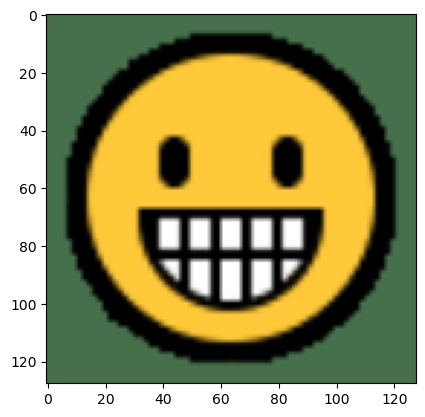

In [5]:
#displaying random img for reference
plt.imshow((X_train[0] + 1)/2)

In [6]:
#Train data shape
X_train.shape 

(1816, 128, 128, 3)

Therefore number of samples is 1816 and and each image is of shape (128, 128, 3)
and each pixel is normalised to range -1 to 1

#### Define Image Shape

In [7]:
#defining hyperparameters
img_height = 128
img_width = 128
channels = 3
img_shape = (img_height, img_width, channels)

     

#### GAN Model Structure

In [8]:
def build_generator():
    noise_shape = (latent_dim,)

    G = Sequential()
    
    G.add(Dense(4096))
    G.add(LeakyReLU(alpha=0.2))
    G.add(BatchNormalization(momentum=0.8))
    
    
    G.add(Dense(2048))
    G.add(LeakyReLU(alpha=0.2))
    G.add(BatchNormalization(momentum=0.8))
    
    
    G.add(Dense(1024))
    G.add(LeakyReLU(alpha=0.2))
    G.add(BatchNormalization(momentum=0.8))
    

    G.add(Dense(512))
    G.add(LeakyReLU(alpha=0.2))
    G.add(BatchNormalization(momentum=0.8)) 
     
    
    G.add(Dense(np.prod(img_shape), activation='tanh'))
    G.add(Reshape(img_shape))
    
   

    noise = Input(shape=noise_shape)
    generated_img = G(noise)

    return Model(noise, generated_img)

We use the above generator model to generate images, I have used Dense Layers for the same and LeakyRelu activation functions for intermediate layers and tanh Activtion function for the final layer we want our generated image pixels to range between - to 1

I have also tried using convolutional layer to generate images instead of dense layers, but in my limited hypertuning I performed dense layers gave me better results in fake image generation.

In [9]:
def build_discriminator():

    D = Sequential()
    
    D.add(Flatten())
    D.add(Dense(1024))
    D.add(LeakyReLU(alpha=0.2))
    
    D.add(Dense(512))
    D.add(LeakyReLU(alpha=0.2))
    D.add(Dense(256))
    
    D.add(LeakyReLU(alpha=0.2))
    D.add(Dense(128))
    D.add(LeakyReLU(alpha=0.2))
    
    D.add(Dense(1, activation='sigmoid'))
    

    img = Input(shape=img_shape)
    validity = D(img)
    


    return Model(img, validity)

The above discriminator is simple Dense layer based  discriminator. I have used sigmoid activation function in the final layer for output 0 and 1 (classify fake or real image)

In [10]:
def build_GAN(g_model, d_model, optimizer):
    # make weights in the discriminator not trainable
    d_model.trainable = False
    # initialize with a sequential model
    model = Sequential()
    # generator and discriminator are initialized later in the code to g_model and d_model respectively 
    # add the generator
    model.add(g_model)
    # add the discriminator
    model.add(d_model)
    # compile model
    model.compile(loss='binary_crossentropy', optimizer=optimizer)
    return model
    

This function build_GAN is used to  build and compiles a GAN model by combining a generator model (g_model) 
and a discriminator model (d_model). The discriminator model's trainable weights are set to False. 
And we use Adam as optimiser and binary_crossentropy as loss function.


#### Utility / Helper Functions

In [11]:
def generate_latent_points(latent_dim, n_samples):
    x_input = np.random.normal(0, 1, size=(n_samples, latent_dim)) 
    z_input = x_input.reshape(n_samples, latent_dim)
    return z_input

def generate_real_samples(X_train, n_samples):
    ix = randint(0, X_train.shape[0], n_samples) 
    X = X_train[ix]  
    y = ones((n_samples, 1)) 
    return X, y

def generate_fake_samples(generator, latent_dim, n_samples):
    z_input = generate_latent_points(latent_dim, n_samples)
    images = generator.predict(z_input)  
    y = zeros((n_samples, 1))
    return images, y

1. generate_latent_points func is used to generate noise vectors of shape (num_samples, latent_dim) , latent_dim is noise vector dim which is used in the generator to generate fake images
2. generate_real_samples func is used to fetch a batch of training images to train the discriminator on batch of size n_samples
3. generate_fake_samples func is used to generate fake images using latentpoints and generator 



In [12]:
# create and save a plot of generated images
def save_plot(examples, epoch, n=7):
    # scale from [-1,1] to [0,1]
    examples = (examples + 1) / 2.0
    # plot images
    for i in range(n * n):
        # define subplot
        plt.subplot(n, n, 1 + i)
        # turn off axis
        plt.axis('off')
        # plot raw pixel data
        plt.imshow(examples[i])
    # save plot to file
    filename = os.path.join(save_dir, 'generated_plot_e%03d.png' % (epoch+1))
    plt.savefig(filename)
    plt.close()

In [13]:
# evaluate the discriminator, plot generated images, save generator model
def summarize_performance(epoch, g_model, d_model, dataset, latent_dim, n_samples=49):
    print("################# Summarize ###################")
    # prepare real samples
    X_real, y_real = generate_real_samples(dataset, n_samples)
    # evaluate discriminator on real examples
    X_real_raw = np.array(X_real)
    y_real_raw = np.array(y_real)
    _, acc_real = d_model.evaluate(X_real_raw, y_real_raw, verbose=0)
    # prepare fake examples
    x_fake, y_fake = generate_fake_samples(g_model, latent_dim, n_samples)
    # evaluate discriminator on fake examples
    _, acc_fake = d_model.evaluate(x_fake, y_fake, verbose=0)
    # summarize discriminator performance
    print('>Accuracy real: %.0f%%, fake: %.0f%%' % (acc_real*100, acc_fake*100))
    # save plot
    save_plot(x_fake, epoch)
    # save the generator model tile file
    filename = 'generator_model_%03d.h5' % (epoch+1)
    filename = os.path.join(os.getcwd(),'comp_model_dense/'+filename)
    g_model.save(filename)

In [14]:
similarity_scores = {}
best_emojis = {}
top_5_best_emojis = {}
sorted_best_emojis = []

In [15]:
def save_best_emojis(epoch, g_model, d_model, dataset, latent_dim, n_samples = 5):
    for emoji_idx in range(n_samples):
        latent_point = generate_latent_points(latent_dim, 1)[0]
        generated_emoji = g_model.predict(np.array([latent_point]))[0]
        generated_emoji = (generated_emoji + 1)/ 2.0
        emoji_file_name = f'emoji_{epoch}_{emoji_idx}.png'
        plt.imsave(os.path.join(best_emojis_dir, emoji_file_name), generated_emoji)
        # Find the most similar reference emoji to the generated emoji
        for ref_emoji_idx, ref_emoji in enumerate(dataset):
            ref_emoji = (ref_emoji + 1)/2.0 #converting to 0 to 1 range
            similarity_scores[ref_emoji_idx] = np.mean(np.abs(generated_emoji - ref_emoji))
        most_similar_idx = min(similarity_scores, key=similarity_scores.get)
        similarity_score = similarity_scores[most_similar_idx]
        # Add the generated emoji and its similarity score to the best_emojis dictionary
        best_emojis[emoji_file_name] = {'most_similar_idx': most_similar_idx,
                                        'similarity_score': similarity_score}
        # Sort the best_emojis dictionary by similarity score in ascending order
        sorted_best_emojis = sorted(best_emojis.items(), key=lambda x: x[1]['similarity_score'])
        # Keep only the top 5 best emojis
        top_5_best_emojis = dict(sorted_best_emojis[:5])
    

#### Define Hyperparameters

In [16]:
learning_rate = 0.00002

# size of the latent space
latent_dim = 100

#Adam Optimiser
optimizer = Adam(learning_rate=learning_rate, beta_1=0.5)



# create the discriminator
d_model = build_discriminator()
d_model.compile(loss='binary_crossentropy',
                      optimizer=optimizer,
                      metrics=['accuracy'])


# create the generator
g_model = build_generator()
g_model.compile(loss='binary_crossentopy', optimizer=optimizer)

# create the gan
gan_model = build_GAN(g_model, d_model, optimizer)

# load image data
dataset = X_train

n_epochs = 5000

n_batch = 64

Metal device set to: Apple M1 Pro


2023-03-26 19:52:24.577340: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-03-26 19:52:24.577691: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


#### Training

In [17]:
# train the generator and discriminator
def train(g_model, d_model, gan_model, dataset, latent_dim, n_epochs=n_epochs, n_batch=n_batch):
    bat_per_epo = int(len(dataset) / n_batch)
    #print('Batches per Epoch is %d' %bat_per_epo)
    half_batch = int(n_batch / 2)
    #print("Half Batch %d" % half_batch)
    # manually enumerate epochs
    for i in tqdm(range(n_epochs)):
        
        start_epoch_time = time.time() 
        # enumerate batches over the training set
        for j in tqdm(range(bat_per_epo)):
            
            start_batch_time = time.time()
            # print("Batch number %d" %(j+1))
            # get randomly selected 'real' samples
            X_real, y_real = generate_real_samples(dataset, half_batch)
            #print(len(X_real))  
            X_real_raw = np.array(X_real)
            y_real_raw = np.array(y_real)
            # update discriminator model weights with real images
            # It is reccomended to update discriminator with seperate batches of real and fake images
            # update discriminator model with real images 
            d_loss1, _ = d_model.train_on_batch(X_real_raw, y_real_raw)
            # generate 'fake' examples
            X_fake, y_fake = generate_fake_samples(g_model, latent_dim, half_batch)
            # update discriminator model with fake images         
            d_loss2, _ = d_model.train_on_batch(X_fake, y_fake)
            # prepare points in latent space as input for the generator
            X_gan = generate_latent_points(latent_dim, n_batch)
            # create inverted labels for the fake samples
            y_gan = ones((n_batch, 1))
            # update the generator via the discriminator's error
            g_loss = gan_model.train_on_batch(X_gan, y_gan)
            end_batch_time = time.time()
            batch_time = end_batch_time - start_batch_time
            # summarize loss on this batch
            print('>%d, %d/%d, d1=%.3f, d2=%.3f g=%.3f batch_time=%.3f seconds' %
                (i+1, j+1, bat_per_epo, d_loss1, d_loss2, g_loss, batch_time))
        # evaluate the model performance, for every 10 epoch
        if (i+1) % 100 == 0:
            summarize_performance(i, g_model, d_model, dataset, latent_dim)
            
        if (i > 500) and ((i + 1)% 100) == 0:
            save_best_emojis(i, g_model, d_model, dataset, latent_dim)
        end_epoch_time = time.time() # end the timer for the epoch
        epoch_time = end_epoch_time - start_epoch_time # calculate the time taken for the epoch
        print('>%d, epoch_time=%.3f seconds' % (i+1, epoch_time))
            


In [ ]:
train(g_model, d_model, gan_model, dataset, latent_dim, n_epochs=n_epochs, n_batch=n_batch)

G.save(os.path.join(os.getcwd(),'comp_model_dense/generator_face_emoji.h5'))

  0%|                                                    | 0/28 [00:00<?, ?it/s]2023-03-26 19:52:25.151332: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2023-03-26 19:52:25.153995: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 206ms/step


2023-03-26 19:52:25.546344: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-03-26 19:52:26.014770: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.

  4%|█▌                                          | 1/28 [00:01<00:42,  1.56s/it]

>1, 1/28, d1=0.580, d2=0.696 g=0.675 batch_time=1.563 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:01<00:19,  1.34it/s]

>1, 2/28, d1=0.129, d2=0.699 g=0.660 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:01<00:12,  2.08it/s]

>1, 3/28, d1=0.037, d2=0.702 g=0.643 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:02<00:08,  2.81it/s]

>1, 4/28, d1=0.066, d2=0.679 g=0.628 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:02<00:06,  3.49it/s]

>1, 5/28, d1=0.022, d2=0.629 g=0.610 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:02<00:05,  4.09it/s]

>1, 6/28, d1=0.009, d2=0.534 g=0.601 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:02<00:04,  4.62it/s]

>1, 7/28, d1=0.002, d2=0.421 g=0.575 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:02<00:03,  5.02it/s]

>1, 8/28, d1=0.011, d2=0.309 g=0.571 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:02<00:03,  5.34it/s]

>1, 9/28, d1=0.004, d2=0.228 g=0.544 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:03<00:03,  5.57it/s]

>1, 10/28, d1=0.003, d2=0.176 g=0.516 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:03<00:02,  5.74it/s]

>1, 11/28, d1=0.016, d2=0.136 g=0.507 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:03<00:02,  5.88it/s]

>1, 12/28, d1=0.005, d2=0.124 g=0.483 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:03<00:02,  5.97it/s]

>1, 13/28, d1=0.012, d2=0.116 g=0.478 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:03<00:02,  6.02it/s]

>1, 14/28, d1=0.002, d2=0.123 g=0.456 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:03<00:02,  6.01it/s]

>1, 15/28, d1=0.004, d2=0.142 g=0.438 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:04<00:01,  6.00it/s]

>1, 16/28, d1=0.003, d2=0.179 g=0.433 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:04<00:01,  5.99it/s]

>1, 17/28, d1=0.002, d2=0.291 g=0.416 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:04<00:01,  5.99it/s]

>1, 18/28, d1=0.004, d2=0.255 g=0.398 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:04<00:01,  6.04it/s]

>1, 19/28, d1=0.001, d2=0.307 g=0.435 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:04<00:01,  6.05it/s]

>1, 20/28, d1=0.001, d2=0.312 g=0.450 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:04<00:01,  6.12it/s]

>1, 21/28, d1=0.002, d2=0.488 g=0.437 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:05<00:00,  6.15it/s]

>1, 22/28, d1=0.001, d2=0.565 g=0.472 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:05<00:00,  6.09it/s]

>1, 23/28, d1=0.001, d2=0.783 g=0.547 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:05<00:00,  6.10it/s]

>1, 24/28, d1=0.007, d2=0.687 g=0.500 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:05<00:00,  6.14it/s]

>1, 25/28, d1=0.002, d2=0.706 g=0.561 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:05<00:00,  6.12it/s]

>1, 26/28, d1=0.002, d2=0.729 g=0.561 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:05<00:00,  6.11it/s]

>1, 27/28, d1=0.004, d2=0.730 g=0.592 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  0%|                                        | 1/5000 [00:05<8:18:50,  5.99s/it]

>1, 28/28, d1=0.002, d2=0.785 g=0.635 batch_time=0.163 seconds
>1, epoch_time=5.987 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.12it/s]

>2, 1/28, d1=0.014, d2=0.775 g=0.633 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:05,  4.61it/s]

>2, 2/28, d1=0.002, d2=0.843 g=0.641 batch_time=0.253 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.13it/s]

>2, 3/28, d1=0.011, d2=0.758 g=0.691 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.46it/s]

>2, 4/28, d1=0.018, d2=0.787 g=0.706 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.71it/s]

>2, 5/28, d1=0.011, d2=0.799 g=0.699 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>2, 6/28, d1=0.004, d2=0.768 g=0.720 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>2, 7/28, d1=0.026, d2=0.649 g=0.730 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>2, 8/28, d1=0.006, d2=0.739 g=0.737 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>2, 9/28, d1=0.036, d2=0.735 g=0.729 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>2, 10/28, d1=0.009, d2=0.717 g=0.733 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>2, 11/28, d1=0.008, d2=0.719 g=0.778 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.12it/s]

>2, 12/28, d1=0.004, d2=0.650 g=0.767 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>2, 13/28, d1=0.020, d2=0.641 g=0.783 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>2, 14/28, d1=0.002, d2=0.664 g=0.807 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.19it/s]

>2, 15/28, d1=0.003, d2=0.677 g=0.819 batch_time=0.157 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.04it/s]

>2, 16/28, d1=0.008, d2=0.613 g=0.826 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>2, 17/28, d1=0.003, d2=0.636 g=0.842 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.08it/s]

>2, 18/28, d1=0.003, d2=0.599 g=0.884 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>2, 19/28, d1=0.001, d2=0.580 g=0.888 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>2, 20/28, d1=0.007, d2=0.604 g=0.901 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.18it/s]

>2, 21/28, d1=0.001, d2=0.536 g=0.898 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.21it/s]

>2, 22/28, d1=0.005, d2=0.536 g=0.916 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.24it/s]

>2, 23/28, d1=0.016, d2=0.504 g=0.931 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.13it/s]

>2, 24/28, d1=0.034, d2=0.526 g=0.938 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>2, 25/28, d1=0.112, d2=0.549 g=0.935 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.16it/s]

>2, 26/28, d1=0.001, d2=0.549 g=0.919 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.19it/s]

>2, 27/28, d1=0.016, d2=0.518 g=0.936 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



  0%|                                        | 2/5000 [00:10<7:13:40,  5.21s/it]

>2, 28/28, d1=0.002, d2=0.527 g=0.942 batch_time=0.165 seconds
>2, epoch_time=4.659 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.36it/s]

>3, 1/28, d1=0.003, d2=0.522 g=0.972 batch_time=0.157 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>3, 2/28, d1=0.010, d2=0.493 g=0.993 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.82it/s]

>3, 3/28, d1=0.015, d2=0.487 g=0.971 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>3, 4/28, d1=0.005, d2=0.505 g=0.988 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>3, 5/28, d1=0.003, d2=0.460 g=1.014 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>3, 6/28, d1=0.001, d2=0.450 g=1.051 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>3, 7/28, d1=0.004, d2=0.439 g=1.031 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>3, 8/28, d1=0.004, d2=0.464 g=1.082 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>3, 9/28, d1=0.279, d2=0.448 g=1.090 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.03it/s]

>3, 10/28, d1=0.414, d2=0.511 g=1.018 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>3, 11/28, d1=0.016, d2=0.461 g=1.004 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.04it/s]

>3, 12/28, d1=0.397, d2=0.497 g=0.955 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>3, 13/28, d1=0.003, d2=0.492 g=0.981 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>3, 14/28, d1=0.005, d2=0.509 g=0.986 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>3, 15/28, d1=0.000, d2=0.464 g=0.987 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>3, 16/28, d1=0.002, d2=0.519 g=0.996 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>3, 17/28, d1=0.007, d2=0.450 g=1.036 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>3, 18/28, d1=0.000, d2=0.457 g=1.068 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>3, 19/28, d1=0.001, d2=0.484 g=1.077 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.17it/s]

>3, 20/28, d1=0.002, d2=0.463 g=1.077 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>3, 21/28, d1=0.014, d2=0.434 g=1.099 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>3, 22/28, d1=0.001, d2=0.426 g=1.110 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>3, 23/28, d1=0.002, d2=0.423 g=1.129 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.05it/s]

>3, 24/28, d1=0.002, d2=0.409 g=1.137 batch_time=0.163 seconds
1/1 [==============================] - 0s 20ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.78it/s]

>3, 25/28, d1=0.001, d2=0.376 g=1.126 batch_time=0.190 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.73it/s]

>3, 26/28, d1=0.003, d2=0.398 g=1.119 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.79it/s]

>3, 27/28, d1=0.002, d2=0.384 g=1.170 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  0%|                                        | 3/5000 [00:15<6:53:07,  4.96s/it]

>3, 28/28, d1=0.002, d2=0.395 g=1.144 batch_time=0.162 seconds
>3, epoch_time=4.668 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>4, 1/28, d1=0.050, d2=0.402 g=1.158 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.17it/s]

>4, 2/28, d1=0.002, d2=0.385 g=1.206 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.21it/s]

>4, 3/28, d1=0.007, d2=0.385 g=1.180 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.24it/s]

>4, 4/28, d1=0.001, d2=0.422 g=1.202 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.26it/s]

>4, 5/28, d1=0.002, d2=0.380 g=1.217 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.22it/s]

>4, 6/28, d1=0.001, d2=0.376 g=1.233 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.27it/s]

>4, 7/28, d1=0.001, d2=0.350 g=1.248 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.26it/s]

>4, 8/28, d1=0.003, d2=0.333 g=1.239 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.26it/s]

>4, 9/28, d1=0.002, d2=0.330 g=1.239 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.23it/s]

>4, 10/28, d1=0.004, d2=0.311 g=1.282 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.22it/s]

>4, 11/28, d1=0.004, d2=0.338 g=1.265 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.21it/s]

>4, 12/28, d1=0.005, d2=0.352 g=1.279 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.22it/s]

>4, 13/28, d1=0.004, d2=0.357 g=1.303 batch_time=0.159 seconds
1/1 [==============================] - 0s 13ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.00it/s]

>4, 14/28, d1=0.012, d2=0.324 g=1.331 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>4, 15/28, d1=0.002, d2=0.317 g=1.343 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>4, 16/28, d1=0.976, d2=0.317 g=1.321 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>4, 17/28, d1=0.860, d2=0.331 g=1.283 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.95it/s]

>4, 18/28, d1=0.859, d2=0.361 g=1.217 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>4, 19/28, d1=0.023, d2=0.417 g=1.168 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>4, 20/28, d1=0.007, d2=0.374 g=1.203 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>4, 21/28, d1=0.054, d2=0.360 g=1.180 batch_time=0.158 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>4, 22/28, d1=0.000, d2=0.386 g=1.176 batch_time=0.177 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.76it/s]

>4, 23/28, d1=0.000, d2=0.394 g=1.165 batch_time=0.186 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.67it/s]

>4, 24/28, d1=0.000, d2=0.390 g=1.206 batch_time=0.180 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.72it/s]

>4, 25/28, d1=0.035, d2=0.386 g=1.216 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.71it/s]

>4, 26/28, d1=0.052, d2=0.381 g=1.223 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.72it/s]

>4, 27/28, d1=0.002, d2=0.362 g=1.211 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



  0%|                                        | 4/5000 [00:19<6:43:11,  4.84s/it]

>4, 28/28, d1=0.001, d2=0.384 g=1.219 batch_time=0.162 seconds
>4, epoch_time=4.661 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>5, 1/28, d1=0.000, d2=0.376 g=1.220 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>5, 2/28, d1=0.235, d2=0.410 g=1.219 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>5, 3/28, d1=0.297, d2=0.416 g=1.224 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>5, 4/28, d1=0.004, d2=0.379 g=1.245 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>5, 5/28, d1=0.001, d2=0.396 g=1.254 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>5, 6/28, d1=0.073, d2=0.355 g=1.249 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>5, 7/28, d1=0.046, d2=0.372 g=1.226 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>5, 8/28, d1=0.001, d2=0.334 g=1.214 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>5, 9/28, d1=0.000, d2=0.351 g=1.232 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>5, 10/28, d1=0.001, d2=0.328 g=1.223 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>5, 11/28, d1=0.000, d2=0.382 g=1.269 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.99it/s]

>5, 12/28, d1=0.004, d2=0.346 g=1.312 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.82it/s]

>5, 13/28, d1=0.000, d2=0.330 g=1.299 batch_time=0.181 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.70it/s]

>5, 14/28, d1=0.006, d2=0.351 g=1.305 batch_time=0.182 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.74it/s]

>5, 15/28, d1=0.026, d2=0.357 g=1.344 batch_time=0.170 seconds
1/1 [==============================] - 0s 15ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.70it/s]

>5, 16/28, d1=0.005, d2=0.334 g=1.342 batch_time=0.177 seconds
1/1 [==============================] - 0s 14ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.53it/s]

>5, 17/28, d1=0.003, d2=0.328 g=1.356 batch_time=0.192 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.53it/s]

>5, 18/28, d1=0.004, d2=0.345 g=1.360 batch_time=0.179 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.53it/s]

>5, 19/28, d1=0.052, d2=0.341 g=1.343 batch_time=0.178 seconds
1/1 [==============================] - 0s 13ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.46it/s]

>5, 20/28, d1=0.806, d2=0.320 g=1.386 batch_time=0.187 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.55it/s]

>5, 21/28, d1=0.792, d2=0.421 g=1.674 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.61it/s]

>5, 22/28, d1=0.002, d2=0.419 g=1.424 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.70it/s]

>5, 23/28, d1=0.001, d2=0.331 g=1.363 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.74it/s]

>5, 24/28, d1=0.000, d2=0.335 g=1.298 batch_time=0.170 seconds
1/1 [==============================] - 0s 13ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.57it/s]

>5, 25/28, d1=0.000, d2=0.365 g=1.231 batch_time=0.191 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.59it/s]

>5, 26/28, d1=0.000, d2=0.362 g=1.230 batch_time=0.176 seconds
1/1 [==============================] - 0s 18ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.43it/s]

>5, 27/28, d1=0.301, d2=0.426 g=1.250 batch_time=0.196 seconds
1/1 [==============================] - 0s 10ms/step



  0%|                                        | 5/5000 [00:24<6:45:03,  4.87s/it]

>5, 28/28, d1=0.000, d2=0.395 g=1.288 batch_time=0.172 seconds
>5, epoch_time=4.907 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>6, 1/28, d1=0.001, d2=0.344 g=1.282 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.73it/s]

>6, 2/28, d1=1.727, d2=0.410 g=1.277 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.80it/s]

>6, 3/28, d1=0.006, d2=0.379 g=1.223 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>6, 4/28, d1=0.020, d2=0.447 g=1.228 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.83it/s]

>6, 5/28, d1=0.000, d2=0.391 g=1.256 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>6, 6/28, d1=0.001, d2=0.370 g=1.281 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.83it/s]

>6, 7/28, d1=0.015, d2=0.347 g=1.256 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>6, 8/28, d1=0.000, d2=0.357 g=1.248 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>6, 9/28, d1=0.003, d2=0.353 g=1.251 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>6, 10/28, d1=0.002, d2=0.358 g=1.280 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>6, 11/28, d1=0.012, d2=0.347 g=1.306 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>6, 12/28, d1=0.008, d2=0.386 g=1.316 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>6, 13/28, d1=0.008, d2=0.333 g=1.344 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>6, 14/28, d1=0.001, d2=0.353 g=1.360 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.79it/s]

>6, 15/28, d1=0.130, d2=0.320 g=1.341 batch_time=0.180 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.67it/s]

>6, 16/28, d1=0.318, d2=0.332 g=1.353 batch_time=0.183 seconds
1/1 [==============================] - 0s 13ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:02,  5.50it/s]

>6, 17/28, d1=0.002, d2=0.338 g=1.345 batch_time=0.193 seconds
1/1 [==============================] - 0s 15ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.48it/s]

>6, 18/28, d1=0.066, d2=0.361 g=1.313 batch_time=0.183 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.56it/s]

>6, 19/28, d1=0.088, d2=0.357 g=1.323 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.60it/s]

>6, 20/28, d1=0.033, d2=0.384 g=1.349 batch_time=0.175 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.59it/s]

>6, 21/28, d1=0.001, d2=0.331 g=1.397 batch_time=0.178 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.65it/s]

>6, 22/28, d1=0.068, d2=0.330 g=1.354 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.73it/s]

>6, 23/28, d1=0.003, d2=0.348 g=1.343 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>6, 24/28, d1=0.003, d2=0.346 g=1.353 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>6, 25/28, d1=0.003, d2=0.322 g=1.375 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>6, 26/28, d1=0.003, d2=0.306 g=1.391 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>6, 27/28, d1=0.004, d2=0.336 g=1.378 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  0%|                                        | 6/5000 [00:29<6:43:55,  4.85s/it]

>6, 28/28, d1=0.004, d2=0.352 g=1.394 batch_time=0.165 seconds
>6, epoch_time=4.828 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>7, 1/28, d1=0.013, d2=0.329 g=1.450 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.82it/s]

>7, 2/28, d1=0.056, d2=0.367 g=1.426 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>7, 3/28, d1=0.001, d2=0.298 g=1.393 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>7, 4/28, d1=0.029, d2=0.314 g=1.384 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.79it/s]

>7, 5/28, d1=0.013, d2=0.345 g=1.354 batch_time=0.182 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>7, 6/28, d1=0.016, d2=0.314 g=1.383 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.78it/s]

>7, 7/28, d1=0.011, d2=0.323 g=1.393 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.73it/s]

>7, 8/28, d1=0.063, d2=0.296 g=1.415 batch_time=0.175 seconds
1/1 [==============================] - 0s 13ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.57it/s]

>7, 9/28, d1=0.005, d2=0.314 g=1.397 batch_time=0.188 seconds
1/1 [==============================] - 0s 14ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.49it/s]

>7, 10/28, d1=0.017, d2=0.299 g=1.426 batch_time=0.187 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:03,  5.54it/s]

>7, 11/28, d1=0.073, d2=0.283 g=1.389 batch_time=0.176 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.55it/s]

>7, 12/28, d1=0.002, d2=0.323 g=1.362 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.57it/s]

>7, 13/28, d1=0.148, d2=0.308 g=1.394 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.61it/s]

>7, 14/28, d1=0.024, d2=0.326 g=1.378 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.68it/s]

>7, 15/28, d1=0.005, d2=0.316 g=1.398 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.73it/s]

>7, 16/28, d1=0.078, d2=0.307 g=1.457 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.75it/s]

>7, 17/28, d1=0.001, d2=0.303 g=1.381 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.71it/s]

>7, 18/28, d1=0.001, d2=0.305 g=1.397 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.78it/s]

>7, 19/28, d1=0.001, d2=0.346 g=1.376 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.83it/s]

>7, 20/28, d1=0.001, d2=0.298 g=1.416 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.80it/s]

>7, 21/28, d1=2.060, d2=0.302 g=1.706 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.79it/s]

>7, 22/28, d1=0.228, d2=0.469 g=1.617 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:04<00:00,  5.90it/s]

>7, 23/28, d1=0.001, d2=0.428 g=1.468 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.99it/s]

>7, 24/28, d1=0.014, d2=0.306 g=1.529 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>7, 25/28, d1=0.000, d2=0.355 g=1.428 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>7, 26/28, d1=0.001, d2=0.368 g=1.428 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.15it/s]

>7, 27/28, d1=0.002, d2=0.291 g=1.439 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  0%|                                        | 7/5000 [00:34<6:42:37,  4.84s/it]

>7, 28/28, d1=0.016, d2=0.305 g=1.417 batch_time=0.159 seconds
>7, epoch_time=4.808 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.23it/s]

>8, 1/28, d1=0.001, d2=0.295 g=1.392 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.23it/s]

>8, 2/28, d1=0.001, d2=0.304 g=1.401 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.25it/s]

>8, 3/28, d1=0.003, d2=0.295 g=1.452 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.17it/s]

>8, 4/28, d1=0.016, d2=0.300 g=1.417 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.18it/s]

>8, 5/28, d1=0.509, d2=0.316 g=1.417 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.20it/s]

>8, 6/28, d1=0.015, d2=0.297 g=1.378 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.20it/s]

>8, 7/28, d1=0.135, d2=0.286 g=1.363 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.21it/s]

>8, 8/28, d1=0.087, d2=0.295 g=1.400 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.24it/s]

>8, 9/28, d1=0.000, d2=0.352 g=1.381 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.18it/s]

>8, 10/28, d1=0.002, d2=0.326 g=1.414 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.18it/s]

>8, 11/28, d1=0.002, d2=0.320 g=1.412 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.22it/s]

>8, 12/28, d1=0.261, d2=0.336 g=1.364 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.21it/s]

>8, 13/28, d1=0.035, d2=0.327 g=1.433 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>8, 14/28, d1=0.005, d2=0.310 g=1.376 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>8, 15/28, d1=0.002, d2=0.335 g=1.348 batch_time=0.167 seconds
1/1 [==============================] - 0s 14ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.74it/s]

>8, 16/28, d1=0.001, d2=0.350 g=1.377 batch_time=0.195 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.76it/s]

>8, 17/28, d1=0.009, d2=0.339 g=1.389 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.78it/s]

>8, 18/28, d1=0.001, d2=0.317 g=1.354 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.82it/s]

>8, 19/28, d1=0.002, d2=0.315 g=1.379 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>8, 20/28, d1=0.005, d2=0.286 g=1.395 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>8, 21/28, d1=0.003, d2=0.331 g=1.412 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>8, 22/28, d1=0.015, d2=0.325 g=1.409 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>8, 23/28, d1=0.019, d2=0.302 g=1.434 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>8, 24/28, d1=0.003, d2=0.267 g=1.442 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.19it/s]

>8, 25/28, d1=0.242, d2=0.299 g=1.523 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.21it/s]

>8, 26/28, d1=0.015, d2=0.296 g=1.451 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.24it/s]

>8, 27/28, d1=0.005, d2=0.301 g=1.444 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  0%|                                        | 8/5000 [00:39<6:35:56,  4.76s/it]

>8, 28/28, d1=0.716, d2=0.322 g=1.428 batch_time=0.161 seconds
>8, epoch_time=4.589 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.25it/s]

>9, 1/28, d1=0.290, d2=0.398 g=1.559 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.24it/s]

>9, 2/28, d1=0.020, d2=0.409 g=1.387 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.25it/s]

>9, 3/28, d1=0.000, d2=0.334 g=1.425 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.19it/s]

>9, 4/28, d1=0.000, d2=0.389 g=1.373 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.21it/s]

>9, 5/28, d1=0.190, d2=0.387 g=1.286 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.21it/s]

>9, 6/28, d1=0.351, d2=0.353 g=1.309 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.22it/s]

>9, 7/28, d1=0.004, d2=0.363 g=1.273 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.22it/s]

>9, 8/28, d1=0.003, d2=0.369 g=1.328 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.22it/s]

>9, 9/28, d1=0.001, d2=0.349 g=1.331 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.21it/s]

>9, 10/28, d1=0.177, d2=0.335 g=1.289 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.22it/s]

>9, 11/28, d1=0.001, d2=0.350 g=1.266 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.24it/s]

>9, 12/28, d1=0.007, d2=0.357 g=1.305 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.24it/s]

>9, 13/28, d1=0.004, d2=0.338 g=1.306 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>9, 14/28, d1=0.016, d2=0.372 g=1.312 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>9, 15/28, d1=0.002, d2=0.369 g=1.279 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>9, 16/28, d1=0.000, d2=0.329 g=1.288 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>9, 17/28, d1=0.002, d2=0.374 g=1.294 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.02it/s]

>9, 18/28, d1=0.154, d2=0.327 g=1.333 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>9, 19/28, d1=0.010, d2=0.347 g=1.307 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>9, 20/28, d1=0.002, d2=0.348 g=1.306 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>9, 21/28, d1=0.007, d2=0.319 g=1.310 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>9, 22/28, d1=0.003, d2=0.330 g=1.310 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>9, 23/28, d1=0.003, d2=0.324 g=1.319 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.89it/s]

>9, 24/28, d1=0.009, d2=0.365 g=1.337 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>9, 25/28, d1=0.001, d2=0.327 g=1.338 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>9, 26/28, d1=0.027, d2=0.348 g=1.348 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>9, 27/28, d1=0.666, d2=0.333 g=1.350 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



  0%|                                        | 9/5000 [00:43<6:31:47,  4.71s/it]

>9, 28/28, d1=0.302, d2=0.416 g=1.393 batch_time=0.160 seconds
>9, epoch_time=4.602 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.21it/s]

>10, 1/28, d1=0.007, d2=0.371 g=1.332 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.21it/s]

>10, 2/28, d1=2.851, d2=0.376 g=1.412 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>10, 3/28, d1=0.002, d2=0.347 g=1.318 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.17it/s]

>10, 4/28, d1=0.070, d2=0.429 g=1.324 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.20it/s]

>10, 5/28, d1=0.528, d2=0.342 g=1.319 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.15it/s]

>10, 6/28, d1=0.001, d2=0.420 g=1.301 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.18it/s]

>10, 7/28, d1=0.066, d2=0.408 g=1.291 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.16it/s]

>10, 8/28, d1=0.000, d2=0.341 g=1.235 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>10, 9/28, d1=0.035, d2=0.386 g=1.253 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>10, 10/28, d1=0.000, d2=0.366 g=1.254 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>10, 11/28, d1=0.001, d2=0.353 g=1.326 batch_time=0.164 seconds
1/1 [==============================] - 0s 15ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.92it/s]

>10, 12/28, d1=0.006, d2=0.342 g=1.273 batch_time=0.173 seconds
1/1 [==============================] - 0s 18ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.81it/s]

>10, 13/28, d1=0.111, d2=0.397 g=1.256 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>10, 14/28, d1=0.000, d2=0.372 g=1.259 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.80it/s]

>10, 15/28, d1=0.000, d2=0.379 g=1.305 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>10, 16/28, d1=0.007, d2=0.338 g=1.306 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.82it/s]

>10, 17/28, d1=0.000, d2=0.348 g=1.320 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.79it/s]

>10, 18/28, d1=0.000, d2=0.310 g=1.334 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>10, 19/28, d1=0.001, d2=0.356 g=1.350 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.83it/s]

>10, 20/28, d1=0.001, d2=0.323 g=1.335 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>10, 21/28, d1=0.001, d2=0.314 g=1.353 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>10, 22/28, d1=0.005, d2=0.379 g=1.396 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.81it/s]

>10, 23/28, d1=0.001, d2=0.315 g=1.414 batch_time=0.179 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.74it/s]

>10, 24/28, d1=0.029, d2=0.306 g=1.378 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.69it/s]

>10, 25/28, d1=0.006, d2=0.328 g=1.373 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.66it/s]

>10, 26/28, d1=0.003, d2=0.332 g=1.403 batch_time=0.177 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.57it/s]

>10, 27/28, d1=0.001, d2=0.312 g=1.397 batch_time=0.185 seconds
1/1 [==============================] - 0s 11ms/step



  0%|                                       | 10/5000 [00:48<6:33:15,  4.73s/it]

>10, 28/28, d1=0.001, d2=0.306 g=1.441 batch_time=0.172 seconds
>10, epoch_time=4.770 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>11, 1/28, d1=0.050, d2=0.302 g=1.385 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>11, 2/28, d1=0.061, d2=0.328 g=1.392 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>11, 3/28, d1=0.001, d2=0.304 g=1.408 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>11, 4/28, d1=0.022, d2=0.344 g=1.414 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>11, 5/28, d1=0.001, d2=0.335 g=1.439 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.00it/s]

>11, 6/28, d1=0.003, d2=0.287 g=1.444 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>11, 7/28, d1=0.004, d2=0.292 g=1.452 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>11, 8/28, d1=0.128, d2=0.312 g=1.408 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>11, 9/28, d1=0.002, d2=0.318 g=1.413 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>11, 10/28, d1=0.002, d2=0.321 g=1.417 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>11, 11/28, d1=0.001, d2=0.316 g=1.460 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>11, 12/28, d1=1.134, d2=0.303 g=1.521 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>11, 13/28, d1=1.385, d2=0.563 g=2.166 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>11, 14/28, d1=0.000, d2=0.383 g=1.539 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>11, 15/28, d1=0.004, d2=0.490 g=1.486 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>11, 16/28, d1=1.358, d2=0.369 g=1.319 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.22it/s]

>11, 17/28, d1=0.134, d2=0.434 g=1.233 batch_time=0.156 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.20it/s]

>11, 18/28, d1=0.444, d2=0.383 g=1.193 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.16it/s]

>11, 19/28, d1=0.000, d2=0.476 g=1.218 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>11, 20/28, d1=0.000, d2=0.430 g=1.214 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>11, 21/28, d1=2.547, d2=0.402 g=1.215 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>11, 22/28, d1=0.000, d2=0.418 g=1.170 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>11, 23/28, d1=0.000, d2=0.404 g=1.193 batch_time=0.160 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.88it/s]

>11, 24/28, d1=2.566, d2=0.358 g=1.265 batch_time=0.183 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>11, 25/28, d1=0.039, d2=0.409 g=1.200 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>11, 26/28, d1=0.951, d2=0.399 g=1.255 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>11, 27/28, d1=0.008, d2=0.474 g=1.132 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  0%|                                       | 11/5000 [00:53<6:30:48,  4.70s/it]

>11, 28/28, d1=0.000, d2=0.434 g=1.183 batch_time=0.159 seconds
>11, epoch_time=4.635 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.13it/s]

>12, 1/28, d1=0.000, d2=0.392 g=1.155 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.09it/s]

>12, 2/28, d1=0.002, d2=0.427 g=1.169 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>12, 3/28, d1=0.000, d2=0.418 g=1.189 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>12, 4/28, d1=0.027, d2=0.398 g=1.184 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>12, 5/28, d1=0.001, d2=0.396 g=1.184 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.18it/s]

>12, 6/28, d1=0.001, d2=0.389 g=1.169 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>12, 7/28, d1=0.003, d2=0.392 g=1.158 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>12, 8/28, d1=0.002, d2=0.368 g=1.191 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>12, 9/28, d1=0.001, d2=0.412 g=1.216 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.17it/s]

>12, 10/28, d1=0.003, d2=0.386 g=1.233 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.23it/s]

>12, 11/28, d1=0.002, d2=0.389 g=1.226 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.26it/s]

>12, 12/28, d1=0.971, d2=0.370 g=1.207 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.27it/s]

>12, 13/28, d1=0.070, d2=0.389 g=1.243 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.26it/s]

>12, 14/28, d1=0.007, d2=0.390 g=1.202 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.21it/s]

>12, 15/28, d1=0.000, d2=0.385 g=1.217 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.19it/s]

>12, 16/28, d1=0.013, d2=0.424 g=1.232 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.21it/s]

>12, 17/28, d1=0.002, d2=0.352 g=1.257 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.23it/s]

>12, 18/28, d1=0.016, d2=0.394 g=1.228 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.18it/s]

>12, 19/28, d1=0.001, d2=0.406 g=1.267 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.21it/s]

>12, 20/28, d1=0.081, d2=0.347 g=1.276 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.22it/s]

>12, 21/28, d1=0.001, d2=0.379 g=1.294 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.20it/s]

>12, 22/28, d1=0.028, d2=0.340 g=1.266 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.19it/s]

>12, 23/28, d1=0.076, d2=0.354 g=1.267 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.21it/s]

>12, 24/28, d1=0.002, d2=0.409 g=1.269 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.21it/s]

>12, 25/28, d1=0.196, d2=0.427 g=1.263 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.21it/s]

>12, 26/28, d1=0.067, d2=0.448 g=1.321 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.22it/s]

>12, 27/28, d1=0.000, d2=0.360 g=1.339 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  0%|                                       | 12/5000 [00:57<6:26:17,  4.65s/it]

>12, 28/28, d1=0.002, d2=0.338 g=1.289 batch_time=0.160 seconds
>12, epoch_time=4.524 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.22it/s]

>13, 1/28, d1=0.001, d2=0.350 g=1.286 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.24it/s]

>13, 2/28, d1=0.001, d2=0.445 g=1.305 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.22it/s]

>13, 3/28, d1=0.057, d2=0.407 g=1.292 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.20it/s]

>13, 4/28, d1=0.004, d2=0.346 g=1.259 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.21it/s]

>13, 5/28, d1=0.008, d2=0.411 g=1.302 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.20it/s]

>13, 6/28, d1=0.003, d2=0.300 g=1.339 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.24it/s]

>13, 7/28, d1=0.070, d2=0.365 g=1.324 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.21it/s]

>13, 8/28, d1=0.000, d2=0.397 g=1.328 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.22it/s]

>13, 9/28, d1=0.003, d2=0.326 g=1.293 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.22it/s]

>13, 10/28, d1=0.001, d2=0.354 g=1.317 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.19it/s]

>13, 11/28, d1=0.001, d2=0.326 g=1.304 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.19it/s]

>13, 12/28, d1=0.045, d2=0.351 g=1.312 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.18it/s]

>13, 13/28, d1=0.000, d2=0.361 g=1.304 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.18it/s]

>13, 14/28, d1=0.003, d2=0.415 g=1.302 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.21it/s]

>13, 15/28, d1=0.123, d2=0.386 g=1.332 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.20it/s]

>13, 16/28, d1=0.010, d2=0.319 g=1.318 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.18it/s]

>13, 17/28, d1=0.068, d2=0.392 g=1.285 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.20it/s]

>13, 18/28, d1=0.030, d2=0.366 g=1.262 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.23it/s]

>13, 19/28, d1=0.001, d2=0.406 g=1.275 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.25it/s]

>13, 20/28, d1=0.001, d2=0.354 g=1.270 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.24it/s]

>13, 21/28, d1=0.002, d2=0.344 g=1.301 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.24it/s]

>13, 22/28, d1=0.004, d2=0.362 g=1.327 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.22it/s]

>13, 23/28, d1=0.001, d2=0.352 g=1.322 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.19it/s]

>13, 24/28, d1=0.014, d2=0.384 g=1.403 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.23it/s]

>13, 25/28, d1=1.937, d2=0.330 g=1.395 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.24it/s]

>13, 26/28, d1=0.323, d2=0.373 g=1.321 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.23it/s]

>13, 27/28, d1=0.562, d2=0.387 g=1.512 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  0%|                                       | 13/5000 [01:02<6:22:43,  4.60s/it]

>13, 28/28, d1=0.009, d2=0.350 g=1.342 batch_time=0.161 seconds
>13, epoch_time=4.508 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.12it/s]

>14, 1/28, d1=0.019, d2=0.363 g=1.321 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>14, 2/28, d1=0.003, d2=0.387 g=1.286 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>14, 3/28, d1=0.002, d2=0.375 g=1.305 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>14, 4/28, d1=1.090, d2=0.382 g=1.473 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>14, 5/28, d1=0.450, d2=0.355 g=1.909 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>14, 6/28, d1=0.000, d2=0.382 g=1.532 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:04,  4.79it/s]

>14, 7/28, d1=0.083, d2=0.371 g=1.505 batch_time=0.287 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.18it/s]

>14, 8/28, d1=0.000, d2=0.426 g=1.286 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.49it/s]

>14, 9/28, d1=0.002, d2=0.445 g=1.274 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.71it/s]

>14, 10/28, d1=0.064, d2=0.396 g=1.221 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>14, 11/28, d1=0.000, d2=0.432 g=1.215 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.98it/s]

>14, 12/28, d1=0.000, d2=0.352 g=1.226 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>14, 13/28, d1=0.003, d2=0.401 g=1.248 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>14, 14/28, d1=0.070, d2=0.423 g=1.244 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.16it/s]

>14, 15/28, d1=0.126, d2=0.363 g=1.200 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.21it/s]

>14, 16/28, d1=0.002, d2=0.452 g=1.237 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.22it/s]

>14, 17/28, d1=0.001, d2=0.394 g=1.281 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.24it/s]

>14, 18/28, d1=0.000, d2=0.365 g=1.267 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.24it/s]

>14, 19/28, d1=1.058, d2=0.355 g=1.326 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.23it/s]

>14, 20/28, d1=0.007, d2=0.386 g=1.290 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.25it/s]

>14, 21/28, d1=0.297, d2=0.358 g=1.320 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.24it/s]

>14, 22/28, d1=0.061, d2=0.369 g=1.295 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.22it/s]

>14, 23/28, d1=0.067, d2=0.426 g=1.308 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.24it/s]

>14, 24/28, d1=0.000, d2=0.361 g=1.326 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.24it/s]

>14, 25/28, d1=0.002, d2=0.404 g=1.335 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.20it/s]

>14, 26/28, d1=0.003, d2=0.335 g=1.384 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.22it/s]

>14, 27/28, d1=0.018, d2=0.360 g=1.354 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  0%|                                       | 14/5000 [01:06<6:24:03,  4.62s/it]

>14, 28/28, d1=0.006, d2=0.378 g=1.350 batch_time=0.160 seconds
>14, epoch_time=4.661 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.33it/s]

>15, 1/28, d1=0.041, d2=0.354 g=1.380 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.10it/s]

>15, 2/28, d1=0.271, d2=0.405 g=1.396 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>15, 3/28, d1=0.001, d2=0.336 g=1.381 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.12it/s]

>15, 4/28, d1=0.000, d2=0.329 g=1.362 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>15, 5/28, d1=0.001, d2=0.360 g=1.330 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>15, 6/28, d1=0.007, d2=0.379 g=1.394 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>15, 7/28, d1=0.008, d2=0.345 g=1.380 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.72it/s]

>15, 8/28, d1=0.010, d2=0.367 g=1.423 batch_time=0.185 seconds
1/1 [==============================] - 0s 18ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.17it/s]

>15, 9/28, d1=0.058, d2=0.330 g=1.420 batch_time=0.233 seconds
1/1 [==============================] - 0s 14ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  4.85it/s]

>15, 10/28, d1=0.001, d2=0.327 g=1.414 batch_time=0.234 seconds
1/1 [==============================] - 0s 13ms/step



 39%|████████████████▉                          | 11/28 [00:02<00:03,  4.98it/s]

>15, 11/28, d1=0.223, d2=0.290 g=1.476 batch_time=0.188 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:03,  5.29it/s]

>15, 12/28, d1=0.004, d2=0.337 g=1.431 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.53it/s]

>15, 13/28, d1=0.003, d2=0.309 g=1.437 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.69it/s]

>15, 14/28, d1=1.123, d2=0.331 g=1.675 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.84it/s]

>15, 15/28, d1=2.661, d2=0.783 g=3.625 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>15, 16/28, d1=0.703, d2=0.509 g=2.233 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.05it/s]

>15, 17/28, d1=2.324, d2=0.325 g=1.623 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.10it/s]

>15, 18/28, d1=2.092, d2=0.430 g=1.402 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.16it/s]

>15, 19/28, d1=0.555, d2=0.552 g=1.189 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.18it/s]

>15, 20/28, d1=0.000, d2=0.555 g=1.049 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.20it/s]

>15, 21/28, d1=0.000, d2=0.485 g=1.020 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.21it/s]

>15, 22/28, d1=0.000, d2=0.496 g=1.012 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.22it/s]

>15, 23/28, d1=0.000, d2=0.580 g=0.960 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.22it/s]

>15, 24/28, d1=0.000, d2=0.521 g=0.998 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.26it/s]

>15, 25/28, d1=0.000, d2=0.522 g=1.001 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.27it/s]

>15, 26/28, d1=2.568, d2=0.495 g=1.063 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.24it/s]

>15, 27/28, d1=0.556, d2=0.522 g=1.014 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  0%|                                       | 15/5000 [01:11<6:26:52,  4.66s/it]

>15, 28/28, d1=0.007, d2=0.515 g=1.018 batch_time=0.160 seconds
>15, epoch_time=4.737 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.38it/s]

>16, 1/28, d1=0.024, d2=0.455 g=1.018 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.21it/s]

>16, 2/28, d1=0.003, d2=0.504 g=1.001 batch_time=0.163 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>16, 3/28, d1=0.019, d2=0.528 g=1.003 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>16, 4/28, d1=0.080, d2=0.477 g=1.000 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>16, 5/28, d1=0.554, d2=0.533 g=0.991 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>16, 6/28, d1=0.029, d2=0.561 g=1.005 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>16, 7/28, d1=0.007, d2=0.531 g=0.997 batch_time=0.166 seconds
1/1 [==============================] - 0s 16ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.81it/s]

>16, 8/28, d1=0.001, d2=0.474 g=1.016 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>16, 9/28, d1=0.005, d2=0.545 g=1.039 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>16, 10/28, d1=0.003, d2=0.449 g=1.045 batch_time=0.163 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>16, 11/28, d1=0.036, d2=0.460 g=1.049 batch_time=0.172 seconds
1/1 [==============================] - 0s 14ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.69it/s]

>16, 12/28, d1=0.006, d2=0.433 g=1.057 batch_time=0.188 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.65it/s]

>16, 13/28, d1=0.007, d2=0.491 g=1.080 batch_time=0.178 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.63it/s]

>16, 14/28, d1=1.133, d2=0.422 g=1.084 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.68it/s]

>16, 15/28, d1=0.012, d2=0.447 g=1.074 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.63it/s]

>16, 16/28, d1=0.019, d2=0.457 g=1.077 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.67it/s]

>16, 17/28, d1=0.004, d2=0.467 g=1.080 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.72it/s]

>16, 18/28, d1=0.010, d2=0.477 g=1.076 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.79it/s]

>16, 19/28, d1=0.002, d2=0.475 g=1.104 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.78it/s]

>16, 20/28, d1=0.003, d2=0.411 g=1.114 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.80it/s]

>16, 21/28, d1=0.023, d2=0.427 g=1.118 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>16, 22/28, d1=0.003, d2=0.392 g=1.140 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>16, 23/28, d1=0.117, d2=0.431 g=1.117 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>16, 24/28, d1=0.033, d2=0.409 g=1.109 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>16, 25/28, d1=0.004, d2=0.461 g=1.125 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>16, 26/28, d1=0.013, d2=0.437 g=1.145 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>16, 27/28, d1=0.008, d2=0.409 g=1.129 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  0%|                                       | 16/5000 [01:16<6:29:24,  4.69s/it]

>16, 28/28, d1=0.016, d2=0.437 g=1.126 batch_time=0.160 seconds
>16, epoch_time=4.761 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.24it/s]

>17, 1/28, d1=0.007, d2=0.405 g=1.156 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.25it/s]

>17, 2/28, d1=0.005, d2=0.430 g=1.191 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.26it/s]

>17, 3/28, d1=0.335, d2=0.379 g=1.153 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.20it/s]

>17, 4/28, d1=0.023, d2=0.433 g=1.120 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>17, 5/28, d1=0.250, d2=0.522 g=1.146 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>17, 6/28, d1=0.029, d2=0.426 g=1.167 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>17, 7/28, d1=0.196, d2=0.427 g=1.136 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>17, 8/28, d1=0.009, d2=0.409 g=1.125 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>17, 9/28, d1=0.013, d2=0.448 g=1.136 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>17, 10/28, d1=0.001, d2=0.414 g=1.149 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>17, 11/28, d1=0.001, d2=0.454 g=1.169 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.97it/s]

>17, 12/28, d1=0.005, d2=0.390 g=1.174 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>17, 13/28, d1=0.023, d2=0.403 g=1.196 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>17, 14/28, d1=0.018, d2=0.406 g=1.168 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>17, 15/28, d1=0.006, d2=0.363 g=1.196 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>17, 16/28, d1=0.146, d2=0.419 g=1.207 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>17, 17/28, d1=0.025, d2=0.437 g=1.152 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.03it/s]

>17, 18/28, d1=0.014, d2=0.448 g=1.208 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.07it/s]

>17, 19/28, d1=0.010, d2=0.403 g=1.219 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>17, 20/28, d1=0.006, d2=0.373 g=1.216 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>17, 21/28, d1=0.036, d2=0.444 g=1.203 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.19it/s]

>17, 22/28, d1=0.002, d2=0.426 g=1.236 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.21it/s]

>17, 23/28, d1=0.070, d2=0.393 g=1.199 batch_time=0.159 seconds
1/1 [==============================] - 0s 8ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.25it/s]

>17, 24/28, d1=0.960, d2=0.357 g=1.246 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.26it/s]

>17, 25/28, d1=0.102, d2=0.469 g=1.195 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.24it/s]

>17, 26/28, d1=0.002, d2=0.390 g=1.178 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>17, 27/28, d1=0.000, d2=0.421 g=1.216 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  0%|▏                                      | 17/5000 [01:20<6:27:22,  4.66s/it]

>17, 28/28, d1=0.039, d2=0.411 g=1.174 batch_time=0.169 seconds
>17, epoch_time=4.610 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>18, 1/28, d1=0.001, d2=0.426 g=1.189 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>18, 2/28, d1=0.068, d2=0.390 g=1.229 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>18, 3/28, d1=0.004, d2=0.394 g=1.215 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>18, 4/28, d1=0.037, d2=0.381 g=1.205 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>18, 5/28, d1=0.001, d2=0.410 g=1.251 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>18, 6/28, d1=0.107, d2=0.386 g=1.205 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.83it/s]

>18, 7/28, d1=0.002, d2=0.367 g=1.210 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>18, 8/28, d1=0.607, d2=0.380 g=1.273 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>18, 9/28, d1=0.115, d2=0.376 g=1.296 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>18, 10/28, d1=0.001, d2=0.412 g=1.268 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>18, 11/28, d1=0.001, d2=0.378 g=1.286 batch_time=0.159 seconds
1/1 [==============================] - 0s 15ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>18, 12/28, d1=0.003, d2=0.358 g=1.285 batch_time=0.182 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.72it/s]

>18, 13/28, d1=0.004, d2=0.334 g=1.294 batch_time=0.182 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.72it/s]

>18, 14/28, d1=0.007, d2=0.361 g=1.311 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.68it/s]

>18, 15/28, d1=0.008, d2=0.372 g=1.308 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.66it/s]

>18, 16/28, d1=0.026, d2=0.346 g=1.281 batch_time=0.176 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.71it/s]

>18, 17/28, d1=0.006, d2=0.377 g=1.303 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.79it/s]

>18, 18/28, d1=0.011, d2=0.343 g=1.299 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.83it/s]

>18, 19/28, d1=0.038, d2=0.421 g=1.311 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>18, 20/28, d1=0.015, d2=0.350 g=1.316 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>18, 21/28, d1=0.578, d2=0.383 g=1.334 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>18, 22/28, d1=0.001, d2=0.337 g=1.304 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>18, 23/28, d1=0.005, d2=0.331 g=1.321 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.10it/s]

>18, 24/28, d1=0.011, d2=0.334 g=1.352 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>18, 25/28, d1=0.112, d2=0.396 g=1.398 batch_time=0.158 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>18, 26/28, d1=0.048, d2=0.361 g=1.359 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>18, 27/28, d1=0.038, d2=0.363 g=1.308 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  0%|▏                                      | 18/5000 [01:25<6:29:19,  4.69s/it]

>18, 28/28, d1=0.005, d2=0.390 g=1.345 batch_time=0.162 seconds
>18, epoch_time=4.745 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.36it/s]

>19, 1/28, d1=0.004, d2=0.379 g=1.315 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.31it/s]

>19, 2/28, d1=0.403, d2=0.381 g=1.384 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.29it/s]

>19, 3/28, d1=0.033, d2=0.348 g=1.395 batch_time=0.159 seconds
1/1 [==============================] - 0s 13ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>19, 4/28, d1=0.076, d2=0.442 g=1.362 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>19, 5/28, d1=0.194, d2=0.371 g=1.363 batch_time=0.175 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.78it/s]

>19, 6/28, d1=0.051, d2=0.351 g=1.349 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.80it/s]

>19, 7/28, d1=0.067, d2=0.363 g=1.293 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.80it/s]

>19, 8/28, d1=0.001, d2=0.433 g=1.319 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.82it/s]

>19, 9/28, d1=0.007, d2=0.381 g=1.318 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>19, 10/28, d1=0.018, d2=0.387 g=1.330 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>19, 11/28, d1=0.004, d2=0.355 g=1.352 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.07it/s]

>19, 12/28, d1=0.013, d2=0.340 g=1.319 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>19, 13/28, d1=1.527, d2=0.370 g=1.415 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>19, 14/28, d1=1.624, d2=0.421 g=2.228 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.18it/s]

>19, 15/28, d1=0.000, d2=0.410 g=1.669 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.22it/s]

>19, 16/28, d1=0.008, d2=0.325 g=1.448 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.22it/s]

>19, 17/28, d1=0.983, d2=0.424 g=1.278 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.20it/s]

>19, 18/28, d1=0.000, d2=0.477 g=1.200 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.24it/s]

>19, 19/28, d1=0.000, d2=0.458 g=1.147 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.22it/s]

>19, 20/28, d1=0.236, d2=0.481 g=1.096 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.23it/s]

>19, 21/28, d1=0.000, d2=0.520 g=1.102 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.24it/s]

>19, 22/28, d1=0.004, d2=0.441 g=1.117 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.24it/s]

>19, 23/28, d1=0.006, d2=0.453 g=1.093 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.24it/s]

>19, 24/28, d1=0.019, d2=0.414 g=1.079 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.23it/s]

>19, 25/28, d1=0.000, d2=0.415 g=1.105 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.22it/s]

>19, 26/28, d1=0.589, d2=0.427 g=1.088 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.21it/s]

>19, 27/28, d1=0.002, d2=0.445 g=1.115 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  0%|▏                                      | 19/5000 [01:30<6:26:26,  4.66s/it]

>19, 28/28, d1=0.036, d2=0.418 g=1.147 batch_time=0.160 seconds
>19, epoch_time=4.576 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.29it/s]

>20, 1/28, d1=0.017, d2=0.436 g=1.127 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.21it/s]

>20, 2/28, d1=0.014, d2=0.431 g=1.134 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.24it/s]

>20, 3/28, d1=0.025, d2=0.431 g=1.110 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.21it/s]

>20, 4/28, d1=0.007, d2=0.407 g=1.107 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.25it/s]

>20, 5/28, d1=0.016, d2=0.449 g=1.118 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.26it/s]

>20, 6/28, d1=0.001, d2=0.428 g=1.149 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.26it/s]

>20, 7/28, d1=0.004, d2=0.411 g=1.150 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.24it/s]

>20, 8/28, d1=0.002, d2=0.430 g=1.163 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.23it/s]

>20, 9/28, d1=0.002, d2=0.406 g=1.225 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.22it/s]

>20, 10/28, d1=0.010, d2=0.413 g=1.251 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.20it/s]

>20, 11/28, d1=0.013, d2=0.359 g=1.273 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.21it/s]

>20, 12/28, d1=0.020, d2=0.363 g=1.259 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.22it/s]

>20, 13/28, d1=0.030, d2=0.347 g=1.239 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.21it/s]

>20, 14/28, d1=0.008, d2=0.363 g=1.224 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.21it/s]

>20, 15/28, d1=0.867, d2=0.360 g=1.286 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.17it/s]

>20, 16/28, d1=0.489, d2=0.386 g=1.205 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.21it/s]

>20, 17/28, d1=0.002, d2=0.415 g=1.216 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.24it/s]

>20, 18/28, d1=0.406, d2=0.388 g=1.212 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.23it/s]

>20, 19/28, d1=0.126, d2=0.446 g=1.195 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.23it/s]

>20, 20/28, d1=0.032, d2=0.402 g=1.219 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.17it/s]

>20, 21/28, d1=0.023, d2=0.409 g=1.217 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>20, 22/28, d1=0.464, d2=0.392 g=1.278 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>20, 23/28, d1=0.188, d2=0.427 g=1.218 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>20, 24/28, d1=0.025, d2=0.394 g=1.202 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>20, 25/28, d1=0.004, d2=0.401 g=1.212 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.15it/s]

>20, 26/28, d1=0.011, d2=0.385 g=1.183 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.17it/s]

>20, 27/28, d1=0.006, d2=0.391 g=1.227 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



  0%|▏                                      | 20/5000 [01:34<6:23:07,  4.62s/it]

>20, 28/28, d1=0.009, d2=0.417 g=1.232 batch_time=0.162 seconds
>20, epoch_time=4.525 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.25it/s]

>21, 1/28, d1=0.010, d2=0.381 g=1.253 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.21it/s]

>21, 2/28, d1=0.029, d2=0.375 g=1.258 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>21, 3/28, d1=0.013, d2=0.389 g=1.271 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>21, 4/28, d1=0.039, d2=0.334 g=1.263 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.16it/s]

>21, 5/28, d1=0.003, d2=0.383 g=1.287 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.17it/s]

>21, 6/28, d1=0.173, d2=0.338 g=1.274 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>21, 7/28, d1=0.013, d2=0.352 g=1.289 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>21, 8/28, d1=0.003, d2=0.378 g=1.290 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>21, 9/28, d1=0.059, d2=0.357 g=1.282 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.00it/s]

>21, 10/28, d1=0.026, d2=0.348 g=1.280 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>21, 11/28, d1=0.011, d2=0.368 g=1.284 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>21, 12/28, d1=0.077, d2=0.352 g=1.299 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>21, 13/28, d1=0.017, d2=0.333 g=1.278 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.16it/s]

>21, 14/28, d1=0.003, d2=0.341 g=1.280 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>21, 15/28, d1=0.005, d2=0.349 g=1.315 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>21, 16/28, d1=0.025, d2=0.391 g=1.311 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.18it/s]

>21, 17/28, d1=0.022, d2=0.352 g=1.323 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.19it/s]

>21, 18/28, d1=0.121, d2=0.375 g=1.277 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.23it/s]

>21, 19/28, d1=0.012, d2=0.358 g=1.301 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.20it/s]

>21, 20/28, d1=0.017, d2=0.357 g=1.291 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.17it/s]

>21, 21/28, d1=0.007, d2=0.375 g=1.327 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.18it/s]

>21, 22/28, d1=0.074, d2=0.362 g=1.343 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.20it/s]

>21, 23/28, d1=0.038, d2=0.435 g=1.297 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.21it/s]

>21, 24/28, d1=0.006, d2=0.353 g=1.305 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.18it/s]

>21, 25/28, d1=0.001, d2=0.340 g=1.319 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.19it/s]

>21, 26/28, d1=0.039, d2=0.379 g=1.326 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.18it/s]

>21, 27/28, d1=0.006, d2=0.349 g=1.353 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  0%|▏                                      | 21/5000 [01:39<6:21:31,  4.60s/it]

>21, 28/28, d1=0.007, d2=0.310 g=1.356 batch_time=0.161 seconds
>21, epoch_time=4.554 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.32it/s]

>22, 1/28, d1=0.161, d2=0.344 g=1.359 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.24it/s]

>22, 2/28, d1=0.133, d2=0.347 g=1.308 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.27it/s]

>22, 3/28, d1=0.217, d2=0.425 g=1.297 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.24it/s]

>22, 4/28, d1=0.001, d2=0.356 g=1.336 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>22, 5/28, d1=0.046, d2=0.425 g=1.302 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.16it/s]

>22, 6/28, d1=0.051, d2=0.356 g=1.324 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.17it/s]

>22, 7/28, d1=0.738, d2=0.314 g=1.346 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.19it/s]

>22, 8/28, d1=0.111, d2=0.421 g=1.334 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.23it/s]

>22, 9/28, d1=0.002, d2=0.381 g=1.347 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.25it/s]

>22, 10/28, d1=0.007, d2=0.346 g=1.340 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.23it/s]

>22, 11/28, d1=0.493, d2=0.346 g=1.392 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.24it/s]

>22, 12/28, d1=0.154, d2=0.411 g=1.330 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.25it/s]

>22, 13/28, d1=0.189, d2=0.338 g=1.352 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.28it/s]

>22, 14/28, d1=0.018, d2=0.332 g=1.343 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.28it/s]

>22, 15/28, d1=0.026, d2=0.338 g=1.344 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.25it/s]

>22, 16/28, d1=0.030, d2=0.378 g=1.295 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.24it/s]

>22, 17/28, d1=0.007, d2=0.364 g=1.372 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.23it/s]

>22, 18/28, d1=0.110, d2=0.350 g=1.301 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.21it/s]

>22, 19/28, d1=0.355, d2=0.338 g=1.308 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.24it/s]

>22, 20/28, d1=0.004, d2=0.354 g=1.356 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.24it/s]

>22, 21/28, d1=0.005, d2=0.310 g=1.353 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.21it/s]

>22, 22/28, d1=0.028, d2=0.354 g=1.317 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.23it/s]

>22, 23/28, d1=0.020, d2=0.372 g=1.368 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.18it/s]

>22, 24/28, d1=0.130, d2=0.356 g=1.323 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>22, 25/28, d1=0.014, d2=0.406 g=1.356 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.17it/s]

>22, 26/28, d1=0.025, d2=0.375 g=1.339 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.18it/s]

>22, 27/28, d1=0.022, d2=0.364 g=1.394 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  0%|▏                                      | 22/5000 [01:43<6:19:12,  4.57s/it]

>22, 28/28, d1=0.007, d2=0.357 g=1.368 batch_time=0.161 seconds
>22, epoch_time=4.508 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.23it/s]

>23, 1/28, d1=0.065, d2=0.335 g=1.377 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.23it/s]

>23, 2/28, d1=0.035, d2=0.344 g=1.370 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.23it/s]

>23, 3/28, d1=0.420, d2=0.341 g=1.365 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.24it/s]

>23, 4/28, d1=0.008, d2=0.359 g=1.383 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.23it/s]

>23, 5/28, d1=0.090, d2=0.324 g=1.340 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.24it/s]

>23, 6/28, d1=0.011, d2=0.353 g=1.373 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.20it/s]

>23, 7/28, d1=0.005, d2=0.330 g=1.362 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.21it/s]

>23, 8/28, d1=1.015, d2=0.280 g=1.596 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.24it/s]

>23, 9/28, d1=0.705, d2=0.346 g=1.997 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.25it/s]

>23, 10/28, d1=0.023, d2=0.261 g=1.648 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.23it/s]

>23, 11/28, d1=0.000, d2=0.394 g=1.478 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.18it/s]

>23, 12/28, d1=0.051, d2=0.360 g=1.406 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.18it/s]

>23, 13/28, d1=0.068, d2=0.462 g=1.302 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.21it/s]

>23, 14/28, d1=0.776, d2=0.469 g=1.313 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>23, 15/28, d1=0.004, d2=0.409 g=1.250 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>23, 16/28, d1=0.007, d2=0.389 g=1.259 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>23, 17/28, d1=0.004, d2=0.374 g=1.243 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.14it/s]

>23, 18/28, d1=0.006, d2=0.413 g=1.246 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>23, 19/28, d1=0.088, d2=0.397 g=1.219 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>23, 20/28, d1=0.005, d2=0.399 g=1.219 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.19it/s]

>23, 21/28, d1=0.012, d2=0.375 g=1.215 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.21it/s]

>23, 22/28, d1=0.022, d2=0.420 g=1.233 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.25it/s]

>23, 23/28, d1=0.003, d2=0.414 g=1.251 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.25it/s]

>23, 24/28, d1=0.032, d2=0.408 g=1.265 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.20it/s]

>23, 25/28, d1=0.024, d2=0.387 g=1.289 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>23, 26/28, d1=0.100, d2=0.359 g=1.255 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>23, 27/28, d1=0.017, d2=0.396 g=1.279 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  0%|▏                                      | 23/5000 [01:48<6:18:21,  4.56s/it]

>23, 28/28, d1=0.003, d2=0.357 g=1.276 batch_time=0.163 seconds
>23, epoch_time=4.539 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>24, 1/28, d1=0.025, d2=0.332 g=1.268 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>24, 2/28, d1=0.005, d2=0.376 g=1.299 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>24, 3/28, d1=0.006, d2=0.337 g=1.299 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  6.00it/s]

>24, 4/28, d1=0.007, d2=0.340 g=1.338 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>24, 5/28, d1=0.080, d2=0.356 g=1.340 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>24, 6/28, d1=0.037, d2=0.352 g=1.308 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>24, 7/28, d1=0.011, d2=0.335 g=1.327 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>24, 8/28, d1=0.013, d2=0.358 g=1.385 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>24, 9/28, d1=1.035, d2=0.300 g=1.532 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>24, 10/28, d1=0.203, d2=0.381 g=1.464 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>24, 11/28, d1=0.002, d2=0.322 g=1.413 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.04it/s]

>24, 12/28, d1=0.002, d2=0.353 g=1.411 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>24, 13/28, d1=0.005, d2=0.277 g=1.404 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>24, 14/28, d1=0.267, d2=0.302 g=1.377 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>24, 15/28, d1=0.030, d2=0.343 g=1.347 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.15it/s]

>24, 16/28, d1=0.031, d2=0.338 g=1.334 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>24, 17/28, d1=0.019, d2=0.325 g=1.333 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>24, 18/28, d1=0.010, d2=0.375 g=1.364 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.21it/s]

>24, 19/28, d1=0.009, d2=0.341 g=1.408 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.21it/s]

>24, 20/28, d1=0.007, d2=0.284 g=1.413 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.18it/s]

>24, 21/28, d1=0.006, d2=0.298 g=1.429 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>24, 22/28, d1=0.072, d2=0.305 g=1.438 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>24, 23/28, d1=0.796, d2=0.321 g=1.465 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>24, 24/28, d1=0.050, d2=0.352 g=1.447 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.19it/s]

>24, 25/28, d1=0.371, d2=0.304 g=1.400 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.19it/s]

>24, 26/28, d1=0.036, d2=0.307 g=1.365 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.18it/s]

>24, 27/28, d1=0.032, d2=0.399 g=1.390 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  0%|▏                                      | 24/5000 [01:52<6:18:54,  4.57s/it]

>24, 28/28, d1=0.043, d2=0.354 g=1.400 batch_time=0.161 seconds
>24, epoch_time=4.586 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.11it/s]

>25, 1/28, d1=0.007, d2=0.313 g=1.395 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.15it/s]

>25, 2/28, d1=0.026, d2=0.320 g=1.454 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.20it/s]

>25, 3/28, d1=0.037, d2=0.286 g=1.412 batch_time=0.159 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.68it/s]

>25, 4/28, d1=0.074, d2=0.320 g=1.367 batch_time=0.198 seconds
1/1 [==============================] - 0s 13ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.56it/s]

>25, 5/28, d1=0.010, d2=0.316 g=1.353 batch_time=0.185 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.64it/s]

>25, 6/28, d1=0.099, d2=0.314 g=1.406 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.69it/s]

>25, 7/28, d1=0.017, d2=0.323 g=1.390 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.74it/s]

>25, 8/28, d1=0.027, d2=0.395 g=1.432 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.78it/s]

>25, 9/28, d1=0.210, d2=0.327 g=1.396 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>25, 10/28, d1=0.009, d2=0.327 g=1.417 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>25, 11/28, d1=0.060, d2=0.374 g=1.433 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>25, 12/28, d1=0.010, d2=0.286 g=1.406 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>25, 13/28, d1=0.011, d2=0.299 g=1.413 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>25, 14/28, d1=0.017, d2=0.285 g=1.429 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>25, 15/28, d1=0.035, d2=0.283 g=1.422 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>25, 16/28, d1=0.059, d2=0.330 g=1.435 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>25, 17/28, d1=0.005, d2=0.306 g=1.430 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.99it/s]

>25, 18/28, d1=0.025, d2=0.346 g=1.461 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>25, 19/28, d1=0.014, d2=0.283 g=1.487 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>25, 20/28, d1=0.084, d2=0.290 g=1.470 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>25, 21/28, d1=0.406, d2=0.341 g=1.444 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.16it/s]

>25, 22/28, d1=0.010, d2=0.278 g=1.444 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.16it/s]

>25, 23/28, d1=0.038, d2=0.299 g=1.439 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.16it/s]

>25, 24/28, d1=0.525, d2=0.288 g=1.553 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.20it/s]

>25, 25/28, d1=0.465, d2=0.295 g=1.688 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.21it/s]

>25, 26/28, d1=0.096, d2=0.466 g=1.499 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.23it/s]

>25, 27/28, d1=0.075, d2=0.340 g=1.590 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  0%|▏                                      | 25/5000 [01:57<6:21:19,  4.60s/it]

>25, 28/28, d1=0.002, d2=0.419 g=1.455 batch_time=0.165 seconds
>25, epoch_time=4.669 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>26, 1/28, d1=0.022, d2=0.481 g=1.573 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>26, 2/28, d1=0.027, d2=0.318 g=1.536 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>26, 3/28, d1=0.016, d2=0.319 g=1.501 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>26, 4/28, d1=0.034, d2=0.303 g=1.444 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.20it/s]

>26, 5/28, d1=0.576, d2=0.365 g=1.456 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.19it/s]

>26, 6/28, d1=0.008, d2=0.327 g=1.477 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.19it/s]

>26, 7/28, d1=0.003, d2=0.302 g=1.515 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.17it/s]

>26, 8/28, d1=0.656, d2=0.382 g=1.516 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.18it/s]

>26, 9/28, d1=0.016, d2=0.366 g=1.422 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.18it/s]

>26, 10/28, d1=0.039, d2=0.342 g=1.423 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.22it/s]

>26, 11/28, d1=0.028, d2=0.331 g=1.423 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.22it/s]

>26, 12/28, d1=0.017, d2=0.355 g=1.427 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.19it/s]

>26, 13/28, d1=0.007, d2=0.356 g=1.447 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.17it/s]

>26, 14/28, d1=0.022, d2=0.300 g=1.445 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.20it/s]

>26, 15/28, d1=0.028, d2=0.284 g=1.413 batch_time=0.159 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>26, 16/28, d1=0.009, d2=0.290 g=1.407 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.17it/s]

>26, 17/28, d1=0.070, d2=0.344 g=1.415 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.18it/s]

>26, 18/28, d1=0.014, d2=0.304 g=1.419 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>26, 19/28, d1=0.013, d2=0.311 g=1.454 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>26, 20/28, d1=0.016, d2=0.285 g=1.473 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>26, 21/28, d1=0.013, d2=0.278 g=1.455 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>26, 22/28, d1=0.084, d2=0.290 g=1.458 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>26, 23/28, d1=0.002, d2=0.296 g=1.503 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.03it/s]

>26, 24/28, d1=0.008, d2=0.298 g=1.531 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.05it/s]

>26, 25/28, d1=0.056, d2=0.270 g=1.533 batch_time=0.163 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>26, 26/28, d1=0.519, d2=0.258 g=1.549 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>26, 27/28, d1=0.299, d2=0.399 g=1.618 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  1%|▏                                      | 26/5000 [02:02<6:20:55,  4.59s/it]

>26, 28/28, d1=0.001, d2=0.339 g=1.495 batch_time=0.160 seconds
>26, epoch_time=4.586 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>27, 1/28, d1=0.225, d2=0.335 g=1.639 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.17it/s]

>27, 2/28, d1=0.000, d2=0.385 g=1.455 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>27, 3/28, d1=0.014, d2=0.318 g=1.429 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.12it/s]

>27, 4/28, d1=0.001, d2=0.336 g=1.389 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>27, 5/28, d1=0.001, d2=0.326 g=1.371 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.15it/s]

>27, 6/28, d1=0.001, d2=0.309 g=1.377 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.18it/s]

>27, 7/28, d1=0.060, d2=0.383 g=1.358 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.21it/s]

>27, 8/28, d1=0.011, d2=0.360 g=1.404 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.18it/s]

>27, 9/28, d1=0.005, d2=0.331 g=1.450 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.19it/s]

>27, 10/28, d1=0.011, d2=0.324 g=1.454 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.19it/s]

>27, 11/28, d1=0.101, d2=0.377 g=1.504 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.22it/s]

>27, 12/28, d1=0.016, d2=0.291 g=1.477 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.24it/s]

>27, 13/28, d1=0.010, d2=0.275 g=1.480 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.20it/s]

>27, 14/28, d1=0.034, d2=0.322 g=1.486 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.19it/s]

>27, 15/28, d1=0.008, d2=0.262 g=1.441 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>27, 16/28, d1=0.008, d2=0.298 g=1.453 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.17it/s]

>27, 17/28, d1=0.054, d2=0.298 g=1.449 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.17it/s]

>27, 18/28, d1=0.056, d2=0.331 g=1.447 batch_time=0.161 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>27, 19/28, d1=0.009, d2=0.291 g=1.491 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>27, 20/28, d1=0.035, d2=0.287 g=1.506 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>27, 21/28, d1=0.013, d2=0.305 g=1.563 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.14it/s]

>27, 22/28, d1=0.017, d2=0.274 g=1.537 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.16it/s]

>27, 23/28, d1=0.004, d2=0.283 g=1.568 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.18it/s]

>27, 24/28, d1=0.044, d2=0.282 g=1.542 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.22it/s]

>27, 25/28, d1=0.015, d2=0.277 g=1.538 batch_time=0.157 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.16it/s]

>27, 26/28, d1=0.033, d2=0.321 g=1.566 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>27, 27/28, d1=0.012, d2=0.265 g=1.563 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  1%|▏                                      | 27/5000 [02:06<6:19:53,  4.58s/it]

>27, 28/28, d1=0.183, d2=0.270 g=1.536 batch_time=0.168 seconds
>27, epoch_time=4.556 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>28, 1/28, d1=0.024, d2=0.319 g=1.567 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>28, 2/28, d1=0.063, d2=0.315 g=1.532 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>28, 3/28, d1=0.007, d2=0.272 g=1.524 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>28, 4/28, d1=0.004, d2=0.267 g=1.557 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>28, 5/28, d1=0.026, d2=0.306 g=1.585 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>28, 6/28, d1=0.031, d2=0.284 g=1.591 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>28, 7/28, d1=0.005, d2=0.249 g=1.605 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>28, 8/28, d1=0.023, d2=0.256 g=1.631 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>28, 9/28, d1=0.008, d2=0.250 g=1.610 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>28, 10/28, d1=0.026, d2=0.236 g=1.610 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>28, 11/28, d1=0.824, d2=0.273 g=1.616 batch_time=0.163 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.98it/s]

>28, 12/28, d1=0.027, d2=0.253 g=1.561 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>28, 13/28, d1=0.013, d2=0.258 g=1.562 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>28, 14/28, d1=0.068, d2=0.272 g=1.552 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>28, 15/28, d1=0.008, d2=0.290 g=1.602 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>28, 16/28, d1=0.139, d2=0.304 g=1.571 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>28, 17/28, d1=0.027, d2=0.309 g=1.603 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.00it/s]

>28, 18/28, d1=0.019, d2=0.283 g=1.593 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>28, 19/28, d1=0.865, d2=0.254 g=1.793 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>28, 20/28, d1=0.767, d2=0.361 g=1.689 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>28, 21/28, d1=0.001, d2=0.393 g=1.640 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.16it/s]

>28, 22/28, d1=0.003, d2=0.287 g=1.752 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>28, 23/28, d1=0.362, d2=0.265 g=1.570 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>28, 24/28, d1=0.040, d2=0.313 g=1.568 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>28, 25/28, d1=0.002, d2=0.290 g=1.587 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>28, 26/28, d1=0.000, d2=0.303 g=1.605 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>28, 27/28, d1=0.015, d2=0.258 g=1.553 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  1%|▏                                      | 28/5000 [02:11<6:21:40,  4.61s/it]

>28, 28/28, d1=0.008, d2=0.255 g=1.565 batch_time=0.166 seconds
>28, epoch_time=4.658 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>29, 1/28, d1=0.009, d2=0.279 g=1.612 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>29, 2/28, d1=0.021, d2=0.249 g=1.596 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>29, 3/28, d1=0.036, d2=0.266 g=1.582 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>29, 4/28, d1=0.141, d2=0.313 g=1.555 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>29, 5/28, d1=0.011, d2=0.320 g=1.541 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>29, 6/28, d1=0.028, d2=0.315 g=1.585 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>29, 7/28, d1=0.015, d2=0.272 g=1.591 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>29, 8/28, d1=0.003, d2=0.250 g=1.628 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>29, 9/28, d1=0.005, d2=0.254 g=1.642 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>29, 10/28, d1=0.603, d2=0.220 g=1.692 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>29, 11/28, d1=0.058, d2=0.319 g=1.654 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.02it/s]

>29, 12/28, d1=0.111, d2=0.285 g=1.569 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>29, 13/28, d1=0.039, d2=0.280 g=1.571 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>29, 14/28, d1=1.543, d2=0.229 g=1.794 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>29, 15/28, d1=0.500, d2=0.450 g=1.660 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>29, 16/28, d1=0.000, d2=0.262 g=1.674 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>29, 17/28, d1=0.028, d2=0.271 g=1.608 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>29, 18/28, d1=0.002, d2=0.257 g=1.581 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>29, 19/28, d1=0.010, d2=0.270 g=1.545 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>29, 20/28, d1=0.274, d2=0.284 g=1.570 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>29, 21/28, d1=0.036, d2=0.285 g=1.516 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>29, 22/28, d1=0.008, d2=0.304 g=1.549 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>29, 23/28, d1=0.007, d2=0.298 g=1.601 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.04it/s]

>29, 24/28, d1=0.051, d2=0.282 g=1.570 batch_time=0.159 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>29, 25/28, d1=0.012, d2=0.291 g=1.536 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>29, 26/28, d1=0.033, d2=0.288 g=1.575 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>29, 27/28, d1=0.005, d2=0.269 g=1.614 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  1%|▏                                      | 29/5000 [02:16<6:23:29,  4.63s/it]

>29, 28/28, d1=0.039, d2=0.251 g=1.551 batch_time=0.167 seconds
>29, epoch_time=4.682 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.14it/s]

>30, 1/28, d1=0.007, d2=0.254 g=1.540 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.23it/s]

>30, 2/28, d1=0.709, d2=0.283 g=1.670 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.21it/s]

>30, 3/28, d1=0.134, d2=0.286 g=1.540 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.22it/s]

>30, 4/28, d1=0.000, d2=0.291 g=1.483 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.23it/s]

>30, 5/28, d1=0.000, d2=0.370 g=1.615 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.23it/s]

>30, 6/28, d1=0.444, d2=0.259 g=1.708 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.24it/s]

>30, 7/28, d1=0.024, d2=0.260 g=1.688 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.23it/s]

>30, 8/28, d1=0.040, d2=0.258 g=1.612 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.21it/s]

>30, 9/28, d1=0.008, d2=0.238 g=1.615 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.20it/s]

>30, 10/28, d1=0.004, d2=0.252 g=1.645 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.20it/s]

>30, 11/28, d1=0.285, d2=0.246 g=1.646 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.19it/s]

>30, 12/28, d1=0.069, d2=0.272 g=1.569 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.20it/s]

>30, 13/28, d1=0.443, d2=0.311 g=1.630 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>30, 14/28, d1=0.030, d2=0.237 g=1.614 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>30, 15/28, d1=0.172, d2=0.271 g=1.518 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>30, 16/28, d1=0.003, d2=0.273 g=1.572 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>30, 17/28, d1=0.002, d2=0.240 g=1.609 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>30, 18/28, d1=0.122, d2=0.267 g=1.500 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>30, 19/28, d1=0.022, d2=0.339 g=1.584 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>30, 20/28, d1=0.095, d2=0.307 g=1.526 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>30, 21/28, d1=0.002, d2=0.266 g=1.547 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>30, 22/28, d1=0.002, d2=0.280 g=1.566 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>30, 23/28, d1=0.017, d2=0.276 g=1.582 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>30, 24/28, d1=0.144, d2=0.310 g=1.586 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>30, 25/28, d1=0.142, d2=0.260 g=1.591 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.18it/s]

>30, 26/28, d1=0.012, d2=0.267 g=1.522 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>30, 27/28, d1=0.013, d2=0.310 g=1.586 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



  1%|▏                                      | 30/5000 [02:20<6:21:13,  4.60s/it]

>30, 28/28, d1=0.013, d2=0.291 g=1.631 batch_time=0.160 seconds
>30, epoch_time=4.541 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.26it/s]

>31, 1/28, d1=0.014, d2=0.252 g=1.636 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.25it/s]

>31, 2/28, d1=0.375, d2=0.253 g=1.636 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.28it/s]

>31, 3/28, d1=0.013, d2=0.245 g=1.622 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.29it/s]

>31, 4/28, d1=0.019, d2=0.243 g=1.597 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.25it/s]

>31, 5/28, d1=0.027, d2=0.266 g=1.600 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.24it/s]

>31, 6/28, d1=0.036, d2=0.270 g=1.656 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.27it/s]

>31, 7/28, d1=0.327, d2=0.309 g=1.728 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.26it/s]

>31, 8/28, d1=0.102, d2=0.277 g=1.668 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.26it/s]

>31, 9/28, d1=0.015, d2=0.261 g=1.642 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.25it/s]

>31, 10/28, d1=0.026, d2=0.262 g=1.625 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.21it/s]

>31, 11/28, d1=0.004, d2=0.243 g=1.617 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.21it/s]

>31, 12/28, d1=0.008, d2=0.315 g=1.689 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.20it/s]

>31, 13/28, d1=0.026, d2=0.224 g=1.725 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.21it/s]

>31, 14/28, d1=0.164, d2=0.282 g=1.629 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.20it/s]

>31, 15/28, d1=0.008, d2=0.256 g=1.616 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.19it/s]

>31, 16/28, d1=0.128, d2=0.243 g=1.685 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.18it/s]

>31, 17/28, d1=0.078, d2=0.282 g=1.601 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.19it/s]

>31, 18/28, d1=0.001, d2=0.248 g=1.633 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>31, 19/28, d1=0.010, d2=0.234 g=1.622 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.19it/s]

>31, 20/28, d1=0.040, d2=0.251 g=1.572 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.19it/s]

>31, 21/28, d1=0.115, d2=0.309 g=1.612 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.17it/s]

>31, 22/28, d1=0.062, d2=0.264 g=1.611 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.16it/s]

>31, 23/28, d1=0.009, d2=0.328 g=1.639 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.19it/s]

>31, 24/28, d1=0.005, d2=0.253 g=1.686 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.21it/s]

>31, 25/28, d1=0.042, d2=0.292 g=1.676 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.20it/s]

>31, 26/28, d1=0.024, d2=0.254 g=1.701 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.20it/s]

>31, 27/28, d1=0.077, d2=0.270 g=1.658 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  1%|▏                                      | 31/5000 [02:25<6:18:51,  4.57s/it]

>31, 28/28, d1=0.013, d2=0.257 g=1.696 batch_time=0.160 seconds
>31, epoch_time=4.510 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.13it/s]

>32, 1/28, d1=0.015, d2=0.231 g=1.696 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.20it/s]

>32, 2/28, d1=0.227, d2=0.241 g=1.654 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.20it/s]

>32, 3/28, d1=0.008, d2=0.246 g=1.688 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.22it/s]

>32, 4/28, d1=0.018, d2=0.276 g=1.741 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.20it/s]

>32, 5/28, d1=0.078, d2=0.219 g=1.663 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.20it/s]

>32, 6/28, d1=0.013, d2=0.247 g=1.657 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.21it/s]

>32, 7/28, d1=0.009, d2=0.269 g=1.693 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.20it/s]

>32, 8/28, d1=0.128, d2=0.272 g=1.653 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.23it/s]

>32, 9/28, d1=0.004, d2=0.239 g=1.681 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.21it/s]

>32, 10/28, d1=0.308, d2=0.218 g=1.773 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.23it/s]

>32, 11/28, d1=0.081, d2=0.207 g=1.610 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.24it/s]

>32, 12/28, d1=0.002, d2=0.292 g=1.619 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.22it/s]

>32, 13/28, d1=0.004, d2=0.287 g=1.774 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.21it/s]

>32, 14/28, d1=0.034, d2=0.218 g=1.706 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.21it/s]

>32, 15/28, d1=0.014, d2=0.229 g=1.676 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.24it/s]

>32, 16/28, d1=0.005, d2=0.237 g=1.818 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.24it/s]

>32, 17/28, d1=0.109, d2=0.265 g=1.735 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.26it/s]

>32, 18/28, d1=0.077, d2=0.241 g=1.607 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.21it/s]

>32, 19/28, d1=0.000, d2=0.307 g=1.691 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.20it/s]

>32, 20/28, d1=0.010, d2=0.275 g=1.800 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.21it/s]

>32, 21/28, d1=0.048, d2=0.228 g=1.759 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.20it/s]

>32, 22/28, d1=0.033, d2=0.260 g=1.734 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.20it/s]

>32, 23/28, d1=0.006, d2=0.223 g=1.784 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.20it/s]

>32, 24/28, d1=0.031, d2=0.252 g=1.776 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.21it/s]

>32, 25/28, d1=0.140, d2=0.224 g=1.703 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.20it/s]

>32, 26/28, d1=0.107, d2=0.274 g=1.665 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.19it/s]

>32, 27/28, d1=0.010, d2=0.236 g=1.666 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



  1%|▏                                      | 32/5000 [02:29<6:17:15,  4.56s/it]

>32, 28/28, d1=0.009, d2=0.254 g=1.671 batch_time=0.163 seconds
>32, epoch_time=4.513 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.27it/s]

>33, 1/28, d1=0.008, d2=0.252 g=1.777 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.26it/s]

>33, 2/28, d1=0.122, d2=0.217 g=1.718 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.18it/s]

>33, 3/28, d1=0.334, d2=0.281 g=1.655 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.19it/s]

>33, 4/28, d1=0.007, d2=0.222 g=1.738 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.22it/s]

>33, 5/28, d1=0.441, d2=0.281 g=1.728 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.25it/s]

>33, 6/28, d1=0.308, d2=0.492 g=1.777 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.25it/s]

>33, 7/28, d1=0.001, d2=0.228 g=1.910 batch_time=0.159 seconds
1/1 [==============================] - 0s 13ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>33, 8/28, d1=0.006, d2=0.210 g=1.794 batch_time=0.184 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>33, 9/28, d1=0.023, d2=0.264 g=1.798 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>33, 10/28, d1=0.112, d2=0.265 g=1.683 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>33, 11/28, d1=0.000, d2=0.314 g=1.772 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>33, 12/28, d1=0.285, d2=0.232 g=1.834 batch_time=0.162 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>33, 13/28, d1=0.033, d2=0.224 g=1.790 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>33, 14/28, d1=0.032, d2=0.234 g=1.729 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>33, 15/28, d1=0.010, d2=0.240 g=1.790 batch_time=0.174 seconds
1/1 [==============================] - 0s 15ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.77it/s]

>33, 16/28, d1=0.006, d2=0.205 g=1.759 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.81it/s]

>33, 17/28, d1=0.656, d2=0.209 g=1.827 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.83it/s]

>33, 18/28, d1=0.054, d2=0.228 g=1.735 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>33, 19/28, d1=0.076, d2=0.208 g=1.694 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>33, 20/28, d1=0.003, d2=0.233 g=1.687 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>33, 21/28, d1=0.011, d2=0.205 g=1.713 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>33, 22/28, d1=0.007, d2=0.260 g=1.730 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>33, 23/28, d1=0.035, d2=0.244 g=1.809 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>33, 24/28, d1=0.030, d2=0.215 g=1.791 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>33, 25/28, d1=0.048, d2=0.257 g=1.808 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.15it/s]

>33, 26/28, d1=0.095, d2=0.228 g=1.830 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>33, 27/28, d1=0.023, d2=0.248 g=1.816 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  1%|▎                                      | 33/5000 [02:34<6:19:02,  4.58s/it]

>33, 28/28, d1=0.059, d2=0.207 g=1.711 batch_time=0.159 seconds
>33, epoch_time=4.631 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.28it/s]

>34, 1/28, d1=0.024, d2=0.265 g=1.813 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.29it/s]

>34, 2/28, d1=0.044, d2=0.213 g=1.776 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.24it/s]

>34, 3/28, d1=0.117, d2=0.240 g=1.793 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.25it/s]

>34, 4/28, d1=0.069, d2=0.224 g=1.705 batch_time=0.159 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>34, 5/28, d1=0.003, d2=0.240 g=1.753 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>34, 6/28, d1=0.007, d2=0.212 g=1.787 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>34, 7/28, d1=0.043, d2=0.330 g=1.845 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.17it/s]

>34, 8/28, d1=0.033, d2=0.218 g=1.884 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.19it/s]

>34, 9/28, d1=0.139, d2=0.293 g=1.856 batch_time=0.159 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>34, 10/28, d1=0.000, d2=0.320 g=1.973 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>34, 11/28, d1=0.093, d2=0.195 g=1.962 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.03it/s]

>34, 12/28, d1=0.073, d2=0.207 g=1.802 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>34, 13/28, d1=0.008, d2=0.268 g=1.871 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>34, 14/28, d1=0.015, d2=0.224 g=1.884 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>34, 15/28, d1=0.029, d2=0.227 g=1.882 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>34, 16/28, d1=0.137, d2=0.194 g=1.889 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>34, 17/28, d1=0.504, d2=0.232 g=1.822 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.08it/s]

>34, 18/28, d1=0.012, d2=0.251 g=1.807 batch_time=0.276 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.39it/s]

>34, 19/28, d1=0.076, d2=0.284 g=1.794 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.61it/s]

>34, 20/28, d1=0.013, d2=0.219 g=1.820 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.79it/s]

>34, 21/28, d1=0.016, d2=0.212 g=1.830 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>34, 22/28, d1=0.011, d2=0.212 g=1.836 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>34, 23/28, d1=0.026, d2=0.211 g=1.865 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.11it/s]

>34, 24/28, d1=0.060, d2=0.220 g=1.755 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.17it/s]

>34, 25/28, d1=0.009, d2=0.201 g=1.768 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.17it/s]

>34, 26/28, d1=0.001, d2=0.195 g=1.840 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.20it/s]

>34, 27/28, d1=0.003, d2=0.180 g=1.868 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  1%|▎                                      | 34/5000 [02:38<6:20:42,  4.60s/it]

>34, 28/28, d1=0.726, d2=0.176 g=1.897 batch_time=0.158 seconds
>34, epoch_time=4.648 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.33it/s]

>35, 1/28, d1=0.059, d2=0.227 g=1.839 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.19it/s]

>35, 2/28, d1=0.033, d2=0.221 g=1.898 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.23it/s]

>35, 3/28, d1=0.041, d2=0.202 g=1.917 batch_time=0.158 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>35, 4/28, d1=0.037, d2=0.212 g=1.853 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>35, 5/28, d1=0.143, d2=0.216 g=1.910 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>35, 6/28, d1=0.426, d2=0.475 g=1.734 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>35, 7/28, d1=0.008, d2=0.316 g=1.738 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>35, 8/28, d1=0.000, d2=0.227 g=1.882 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>35, 9/28, d1=0.039, d2=0.383 g=1.928 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>35, 10/28, d1=0.036, d2=0.393 g=1.808 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>35, 11/28, d1=0.043, d2=0.287 g=1.895 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.97it/s]

>35, 12/28, d1=1.055, d2=0.201 g=2.061 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>35, 13/28, d1=0.101, d2=0.240 g=1.757 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>35, 14/28, d1=0.150, d2=0.397 g=1.828 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>35, 15/28, d1=0.583, d2=0.252 g=1.829 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>35, 16/28, d1=0.003, d2=0.242 g=1.846 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>35, 17/28, d1=0.109, d2=0.254 g=1.753 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>35, 18/28, d1=0.156, d2=0.219 g=1.710 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>35, 19/28, d1=0.020, d2=0.208 g=1.709 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>35, 20/28, d1=0.362, d2=0.291 g=1.659 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.18it/s]

>35, 21/28, d1=0.133, d2=0.403 g=1.735 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.18it/s]

>35, 22/28, d1=0.523, d2=0.213 g=1.756 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.20it/s]

>35, 23/28, d1=0.015, d2=0.246 g=1.728 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.21it/s]

>35, 24/28, d1=0.017, d2=0.225 g=1.710 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.24it/s]

>35, 25/28, d1=0.095, d2=0.238 g=1.602 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.21it/s]

>35, 26/28, d1=0.008, d2=0.269 g=1.697 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.24it/s]

>35, 27/28, d1=0.012, d2=0.225 g=1.715 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  1%|▎                                      | 35/5000 [02:43<6:20:03,  4.59s/it]

>35, 28/28, d1=0.016, d2=0.236 g=1.737 batch_time=0.157 seconds
>35, epoch_time=4.577 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.41it/s]

>36, 1/28, d1=0.070, d2=0.297 g=1.795 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.32it/s]

>36, 2/28, d1=0.017, d2=0.223 g=1.837 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.35it/s]

>36, 3/28, d1=0.050, d2=0.213 g=1.740 batch_time=0.155 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.33it/s]

>36, 4/28, d1=0.009, d2=0.233 g=1.746 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.30it/s]

>36, 5/28, d1=0.022, d2=0.214 g=1.806 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.23it/s]

>36, 6/28, d1=0.037, d2=0.247 g=1.840 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.24it/s]

>36, 7/28, d1=0.052, d2=0.200 g=1.791 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.25it/s]

>36, 8/28, d1=0.008, d2=0.233 g=1.815 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.28it/s]

>36, 9/28, d1=0.015, d2=0.226 g=1.855 batch_time=0.156 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.27it/s]

>36, 10/28, d1=0.013, d2=0.186 g=1.902 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.22it/s]

>36, 11/28, d1=0.045, d2=0.202 g=1.827 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.24it/s]

>36, 12/28, d1=0.016, d2=0.262 g=1.837 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.25it/s]

>36, 13/28, d1=0.053, d2=0.223 g=1.908 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.24it/s]

>36, 14/28, d1=0.009, d2=0.221 g=2.000 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.29it/s]

>36, 15/28, d1=0.032, d2=0.155 g=1.950 batch_time=0.155 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.26it/s]

>36, 16/28, d1=0.002, d2=0.194 g=1.972 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.26it/s]

>36, 17/28, d1=0.138, d2=0.244 g=1.960 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.23it/s]

>36, 18/28, d1=0.013, d2=0.198 g=1.937 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.26it/s]

>36, 19/28, d1=0.017, d2=0.200 g=1.868 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.30it/s]

>36, 20/28, d1=0.073, d2=0.219 g=1.909 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.32it/s]

>36, 21/28, d1=0.067, d2=0.294 g=1.887 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.33it/s]

>36, 22/28, d1=0.011, d2=0.182 g=1.945 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.31it/s]

>36, 23/28, d1=0.049, d2=0.217 g=1.947 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.29it/s]

>36, 24/28, d1=0.031, d2=0.218 g=1.932 batch_time=0.159 seconds
1/1 [==============================] - 0s 8ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:03<00:00,  6.27it/s]

>36, 25/28, d1=0.021, d2=0.190 g=1.955 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.30it/s]

>36, 26/28, d1=0.032, d2=0.201 g=1.954 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.31it/s]

>36, 27/28, d1=0.006, d2=0.170 g=1.940 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



  1%|▎                                      | 36/5000 [02:47<6:16:41,  4.55s/it]

>36, 28/28, d1=0.014, d2=0.181 g=1.991 batch_time=0.159 seconds
>36, epoch_time=4.460 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.37it/s]

>37, 1/28, d1=0.023, d2=0.183 g=1.961 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.30it/s]

>37, 2/28, d1=0.009, d2=0.174 g=2.028 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.34it/s]

>37, 3/28, d1=0.180, d2=0.220 g=1.975 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.35it/s]

>37, 4/28, d1=0.023, d2=0.221 g=1.968 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.34it/s]

>37, 5/28, d1=0.163, d2=0.215 g=1.934 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.32it/s]

>37, 6/28, d1=0.046, d2=0.197 g=1.905 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.33it/s]

>37, 7/28, d1=0.863, d2=0.210 g=1.963 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.30it/s]

>37, 8/28, d1=0.057, d2=0.235 g=1.866 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.32it/s]

>37, 9/28, d1=0.009, d2=0.252 g=1.901 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.31it/s]

>37, 10/28, d1=0.030, d2=0.192 g=1.834 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.33it/s]

>37, 11/28, d1=0.003, d2=0.179 g=1.810 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.28it/s]

>37, 12/28, d1=0.055, d2=0.251 g=1.843 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.31it/s]

>37, 13/28, d1=0.005, d2=0.199 g=1.923 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.30it/s]

>37, 14/28, d1=0.009, d2=0.190 g=1.973 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.31it/s]

>37, 15/28, d1=0.156, d2=0.153 g=1.857 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.30it/s]

>37, 16/28, d1=0.026, d2=0.342 g=1.991 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.30it/s]

>37, 17/28, d1=0.069, d2=0.186 g=1.927 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.27it/s]

>37, 18/28, d1=0.002, d2=0.174 g=1.902 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.28it/s]

>37, 19/28, d1=0.074, d2=0.205 g=1.894 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.28it/s]

>37, 20/28, d1=0.009, d2=0.200 g=1.905 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.26it/s]

>37, 21/28, d1=0.041, d2=0.153 g=1.963 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.25it/s]

>37, 22/28, d1=0.020, d2=0.195 g=1.961 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.29it/s]

>37, 23/28, d1=0.013, d2=0.218 g=1.962 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.18it/s]

>37, 24/28, d1=0.008, d2=0.197 g=2.107 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:03<00:00,  6.07it/s]

>37, 25/28, d1=0.058, d2=0.202 g=2.052 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>37, 26/28, d1=0.369, d2=0.184 g=1.951 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>37, 27/28, d1=0.022, d2=0.222 g=1.954 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



  1%|▎                                      | 37/5000 [02:52<6:15:21,  4.54s/it]

>37, 28/28, d1=0.037, d2=0.181 g=1.916 batch_time=0.170 seconds
>37, epoch_time=4.502 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 13ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.53it/s]

>38, 1/28, d1=0.028, d2=0.209 g=1.926 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.57it/s]

>38, 2/28, d1=0.096, d2=0.203 g=1.910 batch_time=0.177 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>38, 3/28, d1=0.014, d2=0.220 g=1.958 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>38, 4/28, d1=0.307, d2=0.246 g=2.064 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>38, 5/28, d1=0.006, d2=0.159 g=2.179 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.18it/s]

>38, 6/28, d1=0.120, d2=0.318 g=1.979 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>38, 7/28, d1=0.008, d2=0.175 g=2.138 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>38, 8/28, d1=0.006, d2=0.179 g=2.068 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>38, 9/28, d1=0.802, d2=0.151 g=2.050 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.20it/s]

>38, 10/28, d1=0.266, d2=0.207 g=2.002 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.24it/s]

>38, 11/28, d1=0.225, d2=0.175 g=1.835 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.23it/s]

>38, 12/28, d1=0.003, d2=0.200 g=1.757 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.21it/s]

>38, 13/28, d1=0.004, d2=0.235 g=1.806 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>38, 14/28, d1=0.119, d2=0.263 g=1.849 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>38, 15/28, d1=0.000, d2=0.253 g=1.883 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>38, 16/28, d1=0.003, d2=0.180 g=1.994 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>38, 17/28, d1=0.048, d2=0.211 g=1.910 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>38, 18/28, d1=0.013, d2=0.223 g=1.989 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>38, 19/28, d1=0.813, d2=0.152 g=2.088 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>38, 20/28, d1=0.268, d2=0.289 g=2.050 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>38, 21/28, d1=0.001, d2=0.350 g=2.172 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>38, 22/28, d1=1.125, d2=0.179 g=2.307 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>38, 23/28, d1=0.512, d2=0.317 g=2.035 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.97it/s]

>38, 24/28, d1=0.144, d2=0.367 g=1.811 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>38, 25/28, d1=0.112, d2=0.270 g=1.901 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>38, 26/28, d1=0.000, d2=0.181 g=1.837 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>38, 27/28, d1=0.000, d2=0.293 g=1.915 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



  1%|▎                                      | 38/5000 [02:57<6:17:27,  4.56s/it]

>38, 28/28, d1=0.031, d2=0.289 g=1.977 batch_time=0.168 seconds
>38, epoch_time=4.625 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.24it/s]

>39, 1/28, d1=0.172, d2=0.254 g=1.919 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.17it/s]

>39, 2/28, d1=0.670, d2=0.311 g=1.793 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>39, 3/28, d1=0.000, d2=0.223 g=1.889 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>39, 4/28, d1=0.005, d2=0.222 g=1.909 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>39, 5/28, d1=0.002, d2=0.203 g=1.968 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>39, 6/28, d1=0.036, d2=0.176 g=1.883 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>39, 7/28, d1=0.453, d2=0.222 g=1.767 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>39, 8/28, d1=0.097, d2=0.281 g=1.753 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.17it/s]

>39, 9/28, d1=0.005, d2=0.232 g=1.865 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>39, 10/28, d1=0.253, d2=0.194 g=1.876 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.17it/s]

>39, 11/28, d1=0.018, d2=0.236 g=1.966 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.18it/s]

>39, 12/28, d1=0.048, d2=0.287 g=1.940 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.17it/s]

>39, 13/28, d1=0.027, d2=0.163 g=2.030 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.17it/s]

>39, 14/28, d1=0.482, d2=0.326 g=1.685 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.20it/s]

>39, 15/28, d1=0.000, d2=0.304 g=1.750 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.20it/s]

>39, 16/28, d1=0.016, d2=0.222 g=1.840 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.23it/s]

>39, 17/28, d1=0.000, d2=0.205 g=1.931 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.23it/s]

>39, 18/28, d1=0.027, d2=0.229 g=1.913 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.23it/s]

>39, 19/28, d1=0.894, d2=0.187 g=2.023 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.23it/s]

>39, 20/28, d1=0.229, d2=0.174 g=1.877 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.23it/s]

>39, 21/28, d1=0.018, d2=0.293 g=1.940 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.20it/s]

>39, 22/28, d1=0.097, d2=0.195 g=1.777 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.20it/s]

>39, 23/28, d1=0.149, d2=0.237 g=1.771 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.21it/s]

>39, 24/28, d1=0.042, d2=0.232 g=1.697 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.22it/s]

>39, 25/28, d1=0.002, d2=0.269 g=1.787 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.23it/s]

>39, 26/28, d1=0.002, d2=0.213 g=1.894 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.23it/s]

>39, 27/28, d1=0.016, d2=0.206 g=2.012 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  1%|▎                                      | 39/5000 [03:01<6:16:42,  4.56s/it]

>39, 28/28, d1=0.059, d2=0.179 g=1.865 batch_time=0.162 seconds
>39, epoch_time=4.536 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.24it/s]

>40, 1/28, d1=0.252, d2=0.250 g=1.800 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>40, 2/28, d1=0.013, d2=0.222 g=1.929 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>40, 3/28, d1=0.158, d2=0.217 g=1.903 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>40, 4/28, d1=0.018, d2=0.240 g=1.914 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.19it/s]

>40, 5/28, d1=0.018, d2=0.248 g=1.994 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.17it/s]

>40, 6/28, d1=0.426, d2=0.214 g=2.021 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.16it/s]

>40, 7/28, d1=0.088, d2=0.321 g=1.966 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.19it/s]

>40, 8/28, d1=0.087, d2=0.200 g=1.916 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.21it/s]

>40, 9/28, d1=0.019, d2=0.218 g=1.945 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.22it/s]

>40, 10/28, d1=0.030, d2=0.180 g=1.910 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.24it/s]

>40, 11/28, d1=0.176, d2=0.172 g=1.800 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.17it/s]

>40, 12/28, d1=0.077, d2=0.273 g=1.873 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>40, 13/28, d1=0.269, d2=0.324 g=1.867 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>40, 14/28, d1=0.098, d2=0.210 g=1.826 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>40, 15/28, d1=0.187, d2=0.216 g=1.695 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>40, 16/28, d1=0.457, d2=0.236 g=1.796 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>40, 17/28, d1=0.028, d2=0.211 g=1.763 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>40, 18/28, d1=0.026, d2=0.208 g=1.733 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>40, 19/28, d1=0.017, d2=0.283 g=1.767 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>40, 20/28, d1=0.027, d2=0.227 g=1.837 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>40, 21/28, d1=0.017, d2=0.212 g=1.933 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.18it/s]

>40, 22/28, d1=0.142, d2=0.255 g=1.821 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.18it/s]

>40, 23/28, d1=0.025, d2=0.202 g=1.870 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.02it/s]

>40, 24/28, d1=0.072, d2=0.217 g=1.789 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>40, 25/28, d1=0.010, d2=0.195 g=1.799 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>40, 26/28, d1=0.005, d2=0.207 g=1.841 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>40, 27/28, d1=0.012, d2=0.184 g=1.869 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  1%|▎                                      | 40/5000 [03:06<6:17:01,  4.56s/it]

>40, 28/28, d1=0.015, d2=0.189 g=1.897 batch_time=0.160 seconds
>40, epoch_time=4.572 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.31it/s]

>41, 1/28, d1=0.028, d2=0.211 g=1.982 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.23it/s]

>41, 2/28, d1=0.040, d2=0.179 g=2.038 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.24it/s]

>41, 3/28, d1=0.017, d2=0.161 g=2.018 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.19it/s]

>41, 4/28, d1=0.301, d2=0.226 g=1.963 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>41, 5/28, d1=0.059, d2=0.187 g=1.889 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  5.96it/s]

>41, 6/28, d1=0.024, d2=0.223 g=1.996 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>41, 7/28, d1=0.021, d2=0.193 g=2.025 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>41, 8/28, d1=0.022, d2=0.192 g=2.017 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>41, 9/28, d1=0.030, d2=0.182 g=2.006 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>41, 10/28, d1=0.093, d2=0.230 g=1.960 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>41, 11/28, d1=0.286, d2=0.159 g=2.001 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.16it/s]

>41, 12/28, d1=0.239, d2=0.206 g=1.951 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.20it/s]

>41, 13/28, d1=0.050, d2=0.264 g=1.934 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>41, 14/28, d1=0.135, d2=0.207 g=1.997 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.18it/s]

>41, 15/28, d1=0.085, d2=0.217 g=1.808 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>41, 16/28, d1=0.000, d2=0.289 g=1.864 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>41, 17/28, d1=0.008, d2=0.166 g=1.961 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.93it/s]

>41, 18/28, d1=0.011, d2=0.178 g=1.972 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>41, 19/28, d1=0.014, d2=0.180 g=2.021 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>41, 20/28, d1=0.115, d2=0.181 g=2.026 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>41, 21/28, d1=0.119, d2=0.248 g=1.766 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>41, 22/28, d1=0.000, d2=0.293 g=1.953 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>41, 23/28, d1=0.499, d2=0.175 g=2.177 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.92it/s]

>41, 24/28, d1=0.289, d2=0.223 g=1.922 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>41, 25/28, d1=0.165, d2=0.575 g=1.911 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>41, 26/28, d1=0.001, d2=0.186 g=2.076 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>41, 27/28, d1=0.001, d2=0.193 g=2.080 batch_time=0.160 seconds
1/1 [==============================] - 0s 14ms/step



  1%|▎                                      | 41/5000 [03:10<6:19:24,  4.59s/it]

>41, 28/28, d1=0.029, d2=0.200 g=2.031 batch_time=0.178 seconds
>41, epoch_time=4.659 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>42, 1/28, d1=0.153, d2=0.218 g=1.865 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>42, 2/28, d1=0.037, d2=0.277 g=1.848 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>42, 3/28, d1=0.011, d2=0.228 g=1.896 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>42, 4/28, d1=0.273, d2=0.202 g=1.912 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>42, 5/28, d1=0.145, d2=0.221 g=1.875 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>42, 6/28, d1=0.599, d2=0.234 g=1.934 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>42, 7/28, d1=0.087, d2=0.258 g=1.932 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>42, 8/28, d1=0.044, d2=0.201 g=1.933 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>42, 9/28, d1=0.054, d2=0.235 g=1.902 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>42, 10/28, d1=0.004, d2=0.207 g=1.975 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>42, 11/28, d1=0.034, d2=0.185 g=2.000 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>42, 12/28, d1=0.048, d2=0.265 g=1.942 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>42, 13/28, d1=0.118, d2=0.185 g=1.902 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>42, 14/28, d1=0.102, d2=0.226 g=1.926 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>42, 15/28, d1=0.026, d2=0.231 g=2.009 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>42, 16/28, d1=0.192, d2=0.518 g=1.870 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>42, 17/28, d1=0.000, d2=0.244 g=2.206 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>42, 18/28, d1=0.802, d2=0.223 g=2.274 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.16it/s]

>42, 19/28, d1=0.101, d2=0.266 g=1.914 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.18it/s]

>42, 20/28, d1=0.416, d2=0.173 g=1.891 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.21it/s]

>42, 21/28, d1=0.059, d2=0.249 g=1.936 batch_time=0.158 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>42, 22/28, d1=0.050, d2=0.199 g=1.894 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>42, 23/28, d1=0.088, d2=0.267 g=1.845 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.84it/s]

>42, 24/28, d1=0.041, d2=0.194 g=1.896 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>42, 25/28, d1=0.304, d2=0.209 g=1.859 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>42, 26/28, d1=0.373, d2=0.210 g=1.880 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>42, 27/28, d1=0.073, d2=0.298 g=1.789 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  1%|▎                                      | 42/5000 [03:15<6:20:44,  4.61s/it]

>42, 28/28, d1=0.101, d2=0.227 g=1.702 batch_time=0.166 seconds
>42, epoch_time=4.648 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.14it/s]

>43, 1/28, d1=0.042, d2=0.262 g=1.719 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.14it/s]

>43, 2/28, d1=0.008, d2=0.202 g=1.778 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.22it/s]

>43, 3/28, d1=0.020, d2=0.234 g=1.806 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.26it/s]

>43, 4/28, d1=0.029, d2=0.207 g=1.900 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.29it/s]

>43, 5/28, d1=0.030, d2=0.163 g=1.801 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.24it/s]

>43, 6/28, d1=0.016, d2=0.221 g=1.833 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.24it/s]

>43, 7/28, d1=0.012, d2=0.227 g=1.923 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.24it/s]

>43, 8/28, d1=0.022, d2=0.176 g=1.920 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.25it/s]

>43, 9/28, d1=0.079, d2=0.185 g=1.897 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.21it/s]

>43, 10/28, d1=0.083, d2=0.241 g=1.853 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.23it/s]

>43, 11/28, d1=0.010, d2=0.247 g=1.838 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.24it/s]

>43, 12/28, d1=0.188, d2=0.253 g=1.738 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.23it/s]

>43, 13/28, d1=0.001, d2=0.190 g=1.837 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.21it/s]

>43, 14/28, d1=0.010, d2=0.217 g=1.889 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.22it/s]

>43, 15/28, d1=0.026, d2=0.284 g=2.136 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.18it/s]

>43, 16/28, d1=0.211, d2=0.292 g=1.810 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.21it/s]

>43, 17/28, d1=0.001, d2=0.253 g=1.923 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.18it/s]

>43, 18/28, d1=0.034, d2=0.184 g=2.025 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.20it/s]

>43, 19/28, d1=0.009, d2=0.189 g=2.047 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.22it/s]

>43, 20/28, d1=0.087, d2=0.290 g=2.075 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>43, 21/28, d1=0.015, d2=0.144 g=2.240 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>43, 22/28, d1=0.044, d2=0.148 g=2.127 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>43, 23/28, d1=0.004, d2=0.157 g=2.140 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.93it/s]

>43, 24/28, d1=0.458, d2=0.142 g=2.109 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>43, 25/28, d1=0.144, d2=0.215 g=1.862 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>43, 26/28, d1=0.001, d2=0.238 g=1.932 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>43, 27/28, d1=0.012, d2=0.180 g=1.999 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  1%|▎                                      | 43/5000 [03:20<6:19:13,  4.59s/it]

>43, 28/28, d1=0.032, d2=0.205 g=1.990 batch_time=0.161 seconds
>43, epoch_time=4.549 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>44, 1/28, d1=0.058, d2=0.208 g=1.964 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>44, 2/28, d1=0.020, d2=0.252 g=2.138 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.82it/s]

>44, 3/28, d1=0.041, d2=0.161 g=2.141 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.80it/s]

>44, 4/28, d1=0.052, d2=0.161 g=2.035 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.83it/s]

>44, 5/28, d1=0.176, d2=0.199 g=1.950 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.78it/s]

>44, 6/28, d1=0.005, d2=0.218 g=2.000 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.83it/s]

>44, 7/28, d1=0.103, d2=0.177 g=1.905 batch_time=0.167 seconds
1/1 [==============================] - 0s 13ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.76it/s]

>44, 8/28, d1=0.044, d2=0.223 g=1.876 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>44, 9/28, d1=0.278, d2=0.217 g=1.916 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.75it/s]

>44, 10/28, d1=0.019, d2=0.203 g=1.946 batch_time=0.180 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:03,  5.52it/s]

>44, 11/28, d1=0.111, d2=0.267 g=1.872 batch_time=0.197 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.64it/s]

>44, 12/28, d1=0.005, d2=0.208 g=1.948 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.70it/s]

>44, 13/28, d1=0.004, d2=0.213 g=2.131 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.70it/s]

>44, 14/28, d1=0.101, d2=0.178 g=2.139 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.75it/s]

>44, 15/28, d1=0.022, d2=0.142 g=2.113 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.70it/s]

>44, 16/28, d1=0.108, d2=0.199 g=1.997 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.73it/s]

>44, 17/28, d1=0.103, d2=0.222 g=1.986 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.77it/s]

>44, 18/28, d1=0.004, d2=0.176 g=2.081 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.80it/s]

>44, 19/28, d1=0.096, d2=0.196 g=2.128 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.75it/s]

>44, 20/28, d1=0.024, d2=0.156 g=2.136 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.79it/s]

>44, 21/28, d1=0.437, d2=0.212 g=2.125 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.81it/s]

>44, 22/28, d1=0.164, d2=0.273 g=1.917 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.83it/s]

>44, 23/28, d1=0.007, d2=0.207 g=1.969 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.79it/s]

>44, 24/28, d1=0.002, d2=0.207 g=2.081 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.75it/s]

>44, 25/28, d1=0.028, d2=0.166 g=2.099 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.77it/s]

>44, 26/28, d1=0.009, d2=0.182 g=2.131 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.73it/s]

>44, 27/28, d1=0.037, d2=0.158 g=2.109 batch_time=0.176 seconds
1/1 [==============================] - 0s 12ms/step



  1%|▎                                      | 44/5000 [03:24<6:26:18,  4.68s/it]

>44, 28/28, d1=0.268, d2=0.202 g=2.016 batch_time=0.182 seconds
>44, epoch_time=4.879 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.80it/s]

>45, 1/28, d1=0.021, d2=0.196 g=1.979 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.80it/s]

>45, 2/28, d1=0.004, d2=0.190 g=2.059 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>45, 3/28, d1=0.019, d2=0.167 g=2.075 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>45, 4/28, d1=0.042, d2=0.186 g=2.035 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>45, 5/28, d1=0.016, d2=0.189 g=2.095 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>45, 6/28, d1=0.113, d2=0.158 g=2.112 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>45, 7/28, d1=0.085, d2=0.190 g=1.966 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>45, 8/28, d1=0.090, d2=0.201 g=1.835 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>45, 9/28, d1=0.010, d2=0.235 g=1.931 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>45, 10/28, d1=0.021, d2=0.197 g=2.025 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>45, 11/28, d1=0.038, d2=0.175 g=2.118 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>45, 12/28, d1=0.230, d2=0.202 g=1.992 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>45, 13/28, d1=0.011, d2=0.205 g=2.069 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>45, 14/28, d1=0.045, d2=0.188 g=2.026 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>45, 15/28, d1=0.062, d2=0.203 g=2.055 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.00it/s]

>45, 16/28, d1=0.044, d2=0.170 g=2.093 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>45, 17/28, d1=0.009, d2=0.164 g=2.070 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.02it/s]

>45, 18/28, d1=0.593, d2=0.171 g=2.004 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>45, 19/28, d1=0.042, d2=0.200 g=2.009 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>45, 20/28, d1=0.024, d2=0.151 g=1.953 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>45, 21/28, d1=0.156, d2=0.188 g=1.910 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>45, 22/28, d1=0.037, d2=0.222 g=1.890 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>45, 23/28, d1=0.123, d2=0.196 g=1.898 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>45, 24/28, d1=0.020, d2=0.172 g=1.950 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>45, 25/28, d1=0.225, d2=0.189 g=1.905 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>45, 26/28, d1=0.001, d2=0.299 g=2.105 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>45, 27/28, d1=0.079, d2=0.208 g=2.108 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



  1%|▎                                      | 45/5000 [03:29<6:27:06,  4.69s/it]

>45, 28/28, d1=0.033, d2=0.160 g=2.037 batch_time=0.166 seconds
>45, epoch_time=4.712 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>46, 1/28, d1=0.014, d2=0.159 g=2.034 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>46, 2/28, d1=0.005, d2=0.160 g=2.080 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>46, 3/28, d1=0.044, d2=0.162 g=2.092 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>46, 4/28, d1=0.038, d2=0.190 g=2.084 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>46, 5/28, d1=0.013, d2=0.159 g=2.143 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>46, 6/28, d1=0.026, d2=0.163 g=2.203 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>46, 7/28, d1=0.045, d2=0.183 g=2.150 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>46, 8/28, d1=0.871, d2=0.171 g=2.264 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>46, 9/28, d1=0.375, d2=0.431 g=2.189 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>46, 10/28, d1=0.000, d2=0.179 g=2.474 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>46, 11/28, d1=0.044, d2=0.152 g=2.285 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.00it/s]

>46, 12/28, d1=0.025, d2=0.264 g=2.069 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>46, 13/28, d1=0.005, d2=0.177 g=2.199 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>46, 14/28, d1=0.039, d2=0.158 g=2.040 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>46, 15/28, d1=0.018, d2=0.187 g=2.020 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.02it/s]

>46, 16/28, d1=0.022, d2=0.179 g=1.978 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>46, 17/28, d1=0.006, d2=0.169 g=2.070 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.03it/s]

>46, 18/28, d1=0.075, d2=0.183 g=1.991 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>46, 19/28, d1=1.117, d2=0.206 g=2.025 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>46, 20/28, d1=0.077, d2=0.180 g=1.874 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>46, 21/28, d1=0.178, d2=0.262 g=1.863 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>46, 22/28, d1=0.002, d2=0.202 g=1.945 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>46, 23/28, d1=0.502, d2=0.202 g=1.999 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.96it/s]

>46, 24/28, d1=0.019, d2=0.204 g=2.064 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>46, 25/28, d1=0.030, d2=0.206 g=2.007 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>46, 26/28, d1=0.004, d2=0.192 g=2.115 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>46, 27/28, d1=0.025, d2=0.168 g=2.097 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  1%|▎                                      | 46/5000 [03:34<6:25:44,  4.67s/it]

>46, 28/28, d1=0.018, d2=0.157 g=2.055 batch_time=0.161 seconds
>46, epoch_time=4.635 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>47, 1/28, d1=0.141, d2=0.237 g=1.983 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>47, 2/28, d1=0.020, d2=0.224 g=2.180 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>47, 3/28, d1=0.023, d2=0.154 g=2.142 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>47, 4/28, d1=0.023, d2=0.191 g=2.125 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>47, 5/28, d1=0.024, d2=0.174 g=2.321 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>47, 6/28, d1=0.109, d2=0.164 g=2.169 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>47, 7/28, d1=0.710, d2=0.135 g=2.214 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>47, 8/28, d1=0.061, d2=0.183 g=2.111 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>47, 9/28, d1=0.094, d2=0.157 g=2.003 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>47, 10/28, d1=0.031, d2=0.249 g=2.036 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>47, 11/28, d1=0.005, d2=0.165 g=2.190 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.98it/s]

>47, 12/28, d1=0.222, d2=0.169 g=2.090 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>47, 13/28, d1=0.053, d2=0.183 g=1.969 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>47, 14/28, d1=0.068, d2=0.184 g=1.917 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>47, 15/28, d1=0.003, d2=0.171 g=1.980 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.02it/s]

>47, 16/28, d1=0.063, d2=0.214 g=2.041 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>47, 17/28, d1=0.002, d2=0.172 g=2.167 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>47, 18/28, d1=0.005, d2=0.171 g=2.237 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>47, 19/28, d1=0.076, d2=0.147 g=2.240 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.15it/s]

>47, 20/28, d1=0.029, d2=0.156 g=2.157 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>47, 21/28, d1=0.017, d2=0.186 g=2.299 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>47, 22/28, d1=0.034, d2=0.138 g=2.267 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>47, 23/28, d1=0.056, d2=0.145 g=2.141 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>47, 24/28, d1=0.005, d2=0.163 g=2.232 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.16it/s]

>47, 25/28, d1=0.022, d2=0.138 g=2.291 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.17it/s]

>47, 26/28, d1=0.048, d2=0.189 g=2.338 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.17it/s]

>47, 27/28, d1=0.075, d2=0.148 g=2.250 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  1%|▎                                      | 47/5000 [03:38<6:24:17,  4.66s/it]

>47, 28/28, d1=0.007, d2=0.141 g=2.323 batch_time=0.165 seconds
>47, epoch_time=4.616 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>48, 1/28, d1=0.034, d2=0.156 g=2.261 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.77it/s]

>48, 2/28, d1=0.014, d2=0.148 g=2.375 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>48, 3/28, d1=0.027, d2=0.109 g=2.305 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>48, 4/28, d1=0.156, d2=0.153 g=2.196 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>48, 5/28, d1=1.217, d2=0.161 g=2.303 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>48, 6/28, d1=0.003, d2=0.115 g=2.330 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>48, 7/28, d1=0.729, d2=0.143 g=2.165 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>48, 8/28, d1=0.097, d2=0.258 g=2.134 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>48, 9/28, d1=0.067, d2=0.167 g=2.186 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>48, 10/28, d1=0.028, d2=0.187 g=2.171 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>48, 11/28, d1=0.043, d2=0.244 g=2.393 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>48, 12/28, d1=0.051, d2=0.141 g=2.282 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>48, 13/28, d1=0.015, d2=0.152 g=2.275 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>48, 14/28, d1=0.058, d2=0.288 g=2.750 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>48, 15/28, d1=0.484, d2=0.254 g=2.020 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>48, 16/28, d1=0.002, d2=0.304 g=2.482 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>48, 17/28, d1=0.003, d2=0.129 g=2.613 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>48, 18/28, d1=0.051, d2=0.148 g=2.258 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>48, 19/28, d1=0.268, d2=0.529 g=2.273 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>48, 20/28, d1=0.001, d2=0.137 g=2.722 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>48, 21/28, d1=0.462, d2=0.149 g=2.380 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>48, 22/28, d1=0.904, d2=0.154 g=2.258 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>48, 23/28, d1=0.297, d2=0.204 g=2.155 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>48, 24/28, d1=0.445, d2=1.010 g=2.434 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>48, 25/28, d1=0.307, d2=0.113 g=3.072 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.18it/s]

>48, 26/28, d1=0.008, d2=0.121 g=2.647 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.20it/s]

>48, 27/28, d1=0.212, d2=0.172 g=2.273 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



  1%|▎                                      | 48/5000 [03:43<6:23:22,  4.65s/it]

>48, 28/28, d1=0.023, d2=0.206 g=2.114 batch_time=0.162 seconds
>48, epoch_time=4.621 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>49, 1/28, d1=0.043, d2=0.249 g=2.075 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>49, 2/28, d1=0.918, d2=0.209 g=2.058 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.84it/s]

>49, 3/28, d1=0.090, d2=0.231 g=2.205 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>49, 4/28, d1=0.046, d2=0.208 g=2.329 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>49, 5/28, d1=0.085, d2=0.162 g=2.082 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.01it/s]

>49, 6/28, d1=0.021, d2=0.231 g=2.043 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>49, 7/28, d1=0.011, d2=0.186 g=2.009 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>49, 8/28, d1=0.006, d2=0.208 g=2.171 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>49, 9/28, d1=0.041, d2=0.171 g=2.164 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>49, 10/28, d1=0.040, d2=0.313 g=2.381 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>49, 11/28, d1=0.159, d2=0.225 g=1.869 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>49, 12/28, d1=0.205, d2=0.381 g=2.106 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>49, 13/28, d1=0.008, d2=0.163 g=2.280 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>49, 14/28, d1=0.005, d2=0.164 g=2.187 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.74it/s]

>49, 15/28, d1=0.039, d2=0.173 g=2.078 batch_time=0.187 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.76it/s]

>49, 16/28, d1=0.091, d2=0.243 g=1.944 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.75it/s]

>49, 17/28, d1=0.007, d2=0.245 g=2.096 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.80it/s]

>49, 18/28, d1=0.184, d2=0.291 g=2.013 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>49, 19/28, d1=0.053, d2=0.194 g=2.019 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>49, 20/28, d1=0.283, d2=0.294 g=2.111 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>49, 21/28, d1=0.352, d2=0.177 g=2.029 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>49, 22/28, d1=0.199, d2=0.282 g=1.948 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>49, 23/28, d1=0.012, d2=0.235 g=2.288 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.97it/s]

>49, 24/28, d1=0.156, d2=0.234 g=1.984 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>49, 25/28, d1=0.045, d2=0.302 g=2.202 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>49, 26/28, d1=0.015, d2=0.181 g=2.170 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>49, 27/28, d1=0.124, d2=0.224 g=1.921 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  1%|▍                                      | 49/5000 [03:48<6:24:43,  4.66s/it]

>49, 28/28, d1=0.167, d2=0.274 g=2.039 batch_time=0.163 seconds
>49, epoch_time=4.702 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.24it/s]

>50, 1/28, d1=0.028, d2=0.173 g=2.129 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.23it/s]

>50, 2/28, d1=0.184, d2=0.251 g=1.661 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.23it/s]

>50, 3/28, d1=0.019, d2=0.788 g=2.139 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.22it/s]

>50, 4/28, d1=0.071, d2=0.159 g=2.235 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.22it/s]

>50, 5/28, d1=0.019, d2=0.150 g=2.095 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.19it/s]

>50, 6/28, d1=0.023, d2=0.186 g=2.100 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.22it/s]

>50, 7/28, d1=0.041, d2=0.234 g=2.194 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.16it/s]

>50, 8/28, d1=0.061, d2=0.199 g=2.088 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>50, 9/28, d1=0.242, d2=0.330 g=2.083 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>50, 10/28, d1=0.035, d2=0.226 g=2.338 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>50, 11/28, d1=0.107, d2=0.198 g=2.089 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>50, 12/28, d1=0.065, d2=0.193 g=2.052 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.18it/s]

>50, 13/28, d1=0.014, d2=0.363 g=2.604 batch_time=0.159 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>50, 14/28, d1=0.313, d2=0.147 g=2.030 batch_time=0.169 seconds
1/1 [==============================] - 0s 13ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>50, 15/28, d1=0.002, d2=0.265 g=2.019 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>50, 16/28, d1=0.007, d2=0.231 g=2.225 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>50, 17/28, d1=0.409, d2=0.128 g=2.449 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.04it/s]

>50, 18/28, d1=0.011, d2=0.124 g=2.374 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>50, 19/28, d1=0.111, d2=0.191 g=2.072 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>50, 20/28, d1=0.015, d2=0.142 g=2.062 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>50, 21/28, d1=0.019, d2=0.289 g=2.291 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>50, 22/28, d1=0.162, d2=0.165 g=2.111 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>50, 23/28, d1=0.175, d2=0.255 g=2.307 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>50, 24/28, d1=0.220, d2=0.193 g=2.187 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.16it/s]

>50, 25/28, d1=0.030, d2=0.241 g=2.498 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>50, 26/28, d1=0.041, d2=0.132 g=2.312 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>50, 27/28, d1=0.085, d2=0.217 g=2.095 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  1%|▍                                      | 50/5000 [03:52<6:22:38,  4.64s/it]

>50, 28/28, d1=0.005, d2=0.264 g=2.393 batch_time=0.163 seconds
>50, epoch_time=4.581 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>51, 1/28, d1=0.475, d2=0.135 g=2.420 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.10it/s]

>51, 2/28, d1=0.127, d2=0.379 g=2.260 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.18it/s]

>51, 3/28, d1=0.073, d2=0.170 g=2.448 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.15it/s]

>51, 4/28, d1=0.022, d2=0.149 g=2.445 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.21it/s]

>51, 5/28, d1=0.073, d2=0.163 g=2.101 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.20it/s]

>51, 6/28, d1=0.105, d2=0.222 g=2.282 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.22it/s]

>51, 7/28, d1=0.135, d2=0.223 g=2.415 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.21it/s]

>51, 8/28, d1=0.053, d2=0.238 g=2.648 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>51, 9/28, d1=0.154, d2=0.171 g=2.253 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>51, 10/28, d1=0.001, d2=0.179 g=2.320 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>51, 11/28, d1=0.022, d2=0.169 g=2.427 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.96it/s]

>51, 12/28, d1=0.017, d2=0.142 g=2.340 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>51, 13/28, d1=0.059, d2=0.140 g=2.169 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>51, 14/28, d1=0.053, d2=0.192 g=2.082 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>51, 15/28, d1=0.016, d2=0.161 g=2.138 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>51, 16/28, d1=0.037, d2=0.177 g=2.143 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>51, 17/28, d1=0.016, d2=0.173 g=2.300 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.92it/s]

>51, 18/28, d1=0.044, d2=0.136 g=2.205 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>51, 19/28, d1=0.144, d2=0.208 g=2.333 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.97it/s]

>51, 20/28, d1=0.211, d2=0.196 g=1.965 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.04it/s]

>51, 21/28, d1=0.171, d2=0.258 g=2.175 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>51, 22/28, d1=0.071, d2=0.170 g=2.281 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>51, 23/28, d1=0.128, d2=0.184 g=2.109 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>51, 24/28, d1=0.257, d2=0.324 g=2.298 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>51, 25/28, d1=0.384, d2=0.232 g=2.127 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>51, 26/28, d1=0.009, d2=0.207 g=2.317 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>51, 27/28, d1=0.051, d2=0.165 g=2.365 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



  1%|▍                                      | 51/5000 [03:57<6:22:43,  4.64s/it]

>51, 28/28, d1=0.099, d2=0.149 g=2.013 batch_time=0.171 seconds
>51, epoch_time=4.644 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 13ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.61it/s]

>52, 1/28, d1=0.015, d2=0.219 g=2.016 batch_time=0.178 seconds
1/1 [==============================] - 0s 14ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.51it/s]

>52, 2/28, d1=0.005, d2=0.180 g=2.266 batch_time=0.183 seconds
1/1 [==============================] - 0s 14ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.49it/s]

>52, 3/28, d1=0.074, d2=0.214 g=2.401 batch_time=0.182 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.56it/s]

>52, 4/28, d1=0.030, d2=0.126 g=2.407 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.66it/s]

>52, 5/28, d1=0.810, d2=0.149 g=2.266 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.69it/s]

>52, 6/28, d1=0.030, d2=0.236 g=2.360 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.82it/s]

>52, 7/28, d1=0.154, d2=0.234 g=1.929 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>52, 8/28, d1=0.001, d2=0.226 g=2.187 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>52, 9/28, d1=0.006, d2=0.147 g=2.377 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>52, 10/28, d1=0.052, d2=0.175 g=2.259 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>52, 11/28, d1=0.184, d2=0.197 g=2.151 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.04it/s]

>52, 12/28, d1=0.020, d2=0.159 g=2.136 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>52, 13/28, d1=0.016, d2=0.211 g=2.292 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>52, 14/28, d1=0.032, d2=0.139 g=2.348 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>52, 15/28, d1=0.008, d2=0.147 g=2.310 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>52, 16/28, d1=0.078, d2=0.179 g=2.217 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.18it/s]

>52, 17/28, d1=0.004, d2=0.153 g=2.319 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.15it/s]

>52, 18/28, d1=0.083, d2=0.159 g=2.126 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.16it/s]

>52, 19/28, d1=0.005, d2=0.172 g=2.265 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>52, 20/28, d1=0.010, d2=0.186 g=2.597 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.08it/s]

>52, 21/28, d1=0.297, d2=0.164 g=2.157 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>52, 22/28, d1=0.302, d2=0.202 g=2.232 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>52, 23/28, d1=0.011, d2=0.138 g=2.342 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.10it/s]

>52, 24/28, d1=0.038, d2=0.145 g=2.148 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>52, 25/28, d1=0.010, d2=0.246 g=2.389 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>52, 26/28, d1=0.125, d2=0.142 g=2.499 batch_time=0.168 seconds
1/1 [==============================] - 0s 17ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.80it/s]

>52, 27/28, d1=0.089, d2=0.131 g=2.274 batch_time=0.189 seconds
1/1 [==============================] - 0s 11ms/step



  1%|▍                                      | 52/5000 [04:02<6:24:48,  4.67s/it]

>52, 28/28, d1=0.038, d2=0.341 g=2.634 batch_time=0.190 seconds
>52, epoch_time=4.727 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.66it/s]

>53, 1/28, d1=0.014, d2=0.086 g=2.857 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.69it/s]

>53, 2/28, d1=0.440, d2=0.190 g=2.123 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.70it/s]

>53, 3/28, d1=0.000, d2=0.475 g=2.863 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>53, 4/28, d1=0.056, d2=0.123 g=2.857 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>53, 5/28, d1=0.033, d2=0.122 g=2.379 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.07it/s]

>53, 6/28, d1=0.019, d2=0.150 g=2.390 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>53, 7/28, d1=0.003, d2=0.127 g=2.312 batch_time=0.159 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>53, 8/28, d1=0.006, d2=0.140 g=2.474 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>53, 9/28, d1=0.232, d2=0.186 g=2.328 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>53, 10/28, d1=0.095, d2=0.178 g=2.431 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>53, 11/28, d1=0.025, d2=0.122 g=2.367 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>53, 12/28, d1=0.114, d2=0.174 g=2.291 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>53, 13/28, d1=0.002, d2=0.144 g=2.299 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>53, 14/28, d1=0.050, d2=0.200 g=2.261 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.17it/s]

>53, 15/28, d1=0.019, d2=0.131 g=2.413 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.17it/s]

>53, 16/28, d1=0.057, d2=0.160 g=2.199 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.19it/s]

>53, 17/28, d1=0.008, d2=0.178 g=2.425 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.21it/s]

>53, 18/28, d1=0.023, d2=0.135 g=2.624 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.23it/s]

>53, 19/28, d1=0.713, d2=0.145 g=2.372 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.24it/s]

>53, 20/28, d1=0.003, d2=0.121 g=2.351 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.24it/s]

>53, 21/28, d1=0.027, d2=0.166 g=2.452 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.21it/s]

>53, 22/28, d1=0.013, d2=0.133 g=2.572 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.22it/s]

>53, 23/28, d1=0.167, d2=0.218 g=2.257 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.19it/s]

>53, 24/28, d1=0.810, d2=0.166 g=2.483 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>53, 25/28, d1=0.063, d2=0.121 g=2.509 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>53, 26/28, d1=0.039, d2=0.222 g=2.136 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>53, 27/28, d1=0.011, d2=0.190 g=2.368 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  1%|▍                                      | 53/5000 [04:06<6:23:00,  4.65s/it]

>53, 28/28, d1=0.014, d2=0.121 g=2.413 batch_time=0.163 seconds
>53, epoch_time=4.596 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.20it/s]

>54, 1/28, d1=0.005, d2=0.143 g=2.394 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>54, 2/28, d1=0.138, d2=0.162 g=2.153 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>54, 3/28, d1=0.010, d2=0.224 g=2.401 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>54, 4/28, d1=0.012, d2=0.129 g=2.573 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>54, 5/28, d1=0.097, d2=0.169 g=2.300 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>54, 6/28, d1=0.003, d2=0.156 g=2.366 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>54, 7/28, d1=0.071, d2=0.192 g=2.390 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>54, 8/28, d1=0.022, d2=0.127 g=2.355 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.16it/s]

>54, 9/28, d1=0.018, d2=0.151 g=2.414 batch_time=0.159 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>54, 10/28, d1=0.160, d2=0.180 g=2.173 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>54, 11/28, d1=0.043, d2=0.284 g=2.445 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>54, 12/28, d1=0.006, d2=0.122 g=2.418 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>54, 13/28, d1=0.002, d2=0.118 g=2.427 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>54, 14/28, d1=0.060, d2=0.136 g=2.410 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>54, 15/28, d1=0.009, d2=0.127 g=2.246 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>54, 16/28, d1=0.029, d2=0.218 g=2.282 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>54, 17/28, d1=0.021, d2=0.133 g=2.457 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>54, 18/28, d1=0.064, d2=0.122 g=2.301 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>54, 19/28, d1=0.076, d2=0.171 g=2.170 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.17it/s]

>54, 20/28, d1=0.085, d2=0.180 g=2.247 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.19it/s]

>54, 21/28, d1=0.003, d2=0.129 g=2.300 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.18it/s]

>54, 22/28, d1=0.004, d2=0.150 g=2.370 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.19it/s]

>54, 23/28, d1=0.045, d2=0.163 g=2.465 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.18it/s]

>54, 24/28, d1=0.263, d2=0.121 g=2.415 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.19it/s]

>54, 25/28, d1=0.035, d2=0.153 g=2.224 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.21it/s]

>54, 26/28, d1=0.068, d2=0.204 g=2.327 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.19it/s]

>54, 27/28, d1=0.019, d2=0.163 g=2.592 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



  1%|▍                                      | 54/5000 [04:11<6:21:31,  4.63s/it]

>54, 28/28, d1=0.168, d2=0.264 g=2.204 batch_time=0.172 seconds
>54, epoch_time=4.588 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.15it/s]

>55, 1/28, d1=0.007, d2=0.173 g=2.315 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.12it/s]

>55, 2/28, d1=0.004, d2=0.118 g=2.394 batch_time=0.163 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.79it/s]

>55, 3/28, d1=0.002, d2=0.106 g=2.286 batch_time=0.183 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.78it/s]

>55, 4/28, d1=0.095, d2=0.195 g=2.231 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.83it/s]

>55, 5/28, d1=0.094, d2=0.198 g=2.119 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.78it/s]

>55, 6/28, d1=0.001, d2=0.186 g=2.390 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>55, 7/28, d1=0.023, d2=0.121 g=2.416 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>55, 8/28, d1=0.010, d2=0.128 g=2.475 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>55, 9/28, d1=0.067, d2=0.238 g=2.535 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>55, 10/28, d1=0.017, d2=0.109 g=2.572 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.14it/s]

>55, 11/28, d1=0.059, d2=0.142 g=2.227 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>55, 12/28, d1=0.024, d2=0.171 g=2.355 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>55, 13/28, d1=0.002, d2=0.190 g=2.658 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>55, 14/28, d1=0.042, d2=0.104 g=2.575 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>55, 15/28, d1=0.020, d2=0.108 g=2.426 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>55, 16/28, d1=0.076, d2=0.165 g=2.435 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>55, 17/28, d1=0.017, d2=0.139 g=2.578 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.14it/s]

>55, 18/28, d1=0.041, d2=0.105 g=2.413 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.19it/s]

>55, 19/28, d1=0.016, d2=0.153 g=2.404 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.20it/s]

>55, 20/28, d1=0.153, d2=0.130 g=2.359 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.21it/s]

>55, 21/28, d1=0.164, d2=0.157 g=2.309 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.22it/s]

>55, 22/28, d1=0.034, d2=0.228 g=2.434 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.21it/s]

>55, 23/28, d1=0.321, d2=0.131 g=2.390 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.18it/s]

>55, 24/28, d1=0.063, d2=0.144 g=2.279 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.20it/s]

>55, 25/28, d1=0.015, d2=0.192 g=2.326 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.15it/s]

>55, 26/28, d1=0.034, d2=0.147 g=2.376 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.18it/s]

>55, 27/28, d1=0.023, d2=0.131 g=2.207 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  1%|▍                                      | 55/5000 [04:15<6:20:29,  4.62s/it]

>55, 28/28, d1=0.018, d2=0.184 g=2.392 batch_time=0.160 seconds
>55, epoch_time=4.590 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.13it/s]

>56, 1/28, d1=0.128, d2=0.138 g=2.038 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>56, 2/28, d1=0.300, d2=0.162 g=2.167 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.80it/s]

>56, 3/28, d1=0.000, d2=0.118 g=2.279 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>56, 4/28, d1=0.003, d2=0.164 g=2.562 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>56, 5/28, d1=0.071, d2=0.131 g=2.509 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.00it/s]

>56, 6/28, d1=0.341, d2=0.144 g=2.289 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>56, 7/28, d1=0.114, d2=0.257 g=2.239 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>56, 8/28, d1=0.000, d2=0.329 g=2.855 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>56, 9/28, d1=0.145, d2=0.112 g=2.891 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>56, 10/28, d1=0.063, d2=0.137 g=2.384 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>56, 11/28, d1=0.001, d2=0.243 g=2.497 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.17it/s]

>56, 12/28, d1=0.160, d2=0.132 g=2.532 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>56, 13/28, d1=0.109, d2=0.175 g=2.205 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>56, 14/28, d1=0.001, d2=0.200 g=2.339 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>56, 15/28, d1=0.005, d2=0.134 g=2.336 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>56, 16/28, d1=0.018, d2=0.134 g=2.382 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>56, 17/28, d1=0.006, d2=0.116 g=2.375 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.05it/s]

>56, 18/28, d1=0.122, d2=0.168 g=2.415 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>56, 19/28, d1=0.080, d2=0.148 g=2.194 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>56, 20/28, d1=0.002, d2=0.168 g=2.183 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>56, 21/28, d1=0.002, d2=0.144 g=2.239 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.14it/s]

>56, 22/28, d1=0.099, d2=0.176 g=2.490 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.18it/s]

>56, 23/28, d1=0.249, d2=0.177 g=2.418 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.20it/s]

>56, 24/28, d1=0.054, d2=0.156 g=2.360 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.23it/s]

>56, 25/28, d1=0.018, d2=0.307 g=2.631 batch_time=0.158 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.20it/s]

>56, 26/28, d1=0.152, d2=0.187 g=2.550 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.15it/s]

>56, 27/28, d1=0.430, d2=0.165 g=2.406 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  1%|▍                                      | 56/5000 [04:20<6:19:50,  4.61s/it]

>56, 28/28, d1=0.776, d2=0.129 g=2.504 batch_time=0.163 seconds
>56, epoch_time=4.593 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>57, 1/28, d1=0.099, d2=0.204 g=2.328 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>57, 2/28, d1=0.032, d2=0.161 g=2.360 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>57, 3/28, d1=0.002, d2=0.193 g=2.492 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.82it/s]

>57, 4/28, d1=0.023, d2=0.118 g=2.565 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>57, 5/28, d1=0.084, d2=0.130 g=2.225 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>57, 6/28, d1=0.810, d2=0.153 g=2.324 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>57, 7/28, d1=0.202, d2=0.181 g=2.119 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>57, 8/28, d1=0.017, d2=0.237 g=2.358 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>57, 9/28, d1=0.072, d2=0.183 g=2.238 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>57, 10/28, d1=0.003, d2=0.157 g=2.203 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.76it/s]

>57, 11/28, d1=0.010, d2=0.213 g=2.347 batch_time=0.183 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.78it/s]

>57, 12/28, d1=0.024, d2=0.146 g=2.345 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>57, 13/28, d1=0.070, d2=0.161 g=2.161 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>57, 14/28, d1=0.048, d2=0.273 g=2.419 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>57, 15/28, d1=0.132, d2=0.155 g=2.339 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>57, 16/28, d1=0.004, d2=0.187 g=2.443 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>57, 17/28, d1=0.221, d2=0.220 g=2.245 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.19it/s]

>57, 18/28, d1=0.008, d2=0.183 g=2.412 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.19it/s]

>57, 19/28, d1=0.009, d2=0.134 g=2.459 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.23it/s]

>57, 20/28, d1=0.043, d2=0.135 g=2.241 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.24it/s]

>57, 21/28, d1=0.007, d2=0.150 g=2.168 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.21it/s]

>57, 22/28, d1=0.007, d2=0.152 g=2.331 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.23it/s]

>57, 23/28, d1=0.137, d2=0.162 g=2.286 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.22it/s]

>57, 24/28, d1=0.156, d2=0.186 g=1.981 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.26it/s]

>57, 25/28, d1=0.007, d2=0.289 g=2.315 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.24it/s]

>57, 26/28, d1=0.005, d2=0.130 g=2.611 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.24it/s]

>57, 27/28, d1=0.113, d2=0.153 g=2.224 batch_time=0.160 seconds
1/1 [==============================] - 0s 8ms/step



  1%|▍                                      | 57/5000 [04:25<6:22:48,  4.65s/it]

>57, 28/28, d1=0.025, d2=0.142 g=2.106 batch_time=0.285 seconds
>57, epoch_time=4.733 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>58, 1/28, d1=0.022, d2=0.202 g=2.262 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>58, 2/28, d1=0.006, d2=0.157 g=2.451 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.12it/s]

>58, 3/28, d1=0.036, d2=0.126 g=2.355 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.17it/s]

>58, 4/28, d1=0.160, d2=0.243 g=2.101 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.22it/s]

>58, 5/28, d1=0.003, d2=0.179 g=2.290 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.20it/s]

>58, 6/28, d1=0.030, d2=0.163 g=2.281 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.21it/s]

>58, 7/28, d1=0.010, d2=0.137 g=2.288 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.23it/s]

>58, 8/28, d1=0.048, d2=0.183 g=2.425 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.26it/s]

>58, 9/28, d1=0.640, d2=0.113 g=2.473 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.28it/s]

>58, 10/28, d1=0.086, d2=0.282 g=2.260 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.26it/s]

>58, 11/28, d1=0.011, d2=0.136 g=2.481 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>58, 12/28, d1=0.070, d2=0.146 g=2.346 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>58, 13/28, d1=0.018, d2=0.124 g=2.420 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>58, 14/28, d1=0.004, d2=0.124 g=2.452 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.16it/s]

>58, 15/28, d1=0.039, d2=0.140 g=2.392 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.17it/s]

>58, 16/28, d1=0.395, d2=0.138 g=2.404 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>58, 17/28, d1=0.323, d2=0.182 g=2.197 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>58, 18/28, d1=0.561, d2=0.138 g=2.276 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.18it/s]

>58, 19/28, d1=0.007, d2=0.146 g=2.523 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.20it/s]

>58, 20/28, d1=0.151, d2=0.252 g=2.456 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.18it/s]

>58, 21/28, d1=0.034, d2=0.130 g=2.512 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.19it/s]

>58, 22/28, d1=0.046, d2=0.131 g=2.433 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.21it/s]

>58, 23/28, d1=0.013, d2=0.170 g=2.329 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.20it/s]

>58, 24/28, d1=0.106, d2=0.179 g=2.171 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.23it/s]

>58, 25/28, d1=0.089, d2=0.191 g=2.283 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.18it/s]

>58, 26/28, d1=0.021, d2=0.147 g=2.358 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.22it/s]

>58, 27/28, d1=0.519, d2=0.158 g=2.415 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



  1%|▍                                      | 58/5000 [04:29<6:19:49,  4.61s/it]

>58, 28/28, d1=0.148, d2=0.132 g=2.297 batch_time=0.160 seconds
>58, epoch_time=4.528 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.33it/s]

>59, 1/28, d1=0.038, d2=0.279 g=2.394 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.19it/s]

>59, 2/28, d1=0.405, d2=0.208 g=1.994 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.23it/s]

>59, 3/28, d1=0.007, d2=0.441 g=2.323 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.24it/s]

>59, 4/28, d1=0.001, d2=0.113 g=2.779 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.24it/s]

>59, 5/28, d1=0.031, d2=0.126 g=2.324 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.25it/s]

>59, 6/28, d1=0.168, d2=0.375 g=2.445 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.23it/s]

>59, 7/28, d1=0.116, d2=0.177 g=2.558 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.21it/s]

>59, 8/28, d1=0.018, d2=0.129 g=2.475 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.24it/s]

>59, 9/28, d1=0.067, d2=0.197 g=2.431 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.26it/s]

>59, 10/28, d1=0.031, d2=0.108 g=2.431 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.26it/s]

>59, 11/28, d1=0.074, d2=0.166 g=2.332 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.23it/s]

>59, 12/28, d1=0.011, d2=0.150 g=2.352 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.25it/s]

>59, 13/28, d1=0.185, d2=0.226 g=2.563 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.21it/s]

>59, 14/28, d1=0.590, d2=0.251 g=2.612 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.22it/s]

>59, 15/28, d1=0.014, d2=0.107 g=2.789 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.24it/s]

>59, 16/28, d1=0.010, d2=0.110 g=2.571 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.25it/s]

>59, 17/28, d1=0.012, d2=0.110 g=2.463 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.25it/s]

>59, 18/28, d1=0.309, d2=0.200 g=2.399 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.22it/s]

>59, 19/28, d1=0.005, d2=0.109 g=2.472 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>59, 20/28, d1=0.038, d2=0.143 g=2.407 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>59, 21/28, d1=0.335, d2=0.203 g=1.970 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>59, 22/28, d1=0.000, d2=0.286 g=2.301 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.20it/s]

>59, 23/28, d1=0.001, d2=0.231 g=2.841 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.21it/s]

>59, 24/28, d1=0.134, d2=0.359 g=2.716 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.22it/s]

>59, 25/28, d1=0.026, d2=0.096 g=2.746 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.21it/s]

>59, 26/28, d1=0.048, d2=0.132 g=2.376 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>59, 27/28, d1=0.031, d2=0.165 g=2.367 batch_time=0.179 seconds
1/1 [==============================] - 0s 9ms/step



  1%|▍                                      | 59/5000 [04:34<6:17:47,  4.59s/it]

>59, 28/28, d1=0.037, d2=0.153 g=2.375 batch_time=0.168 seconds
>59, epoch_time=4.532 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.16it/s]

>60, 1/28, d1=0.013, d2=0.152 g=2.524 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>60, 2/28, d1=0.081, d2=0.138 g=2.587 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.19it/s]

>60, 3/28, d1=0.138, d2=0.118 g=2.208 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>60, 4/28, d1=0.001, d2=0.146 g=2.262 batch_time=0.185 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.65it/s]

>60, 5/28, d1=0.274, d2=0.174 g=2.223 batch_time=0.187 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.70it/s]

>60, 6/28, d1=0.021, d2=0.175 g=2.346 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>60, 7/28, d1=0.125, d2=0.154 g=2.467 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>60, 8/28, d1=0.404, d2=0.170 g=2.481 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>60, 9/28, d1=0.028, d2=0.131 g=2.467 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.13it/s]

>60, 10/28, d1=0.284, d2=0.314 g=2.386 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>60, 11/28, d1=0.018, d2=0.107 g=2.572 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.80it/s]

>60, 12/28, d1=0.164, d2=0.162 g=2.466 batch_time=0.182 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>60, 13/28, d1=0.204, d2=0.328 g=2.173 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>60, 14/28, d1=0.046, d2=0.411 g=2.732 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>60, 15/28, d1=0.020, d2=0.095 g=2.894 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>60, 16/28, d1=0.069, d2=0.117 g=2.275 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.18it/s]

>60, 17/28, d1=0.000, d2=0.194 g=2.288 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.19it/s]

>60, 18/28, d1=0.183, d2=0.179 g=2.426 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.21it/s]

>60, 19/28, d1=0.007, d2=0.110 g=2.472 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.22it/s]

>60, 20/28, d1=0.040, d2=0.107 g=2.326 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.26it/s]

>60, 21/28, d1=0.037, d2=0.172 g=2.375 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.23it/s]

>60, 22/28, d1=0.017, d2=0.123 g=2.400 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.25it/s]

>60, 23/28, d1=0.104, d2=0.167 g=2.241 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.22it/s]

>60, 24/28, d1=0.012, d2=0.169 g=2.439 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.24it/s]

>60, 25/28, d1=0.020, d2=0.110 g=2.484 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.25it/s]

>60, 26/28, d1=0.037, d2=0.132 g=2.300 batch_time=0.159 seconds
1/1 [==============================] - 0s 8ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.25it/s]

>60, 27/28, d1=0.254, d2=0.247 g=2.499 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  1%|▍                                      | 60/5000 [04:38<6:17:53,  4.59s/it]

>60, 28/28, d1=0.162, d2=0.299 g=2.564 batch_time=0.162 seconds
>60, epoch_time=4.595 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.32it/s]

>61, 1/28, d1=0.004, d2=0.095 g=2.844 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.25it/s]

>61, 2/28, d1=0.008, d2=0.119 g=2.645 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>61, 3/28, d1=0.440, d2=0.156 g=2.507 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>61, 4/28, d1=0.104, d2=0.250 g=2.482 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>61, 5/28, d1=0.008, d2=0.151 g=2.738 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.16it/s]

>61, 6/28, d1=0.028, d2=0.100 g=2.574 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.21it/s]

>61, 7/28, d1=0.040, d2=0.147 g=2.369 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.24it/s]

>61, 8/28, d1=0.034, d2=0.309 g=2.638 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.25it/s]

>61, 9/28, d1=0.112, d2=0.135 g=2.618 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.28it/s]

>61, 10/28, d1=0.170, d2=0.355 g=2.190 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.30it/s]

>61, 11/28, d1=0.000, d2=0.320 g=3.415 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.25it/s]

>61, 12/28, d1=0.052, d2=0.077 g=3.554 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.23it/s]

>61, 13/28, d1=0.072, d2=0.101 g=2.609 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>61, 14/28, d1=0.040, d2=0.207 g=2.464 batch_time=0.183 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.83it/s]

>61, 15/28, d1=0.036, d2=0.127 g=2.555 batch_time=0.179 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>61, 16/28, d1=0.180, d2=0.121 g=2.604 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.81it/s]

>61, 17/28, d1=0.009, d2=0.097 g=2.372 batch_time=0.176 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.86it/s]

>61, 18/28, d1=0.050, d2=0.201 g=2.453 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>61, 19/28, d1=0.099, d2=0.193 g=2.429 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>61, 20/28, d1=0.052, d2=0.117 g=2.415 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>61, 21/28, d1=0.072, d2=0.167 g=2.399 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>61, 22/28, d1=0.058, d2=0.153 g=2.333 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>61, 23/28, d1=0.020, d2=0.120 g=2.345 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.02it/s]

>61, 24/28, d1=0.036, d2=0.189 g=2.415 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>61, 25/28, d1=0.083, d2=0.218 g=2.476 batch_time=0.159 seconds
1/1 [==============================] - 0s 14ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>61, 26/28, d1=0.095, d2=0.244 g=2.452 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>61, 27/28, d1=0.031, d2=0.131 g=2.468 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  1%|▍                                      | 61/5000 [04:43<6:18:40,  4.60s/it]

>61, 28/28, d1=0.038, d2=0.135 g=2.322 batch_time=0.166 seconds
>61, epoch_time=4.624 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>62, 1/28, d1=0.010, d2=0.120 g=2.391 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>62, 2/28, d1=0.006, d2=0.125 g=2.275 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>62, 3/28, d1=0.596, d2=0.282 g=3.167 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>62, 4/28, d1=1.263, d2=0.392 g=2.452 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>62, 5/28, d1=1.186, d2=2.019 g=2.329 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>62, 6/28, d1=2.259, d2=0.245 g=3.650 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>62, 7/28, d1=0.609, d2=0.138 g=2.811 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>62, 8/28, d1=0.284, d2=0.215 g=2.466 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>62, 9/28, d1=0.000, d2=0.243 g=2.789 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>62, 10/28, d1=0.006, d2=0.117 g=2.805 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>62, 11/28, d1=0.209, d2=0.633 g=1.755 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>62, 12/28, d1=0.031, d2=0.611 g=1.832 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>62, 13/28, d1=0.000, d2=0.193 g=1.988 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>62, 14/28, d1=0.032, d2=0.311 g=2.307 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>62, 15/28, d1=0.018, d2=0.151 g=2.635 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>62, 16/28, d1=0.408, d2=0.224 g=2.373 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.05it/s]

>62, 17/28, d1=0.059, d2=0.191 g=2.428 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.05it/s]

>62, 18/28, d1=0.094, d2=0.307 g=2.266 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>62, 19/28, d1=0.006, d2=0.171 g=2.476 batch_time=0.180 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.66it/s]

>62, 20/28, d1=0.246, d2=0.409 g=2.476 batch_time=0.190 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.70it/s]

>62, 21/28, d1=0.135, d2=0.243 g=2.429 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>62, 22/28, d1=0.107, d2=0.250 g=2.704 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.71it/s]

>62, 23/28, d1=0.261, d2=0.189 g=2.011 batch_time=0.183 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.75it/s]

>62, 24/28, d1=0.001, d2=0.295 g=2.420 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>62, 25/28, d1=0.415, d2=0.154 g=2.710 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>62, 26/28, d1=0.226, d2=0.201 g=2.058 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>62, 27/28, d1=0.076, d2=0.715 g=2.462 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



  1%|▍                                      | 62/5000 [04:48<6:20:55,  4.63s/it]

>62, 28/28, d1=0.001, d2=0.109 g=2.885 batch_time=0.164 seconds
>62, epoch_time=4.694 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.16it/s]

>63, 1/28, d1=0.702, d2=0.666 g=1.977 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.17it/s]

>63, 2/28, d1=0.002, d2=0.375 g=2.299 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>63, 3/28, d1=0.174, d2=0.326 g=2.445 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>63, 4/28, d1=0.002, d2=0.142 g=2.784 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>63, 5/28, d1=0.591, d2=0.096 g=2.503 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.15it/s]

>63, 6/28, d1=0.017, d2=0.159 g=2.313 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.20it/s]

>63, 7/28, d1=0.114, d2=0.357 g=2.534 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.22it/s]

>63, 8/28, d1=0.098, d2=0.149 g=2.701 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.25it/s]

>63, 9/28, d1=0.424, d2=0.227 g=1.734 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.21it/s]

>63, 10/28, d1=0.016, d2=0.438 g=1.869 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.22it/s]

>63, 11/28, d1=0.002, d2=0.210 g=2.203 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.19it/s]

>63, 12/28, d1=0.011, d2=0.235 g=2.507 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.20it/s]

>63, 13/28, d1=1.051, d2=0.965 g=1.990 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.18it/s]

>63, 14/28, d1=0.030, d2=1.018 g=2.101 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.21it/s]

>63, 15/28, d1=0.334, d2=0.837 g=2.317 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.18it/s]

>63, 16/28, d1=0.108, d2=0.128 g=2.807 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.22it/s]

>63, 17/28, d1=0.198, d2=0.248 g=1.895 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.20it/s]

>63, 18/28, d1=0.011, d2=0.435 g=2.624 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.23it/s]

>63, 19/28, d1=0.012, d2=0.135 g=3.032 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>63, 20/28, d1=0.167, d2=0.114 g=2.394 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>63, 21/28, d1=0.023, d2=0.244 g=2.227 batch_time=0.180 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.81it/s]

>63, 22/28, d1=0.182, d2=0.172 g=1.930 batch_time=0.175 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.69it/s]

>63, 23/28, d1=0.006, d2=0.343 g=2.062 batch_time=0.183 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.78it/s]

>63, 24/28, d1=0.040, d2=0.205 g=2.182 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>63, 25/28, d1=0.362, d2=0.274 g=2.112 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>63, 26/28, d1=0.057, d2=0.385 g=2.256 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>63, 27/28, d1=0.025, d2=0.137 g=2.345 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  1%|▍                                      | 63/5000 [04:52<6:20:11,  4.62s/it]

>63, 28/28, d1=0.485, d2=0.335 g=2.162 batch_time=0.162 seconds
>63, epoch_time=4.602 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.30it/s]

>64, 1/28, d1=0.002, d2=0.175 g=2.319 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.24it/s]

>64, 2/28, d1=0.104, d2=0.171 g=2.228 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.25it/s]

>64, 3/28, d1=0.056, d2=0.245 g=2.348 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.20it/s]

>64, 4/28, d1=0.084, d2=0.195 g=2.209 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.21it/s]

>64, 5/28, d1=0.344, d2=0.788 g=2.080 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.20it/s]

>64, 6/28, d1=0.024, d2=0.152 g=2.378 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.20it/s]

>64, 7/28, d1=0.033, d2=0.156 g=2.213 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.21it/s]

>64, 8/28, d1=0.297, d2=0.252 g=1.860 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.20it/s]

>64, 9/28, d1=0.001, d2=0.482 g=2.598 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.20it/s]

>64, 10/28, d1=0.135, d2=0.177 g=2.225 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.22it/s]

>64, 11/28, d1=0.075, d2=0.232 g=2.201 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.18it/s]

>64, 12/28, d1=0.048, d2=0.188 g=2.011 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.19it/s]

>64, 13/28, d1=0.037, d2=0.264 g=2.128 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.18it/s]

>64, 14/28, d1=0.012, d2=0.172 g=2.278 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.20it/s]

>64, 15/28, d1=0.822, d2=0.210 g=2.163 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.20it/s]

>64, 16/28, d1=0.087, d2=0.213 g=2.267 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.21it/s]

>64, 17/28, d1=0.123, d2=0.266 g=2.310 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>64, 18/28, d1=0.158, d2=0.199 g=2.050 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>64, 19/28, d1=0.022, d2=0.227 g=2.081 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>64, 20/28, d1=0.019, d2=0.160 g=2.112 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>64, 21/28, d1=0.086, d2=0.251 g=2.054 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.16it/s]

>64, 22/28, d1=0.206, d2=0.381 g=2.450 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.19it/s]

>64, 23/28, d1=0.294, d2=0.218 g=2.201 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.16it/s]

>64, 24/28, d1=0.153, d2=0.262 g=2.037 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>64, 25/28, d1=0.006, d2=0.158 g=2.241 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>64, 26/28, d1=0.023, d2=0.252 g=2.456 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>64, 27/28, d1=0.203, d2=0.337 g=2.036 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



  1%|▍                                      | 64/5000 [04:57<6:18:32,  4.60s/it]

>64, 28/28, d1=0.004, d2=0.130 g=2.100 batch_time=0.163 seconds
>64, epoch_time=4.557 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.19it/s]

>65, 1/28, d1=0.045, d2=0.318 g=2.527 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>65, 2/28, d1=0.257, d2=0.189 g=2.321 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>65, 3/28, d1=0.039, d2=0.211 g=2.488 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>65, 4/28, d1=0.705, d2=0.264 g=1.910 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.80it/s]

>65, 5/28, d1=0.082, d2=0.282 g=2.096 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.73it/s]

>65, 6/28, d1=0.445, d2=0.177 g=2.532 batch_time=0.177 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>65, 7/28, d1=0.142, d2=0.325 g=1.938 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>65, 8/28, d1=0.024, d2=0.437 g=2.323 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>65, 9/28, d1=0.019, d2=0.196 g=2.790 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>65, 10/28, d1=0.458, d2=0.627 g=2.243 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>65, 11/28, d1=0.001, d2=0.159 g=2.769 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.06it/s]

>65, 12/28, d1=0.098, d2=0.134 g=2.366 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>65, 13/28, d1=0.008, d2=0.137 g=2.136 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>65, 14/28, d1=0.029, d2=0.264 g=2.641 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.20it/s]

>65, 15/28, d1=0.141, d2=0.261 g=2.084 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.21it/s]

>65, 16/28, d1=0.036, d2=0.332 g=2.236 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.23it/s]

>65, 17/28, d1=0.205, d2=0.151 g=2.424 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.23it/s]

>65, 18/28, d1=0.087, d2=0.175 g=2.101 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.20it/s]

>65, 19/28, d1=0.159, d2=0.465 g=2.151 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.19it/s]

>65, 20/28, d1=0.002, d2=0.159 g=2.344 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.22it/s]

>65, 21/28, d1=0.033, d2=0.147 g=2.296 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.22it/s]

>65, 22/28, d1=0.044, d2=0.224 g=2.304 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.25it/s]

>65, 23/28, d1=0.066, d2=0.282 g=2.347 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.24it/s]

>65, 24/28, d1=0.224, d2=0.293 g=2.108 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.24it/s]

>65, 25/28, d1=0.132, d2=0.156 g=2.347 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.22it/s]

>65, 26/28, d1=0.054, d2=0.142 g=2.236 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>65, 27/28, d1=0.042, d2=0.233 g=2.182 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  1%|▌                                      | 65/5000 [05:02<6:18:30,  4.60s/it]

>65, 28/28, d1=0.217, d2=0.238 g=2.040 batch_time=0.174 seconds
>65, epoch_time=4.602 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>66, 1/28, d1=0.355, d2=0.309 g=2.130 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>66, 2/28, d1=0.074, d2=0.213 g=2.221 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>66, 3/28, d1=0.054, d2=0.253 g=2.508 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.19it/s]

>66, 4/28, d1=0.230, d2=0.402 g=1.967 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.20it/s]

>66, 5/28, d1=0.079, d2=0.172 g=2.150 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.21it/s]

>66, 6/28, d1=0.009, d2=0.248 g=2.472 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.22it/s]

>66, 7/28, d1=0.039, d2=0.142 g=2.500 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.21it/s]

>66, 8/28, d1=0.248, d2=0.202 g=2.224 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.22it/s]

>66, 9/28, d1=0.201, d2=0.349 g=2.044 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.19it/s]

>66, 10/28, d1=0.024, d2=0.208 g=2.445 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>66, 11/28, d1=0.096, d2=0.184 g=2.226 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.16it/s]

>66, 12/28, d1=0.022, d2=0.183 g=2.297 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>66, 13/28, d1=0.036, d2=0.332 g=2.626 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>66, 14/28, d1=0.095, d2=0.121 g=2.470 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>66, 15/28, d1=0.474, d2=0.202 g=2.169 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>66, 16/28, d1=0.052, d2=0.175 g=2.105 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.03it/s]

>66, 17/28, d1=0.034, d2=0.212 g=2.141 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.05it/s]

>66, 18/28, d1=0.038, d2=0.214 g=2.262 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>66, 19/28, d1=0.045, d2=0.182 g=2.251 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.15it/s]

>66, 20/28, d1=0.010, d2=0.187 g=2.474 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.18it/s]

>66, 21/28, d1=0.103, d2=0.247 g=2.445 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>66, 22/28, d1=0.221, d2=0.185 g=2.113 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>66, 23/28, d1=0.014, d2=0.223 g=2.289 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.16it/s]

>66, 24/28, d1=0.033, d2=0.140 g=2.327 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.17it/s]

>66, 25/28, d1=0.106, d2=0.174 g=2.260 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.18it/s]

>66, 26/28, d1=0.047, d2=0.210 g=2.207 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.15it/s]

>66, 27/28, d1=0.635, d2=0.174 g=2.372 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  1%|▌                                      | 66/5000 [05:06<6:17:23,  4.59s/it]

>66, 28/28, d1=0.105, d2=0.390 g=2.350 batch_time=0.160 seconds
>66, epoch_time=4.560 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.21it/s]

>67, 1/28, d1=0.215, d2=0.241 g=2.526 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.12it/s]

>67, 2/28, d1=0.024, d2=0.142 g=2.461 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>67, 3/28, d1=0.055, d2=0.182 g=2.240 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>67, 4/28, d1=0.064, d2=0.152 g=2.124 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.16it/s]

>67, 5/28, d1=0.536, d2=0.413 g=2.238 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.15it/s]

>67, 6/28, d1=0.018, d2=0.141 g=2.577 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.18it/s]

>67, 7/28, d1=0.082, d2=0.165 g=2.245 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.19it/s]

>67, 8/28, d1=0.012, d2=0.170 g=2.347 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.16it/s]

>67, 9/28, d1=0.057, d2=0.152 g=2.226 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>67, 10/28, d1=0.032, d2=0.201 g=2.405 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.17it/s]

>67, 11/28, d1=0.054, d2=0.173 g=2.401 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>67, 12/28, d1=0.057, d2=0.169 g=2.252 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>67, 13/28, d1=0.288, d2=0.169 g=2.367 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.16it/s]

>67, 14/28, d1=0.066, d2=0.184 g=2.230 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.21it/s]

>67, 15/28, d1=0.057, d2=0.240 g=2.243 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.20it/s]

>67, 16/28, d1=0.033, d2=0.168 g=2.280 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.20it/s]

>67, 17/28, d1=0.073, d2=0.264 g=2.395 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.18it/s]

>67, 18/28, d1=0.244, d2=0.344 g=2.192 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.22it/s]

>67, 19/28, d1=0.183, d2=0.128 g=2.511 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.21it/s]

>67, 20/28, d1=0.538, d2=0.269 g=2.356 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.22it/s]

>67, 21/28, d1=0.066, d2=0.164 g=2.136 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.21it/s]

>67, 22/28, d1=0.096, d2=0.255 g=2.122 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.25it/s]

>67, 23/28, d1=0.143, d2=0.212 g=2.294 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.19it/s]

>67, 24/28, d1=0.045, d2=0.170 g=2.218 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.17it/s]

>67, 25/28, d1=0.125, d2=0.186 g=2.241 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.17it/s]

>67, 26/28, d1=0.308, d2=0.500 g=1.746 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.19it/s]

>67, 27/28, d1=0.001, d2=0.325 g=2.047 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



  1%|▌                                      | 67/5000 [05:11<6:15:57,  4.57s/it]

>67, 28/28, d1=0.009, d2=0.162 g=2.392 batch_time=0.163 seconds
>67, epoch_time=4.534 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.34it/s]

>68, 1/28, d1=0.038, d2=0.142 g=2.563 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.10it/s]

>68, 2/28, d1=0.009, d2=0.121 g=2.588 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>68, 3/28, d1=0.231, d2=0.313 g=2.535 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.18it/s]

>68, 4/28, d1=0.822, d2=0.263 g=2.298 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.19it/s]

>68, 5/28, d1=0.047, d2=0.156 g=2.472 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.20it/s]

>68, 6/28, d1=0.080, d2=0.149 g=2.354 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.19it/s]

>68, 7/28, d1=0.010, d2=0.173 g=2.440 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.17it/s]

>68, 8/28, d1=0.054, d2=0.164 g=2.175 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.19it/s]

>68, 9/28, d1=0.181, d2=0.249 g=2.231 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.17it/s]

>68, 10/28, d1=0.041, d2=0.249 g=2.517 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.19it/s]

>68, 11/28, d1=0.205, d2=0.300 g=1.971 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.20it/s]

>68, 12/28, d1=0.335, d2=0.732 g=2.810 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.23it/s]

>68, 13/28, d1=0.309, d2=0.297 g=3.169 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.20it/s]

>68, 14/28, d1=0.380, d2=0.138 g=2.263 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.19it/s]

>68, 15/28, d1=0.005, d2=0.315 g=2.350 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.18it/s]

>68, 16/28, d1=0.006, d2=0.124 g=2.507 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>68, 17/28, d1=0.021, d2=0.135 g=2.412 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>68, 18/28, d1=0.008, d2=0.126 g=2.373 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.18it/s]

>68, 19/28, d1=0.017, d2=0.162 g=2.395 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>68, 20/28, d1=0.246, d2=0.206 g=2.353 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>68, 21/28, d1=0.280, d2=0.351 g=1.821 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.17it/s]

>68, 22/28, d1=0.015, d2=0.483 g=2.485 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.18it/s]

>68, 23/28, d1=0.072, d2=0.130 g=2.715 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.19it/s]

>68, 24/28, d1=0.049, d2=0.165 g=2.292 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.23it/s]

>68, 25/28, d1=0.005, d2=0.156 g=2.265 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.16it/s]

>68, 26/28, d1=0.157, d2=0.214 g=2.469 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>68, 27/28, d1=0.440, d2=1.151 g=2.118 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



  1%|▌                                      | 68/5000 [05:15<6:15:01,  4.56s/it]

>68, 28/28, d1=0.023, d2=0.123 g=2.672 batch_time=0.165 seconds
>68, epoch_time=4.537 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.16it/s]

>69, 1/28, d1=0.112, d2=0.148 g=2.222 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.21it/s]

>69, 2/28, d1=0.004, d2=0.189 g=2.196 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.25it/s]

>69, 3/28, d1=0.011, d2=0.169 g=2.270 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>69, 4/28, d1=0.055, d2=0.134 g=2.188 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.16it/s]

>69, 5/28, d1=0.162, d2=0.424 g=2.203 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.16it/s]

>69, 6/28, d1=0.077, d2=0.181 g=2.188 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.20it/s]

>69, 7/28, d1=0.039, d2=0.196 g=2.282 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.22it/s]

>69, 8/28, d1=0.229, d2=0.170 g=2.192 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.23it/s]

>69, 9/28, d1=0.007, d2=0.155 g=2.366 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.17it/s]

>69, 10/28, d1=0.046, d2=0.201 g=2.550 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.18it/s]

>69, 11/28, d1=0.182, d2=0.167 g=2.189 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.17it/s]

>69, 12/28, d1=0.039, d2=0.165 g=2.106 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.17it/s]

>69, 13/28, d1=0.050, d2=0.244 g=2.207 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.17it/s]

>69, 14/28, d1=0.025, d2=0.153 g=2.259 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.21it/s]

>69, 15/28, d1=0.099, d2=0.447 g=2.485 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.17it/s]

>69, 16/28, d1=0.062, d2=0.113 g=2.504 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.20it/s]

>69, 17/28, d1=0.074, d2=0.136 g=2.199 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.17it/s]

>69, 18/28, d1=0.005, d2=0.185 g=2.299 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.18it/s]

>69, 19/28, d1=0.077, d2=0.183 g=2.344 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.19it/s]

>69, 20/28, d1=0.021, d2=0.151 g=2.436 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.21it/s]

>69, 21/28, d1=0.076, d2=0.167 g=2.377 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.17it/s]

>69, 22/28, d1=0.189, d2=0.377 g=1.858 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.19it/s]

>69, 23/28, d1=0.003, d2=0.320 g=2.194 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.19it/s]

>69, 24/28, d1=0.027, d2=0.133 g=2.358 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.22it/s]

>69, 25/28, d1=0.156, d2=0.179 g=2.390 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.21it/s]

>69, 26/28, d1=0.046, d2=0.158 g=2.463 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.22it/s]

>69, 27/28, d1=0.304, d2=0.166 g=2.465 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



  1%|▌                                      | 69/5000 [05:20<6:14:06,  4.55s/it]

>69, 28/28, d1=0.121, d2=0.202 g=2.045 batch_time=0.165 seconds
>69, epoch_time=4.528 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.16it/s]

>70, 1/28, d1=0.021, d2=0.273 g=2.229 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.14it/s]

>70, 2/28, d1=0.024, d2=0.123 g=2.305 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.19it/s]

>70, 3/28, d1=0.060, d2=0.189 g=2.187 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.19it/s]

>70, 4/28, d1=0.010, d2=0.188 g=2.520 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.21it/s]

>70, 5/28, d1=0.123, d2=0.151 g=2.231 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.18it/s]

>70, 6/28, d1=0.037, d2=0.240 g=2.475 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.20it/s]

>70, 7/28, d1=0.225, d2=0.209 g=2.066 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.19it/s]

>70, 8/28, d1=0.009, d2=0.257 g=2.237 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.20it/s]

>70, 9/28, d1=0.024, d2=0.141 g=2.430 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.21it/s]

>70, 10/28, d1=0.022, d2=0.145 g=2.542 batch_time=0.160 seconds
1/1 [==============================] - 0s 16ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>70, 11/28, d1=0.168, d2=0.479 g=2.129 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>70, 12/28, d1=0.012, d2=0.185 g=2.453 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>70, 13/28, d1=0.191, d2=0.148 g=2.347 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>70, 14/28, d1=0.041, d2=0.157 g=2.215 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.17it/s]

>70, 15/28, d1=0.038, d2=0.198 g=2.211 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.18it/s]

>70, 16/28, d1=0.051, d2=0.224 g=2.252 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.17it/s]

>70, 17/28, d1=0.076, d2=0.234 g=2.432 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.14it/s]

>70, 18/28, d1=0.305, d2=0.622 g=2.074 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>70, 19/28, d1=0.002, d2=0.523 g=2.420 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>70, 20/28, d1=0.019, d2=0.185 g=2.899 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>70, 21/28, d1=0.202, d2=0.125 g=2.594 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.16it/s]

>70, 22/28, d1=0.010, d2=0.138 g=2.425 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.19it/s]

>70, 23/28, d1=0.056, d2=0.194 g=2.188 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.18it/s]

>70, 24/28, d1=0.095, d2=0.351 g=2.416 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.18it/s]

>70, 25/28, d1=0.101, d2=0.224 g=2.607 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.19it/s]

>70, 26/28, d1=0.077, d2=0.150 g=2.425 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.19it/s]

>70, 27/28, d1=0.010, d2=0.165 g=2.409 batch_time=0.160 seconds
1/1 [==============================] - 0s 18ms/step



  1%|▌                                      | 70/5000 [05:24<6:14:21,  4.56s/it]

>70, 28/28, d1=0.086, d2=0.246 g=2.216 batch_time=0.183 seconds
>70, epoch_time=4.565 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.78it/s]

>71, 1/28, d1=0.053, d2=0.168 g=2.347 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.83it/s]

>71, 2/28, d1=0.090, d2=0.355 g=2.478 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.68it/s]

>71, 3/28, d1=0.072, d2=0.149 g=2.322 batch_time=0.180 seconds
1/1 [==============================] - 0s 13ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.68it/s]

>71, 4/28, d1=0.031, d2=0.142 g=2.297 batch_time=0.175 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.66it/s]

>71, 5/28, d1=0.039, d2=0.255 g=2.459 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.74it/s]

>71, 6/28, d1=0.086, d2=0.149 g=2.373 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>71, 7/28, d1=0.201, d2=0.242 g=2.221 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>71, 8/28, d1=0.054, d2=0.246 g=2.194 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>71, 9/28, d1=0.062, d2=0.271 g=2.361 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>71, 10/28, d1=0.054, d2=0.152 g=2.550 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>71, 11/28, d1=0.057, d2=0.130 g=2.386 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.13it/s]

>71, 12/28, d1=0.015, d2=0.160 g=2.310 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>71, 13/28, d1=0.135, d2=0.196 g=2.299 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>71, 14/28, d1=0.045, d2=0.175 g=2.527 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>71, 15/28, d1=0.240, d2=0.418 g=1.983 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.15it/s]

>71, 16/28, d1=0.017, d2=0.269 g=2.277 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.17it/s]

>71, 17/28, d1=0.020, d2=0.127 g=2.480 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.22it/s]

>71, 18/28, d1=0.028, d2=0.113 g=2.337 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.26it/s]

>71, 19/28, d1=0.010, d2=0.138 g=2.480 batch_time=0.156 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.23it/s]

>71, 20/28, d1=0.441, d2=0.172 g=2.248 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.25it/s]

>71, 21/28, d1=0.048, d2=0.284 g=2.496 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.26it/s]

>71, 22/28, d1=0.155, d2=0.235 g=2.395 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.26it/s]

>71, 23/28, d1=0.642, d2=0.219 g=2.622 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.28it/s]

>71, 24/28, d1=0.182, d2=0.240 g=2.088 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.19it/s]

>71, 25/28, d1=0.002, d2=0.193 g=2.419 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>71, 26/28, d1=0.004, d2=0.117 g=2.471 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>71, 27/28, d1=0.057, d2=0.147 g=2.402 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



  1%|▌                                      | 71/5000 [05:29<6:16:23,  4.58s/it]

>71, 28/28, d1=0.028, d2=0.177 g=2.274 batch_time=0.181 seconds
>71, epoch_time=4.641 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>72, 1/28, d1=0.068, d2=0.214 g=2.449 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>72, 2/28, d1=0.020, d2=0.169 g=2.496 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>72, 3/28, d1=0.057, d2=0.149 g=2.424 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>72, 4/28, d1=0.161, d2=0.268 g=2.055 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>72, 5/28, d1=0.024, d2=0.161 g=2.293 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>72, 6/28, d1=0.634, d2=0.138 g=2.355 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.17it/s]

>72, 7/28, d1=0.144, d2=0.201 g=2.134 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.18it/s]

>72, 8/28, d1=0.023, d2=0.207 g=2.243 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.23it/s]

>72, 9/28, d1=0.065, d2=0.233 g=2.255 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.18it/s]

>72, 10/28, d1=0.029, d2=0.163 g=2.411 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.18it/s]

>72, 11/28, d1=0.069, d2=0.203 g=2.521 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.18it/s]

>72, 12/28, d1=0.224, d2=0.321 g=2.163 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.17it/s]

>72, 13/28, d1=0.001, d2=0.186 g=2.688 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.19it/s]

>72, 14/28, d1=0.023, d2=0.109 g=2.633 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.21it/s]

>72, 15/28, d1=0.029, d2=0.126 g=2.485 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.17it/s]

>72, 16/28, d1=0.226, d2=0.186 g=2.163 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.19it/s]

>72, 17/28, d1=0.008, d2=0.150 g=2.292 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.18it/s]

>72, 18/28, d1=0.029, d2=0.178 g=2.202 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.18it/s]

>72, 19/28, d1=0.284, d2=0.141 g=2.220 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.17it/s]

>72, 20/28, d1=0.025, d2=0.179 g=2.174 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.20it/s]

>72, 21/28, d1=0.030, d2=0.232 g=2.428 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.17it/s]

>72, 22/28, d1=0.051, d2=0.143 g=2.325 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.19it/s]

>72, 23/28, d1=0.043, d2=0.154 g=2.463 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.18it/s]

>72, 24/28, d1=0.071, d2=0.122 g=2.398 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.19it/s]

>72, 25/28, d1=0.076, d2=0.190 g=2.349 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.18it/s]

>72, 26/28, d1=0.121, d2=0.176 g=2.260 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>72, 27/28, d1=0.056, d2=0.216 g=2.284 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  1%|▌                                      | 72/5000 [05:33<6:15:23,  4.57s/it]

>72, 28/28, d1=0.024, d2=0.142 g=2.354 batch_time=0.164 seconds
>72, epoch_time=4.544 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.12it/s]

>73, 1/28, d1=0.058, d2=0.131 g=2.118 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.16it/s]

>73, 2/28, d1=0.007, d2=0.211 g=2.367 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.18it/s]

>73, 3/28, d1=0.102, d2=0.159 g=2.214 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.21it/s]

>73, 4/28, d1=0.011, d2=0.153 g=2.304 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.22it/s]

>73, 5/28, d1=0.020, d2=0.163 g=2.316 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.16it/s]

>73, 6/28, d1=0.098, d2=0.190 g=2.252 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>73, 7/28, d1=0.013, d2=0.125 g=2.397 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>73, 8/28, d1=0.127, d2=0.171 g=2.209 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>73, 9/28, d1=0.067, d2=0.167 g=2.239 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>73, 10/28, d1=0.035, d2=0.182 g=2.232 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>73, 11/28, d1=0.968, d2=0.151 g=2.245 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.94it/s]

>73, 12/28, d1=0.072, d2=0.184 g=2.250 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>73, 13/28, d1=0.028, d2=0.175 g=2.324 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>73, 14/28, d1=0.016, d2=0.133 g=2.420 batch_time=0.167 seconds
1/1 [==============================] - 0s 13ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.68it/s]

>73, 15/28, d1=0.061, d2=0.197 g=2.384 batch_time=0.192 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.67it/s]

>73, 16/28, d1=0.085, d2=0.123 g=2.219 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.72it/s]

>73, 17/28, d1=0.014, d2=0.198 g=2.427 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.74it/s]

>73, 18/28, d1=0.126, d2=0.163 g=2.252 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.79it/s]

>73, 19/28, d1=0.049, d2=0.178 g=2.163 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.83it/s]

>73, 20/28, d1=0.029, d2=0.154 g=2.295 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>73, 21/28, d1=0.076, d2=0.187 g=2.198 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>73, 22/28, d1=0.862, d2=0.162 g=2.267 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>73, 23/28, d1=0.138, d2=0.195 g=1.992 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.05it/s]

>73, 24/28, d1=0.010, d2=0.255 g=2.299 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>73, 25/28, d1=0.026, d2=0.109 g=2.504 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>73, 26/28, d1=0.138, d2=0.222 g=2.321 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.18it/s]

>73, 27/28, d1=0.180, d2=0.139 g=2.194 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  1%|▌                                      | 73/5000 [05:38<6:17:47,  4.60s/it]

>73, 28/28, d1=0.018, d2=0.187 g=2.201 batch_time=0.160 seconds
>73, epoch_time=4.670 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.28it/s]

>74, 1/28, d1=0.008, d2=0.141 g=2.272 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.13it/s]

>74, 2/28, d1=0.030, d2=0.171 g=2.339 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.21it/s]

>74, 3/28, d1=0.259, d2=0.215 g=2.064 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>74, 4/28, d1=0.030, d2=0.202 g=2.154 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.17it/s]

>74, 5/28, d1=0.014, d2=0.170 g=2.417 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.18it/s]

>74, 6/28, d1=0.379, d2=0.141 g=2.576 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.21it/s]

>74, 7/28, d1=0.152, d2=0.124 g=2.308 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.18it/s]

>74, 8/28, d1=0.015, d2=0.170 g=2.259 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.18it/s]

>74, 9/28, d1=0.054, d2=0.174 g=2.378 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.17it/s]

>74, 10/28, d1=0.094, d2=0.197 g=2.278 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.17it/s]

>74, 11/28, d1=0.045, d2=0.145 g=2.452 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.18it/s]

>74, 12/28, d1=0.054, d2=0.163 g=2.515 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>74, 13/28, d1=0.060, d2=0.176 g=2.445 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>74, 14/28, d1=0.056, d2=0.145 g=2.274 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>74, 15/28, d1=0.171, d2=0.217 g=2.394 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.77it/s]

>74, 16/28, d1=0.036, d2=0.132 g=2.426 batch_time=0.198 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>74, 17/28, d1=0.061, d2=0.185 g=2.309 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.99it/s]

>74, 18/28, d1=0.008, d2=0.136 g=2.503 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>74, 19/28, d1=0.082, d2=0.164 g=2.182 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>74, 20/28, d1=0.101, d2=0.188 g=2.310 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>74, 21/28, d1=0.024, d2=0.178 g=2.396 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.16it/s]

>74, 22/28, d1=0.012, d2=0.149 g=2.389 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.18it/s]

>74, 23/28, d1=0.303, d2=0.143 g=2.303 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.97it/s]

>74, 24/28, d1=0.016, d2=0.185 g=2.426 batch_time=0.180 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>74, 25/28, d1=0.108, d2=0.218 g=2.385 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>74, 26/28, d1=0.022, d2=0.139 g=2.679 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>74, 27/28, d1=0.068, d2=0.169 g=2.397 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



  1%|▌                                      | 74/5000 [05:43<6:17:21,  4.60s/it]

>74, 28/28, d1=0.079, d2=0.145 g=2.324 batch_time=0.161 seconds
>74, epoch_time=4.586 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.28it/s]

>75, 1/28, d1=0.349, d2=0.180 g=2.160 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.26it/s]

>75, 2/28, d1=0.003, d2=0.232 g=2.531 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.24it/s]

>75, 3/28, d1=0.051, d2=0.133 g=2.492 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.66it/s]

>75, 4/28, d1=0.088, d2=0.156 g=2.302 batch_time=0.201 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.72it/s]

>75, 5/28, d1=0.021, d2=0.184 g=2.509 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.77it/s]

>75, 6/28, d1=0.172, d2=0.217 g=2.136 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.70it/s]

>75, 7/28, d1=0.004, d2=0.193 g=2.298 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.76it/s]

>75, 8/28, d1=0.029, d2=0.149 g=2.536 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.74it/s]

>75, 9/28, d1=0.005, d2=0.104 g=2.676 batch_time=0.175 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.74it/s]

>75, 10/28, d1=0.094, d2=0.134 g=2.337 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.84it/s]

>75, 11/28, d1=0.015, d2=0.169 g=2.516 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>75, 12/28, d1=0.021, d2=0.126 g=2.609 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>75, 13/28, d1=0.135, d2=0.157 g=2.112 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>75, 14/28, d1=0.002, d2=0.166 g=2.279 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>75, 15/28, d1=0.037, d2=0.150 g=2.429 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>75, 16/28, d1=0.598, d2=0.126 g=2.441 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.17it/s]

>75, 17/28, d1=0.032, d2=0.129 g=2.384 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.18it/s]

>75, 18/28, d1=0.094, d2=0.211 g=2.355 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.18it/s]

>75, 19/28, d1=0.020, d2=0.136 g=2.426 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>75, 20/28, d1=0.117, d2=0.206 g=2.149 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.18it/s]

>75, 21/28, d1=0.086, d2=0.230 g=2.254 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>75, 22/28, d1=0.739, d2=0.140 g=2.342 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.16it/s]

>75, 23/28, d1=0.044, d2=0.171 g=2.357 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.15it/s]

>75, 24/28, d1=0.022, d2=0.150 g=2.512 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.22it/s]

>75, 25/28, d1=0.140, d2=0.141 g=2.426 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.20it/s]

>75, 26/28, d1=0.054, d2=0.156 g=2.239 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.22it/s]

>75, 27/28, d1=0.030, d2=0.170 g=2.351 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



  2%|▌                                      | 75/5000 [05:47<6:18:21,  4.61s/it]

>75, 28/28, d1=0.051, d2=0.219 g=2.439 batch_time=0.163 seconds
>75, epoch_time=4.640 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.22it/s]

>76, 1/28, d1=0.055, d2=0.154 g=2.375 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.21it/s]

>76, 2/28, d1=0.008, d2=0.157 g=2.405 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.26it/s]

>76, 3/28, d1=0.475, d2=0.141 g=2.425 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.19it/s]

>76, 4/28, d1=0.077, d2=0.131 g=2.168 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>76, 5/28, d1=0.072, d2=0.189 g=2.127 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>76, 6/28, d1=0.020, d2=0.142 g=2.286 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>76, 7/28, d1=0.015, d2=0.132 g=2.250 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>76, 8/28, d1=0.014, d2=0.161 g=2.356 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.84it/s]

>76, 9/28, d1=0.129, d2=0.195 g=2.302 batch_time=0.181 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.85it/s]

>76, 10/28, d1=0.003, d2=0.122 g=2.637 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.73it/s]

>76, 11/28, d1=0.021, d2=0.104 g=2.562 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.82it/s]

>76, 12/28, d1=0.517, d2=0.132 g=2.328 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>76, 13/28, d1=0.016, d2=0.154 g=2.456 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>76, 14/28, d1=0.032, d2=0.116 g=2.394 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>76, 15/28, d1=0.701, d2=0.157 g=2.312 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>76, 16/28, d1=0.085, d2=0.310 g=2.247 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>76, 17/28, d1=0.006, d2=0.152 g=2.710 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>76, 18/28, d1=0.019, d2=0.102 g=2.736 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.16it/s]

>76, 19/28, d1=0.275, d2=0.118 g=2.378 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.19it/s]

>76, 20/28, d1=0.137, d2=0.228 g=2.415 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.22it/s]

>76, 21/28, d1=0.174, d2=0.191 g=2.305 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.25it/s]

>76, 22/28, d1=0.022, d2=0.134 g=2.524 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.27it/s]

>76, 23/28, d1=0.017, d2=0.140 g=2.606 batch_time=0.157 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.23it/s]

>76, 24/28, d1=0.075, d2=0.137 g=2.217 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.26it/s]

>76, 25/28, d1=0.004, d2=0.149 g=2.303 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.26it/s]

>76, 26/28, d1=0.002, d2=0.130 g=2.481 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.22it/s]

>76, 27/28, d1=0.187, d2=0.197 g=2.594 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▌                                      | 76/5000 [05:52<6:17:58,  4.61s/it]

>76, 28/28, d1=0.259, d2=0.163 g=2.251 batch_time=0.162 seconds
>76, epoch_time=4.597 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.17it/s]

>77, 1/28, d1=0.047, d2=0.159 g=2.204 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.22it/s]

>77, 2/28, d1=0.457, d2=0.164 g=2.399 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.30it/s]

>77, 3/28, d1=0.058, d2=0.142 g=2.365 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.32it/s]

>77, 4/28, d1=0.017, d2=0.148 g=2.487 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.34it/s]

>77, 5/28, d1=0.023, d2=0.148 g=2.427 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.36it/s]

>77, 6/28, d1=0.053, d2=0.126 g=2.202 batch_time=0.155 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.39it/s]

>77, 7/28, d1=0.004, d2=0.182 g=2.405 batch_time=0.154 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.34it/s]

>77, 8/28, d1=0.016, d2=0.120 g=2.629 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:02,  6.34it/s]

>77, 9/28, d1=0.221, d2=0.099 g=2.594 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.30it/s]

>77, 10/28, d1=0.163, d2=0.258 g=2.197 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.31it/s]

>77, 11/28, d1=0.162, d2=0.196 g=2.475 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.33it/s]

>77, 12/28, d1=0.166, d2=0.194 g=2.338 batch_time=0.156 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.19it/s]

>77, 13/28, d1=0.088, d2=0.176 g=2.350 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.17it/s]

>77, 14/28, d1=0.024, d2=0.137 g=2.474 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>77, 15/28, d1=0.079, d2=0.127 g=2.415 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>77, 16/28, d1=0.183, d2=0.369 g=1.939 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>77, 17/28, d1=0.000, d2=0.247 g=2.340 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>77, 18/28, d1=0.026, d2=0.108 g=2.639 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>77, 19/28, d1=0.019, d2=0.126 g=2.678 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>77, 20/28, d1=0.047, d2=0.139 g=2.402 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>77, 21/28, d1=0.058, d2=0.175 g=2.692 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>77, 22/28, d1=0.106, d2=0.152 g=2.312 batch_time=0.180 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.81it/s]

>77, 23/28, d1=0.031, d2=0.169 g=2.275 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.85it/s]

>77, 24/28, d1=0.028, d2=0.164 g=2.468 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>77, 25/28, d1=0.040, d2=0.145 g=2.651 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>77, 26/28, d1=0.029, d2=0.131 g=2.681 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>77, 27/28, d1=0.182, d2=0.118 g=2.361 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



  2%|▌                                      | 77/5000 [05:57<6:17:03,  4.60s/it]

>77, 28/28, d1=0.066, d2=0.222 g=2.388 batch_time=0.164 seconds
>77, epoch_time=4.571 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>78, 1/28, d1=0.109, d2=0.272 g=2.991 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>78, 2/28, d1=0.206, d2=0.216 g=2.193 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>78, 3/28, d1=0.118, d2=0.241 g=2.467 batch_time=0.159 seconds
1/1 [==============================] - 0s 13ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  6.00it/s]

>78, 4/28, d1=0.270, d2=0.094 g=2.877 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>78, 5/28, d1=0.019, d2=0.098 g=2.717 batch_time=0.172 seconds
1/1 [==============================] - 0s 14ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.78it/s]

>78, 6/28, d1=0.098, d2=0.144 g=2.319 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.81it/s]

>78, 7/28, d1=0.078, d2=0.248 g=2.570 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.82it/s]

>78, 8/28, d1=0.042, d2=0.128 g=2.561 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.77it/s]

>78, 9/28, d1=0.025, d2=0.136 g=2.452 batch_time=0.175 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.66it/s]

>78, 10/28, d1=0.013, d2=0.113 g=2.567 batch_time=0.182 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:02<00:03,  4.66it/s]

>78, 11/28, d1=0.036, d2=0.283 g=2.743 batch_time=0.300 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:03,  5.03it/s]

>78, 12/28, d1=0.198, d2=0.142 g=2.323 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.39it/s]

>78, 13/28, d1=0.020, d2=0.225 g=2.511 batch_time=0.154 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.63it/s]

>78, 14/28, d1=0.030, d2=0.107 g=2.794 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.77it/s]

>78, 15/28, d1=0.062, d2=0.139 g=2.402 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>78, 16/28, d1=0.014, d2=0.235 g=2.865 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>78, 17/28, d1=0.017, d2=0.095 g=3.201 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.10it/s]

>78, 18/28, d1=0.085, d2=0.099 g=2.567 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.20it/s]

>78, 19/28, d1=0.006, d2=0.427 g=3.132 batch_time=0.155 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>78, 20/28, d1=0.562, d2=0.160 g=3.211 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>78, 21/28, d1=0.189, d2=0.156 g=2.271 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>78, 22/28, d1=0.001, d2=0.353 g=2.683 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>78, 23/28, d1=0.006, d2=0.103 g=3.026 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.18it/s]

>78, 24/28, d1=0.251, d2=0.128 g=2.339 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.24it/s]

>78, 25/28, d1=0.026, d2=0.156 g=2.215 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.25it/s]

>78, 26/28, d1=0.007, d2=0.188 g=2.565 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.17it/s]

>78, 27/28, d1=0.083, d2=0.129 g=2.643 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  2%|▌                                      | 78/5000 [06:01<6:21:23,  4.65s/it]

>78, 28/28, d1=0.232, d2=0.177 g=2.646 batch_time=0.169 seconds
>78, epoch_time=4.774 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>79, 1/28, d1=0.070, d2=0.157 g=2.506 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.14it/s]

>79, 2/28, d1=0.002, d2=0.131 g=2.869 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.71it/s]

>79, 3/28, d1=0.035, d2=0.127 g=2.890 batch_time=0.189 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.77it/s]

>79, 4/28, d1=0.032, d2=0.118 g=2.645 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>79, 5/28, d1=0.042, d2=0.117 g=2.609 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>79, 6/28, d1=0.045, d2=0.098 g=2.401 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>79, 7/28, d1=0.052, d2=0.191 g=2.516 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>79, 8/28, d1=0.075, d2=0.210 g=2.660 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>79, 9/28, d1=0.144, d2=0.366 g=2.579 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>79, 10/28, d1=0.028, d2=0.105 g=2.949 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.19it/s]

>79, 11/28, d1=0.050, d2=0.087 g=2.764 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.18it/s]

>79, 12/28, d1=0.038, d2=0.112 g=2.418 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.20it/s]

>79, 13/28, d1=0.142, d2=0.149 g=2.473 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.21it/s]

>79, 14/28, d1=0.313, d2=0.139 g=2.537 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.21it/s]

>79, 15/28, d1=0.036, d2=0.162 g=2.685 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.20it/s]

>79, 16/28, d1=0.028, d2=0.126 g=2.561 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.21it/s]

>79, 17/28, d1=0.083, d2=0.162 g=2.612 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.22it/s]

>79, 18/28, d1=0.038, d2=0.177 g=2.886 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.23it/s]

>79, 19/28, d1=0.193, d2=0.422 g=2.516 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.24it/s]

>79, 20/28, d1=0.015, d2=0.118 g=3.011 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.25it/s]

>79, 21/28, d1=0.007, d2=0.108 g=3.259 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.25it/s]

>79, 22/28, d1=0.114, d2=0.135 g=2.707 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.23it/s]

>79, 23/28, d1=0.040, d2=0.224 g=3.071 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.23it/s]

>79, 24/28, d1=0.203, d2=0.438 g=2.973 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.18it/s]

>79, 25/28, d1=0.070, d2=0.076 g=3.158 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.20it/s]

>79, 26/28, d1=0.022, d2=0.083 g=2.823 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.23it/s]

>79, 27/28, d1=0.021, d2=0.104 g=2.530 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▌                                      | 79/5000 [06:06<6:19:14,  4.62s/it]

>79, 28/28, d1=0.004, d2=0.197 g=2.794 batch_time=0.162 seconds
>79, epoch_time=4.565 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.32it/s]

>80, 1/28, d1=0.130, d2=0.094 g=2.574 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.33it/s]

>80, 2/28, d1=0.040, d2=0.155 g=2.425 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.32it/s]

>80, 3/28, d1=0.070, d2=0.174 g=2.500 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.31it/s]

>80, 4/28, d1=0.080, d2=0.159 g=2.374 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.29it/s]

>80, 5/28, d1=0.054, d2=0.228 g=2.724 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.27it/s]

>80, 6/28, d1=0.176, d2=0.233 g=2.230 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.24it/s]

>80, 7/28, d1=0.008, d2=0.323 g=2.917 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.23it/s]

>80, 8/28, d1=0.066, d2=0.083 g=3.091 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.22it/s]

>80, 9/28, d1=0.043, d2=0.122 g=2.746 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.25it/s]

>80, 10/28, d1=0.019, d2=0.181 g=3.142 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.26it/s]

>80, 11/28, d1=0.143, d2=0.104 g=2.532 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.26it/s]

>80, 12/28, d1=0.018, d2=0.149 g=2.505 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.26it/s]

>80, 13/28, d1=0.024, d2=0.120 g=2.522 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.27it/s]

>80, 14/28, d1=0.037, d2=0.135 g=2.599 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.27it/s]

>80, 15/28, d1=0.250, d2=0.121 g=2.540 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.27it/s]

>80, 16/28, d1=0.028, d2=0.182 g=2.494 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.30it/s]

>80, 17/28, d1=0.098, d2=0.139 g=2.628 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.28it/s]

>80, 18/28, d1=0.084, d2=0.235 g=2.907 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.29it/s]

>80, 19/28, d1=0.297, d2=0.745 g=2.331 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.29it/s]

>80, 20/28, d1=0.002, d2=0.146 g=3.152 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.27it/s]

>80, 21/28, d1=0.001, d2=0.076 g=3.371 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.28it/s]

>80, 22/28, d1=0.293, d2=0.124 g=2.234 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.30it/s]

>80, 23/28, d1=0.118, d2=0.279 g=2.479 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.29it/s]

>80, 24/28, d1=0.029, d2=0.104 g=2.782 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:03<00:00,  6.31it/s]

>80, 25/28, d1=0.088, d2=0.229 g=2.418 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.27it/s]

>80, 26/28, d1=0.009, d2=0.155 g=2.829 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.25it/s]

>80, 27/28, d1=0.052, d2=0.177 g=3.078 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▌                                      | 80/5000 [06:10<6:15:19,  4.58s/it]

>80, 28/28, d1=0.052, d2=0.110 g=2.947 batch_time=0.160 seconds
>80, epoch_time=4.468 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.39it/s]

>81, 1/28, d1=0.087, d2=0.162 g=2.747 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.35it/s]

>81, 2/28, d1=0.047, d2=0.121 g=2.704 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.29it/s]

>81, 3/28, d1=0.025, d2=0.166 g=3.098 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.30it/s]

>81, 4/28, d1=0.137, d2=0.129 g=2.565 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.28it/s]

>81, 5/28, d1=0.067, d2=0.169 g=2.661 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.30it/s]

>81, 6/28, d1=0.033, d2=0.120 g=2.753 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.32it/s]

>81, 7/28, d1=0.073, d2=0.205 g=2.682 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.33it/s]

>81, 8/28, d1=0.094, d2=0.374 g=3.030 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.31it/s]

>81, 9/28, d1=0.374, d2=0.121 g=2.656 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.28it/s]

>81, 10/28, d1=0.016, d2=0.153 g=2.943 batch_time=0.159 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>81, 11/28, d1=0.025, d2=0.096 g=2.983 batch_time=0.183 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.85it/s]

>81, 12/28, d1=0.053, d2=0.108 g=2.611 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>81, 13/28, d1=0.021, d2=0.123 g=2.544 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>81, 14/28, d1=0.073, d2=0.204 g=2.627 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>81, 15/28, d1=0.078, d2=0.195 g=3.155 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>81, 16/28, d1=0.554, d2=0.395 g=1.948 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.18it/s]

>81, 17/28, d1=0.000, d2=0.450 g=2.561 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.02it/s]

>81, 18/28, d1=0.002, d2=0.154 g=3.280 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>81, 19/28, d1=0.009, d2=0.074 g=3.263 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>81, 20/28, d1=0.237, d2=0.116 g=2.314 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>81, 21/28, d1=0.003, d2=0.314 g=3.095 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>81, 22/28, d1=0.493, d2=0.872 g=2.115 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>81, 23/28, d1=0.006, d2=0.398 g=3.689 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.04it/s]

>81, 24/28, d1=0.027, d2=0.063 g=4.336 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>81, 25/28, d1=1.440, d2=0.590 g=1.943 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>81, 26/28, d1=0.067, d2=0.488 g=2.544 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>81, 27/28, d1=0.041, d2=0.121 g=3.024 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▋                                      | 81/5000 [06:15<6:16:09,  4.59s/it]

>81, 28/28, d1=0.001, d2=0.103 g=3.161 batch_time=0.165 seconds
>81, epoch_time=4.614 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>82, 1/28, d1=0.010, d2=0.118 g=3.055 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>82, 2/28, d1=0.316, d2=0.135 g=2.448 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>82, 3/28, d1=0.064, d2=0.334 g=2.760 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>82, 4/28, d1=0.045, d2=0.106 g=2.790 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>82, 5/28, d1=0.049, d2=0.209 g=2.779 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>82, 6/28, d1=0.235, d2=0.175 g=2.299 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>82, 7/28, d1=0.012, d2=0.153 g=2.412 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>82, 8/28, d1=0.040, d2=0.153 g=2.603 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>82, 9/28, d1=0.016, d2=0.109 g=2.658 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>82, 10/28, d1=0.154, d2=0.172 g=2.297 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>82, 11/28, d1=0.034, d2=0.176 g=2.642 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>82, 12/28, d1=0.185, d2=0.589 g=2.209 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>82, 13/28, d1=0.562, d2=0.233 g=2.887 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>82, 14/28, d1=0.028, d2=0.088 g=3.250 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>82, 15/28, d1=0.035, d2=0.095 g=2.970 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>82, 16/28, d1=0.072, d2=0.134 g=2.563 batch_time=0.161 seconds
1/1 [==============================] - 0s 13ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>82, 17/28, d1=0.089, d2=0.146 g=2.448 batch_time=0.189 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.91it/s]

>82, 18/28, d1=0.147, d2=0.183 g=2.357 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>82, 19/28, d1=0.038, d2=0.151 g=2.310 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>82, 20/28, d1=0.010, d2=0.192 g=2.463 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>82, 21/28, d1=0.162, d2=0.400 g=2.225 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>82, 22/28, d1=0.035, d2=0.285 g=2.495 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>82, 23/28, d1=0.132, d2=0.131 g=2.518 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>82, 24/28, d1=0.031, d2=0.180 g=2.605 batch_time=0.163 seconds
1/1 [==============================] - 0s 14ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.77it/s]

>82, 25/28, d1=0.018, d2=0.110 g=2.657 batch_time=0.193 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.72it/s]

>82, 26/28, d1=0.040, d2=0.107 g=2.557 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.74it/s]

>82, 27/28, d1=0.814, d2=0.229 g=2.205 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  2%|▋                                      | 82/5000 [06:20<6:18:18,  4.62s/it]

>82, 28/28, d1=0.009, d2=0.154 g=2.404 batch_time=0.168 seconds
>82, epoch_time=4.678 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.15it/s]

>83, 1/28, d1=0.033, d2=0.166 g=2.558 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>83, 2/28, d1=0.039, d2=0.227 g=2.773 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>83, 3/28, d1=0.355, d2=0.590 g=2.511 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.82it/s]

>83, 4/28, d1=0.008, d2=0.106 g=2.905 batch_time=0.176 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.77it/s]

>83, 5/28, d1=0.090, d2=0.139 g=2.572 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.75it/s]

>83, 6/28, d1=0.057, d2=0.155 g=2.452 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>83, 7/28, d1=0.010, d2=0.133 g=2.618 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>83, 8/28, d1=0.152, d2=0.380 g=2.319 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.99it/s]

>83, 9/28, d1=0.006, d2=0.119 g=2.635 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>83, 10/28, d1=0.054, d2=0.126 g=2.677 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>83, 11/28, d1=0.099, d2=0.153 g=2.290 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.03it/s]

>83, 12/28, d1=0.027, d2=0.164 g=2.451 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>83, 13/28, d1=0.125, d2=0.123 g=2.612 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>83, 14/28, d1=0.141, d2=0.265 g=1.986 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>83, 15/28, d1=0.008, d2=0.379 g=2.724 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>83, 16/28, d1=0.028, d2=0.121 g=3.056 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>83, 17/28, d1=0.178, d2=0.186 g=2.074 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.05it/s]

>83, 18/28, d1=0.006, d2=0.382 g=2.407 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>83, 19/28, d1=0.024, d2=0.170 g=2.975 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>83, 20/28, d1=0.056, d2=0.086 g=2.826 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>83, 21/28, d1=0.252, d2=0.197 g=2.187 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>83, 22/28, d1=0.033, d2=0.328 g=2.668 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>83, 23/28, d1=0.019, d2=0.089 g=2.906 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.03it/s]

>83, 24/28, d1=0.037, d2=0.102 g=2.695 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>83, 25/28, d1=0.032, d2=0.139 g=2.623 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>83, 26/28, d1=0.046, d2=0.114 g=2.664 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>83, 27/28, d1=0.109, d2=0.136 g=2.438 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▋                                      | 83/5000 [06:24<6:18:46,  4.62s/it]

>83, 28/28, d1=0.101, d2=0.400 g=2.775 batch_time=0.159 seconds
>83, epoch_time=4.637 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.33it/s]

>84, 1/28, d1=0.250, d2=0.275 g=2.137 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.28it/s]

>84, 2/28, d1=0.012, d2=0.142 g=2.334 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.30it/s]

>84, 3/28, d1=0.009, d2=0.222 g=2.762 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.27it/s]

>84, 4/28, d1=0.078, d2=0.085 g=2.854 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.21it/s]

>84, 5/28, d1=0.020, d2=0.105 g=2.530 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.19it/s]

>84, 6/28, d1=0.035, d2=0.140 g=2.247 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.20it/s]

>84, 7/28, d1=0.067, d2=0.169 g=2.257 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.16it/s]

>84, 8/28, d1=0.427, d2=0.220 g=2.591 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>84, 9/28, d1=0.145, d2=0.233 g=2.586 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>84, 10/28, d1=0.023, d2=0.157 g=2.815 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>84, 11/28, d1=0.165, d2=0.275 g=2.490 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>84, 12/28, d1=0.172, d2=0.114 g=2.783 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>84, 13/28, d1=0.172, d2=0.201 g=2.258 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>84, 14/28, d1=0.003, d2=0.146 g=2.478 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>84, 15/28, d1=0.229, d2=0.176 g=2.420 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>84, 16/28, d1=0.043, d2=0.222 g=2.772 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>84, 17/28, d1=0.070, d2=0.148 g=2.538 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>84, 18/28, d1=0.043, d2=0.133 g=2.438 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.19it/s]

>84, 19/28, d1=0.199, d2=0.159 g=2.328 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.22it/s]

>84, 20/28, d1=0.055, d2=0.150 g=2.379 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.19it/s]

>84, 21/28, d1=0.038, d2=0.206 g=2.378 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>84, 22/28, d1=0.042, d2=0.137 g=2.514 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>84, 23/28, d1=0.031, d2=0.166 g=2.487 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.15it/s]

>84, 24/28, d1=0.591, d2=0.214 g=2.391 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.18it/s]

>84, 25/28, d1=0.026, d2=0.191 g=2.607 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.17it/s]

>84, 26/28, d1=0.115, d2=0.144 g=2.216 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.20it/s]

>84, 27/28, d1=0.020, d2=0.297 g=2.575 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



  2%|▋                                      | 84/5000 [06:29<6:16:45,  4.60s/it]

>84, 28/28, d1=0.046, d2=0.122 g=2.764 batch_time=0.162 seconds
>84, epoch_time=4.543 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.20it/s]

>85, 1/28, d1=0.175, d2=0.310 g=2.295 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.26it/s]

>85, 2/28, d1=0.010, d2=0.132 g=2.608 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.22it/s]

>85, 3/28, d1=0.137, d2=0.119 g=2.470 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.20it/s]

>85, 4/28, d1=0.056, d2=0.222 g=2.432 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.22it/s]

>85, 5/28, d1=0.010, d2=0.139 g=2.732 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.19it/s]

>85, 6/28, d1=0.038, d2=0.118 g=2.602 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.22it/s]

>85, 7/28, d1=0.078, d2=0.110 g=2.379 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.23it/s]

>85, 8/28, d1=0.367, d2=0.336 g=3.100 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.25it/s]

>85, 9/28, d1=1.008, d2=0.801 g=2.059 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.23it/s]

>85, 10/28, d1=0.224, d2=1.420 g=3.697 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.25it/s]

>85, 11/28, d1=0.645, d2=0.462 g=2.446 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.23it/s]

>85, 12/28, d1=0.000, d2=0.372 g=3.318 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.24it/s]

>85, 13/28, d1=0.002, d2=0.082 g=3.504 batch_time=0.159 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.19it/s]

>85, 14/28, d1=0.032, d2=0.082 g=3.176 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.20it/s]

>85, 15/28, d1=0.253, d2=0.188 g=2.521 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.21it/s]

>85, 16/28, d1=0.008, d2=0.154 g=2.603 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.23it/s]

>85, 17/28, d1=0.014, d2=0.173 g=2.783 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.26it/s]

>85, 18/28, d1=0.284, d2=0.557 g=2.040 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.26it/s]

>85, 19/28, d1=0.105, d2=0.334 g=2.584 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.26it/s]

>85, 20/28, d1=0.454, d2=0.139 g=2.599 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.27it/s]

>85, 21/28, d1=0.036, d2=0.142 g=2.440 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.27it/s]

>85, 22/28, d1=0.009, d2=0.154 g=2.355 batch_time=0.159 seconds
1/1 [==============================] - 0s 8ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.31it/s]

>85, 23/28, d1=0.080, d2=0.226 g=2.426 batch_time=0.155 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.33it/s]

>85, 24/28, d1=0.040, d2=0.210 g=2.574 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.31it/s]

>85, 25/28, d1=0.369, d2=0.193 g=2.044 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.30it/s]

>85, 26/28, d1=0.014, d2=0.247 g=2.322 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.33it/s]

>85, 27/28, d1=0.062, d2=0.152 g=2.345 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▋                                      | 85/5000 [06:33<6:13:38,  4.56s/it]

>85, 28/28, d1=0.024, d2=0.164 g=2.310 batch_time=0.156 seconds
>85, epoch_time=4.474 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.37it/s]

>86, 1/28, d1=0.560, d2=0.193 g=2.373 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.38it/s]

>86, 2/28, d1=0.036, d2=0.160 g=2.518 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.33it/s]

>86, 3/28, d1=0.028, d2=0.238 g=2.867 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.28it/s]

>86, 4/28, d1=0.187, d2=0.213 g=2.434 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.26it/s]

>86, 5/28, d1=0.071, d2=0.164 g=2.178 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.28it/s]

>86, 6/28, d1=0.053, d2=0.202 g=2.225 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.31it/s]

>86, 7/28, d1=0.058, d2=0.182 g=2.350 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.33it/s]

>86, 8/28, d1=0.109, d2=0.523 g=2.320 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:02,  6.35it/s]

>86, 9/28, d1=0.045, d2=0.156 g=2.862 batch_time=0.155 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.33it/s]

>86, 10/28, d1=0.427, d2=0.085 g=2.873 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.33it/s]

>86, 11/28, d1=0.515, d2=0.185 g=2.184 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.32it/s]

>86, 12/28, d1=0.029, d2=0.270 g=2.617 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.33it/s]

>86, 13/28, d1=0.083, d2=0.140 g=2.882 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.34it/s]

>86, 14/28, d1=0.217, d2=0.180 g=2.086 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.33it/s]

>86, 15/28, d1=0.009, d2=0.321 g=2.518 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.33it/s]

>86, 16/28, d1=0.037, d2=0.140 g=2.787 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.31it/s]

>86, 17/28, d1=0.135, d2=0.226 g=2.444 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.29it/s]

>86, 18/28, d1=0.083, d2=0.110 g=2.604 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.30it/s]

>86, 19/28, d1=0.021, d2=0.156 g=2.761 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.25it/s]

>86, 20/28, d1=0.391, d2=0.236 g=1.898 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.26it/s]

>86, 21/28, d1=0.054, d2=0.268 g=2.313 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.26it/s]

>86, 22/28, d1=0.041, d2=0.174 g=2.625 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.29it/s]

>86, 23/28, d1=0.078, d2=0.143 g=2.620 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.30it/s]

>86, 24/28, d1=0.058, d2=0.170 g=2.490 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:03<00:00,  6.33it/s]

>86, 25/28, d1=0.018, d2=0.227 g=2.815 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.35it/s]

>86, 26/28, d1=0.075, d2=0.124 g=2.606 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.34it/s]

>86, 27/28, d1=0.263, d2=0.159 g=2.424 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



  2%|▋                                      | 86/5000 [06:38<6:10:30,  4.52s/it]

>86, 28/28, d1=0.313, d2=0.257 g=2.420 batch_time=0.158 seconds
>86, epoch_time=4.437 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.31it/s]

>87, 1/28, d1=0.016, d2=0.126 g=2.600 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.29it/s]

>87, 2/28, d1=0.368, d2=0.312 g=2.517 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.33it/s]

>87, 3/28, d1=0.043, d2=0.125 g=2.681 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.33it/s]

>87, 4/28, d1=0.042, d2=0.227 g=2.792 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.34it/s]

>87, 5/28, d1=0.292, d2=0.349 g=2.156 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.34it/s]

>87, 6/28, d1=0.049, d2=0.339 g=3.165 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.33it/s]

>87, 7/28, d1=0.135, d2=0.126 g=3.242 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.30it/s]

>87, 8/28, d1=0.311, d2=0.219 g=2.045 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.30it/s]

>87, 9/28, d1=0.000, d2=0.198 g=2.182 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.29it/s]

>87, 10/28, d1=0.002, d2=0.157 g=2.636 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.27it/s]

>87, 11/28, d1=0.020, d2=0.113 g=2.674 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.29it/s]

>87, 12/28, d1=0.013, d2=0.123 g=2.732 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.30it/s]

>87, 13/28, d1=0.118, d2=0.121 g=2.460 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.30it/s]

>87, 14/28, d1=0.031, d2=0.163 g=2.588 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.31it/s]

>87, 15/28, d1=0.129, d2=0.201 g=2.584 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.30it/s]

>87, 16/28, d1=0.025, d2=0.110 g=2.670 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.24it/s]

>87, 17/28, d1=0.135, d2=0.370 g=2.436 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.25it/s]

>87, 18/28, d1=0.084, d2=0.131 g=2.431 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.25it/s]

>87, 19/28, d1=0.010, d2=0.128 g=2.676 batch_time=0.159 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.23it/s]

>87, 20/28, d1=0.080, d2=0.156 g=2.363 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.26it/s]

>87, 21/28, d1=0.032, d2=0.142 g=2.507 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.27it/s]

>87, 22/28, d1=0.129, d2=0.158 g=2.397 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.27it/s]

>87, 23/28, d1=0.102, d2=0.408 g=2.922 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.26it/s]

>87, 24/28, d1=0.155, d2=0.124 g=2.335 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:03<00:00,  6.29it/s]

>87, 25/28, d1=0.006, d2=0.188 g=2.416 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.29it/s]

>87, 26/28, d1=0.021, d2=0.211 g=2.938 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.31it/s]

>87, 27/28, d1=0.285, d2=0.119 g=2.454 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▋                                      | 87/5000 [06:42<6:08:43,  4.50s/it]

>87, 28/28, d1=0.048, d2=0.199 g=2.635 batch_time=0.158 seconds
>87, epoch_time=4.454 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.26it/s]

>88, 1/28, d1=0.134, d2=0.132 g=2.610 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.27it/s]

>88, 2/28, d1=0.070, d2=0.296 g=2.709 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.28it/s]

>88, 3/28, d1=0.071, d2=0.111 g=2.614 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.23it/s]

>88, 4/28, d1=0.017, d2=0.147 g=2.635 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.25it/s]

>88, 5/28, d1=0.087, d2=0.145 g=2.447 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.26it/s]

>88, 6/28, d1=0.149, d2=0.141 g=2.415 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.28it/s]

>88, 7/28, d1=0.016, d2=0.180 g=2.466 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.28it/s]

>88, 8/28, d1=0.063, d2=0.119 g=2.264 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.29it/s]

>88, 9/28, d1=0.092, d2=0.423 g=2.488 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.27it/s]

>88, 10/28, d1=0.108, d2=0.147 g=2.791 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.27it/s]

>88, 11/28, d1=0.253, d2=0.822 g=2.339 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.25it/s]

>88, 12/28, d1=0.045, d2=0.131 g=2.974 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.24it/s]

>88, 13/28, d1=0.026, d2=0.112 g=2.917 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.25it/s]

>88, 14/28, d1=0.092, d2=0.165 g=2.821 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.26it/s]

>88, 15/28, d1=0.221, d2=0.156 g=2.563 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.23it/s]

>88, 16/28, d1=0.027, d2=0.135 g=2.646 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.26it/s]

>88, 17/28, d1=0.013, d2=0.098 g=2.692 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.25it/s]

>88, 18/28, d1=0.086, d2=0.253 g=2.598 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.28it/s]

>88, 19/28, d1=0.405, d2=0.142 g=2.407 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.24it/s]

>88, 20/28, d1=0.097, d2=0.222 g=2.594 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.25it/s]

>88, 21/28, d1=0.115, d2=0.170 g=2.555 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.25it/s]

>88, 22/28, d1=0.060, d2=0.221 g=2.694 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.24it/s]

>88, 23/28, d1=0.039, d2=0.136 g=2.685 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.22it/s]

>88, 24/28, d1=0.061, d2=0.164 g=2.638 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:03<00:00,  6.23it/s]

>88, 25/28, d1=0.114, d2=0.160 g=2.591 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.23it/s]

>88, 26/28, d1=0.050, d2=0.174 g=2.645 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.23it/s]

>88, 27/28, d1=0.132, d2=0.309 g=2.318 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▋                                      | 88/5000 [06:47<6:08:05,  4.50s/it]

>88, 28/28, d1=0.101, d2=0.133 g=2.439 batch_time=0.157 seconds
>88, epoch_time=4.480 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.23it/s]

>89, 1/28, d1=0.048, d2=0.235 g=2.464 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.22it/s]

>89, 2/28, d1=0.016, d2=0.122 g=2.680 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.22it/s]

>89, 3/28, d1=0.134, d2=0.272 g=2.934 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.20it/s]

>89, 4/28, d1=0.291, d2=0.880 g=2.570 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.19it/s]

>89, 5/28, d1=0.017, d2=0.091 g=3.247 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.20it/s]

>89, 6/28, d1=0.349, d2=0.410 g=1.997 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.20it/s]

>89, 7/28, d1=0.000, d2=0.718 g=3.889 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.19it/s]

>89, 8/28, d1=0.429, d2=0.129 g=2.688 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.20it/s]

>89, 9/28, d1=0.010, d2=0.142 g=2.509 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.20it/s]

>89, 10/28, d1=0.008, d2=0.151 g=2.746 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.20it/s]

>89, 11/28, d1=0.021, d2=0.103 g=2.809 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.17it/s]

>89, 12/28, d1=0.325, d2=0.135 g=2.514 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.19it/s]

>89, 13/28, d1=0.021, d2=0.191 g=2.753 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.20it/s]

>89, 14/28, d1=0.039, d2=0.151 g=2.766 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.17it/s]

>89, 15/28, d1=0.096, d2=0.106 g=2.520 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.19it/s]

>89, 16/28, d1=0.037, d2=0.169 g=2.665 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.23it/s]

>89, 17/28, d1=0.149, d2=0.427 g=2.842 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>89, 18/28, d1=0.052, d2=0.082 g=2.861 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.18it/s]

>89, 19/28, d1=0.049, d2=0.151 g=2.743 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.20it/s]

>89, 20/28, d1=0.043, d2=0.125 g=2.783 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.23it/s]

>89, 21/28, d1=0.059, d2=0.136 g=2.664 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.21it/s]

>89, 22/28, d1=0.066, d2=0.225 g=2.864 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.21it/s]

>89, 23/28, d1=0.545, d2=0.996 g=2.194 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.18it/s]

>89, 24/28, d1=0.006, d2=0.661 g=3.477 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.23it/s]

>89, 25/28, d1=0.026, d2=0.041 g=4.464 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.22it/s]

>89, 26/28, d1=1.432, d2=2.091 g=2.518 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.19it/s]

>89, 27/28, d1=0.000, d2=0.047 g=4.291 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



  2%|▋                                      | 89/5000 [06:51<6:08:35,  4.50s/it]

>89, 28/28, d1=0.135, d2=0.096 g=2.778 batch_time=0.161 seconds
>89, epoch_time=4.520 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.29it/s]

>90, 1/28, d1=0.001, d2=0.269 g=3.110 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.22it/s]

>90, 2/28, d1=0.062, d2=0.154 g=2.709 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.24it/s]

>90, 3/28, d1=0.011, d2=0.164 g=2.890 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.25it/s]

>90, 4/28, d1=0.051, d2=0.164 g=3.134 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.22it/s]

>90, 5/28, d1=1.593, d2=0.510 g=1.998 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.18it/s]

>90, 6/28, d1=0.014, d2=0.566 g=2.877 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.18it/s]

>90, 7/28, d1=0.020, d2=0.087 g=3.624 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.19it/s]

>90, 8/28, d1=1.689, d2=0.893 g=2.150 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.23it/s]

>90, 9/28, d1=0.302, d2=0.254 g=2.762 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.25it/s]

>90, 10/28, d1=0.053, d2=0.171 g=3.062 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.19it/s]

>90, 11/28, d1=0.092, d2=0.108 g=2.894 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.20it/s]

>90, 12/28, d1=0.111, d2=0.180 g=2.850 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.20it/s]

>90, 13/28, d1=0.007, d2=0.108 g=2.804 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.20it/s]

>90, 14/28, d1=0.108, d2=0.146 g=2.693 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.21it/s]

>90, 15/28, d1=0.127, d2=0.342 g=2.491 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.21it/s]

>90, 16/28, d1=0.235, d2=0.155 g=2.598 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.19it/s]

>90, 17/28, d1=0.161, d2=0.304 g=2.507 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>90, 18/28, d1=0.012, d2=0.163 g=2.913 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>90, 19/28, d1=0.068, d2=0.168 g=2.722 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.19it/s]

>90, 20/28, d1=0.130, d2=0.472 g=3.334 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.23it/s]

>90, 21/28, d1=0.822, d2=0.735 g=1.934 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.24it/s]

>90, 22/28, d1=0.001, d2=0.643 g=2.615 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.23it/s]

>90, 23/28, d1=0.000, d2=0.111 g=3.302 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.21it/s]

>90, 24/28, d1=0.030, d2=0.085 g=3.240 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.25it/s]

>90, 25/28, d1=0.220, d2=0.122 g=2.627 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.22it/s]

>90, 26/28, d1=0.253, d2=0.189 g=2.581 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.24it/s]

>90, 27/28, d1=0.084, d2=0.179 g=2.378 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▋                                      | 90/5000 [06:56<6:08:38,  4.50s/it]

>90, 28/28, d1=0.055, d2=0.265 g=2.569 batch_time=0.160 seconds
>90, epoch_time=4.508 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.21it/s]

>91, 1/28, d1=0.254, d2=0.183 g=2.429 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.22it/s]

>91, 2/28, d1=0.084, d2=0.294 g=2.332 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.24it/s]

>91, 3/28, d1=0.037, d2=0.193 g=2.883 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.26it/s]

>91, 4/28, d1=0.124, d2=0.154 g=2.497 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.27it/s]

>91, 5/28, d1=0.006, d2=0.164 g=2.619 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.25it/s]

>91, 6/28, d1=0.307, d2=0.326 g=1.998 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.19it/s]

>91, 7/28, d1=0.101, d2=0.422 g=2.425 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.18it/s]

>91, 8/28, d1=0.017, d2=0.218 g=3.158 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.19it/s]

>91, 9/28, d1=0.637, d2=1.267 g=2.109 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.20it/s]

>91, 10/28, d1=0.004, d2=0.149 g=2.522 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.25it/s]

>91, 11/28, d1=0.012, d2=0.101 g=2.717 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.24it/s]

>91, 12/28, d1=0.036, d2=0.116 g=2.604 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.22it/s]

>91, 13/28, d1=0.235, d2=0.173 g=2.383 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.21it/s]

>91, 14/28, d1=0.143, d2=0.188 g=2.596 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.23it/s]

>91, 15/28, d1=0.227, d2=0.206 g=2.261 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.22it/s]

>91, 16/28, d1=0.049, d2=0.272 g=2.585 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.26it/s]

>91, 17/28, d1=0.202, d2=0.332 g=2.123 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.26it/s]

>91, 18/28, d1=0.012, d2=0.248 g=2.490 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.25it/s]

>91, 19/28, d1=0.051, d2=0.145 g=2.555 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.23it/s]

>91, 20/28, d1=0.102, d2=0.130 g=2.361 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.25it/s]

>91, 21/28, d1=0.114, d2=0.194 g=2.384 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.24it/s]

>91, 22/28, d1=0.013, d2=0.220 g=2.764 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.25it/s]

>91, 23/28, d1=0.323, d2=0.519 g=2.332 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.25it/s]

>91, 24/28, d1=0.014, d2=0.176 g=2.819 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.25it/s]

>91, 25/28, d1=0.077, d2=0.097 g=2.691 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.25it/s]

>91, 26/28, d1=0.038, d2=0.170 g=2.739 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.26it/s]

>91, 27/28, d1=0.110, d2=0.130 g=2.293 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



  2%|▋                                      | 91/5000 [07:00<6:08:15,  4.50s/it]

>91, 28/28, d1=0.181, d2=0.179 g=2.249 batch_time=0.161 seconds
>91, epoch_time=4.492 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.29it/s]

>92, 1/28, d1=0.107, d2=0.183 g=2.210 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.25it/s]

>92, 2/28, d1=0.016, d2=0.221 g=2.725 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.25it/s]

>92, 3/28, d1=0.333, d2=0.905 g=2.079 batch_time=0.159 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.15it/s]

>92, 4/28, d1=0.005, d2=0.433 g=2.851 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.19it/s]

>92, 5/28, d1=0.408, d2=0.168 g=3.125 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.16it/s]

>92, 6/28, d1=0.100, d2=0.083 g=2.646 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.17it/s]

>92, 7/28, d1=0.048, d2=0.130 g=2.458 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.18it/s]

>92, 8/28, d1=0.024, d2=0.157 g=2.556 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>92, 9/28, d1=0.040, d2=0.152 g=2.544 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>92, 10/28, d1=0.069, d2=0.250 g=2.509 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>92, 11/28, d1=0.087, d2=0.163 g=2.449 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.16it/s]

>92, 12/28, d1=0.638, d2=0.291 g=2.272 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.20it/s]

>92, 13/28, d1=0.015, d2=0.174 g=2.860 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.23it/s]

>92, 14/28, d1=0.237, d2=0.248 g=2.127 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>92, 15/28, d1=0.008, d2=0.237 g=2.353 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>92, 16/28, d1=0.004, d2=0.117 g=2.661 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>92, 17/28, d1=0.084, d2=0.143 g=2.407 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.14it/s]

>92, 18/28, d1=0.032, d2=0.251 g=3.083 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.19it/s]

>92, 19/28, d1=0.558, d2=0.270 g=1.961 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.20it/s]

>92, 20/28, d1=0.019, d2=0.350 g=2.248 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.21it/s]

>92, 21/28, d1=0.039, d2=0.210 g=2.715 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.18it/s]

>92, 22/28, d1=0.011, d2=0.121 g=2.951 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.20it/s]

>92, 23/28, d1=0.153, d2=0.177 g=2.375 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.18it/s]

>92, 24/28, d1=0.064, d2=0.256 g=2.791 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>92, 25/28, d1=0.127, d2=0.161 g=2.763 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.14it/s]

>92, 26/28, d1=0.033, d2=0.156 g=2.871 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>92, 27/28, d1=0.099, d2=0.201 g=2.771 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



  2%|▋                                      | 92/5000 [07:05<6:09:14,  4.51s/it]

>92, 28/28, d1=0.495, d2=0.190 g=2.410 batch_time=0.162 seconds
>92, epoch_time=4.544 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.27it/s]

>93, 1/28, d1=0.057, d2=0.164 g=2.327 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.13it/s]

>93, 2/28, d1=0.067, d2=0.134 g=2.488 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.21it/s]

>93, 3/28, d1=0.094, d2=0.235 g=2.622 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.21it/s]

>93, 4/28, d1=0.188, d2=0.435 g=2.131 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.20it/s]

>93, 5/28, d1=0.020, d2=0.326 g=2.614 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.20it/s]

>93, 6/28, d1=0.030, d2=0.140 g=3.222 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.18it/s]

>93, 7/28, d1=0.168, d2=0.146 g=2.632 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.22it/s]

>93, 8/28, d1=0.055, d2=0.150 g=2.648 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.25it/s]

>93, 9/28, d1=0.133, d2=0.239 g=2.340 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.26it/s]

>93, 10/28, d1=0.045, d2=0.202 g=2.706 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.23it/s]

>93, 11/28, d1=0.067, d2=0.347 g=3.025 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.23it/s]

>93, 12/28, d1=0.114, d2=0.096 g=2.567 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.25it/s]

>93, 13/28, d1=0.057, d2=0.245 g=2.672 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.24it/s]

>93, 14/28, d1=0.075, d2=0.195 g=2.752 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.26it/s]

>93, 15/28, d1=0.085, d2=0.168 g=2.449 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.25it/s]

>93, 16/28, d1=0.027, d2=0.187 g=2.747 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.24it/s]

>93, 17/28, d1=0.084, d2=0.137 g=2.839 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.23it/s]

>93, 18/28, d1=0.123, d2=0.170 g=2.924 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.21it/s]

>93, 19/28, d1=0.247, d2=0.493 g=2.591 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.18it/s]

>93, 20/28, d1=0.011, d2=0.077 g=3.013 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.21it/s]

>93, 21/28, d1=0.342, d2=0.262 g=2.549 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.21it/s]

>93, 22/28, d1=0.040, d2=0.144 g=2.792 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.21it/s]

>93, 23/28, d1=0.059, d2=0.215 g=2.474 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.21it/s]

>93, 24/28, d1=0.653, d2=0.189 g=2.593 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.24it/s]

>93, 25/28, d1=0.112, d2=0.117 g=2.542 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.26it/s]

>93, 26/28, d1=0.075, d2=0.282 g=2.720 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.28it/s]

>93, 27/28, d1=0.195, d2=0.332 g=2.158 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▋                                      | 93/5000 [07:09<6:08:44,  4.51s/it]

>93, 28/28, d1=0.277, d2=0.351 g=3.013 batch_time=0.160 seconds
>93, epoch_time=4.497 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.36it/s]

>94, 1/28, d1=0.148, d2=0.109 g=2.817 batch_time=0.157 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.29it/s]

>94, 2/28, d1=0.128, d2=0.191 g=2.223 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.29it/s]

>94, 3/28, d1=0.041, d2=0.487 g=3.063 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.31it/s]

>94, 4/28, d1=0.386, d2=0.300 g=2.391 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.33it/s]

>94, 5/28, d1=0.181, d2=0.203 g=2.460 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.33it/s]

>94, 6/28, d1=0.006, d2=0.143 g=2.774 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.33it/s]

>94, 7/28, d1=0.031, d2=0.110 g=2.747 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.32it/s]

>94, 8/28, d1=0.071, d2=0.139 g=2.517 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.31it/s]

>94, 9/28, d1=0.010, d2=0.266 g=2.876 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.28it/s]

>94, 10/28, d1=0.134, d2=0.136 g=2.648 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.28it/s]

>94, 11/28, d1=0.476, d2=0.216 g=2.327 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.31it/s]

>94, 12/28, d1=0.303, d2=0.452 g=2.204 batch_time=0.156 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.29it/s]

>94, 13/28, d1=0.013, d2=0.162 g=2.759 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.26it/s]

>94, 14/28, d1=0.061, d2=0.097 g=2.624 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.29it/s]

>94, 15/28, d1=0.072, d2=0.166 g=2.555 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.29it/s]

>94, 16/28, d1=0.086, d2=0.178 g=2.603 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.30it/s]

>94, 17/28, d1=0.310, d2=0.488 g=2.069 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.31it/s]

>94, 18/28, d1=0.006, d2=0.232 g=3.062 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.28it/s]

>94, 19/28, d1=0.326, d2=0.482 g=2.170 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.28it/s]

>94, 20/28, d1=0.000, d2=0.169 g=2.643 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.28it/s]

>94, 21/28, d1=0.002, d2=0.106 g=3.093 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.27it/s]

>94, 22/28, d1=0.047, d2=0.091 g=2.834 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.25it/s]

>94, 23/28, d1=0.099, d2=0.155 g=2.707 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.26it/s]

>94, 24/28, d1=0.087, d2=0.178 g=2.478 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:03<00:00,  6.26it/s]

>94, 25/28, d1=0.119, d2=0.257 g=2.350 batch_time=0.159 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.27it/s]

>94, 26/28, d1=0.009, d2=0.223 g=2.895 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.28it/s]

>94, 27/28, d1=0.436, d2=0.363 g=2.182 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▋                                      | 94/5000 [07:14<6:07:16,  4.49s/it]

>94, 28/28, d1=0.007, d2=0.182 g=2.666 batch_time=0.157 seconds
>94, epoch_time=4.452 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.48it/s]

>95, 1/28, d1=0.017, d2=0.091 g=3.100 batch_time=0.154 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.45it/s]

>95, 2/28, d1=0.044, d2=0.180 g=3.042 batch_time=0.155 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.41it/s]

>95, 3/28, d1=0.357, d2=0.125 g=2.309 batch_time=0.156 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.37it/s]

>95, 4/28, d1=0.059, d2=0.276 g=2.498 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.37it/s]

>95, 5/28, d1=0.082, d2=0.173 g=2.561 batch_time=0.156 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.36it/s]

>95, 6/28, d1=0.056, d2=0.492 g=3.633 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.37it/s]

>95, 7/28, d1=2.202, d2=1.836 g=2.333 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.29it/s]

>95, 8/28, d1=0.005, d2=0.778 g=4.105 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.25it/s]

>95, 9/28, d1=0.567, d2=0.210 g=3.291 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.24it/s]

>95, 10/28, d1=0.862, d2=0.111 g=3.046 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.26it/s]

>95, 11/28, d1=0.012, d2=0.126 g=2.884 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.26it/s]

>95, 12/28, d1=0.055, d2=0.118 g=2.642 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.31it/s]

>95, 13/28, d1=0.028, d2=0.294 g=2.931 batch_time=0.155 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.32it/s]

>95, 14/28, d1=0.325, d2=0.847 g=2.376 batch_time=0.156 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.30it/s]

>95, 15/28, d1=0.015, d2=0.302 g=3.073 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.30it/s]

>95, 16/28, d1=0.238, d2=0.094 g=3.025 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.29it/s]

>95, 17/28, d1=0.097, d2=0.152 g=2.561 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.29it/s]

>95, 18/28, d1=0.259, d2=0.168 g=2.329 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.30it/s]

>95, 19/28, d1=0.074, d2=0.192 g=2.286 batch_time=0.158 seconds
1/1 [==============================] - 0s 8ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.32it/s]

>95, 20/28, d1=0.011, d2=0.199 g=2.580 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.33it/s]

>95, 21/28, d1=0.148, d2=0.257 g=2.755 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.31it/s]

>95, 22/28, d1=0.154, d2=0.173 g=2.372 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.32it/s]

>95, 23/28, d1=0.102, d2=0.249 g=2.409 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.31it/s]

>95, 24/28, d1=0.261, d2=0.470 g=2.261 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:03<00:00,  6.33it/s]

>95, 25/28, d1=0.003, d2=0.183 g=3.005 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.31it/s]

>95, 26/28, d1=0.077, d2=0.107 g=2.886 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.28it/s]

>95, 27/28, d1=0.089, d2=0.154 g=2.611 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



  2%|▋                                      | 95/5000 [07:18<6:05:56,  4.48s/it]

>95, 28/28, d1=0.185, d2=0.122 g=2.194 batch_time=0.160 seconds
>95, epoch_time=4.440 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.84it/s]

>96, 1/28, d1=0.050, d2=0.247 g=2.437 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>96, 2/28, d1=0.067, d2=0.197 g=2.598 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>96, 3/28, d1=0.036, d2=0.128 g=2.913 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.19it/s]

>96, 4/28, d1=0.561, d2=0.695 g=2.416 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.24it/s]

>96, 5/28, d1=0.040, d2=0.114 g=2.611 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.25it/s]

>96, 6/28, d1=0.125, d2=0.574 g=3.268 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.29it/s]

>96, 7/28, d1=0.318, d2=0.143 g=1.981 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.33it/s]

>96, 8/28, d1=0.194, d2=0.296 g=2.082 batch_time=0.155 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:02,  6.35it/s]

>96, 9/28, d1=0.012, d2=0.205 g=2.572 batch_time=0.155 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.35it/s]

>96, 10/28, d1=0.113, d2=0.136 g=2.830 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.34it/s]

>96, 11/28, d1=0.058, d2=0.126 g=2.611 batch_time=0.158 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.29it/s]

>96, 12/28, d1=0.130, d2=0.144 g=2.665 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.32it/s]

>96, 13/28, d1=0.155, d2=0.215 g=2.429 batch_time=0.156 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.33it/s]

>96, 14/28, d1=0.073, d2=0.199 g=2.279 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.33it/s]

>96, 15/28, d1=0.029, d2=0.257 g=2.979 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.35it/s]

>96, 16/28, d1=0.499, d2=0.362 g=2.067 batch_time=0.156 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.33it/s]

>96, 17/28, d1=0.227, d2=1.214 g=1.805 batch_time=0.159 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.30it/s]

>96, 18/28, d1=0.001, d2=0.769 g=3.232 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.30it/s]

>96, 19/28, d1=0.077, d2=0.108 g=3.819 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.27it/s]

>96, 20/28, d1=0.307, d2=0.185 g=2.052 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.27it/s]

>96, 21/28, d1=0.125, d2=0.286 g=2.033 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.28it/s]

>96, 22/28, d1=0.016, d2=0.277 g=2.881 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.25it/s]

>96, 23/28, d1=0.019, d2=0.084 g=3.272 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.24it/s]

>96, 24/28, d1=0.523, d2=0.197 g=2.134 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:03<00:00,  6.26it/s]

>96, 25/28, d1=0.035, d2=0.361 g=2.561 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.26it/s]

>96, 26/28, d1=0.054, d2=0.121 g=2.833 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.21it/s]

>96, 27/28, d1=0.112, d2=0.166 g=2.280 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  2%|▋                                      | 96/5000 [07:23<6:05:46,  4.48s/it]

>96, 28/28, d1=0.113, d2=0.205 g=2.283 batch_time=0.161 seconds
>96, epoch_time=4.473 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.31it/s]

>97, 1/28, d1=0.031, d2=0.162 g=2.590 batch_time=0.158 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.21it/s]

>97, 2/28, d1=0.114, d2=0.134 g=2.104 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.25it/s]

>97, 3/28, d1=0.016, d2=0.301 g=2.531 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.27it/s]

>97, 4/28, d1=0.140, d2=0.196 g=2.154 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.30it/s]

>97, 5/28, d1=0.123, d2=0.254 g=2.292 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.32it/s]

>97, 6/28, d1=0.107, d2=0.218 g=2.175 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.32it/s]

>97, 7/28, d1=0.010, d2=0.217 g=2.649 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.31it/s]

>97, 8/28, d1=0.073, d2=0.120 g=2.436 batch_time=0.158 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.29it/s]

>97, 9/28, d1=0.362, d2=0.321 g=2.507 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.26it/s]

>97, 10/28, d1=0.181, d2=0.232 g=2.314 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.30it/s]

>97, 11/28, d1=0.189, d2=0.213 g=2.887 batch_time=0.155 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.35it/s]

>97, 12/28, d1=0.158, d2=0.313 g=2.526 batch_time=0.154 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.34it/s]

>97, 13/28, d1=0.116, d2=0.189 g=2.706 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.33it/s]

>97, 14/28, d1=0.077, d2=0.149 g=2.575 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.32it/s]

>97, 15/28, d1=0.155, d2=0.474 g=2.543 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.28it/s]

>97, 16/28, d1=0.075, d2=0.096 g=2.885 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.31it/s]

>97, 17/28, d1=0.314, d2=0.527 g=2.344 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.31it/s]

>97, 18/28, d1=0.076, d2=0.254 g=2.910 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.27it/s]

>97, 19/28, d1=0.151, d2=0.114 g=2.878 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.25it/s]

>97, 20/28, d1=0.192, d2=0.222 g=2.124 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.28it/s]

>97, 21/28, d1=0.008, d2=0.243 g=2.416 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.29it/s]

>97, 22/28, d1=0.018, d2=0.181 g=2.858 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.30it/s]

>97, 23/28, d1=0.122, d2=0.389 g=2.980 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.33it/s]

>97, 24/28, d1=0.081, d2=0.104 g=3.007 batch_time=0.156 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:03<00:00,  6.31it/s]

>97, 25/28, d1=0.345, d2=0.119 g=2.240 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.30it/s]

>97, 26/28, d1=0.022, d2=0.300 g=2.863 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.28it/s]

>97, 27/28, d1=0.343, d2=0.403 g=2.120 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▊                                      | 97/5000 [07:27<6:05:03,  4.47s/it]

>97, 28/28, d1=0.100, d2=0.525 g=2.731 batch_time=0.157 seconds
>97, epoch_time=4.448 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.43it/s]

>98, 1/28, d1=0.076, d2=0.097 g=2.808 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.41it/s]

>98, 2/28, d1=0.216, d2=0.208 g=2.058 batch_time=0.155 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.32it/s]

>98, 3/28, d1=0.004, d2=0.280 g=2.598 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.23it/s]

>98, 4/28, d1=0.064, d2=0.120 g=2.781 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.27it/s]

>98, 5/28, d1=0.109, d2=0.128 g=2.167 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.29it/s]

>98, 6/28, d1=0.196, d2=0.267 g=2.229 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.35it/s]

>98, 7/28, d1=0.009, d2=0.132 g=2.682 batch_time=0.154 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.34it/s]

>98, 8/28, d1=0.364, d2=0.185 g=2.656 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.31it/s]

>98, 9/28, d1=0.155, d2=0.209 g=2.508 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.27it/s]

>98, 10/28, d1=0.140, d2=0.383 g=2.450 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.28it/s]

>98, 11/28, d1=0.080, d2=0.132 g=2.599 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.29it/s]

>98, 12/28, d1=0.223, d2=0.719 g=2.291 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.30it/s]

>98, 13/28, d1=0.039, d2=0.270 g=2.924 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.29it/s]

>98, 14/28, d1=0.066, d2=0.093 g=2.720 batch_time=0.158 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.30it/s]

>98, 15/28, d1=0.148, d2=0.185 g=2.482 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.27it/s]

>98, 16/28, d1=0.268, d2=0.208 g=2.642 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.28it/s]

>98, 17/28, d1=0.125, d2=0.229 g=2.435 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.29it/s]

>98, 18/28, d1=0.064, d2=0.162 g=2.664 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.30it/s]

>98, 19/28, d1=0.106, d2=0.338 g=3.194 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.29it/s]

>98, 20/28, d1=0.299, d2=0.199 g=2.396 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.25it/s]

>98, 21/28, d1=0.053, d2=0.199 g=2.592 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.26it/s]

>98, 22/28, d1=0.044, d2=0.112 g=2.859 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.28it/s]

>98, 23/28, d1=0.121, d2=0.203 g=2.611 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.30it/s]

>98, 24/28, d1=0.111, d2=0.186 g=2.701 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:03<00:00,  6.33it/s]

>98, 25/28, d1=0.215, d2=0.166 g=2.411 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.33it/s]

>98, 26/28, d1=0.065, d2=0.243 g=2.565 batch_time=0.157 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.29it/s]

>98, 27/28, d1=0.052, d2=0.142 g=2.654 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



  2%|▊                                      | 98/5000 [07:31<6:04:33,  4.46s/it]

>98, 28/28, d1=0.041, d2=0.210 g=2.946 batch_time=0.159 seconds
>98, epoch_time=4.450 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.29it/s]

>99, 1/28, d1=0.197, d2=0.281 g=2.540 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.32it/s]

>99, 2/28, d1=0.367, d2=0.221 g=2.864 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.33it/s]

>99, 3/28, d1=0.478, d2=0.403 g=2.284 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.34it/s]

>99, 4/28, d1=0.031, d2=0.191 g=2.941 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.31it/s]

>99, 5/28, d1=0.204, d2=0.191 g=2.551 batch_time=0.159 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.19it/s]

>99, 6/28, d1=0.041, d2=0.212 g=3.109 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.24it/s]

>99, 7/28, d1=0.094, d2=0.084 g=2.715 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.27it/s]

>99, 8/28, d1=0.513, d2=0.177 g=2.313 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.30it/s]

>99, 9/28, d1=0.021, d2=0.216 g=2.742 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.31it/s]

>99, 10/28, d1=0.256, d2=0.533 g=2.965 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.31it/s]

>99, 11/28, d1=0.107, d2=0.116 g=2.720 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.27it/s]

>99, 12/28, d1=0.166, d2=0.174 g=2.396 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.28it/s]

>99, 13/28, d1=0.159, d2=0.426 g=2.689 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.30it/s]

>99, 14/28, d1=0.095, d2=0.104 g=2.669 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.32it/s]

>99, 15/28, d1=0.464, d2=0.165 g=2.453 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.30it/s]

>99, 16/28, d1=0.077, d2=0.223 g=2.573 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.32it/s]

>99, 17/28, d1=0.138, d2=0.140 g=2.651 batch_time=0.156 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.29it/s]

>99, 18/28, d1=0.127, d2=0.210 g=2.532 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.29it/s]

>99, 19/28, d1=0.064, d2=0.249 g=2.728 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.30it/s]

>99, 20/28, d1=0.185, d2=0.234 g=2.362 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.33it/s]

>99, 21/28, d1=0.005, d2=0.248 g=2.489 batch_time=0.155 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.36it/s]

>99, 22/28, d1=0.096, d2=0.194 g=2.592 batch_time=0.155 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.34it/s]

>99, 23/28, d1=0.131, d2=0.226 g=2.499 batch_time=0.158 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.31it/s]

>99, 24/28, d1=0.096, d2=0.216 g=2.601 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:03<00:00,  6.33it/s]

>99, 25/28, d1=0.031, d2=0.122 g=2.851 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.35it/s]

>99, 26/28, d1=0.301, d2=0.143 g=2.699 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.37it/s]

>99, 27/28, d1=0.200, d2=0.200 g=2.691 batch_time=0.155 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▊                                      | 99/5000 [07:36<6:03:54,  4.46s/it]

>99, 28/28, d1=0.152, d2=0.165 g=2.401 batch_time=0.157 seconds
>99, epoch_time=4.438 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.26it/s]

>100, 1/28, d1=0.071, d2=0.288 g=2.665 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.26it/s]

>100, 2/28, d1=0.039, d2=0.109 g=2.745 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.26it/s]

>100, 3/28, d1=0.208, d2=0.181 g=2.424 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.28it/s]

>100, 4/28, d1=0.134, d2=0.254 g=2.777 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.33it/s]

>100, 5/28, d1=0.256, d2=0.324 g=2.096 batch_time=0.155 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.34it/s]

>100, 6/28, d1=0.014, d2=0.205 g=2.572 batch_time=0.156 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.30it/s]

>100, 7/28, d1=0.339, d2=0.129 g=2.698 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.27it/s]

>100, 8/28, d1=0.111, d2=0.301 g=2.793 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.30it/s]

>100, 9/28, d1=0.099, d2=0.179 g=2.640 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.31it/s]

>100, 10/28, d1=0.072, d2=0.136 g=2.493 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.31it/s]

>100, 11/28, d1=0.023, d2=0.175 g=2.886 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.30it/s]

>100, 12/28, d1=0.125, d2=0.154 g=2.391 batch_time=0.158 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.27it/s]

>100, 13/28, d1=0.077, d2=0.198 g=2.583 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.28it/s]

>100, 14/28, d1=0.201, d2=0.407 g=2.647 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.29it/s]

>100, 15/28, d1=0.251, d2=0.256 g=2.367 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.29it/s]

>100, 16/28, d1=0.104, d2=0.355 g=2.692 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.32it/s]

>100, 17/28, d1=0.059, d2=0.133 g=3.231 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.34it/s]

>100, 18/28, d1=0.084, d2=0.158 g=3.091 batch_time=0.156 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.31it/s]

>100, 19/28, d1=0.048, d2=0.185 g=3.642 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.26it/s]

>100, 20/28, d1=0.531, d2=0.587 g=2.425 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.29it/s]

>100, 21/28, d1=0.023, d2=0.185 g=3.078 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.30it/s]

>100, 22/28, d1=0.300, d2=0.534 g=2.684 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.32it/s]

>100, 23/28, d1=0.081, d2=0.097 g=3.153 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.33it/s]

>100, 24/28, d1=0.383, d2=0.374 g=2.010 batch_time=0.156 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:03<00:00,  6.31it/s]

>100, 25/28, d1=0.001, d2=0.584 g=2.821 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.31it/s]

>100, 26/28, d1=0.056, d2=0.096 g=3.456 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.30it/s]

>100, 27/28, d1=0.327, d2=0.284 g=2.397 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



100%|███████████████████████████████████████████| 28/28 [00:04<00:00,  6.30it/s]

>100, 28/28, d1=0.012, d2=0.160 g=2.874 batch_time=0.157 seconds
################# Summarize ###################



2023-03-26 20:00:05.866593: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


2/2 [==============================] - 0s 55ms/step


2023-03-26 20:00:06.157111: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


>Accuracy real: 98%, fake: 100%


  2%|▊                                     | 100/5000 [07:42<6:38:53,  4.88s/it]

>100, epoch_time=5.886 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>101, 1/28, d1=0.098, d2=0.134 g=2.902 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>101, 2/28, d1=0.498, d2=0.114 g=2.735 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>101, 3/28, d1=0.120, d2=0.153 g=2.643 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.17it/s]

>101, 4/28, d1=0.045, d2=0.115 g=2.455 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.25it/s]

>101, 5/28, d1=0.077, d2=0.186 g=2.659 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.27it/s]

>101, 6/28, d1=0.307, d2=0.360 g=2.668 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.30it/s]

>101, 7/28, d1=0.202, d2=0.248 g=2.337 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.30it/s]

>101, 8/28, d1=0.062, d2=0.162 g=2.394 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.32it/s]

>101, 9/28, d1=0.043, d2=0.200 g=2.570 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.35it/s]

>101, 10/28, d1=0.021, d2=0.123 g=2.889 batch_time=0.155 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.32it/s]

>101, 11/28, d1=0.048, d2=0.111 g=2.569 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.31it/s]

>101, 12/28, d1=0.024, d2=0.140 g=2.619 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.34it/s]

>101, 13/28, d1=0.055, d2=0.150 g=2.468 batch_time=0.155 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.33it/s]

>101, 14/28, d1=0.270, d2=0.344 g=2.242 batch_time=0.157 seconds
1/1 [==============================] - 0s 8ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.35it/s]

>101, 15/28, d1=0.238, d2=0.187 g=2.649 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.36it/s]

>101, 16/28, d1=0.131, d2=0.372 g=2.683 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.34it/s]

>101, 17/28, d1=0.035, d2=0.114 g=3.133 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.34it/s]

>101, 18/28, d1=0.247, d2=0.480 g=2.406 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.34it/s]

>101, 19/28, d1=0.171, d2=0.189 g=2.900 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.33it/s]

>101, 20/28, d1=0.086, d2=0.100 g=2.523 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.36it/s]

>101, 21/28, d1=0.041, d2=0.199 g=2.556 batch_time=0.155 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.36it/s]

>101, 22/28, d1=0.103, d2=0.163 g=2.331 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.35it/s]

>101, 23/28, d1=0.007, d2=0.229 g=2.804 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.34it/s]

>101, 24/28, d1=0.087, d2=0.139 g=2.690 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:03<00:00,  6.36it/s]

>101, 25/28, d1=0.227, d2=0.215 g=2.430 batch_time=0.155 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.36it/s]

>101, 26/28, d1=0.073, d2=0.213 g=2.672 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.38it/s]

>101, 27/28, d1=0.061, d2=0.149 g=2.773 batch_time=0.154 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▊                                     | 101/5000 [07:46<6:27:44,  4.75s/it]

>101, 28/28, d1=0.067, d2=0.139 g=2.694 batch_time=0.155 seconds
>101, epoch_time=4.432 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.37it/s]

>102, 1/28, d1=0.221, d2=0.144 g=2.701 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.32it/s]

>102, 2/28, d1=0.423, d2=0.156 g=2.586 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.35it/s]

>102, 3/28, d1=0.292, d2=0.381 g=2.153 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.36it/s]

>102, 4/28, d1=0.007, d2=0.306 g=2.918 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.39it/s]

>102, 5/28, d1=0.137, d2=0.115 g=3.117 batch_time=0.154 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.39it/s]

>102, 6/28, d1=0.230, d2=0.402 g=2.532 batch_time=0.155 seconds
1/1 [==============================] - 0s 8ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.37it/s]

>102, 7/28, d1=0.065, d2=0.299 g=3.329 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.36it/s]

>102, 8/28, d1=0.886, d2=1.315 g=2.428 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:02,  6.33it/s]

>102, 9/28, d1=0.256, d2=0.134 g=3.186 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.34it/s]

>102, 10/28, d1=0.132, d2=0.126 g=2.714 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.28it/s]

>102, 11/28, d1=0.019, d2=0.114 g=2.750 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.26it/s]

>102, 12/28, d1=0.212, d2=0.155 g=2.805 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.28it/s]

>102, 13/28, d1=0.060, d2=0.125 g=2.734 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.32it/s]

>102, 14/28, d1=0.128, d2=0.242 g=2.306 batch_time=0.155 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.35it/s]

>102, 15/28, d1=0.074, d2=0.182 g=2.280 batch_time=0.155 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.34it/s]

>102, 16/28, d1=0.096, d2=0.271 g=2.159 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.30it/s]

>102, 17/28, d1=0.008, d2=0.228 g=2.738 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.23it/s]

>102, 18/28, d1=0.118, d2=0.289 g=2.776 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.24it/s]

>102, 19/28, d1=0.120, d2=0.153 g=2.439 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.26it/s]

>102, 20/28, d1=0.084, d2=0.398 g=3.254 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.29it/s]

>102, 21/28, d1=0.812, d2=0.432 g=2.740 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.30it/s]

>102, 22/28, d1=0.092, d2=0.122 g=3.192 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.28it/s]

>102, 23/28, d1=0.214, d2=0.224 g=2.218 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.27it/s]

>102, 24/28, d1=0.002, d2=0.227 g=2.625 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:03<00:00,  6.26it/s]

>102, 25/28, d1=0.125, d2=0.105 g=2.657 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.31it/s]

>102, 26/28, d1=0.044, d2=0.120 g=2.633 batch_time=0.155 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.36it/s]

>102, 27/28, d1=0.071, d2=0.168 g=2.378 batch_time=0.154 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▊                                     | 102/5000 [07:51<6:20:00,  4.65s/it]

>102, 28/28, d1=0.066, d2=0.281 g=2.494 batch_time=0.157 seconds
>102, epoch_time=4.436 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.31it/s]

>103, 1/28, d1=0.090, d2=0.143 g=2.606 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.32it/s]

>103, 2/28, d1=0.033, d2=0.174 g=3.028 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.30it/s]

>103, 3/28, d1=0.144, d2=0.185 g=2.341 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.29it/s]

>103, 4/28, d1=0.011, d2=0.222 g=2.893 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.32it/s]

>103, 5/28, d1=0.079, d2=0.124 g=2.645 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.31it/s]

>103, 6/28, d1=0.091, d2=0.213 g=2.748 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.33it/s]

>103, 7/28, d1=0.145, d2=0.141 g=2.652 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.31it/s]

>103, 8/28, d1=0.055, d2=0.183 g=2.788 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.27it/s]

>103, 9/28, d1=0.066, d2=0.115 g=2.614 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.29it/s]

>103, 10/28, d1=0.054, d2=0.169 g=2.677 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.32it/s]

>103, 11/28, d1=0.212, d2=0.236 g=2.376 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.31it/s]

>103, 12/28, d1=0.473, d2=0.166 g=2.513 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.27it/s]

>103, 13/28, d1=0.131, d2=0.250 g=2.513 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.29it/s]

>103, 14/28, d1=0.038, d2=0.145 g=2.641 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.27it/s]

>103, 15/28, d1=0.027, d2=0.126 g=2.807 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.26it/s]

>103, 16/28, d1=0.070, d2=0.277 g=2.880 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.26it/s]

>103, 17/28, d1=0.077, d2=0.111 g=2.982 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.26it/s]

>103, 18/28, d1=0.365, d2=0.222 g=2.256 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.24it/s]

>103, 19/28, d1=0.052, d2=0.190 g=2.308 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.22it/s]

>103, 20/28, d1=0.016, d2=0.207 g=3.105 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.21it/s]

>103, 21/28, d1=0.657, d2=1.533 g=2.116 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.21it/s]

>103, 22/28, d1=0.063, d2=0.189 g=2.652 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.23it/s]

>103, 23/28, d1=0.081, d2=0.152 g=2.992 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.22it/s]

>103, 24/28, d1=0.311, d2=0.165 g=2.495 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:03<00:00,  6.22it/s]

>103, 25/28, d1=0.013, d2=0.173 g=2.860 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.22it/s]

>103, 26/28, d1=0.030, d2=0.108 g=2.949 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.23it/s]

>103, 27/28, d1=0.162, d2=0.393 g=2.469 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▊                                     | 103/5000 [07:55<6:15:31,  4.60s/it]

>103, 28/28, d1=0.216, d2=0.213 g=2.481 batch_time=0.161 seconds
>103, epoch_time=4.475 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>104, 1/28, d1=0.149, d2=0.249 g=2.248 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.12it/s]

>104, 2/28, d1=0.024, d2=0.174 g=2.441 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>104, 3/28, d1=0.088, d2=0.117 g=2.350 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>104, 4/28, d1=0.017, d2=0.189 g=2.570 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>104, 5/28, d1=0.181, d2=0.301 g=2.804 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>104, 6/28, d1=0.179, d2=0.311 g=2.543 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.17it/s]

>104, 7/28, d1=0.016, d2=0.107 g=2.885 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.16it/s]

>104, 8/28, d1=0.138, d2=0.148 g=2.442 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.18it/s]

>104, 9/28, d1=0.072, d2=0.236 g=2.645 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.17it/s]

>104, 10/28, d1=0.127, d2=0.178 g=2.432 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.19it/s]

>104, 11/28, d1=0.055, d2=0.212 g=2.806 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.18it/s]

>104, 12/28, d1=0.104, d2=0.135 g=2.713 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>104, 13/28, d1=0.040, d2=0.149 g=2.746 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>104, 14/28, d1=0.098, d2=0.129 g=2.729 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>104, 15/28, d1=0.215, d2=0.362 g=2.699 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.17it/s]

>104, 16/28, d1=0.091, d2=0.134 g=2.869 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.17it/s]

>104, 17/28, d1=0.821, d2=0.395 g=2.269 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>104, 18/28, d1=0.011, d2=0.183 g=2.861 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>104, 19/28, d1=0.069, d2=0.133 g=2.845 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>104, 20/28, d1=0.123, d2=0.185 g=2.214 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.18it/s]

>104, 21/28, d1=0.012, d2=0.197 g=2.473 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.19it/s]

>104, 22/28, d1=0.014, d2=0.119 g=2.670 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.19it/s]

>104, 23/28, d1=0.053, d2=0.169 g=2.746 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.20it/s]

>104, 24/28, d1=0.144, d2=0.189 g=2.596 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.21it/s]

>104, 25/28, d1=0.453, d2=0.267 g=2.756 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.18it/s]

>104, 26/28, d1=0.224, d2=0.174 g=2.169 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.19it/s]

>104, 27/28, d1=0.007, d2=0.183 g=2.524 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▊                                     | 104/5000 [08:00<6:14:00,  4.58s/it]

>104, 28/28, d1=0.022, d2=0.141 g=2.738 batch_time=0.160 seconds
>104, epoch_time=4.542 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.14it/s]

>105, 1/28, d1=0.040, d2=0.203 g=3.232 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.18it/s]

>105, 2/28, d1=0.417, d2=0.427 g=2.283 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.19it/s]

>105, 3/28, d1=0.001, d2=0.226 g=2.761 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.18it/s]

>105, 4/28, d1=0.009, d2=0.078 g=3.135 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.19it/s]

>105, 5/28, d1=0.341, d2=0.132 g=2.441 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.20it/s]

>105, 6/28, d1=0.020, d2=0.159 g=2.677 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.14it/s]

>105, 7/28, d1=0.043, d2=0.201 g=2.824 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>105, 8/28, d1=0.079, d2=0.133 g=2.925 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.18it/s]

>105, 9/28, d1=0.179, d2=0.139 g=2.231 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.19it/s]

>105, 10/28, d1=0.020, d2=0.225 g=2.478 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.23it/s]

>105, 11/28, d1=0.036, d2=0.164 g=2.662 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.20it/s]

>105, 12/28, d1=0.432, d2=0.246 g=2.298 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.22it/s]

>105, 13/28, d1=0.040, d2=0.283 g=3.255 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.22it/s]

>105, 14/28, d1=0.559, d2=0.206 g=2.120 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.24it/s]

>105, 15/28, d1=0.000, d2=0.527 g=3.283 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.24it/s]

>105, 16/28, d1=0.330, d2=0.088 g=3.295 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.22it/s]

>105, 17/28, d1=0.132, d2=0.139 g=2.247 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.22it/s]

>105, 18/28, d1=0.222, d2=0.349 g=2.172 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.24it/s]

>105, 19/28, d1=0.002, d2=0.167 g=2.877 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.21it/s]

>105, 20/28, d1=0.026, d2=0.094 g=2.991 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.22it/s]

>105, 21/28, d1=0.067, d2=0.133 g=2.874 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.22it/s]

>105, 22/28, d1=0.144, d2=0.233 g=2.576 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.24it/s]

>105, 23/28, d1=0.096, d2=0.193 g=2.545 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.24it/s]

>105, 24/28, d1=0.133, d2=0.212 g=2.495 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.22it/s]

>105, 25/28, d1=0.282, d2=0.260 g=3.140 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.22it/s]

>105, 26/28, d1=0.185, d2=0.133 g=2.565 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.25it/s]

>105, 27/28, d1=0.076, d2=0.169 g=2.357 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



  2%|▊                                     | 105/5000 [08:04<6:12:11,  4.56s/it]

>105, 28/28, d1=0.138, d2=0.215 g=2.478 batch_time=0.163 seconds
>105, epoch_time=4.512 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.21it/s]

>106, 1/28, d1=0.020, d2=0.167 g=2.911 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.23it/s]

>106, 2/28, d1=0.093, d2=0.114 g=2.476 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.17it/s]

>106, 3/28, d1=0.027, d2=0.181 g=2.509 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.19it/s]

>106, 4/28, d1=0.041, d2=0.208 g=2.795 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.20it/s]

>106, 5/28, d1=0.108, d2=0.212 g=2.808 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.18it/s]

>106, 6/28, d1=0.136, d2=0.161 g=2.744 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.16it/s]

>106, 7/28, d1=0.069, d2=0.184 g=2.776 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.19it/s]

>106, 8/28, d1=0.085, d2=0.234 g=2.786 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.19it/s]

>106, 9/28, d1=0.112, d2=0.133 g=2.597 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.19it/s]

>106, 10/28, d1=0.252, d2=0.197 g=2.491 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.21it/s]

>106, 11/28, d1=0.160, d2=0.222 g=2.784 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.20it/s]

>106, 12/28, d1=0.083, d2=0.120 g=2.747 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.21it/s]

>106, 13/28, d1=0.171, d2=0.273 g=2.642 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.22it/s]

>106, 14/28, d1=0.050, d2=0.125 g=2.791 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.20it/s]

>106, 15/28, d1=0.030, d2=0.137 g=2.713 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.20it/s]

>106, 16/28, d1=0.237, d2=0.355 g=2.528 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.21it/s]

>106, 17/28, d1=0.012, d2=0.144 g=3.073 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.21it/s]

>106, 18/28, d1=0.686, d2=0.319 g=2.230 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.20it/s]

>106, 19/28, d1=0.004, d2=0.292 g=3.025 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.19it/s]

>106, 20/28, d1=0.153, d2=0.099 g=2.970 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.21it/s]

>106, 21/28, d1=0.125, d2=0.175 g=2.412 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.22it/s]

>106, 22/28, d1=0.039, d2=0.194 g=2.705 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.20it/s]

>106, 23/28, d1=0.116, d2=0.107 g=2.575 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.18it/s]

>106, 24/28, d1=0.104, d2=0.147 g=2.349 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.18it/s]

>106, 25/28, d1=0.017, d2=0.161 g=2.703 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.17it/s]

>106, 26/28, d1=0.119, d2=0.223 g=2.230 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.20it/s]

>106, 27/28, d1=0.019, d2=0.192 g=2.859 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▊                                     | 106/5000 [08:09<6:13:45,  4.58s/it]

>106, 28/28, d1=0.250, d2=0.152 g=2.569 batch_time=0.269 seconds
>106, epoch_time=4.629 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.32it/s]

>107, 1/28, d1=0.070, d2=0.204 g=2.692 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.27it/s]

>107, 2/28, d1=0.046, d2=0.094 g=2.841 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.27it/s]

>107, 3/28, d1=0.052, d2=0.157 g=2.604 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.26it/s]

>107, 4/28, d1=0.198, d2=0.442 g=2.571 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.28it/s]

>107, 5/28, d1=0.216, d2=0.166 g=2.609 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.22it/s]

>107, 6/28, d1=0.083, d2=0.151 g=2.791 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.25it/s]

>107, 7/28, d1=0.039, d2=0.179 g=2.951 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.24it/s]

>107, 8/28, d1=0.067, d2=0.156 g=3.016 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.24it/s]

>107, 9/28, d1=0.171, d2=0.171 g=2.346 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.25it/s]

>107, 10/28, d1=0.158, d2=0.248 g=2.371 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.25it/s]

>107, 11/28, d1=0.037, d2=0.131 g=2.816 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.24it/s]

>107, 12/28, d1=0.285, d2=0.698 g=2.985 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.24it/s]

>107, 13/28, d1=0.118, d2=0.105 g=3.011 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.24it/s]

>107, 14/28, d1=0.234, d2=0.196 g=2.349 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.25it/s]

>107, 15/28, d1=0.095, d2=0.193 g=2.464 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.24it/s]

>107, 16/28, d1=0.034, d2=0.147 g=2.756 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.28it/s]

>107, 17/28, d1=0.152, d2=0.278 g=2.271 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.25it/s]

>107, 18/28, d1=0.010, d2=0.240 g=2.772 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.24it/s]

>107, 19/28, d1=0.082, d2=0.099 g=2.985 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.24it/s]

>107, 20/28, d1=0.191, d2=0.161 g=2.419 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.25it/s]

>107, 21/28, d1=0.125, d2=0.251 g=2.743 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.26it/s]

>107, 22/28, d1=0.056, d2=0.125 g=2.742 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.24it/s]

>107, 23/28, d1=0.030, d2=0.110 g=2.779 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.24it/s]

>107, 24/28, d1=0.117, d2=0.239 g=2.849 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.23it/s]

>107, 25/28, d1=0.208, d2=0.219 g=2.219 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.20it/s]

>107, 26/28, d1=0.185, d2=0.260 g=2.143 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.25it/s]

>107, 27/28, d1=0.010, d2=0.161 g=2.886 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▊                                     | 107/5000 [08:13<6:11:15,  4.55s/it]

>107, 28/28, d1=0.221, d2=0.159 g=2.074 batch_time=0.158 seconds
>107, epoch_time=4.483 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.21it/s]

>108, 1/28, d1=0.003, d2=0.311 g=2.654 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.19it/s]

>108, 2/28, d1=0.017, d2=0.091 g=3.126 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.24it/s]

>108, 3/28, d1=0.067, d2=0.141 g=2.613 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.25it/s]

>108, 4/28, d1=0.252, d2=0.213 g=2.598 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.26it/s]

>108, 5/28, d1=0.077, d2=0.156 g=2.602 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.25it/s]

>108, 6/28, d1=0.134, d2=0.192 g=2.705 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.26it/s]

>108, 7/28, d1=0.141, d2=0.133 g=2.484 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.21it/s]

>108, 8/28, d1=0.142, d2=0.185 g=2.265 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.24it/s]

>108, 9/28, d1=0.002, d2=0.264 g=2.826 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.21it/s]

>108, 10/28, d1=0.127, d2=0.154 g=2.677 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.21it/s]

>108, 11/28, d1=0.052, d2=0.162 g=2.682 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.20it/s]

>108, 12/28, d1=0.553, d2=0.228 g=2.275 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.20it/s]

>108, 13/28, d1=0.045, d2=0.161 g=2.556 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.19it/s]

>108, 14/28, d1=0.046, d2=0.105 g=2.539 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.20it/s]

>108, 15/28, d1=0.044, d2=0.195 g=2.780 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.22it/s]

>108, 16/28, d1=0.070, d2=0.184 g=2.700 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.23it/s]

>108, 17/28, d1=0.089, d2=0.127 g=2.741 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.24it/s]

>108, 18/28, d1=0.119, d2=0.215 g=2.600 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.22it/s]

>108, 19/28, d1=0.387, d2=0.166 g=2.808 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.21it/s]

>108, 20/28, d1=0.088, d2=0.161 g=2.661 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.23it/s]

>108, 21/28, d1=0.047, d2=0.160 g=2.694 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.24it/s]

>108, 22/28, d1=0.371, d2=0.198 g=2.566 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.23it/s]

>108, 23/28, d1=0.077, d2=0.171 g=2.783 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.15it/s]

>108, 24/28, d1=0.198, d2=0.217 g=2.665 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>108, 25/28, d1=0.040, d2=0.148 g=2.894 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>108, 26/28, d1=0.100, d2=0.157 g=2.332 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.17it/s]

>108, 27/28, d1=0.093, d2=0.291 g=2.716 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▊                                     | 108/5000 [08:18<6:10:13,  4.54s/it]

>108, 28/28, d1=0.262, d2=0.175 g=2.495 batch_time=0.160 seconds
>108, epoch_time=4.513 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.16it/s]

>109, 1/28, d1=0.087, d2=0.153 g=2.330 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.19it/s]

>109, 2/28, d1=0.339, d2=0.223 g=2.556 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.22it/s]

>109, 3/28, d1=0.160, d2=0.363 g=2.855 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.18it/s]

>109, 4/28, d1=0.120, d2=0.131 g=2.664 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.21it/s]

>109, 5/28, d1=0.091, d2=0.192 g=2.375 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.20it/s]

>109, 6/28, d1=0.050, d2=0.238 g=2.742 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.22it/s]

>109, 7/28, d1=0.226, d2=0.296 g=2.077 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.16it/s]

>109, 8/28, d1=0.007, d2=0.453 g=3.346 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.18it/s]

>109, 9/28, d1=0.284, d2=0.292 g=2.710 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.20it/s]

>109, 10/28, d1=0.186, d2=0.102 g=2.532 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.24it/s]

>109, 11/28, d1=0.071, d2=0.120 g=2.403 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>109, 12/28, d1=0.037, d2=0.186 g=2.573 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>109, 13/28, d1=0.033, d2=0.186 g=2.890 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>109, 14/28, d1=0.129, d2=0.136 g=2.546 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>109, 15/28, d1=0.059, d2=0.249 g=2.917 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>109, 16/28, d1=0.182, d2=0.176 g=2.281 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>109, 17/28, d1=0.026, d2=0.211 g=2.678 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>109, 18/28, d1=0.079, d2=0.128 g=2.874 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>109, 19/28, d1=0.459, d2=0.266 g=2.489 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>109, 20/28, d1=0.206, d2=0.151 g=2.732 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.08it/s]

>109, 21/28, d1=0.170, d2=0.214 g=2.400 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>109, 22/28, d1=0.017, d2=0.129 g=2.823 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>109, 23/28, d1=0.167, d2=0.170 g=2.370 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>109, 24/28, d1=0.030, d2=0.226 g=2.833 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>109, 25/28, d1=0.103, d2=0.178 g=3.088 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>109, 26/28, d1=0.170, d2=0.191 g=2.574 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>109, 27/28, d1=0.034, d2=0.142 g=2.643 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▊                                     | 109/5000 [08:22<6:11:26,  4.56s/it]

>109, 28/28, d1=0.103, d2=0.243 g=2.300 batch_time=0.170 seconds
>109, epoch_time=4.593 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>110, 1/28, d1=0.042, d2=0.148 g=2.593 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>110, 2/28, d1=0.235, d2=0.389 g=2.467 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>110, 3/28, d1=0.078, d2=0.135 g=2.830 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.13it/s]

>110, 4/28, d1=0.090, d2=0.284 g=3.188 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.18it/s]

>110, 5/28, d1=0.233, d2=0.253 g=2.306 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.16it/s]

>110, 6/28, d1=0.022, d2=0.391 g=3.242 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>110, 7/28, d1=0.135, d2=0.087 g=2.798 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>110, 8/28, d1=0.185, d2=0.162 g=2.958 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.16it/s]

>110, 9/28, d1=0.324, d2=0.156 g=2.728 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.21it/s]

>110, 10/28, d1=0.082, d2=0.230 g=2.852 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.27it/s]

>110, 11/28, d1=0.114, d2=0.388 g=3.483 batch_time=0.155 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.25it/s]

>110, 12/28, d1=0.708, d2=0.543 g=1.938 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.19it/s]

>110, 13/28, d1=0.006, d2=0.538 g=3.392 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.18it/s]

>110, 14/28, d1=0.311, d2=0.159 g=2.721 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.18it/s]

>110, 15/28, d1=0.024, d2=0.387 g=3.478 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.19it/s]

>110, 16/28, d1=0.157, d2=0.100 g=3.178 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.20it/s]

>110, 17/28, d1=0.213, d2=0.208 g=2.686 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.19it/s]

>110, 18/28, d1=0.040, d2=0.158 g=2.890 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>110, 19/28, d1=0.083, d2=0.094 g=2.819 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>110, 20/28, d1=0.023, d2=0.134 g=2.815 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>110, 21/28, d1=0.220, d2=0.133 g=2.679 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>110, 22/28, d1=0.056, d2=0.153 g=2.459 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>110, 23/28, d1=0.064, d2=0.238 g=3.041 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>110, 24/28, d1=0.675, d2=0.912 g=2.265 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>110, 25/28, d1=0.040, d2=0.686 g=4.551 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>110, 26/28, d1=1.067, d2=1.182 g=2.442 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>110, 27/28, d1=0.147, d2=0.436 g=4.060 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



  2%|▊                                     | 110/5000 [08:27<6:11:37,  4.56s/it]

>110, 28/28, d1=0.377, d2=0.171 g=2.329 batch_time=0.161 seconds
>110, epoch_time=4.567 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.21it/s]

>111, 1/28, d1=0.081, d2=0.433 g=2.780 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>111, 2/28, d1=0.148, d2=0.090 g=3.464 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>111, 3/28, d1=0.066, d2=0.110 g=2.996 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.00it/s]

>111, 4/28, d1=0.034, d2=0.176 g=2.929 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>111, 5/28, d1=0.241, d2=0.141 g=2.781 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>111, 6/28, d1=0.043, d2=0.156 g=2.722 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>111, 7/28, d1=0.416, d2=0.264 g=2.281 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>111, 8/28, d1=0.152, d2=0.418 g=2.398 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.19it/s]

>111, 9/28, d1=0.014, d2=0.139 g=3.092 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.17it/s]

>111, 10/28, d1=0.380, d2=0.690 g=2.250 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>111, 11/28, d1=0.004, d2=0.250 g=3.628 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.02it/s]

>111, 12/28, d1=0.523, d2=0.329 g=2.254 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>111, 13/28, d1=0.082, d2=0.265 g=2.738 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>111, 14/28, d1=0.022, d2=0.125 g=3.470 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>111, 15/28, d1=0.126, d2=0.087 g=2.732 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>111, 16/28, d1=0.016, d2=0.173 g=2.998 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>111, 17/28, d1=0.071, d2=0.115 g=2.570 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>111, 18/28, d1=0.131, d2=0.340 g=2.821 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>111, 19/28, d1=0.100, d2=0.140 g=2.490 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>111, 20/28, d1=0.083, d2=0.414 g=3.815 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.18it/s]

>111, 21/28, d1=1.969, d2=2.106 g=2.399 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.20it/s]

>111, 22/28, d1=0.001, d2=0.875 g=4.820 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.18it/s]

>111, 23/28, d1=0.388, d2=0.045 g=3.565 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>111, 24/28, d1=0.186, d2=0.282 g=2.512 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>111, 25/28, d1=0.410, d2=0.410 g=3.281 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.15it/s]

>111, 26/28, d1=0.040, d2=0.073 g=3.412 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>111, 27/28, d1=0.473, d2=0.983 g=2.302 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



  2%|▊                                     | 111/5000 [08:32<6:12:03,  4.57s/it]

>111, 28/28, d1=0.692, d2=0.292 g=2.892 batch_time=0.163 seconds
>111, epoch_time=4.581 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.16it/s]

>112, 1/28, d1=0.300, d2=0.171 g=2.319 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.13it/s]

>112, 2/28, d1=0.014, d2=0.334 g=2.851 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.16it/s]

>112, 3/28, d1=0.041, d2=0.112 g=3.407 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.17it/s]

>112, 4/28, d1=0.154, d2=0.098 g=2.563 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.19it/s]

>112, 5/28, d1=0.283, d2=0.328 g=2.383 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.18it/s]

>112, 6/28, d1=0.326, d2=0.158 g=2.487 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.17it/s]

>112, 7/28, d1=0.281, d2=0.234 g=2.862 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.16it/s]

>112, 8/28, d1=0.113, d2=0.172 g=2.701 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.17it/s]

>112, 9/28, d1=0.087, d2=0.215 g=2.806 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>112, 10/28, d1=0.161, d2=0.426 g=2.934 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.14it/s]

>112, 11/28, d1=0.068, d2=0.106 g=2.915 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>112, 12/28, d1=0.270, d2=0.203 g=1.954 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>112, 13/28, d1=0.010, d2=0.629 g=2.864 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>112, 14/28, d1=0.332, d2=0.072 g=3.026 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>112, 15/28, d1=0.347, d2=0.568 g=2.229 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>112, 16/28, d1=0.062, d2=0.216 g=2.671 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>112, 17/28, d1=0.113, d2=0.140 g=2.710 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>112, 18/28, d1=0.065, d2=0.154 g=2.523 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>112, 19/28, d1=0.150, d2=0.203 g=2.583 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>112, 20/28, d1=0.050, d2=0.138 g=2.719 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>112, 21/28, d1=0.204, d2=0.448 g=2.329 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>112, 22/28, d1=0.109, d2=0.153 g=2.625 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>112, 23/28, d1=0.133, d2=0.140 g=2.485 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>112, 24/28, d1=0.056, d2=0.226 g=2.562 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>112, 25/28, d1=0.030, d2=0.142 g=2.941 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>112, 26/28, d1=0.089, d2=0.200 g=2.600 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>112, 27/28, d1=0.319, d2=0.515 g=2.408 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▊                                     | 112/5000 [08:36<6:11:56,  4.57s/it]

>112, 28/28, d1=0.085, d2=0.241 g=3.001 batch_time=0.163 seconds
>112, epoch_time=4.564 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.11it/s]

>113, 1/28, d1=0.290, d2=0.212 g=2.180 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>113, 2/28, d1=0.008, d2=0.633 g=2.534 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>113, 3/28, d1=0.024, d2=0.084 g=3.175 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.15it/s]

>113, 4/28, d1=0.191, d2=0.143 g=2.785 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.12it/s]

>113, 5/28, d1=0.054, d2=0.107 g=2.513 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>113, 6/28, d1=0.110, d2=0.204 g=2.667 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>113, 7/28, d1=0.163, d2=0.158 g=2.343 batch_time=0.163 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>113, 8/28, d1=0.017, d2=0.235 g=2.771 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>113, 9/28, d1=0.099, d2=0.259 g=3.304 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.03it/s]

>113, 10/28, d1=0.912, d2=0.509 g=2.810 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>113, 11/28, d1=0.063, d2=0.128 g=3.133 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>113, 12/28, d1=0.577, d2=0.796 g=2.236 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>113, 13/28, d1=0.003, d2=0.455 g=3.627 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>113, 14/28, d1=0.061, d2=0.068 g=3.947 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>113, 15/28, d1=0.380, d2=0.123 g=2.583 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>113, 16/28, d1=0.007, d2=0.188 g=2.777 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>113, 17/28, d1=0.042, d2=0.106 g=2.996 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>113, 18/28, d1=0.091, d2=0.117 g=2.690 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>113, 19/28, d1=0.017, d2=0.163 g=2.622 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>113, 20/28, d1=0.235, d2=0.163 g=2.767 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>113, 21/28, d1=0.134, d2=0.148 g=2.457 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>113, 22/28, d1=0.039, d2=0.127 g=2.339 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>113, 23/28, d1=0.044, d2=0.216 g=2.659 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>113, 24/28, d1=0.124, d2=0.212 g=2.806 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>113, 25/28, d1=0.239, d2=0.616 g=2.430 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>113, 26/28, d1=0.067, d2=0.115 g=2.916 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>113, 27/28, d1=0.093, d2=0.127 g=2.621 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



  2%|▊                                     | 113/5000 [08:41<6:12:39,  4.58s/it]

>113, 28/28, d1=0.138, d2=0.167 g=2.477 batch_time=0.166 seconds
>113, epoch_time=4.598 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.20it/s]

>114, 1/28, d1=0.065, d2=0.181 g=2.550 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.17it/s]

>114, 2/28, d1=0.162, d2=0.272 g=2.688 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>114, 3/28, d1=0.084, d2=0.164 g=2.913 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>114, 4/28, d1=0.221, d2=0.364 g=2.388 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.17it/s]

>114, 5/28, d1=0.476, d2=0.227 g=2.656 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>114, 6/28, d1=0.232, d2=0.244 g=2.375 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.18it/s]

>114, 7/28, d1=0.076, d2=0.187 g=2.356 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.19it/s]

>114, 8/28, d1=0.018, d2=0.175 g=2.952 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.18it/s]

>114, 9/28, d1=0.076, d2=0.149 g=2.747 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.16it/s]

>114, 10/28, d1=0.087, d2=0.204 g=2.782 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>114, 11/28, d1=0.052, d2=0.127 g=2.731 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.17it/s]

>114, 12/28, d1=0.076, d2=0.228 g=2.546 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.19it/s]

>114, 13/28, d1=0.021, d2=0.112 g=2.889 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.17it/s]

>114, 14/28, d1=0.087, d2=0.138 g=2.785 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.17it/s]

>114, 15/28, d1=0.073, d2=0.284 g=3.366 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>114, 16/28, d1=0.234, d2=0.186 g=2.685 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>114, 17/28, d1=0.014, d2=0.114 g=2.821 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.17it/s]

>114, 18/28, d1=0.195, d2=0.270 g=2.765 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.19it/s]

>114, 19/28, d1=0.115, d2=0.178 g=2.894 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.17it/s]

>114, 20/28, d1=0.207, d2=0.077 g=2.678 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.17it/s]

>114, 21/28, d1=0.112, d2=0.385 g=2.696 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.14it/s]

>114, 22/28, d1=0.086, d2=0.124 g=3.009 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.19it/s]

>114, 23/28, d1=0.324, d2=0.391 g=2.595 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.19it/s]

>114, 24/28, d1=0.049, d2=0.109 g=2.712 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.17it/s]

>114, 25/28, d1=0.118, d2=0.231 g=2.482 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.16it/s]

>114, 26/28, d1=0.023, d2=0.183 g=2.828 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>114, 27/28, d1=0.412, d2=0.115 g=2.483 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



  2%|▊                                     | 114/5000 [08:45<6:11:49,  4.57s/it]

>114, 28/28, d1=0.231, d2=0.206 g=2.089 batch_time=0.163 seconds
>114, epoch_time=4.544 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.23it/s]

>115, 1/28, d1=0.020, d2=0.176 g=2.446 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>115, 2/28, d1=0.107, d2=0.255 g=2.584 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.21it/s]

>115, 3/28, d1=0.041, d2=0.251 g=2.931 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.17it/s]

>115, 4/28, d1=0.217, d2=0.390 g=2.490 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>115, 5/28, d1=0.038, d2=0.132 g=2.963 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.18it/s]

>115, 6/28, d1=0.130, d2=0.247 g=2.497 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.20it/s]

>115, 7/28, d1=0.100, d2=0.169 g=2.544 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.16it/s]

>115, 8/28, d1=0.042, d2=0.124 g=2.564 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.17it/s]

>115, 9/28, d1=0.310, d2=0.234 g=2.176 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.14it/s]

>115, 10/28, d1=0.022, d2=0.186 g=2.633 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>115, 11/28, d1=0.038, d2=0.156 g=2.888 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>115, 12/28, d1=0.188, d2=0.189 g=2.278 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>115, 13/28, d1=0.031, d2=0.361 g=3.182 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>115, 14/28, d1=0.391, d2=0.224 g=2.118 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.17it/s]

>115, 15/28, d1=0.605, d2=0.261 g=2.369 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>115, 16/28, d1=0.012, d2=0.170 g=2.872 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>115, 17/28, d1=0.076, d2=0.095 g=2.754 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>115, 18/28, d1=0.041, d2=0.209 g=2.929 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>115, 19/28, d1=0.212, d2=0.138 g=2.770 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.17it/s]

>115, 20/28, d1=0.139, d2=0.231 g=2.644 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.17it/s]

>115, 21/28, d1=0.049, d2=0.162 g=2.832 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.16it/s]

>115, 22/28, d1=0.254, d2=0.617 g=2.751 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.19it/s]

>115, 23/28, d1=0.059, d2=0.092 g=2.998 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>115, 24/28, d1=0.170, d2=0.186 g=2.201 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.16it/s]

>115, 25/28, d1=0.118, d2=0.369 g=2.919 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>115, 26/28, d1=0.060, d2=0.104 g=3.288 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.15it/s]

>115, 27/28, d1=0.185, d2=0.128 g=2.367 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



  2%|▊                                     | 115/5000 [08:50<6:11:18,  4.56s/it]

>115, 28/28, d1=0.134, d2=0.324 g=2.538 batch_time=0.161 seconds
>115, epoch_time=4.548 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.15it/s]

>116, 1/28, d1=0.023, d2=0.129 g=2.894 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.13it/s]

>116, 2/28, d1=0.037, d2=0.104 g=3.015 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.18it/s]

>116, 3/28, d1=0.067, d2=0.119 g=2.728 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.12it/s]

>116, 4/28, d1=0.178, d2=0.185 g=2.758 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.16it/s]

>116, 5/28, d1=0.084, d2=0.145 g=2.592 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>116, 6/28, d1=0.047, d2=0.156 g=2.583 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>116, 7/28, d1=0.044, d2=0.273 g=3.221 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>116, 8/28, d1=0.253, d2=0.126 g=2.670 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>116, 9/28, d1=0.117, d2=0.270 g=2.625 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>116, 10/28, d1=0.086, d2=0.166 g=2.795 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>116, 11/28, d1=0.110, d2=0.133 g=2.562 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>116, 12/28, d1=0.068, d2=0.270 g=3.053 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.18it/s]

>116, 13/28, d1=0.897, d2=0.099 g=2.593 batch_time=0.159 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.16it/s]

>116, 14/28, d1=0.425, d2=0.149 g=2.532 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>116, 15/28, d1=0.078, d2=0.211 g=2.541 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>116, 16/28, d1=0.111, d2=0.186 g=2.547 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>116, 17/28, d1=0.190, d2=0.152 g=2.230 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>116, 18/28, d1=0.159, d2=0.236 g=1.991 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>116, 19/28, d1=0.015, d2=0.191 g=2.483 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>116, 20/28, d1=0.084, d2=0.176 g=2.322 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.18it/s]

>116, 21/28, d1=0.041, d2=0.173 g=2.690 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.18it/s]

>116, 22/28, d1=0.088, d2=0.180 g=2.788 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.20it/s]

>116, 23/28, d1=0.040, d2=0.148 g=2.774 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.15it/s]

>116, 24/28, d1=0.160, d2=0.233 g=2.497 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.18it/s]

>116, 25/28, d1=0.043, d2=0.303 g=3.158 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>116, 26/28, d1=0.354, d2=0.213 g=2.047 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>116, 27/28, d1=0.009, d2=0.382 g=2.992 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▉                                     | 116/5000 [08:54<6:11:22,  4.56s/it]

>116, 28/28, d1=0.121, d2=0.082 g=3.167 batch_time=0.161 seconds
>116, epoch_time=4.566 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.35it/s]

>117, 1/28, d1=0.257, d2=0.240 g=2.243 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.20it/s]

>117, 2/28, d1=0.016, d2=0.175 g=2.565 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.22it/s]

>117, 3/28, d1=0.029, d2=0.103 g=2.765 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.18it/s]

>117, 4/28, d1=0.074, d2=0.222 g=2.992 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.23it/s]

>117, 5/28, d1=0.142, d2=0.106 g=2.705 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.20it/s]

>117, 6/28, d1=0.124, d2=0.192 g=2.246 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.23it/s]

>117, 7/28, d1=0.087, d2=0.215 g=2.648 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.21it/s]

>117, 8/28, d1=0.120, d2=0.199 g=2.796 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.22it/s]

>117, 9/28, d1=0.203, d2=0.133 g=3.008 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.21it/s]

>117, 10/28, d1=0.133, d2=0.242 g=3.008 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.23it/s]

>117, 11/28, d1=0.338, d2=0.171 g=2.702 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.19it/s]

>117, 12/28, d1=0.143, d2=0.258 g=2.312 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.20it/s]

>117, 13/28, d1=0.110, d2=0.203 g=2.431 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.19it/s]

>117, 14/28, d1=0.074, d2=0.148 g=2.708 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.18it/s]

>117, 15/28, d1=0.024, d2=0.153 g=2.696 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.19it/s]

>117, 16/28, d1=0.110, d2=0.173 g=2.837 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.20it/s]

>117, 17/28, d1=0.067, d2=0.133 g=2.739 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.22it/s]

>117, 18/28, d1=0.108, d2=0.216 g=2.697 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.21it/s]

>117, 19/28, d1=0.082, d2=0.150 g=2.675 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.19it/s]

>117, 20/28, d1=0.072, d2=0.198 g=2.706 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.18it/s]

>117, 21/28, d1=0.119, d2=0.212 g=2.900 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.19it/s]

>117, 22/28, d1=0.075, d2=0.131 g=2.839 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.23it/s]

>117, 23/28, d1=0.101, d2=0.104 g=2.650 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.23it/s]

>117, 24/28, d1=0.013, d2=0.173 g=2.847 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.24it/s]

>117, 25/28, d1=0.056, d2=0.120 g=3.091 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.21it/s]

>117, 26/28, d1=0.244, d2=0.123 g=2.587 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.23it/s]

>117, 27/28, d1=0.056, d2=0.194 g=2.617 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▉                                     | 117/5000 [08:59<6:10:04,  4.55s/it]

>117, 28/28, d1=0.054, d2=0.119 g=2.710 batch_time=0.163 seconds
>117, epoch_time=4.512 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.26it/s]

>118, 1/28, d1=0.183, d2=0.285 g=2.511 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.15it/s]

>118, 2/28, d1=0.066, d2=0.347 g=3.144 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.23it/s]

>118, 3/28, d1=0.418, d2=0.334 g=2.581 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.17it/s]

>118, 4/28, d1=0.044, d2=0.113 g=2.693 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.18it/s]

>118, 5/28, d1=0.101, d2=0.202 g=2.717 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.20it/s]

>118, 6/28, d1=0.096, d2=0.103 g=2.793 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.21it/s]

>118, 7/28, d1=0.230, d2=0.216 g=2.313 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.20it/s]

>118, 8/28, d1=0.063, d2=0.294 g=2.462 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.22it/s]

>118, 9/28, d1=0.085, d2=0.176 g=2.622 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.21it/s]

>118, 10/28, d1=0.289, d2=0.115 g=3.149 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.22it/s]

>118, 11/28, d1=0.158, d2=0.369 g=2.753 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.19it/s]

>118, 12/28, d1=0.095, d2=0.120 g=2.767 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.23it/s]

>118, 13/28, d1=0.123, d2=0.225 g=2.521 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.22it/s]

>118, 14/28, d1=0.100, d2=0.125 g=2.667 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.25it/s]

>118, 15/28, d1=0.043, d2=0.106 g=2.493 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.22it/s]

>118, 16/28, d1=0.236, d2=0.370 g=2.341 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.18it/s]

>118, 17/28, d1=0.046, d2=0.234 g=3.078 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.19it/s]

>118, 18/28, d1=0.078, d2=0.102 g=2.818 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.21it/s]

>118, 19/28, d1=0.063, d2=0.126 g=2.592 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.21it/s]

>118, 20/28, d1=0.033, d2=0.355 g=3.551 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.22it/s]

>118, 21/28, d1=0.861, d2=0.677 g=2.306 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.20it/s]

>118, 22/28, d1=0.021, d2=0.327 g=3.090 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.19it/s]

>118, 23/28, d1=0.287, d2=0.138 g=2.929 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.19it/s]

>118, 24/28, d1=0.096, d2=0.171 g=2.321 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.18it/s]

>118, 25/28, d1=0.454, d2=0.172 g=2.443 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.18it/s]

>118, 26/28, d1=0.048, d2=0.223 g=3.135 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.21it/s]

>118, 27/28, d1=0.191, d2=0.177 g=2.555 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▉                                     | 118/5000 [09:03<6:09:15,  4.54s/it]

>118, 28/28, d1=0.086, d2=0.140 g=2.541 batch_time=0.162 seconds
>118, epoch_time=4.516 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.19it/s]

>119, 1/28, d1=0.039, d2=0.162 g=2.557 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.18it/s]

>119, 2/28, d1=0.060, d2=0.134 g=2.418 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.19it/s]

>119, 3/28, d1=0.040, d2=0.207 g=2.905 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.19it/s]

>119, 4/28, d1=0.194, d2=0.250 g=2.246 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.20it/s]

>119, 5/28, d1=0.035, d2=0.236 g=2.835 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.21it/s]

>119, 6/28, d1=0.140, d2=0.126 g=2.879 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.19it/s]

>119, 7/28, d1=0.044, d2=0.113 g=2.864 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.17it/s]

>119, 8/28, d1=0.015, d2=0.136 g=2.795 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.18it/s]

>119, 9/28, d1=0.165, d2=0.138 g=2.604 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.17it/s]

>119, 10/28, d1=0.115, d2=0.218 g=2.225 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>119, 11/28, d1=0.017, d2=0.352 g=2.956 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>119, 12/28, d1=0.289, d2=0.449 g=2.458 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>119, 13/28, d1=0.057, d2=0.181 g=2.951 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.18it/s]

>119, 14/28, d1=0.049, d2=0.077 g=2.720 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.19it/s]

>119, 15/28, d1=0.080, d2=0.128 g=2.501 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.19it/s]

>119, 16/28, d1=0.019, d2=0.228 g=2.685 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.20it/s]

>119, 17/28, d1=0.095, d2=0.146 g=2.643 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.19it/s]

>119, 18/28, d1=0.169, d2=0.167 g=2.612 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>119, 19/28, d1=0.166, d2=0.154 g=2.338 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.17it/s]

>119, 20/28, d1=0.044, d2=0.208 g=2.547 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.19it/s]

>119, 21/28, d1=0.048, d2=0.126 g=2.606 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.21it/s]

>119, 22/28, d1=0.534, d2=0.171 g=2.649 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.23it/s]

>119, 23/28, d1=0.097, d2=0.159 g=2.461 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.22it/s]

>119, 24/28, d1=0.030, d2=0.161 g=2.777 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.21it/s]

>119, 25/28, d1=0.248, d2=0.369 g=2.318 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.16it/s]

>119, 26/28, d1=0.033, d2=0.192 g=2.981 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.18it/s]

>119, 27/28, d1=0.034, d2=0.080 g=3.077 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▉                                     | 119/5000 [09:08<6:08:57,  4.54s/it]

>119, 28/28, d1=0.280, d2=0.437 g=2.552 batch_time=0.161 seconds
>119, epoch_time=4.529 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.28it/s]

>120, 1/28, d1=0.038, d2=0.198 g=2.969 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.26it/s]

>120, 2/28, d1=0.137, d2=0.127 g=2.807 batch_time=0.159 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.25it/s]

>120, 3/28, d1=0.122, d2=0.154 g=2.503 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.20it/s]

>120, 4/28, d1=0.338, d2=0.208 g=2.738 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.22it/s]

>120, 5/28, d1=0.068, d2=0.130 g=2.701 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.22it/s]

>120, 6/28, d1=0.129, d2=0.167 g=2.266 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.24it/s]

>120, 7/28, d1=0.121, d2=0.312 g=2.751 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.21it/s]

>120, 8/28, d1=0.532, d2=0.523 g=2.025 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.20it/s]

>120, 9/28, d1=0.035, d2=0.156 g=2.716 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.18it/s]

>120, 10/28, d1=0.083, d2=0.133 g=2.721 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.20it/s]

>120, 11/28, d1=0.045, d2=0.147 g=2.820 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.18it/s]

>120, 12/28, d1=0.094, d2=0.162 g=2.503 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.20it/s]

>120, 13/28, d1=0.057, d2=0.148 g=2.818 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.17it/s]

>120, 14/28, d1=0.038, d2=0.156 g=2.706 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.19it/s]

>120, 15/28, d1=0.150, d2=0.173 g=2.481 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.18it/s]

>120, 16/28, d1=0.041, d2=0.151 g=2.529 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.19it/s]

>120, 17/28, d1=0.177, d2=0.207 g=2.381 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.22it/s]

>120, 18/28, d1=0.124, d2=0.246 g=2.531 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.24it/s]

>120, 19/28, d1=0.036, d2=0.140 g=2.711 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.19it/s]

>120, 20/28, d1=0.151, d2=0.160 g=2.378 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.19it/s]

>120, 21/28, d1=0.092, d2=0.244 g=2.366 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.19it/s]

>120, 22/28, d1=0.077, d2=0.278 g=3.080 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.21it/s]

>120, 23/28, d1=0.120, d2=0.109 g=2.797 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.21it/s]

>120, 24/28, d1=0.402, d2=0.124 g=2.187 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.22it/s]

>120, 25/28, d1=0.023, d2=0.174 g=2.396 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.18it/s]

>120, 26/28, d1=0.033, d2=0.180 g=2.900 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.20it/s]

>120, 27/28, d1=0.119, d2=0.192 g=2.847 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▉                                     | 120/5000 [09:12<6:08:23,  4.53s/it]

>120, 28/28, d1=0.031, d2=0.101 g=2.804 batch_time=0.160 seconds
>120, epoch_time=4.515 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.31it/s]

>121, 1/28, d1=0.171, d2=0.212 g=2.372 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.27it/s]

>121, 2/28, d1=0.125, d2=0.190 g=2.401 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.25it/s]

>121, 3/28, d1=0.113, d2=0.349 g=2.491 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.21it/s]

>121, 4/28, d1=0.048, d2=0.165 g=3.145 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.23it/s]

>121, 5/28, d1=0.151, d2=0.131 g=2.479 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.16it/s]

>121, 6/28, d1=0.040, d2=0.275 g=3.021 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.20it/s]

>121, 7/28, d1=0.168, d2=0.086 g=2.608 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.23it/s]

>121, 8/28, d1=0.019, d2=0.279 g=2.997 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.23it/s]

>121, 9/28, d1=0.230, d2=0.227 g=2.356 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.19it/s]

>121, 10/28, d1=0.046, d2=0.173 g=2.660 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.22it/s]

>121, 11/28, d1=0.046, d2=0.125 g=2.854 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.21it/s]

>121, 12/28, d1=0.136, d2=0.203 g=2.708 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.23it/s]

>121, 13/28, d1=0.009, d2=0.100 g=2.903 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.21it/s]

>121, 14/28, d1=0.125, d2=0.250 g=2.616 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.24it/s]

>121, 15/28, d1=0.176, d2=0.124 g=2.762 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.20it/s]

>121, 16/28, d1=0.044, d2=0.148 g=2.789 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.20it/s]

>121, 17/28, d1=0.135, d2=0.175 g=2.507 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.19it/s]

>121, 18/28, d1=0.348, d2=0.350 g=2.686 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.21it/s]

>121, 19/28, d1=0.030, d2=0.115 g=2.956 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.19it/s]

>121, 20/28, d1=0.179, d2=0.168 g=2.321 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.22it/s]

>121, 21/28, d1=0.012, d2=0.196 g=2.717 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.21it/s]

>121, 22/28, d1=0.117, d2=0.152 g=2.539 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.24it/s]

>121, 23/28, d1=0.133, d2=0.273 g=2.289 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.24it/s]

>121, 24/28, d1=0.024, d2=0.302 g=3.140 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.26it/s]

>121, 25/28, d1=0.277, d2=0.202 g=2.567 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.24it/s]

>121, 26/28, d1=0.209, d2=0.173 g=2.607 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.24it/s]

>121, 27/28, d1=0.027, d2=0.122 g=2.615 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▉                                     | 121/5000 [09:17<6:07:41,  4.52s/it]

>121, 28/28, d1=0.044, d2=0.129 g=2.500 batch_time=0.161 seconds
>121, epoch_time=4.503 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.13it/s]

>122, 1/28, d1=0.084, d2=0.187 g=2.543 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.20it/s]

>122, 2/28, d1=0.095, d2=0.185 g=2.625 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.29it/s]

>122, 3/28, d1=0.040, d2=0.189 g=2.686 batch_time=0.155 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.26it/s]

>122, 4/28, d1=0.084, d2=0.124 g=2.674 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.26it/s]

>122, 5/28, d1=0.071, d2=0.147 g=2.595 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.23it/s]

>122, 6/28, d1=0.103, d2=0.249 g=2.521 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.25it/s]

>122, 7/28, d1=0.128, d2=0.191 g=2.568 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.23it/s]

>122, 8/28, d1=0.109, d2=0.195 g=2.377 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.25it/s]

>122, 9/28, d1=0.184, d2=0.160 g=2.792 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.22it/s]

>122, 10/28, d1=0.148, d2=0.284 g=2.485 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.23it/s]

>122, 11/28, d1=0.098, d2=0.187 g=2.585 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.21it/s]

>122, 12/28, d1=0.051, d2=0.135 g=2.679 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.24it/s]

>122, 13/28, d1=0.097, d2=0.151 g=2.319 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.22it/s]

>122, 14/28, d1=0.018, d2=0.183 g=2.706 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.23it/s]

>122, 15/28, d1=0.021, d2=0.109 g=2.926 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.23it/s]

>122, 16/28, d1=0.188, d2=0.287 g=2.638 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.25it/s]

>122, 17/28, d1=0.093, d2=0.114 g=2.997 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.22it/s]

>122, 18/28, d1=0.467, d2=0.566 g=2.381 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.25it/s]

>122, 19/28, d1=0.003, d2=0.135 g=3.085 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.25it/s]

>122, 20/28, d1=0.288, d2=0.115 g=2.447 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.27it/s]

>122, 21/28, d1=0.020, d2=0.145 g=2.514 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.25it/s]

>122, 22/28, d1=0.071, d2=0.184 g=2.536 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.26it/s]

>122, 23/28, d1=0.144, d2=0.133 g=2.843 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.23it/s]

>122, 24/28, d1=0.163, d2=0.158 g=2.234 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.17it/s]

>122, 25/28, d1=0.059, d2=0.232 g=2.144 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>122, 26/28, d1=0.041, d2=0.210 g=2.404 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.17it/s]

>122, 27/28, d1=0.068, d2=0.195 g=2.846 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▉                                     | 122/5000 [09:21<6:07:07,  4.52s/it]

>122, 28/28, d1=0.309, d2=0.565 g=2.689 batch_time=0.161 seconds
>122, epoch_time=4.502 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.31it/s]

>123, 1/28, d1=0.025, d2=0.087 g=3.270 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.21it/s]

>123, 2/28, d1=0.065, d2=0.121 g=3.054 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.23it/s]

>123, 3/28, d1=0.051, d2=0.160 g=2.847 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.21it/s]

>123, 4/28, d1=0.075, d2=0.136 g=2.788 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.25it/s]

>123, 5/28, d1=0.035, d2=0.118 g=2.726 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>123, 6/28, d1=0.084, d2=0.167 g=2.511 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>123, 7/28, d1=0.095, d2=0.217 g=2.773 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>123, 8/28, d1=0.231, d2=0.166 g=2.296 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>123, 9/28, d1=0.069, d2=0.233 g=2.690 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>123, 10/28, d1=0.018, d2=0.090 g=2.985 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>123, 11/28, d1=0.259, d2=0.135 g=2.524 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.16it/s]

>123, 12/28, d1=0.068, d2=0.151 g=2.462 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.18it/s]

>123, 13/28, d1=0.078, d2=0.171 g=2.535 batch_time=0.159 seconds
1/1 [==============================] - 0s 8ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.18it/s]

>123, 14/28, d1=0.025, d2=0.163 g=2.836 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.21it/s]

>123, 15/28, d1=0.121, d2=0.132 g=2.577 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.20it/s]

>123, 16/28, d1=0.064, d2=0.189 g=2.866 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.20it/s]

>123, 17/28, d1=0.096, d2=0.144 g=2.689 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.22it/s]

>123, 18/28, d1=0.096, d2=0.192 g=2.590 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.23it/s]

>123, 19/28, d1=0.021, d2=0.132 g=2.855 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.21it/s]

>123, 20/28, d1=0.036, d2=0.118 g=2.828 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.20it/s]

>123, 21/28, d1=0.052, d2=0.128 g=2.782 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.21it/s]

>123, 22/28, d1=0.213, d2=0.166 g=2.375 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.21it/s]

>123, 23/28, d1=0.093, d2=0.157 g=2.331 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.20it/s]

>123, 24/28, d1=0.118, d2=0.263 g=2.412 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.23it/s]

>123, 25/28, d1=0.129, d2=0.256 g=2.955 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.20it/s]

>123, 26/28, d1=0.090, d2=0.143 g=2.816 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.22it/s]

>123, 27/28, d1=0.055, d2=0.155 g=2.605 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▉                                     | 123/5000 [09:26<6:07:11,  4.52s/it]

>123, 28/28, d1=0.069, d2=0.138 g=2.458 batch_time=0.158 seconds
>123, epoch_time=4.521 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.26it/s]

>124, 1/28, d1=0.044, d2=0.177 g=2.597 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.25it/s]

>124, 2/28, d1=0.155, d2=0.160 g=2.682 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.28it/s]

>124, 3/28, d1=0.063, d2=0.150 g=2.581 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.22it/s]

>124, 4/28, d1=0.105, d2=0.206 g=2.695 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.23it/s]

>124, 5/28, d1=0.114, d2=0.130 g=2.375 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.22it/s]

>124, 6/28, d1=0.144, d2=0.231 g=2.379 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.21it/s]

>124, 7/28, d1=0.020, d2=0.160 g=2.844 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.22it/s]

>124, 8/28, d1=0.076, d2=0.121 g=2.914 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.23it/s]

>124, 9/28, d1=0.120, d2=0.199 g=2.794 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.18it/s]

>124, 10/28, d1=0.135, d2=0.167 g=2.934 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.23it/s]

>124, 11/28, d1=0.101, d2=0.158 g=2.686 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.24it/s]

>124, 12/28, d1=0.097, d2=0.238 g=3.061 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.21it/s]

>124, 13/28, d1=0.084, d2=0.142 g=2.894 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.18it/s]

>124, 14/28, d1=0.188, d2=0.176 g=2.557 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>124, 15/28, d1=0.080, d2=0.188 g=2.900 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>124, 16/28, d1=0.076, d2=0.112 g=2.823 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>124, 17/28, d1=0.040, d2=0.207 g=2.888 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>124, 18/28, d1=0.065, d2=0.110 g=3.013 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>124, 19/28, d1=0.342, d2=0.175 g=2.807 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>124, 20/28, d1=0.134, d2=0.159 g=2.615 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>124, 21/28, d1=0.051, d2=0.207 g=2.798 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>124, 22/28, d1=0.247, d2=0.189 g=2.581 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>124, 23/28, d1=0.075, d2=0.159 g=2.350 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>124, 24/28, d1=0.026, d2=0.215 g=2.783 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>124, 25/28, d1=0.016, d2=0.094 g=3.003 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>124, 26/28, d1=0.144, d2=0.115 g=2.785 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>124, 27/28, d1=0.114, d2=0.207 g=2.640 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▉                                     | 124/5000 [09:31<6:08:16,  4.53s/it]

>124, 28/28, d1=0.024, d2=0.124 g=2.990 batch_time=0.165 seconds
>124, epoch_time=4.564 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.29it/s]

>125, 1/28, d1=0.168, d2=0.105 g=2.599 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>125, 2/28, d1=0.076, d2=0.179 g=2.571 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>125, 3/28, d1=0.058, d2=0.133 g=2.722 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.15it/s]

>125, 4/28, d1=0.118, d2=0.191 g=2.761 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.18it/s]

>125, 5/28, d1=0.041, d2=0.142 g=3.025 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.16it/s]

>125, 6/28, d1=0.093, d2=0.139 g=2.738 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.20it/s]

>125, 7/28, d1=0.175, d2=0.206 g=2.741 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.22it/s]

>125, 8/28, d1=0.078, d2=0.121 g=2.516 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.23it/s]

>125, 9/28, d1=0.024, d2=0.194 g=2.685 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.23it/s]

>125, 10/28, d1=0.018, d2=0.106 g=2.902 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.24it/s]

>125, 11/28, d1=0.039, d2=0.089 g=2.880 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.22it/s]

>125, 12/28, d1=0.176, d2=0.233 g=2.465 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.21it/s]

>125, 13/28, d1=0.333, d2=0.230 g=2.175 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.21it/s]

>125, 14/28, d1=0.066, d2=0.191 g=2.479 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.23it/s]

>125, 15/28, d1=0.094, d2=0.162 g=2.525 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.20it/s]

>125, 16/28, d1=0.131, d2=0.287 g=2.792 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.20it/s]

>125, 17/28, d1=0.054, d2=0.093 g=3.027 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>125, 18/28, d1=0.170, d2=0.211 g=2.468 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>125, 19/28, d1=0.008, d2=0.130 g=2.892 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>125, 20/28, d1=0.091, d2=0.109 g=2.668 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>125, 21/28, d1=0.043, d2=0.163 g=2.713 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.17it/s]

>125, 22/28, d1=0.041, d2=0.173 g=2.913 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.19it/s]

>125, 23/28, d1=0.099, d2=0.180 g=2.962 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.18it/s]

>125, 24/28, d1=0.087, d2=0.133 g=2.999 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.17it/s]

>125, 25/28, d1=0.065, d2=0.121 g=2.732 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.16it/s]

>125, 26/28, d1=0.047, d2=0.149 g=2.866 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.21it/s]

>125, 27/28, d1=0.182, d2=0.147 g=2.815 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



  2%|▉                                     | 125/5000 [09:35<6:08:09,  4.53s/it]

>125, 28/28, d1=0.065, d2=0.148 g=2.622 batch_time=0.160 seconds
>125, epoch_time=4.530 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.21it/s]

>126, 1/28, d1=0.187, d2=0.157 g=2.465 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.17it/s]

>126, 2/28, d1=0.219, d2=0.197 g=2.822 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.21it/s]

>126, 3/28, d1=0.182, d2=0.165 g=2.472 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.18it/s]

>126, 4/28, d1=0.013, d2=0.192 g=3.030 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.18it/s]

>126, 5/28, d1=0.023, d2=0.086 g=3.215 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.17it/s]

>126, 6/28, d1=0.229, d2=0.752 g=3.274 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.19it/s]

>126, 7/28, d1=0.027, d2=0.065 g=3.936 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.19it/s]

>126, 8/28, d1=0.286, d2=0.148 g=2.306 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.23it/s]

>126, 9/28, d1=0.134, d2=0.287 g=2.475 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.24it/s]

>126, 10/28, d1=0.106, d2=0.137 g=2.827 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.23it/s]

>126, 11/28, d1=0.024, d2=0.083 g=3.077 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.26it/s]

>126, 12/28, d1=0.017, d2=0.061 g=2.968 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.27it/s]

>126, 13/28, d1=0.091, d2=0.154 g=2.569 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.23it/s]

>126, 14/28, d1=0.079, d2=0.149 g=2.854 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.27it/s]

>126, 15/28, d1=0.180, d2=0.126 g=2.689 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.25it/s]

>126, 16/28, d1=0.036, d2=0.117 g=2.885 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.26it/s]

>126, 17/28, d1=0.068, d2=0.152 g=2.839 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.24it/s]

>126, 18/28, d1=0.099, d2=0.126 g=2.708 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.25it/s]

>126, 19/28, d1=0.123, d2=0.193 g=2.655 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.22it/s]

>126, 20/28, d1=0.090, d2=0.173 g=2.607 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.22it/s]

>126, 21/28, d1=0.084, d2=0.270 g=3.201 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.22it/s]

>126, 22/28, d1=0.079, d2=0.091 g=3.449 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.22it/s]

>126, 23/28, d1=0.060, d2=0.078 g=3.108 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.21it/s]

>126, 24/28, d1=0.127, d2=0.138 g=2.568 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.20it/s]

>126, 25/28, d1=0.026, d2=0.133 g=2.721 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.20it/s]

>126, 26/28, d1=0.077, d2=0.153 g=2.840 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.23it/s]

>126, 27/28, d1=0.124, d2=0.166 g=2.675 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



  3%|▉                                     | 126/5000 [09:40<6:07:19,  4.52s/it]

>126, 28/28, d1=0.064, d2=0.180 g=2.802 batch_time=0.159 seconds
>126, epoch_time=4.500 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.31it/s]

>127, 1/28, d1=0.069, d2=0.147 g=3.062 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.29it/s]

>127, 2/28, d1=0.106, d2=0.180 g=2.919 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.28it/s]

>127, 3/28, d1=0.030, d2=0.092 g=3.071 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.23it/s]

>127, 4/28, d1=0.125, d2=0.090 g=2.901 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.22it/s]

>127, 5/28, d1=0.146, d2=0.249 g=2.759 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.21it/s]

>127, 6/28, d1=0.314, d2=0.191 g=2.633 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.22it/s]

>127, 7/28, d1=0.137, d2=0.242 g=2.740 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.18it/s]

>127, 8/28, d1=0.057, d2=0.125 g=2.664 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.21it/s]

>127, 9/28, d1=0.056, d2=0.199 g=2.787 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.19it/s]

>127, 10/28, d1=0.043, d2=0.123 g=2.979 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.20it/s]

>127, 11/28, d1=0.192, d2=0.278 g=2.359 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.19it/s]

>127, 12/28, d1=0.010, d2=0.142 g=2.849 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.20it/s]

>127, 13/28, d1=0.015, d2=0.090 g=3.281 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.20it/s]

>127, 14/28, d1=0.329, d2=0.208 g=2.218 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.21it/s]

>127, 15/28, d1=0.022, d2=0.202 g=2.806 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.19it/s]

>127, 16/28, d1=0.033, d2=0.164 g=3.059 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.18it/s]

>127, 17/28, d1=0.085, d2=0.073 g=2.744 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.17it/s]

>127, 18/28, d1=0.050, d2=0.184 g=2.834 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.21it/s]

>127, 19/28, d1=0.120, d2=0.152 g=2.521 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.20it/s]

>127, 20/28, d1=0.033, d2=0.244 g=3.256 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.21it/s]

>127, 21/28, d1=0.214, d2=0.235 g=2.797 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.21it/s]

>127, 22/28, d1=0.065, d2=0.114 g=2.957 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.20it/s]

>127, 23/28, d1=0.081, d2=0.121 g=2.608 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.20it/s]

>127, 24/28, d1=0.035, d2=0.127 g=2.874 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.17it/s]

>127, 25/28, d1=0.026, d2=0.107 g=2.937 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>127, 26/28, d1=0.048, d2=0.133 g=3.039 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>127, 27/28, d1=0.182, d2=0.162 g=2.393 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  3%|▉                                     | 127/5000 [09:44<6:07:18,  4.52s/it]

>127, 28/28, d1=0.100, d2=0.172 g=2.812 batch_time=0.160 seconds
>127, epoch_time=4.524 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.34it/s]

>128, 1/28, d1=0.019, d2=0.085 g=3.178 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.27it/s]

>128, 2/28, d1=0.194, d2=0.187 g=2.633 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.23it/s]

>128, 3/28, d1=0.013, d2=0.103 g=2.942 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.22it/s]

>128, 4/28, d1=0.113, d2=0.130 g=2.742 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.23it/s]

>128, 5/28, d1=0.027, d2=0.117 g=2.819 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>128, 6/28, d1=0.067, d2=0.173 g=2.883 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>128, 7/28, d1=0.030, d2=0.115 g=3.000 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>128, 8/28, d1=0.269, d2=0.176 g=2.703 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>128, 9/28, d1=0.118, d2=0.171 g=2.552 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.14it/s]

>128, 10/28, d1=0.056, d2=0.115 g=2.625 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>128, 11/28, d1=0.021, d2=0.128 g=2.961 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>128, 12/28, d1=0.080, d2=0.085 g=2.670 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.17it/s]

>128, 13/28, d1=0.040, d2=0.178 g=2.901 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>128, 14/28, d1=0.109, d2=0.128 g=2.630 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>128, 15/28, d1=0.065, d2=0.216 g=2.682 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>128, 16/28, d1=0.013, d2=0.123 g=3.207 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>128, 17/28, d1=0.064, d2=0.114 g=3.104 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>128, 18/28, d1=0.324, d2=0.117 g=2.529 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>128, 19/28, d1=0.157, d2=0.202 g=2.270 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>128, 20/28, d1=0.006, d2=0.187 g=2.933 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>128, 21/28, d1=0.061, d2=0.120 g=3.408 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.17it/s]

>128, 22/28, d1=0.317, d2=0.192 g=2.068 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.20it/s]

>128, 23/28, d1=0.037, d2=0.295 g=2.717 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.19it/s]

>128, 24/28, d1=0.064, d2=0.105 g=3.194 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.22it/s]

>128, 25/28, d1=0.072, d2=0.144 g=3.095 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.19it/s]

>128, 26/28, d1=0.061, d2=0.188 g=3.156 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.23it/s]

>128, 27/28, d1=0.107, d2=0.127 g=2.865 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



  3%|▉                                     | 128/5000 [09:49<6:07:45,  4.53s/it]

>128, 28/28, d1=0.038, d2=0.084 g=2.825 batch_time=0.161 seconds
>128, epoch_time=4.544 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.20it/s]

>129, 1/28, d1=0.049, d2=0.153 g=2.663 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.12it/s]

>129, 2/28, d1=0.033, d2=0.168 g=2.870 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.20it/s]

>129, 3/28, d1=0.108, d2=0.203 g=2.900 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.18it/s]

>129, 4/28, d1=0.102, d2=0.107 g=2.866 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.22it/s]

>129, 5/28, d1=0.070, d2=0.079 g=2.966 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.22it/s]

>129, 6/28, d1=0.117, d2=0.204 g=2.625 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.21it/s]

>129, 7/28, d1=0.043, d2=0.111 g=2.848 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.19it/s]

>129, 8/28, d1=0.168, d2=0.269 g=2.968 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.20it/s]

>129, 9/28, d1=0.064, d2=0.068 g=3.221 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.19it/s]

>129, 10/28, d1=0.151, d2=0.161 g=2.396 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.22it/s]

>129, 11/28, d1=0.006, d2=0.226 g=3.061 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.23it/s]

>129, 12/28, d1=0.095, d2=0.069 g=3.268 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.24it/s]

>129, 13/28, d1=0.101, d2=0.124 g=2.714 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.21it/s]

>129, 14/28, d1=0.032, d2=0.135 g=2.869 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.23it/s]

>129, 15/28, d1=0.017, d2=0.083 g=3.055 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.24it/s]

>129, 16/28, d1=0.041, d2=0.089 g=2.940 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.25it/s]

>129, 17/28, d1=0.182, d2=0.120 g=2.906 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.25it/s]

>129, 18/28, d1=0.194, d2=0.245 g=2.623 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.26it/s]

>129, 19/28, d1=0.014, d2=0.115 g=3.232 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.23it/s]

>129, 20/28, d1=0.081, d2=0.081 g=2.991 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.25it/s]

>129, 21/28, d1=0.072, d2=0.194 g=2.887 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.24it/s]

>129, 22/28, d1=0.038, d2=0.107 g=3.079 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.26it/s]

>129, 23/28, d1=0.052, d2=0.088 g=2.879 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.23it/s]

>129, 24/28, d1=0.122, d2=0.156 g=2.786 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.26it/s]

>129, 25/28, d1=0.045, d2=0.139 g=3.059 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.22it/s]

>129, 26/28, d1=0.092, d2=0.174 g=2.710 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.20it/s]

>129, 27/28, d1=0.022, d2=0.147 g=3.387 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  3%|▉                                     | 129/5000 [09:53<6:07:01,  4.52s/it]

>129, 28/28, d1=0.117, d2=0.081 g=3.049 batch_time=0.160 seconds
>129, epoch_time=4.502 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.21it/s]

>130, 1/28, d1=0.100, d2=0.143 g=2.449 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.23it/s]

>130, 2/28, d1=0.005, d2=0.142 g=2.916 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.28it/s]

>130, 3/28, d1=0.040, d2=0.108 g=3.248 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.26it/s]

>130, 4/28, d1=0.175, d2=0.079 g=2.501 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.24it/s]

>130, 5/28, d1=0.034, d2=0.173 g=2.705 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.25it/s]

>130, 6/28, d1=0.170, d2=0.126 g=2.590 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.23it/s]

>130, 7/28, d1=0.056, d2=0.215 g=3.082 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.23it/s]

>130, 8/28, d1=0.178, d2=0.238 g=2.810 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.23it/s]

>130, 9/28, d1=0.140, d2=0.110 g=3.067 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.21it/s]

>130, 10/28, d1=0.149, d2=0.096 g=2.876 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.22it/s]

>130, 11/28, d1=0.111, d2=0.129 g=2.605 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.21it/s]

>130, 12/28, d1=0.024, d2=0.206 g=3.349 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.22it/s]

>130, 13/28, d1=0.145, d2=0.109 g=3.183 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.17it/s]

>130, 14/28, d1=0.369, d2=0.512 g=3.024 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.18it/s]

>130, 15/28, d1=0.010, d2=0.053 g=3.817 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.17it/s]

>130, 16/28, d1=0.250, d2=0.756 g=3.858 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.17it/s]

>130, 17/28, d1=0.166, d2=0.066 g=3.563 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>130, 18/28, d1=0.139, d2=0.157 g=2.744 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.22it/s]

>130, 19/28, d1=0.007, d2=0.175 g=3.108 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.22it/s]

>130, 20/28, d1=0.027, d2=0.079 g=3.487 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.25it/s]

>130, 21/28, d1=0.033, d2=0.052 g=3.229 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.23it/s]

>130, 22/28, d1=0.075, d2=0.078 g=2.972 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.23it/s]

>130, 23/28, d1=0.095, d2=0.129 g=2.964 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.23it/s]

>130, 24/28, d1=0.198, d2=0.119 g=2.959 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.24it/s]

>130, 25/28, d1=0.054, d2=0.106 g=2.867 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.25it/s]

>130, 26/28, d1=0.092, d2=0.108 g=2.726 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.27it/s]

>130, 27/28, d1=0.098, d2=0.130 g=2.633 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  3%|▉                                     | 130/5000 [09:58<6:06:34,  4.52s/it]

>130, 28/28, d1=0.035, d2=0.179 g=2.978 batch_time=0.165 seconds
>130, epoch_time=4.505 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.25it/s]

>131, 1/28, d1=0.172, d2=0.165 g=2.754 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.28it/s]

>131, 2/28, d1=0.028, d2=0.119 g=2.984 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.27it/s]

>131, 3/28, d1=0.020, d2=0.100 g=3.420 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.29it/s]

>131, 4/28, d1=0.104, d2=0.128 g=2.952 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.25it/s]

>131, 5/28, d1=0.068, d2=0.101 g=2.973 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.21it/s]

>131, 6/28, d1=0.119, d2=0.142 g=2.802 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.26it/s]

>131, 7/28, d1=0.036, d2=0.148 g=3.093 batch_time=0.156 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.25it/s]

>131, 8/28, d1=0.054, d2=0.137 g=3.217 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.25it/s]

>131, 9/28, d1=0.099, d2=0.080 g=3.014 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.28it/s]

>131, 10/28, d1=0.132, d2=0.148 g=2.534 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.26it/s]

>131, 11/28, d1=0.024, d2=0.122 g=2.759 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.23it/s]

>131, 12/28, d1=0.026, d2=0.094 g=3.112 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.25it/s]

>131, 13/28, d1=0.061, d2=0.126 g=3.101 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.24it/s]

>131, 14/28, d1=0.210, d2=0.090 g=2.903 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.23it/s]

>131, 15/28, d1=0.211, d2=0.192 g=2.162 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.23it/s]

>131, 16/28, d1=0.047, d2=0.272 g=3.115 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.23it/s]

>131, 17/28, d1=0.063, d2=0.060 g=3.340 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.19it/s]

>131, 18/28, d1=0.071, d2=0.138 g=3.046 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.21it/s]

>131, 19/28, d1=0.050, d2=0.100 g=3.022 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.21it/s]

>131, 20/28, d1=0.174, d2=0.147 g=3.109 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.23it/s]

>131, 21/28, d1=0.132, d2=0.114 g=2.823 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.23it/s]

>131, 22/28, d1=0.024, d2=0.101 g=2.944 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.21it/s]

>131, 23/28, d1=0.093, d2=0.196 g=2.802 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.19it/s]

>131, 24/28, d1=0.192, d2=0.120 g=2.752 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.20it/s]

>131, 25/28, d1=0.116, d2=0.225 g=3.003 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.21it/s]

>131, 26/28, d1=0.226, d2=0.172 g=3.036 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.21it/s]

>131, 27/28, d1=0.037, d2=0.109 g=3.110 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  3%|▉                                     | 131/5000 [10:02<6:06:00,  4.51s/it]

>131, 28/28, d1=0.037, d2=0.097 g=3.249 batch_time=0.159 seconds
>131, epoch_time=4.496 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.32it/s]

>132, 1/28, d1=0.135, d2=0.318 g=3.598 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.25it/s]

>132, 2/28, d1=0.286, d2=0.145 g=2.113 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.25it/s]

>132, 3/28, d1=0.013, d2=0.268 g=3.370 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.22it/s]

>132, 4/28, d1=0.041, d2=0.061 g=3.460 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.25it/s]

>132, 5/28, d1=0.186, d2=0.147 g=2.314 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.21it/s]

>132, 6/28, d1=0.005, d2=0.368 g=3.485 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.24it/s]

>132, 7/28, d1=0.238, d2=0.078 g=3.502 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.18it/s]

>132, 8/28, d1=0.412, d2=0.353 g=2.025 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.18it/s]

>132, 9/28, d1=0.007, d2=0.256 g=2.889 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.19it/s]

>132, 10/28, d1=0.081, d2=0.071 g=3.611 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.21it/s]

>132, 11/28, d1=0.160, d2=0.181 g=2.639 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.23it/s]

>132, 12/28, d1=0.006, d2=0.128 g=3.127 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.24it/s]

>132, 13/28, d1=0.021, d2=0.053 g=3.359 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.22it/s]

>132, 14/28, d1=0.206, d2=0.150 g=2.622 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.23it/s]

>132, 15/28, d1=0.056, d2=0.149 g=2.735 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.24it/s]

>132, 16/28, d1=0.219, d2=0.147 g=2.986 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.27it/s]

>132, 17/28, d1=0.068, d2=0.105 g=3.088 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.23it/s]

>132, 18/28, d1=0.041, d2=0.102 g=2.778 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.23it/s]

>132, 19/28, d1=0.055, d2=0.093 g=2.836 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.21it/s]

>132, 20/28, d1=0.082, d2=0.212 g=2.951 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.22it/s]

>132, 21/28, d1=0.021, d2=0.157 g=3.505 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.20it/s]

>132, 22/28, d1=0.107, d2=0.088 g=2.971 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.21it/s]

>132, 23/28, d1=0.025, d2=0.195 g=3.322 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.21it/s]

>132, 24/28, d1=0.081, d2=0.083 g=3.114 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.25it/s]

>132, 25/28, d1=0.143, d2=0.127 g=2.800 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.20it/s]

>132, 26/28, d1=0.054, d2=0.146 g=3.058 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.22it/s]

>132, 27/28, d1=0.035, d2=0.154 g=3.430 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  3%|█                                     | 132/5000 [10:07<6:05:47,  4.51s/it]

>132, 28/28, d1=0.079, d2=0.052 g=3.257 batch_time=0.162 seconds
>132, epoch_time=4.504 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.28it/s]

>133, 1/28, d1=0.152, d2=0.233 g=3.108 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.24it/s]

>133, 2/28, d1=0.167, d2=0.144 g=2.811 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.23it/s]

>133, 3/28, d1=0.021, d2=0.117 g=3.052 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.20it/s]

>133, 4/28, d1=0.016, d2=0.085 g=3.198 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.24it/s]

>133, 5/28, d1=0.083, d2=0.093 g=3.094 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.26it/s]

>133, 6/28, d1=0.027, d2=0.093 g=3.095 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.26it/s]

>133, 7/28, d1=0.190, d2=0.097 g=2.357 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.23it/s]

>133, 8/28, d1=0.013, d2=0.324 g=3.400 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.23it/s]

>133, 9/28, d1=0.124, d2=0.065 g=3.187 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.25it/s]

>133, 10/28, d1=0.063, d2=0.137 g=2.800 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.23it/s]

>133, 11/28, d1=0.124, d2=0.128 g=2.936 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.21it/s]

>133, 12/28, d1=0.014, d2=0.096 g=3.266 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>133, 13/28, d1=0.035, d2=0.122 g=3.422 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>133, 14/28, d1=0.098, d2=0.097 g=2.834 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.20it/s]

>133, 15/28, d1=0.287, d2=0.158 g=3.002 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>133, 16/28, d1=0.063, d2=0.129 g=2.910 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.17it/s]

>133, 17/28, d1=0.186, d2=0.117 g=2.584 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.20it/s]

>133, 18/28, d1=0.042, d2=0.143 g=2.710 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.23it/s]

>133, 19/28, d1=0.119, d2=0.166 g=2.840 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.21it/s]

>133, 20/28, d1=0.140, d2=0.114 g=2.729 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.25it/s]

>133, 21/28, d1=0.029, d2=0.128 g=2.802 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.23it/s]

>133, 22/28, d1=0.039, d2=0.169 g=3.385 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.22it/s]

>133, 23/28, d1=0.274, d2=0.250 g=2.531 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.21it/s]

>133, 24/28, d1=0.039, d2=0.114 g=2.890 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.23it/s]

>133, 25/28, d1=0.051, d2=0.155 g=3.036 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.23it/s]

>133, 26/28, d1=0.105, d2=0.195 g=2.722 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.23it/s]

>133, 27/28, d1=0.095, d2=0.158 g=2.872 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  3%|█                                     | 133/5000 [10:11<6:05:43,  4.51s/it]

>133, 28/28, d1=0.082, d2=0.116 g=2.756 batch_time=0.164 seconds
>133, epoch_time=4.509 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.15it/s]

>134, 1/28, d1=0.029, d2=0.213 g=3.511 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.17it/s]

>134, 2/28, d1=0.220, d2=0.134 g=2.649 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.21it/s]

>134, 3/28, d1=0.020, d2=0.148 g=3.026 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.22it/s]

>134, 4/28, d1=0.100, d2=0.137 g=3.051 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.23it/s]

>134, 5/28, d1=0.107, d2=0.137 g=2.649 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.22it/s]

>134, 6/28, d1=0.098, d2=0.143 g=2.259 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.27it/s]

>134, 7/28, d1=0.100, d2=0.247 g=2.845 batch_time=0.156 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.22it/s]

>134, 8/28, d1=0.028, d2=0.111 g=3.291 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.23it/s]

>134, 9/28, d1=0.317, d2=0.164 g=2.387 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.23it/s]

>134, 10/28, d1=0.097, d2=0.214 g=2.793 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.26it/s]

>134, 11/28, d1=0.070, d2=0.160 g=3.079 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.20it/s]

>134, 12/28, d1=0.160, d2=0.248 g=3.224 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.20it/s]

>134, 13/28, d1=0.112, d2=0.108 g=3.004 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.23it/s]

>134, 14/28, d1=0.139, d2=0.383 g=3.162 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.20it/s]

>134, 15/28, d1=0.159, d2=0.080 g=3.090 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.23it/s]

>134, 16/28, d1=0.066, d2=0.125 g=2.937 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.20it/s]

>134, 17/28, d1=0.037, d2=0.092 g=2.967 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:02,  4.89it/s]

>134, 18/28, d1=0.047, d2=0.153 g=3.190 batch_time=0.305 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.17it/s]

>134, 19/28, d1=0.053, d2=0.074 g=2.910 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.41it/s]

>134, 20/28, d1=0.235, d2=0.162 g=2.633 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.58it/s]

>134, 21/28, d1=0.098, d2=0.158 g=2.688 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.70it/s]

>134, 22/28, d1=0.065, d2=0.110 g=2.687 batch_time=0.166 seconds
1/1 [==============================] - 0s 8ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.85it/s]

>134, 23/28, d1=0.105, d2=0.110 g=2.794 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.96it/s]

>134, 24/28, d1=0.041, d2=0.208 g=3.261 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.05it/s]

>134, 25/28, d1=0.205, d2=0.239 g=2.537 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>134, 26/28, d1=0.006, d2=0.149 g=3.285 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>134, 27/28, d1=0.054, d2=0.081 g=3.270 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



  3%|█                                     | 134/5000 [10:16<6:09:40,  4.56s/it]

>134, 28/28, d1=0.125, d2=0.166 g=2.509 batch_time=0.166 seconds
>134, epoch_time=4.674 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.22it/s]

>135, 1/28, d1=0.006, d2=0.209 g=3.203 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.23it/s]

>135, 2/28, d1=0.091, d2=0.085 g=3.225 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.21it/s]

>135, 3/28, d1=0.089, d2=0.115 g=3.111 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.18it/s]

>135, 4/28, d1=0.061, d2=0.103 g=2.751 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.19it/s]

>135, 5/28, d1=0.040, d2=0.152 g=3.013 batch_time=0.160 seconds
1/1 [==============================] - 0s 8ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.19it/s]

>135, 6/28, d1=0.047, d2=0.087 g=3.010 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.21it/s]

>135, 7/28, d1=0.077, d2=0.145 g=2.837 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.19it/s]

>135, 8/28, d1=0.077, d2=0.120 g=2.974 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.20it/s]

>135, 9/28, d1=0.047, d2=0.086 g=3.011 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.21it/s]

>135, 10/28, d1=0.132, d2=0.273 g=2.777 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.23it/s]

>135, 11/28, d1=0.034, d2=0.198 g=3.517 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.18it/s]

>135, 12/28, d1=0.388, d2=0.329 g=2.263 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.20it/s]

>135, 13/28, d1=0.040, d2=0.225 g=2.850 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.20it/s]

>135, 14/28, d1=0.023, d2=0.079 g=3.477 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.21it/s]

>135, 15/28, d1=0.120, d2=0.140 g=2.677 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.20it/s]

>135, 16/28, d1=0.312, d2=0.124 g=2.661 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.22it/s]

>135, 17/28, d1=0.079, d2=0.117 g=3.232 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.22it/s]

>135, 18/28, d1=0.128, d2=0.177 g=3.256 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.23it/s]

>135, 19/28, d1=0.067, d2=0.138 g=3.170 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.22it/s]

>135, 20/28, d1=0.142, d2=0.305 g=3.566 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.25it/s]

>135, 21/28, d1=0.356, d2=0.128 g=2.813 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.22it/s]

>135, 22/28, d1=0.018, d2=0.075 g=2.998 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.23it/s]

>135, 23/28, d1=0.034, d2=0.115 g=2.846 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.23it/s]

>135, 24/28, d1=0.034, d2=0.136 g=3.178 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.21it/s]

>135, 25/28, d1=0.055, d2=0.090 g=3.075 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.17it/s]

>135, 26/28, d1=0.171, d2=0.259 g=2.246 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.15it/s]

>135, 27/28, d1=0.010, d2=0.128 g=2.667 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  3%|█                                     | 135/5000 [10:20<6:08:45,  4.55s/it]

>135, 28/28, d1=0.029, d2=0.100 g=3.025 batch_time=0.167 seconds
>135, epoch_time=4.524 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.16it/s]

>136, 1/28, d1=0.039, d2=0.092 g=3.007 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.14it/s]

>136, 2/28, d1=0.051, d2=0.152 g=3.206 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.16it/s]

>136, 3/28, d1=0.216, d2=0.156 g=2.619 batch_time=0.161 seconds
1/1 [==============================] - 0s 8ms/step


 14%|██████▎                                     | 4/28 [00:00<00:03,  6.12it/s]

>136, 4/28, d1=0.073, d2=0.143 g=2.860 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.22it/s]

>136, 5/28, d1=0.016, d2=0.082 g=3.026 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.17it/s]

>136, 6/28, d1=0.138, d2=0.231 g=2.766 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.22it/s]

>136, 7/28, d1=0.038, d2=0.170 g=3.273 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.23it/s]

>136, 8/28, d1=0.127, d2=0.097 g=2.881 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.25it/s]

>136, 9/28, d1=0.025, d2=0.113 g=3.025 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.24it/s]

>136, 10/28, d1=0.256, d2=0.124 g=2.861 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.27it/s]

>136, 11/28, d1=0.078, d2=0.169 g=2.801 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.25it/s]

>136, 12/28, d1=0.087, d2=0.165 g=3.034 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.26it/s]

>136, 13/28, d1=0.038, d2=0.083 g=3.248 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.28it/s]

>136, 14/28, d1=0.191, d2=0.128 g=2.581 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.26it/s]

>136, 15/28, d1=0.033, d2=0.151 g=2.877 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.22it/s]

>136, 16/28, d1=0.289, d2=0.136 g=2.755 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.23it/s]

>136, 17/28, d1=0.014, d2=0.120 g=3.149 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.25it/s]

>136, 18/28, d1=0.210, d2=0.146 g=2.764 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.25it/s]

>136, 19/28, d1=0.080, d2=0.182 g=3.183 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.26it/s]

>136, 20/28, d1=0.112, d2=0.109 g=2.899 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.26it/s]

>136, 21/28, d1=0.060, d2=0.146 g=2.996 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.25it/s]

>136, 22/28, d1=0.113, d2=0.142 g=2.767 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.26it/s]

>136, 23/28, d1=0.090, d2=0.173 g=2.591 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.24it/s]

>136, 24/28, d1=0.020, d2=0.145 g=3.110 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.26it/s]

>136, 25/28, d1=0.334, d2=0.389 g=2.493 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.26it/s]

>136, 26/28, d1=0.003, d2=0.186 g=4.001 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.27it/s]

>136, 27/28, d1=0.226, d2=0.130 g=2.730 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  3%|█                                     | 136/5000 [10:25<6:07:17,  4.53s/it]

>136, 28/28, d1=0.002, d2=0.184 g=3.370 batch_time=0.161 seconds
>136, epoch_time=4.491 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.32it/s]

>137, 1/28, d1=0.109, d2=0.111 g=3.092 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.22it/s]

>137, 2/28, d1=0.049, d2=0.117 g=3.071 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.23it/s]

>137, 3/28, d1=0.185, d2=0.138 g=2.910 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.20it/s]

>137, 4/28, d1=0.147, d2=0.206 g=2.917 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.25it/s]

>137, 5/28, d1=0.054, d2=0.105 g=3.063 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.22it/s]

>137, 6/28, d1=0.066, d2=0.156 g=2.980 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.26it/s]

>137, 7/28, d1=0.064, d2=0.196 g=3.290 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.26it/s]

>137, 8/28, d1=0.251, d2=0.160 g=2.516 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.28it/s]

>137, 9/28, d1=0.008, d2=0.129 g=2.944 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.25it/s]

>137, 10/28, d1=0.026, d2=0.089 g=3.201 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.26it/s]

>137, 11/28, d1=0.141, d2=0.169 g=2.633 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.23it/s]

>137, 12/28, d1=0.032, d2=0.141 g=2.992 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.22it/s]

>137, 13/28, d1=0.024, d2=0.077 g=3.321 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.24it/s]

>137, 14/28, d1=0.143, d2=0.101 g=2.702 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.25it/s]

>137, 15/28, d1=0.042, d2=0.133 g=2.697 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.21it/s]

>137, 16/28, d1=0.208, d2=0.185 g=2.779 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.24it/s]

>137, 17/28, d1=0.037, d2=0.100 g=3.068 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.24it/s]

>137, 18/28, d1=0.036, d2=0.148 g=3.198 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.25it/s]

>137, 19/28, d1=0.063, d2=0.160 g=3.616 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.25it/s]

>137, 20/28, d1=0.070, d2=0.085 g=3.353 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.27it/s]

>137, 21/28, d1=0.130, d2=0.176 g=2.689 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.25it/s]

>137, 22/28, d1=0.118, d2=0.207 g=3.301 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.26it/s]

>137, 23/28, d1=0.231, d2=0.115 g=2.521 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.25it/s]

>137, 24/28, d1=0.019, d2=0.204 g=3.187 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.25it/s]

>137, 25/28, d1=0.170, d2=0.110 g=2.559 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.24it/s]

>137, 26/28, d1=0.016, d2=0.160 g=3.060 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.21it/s]

>137, 27/28, d1=0.301, d2=0.098 g=3.284 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  3%|█                                     | 137/5000 [10:29<6:06:09,  4.52s/it]

>137, 28/28, d1=0.135, d2=0.228 g=2.732 batch_time=0.158 seconds
>137, epoch_time=4.487 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.34it/s]

>138, 1/28, d1=0.012, d2=0.105 g=3.428 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.20it/s]

>138, 2/28, d1=0.145, d2=0.168 g=3.030 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.25it/s]

>138, 3/28, d1=0.013, d2=0.084 g=3.363 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.25it/s]

>138, 4/28, d1=0.089, d2=0.142 g=2.849 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.23it/s]

>138, 5/28, d1=0.066, d2=0.126 g=3.104 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.25it/s]

>138, 6/28, d1=0.045, d2=0.094 g=3.298 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.26it/s]

>138, 7/28, d1=0.095, d2=0.148 g=3.226 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.24it/s]

>138, 8/28, d1=0.044, d2=0.089 g=3.594 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.26it/s]

>138, 9/28, d1=0.091, d2=0.095 g=2.870 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.24it/s]

>138, 10/28, d1=0.357, d2=0.207 g=3.257 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.22it/s]

>138, 11/28, d1=0.264, d2=0.197 g=2.646 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.23it/s]

>138, 12/28, d1=0.064, d2=0.160 g=3.014 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.23it/s]

>138, 13/28, d1=0.063, d2=0.080 g=2.932 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.21it/s]

>138, 14/28, d1=0.072, d2=0.180 g=2.994 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.21it/s]

>138, 15/28, d1=0.085, d2=0.238 g=3.580 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.21it/s]

>138, 16/28, d1=0.239, d2=0.171 g=2.674 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.21it/s]

>138, 17/28, d1=0.015, d2=0.137 g=3.042 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.20it/s]

>138, 18/28, d1=0.061, d2=0.104 g=2.988 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.22it/s]

>138, 19/28, d1=0.054, d2=0.104 g=2.929 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.19it/s]

>138, 20/28, d1=0.059, d2=0.110 g=2.880 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.22it/s]

>138, 21/28, d1=0.055, d2=0.125 g=3.047 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.23it/s]

>138, 22/28, d1=0.138, d2=0.195 g=2.732 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.24it/s]

>138, 23/28, d1=0.019, d2=0.093 g=3.046 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.23it/s]

>138, 24/28, d1=0.129, d2=0.206 g=2.862 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.27it/s]

>138, 25/28, d1=0.155, d2=0.095 g=3.254 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.21it/s]

>138, 26/28, d1=0.127, d2=0.146 g=2.961 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.23it/s]

>138, 27/28, d1=0.079, d2=0.151 g=3.016 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  3%|█                                     | 138/5000 [10:34<6:05:39,  4.51s/it]

>138, 28/28, d1=0.079, d2=0.095 g=2.812 batch_time=0.162 seconds
>138, epoch_time=4.500 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.21it/s]

>139, 1/28, d1=0.038, d2=0.196 g=3.295 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.21it/s]

>139, 2/28, d1=0.086, d2=0.113 g=3.082 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.26it/s]

>139, 3/28, d1=0.057, d2=0.124 g=2.980 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.20it/s]

>139, 4/28, d1=0.086, d2=0.119 g=2.979 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.22it/s]

>139, 5/28, d1=0.034, d2=0.108 g=3.124 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.21it/s]

>139, 6/28, d1=0.091, d2=0.166 g=3.062 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.23it/s]

>139, 7/28, d1=0.124, d2=0.197 g=3.027 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.21it/s]

>139, 8/28, d1=0.069, d2=0.139 g=3.479 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.23it/s]

>139, 9/28, d1=0.074, d2=0.075 g=3.185 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.21it/s]

>139, 10/28, d1=0.051, d2=0.089 g=3.118 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.23it/s]

>139, 11/28, d1=0.027, d2=0.067 g=3.072 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.21it/s]

>139, 12/28, d1=0.129, d2=0.371 g=3.416 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.23it/s]

>139, 13/28, d1=0.095, d2=0.077 g=3.333 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.21it/s]

>139, 14/28, d1=0.037, d2=0.076 g=3.264 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.21it/s]

>139, 15/28, d1=0.081, d2=0.128 g=3.146 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.20it/s]

>139, 16/28, d1=0.157, d2=0.142 g=3.217 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.22it/s]

>139, 17/28, d1=0.099, d2=0.081 g=2.881 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.21it/s]

>139, 18/28, d1=0.043, d2=0.125 g=3.017 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.24it/s]

>139, 19/28, d1=0.118, d2=0.109 g=2.894 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.25it/s]

>139, 20/28, d1=0.288, d2=0.226 g=3.000 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.27it/s]

>139, 21/28, d1=0.100, d2=0.236 g=2.964 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.24it/s]

>139, 22/28, d1=0.033, d2=0.177 g=3.939 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.26it/s]

>139, 23/28, d1=0.177, d2=0.153 g=3.603 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.25it/s]

>139, 24/28, d1=0.279, d2=0.114 g=2.760 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.24it/s]

>139, 25/28, d1=0.010, d2=0.185 g=3.392 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.22it/s]

>139, 26/28, d1=0.071, d2=0.068 g=2.917 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.23it/s]

>139, 27/28, d1=0.011, d2=0.117 g=3.091 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  3%|█                                     | 139/5000 [10:38<6:05:20,  4.51s/it]

>139, 28/28, d1=0.027, d2=0.083 g=3.363 batch_time=0.163 seconds
>139, epoch_time=4.502 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.35it/s]

>140, 1/28, d1=0.175, d2=0.225 g=3.080 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.32it/s]

>140, 2/28, d1=0.124, d2=0.093 g=2.809 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.32it/s]

>140, 3/28, d1=0.097, d2=0.141 g=2.836 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.29it/s]

>140, 4/28, d1=0.139, d2=0.195 g=3.265 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.28it/s]

>140, 5/28, d1=0.171, d2=0.134 g=3.123 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.25it/s]

>140, 6/28, d1=0.032, d2=0.082 g=3.164 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.27it/s]

>140, 7/28, d1=0.147, d2=0.098 g=3.102 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.26it/s]

>140, 8/28, d1=0.250, d2=0.152 g=3.101 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.28it/s]

>140, 9/28, d1=0.038, d2=0.102 g=3.467 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.28it/s]

>140, 10/28, d1=0.249, d2=0.244 g=2.659 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.32it/s]

>140, 11/28, d1=0.025, d2=0.093 g=3.209 batch_time=0.155 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.30it/s]

>140, 12/28, d1=0.176, d2=0.148 g=3.162 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.32it/s]

>140, 13/28, d1=0.068, d2=0.137 g=3.240 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.31it/s]

>140, 14/28, d1=0.200, d2=0.158 g=2.376 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.31it/s]

>140, 15/28, d1=0.105, d2=0.277 g=3.114 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.28it/s]

>140, 16/28, d1=0.143, d2=0.179 g=2.904 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.28it/s]

>140, 17/28, d1=0.016, d2=0.156 g=3.838 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.27it/s]

>140, 18/28, d1=0.287, d2=0.140 g=3.196 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.25it/s]

>140, 19/28, d1=0.008, d2=0.196 g=3.629 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.25it/s]

>140, 20/28, d1=0.179, d2=0.154 g=2.929 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.27it/s]

>140, 21/28, d1=0.089, d2=0.155 g=3.288 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.28it/s]

>140, 22/28, d1=0.112, d2=0.163 g=3.376 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.29it/s]

>140, 23/28, d1=0.028, d2=0.059 g=3.362 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.24it/s]

>140, 24/28, d1=0.057, d2=0.124 g=3.267 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:03<00:00,  6.25it/s]

>140, 25/28, d1=0.161, d2=0.093 g=3.053 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.26it/s]

>140, 26/28, d1=0.069, d2=0.181 g=3.008 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.25it/s]

>140, 27/28, d1=0.034, d2=0.139 g=3.699 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  3%|█                                     | 140/5000 [10:43<6:04:10,  4.50s/it]

>140, 28/28, d1=0.308, d2=0.905 g=3.810 batch_time=0.160 seconds
>140, epoch_time=4.464 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.34it/s]

>141, 1/28, d1=0.198, d2=0.065 g=3.782 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.28it/s]

>141, 2/28, d1=0.319, d2=0.291 g=2.879 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.30it/s]

>141, 3/28, d1=0.038, d2=0.088 g=3.346 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.29it/s]

>141, 4/28, d1=0.087, d2=0.119 g=3.099 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.30it/s]

>141, 5/28, d1=0.006, d2=0.106 g=3.623 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.29it/s]

>141, 6/28, d1=0.063, d2=0.049 g=3.306 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.29it/s]

>141, 7/28, d1=0.026, d2=0.087 g=3.174 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.26it/s]

>141, 8/28, d1=0.028, d2=0.086 g=3.412 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.26it/s]

>141, 9/28, d1=0.121, d2=0.091 g=3.173 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.25it/s]

>141, 10/28, d1=0.093, d2=0.103 g=2.917 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.26it/s]

>141, 11/28, d1=0.153, d2=0.121 g=2.711 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.28it/s]

>141, 12/28, d1=0.046, d2=0.128 g=3.195 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.28it/s]

>141, 13/28, d1=0.119, d2=0.177 g=3.032 batch_time=0.158 seconds
1/1 [==============================] - 0s 8ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.25it/s]

>141, 14/28, d1=0.033, d2=0.065 g=3.316 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.27it/s]

>141, 15/28, d1=0.035, d2=0.089 g=3.174 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.27it/s]

>141, 16/28, d1=0.185, d2=0.233 g=3.033 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.27it/s]

>141, 17/28, d1=0.091, d2=0.131 g=3.005 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.28it/s]

>141, 18/28, d1=0.079, d2=0.137 g=3.017 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.28it/s]

>141, 19/28, d1=0.026, d2=0.081 g=3.182 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.22it/s]

>141, 20/28, d1=0.082, d2=0.122 g=3.013 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.26it/s]

>141, 21/28, d1=0.144, d2=0.224 g=3.176 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.26it/s]

>141, 22/28, d1=0.153, d2=0.187 g=3.107 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.28it/s]

>141, 23/28, d1=0.036, d2=0.099 g=3.428 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.30it/s]

>141, 24/28, d1=0.182, d2=0.427 g=3.160 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:03<00:00,  6.28it/s]

>141, 25/28, d1=0.120, d2=0.122 g=4.054 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.25it/s]

>141, 26/28, d1=0.325, d2=0.351 g=3.643 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.29it/s]

>141, 27/28, d1=0.088, d2=0.071 g=3.418 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



  3%|█                                     | 141/5000 [10:47<6:03:19,  4.49s/it]

>141, 28/28, d1=0.041, d2=0.059 g=3.120 batch_time=0.159 seconds
>141, epoch_time=4.464 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.31it/s]

>142, 1/28, d1=0.052, d2=0.141 g=3.209 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.26it/s]

>142, 2/28, d1=0.114, d2=0.122 g=3.123 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.30it/s]

>142, 3/28, d1=0.065, d2=0.124 g=3.083 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.27it/s]

>142, 4/28, d1=0.165, d2=0.256 g=2.849 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.27it/s]

>142, 5/28, d1=0.172, d2=0.129 g=3.157 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.27it/s]

>142, 6/28, d1=0.069, d2=0.129 g=2.979 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.28it/s]

>142, 7/28, d1=0.025, d2=0.109 g=3.381 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.26it/s]

>142, 8/28, d1=0.170, d2=0.313 g=3.065 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.28it/s]

>142, 9/28, d1=0.050, d2=0.079 g=3.389 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.24it/s]

>142, 10/28, d1=0.135, d2=0.174 g=2.929 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.26it/s]

>142, 11/28, d1=0.025, d2=0.104 g=3.141 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.26it/s]

>142, 12/28, d1=0.172, d2=0.204 g=3.114 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.26it/s]

>142, 13/28, d1=0.060, d2=0.150 g=3.748 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.25it/s]

>142, 14/28, d1=0.177, d2=0.135 g=3.415 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.25it/s]

>142, 15/28, d1=0.125, d2=0.211 g=3.296 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.22it/s]

>142, 16/28, d1=0.115, d2=0.119 g=3.075 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.24it/s]

>142, 17/28, d1=0.045, d2=0.124 g=3.057 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.23it/s]

>142, 18/28, d1=0.045, d2=0.135 g=3.405 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.25it/s]

>142, 19/28, d1=0.217, d2=0.299 g=3.256 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.25it/s]

>142, 20/28, d1=0.169, d2=0.120 g=2.857 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.27it/s]

>142, 21/28, d1=0.069, d2=0.140 g=3.019 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.24it/s]

>142, 22/28, d1=0.124, d2=0.162 g=2.883 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.28it/s]

>142, 23/28, d1=0.093, d2=0.161 g=3.233 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.27it/s]

>142, 24/28, d1=0.056, d2=0.116 g=3.417 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:03<00:00,  6.28it/s]

>142, 25/28, d1=0.134, d2=0.156 g=3.214 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.27it/s]

>142, 26/28, d1=0.091, d2=0.166 g=3.357 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.30it/s]

>142, 27/28, d1=0.491, d2=0.862 g=2.774 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



  3%|█                                     | 142/5000 [10:52<6:02:52,  4.48s/it]

>142, 28/28, d1=0.021, d2=0.074 g=4.108 batch_time=0.158 seconds
>142, epoch_time=4.471 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.30it/s]

>143, 1/28, d1=0.326, d2=0.207 g=3.008 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.30it/s]

>143, 2/28, d1=0.049, d2=0.137 g=3.128 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.34it/s]

>143, 3/28, d1=0.054, d2=0.119 g=3.531 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.28it/s]

>143, 4/28, d1=0.040, d2=0.076 g=3.380 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.29it/s]

>143, 5/28, d1=0.122, d2=0.275 g=3.566 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.26it/s]

>143, 6/28, d1=0.277, d2=0.171 g=2.962 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.26it/s]

>143, 7/28, d1=0.083, d2=0.198 g=3.300 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.27it/s]

>143, 8/28, d1=0.147, d2=0.221 g=3.035 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.29it/s]

>143, 9/28, d1=0.011, d2=0.089 g=3.822 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.29it/s]

>143, 10/28, d1=0.118, d2=0.108 g=3.086 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.32it/s]

>143, 11/28, d1=0.124, d2=0.128 g=3.228 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.28it/s]

>143, 12/28, d1=0.161, d2=0.118 g=3.277 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.27it/s]

>143, 13/28, d1=0.113, d2=0.287 g=3.278 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.24it/s]

>143, 14/28, d1=0.059, d2=0.069 g=3.556 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.26it/s]

>143, 15/28, d1=0.327, d2=0.227 g=2.816 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.26it/s]

>143, 16/28, d1=0.047, d2=0.170 g=3.130 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.28it/s]

>143, 17/28, d1=0.189, d2=0.303 g=3.339 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.27it/s]

>143, 18/28, d1=0.073, d2=0.064 g=3.381 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.26it/s]

>143, 19/28, d1=0.115, d2=0.094 g=2.468 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.25it/s]

>143, 20/28, d1=0.007, d2=0.204 g=3.214 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.25it/s]

>143, 21/28, d1=0.090, d2=0.109 g=2.979 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.23it/s]

>143, 22/28, d1=0.020, d2=0.080 g=3.468 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.25it/s]

>143, 23/28, d1=0.360, d2=0.247 g=3.222 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.23it/s]

>143, 24/28, d1=0.096, d2=0.116 g=3.136 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:03<00:00,  6.26it/s]

>143, 25/28, d1=0.060, d2=0.119 g=3.126 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.25it/s]

>143, 26/28, d1=0.250, d2=0.313 g=2.754 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.24it/s]

>143, 27/28, d1=0.112, d2=0.203 g=3.219 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  3%|█                                     | 143/5000 [10:56<6:02:34,  4.48s/it]

>143, 28/28, d1=0.117, d2=0.138 g=3.172 batch_time=0.160 seconds
>143, epoch_time=4.472 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.40it/s]

>144, 1/28, d1=0.072, d2=0.146 g=3.052 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.28it/s]

>144, 2/28, d1=0.041, d2=0.183 g=3.908 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.29it/s]

>144, 3/28, d1=0.370, d2=0.305 g=2.803 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.25it/s]

>144, 4/28, d1=0.042, d2=0.123 g=3.517 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.26it/s]

>144, 5/28, d1=0.242, d2=0.327 g=2.976 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.24it/s]

>144, 6/28, d1=0.094, d2=0.185 g=3.529 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.24it/s]

>144, 7/28, d1=0.040, d2=0.057 g=3.523 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.23it/s]

>144, 8/28, d1=0.198, d2=0.148 g=2.421 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.25it/s]

>144, 9/28, d1=0.016, d2=0.137 g=2.845 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.24it/s]

>144, 10/28, d1=0.041, d2=0.098 g=3.164 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.24it/s]

>144, 11/28, d1=0.142, d2=0.167 g=2.672 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.23it/s]

>144, 12/28, d1=0.048, d2=0.133 g=3.172 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.24it/s]

>144, 13/28, d1=0.113, d2=0.195 g=3.120 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.23it/s]

>144, 14/28, d1=0.064, d2=0.095 g=3.502 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.26it/s]

>144, 15/28, d1=0.149, d2=0.239 g=3.270 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.23it/s]

>144, 16/28, d1=0.119, d2=0.144 g=3.137 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.23it/s]

>144, 17/28, d1=0.109, d2=0.121 g=3.037 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.23it/s]

>144, 18/28, d1=0.075, d2=0.106 g=3.173 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.23it/s]

>144, 19/28, d1=0.049, d2=0.122 g=3.377 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.21it/s]

>144, 20/28, d1=0.129, d2=0.155 g=2.742 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.24it/s]

>144, 21/28, d1=0.209, d2=0.181 g=3.296 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.23it/s]

>144, 22/28, d1=0.183, d2=0.123 g=3.143 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.23it/s]

>144, 23/28, d1=0.070, d2=0.085 g=2.926 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.23it/s]

>144, 24/28, d1=0.186, d2=0.229 g=3.137 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.26it/s]

>144, 25/28, d1=0.150, d2=0.216 g=2.772 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.25it/s]

>144, 26/28, d1=0.053, d2=0.152 g=3.211 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.26it/s]

>144, 27/28, d1=0.144, d2=0.155 g=3.086 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  3%|█                                     | 144/5000 [11:01<6:02:40,  4.48s/it]

>144, 28/28, d1=0.091, d2=0.123 g=3.008 batch_time=0.160 seconds
>144, epoch_time=4.486 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.32it/s]

>145, 1/28, d1=0.099, d2=0.174 g=2.997 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.31it/s]

>145, 2/28, d1=0.068, d2=0.124 g=3.003 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.30it/s]

>145, 3/28, d1=0.052, d2=0.108 g=3.100 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.25it/s]

>145, 4/28, d1=0.060, d2=0.133 g=3.263 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.25it/s]

>145, 5/28, d1=0.343, d2=0.317 g=3.098 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.24it/s]

>145, 6/28, d1=0.081, d2=0.117 g=3.153 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.26it/s]

>145, 7/28, d1=0.086, d2=0.172 g=3.168 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.29it/s]

>145, 8/28, d1=0.045, d2=0.119 g=3.617 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.30it/s]

>145, 9/28, d1=0.126, d2=0.108 g=2.876 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.25it/s]

>145, 10/28, d1=0.172, d2=0.162 g=3.118 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.28it/s]

>145, 11/28, d1=0.120, d2=0.214 g=2.807 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.28it/s]

>145, 12/28, d1=0.194, d2=0.165 g=3.618 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.26it/s]

>145, 13/28, d1=0.262, d2=0.154 g=2.746 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.24it/s]

>145, 14/28, d1=0.018, d2=0.209 g=3.763 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.24it/s]

>145, 15/28, d1=0.058, d2=0.047 g=3.964 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.22it/s]

>145, 16/28, d1=0.090, d2=0.098 g=3.233 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.26it/s]

>145, 17/28, d1=0.050, d2=0.183 g=3.754 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.26it/s]

>145, 18/28, d1=0.381, d2=0.852 g=2.645 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.27it/s]

>145, 19/28, d1=0.001, d2=0.165 g=5.018 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.25it/s]

>145, 20/28, d1=0.847, d2=0.866 g=2.221 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.28it/s]

>145, 21/28, d1=0.033, d2=0.265 g=5.132 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.26it/s]

>145, 22/28, d1=0.908, d2=0.946 g=2.823 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.29it/s]

>145, 23/28, d1=0.096, d2=0.287 g=5.206 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.26it/s]

>145, 24/28, d1=0.395, d2=0.193 g=3.346 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:03<00:00,  6.27it/s]

>145, 25/28, d1=0.003, d2=0.116 g=4.066 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.30it/s]

>145, 26/28, d1=0.016, d2=0.038 g=4.213 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.28it/s]

>145, 27/28, d1=0.193, d2=0.202 g=3.394 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  3%|█                                     | 145/5000 [11:05<6:02:19,  4.48s/it]

>145, 28/28, d1=0.398, d2=0.122 g=3.658 batch_time=0.160 seconds
>145, epoch_time=4.470 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.27it/s]

>146, 1/28, d1=0.223, d2=0.107 g=2.715 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.27it/s]

>146, 2/28, d1=0.009, d2=0.275 g=4.332 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.26it/s]

>146, 3/28, d1=0.430, d2=0.273 g=3.228 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.25it/s]

>146, 4/28, d1=0.369, d2=0.099 g=3.155 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.29it/s]

>146, 5/28, d1=0.145, d2=0.228 g=2.728 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.25it/s]

>146, 6/28, d1=0.009, d2=0.110 g=3.470 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.25it/s]

>146, 7/28, d1=0.117, d2=0.126 g=3.432 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.24it/s]

>146, 8/28, d1=0.118, d2=0.107 g=2.916 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.24it/s]

>146, 9/28, d1=0.031, d2=0.146 g=3.268 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.27it/s]

>146, 10/28, d1=0.234, d2=0.873 g=3.828 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.28it/s]

>146, 11/28, d1=0.156, d2=0.055 g=3.852 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.25it/s]

>146, 12/28, d1=0.297, d2=0.120 g=2.718 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.27it/s]

>146, 13/28, d1=0.012, d2=0.156 g=3.352 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.24it/s]

>146, 14/28, d1=0.031, d2=0.079 g=3.491 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.25it/s]

>146, 15/28, d1=0.027, d2=0.067 g=3.475 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.26it/s]

>146, 16/28, d1=0.080, d2=0.122 g=3.241 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.25it/s]

>146, 17/28, d1=0.119, d2=0.133 g=2.800 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.20it/s]

>146, 18/28, d1=0.122, d2=0.204 g=2.808 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.20it/s]

>146, 19/28, d1=0.051, d2=0.139 g=3.070 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.18it/s]

>146, 20/28, d1=0.183, d2=0.198 g=2.788 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.21it/s]

>146, 21/28, d1=0.032, d2=0.179 g=3.759 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.20it/s]

>146, 22/28, d1=0.500, d2=1.168 g=2.852 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.23it/s]

>146, 23/28, d1=0.012, d2=0.045 g=3.995 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.20it/s]

>146, 24/28, d1=0.355, d2=0.348 g=2.465 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.22it/s]

>146, 25/28, d1=0.054, d2=0.146 g=3.135 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.21it/s]

>146, 26/28, d1=0.038, d2=0.071 g=3.475 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.23it/s]

>146, 27/28, d1=0.038, d2=0.067 g=3.353 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  3%|█                                     | 146/5000 [11:10<6:02:35,  4.48s/it]

>146, 28/28, d1=0.146, d2=0.136 g=2.818 batch_time=0.160 seconds
>146, epoch_time=4.491 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.30it/s]

>147, 1/28, d1=0.088, d2=0.186 g=3.130 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.23it/s]

>147, 2/28, d1=0.184, d2=0.140 g=3.007 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.28it/s]

>147, 3/28, d1=0.063, d2=0.127 g=3.069 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.25it/s]

>147, 4/28, d1=0.044, d2=0.118 g=3.153 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.25it/s]

>147, 5/28, d1=0.042, d2=0.107 g=3.238 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.24it/s]

>147, 6/28, d1=0.126, d2=0.141 g=2.565 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.27it/s]

>147, 7/28, d1=0.064, d2=0.215 g=3.213 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.26it/s]

>147, 8/28, d1=0.110, d2=0.171 g=3.528 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.26it/s]

>147, 9/28, d1=0.253, d2=0.251 g=2.597 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.25it/s]

>147, 10/28, d1=0.005, d2=0.154 g=3.488 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.27it/s]

>147, 11/28, d1=0.270, d2=0.156 g=2.969 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.24it/s]

>147, 12/28, d1=0.056, d2=0.142 g=3.081 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.25it/s]

>147, 13/28, d1=0.107, d2=0.078 g=3.216 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.24it/s]

>147, 14/28, d1=0.406, d2=0.141 g=2.541 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.26it/s]

>147, 15/28, d1=0.025, d2=0.182 g=3.074 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.23it/s]

>147, 16/28, d1=0.120, d2=0.205 g=3.175 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.23it/s]

>147, 17/28, d1=0.140, d2=0.094 g=3.326 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.23it/s]

>147, 18/28, d1=0.080, d2=0.219 g=3.772 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.23it/s]

>147, 19/28, d1=0.517, d2=0.968 g=3.188 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.21it/s]

>147, 20/28, d1=0.126, d2=0.058 g=3.517 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.24it/s]

>147, 21/28, d1=0.215, d2=0.180 g=2.572 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.24it/s]

>147, 22/28, d1=0.028, d2=0.144 g=3.164 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.24it/s]

>147, 23/28, d1=0.146, d2=0.142 g=2.716 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.22it/s]

>147, 24/28, d1=0.019, d2=0.158 g=3.469 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.25it/s]

>147, 25/28, d1=0.083, d2=0.087 g=3.250 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.21it/s]

>147, 26/28, d1=0.467, d2=0.108 g=2.913 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.20it/s]

>147, 27/28, d1=0.102, d2=0.173 g=2.632 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  3%|█                                     | 147/5000 [11:14<6:02:42,  4.48s/it]

>147, 28/28, d1=0.023, d2=0.197 g=3.672 batch_time=0.158 seconds
>147, epoch_time=4.489 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.27it/s]

>148, 1/28, d1=0.120, d2=0.099 g=3.582 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.27it/s]

>148, 2/28, d1=0.022, d2=0.119 g=3.804 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.27it/s]

>148, 3/28, d1=0.700, d2=0.283 g=2.663 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.24it/s]

>148, 4/28, d1=0.078, d2=0.147 g=2.957 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.27it/s]

>148, 5/28, d1=0.133, d2=0.163 g=2.574 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.25it/s]

>148, 6/28, d1=0.023, d2=0.182 g=3.446 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.25it/s]

>148, 7/28, d1=0.388, d2=0.288 g=3.249 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.25it/s]

>148, 8/28, d1=0.103, d2=0.079 g=3.351 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.25it/s]

>148, 9/28, d1=0.066, d2=0.202 g=3.319 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.21it/s]

>148, 10/28, d1=0.053, d2=0.096 g=3.625 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.24it/s]

>148, 11/28, d1=0.202, d2=0.200 g=3.197 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.23it/s]

>148, 12/28, d1=0.126, d2=0.181 g=2.661 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.22it/s]

>148, 13/28, d1=0.155, d2=0.190 g=2.965 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.21it/s]

>148, 14/28, d1=0.080, d2=0.123 g=3.235 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.22it/s]

>148, 15/28, d1=0.058, d2=0.120 g=3.281 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.21it/s]

>148, 16/28, d1=0.041, d2=0.108 g=3.481 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.25it/s]

>148, 17/28, d1=0.186, d2=0.275 g=2.743 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.24it/s]

>148, 18/28, d1=0.015, d2=0.187 g=3.682 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.26it/s]

>148, 19/28, d1=0.350, d2=0.071 g=3.013 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.25it/s]

>148, 20/28, d1=0.176, d2=0.387 g=2.306 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.27it/s]

>148, 21/28, d1=0.010, d2=0.140 g=3.344 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.24it/s]

>148, 22/28, d1=0.159, d2=0.074 g=2.847 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.25it/s]

>148, 23/28, d1=0.462, d2=0.155 g=2.964 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.22it/s]

>148, 24/28, d1=0.101, d2=0.156 g=2.916 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.25it/s]

>148, 25/28, d1=0.088, d2=0.185 g=3.036 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.26it/s]

>148, 26/28, d1=0.058, d2=0.190 g=3.811 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.27it/s]

>148, 27/28, d1=0.326, d2=0.218 g=2.569 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



  3%|█                                     | 148/5000 [11:19<6:02:44,  4.49s/it]

>148, 28/28, d1=0.017, d2=0.163 g=3.102 batch_time=0.162 seconds
>148, epoch_time=4.489 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.24it/s]

>149, 1/28, d1=0.137, d2=0.103 g=3.164 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.27it/s]

>149, 2/28, d1=0.073, d2=0.149 g=3.293 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.28it/s]

>149, 3/28, d1=0.216, d2=0.189 g=2.827 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.27it/s]

>149, 4/28, d1=0.023, d2=0.120 g=3.214 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.27it/s]

>149, 5/28, d1=0.056, d2=0.129 g=3.234 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.22it/s]

>149, 6/28, d1=0.120, d2=0.160 g=3.030 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.24it/s]

>149, 7/28, d1=0.068, d2=0.143 g=3.336 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.21it/s]

>149, 8/28, d1=0.146, d2=0.315 g=3.122 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.25it/s]

>149, 9/28, d1=0.166, d2=0.117 g=3.325 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.25it/s]

>149, 10/28, d1=0.156, d2=0.163 g=2.975 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.28it/s]

>149, 11/28, d1=0.063, d2=0.143 g=3.030 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.25it/s]

>149, 12/28, d1=0.047, d2=0.079 g=3.036 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.26it/s]

>149, 13/28, d1=0.024, d2=0.128 g=3.491 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.24it/s]

>149, 14/28, d1=0.104, d2=0.095 g=2.832 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.25it/s]

>149, 15/28, d1=0.288, d2=0.171 g=3.276 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.23it/s]

>149, 16/28, d1=0.168, d2=0.143 g=2.921 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.27it/s]

>149, 17/28, d1=0.057, d2=0.172 g=3.492 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.24it/s]

>149, 18/28, d1=0.202, d2=0.186 g=3.059 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.24it/s]

>149, 19/28, d1=0.055, d2=0.114 g=3.165 batch_time=0.159 seconds
1/1 [==============================] - 0s 14ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.15it/s]

>149, 20/28, d1=0.061, d2=0.074 g=3.274 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>149, 21/28, d1=0.358, d2=0.142 g=2.999 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.18it/s]

>149, 22/28, d1=0.175, d2=0.305 g=2.746 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.21it/s]

>149, 23/28, d1=0.033, d2=0.206 g=4.371 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.22it/s]

>149, 24/28, d1=0.323, d2=0.170 g=3.421 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.23it/s]

>149, 25/28, d1=0.029, d2=0.089 g=3.594 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.24it/s]

>149, 26/28, d1=0.050, d2=0.122 g=3.615 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.28it/s]

>149, 27/28, d1=0.300, d2=0.139 g=3.019 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



  3%|█▏                                    | 149/5000 [11:23<6:02:43,  4.49s/it]

>149, 28/28, d1=0.088, d2=0.120 g=3.120 batch_time=0.158 seconds
>149, epoch_time=4.488 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.25it/s]

>150, 1/28, d1=0.162, d2=0.142 g=3.196 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.20it/s]

>150, 2/28, d1=0.070, d2=0.127 g=3.060 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.24it/s]

>150, 3/28, d1=0.069, d2=0.173 g=3.406 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.21it/s]

>150, 4/28, d1=0.147, d2=0.108 g=3.208 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.25it/s]

>150, 5/28, d1=0.093, d2=0.171 g=3.499 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.27it/s]

>150, 6/28, d1=0.080, d2=0.107 g=3.120 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.27it/s]

>150, 7/28, d1=0.140, d2=0.234 g=3.206 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.24it/s]

>150, 8/28, d1=0.113, d2=0.145 g=3.165 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.26it/s]

>150, 9/28, d1=0.131, d2=0.162 g=2.900 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.26it/s]

>150, 10/28, d1=0.025, d2=0.114 g=3.523 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.28it/s]

>150, 11/28, d1=0.461, d2=0.169 g=2.501 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.25it/s]

>150, 12/28, d1=0.016, d2=0.144 g=3.256 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.28it/s]

>150, 13/28, d1=0.090, d2=0.093 g=3.077 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.23it/s]

>150, 14/28, d1=0.087, d2=0.131 g=3.161 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.22it/s]

>150, 15/28, d1=0.163, d2=0.201 g=2.776 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.24it/s]

>150, 16/28, d1=0.014, d2=0.115 g=3.287 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.26it/s]

>150, 17/28, d1=0.036, d2=0.128 g=3.385 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.27it/s]

>150, 18/28, d1=0.094, d2=0.190 g=3.335 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.25it/s]

>150, 19/28, d1=0.224, d2=0.260 g=2.708 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.22it/s]

>150, 20/28, d1=0.048, d2=0.170 g=3.750 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.24it/s]

>150, 21/28, d1=0.221, d2=0.147 g=2.715 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.22it/s]

>150, 22/28, d1=0.032, d2=0.184 g=3.209 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.20it/s]

>150, 23/28, d1=0.091, d2=0.123 g=3.320 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.19it/s]

>150, 24/28, d1=0.221, d2=0.076 g=2.976 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.22it/s]

>150, 25/28, d1=0.071, d2=0.230 g=3.288 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.18it/s]

>150, 26/28, d1=0.328, d2=0.100 g=2.938 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.21it/s]

>150, 27/28, d1=0.117, d2=0.239 g=3.011 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  3%|█▏                                    | 150/5000 [11:28<6:02:47,  4.49s/it]

>150, 28/28, d1=0.067, d2=0.150 g=3.863 batch_time=0.159 seconds
>150, epoch_time=4.492 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.30it/s]

>151, 1/28, d1=0.123, d2=0.271 g=4.311 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.26it/s]

>151, 2/28, d1=0.171, d2=0.104 g=3.573 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.25it/s]

>151, 3/28, d1=0.098, d2=0.099 g=3.190 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.21it/s]

>151, 4/28, d1=0.059, d2=0.117 g=3.042 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.22it/s]

>151, 5/28, d1=0.098, d2=0.475 g=4.059 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.22it/s]

>151, 6/28, d1=0.169, d2=0.093 g=3.477 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.22it/s]

>151, 7/28, d1=0.179, d2=0.101 g=2.740 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.21it/s]

>151, 8/28, d1=0.067, d2=0.185 g=3.338 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.23it/s]

>151, 9/28, d1=0.107, d2=0.140 g=3.467 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.20it/s]

>151, 10/28, d1=0.163, d2=0.092 g=3.003 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.21it/s]

>151, 11/28, d1=0.074, d2=0.187 g=2.941 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.21it/s]

>151, 12/28, d1=0.053, d2=0.113 g=3.555 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.23it/s]

>151, 13/28, d1=0.114, d2=0.319 g=3.838 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.23it/s]

>151, 14/28, d1=0.266, d2=0.105 g=2.845 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.23it/s]

>151, 15/28, d1=0.157, d2=0.314 g=3.414 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>151, 16/28, d1=0.353, d2=0.191 g=2.897 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.18it/s]

>151, 17/28, d1=0.027, d2=0.142 g=3.408 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.17it/s]

>151, 18/28, d1=0.084, d2=0.100 g=3.267 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.19it/s]

>151, 19/28, d1=0.059, d2=0.117 g=3.460 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.19it/s]

>151, 20/28, d1=0.275, d2=0.111 g=3.360 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.24it/s]

>151, 21/28, d1=0.116, d2=0.131 g=2.587 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.21it/s]

>151, 22/28, d1=0.011, d2=0.279 g=3.855 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.22it/s]

>151, 23/28, d1=0.166, d2=0.061 g=3.073 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.20it/s]

>151, 24/28, d1=0.295, d2=0.257 g=3.312 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.21it/s]

>151, 25/28, d1=0.165, d2=0.153 g=3.062 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.21it/s]

>151, 26/28, d1=0.073, d2=0.164 g=3.513 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.24it/s]

>151, 27/28, d1=0.039, d2=0.079 g=3.673 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



  3%|█▏                                    | 151/5000 [11:32<6:03:08,  4.49s/it]

>151, 28/28, d1=0.202, d2=0.212 g=3.096 batch_time=0.159 seconds
>151, epoch_time=4.506 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.27it/s]

>152, 1/28, d1=0.033, d2=0.147 g=4.049 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.20it/s]

>152, 2/28, d1=0.157, d2=0.139 g=3.115 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.22it/s]

>152, 3/28, d1=0.033, d2=0.096 g=3.235 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.26it/s]

>152, 4/28, d1=0.117, d2=0.165 g=2.997 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.27it/s]

>152, 5/28, d1=0.013, d2=0.095 g=3.792 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.23it/s]

>152, 6/28, d1=0.154, d2=0.198 g=3.542 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.23it/s]

>152, 7/28, d1=0.032, d2=0.094 g=3.780 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.22it/s]

>152, 8/28, d1=0.081, d2=0.052 g=3.311 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.21it/s]

>152, 9/28, d1=0.303, d2=0.216 g=2.759 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.22it/s]

>152, 10/28, d1=0.129, d2=0.166 g=3.159 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.22it/s]

>152, 11/28, d1=0.029, d2=0.123 g=3.658 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.22it/s]

>152, 12/28, d1=0.325, d2=0.766 g=3.771 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.22it/s]

>152, 13/28, d1=0.081, d2=0.063 g=4.196 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.22it/s]

>152, 14/28, d1=0.226, d2=0.158 g=2.915 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.18it/s]

>152, 15/28, d1=0.022, d2=0.264 g=3.753 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>152, 16/28, d1=0.062, d2=0.041 g=3.875 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>152, 17/28, d1=0.071, d2=0.179 g=3.842 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>152, 18/28, d1=0.180, d2=0.226 g=3.211 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>152, 19/28, d1=0.144, d2=0.179 g=3.083 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.17it/s]

>152, 20/28, d1=0.040, d2=0.084 g=3.397 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.20it/s]

>152, 21/28, d1=0.068, d2=0.124 g=3.519 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.24it/s]

>152, 22/28, d1=0.142, d2=0.143 g=3.263 batch_time=0.157 seconds
1/1 [==============================] - 0s 8ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.26it/s]

>152, 23/28, d1=0.199, d2=0.314 g=2.975 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.23it/s]

>152, 24/28, d1=0.298, d2=0.087 g=3.329 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.21it/s]

>152, 25/28, d1=0.110, d2=0.130 g=2.871 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.21it/s]

>152, 26/28, d1=0.034, d2=0.156 g=3.413 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.23it/s]

>152, 27/28, d1=0.075, d2=0.084 g=3.203 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



  3%|█▏                                    | 152/5000 [11:37<6:03:35,  4.50s/it]

>152, 28/28, d1=0.070, d2=0.126 g=3.115 batch_time=0.161 seconds
>152, epoch_time=4.515 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.35it/s]

>153, 1/28, d1=0.080, d2=0.137 g=3.221 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.18it/s]

>153, 2/28, d1=0.122, d2=0.114 g=2.898 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.24it/s]

>153, 3/28, d1=0.080, d2=0.183 g=2.952 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.22it/s]

>153, 4/28, d1=0.154, d2=0.247 g=2.935 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.23it/s]

>153, 5/28, d1=0.057, d2=0.108 g=3.341 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.22it/s]

>153, 6/28, d1=0.138, d2=0.214 g=2.714 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.22it/s]

>153, 7/28, d1=0.019, d2=0.119 g=3.430 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.20it/s]

>153, 8/28, d1=0.153, d2=0.138 g=3.050 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.22it/s]

>153, 9/28, d1=0.015, d2=0.163 g=3.781 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.22it/s]

>153, 10/28, d1=0.247, d2=0.136 g=2.930 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.23it/s]

>153, 11/28, d1=0.037, d2=0.193 g=3.183 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.26it/s]

>153, 12/28, d1=0.059, d2=0.147 g=3.640 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.25it/s]

>153, 13/28, d1=0.186, d2=0.266 g=3.112 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>407, 21/28, d1=0.025, d2=0.089 g=5.831 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>407, 22/28, d1=0.244, d2=0.098 g=5.005 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>407, 23/28, d1=0.054, d2=0.111 g=5.304 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>407, 24/28, d1=0.092, d2=0.091 g=5.019 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>407, 25/28, d1=0.052, d2=0.079 g=5.594 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>407, 26/28, d1=0.156, d2=0.079 g=4.019 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>407, 27/28, d1=0.053, d2=0.136 g=4.909 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  8%|███                                   | 407/5000 [30:55<5:53:46,  4.62s/it]

>407, 28/28, d1=0.084, d2=0.053 g=4.674 batch_time=0.173 seconds
>407, epoch_time=4.761 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>408, 1/28, d1=0.090, d2=0.375 g=5.485 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>408, 2/28, d1=0.121, d2=0.072 g=5.761 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>408, 3/28, d1=0.173, d2=0.070 g=3.956 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>408, 4/28, d1=0.147, d2=0.331 g=6.054 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>408, 5/28, d1=0.183, d2=0.012 g=5.020 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>408, 6/28, d1=0.150, d2=0.151 g=4.319 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>408, 7/28, d1=0.027, d2=0.111 g=5.441 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>408, 8/28, d1=0.209, d2=0.111 g=4.631 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>408, 9/28, d1=0.155, d2=0.168 g=4.117 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>408, 10/28, d1=0.006, d2=0.046 g=5.437 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>408, 11/28, d1=0.104, d2=0.060 g=4.479 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>408, 12/28, d1=0.018, d2=0.067 g=4.768 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>408, 13/28, d1=0.344, d2=0.225 g=4.118 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>408, 14/28, d1=0.019, d2=0.167 g=6.014 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>408, 15/28, d1=0.200, d2=0.131 g=4.285 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>408, 16/28, d1=0.053, d2=0.090 g=4.936 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>408, 17/28, d1=0.098, d2=0.077 g=4.377 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>408, 18/28, d1=0.049, d2=0.099 g=5.096 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>408, 19/28, d1=0.053, d2=0.041 g=5.121 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>408, 20/28, d1=0.123, d2=0.066 g=4.158 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>408, 21/28, d1=0.018, d2=0.076 g=4.697 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>408, 22/28, d1=0.102, d2=0.105 g=4.837 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>408, 23/28, d1=0.105, d2=0.044 g=4.106 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>408, 24/28, d1=0.035, d2=0.084 g=4.557 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>408, 25/28, d1=0.082, d2=0.016 g=4.361 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>408, 26/28, d1=0.027, d2=0.087 g=4.878 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>408, 27/28, d1=0.095, d2=0.131 g=5.027 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  8%|███                                   | 408/5000 [30:59<5:56:48,  4.66s/it]

>408, 28/28, d1=0.267, d2=0.164 g=3.968 batch_time=0.171 seconds
>408, epoch_time=4.757 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>409, 1/28, d1=0.078, d2=0.137 g=5.099 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>409, 2/28, d1=0.084, d2=0.060 g=4.969 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>409, 3/28, d1=0.074, d2=0.044 g=4.941 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>409, 4/28, d1=0.034, d2=0.024 g=4.754 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>409, 5/28, d1=0.062, d2=0.159 g=4.519 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>409, 6/28, d1=0.030, d2=0.025 g=4.322 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>409, 7/28, d1=0.126, d2=0.231 g=5.167 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>409, 8/28, d1=0.215, d2=0.077 g=4.229 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>409, 9/28, d1=0.175, d2=0.363 g=5.564 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>409, 10/28, d1=0.141, d2=0.072 g=5.344 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>409, 11/28, d1=0.258, d2=0.097 g=4.268 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>409, 12/28, d1=0.075, d2=0.227 g=5.137 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>409, 13/28, d1=0.106, d2=0.086 g=5.769 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>409, 14/28, d1=0.238, d2=0.179 g=3.298 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>409, 15/28, d1=0.024, d2=0.152 g=4.650 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>409, 16/28, d1=0.048, d2=0.071 g=5.648 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>409, 17/28, d1=0.203, d2=0.107 g=4.961 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>409, 18/28, d1=0.020, d2=0.058 g=5.458 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>409, 19/28, d1=0.229, d2=0.191 g=4.640 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>409, 20/28, d1=0.052, d2=0.115 g=5.650 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>409, 21/28, d1=0.147, d2=0.144 g=4.672 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>409, 22/28, d1=0.067, d2=0.059 g=4.533 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>409, 23/28, d1=0.192, d2=0.045 g=4.035 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>409, 24/28, d1=0.031, d2=0.181 g=5.166 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>409, 25/28, d1=0.147, d2=0.041 g=5.002 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>409, 26/28, d1=0.080, d2=0.065 g=4.779 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>409, 27/28, d1=0.073, d2=0.078 g=4.938 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  8%|███                                   | 409/5000 [31:04<5:58:27,  4.68s/it]

>409, 28/28, d1=0.279, d2=0.221 g=4.946 batch_time=0.167 seconds
>409, epoch_time=4.737 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>410, 1/28, d1=0.105, d2=0.042 g=4.890 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>410, 2/28, d1=0.311, d2=0.497 g=5.844 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>410, 3/28, d1=0.128, d2=0.015 g=5.922 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>410, 4/28, d1=0.083, d2=0.050 g=4.301 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>410, 5/28, d1=0.184, d2=0.182 g=4.850 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>410, 6/28, d1=0.039, d2=0.231 g=6.908 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>410, 7/28, d1=0.185, d2=0.015 g=4.787 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>410, 8/28, d1=0.152, d2=0.297 g=4.639 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>410, 9/28, d1=0.074, d2=0.266 g=6.082 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>410, 10/28, d1=0.291, d2=0.256 g=4.352 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>410, 11/28, d1=0.127, d2=0.189 g=5.070 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>410, 12/28, d1=0.061, d2=0.078 g=5.571 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>410, 13/28, d1=0.151, d2=0.047 g=4.283 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>410, 14/28, d1=0.025, d2=0.125 g=5.482 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>410, 15/28, d1=0.183, d2=0.079 g=4.238 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>410, 16/28, d1=0.010, d2=0.127 g=5.391 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>410, 17/28, d1=0.109, d2=0.181 g=5.757 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>410, 18/28, d1=0.117, d2=0.034 g=4.847 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>410, 19/28, d1=0.175, d2=0.179 g=4.155 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>410, 20/28, d1=0.003, d2=0.095 g=5.932 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>410, 21/28, d1=0.113, d2=0.036 g=4.967 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>410, 22/28, d1=0.130, d2=0.202 g=4.529 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>410, 23/28, d1=0.029, d2=0.056 g=6.236 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>410, 24/28, d1=0.191, d2=0.058 g=4.788 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>410, 25/28, d1=0.038, d2=0.049 g=4.390 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>410, 26/28, d1=0.065, d2=0.102 g=5.504 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>410, 27/28, d1=0.235, d2=0.221 g=4.704 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



  8%|███                                   | 410/5000 [31:09<6:00:04,  4.71s/it]

>410, 28/28, d1=0.027, d2=0.020 g=5.128 batch_time=0.169 seconds
>410, epoch_time=4.758 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>411, 1/28, d1=0.036, d2=0.069 g=5.790 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>411, 2/28, d1=0.187, d2=0.033 g=4.405 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>411, 3/28, d1=0.029, d2=0.055 g=4.193 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>411, 4/28, d1=0.017, d2=0.080 g=5.037 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>411, 5/28, d1=0.088, d2=0.022 g=4.548 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>411, 6/28, d1=0.111, d2=0.203 g=4.913 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>411, 7/28, d1=0.026, d2=0.017 g=5.132 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.82it/s]

>411, 8/28, d1=0.079, d2=0.043 g=3.969 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.84it/s]

>411, 9/28, d1=0.020, d2=0.064 g=4.534 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>411, 10/28, d1=0.039, d2=0.109 g=5.188 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>411, 11/28, d1=0.252, d2=0.198 g=5.040 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>411, 12/28, d1=0.111, d2=0.069 g=5.517 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>411, 13/28, d1=0.096, d2=0.023 g=4.671 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>411, 14/28, d1=0.031, d2=0.236 g=5.709 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>411, 15/28, d1=0.366, d2=0.098 g=4.075 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>411, 16/28, d1=0.045, d2=0.165 g=4.657 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>411, 17/28, d1=0.073, d2=0.178 g=7.176 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>411, 18/28, d1=0.270, d2=0.079 g=4.381 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>411, 19/28, d1=0.054, d2=0.149 g=5.041 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>411, 20/28, d1=0.259, d2=0.222 g=4.655 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>411, 21/28, d1=0.087, d2=0.077 g=4.533 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>411, 22/28, d1=0.040, d2=0.095 g=5.680 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>411, 23/28, d1=0.156, d2=0.028 g=4.564 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>411, 24/28, d1=0.062, d2=0.145 g=4.637 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>411, 25/28, d1=0.032, d2=0.203 g=6.205 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>411, 26/28, d1=0.261, d2=0.101 g=4.586 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>411, 27/28, d1=0.042, d2=0.055 g=4.869 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  8%|███                                   | 411/5000 [31:14<6:01:11,  4.72s/it]

>411, 28/28, d1=0.040, d2=0.058 g=4.906 batch_time=0.170 seconds
>411, epoch_time=4.759 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>412, 1/28, d1=0.336, d2=0.319 g=3.967 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>412, 2/28, d1=0.134, d2=0.104 g=3.767 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>412, 3/28, d1=0.038, d2=0.097 g=5.290 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>412, 4/28, d1=0.279, d2=0.301 g=4.928 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>412, 5/28, d1=0.065, d2=0.032 g=5.401 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>412, 6/28, d1=0.310, d2=0.504 g=6.270 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>412, 7/28, d1=0.144, d2=0.017 g=6.400 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.83it/s]

>412, 8/28, d1=0.468, d2=0.264 g=4.644 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.82it/s]

>412, 9/28, d1=0.079, d2=0.063 g=4.519 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.76it/s]

>412, 10/28, d1=0.081, d2=0.083 g=4.524 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>412, 11/28, d1=0.029, d2=0.035 g=4.843 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>412, 12/28, d1=0.048, d2=0.093 g=5.293 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>412, 13/28, d1=0.101, d2=0.028 g=4.384 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.83it/s]

>412, 14/28, d1=0.057, d2=0.060 g=3.960 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>412, 15/28, d1=0.085, d2=0.215 g=4.909 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.82it/s]

>412, 16/28, d1=0.104, d2=0.074 g=5.015 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>412, 17/28, d1=0.051, d2=0.020 g=4.744 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>412, 18/28, d1=0.095, d2=0.134 g=4.392 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>412, 19/28, d1=0.054, d2=0.106 g=4.803 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>412, 20/28, d1=0.199, d2=0.131 g=3.547 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>412, 21/28, d1=0.015, d2=0.094 g=5.289 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>412, 22/28, d1=0.107, d2=0.044 g=4.844 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>412, 23/28, d1=0.083, d2=0.201 g=4.822 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>412, 24/28, d1=0.056, d2=0.098 g=5.656 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>412, 25/28, d1=0.235, d2=0.097 g=4.350 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>412, 26/28, d1=0.034, d2=0.057 g=4.788 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>412, 27/28, d1=0.042, d2=0.048 g=5.096 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  8%|███▏                                  | 412/5000 [31:18<6:02:01,  4.73s/it]

>412, 28/28, d1=0.215, d2=0.174 g=3.457 batch_time=0.169 seconds
>412, epoch_time=4.762 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.82it/s]

>413, 1/28, d1=0.007, d2=0.198 g=5.910 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.78it/s]

>413, 2/28, d1=0.338, d2=0.020 g=4.502 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.78it/s]

>413, 3/28, d1=0.232, d2=0.174 g=3.949 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.81it/s]

>413, 4/28, d1=0.008, d2=0.226 g=6.456 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.82it/s]

>413, 5/28, d1=0.233, d2=0.018 g=4.811 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>413, 6/28, d1=0.059, d2=0.231 g=4.597 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>413, 7/28, d1=0.129, d2=0.068 g=5.030 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>413, 8/28, d1=0.147, d2=0.205 g=5.792 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>413, 9/28, d1=0.146, d2=0.059 g=4.890 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>413, 10/28, d1=0.215, d2=0.087 g=3.811 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>413, 11/28, d1=0.019, d2=0.092 g=4.639 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>413, 12/28, d1=0.017, d2=0.130 g=5.789 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>413, 13/28, d1=0.230, d2=0.185 g=4.742 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>413, 14/28, d1=0.132, d2=0.049 g=4.261 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>413, 15/28, d1=0.014, d2=0.049 g=4.856 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>413, 16/28, d1=0.033, d2=0.041 g=5.119 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>413, 17/28, d1=0.251, d2=0.377 g=5.081 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>413, 18/28, d1=0.106, d2=0.034 g=5.454 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>413, 19/28, d1=0.069, d2=0.120 g=5.516 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>413, 20/28, d1=0.239, d2=0.115 g=5.296 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>413, 21/28, d1=0.149, d2=0.143 g=5.025 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>413, 22/28, d1=0.069, d2=0.021 g=4.757 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>413, 23/28, d1=0.068, d2=0.069 g=4.250 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>413, 24/28, d1=0.033, d2=0.139 g=5.766 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>413, 25/28, d1=0.250, d2=0.104 g=4.207 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>413, 26/28, d1=0.017, d2=0.109 g=4.998 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>413, 27/28, d1=0.175, d2=0.066 g=3.848 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  8%|███▏                                  | 413/5000 [31:23<6:02:19,  4.74s/it]

>413, 28/28, d1=0.018, d2=0.158 g=5.635 batch_time=0.169 seconds
>413, epoch_time=4.750 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>414, 1/28, d1=0.108, d2=0.022 g=4.656 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>414, 2/28, d1=0.021, d2=0.027 g=4.361 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>414, 3/28, d1=0.019, d2=0.067 g=4.698 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>414, 4/28, d1=0.101, d2=0.045 g=4.332 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>414, 5/28, d1=0.066, d2=0.109 g=4.582 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>414, 6/28, d1=0.032, d2=0.065 g=5.078 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>414, 7/28, d1=0.132, d2=0.087 g=4.490 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>414, 8/28, d1=0.105, d2=0.194 g=5.270 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>414, 9/28, d1=0.090, d2=0.027 g=5.186 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>414, 10/28, d1=0.147, d2=0.122 g=3.936 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>414, 11/28, d1=0.021, d2=0.054 g=4.988 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>414, 12/28, d1=0.116, d2=0.102 g=5.010 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.81it/s]

>414, 13/28, d1=0.100, d2=0.048 g=4.339 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.79it/s]

>414, 14/28, d1=0.030, d2=0.027 g=4.023 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.82it/s]

>414, 15/28, d1=0.007, d2=0.068 g=4.924 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>414, 16/28, d1=0.184, d2=0.058 g=3.398 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>414, 17/28, d1=0.030, d2=0.106 g=4.436 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>414, 18/28, d1=0.086, d2=0.155 g=5.144 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>414, 19/28, d1=0.129, d2=0.094 g=5.396 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>414, 20/28, d1=0.047, d2=0.051 g=4.874 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>414, 21/28, d1=0.078, d2=0.065 g=4.475 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>414, 22/28, d1=0.101, d2=0.217 g=4.815 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>414, 23/28, d1=0.268, d2=0.170 g=4.669 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>414, 24/28, d1=0.024, d2=0.129 g=6.610 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>414, 25/28, d1=0.802, d2=0.488 g=4.225 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>414, 26/28, d1=0.090, d2=0.030 g=4.586 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>414, 27/28, d1=0.018, d2=0.104 g=5.230 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  8%|███▏                                  | 414/5000 [31:28<6:02:24,  4.74s/it]

>414, 28/28, d1=0.177, d2=0.088 g=4.323 batch_time=0.169 seconds
>414, epoch_time=4.746 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>415, 1/28, d1=0.028, d2=0.179 g=5.666 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>415, 2/28, d1=0.173, d2=0.072 g=4.893 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>415, 3/28, d1=0.084, d2=0.294 g=5.943 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.81it/s]

>415, 4/28, d1=0.131, d2=0.074 g=6.547 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.78it/s]

>415, 5/28, d1=0.222, d2=0.142 g=4.608 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.75it/s]

>415, 6/28, d1=0.084, d2=0.053 g=4.255 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.78it/s]

>415, 7/28, d1=0.012, d2=0.075 g=5.084 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.75it/s]

>415, 8/28, d1=0.096, d2=0.127 g=5.078 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.75it/s]

>415, 9/28, d1=0.122, d2=0.111 g=5.457 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.78it/s]

>415, 10/28, d1=0.168, d2=0.095 g=4.784 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>415, 11/28, d1=0.060, d2=0.171 g=5.383 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>415, 12/28, d1=0.327, d2=0.218 g=4.364 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>415, 13/28, d1=0.096, d2=0.099 g=5.702 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>415, 14/28, d1=0.092, d2=0.045 g=5.301 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>415, 15/28, d1=0.077, d2=0.049 g=4.617 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>415, 16/28, d1=0.127, d2=0.120 g=4.253 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>415, 17/28, d1=0.070, d2=0.159 g=5.089 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.82it/s]

>415, 18/28, d1=0.056, d2=0.063 g=5.376 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.84it/s]

>415, 19/28, d1=0.216, d2=0.144 g=5.214 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>415, 20/28, d1=0.137, d2=0.056 g=4.357 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>415, 21/28, d1=0.173, d2=0.121 g=4.309 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>415, 22/28, d1=0.026, d2=0.067 g=5.065 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.83it/s]

>415, 23/28, d1=0.081, d2=0.143 g=5.787 batch_time=0.178 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>415, 24/28, d1=0.159, d2=0.064 g=5.295 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>415, 25/28, d1=0.050, d2=0.057 g=4.915 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>415, 26/28, d1=0.221, d2=0.102 g=3.929 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>415, 27/28, d1=0.008, d2=0.052 g=5.276 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



  8%|███▏                                  | 415/5000 [31:33<6:02:36,  4.75s/it]

>415, 28/28, d1=0.143, d2=0.094 g=4.087 batch_time=0.162 seconds
>415, epoch_time=4.753 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.28it/s]

>416, 1/28, d1=0.043, d2=0.099 g=4.616 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.17it/s]

>416, 2/28, d1=0.054, d2=0.056 g=4.790 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>416, 3/28, d1=0.137, d2=0.108 g=4.510 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>416, 4/28, d1=0.100, d2=0.078 g=4.322 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>416, 5/28, d1=0.061, d2=0.154 g=4.906 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  5.98it/s]

>416, 6/28, d1=0.055, d2=0.048 g=5.731 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>416, 7/28, d1=0.129, d2=0.111 g=4.558 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>416, 8/28, d1=0.137, d2=0.069 g=3.874 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.83it/s]

>416, 9/28, d1=0.017, d2=0.168 g=5.225 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.83it/s]

>416, 10/28, d1=0.296, d2=0.156 g=4.288 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.82it/s]

>416, 11/28, d1=0.034, d2=0.066 g=4.938 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>416, 12/28, d1=0.041, d2=0.034 g=5.238 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>416, 13/28, d1=0.371, d2=0.131 g=3.214 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>416, 14/28, d1=0.007, d2=0.270 g=5.064 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>416, 15/28, d1=0.152, d2=0.020 g=4.998 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>416, 16/28, d1=0.119, d2=0.318 g=5.547 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>416, 17/28, d1=0.285, d2=0.070 g=3.931 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>416, 18/28, d1=0.039, d2=0.134 g=4.840 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.84it/s]

>416, 19/28, d1=0.023, d2=0.023 g=5.323 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.84it/s]

>416, 20/28, d1=0.081, d2=0.036 g=4.782 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.83it/s]

>416, 21/28, d1=0.028, d2=0.056 g=4.478 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>416, 22/28, d1=0.093, d2=0.072 g=3.972 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>416, 23/28, d1=0.013, d2=0.074 g=4.741 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>416, 24/28, d1=0.044, d2=0.057 g=4.783 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>416, 25/28, d1=0.111, d2=0.036 g=4.112 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>416, 26/28, d1=0.069, d2=0.183 g=5.180 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>416, 27/28, d1=0.042, d2=0.048 g=5.346 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  8%|███▏                                  | 416/5000 [31:37<6:02:49,  4.75s/it]

>416, 28/28, d1=0.447, d2=0.381 g=4.424 batch_time=0.177 seconds
>416, epoch_time=4.758 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.62it/s]

>417, 1/28, d1=0.107, d2=0.197 g=5.350 batch_time=0.178 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.73it/s]

>417, 2/28, d1=0.211, d2=0.089 g=4.087 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.82it/s]

>417, 3/28, d1=0.018, d2=0.111 g=5.085 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.82it/s]

>417, 4/28, d1=0.108, d2=0.047 g=4.433 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>417, 5/28, d1=0.071, d2=0.138 g=5.054 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.78it/s]

>417, 6/28, d1=0.109, d2=0.125 g=4.786 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.81it/s]

>417, 7/28, d1=0.047, d2=0.139 g=5.416 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.80it/s]

>417, 8/28, d1=0.218, d2=0.087 g=4.264 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.77it/s]

>417, 9/28, d1=0.021, d2=0.029 g=4.306 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.77it/s]

>417, 10/28, d1=0.015, d2=0.151 g=5.526 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.81it/s]

>417, 11/28, d1=0.226, d2=0.081 g=4.968 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.82it/s]

>417, 12/28, d1=0.027, d2=0.051 g=5.840 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>417, 13/28, d1=0.037, d2=0.019 g=5.327 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>417, 14/28, d1=0.235, d2=0.054 g=3.629 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>417, 15/28, d1=0.016, d2=0.092 g=4.237 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>417, 16/28, d1=0.035, d2=0.071 g=4.703 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>417, 17/28, d1=0.151, d2=0.093 g=4.115 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>417, 18/28, d1=0.037, d2=0.071 g=4.447 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>417, 19/28, d1=0.026, d2=0.053 g=4.866 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>417, 20/28, d1=0.120, d2=0.076 g=3.924 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>417, 21/28, d1=0.013, d2=0.115 g=4.605 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>417, 22/28, d1=0.112, d2=0.050 g=4.135 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>417, 23/28, d1=0.155, d2=0.289 g=4.649 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>417, 24/28, d1=0.075, d2=0.065 g=5.507 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>417, 25/28, d1=0.119, d2=0.040 g=4.522 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>417, 26/28, d1=0.036, d2=0.124 g=4.949 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>417, 27/28, d1=0.127, d2=0.127 g=4.667 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



  8%|███▏                                  | 417/5000 [31:42<6:03:24,  4.76s/it]

>417, 28/28, d1=0.033, d2=0.034 g=5.333 batch_time=0.164 seconds
>417, epoch_time=4.777 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.80it/s]

>418, 1/28, d1=0.172, d2=0.072 g=3.603 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.76it/s]

>418, 2/28, d1=0.071, d2=0.340 g=5.426 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.78it/s]

>418, 3/28, d1=0.190, d2=0.066 g=5.299 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.82it/s]

>418, 4/28, d1=0.093, d2=0.133 g=5.480 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>418, 5/28, d1=0.167, d2=0.077 g=4.566 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>418, 6/28, d1=0.104, d2=0.090 g=4.860 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>418, 7/28, d1=0.158, d2=0.158 g=4.980 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>418, 8/28, d1=0.133, d2=0.106 g=4.526 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>418, 9/28, d1=0.061, d2=0.037 g=4.523 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>418, 10/28, d1=0.054, d2=0.135 g=4.800 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>418, 11/28, d1=0.064, d2=0.047 g=4.710 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.97it/s]

>418, 12/28, d1=0.020, d2=0.025 g=4.612 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>418, 13/28, d1=0.076, d2=0.097 g=4.612 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>418, 14/28, d1=0.029, d2=0.060 g=5.036 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>418, 15/28, d1=0.181, d2=0.227 g=5.254 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>418, 16/28, d1=0.092, d2=0.032 g=4.988 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>418, 17/28, d1=0.127, d2=0.054 g=4.208 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>418, 18/28, d1=0.035, d2=0.152 g=4.889 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>418, 19/28, d1=0.044, d2=0.074 g=5.651 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>418, 20/28, d1=0.260, d2=0.201 g=5.133 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>418, 21/28, d1=0.168, d2=0.277 g=4.749 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.74it/s]

>418, 22/28, d1=0.034, d2=0.049 g=6.165 batch_time=0.184 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>418, 23/28, d1=0.094, d2=0.049 g=5.205 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.97it/s]

>418, 24/28, d1=0.075, d2=0.052 g=4.147 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>418, 25/28, d1=0.184, d2=0.145 g=4.321 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>418, 26/28, d1=0.100, d2=0.177 g=4.958 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>418, 27/28, d1=0.158, d2=0.087 g=4.501 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



  8%|███▏                                  | 418/5000 [31:47<6:02:35,  4.75s/it]

>418, 28/28, d1=0.102, d2=0.198 g=5.338 batch_time=0.169 seconds
>418, epoch_time=4.726 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>419, 1/28, d1=0.111, d2=0.105 g=5.650 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>419, 2/28, d1=0.084, d2=0.048 g=4.893 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.12it/s]

>419, 3/28, d1=0.006, d2=0.030 g=5.209 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>419, 4/28, d1=0.073, d2=0.156 g=5.624 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:05,  4.49it/s]

>419, 5/28, d1=0.152, d2=0.109 g=4.295 batch_time=0.326 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:04,  4.95it/s]

>419, 6/28, d1=0.119, d2=0.122 g=4.304 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.28it/s]

>419, 7/28, d1=0.071, d2=0.085 g=4.592 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.55it/s]

>419, 8/28, d1=0.070, d2=0.049 g=4.738 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.76it/s]

>419, 9/28, d1=0.122, d2=0.086 g=3.786 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>419, 10/28, d1=0.143, d2=0.177 g=4.848 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>419, 11/28, d1=0.136, d2=0.148 g=5.076 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.08it/s]

>419, 12/28, d1=0.107, d2=0.056 g=4.394 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>419, 13/28, d1=0.134, d2=0.106 g=3.863 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.17it/s]

>419, 14/28, d1=0.101, d2=0.168 g=5.222 batch_time=0.159 seconds
1/1 [==============================] - 0s 14ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>419, 15/28, d1=0.082, d2=0.020 g=5.436 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.04it/s]

>419, 16/28, d1=0.071, d2=0.127 g=5.070 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>419, 17/28, d1=0.154, d2=0.152 g=4.443 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.06it/s]

>419, 18/28, d1=0.165, d2=0.266 g=6.054 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>419, 19/28, d1=0.324, d2=0.079 g=3.508 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>419, 20/28, d1=0.018, d2=0.364 g=6.575 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.19it/s]

>419, 21/28, d1=0.280, d2=0.029 g=6.470 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.20it/s]

>419, 22/28, d1=0.205, d2=0.523 g=6.597 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.16it/s]

>419, 23/28, d1=0.280, d2=0.055 g=5.309 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.16it/s]

>419, 24/28, d1=0.104, d2=0.096 g=4.690 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.20it/s]

>419, 25/28, d1=0.170, d2=0.114 g=4.393 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.20it/s]

>419, 26/28, d1=0.165, d2=0.191 g=5.035 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.20it/s]

>419, 27/28, d1=0.041, d2=0.031 g=5.476 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  8%|███▏                                  | 419/5000 [31:52<6:01:37,  4.74s/it]

>419, 28/28, d1=0.115, d2=0.051 g=4.481 batch_time=0.161 seconds
>419, epoch_time=4.709 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.17it/s]

>420, 1/28, d1=0.015, d2=0.080 g=5.003 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.12it/s]

>420, 2/28, d1=0.051, d2=0.027 g=4.618 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.16it/s]

>420, 3/28, d1=0.030, d2=0.055 g=4.680 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.17it/s]

>420, 4/28, d1=0.101, d2=0.085 g=4.452 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>420, 5/28, d1=0.015, d2=0.042 g=4.934 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>420, 6/28, d1=0.109, d2=0.108 g=4.089 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>420, 7/28, d1=0.028, d2=0.106 g=5.654 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>420, 8/28, d1=0.247, d2=0.093 g=4.046 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>420, 9/28, d1=0.114, d2=0.121 g=4.713 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>420, 10/28, d1=0.021, d2=0.027 g=5.060 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>420, 11/28, d1=0.111, d2=0.135 g=5.601 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>420, 12/28, d1=0.108, d2=0.127 g=5.181 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>420, 13/28, d1=0.216, d2=0.135 g=3.869 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>420, 14/28, d1=0.004, d2=0.035 g=4.903 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>420, 15/28, d1=0.010, d2=0.064 g=5.168 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>420, 16/28, d1=0.088, d2=0.059 g=5.121 batch_time=0.180 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.81it/s]

>420, 17/28, d1=0.086, d2=0.062 g=4.764 batch_time=0.180 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>420, 18/28, d1=0.048, d2=0.125 g=5.037 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.83it/s]

>420, 19/28, d1=0.119, d2=0.051 g=4.687 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.79it/s]

>420, 20/28, d1=0.105, d2=0.187 g=5.334 batch_time=0.175 seconds
1/1 [==============================] - 0s 13ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.71it/s]

>420, 21/28, d1=0.068, d2=0.040 g=5.322 batch_time=0.179 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>420, 22/28, d1=0.360, d2=0.238 g=3.911 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>420, 23/28, d1=0.028, d2=0.033 g=4.683 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.03it/s]

>420, 24/28, d1=0.158, d2=0.212 g=4.186 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>420, 25/28, d1=0.031, d2=0.194 g=5.710 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>420, 26/28, d1=0.124, d2=0.027 g=5.053 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.17it/s]

>420, 27/28, d1=0.253, d2=0.108 g=3.747 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  8%|███▏                                  | 420/5000 [31:56<6:00:01,  4.72s/it]

>420, 28/28, d1=0.037, d2=0.172 g=5.499 batch_time=0.162 seconds
>420, epoch_time=4.670 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.28it/s]

>421, 1/28, d1=0.155, d2=0.082 g=5.144 batch_time=0.159 seconds
1/1 [==============================] - 0s 13ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>421, 2/28, d1=0.093, d2=0.126 g=5.066 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.65it/s]

>421, 3/28, d1=0.148, d2=0.105 g=4.478 batch_time=0.183 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.69it/s]

>421, 4/28, d1=0.043, d2=0.091 g=5.337 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>421, 5/28, d1=0.101, d2=0.085 g=4.625 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>421, 6/28, d1=0.032, d2=0.045 g=4.717 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>421, 7/28, d1=0.066, d2=0.075 g=4.178 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>421, 8/28, d1=0.034, d2=0.113 g=5.031 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>421, 9/28, d1=0.136, d2=0.076 g=4.646 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>421, 10/28, d1=0.168, d2=0.102 g=4.023 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>421, 11/28, d1=0.017, d2=0.134 g=5.341 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.06it/s]

>421, 12/28, d1=0.127, d2=0.071 g=4.829 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>421, 13/28, d1=0.068, d2=0.078 g=4.666 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>421, 14/28, d1=0.025, d2=0.074 g=5.475 batch_time=0.176 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>421, 15/28, d1=0.039, d2=0.028 g=5.344 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  6.00it/s]

>421, 16/28, d1=0.058, d2=0.022 g=4.424 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>421, 17/28, d1=0.088, d2=0.125 g=5.118 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>421, 18/28, d1=0.066, d2=0.052 g=4.810 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>421, 19/28, d1=0.070, d2=0.110 g=4.691 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>421, 20/28, d1=0.045, d2=0.044 g=4.968 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.06it/s]

>421, 21/28, d1=0.098, d2=0.153 g=5.145 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>421, 22/28, d1=0.051, d2=0.029 g=5.199 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>421, 23/28, d1=0.035, d2=0.044 g=5.150 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.15it/s]

>421, 24/28, d1=0.354, d2=0.406 g=5.106 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>421, 25/28, d1=0.242, d2=0.079 g=5.481 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>421, 26/28, d1=0.016, d2=0.024 g=6.071 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>421, 27/28, d1=0.527, d2=0.416 g=5.126 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  8%|███▏                                  | 421/5000 [32:01<5:59:10,  4.71s/it]

>421, 28/28, d1=0.079, d2=0.034 g=6.321 batch_time=0.161 seconds
>421, epoch_time=4.682 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.28it/s]

>422, 1/28, d1=0.355, d2=0.677 g=6.637 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.20it/s]

>422, 2/28, d1=0.440, d2=0.125 g=5.015 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.22it/s]

>422, 3/28, d1=0.038, d2=0.018 g=5.472 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.19it/s]

>422, 4/28, d1=0.150, d2=0.274 g=4.770 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>422, 5/28, d1=0.021, d2=0.023 g=6.151 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  5.94it/s]

>422, 6/28, d1=0.288, d2=0.116 g=4.424 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>422, 7/28, d1=0.043, d2=0.112 g=5.364 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>422, 8/28, d1=0.184, d2=0.052 g=4.662 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>422, 9/28, d1=0.022, d2=0.088 g=4.640 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>422, 10/28, d1=0.035, d2=0.142 g=5.815 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>422, 11/28, d1=0.152, d2=0.039 g=4.943 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>422, 12/28, d1=0.073, d2=0.072 g=4.734 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>422, 13/28, d1=0.026, d2=0.086 g=5.312 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>422, 14/28, d1=0.121, d2=0.037 g=4.129 batch_time=0.177 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.83it/s]

>422, 15/28, d1=0.012, d2=0.140 g=5.151 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.72it/s]

>422, 16/28, d1=0.036, d2=0.044 g=5.942 batch_time=0.182 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.65it/s]

>422, 17/28, d1=0.142, d2=0.045 g=4.443 batch_time=0.181 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.69it/s]

>422, 18/28, d1=0.045, d2=0.198 g=5.910 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.63it/s]

>422, 19/28, d1=0.484, d2=0.213 g=5.880 batch_time=0.182 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.60it/s]

>422, 20/28, d1=0.102, d2=0.140 g=5.436 batch_time=0.179 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.73it/s]

>422, 21/28, d1=0.009, d2=0.027 g=6.016 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>422, 22/28, d1=0.101, d2=0.035 g=4.521 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>422, 23/28, d1=0.071, d2=0.084 g=4.206 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.02it/s]

>422, 24/28, d1=0.057, d2=0.099 g=4.622 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>422, 25/28, d1=0.031, d2=0.030 g=4.955 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>422, 26/28, d1=0.064, d2=0.072 g=5.211 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>422, 27/28, d1=0.048, d2=0.115 g=4.948 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



  8%|███▏                                  | 422/5000 [32:06<5:59:26,  4.71s/it]

>422, 28/28, d1=0.068, d2=0.065 g=4.736 batch_time=0.159 seconds
>422, epoch_time=4.721 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.21it/s]

>423, 1/28, d1=0.025, d2=0.047 g=5.090 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.23it/s]

>423, 2/28, d1=0.285, d2=0.280 g=5.075 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.22it/s]

>423, 3/28, d1=0.055, d2=0.030 g=5.788 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.20it/s]

>423, 4/28, d1=0.188, d2=0.041 g=4.228 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.16it/s]

>423, 5/28, d1=0.017, d2=0.142 g=5.543 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.17it/s]

>423, 6/28, d1=0.217, d2=0.045 g=4.498 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.19it/s]

>423, 7/28, d1=0.021, d2=0.164 g=5.658 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.18it/s]

>423, 8/28, d1=0.358, d2=0.071 g=4.120 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.20it/s]

>423, 9/28, d1=0.028, d2=0.052 g=4.315 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.17it/s]

>423, 10/28, d1=0.035, d2=0.030 g=4.254 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.17it/s]

>423, 11/28, d1=0.099, d2=0.320 g=5.545 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.19it/s]

>423, 12/28, d1=0.115, d2=0.039 g=5.688 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.18it/s]

>423, 13/28, d1=0.158, d2=0.376 g=5.263 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.22it/s]

>423, 14/28, d1=0.109, d2=0.014 g=5.352 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.19it/s]

>423, 15/28, d1=0.093, d2=0.076 g=4.916 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.19it/s]

>423, 16/28, d1=0.127, d2=0.041 g=4.201 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>423, 17/28, d1=0.063, d2=0.164 g=4.718 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.02it/s]

>423, 18/28, d1=0.204, d2=0.142 g=4.571 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>423, 19/28, d1=0.039, d2=0.065 g=5.184 batch_time=0.181 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.77it/s]

>423, 20/28, d1=0.168, d2=0.067 g=4.424 batch_time=0.178 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>423, 21/28, d1=0.012, d2=0.070 g=5.327 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>423, 22/28, d1=0.133, d2=0.115 g=4.959 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.85it/s]

>423, 23/28, d1=0.092, d2=0.040 g=4.986 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.93it/s]

>423, 24/28, d1=0.031, d2=0.310 g=6.033 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>423, 25/28, d1=0.124, d2=0.059 g=5.752 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>423, 26/28, d1=0.502, d2=0.227 g=4.233 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.73it/s]

>423, 27/28, d1=0.049, d2=0.090 g=4.908 batch_time=0.182 seconds
1/1 [==============================] - 0s 10ms/step



  8%|███▏                                  | 423/5000 [32:10<5:58:03,  4.69s/it]

>423, 28/28, d1=0.240, d2=0.026 g=4.252 batch_time=0.170 seconds
>423, epoch_time=4.654 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.34it/s]

>424, 1/28, d1=0.043, d2=0.153 g=5.271 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.28it/s]

>424, 2/28, d1=0.062, d2=0.030 g=5.299 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.16it/s]

>424, 3/28, d1=0.095, d2=0.068 g=4.851 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>424, 4/28, d1=0.058, d2=0.214 g=5.751 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.83it/s]

>424, 5/28, d1=0.109, d2=0.031 g=5.808 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>424, 6/28, d1=0.066, d2=0.017 g=4.988 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>424, 7/28, d1=0.085, d2=0.086 g=4.129 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>424, 8/28, d1=0.004, d2=0.216 g=5.985 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>424, 9/28, d1=0.307, d2=0.157 g=5.166 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>424, 10/28, d1=0.103, d2=0.107 g=5.708 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.75it/s]

>424, 11/28, d1=0.326, d2=0.194 g=4.943 batch_time=0.179 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.74it/s]

>424, 12/28, d1=0.035, d2=0.037 g=5.842 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.68it/s]

>424, 13/28, d1=0.075, d2=0.072 g=5.117 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.66it/s]

>424, 14/28, d1=0.169, d2=0.182 g=4.833 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.70it/s]

>424, 15/28, d1=0.138, d2=0.303 g=5.022 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.68it/s]

>424, 16/28, d1=0.056, d2=0.101 g=5.408 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.79it/s]

>424, 17/28, d1=0.299, d2=0.130 g=4.647 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>424, 18/28, d1=0.129, d2=0.088 g=4.194 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>424, 19/28, d1=0.032, d2=0.146 g=5.464 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>424, 20/28, d1=0.090, d2=0.029 g=5.675 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.83it/s]

>424, 21/28, d1=0.114, d2=0.046 g=4.007 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>424, 22/28, d1=0.003, d2=0.100 g=5.138 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>424, 23/28, d1=0.074, d2=0.035 g=5.110 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.80it/s]

>424, 24/28, d1=0.039, d2=0.100 g=5.149 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.83it/s]

>424, 25/28, d1=0.062, d2=0.053 g=5.111 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>424, 26/28, d1=0.020, d2=0.025 g=4.814 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>424, 27/28, d1=0.042, d2=0.057 g=4.583 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  8%|███▏                                  | 424/5000 [32:15<5:59:24,  4.71s/it]

>424, 28/28, d1=0.049, d2=0.151 g=5.770 batch_time=0.161 seconds
>424, epoch_time=4.756 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.31it/s]

>425, 1/28, d1=0.077, d2=0.016 g=4.953 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.23it/s]

>425, 2/28, d1=0.117, d2=0.140 g=4.593 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.28it/s]

>425, 3/28, d1=0.041, d2=0.094 g=5.825 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>425, 4/28, d1=0.280, d2=0.042 g=4.535 batch_time=0.178 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.84it/s]

>425, 5/28, d1=0.210, d2=0.155 g=3.990 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.83it/s]

>425, 6/28, d1=0.013, d2=0.236 g=6.524 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.73it/s]

>425, 7/28, d1=0.262, d2=0.051 g=5.346 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.73it/s]

>425, 8/28, d1=0.268, d2=0.267 g=5.443 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.68it/s]

>425, 9/28, d1=0.146, d2=0.145 g=5.889 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.80it/s]

>425, 10/28, d1=0.092, d2=0.132 g=6.141 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.82it/s]

>425, 11/28, d1=0.197, d2=0.069 g=4.467 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.75it/s]

>425, 12/28, d1=0.090, d2=0.102 g=5.057 batch_time=0.178 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.80it/s]

>425, 13/28, d1=0.017, d2=0.039 g=5.255 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>425, 14/28, d1=0.146, d2=0.064 g=4.504 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>425, 15/28, d1=0.026, d2=0.173 g=5.339 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>425, 16/28, d1=0.263, d2=0.054 g=3.916 batch_time=0.160 seconds
1/1 [==============================] - 0s 17ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>425, 17/28, d1=0.008, d2=0.110 g=4.869 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>425, 18/28, d1=0.221, d2=0.066 g=4.321 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>425, 19/28, d1=0.008, d2=0.125 g=5.651 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>425, 20/28, d1=0.189, d2=0.160 g=4.603 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>425, 21/28, d1=0.062, d2=0.132 g=5.372 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.14it/s]

>425, 22/28, d1=0.134, d2=0.060 g=4.409 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.16it/s]

>425, 23/28, d1=0.102, d2=0.178 g=4.803 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.17it/s]

>425, 24/28, d1=0.026, d2=0.055 g=5.385 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.19it/s]

>425, 25/28, d1=0.060, d2=0.010 g=4.831 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.18it/s]

>425, 26/28, d1=0.066, d2=0.106 g=4.503 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.20it/s]

>425, 27/28, d1=0.024, d2=0.029 g=5.162 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



  8%|███▏                                  | 425/5000 [32:20<5:58:34,  4.70s/it]

>425, 28/28, d1=0.059, d2=0.101 g=5.145 batch_time=0.173 seconds
>425, epoch_time=4.679 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.53it/s]

>426, 1/28, d1=0.161, d2=0.072 g=3.713 batch_time=0.181 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.78it/s]

>426, 2/28, d1=0.060, d2=0.097 g=3.873 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.82it/s]

>426, 3/28, d1=0.043, d2=0.051 g=4.690 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>426, 4/28, d1=0.048, d2=0.040 g=4.193 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>426, 5/28, d1=0.056, d2=0.059 g=4.217 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.10it/s]

>426, 6/28, d1=0.066, d2=0.110 g=4.709 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>426, 7/28, d1=0.033, d2=0.054 g=5.420 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>426, 8/28, d1=0.064, d2=0.018 g=5.226 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>426, 9/28, d1=0.103, d2=0.181 g=4.671 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>426, 10/28, d1=0.148, d2=0.102 g=4.045 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.18it/s]

>426, 11/28, d1=0.027, d2=0.049 g=4.690 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.18it/s]

>426, 12/28, d1=0.126, d2=0.061 g=4.125 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.21it/s]

>426, 13/28, d1=0.066, d2=0.223 g=5.358 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.19it/s]

>426, 14/28, d1=0.114, d2=0.087 g=5.107 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.24it/s]

>426, 15/28, d1=0.064, d2=0.055 g=5.047 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.25it/s]

>426, 16/28, d1=0.076, d2=0.032 g=4.224 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.25it/s]

>426, 17/28, d1=0.024, d2=0.105 g=5.332 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.23it/s]

>426, 18/28, d1=0.219, d2=0.134 g=4.889 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.25it/s]

>426, 19/28, d1=0.153, d2=0.036 g=3.640 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.24it/s]

>426, 20/28, d1=0.010, d2=0.136 g=5.117 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.26it/s]

>426, 21/28, d1=0.133, d2=0.047 g=4.061 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.23it/s]

>426, 22/28, d1=0.026, d2=0.108 g=4.607 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.20it/s]

>426, 23/28, d1=0.117, d2=0.049 g=4.380 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.21it/s]

>426, 24/28, d1=0.016, d2=0.065 g=5.119 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.21it/s]

>426, 25/28, d1=0.158, d2=0.086 g=4.045 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.22it/s]

>426, 26/28, d1=0.018, d2=0.145 g=5.510 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.23it/s]

>426, 27/28, d1=0.136, d2=0.089 g=4.942 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  9%|███▏                                  | 426/5000 [32:24<5:54:51,  4.65s/it]

>426, 28/28, d1=0.096, d2=0.071 g=4.740 batch_time=0.160 seconds
>426, epoch_time=4.543 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.25it/s]

>427, 1/28, d1=0.050, d2=0.135 g=5.650 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.21it/s]

>427, 2/28, d1=0.138, d2=0.051 g=5.148 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.20it/s]

>427, 3/28, d1=0.023, d2=0.049 g=5.182 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.22it/s]

>427, 4/28, d1=0.073, d2=0.056 g=4.849 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.23it/s]

>427, 5/28, d1=0.108, d2=0.074 g=4.354 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.22it/s]

>427, 6/28, d1=0.055, d2=0.147 g=4.496 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.24it/s]

>427, 7/28, d1=0.024, d2=0.034 g=4.959 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.25it/s]

>427, 8/28, d1=0.121, d2=0.099 g=4.438 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.21it/s]

>427, 9/28, d1=0.111, d2=0.060 g=4.404 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.20it/s]

>427, 10/28, d1=0.021, d2=0.162 g=5.896 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.19it/s]

>427, 11/28, d1=0.185, d2=0.075 g=3.945 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.22it/s]

>427, 12/28, d1=0.042, d2=0.135 g=5.074 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.24it/s]

>427, 13/28, d1=0.224, d2=0.093 g=5.481 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.23it/s]

>427, 14/28, d1=0.052, d2=0.049 g=5.722 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.21it/s]

>427, 15/28, d1=0.145, d2=0.210 g=4.521 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.22it/s]

>427, 16/28, d1=0.071, d2=0.153 g=5.488 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.21it/s]

>427, 17/28, d1=0.304, d2=0.318 g=4.745 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.20it/s]

>427, 18/28, d1=0.129, d2=0.032 g=5.071 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.21it/s]

>427, 19/28, d1=0.123, d2=0.204 g=4.603 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.21it/s]

>427, 20/28, d1=0.043, d2=0.054 g=5.516 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.20it/s]

>427, 21/28, d1=0.032, d2=0.029 g=5.592 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.18it/s]

>427, 22/28, d1=0.150, d2=0.200 g=5.189 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.19it/s]

>427, 23/28, d1=0.176, d2=0.043 g=4.626 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.20it/s]

>427, 24/28, d1=0.027, d2=0.079 g=5.029 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.19it/s]

>427, 25/28, d1=0.018, d2=0.073 g=5.822 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.20it/s]

>427, 26/28, d1=0.186, d2=0.181 g=5.246 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.20it/s]

>427, 27/28, d1=0.105, d2=0.339 g=6.084 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



  9%|███▏                                  | 427/5000 [32:29<5:51:31,  4.61s/it]

>427, 28/28, d1=0.070, d2=0.026 g=5.996 batch_time=0.162 seconds
>427, epoch_time=4.513 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.14it/s]

>428, 1/28, d1=0.501, d2=0.149 g=3.966 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.16it/s]

>428, 2/28, d1=0.027, d2=0.157 g=5.137 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.18it/s]

>428, 3/28, d1=0.037, d2=0.023 g=6.007 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.19it/s]

>428, 4/28, d1=0.052, d2=0.020 g=5.011 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.20it/s]

>428, 5/28, d1=0.016, d2=0.086 g=5.734 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.20it/s]

>428, 6/28, d1=0.082, d2=0.101 g=5.362 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.21it/s]

>428, 7/28, d1=0.036, d2=0.051 g=5.471 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.19it/s]

>428, 8/28, d1=0.235, d2=0.090 g=4.644 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.19it/s]

>428, 9/28, d1=0.035, d2=0.135 g=5.174 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.21it/s]

>428, 10/28, d1=0.079, d2=0.022 g=5.005 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.18it/s]

>428, 11/28, d1=0.048, d2=0.039 g=4.329 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.19it/s]

>428, 12/28, d1=0.029, d2=0.070 g=4.507 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.21it/s]

>428, 13/28, d1=0.065, d2=0.086 g=5.220 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.18it/s]

>428, 14/28, d1=0.027, d2=0.021 g=5.670 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.19it/s]

>428, 15/28, d1=0.125, d2=0.058 g=3.982 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.17it/s]

>428, 16/28, d1=0.012, d2=0.126 g=5.512 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.20it/s]

>428, 17/28, d1=0.098, d2=0.031 g=5.353 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.18it/s]

>428, 18/28, d1=0.046, d2=0.062 g=5.039 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.20it/s]

>428, 19/28, d1=0.071, d2=0.072 g=4.164 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.20it/s]

>428, 20/28, d1=0.104, d2=0.077 g=4.196 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.22it/s]

>428, 21/28, d1=0.182, d2=0.179 g=4.185 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.23it/s]

>428, 22/28, d1=0.036, d2=0.045 g=5.537 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.24it/s]

>428, 23/28, d1=0.057, d2=0.058 g=5.380 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.23it/s]

>428, 24/28, d1=0.072, d2=0.087 g=3.983 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.21it/s]

>428, 25/28, d1=0.079, d2=0.254 g=5.528 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.21it/s]

>428, 26/28, d1=0.118, d2=0.018 g=5.294 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.23it/s]

>428, 27/28, d1=0.177, d2=0.070 g=5.067 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  9%|███▎                                  | 428/5000 [32:33<5:49:17,  4.58s/it]

>428, 28/28, d1=0.026, d2=0.022 g=5.158 batch_time=0.162 seconds
>428, epoch_time=4.517 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.25it/s]

>429, 1/28, d1=0.019, d2=0.044 g=4.947 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.26it/s]

>429, 2/28, d1=0.034, d2=0.056 g=5.057 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.21it/s]

>429, 3/28, d1=0.034, d2=0.018 g=4.771 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.20it/s]

>429, 4/28, d1=0.076, d2=0.345 g=5.395 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.20it/s]

>429, 5/28, d1=0.265, d2=0.063 g=3.815 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.17it/s]

>429, 6/28, d1=0.020, d2=0.124 g=4.872 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.18it/s]

>429, 7/28, d1=0.127, d2=0.071 g=4.298 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.18it/s]

>429, 8/28, d1=0.094, d2=0.267 g=4.714 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.20it/s]

>429, 9/28, d1=0.059, d2=0.067 g=5.775 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.21it/s]

>429, 10/28, d1=0.178, d2=0.090 g=4.881 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.21it/s]

>429, 11/28, d1=0.040, d2=0.073 g=5.725 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.22it/s]

>429, 12/28, d1=0.102, d2=0.070 g=4.553 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.18it/s]

>429, 13/28, d1=0.080, d2=0.127 g=4.570 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.18it/s]

>429, 14/28, d1=0.046, d2=0.028 g=4.828 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.18it/s]

>429, 15/28, d1=0.327, d2=0.275 g=3.987 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.18it/s]

>429, 16/28, d1=0.040, d2=0.046 g=4.725 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.20it/s]

>429, 17/28, d1=0.066, d2=0.060 g=4.575 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.22it/s]

>429, 18/28, d1=0.042, d2=0.071 g=5.378 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.20it/s]

>429, 19/28, d1=0.083, d2=0.099 g=5.099 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.19it/s]

>429, 20/28, d1=0.038, d2=0.025 g=5.026 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.20it/s]

>429, 21/28, d1=0.045, d2=0.023 g=4.951 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.19it/s]

>429, 22/28, d1=0.023, d2=0.057 g=4.715 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.22it/s]

>429, 23/28, d1=0.017, d2=0.048 g=5.262 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.22it/s]

>429, 24/28, d1=0.124, d2=0.090 g=4.280 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.22it/s]

>429, 25/28, d1=0.052, d2=0.146 g=5.285 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.19it/s]

>429, 26/28, d1=0.071, d2=0.056 g=5.280 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.19it/s]

>429, 27/28, d1=0.091, d2=0.172 g=5.274 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  9%|███▎                                  | 429/5000 [32:38<5:47:41,  4.56s/it]

>429, 28/28, d1=0.110, d2=0.115 g=5.424 batch_time=0.159 seconds
>429, epoch_time=4.517 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.24it/s]

>430, 1/28, d1=0.273, d2=0.079 g=4.506 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.20it/s]

>430, 2/28, d1=0.031, d2=0.052 g=4.693 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.22it/s]

>430, 3/28, d1=0.026, d2=0.097 g=5.478 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.19it/s]

>430, 4/28, d1=0.073, d2=0.041 g=5.061 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.22it/s]

>430, 5/28, d1=0.036, d2=0.073 g=5.486 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.19it/s]

>430, 6/28, d1=0.221, d2=0.228 g=5.932 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.21it/s]

>430, 7/28, d1=0.064, d2=0.008 g=6.129 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.19it/s]

>430, 8/28, d1=0.133, d2=0.076 g=4.756 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.17it/s]

>430, 9/28, d1=0.147, d2=0.284 g=5.647 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.18it/s]

>430, 10/28, d1=0.071, d2=0.018 g=5.390 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.19it/s]

>430, 11/28, d1=0.050, d2=0.062 g=4.639 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.16it/s]

>430, 12/28, d1=0.058, d2=0.086 g=5.227 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.19it/s]

>430, 13/28, d1=0.209, d2=0.140 g=5.334 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.18it/s]

>430, 14/28, d1=0.119, d2=0.065 g=5.071 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.20it/s]

>430, 15/28, d1=0.147, d2=0.092 g=5.426 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.17it/s]

>430, 16/28, d1=0.087, d2=0.073 g=5.163 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.19it/s]

>430, 17/28, d1=0.022, d2=0.039 g=5.175 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.18it/s]

>430, 18/28, d1=0.236, d2=0.198 g=5.760 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>430, 19/28, d1=0.287, d2=0.294 g=4.918 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>430, 20/28, d1=0.029, d2=0.039 g=6.302 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>430, 21/28, d1=0.237, d2=0.147 g=4.511 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>430, 22/28, d1=0.082, d2=0.225 g=5.460 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>430, 23/28, d1=0.056, d2=0.009 g=5.772 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.16it/s]

>430, 24/28, d1=0.071, d2=0.039 g=4.829 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.16it/s]

>430, 25/28, d1=0.019, d2=0.101 g=5.636 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.17it/s]

>430, 26/28, d1=0.140, d2=0.067 g=4.737 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.15it/s]

>430, 27/28, d1=0.047, d2=0.080 g=5.115 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  9%|███▎                                  | 430/5000 [32:42<5:47:14,  4.56s/it]

>430, 28/28, d1=0.157, d2=0.205 g=4.970 batch_time=0.163 seconds
>430, epoch_time=4.547 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.21it/s]

>431, 1/28, d1=0.037, d2=0.026 g=5.334 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.21it/s]

>431, 2/28, d1=0.355, d2=0.093 g=3.692 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.21it/s]

>431, 3/28, d1=0.014, d2=0.413 g=7.121 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.23it/s]

>431, 4/28, d1=0.347, d2=0.037 g=4.775 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.23it/s]

>431, 5/28, d1=0.070, d2=0.110 g=4.941 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.19it/s]

>431, 6/28, d1=0.058, d2=0.087 g=4.559 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.22it/s]

>431, 7/28, d1=0.092, d2=0.227 g=5.412 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.19it/s]

>431, 8/28, d1=0.039, d2=0.068 g=6.217 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.21it/s]

>431, 9/28, d1=0.298, d2=0.084 g=4.300 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.23it/s]

>431, 10/28, d1=0.026, d2=0.214 g=5.796 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.24it/s]

>431, 11/28, d1=0.198, d2=0.093 g=5.500 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.23it/s]

>431, 12/28, d1=0.199, d2=0.122 g=4.277 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.21it/s]

>431, 13/28, d1=0.005, d2=0.031 g=5.386 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.21it/s]

>431, 14/28, d1=0.309, d2=0.368 g=5.259 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.23it/s]

>431, 15/28, d1=0.036, d2=0.012 g=7.218 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.21it/s]

>431, 16/28, d1=1.150, d2=0.394 g=4.222 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.21it/s]

>431, 17/28, d1=0.014, d2=0.024 g=5.999 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.18it/s]

>431, 18/28, d1=0.247, d2=0.459 g=4.595 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.19it/s]

>431, 19/28, d1=0.004, d2=0.013 g=6.468 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.20it/s]

>431, 20/28, d1=0.131, d2=0.091 g=4.962 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>431, 21/28, d1=0.056, d2=0.088 g=5.017 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.16it/s]

>431, 22/28, d1=0.208, d2=0.123 g=3.996 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.16it/s]

>431, 23/28, d1=0.035, d2=0.151 g=4.782 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.18it/s]

>431, 24/28, d1=0.089, d2=0.069 g=4.643 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.17it/s]

>431, 25/28, d1=0.027, d2=0.073 g=5.100 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.19it/s]

>431, 26/28, d1=0.076, d2=0.046 g=4.597 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.22it/s]

>431, 27/28, d1=0.030, d2=0.044 g=4.946 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  9%|███▎                                  | 431/5000 [32:47<5:46:11,  4.55s/it]

>431, 28/28, d1=0.047, d2=0.028 g=4.792 batch_time=0.161 seconds
>431, epoch_time=4.516 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.20it/s]

>432, 1/28, d1=0.009, d2=0.070 g=4.818 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.18it/s]

>432, 2/28, d1=0.063, d2=0.042 g=4.559 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.19it/s]

>432, 3/28, d1=0.117, d2=0.094 g=3.857 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.24it/s]

>432, 4/28, d1=0.004, d2=0.087 g=5.337 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.26it/s]

>432, 5/28, d1=0.066, d2=0.050 g=5.373 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.21it/s]

>432, 6/28, d1=0.061, d2=0.040 g=4.597 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.20it/s]

>432, 7/28, d1=0.015, d2=0.030 g=4.412 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.19it/s]

>432, 8/28, d1=0.035, d2=0.092 g=4.745 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.20it/s]

>432, 9/28, d1=0.080, d2=0.065 g=4.353 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.20it/s]

>432, 10/28, d1=0.035, d2=0.068 g=4.424 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.21it/s]

>432, 11/28, d1=0.025, d2=0.025 g=4.540 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.19it/s]

>432, 12/28, d1=0.059, d2=0.070 g=4.352 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.22it/s]

>432, 13/28, d1=0.036, d2=0.056 g=4.330 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.19it/s]

>432, 14/28, d1=0.064, d2=0.093 g=4.875 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.22it/s]

>432, 15/28, d1=0.029, d2=0.029 g=4.861 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.20it/s]

>432, 16/28, d1=0.065, d2=0.070 g=4.838 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.22it/s]

>432, 17/28, d1=0.151, d2=0.159 g=4.627 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.22it/s]

>432, 18/28, d1=0.016, d2=0.042 g=5.284 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.20it/s]

>432, 19/28, d1=0.171, d2=0.069 g=3.706 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.18it/s]

>432, 20/28, d1=0.026, d2=0.105 g=4.333 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.19it/s]

>432, 21/28, d1=0.012, d2=0.027 g=5.266 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.21it/s]

>432, 22/28, d1=0.045, d2=0.033 g=5.135 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.22it/s]

>432, 23/28, d1=0.148, d2=0.056 g=3.646 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.22it/s]

>432, 24/28, d1=0.007, d2=0.112 g=5.052 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.22it/s]

>432, 25/28, d1=0.102, d2=0.060 g=4.770 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.23it/s]

>432, 26/28, d1=0.027, d2=0.137 g=5.002 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.22it/s]

>432, 27/28, d1=0.094, d2=0.067 g=4.675 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  9%|███▎                                  | 432/5000 [32:52<5:45:20,  4.54s/it]

>432, 28/28, d1=0.023, d2=0.037 g=5.091 batch_time=0.162 seconds
>432, epoch_time=4.512 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.31it/s]

>433, 1/28, d1=0.017, d2=0.032 g=5.582 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.21it/s]

>433, 2/28, d1=0.127, d2=0.033 g=4.386 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.24it/s]

>433, 3/28, d1=0.060, d2=0.143 g=4.489 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.22it/s]

>433, 4/28, d1=0.020, d2=0.090 g=5.645 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.24it/s]

>433, 5/28, d1=0.185, d2=0.030 g=4.357 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.23it/s]

>433, 6/28, d1=0.031, d2=0.113 g=4.859 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.22it/s]

>433, 7/28, d1=0.051, d2=0.023 g=5.073 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.24it/s]

>433, 8/28, d1=0.147, d2=0.085 g=3.866 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.25it/s]

>433, 9/28, d1=0.040, d2=0.081 g=4.393 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.24it/s]

>433, 10/28, d1=0.023, d2=0.113 g=5.977 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.24it/s]

>433, 11/28, d1=0.271, d2=0.157 g=4.777 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.23it/s]

>433, 12/28, d1=0.027, d2=0.051 g=5.350 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.24it/s]

>433, 13/28, d1=0.010, d2=0.160 g=6.889 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.22it/s]

>433, 14/28, d1=0.145, d2=0.036 g=5.281 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.21it/s]

>433, 15/28, d1=0.222, d2=0.368 g=6.041 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.20it/s]

>433, 16/28, d1=0.167, d2=0.242 g=6.741 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.20it/s]

>433, 17/28, d1=0.179, d2=0.061 g=4.861 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.20it/s]

>433, 18/28, d1=0.092, d2=0.107 g=5.369 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.23it/s]

>433, 19/28, d1=0.066, d2=0.012 g=5.041 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.23it/s]

>433, 20/28, d1=0.011, d2=0.085 g=5.103 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.23it/s]

>433, 21/28, d1=0.080, d2=0.091 g=5.428 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.22it/s]

>433, 22/28, d1=0.034, d2=0.098 g=5.303 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.22it/s]

>433, 23/28, d1=0.097, d2=0.111 g=4.837 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.21it/s]

>433, 24/28, d1=0.092, d2=0.063 g=5.152 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.21it/s]

>433, 25/28, d1=0.207, d2=0.254 g=5.279 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.21it/s]

>433, 26/28, d1=0.182, d2=0.046 g=5.342 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.19it/s]

>433, 27/28, d1=0.060, d2=0.089 g=5.520 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



  9%|███▎                                  | 433/5000 [32:56<5:44:31,  4.53s/it]

>433, 28/28, d1=0.106, d2=0.031 g=4.517 batch_time=0.160 seconds
>433, epoch_time=4.503 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.21it/s]

>434, 1/28, d1=0.014, d2=0.070 g=5.011 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.19it/s]

>434, 2/28, d1=0.050, d2=0.348 g=6.898 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.20it/s]

>434, 3/28, d1=0.264, d2=0.027 g=5.083 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>434, 4/28, d1=0.186, d2=0.187 g=4.446 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>434, 5/28, d1=0.038, d2=0.112 g=5.958 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>434, 6/28, d1=0.386, d2=0.171 g=4.691 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.18it/s]

>434, 7/28, d1=0.084, d2=0.146 g=5.497 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.17it/s]

>434, 8/28, d1=0.116, d2=0.028 g=4.414 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.20it/s]

>434, 9/28, d1=0.019, d2=0.166 g=5.296 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.23it/s]

>434, 10/28, d1=0.054, d2=0.021 g=5.919 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.21it/s]

>434, 11/28, d1=0.074, d2=0.060 g=5.132 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.22it/s]

>434, 12/28, d1=0.179, d2=0.113 g=3.727 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.21it/s]

>434, 13/28, d1=0.119, d2=0.364 g=6.734 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.21it/s]

>434, 14/28, d1=0.232, d2=0.023 g=6.039 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.23it/s]

>434, 15/28, d1=0.328, d2=0.359 g=4.795 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.26it/s]

>434, 16/28, d1=0.038, d2=0.080 g=6.252 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.22it/s]

>434, 17/28, d1=0.239, d2=0.121 g=4.115 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.23it/s]

>434, 18/28, d1=0.082, d2=0.104 g=4.999 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.23it/s]

>434, 19/28, d1=0.023, d2=0.021 g=5.196 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.22it/s]

>434, 20/28, d1=0.055, d2=0.074 g=5.360 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.22it/s]

>434, 21/28, d1=0.051, d2=0.039 g=5.053 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.23it/s]

>434, 22/28, d1=0.008, d2=0.034 g=5.752 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.22it/s]

>434, 23/28, d1=0.258, d2=0.244 g=4.498 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.22it/s]

>434, 24/28, d1=0.317, d2=0.154 g=4.872 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.22it/s]

>434, 25/28, d1=0.023, d2=0.038 g=5.951 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.19it/s]

>434, 26/28, d1=0.039, d2=0.025 g=5.354 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.20it/s]

>434, 27/28, d1=0.087, d2=0.190 g=4.962 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  9%|███▎                                  | 434/5000 [33:01<5:44:11,  4.52s/it]

>434, 28/28, d1=0.022, d2=0.143 g=8.065 batch_time=0.159 seconds
>434, epoch_time=4.515 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.21it/s]

>435, 1/28, d1=0.406, d2=0.125 g=5.552 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.22it/s]

>435, 2/28, d1=0.071, d2=0.085 g=5.957 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.20it/s]

>435, 3/28, d1=0.308, d2=0.129 g=4.842 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.19it/s]

>435, 4/28, d1=0.020, d2=0.046 g=5.659 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.20it/s]

>435, 5/28, d1=0.047, d2=0.054 g=5.383 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.21it/s]

>435, 6/28, d1=0.051, d2=0.026 g=4.194 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.21it/s]

>435, 7/28, d1=0.043, d2=0.091 g=4.778 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.18it/s]

>435, 8/28, d1=0.042, d2=0.083 g=4.932 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.18it/s]

>435, 9/28, d1=0.042, d2=0.077 g=5.483 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.21it/s]

>435, 10/28, d1=0.053, d2=0.034 g=4.975 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.23it/s]

>435, 11/28, d1=0.181, d2=0.203 g=4.997 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.22it/s]

>435, 12/28, d1=0.012, d2=0.021 g=6.299 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.23it/s]

>435, 13/28, d1=0.157, d2=0.045 g=4.429 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.21it/s]

>435, 14/28, d1=0.111, d2=0.111 g=4.889 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.23it/s]

>435, 15/28, d1=0.171, d2=0.028 g=4.762 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.22it/s]

>435, 16/28, d1=0.049, d2=0.092 g=4.830 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.22it/s]

>435, 17/28, d1=0.017, d2=0.053 g=5.729 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.20it/s]

>435, 18/28, d1=0.318, d2=0.293 g=4.426 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>435, 19/28, d1=0.137, d2=0.081 g=4.397 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.18it/s]

>435, 20/28, d1=0.026, d2=0.075 g=5.441 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.20it/s]

>435, 21/28, d1=0.158, d2=0.150 g=5.538 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.20it/s]

>435, 22/28, d1=0.014, d2=0.007 g=5.752 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.21it/s]

>435, 23/28, d1=0.062, d2=0.017 g=4.560 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.22it/s]

>435, 24/28, d1=0.033, d2=0.099 g=4.865 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.23it/s]

>435, 25/28, d1=0.016, d2=0.032 g=5.149 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.23it/s]

>435, 26/28, d1=0.152, d2=0.126 g=3.957 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.21it/s]

>435, 27/28, d1=0.016, d2=0.066 g=5.165 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  9%|███▎                                  | 435/5000 [33:05<5:43:51,  4.52s/it]

>435, 28/28, d1=0.105, d2=0.112 g=4.307 batch_time=0.160 seconds
>435, epoch_time=4.511 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.30it/s]

>436, 1/28, d1=0.094, d2=0.116 g=5.025 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.32it/s]

>436, 2/28, d1=0.084, d2=0.063 g=5.061 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:03,  6.31it/s]

>436, 3/28, d1=0.029, d2=0.033 g=5.165 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.28it/s]

>436, 4/28, d1=0.074, d2=0.051 g=4.426 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.28it/s]

>436, 5/28, d1=0.013, d2=0.109 g=5.314 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.25it/s]

>436, 6/28, d1=0.149, d2=0.112 g=4.985 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.26it/s]

>436, 7/28, d1=0.068, d2=0.070 g=4.715 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.25it/s]

>436, 8/28, d1=0.090, d2=0.076 g=3.962 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.24it/s]

>436, 9/28, d1=0.017, d2=0.115 g=5.575 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.21it/s]

>436, 10/28, d1=0.135, d2=0.051 g=5.690 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.22it/s]

>436, 11/28, d1=0.030, d2=0.029 g=5.385 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.20it/s]

>436, 12/28, d1=0.058, d2=0.079 g=4.832 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.22it/s]

>436, 13/28, d1=0.100, d2=0.122 g=5.413 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.21it/s]

>436, 14/28, d1=0.062, d2=0.024 g=5.005 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.21it/s]

>436, 15/28, d1=0.141, d2=0.100 g=4.132 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.22it/s]

>436, 16/28, d1=0.026, d2=0.059 g=4.313 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.23it/s]

>436, 17/28, d1=0.028, d2=0.077 g=5.194 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.22it/s]

>436, 18/28, d1=0.079, d2=0.097 g=5.227 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.24it/s]

>436, 19/28, d1=0.224, d2=0.047 g=4.157 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.22it/s]

>436, 20/28, d1=0.045, d2=0.194 g=4.963 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.22it/s]

>436, 21/28, d1=0.081, d2=0.057 g=5.082 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.23it/s]

>436, 22/28, d1=0.042, d2=0.042 g=5.100 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.22it/s]

>436, 23/28, d1=0.130, d2=0.133 g=4.986 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.20it/s]

>436, 24/28, d1=0.247, d2=0.182 g=4.624 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.22it/s]

>436, 25/28, d1=0.015, d2=0.074 g=5.404 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.19it/s]

>436, 26/28, d1=0.326, d2=0.116 g=5.269 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.18it/s]

>436, 27/28, d1=0.033, d2=0.059 g=5.720 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



  9%|███▎                                  | 436/5000 [33:10<5:43:22,  4.51s/it]

>436, 28/28, d1=0.197, d2=0.175 g=4.342 batch_time=0.162 seconds
>436, epoch_time=4.501 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.23it/s]

>437, 1/28, d1=0.021, d2=0.124 g=6.817 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.10it/s]

>437, 2/28, d1=0.130, d2=0.042 g=4.974 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.18it/s]

>437, 3/28, d1=0.066, d2=0.160 g=4.869 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.18it/s]

>437, 4/28, d1=0.094, d2=0.131 g=5.619 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.19it/s]

>437, 5/28, d1=0.060, d2=0.123 g=6.027 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.15it/s]

>437, 6/28, d1=0.098, d2=0.012 g=4.612 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.17it/s]

>437, 7/28, d1=0.012, d2=0.102 g=5.300 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.19it/s]

>437, 8/28, d1=0.030, d2=0.024 g=5.188 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.22it/s]

>437, 9/28, d1=0.069, d2=0.061 g=5.056 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.22it/s]

>437, 10/28, d1=0.082, d2=0.035 g=4.097 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.20it/s]

>437, 11/28, d1=0.046, d2=0.103 g=4.338 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.20it/s]

>437, 12/28, d1=0.063, d2=0.176 g=5.478 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.18it/s]

>437, 13/28, d1=0.065, d2=0.020 g=5.702 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.18it/s]

>437, 14/28, d1=0.462, d2=0.340 g=4.771 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.21it/s]

>437, 15/28, d1=0.246, d2=0.048 g=4.404 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.22it/s]

>437, 16/28, d1=0.041, d2=0.217 g=5.650 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.22it/s]

>437, 17/28, d1=0.155, d2=0.128 g=5.538 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.21it/s]

>437, 18/28, d1=0.093, d2=0.037 g=4.775 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.18it/s]

>437, 19/28, d1=0.018, d2=0.101 g=5.735 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>437, 20/28, d1=0.194, d2=0.140 g=5.083 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>437, 21/28, d1=0.097, d2=0.110 g=5.497 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>437, 22/28, d1=0.079, d2=0.043 g=5.341 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>437, 23/28, d1=0.021, d2=0.061 g=5.614 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.00it/s]

>437, 24/28, d1=0.135, d2=0.122 g=4.617 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>437, 25/28, d1=0.191, d2=0.187 g=4.587 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>437, 26/28, d1=0.212, d2=0.144 g=5.352 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>437, 27/28, d1=0.066, d2=0.082 g=5.417 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  9%|███▎                                  | 437/5000 [33:14<5:45:11,  4.54s/it]

>437, 28/28, d1=0.125, d2=0.165 g=4.725 batch_time=0.180 seconds
>437, epoch_time=4.597 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.79it/s]

>438, 1/28, d1=0.063, d2=0.071 g=4.690 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.74it/s]

>438, 2/28, d1=0.027, d2=0.097 g=5.473 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.80it/s]

>438, 3/28, d1=0.045, d2=0.019 g=5.345 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>438, 4/28, d1=0.074, d2=0.090 g=5.364 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>438, 5/28, d1=0.050, d2=0.026 g=4.949 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>438, 6/28, d1=0.034, d2=0.029 g=4.859 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>438, 7/28, d1=0.027, d2=0.046 g=4.722 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>438, 8/28, d1=0.048, d2=0.131 g=5.514 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>438, 9/28, d1=0.040, d2=0.015 g=5.532 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>438, 10/28, d1=0.216, d2=0.183 g=4.996 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.72it/s]

>438, 11/28, d1=0.076, d2=0.036 g=4.628 batch_time=0.185 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.33it/s]

>438, 12/28, d1=0.021, d2=0.037 g=4.954 batch_time=0.119 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.25it/s]

>438, 13/28, d1=0.184, d2=0.157 g=4.313 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.22it/s]

>438, 14/28, d1=0.037, d2=0.085 g=5.028 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.21it/s]

>438, 15/28, d1=0.157, d2=0.104 g=4.011 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.18it/s]

>438, 16/28, d1=0.027, d2=0.102 g=5.943 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.21it/s]

>438, 17/28, d1=0.305, d2=0.030 g=4.678 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.18it/s]

>438, 18/28, d1=0.024, d2=0.040 g=4.371 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>438, 19/28, d1=0.277, d2=0.175 g=4.009 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>438, 20/28, d1=0.012, d2=0.089 g=5.566 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>438, 21/28, d1=0.050, d2=0.037 g=5.658 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.82it/s]

>438, 22/28, d1=0.131, d2=0.065 g=4.687 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.80it/s]

>438, 23/28, d1=0.056, d2=0.050 g=4.294 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.77it/s]

>438, 24/28, d1=0.028, d2=0.080 g=4.938 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.82it/s]

>438, 25/28, d1=0.042, d2=0.042 g=5.146 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>438, 26/28, d1=0.040, d2=0.045 g=5.037 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>438, 27/28, d1=0.037, d2=0.061 g=4.722 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  9%|███▎                                  | 438/5000 [33:19<5:48:41,  4.59s/it]

>438, 28/28, d1=0.042, d2=0.114 g=5.068 batch_time=0.169 seconds
>438, epoch_time=4.695 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.23it/s]

>439, 1/28, d1=0.036, d2=0.044 g=5.077 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.15it/s]

>439, 2/28, d1=0.119, d2=0.077 g=4.331 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>439, 3/28, d1=0.162, d2=0.264 g=5.397 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>439, 4/28, d1=0.093, d2=0.057 g=5.704 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>439, 5/28, d1=0.074, d2=0.043 g=5.453 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  5.96it/s]

>439, 6/28, d1=0.106, d2=0.059 g=4.471 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>439, 7/28, d1=0.071, d2=0.129 g=5.333 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>439, 8/28, d1=0.210, d2=0.205 g=5.144 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.81it/s]

>439, 9/28, d1=0.064, d2=0.063 g=5.657 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>439, 10/28, d1=0.096, d2=0.040 g=4.154 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>439, 11/28, d1=0.060, d2=0.081 g=4.114 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.05it/s]

>439, 12/28, d1=0.032, d2=0.178 g=5.512 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>439, 13/28, d1=0.080, d2=0.094 g=6.313 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>439, 14/28, d1=0.077, d2=0.020 g=5.380 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>439, 15/28, d1=0.081, d2=0.111 g=4.448 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>439, 16/28, d1=0.025, d2=0.059 g=5.543 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.19it/s]

>439, 17/28, d1=0.094, d2=0.085 g=4.678 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>439, 18/28, d1=0.036, d2=0.058 g=4.937 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>439, 19/28, d1=0.059, d2=0.073 g=5.091 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>439, 20/28, d1=0.028, d2=0.056 g=5.133 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>439, 21/28, d1=0.049, d2=0.051 g=4.830 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>439, 22/28, d1=0.081, d2=0.139 g=4.840 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.82it/s]

>439, 23/28, d1=0.120, d2=0.120 g=5.057 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>439, 24/28, d1=0.030, d2=0.024 g=5.350 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>439, 25/28, d1=0.046, d2=0.076 g=5.295 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>439, 26/28, d1=0.026, d2=0.026 g=5.838 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>439, 27/28, d1=0.178, d2=0.154 g=5.172 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



  9%|███▎                                  | 439/5000 [33:24<5:50:47,  4.61s/it]

>439, 28/28, d1=0.230, d2=0.056 g=4.925 batch_time=0.164 seconds
>439, epoch_time=4.681 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.13it/s]

>440, 1/28, d1=0.036, d2=0.074 g=5.375 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.19it/s]

>440, 2/28, d1=0.127, d2=0.099 g=4.596 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.21it/s]

>440, 3/28, d1=0.057, d2=0.157 g=5.222 batch_time=0.160 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>440, 4/28, d1=0.038, d2=0.042 g=5.596 batch_time=0.183 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>440, 5/28, d1=0.388, d2=0.426 g=5.659 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>440, 6/28, d1=0.081, d2=0.067 g=6.079 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.79it/s]

>440, 7/28, d1=0.459, d2=0.540 g=4.705 batch_time=0.175 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.77it/s]

>440, 8/28, d1=0.076, d2=0.177 g=6.437 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.81it/s]

>440, 9/28, d1=0.137, d2=0.039 g=4.994 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>440, 10/28, d1=0.041, d2=0.065 g=5.316 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>440, 11/28, d1=0.035, d2=0.058 g=5.776 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.97it/s]

>440, 12/28, d1=0.043, d2=0.013 g=5.565 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>440, 13/28, d1=0.128, d2=0.074 g=5.288 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>440, 14/28, d1=0.115, d2=0.235 g=5.390 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>440, 15/28, d1=0.087, d2=0.035 g=5.666 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.04it/s]

>440, 16/28, d1=0.042, d2=0.022 g=4.702 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>440, 17/28, d1=0.076, d2=0.105 g=4.705 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.11it/s]

>440, 18/28, d1=0.020, d2=0.026 g=5.013 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>440, 19/28, d1=0.024, d2=0.023 g=4.990 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>440, 20/28, d1=0.031, d2=0.064 g=4.910 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.18it/s]

>440, 21/28, d1=0.126, d2=0.074 g=5.102 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.18it/s]

>440, 22/28, d1=0.144, d2=0.223 g=5.105 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.17it/s]

>440, 23/28, d1=0.032, d2=0.058 g=5.879 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.15it/s]

>440, 24/28, d1=0.148, d2=0.065 g=4.265 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.16it/s]

>440, 25/28, d1=0.024, d2=0.082 g=4.477 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.17it/s]

>440, 26/28, d1=0.105, d2=0.043 g=4.352 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.19it/s]

>440, 27/28, d1=0.019, d2=0.062 g=5.083 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



  9%|███▎                                  | 440/5000 [33:28<5:51:11,  4.62s/it]

>440, 28/28, d1=0.159, d2=0.127 g=5.699 batch_time=0.162 seconds
>440, epoch_time=4.635 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.81it/s]

>441, 1/28, d1=0.206, d2=0.029 g=5.681 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>441, 2/28, d1=0.186, d2=0.115 g=4.604 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>441, 3/28, d1=0.040, d2=0.066 g=5.121 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  6.00it/s]

>441, 4/28, d1=0.117, d2=0.108 g=5.228 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>441, 5/28, d1=0.024, d2=0.025 g=5.473 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>441, 6/28, d1=0.096, d2=0.080 g=5.071 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>441, 7/28, d1=0.076, d2=0.106 g=4.895 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>441, 8/28, d1=0.199, d2=0.248 g=5.663 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>441, 9/28, d1=0.064, d2=0.135 g=6.403 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>441, 10/28, d1=0.235, d2=0.058 g=4.939 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>441, 11/28, d1=0.007, d2=0.055 g=5.783 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>441, 12/28, d1=0.051, d2=0.041 g=5.350 batch_time=0.161 seconds
1/1 [==============================] - 0s 16ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>441, 13/28, d1=0.055, d2=0.040 g=4.786 batch_time=0.178 seconds
1/1 [==============================] - 0s 14ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.80it/s]

>441, 14/28, d1=0.111, d2=0.179 g=5.539 batch_time=0.182 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.78it/s]

>441, 15/28, d1=0.080, d2=0.014 g=5.227 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.73it/s]

>441, 16/28, d1=0.079, d2=0.033 g=4.308 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.74it/s]

>441, 17/28, d1=0.017, d2=0.031 g=4.544 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.70it/s]

>441, 18/28, d1=0.040, d2=0.134 g=5.445 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.71it/s]

>441, 19/28, d1=0.166, d2=0.041 g=4.203 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.67it/s]

>441, 20/28, d1=0.027, d2=0.048 g=4.582 batch_time=0.179 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.59it/s]

>441, 21/28, d1=0.028, d2=0.046 g=4.881 batch_time=0.183 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.65it/s]

>441, 22/28, d1=0.103, d2=0.087 g=4.486 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.73it/s]

>441, 23/28, d1=0.018, d2=0.058 g=5.522 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.71it/s]

>441, 24/28, d1=0.073, d2=0.028 g=4.836 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.80it/s]

>441, 25/28, d1=0.060, d2=0.125 g=5.221 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>441, 26/28, d1=0.066, d2=0.048 g=5.100 batch_time=0.164 seconds
1/1 [==============================] - 0s 13ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>441, 27/28, d1=0.022, d2=0.055 g=5.455 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  9%|███▎                                  | 441/5000 [33:33<5:54:24,  4.66s/it]

>441, 28/28, d1=0.109, d2=0.088 g=4.587 batch_time=0.164 seconds
>441, epoch_time=4.765 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.11it/s]

>442, 1/28, d1=0.053, d2=0.093 g=4.775 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>442, 2/28, d1=0.129, d2=0.111 g=5.342 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>442, 3/28, d1=0.046, d2=0.030 g=5.372 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>442, 4/28, d1=0.033, d2=0.026 g=5.363 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>442, 5/28, d1=0.061, d2=0.093 g=5.319 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.16it/s]

>442, 6/28, d1=0.020, d2=0.078 g=6.437 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.21it/s]

>442, 7/28, d1=0.265, d2=0.134 g=5.026 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.22it/s]

>442, 8/28, d1=0.077, d2=0.129 g=5.442 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.22it/s]

>442, 9/28, d1=0.266, d2=0.188 g=5.670 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.21it/s]

>442, 10/28, d1=0.274, d2=0.125 g=5.563 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.21it/s]

>442, 11/28, d1=0.042, d2=0.026 g=5.257 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.22it/s]

>442, 12/28, d1=0.184, d2=0.177 g=4.531 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.25it/s]

>442, 13/28, d1=0.037, d2=0.090 g=5.650 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.23it/s]

>442, 14/28, d1=0.356, d2=0.130 g=4.994 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.18it/s]

>442, 15/28, d1=0.097, d2=0.090 g=5.318 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>442, 16/28, d1=0.151, d2=0.334 g=5.221 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>442, 17/28, d1=0.161, d2=0.409 g=7.355 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>442, 18/28, d1=0.387, d2=0.109 g=5.588 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>442, 19/28, d1=0.284, d2=0.113 g=4.290 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>442, 20/28, d1=0.003, d2=0.043 g=5.798 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>442, 21/28, d1=0.336, d2=0.510 g=5.048 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>442, 22/28, d1=0.062, d2=0.098 g=6.990 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>442, 23/28, d1=0.342, d2=0.227 g=4.393 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>442, 24/28, d1=0.028, d2=0.044 g=5.511 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>442, 25/28, d1=0.048, d2=0.056 g=5.740 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.78it/s]

>442, 26/28, d1=0.274, d2=0.171 g=4.297 batch_time=0.188 seconds
1/1 [==============================] - 0s 13ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.63it/s]

>442, 27/28, d1=0.062, d2=0.277 g=6.812 batch_time=0.187 seconds
1/1 [==============================] - 0s 11ms/step



  9%|███▎                                  | 442/5000 [33:38<5:53:37,  4.65s/it]

>442, 28/28, d1=0.204, d2=0.129 g=5.503 batch_time=0.172 seconds
>442, epoch_time=4.633 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>443, 1/28, d1=0.012, d2=0.014 g=5.315 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>443, 2/28, d1=0.036, d2=0.052 g=4.874 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.12it/s]

>443, 3/28, d1=0.049, d2=0.099 g=5.057 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.15it/s]

>443, 4/28, d1=0.090, d2=0.038 g=4.192 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>443, 5/28, d1=0.004, d2=0.060 g=5.066 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  5.97it/s]

>443, 6/28, d1=0.103, d2=0.061 g=4.160 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.83it/s]

>443, 7/28, d1=0.105, d2=0.224 g=5.545 batch_time=0.179 seconds
1/1 [==============================] - 0s 13ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.69it/s]

>443, 8/28, d1=0.216, d2=0.022 g=4.804 batch_time=0.184 seconds
1/1 [==============================] - 0s 13ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.60it/s]

>443, 9/28, d1=0.070, d2=0.060 g=4.080 batch_time=0.183 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.66it/s]

>443, 10/28, d1=0.029, d2=0.050 g=4.408 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.69it/s]

>443, 11/28, d1=0.038, d2=0.072 g=4.749 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.79it/s]

>443, 12/28, d1=0.014, d2=0.017 g=5.264 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>443, 13/28, d1=0.055, d2=0.079 g=4.829 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>443, 14/28, d1=0.029, d2=0.056 g=5.733 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>443, 15/28, d1=0.188, d2=0.052 g=3.863 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>443, 16/28, d1=0.043, d2=0.155 g=4.989 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>443, 17/28, d1=0.038, d2=0.026 g=5.119 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.04it/s]

>443, 18/28, d1=0.034, d2=0.024 g=5.275 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>443, 19/28, d1=0.151, d2=0.339 g=5.230 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>443, 20/28, d1=0.057, d2=0.057 g=6.325 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>443, 21/28, d1=0.105, d2=0.021 g=5.737 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.16it/s]

>443, 22/28, d1=0.158, d2=0.204 g=5.438 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>443, 23/28, d1=0.042, d2=0.026 g=5.698 batch_time=0.162 seconds
1/1 [==============================] - 0s 14ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>443, 24/28, d1=0.095, d2=0.066 g=4.077 batch_time=0.182 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.79it/s]

>443, 25/28, d1=0.005, d2=0.061 g=4.907 batch_time=0.179 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.70it/s]

>443, 26/28, d1=0.087, d2=0.049 g=4.618 batch_time=0.181 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.73it/s]

>443, 27/28, d1=0.064, d2=0.186 g=5.665 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  9%|███▎                                  | 443/5000 [33:42<5:55:25,  4.68s/it]

>443, 28/28, d1=0.244, d2=0.309 g=7.098 batch_time=0.163 seconds
>443, epoch_time=4.738 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>444, 1/28, d1=0.401, d2=0.111 g=4.772 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.82it/s]

>444, 2/28, d1=0.027, d2=0.368 g=7.139 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>444, 3/28, d1=0.232, d2=0.059 g=4.158 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>444, 4/28, d1=0.010, d2=0.099 g=5.099 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>444, 5/28, d1=0.070, d2=0.029 g=4.436 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>444, 6/28, d1=0.006, d2=0.068 g=5.682 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>444, 7/28, d1=0.074, d2=0.027 g=4.963 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>444, 8/28, d1=0.015, d2=0.068 g=4.897 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.99it/s]

>444, 9/28, d1=0.029, d2=0.088 g=6.021 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>444, 10/28, d1=0.187, d2=0.084 g=3.935 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>444, 11/28, d1=0.023, d2=0.162 g=5.029 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.99it/s]

>444, 12/28, d1=0.022, d2=0.016 g=5.775 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>444, 13/28, d1=0.151, d2=0.094 g=5.253 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>444, 14/28, d1=0.025, d2=0.035 g=5.237 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>444, 15/28, d1=0.061, d2=0.041 g=4.776 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>444, 16/28, d1=0.084, d2=0.095 g=4.654 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>444, 17/28, d1=0.046, d2=0.166 g=5.252 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.02it/s]

>444, 18/28, d1=0.048, d2=0.018 g=5.789 batch_time=0.163 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>444, 19/28, d1=0.127, d2=0.058 g=4.608 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>444, 20/28, d1=0.003, d2=0.043 g=5.124 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>444, 21/28, d1=0.023, d2=0.040 g=5.456 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>444, 22/28, d1=0.030, d2=0.020 g=5.308 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.16it/s]

>444, 23/28, d1=0.030, d2=0.040 g=4.977 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.17it/s]

>444, 24/28, d1=0.075, d2=0.046 g=4.662 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.17it/s]

>444, 25/28, d1=0.031, d2=0.068 g=5.187 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.18it/s]

>444, 26/28, d1=0.042, d2=0.048 g=5.162 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.20it/s]

>444, 27/28, d1=0.179, d2=0.164 g=4.154 batch_time=0.159 seconds
1/1 [==============================] - 0s 11ms/step



  9%|███▎                                  | 444/5000 [33:47<5:54:33,  4.67s/it]

>444, 28/28, d1=0.017, d2=0.069 g=5.509 batch_time=0.171 seconds
>444, epoch_time=4.645 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.75it/s]

>445, 1/28, d1=0.099, d2=0.051 g=5.444 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.83it/s]

>445, 2/28, d1=0.119, d2=0.091 g=4.383 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.84it/s]

>445, 3/28, d1=0.019, d2=0.059 g=5.315 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>445, 4/28, d1=0.100, d2=0.039 g=5.101 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>445, 5/28, d1=0.138, d2=0.070 g=3.613 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>445, 6/28, d1=0.010, d2=0.056 g=4.326 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>445, 7/28, d1=0.025, d2=0.068 g=5.480 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>445, 8/28, d1=0.184, d2=0.119 g=5.532 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>445, 9/28, d1=0.255, d2=0.235 g=4.420 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>445, 10/28, d1=0.033, d2=0.147 g=6.447 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>445, 11/28, d1=0.312, d2=0.045 g=3.659 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.17it/s]

>445, 12/28, d1=0.024, d2=0.195 g=5.519 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>445, 13/28, d1=0.079, d2=0.013 g=5.899 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>445, 14/28, d1=0.334, d2=0.115 g=5.119 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>445, 15/28, d1=0.028, d2=0.020 g=4.605 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>445, 16/28, d1=0.038, d2=0.076 g=5.337 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>445, 17/28, d1=0.017, d2=0.040 g=5.906 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>445, 18/28, d1=0.034, d2=0.032 g=5.855 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>445, 19/28, d1=0.297, d2=0.115 g=3.430 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>445, 20/28, d1=0.021, d2=0.782 g=6.396 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>445, 21/28, d1=0.137, d2=0.097 g=6.904 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>445, 22/28, d1=0.280, d2=0.127 g=4.616 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.16it/s]

>445, 23/28, d1=0.014, d2=0.134 g=5.971 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>445, 24/28, d1=0.196, d2=0.032 g=5.156 batch_time=0.168 seconds
1/1 [==============================] - 0s 17ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>445, 25/28, d1=0.023, d2=0.165 g=6.033 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>445, 26/28, d1=0.067, d2=0.018 g=5.594 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>445, 27/28, d1=0.390, d2=0.199 g=4.884 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  9%|███▍                                  | 445/5000 [33:52<5:54:02,  4.66s/it]

>445, 28/28, d1=0.029, d2=0.070 g=6.417 batch_time=0.165 seconds
>445, epoch_time=4.650 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>446, 1/28, d1=0.214, d2=0.022 g=4.351 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>446, 2/28, d1=0.044, d2=0.136 g=5.071 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>446, 3/28, d1=0.040, d2=0.021 g=4.816 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.16it/s]

>446, 4/28, d1=0.032, d2=0.073 g=5.004 batch_time=0.161 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>446, 5/28, d1=0.025, d2=0.035 g=5.464 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>446, 6/28, d1=0.072, d2=0.024 g=4.387 batch_time=0.162 seconds


 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>446, 6/28, d1=0.072, d2=0.024 g=4.387 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.14it/s]

>446, 7/28, d1=0.081, d2=0.158 g=4.590 batch_time=0.160 seconds
1/1 [==============================] - ETA: 0s


 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.80it/s]

>528, 12/28, d1=0.008, d2=0.012 g=7.297 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.79it/s]

>528, 13/28, d1=0.074, d2=0.007 g=5.769 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.77it/s]

>528, 14/28, d1=0.003, d2=0.031 g=5.743 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>528, 15/28, d1=0.008, d2=0.029 g=6.325 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>528, 16/28, d1=0.045, d2=0.051 g=6.511 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>528, 17/28, d1=0.054, d2=0.016 g=6.018 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.03it/s]

>528, 18/28, d1=0.025, d2=0.079 g=5.869 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>528, 19/28, d1=0.045, d2=0.024 g=5.982 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.97it/s]

>528, 20/28, d1=0.024, d2=0.014 g=5.073 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>528, 21/28, d1=0.098, d2=0.088 g=5.070 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>528, 22/28, d1=0.003, d2=0.016 g=6.026 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>528, 23/28, d1=0.014, d2=0.014 g=5.597 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>528, 24/28, d1=0.025, d2=0.040 g=5.812 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.83it/s]

>528, 25/28, d1=0.028, d2=0.015 g=5.894 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>528, 26/28, d1=0.029, d2=0.068 g=6.186 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>528, 27/28, d1=0.034, d2=0.048 g=6.015 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████                                  | 528/5000 [40:07<5:43:47,  4.61s/it]

>528, 28/28, d1=0.085, d2=0.024 g=4.603 batch_time=0.171 seconds
>528, epoch_time=4.791 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>529, 1/28, d1=0.003, d2=0.072 g=5.389 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>529, 2/28, d1=0.063, d2=0.061 g=5.930 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>529, 3/28, d1=0.020, d2=0.005 g=5.860 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.78it/s]

>529, 4/28, d1=0.037, d2=0.181 g=6.789 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.82it/s]

>529, 5/28, d1=0.055, d2=0.020 g=6.036 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.76it/s]

>529, 6/28, d1=0.061, d2=0.107 g=6.186 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.80it/s]

>529, 7/28, d1=0.007, d2=0.013 g=6.324 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.83it/s]

>529, 8/28, d1=0.083, d2=0.078 g=6.162 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.82it/s]

>529, 9/28, d1=0.101, d2=0.040 g=4.960 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.81it/s]

>529, 10/28, d1=0.092, d2=0.280 g=6.226 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>529, 11/28, d1=0.034, d2=0.008 g=7.435 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>529, 12/28, d1=0.354, d2=0.317 g=6.340 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>529, 13/28, d1=0.056, d2=0.053 g=8.163 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>529, 14/28, d1=0.016, d2=0.039 g=8.841 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>529, 15/28, d1=0.655, d2=0.022 g=4.587 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>529, 16/28, d1=0.002, d2=0.253 g=6.819 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>529, 17/28, d1=0.074, d2=0.003 g=6.464 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>529, 18/28, d1=0.086, d2=0.123 g=5.979 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>529, 19/28, d1=0.013, d2=0.009 g=7.032 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>529, 20/28, d1=0.033, d2=0.041 g=6.866 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>529, 21/28, d1=0.064, d2=0.016 g=5.708 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.82it/s]

>529, 22/28, d1=0.013, d2=0.024 g=4.963 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>529, 23/28, d1=0.006, d2=0.043 g=5.603 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.81it/s]

>529, 24/28, d1=0.028, d2=0.046 g=5.668 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.82it/s]

>529, 25/28, d1=0.169, d2=0.092 g=5.230 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>529, 26/28, d1=0.005, d2=0.021 g=6.156 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>529, 27/28, d1=0.025, d2=0.008 g=5.567 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████                                  | 529/5000 [40:12<5:47:27,  4.66s/it]

>529, 28/28, d1=0.012, d2=0.011 g=5.580 batch_time=0.169 seconds
>529, epoch_time=4.780 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>530, 1/28, d1=0.194, d2=0.121 g=5.378 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>530, 2/28, d1=0.003, d2=0.016 g=5.682 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>530, 3/28, d1=0.029, d2=0.086 g=6.411 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>530, 4/28, d1=0.091, d2=0.029 g=5.555 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>530, 5/28, d1=0.019, d2=0.119 g=6.748 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>530, 6/28, d1=0.021, d2=0.003 g=6.528 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>530, 7/28, d1=0.036, d2=0.017 g=5.456 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>530, 8/28, d1=0.044, d2=0.104 g=5.726 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>530, 9/28, d1=0.014, d2=0.006 g=6.103 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.85it/s]

>530, 10/28, d1=0.089, d2=0.151 g=6.086 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>530, 11/28, d1=0.139, d2=0.030 g=5.663 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.83it/s]

>530, 12/28, d1=0.051, d2=0.570 g=8.182 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>530, 13/28, d1=0.332, d2=0.018 g=6.869 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>530, 14/28, d1=0.488, d2=0.160 g=4.928 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>530, 15/28, d1=0.005, d2=0.087 g=7.476 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>530, 16/28, d1=0.106, d2=0.089 g=6.718 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>530, 17/28, d1=0.013, d2=0.012 g=6.569 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>530, 18/28, d1=0.017, d2=0.049 g=7.198 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>530, 19/28, d1=0.294, d2=0.105 g=6.017 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>530, 20/28, d1=0.084, d2=0.017 g=5.369 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>530, 21/28, d1=0.173, d2=0.093 g=5.105 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>530, 22/28, d1=0.004, d2=0.079 g=6.785 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.85it/s]

>530, 23/28, d1=0.112, d2=0.013 g=5.645 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>530, 24/28, d1=0.008, d2=0.030 g=5.529 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>530, 25/28, d1=0.011, d2=0.172 g=7.640 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>530, 26/28, d1=0.177, d2=0.076 g=6.966 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>530, 27/28, d1=0.238, d2=0.022 g=5.089 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████                                  | 530/5000 [40:17<5:49:44,  4.69s/it]

>530, 28/28, d1=0.059, d2=0.105 g=5.067 batch_time=0.166 seconds
>530, epoch_time=4.768 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>531, 1/28, d1=0.041, d2=0.353 g=8.677 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>531, 2/28, d1=0.466, d2=0.392 g=7.393 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>531, 3/28, d1=0.074, d2=0.006 g=7.939 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>531, 4/28, d1=0.269, d2=0.113 g=4.919 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>531, 5/28, d1=0.002, d2=0.098 g=6.064 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>531, 6/28, d1=0.170, d2=0.043 g=5.341 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>531, 7/28, d1=0.001, d2=0.143 g=7.803 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>531, 8/28, d1=0.015, d2=0.009 g=8.995 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>531, 9/28, d1=0.317, d2=0.061 g=4.321 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.85it/s]

>531, 10/28, d1=0.007, d2=0.245 g=6.474 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>531, 11/28, d1=0.031, d2=0.013 g=7.936 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>531, 12/28, d1=0.421, d2=0.089 g=4.492 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.80it/s]

>531, 13/28, d1=0.002, d2=0.152 g=6.258 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.83it/s]

>531, 14/28, d1=0.128, d2=0.115 g=7.298 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>531, 15/28, d1=0.030, d2=0.019 g=7.441 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>531, 16/28, d1=0.235, d2=0.031 g=5.811 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>531, 17/28, d1=0.019, d2=0.032 g=5.644 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>531, 18/28, d1=0.014, d2=0.064 g=6.486 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>531, 19/28, d1=0.063, d2=0.104 g=7.396 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>531, 20/28, d1=0.083, d2=0.035 g=6.660 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>531, 21/28, d1=0.057, d2=0.032 g=5.670 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>531, 22/28, d1=0.008, d2=0.038 g=5.572 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>531, 23/28, d1=0.118, d2=0.136 g=6.569 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>531, 24/28, d1=0.023, d2=0.017 g=7.481 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>531, 25/28, d1=0.110, d2=0.079 g=5.964 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>531, 26/28, d1=0.020, d2=0.025 g=5.961 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>531, 27/28, d1=0.017, d2=0.033 g=6.204 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████                                  | 531/5000 [40:22<5:51:25,  4.72s/it]

>531, 28/28, d1=0.042, d2=0.018 g=5.430 batch_time=0.174 seconds
>531, epoch_time=4.773 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>532, 1/28, d1=0.008, d2=0.040 g=6.082 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>532, 2/28, d1=0.147, d2=0.046 g=5.130 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>532, 3/28, d1=0.061, d2=0.050 g=5.170 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>532, 4/28, d1=0.086, d2=0.131 g=5.864 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>532, 5/28, d1=0.074, d2=0.011 g=5.706 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.83it/s]

>532, 6/28, d1=0.006, d2=0.019 g=6.123 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>532, 7/28, d1=0.004, d2=0.067 g=7.073 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>532, 8/28, d1=0.143, d2=0.186 g=7.367 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>532, 9/28, d1=0.161, d2=0.007 g=5.976 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>532, 10/28, d1=0.113, d2=0.132 g=5.310 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>532, 11/28, d1=0.023, d2=0.040 g=5.498 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>532, 12/28, d1=0.009, d2=0.044 g=6.672 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>532, 13/28, d1=0.139, d2=0.088 g=5.491 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>532, 14/28, d1=0.003, d2=0.133 g=7.980 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>532, 15/28, d1=0.191, d2=0.011 g=5.628 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>532, 16/28, d1=0.019, d2=0.059 g=5.237 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>532, 17/28, d1=0.132, d2=0.014 g=4.897 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.79it/s]

>532, 18/28, d1=0.067, d2=0.061 g=5.059 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>532, 19/28, d1=0.024, d2=0.055 g=5.535 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>532, 20/28, d1=0.019, d2=0.049 g=6.615 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>532, 21/28, d1=0.014, d2=0.031 g=7.163 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>532, 22/28, d1=0.182, d2=0.025 g=4.575 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>532, 23/28, d1=0.031, d2=0.235 g=5.087 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>532, 24/28, d1=0.053, d2=0.066 g=6.071 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>532, 25/28, d1=0.201, d2=0.100 g=5.068 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>532, 26/28, d1=0.001, d2=0.278 g=8.623 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>532, 27/28, d1=0.484, d2=0.018 g=5.419 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████                                  | 532/5000 [40:26<5:52:20,  4.73s/it]

>532, 28/28, d1=0.011, d2=0.081 g=6.153 batch_time=0.163 seconds
>532, epoch_time=4.762 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.85it/s]

>533, 1/28, d1=0.004, d2=0.010 g=6.716 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.77it/s]

>533, 2/28, d1=0.135, d2=0.069 g=4.668 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.82it/s]

>533, 3/28, d1=0.003, d2=0.085 g=6.238 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.80it/s]

>533, 4/28, d1=0.109, d2=0.046 g=5.910 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>533, 5/28, d1=0.010, d2=0.021 g=6.261 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>533, 6/28, d1=0.020, d2=0.020 g=5.748 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>533, 7/28, d1=0.042, d2=0.020 g=5.723 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>533, 8/28, d1=0.072, d2=0.028 g=4.739 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>533, 9/28, d1=0.032, d2=0.152 g=6.684 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.83it/s]

>533, 10/28, d1=0.084, d2=0.015 g=7.203 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>533, 11/28, d1=0.214, d2=0.076 g=5.020 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>533, 12/28, d1=0.050, d2=0.136 g=5.823 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>533, 13/28, d1=0.023, d2=0.014 g=6.358 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>533, 14/28, d1=0.010, d2=0.018 g=6.508 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>533, 15/28, d1=0.276, d2=0.281 g=6.337 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.83it/s]

>533, 16/28, d1=0.012, d2=0.005 g=7.748 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>533, 17/28, d1=0.127, d2=0.049 g=5.336 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>533, 18/28, d1=0.016, d2=0.109 g=5.871 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>533, 19/28, d1=0.067, d2=0.024 g=5.780 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>533, 20/28, d1=0.025, d2=0.043 g=5.609 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>533, 21/28, d1=0.015, d2=0.059 g=6.343 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>533, 22/28, d1=0.103, d2=0.016 g=4.822 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>533, 23/28, d1=0.010, d2=0.078 g=5.569 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>533, 24/28, d1=0.017, d2=0.030 g=6.383 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>533, 25/28, d1=0.025, d2=0.027 g=6.055 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>533, 26/28, d1=0.013, d2=0.064 g=6.579 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>533, 27/28, d1=0.157, d2=0.137 g=6.258 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████                                  | 533/5000 [40:31<5:53:28,  4.75s/it]

>533, 28/28, d1=0.212, d2=0.086 g=5.747 batch_time=0.171 seconds
>533, epoch_time=4.786 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>534, 1/28, d1=0.028, d2=0.098 g=6.156 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.82it/s]

>534, 2/28, d1=0.033, d2=0.011 g=6.027 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>534, 3/28, d1=0.010, d2=0.019 g=6.112 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>534, 4/28, d1=0.020, d2=0.146 g=7.366 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>534, 5/28, d1=0.098, d2=0.010 g=5.627 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>534, 6/28, d1=0.009, d2=0.129 g=6.177 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>534, 7/28, d1=0.176, d2=0.107 g=5.543 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>534, 8/28, d1=0.028, d2=0.012 g=5.919 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>534, 9/28, d1=0.197, d2=0.152 g=6.417 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.83it/s]

>534, 10/28, d1=0.008, d2=0.033 g=7.834 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>534, 11/28, d1=0.191, d2=0.112 g=5.768 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>534, 12/28, d1=0.014, d2=0.019 g=5.924 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>534, 13/28, d1=0.129, d2=0.087 g=6.462 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>534, 14/28, d1=0.150, d2=0.084 g=5.821 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>534, 15/28, d1=0.002, d2=0.007 g=6.728 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>534, 16/28, d1=0.204, d2=0.091 g=6.438 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>534, 17/28, d1=0.021, d2=0.020 g=6.676 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>534, 18/28, d1=0.056, d2=0.121 g=6.045 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>534, 19/28, d1=0.141, d2=0.080 g=5.244 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>534, 20/28, d1=0.074, d2=0.594 g=9.252 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>534, 21/28, d1=0.326, d2=0.019 g=7.924 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>534, 22/28, d1=0.975, d2=0.051 g=5.793 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>534, 23/28, d1=0.189, d2=0.111 g=5.694 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>534, 24/28, d1=0.043, d2=0.208 g=6.193 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>534, 25/28, d1=0.088, d2=0.032 g=6.267 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>534, 26/28, d1=0.005, d2=0.022 g=6.284 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>534, 27/28, d1=0.018, d2=0.006 g=6.646 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████                                  | 534/5000 [40:36<5:53:24,  4.75s/it]

>534, 28/28, d1=0.149, d2=0.125 g=5.223 batch_time=0.169 seconds
>534, epoch_time=4.748 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>535, 1/28, d1=0.033, d2=0.116 g=6.158 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>535, 2/28, d1=0.228, d2=0.134 g=5.365 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>535, 3/28, d1=0.015, d2=0.018 g=6.376 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>535, 4/28, d1=0.041, d2=0.038 g=5.560 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>535, 5/28, d1=0.028, d2=0.022 g=5.368 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.83it/s]

>535, 6/28, d1=0.025, d2=0.069 g=5.987 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>535, 7/28, d1=0.078, d2=0.102 g=5.930 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.79it/s]

>535, 8/28, d1=0.036, d2=0.009 g=5.721 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.77it/s]

>535, 9/28, d1=0.045, d2=0.078 g=5.840 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.75it/s]

>535, 10/28, d1=0.108, d2=0.021 g=5.109 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.78it/s]

>535, 11/28, d1=0.039, d2=0.071 g=5.397 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.76it/s]

>535, 12/28, d1=0.138, d2=0.096 g=5.531 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.79it/s]

>535, 13/28, d1=0.033, d2=0.014 g=5.082 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.80it/s]

>535, 14/28, d1=0.034, d2=0.043 g=4.625 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.80it/s]

>535, 15/28, d1=0.044, d2=0.113 g=6.069 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.80it/s]

>535, 16/28, d1=0.091, d2=0.012 g=5.665 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>535, 17/28, d1=0.010, d2=0.028 g=5.459 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.83it/s]

>535, 18/28, d1=0.020, d2=0.026 g=5.427 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.80it/s]

>535, 19/28, d1=0.005, d2=0.027 g=6.077 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.80it/s]

>535, 20/28, d1=0.012, d2=0.008 g=6.012 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.78it/s]

>535, 21/28, d1=0.108, d2=0.158 g=6.431 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.76it/s]

>535, 22/28, d1=0.014, d2=0.012 g=7.295 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.76it/s]

>535, 23/28, d1=0.076, d2=0.027 g=5.815 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.78it/s]

>535, 24/28, d1=0.017, d2=0.014 g=5.713 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.81it/s]

>535, 25/28, d1=0.010, d2=0.102 g=6.470 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.81it/s]

>535, 26/28, d1=0.074, d2=0.026 g=5.956 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>535, 27/28, d1=0.055, d2=0.050 g=5.931 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████                                  | 535/5000 [40:41<5:54:54,  4.77s/it]

>535, 28/28, d1=0.008, d2=0.086 g=7.148 batch_time=0.169 seconds
>535, epoch_time=4.818 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>536, 1/28, d1=0.277, d2=0.010 g=5.706 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>536, 2/28, d1=0.021, d2=0.019 g=5.107 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>536, 3/28, d1=0.007, d2=0.095 g=6.278 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.78it/s]

>536, 4/28, d1=0.013, d2=0.007 g=6.867 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.82it/s]

>536, 5/28, d1=0.111, d2=0.016 g=5.660 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.83it/s]

>536, 6/28, d1=0.037, d2=0.107 g=5.486 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>536, 7/28, d1=0.012, d2=0.016 g=6.034 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>536, 8/28, d1=0.146, d2=0.019 g=4.166 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>536, 9/28, d1=0.012, d2=0.149 g=5.271 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>536, 10/28, d1=0.060, d2=0.020 g=5.128 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>536, 11/28, d1=0.008, d2=0.041 g=5.871 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>536, 12/28, d1=0.007, d2=0.019 g=6.365 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>536, 13/28, d1=0.239, d2=0.914 g=8.494 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>536, 14/28, d1=0.420, d2=0.008 g=5.195 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>536, 15/28, d1=0.015, d2=0.252 g=6.411 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>536, 16/28, d1=0.085, d2=0.015 g=6.166 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>536, 17/28, d1=0.178, d2=0.092 g=5.301 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.02it/s]

>536, 18/28, d1=0.003, d2=0.134 g=7.281 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.07it/s]

>536, 19/28, d1=0.153, d2=0.032 g=5.845 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>536, 20/28, d1=0.092, d2=0.141 g=6.078 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>536, 21/28, d1=0.176, d2=0.025 g=5.119 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>536, 22/28, d1=0.008, d2=0.050 g=6.219 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>536, 23/28, d1=0.050, d2=0.215 g=7.762 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.15it/s]

>536, 24/28, d1=0.132, d2=0.008 g=6.669 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.17it/s]

>536, 25/28, d1=0.040, d2=0.041 g=5.850 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.16it/s]

>536, 26/28, d1=0.021, d2=0.071 g=5.862 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>536, 27/28, d1=0.053, d2=0.033 g=5.430 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████                                  | 536/5000 [40:45<5:52:27,  4.74s/it]

>536, 28/28, d1=0.052, d2=0.027 g=5.204 batch_time=0.165 seconds
>536, epoch_time=4.663 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.27it/s]

>537, 1/28, d1=0.011, d2=0.159 g=6.898 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.24it/s]

>537, 2/28, d1=0.193, d2=0.034 g=5.460 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.19it/s]

>537, 3/28, d1=0.171, d2=0.104 g=5.759 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.16it/s]

>537, 4/28, d1=0.045, d2=0.072 g=6.253 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.16it/s]

>537, 5/28, d1=0.115, d2=0.017 g=5.060 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.16it/s]

>537, 6/28, d1=0.004, d2=0.031 g=5.325 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.20it/s]

>537, 7/28, d1=0.042, d2=0.147 g=6.223 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.19it/s]

>537, 8/28, d1=0.018, d2=0.004 g=7.149 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.23it/s]

>537, 9/28, d1=0.185, d2=0.126 g=5.019 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.16it/s]

>537, 10/28, d1=0.003, d2=0.054 g=6.358 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.17it/s]

>537, 11/28, d1=0.010, d2=0.022 g=6.864 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>537, 12/28, d1=0.050, d2=0.022 g=6.551 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>537, 13/28, d1=0.027, d2=0.037 g=6.727 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.16it/s]

>537, 14/28, d1=0.025, d2=0.017 g=6.259 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.21it/s]

>537, 15/28, d1=0.091, d2=0.060 g=5.960 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.18it/s]

>537, 16/28, d1=0.043, d2=0.020 g=5.749 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.18it/s]

>537, 17/28, d1=0.016, d2=0.064 g=5.876 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>537, 18/28, d1=0.054, d2=0.092 g=5.958 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>537, 19/28, d1=0.054, d2=0.082 g=5.868 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>537, 20/28, d1=0.054, d2=0.012 g=5.408 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>537, 21/28, d1=0.010, d2=0.018 g=5.208 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.14it/s]

>537, 22/28, d1=0.056, d2=0.046 g=4.682 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>537, 23/28, d1=0.008, d2=0.024 g=5.277 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>537, 24/28, d1=0.054, d2=0.034 g=4.956 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>537, 25/28, d1=0.018, d2=0.070 g=6.228 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>537, 26/28, d1=0.206, d2=0.029 g=5.124 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>537, 27/28, d1=0.003, d2=0.179 g=7.666 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████                                  | 537/5000 [40:50<5:48:13,  4.68s/it]

>537, 28/28, d1=0.172, d2=0.110 g=6.884 batch_time=0.164 seconds
>537, epoch_time=4.551 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.17it/s]

>538, 1/28, d1=0.154, d2=0.037 g=5.491 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>538, 2/28, d1=0.011, d2=0.033 g=5.382 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>538, 3/28, d1=0.038, d2=0.050 g=6.082 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>538, 4/28, d1=0.018, d2=0.023 g=6.142 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>538, 5/28, d1=0.067, d2=0.050 g=5.341 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.15it/s]

>538, 6/28, d1=0.025, d2=0.035 g=5.717 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>538, 7/28, d1=0.149, d2=0.193 g=6.040 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.15it/s]

>538, 8/28, d1=0.038, d2=0.017 g=6.872 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.17it/s]

>538, 9/28, d1=0.017, d2=0.015 g=6.583 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.18it/s]

>538, 10/28, d1=0.093, d2=0.016 g=5.391 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.21it/s]

>538, 11/28, d1=0.034, d2=0.064 g=5.308 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.18it/s]

>538, 12/28, d1=0.027, d2=0.017 g=5.508 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.19it/s]

>538, 13/28, d1=0.069, d2=0.228 g=6.871 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.18it/s]

>538, 14/28, d1=0.191, d2=0.039 g=5.587 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.19it/s]

>538, 15/28, d1=0.087, d2=0.129 g=5.497 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.19it/s]

>538, 16/28, d1=0.030, d2=0.083 g=7.277 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.19it/s]

>538, 17/28, d1=0.216, d2=0.078 g=5.926 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>538, 18/28, d1=0.010, d2=0.061 g=7.199 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>538, 19/28, d1=0.054, d2=0.070 g=7.002 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>538, 20/28, d1=0.177, d2=0.106 g=5.581 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>538, 21/28, d1=0.002, d2=0.064 g=6.521 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>538, 22/28, d1=0.038, d2=0.028 g=6.380 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>538, 23/28, d1=0.044, d2=0.029 g=5.839 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>538, 24/28, d1=0.006, d2=0.023 g=5.879 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.05it/s]

>538, 25/28, d1=0.023, d2=0.023 g=6.105 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>538, 26/28, d1=0.031, d2=0.017 g=5.192 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>538, 27/28, d1=0.129, d2=0.229 g=5.335 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████                                  | 538/5000 [40:55<5:45:47,  4.65s/it]

>538, 28/28, d1=0.087, d2=0.063 g=5.686 batch_time=0.163 seconds
>538, epoch_time=4.576 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.19it/s]

>539, 1/28, d1=0.039, d2=0.082 g=6.096 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>539, 2/28, d1=0.013, d2=0.008 g=7.179 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>539, 3/28, d1=0.035, d2=0.021 g=6.796 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>539, 4/28, d1=0.128, d2=0.200 g=5.498 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>539, 5/28, d1=0.034, d2=0.038 g=6.196 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.00it/s]

>539, 6/28, d1=0.032, d2=0.012 g=5.635 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>539, 7/28, d1=0.034, d2=0.075 g=5.892 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>539, 8/28, d1=0.053, d2=0.019 g=5.494 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>539, 9/28, d1=0.016, d2=0.027 g=6.163 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.81it/s]

>539, 10/28, d1=0.014, d2=0.015 g=5.765 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.81it/s]

>539, 11/28, d1=0.101, d2=0.039 g=4.583 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.78it/s]

>539, 12/28, d1=0.010, d2=0.099 g=5.134 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.78it/s]

>539, 13/28, d1=0.044, d2=0.045 g=5.374 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.72it/s]

>539, 14/28, d1=0.025, d2=0.019 g=5.352 batch_time=0.178 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.71it/s]

>539, 15/28, d1=0.026, d2=0.034 g=5.294 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.73it/s]

>539, 16/28, d1=0.203, d2=0.106 g=5.962 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.77it/s]

>539, 17/28, d1=0.012, d2=0.011 g=7.019 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.77it/s]

>539, 18/28, d1=0.129, d2=0.067 g=5.752 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.78it/s]

>539, 19/28, d1=0.057, d2=0.124 g=6.459 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.78it/s]

>539, 20/28, d1=0.067, d2=0.010 g=6.338 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.78it/s]

>539, 21/28, d1=0.104, d2=0.056 g=4.824 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.72it/s]

>539, 22/28, d1=0.004, d2=0.060 g=6.213 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.76it/s]

>539, 23/28, d1=0.091, d2=0.084 g=5.339 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.79it/s]

>539, 24/28, d1=0.066, d2=0.037 g=4.851 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.83it/s]

>539, 25/28, d1=0.019, d2=0.056 g=5.677 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.83it/s]

>539, 26/28, d1=0.013, d2=0.057 g=7.161 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>539, 27/28, d1=0.091, d2=0.019 g=5.659 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████                                  | 539/5000 [40:59<5:49:08,  4.70s/it]

>539, 28/28, d1=0.024, d2=0.048 g=5.061 batch_time=0.170 seconds
>539, epoch_time=4.803 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.81it/s]

>540, 1/28, d1=0.006, d2=0.028 g=5.671 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.83it/s]

>540, 2/28, d1=0.007, d2=0.030 g=6.314 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>540, 3/28, d1=0.210, d2=0.063 g=4.896 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>540, 4/28, d1=0.004, d2=0.037 g=5.805 batch_time=0.173 seconds
1/1 [==============================] - 0s 13ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>540, 5/28, d1=0.036, d2=0.026 g=6.161 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.79it/s]

>540, 6/28, d1=0.010, d2=0.055 g=7.134 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>540, 7/28, d1=0.152, d2=0.099 g=5.722 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>540, 8/28, d1=0.128, d2=0.054 g=5.269 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>540, 9/28, d1=0.080, d2=0.018 g=4.632 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>540, 10/28, d1=0.012, d2=0.064 g=5.281 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>540, 11/28, d1=0.017, d2=0.047 g=6.351 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.83it/s]

>540, 12/28, d1=0.030, d2=0.029 g=6.201 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.82it/s]

>540, 13/28, d1=0.163, d2=0.163 g=5.373 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.83it/s]

>540, 14/28, d1=0.020, d2=0.036 g=7.272 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>540, 15/28, d1=0.048, d2=0.009 g=7.120 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>540, 16/28, d1=0.235, d2=0.153 g=4.605 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>540, 17/28, d1=0.014, d2=0.147 g=5.907 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>540, 18/28, d1=0.024, d2=0.029 g=6.937 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>540, 19/28, d1=0.069, d2=0.015 g=5.782 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>540, 20/28, d1=0.009, d2=0.045 g=6.113 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>540, 21/28, d1=0.100, d2=0.155 g=5.499 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>540, 22/28, d1=0.053, d2=0.081 g=6.916 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>540, 23/28, d1=0.256, d2=0.036 g=3.945 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>540, 24/28, d1=0.099, d2=0.151 g=4.477 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>540, 25/28, d1=0.002, d2=0.103 g=7.454 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>540, 26/28, d1=0.104, d2=0.017 g=6.109 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>540, 27/28, d1=0.092, d2=0.173 g=5.827 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████                                  | 540/5000 [41:04<5:50:54,  4.72s/it]

>540, 28/28, d1=0.103, d2=0.012 g=5.921 batch_time=0.171 seconds
>540, epoch_time=4.778 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>541, 1/28, d1=0.033, d2=0.044 g=5.827 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>541, 2/28, d1=0.020, d2=0.128 g=7.063 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>541, 3/28, d1=0.124, d2=0.088 g=6.343 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>541, 4/28, d1=0.081, d2=0.203 g=6.840 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>541, 5/28, d1=0.037, d2=0.007 g=7.424 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>541, 6/28, d1=0.151, d2=0.032 g=4.422 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>541, 7/28, d1=0.023, d2=0.156 g=6.558 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>541, 8/28, d1=0.027, d2=0.020 g=7.050 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>541, 9/28, d1=0.028, d2=0.019 g=6.347 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>541, 10/28, d1=0.066, d2=0.017 g=4.706 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>541, 11/28, d1=0.015, d2=0.087 g=5.515 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>541, 12/28, d1=0.015, d2=0.024 g=6.014 batch_time=0.169 seconds
1/1 [==============================] - 0s 13ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>541, 13/28, d1=0.034, d2=0.018 g=6.100 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>541, 14/28, d1=0.019, d2=0.023 g=5.756 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>541, 15/28, d1=0.053, d2=0.068 g=6.066 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>541, 16/28, d1=0.186, d2=0.130 g=5.534 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>541, 17/28, d1=0.046, d2=0.052 g=6.278 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>541, 18/28, d1=0.015, d2=0.013 g=6.846 batch_time=0.174 seconds
1/1 [==============================] - 0s 13ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.84it/s]

>541, 19/28, d1=0.022, d2=0.020 g=6.431 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.83it/s]

>541, 20/28, d1=0.059, d2=0.034 g=5.474 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>541, 21/28, d1=0.018, d2=0.063 g=5.538 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>541, 22/28, d1=0.025, d2=0.057 g=6.303 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>541, 23/28, d1=0.033, d2=0.014 g=6.214 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.83it/s]

>541, 24/28, d1=0.058, d2=0.064 g=5.597 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.83it/s]

>541, 25/28, d1=0.008, d2=0.027 g=6.183 batch_time=0.170 seconds
1/1 [==============================] - 0s 13ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.82it/s]

>541, 26/28, d1=0.016, d2=0.023 g=6.604 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>541, 27/28, d1=0.097, d2=0.032 g=5.506 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████                                  | 541/5000 [41:09<5:52:07,  4.74s/it]

>541, 28/28, d1=0.021, d2=0.037 g=5.560 batch_time=0.170 seconds
>541, epoch_time=4.779 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>542, 1/28, d1=0.007, d2=0.012 g=5.902 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>542, 2/28, d1=0.019, d2=0.041 g=5.674 batch_time=0.170 seconds
1/1 [==============================] - 0s 13ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.83it/s]

>542, 3/28, d1=0.008, d2=0.051 g=6.873 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.81it/s]

>542, 4/28, d1=0.440, d2=0.329 g=4.849 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.82it/s]

>542, 5/28, d1=0.007, d2=0.023 g=6.201 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>542, 6/28, d1=0.006, d2=0.008 g=6.688 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>542, 7/28, d1=0.069, d2=0.020 g=5.526 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>542, 8/28, d1=0.032, d2=0.041 g=4.988 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>542, 9/28, d1=0.061, d2=0.053 g=4.834 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>542, 10/28, d1=0.053, d2=0.085 g=6.367 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>542, 11/28, d1=0.052, d2=0.038 g=7.251 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>542, 12/28, d1=0.017, d2=0.024 g=7.429 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>542, 13/28, d1=0.141, d2=0.091 g=5.735 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>542, 14/28, d1=0.055, d2=0.048 g=5.844 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>542, 15/28, d1=0.147, d2=0.093 g=6.079 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>542, 16/28, d1=0.028, d2=0.034 g=7.089 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>542, 17/28, d1=0.048, d2=0.043 g=6.461 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>542, 18/28, d1=0.090, d2=0.054 g=5.731 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>542, 19/28, d1=0.023, d2=0.061 g=6.133 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.83it/s]

>542, 20/28, d1=0.007, d2=0.023 g=7.074 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.83it/s]

>542, 21/28, d1=0.087, d2=0.016 g=5.392 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>542, 22/28, d1=0.005, d2=0.013 g=5.071 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.83it/s]

>542, 23/28, d1=0.015, d2=0.033 g=5.533 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>542, 24/28, d1=0.006, d2=0.019 g=6.122 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>542, 25/28, d1=0.018, d2=0.017 g=5.381 batch_time=0.167 seconds
1/1 [==============================] - 0s 13ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.83it/s]

>542, 26/28, d1=0.066, d2=0.036 g=5.107 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>542, 27/28, d1=0.017, d2=0.135 g=6.566 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████                                  | 542/5000 [41:14<5:52:54,  4.75s/it]

>542, 28/28, d1=0.085, d2=0.016 g=6.127 batch_time=0.172 seconds
>542, epoch_time=4.777 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>543, 1/28, d1=0.044, d2=0.040 g=5.266 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>543, 2/28, d1=0.065, d2=0.090 g=5.150 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>543, 3/28, d1=0.003, d2=0.030 g=5.926 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>543, 4/28, d1=0.262, d2=0.310 g=5.931 batch_time=0.170 seconds
1/1 [==============================] - 0s 13ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>543, 5/28, d1=0.008, d2=0.019 g=8.792 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>543, 6/28, d1=0.675, d2=0.055 g=4.421 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>543, 7/28, d1=0.001, d2=0.125 g=7.256 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>543, 8/28, d1=0.059, d2=0.012 g=7.354 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>543, 9/28, d1=0.063, d2=0.042 g=6.282 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>543, 10/28, d1=0.210, d2=0.284 g=8.211 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>543, 11/28, d1=0.136, d2=0.006 g=9.887 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>543, 12/28, d1=0.686, d2=0.875 g=8.116 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>543, 13/28, d1=0.363, d2=0.002 g=8.772 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>543, 14/28, d1=0.470, d2=0.182 g=4.986 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>543, 15/28, d1=0.004, d2=0.133 g=7.183 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>543, 16/28, d1=0.063, d2=0.006 g=6.334 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>543, 17/28, d1=0.027, d2=0.044 g=5.598 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>543, 18/28, d1=0.004, d2=0.025 g=6.097 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>543, 19/28, d1=0.007, d2=0.030 g=6.686 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>543, 20/28, d1=0.059, d2=0.200 g=9.138 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>543, 21/28, d1=0.449, d2=0.106 g=5.777 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>543, 22/28, d1=0.112, d2=0.101 g=5.590 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.83it/s]

>543, 23/28, d1=0.005, d2=0.027 g=7.080 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.76it/s]

>543, 24/28, d1=0.227, d2=0.071 g=5.459 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.77it/s]

>543, 25/28, d1=0.002, d2=0.020 g=6.204 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.82it/s]

>543, 26/28, d1=0.096, d2=0.059 g=5.327 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>543, 27/28, d1=0.198, d2=0.092 g=4.555 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▏                                 | 543/5000 [41:18<5:53:25,  4.76s/it]

>543, 28/28, d1=0.006, d2=0.145 g=6.895 batch_time=0.172 seconds
>543, epoch_time=4.776 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.74it/s]

>544, 1/28, d1=0.240, d2=0.092 g=5.625 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.80it/s]

>544, 2/28, d1=0.109, d2=0.043 g=4.849 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>544, 3/28, d1=0.009, d2=0.061 g=5.817 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>544, 4/28, d1=0.038, d2=0.049 g=6.596 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>544, 5/28, d1=0.080, d2=0.087 g=6.925 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>544, 6/28, d1=0.044, d2=0.044 g=6.884 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.81it/s]

>544, 7/28, d1=0.086, d2=0.036 g=6.041 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.76it/s]

>544, 8/28, d1=0.031, d2=0.022 g=4.624 batch_time=0.176 seconds
1/1 [==============================] - 0s 16ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.72it/s]

>544, 9/28, d1=0.051, d2=0.075 g=5.695 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.76it/s]

>544, 10/28, d1=0.060, d2=0.132 g=7.143 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>544, 11/28, d1=0.044, d2=0.005 g=6.522 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.82it/s]

>544, 12/28, d1=0.020, d2=0.022 g=6.450 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.78it/s]

>544, 13/28, d1=0.180, d2=0.050 g=5.938 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.78it/s]

>544, 14/28, d1=0.010, d2=0.109 g=8.041 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.78it/s]

>544, 15/28, d1=0.085, d2=0.008 g=6.116 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.82it/s]

>544, 16/28, d1=0.022, d2=0.016 g=5.225 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.80it/s]

>544, 17/28, d1=0.051, d2=0.124 g=5.618 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.77it/s]

>544, 18/28, d1=0.013, d2=0.016 g=5.999 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.78it/s]

>544, 19/28, d1=0.056, d2=0.025 g=5.544 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.75it/s]

>544, 20/28, d1=0.065, d2=0.087 g=5.258 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.75it/s]

>544, 21/28, d1=0.011, d2=0.035 g=6.268 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.75it/s]

>544, 22/28, d1=0.038, d2=0.035 g=6.268 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.79it/s]

>544, 23/28, d1=0.017, d2=0.011 g=6.010 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.79it/s]

>544, 24/28, d1=0.134, d2=0.032 g=5.154 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.77it/s]

>544, 25/28, d1=0.110, d2=0.137 g=4.353 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.76it/s]

>544, 26/28, d1=0.011, d2=0.040 g=6.012 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.78it/s]

>544, 27/28, d1=0.055, d2=0.094 g=6.538 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▏                                 | 544/5000 [41:23<5:55:09,  4.78s/it]

>544, 28/28, d1=0.019, d2=0.020 g=7.175 batch_time=0.170 seconds
>544, epoch_time=4.839 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>545, 1/28, d1=0.044, d2=0.042 g=6.839 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>545, 2/28, d1=0.248, d2=0.044 g=4.230 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>545, 3/28, d1=0.001, d2=0.184 g=6.355 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>545, 4/28, d1=0.009, d2=0.002 g=7.964 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>545, 5/28, d1=0.033, d2=0.011 g=7.073 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.81it/s]

>545, 6/28, d1=0.050, d2=0.009 g=5.819 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.80it/s]

>545, 7/28, d1=0.026, d2=0.052 g=5.606 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.76it/s]

>545, 8/28, d1=0.005, d2=0.012 g=6.229 batch_time=0.175 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.78it/s]

>545, 9/28, d1=0.116, d2=0.180 g=7.066 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.73it/s]

>545, 10/28, d1=0.279, d2=0.031 g=7.490 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.77it/s]

>545, 11/28, d1=0.159, d2=0.048 g=4.960 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.76it/s]

>545, 12/28, d1=0.127, d2=0.066 g=4.490 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.78it/s]

>545, 13/28, d1=0.164, d2=0.334 g=6.063 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.74it/s]

>545, 14/28, d1=0.021, d2=0.005 g=7.513 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.72it/s]

>545, 15/28, d1=0.282, d2=0.099 g=5.283 batch_time=0.175 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.72it/s]

>545, 16/28, d1=0.003, d2=0.160 g=6.169 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.77it/s]

>545, 17/28, d1=0.015, d2=0.003 g=6.746 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.75it/s]

>545, 18/28, d1=0.239, d2=0.055 g=5.510 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.78it/s]

>545, 19/28, d1=0.018, d2=0.050 g=5.651 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.78it/s]

>545, 20/28, d1=0.027, d2=0.197 g=7.178 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.80it/s]

>545, 21/28, d1=0.049, d2=0.008 g=7.489 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.80it/s]

>545, 22/28, d1=0.328, d2=0.084 g=5.348 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.83it/s]

>545, 23/28, d1=0.004, d2=0.184 g=7.492 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>545, 24/28, d1=0.058, d2=0.006 g=7.293 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>545, 25/28, d1=0.105, d2=0.228 g=7.750 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>545, 26/28, d1=0.132, d2=0.014 g=8.071 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>545, 27/28, d1=0.015, d2=0.021 g=7.610 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▏                                 | 545/5000 [41:28<5:55:49,  4.79s/it]

>545, 28/28, d1=0.390, d2=0.091 g=6.422 batch_time=0.167 seconds
>545, epoch_time=4.816 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>546, 1/28, d1=0.080, d2=0.031 g=6.081 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>546, 2/28, d1=0.055, d2=0.054 g=5.671 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>546, 3/28, d1=0.016, d2=0.036 g=6.095 batch_time=0.161 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>546, 4/28, d1=0.002, d2=0.040 g=7.121 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>546, 5/28, d1=0.053, d2=0.012 g=6.127 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>546, 6/28, d1=0.046, d2=0.025 g=5.405 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>546, 7/28, d1=0.002, d2=0.036 g=5.580 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>546, 8/28, d1=0.042, d2=0.079 g=6.342 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>546, 9/28, d1=0.096, d2=0.052 g=5.439 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>546, 10/28, d1=0.108, d2=0.080 g=6.078 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>546, 11/28, d1=0.018, d2=0.030 g=7.340 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>546, 12/28, d1=0.034, d2=0.010 g=6.339 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>546, 13/28, d1=0.130, d2=0.061 g=5.652 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>546, 14/28, d1=0.073, d2=0.019 g=5.032 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>546, 15/28, d1=0.118, d2=0.110 g=5.233 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>546, 16/28, d1=0.011, d2=0.051 g=6.594 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>546, 17/28, d1=0.062, d2=0.024 g=5.859 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>546, 18/28, d1=0.065, d2=0.118 g=7.085 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>546, 19/28, d1=0.082, d2=0.013 g=6.385 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>546, 20/28, d1=0.121, d2=0.123 g=5.760 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>546, 21/28, d1=0.032, d2=0.265 g=9.385 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>546, 22/28, d1=0.258, d2=0.008 g=8.286 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>546, 23/28, d1=0.080, d2=0.048 g=6.347 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>546, 24/28, d1=0.008, d2=0.008 g=6.163 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>546, 25/28, d1=0.133, d2=0.049 g=5.200 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>546, 26/28, d1=0.033, d2=0.027 g=5.035 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>546, 27/28, d1=0.028, d2=0.212 g=7.285 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▏                                 | 546/5000 [41:33<5:55:05,  4.78s/it]

>546, 28/28, d1=0.007, d2=0.007 g=9.342 batch_time=0.173 seconds
>546, epoch_time=4.763 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>547, 1/28, d1=0.415, d2=0.090 g=4.834 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>547, 2/28, d1=0.039, d2=0.227 g=7.360 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.82it/s]

>547, 3/28, d1=0.113, d2=0.023 g=8.437 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>547, 4/28, d1=0.037, d2=0.002 g=7.370 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>547, 5/28, d1=0.270, d2=0.078 g=5.178 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>547, 6/28, d1=0.008, d2=0.294 g=6.649 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>547, 7/28, d1=0.052, d2=0.008 g=7.415 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>547, 8/28, d1=0.103, d2=0.060 g=6.066 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>547, 9/28, d1=0.003, d2=0.069 g=6.293 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>547, 10/28, d1=0.070, d2=0.036 g=5.564 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>547, 11/28, d1=0.002, d2=0.091 g=7.409 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>547, 12/28, d1=0.035, d2=0.004 g=7.260 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>547, 13/28, d1=0.047, d2=0.022 g=5.848 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>547, 14/28, d1=0.091, d2=0.151 g=5.451 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.84it/s]

>547, 15/28, d1=0.012, d2=0.043 g=6.517 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.83it/s]

>547, 16/28, d1=0.028, d2=0.008 g=6.276 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.83it/s]

>547, 17/28, d1=0.062, d2=0.091 g=6.006 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.82it/s]

>547, 18/28, d1=0.204, d2=0.058 g=5.112 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.82it/s]

>547, 19/28, d1=0.063, d2=0.076 g=5.685 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.83it/s]

>547, 20/28, d1=0.013, d2=0.042 g=6.948 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>547, 21/28, d1=0.031, d2=0.011 g=6.882 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>547, 22/28, d1=0.153, d2=0.013 g=4.685 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>547, 23/28, d1=0.023, d2=0.080 g=6.059 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>547, 24/28, d1=0.055, d2=0.014 g=6.099 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>547, 25/28, d1=0.125, d2=0.128 g=5.592 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>547, 26/28, d1=0.010, d2=0.140 g=7.068 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>547, 27/28, d1=0.021, d2=0.008 g=7.635 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▏                                 | 547/5000 [41:38<5:54:54,  4.78s/it]

>547, 28/28, d1=0.136, d2=0.029 g=5.254 batch_time=0.170 seconds
>547, epoch_time=4.778 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>548, 1/28, d1=0.010, d2=0.054 g=5.218 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>548, 2/28, d1=0.016, d2=0.067 g=6.516 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>548, 3/28, d1=0.121, d2=0.043 g=5.837 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>548, 4/28, d1=0.038, d2=0.041 g=5.424 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>548, 5/28, d1=0.034, d2=0.090 g=6.579 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>548, 6/28, d1=0.093, d2=0.024 g=5.672 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>548, 7/28, d1=0.094, d2=0.104 g=6.069 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>548, 8/28, d1=0.012, d2=0.051 g=7.290 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>548, 9/28, d1=0.032, d2=0.051 g=7.474 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>548, 10/28, d1=0.038, d2=0.005 g=7.150 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>548, 11/28, d1=0.107, d2=0.061 g=5.620 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>548, 12/28, d1=0.014, d2=0.031 g=5.655 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>548, 13/28, d1=0.018, d2=0.024 g=5.467 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>548, 14/28, d1=0.016, d2=0.037 g=6.025 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>548, 15/28, d1=0.009, d2=0.031 g=6.672 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>548, 16/28, d1=0.046, d2=0.006 g=5.797 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>548, 17/28, d1=0.090, d2=0.048 g=4.903 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>548, 18/28, d1=0.009, d2=0.143 g=6.609 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>548, 19/28, d1=0.024, d2=0.018 g=7.595 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>548, 20/28, d1=0.178, d2=0.041 g=4.400 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>548, 21/28, d1=0.010, d2=0.126 g=6.100 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>548, 22/28, d1=0.030, d2=0.013 g=6.827 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>548, 23/28, d1=0.045, d2=0.042 g=5.815 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>548, 24/28, d1=0.022, d2=0.016 g=6.041 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>548, 25/28, d1=0.081, d2=0.064 g=4.636 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>548, 26/28, d1=0.004, d2=0.061 g=6.739 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>548, 27/28, d1=0.136, d2=0.029 g=5.233 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▏                                 | 548/5000 [41:42<5:54:39,  4.78s/it]

>548, 28/28, d1=0.003, d2=0.131 g=6.288 batch_time=0.172 seconds
>548, epoch_time=4.774 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>549, 1/28, d1=0.233, d2=0.098 g=5.540 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>549, 2/28, d1=0.133, d2=0.059 g=5.849 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>549, 3/28, d1=0.166, d2=0.218 g=6.776 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>549, 4/28, d1=0.092, d2=0.018 g=5.880 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>549, 5/28, d1=0.112, d2=0.150 g=5.420 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>549, 6/28, d1=0.020, d2=0.033 g=6.163 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.80it/s]

>549, 7/28, d1=0.010, d2=0.007 g=6.191 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.83it/s]

>549, 8/28, d1=0.053, d2=0.034 g=6.041 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>549, 9/28, d1=0.022, d2=0.027 g=5.998 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.83it/s]

>549, 10/28, d1=0.042, d2=0.053 g=5.494 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>549, 11/28, d1=0.074, d2=0.116 g=6.042 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.83it/s]

>549, 12/28, d1=0.051, d2=0.030 g=5.803 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>549, 13/28, d1=0.036, d2=0.045 g=6.147 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>549, 14/28, d1=0.082, d2=0.042 g=4.822 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>549, 15/28, d1=0.180, d2=0.176 g=6.052 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>549, 16/28, d1=0.016, d2=0.016 g=7.532 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.83it/s]

>549, 17/28, d1=0.513, d2=0.091 g=3.629 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.82it/s]

>549, 18/28, d1=0.000, d2=0.189 g=6.024 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.83it/s]

>549, 19/28, d1=0.035, d2=0.007 g=7.381 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>549, 20/28, d1=0.249, d2=0.037 g=4.405 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>549, 21/28, d1=0.021, d2=0.202 g=6.427 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>549, 22/28, d1=0.109, d2=0.014 g=7.083 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.80it/s]

>549, 23/28, d1=0.088, d2=0.050 g=5.404 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.79it/s]

>549, 24/28, d1=0.001, d2=0.140 g=7.171 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.84it/s]

>549, 25/28, d1=0.143, d2=0.054 g=6.423 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>549, 26/28, d1=0.055, d2=0.083 g=6.517 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>549, 27/28, d1=0.047, d2=0.018 g=6.162 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▏                                 | 549/5000 [41:47<5:54:45,  4.78s/it]

>549, 28/28, d1=0.016, d2=0.246 g=8.094 batch_time=0.170 seconds
>549, epoch_time=4.788 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>550, 1/28, d1=0.384, d2=0.167 g=5.218 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>550, 2/28, d1=0.013, d2=0.261 g=7.752 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>550, 3/28, d1=0.095, d2=0.009 g=8.097 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>550, 4/28, d1=0.209, d2=0.129 g=5.563 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>550, 5/28, d1=0.006, d2=0.012 g=6.173 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>550, 6/28, d1=0.053, d2=0.036 g=5.219 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>550, 7/28, d1=0.039, d2=0.089 g=5.971 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>550, 8/28, d1=0.087, d2=0.065 g=5.992 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>550, 9/28, d1=0.011, d2=0.031 g=6.962 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>550, 10/28, d1=0.010, d2=0.016 g=6.586 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>550, 11/28, d1=0.015, d2=0.048 g=7.370 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.83it/s]

>550, 12/28, d1=0.106, d2=0.026 g=5.594 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>550, 13/28, d1=0.022, d2=0.062 g=5.499 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>550, 14/28, d1=0.003, d2=0.011 g=5.852 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>550, 15/28, d1=0.029, d2=0.017 g=5.555 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>550, 16/28, d1=0.008, d2=0.024 g=5.715 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>550, 17/28, d1=0.029, d2=0.011 g=5.247 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>550, 18/28, d1=0.143, d2=0.107 g=4.340 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>550, 19/28, d1=0.050, d2=0.221 g=7.358 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>550, 20/28, d1=0.062, d2=0.001 g=8.903 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>550, 21/28, d1=0.283, d2=0.065 g=5.002 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>550, 22/28, d1=0.007, d2=0.131 g=6.013 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>550, 23/28, d1=0.013, d2=0.011 g=6.293 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.81it/s]

>550, 24/28, d1=0.016, d2=0.013 g=6.214 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.83it/s]

>550, 25/28, d1=0.229, d2=0.182 g=6.102 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.79it/s]

>550, 26/28, d1=0.004, d2=0.004 g=7.115 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.83it/s]

>550, 27/28, d1=0.132, d2=0.108 g=6.874 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▏                                 | 550/5000 [41:52<5:54:43,  4.78s/it]

>550, 28/28, d1=0.054, d2=0.025 g=6.813 batch_time=0.172 seconds
>550, epoch_time=4.784 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>551, 1/28, d1=0.130, d2=0.105 g=5.776 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.80it/s]

>551, 2/28, d1=0.012, d2=0.017 g=6.316 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.79it/s]

>551, 3/28, d1=0.012, d2=0.032 g=6.912 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.78it/s]

>551, 4/28, d1=0.011, d2=0.026 g=6.812 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>551, 5/28, d1=0.026, d2=0.027 g=6.345 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.80it/s]

>551, 6/28, d1=0.072, d2=0.103 g=6.072 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.82it/s]

>551, 7/28, d1=0.025, d2=0.020 g=6.184 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>551, 8/28, d1=0.047, d2=0.106 g=6.892 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.84it/s]

>551, 9/28, d1=0.025, d2=0.007 g=7.070 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.81it/s]

>551, 10/28, d1=0.092, d2=0.054 g=5.025 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.81it/s]

>551, 11/28, d1=0.044, d2=0.047 g=5.058 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.83it/s]

>551, 12/28, d1=0.003, d2=0.025 g=5.932 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>551, 13/28, d1=0.009, d2=0.009 g=5.739 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.80it/s]

>551, 14/28, d1=0.075, d2=0.096 g=5.814 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.83it/s]

>551, 15/28, d1=0.004, d2=0.017 g=6.718 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>551, 16/28, d1=0.144, d2=0.042 g=5.226 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>551, 17/28, d1=0.123, d2=0.081 g=4.965 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>551, 18/28, d1=0.015, d2=0.062 g=6.524 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>551, 19/28, d1=0.320, d2=0.149 g=5.036 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>551, 20/28, d1=0.020, d2=0.087 g=7.222 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>551, 21/28, d1=0.110, d2=0.045 g=6.586 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.82it/s]

>551, 22/28, d1=0.141, d2=0.059 g=5.087 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.83it/s]

>551, 23/28, d1=0.002, d2=0.104 g=6.699 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>551, 24/28, d1=0.049, d2=0.026 g=6.791 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>551, 25/28, d1=0.143, d2=0.038 g=5.758 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>551, 26/28, d1=0.017, d2=0.037 g=6.041 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.82it/s]

>551, 27/28, d1=0.009, d2=0.091 g=6.888 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▏                                 | 551/5000 [41:57<5:54:56,  4.79s/it]

>551, 28/28, d1=0.017, d2=0.004 g=7.055 batch_time=0.169 seconds
>551, epoch_time=4.796 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>552, 1/28, d1=0.036, d2=0.011 g=6.226 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>552, 2/28, d1=0.060, d2=0.112 g=5.840 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>552, 3/28, d1=0.019, d2=0.052 g=7.096 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>552, 4/28, d1=0.083, d2=0.010 g=6.298 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>552, 5/28, d1=0.119, d2=0.510 g=7.109 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>552, 6/28, d1=0.266, d2=0.019 g=6.314 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>552, 7/28, d1=0.127, d2=0.115 g=5.630 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>552, 8/28, d1=0.008, d2=0.112 g=7.090 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>552, 9/28, d1=0.013, d2=0.008 g=7.643 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>552, 10/28, d1=0.185, d2=0.068 g=6.342 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.84it/s]

>552, 11/28, d1=0.037, d2=0.011 g=6.294 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>552, 12/28, d1=0.020, d2=0.027 g=5.776 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>552, 13/28, d1=0.009, d2=0.012 g=5.532 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>552, 14/28, d1=0.025, d2=0.014 g=4.956 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>552, 15/28, d1=0.066, d2=0.073 g=5.279 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>552, 16/28, d1=0.133, d2=0.178 g=7.059 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>552, 17/28, d1=0.223, d2=0.113 g=4.653 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>552, 18/28, d1=0.007, d2=0.393 g=9.839 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>552, 19/28, d1=0.465, d2=0.058 g=5.469 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>552, 20/28, d1=0.001, d2=0.033 g=5.480 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>552, 21/28, d1=0.020, d2=0.043 g=5.842 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>552, 22/28, d1=0.016, d2=0.053 g=6.848 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>552, 23/28, d1=0.030, d2=0.031 g=7.086 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>552, 24/28, d1=0.051, d2=0.054 g=5.882 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>552, 25/28, d1=0.021, d2=0.016 g=5.815 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.82it/s]

>552, 26/28, d1=0.014, d2=0.026 g=6.023 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>552, 27/28, d1=0.033, d2=0.059 g=6.329 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▏                                 | 552/5000 [42:02<5:54:32,  4.78s/it]

>552, 28/28, d1=0.026, d2=0.032 g=5.978 batch_time=0.170 seconds
>552, epoch_time=4.772 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.85it/s]

>553, 1/28, d1=0.065, d2=0.033 g=5.175 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>553, 2/28, d1=0.023, d2=0.052 g=5.694 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>553, 3/28, d1=0.042, d2=0.042 g=5.900 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>553, 4/28, d1=0.110, d2=0.087 g=4.803 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>553, 5/28, d1=0.048, d2=0.102 g=6.047 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>553, 6/28, d1=0.005, d2=0.027 g=6.710 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.83it/s]

>553, 7/28, d1=0.220, d2=0.090 g=6.351 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.82it/s]

>553, 8/28, d1=0.006, d2=0.013 g=7.232 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>553, 9/28, d1=0.037, d2=0.018 g=6.531 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>553, 10/28, d1=0.137, d2=0.035 g=4.771 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>553, 11/28, d1=0.009, d2=0.190 g=6.342 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>553, 12/28, d1=0.012, d2=0.017 g=7.796 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>553, 13/28, d1=0.438, d2=0.071 g=4.575 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.83it/s]

>553, 14/28, d1=0.003, d2=0.134 g=7.013 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>553, 15/28, d1=0.086, d2=0.007 g=6.570 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>553, 16/28, d1=0.059, d2=0.102 g=5.776 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>553, 17/28, d1=0.003, d2=0.014 g=6.449 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>553, 18/28, d1=0.017, d2=0.011 g=6.306 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>553, 19/28, d1=0.067, d2=0.081 g=5.657 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>553, 20/28, d1=0.037, d2=0.014 g=5.299 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>553, 21/28, d1=0.010, d2=0.061 g=6.043 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>553, 22/28, d1=0.125, d2=0.024 g=5.133 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>553, 23/28, d1=0.003, d2=0.013 g=5.322 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>553, 24/28, d1=0.010, d2=0.084 g=6.439 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>553, 25/28, d1=0.033, d2=0.016 g=6.750 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>553, 26/28, d1=0.038, d2=0.011 g=5.661 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>553, 27/28, d1=0.047, d2=0.068 g=5.560 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▏                                 | 553/5000 [42:06<5:54:13,  4.78s/it]

>553, 28/28, d1=0.001, d2=0.032 g=6.602 batch_time=0.168 seconds
>553, epoch_time=4.772 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>554, 1/28, d1=0.248, d2=0.373 g=7.056 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>554, 2/28, d1=0.054, d2=0.012 g=7.442 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>554, 3/28, d1=0.038, d2=0.009 g=7.036 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>554, 4/28, d1=0.354, d2=0.325 g=6.041 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>554, 5/28, d1=0.043, d2=0.013 g=6.527 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>554, 6/28, d1=0.043, d2=0.029 g=6.176 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>554, 7/28, d1=0.042, d2=0.059 g=5.810 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>554, 8/28, d1=0.080, d2=0.105 g=6.315 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>554, 9/28, d1=0.076, d2=0.019 g=5.151 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>554, 10/28, d1=0.007, d2=0.056 g=6.003 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>554, 11/28, d1=0.013, d2=0.060 g=7.573 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>554, 12/28, d1=0.108, d2=0.038 g=5.770 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>554, 13/28, d1=0.011, d2=0.063 g=6.450 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>554, 14/28, d1=0.013, d2=0.008 g=6.822 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>554, 15/28, d1=0.019, d2=0.007 g=6.401 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>554, 16/28, d1=0.012, d2=0.019 g=5.745 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>554, 17/28, d1=0.046, d2=0.038 g=4.931 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>554, 18/28, d1=0.007, d2=0.033 g=5.772 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>554, 19/28, d1=0.024, d2=0.047 g=6.007 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>554, 20/28, d1=0.121, d2=0.024 g=4.860 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>554, 21/28, d1=0.032, d2=0.090 g=5.982 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>554, 22/28, d1=0.031, d2=0.030 g=6.334 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>554, 23/28, d1=0.011, d2=0.022 g=6.432 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>554, 24/28, d1=0.006, d2=0.007 g=6.379 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>554, 25/28, d1=0.015, d2=0.024 g=6.413 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>554, 26/28, d1=0.224, d2=0.054 g=5.115 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  4.28it/s]

>554, 27/28, d1=0.010, d2=0.078 g=6.156 batch_time=0.379 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▏                                 | 554/5000 [42:11<5:58:21,  4.84s/it]

>554, 28/28, d1=0.116, d2=0.099 g=6.166 batch_time=0.164 seconds
>554, epoch_time=4.969 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>555, 1/28, d1=0.036, d2=0.018 g=6.003 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>555, 2/28, d1=0.058, d2=0.109 g=6.095 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>555, 3/28, d1=0.014, d2=0.025 g=6.337 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>555, 4/28, d1=0.029, d2=0.026 g=5.939 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>555, 5/28, d1=0.019, d2=0.024 g=6.146 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>555, 6/28, d1=0.205, d2=0.065 g=4.483 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>555, 7/28, d1=0.012, d2=0.213 g=6.789 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>555, 8/28, d1=0.061, d2=0.002 g=7.906 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>555, 9/28, d1=0.050, d2=0.008 g=6.692 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>555, 10/28, d1=0.047, d2=0.018 g=5.034 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>555, 11/28, d1=0.060, d2=0.158 g=5.341 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>555, 12/28, d1=0.005, d2=0.019 g=6.556 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>555, 13/28, d1=0.135, d2=0.084 g=6.290 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>555, 14/28, d1=0.039, d2=0.019 g=6.322 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>555, 15/28, d1=0.004, d2=0.037 g=6.431 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>555, 16/28, d1=0.023, d2=0.067 g=7.172 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>555, 17/28, d1=0.182, d2=0.094 g=6.507 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>555, 18/28, d1=0.035, d2=0.020 g=5.982 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>555, 19/28, d1=0.034, d2=0.019 g=5.588 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>555, 20/28, d1=0.021, d2=0.061 g=5.718 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>555, 21/28, d1=0.091, d2=0.040 g=5.586 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>555, 22/28, d1=0.019, d2=0.205 g=6.916 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>555, 23/28, d1=0.113, d2=0.013 g=5.822 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>555, 24/28, d1=0.142, d2=0.169 g=6.963 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>555, 25/28, d1=0.057, d2=0.027 g=7.236 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>555, 26/28, d1=0.358, d2=0.123 g=5.547 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>555, 27/28, d1=0.038, d2=0.148 g=6.845 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▏                                 | 555/5000 [42:16<5:55:43,  4.80s/it]

>555, 28/28, d1=0.026, d2=0.007 g=7.327 batch_time=0.171 seconds
>555, epoch_time=4.721 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>556, 1/28, d1=0.026, d2=0.065 g=7.695 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>556, 2/28, d1=0.054, d2=0.028 g=6.843 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>556, 3/28, d1=0.230, d2=0.123 g=4.580 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>556, 4/28, d1=0.002, d2=0.065 g=6.250 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>556, 5/28, d1=0.002, d2=0.071 g=8.509 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>556, 6/28, d1=0.463, d2=0.482 g=7.779 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>556, 7/28, d1=0.012, d2=0.001 g=10.068 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>556, 8/28, d1=0.782, d2=0.008 g=6.004 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>556, 9/28, d1=0.022, d2=0.025 g=4.637 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>556, 10/28, d1=0.034, d2=0.136 g=6.183 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>556, 11/28, d1=0.015, d2=0.029 g=6.928 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>556, 12/28, d1=0.040, d2=0.088 g=6.732 batch_time=0.169 seconds
1/1 [==============================] - 0s 13ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>556, 13/28, d1=0.058, d2=0.007 g=6.003 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>556, 14/28, d1=0.015, d2=0.015 g=5.405 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>556, 15/28, d1=0.013, d2=0.083 g=6.178 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>556, 16/28, d1=0.033, d2=0.015 g=6.691 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>556, 17/28, d1=0.006, d2=0.006 g=6.959 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>556, 18/28, d1=0.060, d2=0.032 g=5.851 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>556, 19/28, d1=0.136, d2=0.051 g=5.062 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>556, 20/28, d1=0.014, d2=0.086 g=6.137 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>556, 21/28, d1=0.049, d2=0.041 g=5.788 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>556, 22/28, d1=0.085, d2=0.052 g=5.910 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>556, 23/28, d1=0.015, d2=0.017 g=5.705 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>556, 24/28, d1=0.011, d2=0.037 g=5.866 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>556, 25/28, d1=0.038, d2=0.019 g=6.096 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>556, 26/28, d1=0.059, d2=0.038 g=4.756 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>556, 27/28, d1=0.004, d2=0.063 g=5.978 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▏                                 | 556/5000 [42:21<5:54:17,  4.78s/it]

>556, 28/28, d1=0.040, d2=0.067 g=6.403 batch_time=0.170 seconds
>556, epoch_time=4.740 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>557, 1/28, d1=0.030, d2=0.017 g=5.773 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>557, 2/28, d1=0.023, d2=0.136 g=7.369 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>557, 3/28, d1=0.162, d2=0.028 g=5.655 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>557, 4/28, d1=0.009, d2=0.023 g=5.732 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>557, 5/28, d1=0.034, d2=0.038 g=5.902 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>557, 6/28, d1=0.028, d2=0.038 g=5.277 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>557, 7/28, d1=0.171, d2=0.085 g=4.340 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>557, 8/28, d1=0.003, d2=0.063 g=6.007 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>557, 9/28, d1=0.036, d2=0.022 g=5.853 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>557, 10/28, d1=0.104, d2=0.064 g=5.059 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>557, 11/28, d1=0.021, d2=0.073 g=6.280 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>557, 12/28, d1=0.097, d2=0.019 g=5.823 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>557, 13/28, d1=0.089, d2=0.078 g=4.745 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>557, 14/28, d1=0.019, d2=0.045 g=5.711 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>557, 15/28, d1=0.009, d2=0.062 g=6.298 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>557, 16/28, d1=0.012, d2=0.024 g=6.955 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>557, 17/28, d1=0.074, d2=0.017 g=5.716 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>557, 18/28, d1=0.058, d2=0.051 g=6.017 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>557, 19/28, d1=0.047, d2=0.009 g=5.497 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>557, 20/28, d1=0.037, d2=0.108 g=5.327 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>557, 21/28, d1=0.007, d2=0.024 g=6.501 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>557, 22/28, d1=0.132, d2=0.173 g=5.470 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>557, 23/28, d1=0.057, d2=0.047 g=5.376 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>557, 24/28, d1=0.217, d2=0.171 g=5.385 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>557, 25/28, d1=0.030, d2=0.103 g=7.643 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>557, 26/28, d1=0.126, d2=0.028 g=6.346 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>557, 27/28, d1=0.018, d2=0.122 g=6.764 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▏                                 | 557/5000 [42:26<5:52:53,  4.77s/it]

>557, 28/28, d1=0.008, d2=0.006 g=6.738 batch_time=0.169 seconds
>557, epoch_time=4.724 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.69it/s]

>558, 1/28, d1=0.073, d2=0.060 g=5.736 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.74it/s]

>558, 2/28, d1=0.011, d2=0.072 g=7.158 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.82it/s]

>558, 3/28, d1=0.062, d2=0.022 g=6.411 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>558, 4/28, d1=0.007, d2=0.022 g=6.194 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.84it/s]

>558, 5/28, d1=0.168, d2=0.230 g=6.280 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>558, 6/28, d1=0.014, d2=0.008 g=6.373 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>558, 7/28, d1=0.027, d2=0.036 g=6.363 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>558, 8/28, d1=0.020, d2=0.020 g=6.279 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>558, 9/28, d1=0.023, d2=0.017 g=5.649 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>558, 10/28, d1=0.020, d2=0.047 g=5.634 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>558, 11/28, d1=0.011, d2=0.016 g=5.772 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>558, 12/28, d1=0.005, d2=0.013 g=5.751 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>558, 13/28, d1=0.145, d2=0.109 g=4.910 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>558, 14/28, d1=0.074, d2=0.046 g=5.043 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>558, 15/28, d1=0.028, d2=0.065 g=5.873 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>558, 16/28, d1=0.027, d2=0.015 g=6.175 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>558, 17/28, d1=0.007, d2=0.014 g=6.038 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>558, 18/28, d1=0.015, d2=0.023 g=6.207 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>558, 19/28, d1=0.023, d2=0.055 g=5.723 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>558, 20/28, d1=0.070, d2=0.031 g=5.359 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>558, 21/28, d1=0.010, d2=0.018 g=5.199 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>558, 22/28, d1=0.010, d2=0.011 g=5.472 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.85it/s]

>558, 23/28, d1=0.029, d2=0.032 g=5.419 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>558, 24/28, d1=0.037, d2=0.033 g=5.434 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>558, 25/28, d1=0.035, d2=0.044 g=5.507 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>558, 26/28, d1=0.007, d2=0.012 g=5.649 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>558, 27/28, d1=0.054, d2=0.026 g=4.510 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▏                                 | 558/5000 [42:30<5:52:39,  4.76s/it]

>558, 28/28, d1=0.011, d2=0.035 g=5.171 batch_time=0.166 seconds
>558, epoch_time=4.759 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>559, 1/28, d1=0.004, d2=0.047 g=6.262 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>559, 2/28, d1=0.073, d2=0.053 g=5.457 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>559, 3/28, d1=0.051, d2=0.041 g=5.018 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>559, 4/28, d1=0.014, d2=0.030 g=5.383 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>559, 5/28, d1=0.007, d2=0.045 g=5.932 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>559, 6/28, d1=0.041, d2=0.013 g=5.428 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>559, 7/28, d1=0.027, d2=0.037 g=5.386 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>559, 8/28, d1=0.015, d2=0.012 g=5.192 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>559, 9/28, d1=0.089, d2=0.078 g=5.291 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>559, 10/28, d1=0.024, d2=0.119 g=6.612 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>559, 11/28, d1=0.066, d2=0.032 g=6.368 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>559, 12/28, d1=0.046, d2=0.020 g=5.904 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>559, 13/28, d1=0.089, d2=0.057 g=4.541 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>559, 14/28, d1=0.003, d2=0.051 g=6.121 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>559, 15/28, d1=0.017, d2=0.020 g=6.548 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>559, 16/28, d1=0.023, d2=0.014 g=6.294 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>559, 17/28, d1=0.121, d2=0.152 g=4.501 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>559, 18/28, d1=0.004, d2=0.081 g=5.812 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>559, 19/28, d1=0.009, d2=0.010 g=6.433 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>559, 20/28, d1=0.032, d2=0.012 g=6.077 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>559, 21/28, d1=0.032, d2=0.029 g=5.289 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>559, 22/28, d1=0.007, d2=0.029 g=5.807 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>559, 23/28, d1=0.037, d2=0.036 g=5.971 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>559, 24/28, d1=0.213, d2=0.048 g=5.481 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>559, 25/28, d1=0.020, d2=0.029 g=5.695 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>559, 26/28, d1=0.028, d2=0.044 g=6.893 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>559, 27/28, d1=0.035, d2=0.024 g=6.366 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▏                                 | 559/5000 [42:35<5:52:09,  4.76s/it]

>559, 28/28, d1=0.017, d2=0.038 g=6.450 batch_time=0.167 seconds
>559, epoch_time=4.744 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>560, 1/28, d1=0.019, d2=0.032 g=6.472 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>560, 2/28, d1=0.072, d2=0.057 g=5.760 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>560, 3/28, d1=0.013, d2=0.020 g=6.123 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>560, 4/28, d1=0.019, d2=0.051 g=6.349 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>560, 5/28, d1=0.085, d2=0.030 g=5.791 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>560, 6/28, d1=0.142, d2=0.289 g=7.613 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>560, 7/28, d1=0.027, d2=0.003 g=9.377 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>560, 8/28, d1=0.968, d2=0.267 g=4.790 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.79it/s]

>560, 9/28, d1=0.001, d2=0.332 g=10.881 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.80it/s]

>560, 10/28, d1=1.299, d2=0.227 g=4.812 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>560, 11/28, d1=0.000, d2=0.101 g=7.519 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>560, 12/28, d1=0.026, d2=0.005 g=8.443 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>560, 13/28, d1=0.160, d2=0.011 g=6.120 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>560, 14/28, d1=0.090, d2=0.059 g=5.212 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>560, 15/28, d1=0.073, d2=0.368 g=8.730 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>560, 16/28, d1=0.221, d2=0.004 g=8.240 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>560, 17/28, d1=0.149, d2=0.017 g=4.520 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>560, 18/28, d1=0.000, d2=0.196 g=5.970 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>560, 19/28, d1=0.079, d2=0.007 g=6.075 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>560, 20/28, d1=0.007, d2=0.027 g=5.939 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>560, 21/28, d1=0.008, d2=0.016 g=6.579 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>560, 22/28, d1=0.032, d2=0.050 g=5.949 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>560, 23/28, d1=0.073, d2=0.038 g=5.165 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>560, 24/28, d1=0.008, d2=0.038 g=5.696 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>560, 25/28, d1=0.083, d2=0.085 g=6.083 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>560, 26/28, d1=0.020, d2=0.014 g=6.382 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>560, 27/28, d1=0.121, d2=0.061 g=5.507 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▎                                 | 560/5000 [42:40<5:52:01,  4.76s/it]

>560, 28/28, d1=0.016, d2=0.033 g=5.946 batch_time=0.167 seconds
>560, epoch_time=4.755 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>561, 1/28, d1=0.019, d2=0.014 g=5.645 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>561, 2/28, d1=0.009, d2=0.033 g=6.265 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.35it/s]

>561, 3/28, d1=0.026, d2=0.037 g=6.267 batch_time=0.208 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.53it/s]

>561, 4/28, d1=0.057, d2=0.018 g=5.454 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.69it/s]

>561, 5/28, d1=0.016, d2=0.129 g=6.981 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.79it/s]

>561, 6/28, d1=0.085, d2=0.007 g=6.451 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.83it/s]

>561, 7/28, d1=0.025, d2=0.172 g=6.874 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>561, 8/28, d1=0.129, d2=0.185 g=6.803 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>561, 9/28, d1=0.017, d2=0.009 g=7.195 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>561, 10/28, d1=0.023, d2=0.017 g=6.826 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>561, 11/28, d1=0.124, d2=0.120 g=5.086 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>561, 12/28, d1=0.000, d2=0.044 g=6.684 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>561, 13/28, d1=0.216, d2=0.034 g=5.805 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>561, 14/28, d1=0.038, d2=0.165 g=6.960 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.84it/s]

>561, 15/28, d1=0.032, d2=0.009 g=8.029 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>561, 16/28, d1=0.014, d2=0.005 g=7.483 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>561, 17/28, d1=0.251, d2=0.113 g=4.388 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>561, 18/28, d1=0.002, d2=0.227 g=7.589 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>561, 19/28, d1=0.191, d2=0.035 g=7.323 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>561, 20/28, d1=0.084, d2=0.081 g=6.832 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>561, 21/28, d1=0.169, d2=0.024 g=4.029 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>561, 22/28, d1=0.000, d2=0.360 g=7.421 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>561, 23/28, d1=0.038, d2=0.015 g=9.127 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>561, 24/28, d1=0.212, d2=0.031 g=6.322 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>561, 25/28, d1=0.010, d2=0.017 g=5.960 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>561, 26/28, d1=0.007, d2=0.014 g=6.056 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>561, 27/28, d1=0.006, d2=0.021 g=5.908 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▎                                 | 561/5000 [42:45<5:52:20,  4.76s/it]

>561, 28/28, d1=0.005, d2=0.020 g=6.179 batch_time=0.167 seconds
>561, epoch_time=4.775 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>562, 1/28, d1=0.087, d2=0.185 g=6.880 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>562, 2/28, d1=0.009, d2=0.003 g=7.891 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>562, 3/28, d1=0.056, d2=0.019 g=5.760 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>562, 4/28, d1=0.066, d2=0.037 g=5.028 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>562, 5/28, d1=0.002, d2=0.042 g=5.941 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>562, 6/28, d1=0.018, d2=0.020 g=6.119 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>562, 7/28, d1=0.016, d2=0.022 g=5.796 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>562, 8/28, d1=0.037, d2=0.018 g=5.413 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>562, 9/28, d1=0.003, d2=0.036 g=5.656 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>562, 10/28, d1=0.011, d2=0.037 g=6.671 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>562, 11/28, d1=0.081, d2=0.018 g=6.017 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>562, 12/28, d1=0.089, d2=0.025 g=4.816 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>562, 13/28, d1=0.004, d2=0.064 g=5.683 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>562, 14/28, d1=0.007, d2=0.019 g=6.328 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>562, 15/28, d1=0.014, d2=0.009 g=6.369 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>562, 16/28, d1=0.121, d2=0.019 g=4.214 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>562, 17/28, d1=0.006, d2=0.149 g=6.042 batch_time=0.168 seconds
1/1 [==============================] - 0s 16ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>562, 18/28, d1=0.024, d2=0.004 g=8.478 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.84it/s]

>562, 19/28, d1=0.152, d2=0.050 g=5.697 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>562, 20/28, d1=0.060, d2=0.157 g=6.532 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>562, 21/28, d1=0.418, d2=0.034 g=5.621 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>562, 22/28, d1=0.014, d2=0.029 g=5.777 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>562, 23/28, d1=0.018, d2=0.041 g=6.534 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>562, 24/28, d1=0.038, d2=0.028 g=7.002 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>562, 25/28, d1=0.232, d2=0.171 g=5.636 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>562, 26/28, d1=0.003, d2=0.046 g=6.583 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>562, 27/28, d1=0.133, d2=0.081 g=6.278 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▎                                 | 562/5000 [42:49<5:52:01,  4.76s/it]

>562, 28/28, d1=0.239, d2=0.044 g=5.619 batch_time=0.171 seconds
>562, epoch_time=4.751 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>563, 1/28, d1=0.052, d2=0.054 g=5.419 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>563, 2/28, d1=0.046, d2=0.067 g=5.873 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>563, 3/28, d1=0.078, d2=0.091 g=6.163 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>563, 4/28, d1=0.008, d2=0.023 g=7.723 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>563, 5/28, d1=0.127, d2=0.076 g=5.798 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>563, 6/28, d1=0.001, d2=0.009 g=7.086 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>563, 7/28, d1=0.030, d2=0.029 g=6.517 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>563, 8/28, d1=0.070, d2=0.028 g=5.868 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>563, 9/28, d1=0.095, d2=0.253 g=6.813 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>563, 10/28, d1=0.061, d2=0.061 g=7.388 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>563, 11/28, d1=0.265, d2=0.044 g=5.103 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>563, 12/28, d1=0.001, d2=0.080 g=5.614 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>563, 13/28, d1=0.000, d2=0.017 g=6.826 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>563, 14/28, d1=0.027, d2=0.231 g=8.308 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>563, 15/28, d1=0.103, d2=0.002 g=7.476 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>563, 16/28, d1=0.364, d2=0.188 g=5.485 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>563, 17/28, d1=0.106, d2=0.086 g=6.273 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>563, 18/28, d1=0.065, d2=0.039 g=5.864 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>563, 19/28, d1=0.009, d2=0.095 g=7.644 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>563, 20/28, d1=0.250, d2=0.041 g=5.978 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>563, 21/28, d1=0.003, d2=0.313 g=8.661 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>563, 22/28, d1=0.167, d2=0.030 g=7.837 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>563, 23/28, d1=0.053, d2=0.031 g=6.454 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>563, 24/28, d1=0.217, d2=0.044 g=5.127 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>563, 25/28, d1=0.007, d2=0.238 g=7.950 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>563, 26/28, d1=0.232, d2=0.017 g=7.292 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>563, 27/28, d1=0.014, d2=0.077 g=7.182 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▎                                 | 563/5000 [42:54<5:51:44,  4.76s/it]

>563, 28/28, d1=0.092, d2=0.012 g=5.892 batch_time=0.168 seconds
>563, epoch_time=4.750 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>564, 1/28, d1=0.030, d2=0.014 g=5.114 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>564, 2/28, d1=0.011, d2=0.027 g=5.245 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>564, 3/28, d1=0.002, d2=0.075 g=7.156 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>564, 4/28, d1=0.030, d2=0.027 g=7.661 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>564, 5/28, d1=0.012, d2=0.005 g=6.823 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>564, 6/28, d1=0.169, d2=0.019 g=5.884 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>564, 7/28, d1=0.014, d2=0.127 g=7.181 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.82it/s]

>564, 8/28, d1=0.224, d2=0.091 g=6.020 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.84it/s]

>564, 9/28, d1=0.148, d2=0.230 g=6.954 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>564, 10/28, d1=0.211, d2=0.016 g=7.695 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>564, 11/28, d1=0.076, d2=0.211 g=8.394 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>564, 12/28, d1=0.120, d2=0.060 g=8.145 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>564, 13/28, d1=0.236, d2=0.139 g=7.747 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>564, 14/28, d1=0.084, d2=0.003 g=6.706 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>564, 15/28, d1=0.031, d2=0.058 g=6.996 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>564, 16/28, d1=0.021, d2=0.049 g=7.367 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>564, 17/28, d1=0.043, d2=0.017 g=6.500 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>564, 18/28, d1=0.222, d2=0.119 g=5.730 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>564, 19/28, d1=0.029, d2=0.044 g=6.060 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>564, 20/28, d1=0.074, d2=0.036 g=6.888 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>564, 21/28, d1=0.015, d2=0.013 g=5.905 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>564, 22/28, d1=0.021, d2=0.017 g=5.744 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>564, 23/28, d1=0.073, d2=0.067 g=5.135 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>564, 24/28, d1=0.014, d2=0.098 g=7.367 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>564, 25/28, d1=0.010, d2=0.001 g=8.116 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>564, 26/28, d1=0.291, d2=0.045 g=3.885 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>564, 27/28, d1=0.003, d2=0.533 g=8.210 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▎                                 | 564/5000 [42:59<5:51:30,  4.75s/it]

>564, 28/28, d1=0.108, d2=0.004 g=9.950 batch_time=0.173 seconds
>564, epoch_time=4.750 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>565, 1/28, d1=0.615, d2=0.128 g=6.013 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>565, 2/28, d1=0.004, d2=0.051 g=6.837 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>565, 3/28, d1=0.013, d2=0.016 g=7.165 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>565, 4/28, d1=0.009, d2=0.011 g=7.747 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>565, 5/28, d1=0.022, d2=0.004 g=6.890 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>565, 6/28, d1=0.115, d2=0.109 g=6.529 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>565, 7/28, d1=0.041, d2=0.108 g=7.250 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.83it/s]

>565, 8/28, d1=0.024, d2=0.050 g=7.981 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.84it/s]

>565, 9/28, d1=0.121, d2=0.358 g=9.448 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>565, 10/28, d1=0.154, d2=0.001 g=8.913 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>565, 11/28, d1=0.021, d2=0.030 g=8.098 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>565, 12/28, d1=0.057, d2=0.008 g=6.671 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>565, 13/28, d1=0.258, d2=0.042 g=5.903 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>565, 14/28, d1=0.017, d2=0.017 g=5.660 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>565, 15/28, d1=0.010, d2=0.036 g=6.489 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>565, 16/28, d1=0.033, d2=0.009 g=5.821 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>565, 17/28, d1=0.012, d2=0.042 g=5.982 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>565, 18/28, d1=0.058, d2=0.054 g=5.812 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>565, 19/28, d1=0.037, d2=0.018 g=5.637 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>565, 20/28, d1=0.007, d2=0.066 g=6.155 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>565, 21/28, d1=0.101, d2=0.015 g=5.908 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>565, 22/28, d1=0.012, d2=0.104 g=6.766 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>565, 23/28, d1=0.145, d2=0.034 g=5.847 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>565, 24/28, d1=0.036, d2=0.042 g=6.167 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.76it/s]

>565, 25/28, d1=0.016, d2=0.043 g=6.192 batch_time=0.179 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.76it/s]

>565, 26/28, d1=0.059, d2=0.018 g=5.009 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.82it/s]

>565, 27/28, d1=0.007, d2=0.041 g=5.673 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▎                                 | 565/5000 [43:04<5:51:53,  4.76s/it]

>565, 28/28, d1=0.039, d2=0.024 g=5.342 batch_time=0.169 seconds
>565, epoch_time=4.775 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.82it/s]

>566, 1/28, d1=0.013, d2=0.083 g=5.601 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.83it/s]

>566, 2/28, d1=0.057, d2=0.024 g=5.203 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>566, 3/28, d1=0.017, d2=0.087 g=5.877 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>566, 4/28, d1=0.028, d2=0.032 g=6.430 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>566, 5/28, d1=0.116, d2=0.021 g=4.990 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>566, 6/28, d1=0.055, d2=0.093 g=5.311 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>566, 7/28, d1=0.027, d2=0.013 g=5.565 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>566, 8/28, d1=0.008, d2=0.033 g=6.094 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>566, 9/28, d1=0.093, d2=0.079 g=5.844 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>566, 10/28, d1=0.001, d2=0.017 g=7.243 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>566, 11/28, d1=0.084, d2=0.020 g=5.426 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>566, 12/28, d1=0.005, d2=0.026 g=5.395 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>566, 13/28, d1=0.128, d2=0.054 g=4.355 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>566, 14/28, d1=0.037, d2=0.132 g=5.278 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>566, 15/28, d1=0.007, d2=0.028 g=7.544 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>566, 16/28, d1=0.138, d2=0.019 g=5.862 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>566, 17/28, d1=0.046, d2=0.031 g=5.203 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>566, 18/28, d1=0.031, d2=0.070 g=5.854 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>566, 19/28, d1=0.057, d2=0.055 g=5.642 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>566, 20/28, d1=0.014, d2=0.024 g=6.466 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>566, 21/28, d1=0.089, d2=0.018 g=4.644 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>566, 22/28, d1=0.018, d2=0.049 g=5.004 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>566, 23/28, d1=0.003, d2=0.015 g=5.709 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>566, 24/28, d1=0.007, d2=0.029 g=6.390 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>566, 25/28, d1=0.018, d2=0.048 g=6.958 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>566, 26/28, d1=0.166, d2=0.243 g=5.810 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.80it/s]

>566, 27/28, d1=0.007, d2=0.033 g=7.442 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▎                                 | 566/5000 [43:08<5:51:45,  4.76s/it]

>566, 28/28, d1=0.083, d2=0.163 g=7.436 batch_time=0.167 seconds
>566, epoch_time=4.758 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>567, 1/28, d1=0.057, d2=0.006 g=6.957 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>567, 2/28, d1=0.033, d2=0.010 g=6.228 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>567, 3/28, d1=0.110, d2=0.360 g=6.333 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>567, 4/28, d1=0.004, d2=0.034 g=8.762 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>567, 5/28, d1=0.227, d2=0.062 g=6.955 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>567, 6/28, d1=0.106, d2=0.075 g=6.887 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>567, 7/28, d1=0.055, d2=0.007 g=6.002 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>567, 8/28, d1=0.009, d2=0.040 g=5.807 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.99it/s]

>567, 9/28, d1=0.008, d2=0.015 g=6.217 batch_time=0.164 seconds
1/1 [==============================] - 0s 13ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>567, 10/28, d1=0.002, d2=0.011 g=5.927 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>567, 11/28, d1=0.062, d2=0.150 g=6.796 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>567, 12/28, d1=0.076, d2=0.051 g=6.355 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>567, 13/28, d1=0.130, d2=0.033 g=6.570 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>567, 14/28, d1=0.130, d2=0.093 g=6.169 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>567, 15/28, d1=0.157, d2=0.067 g=5.752 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>567, 16/28, d1=0.023, d2=0.039 g=6.328 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>567, 17/28, d1=0.056, d2=0.045 g=5.929 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>567, 18/28, d1=0.053, d2=0.051 g=6.031 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>567, 19/28, d1=0.010, d2=0.014 g=6.158 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>567, 20/28, d1=0.065, d2=0.029 g=5.525 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>567, 21/28, d1=0.022, d2=0.013 g=5.329 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>567, 22/28, d1=0.039, d2=0.057 g=4.895 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>567, 23/28, d1=0.005, d2=0.047 g=5.696 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>567, 24/28, d1=0.018, d2=0.013 g=5.985 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>567, 25/28, d1=0.153, d2=0.041 g=3.726 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>567, 26/28, d1=0.015, d2=0.570 g=9.876 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>567, 27/28, d1=0.254, d2=0.000 g=9.789 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▎                                 | 567/5000 [43:13<5:51:11,  4.75s/it]

>567, 28/28, d1=0.730, d2=0.050 g=3.181 batch_time=0.167 seconds
>567, epoch_time=4.738 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>568, 1/28, d1=0.001, d2=0.192 g=5.873 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.75it/s]

>568, 2/28, d1=0.302, d2=0.356 g=6.352 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.81it/s]

>568, 3/28, d1=0.012, d2=0.010 g=8.911 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>568, 4/28, d1=0.186, d2=0.014 g=6.323 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>568, 5/28, d1=0.001, d2=0.013 g=5.585 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>568, 6/28, d1=0.004, d2=0.218 g=7.411 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>568, 7/28, d1=0.110, d2=0.008 g=6.288 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>568, 8/28, d1=0.042, d2=0.057 g=5.906 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>568, 9/28, d1=0.005, d2=0.029 g=6.225 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>568, 10/28, d1=0.032, d2=0.051 g=6.618 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>568, 11/28, d1=0.056, d2=0.022 g=5.955 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>568, 12/28, d1=0.002, d2=0.087 g=6.704 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>568, 13/28, d1=0.023, d2=0.171 g=8.363 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>568, 14/28, d1=0.288, d2=0.027 g=5.056 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>568, 15/28, d1=0.001, d2=0.154 g=6.301 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>568, 16/28, d1=0.194, d2=0.026 g=6.146 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>568, 17/28, d1=0.019, d2=0.133 g=7.607 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>568, 18/28, d1=0.044, d2=0.006 g=7.541 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>568, 19/28, d1=0.052, d2=0.010 g=6.059 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>568, 20/28, d1=0.016, d2=0.084 g=6.615 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>568, 21/28, d1=0.033, d2=0.009 g=6.507 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>568, 22/28, d1=0.024, d2=0.046 g=6.282 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>568, 23/28, d1=0.006, d2=0.011 g=6.569 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>568, 24/28, d1=0.067, d2=0.025 g=5.327 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>568, 25/28, d1=0.002, d2=0.069 g=6.037 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>568, 26/28, d1=0.004, d2=0.008 g=7.002 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>568, 27/28, d1=0.072, d2=0.051 g=5.947 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▎                                 | 568/5000 [43:18<5:51:22,  4.76s/it]

>568, 28/28, d1=0.008, d2=0.011 g=6.430 batch_time=0.174 seconds
>568, epoch_time=4.765 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>569, 1/28, d1=0.005, d2=0.009 g=6.347 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>569, 2/28, d1=0.018, d2=0.012 g=6.010 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>569, 3/28, d1=0.004, d2=0.029 g=6.527 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>569, 4/28, d1=0.010, d2=0.046 g=6.696 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>569, 5/28, d1=0.045, d2=0.006 g=6.370 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>569, 6/28, d1=0.082, d2=0.073 g=5.727 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>569, 7/28, d1=0.082, d2=0.086 g=6.420 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>569, 8/28, d1=0.110, d2=0.081 g=6.139 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>569, 9/28, d1=0.006, d2=0.070 g=7.473 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>569, 10/28, d1=0.246, d2=0.118 g=4.982 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>569, 11/28, d1=0.009, d2=0.098 g=6.574 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>569, 12/28, d1=0.046, d2=0.014 g=7.446 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>569, 13/28, d1=0.130, d2=0.139 g=6.228 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>569, 14/28, d1=0.029, d2=0.006 g=5.982 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>569, 15/28, d1=0.023, d2=0.023 g=5.975 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>569, 16/28, d1=0.001, d2=0.014 g=6.163 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>569, 17/28, d1=0.021, d2=0.026 g=6.127 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>569, 18/28, d1=0.031, d2=0.010 g=5.765 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>569, 19/28, d1=0.020, d2=0.039 g=5.479 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>569, 20/28, d1=0.053, d2=0.027 g=5.101 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>569, 21/28, d1=0.055, d2=0.058 g=5.551 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>569, 22/28, d1=0.039, d2=0.072 g=6.147 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>569, 23/28, d1=0.060, d2=0.042 g=6.271 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>569, 24/28, d1=0.078, d2=0.022 g=4.933 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>569, 25/28, d1=0.015, d2=0.078 g=6.173 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>569, 26/28, d1=0.042, d2=0.022 g=6.447 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>569, 27/28, d1=0.043, d2=0.016 g=5.406 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▎                                 | 569/5000 [43:23<5:51:07,  4.75s/it]

>569, 28/28, d1=0.023, d2=0.022 g=5.402 batch_time=0.166 seconds
>569, epoch_time=4.749 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>570, 1/28, d1=0.058, d2=0.101 g=5.642 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>570, 2/28, d1=0.020, d2=0.014 g=6.097 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>570, 3/28, d1=0.338, d2=0.775 g=7.384 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>570, 4/28, d1=0.015, d2=0.002 g=10.646 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>570, 5/28, d1=1.140, d2=0.464 g=7.744 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>570, 6/28, d1=0.049, d2=0.027 g=9.316 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>570, 7/28, d1=0.208, d2=0.069 g=7.434 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>570, 8/28, d1=0.090, d2=0.011 g=6.193 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>570, 9/28, d1=0.028, d2=0.082 g=5.804 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>570, 10/28, d1=0.008, d2=0.028 g=7.119 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>570, 11/28, d1=0.167, d2=0.028 g=4.967 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>570, 12/28, d1=0.000, d2=0.103 g=6.424 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>570, 13/28, d1=0.043, d2=0.017 g=6.894 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>570, 14/28, d1=0.187, d2=0.165 g=5.622 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>570, 15/28, d1=0.001, d2=0.010 g=6.424 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>570, 16/28, d1=0.022, d2=0.037 g=6.592 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>570, 17/28, d1=0.013, d2=0.014 g=6.722 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>570, 18/28, d1=0.080, d2=0.048 g=5.928 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>570, 19/28, d1=0.014, d2=0.020 g=5.722 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>570, 20/28, d1=0.045, d2=0.208 g=7.120 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>570, 21/28, d1=0.041, d2=0.027 g=8.254 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>570, 22/28, d1=0.162, d2=0.032 g=7.334 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>570, 23/28, d1=0.166, d2=0.069 g=6.195 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>570, 24/28, d1=0.006, d2=0.030 g=6.910 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>570, 25/28, d1=0.022, d2=0.016 g=6.731 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>570, 26/28, d1=0.013, d2=0.008 g=6.472 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>570, 27/28, d1=0.023, d2=0.042 g=6.218 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▎                                 | 570/5000 [43:27<5:50:57,  4.75s/it]

>570, 28/28, d1=0.081, d2=0.074 g=6.188 batch_time=0.167 seconds
>570, epoch_time=4.751 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>571, 1/28, d1=0.059, d2=0.008 g=5.191 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.82it/s]

>571, 2/28, d1=0.002, d2=0.058 g=6.243 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>571, 3/28, d1=0.007, d2=0.107 g=7.975 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>571, 4/28, d1=0.126, d2=0.008 g=6.478 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>571, 5/28, d1=0.068, d2=0.046 g=5.245 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>571, 6/28, d1=0.003, d2=0.059 g=6.842 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>571, 7/28, d1=0.286, d2=0.135 g=4.918 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>571, 8/28, d1=0.006, d2=0.286 g=6.614 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>571, 9/28, d1=0.009, d2=0.004 g=7.017 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>571, 10/28, d1=0.079, d2=0.039 g=6.787 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>571, 11/28, d1=0.012, d2=0.033 g=7.366 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>571, 12/28, d1=0.216, d2=0.057 g=5.410 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>571, 13/28, d1=0.009, d2=0.023 g=5.992 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>571, 14/28, d1=0.004, d2=0.044 g=6.482 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>571, 15/28, d1=0.032, d2=0.016 g=6.616 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>571, 16/28, d1=0.071, d2=0.038 g=5.571 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>571, 17/28, d1=0.016, d2=0.026 g=5.500 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>571, 18/28, d1=0.004, d2=0.007 g=6.220 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.83it/s]

>571, 19/28, d1=0.072, d2=0.192 g=5.841 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.81it/s]

>571, 20/28, d1=0.131, d2=0.077 g=5.253 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>571, 21/28, d1=0.021, d2=0.035 g=5.499 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>571, 22/28, d1=0.016, d2=0.014 g=5.622 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>571, 23/28, d1=0.080, d2=0.172 g=6.188 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>571, 24/28, d1=0.053, d2=0.038 g=6.347 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>571, 25/28, d1=0.007, d2=0.018 g=6.417 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>571, 26/28, d1=0.071, d2=0.066 g=6.325 batch_time=0.168 seconds
1/1 [==============================] - 0s 15ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.83it/s]

>571, 27/28, d1=0.032, d2=0.011 g=5.407 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▎                                 | 571/5000 [43:32<5:51:19,  4.76s/it]

>571, 28/28, d1=0.027, d2=0.065 g=6.096 batch_time=0.170 seconds
>571, epoch_time=4.773 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>572, 1/28, d1=0.031, d2=0.015 g=6.631 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>572, 2/28, d1=0.179, d2=0.076 g=6.356 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>572, 3/28, d1=0.135, d2=0.145 g=6.322 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>572, 4/28, d1=0.047, d2=0.021 g=6.747 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>572, 5/28, d1=0.149, d2=0.110 g=4.790 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.83it/s]

>572, 6/28, d1=0.002, d2=0.078 g=6.861 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>572, 7/28, d1=0.030, d2=0.012 g=7.074 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.82it/s]

>572, 8/28, d1=0.016, d2=0.015 g=6.835 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.81it/s]

>572, 9/28, d1=0.023, d2=0.022 g=6.747 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>572, 10/28, d1=0.023, d2=0.009 g=5.895 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.84it/s]

>572, 11/28, d1=0.014, d2=0.047 g=5.715 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>572, 12/28, d1=0.017, d2=0.025 g=5.887 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.83it/s]

>572, 13/28, d1=0.023, d2=0.027 g=5.737 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.83it/s]

>572, 14/28, d1=0.031, d2=0.017 g=5.203 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>572, 15/28, d1=0.010, d2=0.036 g=5.863 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>572, 16/28, d1=0.019, d2=0.030 g=6.270 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>572, 17/28, d1=0.089, d2=0.020 g=4.578 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>572, 18/28, d1=0.006, d2=0.065 g=5.522 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>572, 19/28, d1=0.024, d2=0.027 g=5.833 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>572, 20/28, d1=0.054, d2=0.029 g=5.062 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>572, 21/28, d1=0.004, d2=0.027 g=6.071 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>572, 22/28, d1=0.025, d2=0.021 g=5.635 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>572, 23/28, d1=0.046, d2=0.054 g=5.638 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>572, 24/28, d1=0.007, d2=0.028 g=5.770 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>572, 25/28, d1=0.046, d2=0.032 g=5.629 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>572, 26/28, d1=0.101, d2=0.038 g=4.931 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>572, 27/28, d1=0.001, d2=0.026 g=5.703 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▎                                 | 572/5000 [43:37<5:51:33,  4.76s/it]

>572, 28/28, d1=0.015, d2=0.068 g=6.390 batch_time=0.171 seconds
>572, epoch_time=4.773 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.79it/s]

>573, 1/28, d1=0.111, d2=0.080 g=5.669 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>573, 2/28, d1=0.019, d2=0.032 g=6.476 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>573, 3/28, d1=0.209, d2=0.097 g=4.480 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>573, 4/28, d1=0.008, d2=0.084 g=6.560 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>573, 5/28, d1=0.101, d2=0.023 g=6.047 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>573, 6/28, d1=0.025, d2=0.057 g=6.513 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>573, 7/28, d1=0.026, d2=0.017 g=6.115 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>573, 8/28, d1=0.020, d2=0.021 g=5.729 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>573, 9/28, d1=0.068, d2=0.085 g=5.644 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>573, 10/28, d1=0.007, d2=0.012 g=5.457 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>573, 11/28, d1=0.010, d2=0.046 g=6.556 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>573, 12/28, d1=0.120, d2=0.019 g=5.577 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>573, 13/28, d1=0.018, d2=0.025 g=5.068 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.78it/s]

>573, 14/28, d1=0.018, d2=0.052 g=5.927 batch_time=0.179 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.76it/s]

>573, 15/28, d1=0.034, d2=0.019 g=5.529 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.76it/s]

>573, 16/28, d1=0.004, d2=0.033 g=5.466 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.77it/s]

>573, 17/28, d1=0.013, d2=0.032 g=6.057 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.77it/s]

>573, 18/28, d1=0.023, d2=0.011 g=5.941 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.81it/s]

>573, 19/28, d1=0.026, d2=0.013 g=5.692 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.83it/s]

>573, 20/28, d1=0.156, d2=0.270 g=6.536 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>573, 21/28, d1=0.222, d2=0.052 g=6.601 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>573, 22/28, d1=0.247, d2=0.029 g=4.348 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>573, 23/28, d1=0.005, d2=0.177 g=6.189 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>573, 24/28, d1=0.049, d2=0.005 g=7.147 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>573, 25/28, d1=0.024, d2=0.041 g=6.744 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>573, 26/28, d1=0.141, d2=0.052 g=5.097 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>573, 27/28, d1=0.013, d2=0.072 g=6.384 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▎                                 | 573/5000 [43:42<5:51:56,  4.77s/it]

>573, 28/28, d1=0.010, d2=0.005 g=7.406 batch_time=0.170 seconds
>573, epoch_time=4.784 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>574, 1/28, d1=0.120, d2=0.072 g=5.364 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>574, 2/28, d1=0.007, d2=0.053 g=5.762 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>574, 3/28, d1=0.050, d2=0.023 g=5.847 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>574, 4/28, d1=0.017, d2=0.024 g=6.001 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>574, 5/28, d1=0.013, d2=0.023 g=6.251 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>574, 6/28, d1=0.035, d2=0.015 g=5.522 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>574, 7/28, d1=0.002, d2=0.031 g=5.760 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>574, 8/28, d1=0.011, d2=0.016 g=5.776 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>574, 9/28, d1=0.036, d2=0.034 g=5.325 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>574, 10/28, d1=0.125, d2=0.098 g=5.476 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>574, 11/28, d1=0.005, d2=0.024 g=6.399 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>574, 12/28, d1=0.102, d2=0.021 g=4.672 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>574, 13/28, d1=0.052, d2=0.161 g=5.546 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>574, 14/28, d1=0.044, d2=0.015 g=6.208 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>574, 15/28, d1=0.062, d2=0.043 g=4.899 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>574, 16/28, d1=0.047, d2=0.055 g=4.667 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>574, 17/28, d1=0.008, d2=0.039 g=5.777 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>574, 18/28, d1=0.017, d2=0.019 g=5.924 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>574, 19/28, d1=0.028, d2=0.009 g=5.469 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>574, 20/28, d1=0.022, d2=0.105 g=6.429 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>574, 21/28, d1=0.255, d2=0.226 g=6.099 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>574, 22/28, d1=0.180, d2=0.014 g=5.561 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>574, 23/28, d1=0.130, d2=0.052 g=5.760 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>574, 24/28, d1=0.009, d2=0.018 g=6.164 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>574, 25/28, d1=0.008, d2=0.043 g=6.682 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>574, 26/28, d1=0.012, d2=0.007 g=7.073 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>574, 27/28, d1=0.028, d2=0.024 g=5.686 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▎                                 | 574/5000 [43:46<5:51:44,  4.77s/it]

>574, 28/28, d1=0.030, d2=0.025 g=5.271 batch_time=0.174 seconds
>574, epoch_time=4.764 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.80it/s]

>575, 1/28, d1=0.121, d2=0.118 g=4.333 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.81it/s]

>575, 2/28, d1=0.001, d2=0.050 g=5.822 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.83it/s]

>575, 3/28, d1=0.012, d2=0.025 g=6.573 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>575, 4/28, d1=0.032, d2=0.012 g=6.037 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>575, 5/28, d1=0.021, d2=0.046 g=6.327 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>575, 6/28, d1=0.015, d2=0.011 g=6.483 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>575, 7/28, d1=0.046, d2=0.017 g=5.177 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>575, 8/28, d1=0.008, d2=0.066 g=6.571 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>575, 9/28, d1=0.010, d2=0.016 g=6.903 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>575, 10/28, d1=0.018, d2=0.015 g=6.596 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>575, 11/28, d1=0.017, d2=0.008 g=6.466 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>575, 12/28, d1=0.086, d2=0.050 g=4.812 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>575, 13/28, d1=0.071, d2=0.205 g=6.390 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>575, 14/28, d1=0.022, d2=0.077 g=9.004 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>575, 15/28, d1=0.391, d2=0.104 g=5.871 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>575, 16/28, d1=0.003, d2=0.055 g=6.745 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>575, 17/28, d1=0.006, d2=0.014 g=7.356 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>575, 18/28, d1=0.023, d2=0.011 g=6.779 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>575, 19/28, d1=0.047, d2=0.029 g=5.618 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>575, 20/28, d1=0.024, d2=0.048 g=5.688 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>575, 21/28, d1=0.005, d2=0.011 g=6.289 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>575, 22/28, d1=0.100, d2=0.055 g=5.200 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.83it/s]

>575, 23/28, d1=0.148, d2=0.081 g=5.393 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.82it/s]

>575, 24/28, d1=0.007, d2=0.038 g=6.889 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.81it/s]

>575, 25/28, d1=0.119, d2=0.048 g=6.864 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>575, 26/28, d1=0.201, d2=0.039 g=5.443 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>575, 27/28, d1=0.007, d2=0.074 g=6.305 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 12%|████▎                                 | 575/5000 [43:51<5:51:47,  4.77s/it]

>575, 28/28, d1=0.004, d2=0.068 g=7.429 batch_time=0.172 seconds
>575, epoch_time=4.774 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>576, 1/28, d1=0.156, d2=0.020 g=5.873 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.80it/s]

>576, 2/28, d1=0.027, d2=0.065 g=5.760 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.82it/s]

>576, 3/28, d1=0.007, d2=0.028 g=6.185 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>576, 4/28, d1=0.005, d2=0.010 g=6.761 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>576, 5/28, d1=0.202, d2=0.129 g=6.194 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>576, 6/28, d1=0.038, d2=0.025 g=6.574 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>576, 7/28, d1=0.023, d2=0.014 g=5.895 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>576, 8/28, d1=0.088, d2=0.019 g=4.761 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>576, 9/28, d1=0.003, d2=0.067 g=5.669 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>576, 10/28, d1=0.077, d2=0.055 g=5.838 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>576, 11/28, d1=0.010, d2=0.047 g=6.988 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>576, 12/28, d1=0.042, d2=0.011 g=6.340 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>576, 13/28, d1=0.065, d2=0.082 g=6.330 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>576, 14/28, d1=0.035, d2=0.033 g=6.610 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>576, 15/28, d1=0.039, d2=0.026 g=6.421 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>576, 16/28, d1=0.014, d2=0.042 g=6.096 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>576, 17/28, d1=0.014, d2=0.031 g=6.988 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>576, 18/28, d1=0.169, d2=0.312 g=8.504 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.82it/s]

>576, 19/28, d1=0.438, d2=0.178 g=5.568 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.80it/s]

>576, 20/28, d1=0.010, d2=0.026 g=6.399 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.81it/s]

>576, 21/28, d1=0.031, d2=0.110 g=7.688 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>576, 22/28, d1=0.105, d2=0.078 g=7.454 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.83it/s]

>576, 23/28, d1=0.232, d2=0.167 g=5.156 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>576, 24/28, d1=0.001, d2=0.098 g=7.263 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>576, 25/28, d1=0.195, d2=0.097 g=6.302 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>576, 26/28, d1=0.028, d2=0.083 g=7.042 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>576, 27/28, d1=0.083, d2=0.031 g=6.234 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 12%|████▍                                 | 576/5000 [43:56<5:51:36,  4.77s/it]

>576, 28/28, d1=0.110, d2=0.042 g=6.811 batch_time=0.168 seconds
>576, epoch_time=4.765 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>577, 1/28, d1=0.018, d2=0.011 g=6.504 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>577, 2/28, d1=0.026, d2=0.038 g=5.968 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>577, 3/28, d1=0.103, d2=0.108 g=5.490 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>577, 4/28, d1=0.002, d2=0.036 g=6.682 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>577, 5/28, d1=0.032, d2=0.026 g=6.773 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>577, 6/28, d1=0.031, d2=0.017 g=5.818 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>577, 7/28, d1=0.004, d2=0.032 g=6.433 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>577, 8/28, d1=0.005, d2=0.010 g=7.009 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>577, 9/28, d1=0.081, d2=0.016 g=5.239 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>577, 10/28, d1=0.027, d2=0.340 g=7.349 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>577, 11/28, d1=0.005, d2=0.006 g=10.151 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>577, 12/28, d1=1.286, d2=0.203 g=4.647 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>577, 13/28, d1=0.019, d2=0.099 g=6.940 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>577, 14/28, d1=0.120, d2=0.071 g=6.366 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>577, 15/28, d1=0.070, d2=0.033 g=6.582 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>577, 16/28, d1=0.002, d2=0.005 g=6.612 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>577, 17/28, d1=0.018, d2=0.049 g=7.122 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>577, 18/28, d1=0.006, d2=0.011 g=7.208 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>577, 19/28, d1=0.054, d2=0.015 g=5.881 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>577, 20/28, d1=0.001, d2=0.021 g=5.989 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>577, 21/28, d1=0.060, d2=0.044 g=5.719 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>577, 22/28, d1=0.002, d2=0.009 g=6.145 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.85it/s]

>577, 23/28, d1=0.016, d2=0.033 g=6.069 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>577, 24/28, d1=0.006, d2=0.007 g=6.626 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>577, 25/28, d1=0.007, d2=0.031 g=6.924 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>577, 26/28, d1=0.072, d2=0.101 g=6.762 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>577, 27/28, d1=0.002, d2=0.013 g=7.660 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 12%|████▍                                 | 577/5000 [44:01<5:51:24,  4.77s/it]

>577, 28/28, d1=0.160, d2=0.090 g=5.655 batch_time=0.167 seconds
>577, epoch_time=4.763 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>578, 1/28, d1=0.025, d2=0.040 g=5.889 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>578, 2/28, d1=0.065, d2=0.087 g=6.319 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>578, 3/28, d1=0.007, d2=0.006 g=7.204 batch_time=0.168 seconds
1/1 [==============================] - 0s 13ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>578, 4/28, d1=0.125, d2=0.015 g=5.442 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>578, 5/28, d1=0.009, d2=0.053 g=6.369 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>578, 6/28, d1=0.042, d2=0.047 g=6.523 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>578, 7/28, d1=0.023, d2=0.007 g=6.700 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>578, 8/28, d1=0.020, d2=0.012 g=5.900 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>578, 9/28, d1=0.005, d2=0.019 g=5.948 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>578, 10/28, d1=0.056, d2=0.017 g=5.154 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>578, 11/28, d1=0.097, d2=0.246 g=7.230 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>578, 12/28, d1=0.048, d2=0.002 g=8.117 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>578, 13/28, d1=0.025, d2=0.006 g=7.534 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>578, 14/28, d1=0.010, d2=0.006 g=7.017 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>578, 15/28, d1=0.019, d2=0.012 g=6.022 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.83it/s]

>578, 16/28, d1=0.018, d2=0.041 g=6.007 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>578, 17/28, d1=0.003, d2=0.043 g=6.091 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>578, 18/28, d1=0.005, d2=0.011 g=6.964 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>578, 19/28, d1=0.019, d2=0.007 g=6.043 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>578, 20/28, d1=0.067, d2=0.019 g=5.342 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>578, 21/28, d1=0.024, d2=0.078 g=5.864 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>578, 22/28, d1=0.002, d2=0.014 g=6.410 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>578, 23/28, d1=0.199, d2=0.055 g=5.823 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>578, 24/28, d1=0.037, d2=0.126 g=7.011 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>578, 25/28, d1=0.014, d2=0.003 g=7.311 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>578, 26/28, d1=0.068, d2=0.003 g=6.504 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>578, 27/28, d1=0.009, d2=0.016 g=5.808 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 12%|████▍                                 | 578/5000 [44:05<5:51:13,  4.77s/it]

>578, 28/28, d1=0.010, d2=0.017 g=6.229 batch_time=0.167 seconds
>578, epoch_time=4.762 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>579, 1/28, d1=0.035, d2=0.021 g=5.325 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>579, 2/28, d1=0.002, d2=0.034 g=5.652 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>579, 3/28, d1=0.012, d2=0.038 g=6.485 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>579, 4/28, d1=0.011, d2=0.013 g=6.685 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>579, 5/28, d1=0.290, d2=0.238 g=7.532 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>579, 6/28, d1=0.103, d2=0.095 g=6.821 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>579, 7/28, d1=0.218, d2=0.136 g=6.423 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>579, 8/28, d1=0.168, d2=0.095 g=7.234 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>579, 9/28, d1=0.092, d2=0.179 g=7.754 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>579, 10/28, d1=0.028, d2=0.021 g=8.432 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>579, 11/28, d1=0.103, d2=0.158 g=7.016 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>579, 12/28, d1=0.004, d2=0.097 g=8.729 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>579, 13/28, d1=0.105, d2=0.003 g=6.502 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>579, 14/28, d1=0.003, d2=0.033 g=6.693 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>579, 15/28, d1=0.002, d2=0.014 g=7.184 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>579, 16/28, d1=0.222, d2=0.132 g=5.165 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>579, 17/28, d1=0.002, d2=0.058 g=7.812 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>579, 18/28, d1=0.006, d2=0.000 g=8.107 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>579, 19/28, d1=0.210, d2=0.069 g=6.282 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>579, 20/28, d1=0.065, d2=0.049 g=4.932 batch_time=0.169 seconds
1/1 [==============================] - 0s 14ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.72it/s]

>579, 21/28, d1=0.002, d2=0.135 g=7.088 batch_time=0.185 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.76it/s]

>579, 22/28, d1=0.010, d2=0.002 g=7.950 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.76it/s]

>579, 23/28, d1=0.307, d2=0.139 g=6.402 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.78it/s]

>579, 24/28, d1=0.091, d2=0.044 g=5.466 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.84it/s]

>579, 25/28, d1=0.006, d2=0.038 g=6.163 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>579, 26/28, d1=0.015, d2=0.047 g=6.660 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>579, 27/28, d1=0.054, d2=0.009 g=6.623 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 12%|████▍                                 | 579/5000 [44:10<5:51:02,  4.76s/it]

>579, 28/28, d1=0.126, d2=0.064 g=5.086 batch_time=0.171 seconds
>579, epoch_time=4.761 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>580, 1/28, d1=0.002, d2=0.152 g=6.765 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>580, 2/28, d1=0.066, d2=0.030 g=6.747 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>580, 3/28, d1=0.076, d2=0.024 g=5.751 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>580, 4/28, d1=0.054, d2=0.111 g=6.437 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>580, 5/28, d1=0.037, d2=0.043 g=7.822 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>580, 6/28, d1=0.253, d2=0.049 g=4.681 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>580, 7/28, d1=0.011, d2=0.060 g=5.890 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>580, 8/28, d1=0.002, d2=0.016 g=6.265 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.84it/s]

>580, 9/28, d1=0.014, d2=0.012 g=6.679 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>580, 10/28, d1=0.032, d2=0.038 g=6.224 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>580, 11/28, d1=0.021, d2=0.050 g=6.596 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>580, 12/28, d1=0.005, d2=0.010 g=6.923 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>580, 13/28, d1=0.030, d2=0.021 g=6.226 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>580, 14/28, d1=0.072, d2=0.018 g=5.290 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>580, 15/28, d1=0.009, d2=0.037 g=5.887 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>580, 16/28, d1=0.019, d2=0.078 g=6.660 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>580, 17/28, d1=0.015, d2=0.016 g=6.364 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>580, 18/28, d1=0.101, d2=0.191 g=6.505 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>580, 19/28, d1=0.347, d2=0.113 g=6.371 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>580, 20/28, d1=0.004, d2=0.005 g=7.285 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>580, 21/28, d1=0.146, d2=0.076 g=5.952 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>580, 22/28, d1=0.026, d2=0.025 g=5.688 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>580, 23/28, d1=0.024, d2=0.073 g=5.825 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>580, 24/28, d1=0.007, d2=0.040 g=7.205 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>580, 25/28, d1=0.116, d2=0.130 g=8.270 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>580, 26/28, d1=0.002, d2=0.005 g=9.782 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>580, 27/28, d1=0.371, d2=0.077 g=4.469 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 12%|████▍                                 | 580/5000 [44:15<5:50:43,  4.76s/it]

>580, 28/28, d1=0.001, d2=0.334 g=8.536 batch_time=0.171 seconds
>580, epoch_time=4.753 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.82it/s]

>581, 1/28, d1=0.067, d2=0.029 g=9.572 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>581, 2/28, d1=0.216, d2=0.034 g=5.619 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.84it/s]

>581, 3/28, d1=0.003, d2=0.164 g=7.078 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>581, 4/28, d1=0.091, d2=0.020 g=7.191 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>581, 5/28, d1=0.005, d2=0.027 g=7.260 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>581, 6/28, d1=0.199, d2=0.122 g=6.656 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>581, 7/28, d1=0.025, d2=0.016 g=6.987 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>581, 8/28, d1=0.059, d2=0.014 g=5.832 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>581, 9/28, d1=0.022, d2=0.090 g=5.513 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>581, 10/28, d1=0.003, d2=0.033 g=7.361 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>581, 11/28, d1=0.089, d2=0.020 g=5.395 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>581, 12/28, d1=0.021, d2=0.054 g=5.521 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>581, 13/28, d1=0.010, d2=0.138 g=7.124 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>581, 14/28, d1=0.090, d2=0.009 g=6.616 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>581, 15/28, d1=0.034, d2=0.026 g=6.218 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>581, 16/28, d1=0.138, d2=0.092 g=4.896 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>581, 17/28, d1=0.010, d2=0.270 g=7.926 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>581, 18/28, d1=0.120, d2=0.022 g=7.521 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.84it/s]

>581, 19/28, d1=0.006, d2=0.003 g=7.349 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.83it/s]

>581, 20/28, d1=0.974, d2=0.049 g=4.185 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.83it/s]

>581, 21/28, d1=0.003, d2=0.129 g=6.781 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.82it/s]

>581, 22/28, d1=0.215, d2=0.034 g=7.528 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.83it/s]

>581, 23/28, d1=0.041, d2=0.026 g=6.312 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>581, 24/28, d1=0.022, d2=0.072 g=6.785 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>581, 25/28, d1=0.127, d2=0.038 g=5.921 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>581, 26/28, d1=0.057, d2=0.031 g=6.065 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>581, 27/28, d1=0.001, d2=0.032 g=6.476 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 12%|████▍                                 | 581/5000 [44:20<5:50:46,  4.76s/it]

>581, 28/28, d1=0.032, d2=0.015 g=6.361 batch_time=0.169 seconds
>581, epoch_time=4.767 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>582, 1/28, d1=0.021, d2=0.033 g=6.368 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>582, 2/28, d1=0.046, d2=0.048 g=5.663 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>582, 3/28, d1=0.027, d2=0.060 g=6.591 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>582, 4/28, d1=0.030, d2=0.030 g=6.673 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>582, 5/28, d1=0.193, d2=0.013 g=5.633 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>582, 6/28, d1=0.002, d2=0.063 g=6.731 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>582, 7/28, d1=0.175, d2=0.039 g=7.005 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>582, 8/28, d1=0.005, d2=0.014 g=7.699 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>582, 9/28, d1=0.068, d2=0.012 g=5.309 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>582, 10/28, d1=0.013, d2=0.102 g=5.610 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>582, 11/28, d1=0.014, d2=0.047 g=6.519 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>582, 12/28, d1=0.106, d2=0.035 g=7.088 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>582, 13/28, d1=0.041, d2=0.011 g=5.265 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>582, 14/28, d1=0.049, d2=0.069 g=5.411 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>582, 15/28, d1=0.047, d2=0.044 g=6.012 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>582, 16/28, d1=0.004, d2=0.032 g=6.293 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>582, 17/28, d1=0.044, d2=0.014 g=6.600 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>582, 18/28, d1=0.016, d2=0.056 g=6.563 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>582, 19/28, d1=0.013, d2=0.017 g=6.636 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>582, 20/28, d1=0.076, d2=0.043 g=6.106 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>582, 21/28, d1=0.011, d2=0.027 g=6.652 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>582, 22/28, d1=0.012, d2=0.033 g=6.917 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>582, 23/28, d1=0.012, d2=0.015 g=7.367 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>582, 24/28, d1=0.729, d2=0.038 g=4.894 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>582, 25/28, d1=0.005, d2=0.178 g=6.888 batch_time=0.170 seconds
1/1 [==============================] - 0s 13ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>582, 26/28, d1=0.021, d2=0.007 g=8.404 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>582, 27/28, d1=0.415, d2=0.037 g=3.562 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 12%|████▍                                 | 582/5000 [44:25<5:50:22,  4.76s/it]

>582, 28/28, d1=0.001, d2=0.210 g=5.568 batch_time=0.167 seconds
>582, epoch_time=4.748 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.79it/s]

>583, 1/28, d1=0.047, d2=0.023 g=6.997 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.83it/s]

>583, 2/28, d1=0.190, d2=0.079 g=5.967 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>583, 3/28, d1=0.019, d2=0.016 g=6.287 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>583, 4/28, d1=0.062, d2=0.105 g=7.178 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>583, 5/28, d1=0.403, d2=0.152 g=6.542 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>583, 6/28, d1=0.115, d2=0.117 g=7.095 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>583, 7/28, d1=0.218, d2=0.031 g=6.539 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>583, 8/28, d1=0.005, d2=0.009 g=6.831 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>583, 9/28, d1=0.087, d2=0.268 g=8.479 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>583, 10/28, d1=0.348, d2=0.068 g=6.245 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>583, 11/28, d1=0.008, d2=0.104 g=7.393 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>583, 12/28, d1=0.063, d2=0.043 g=6.871 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>583, 13/28, d1=0.094, d2=0.070 g=5.873 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>583, 14/28, d1=0.014, d2=0.057 g=7.054 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>583, 15/28, d1=0.117, d2=0.022 g=4.670 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>583, 16/28, d1=0.038, d2=0.093 g=6.206 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>583, 17/28, d1=0.083, d2=0.062 g=6.608 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>583, 18/28, d1=0.005, d2=0.027 g=7.198 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>583, 19/28, d1=0.047, d2=0.017 g=6.524 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>583, 20/28, d1=0.033, d2=0.021 g=5.610 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>583, 21/28, d1=0.082, d2=0.111 g=5.718 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>583, 22/28, d1=0.013, d2=0.005 g=7.064 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>583, 23/28, d1=0.006, d2=0.004 g=6.795 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>583, 24/28, d1=0.054, d2=0.043 g=6.113 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>583, 25/28, d1=0.029, d2=0.022 g=5.561 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>583, 26/28, d1=0.015, d2=0.011 g=5.301 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>583, 27/28, d1=0.017, d2=0.082 g=6.118 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 12%|████▍                                 | 583/5000 [44:29<5:50:12,  4.76s/it]

>583, 28/28, d1=0.055, d2=0.053 g=6.545 batch_time=0.170 seconds
>583, epoch_time=4.754 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.84it/s]

>584, 1/28, d1=0.180, d2=0.134 g=6.571 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>584, 2/28, d1=0.018, d2=0.093 g=8.057 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>584, 3/28, d1=0.371, d2=0.602 g=8.255 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>584, 4/28, d1=0.095, d2=0.006 g=8.996 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>584, 5/28, d1=0.012, d2=0.015 g=8.646 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>584, 6/28, d1=0.615, d2=0.461 g=8.870 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>584, 7/28, d1=0.389, d2=0.002 g=7.848 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>584, 8/28, d1=0.027, d2=0.011 g=6.572 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>584, 9/28, d1=0.100, d2=0.010 g=5.455 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>584, 10/28, d1=0.012, d2=0.054 g=5.125 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>584, 11/28, d1=0.005, d2=0.066 g=7.075 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>584, 12/28, d1=0.026, d2=0.022 g=7.355 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>584, 13/28, d1=0.030, d2=0.014 g=7.464 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>584, 14/28, d1=0.027, d2=0.021 g=6.779 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>584, 15/28, d1=0.094, d2=0.224 g=7.205 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>584, 16/28, d1=0.161, d2=0.006 g=6.230 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>584, 17/28, d1=0.230, d2=0.261 g=6.232 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>584, 18/28, d1=0.014, d2=0.200 g=8.000 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>584, 19/28, d1=0.369, d2=0.125 g=6.334 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>584, 20/28, d1=0.049, d2=0.018 g=6.207 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>584, 21/28, d1=0.001, d2=0.011 g=6.310 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>584, 22/28, d1=0.037, d2=0.028 g=5.461 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>584, 23/28, d1=0.002, d2=0.041 g=6.036 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>584, 24/28, d1=0.156, d2=0.083 g=6.198 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>584, 25/28, d1=0.013, d2=0.067 g=7.051 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>584, 26/28, d1=0.230, d2=0.036 g=6.007 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>584, 27/28, d1=0.004, d2=0.067 g=6.952 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 12%|████▍                                 | 584/5000 [44:34<5:50:07,  4.76s/it]

>584, 28/28, d1=0.011, d2=0.011 g=7.114 batch_time=0.169 seconds
>584, epoch_time=4.757 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.85it/s]

>585, 1/28, d1=0.067, d2=0.039 g=5.574 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>585, 2/28, d1=0.027, d2=0.034 g=6.111 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>585, 3/28, d1=0.003, d2=0.120 g=7.901 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>585, 4/28, d1=0.245, d2=0.025 g=6.701 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>585, 5/28, d1=0.078, d2=0.040 g=5.306 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>585, 6/28, d1=0.003, d2=0.040 g=6.582 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>585, 7/28, d1=0.015, d2=0.010 g=6.227 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>585, 8/28, d1=0.003, d2=0.007 g=6.477 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>585, 9/28, d1=0.021, d2=0.021 g=6.273 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>585, 10/28, d1=0.005, d2=0.066 g=6.380 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>585, 11/28, d1=0.156, d2=0.050 g=4.268 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>585, 12/28, d1=0.001, d2=0.186 g=6.353 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>585, 13/28, d1=0.169, d2=0.072 g=6.033 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>585, 14/28, d1=0.011, d2=0.020 g=6.814 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>585, 15/28, d1=0.121, d2=0.062 g=5.597 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>585, 16/28, d1=0.004, d2=0.022 g=6.486 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>585, 17/28, d1=0.005, d2=0.030 g=6.711 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>585, 18/28, d1=0.031, d2=0.008 g=6.859 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>585, 19/28, d1=0.072, d2=0.046 g=5.809 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>585, 20/28, d1=0.022, d2=0.052 g=5.820 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>585, 21/28, d1=0.004, d2=0.107 g=6.988 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>585, 22/28, d1=0.114, d2=0.027 g=5.399 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>585, 23/28, d1=0.003, d2=0.034 g=6.010 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>585, 24/28, d1=0.040, d2=0.031 g=5.902 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>585, 25/28, d1=0.017, d2=0.019 g=5.388 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>585, 26/28, d1=0.003, d2=0.036 g=6.148 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>585, 27/28, d1=0.009, d2=0.017 g=6.730 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 12%|████▍                                 | 585/5000 [44:39<5:49:52,  4.75s/it]

>585, 28/28, d1=0.101, d2=0.178 g=6.888 batch_time=0.168 seconds
>585, epoch_time=4.749 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.85it/s]

>586, 1/28, d1=0.116, d2=0.007 g=6.540 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>586, 2/28, d1=0.013, d2=0.026 g=6.324 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>586, 3/28, d1=0.031, d2=0.006 g=6.007 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>586, 4/28, d1=0.020, d2=0.064 g=6.034 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>586, 5/28, d1=0.101, d2=0.048 g=4.919 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>586, 6/28, d1=0.027, d2=0.024 g=5.125 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>586, 7/28, d1=0.003, d2=0.263 g=7.960 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>586, 8/28, d1=0.238, d2=0.005 g=6.384 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>586, 9/28, d1=0.053, d2=0.167 g=7.130 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>586, 10/28, d1=0.137, d2=0.067 g=6.385 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>586, 11/28, d1=0.018, d2=0.008 g=6.955 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>586, 12/28, d1=0.150, d2=0.068 g=4.884 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>586, 13/28, d1=0.053, d2=0.178 g=7.532 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>586, 14/28, d1=0.063, d2=0.054 g=8.655 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>586, 15/28, d1=0.135, d2=0.011 g=6.388 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>586, 16/28, d1=0.003, d2=0.018 g=5.819 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>586, 17/28, d1=0.074, d2=0.149 g=6.711 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>586, 18/28, d1=0.344, d2=0.084 g=5.671 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>586, 19/28, d1=0.003, d2=0.016 g=6.499 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>586, 20/28, d1=0.079, d2=0.125 g=6.612 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>586, 21/28, d1=0.062, d2=0.011 g=6.255 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>586, 22/28, d1=0.019, d2=0.023 g=5.881 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>586, 23/28, d1=0.011, d2=0.013 g=5.928 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>586, 24/28, d1=0.012, d2=0.018 g=5.538 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>586, 25/28, d1=0.006, d2=0.151 g=6.908 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>586, 26/28, d1=0.269, d2=0.155 g=6.328 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>586, 27/28, d1=0.012, d2=0.014 g=6.318 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 12%|████▍                                 | 586/5000 [44:44<5:49:40,  4.75s/it]

>586, 28/28, d1=0.108, d2=0.083 g=6.976 batch_time=0.170 seconds
>586, epoch_time=4.749 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>587, 1/28, d1=0.201, d2=0.032 g=6.246 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>587, 2/28, d1=0.003, d2=0.017 g=6.377 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>587, 3/28, d1=0.255, d2=0.144 g=4.445 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>587, 4/28, d1=0.008, d2=0.089 g=6.780 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>587, 5/28, d1=0.062, d2=0.033 g=6.626 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>587, 6/28, d1=0.013, d2=0.026 g=7.104 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>587, 7/28, d1=0.105, d2=0.028 g=5.136 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>587, 8/28, d1=0.001, d2=0.332 g=8.386 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>587, 9/28, d1=0.176, d2=0.037 g=6.800 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>587, 10/28, d1=0.089, d2=0.074 g=5.245 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>587, 11/28, d1=0.002, d2=0.071 g=6.786 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>587, 12/28, d1=0.052, d2=0.010 g=6.537 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>587, 13/28, d1=0.034, d2=0.011 g=6.277 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>587, 14/28, d1=0.053, d2=0.041 g=5.930 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>587, 15/28, d1=0.009, d2=0.010 g=6.278 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>587, 16/28, d1=0.005, d2=0.011 g=6.491 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>587, 17/28, d1=0.014, d2=0.036 g=6.891 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>587, 18/28, d1=0.026, d2=0.038 g=6.584 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>587, 19/28, d1=0.007, d2=0.019 g=6.253 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>587, 20/28, d1=0.201, d2=0.075 g=4.784 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>587, 21/28, d1=0.007, d2=0.043 g=5.654 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>587, 22/28, d1=0.051, d2=0.043 g=6.164 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>587, 23/28, d1=0.137, d2=0.171 g=6.685 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.82it/s]

>587, 24/28, d1=0.019, d2=0.015 g=7.212 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.83it/s]

>587, 25/28, d1=0.202, d2=0.076 g=5.922 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>587, 26/28, d1=0.019, d2=0.016 g=5.837 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.83it/s]

>587, 27/28, d1=0.024, d2=0.080 g=6.576 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 12%|████▍                                 | 587/5000 [44:48<5:49:40,  4.75s/it]

>587, 28/28, d1=0.064, d2=0.015 g=5.636 batch_time=0.168 seconds
>587, epoch_time=4.756 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>588, 1/28, d1=0.031, d2=0.117 g=6.617 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>588, 2/28, d1=0.047, d2=0.054 g=6.820 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>588, 3/28, d1=0.025, d2=0.042 g=7.252 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>588, 4/28, d1=0.095, d2=0.078 g=6.166 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.83it/s]

>588, 5/28, d1=0.012, d2=0.020 g=7.078 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.83it/s]

>588, 6/28, d1=0.132, d2=0.028 g=4.583 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>588, 7/28, d1=0.002, d2=0.055 g=5.358 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>588, 8/28, d1=0.013, d2=0.081 g=6.806 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>588, 9/28, d1=0.162, d2=0.037 g=5.857 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>588, 10/28, d1=0.003, d2=0.058 g=6.858 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>588, 11/28, d1=0.089, d2=0.030 g=6.570 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>588, 12/28, d1=0.030, d2=0.069 g=6.454 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>588, 13/28, d1=0.005, d2=0.032 g=6.821 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>588, 14/28, d1=0.016, d2=0.007 g=6.852 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>588, 15/28, d1=0.059, d2=0.020 g=5.686 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>588, 16/28, d1=0.087, d2=0.120 g=5.534 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>588, 17/28, d1=0.014, d2=0.119 g=7.761 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>588, 18/28, d1=0.177, d2=0.034 g=6.817 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>588, 19/28, d1=0.171, d2=0.081 g=5.142 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>588, 20/28, d1=0.017, d2=0.023 g=6.297 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>588, 21/28, d1=0.032, d2=0.025 g=6.071 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>588, 22/28, d1=0.104, d2=0.122 g=5.986 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>588, 23/28, d1=0.054, d2=0.044 g=6.769 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>588, 24/28, d1=0.257, d2=0.096 g=4.631 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>588, 25/28, d1=0.003, d2=0.255 g=7.544 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>588, 26/28, d1=0.075, d2=0.002 g=8.122 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>588, 27/28, d1=0.227, d2=0.084 g=5.205 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 12%|████▍                                 | 588/5000 [44:53<5:49:30,  4.75s/it]

>588, 28/28, d1=0.000, d2=0.012 g=5.775 batch_time=0.166 seconds
>588, epoch_time=4.750 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>589, 1/28, d1=0.037, d2=0.072 g=5.863 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>589, 2/28, d1=0.018, d2=0.016 g=6.521 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>589, 3/28, d1=0.042, d2=0.031 g=5.662 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>589, 4/28, d1=0.226, d2=0.144 g=5.063 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>589, 5/28, d1=0.037, d2=0.012 g=6.043 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>589, 6/28, d1=0.004, d2=0.037 g=6.681 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>589, 7/28, d1=0.011, d2=0.015 g=6.203 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>589, 8/28, d1=0.166, d2=0.024 g=5.567 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>589, 9/28, d1=0.003, d2=0.040 g=6.225 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>589, 10/28, d1=0.025, d2=0.011 g=6.168 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>589, 11/28, d1=0.011, d2=0.015 g=6.487 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>589, 12/28, d1=0.146, d2=0.117 g=4.955 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>589, 13/28, d1=0.001, d2=0.233 g=8.154 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>589, 14/28, d1=0.457, d2=0.041 g=4.881 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>589, 15/28, d1=0.052, d2=0.207 g=6.259 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>589, 16/28, d1=0.008, d2=0.011 g=7.711 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>589, 17/28, d1=0.385, d2=0.109 g=5.071 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>589, 18/28, d1=0.001, d2=0.015 g=5.825 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>589, 19/28, d1=0.017, d2=0.021 g=5.835 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>589, 20/28, d1=0.012, d2=0.015 g=5.721 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>589, 21/28, d1=0.022, d2=0.016 g=5.717 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>589, 22/28, d1=0.037, d2=0.154 g=7.530 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>589, 23/28, d1=0.352, d2=0.031 g=5.072 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>589, 24/28, d1=0.059, d2=0.068 g=5.015 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>589, 25/28, d1=0.019, d2=0.059 g=5.828 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>589, 26/28, d1=0.033, d2=0.014 g=6.095 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>589, 27/28, d1=0.046, d2=0.022 g=5.102 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 12%|████▍                                 | 589/5000 [44:58<5:49:13,  4.75s/it]

>589, 28/28, d1=0.001, d2=0.064 g=6.243 batch_time=0.166 seconds
>589, epoch_time=4.743 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>590, 1/28, d1=0.012, d2=0.017 g=6.786 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>590, 2/28, d1=0.015, d2=0.012 g=6.110 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>590, 3/28, d1=0.010, d2=0.020 g=6.277 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>590, 4/28, d1=0.004, d2=0.018 g=6.370 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>590, 5/28, d1=0.040, d2=0.019 g=5.845 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>590, 6/28, d1=0.019, d2=0.020 g=5.646 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>590, 7/28, d1=0.007, d2=0.019 g=6.000 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>590, 8/28, d1=0.018, d2=0.058 g=6.482 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>590, 9/28, d1=0.011, d2=0.010 g=6.750 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>590, 10/28, d1=0.099, d2=0.055 g=6.351 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>590, 11/28, d1=0.057, d2=0.066 g=6.167 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>590, 12/28, d1=0.031, d2=0.013 g=6.159 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>590, 13/28, d1=0.012, d2=0.008 g=5.720 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>590, 14/28, d1=0.059, d2=0.016 g=4.546 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>590, 15/28, d1=0.006, d2=0.107 g=5.839 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>590, 16/28, d1=0.083, d2=0.029 g=6.276 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>590, 17/28, d1=0.099, d2=0.090 g=6.327 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>590, 18/28, d1=0.074, d2=0.038 g=6.017 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>590, 19/28, d1=0.145, d2=0.069 g=4.784 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>590, 20/28, d1=0.003, d2=0.068 g=6.033 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>590, 21/28, d1=0.031, d2=0.012 g=6.946 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>590, 22/28, d1=0.044, d2=0.027 g=6.284 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>590, 23/28, d1=0.077, d2=0.037 g=4.403 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>590, 24/28, d1=0.005, d2=0.063 g=5.498 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>590, 25/28, d1=0.017, d2=0.019 g=5.898 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>590, 26/28, d1=0.035, d2=0.012 g=6.041 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>590, 27/28, d1=0.010, d2=0.115 g=7.156 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 12%|████▍                                 | 590/5000 [45:03<5:48:51,  4.75s/it]

>590, 28/28, d1=0.079, d2=0.005 g=7.330 batch_time=0.171 seconds
>590, epoch_time=4.737 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.85it/s]

>591, 1/28, d1=0.042, d2=0.034 g=6.656 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>591, 2/28, d1=0.026, d2=0.051 g=6.556 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>591, 3/28, d1=0.015, d2=0.008 g=6.466 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>591, 4/28, d1=0.078, d2=0.060 g=5.458 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.84it/s]

>591, 5/28, d1=0.019, d2=0.042 g=5.888 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>591, 6/28, d1=0.045, d2=0.043 g=6.328 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>591, 7/28, d1=0.011, d2=0.043 g=6.919 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>591, 8/28, d1=0.120, d2=0.036 g=6.048 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>591, 9/28, d1=0.046, d2=0.024 g=5.541 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>591, 10/28, d1=0.012, d2=0.111 g=6.686 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>591, 11/28, d1=0.164, d2=0.018 g=6.986 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>591, 12/28, d1=0.146, d2=0.032 g=5.746 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>591, 13/28, d1=0.033, d2=0.055 g=4.716 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>591, 14/28, d1=0.004, d2=0.082 g=6.677 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>591, 15/28, d1=0.016, d2=0.015 g=7.219 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>591, 16/28, d1=0.023, d2=0.008 g=6.793 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>591, 17/28, d1=0.063, d2=0.055 g=5.554 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>591, 18/28, d1=0.010, d2=0.043 g=6.170 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>591, 19/28, d1=0.013, d2=0.144 g=8.130 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>591, 20/28, d1=0.163, d2=0.031 g=6.377 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>591, 21/28, d1=0.296, d2=0.219 g=7.390 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>591, 22/28, d1=0.309, d2=0.010 g=6.630 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>591, 23/28, d1=0.004, d2=0.008 g=6.638 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>591, 24/28, d1=0.054, d2=0.110 g=6.600 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>591, 25/28, d1=0.036, d2=0.008 g=6.388 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>591, 26/28, d1=0.045, d2=0.038 g=5.880 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>591, 27/28, d1=0.022, d2=0.018 g=5.558 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 12%|████▍                                 | 591/5000 [45:07<5:49:03,  4.75s/it]

>591, 28/28, d1=0.113, d2=0.068 g=5.490 batch_time=0.166 seconds
>591, epoch_time=4.759 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>592, 1/28, d1=0.035, d2=0.044 g=5.445 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>592, 2/28, d1=0.077, d2=0.022 g=4.982 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>592, 3/28, d1=0.142, d2=0.244 g=6.981 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>592, 4/28, d1=0.036, d2=0.007 g=8.047 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>592, 5/28, d1=0.250, d2=0.145 g=5.195 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>592, 6/28, d1=0.028, d2=0.088 g=6.282 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>592, 7/28, d1=0.050, d2=0.013 g=6.588 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>592, 8/28, d1=0.089, d2=0.070 g=5.444 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>592, 9/28, d1=0.015, d2=0.024 g=6.397 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>592, 10/28, d1=0.005, d2=0.013 g=6.500 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>592, 11/28, d1=0.018, d2=0.019 g=6.513 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>592, 12/28, d1=0.008, d2=0.031 g=6.813 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>592, 13/28, d1=0.011, d2=0.012 g=6.720 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.83it/s]

>592, 14/28, d1=0.099, d2=0.014 g=5.583 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>592, 15/28, d1=0.058, d2=0.057 g=5.459 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>592, 16/28, d1=0.026, d2=0.046 g=5.529 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>592, 17/28, d1=0.003, d2=0.009 g=6.227 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>592, 18/28, d1=0.059, d2=0.072 g=6.801 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>592, 19/28, d1=0.168, d2=0.035 g=5.971 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>592, 20/28, d1=0.006, d2=0.035 g=6.588 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>592, 21/28, d1=0.071, d2=0.009 g=6.019 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>592, 22/28, d1=0.018, d2=0.043 g=5.672 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>592, 23/28, d1=0.066, d2=0.031 g=5.125 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>592, 24/28, d1=0.003, d2=0.042 g=6.102 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>592, 25/28, d1=0.088, d2=0.023 g=5.541 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>592, 26/28, d1=0.066, d2=0.079 g=5.507 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>592, 27/28, d1=0.012, d2=0.008 g=6.168 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 12%|████▍                                 | 592/5000 [45:12<5:49:14,  4.75s/it]

>592, 28/28, d1=0.006, d2=0.009 g=6.144 batch_time=0.169 seconds
>592, epoch_time=4.762 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>593, 1/28, d1=0.017, d2=0.020 g=6.440 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>593, 2/28, d1=0.093, d2=0.038 g=5.024 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>593, 3/28, d1=0.010, d2=0.070 g=5.706 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>593, 4/28, d1=0.001, d2=0.015 g=6.182 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>593, 5/28, d1=0.104, d2=0.088 g=5.142 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>593, 6/28, d1=0.010, d2=0.016 g=5.664 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>593, 7/28, d1=0.005, d2=0.050 g=6.520 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>593, 8/28, d1=0.049, d2=0.025 g=5.935 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>593, 9/28, d1=0.009, d2=0.020 g=5.848 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>593, 10/28, d1=0.007, d2=0.020 g=5.817 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>593, 11/28, d1=0.035, d2=0.039 g=5.916 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>593, 12/28, d1=0.030, d2=0.029 g=5.936 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>593, 13/28, d1=0.062, d2=0.018 g=5.201 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>593, 14/28, d1=0.016, d2=0.150 g=5.996 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>593, 15/28, d1=0.065, d2=0.054 g=6.654 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>593, 16/28, d1=0.193, d2=0.038 g=4.602 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>593, 17/28, d1=0.007, d2=0.073 g=6.104 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>593, 18/28, d1=0.015, d2=0.022 g=6.831 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>593, 19/28, d1=0.057, d2=0.029 g=5.896 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>593, 20/28, d1=0.054, d2=0.027 g=5.733 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>593, 21/28, d1=0.034, d2=0.042 g=5.537 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>593, 22/28, d1=0.094, d2=0.072 g=5.725 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>593, 23/28, d1=0.003, d2=0.016 g=6.555 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>593, 24/28, d1=0.034, d2=0.005 g=5.619 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>593, 25/28, d1=0.087, d2=0.192 g=7.165 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>593, 26/28, d1=0.050, d2=0.019 g=7.434 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>593, 27/28, d1=0.266, d2=0.481 g=7.273 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 12%|████▌                                 | 593/5000 [45:17<5:49:03,  4.75s/it]

>593, 28/28, d1=0.370, d2=0.109 g=6.111 batch_time=0.168 seconds
>593, epoch_time=4.749 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>594, 1/28, d1=0.004, d2=0.042 g=8.110 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>594, 2/28, d1=0.015, d2=0.009 g=7.968 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>594, 3/28, d1=0.065, d2=0.019 g=6.874 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>594, 4/28, d1=0.029, d2=0.042 g=6.304 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>594, 5/28, d1=0.067, d2=0.028 g=5.893 batch_time=0.168 seconds
1/1 [==============================] - 0s 13ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>594, 6/28, d1=0.112, d2=0.064 g=5.788 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.83it/s]

>594, 7/28, d1=0.005, d2=0.071 g=7.200 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>594, 8/28, d1=0.033, d2=0.004 g=6.831 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>594, 9/28, d1=0.266, d2=0.465 g=9.721 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>594, 10/28, d1=0.356, d2=0.023 g=9.004 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.84it/s]

>594, 11/28, d1=0.109, d2=0.069 g=6.130 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>594, 12/28, d1=0.002, d2=0.041 g=6.420 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>594, 13/28, d1=0.003, d2=0.011 g=7.372 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>594, 14/28, d1=0.053, d2=0.028 g=6.576 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>594, 15/28, d1=0.032, d2=0.036 g=5.936 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>594, 16/28, d1=0.015, d2=0.068 g=6.680 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>594, 17/28, d1=0.007, d2=0.011 g=7.361 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>594, 18/28, d1=0.163, d2=0.123 g=6.485 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>594, 19/28, d1=0.006, d2=0.007 g=7.269 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>594, 20/28, d1=0.076, d2=0.035 g=6.343 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>594, 21/28, d1=0.020, d2=0.030 g=6.260 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>594, 22/28, d1=0.007, d2=0.016 g=6.324 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>594, 23/28, d1=0.003, d2=0.005 g=6.122 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>594, 24/28, d1=0.097, d2=0.051 g=5.531 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>594, 25/28, d1=0.064, d2=0.057 g=5.608 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>594, 26/28, d1=0.058, d2=0.044 g=5.278 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>594, 27/28, d1=0.040, d2=0.049 g=5.474 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 12%|████▌                                 | 594/5000 [45:22<5:49:17,  4.76s/it]

>594, 28/28, d1=0.006, d2=0.064 g=6.573 batch_time=0.169 seconds
>594, epoch_time=4.766 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>595, 1/28, d1=0.037, d2=0.022 g=6.358 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>595, 2/28, d1=0.139, d2=0.175 g=5.505 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>595, 3/28, d1=0.049, d2=0.046 g=6.744 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>595, 4/28, d1=0.028, d2=0.011 g=6.009 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>595, 5/28, d1=0.044, d2=0.017 g=6.004 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>595, 6/28, d1=0.017, d2=0.009 g=5.197 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>595, 7/28, d1=0.117, d2=0.092 g=4.962 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>595, 8/28, d1=0.008, d2=0.030 g=5.832 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>595, 9/28, d1=0.060, d2=0.061 g=6.164 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>595, 10/28, d1=0.046, d2=0.062 g=6.299 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>595, 11/28, d1=0.004, d2=0.071 g=7.931 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>595, 12/28, d1=0.037, d2=0.007 g=7.953 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>595, 13/28, d1=0.326, d2=0.028 g=4.984 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>595, 14/28, d1=0.001, d2=0.121 g=6.641 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>595, 15/28, d1=0.094, d2=0.015 g=7.046 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>595, 16/28, d1=0.159, d2=0.008 g=5.332 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>595, 17/28, d1=0.001, d2=0.049 g=5.983 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>595, 18/28, d1=0.009, d2=0.011 g=6.445 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>595, 19/28, d1=0.009, d2=0.016 g=6.436 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.79it/s]

>595, 20/28, d1=0.065, d2=0.042 g=5.947 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.82it/s]

>595, 21/28, d1=0.048, d2=0.013 g=5.532 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.82it/s]

>595, 22/28, d1=0.001, d2=0.186 g=8.181 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>595, 23/28, d1=0.100, d2=0.005 g=8.179 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>595, 24/28, d1=0.384, d2=0.154 g=6.960 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.84it/s]

>595, 25/28, d1=0.007, d2=0.003 g=7.284 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>595, 26/28, d1=0.147, d2=0.031 g=6.439 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>595, 27/28, d1=0.011, d2=0.036 g=6.991 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 12%|████▌                                 | 595/5000 [45:26<5:49:21,  4.76s/it]

>595, 28/28, d1=0.002, d2=0.008 g=7.015 batch_time=0.168 seconds
>595, epoch_time=4.763 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>596, 1/28, d1=0.093, d2=0.132 g=6.283 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>596, 2/28, d1=0.016, d2=0.078 g=7.755 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>596, 3/28, d1=0.271, d2=0.075 g=6.439 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>596, 4/28, d1=0.009, d2=0.021 g=6.409 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>596, 5/28, d1=0.061, d2=0.062 g=6.398 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>596, 6/28, d1=0.008, d2=0.007 g=6.829 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>596, 7/28, d1=0.224, d2=0.226 g=5.238 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>596, 8/28, d1=0.002, d2=0.017 g=7.134 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>596, 9/28, d1=0.096, d2=0.043 g=6.104 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>596, 10/28, d1=0.019, d2=0.080 g=7.052 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>596, 11/28, d1=0.028, d2=0.009 g=6.894 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>596, 12/28, d1=0.054, d2=0.097 g=6.402 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>596, 13/28, d1=0.001, d2=0.019 g=7.990 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>596, 14/28, d1=0.017, d2=0.006 g=7.002 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>596, 15/28, d1=0.056, d2=0.010 g=5.574 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>596, 16/28, d1=0.001, d2=0.058 g=6.390 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.83it/s]

>596, 17/28, d1=0.029, d2=0.010 g=6.198 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>596, 18/28, d1=0.114, d2=0.057 g=5.215 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.84it/s]

>596, 19/28, d1=0.001, d2=0.049 g=6.390 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>596, 20/28, d1=0.009, d2=0.005 g=6.679 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>596, 21/28, d1=0.027, d2=0.018 g=5.941 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>596, 22/28, d1=0.022, d2=0.027 g=5.843 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>596, 23/28, d1=0.093, d2=0.049 g=5.270 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>596, 24/28, d1=0.049, d2=0.043 g=5.128 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.83it/s]

>596, 25/28, d1=0.002, d2=0.021 g=5.891 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>596, 26/28, d1=0.001, d2=0.019 g=6.607 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>596, 27/28, d1=0.012, d2=0.004 g=6.375 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 12%|████▌                                 | 596/5000 [45:31<5:49:31,  4.76s/it]

>596, 28/28, d1=0.341, d2=0.164 g=4.730 batch_time=0.172 seconds
>596, epoch_time=4.770 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>597, 1/28, d1=0.001, d2=0.019 g=5.798 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>597, 2/28, d1=0.001, d2=0.034 g=7.063 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>597, 3/28, d1=0.065, d2=0.025 g=5.817 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>597, 4/28, d1=0.028, d2=0.103 g=7.209 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>597, 5/28, d1=0.021, d2=0.005 g=8.116 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>597, 6/28, d1=0.206, d2=0.095 g=5.987 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>597, 7/28, d1=0.031, d2=0.010 g=6.099 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>597, 8/28, d1=0.193, d2=0.185 g=5.694 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>597, 9/28, d1=0.025, d2=0.074 g=8.065 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>597, 10/28, d1=0.056, d2=0.011 g=7.487 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>597, 11/28, d1=0.001, d2=0.064 g=7.854 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>597, 12/28, d1=0.102, d2=0.088 g=6.643 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>597, 13/28, d1=0.025, d2=0.085 g=8.058 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>597, 14/28, d1=0.176, d2=0.038 g=7.109 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>597, 15/28, d1=0.018, d2=0.018 g=6.866 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>597, 16/28, d1=0.005, d2=0.047 g=7.270 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>597, 17/28, d1=0.052, d2=0.009 g=6.321 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>597, 18/28, d1=0.005, d2=0.017 g=6.326 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>597, 19/28, d1=0.006, d2=0.042 g=6.373 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>597, 20/28, d1=0.091, d2=0.064 g=5.801 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>597, 21/28, d1=0.009, d2=0.030 g=6.764 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>597, 22/28, d1=0.007, d2=0.022 g=7.508 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>597, 23/28, d1=0.021, d2=0.009 g=6.731 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>597, 24/28, d1=0.062, d2=0.040 g=5.596 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>597, 25/28, d1=0.090, d2=0.205 g=6.485 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>597, 26/28, d1=0.100, d2=0.088 g=7.352 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>597, 27/28, d1=0.068, d2=0.013 g=6.125 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 12%|████▌                                 | 597/5000 [45:36<5:49:25,  4.76s/it]

>597, 28/28, d1=0.047, d2=0.127 g=7.284 batch_time=0.168 seconds
>597, epoch_time=4.761 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>598, 1/28, d1=0.042, d2=0.007 g=7.370 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>598, 2/28, d1=0.007, d2=0.003 g=7.240 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>598, 3/28, d1=0.032, d2=0.019 g=6.019 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>598, 4/28, d1=0.005, d2=0.010 g=5.846 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>598, 5/28, d1=0.066, d2=0.030 g=4.956 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>598, 6/28, d1=0.016, d2=0.056 g=5.363 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>598, 7/28, d1=0.004, d2=0.030 g=6.281 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>598, 8/28, d1=0.025, d2=0.060 g=6.397 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.82it/s]

>598, 9/28, d1=0.112, d2=0.068 g=5.668 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.82it/s]

>598, 10/28, d1=0.080, d2=0.183 g=7.819 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>598, 11/28, d1=0.108, d2=0.011 g=8.011 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>598, 12/28, d1=0.312, d2=0.035 g=4.559 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>598, 13/28, d1=0.001, d2=0.112 g=6.528 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>598, 14/28, d1=0.017, d2=0.011 g=7.268 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>598, 15/28, d1=0.020, d2=0.013 g=7.282 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>598, 16/28, d1=0.039, d2=0.019 g=5.949 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>598, 17/28, d1=0.016, d2=0.045 g=6.175 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>598, 18/28, d1=0.007, d2=0.045 g=6.736 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>598, 19/28, d1=0.045, d2=0.020 g=6.452 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>598, 20/28, d1=0.011, d2=0.021 g=6.395 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>598, 21/28, d1=0.132, d2=0.032 g=4.545 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>598, 22/28, d1=0.036, d2=0.453 g=7.240 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>598, 23/28, d1=0.114, d2=0.003 g=7.762 batch_time=0.167 seconds
1/1 [==============================] - 0s 13ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>598, 24/28, d1=0.028, d2=0.026 g=7.162 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  4.21it/s]

>598, 25/28, d1=0.032, d2=0.024 g=6.845 batch_time=0.395 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  4.60it/s]

>598, 26/28, d1=0.048, d2=0.042 g=6.098 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  4.94it/s]

>598, 27/28, d1=0.005, d2=0.034 g=6.884 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 12%|████▌                                 | 598/5000 [45:41<5:54:10,  4.83s/it]

>598, 28/28, d1=0.170, d2=0.015 g=6.403 batch_time=0.166 seconds
>598, epoch_time=4.981 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>599, 1/28, d1=0.003, d2=0.011 g=6.006 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.80it/s]

>599, 2/28, d1=0.007, d2=0.016 g=6.330 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.84it/s]

>599, 3/28, d1=0.056, d2=0.040 g=6.463 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>599, 4/28, d1=0.004, d2=0.013 g=6.505 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>599, 5/28, d1=0.090, d2=0.039 g=5.232 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>599, 6/28, d1=0.017, d2=0.058 g=5.942 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>599, 7/28, d1=0.003, d2=0.041 g=7.066 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>599, 8/28, d1=0.097, d2=0.025 g=6.186 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>599, 9/28, d1=0.006, d2=0.007 g=6.520 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>599, 10/28, d1=0.094, d2=0.036 g=5.194 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>599, 11/28, d1=0.002, d2=0.091 g=6.701 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>599, 12/28, d1=0.013, d2=0.008 g=7.238 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>599, 13/28, d1=0.022, d2=0.043 g=7.143 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>599, 14/28, d1=0.015, d2=0.026 g=7.346 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>599, 15/28, d1=0.262, d2=0.056 g=5.983 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>599, 16/28, d1=0.014, d2=0.081 g=7.302 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>599, 17/28, d1=0.068, d2=0.010 g=6.056 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>599, 18/28, d1=0.017, d2=0.019 g=5.990 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>599, 19/28, d1=0.001, d2=0.049 g=6.223 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>599, 20/28, d1=0.024, d2=0.050 g=7.488 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>599, 21/28, d1=0.157, d2=0.088 g=5.658 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>599, 22/28, d1=0.014, d2=0.079 g=7.040 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>599, 23/28, d1=0.006, d2=0.002 g=7.223 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>599, 24/28, d1=0.016, d2=0.003 g=6.675 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>599, 25/28, d1=0.028, d2=0.016 g=5.863 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>599, 26/28, d1=0.026, d2=0.024 g=5.364 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>599, 27/28, d1=0.018, d2=0.028 g=4.797 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 12%|████▌                                 | 599/5000 [45:46<5:52:16,  4.80s/it]

>599, 28/28, d1=0.023, d2=0.036 g=5.656 batch_time=0.169 seconds
>599, epoch_time=4.744 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>600, 1/28, d1=0.006, d2=0.052 g=6.648 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>600, 2/28, d1=0.036, d2=0.007 g=6.359 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>600, 3/28, d1=0.095, d2=0.025 g=4.651 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>600, 4/28, d1=0.003, d2=0.112 g=6.324 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>600, 5/28, d1=0.002, d2=0.004 g=8.151 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>600, 6/28, d1=0.109, d2=0.023 g=5.467 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>600, 7/28, d1=0.183, d2=0.096 g=5.109 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>600, 8/28, d1=0.158, d2=0.118 g=7.052 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>600, 9/28, d1=0.039, d2=0.013 g=8.051 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>600, 10/28, d1=0.032, d2=0.017 g=7.392 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>600, 11/28, d1=0.088, d2=0.038 g=5.550 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>600, 12/28, d1=0.001, d2=0.085 g=6.736 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>600, 13/28, d1=0.005, d2=0.004 g=7.723 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>600, 14/28, d1=0.224, d2=0.049 g=5.511 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>600, 15/28, d1=0.008, d2=0.054 g=6.780 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>600, 16/28, d1=0.165, d2=0.152 g=6.293 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>600, 17/28, d1=0.003, d2=0.234 g=10.044 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>600, 18/28, d1=0.393, d2=0.005 g=7.482 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>600, 19/28, d1=0.065, d2=0.034 g=6.312 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>600, 20/28, d1=0.014, d2=0.296 g=9.657 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>600, 21/28, d1=0.106, d2=0.001 g=8.736 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>600, 22/28, d1=0.055, d2=0.020 g=7.835 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>600, 23/28, d1=0.158, d2=0.130 g=7.587 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>600, 24/28, d1=0.168, d2=0.023 g=7.262 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>600, 25/28, d1=0.014, d2=0.058 g=7.478 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>600, 26/28, d1=0.064, d2=0.004 g=6.494 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>600, 27/28, d1=0.070, d2=0.063 g=5.875 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



100%|███████████████████████████████████████████| 28/28 [00:04<00:00,  5.92it/s]

>600, 28/28, d1=0.008, d2=0.057 g=6.851 batch_time=0.170 seconds
################# Summarize ###################


2/2 [==============================] - 0s 6ms/step
>Accuracy real: 92%, fake: 100%
1/1 [==============================] - 0s 9ms/step


 12%|████▌                                 | 600/5000 [45:52<6:26:40,  5.27s/it]

>600, epoch_time=6.370 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.41it/s]

>601, 1/28, d1=0.092, d2=0.053 g=6.069 batch_time=0.185 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.66it/s]

>601, 2/28, d1=0.105, d2=0.017 g=5.644 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.78it/s]

>601, 3/28, d1=0.001, d2=0.060 g=6.102 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>601, 4/28, d1=0.341, d2=0.125 g=5.900 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.84it/s]

>601, 5/28, d1=0.022, d2=0.107 g=7.946 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>601, 6/28, d1=0.056, d2=0.002 g=7.954 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.83it/s]

>601, 7/28, d1=0.181, d2=0.022 g=4.967 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>601, 8/28, d1=0.002, d2=0.156 g=5.912 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>601, 9/28, d1=0.021, d2=0.016 g=7.461 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>601, 10/28, d1=0.002, d2=0.002 g=7.523 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>601, 11/28, d1=0.088, d2=0.028 g=5.500 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>601, 12/28, d1=0.004, d2=0.042 g=6.502 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>601, 13/28, d1=0.001, d2=0.007 g=7.563 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>601, 14/28, d1=0.026, d2=0.020 g=6.770 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>601, 15/28, d1=0.075, d2=0.204 g=7.741 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>601, 16/28, d1=0.088, d2=0.058 g=7.127 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>601, 17/28, d1=0.082, d2=0.010 g=6.280 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>601, 18/28, d1=0.038, d2=0.047 g=6.224 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>601, 19/28, d1=0.023, d2=0.033 g=6.582 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>601, 20/28, d1=0.017, d2=0.009 g=6.629 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>601, 21/28, d1=0.052, d2=0.062 g=5.811 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>601, 22/28, d1=0.001, d2=0.007 g=6.427 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>601, 23/28, d1=0.242, d2=0.087 g=5.695 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>601, 24/28, d1=0.003, d2=0.064 g=7.848 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>601, 25/28, d1=0.041, d2=0.002 g=7.380 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>601, 26/28, d1=0.013, d2=0.006 g=6.822 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>601, 27/28, d1=0.072, d2=0.026 g=5.005 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 12%|████▌                                 | 601/5000 [45:57<6:15:11,  5.12s/it]

>601, 28/28, d1=0.027, d2=0.149 g=6.690 batch_time=0.167 seconds
>601, epoch_time=4.754 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>602, 1/28, d1=0.005, d2=0.015 g=8.469 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>602, 2/28, d1=0.212, d2=0.014 g=5.604 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>602, 3/28, d1=0.038, d2=0.039 g=4.732 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>602, 4/28, d1=0.002, d2=0.127 g=8.035 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>602, 5/28, d1=0.049, d2=0.004 g=9.013 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>602, 6/28, d1=0.192, d2=0.017 g=6.179 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>602, 7/28, d1=0.026, d2=0.030 g=5.464 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>602, 8/28, d1=0.000, d2=0.027 g=5.565 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>602, 9/28, d1=0.002, d2=0.017 g=6.560 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>602, 10/28, d1=0.093, d2=0.049 g=5.321 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>602, 11/28, d1=0.001, d2=0.039 g=6.013 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>602, 12/28, d1=0.001, d2=0.003 g=6.538 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>602, 13/28, d1=0.203, d2=0.088 g=6.058 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>602, 14/28, d1=0.002, d2=0.020 g=6.918 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>602, 15/28, d1=0.051, d2=0.017 g=6.313 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>602, 16/28, d1=0.032, d2=0.015 g=5.347 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>602, 17/28, d1=0.010, d2=0.072 g=5.949 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>602, 18/28, d1=0.004, d2=0.018 g=6.928 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>602, 19/28, d1=0.038, d2=0.027 g=6.759 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>602, 20/28, d1=0.062, d2=0.028 g=6.928 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>602, 21/28, d1=0.017, d2=0.010 g=6.392 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>602, 22/28, d1=0.023, d2=0.010 g=5.698 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>602, 23/28, d1=0.001, d2=0.014 g=5.501 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>602, 24/28, d1=0.016, d2=0.030 g=5.670 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>602, 25/28, d1=0.010, d2=0.026 g=5.651 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>602, 26/28, d1=0.019, d2=0.010 g=6.071 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>602, 27/28, d1=0.015, d2=0.042 g=6.354 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 12%|████▌                                 | 602/5000 [46:01<6:06:41,  5.00s/it]

>602, 28/28, d1=0.148, d2=0.014 g=4.558 batch_time=0.169 seconds
>602, epoch_time=4.735 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.81it/s]

>603, 1/28, d1=0.004, d2=0.165 g=7.514 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>603, 2/28, d1=0.240, d2=0.025 g=6.685 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>603, 3/28, d1=0.106, d2=0.049 g=4.428 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>603, 4/28, d1=0.047, d2=0.257 g=6.780 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>603, 5/28, d1=0.005, d2=0.003 g=8.568 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>603, 6/28, d1=0.067, d2=0.024 g=6.606 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>603, 7/28, d1=0.013, d2=0.042 g=6.723 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>603, 8/28, d1=0.032, d2=0.027 g=5.955 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.84it/s]

>603, 9/28, d1=0.096, d2=0.077 g=6.383 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>603, 10/28, d1=0.009, d2=0.005 g=7.070 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>603, 11/28, d1=0.188, d2=0.056 g=6.055 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>603, 12/28, d1=0.058, d2=0.024 g=5.656 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>603, 13/28, d1=0.045, d2=0.056 g=5.985 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>603, 14/28, d1=0.023, d2=0.028 g=5.861 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>603, 15/28, d1=0.053, d2=0.025 g=5.613 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>603, 16/28, d1=0.004, d2=0.097 g=7.508 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>603, 17/28, d1=0.066, d2=0.007 g=7.373 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>603, 18/28, d1=0.014, d2=0.008 g=7.099 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>603, 19/28, d1=0.090, d2=0.198 g=8.549 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>603, 20/28, d1=0.157, d2=0.041 g=8.521 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>603, 21/28, d1=0.061, d2=0.005 g=6.709 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>603, 22/28, d1=0.022, d2=0.020 g=6.190 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>603, 23/28, d1=0.093, d2=0.092 g=5.371 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>603, 24/28, d1=0.020, d2=0.056 g=6.524 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>603, 25/28, d1=0.052, d2=0.008 g=5.926 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>603, 26/28, d1=0.010, d2=0.093 g=6.648 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>603, 27/28, d1=0.058, d2=0.035 g=7.536 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 12%|████▌                                 | 603/5000 [46:06<6:01:08,  4.93s/it]

>603, 28/28, d1=0.107, d2=0.024 g=5.026 batch_time=0.169 seconds
>603, epoch_time=4.753 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>604, 1/28, d1=0.000, d2=0.038 g=5.676 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>604, 2/28, d1=0.009, d2=0.030 g=6.035 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>604, 3/28, d1=0.005, d2=0.006 g=6.813 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>604, 4/28, d1=0.108, d2=0.024 g=5.227 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>604, 5/28, d1=0.012, d2=0.097 g=6.413 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>604, 6/28, d1=0.031, d2=0.012 g=6.277 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>604, 7/28, d1=0.021, d2=0.015 g=5.737 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>604, 8/28, d1=0.014, d2=0.038 g=6.300 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>604, 9/28, d1=0.005, d2=0.018 g=6.580 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>604, 10/28, d1=0.025, d2=0.037 g=6.766 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>604, 11/28, d1=0.027, d2=0.008 g=6.288 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>604, 12/28, d1=0.026, d2=0.084 g=6.067 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>604, 13/28, d1=0.004, d2=0.008 g=5.916 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>604, 14/28, d1=0.063, d2=0.026 g=4.754 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>604, 15/28, d1=0.003, d2=0.048 g=6.260 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>604, 16/28, d1=0.010, d2=0.039 g=6.863 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>604, 17/28, d1=0.059, d2=0.010 g=5.377 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>604, 18/28, d1=0.006, d2=0.043 g=6.240 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>604, 19/28, d1=0.026, d2=0.027 g=5.770 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>604, 20/28, d1=0.139, d2=0.153 g=6.065 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>604, 21/28, d1=0.007, d2=0.036 g=7.806 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>604, 22/28, d1=0.049, d2=0.013 g=6.115 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>604, 23/28, d1=0.035, d2=0.027 g=6.502 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>604, 24/28, d1=0.027, d2=0.029 g=6.166 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>604, 25/28, d1=0.004, d2=0.058 g=7.318 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>604, 26/28, d1=0.179, d2=0.121 g=5.899 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>604, 27/28, d1=0.001, d2=0.013 g=6.101 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 12%|████▌                                 | 604/5000 [46:11<5:57:05,  4.87s/it]

>604, 28/28, d1=0.129, d2=0.084 g=6.445 batch_time=0.167 seconds
>604, epoch_time=4.747 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.82it/s]

>605, 1/28, d1=0.011, d2=0.034 g=7.580 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.79it/s]

>605, 2/28, d1=0.045, d2=0.017 g=6.610 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>605, 3/28, d1=0.009, d2=0.004 g=6.246 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>605, 4/28, d1=0.017, d2=0.019 g=5.692 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>605, 5/28, d1=0.024, d2=0.017 g=5.412 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>605, 6/28, d1=0.010, d2=0.017 g=5.310 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>605, 7/28, d1=0.003, d2=0.018 g=5.925 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>605, 8/28, d1=0.009, d2=0.028 g=6.000 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>605, 9/28, d1=0.019, d2=0.018 g=6.130 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>605, 10/28, d1=0.027, d2=0.082 g=6.176 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>605, 11/28, d1=0.065, d2=0.083 g=6.539 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>605, 12/28, d1=0.138, d2=0.036 g=4.861 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>605, 13/28, d1=0.002, d2=0.036 g=5.744 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>605, 14/28, d1=0.005, d2=0.112 g=8.217 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>605, 15/28, d1=0.105, d2=0.013 g=7.421 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>605, 16/28, d1=0.021, d2=0.009 g=6.288 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>605, 17/28, d1=0.019, d2=0.048 g=6.588 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>605, 18/28, d1=0.205, d2=0.049 g=5.014 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>605, 19/28, d1=0.002, d2=0.065 g=7.110 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>605, 20/28, d1=0.052, d2=0.011 g=6.396 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>605, 21/28, d1=0.051, d2=0.079 g=6.118 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>605, 22/28, d1=0.034, d2=0.018 g=5.890 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>605, 23/28, d1=0.012, d2=0.013 g=6.287 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>605, 24/28, d1=0.024, d2=0.026 g=5.938 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>605, 25/28, d1=0.013, d2=0.044 g=6.263 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>605, 26/28, d1=0.027, d2=0.025 g=6.179 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>605, 27/28, d1=0.011, d2=0.009 g=5.850 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 12%|████▌                                 | 605/5000 [46:16<5:54:23,  4.84s/it]

>605, 28/28, d1=0.020, d2=0.010 g=4.895 batch_time=0.169 seconds
>605, epoch_time=4.755 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>606, 1/28, d1=0.011, d2=0.016 g=4.946 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>606, 2/28, d1=0.025, d2=0.066 g=5.870 batch_time=0.171 seconds
1/1 [==============================] - 0s 13ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.72it/s]

>606, 3/28, d1=0.003, d2=0.013 g=6.963 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.78it/s]

>606, 4/28, d1=0.107, d2=0.021 g=6.120 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.82it/s]

>606, 5/28, d1=0.151, d2=0.117 g=5.199 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>606, 6/28, d1=0.007, d2=0.020 g=6.467 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>606, 7/28, d1=0.066, d2=0.094 g=6.527 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>606, 8/28, d1=0.051, d2=0.033 g=6.585 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>606, 9/28, d1=0.002, d2=0.008 g=6.955 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>606, 10/28, d1=0.004, d2=0.041 g=7.895 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>606, 11/28, d1=0.182, d2=0.027 g=5.161 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>606, 12/28, d1=0.135, d2=0.091 g=5.596 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>606, 13/28, d1=0.005, d2=0.037 g=8.057 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>606, 14/28, d1=0.053, d2=0.006 g=6.699 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>606, 15/28, d1=0.018, d2=0.061 g=6.939 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>606, 16/28, d1=0.119, d2=0.048 g=6.863 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>606, 17/28, d1=0.011, d2=0.079 g=8.806 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>606, 18/28, d1=0.149, d2=0.012 g=5.614 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>606, 19/28, d1=0.013, d2=0.118 g=7.196 batch_time=0.168 seconds
1/1 [==============================] - 0s 14ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>606, 20/28, d1=0.030, d2=0.023 g=7.837 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>606, 21/28, d1=0.112, d2=0.112 g=6.818 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>606, 22/28, d1=0.211, d2=0.390 g=10.177 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>606, 23/28, d1=0.308, d2=0.009 g=6.667 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>606, 24/28, d1=0.011, d2=0.075 g=7.609 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>606, 25/28, d1=0.042, d2=0.012 g=7.178 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>606, 26/28, d1=0.001, d2=0.011 g=7.672 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>606, 27/28, d1=0.013, d2=0.087 g=7.777 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 12%|████▌                                 | 606/5000 [46:20<5:52:49,  4.82s/it]

>606, 28/28, d1=0.027, d2=0.013 g=7.714 batch_time=0.168 seconds
>606, epoch_time=4.770 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>607, 1/28, d1=0.012, d2=0.019 g=7.197 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>607, 2/28, d1=0.016, d2=0.022 g=7.140 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>607, 3/28, d1=0.204, d2=0.099 g=5.488 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>607, 4/28, d1=0.006, d2=0.052 g=7.019 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>607, 5/28, d1=0.163, d2=0.084 g=6.663 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>607, 6/28, d1=0.011, d2=0.019 g=7.014 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>607, 7/28, d1=0.079, d2=0.018 g=5.036 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>607, 8/28, d1=0.002, d2=0.114 g=6.771 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>607, 9/28, d1=0.092, d2=0.062 g=6.689 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>607, 10/28, d1=0.091, d2=0.082 g=6.998 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>607, 11/28, d1=0.026, d2=0.002 g=7.231 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>607, 12/28, d1=0.281, d2=0.150 g=5.409 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>607, 13/28, d1=0.000, d2=0.045 g=8.014 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>607, 14/28, d1=0.124, d2=0.082 g=7.196 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>607, 15/28, d1=0.024, d2=0.005 g=7.509 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.83it/s]

>607, 16/28, d1=0.075, d2=0.047 g=5.653 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>607, 17/28, d1=0.002, d2=0.157 g=7.648 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>607, 18/28, d1=0.009, d2=0.001 g=8.655 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>607, 19/28, d1=0.068, d2=0.007 g=7.116 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>607, 20/28, d1=0.009, d2=0.013 g=6.505 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>607, 21/28, d1=0.003, d2=0.030 g=7.132 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>607, 22/28, d1=0.010, d2=0.012 g=7.048 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>607, 23/28, d1=0.008, d2=0.006 g=6.837 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>607, 24/28, d1=0.024, d2=0.037 g=6.502 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>607, 25/28, d1=0.011, d2=0.004 g=6.669 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>607, 26/28, d1=0.008, d2=0.029 g=6.535 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>607, 27/28, d1=0.197, d2=0.140 g=6.145 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 12%|████▌                                 | 607/5000 [46:25<5:51:26,  4.80s/it]

>607, 28/28, d1=0.006, d2=0.070 g=8.640 batch_time=0.169 seconds
>607, epoch_time=4.758 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>608, 1/28, d1=0.502, d2=0.143 g=5.914 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>608, 2/28, d1=0.010, d2=0.052 g=8.016 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>608, 3/28, d1=0.173, d2=0.044 g=6.862 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>608, 4/28, d1=0.106, d2=0.023 g=6.002 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>608, 5/28, d1=0.008, d2=0.021 g=6.543 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>608, 6/28, d1=0.011, d2=0.040 g=7.611 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>608, 7/28, d1=0.090, d2=0.109 g=7.070 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>608, 8/28, d1=0.002, d2=0.004 g=8.142 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>608, 9/28, d1=0.270, d2=0.070 g=4.703 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>608, 10/28, d1=0.002, d2=0.158 g=7.256 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>608, 11/28, d1=0.022, d2=0.004 g=8.585 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>608, 12/28, d1=0.103, d2=0.017 g=5.252 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>608, 13/28, d1=0.012, d2=0.082 g=5.788 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>608, 14/28, d1=0.039, d2=0.068 g=6.724 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>608, 15/28, d1=0.053, d2=0.015 g=5.656 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>608, 16/28, d1=0.006, d2=0.041 g=6.299 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>608, 17/28, d1=0.021, d2=0.009 g=6.064 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>608, 18/28, d1=0.006, d2=0.010 g=6.293 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>608, 19/28, d1=0.021, d2=0.015 g=5.686 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>608, 20/28, d1=0.004, d2=0.052 g=6.492 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>608, 21/28, d1=0.036, d2=0.021 g=6.109 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.98it/s]

>608, 22/28, d1=0.014, d2=0.012 g=5.761 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>608, 23/28, d1=0.010, d2=0.015 g=6.056 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>608, 24/28, d1=0.010, d2=0.017 g=6.085 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>608, 25/28, d1=0.023, d2=0.041 g=6.561 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>608, 26/28, d1=0.020, d2=0.042 g=7.350 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>608, 27/28, d1=0.089, d2=0.019 g=6.198 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 12%|████▌                                 | 608/5000 [46:30<5:50:05,  4.78s/it]

>608, 28/28, d1=0.019, d2=0.055 g=6.325 batch_time=0.168 seconds
>608, epoch_time=4.742 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>609, 1/28, d1=0.003, d2=0.035 g=7.677 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>609, 2/28, d1=0.137, d2=0.023 g=5.318 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.83it/s]

>609, 3/28, d1=0.004, d2=0.604 g=9.508 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>609, 4/28, d1=0.433, d2=0.039 g=8.682 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>609, 5/28, d1=0.053, d2=0.021 g=6.866 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>609, 6/28, d1=0.115, d2=0.082 g=5.691 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>609, 7/28, d1=0.079, d2=0.081 g=6.779 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>609, 8/28, d1=0.060, d2=0.014 g=6.373 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>609, 9/28, d1=0.006, d2=0.013 g=6.538 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>609, 10/28, d1=0.013, d2=0.064 g=7.667 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>609, 11/28, d1=0.049, d2=0.038 g=7.904 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>609, 12/28, d1=0.183, d2=0.024 g=4.901 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>609, 13/28, d1=0.008, d2=0.271 g=9.068 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>609, 14/28, d1=0.126, d2=0.002 g=9.253 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>609, 15/28, d1=0.303, d2=0.134 g=6.000 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>609, 16/28, d1=0.011, d2=0.016 g=6.902 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>609, 17/28, d1=0.173, d2=0.091 g=6.638 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>609, 18/28, d1=0.037, d2=0.011 g=6.723 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>609, 19/28, d1=0.005, d2=0.045 g=7.395 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>609, 20/28, d1=0.006, d2=0.010 g=7.487 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>609, 21/28, d1=0.029, d2=0.010 g=6.620 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>609, 22/28, d1=0.013, d2=0.031 g=6.439 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>609, 23/28, d1=0.045, d2=0.119 g=7.531 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>609, 24/28, d1=0.066, d2=0.019 g=6.389 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>609, 25/28, d1=0.177, d2=0.135 g=6.277 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.70it/s]

>609, 26/28, d1=0.004, d2=0.050 g=8.473 batch_time=0.187 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.75it/s]

>609, 27/28, d1=0.131, d2=0.006 g=7.944 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 12%|████▋                                 | 609/5000 [46:35<5:49:40,  4.78s/it]

>609, 28/28, d1=0.194, d2=0.073 g=6.109 batch_time=0.168 seconds
>609, epoch_time=4.767 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>610, 1/28, d1=0.007, d2=0.041 g=7.473 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>610, 2/28, d1=0.006, d2=0.001 g=8.119 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>610, 3/28, d1=0.024, d2=0.014 g=7.527 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>610, 4/28, d1=0.079, d2=0.043 g=5.359 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>610, 5/28, d1=0.122, d2=0.076 g=4.849 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>610, 6/28, d1=0.005, d2=0.138 g=9.697 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>610, 7/28, d1=0.034, d2=0.001 g=11.091 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>610, 8/28, d1=0.191, d2=0.088 g=7.571 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>610, 9/28, d1=0.021, d2=0.105 g=8.657 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>610, 10/28, d1=0.155, d2=0.014 g=7.611 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>610, 11/28, d1=0.081, d2=0.080 g=7.190 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>610, 12/28, d1=0.016, d2=0.012 g=7.169 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>610, 13/28, d1=0.030, d2=0.036 g=6.720 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>610, 14/28, d1=0.036, d2=0.025 g=6.499 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>610, 15/28, d1=0.017, d2=0.028 g=6.469 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.73it/s]

>610, 16/28, d1=0.004, d2=0.021 g=7.020 batch_time=0.185 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.76it/s]

>610, 17/28, d1=0.019, d2=0.018 g=7.210 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.81it/s]

>610, 18/28, d1=0.006, d2=0.007 g=6.976 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.83it/s]

>610, 19/28, d1=0.182, d2=0.180 g=6.700 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.84it/s]

>610, 20/28, d1=0.024, d2=0.003 g=7.446 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.83it/s]

>610, 21/28, d1=0.019, d2=0.011 g=6.904 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>610, 22/28, d1=0.006, d2=0.012 g=6.747 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>610, 23/28, d1=0.125, d2=0.145 g=7.420 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>610, 24/28, d1=0.047, d2=0.008 g=7.525 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>610, 25/28, d1=0.080, d2=0.048 g=6.036 batch_time=0.170 seconds
1/1 [==============================] - 0s 15ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>610, 26/28, d1=0.004, d2=0.079 g=8.440 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>610, 27/28, d1=0.198, d2=0.036 g=5.099 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 12%|████▋                                 | 610/5000 [46:40<5:49:23,  4.78s/it]

>610, 28/28, d1=0.010, d2=0.054 g=6.409 batch_time=0.168 seconds
>610, epoch_time=4.769 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>611, 1/28, d1=0.030, d2=0.108 g=8.236 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>611, 2/28, d1=0.043, d2=0.007 g=7.935 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>611, 3/28, d1=0.011, d2=0.006 g=7.656 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>611, 4/28, d1=0.086, d2=0.034 g=5.618 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.83it/s]

>611, 5/28, d1=0.037, d2=0.057 g=5.947 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.83it/s]

>611, 6/28, d1=0.013, d2=0.053 g=7.393 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.83it/s]

>611, 7/28, d1=0.051, d2=0.021 g=6.535 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>611, 8/28, d1=0.016, d2=0.009 g=5.866 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>611, 9/28, d1=0.171, d2=0.329 g=9.126 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>611, 10/28, d1=0.119, d2=0.001 g=9.868 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>611, 11/28, d1=0.656, d2=0.068 g=5.858 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>611, 12/28, d1=0.001, d2=0.093 g=6.309 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>611, 13/28, d1=0.077, d2=0.053 g=6.332 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>611, 14/28, d1=0.133, d2=0.047 g=6.877 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>611, 15/28, d1=0.037, d2=0.134 g=8.689 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>611, 16/28, d1=0.053, d2=0.008 g=8.263 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>611, 17/28, d1=0.288, d2=0.109 g=7.452 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>611, 18/28, d1=0.002, d2=0.018 g=8.973 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>611, 19/28, d1=0.021, d2=0.003 g=7.960 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.82it/s]

>611, 20/28, d1=0.056, d2=0.027 g=6.344 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>611, 21/28, d1=0.044, d2=0.071 g=6.314 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.77it/s]

>611, 22/28, d1=0.006, d2=0.023 g=6.769 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.80it/s]

>611, 23/28, d1=0.096, d2=0.103 g=6.848 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>611, 24/28, d1=0.001, d2=0.076 g=8.378 batch_time=0.167 seconds
1/1 [==============================] - 0s 13ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>611, 25/28, d1=0.082, d2=0.030 g=8.509 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>611, 26/28, d1=0.067, d2=0.008 g=6.421 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>611, 27/28, d1=0.005, d2=0.009 g=5.559 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 12%|████▋                                 | 611/5000 [46:44<5:49:25,  4.78s/it]

>611, 28/28, d1=0.002, d2=0.074 g=7.433 batch_time=0.169 seconds
>611, epoch_time=4.780 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>612, 1/28, d1=0.190, d2=0.109 g=5.567 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>612, 2/28, d1=0.006, d2=0.025 g=6.291 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>612, 3/28, d1=0.021, d2=0.058 g=7.058 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.82it/s]

>612, 4/28, d1=0.014, d2=0.007 g=7.449 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>612, 5/28, d1=0.029, d2=0.018 g=6.883 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>612, 6/28, d1=0.027, d2=0.024 g=6.471 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>612, 7/28, d1=0.018, d2=0.022 g=5.697 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>612, 8/28, d1=0.006, d2=0.016 g=6.180 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>612, 9/28, d1=0.047, d2=0.075 g=6.216 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>612, 10/28, d1=0.005, d2=0.026 g=7.269 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>612, 11/28, d1=0.026, d2=0.027 g=7.350 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>612, 12/28, d1=0.043, d2=0.007 g=6.750 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>612, 13/28, d1=0.007, d2=0.012 g=5.649 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>612, 14/28, d1=0.118, d2=0.293 g=7.509 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>612, 15/28, d1=0.023, d2=0.011 g=8.911 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>612, 16/28, d1=0.339, d2=0.107 g=6.001 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>612, 17/28, d1=0.014, d2=0.060 g=7.381 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.96it/s]

>612, 18/28, d1=0.013, d2=0.007 g=7.460 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>612, 19/28, d1=0.006, d2=0.006 g=7.154 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>612, 20/28, d1=0.087, d2=0.133 g=7.242 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>612, 21/28, d1=0.257, d2=0.022 g=5.200 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>612, 22/28, d1=0.001, d2=0.274 g=7.805 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>612, 23/28, d1=0.082, d2=0.007 g=8.103 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>612, 24/28, d1=0.073, d2=0.025 g=6.994 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>612, 25/28, d1=0.008, d2=0.072 g=8.315 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>612, 26/28, d1=0.013, d2=0.002 g=9.245 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>612, 27/28, d1=0.102, d2=0.041 g=6.163 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 12%|████▋                                 | 612/5000 [46:49<5:48:41,  4.77s/it]

>612, 28/28, d1=0.003, d2=0.078 g=7.921 batch_time=0.173 seconds
>612, epoch_time=4.747 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>613, 1/28, d1=0.023, d2=0.002 g=7.753 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>613, 2/28, d1=0.139, d2=0.058 g=5.281 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>613, 3/28, d1=0.022, d2=0.260 g=6.238 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>613, 4/28, d1=0.104, d2=0.211 g=7.550 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>613, 5/28, d1=0.042, d2=0.014 g=7.279 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>613, 6/28, d1=0.157, d2=0.069 g=7.016 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>613, 7/28, d1=0.003, d2=0.005 g=7.371 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>613, 8/28, d1=0.050, d2=0.017 g=6.252 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>613, 9/28, d1=0.007, d2=0.016 g=6.686 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>613, 10/28, d1=0.002, d2=0.013 g=5.722 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>613, 11/28, d1=0.003, d2=0.028 g=6.422 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>613, 12/28, d1=0.022, d2=0.020 g=6.365 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>613, 13/28, d1=0.051, d2=0.040 g=5.621 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>613, 14/28, d1=0.001, d2=0.036 g=6.911 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>613, 15/28, d1=0.007, d2=0.015 g=7.094 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>613, 16/28, d1=0.015, d2=0.009 g=7.055 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>613, 17/28, d1=0.086, d2=0.031 g=5.469 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>613, 18/28, d1=0.021, d2=0.061 g=6.370 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>613, 19/28, d1=0.001, d2=0.029 g=7.217 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>613, 20/28, d1=0.029, d2=0.029 g=7.519 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>613, 21/28, d1=0.144, d2=0.143 g=6.198 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>613, 22/28, d1=0.124, d2=0.042 g=6.330 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>613, 23/28, d1=0.030, d2=0.099 g=6.971 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>613, 24/28, d1=0.213, d2=0.109 g=7.310 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>613, 25/28, d1=0.020, d2=0.011 g=8.496 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>613, 26/28, d1=0.052, d2=0.021 g=6.514 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>613, 27/28, d1=0.156, d2=0.134 g=6.586 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 12%|████▋                                 | 613/5000 [46:54<5:48:20,  4.76s/it]

>613, 28/28, d1=0.013, d2=0.006 g=7.430 batch_time=0.174 seconds
>613, epoch_time=4.755 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>614, 1/28, d1=0.043, d2=0.018 g=6.367 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>614, 2/28, d1=0.014, d2=0.126 g=8.498 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.83it/s]

>614, 3/28, d1=0.031, d2=0.014 g=9.705 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>614, 4/28, d1=0.800, d2=0.474 g=6.581 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>614, 5/28, d1=0.034, d2=0.020 g=9.004 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>614, 6/28, d1=0.199, d2=0.262 g=5.686 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>614, 7/28, d1=0.007, d2=0.036 g=7.428 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>614, 8/28, d1=0.003, d2=0.103 g=9.993 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>614, 9/28, d1=0.157, d2=0.056 g=8.913 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>614, 10/28, d1=0.041, d2=0.004 g=7.816 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>614, 11/28, d1=0.065, d2=0.015 g=5.787 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>614, 12/28, d1=0.001, d2=0.077 g=6.031 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>614, 13/28, d1=0.012, d2=0.010 g=6.603 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>614, 14/28, d1=0.078, d2=0.084 g=6.018 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>614, 15/28, d1=0.005, d2=0.025 g=7.050 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>614, 16/28, d1=0.014, d2=0.011 g=7.496 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>614, 17/28, d1=0.008, d2=0.010 g=6.495 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>614, 18/28, d1=0.011, d2=0.006 g=6.118 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>614, 19/28, d1=0.009, d2=0.012 g=5.752 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>614, 20/28, d1=0.005, d2=0.023 g=6.025 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>614, 21/28, d1=0.006, d2=0.011 g=6.009 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>614, 22/28, d1=0.005, d2=0.010 g=6.638 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>614, 23/28, d1=0.020, d2=0.022 g=6.249 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>614, 24/28, d1=0.017, d2=0.015 g=5.553 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>614, 25/28, d1=0.009, d2=0.050 g=6.574 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>614, 26/28, d1=0.068, d2=0.047 g=7.377 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>614, 27/28, d1=0.140, d2=0.044 g=4.890 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 12%|████▋                                 | 614/5000 [46:59<5:48:09,  4.76s/it]

>614, 28/28, d1=0.101, d2=0.661 g=11.072 batch_time=0.171 seconds
>614, epoch_time=4.759 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.82it/s]

>615, 1/28, d1=0.210, d2=0.065 g=11.443 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>615, 2/28, d1=0.045, d2=0.018 g=10.619 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>615, 3/28, d1=2.109, d2=0.286 g=6.211 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>615, 4/28, d1=0.009, d2=0.034 g=7.625 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>615, 5/28, d1=0.006, d2=0.038 g=8.535 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>615, 6/28, d1=0.014, d2=0.095 g=10.064 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>615, 7/28, d1=0.472, d2=0.089 g=4.528 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>615, 8/28, d1=0.000, d2=0.162 g=8.357 batch_time=0.168 seconds
1/1 [==============================] - 0s 13ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>615, 9/28, d1=0.020, d2=0.002 g=10.205 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>615, 10/28, d1=0.095, d2=0.004 g=7.621 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>615, 11/28, d1=0.079, d2=0.058 g=5.968 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>615, 12/28, d1=0.000, d2=0.255 g=8.785 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>615, 13/28, d1=0.061, d2=0.003 g=8.627 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>615, 14/28, d1=0.241, d2=0.090 g=5.963 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>615, 15/28, d1=0.196, d2=0.128 g=5.897 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>615, 16/28, d1=0.000, d2=0.042 g=8.320 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>615, 17/28, d1=0.030, d2=0.022 g=8.694 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>615, 18/28, d1=0.078, d2=0.028 g=6.454 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>615, 19/28, d1=0.120, d2=0.107 g=5.573 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>615, 20/28, d1=0.007, d2=0.073 g=6.975 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>615, 21/28, d1=0.029, d2=0.015 g=7.322 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>615, 22/28, d1=0.054, d2=0.033 g=6.565 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>615, 23/28, d1=0.065, d2=0.201 g=8.178 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>615, 24/28, d1=0.011, d2=0.007 g=9.516 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>615, 25/28, d1=0.100, d2=0.009 g=6.477 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>615, 26/28, d1=0.002, d2=0.244 g=7.474 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>615, 27/28, d1=0.056, d2=0.023 g=7.638 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 12%|████▋                                 | 615/5000 [47:03<5:47:40,  4.76s/it]

>615, 28/28, d1=0.033, d2=0.013 g=7.489 batch_time=0.166 seconds
>615, epoch_time=4.744 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>616, 1/28, d1=0.003, d2=0.026 g=7.568 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>616, 2/28, d1=0.024, d2=0.008 g=7.018 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>616, 3/28, d1=0.006, d2=0.011 g=6.666 batch_time=0.169 seconds
1/1 [==============================] - 0s 13ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>616, 4/28, d1=0.054, d2=0.048 g=6.576 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>616, 5/28, d1=0.003, d2=0.026 g=7.330 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>616, 6/28, d1=0.017, d2=0.009 g=6.748 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>616, 7/28, d1=0.193, d2=0.095 g=5.286 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>616, 8/28, d1=0.002, d2=0.019 g=6.590 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>616, 9/28, d1=0.024, d2=0.020 g=5.596 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>616, 10/28, d1=0.009, d2=0.015 g=6.248 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.82it/s]

>616, 11/28, d1=0.002, d2=0.041 g=6.445 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>616, 12/28, d1=0.011, d2=0.080 g=7.674 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>616, 13/28, d1=0.396, d2=0.188 g=6.209 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>616, 14/28, d1=0.002, d2=0.013 g=7.839 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>616, 15/28, d1=0.094, d2=0.012 g=6.135 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>616, 16/28, d1=0.028, d2=0.023 g=5.331 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>616, 17/28, d1=0.011, d2=0.033 g=5.766 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>616, 18/28, d1=0.057, d2=0.063 g=5.925 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>616, 19/28, d1=0.009, d2=0.031 g=7.245 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>616, 20/28, d1=0.006, d2=0.005 g=7.385 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.83it/s]

>616, 21/28, d1=0.170, d2=0.062 g=4.889 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>616, 22/28, d1=0.002, d2=0.051 g=5.779 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>616, 23/28, d1=0.057, d2=0.021 g=6.211 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>616, 24/28, d1=0.043, d2=0.060 g=6.388 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>616, 25/28, d1=0.005, d2=0.015 g=7.048 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>616, 26/28, d1=0.123, d2=0.039 g=4.855 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>616, 27/28, d1=0.013, d2=0.188 g=8.394 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 12%|████▋                                 | 616/5000 [47:08<5:47:44,  4.76s/it]

>616, 28/28, d1=0.060, d2=0.006 g=9.152 batch_time=0.169 seconds
>616, epoch_time=4.764 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>617, 1/28, d1=0.310, d2=0.069 g=5.262 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>617, 2/28, d1=0.009, d2=0.131 g=7.920 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>617, 3/28, d1=0.161, d2=0.159 g=8.319 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>617, 4/28, d1=0.135, d2=0.041 g=6.263 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.83it/s]

>617, 5/28, d1=0.009, d2=0.074 g=6.551 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>617, 6/28, d1=0.002, d2=0.086 g=8.217 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>617, 7/28, d1=0.040, d2=0.014 g=7.453 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>617, 8/28, d1=0.022, d2=0.005 g=6.837 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>617, 9/28, d1=0.018, d2=0.016 g=6.289 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>617, 10/28, d1=0.003, d2=0.021 g=6.379 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>617, 11/28, d1=0.011, d2=0.007 g=6.681 batch_time=0.171 seconds
1/1 [==============================] - 0s 13ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>617, 12/28, d1=0.105, d2=0.103 g=5.658 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>617, 13/28, d1=0.004, d2=0.051 g=7.107 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>617, 14/28, d1=0.066, d2=0.035 g=6.938 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>617, 15/28, d1=0.023, d2=0.005 g=6.410 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>617, 16/28, d1=0.047, d2=0.067 g=5.754 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>617, 17/28, d1=0.026, d2=0.067 g=7.523 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>617, 18/28, d1=0.046, d2=0.006 g=7.022 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>617, 19/28, d1=0.202, d2=0.064 g=4.965 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>617, 20/28, d1=0.002, d2=0.080 g=7.249 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>617, 21/28, d1=0.054, d2=0.007 g=6.155 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>617, 22/28, d1=0.012, d2=0.032 g=5.958 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>617, 23/28, d1=0.001, d2=0.011 g=6.823 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>617, 24/28, d1=0.042, d2=0.009 g=5.942 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>617, 25/28, d1=0.024, d2=0.053 g=6.045 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>617, 26/28, d1=0.055, d2=0.042 g=6.108 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>617, 27/28, d1=0.009, d2=0.015 g=6.435 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 12%|████▋                                 | 617/5000 [47:13<5:47:18,  4.75s/it]

>617, 28/28, d1=0.040, d2=0.031 g=5.947 batch_time=0.166 seconds
>617, epoch_time=4.743 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>618, 1/28, d1=0.014, d2=0.036 g=6.673 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>618, 2/28, d1=0.207, d2=0.034 g=5.974 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>618, 3/28, d1=0.002, d2=0.087 g=7.026 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>618, 4/28, d1=0.166, d2=0.030 g=5.994 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>618, 5/28, d1=0.002, d2=0.071 g=7.700 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>618, 6/28, d1=0.014, d2=0.001 g=8.483 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>618, 7/28, d1=0.034, d2=0.029 g=7.634 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>618, 8/28, d1=0.148, d2=0.064 g=5.432 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>618, 9/28, d1=0.001, d2=0.026 g=6.938 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>618, 10/28, d1=0.219, d2=0.208 g=7.074 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>618, 11/28, d1=0.138, d2=0.145 g=6.998 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>618, 12/28, d1=0.060, d2=0.027 g=6.939 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>618, 13/28, d1=0.020, d2=0.035 g=6.742 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>618, 14/28, d1=0.090, d2=0.119 g=8.003 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>618, 15/28, d1=0.014, d2=0.004 g=8.399 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>618, 16/28, d1=0.073, d2=0.004 g=6.186 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>618, 17/28, d1=0.002, d2=0.095 g=7.322 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>618, 18/28, d1=0.042, d2=0.034 g=8.184 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>618, 19/28, d1=0.231, d2=0.045 g=4.922 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.84it/s]

>618, 20/28, d1=0.049, d2=0.586 g=8.567 batch_time=0.171 seconds
1/1 [==============================] - 0s 13ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>618, 21/28, d1=0.386, d2=0.174 g=9.371 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>618, 22/28, d1=0.429, d2=0.018 g=7.805 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>618, 23/28, d1=0.228, d2=0.062 g=6.700 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>618, 24/28, d1=0.007, d2=0.023 g=7.360 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>618, 25/28, d1=0.035, d2=0.013 g=6.655 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>618, 26/28, d1=0.067, d2=0.056 g=5.838 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>618, 27/28, d1=0.100, d2=0.035 g=5.119 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 12%|████▋                                 | 618/5000 [47:18<5:47:33,  4.76s/it]

>618, 28/28, d1=0.004, d2=0.046 g=6.566 batch_time=0.169 seconds
>618, epoch_time=4.769 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>619, 1/28, d1=0.023, d2=0.015 g=6.609 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>619, 2/28, d1=0.001, d2=0.006 g=6.705 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>619, 3/28, d1=0.004, d2=0.006 g=6.698 batch_time=0.169 seconds
1/1 [==============================] - 0s 13ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.79it/s]

>619, 4/28, d1=0.070, d2=0.112 g=8.070 batch_time=0.176 seconds
1/1 [==============================] - 0s 13ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>619, 5/28, d1=0.341, d2=0.054 g=6.784 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>619, 6/28, d1=0.114, d2=0.023 g=5.103 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>619, 7/28, d1=0.003, d2=0.079 g=7.071 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>619, 8/28, d1=0.059, d2=0.033 g=6.613 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>619, 9/28, d1=0.009, d2=0.054 g=7.311 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>619, 10/28, d1=0.105, d2=0.013 g=5.582 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>619, 11/28, d1=0.001, d2=0.027 g=5.992 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>619, 12/28, d1=0.010, d2=0.023 g=6.505 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>619, 13/28, d1=0.025, d2=0.023 g=6.781 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>619, 14/28, d1=0.031, d2=0.021 g=6.458 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>619, 15/28, d1=0.021, d2=0.021 g=6.237 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>619, 16/28, d1=0.015, d2=0.025 g=6.140 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>619, 17/28, d1=0.002, d2=0.026 g=6.852 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>619, 18/28, d1=0.022, d2=0.028 g=6.155 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>619, 19/28, d1=0.003, d2=0.013 g=6.742 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>619, 20/28, d1=0.026, d2=0.022 g=6.713 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>619, 21/28, d1=0.088, d2=0.122 g=6.819 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>619, 22/28, d1=0.021, d2=0.024 g=8.088 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>619, 23/28, d1=0.408, d2=0.017 g=4.900 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>619, 24/28, d1=0.001, d2=0.237 g=8.048 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>619, 25/28, d1=0.086, d2=0.010 g=7.739 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>619, 26/28, d1=0.045, d2=0.011 g=6.051 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>619, 27/28, d1=0.017, d2=0.033 g=5.867 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 12%|████▋                                 | 619/5000 [47:22<5:47:12,  4.76s/it]

>619, 28/28, d1=0.011, d2=0.026 g=6.004 batch_time=0.166 seconds
>619, epoch_time=4.746 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.85it/s]

>620, 1/28, d1=0.008, d2=0.017 g=6.393 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.75it/s]

>620, 2/28, d1=0.015, d2=0.006 g=5.880 batch_time=0.175 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.80it/s]

>620, 3/28, d1=0.020, d2=0.007 g=5.552 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>620, 4/28, d1=0.020, d2=0.042 g=5.457 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>620, 5/28, d1=0.005, d2=0.021 g=6.399 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>620, 6/28, d1=0.010, d2=0.042 g=7.594 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>620, 7/28, d1=0.044, d2=0.005 g=6.728 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>620, 8/28, d1=0.021, d2=0.050 g=6.564 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>620, 9/28, d1=0.069, d2=0.018 g=5.617 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>620, 10/28, d1=0.091, d2=0.316 g=7.847 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>620, 11/28, d1=0.023, d2=0.002 g=10.470 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>620, 12/28, d1=0.500, d2=0.214 g=6.443 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>620, 13/28, d1=0.068, d2=0.161 g=9.646 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>620, 14/28, d1=0.120, d2=0.004 g=8.272 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>620, 15/28, d1=0.022, d2=0.010 g=7.566 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>620, 16/28, d1=0.047, d2=0.097 g=7.504 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>620, 17/28, d1=0.004, d2=0.003 g=8.418 batch_time=0.169 seconds
1/1 [==============================] - 0s 13ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>620, 18/28, d1=0.149, d2=0.054 g=6.278 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>620, 19/28, d1=0.031, d2=0.047 g=6.057 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>620, 20/28, d1=0.114, d2=0.169 g=7.184 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>620, 21/28, d1=0.006, d2=0.004 g=8.464 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>620, 22/28, d1=0.080, d2=0.011 g=7.201 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>620, 23/28, d1=0.078, d2=0.061 g=5.488 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>620, 24/28, d1=0.028, d2=0.023 g=5.719 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>620, 25/28, d1=0.026, d2=0.049 g=5.535 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>620, 26/28, d1=0.018, d2=0.022 g=5.876 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>620, 27/28, d1=0.003, d2=0.047 g=6.865 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 12%|████▋                                 | 620/5000 [47:27<5:46:37,  4.75s/it]

>620, 28/28, d1=0.053, d2=0.027 g=6.644 batch_time=0.168 seconds
>620, epoch_time=4.732 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>621, 1/28, d1=0.046, d2=0.013 g=5.563 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>621, 2/28, d1=0.034, d2=0.064 g=5.633 batch_time=0.169 seconds
1/1 [==============================] - 0s 13ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>621, 3/28, d1=0.010, d2=0.019 g=6.664 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>621, 4/28, d1=0.009, d2=0.011 g=6.527 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>621, 5/28, d1=0.059, d2=0.156 g=7.914 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>621, 6/28, d1=0.056, d2=0.023 g=9.110 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>621, 7/28, d1=0.595, d2=0.007 g=5.961 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>621, 8/28, d1=0.000, d2=0.030 g=6.164 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>621, 9/28, d1=0.019, d2=0.044 g=7.173 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>621, 10/28, d1=0.022, d2=0.030 g=6.585 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>621, 11/28, d1=0.050, d2=0.012 g=6.425 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>621, 12/28, d1=0.034, d2=0.030 g=5.979 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>621, 13/28, d1=0.012, d2=0.026 g=5.818 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>621, 14/28, d1=0.004, d2=0.033 g=6.220 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>621, 15/28, d1=0.016, d2=0.110 g=7.494 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>621, 16/28, d1=0.361, d2=0.071 g=4.416 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>621, 17/28, d1=0.008, d2=0.362 g=10.035 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>621, 18/28, d1=0.251, d2=0.035 g=9.908 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>621, 19/28, d1=0.141, d2=0.008 g=7.962 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>621, 20/28, d1=0.054, d2=0.087 g=7.747 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>621, 21/28, d1=0.006, d2=0.013 g=8.059 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>621, 22/28, d1=0.176, d2=0.006 g=6.229 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>621, 23/28, d1=0.000, d2=0.059 g=6.285 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>621, 24/28, d1=0.170, d2=0.105 g=6.529 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>621, 25/28, d1=0.013, d2=0.018 g=7.134 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>621, 26/28, d1=0.086, d2=0.185 g=7.151 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>621, 27/28, d1=0.042, d2=0.014 g=8.262 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 12%|████▋                                 | 621/5000 [47:32<5:46:17,  4.74s/it]

>621, 28/28, d1=0.042, d2=0.007 g=7.008 batch_time=0.164 seconds
>621, epoch_time=4.737 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>622, 1/28, d1=0.058, d2=0.040 g=5.738 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>622, 2/28, d1=0.007, d2=0.071 g=7.381 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>622, 3/28, d1=0.023, d2=0.008 g=7.641 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>622, 4/28, d1=0.019, d2=0.006 g=7.368 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>622, 5/28, d1=0.069, d2=0.034 g=4.950 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.80it/s]

>622, 6/28, d1=0.149, d2=0.128 g=5.595 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>622, 7/28, d1=0.016, d2=0.029 g=7.052 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>622, 8/28, d1=0.017, d2=0.016 g=7.361 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>622, 9/28, d1=0.350, d2=0.217 g=5.921 batch_time=0.170 seconds
1/1 [==============================] - 0s 13ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>622, 10/28, d1=0.117, d2=0.133 g=7.155 batch_time=0.170 seconds
1/1 [==============================] - 0s 13ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>622, 11/28, d1=0.035, d2=0.005 g=8.105 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>622, 12/28, d1=0.015, d2=0.120 g=8.208 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>622, 13/28, d1=0.203, d2=0.091 g=6.167 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>622, 14/28, d1=0.028, d2=0.032 g=6.151 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>622, 15/28, d1=0.062, d2=0.167 g=7.428 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  4.38it/s]

>622, 16/28, d1=0.018, d2=0.050 g=9.178 batch_time=0.364 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:03<00:02,  4.78it/s]

>622, 17/28, d1=0.076, d2=0.020 g=7.760 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.11it/s]

>622, 18/28, d1=0.092, d2=0.029 g=6.329 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.36it/s]

>622, 19/28, d1=0.049, d2=0.046 g=5.995 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.51it/s]

>622, 20/28, d1=0.010, d2=0.013 g=6.189 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.67it/s]

>622, 21/28, d1=0.002, d2=0.026 g=6.545 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.73it/s]

>622, 22/28, d1=0.051, d2=0.082 g=6.128 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:04<00:00,  5.82it/s]

>622, 23/28, d1=0.037, d2=0.064 g=7.314 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>622, 24/28, d1=0.004, d2=0.010 g=8.182 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>622, 25/28, d1=0.079, d2=0.009 g=5.690 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>622, 26/28, d1=0.003, d2=0.049 g=6.455 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>622, 27/28, d1=0.023, d2=0.004 g=6.454 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 12%|████▋                                 | 622/5000 [47:37<5:49:54,  4.80s/it]

>622, 28/28, d1=0.019, d2=0.086 g=7.082 batch_time=0.168 seconds
>622, epoch_time=4.913 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>623, 1/28, d1=0.009, d2=0.055 g=8.554 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>623, 2/28, d1=0.294, d2=0.050 g=5.396 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>623, 3/28, d1=0.021, d2=0.088 g=6.977 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>623, 4/28, d1=0.068, d2=0.014 g=7.139 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>623, 5/28, d1=0.016, d2=0.004 g=6.756 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>623, 6/28, d1=0.028, d2=0.046 g=6.516 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>623, 7/28, d1=0.009, d2=0.009 g=6.944 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>623, 8/28, d1=0.062, d2=0.166 g=7.834 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>623, 9/28, d1=0.088, d2=0.007 g=7.510 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>623, 10/28, d1=0.348, d2=0.681 g=9.317 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>623, 11/28, d1=0.268, d2=0.011 g=9.345 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.04it/s]

>623, 12/28, d1=0.814, d2=0.125 g=4.687 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>623, 13/28, d1=0.001, d2=0.136 g=7.512 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>623, 14/28, d1=0.107, d2=0.008 g=7.921 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>623, 15/28, d1=0.147, d2=0.068 g=7.169 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>623, 16/28, d1=0.200, d2=0.067 g=5.236 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>623, 17/28, d1=0.097, d2=0.386 g=8.189 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.01it/s]

>623, 18/28, d1=0.170, d2=0.003 g=8.349 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>623, 19/28, d1=0.027, d2=0.042 g=7.945 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>623, 20/28, d1=0.064, d2=0.030 g=6.074 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>623, 21/28, d1=0.027, d2=0.035 g=6.205 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>623, 22/28, d1=0.013, d2=0.022 g=6.130 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>623, 23/28, d1=0.001, d2=0.026 g=6.499 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.00it/s]

>623, 24/28, d1=0.001, d2=0.005 g=6.777 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>623, 25/28, d1=0.034, d2=0.011 g=6.369 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>623, 26/28, d1=0.039, d2=0.029 g=5.278 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>623, 27/28, d1=0.000, d2=0.059 g=6.090 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 12%|████▋                                 | 623/5000 [47:41<5:46:48,  4.75s/it]

>623, 28/28, d1=0.090, d2=0.008 g=5.683 batch_time=0.170 seconds
>623, epoch_time=4.657 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>624, 1/28, d1=0.016, d2=0.114 g=6.554 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>624, 2/28, d1=0.004, d2=0.006 g=7.969 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>624, 3/28, d1=0.062, d2=0.013 g=6.738 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>624, 4/28, d1=0.006, d2=0.049 g=7.021 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>624, 5/28, d1=0.017, d2=0.005 g=6.513 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.03it/s]

>624, 6/28, d1=0.023, d2=0.032 g=5.982 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>624, 7/28, d1=0.023, d2=0.022 g=6.041 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>624, 8/28, d1=0.034, d2=0.024 g=5.480 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>624, 9/28, d1=0.004, d2=0.138 g=7.928 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>624, 10/28, d1=0.207, d2=0.008 g=7.283 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>624, 11/28, d1=0.071, d2=0.058 g=5.995 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>624, 12/28, d1=0.016, d2=0.115 g=8.112 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>624, 13/28, d1=0.114, d2=0.008 g=6.974 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>624, 14/28, d1=0.003, d2=0.056 g=7.161 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>624, 15/28, d1=0.027, d2=0.010 g=6.537 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>624, 16/28, d1=0.010, d2=0.005 g=6.790 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>624, 17/28, d1=0.036, d2=0.048 g=6.489 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>624, 18/28, d1=0.022, d2=0.105 g=7.750 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>624, 19/28, d1=0.063, d2=0.035 g=7.398 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>624, 20/28, d1=0.163, d2=0.015 g=5.496 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>624, 21/28, d1=0.006, d2=0.024 g=5.328 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>624, 22/28, d1=0.037, d2=0.373 g=7.624 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>624, 23/28, d1=0.092, d2=0.024 g=8.584 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>624, 24/28, d1=0.010, d2=0.003 g=8.174 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>624, 25/28, d1=0.159, d2=0.033 g=6.540 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>624, 26/28, d1=0.015, d2=0.035 g=6.331 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>624, 27/28, d1=0.009, d2=0.010 g=6.479 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 12%|████▋                                 | 624/5000 [47:46<5:45:39,  4.74s/it]

>624, 28/28, d1=0.004, d2=0.013 g=6.533 batch_time=0.167 seconds
>624, epoch_time=4.705 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>625, 1/28, d1=0.005, d2=0.009 g=6.526 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>625, 2/28, d1=0.023, d2=0.010 g=5.876 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>625, 3/28, d1=0.106, d2=0.199 g=6.195 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>625, 4/28, d1=0.002, d2=0.006 g=8.056 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>625, 5/28, d1=0.029, d2=0.040 g=7.693 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>625, 6/28, d1=0.013, d2=0.012 g=8.264 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>625, 7/28, d1=0.260, d2=0.049 g=5.528 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>625, 8/28, d1=0.009, d2=0.121 g=6.912 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>625, 9/28, d1=0.182, d2=0.017 g=8.173 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>625, 10/28, d1=0.036, d2=0.017 g=7.171 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>625, 11/28, d1=0.056, d2=0.028 g=6.310 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>625, 12/28, d1=0.023, d2=0.040 g=6.418 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>625, 13/28, d1=0.003, d2=0.003 g=6.542 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>625, 14/28, d1=0.159, d2=0.105 g=4.948 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>625, 15/28, d1=0.000, d2=0.033 g=6.704 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>625, 16/28, d1=0.064, d2=0.036 g=6.313 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>625, 17/28, d1=0.000, d2=0.035 g=6.933 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>625, 18/28, d1=0.147, d2=0.018 g=5.735 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>625, 19/28, d1=0.031, d2=0.085 g=6.621 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>625, 20/28, d1=0.053, d2=0.031 g=7.478 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>625, 21/28, d1=0.077, d2=0.039 g=5.837 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>625, 22/28, d1=0.028, d2=0.101 g=7.231 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>625, 23/28, d1=0.015, d2=0.004 g=8.281 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>625, 24/28, d1=0.066, d2=0.010 g=6.911 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>625, 25/28, d1=0.039, d2=0.021 g=5.712 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>625, 26/28, d1=0.029, d2=0.042 g=6.042 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>625, 27/28, d1=0.012, d2=0.069 g=6.887 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 12%|████▊                                 | 625/5000 [47:51<5:44:58,  4.73s/it]

>625, 28/28, d1=0.015, d2=0.009 g=7.726 batch_time=0.171 seconds
>625, epoch_time=4.711 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>626, 1/28, d1=0.150, d2=0.076 g=4.614 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>626, 2/28, d1=0.005, d2=0.151 g=7.622 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>626, 3/28, d1=0.298, d2=0.018 g=7.197 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>626, 4/28, d1=0.026, d2=0.012 g=6.712 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>626, 5/28, d1=0.018, d2=0.020 g=6.157 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>626, 6/28, d1=0.003, d2=0.035 g=6.488 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>626, 7/28, d1=0.013, d2=0.019 g=7.488 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>626, 8/28, d1=0.033, d2=0.005 g=6.267 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>626, 9/28, d1=0.046, d2=0.042 g=5.626 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>626, 10/28, d1=0.027, d2=0.055 g=7.195 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>626, 11/28, d1=0.026, d2=0.005 g=6.961 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>626, 12/28, d1=0.073, d2=0.050 g=4.950 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>626, 13/28, d1=0.004, d2=0.013 g=5.529 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>626, 14/28, d1=0.001, d2=0.067 g=6.463 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>626, 15/28, d1=0.024, d2=0.005 g=6.613 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>626, 16/28, d1=0.079, d2=0.044 g=5.360 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>626, 17/28, d1=0.004, d2=0.072 g=6.481 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>626, 18/28, d1=0.107, d2=0.030 g=6.002 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>626, 19/28, d1=0.017, d2=0.076 g=6.649 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>626, 20/28, d1=0.102, d2=0.022 g=5.431 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>626, 21/28, d1=0.006, d2=0.152 g=7.880 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>626, 22/28, d1=0.111, d2=0.010 g=8.589 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>626, 23/28, d1=0.138, d2=0.116 g=6.582 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>626, 24/28, d1=0.006, d2=0.088 g=8.487 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>626, 25/28, d1=0.016, d2=0.015 g=9.273 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>626, 26/28, d1=0.059, d2=0.014 g=7.250 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>626, 27/28, d1=0.006, d2=0.019 g=7.014 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 13%|████▊                                 | 626/5000 [47:55<5:44:30,  4.73s/it]

>626, 28/28, d1=0.100, d2=0.020 g=4.860 batch_time=0.165 seconds
>626, epoch_time=4.713 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.12it/s]

>627, 1/28, d1=0.008, d2=0.240 g=7.193 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>627, 2/28, d1=0.005, d2=0.005 g=8.053 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>627, 3/28, d1=0.135, d2=0.005 g=5.816 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>627, 4/28, d1=0.034, d2=0.079 g=5.688 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>627, 5/28, d1=0.003, d2=0.016 g=6.987 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>627, 6/28, d1=0.031, d2=0.017 g=6.272 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>627, 7/28, d1=0.007, d2=0.022 g=6.213 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>627, 8/28, d1=0.069, d2=0.014 g=5.394 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>627, 9/28, d1=0.022, d2=0.085 g=6.125 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>627, 10/28, d1=0.252, d2=0.194 g=7.631 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>627, 11/28, d1=0.077, d2=0.004 g=7.511 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>627, 12/28, d1=0.043, d2=0.204 g=7.732 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>627, 13/28, d1=0.074, d2=0.039 g=6.968 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>627, 14/28, d1=0.024, d2=0.102 g=7.537 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>627, 15/28, d1=0.486, d2=0.087 g=5.931 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>627, 16/28, d1=0.016, d2=0.071 g=7.218 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>627, 17/28, d1=0.101, d2=0.005 g=5.924 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>627, 18/28, d1=0.008, d2=0.034 g=5.574 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>627, 19/28, d1=0.009, d2=0.049 g=6.338 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.97it/s]

>627, 20/28, d1=0.057, d2=0.017 g=5.784 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>627, 21/28, d1=0.059, d2=0.195 g=6.422 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  6.00it/s]

>627, 22/28, d1=0.017, d2=0.025 g=7.570 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>627, 23/28, d1=0.025, d2=0.035 g=7.628 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.99it/s]

>627, 24/28, d1=0.111, d2=0.028 g=5.147 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>627, 25/28, d1=0.030, d2=0.070 g=4.870 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>627, 26/28, d1=0.001, d2=0.088 g=7.980 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>627, 27/28, d1=0.007, d2=0.003 g=9.085 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 13%|████▊                                 | 627/5000 [48:00<5:43:55,  4.72s/it]

>627, 28/28, d1=0.058, d2=0.036 g=8.067 batch_time=0.166 seconds
>627, epoch_time=4.703 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>628, 1/28, d1=0.358, d2=0.096 g=4.404 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>628, 2/28, d1=0.000, d2=0.174 g=7.252 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>628, 3/28, d1=0.063, d2=0.016 g=8.534 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>628, 4/28, d1=0.137, d2=0.034 g=6.605 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>628, 5/28, d1=0.003, d2=0.040 g=6.639 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>628, 6/28, d1=0.003, d2=0.006 g=7.105 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>628, 7/28, d1=0.032, d2=0.191 g=8.958 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>628, 8/28, d1=0.093, d2=0.019 g=7.587 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>628, 9/28, d1=0.065, d2=0.015 g=6.840 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>628, 10/28, d1=0.009, d2=0.022 g=6.223 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>628, 11/28, d1=0.008, d2=0.043 g=7.395 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>628, 12/28, d1=0.023, d2=0.022 g=6.915 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>628, 13/28, d1=0.001, d2=0.012 g=7.553 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>628, 14/28, d1=0.036, d2=0.011 g=6.415 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>628, 15/28, d1=0.009, d2=0.017 g=6.210 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>628, 16/28, d1=0.053, d2=0.039 g=5.691 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>628, 17/28, d1=0.035, d2=0.113 g=6.936 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>628, 18/28, d1=0.045, d2=0.004 g=6.621 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>628, 19/28, d1=0.034, d2=0.033 g=6.539 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>628, 20/28, d1=0.077, d2=0.374 g=9.119 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>628, 21/28, d1=0.073, d2=0.001 g=10.870 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>628, 22/28, d1=0.808, d2=0.034 g=3.800 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>628, 23/28, d1=0.001, d2=0.381 g=7.108 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>628, 24/28, d1=0.117, d2=0.098 g=8.748 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>628, 25/28, d1=0.252, d2=0.064 g=6.723 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>628, 26/28, d1=0.015, d2=0.076 g=7.035 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>628, 27/28, d1=0.020, d2=0.014 g=7.265 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 13%|████▊                                 | 628/5000 [48:05<5:43:36,  4.72s/it]

>628, 28/28, d1=0.028, d2=0.020 g=6.882 batch_time=0.169 seconds
>628, epoch_time=4.707 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>629, 1/28, d1=0.002, d2=0.027 g=7.405 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>629, 2/28, d1=0.052, d2=0.020 g=6.227 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>629, 3/28, d1=0.007, d2=0.019 g=5.795 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>629, 4/28, d1=0.003, d2=0.031 g=6.173 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>629, 5/28, d1=0.028, d2=0.025 g=6.402 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>629, 6/28, d1=0.019, d2=0.082 g=7.152 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>629, 7/28, d1=0.033, d2=0.008 g=7.238 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>629, 8/28, d1=0.071, d2=0.018 g=6.051 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>629, 9/28, d1=0.019, d2=0.061 g=6.821 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>629, 10/28, d1=0.018, d2=0.022 g=6.522 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>629, 11/28, d1=0.066, d2=0.009 g=5.812 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>629, 12/28, d1=0.051, d2=0.106 g=5.986 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>629, 13/28, d1=0.003, d2=0.003 g=7.528 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>629, 14/28, d1=0.115, d2=0.184 g=6.007 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>629, 15/28, d1=0.081, d2=0.136 g=7.756 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>629, 16/28, d1=0.017, d2=0.005 g=8.997 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>629, 17/28, d1=0.204, d2=0.017 g=5.368 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>629, 18/28, d1=0.004, d2=0.039 g=4.979 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>629, 19/28, d1=0.044, d2=0.030 g=5.736 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>629, 20/28, d1=0.008, d2=0.091 g=6.796 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>629, 21/28, d1=0.119, d2=0.014 g=5.664 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  6.00it/s]

>629, 22/28, d1=0.002, d2=0.043 g=6.754 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>629, 23/28, d1=0.077, d2=0.027 g=5.092 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.02it/s]

>629, 24/28, d1=0.032, d2=0.218 g=7.992 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>629, 25/28, d1=0.033, d2=0.001 g=9.128 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>629, 26/28, d1=0.202, d2=0.017 g=5.414 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>629, 27/28, d1=0.024, d2=0.073 g=5.503 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 13%|████▊                                 | 629/5000 [48:10<5:42:48,  4.71s/it]

>629, 28/28, d1=0.093, d2=0.048 g=5.196 batch_time=0.168 seconds
>629, epoch_time=4.682 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>630, 1/28, d1=0.011, d2=0.036 g=6.474 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.80it/s]

>630, 2/28, d1=0.007, d2=0.013 g=7.209 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>630, 3/28, d1=0.072, d2=0.029 g=5.289 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>630, 4/28, d1=0.003, d2=0.038 g=5.404 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>630, 5/28, d1=0.012, d2=0.101 g=6.805 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>630, 6/28, d1=0.058, d2=0.045 g=7.130 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>630, 7/28, d1=0.017, d2=0.004 g=6.915 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>630, 8/28, d1=0.149, d2=0.083 g=5.144 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.99it/s]

>630, 9/28, d1=0.024, d2=0.153 g=6.760 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>630, 10/28, d1=0.005, d2=0.008 g=7.776 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>630, 11/28, d1=0.044, d2=0.011 g=7.114 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>630, 12/28, d1=0.002, d2=0.023 g=7.422 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>630, 13/28, d1=0.029, d2=0.004 g=6.665 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>630, 14/28, d1=0.001, d2=0.048 g=7.192 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>630, 15/28, d1=0.082, d2=0.029 g=7.401 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>630, 16/28, d1=0.214, d2=0.021 g=5.817 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>630, 17/28, d1=0.114, d2=0.053 g=4.899 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>630, 18/28, d1=0.003, d2=0.074 g=6.223 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>630, 19/28, d1=0.005, d2=0.021 g=7.271 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>630, 20/28, d1=0.031, d2=0.007 g=6.830 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>630, 21/28, d1=0.143, d2=0.113 g=6.750 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.98it/s]

>630, 22/28, d1=0.047, d2=0.017 g=6.476 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>630, 23/28, d1=0.007, d2=0.062 g=7.350 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.00it/s]

>630, 24/28, d1=0.085, d2=0.045 g=6.896 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>630, 25/28, d1=0.026, d2=0.043 g=7.338 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>630, 26/28, d1=0.197, d2=0.026 g=5.300 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>630, 27/28, d1=0.001, d2=0.027 g=5.506 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 13%|████▊                                 | 630/5000 [48:14<5:42:35,  4.70s/it]

>630, 28/28, d1=0.009, d2=0.037 g=6.466 batch_time=0.168 seconds
>630, epoch_time=4.700 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>631, 1/28, d1=0.001, d2=0.036 g=7.186 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>631, 2/28, d1=0.018, d2=0.003 g=7.601 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>631, 3/28, d1=0.053, d2=0.029 g=5.795 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>631, 4/28, d1=0.034, d2=0.021 g=5.351 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>631, 5/28, d1=0.003, d2=0.073 g=6.572 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>631, 6/28, d1=0.043, d2=0.022 g=6.667 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>631, 7/28, d1=0.076, d2=0.041 g=5.319 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>631, 8/28, d1=0.006, d2=0.039 g=6.163 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>631, 9/28, d1=0.001, d2=0.009 g=6.873 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>631, 10/28, d1=0.035, d2=0.008 g=5.719 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>631, 11/28, d1=0.003, d2=0.025 g=6.295 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>631, 12/28, d1=0.022, d2=0.048 g=6.623 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>631, 13/28, d1=0.050, d2=0.071 g=7.006 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>631, 14/28, d1=0.007, d2=0.010 g=7.626 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>631, 15/28, d1=0.024, d2=0.010 g=6.662 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>631, 16/28, d1=0.030, d2=0.028 g=6.451 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>631, 17/28, d1=0.158, d2=0.196 g=6.298 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>631, 18/28, d1=0.039, d2=0.027 g=6.816 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>631, 19/28, d1=0.005, d2=0.015 g=7.332 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>631, 20/28, d1=0.216, d2=0.064 g=4.838 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>631, 21/28, d1=0.005, d2=0.036 g=5.365 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>631, 22/28, d1=0.028, d2=0.271 g=9.267 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>631, 23/28, d1=0.229, d2=0.007 g=7.507 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>631, 24/28, d1=0.324, d2=0.290 g=5.248 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>631, 25/28, d1=0.001, d2=0.016 g=6.528 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>631, 26/28, d1=0.002, d2=0.008 g=6.978 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>631, 27/28, d1=0.128, d2=0.027 g=5.105 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 13%|████▊                                 | 631/5000 [48:19<5:42:39,  4.71s/it]

>631, 28/28, d1=0.003, d2=0.044 g=5.417 batch_time=0.168 seconds
>631, epoch_time=4.710 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>632, 1/28, d1=0.087, d2=0.066 g=5.515 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>632, 2/28, d1=0.016, d2=0.086 g=7.664 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>632, 3/28, d1=0.067, d2=0.006 g=7.090 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>632, 4/28, d1=0.024, d2=0.017 g=6.060 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>632, 5/28, d1=0.015, d2=0.030 g=5.826 batch_time=0.163 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>632, 6/28, d1=0.134, d2=0.033 g=5.014 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>632, 7/28, d1=0.006, d2=0.043 g=5.834 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>632, 8/28, d1=0.007, d2=0.008 g=6.747 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.99it/s]

>632, 9/28, d1=0.021, d2=0.016 g=6.041 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>632, 10/28, d1=0.121, d2=0.169 g=5.857 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>632, 11/28, d1=0.024, d2=0.035 g=6.949 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>632, 12/28, d1=0.224, d2=0.042 g=4.843 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>632, 13/28, d1=0.008, d2=0.428 g=10.413 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>632, 14/28, d1=0.168, d2=0.002 g=10.344 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>632, 15/28, d1=1.099, d2=0.145 g=5.818 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>632, 16/28, d1=0.009, d2=0.022 g=6.071 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.76it/s]

>632, 17/28, d1=0.026, d2=0.216 g=8.628 batch_time=0.188 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.79it/s]

>632, 18/28, d1=0.077, d2=0.012 g=8.455 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>632, 19/28, d1=0.040, d2=0.017 g=7.235 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>632, 20/28, d1=0.004, d2=0.026 g=7.418 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>632, 21/28, d1=0.216, d2=0.082 g=5.586 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>632, 22/28, d1=0.023, d2=0.121 g=6.669 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.98it/s]

>632, 23/28, d1=0.014, d2=0.027 g=7.418 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>632, 24/28, d1=0.031, d2=0.031 g=7.019 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>632, 25/28, d1=0.021, d2=0.005 g=6.384 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>632, 26/28, d1=0.093, d2=0.056 g=5.945 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>632, 27/28, d1=0.004, d2=0.045 g=7.256 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 13%|████▊                                 | 632/5000 [48:24<5:42:35,  4.71s/it]

>632, 28/28, d1=0.228, d2=0.075 g=5.674 batch_time=0.167 seconds
>632, epoch_time=4.706 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>633, 1/28, d1=0.007, d2=0.039 g=6.654 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>633, 2/28, d1=0.003, d2=0.007 g=7.380 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>633, 3/28, d1=0.053, d2=0.017 g=5.987 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>633, 4/28, d1=0.014, d2=0.041 g=5.680 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>633, 5/28, d1=0.025, d2=0.088 g=6.602 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>633, 6/28, d1=0.025, d2=0.019 g=6.781 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>633, 7/28, d1=0.008, d2=0.023 g=6.972 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>633, 8/28, d1=0.034, d2=0.032 g=6.198 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>633, 9/28, d1=0.011, d2=0.011 g=6.521 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>633, 10/28, d1=0.050, d2=0.027 g=6.338 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>633, 11/28, d1=0.012, d2=0.015 g=6.370 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>633, 12/28, d1=0.002, d2=0.020 g=6.398 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>633, 13/28, d1=0.015, d2=0.027 g=6.428 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>633, 14/28, d1=0.077, d2=0.035 g=5.440 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>633, 15/28, d1=0.003, d2=0.044 g=6.556 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>633, 16/28, d1=0.088, d2=0.100 g=5.146 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>633, 17/28, d1=0.006, d2=0.032 g=7.184 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>633, 18/28, d1=0.006, d2=0.035 g=7.825 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>633, 19/28, d1=0.071, d2=0.005 g=5.824 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>633, 20/28, d1=0.181, d2=0.390 g=8.613 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>633, 21/28, d1=0.145, d2=0.005 g=9.718 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>633, 22/28, d1=0.628, d2=0.152 g=5.603 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>633, 23/28, d1=0.138, d2=1.071 g=11.423 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.05it/s]

>633, 24/28, d1=1.011, d2=0.019 g=9.414 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>633, 25/28, d1=0.104, d2=0.024 g=6.763 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>633, 26/28, d1=0.030, d2=0.160 g=7.720 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>633, 27/28, d1=0.130, d2=0.002 g=7.185 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 13%|████▊                                 | 633/5000 [48:28<5:42:15,  4.70s/it]

>633, 28/28, d1=0.013, d2=0.058 g=8.013 batch_time=0.165 seconds
>633, epoch_time=4.694 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>634, 1/28, d1=0.081, d2=0.020 g=7.347 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>634, 2/28, d1=0.006, d2=0.009 g=7.456 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>634, 3/28, d1=0.054, d2=0.011 g=5.886 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>634, 4/28, d1=0.000, d2=0.066 g=6.445 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>634, 5/28, d1=0.005, d2=0.096 g=7.583 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>634, 6/28, d1=0.130, d2=0.022 g=6.579 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>634, 7/28, d1=0.008, d2=0.042 g=7.506 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>634, 8/28, d1=0.178, d2=0.025 g=5.854 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>634, 9/28, d1=0.022, d2=0.095 g=6.417 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>634, 10/28, d1=0.002, d2=0.010 g=7.504 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>634, 11/28, d1=0.187, d2=0.068 g=5.767 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>634, 12/28, d1=0.019, d2=0.044 g=6.758 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>634, 13/28, d1=0.010, d2=0.017 g=6.988 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>634, 14/28, d1=0.048, d2=0.046 g=6.370 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>634, 15/28, d1=0.001, d2=0.027 g=6.970 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>634, 16/28, d1=0.029, d2=0.033 g=7.447 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>634, 17/28, d1=0.147, d2=0.090 g=6.179 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>634, 18/28, d1=0.110, d2=0.167 g=6.783 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>634, 19/28, d1=0.029, d2=0.003 g=7.762 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>634, 20/28, d1=0.006, d2=0.021 g=7.889 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>634, 21/28, d1=0.431, d2=0.039 g=4.881 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>634, 22/28, d1=0.015, d2=0.080 g=5.820 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>634, 23/28, d1=0.007, d2=0.020 g=7.172 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>634, 24/28, d1=0.042, d2=0.009 g=6.589 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>634, 25/28, d1=0.050, d2=0.036 g=6.103 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>634, 26/28, d1=0.000, d2=0.026 g=6.152 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>634, 27/28, d1=0.049, d2=0.048 g=6.392 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 13%|████▊                                 | 634/5000 [48:33<5:41:58,  4.70s/it]

>634, 28/28, d1=0.015, d2=0.013 g=5.717 batch_time=0.164 seconds
>634, epoch_time=4.693 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>635, 1/28, d1=0.069, d2=0.149 g=6.700 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>635, 2/28, d1=0.036, d2=0.017 g=6.935 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>635, 3/28, d1=0.090, d2=0.109 g=6.523 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>635, 4/28, d1=0.069, d2=0.025 g=6.249 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>635, 5/28, d1=0.006, d2=0.012 g=6.101 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>635, 6/28, d1=0.116, d2=0.051 g=5.517 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>635, 7/28, d1=0.005, d2=0.094 g=6.356 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>635, 8/28, d1=0.011, d2=0.012 g=6.854 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>635, 9/28, d1=0.015, d2=0.003 g=6.185 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>635, 10/28, d1=0.024, d2=0.074 g=6.738 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>635, 11/28, d1=0.003, d2=0.004 g=7.028 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.98it/s]

>635, 12/28, d1=0.099, d2=0.035 g=4.909 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>635, 13/28, d1=0.001, d2=0.050 g=5.983 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>635, 14/28, d1=0.014, d2=0.011 g=6.096 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>635, 15/28, d1=0.013, d2=0.019 g=6.043 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>635, 16/28, d1=0.004, d2=0.011 g=6.143 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>635, 17/28, d1=0.060, d2=0.032 g=5.489 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>635, 18/28, d1=0.014, d2=0.053 g=6.317 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>635, 19/28, d1=0.065, d2=0.019 g=6.126 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>635, 20/28, d1=0.026, d2=0.033 g=5.674 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>635, 21/28, d1=0.034, d2=0.081 g=6.493 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>635, 22/28, d1=0.200, d2=0.051 g=5.911 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>635, 23/28, d1=0.040, d2=0.023 g=5.057 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.99it/s]

>635, 24/28, d1=0.016, d2=0.169 g=6.498 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>635, 25/28, d1=0.018, d2=0.013 g=7.375 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>635, 26/28, d1=0.059, d2=0.021 g=5.966 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.03it/s]

>635, 27/28, d1=0.041, d2=0.032 g=5.494 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 13%|████▊                                 | 635/5000 [48:38<5:41:17,  4.69s/it]

>635, 28/28, d1=0.004, d2=0.028 g=6.509 batch_time=0.166 seconds
>635, epoch_time=4.672 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>636, 1/28, d1=0.021, d2=0.023 g=6.710 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>636, 2/28, d1=0.160, d2=0.192 g=6.612 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>636, 3/28, d1=0.090, d2=0.003 g=6.984 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>636, 4/28, d1=0.057, d2=0.140 g=6.242 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>636, 5/28, d1=0.030, d2=0.053 g=6.425 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>636, 6/28, d1=0.030, d2=0.008 g=5.597 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>636, 7/28, d1=0.008, d2=0.046 g=6.605 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>636, 8/28, d1=0.033, d2=0.049 g=6.691 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>636, 9/28, d1=0.215, d2=0.073 g=6.135 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>636, 10/28, d1=0.157, d2=0.084 g=6.036 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>636, 11/28, d1=0.037, d2=0.080 g=7.548 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>636, 12/28, d1=0.041, d2=0.021 g=7.197 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>636, 13/28, d1=0.107, d2=0.092 g=5.940 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>636, 14/28, d1=0.004, d2=0.015 g=6.662 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>636, 15/28, d1=0.004, d2=0.008 g=6.518 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>636, 16/28, d1=0.051, d2=0.072 g=6.561 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>636, 17/28, d1=0.125, d2=0.095 g=6.741 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.00it/s]

>636, 18/28, d1=0.031, d2=0.066 g=7.478 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>636, 19/28, d1=0.117, d2=0.034 g=5.925 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>636, 20/28, d1=0.056, d2=0.336 g=6.658 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>636, 21/28, d1=0.006, d2=0.007 g=8.622 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>636, 22/28, d1=0.118, d2=0.060 g=7.062 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>636, 23/28, d1=0.004, d2=0.008 g=6.925 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>636, 24/28, d1=0.028, d2=0.011 g=5.974 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>636, 25/28, d1=0.232, d2=0.112 g=6.101 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>636, 26/28, d1=0.082, d2=0.241 g=8.089 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>636, 27/28, d1=0.223, d2=0.004 g=6.439 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 13%|████▊                                 | 636/5000 [48:42<5:41:37,  4.70s/it]

>636, 28/28, d1=0.031, d2=0.115 g=7.067 batch_time=0.169 seconds
>636, epoch_time=4.710 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>637, 1/28, d1=0.053, d2=0.025 g=6.521 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>637, 2/28, d1=0.339, d2=0.255 g=5.644 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>637, 3/28, d1=0.015, d2=0.101 g=9.049 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>637, 4/28, d1=0.066, d2=0.001 g=8.818 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>637, 5/28, d1=0.104, d2=0.017 g=6.711 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>637, 6/28, d1=0.006, d2=0.048 g=6.682 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>637, 7/28, d1=0.050, d2=0.065 g=6.877 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>637, 8/28, d1=0.100, d2=0.017 g=6.088 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.99it/s]

>637, 9/28, d1=0.002, d2=0.037 g=6.683 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>637, 10/28, d1=0.003, d2=0.011 g=7.267 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>637, 11/28, d1=0.014, d2=0.012 g=7.323 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.01it/s]

>637, 12/28, d1=0.020, d2=0.012 g=6.167 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>637, 13/28, d1=0.004, d2=0.044 g=7.168 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.00it/s]

>637, 14/28, d1=0.010, d2=0.023 g=7.951 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>637, 15/28, d1=0.429, d2=0.242 g=6.248 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>637, 16/28, d1=0.074, d2=0.032 g=7.521 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>637, 17/28, d1=0.127, d2=0.066 g=6.252 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.00it/s]

>637, 18/28, d1=0.199, d2=0.062 g=4.695 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>637, 19/28, d1=0.049, d2=0.086 g=6.054 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>637, 20/28, d1=0.046, d2=0.037 g=6.331 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>637, 21/28, d1=0.014, d2=0.029 g=7.238 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>637, 22/28, d1=0.026, d2=0.008 g=6.487 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>637, 23/28, d1=0.036, d2=0.143 g=7.068 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>637, 24/28, d1=0.047, d2=0.033 g=7.596 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>637, 25/28, d1=0.138, d2=0.073 g=5.115 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>637, 26/28, d1=0.002, d2=0.066 g=6.844 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>637, 27/28, d1=0.010, d2=0.015 g=8.416 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 13%|████▊                                 | 637/5000 [48:47<5:41:31,  4.70s/it]

>637, 28/28, d1=0.240, d2=0.192 g=6.671 batch_time=0.168 seconds
>637, epoch_time=4.696 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>638, 1/28, d1=0.376, d2=0.270 g=8.659 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>638, 2/28, d1=0.235, d2=0.226 g=9.694 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>638, 3/28, d1=0.263, d2=0.082 g=7.387 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>638, 4/28, d1=0.099, d2=0.206 g=8.237 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>638, 5/28, d1=0.050, d2=0.017 g=9.111 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>638, 6/28, d1=0.136, d2=0.092 g=7.028 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>638, 7/28, d1=0.110, d2=0.007 g=6.294 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>638, 8/28, d1=0.141, d2=0.030 g=5.535 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>638, 9/28, d1=0.027, d2=0.210 g=7.407 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>638, 10/28, d1=0.004, d2=0.002 g=9.146 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>638, 11/28, d1=0.166, d2=0.036 g=6.297 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>638, 12/28, d1=0.003, d2=0.160 g=7.841 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>638, 13/28, d1=0.221, d2=0.012 g=5.685 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>638, 14/28, d1=0.000, d2=0.042 g=5.855 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>638, 15/28, d1=0.017, d2=0.013 g=5.928 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>638, 16/28, d1=0.001, d2=0.025 g=6.493 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>638, 17/28, d1=0.166, d2=0.145 g=6.809 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>638, 18/28, d1=0.024, d2=0.004 g=7.466 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>638, 19/28, d1=0.085, d2=0.081 g=7.076 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>638, 20/28, d1=0.040, d2=0.018 g=6.413 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>638, 21/28, d1=0.000, d2=0.021 g=7.329 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>638, 22/28, d1=0.045, d2=0.057 g=6.886 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>638, 23/28, d1=0.002, d2=0.026 g=7.455 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.00it/s]

>638, 24/28, d1=0.006, d2=0.004 g=7.649 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>638, 25/28, d1=0.065, d2=0.016 g=5.963 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>638, 26/28, d1=0.002, d2=0.010 g=5.745 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>638, 27/28, d1=0.003, d2=0.030 g=6.080 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 13%|████▊                                 | 638/5000 [48:52<5:41:36,  4.70s/it]

>638, 28/28, d1=0.166, d2=0.148 g=6.449 batch_time=0.166 seconds
>638, epoch_time=4.704 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>639, 1/28, d1=0.055, d2=0.012 g=6.228 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>639, 2/28, d1=0.008, d2=0.071 g=7.128 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>639, 3/28, d1=0.148, d2=0.033 g=6.296 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>639, 4/28, d1=0.002, d2=0.009 g=5.294 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>639, 5/28, d1=0.004, d2=0.052 g=6.746 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>639, 6/28, d1=0.011, d2=0.003 g=6.891 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>639, 7/28, d1=0.026, d2=0.007 g=6.702 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>639, 8/28, d1=0.128, d2=0.097 g=5.671 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>639, 9/28, d1=0.115, d2=0.054 g=5.966 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>639, 10/28, d1=0.093, d2=0.016 g=5.974 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>639, 11/28, d1=0.010, d2=0.021 g=5.560 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>639, 12/28, d1=0.007, d2=0.041 g=6.710 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>639, 13/28, d1=0.083, d2=0.089 g=6.593 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>639, 14/28, d1=0.032, d2=0.074 g=7.502 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>639, 15/28, d1=0.143, d2=0.006 g=7.090 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>639, 16/28, d1=0.107, d2=0.078 g=4.963 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>639, 17/28, d1=0.006, d2=0.106 g=7.031 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>639, 18/28, d1=0.011, d2=0.024 g=8.405 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>639, 19/28, d1=0.172, d2=0.009 g=5.819 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>639, 20/28, d1=0.002, d2=0.049 g=6.097 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>639, 21/28, d1=0.098, d2=0.018 g=5.522 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>639, 22/28, d1=0.105, d2=0.100 g=6.017 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>639, 23/28, d1=0.079, d2=0.077 g=6.976 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.02it/s]

>639, 24/28, d1=0.036, d2=0.012 g=6.534 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>639, 25/28, d1=0.138, d2=0.065 g=5.398 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>639, 26/28, d1=0.085, d2=0.072 g=6.310 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>639, 27/28, d1=0.010, d2=0.009 g=6.778 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 13%|████▊                                 | 639/5000 [48:57<5:41:57,  4.70s/it]

>639, 28/28, d1=0.068, d2=0.025 g=5.396 batch_time=0.169 seconds
>639, epoch_time=4.718 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>640, 1/28, d1=0.009, d2=0.049 g=5.903 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>640, 2/28, d1=0.057, d2=0.064 g=6.346 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>640, 3/28, d1=0.136, d2=0.046 g=5.542 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>640, 4/28, d1=0.021, d2=0.008 g=5.929 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>640, 5/28, d1=0.054, d2=0.112 g=6.195 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.01it/s]

>640, 6/28, d1=0.035, d2=0.010 g=6.704 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>640, 7/28, d1=0.003, d2=0.122 g=8.974 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>640, 8/28, d1=0.082, d2=0.023 g=8.542 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>640, 9/28, d1=0.233, d2=0.195 g=7.701 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.04it/s]

>640, 10/28, d1=0.180, d2=0.056 g=7.284 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>640, 11/28, d1=0.030, d2=0.046 g=7.962 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.01it/s]

>640, 12/28, d1=0.047, d2=0.008 g=6.943 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>640, 13/28, d1=0.063, d2=0.073 g=6.522 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>640, 14/28, d1=0.004, d2=0.007 g=6.155 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>640, 15/28, d1=0.063, d2=0.048 g=5.723 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>640, 16/28, d1=0.011, d2=0.026 g=6.391 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>640, 17/28, d1=0.003, d2=0.031 g=6.973 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>640, 18/28, d1=0.128, d2=0.024 g=5.314 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>640, 19/28, d1=0.009, d2=0.071 g=5.988 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>640, 20/28, d1=0.099, d2=0.134 g=6.586 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>640, 21/28, d1=0.126, d2=0.025 g=5.178 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>640, 22/28, d1=0.014, d2=0.149 g=6.652 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>640, 23/28, d1=0.019, d2=0.013 g=7.758 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.96it/s]

>640, 24/28, d1=0.155, d2=0.103 g=4.666 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>640, 25/28, d1=0.072, d2=0.318 g=9.977 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>640, 26/28, d1=0.403, d2=0.008 g=8.572 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>640, 27/28, d1=0.453, d2=0.183 g=7.291 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 13%|████▊                                 | 640/5000 [49:01<5:41:26,  4.70s/it]

>640, 28/28, d1=0.197, d2=0.072 g=8.034 batch_time=0.166 seconds
>640, epoch_time=4.684 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>641, 1/28, d1=0.153, d2=0.336 g=9.040 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>641, 2/28, d1=0.229, d2=0.058 g=7.215 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>641, 3/28, d1=0.030, d2=0.036 g=7.348 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>641, 4/28, d1=0.017, d2=0.009 g=6.824 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>641, 5/28, d1=0.079, d2=0.111 g=6.658 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>641, 6/28, d1=0.026, d2=0.008 g=6.706 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>641, 7/28, d1=0.003, d2=0.011 g=7.131 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>641, 8/28, d1=0.574, d2=0.324 g=7.189 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>641, 9/28, d1=0.111, d2=0.103 g=10.129 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>641, 10/28, d1=0.285, d2=0.011 g=6.745 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>641, 11/28, d1=0.024, d2=0.129 g=7.337 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>641, 12/28, d1=0.321, d2=0.598 g=9.071 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>641, 13/28, d1=0.036, d2=0.009 g=11.254 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>641, 14/28, d1=0.797, d2=0.016 g=4.511 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>641, 15/28, d1=0.000, d2=0.251 g=7.634 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>641, 16/28, d1=0.146, d2=0.023 g=7.251 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>641, 17/28, d1=0.091, d2=0.080 g=6.755 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.98it/s]

>641, 18/28, d1=0.037, d2=0.013 g=6.345 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>641, 19/28, d1=0.020, d2=0.065 g=7.013 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>641, 20/28, d1=0.012, d2=0.012 g=7.310 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>641, 21/28, d1=0.005, d2=0.013 g=7.378 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.00it/s]

>641, 22/28, d1=0.005, d2=0.011 g=7.134 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>641, 23/28, d1=0.177, d2=0.034 g=5.984 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>641, 24/28, d1=0.008, d2=0.017 g=5.854 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>641, 25/28, d1=0.158, d2=0.201 g=7.173 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>641, 26/28, d1=0.139, d2=0.024 g=7.098 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>641, 27/28, d1=0.005, d2=0.006 g=7.759 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 13%|████▊                                 | 641/5000 [49:06<5:41:12,  4.70s/it]

>641, 28/28, d1=0.060, d2=0.026 g=6.156 batch_time=0.166 seconds
>641, epoch_time=4.691 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>642, 1/28, d1=0.033, d2=0.068 g=6.122 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>642, 2/28, d1=0.012, d2=0.021 g=6.554 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>642, 3/28, d1=0.087, d2=0.042 g=5.148 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>642, 4/28, d1=0.007, d2=0.072 g=5.798 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>642, 5/28, d1=0.003, d2=0.010 g=7.381 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>642, 6/28, d1=0.056, d2=0.019 g=6.495 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>642, 7/28, d1=0.093, d2=0.052 g=7.059 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>642, 8/28, d1=0.110, d2=0.027 g=4.879 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>642, 9/28, d1=0.010, d2=0.074 g=6.555 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>642, 10/28, d1=0.033, d2=0.028 g=6.964 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>642, 11/28, d1=0.101, d2=0.121 g=6.548 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>642, 12/28, d1=0.020, d2=0.028 g=7.455 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>642, 13/28, d1=0.216, d2=0.025 g=4.958 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>642, 14/28, d1=0.014, d2=0.099 g=6.020 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>642, 15/28, d1=0.037, d2=0.020 g=6.192 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>642, 16/28, d1=0.027, d2=0.020 g=5.826 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>642, 17/28, d1=0.003, d2=0.014 g=6.020 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.96it/s]

>642, 18/28, d1=0.024, d2=0.024 g=6.238 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>642, 19/28, d1=0.005, d2=0.014 g=6.363 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>642, 20/28, d1=0.002, d2=0.004 g=6.214 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>642, 21/28, d1=0.002, d2=0.006 g=6.165 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>642, 22/28, d1=0.143, d2=0.067 g=5.470 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>642, 23/28, d1=0.034, d2=0.092 g=6.675 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.96it/s]

>642, 24/28, d1=0.181, d2=0.069 g=5.850 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>642, 25/28, d1=0.005, d2=0.012 g=6.246 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>642, 26/28, d1=0.014, d2=0.022 g=6.505 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>642, 27/28, d1=0.079, d2=0.049 g=5.467 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 13%|████▉                                 | 642/5000 [49:11<5:41:23,  4.70s/it]

>642, 28/28, d1=0.002, d2=0.024 g=6.151 batch_time=0.168 seconds
>642, epoch_time=4.709 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>643, 1/28, d1=0.013, d2=0.008 g=5.901 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>643, 2/28, d1=0.060, d2=0.037 g=5.628 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>643, 3/28, d1=0.024, d2=0.058 g=5.429 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>643, 4/28, d1=0.069, d2=0.072 g=5.463 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>643, 5/28, d1=0.021, d2=0.032 g=6.283 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.80it/s]

>643, 6/28, d1=0.045, d2=0.032 g=5.991 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>643, 7/28, d1=0.010, d2=0.028 g=6.523 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>643, 8/28, d1=0.063, d2=0.012 g=5.763 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>643, 9/28, d1=0.062, d2=0.082 g=4.780 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.85it/s]

>643, 10/28, d1=0.009, d2=0.199 g=8.126 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>643, 11/28, d1=0.148, d2=0.012 g=7.602 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>643, 12/28, d1=0.242, d2=0.016 g=5.644 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>643, 13/28, d1=0.008, d2=0.066 g=6.569 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>643, 14/28, d1=0.241, d2=0.080 g=6.509 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>643, 15/28, d1=0.004, d2=0.025 g=6.954 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>643, 16/28, d1=0.275, d2=0.052 g=5.166 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>643, 17/28, d1=0.003, d2=0.170 g=6.740 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>643, 18/28, d1=0.024, d2=0.006 g=7.051 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>643, 19/28, d1=0.090, d2=0.016 g=5.637 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>643, 20/28, d1=0.002, d2=0.018 g=6.100 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>643, 21/28, d1=0.011, d2=0.071 g=6.913 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>643, 22/28, d1=0.037, d2=0.017 g=6.536 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.98it/s]

>643, 23/28, d1=0.164, d2=0.035 g=5.064 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.96it/s]

>643, 24/28, d1=0.011, d2=0.065 g=6.062 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>643, 25/28, d1=0.006, d2=0.009 g=6.929 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>643, 26/28, d1=0.229, d2=0.137 g=5.585 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>643, 27/28, d1=0.001, d2=0.023 g=7.068 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 13%|████▉                                 | 643/5000 [49:15<5:42:08,  4.71s/it]

>643, 28/28, d1=0.089, d2=0.008 g=4.936 batch_time=0.172 seconds
>643, epoch_time=4.738 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>644, 1/28, d1=0.014, d2=0.118 g=6.160 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>644, 2/28, d1=0.021, d2=0.008 g=7.222 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>644, 3/28, d1=0.280, d2=0.127 g=5.486 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>644, 4/28, d1=0.023, d2=0.054 g=7.170 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>644, 5/28, d1=0.060, d2=0.033 g=6.489 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>644, 6/28, d1=0.022, d2=0.064 g=6.154 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>644, 7/28, d1=0.183, d2=0.110 g=5.653 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>644, 8/28, d1=0.004, d2=0.095 g=7.931 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>644, 9/28, d1=0.147, d2=0.005 g=6.643 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>644, 10/28, d1=0.010, d2=0.076 g=6.450 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>644, 11/28, d1=0.175, d2=0.065 g=4.981 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>644, 12/28, d1=0.006, d2=0.039 g=6.406 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>644, 13/28, d1=0.118, d2=0.094 g=5.529 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>644, 14/28, d1=0.009, d2=0.116 g=8.216 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>644, 15/28, d1=0.129, d2=0.023 g=6.254 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>644, 16/28, d1=0.090, d2=0.044 g=5.021 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>644, 17/28, d1=0.003, d2=0.037 g=5.769 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.00it/s]

>644, 18/28, d1=0.056, d2=0.051 g=5.720 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>644, 19/28, d1=0.005, d2=0.061 g=7.045 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>644, 20/28, d1=0.010, d2=0.010 g=7.779 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>644, 21/28, d1=0.087, d2=0.008 g=6.782 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>644, 22/28, d1=0.164, d2=0.036 g=5.252 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>644, 23/28, d1=0.002, d2=0.043 g=6.056 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>644, 24/28, d1=0.134, d2=0.081 g=7.146 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>644, 25/28, d1=0.031, d2=0.005 g=6.647 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>644, 26/28, d1=0.092, d2=0.045 g=5.226 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>644, 27/28, d1=0.018, d2=0.076 g=6.065 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 13%|████▉                                 | 644/5000 [49:20<5:42:32,  4.72s/it]

>644, 28/28, d1=0.010, d2=0.013 g=6.402 batch_time=0.168 seconds
>644, epoch_time=4.733 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>645, 1/28, d1=0.151, d2=0.078 g=5.549 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>645, 2/28, d1=0.049, d2=0.096 g=6.747 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>645, 3/28, d1=0.017, d2=0.046 g=7.929 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>645, 4/28, d1=0.284, d2=0.026 g=5.708 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>645, 5/28, d1=0.003, d2=0.328 g=9.203 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>645, 6/28, d1=0.357, d2=0.015 g=8.457 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>645, 7/28, d1=0.579, d2=0.601 g=6.867 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>645, 8/28, d1=0.094, d2=0.219 g=7.662 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>645, 9/28, d1=0.002, d2=0.001 g=8.865 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>645, 10/28, d1=0.212, d2=0.026 g=6.343 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>645, 11/28, d1=0.001, d2=0.023 g=6.766 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>645, 12/28, d1=0.048, d2=0.072 g=6.392 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>645, 13/28, d1=0.010, d2=0.020 g=6.630 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>645, 14/28, d1=0.029, d2=0.018 g=6.811 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>645, 15/28, d1=0.014, d2=0.037 g=6.732 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>645, 16/28, d1=0.006, d2=0.003 g=6.950 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>645, 17/28, d1=0.128, d2=0.380 g=8.506 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.98it/s]

>645, 18/28, d1=0.215, d2=0.042 g=8.264 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>645, 19/28, d1=0.010, d2=0.014 g=8.689 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>645, 20/28, d1=0.274, d2=0.028 g=7.409 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>645, 21/28, d1=0.065, d2=0.033 g=5.802 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>645, 22/28, d1=0.172, d2=0.075 g=4.554 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>645, 23/28, d1=0.040, d2=0.153 g=6.380 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.97it/s]

>645, 24/28, d1=0.030, d2=0.018 g=7.277 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>645, 25/28, d1=0.041, d2=0.004 g=6.648 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>645, 26/28, d1=0.005, d2=0.016 g=6.589 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>645, 27/28, d1=0.038, d2=0.046 g=6.401 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 13%|████▉                                 | 645/5000 [49:25<5:42:27,  4.72s/it]

>645, 28/28, d1=0.010, d2=0.087 g=7.149 batch_time=0.166 seconds
>645, epoch_time=4.717 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>646, 1/28, d1=0.045, d2=0.005 g=7.358 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>646, 2/28, d1=0.032, d2=0.046 g=7.055 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>646, 3/28, d1=0.096, d2=0.055 g=6.832 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>646, 4/28, d1=0.026, d2=0.016 g=6.695 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>646, 5/28, d1=0.007, d2=0.007 g=6.646 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>646, 6/28, d1=0.002, d2=0.006 g=6.869 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>646, 7/28, d1=0.012, d2=0.016 g=6.077 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>646, 8/28, d1=0.020, d2=0.071 g=7.026 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>646, 9/28, d1=0.048, d2=0.008 g=6.397 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>646, 10/28, d1=0.009, d2=0.128 g=7.456 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>646, 11/28, d1=0.070, d2=0.027 g=7.682 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>646, 12/28, d1=0.054, d2=0.004 g=6.559 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>646, 13/28, d1=0.008, d2=0.047 g=6.704 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>646, 14/28, d1=0.186, d2=0.184 g=6.504 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>646, 15/28, d1=0.044, d2=0.036 g=7.270 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>646, 16/28, d1=0.017, d2=0.002 g=7.069 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>646, 17/28, d1=0.062, d2=0.006 g=5.437 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>646, 18/28, d1=0.147, d2=0.124 g=5.701 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>646, 19/28, d1=0.060, d2=0.032 g=5.708 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>646, 20/28, d1=0.009, d2=0.009 g=6.359 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>646, 21/28, d1=0.009, d2=0.014 g=6.473 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>646, 22/28, d1=0.023, d2=0.018 g=6.030 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>646, 23/28, d1=0.003, d2=0.011 g=5.850 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>646, 24/28, d1=0.042, d2=0.037 g=5.752 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>646, 25/28, d1=0.048, d2=0.057 g=4.998 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>646, 26/28, d1=0.075, d2=0.040 g=4.741 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>646, 27/28, d1=0.009, d2=0.028 g=5.539 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 13%|████▉                                 | 646/5000 [49:30<5:42:31,  4.72s/it]

>646, 28/28, d1=0.087, d2=0.058 g=5.660 batch_time=0.169 seconds
>646, epoch_time=4.725 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>647, 1/28, d1=0.006, d2=0.018 g=6.528 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>647, 2/28, d1=0.137, d2=0.059 g=5.330 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>647, 3/28, d1=0.008, d2=0.025 g=6.238 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>647, 4/28, d1=0.038, d2=0.068 g=6.984 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>647, 5/28, d1=0.125, d2=0.061 g=6.266 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>647, 6/28, d1=0.003, d2=0.005 g=6.686 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>647, 7/28, d1=0.081, d2=0.066 g=5.273 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>647, 8/28, d1=0.045, d2=0.055 g=5.544 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>647, 9/28, d1=0.043, d2=0.065 g=6.149 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>647, 10/28, d1=0.010, d2=0.019 g=7.250 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>647, 11/28, d1=0.064, d2=0.012 g=5.385 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>647, 12/28, d1=0.003, d2=0.013 g=5.267 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>647, 13/28, d1=0.090, d2=0.158 g=6.080 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>647, 14/28, d1=0.003, d2=0.020 g=8.710 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>647, 15/28, d1=0.409, d2=0.054 g=4.062 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>647, 16/28, d1=0.001, d2=0.221 g=7.845 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>647, 17/28, d1=0.045, d2=0.002 g=8.602 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>647, 18/28, d1=0.049, d2=0.012 g=7.756 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>647, 19/28, d1=0.122, d2=0.046 g=4.720 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>647, 20/28, d1=0.004, d2=0.116 g=6.339 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>647, 21/28, d1=0.033, d2=0.026 g=7.385 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>647, 22/28, d1=0.006, d2=0.006 g=7.506 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>647, 23/28, d1=0.044, d2=0.029 g=6.224 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>647, 24/28, d1=0.087, d2=0.040 g=5.053 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>647, 25/28, d1=0.008, d2=0.061 g=6.043 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>647, 26/28, d1=0.042, d2=0.013 g=5.729 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>647, 27/28, d1=0.021, d2=0.025 g=5.464 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 13%|████▉                                 | 647/5000 [49:34<5:41:57,  4.71s/it]

>647, 28/28, d1=0.002, d2=0.028 g=6.189 batch_time=0.167 seconds
>647, epoch_time=4.697 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>648, 1/28, d1=0.033, d2=0.058 g=6.174 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>648, 2/28, d1=0.009, d2=0.017 g=7.176 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>648, 3/28, d1=0.025, d2=0.008 g=6.301 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>648, 4/28, d1=0.074, d2=0.040 g=4.962 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>648, 5/28, d1=0.104, d2=0.124 g=6.045 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>648, 6/28, d1=0.035, d2=0.027 g=6.510 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>648, 7/28, d1=0.073, d2=0.025 g=5.226 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>648, 8/28, d1=0.008, d2=0.076 g=6.320 batch_time=0.170 seconds
1/1 [==============================] - 0s 16ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>648, 9/28, d1=0.024, d2=0.027 g=6.970 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>648, 10/28, d1=0.100, d2=0.063 g=6.161 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>648, 11/28, d1=0.025, d2=0.010 g=6.491 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>648, 12/28, d1=0.007, d2=0.057 g=6.803 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>648, 13/28, d1=0.048, d2=0.010 g=5.932 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>648, 14/28, d1=0.039, d2=0.074 g=6.260 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>648, 15/28, d1=0.005, d2=0.002 g=6.486 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>648, 16/28, d1=0.074, d2=0.027 g=5.308 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>648, 17/28, d1=0.004, d2=0.037 g=5.959 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>648, 18/28, d1=0.012, d2=0.019 g=6.321 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>648, 19/28, d1=0.028, d2=0.024 g=6.095 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>648, 20/28, d1=0.021, d2=0.087 g=6.394 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>648, 21/28, d1=0.018, d2=0.024 g=7.473 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>648, 22/28, d1=0.063, d2=0.010 g=6.295 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>648, 23/28, d1=0.075, d2=0.028 g=4.964 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>648, 24/28, d1=0.012, d2=0.043 g=5.747 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>648, 25/28, d1=0.030, d2=0.026 g=6.118 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>648, 26/28, d1=0.041, d2=0.070 g=5.639 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>648, 27/28, d1=0.052, d2=0.118 g=6.690 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 13%|████▉                                 | 648/5000 [49:39<5:42:19,  4.72s/it]

>648, 28/28, d1=0.010, d2=0.004 g=7.938 batch_time=0.169 seconds
>648, epoch_time=4.733 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>649, 1/28, d1=0.085, d2=0.018 g=6.364 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>649, 2/28, d1=0.056, d2=0.161 g=6.593 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>649, 3/28, d1=0.021, d2=0.012 g=7.193 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>649, 4/28, d1=0.215, d2=0.233 g=7.432 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>649, 5/28, d1=0.066, d2=0.006 g=8.235 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>649, 6/28, d1=0.053, d2=0.190 g=8.223 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>649, 7/28, d1=0.087, d2=0.017 g=6.057 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>649, 8/28, d1=0.024, d2=0.126 g=7.107 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>649, 9/28, d1=0.047, d2=0.006 g=6.528 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>649, 10/28, d1=0.087, d2=0.021 g=5.033 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>649, 11/28, d1=0.001, d2=0.019 g=5.374 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>649, 12/28, d1=0.014, d2=0.155 g=7.887 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>649, 13/28, d1=0.037, d2=0.055 g=9.182 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>649, 14/28, d1=0.242, d2=0.189 g=5.483 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>649, 15/28, d1=0.001, d2=0.132 g=7.311 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>649, 16/28, d1=0.013, d2=0.052 g=9.229 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>649, 17/28, d1=0.240, d2=0.011 g=4.760 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>649, 18/28, d1=0.002, d2=0.088 g=5.954 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>649, 19/28, d1=0.010, d2=0.007 g=6.690 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>649, 20/28, d1=0.002, d2=0.011 g=6.539 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>649, 21/28, d1=0.055, d2=0.077 g=6.897 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>649, 22/28, d1=0.003, d2=0.008 g=7.326 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>649, 23/28, d1=0.071, d2=0.020 g=6.167 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>649, 24/28, d1=0.026, d2=0.116 g=6.902 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>649, 25/28, d1=0.155, d2=0.057 g=6.746 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>649, 26/28, d1=0.025, d2=0.116 g=8.655 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>649, 27/28, d1=0.016, d2=0.008 g=9.809 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 13%|████▉                                 | 649/5000 [49:44<5:42:28,  4.72s/it]

>649, 28/28, d1=0.016, d2=0.001 g=8.234 batch_time=0.170 seconds
>649, epoch_time=4.730 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>650, 1/28, d1=0.645, d2=0.437 g=6.324 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>650, 2/28, d1=0.135, d2=0.029 g=7.888 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>650, 3/28, d1=0.466, d2=0.095 g=6.790 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>650, 4/28, d1=0.088, d2=0.244 g=8.907 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>650, 5/28, d1=0.536, d2=0.009 g=5.512 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>650, 6/28, d1=0.001, d2=0.161 g=7.305 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>650, 7/28, d1=0.060, d2=0.011 g=7.144 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>650, 8/28, d1=0.012, d2=0.020 g=6.574 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>650, 9/28, d1=0.009, d2=0.018 g=6.517 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>650, 10/28, d1=0.005, d2=0.005 g=6.822 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>650, 11/28, d1=0.059, d2=0.063 g=6.553 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>650, 12/28, d1=0.010, d2=0.012 g=7.002 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>650, 13/28, d1=0.033, d2=0.011 g=5.556 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>650, 14/28, d1=0.051, d2=0.045 g=5.174 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>650, 15/28, d1=0.001, d2=0.056 g=6.278 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>650, 16/28, d1=0.043, d2=0.066 g=6.600 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>650, 17/28, d1=0.035, d2=0.034 g=6.400 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>650, 18/28, d1=0.054, d2=0.020 g=5.052 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>650, 19/28, d1=0.001, d2=0.024 g=5.237 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>650, 20/28, d1=0.002, d2=0.040 g=6.739 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>650, 21/28, d1=0.058, d2=0.075 g=6.823 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>650, 22/28, d1=0.034, d2=0.026 g=6.891 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>650, 23/28, d1=0.022, d2=0.008 g=6.625 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>650, 24/28, d1=0.023, d2=0.031 g=5.916 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>650, 25/28, d1=0.042, d2=0.020 g=5.803 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>650, 26/28, d1=0.002, d2=0.015 g=5.785 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>650, 27/28, d1=0.148, d2=0.132 g=6.575 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 13%|████▉                                 | 650/5000 [49:48<5:41:59,  4.72s/it]

>650, 28/28, d1=0.029, d2=0.017 g=7.085 batch_time=0.167 seconds
>650, epoch_time=4.704 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>651, 1/28, d1=0.018, d2=0.009 g=6.439 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>651, 2/28, d1=0.006, d2=0.036 g=7.227 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>651, 3/28, d1=0.020, d2=0.018 g=6.774 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>651, 4/28, d1=0.223, d2=0.109 g=5.720 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>651, 5/28, d1=0.004, d2=0.030 g=6.681 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>651, 6/28, d1=0.018, d2=0.042 g=7.324 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>651, 7/28, d1=0.225, d2=0.052 g=6.013 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>651, 8/28, d1=0.002, d2=0.112 g=7.437 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>651, 9/28, d1=0.016, d2=0.002 g=8.959 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>651, 10/28, d1=0.048, d2=0.012 g=7.178 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>651, 11/28, d1=0.190, d2=0.031 g=5.846 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>651, 12/28, d1=0.002, d2=0.046 g=6.568 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>651, 13/28, d1=0.004, d2=0.004 g=7.193 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>651, 14/28, d1=0.057, d2=0.041 g=6.616 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>651, 15/28, d1=0.004, d2=0.030 g=6.798 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>651, 16/28, d1=0.036, d2=0.017 g=6.565 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>651, 17/28, d1=0.072, d2=0.077 g=6.493 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>651, 18/28, d1=0.009, d2=0.019 g=7.775 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>651, 19/28, d1=0.020, d2=0.004 g=7.235 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>651, 20/28, d1=0.037, d2=0.007 g=6.106 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>651, 21/28, d1=0.028, d2=0.035 g=5.666 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>651, 22/28, d1=0.057, d2=0.169 g=7.615 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>651, 23/28, d1=0.034, d2=0.005 g=8.192 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.99it/s]

>651, 24/28, d1=0.112, d2=0.017 g=5.640 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>651, 25/28, d1=0.004, d2=0.058 g=6.448 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>651, 26/28, d1=0.017, d2=0.016 g=6.614 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>651, 27/28, d1=0.062, d2=0.017 g=6.048 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 13%|████▉                                 | 651/5000 [49:53<5:41:41,  4.71s/it]

>651, 28/28, d1=0.003, d2=0.011 g=6.770 batch_time=0.166 seconds
>651, epoch_time=4.707 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>652, 1/28, d1=0.018, d2=0.012 g=6.097 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>652, 2/28, d1=0.152, d2=0.042 g=5.310 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>652, 3/28, d1=0.062, d2=0.097 g=6.049 batch_time=0.163 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>652, 4/28, d1=0.023, d2=0.029 g=7.318 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>652, 5/28, d1=0.192, d2=0.057 g=6.167 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>652, 6/28, d1=0.056, d2=0.032 g=5.878 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>652, 7/28, d1=0.005, d2=0.022 g=5.855 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>652, 8/28, d1=0.017, d2=0.041 g=6.413 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>652, 9/28, d1=0.014, d2=0.012 g=6.686 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>652, 10/28, d1=0.046, d2=0.035 g=5.728 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>652, 11/28, d1=0.011, d2=0.028 g=5.903 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>652, 12/28, d1=0.007, d2=0.105 g=7.370 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>652, 13/28, d1=0.044, d2=0.017 g=7.732 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>652, 14/28, d1=0.184, d2=0.072 g=5.445 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>652, 15/28, d1=0.024, d2=0.027 g=5.513 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>652, 16/28, d1=0.019, d2=0.079 g=6.363 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>652, 17/28, d1=0.002, d2=0.034 g=7.945 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>652, 18/28, d1=0.028, d2=0.004 g=7.817 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>652, 19/28, d1=0.017, d2=0.011 g=6.705 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>652, 20/28, d1=0.015, d2=0.053 g=6.952 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>652, 21/28, d1=0.007, d2=0.029 g=8.002 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>652, 22/28, d1=0.028, d2=0.005 g=6.976 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>652, 23/28, d1=0.090, d2=0.049 g=5.269 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.00it/s]

>652, 24/28, d1=0.085, d2=0.120 g=5.570 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>652, 25/28, d1=0.005, d2=0.039 g=6.295 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>652, 26/28, d1=0.006, d2=0.004 g=6.335 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>652, 27/28, d1=0.004, d2=0.012 g=6.836 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 13%|████▉                                 | 652/5000 [49:58<5:41:08,  4.71s/it]

>652, 28/28, d1=0.120, d2=0.056 g=5.805 batch_time=0.166 seconds
>652, epoch_time=4.692 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>653, 1/28, d1=0.018, d2=0.017 g=6.162 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>653, 2/28, d1=0.002, d2=0.063 g=6.911 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>653, 3/28, d1=0.004, d2=0.005 g=7.848 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>653, 4/28, d1=0.234, d2=0.058 g=4.297 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>653, 5/28, d1=0.006, d2=0.082 g=5.887 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>653, 6/28, d1=0.044, d2=0.023 g=6.697 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>653, 7/28, d1=0.072, d2=0.034 g=5.794 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>653, 8/28, d1=0.088, d2=0.160 g=8.083 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>653, 9/28, d1=0.324, d2=0.206 g=6.413 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>653, 10/28, d1=0.015, d2=0.029 g=7.294 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>653, 11/28, d1=0.002, d2=0.008 g=8.242 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>653, 12/28, d1=0.030, d2=0.031 g=6.918 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>653, 13/28, d1=0.023, d2=0.019 g=7.036 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>653, 14/28, d1=0.052, d2=0.021 g=5.581 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>653, 15/28, d1=0.002, d2=0.027 g=6.309 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>653, 16/28, d1=0.021, d2=0.083 g=7.077 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>653, 17/28, d1=0.123, d2=0.015 g=5.688 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>653, 18/28, d1=0.015, d2=0.053 g=5.636 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>653, 19/28, d1=0.004, d2=0.015 g=6.812 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>653, 20/28, d1=0.005, d2=0.018 g=6.832 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>653, 21/28, d1=0.048, d2=0.025 g=5.864 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>653, 22/28, d1=0.006, d2=0.028 g=6.738 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.55it/s]

>653, 23/28, d1=0.028, d2=0.014 g=5.879 batch_time=0.209 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.64it/s]

>653, 24/28, d1=0.033, d2=0.047 g=6.053 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.71it/s]

>653, 25/28, d1=0.003, d2=0.021 g=6.101 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.76it/s]

>653, 26/28, d1=0.075, d2=0.027 g=5.598 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>653, 27/28, d1=0.012, d2=0.059 g=6.758 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 13%|████▉                                 | 653/5000 [50:03<5:41:58,  4.72s/it]

>653, 28/28, d1=0.003, d2=0.005 g=7.493 batch_time=0.164 seconds
>653, epoch_time=4.749 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>654, 1/28, d1=0.075, d2=0.022 g=5.847 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>654, 2/28, d1=0.001, d2=0.018 g=5.859 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>654, 3/28, d1=0.005, d2=0.046 g=6.324 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>654, 4/28, d1=0.079, d2=0.165 g=7.297 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>654, 5/28, d1=0.017, d2=0.002 g=8.449 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>654, 6/28, d1=0.053, d2=0.040 g=7.670 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>654, 7/28, d1=0.378, d2=0.108 g=5.801 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>654, 8/28, d1=0.026, d2=0.214 g=10.514 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>654, 9/28, d1=0.572, d2=0.007 g=6.027 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>654, 10/28, d1=0.006, d2=0.079 g=6.282 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>654, 11/28, d1=0.025, d2=0.052 g=7.467 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>654, 12/28, d1=0.020, d2=0.006 g=7.659 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>654, 13/28, d1=0.134, d2=0.078 g=6.313 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>654, 14/28, d1=0.005, d2=0.098 g=7.602 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>654, 15/28, d1=0.058, d2=0.006 g=6.560 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>654, 16/28, d1=0.002, d2=0.061 g=7.728 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>654, 17/28, d1=0.071, d2=0.055 g=7.060 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>654, 18/28, d1=0.165, d2=0.051 g=5.383 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>654, 19/28, d1=0.003, d2=0.020 g=5.660 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>654, 20/28, d1=0.001, d2=0.021 g=6.313 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>654, 21/28, d1=0.021, d2=0.019 g=6.596 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>654, 22/28, d1=0.077, d2=0.081 g=6.222 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>654, 23/28, d1=0.045, d2=0.026 g=6.750 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.96it/s]

>654, 24/28, d1=0.138, d2=0.160 g=6.738 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>654, 25/28, d1=0.029, d2=0.003 g=7.377 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>654, 26/28, d1=0.047, d2=0.007 g=6.391 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>654, 27/28, d1=0.013, d2=0.037 g=6.093 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 13%|████▉                                 | 654/5000 [50:07<5:42:07,  4.72s/it]

>654, 28/28, d1=0.005, d2=0.019 g=6.443 batch_time=0.167 seconds
>654, epoch_time=4.730 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>655, 1/28, d1=0.033, d2=0.015 g=5.961 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>655, 2/28, d1=0.016, d2=0.046 g=6.204 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>655, 3/28, d1=0.029, d2=0.021 g=6.423 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>655, 4/28, d1=0.028, d2=0.051 g=6.083 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>655, 5/28, d1=0.026, d2=0.011 g=5.669 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>655, 6/28, d1=0.002, d2=0.028 g=5.595 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>655, 7/28, d1=0.148, d2=0.081 g=5.567 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>655, 8/28, d1=0.037, d2=0.076 g=5.576 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>655, 9/28, d1=0.007, d2=0.014 g=6.742 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>655, 10/28, d1=0.011, d2=0.015 g=7.110 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>655, 11/28, d1=0.014, d2=0.015 g=6.247 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>655, 12/28, d1=0.012, d2=0.018 g=6.742 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>655, 13/28, d1=0.013, d2=0.020 g=6.965 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>655, 14/28, d1=0.034, d2=0.009 g=5.816 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>655, 15/28, d1=0.005, d2=0.015 g=5.945 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>655, 16/28, d1=0.147, d2=0.219 g=6.166 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>655, 17/28, d1=0.151, d2=0.086 g=6.606 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.96it/s]

>655, 18/28, d1=0.015, d2=0.004 g=7.144 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>655, 19/28, d1=0.044, d2=0.010 g=5.979 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>655, 20/28, d1=0.019, d2=0.051 g=5.487 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>655, 21/28, d1=0.000, d2=0.038 g=6.605 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>655, 22/28, d1=0.014, d2=0.010 g=6.448 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>655, 23/28, d1=0.018, d2=0.035 g=6.865 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>655, 24/28, d1=0.032, d2=0.009 g=6.497 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>655, 25/28, d1=0.039, d2=0.038 g=5.930 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>655, 26/28, d1=0.046, d2=0.078 g=6.023 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>655, 27/28, d1=0.043, d2=0.007 g=5.702 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 13%|████▉                                 | 655/5000 [50:12<5:42:04,  4.72s/it]

>655, 28/28, d1=0.015, d2=0.072 g=6.886 batch_time=0.174 seconds
>655, epoch_time=4.725 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>656, 1/28, d1=0.029, d2=0.013 g=7.003 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>656, 2/28, d1=0.022, d2=0.017 g=6.588 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>656, 3/28, d1=0.029, d2=0.016 g=5.652 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>656, 4/28, d1=0.007, d2=0.026 g=5.882 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>656, 5/28, d1=0.003, d2=0.010 g=6.330 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>656, 6/28, d1=0.076, d2=0.047 g=6.359 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>656, 7/28, d1=0.014, d2=0.012 g=6.354 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>656, 8/28, d1=0.113, d2=0.075 g=5.992 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>656, 9/28, d1=0.007, d2=0.009 g=6.169 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>656, 10/28, d1=0.011, d2=0.030 g=6.361 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>656, 11/28, d1=0.114, d2=0.028 g=3.957 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>656, 12/28, d1=0.002, d2=0.097 g=5.365 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>656, 13/28, d1=0.053, d2=0.085 g=7.656 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>656, 14/28, d1=0.105, d2=0.028 g=7.636 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>656, 15/28, d1=0.065, d2=0.006 g=5.939 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>656, 16/28, d1=0.035, d2=0.037 g=5.578 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>656, 17/28, d1=0.007, d2=0.029 g=5.704 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>656, 18/28, d1=0.130, d2=0.034 g=5.955 batch_time=0.177 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>656, 19/28, d1=0.001, d2=0.048 g=7.301 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>656, 20/28, d1=0.060, d2=0.008 g=6.770 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>656, 21/28, d1=0.015, d2=0.038 g=6.721 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>656, 22/28, d1=0.007, d2=0.019 g=6.825 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>656, 23/28, d1=0.021, d2=0.009 g=6.364 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>656, 24/28, d1=0.052, d2=0.040 g=4.939 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>656, 25/28, d1=0.005, d2=0.041 g=6.240 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>656, 26/28, d1=0.003, d2=0.016 g=7.594 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>656, 27/28, d1=0.091, d2=0.012 g=5.274 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 13%|████▉                                 | 656/5000 [50:17<5:41:50,  4.72s/it]

>656, 28/28, d1=0.003, d2=0.027 g=5.572 batch_time=0.167 seconds
>656, epoch_time=4.716 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>657, 1/28, d1=0.010, d2=0.007 g=6.034 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>657, 2/28, d1=0.034, d2=0.064 g=5.895 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>657, 3/28, d1=0.003, d2=0.008 g=6.534 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>657, 4/28, d1=0.084, d2=0.071 g=6.218 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>657, 5/28, d1=0.006, d2=0.013 g=6.424 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>657, 6/28, d1=0.004, d2=0.033 g=6.682 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>657, 7/28, d1=0.015, d2=0.016 g=6.977 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>657, 8/28, d1=0.080, d2=0.042 g=5.614 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>657, 9/28, d1=0.021, d2=0.179 g=8.205 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>657, 10/28, d1=0.040, d2=0.004 g=8.271 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>657, 11/28, d1=0.230, d2=0.064 g=6.585 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>657, 12/28, d1=0.007, d2=0.068 g=8.116 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>657, 13/28, d1=0.116, d2=0.028 g=7.274 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>657, 14/28, d1=0.091, d2=0.029 g=6.123 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>657, 15/28, d1=0.087, d2=0.139 g=6.346 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>657, 16/28, d1=0.001, d2=0.016 g=7.978 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>657, 17/28, d1=0.514, d2=0.076 g=4.671 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.96it/s]

>657, 18/28, d1=0.018, d2=0.535 g=10.163 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>657, 19/28, d1=0.152, d2=0.110 g=12.239 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>657, 20/28, d1=0.963, d2=0.039 g=6.987 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>657, 21/28, d1=0.030, d2=0.138 g=6.726 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>657, 22/28, d1=0.051, d2=0.048 g=8.286 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>657, 23/28, d1=0.090, d2=0.028 g=5.844 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.96it/s]

>657, 24/28, d1=0.006, d2=0.085 g=6.251 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>657, 25/28, d1=0.005, d2=0.008 g=6.957 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>657, 26/28, d1=0.039, d2=0.049 g=6.354 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>657, 27/28, d1=0.005, d2=0.055 g=6.853 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 13%|████▉                                 | 657/5000 [50:21<5:41:35,  4.72s/it]

>657, 28/28, d1=0.005, d2=0.004 g=6.873 batch_time=0.168 seconds
>657, epoch_time=4.714 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>658, 1/28, d1=0.001, d2=0.027 g=7.221 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>658, 2/28, d1=0.011, d2=0.006 g=7.292 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>658, 3/28, d1=0.085, d2=0.047 g=5.685 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>658, 4/28, d1=0.036, d2=0.066 g=5.421 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>658, 5/28, d1=0.008, d2=0.005 g=6.757 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>658, 6/28, d1=0.003, d2=0.024 g=6.842 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>658, 7/28, d1=0.010, d2=0.019 g=7.452 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>658, 8/28, d1=0.224, d2=0.101 g=5.301 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>658, 9/28, d1=0.003, d2=0.051 g=6.769 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>658, 10/28, d1=0.012, d2=0.020 g=7.620 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>658, 11/28, d1=0.017, d2=0.004 g=7.015 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.97it/s]

>658, 12/28, d1=0.002, d2=0.012 g=7.096 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>658, 13/28, d1=0.086, d2=0.074 g=5.908 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>658, 14/28, d1=0.021, d2=0.044 g=6.418 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>658, 15/28, d1=0.004, d2=0.035 g=7.381 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>658, 16/28, d1=0.122, d2=0.027 g=5.934 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>658, 17/28, d1=0.110, d2=0.258 g=6.989 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>658, 18/28, d1=0.008, d2=0.007 g=9.781 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>658, 19/28, d1=0.151, d2=0.003 g=5.924 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>658, 20/28, d1=0.002, d2=0.034 g=6.873 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>658, 21/28, d1=0.004, d2=0.014 g=6.800 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>658, 22/28, d1=0.012, d2=0.019 g=6.265 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>658, 23/28, d1=0.094, d2=0.250 g=7.661 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>658, 24/28, d1=0.055, d2=0.002 g=8.127 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>658, 25/28, d1=0.020, d2=0.012 g=7.216 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>658, 26/28, d1=0.028, d2=0.008 g=5.959 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>658, 27/28, d1=0.001, d2=0.118 g=8.049 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 13%|█████                                 | 658/5000 [50:26<5:40:52,  4.71s/it]

>658, 28/28, d1=0.200, d2=0.021 g=7.135 batch_time=0.169 seconds
>658, epoch_time=4.689 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.14it/s]

>659, 1/28, d1=0.057, d2=0.382 g=9.225 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>659, 2/28, d1=0.151, d2=0.006 g=8.661 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>659, 3/28, d1=0.108, d2=0.130 g=5.840 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>659, 4/28, d1=0.077, d2=0.059 g=5.114 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>659, 5/28, d1=0.014, d2=0.099 g=6.769 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>659, 6/28, d1=0.103, d2=0.078 g=8.282 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>659, 7/28, d1=0.087, d2=0.009 g=6.647 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>659, 8/28, d1=0.039, d2=0.017 g=5.718 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>659, 9/28, d1=0.001, d2=0.108 g=7.605 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>659, 10/28, d1=0.090, d2=0.010 g=7.061 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>659, 11/28, d1=0.014, d2=0.037 g=7.425 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>659, 12/28, d1=0.023, d2=0.029 g=7.787 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>659, 13/28, d1=0.019, d2=0.018 g=7.943 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>659, 14/28, d1=0.006, d2=0.016 g=7.838 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>659, 15/28, d1=0.029, d2=0.005 g=6.676 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>659, 16/28, d1=0.011, d2=0.021 g=6.354 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>659, 17/28, d1=0.006, d2=0.015 g=6.579 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>659, 18/28, d1=0.014, d2=0.014 g=6.095 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>659, 19/28, d1=0.005, d2=0.051 g=6.537 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>659, 20/28, d1=0.103, d2=0.010 g=6.371 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>659, 21/28, d1=0.003, d2=0.043 g=7.265 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>659, 22/28, d1=0.003, d2=0.005 g=7.560 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>659, 23/28, d1=0.012, d2=0.010 g=7.699 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>659, 24/28, d1=0.206, d2=0.051 g=5.831 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>659, 25/28, d1=0.034, d2=0.062 g=6.823 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>659, 26/28, d1=0.084, d2=0.017 g=6.272 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>659, 27/28, d1=0.002, d2=0.008 g=6.135 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 13%|█████                                 | 659/5000 [50:31<5:40:52,  4.71s/it]

>659, 28/28, d1=0.021, d2=0.051 g=5.936 batch_time=0.164 seconds
>659, epoch_time=4.713 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.12it/s]

>660, 1/28, d1=0.025, d2=0.021 g=5.730 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>660, 2/28, d1=0.002, d2=0.064 g=7.038 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>660, 3/28, d1=0.018, d2=0.003 g=7.500 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>660, 4/28, d1=0.046, d2=0.005 g=6.412 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>660, 5/28, d1=0.006, d2=0.026 g=6.817 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>660, 6/28, d1=0.088, d2=0.045 g=4.919 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>660, 7/28, d1=0.001, d2=0.148 g=7.657 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>660, 8/28, d1=0.081, d2=0.007 g=6.726 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>660, 9/28, d1=0.014, d2=0.143 g=8.902 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>660, 10/28, d1=0.089, d2=0.004 g=8.735 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>660, 11/28, d1=0.051, d2=0.035 g=8.297 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.94it/s]

>660, 12/28, d1=0.044, d2=0.006 g=6.967 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>660, 13/28, d1=0.026, d2=0.025 g=6.097 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>660, 14/28, d1=0.009, d2=0.076 g=7.101 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>660, 15/28, d1=0.005, d2=0.006 g=7.335 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>660, 16/28, d1=0.065, d2=0.007 g=6.345 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>660, 17/28, d1=0.049, d2=0.058 g=5.769 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>660, 18/28, d1=0.054, d2=0.131 g=7.046 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>660, 19/28, d1=0.061, d2=0.007 g=6.760 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>660, 20/28, d1=0.026, d2=0.117 g=7.392 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>660, 21/28, d1=0.069, d2=0.026 g=7.452 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>660, 22/28, d1=0.071, d2=0.078 g=6.738 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>660, 23/28, d1=0.034, d2=0.009 g=5.883 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>660, 24/28, d1=0.013, d2=0.022 g=6.492 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>660, 25/28, d1=0.006, d2=0.044 g=7.253 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>660, 26/28, d1=0.101, d2=0.024 g=6.108 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>660, 27/28, d1=0.034, d2=0.019 g=5.876 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 13%|█████                                 | 660/5000 [50:36<5:40:57,  4.71s/it]

>660, 28/28, d1=0.060, d2=0.070 g=5.661 batch_time=0.169 seconds
>660, epoch_time=4.718 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>661, 1/28, d1=0.055, d2=0.027 g=5.606 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>661, 2/28, d1=0.002, d2=0.052 g=6.723 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.83it/s]

>661, 3/28, d1=0.047, d2=0.007 g=6.374 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.82it/s]

>661, 4/28, d1=0.016, d2=0.020 g=6.007 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>661, 5/28, d1=0.005, d2=0.031 g=7.071 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>661, 6/28, d1=0.108, d2=0.020 g=5.447 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>661, 7/28, d1=0.183, d2=0.112 g=5.828 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>661, 8/28, d1=0.005, d2=0.041 g=7.631 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>661, 9/28, d1=0.181, d2=0.026 g=5.501 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>661, 10/28, d1=0.039, d2=0.156 g=7.114 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>661, 11/28, d1=0.151, d2=0.010 g=6.723 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>661, 12/28, d1=0.038, d2=0.095 g=6.396 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>661, 13/28, d1=0.045, d2=0.044 g=6.350 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>661, 14/28, d1=0.049, d2=0.144 g=8.342 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>661, 15/28, d1=0.053, d2=0.003 g=8.258 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>661, 16/28, d1=0.014, d2=0.005 g=7.418 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>661, 17/28, d1=0.027, d2=0.017 g=6.825 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>661, 18/28, d1=0.052, d2=0.040 g=5.880 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>661, 19/28, d1=0.004, d2=0.051 g=6.496 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>661, 20/28, d1=0.008, d2=0.012 g=6.514 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>661, 21/28, d1=0.009, d2=0.029 g=7.134 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>661, 22/28, d1=0.006, d2=0.009 g=7.301 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.98it/s]

>661, 23/28, d1=0.102, d2=0.039 g=4.279 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>661, 24/28, d1=0.002, d2=0.098 g=6.081 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>661, 25/28, d1=0.004, d2=0.013 g=6.929 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>661, 26/28, d1=0.011, d2=0.006 g=6.668 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>661, 27/28, d1=0.037, d2=0.019 g=5.921 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 13%|█████                                 | 661/5000 [50:40<5:40:57,  4.71s/it]

>661, 28/28, d1=0.023, d2=0.040 g=5.836 batch_time=0.170 seconds
>661, epoch_time=4.717 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>662, 1/28, d1=0.035, d2=0.059 g=6.228 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>662, 2/28, d1=0.174, d2=0.029 g=5.310 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>662, 3/28, d1=0.008, d2=0.025 g=5.722 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.00it/s]

>662, 4/28, d1=0.003, d2=0.012 g=6.257 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>662, 5/28, d1=0.058, d2=0.103 g=6.484 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.00it/s]

>662, 6/28, d1=0.018, d2=0.040 g=6.639 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>662, 7/28, d1=0.003, d2=0.014 g=7.393 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>662, 8/28, d1=0.055, d2=0.003 g=5.857 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>662, 9/28, d1=0.042, d2=0.041 g=5.687 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  6.00it/s]

>662, 10/28, d1=0.003, d2=0.031 g=6.534 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>662, 11/28, d1=0.012, d2=0.013 g=6.825 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.98it/s]

>662, 12/28, d1=0.089, d2=0.022 g=5.783 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>662, 13/28, d1=0.014, d2=0.012 g=5.403 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>662, 14/28, d1=0.062, d2=0.101 g=5.754 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>662, 15/28, d1=0.061, d2=0.041 g=6.080 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>662, 16/28, d1=0.002, d2=0.028 g=7.297 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>662, 17/28, d1=0.034, d2=0.008 g=6.529 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.98it/s]

>662, 18/28, d1=0.084, d2=0.039 g=5.643 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>662, 19/28, d1=0.032, d2=0.044 g=5.944 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.00it/s]

>662, 20/28, d1=0.079, d2=0.143 g=6.814 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>662, 21/28, d1=0.041, d2=0.024 g=7.895 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>662, 22/28, d1=0.077, d2=0.032 g=6.223 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>662, 23/28, d1=0.044, d2=0.142 g=6.718 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>662, 24/28, d1=0.028, d2=0.015 g=7.493 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>662, 25/28, d1=0.292, d2=0.151 g=7.686 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>662, 26/28, d1=0.145, d2=0.015 g=6.633 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>662, 27/28, d1=0.046, d2=0.079 g=7.009 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 13%|█████                                 | 662/5000 [50:45<5:39:55,  4.70s/it]

>662, 28/28, d1=0.011, d2=0.007 g=6.891 batch_time=0.166 seconds
>662, epoch_time=4.671 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>663, 1/28, d1=0.067, d2=0.383 g=9.501 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>663, 2/28, d1=0.298, d2=0.023 g=6.779 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>663, 3/28, d1=0.001, d2=0.025 g=6.925 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>663, 4/28, d1=0.318, d2=0.018 g=4.778 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>663, 5/28, d1=0.004, d2=0.375 g=7.995 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>663, 6/28, d1=0.001, d2=0.002 g=11.196 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>663, 7/28, d1=0.374, d2=0.061 g=6.201 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>663, 8/28, d1=0.002, d2=0.071 g=7.097 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>663, 9/28, d1=0.002, d2=0.004 g=8.055 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.00it/s]

>663, 10/28, d1=0.020, d2=0.052 g=8.456 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>663, 11/28, d1=0.108, d2=0.014 g=7.200 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>663, 12/28, d1=0.021, d2=0.057 g=7.060 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>663, 13/28, d1=0.010, d2=0.024 g=7.508 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>663, 14/28, d1=0.052, d2=0.023 g=7.633 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>663, 15/28, d1=0.106, d2=0.019 g=4.829 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>663, 16/28, d1=0.023, d2=0.113 g=6.581 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>663, 17/28, d1=0.030, d2=0.016 g=7.159 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.03it/s]

>663, 18/28, d1=0.170, d2=0.046 g=5.043 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>663, 19/28, d1=0.008, d2=0.030 g=6.490 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.97it/s]

>663, 20/28, d1=0.009, d2=0.050 g=7.335 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>663, 21/28, d1=0.045, d2=0.028 g=7.068 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.00it/s]

>663, 22/28, d1=0.114, d2=0.071 g=6.940 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>663, 23/28, d1=0.050, d2=0.047 g=7.246 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.02it/s]

>663, 24/28, d1=0.001, d2=0.022 g=7.838 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>663, 25/28, d1=0.013, d2=0.005 g=7.678 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>663, 26/28, d1=0.006, d2=0.005 g=7.108 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>663, 27/28, d1=0.016, d2=0.040 g=7.424 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 13%|█████                                 | 663/5000 [50:50<5:39:24,  4.70s/it]

>663, 28/28, d1=0.031, d2=0.035 g=7.351 batch_time=0.167 seconds
>663, epoch_time=4.681 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>664, 1/28, d1=0.018, d2=0.006 g=7.031 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>664, 2/28, d1=0.010, d2=0.005 g=6.557 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>664, 3/28, d1=0.068, d2=0.025 g=4.951 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>664, 4/28, d1=0.010, d2=0.087 g=6.626 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>664, 5/28, d1=0.115, d2=0.052 g=6.790 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>664, 6/28, d1=0.043, d2=0.015 g=6.083 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>664, 7/28, d1=0.001, d2=0.024 g=6.671 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>664, 8/28, d1=0.130, d2=0.015 g=5.117 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>664, 9/28, d1=0.018, d2=0.140 g=7.166 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.00it/s]

>664, 10/28, d1=0.033, d2=0.008 g=8.608 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>664, 11/28, d1=0.332, d2=0.016 g=5.570 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>664, 12/28, d1=0.002, d2=0.069 g=5.760 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>664, 13/28, d1=0.002, d2=0.020 g=7.054 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>664, 14/28, d1=0.043, d2=0.016 g=6.249 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>664, 15/28, d1=0.015, d2=0.036 g=6.861 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>664, 16/28, d1=0.067, d2=0.016 g=5.642 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>664, 17/28, d1=0.008, d2=0.081 g=5.882 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.03it/s]

>664, 18/28, d1=0.011, d2=0.011 g=6.275 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>664, 19/28, d1=0.029, d2=0.037 g=6.249 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>664, 20/28, d1=0.001, d2=0.056 g=7.170 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>664, 21/28, d1=0.062, d2=0.022 g=6.224 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.00it/s]

>664, 22/28, d1=0.007, d2=0.007 g=6.008 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>664, 23/28, d1=0.012, d2=0.101 g=5.851 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.99it/s]

>664, 24/28, d1=0.045, d2=0.085 g=6.615 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>664, 25/28, d1=0.015, d2=0.015 g=6.898 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>664, 26/28, d1=0.137, d2=0.030 g=6.203 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>664, 27/28, d1=0.006, d2=0.034 g=6.466 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 13%|█████                                 | 664/5000 [50:54<5:39:01,  4.69s/it]

>664, 28/28, d1=0.022, d2=0.013 g=6.561 batch_time=0.171 seconds
>664, epoch_time=4.682 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>665, 1/28, d1=0.007, d2=0.013 g=6.272 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>665, 2/28, d1=0.125, d2=0.035 g=5.092 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>665, 3/28, d1=0.015, d2=0.082 g=6.900 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>665, 4/28, d1=0.272, d2=0.103 g=6.061 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>665, 5/28, d1=0.030, d2=0.120 g=6.921 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>665, 6/28, d1=0.086, d2=0.041 g=5.812 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>665, 7/28, d1=0.070, d2=0.072 g=6.088 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>665, 8/28, d1=0.002, d2=0.016 g=6.635 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>665, 9/28, d1=0.056, d2=0.099 g=7.007 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>665, 10/28, d1=0.015, d2=0.006 g=7.339 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>665, 11/28, d1=0.020, d2=0.025 g=6.999 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.97it/s]

>665, 12/28, d1=0.003, d2=0.006 g=6.981 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>665, 13/28, d1=0.186, d2=0.021 g=6.127 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>665, 14/28, d1=0.015, d2=0.090 g=6.904 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>665, 15/28, d1=0.022, d2=0.009 g=7.104 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>665, 16/28, d1=0.074, d2=0.009 g=6.152 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>665, 17/28, d1=0.007, d2=0.024 g=6.284 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>665, 18/28, d1=0.026, d2=0.019 g=6.080 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>665, 19/28, d1=0.091, d2=0.088 g=6.061 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>665, 20/28, d1=0.009, d2=0.037 g=7.421 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>665, 21/28, d1=0.158, d2=0.016 g=6.157 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  6.00it/s]

>665, 22/28, d1=0.052, d2=0.074 g=6.419 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>665, 23/28, d1=0.012, d2=0.008 g=7.108 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>665, 24/28, d1=0.056, d2=0.006 g=5.829 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>665, 25/28, d1=0.036, d2=0.195 g=8.217 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>665, 26/28, d1=0.150, d2=0.019 g=7.890 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>665, 27/28, d1=0.023, d2=0.047 g=8.415 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 13%|█████                                 | 665/5000 [50:59<5:38:59,  4.69s/it]

>665, 28/28, d1=0.609, d2=0.111 g=5.641 batch_time=0.166 seconds
>665, epoch_time=4.693 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.14it/s]

>666, 1/28, d1=0.014, d2=0.123 g=7.892 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>666, 2/28, d1=0.248, d2=0.020 g=5.145 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>666, 3/28, d1=0.002, d2=0.021 g=5.194 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>666, 4/28, d1=0.031, d2=0.049 g=5.262 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>666, 5/28, d1=0.003, d2=0.042 g=6.947 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>666, 6/28, d1=0.027, d2=0.009 g=6.829 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>666, 7/28, d1=0.005, d2=0.011 g=6.570 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>666, 8/28, d1=0.063, d2=0.040 g=5.719 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>666, 9/28, d1=0.009, d2=0.024 g=6.154 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>666, 10/28, d1=0.004, d2=0.008 g=6.115 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>666, 11/28, d1=0.011, d2=0.035 g=6.862 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>666, 12/28, d1=0.009, d2=0.008 g=6.863 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>666, 13/28, d1=0.086, d2=0.007 g=5.120 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>666, 14/28, d1=0.045, d2=0.046 g=4.709 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>666, 15/28, d1=0.002, d2=0.035 g=5.318 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>666, 16/28, d1=0.156, d2=0.037 g=6.074 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>666, 17/28, d1=0.009, d2=0.017 g=6.025 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>666, 18/28, d1=0.001, d2=0.007 g=6.730 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>666, 19/28, d1=0.015, d2=0.015 g=6.252 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>666, 20/28, d1=0.020, d2=0.024 g=5.806 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>666, 21/28, d1=0.155, d2=0.172 g=5.237 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>666, 22/28, d1=0.002, d2=0.078 g=7.840 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>666, 23/28, d1=0.048, d2=0.016 g=7.400 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>666, 24/28, d1=0.008, d2=0.015 g=7.620 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>666, 25/28, d1=0.204, d2=0.235 g=5.825 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>666, 26/28, d1=0.003, d2=0.009 g=6.125 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>666, 27/28, d1=0.027, d2=0.010 g=6.556 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 13%|█████                                 | 666/5000 [51:04<5:39:12,  4.70s/it]

>666, 28/28, d1=0.007, d2=0.036 g=6.953 batch_time=0.168 seconds
>666, epoch_time=4.705 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>667, 1/28, d1=0.253, d2=0.073 g=4.837 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>667, 2/28, d1=0.018, d2=0.056 g=5.939 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>667, 3/28, d1=0.001, d2=0.018 g=7.550 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>667, 4/28, d1=0.017, d2=0.004 g=7.305 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>667, 5/28, d1=0.070, d2=0.018 g=5.947 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>667, 6/28, d1=0.049, d2=0.135 g=6.726 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>667, 7/28, d1=0.050, d2=0.010 g=7.246 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>667, 8/28, d1=0.090, d2=0.022 g=5.057 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>667, 9/28, d1=0.002, d2=0.073 g=6.304 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>667, 10/28, d1=0.019, d2=0.007 g=6.457 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>667, 11/28, d1=0.010, d2=0.039 g=6.694 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>667, 12/28, d1=0.004, d2=0.009 g=6.871 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>667, 13/28, d1=0.001, d2=0.008 g=7.566 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.00it/s]

>667, 14/28, d1=0.115, d2=0.044 g=5.614 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>667, 15/28, d1=0.052, d2=0.104 g=6.385 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>667, 16/28, d1=0.158, d2=0.045 g=5.850 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>667, 17/28, d1=0.003, d2=0.008 g=6.003 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>667, 18/28, d1=0.214, d2=0.069 g=6.132 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>667, 19/28, d1=0.004, d2=0.035 g=6.601 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>667, 20/28, d1=0.014, d2=0.009 g=6.374 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>667, 21/28, d1=0.044, d2=0.033 g=5.705 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>667, 22/28, d1=0.003, d2=0.012 g=6.280 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>667, 23/28, d1=0.009, d2=0.013 g=5.986 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>667, 24/28, d1=0.060, d2=0.042 g=5.891 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>667, 25/28, d1=0.018, d2=0.023 g=6.186 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>667, 26/28, d1=0.155, d2=0.163 g=6.366 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>667, 27/28, d1=0.017, d2=0.004 g=7.427 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 13%|█████                                 | 667/5000 [51:08<5:39:38,  4.70s/it]

>667, 28/28, d1=0.004, d2=0.008 g=8.016 batch_time=0.172 seconds
>667, epoch_time=4.719 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.83it/s]

>668, 1/28, d1=0.247, d2=0.098 g=5.096 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.80it/s]

>668, 2/28, d1=0.039, d2=0.225 g=7.583 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>668, 3/28, d1=0.018, d2=0.007 g=8.337 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>668, 4/28, d1=0.230, d2=0.126 g=6.472 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>668, 5/28, d1=0.012, d2=0.034 g=7.098 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>668, 6/28, d1=0.323, d2=0.184 g=6.831 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>668, 7/28, d1=0.047, d2=0.006 g=8.035 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>668, 8/28, d1=0.193, d2=0.108 g=6.210 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>668, 9/28, d1=0.030, d2=0.043 g=7.072 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>668, 10/28, d1=0.029, d2=0.028 g=6.978 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>668, 11/28, d1=0.005, d2=0.009 g=6.896 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>668, 12/28, d1=0.013, d2=0.008 g=6.478 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>668, 13/28, d1=0.001, d2=0.008 g=5.913 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>668, 14/28, d1=0.035, d2=0.049 g=6.952 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>668, 15/28, d1=0.010, d2=0.017 g=7.415 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>668, 16/28, d1=0.039, d2=0.047 g=6.680 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>668, 17/28, d1=0.020, d2=0.041 g=7.334 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>668, 18/28, d1=0.007, d2=0.006 g=7.588 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>668, 19/28, d1=0.010, d2=0.003 g=7.552 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>668, 20/28, d1=0.040, d2=0.023 g=6.133 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>668, 21/28, d1=0.029, d2=0.015 g=5.895 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>668, 22/28, d1=0.013, d2=0.043 g=5.658 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>668, 23/28, d1=0.004, d2=0.015 g=6.411 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>668, 24/28, d1=0.029, d2=0.024 g=6.114 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>668, 25/28, d1=0.042, d2=0.056 g=6.469 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>668, 26/28, d1=0.013, d2=0.016 g=7.272 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>668, 27/28, d1=0.101, d2=0.041 g=5.070 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 13%|█████                                 | 668/5000 [51:13<5:40:18,  4.71s/it]

>668, 28/28, d1=0.019, d2=0.138 g=7.225 batch_time=0.171 seconds
>668, epoch_time=4.738 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>669, 1/28, d1=0.045, d2=0.003 g=8.389 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>669, 2/28, d1=0.216, d2=0.007 g=5.786 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>669, 3/28, d1=0.018, d2=0.155 g=7.717 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>669, 4/28, d1=0.094, d2=0.014 g=8.163 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.84it/s]

>669, 5/28, d1=0.018, d2=0.006 g=7.648 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>669, 6/28, d1=0.016, d2=0.035 g=6.707 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>669, 7/28, d1=0.032, d2=0.015 g=6.025 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>669, 8/28, d1=0.007, d2=0.009 g=5.817 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>669, 9/28, d1=0.005, d2=0.022 g=6.121 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>669, 10/28, d1=0.070, d2=0.078 g=6.326 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>669, 11/28, d1=0.004, d2=0.014 g=7.051 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>669, 12/28, d1=0.014, d2=0.022 g=7.171 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>669, 13/28, d1=0.030, d2=0.008 g=5.862 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.83it/s]

>669, 14/28, d1=0.012, d2=0.021 g=6.241 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.81it/s]

>669, 15/28, d1=0.022, d2=0.034 g=6.051 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.82it/s]

>669, 16/28, d1=0.061, d2=0.033 g=6.250 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>669, 17/28, d1=0.042, d2=0.063 g=5.948 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>669, 18/28, d1=0.007, d2=0.006 g=6.768 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.84it/s]

>669, 19/28, d1=0.086, d2=0.049 g=5.743 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.82it/s]

>669, 20/28, d1=0.069, d2=0.040 g=5.718 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>669, 21/28, d1=0.029, d2=0.021 g=5.671 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>669, 22/28, d1=0.003, d2=0.011 g=5.884 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>669, 23/28, d1=0.018, d2=0.044 g=6.542 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>669, 24/28, d1=0.076, d2=0.124 g=7.629 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>669, 25/28, d1=0.100, d2=0.021 g=6.272 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>669, 26/28, d1=0.003, d2=0.010 g=6.291 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>669, 27/28, d1=0.002, d2=0.022 g=6.772 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 13%|█████                                 | 669/5000 [51:18<5:41:37,  4.73s/it]

>669, 28/28, d1=0.010, d2=0.009 g=6.138 batch_time=0.169 seconds
>669, epoch_time=4.778 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>670, 1/28, d1=0.019, d2=0.018 g=6.104 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>670, 2/28, d1=0.010, d2=0.088 g=6.827 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>670, 3/28, d1=0.167, d2=0.363 g=9.232 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>670, 4/28, d1=0.124, d2=0.060 g=10.092 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>670, 5/28, d1=0.303, d2=0.010 g=7.692 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>670, 6/28, d1=0.100, d2=0.106 g=6.646 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>670, 7/28, d1=0.030, d2=0.046 g=7.271 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>670, 8/28, d1=0.008, d2=0.006 g=7.753 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>670, 9/28, d1=0.108, d2=0.015 g=6.072 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>670, 10/28, d1=0.074, d2=0.098 g=6.486 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>670, 11/28, d1=0.038, d2=0.010 g=6.766 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>670, 12/28, d1=0.005, d2=0.007 g=6.859 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>670, 13/28, d1=0.012, d2=0.044 g=7.385 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>670, 14/28, d1=0.003, d2=0.009 g=7.515 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>670, 15/28, d1=0.024, d2=0.019 g=7.404 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  4.09it/s]

>670, 16/28, d1=0.032, d2=0.159 g=7.276 batch_time=0.418 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:03<00:02,  4.51it/s]

>670, 17/28, d1=0.018, d2=0.004 g=6.921 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:02,  4.87it/s]

>670, 18/28, d1=0.027, d2=0.115 g=7.219 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.13it/s]

>670, 19/28, d1=0.021, d2=0.010 g=7.150 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.33it/s]

>670, 20/28, d1=0.084, d2=0.051 g=6.820 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.44it/s]

>670, 21/28, d1=0.074, d2=0.054 g=6.581 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.55it/s]

>670, 22/28, d1=0.126, d2=0.150 g=7.593 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:04<00:00,  5.66it/s]

>670, 23/28, d1=0.012, d2=0.009 g=8.559 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.69it/s]

>670, 24/28, d1=0.063, d2=0.037 g=7.898 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.78it/s]

>670, 25/28, d1=0.013, d2=0.021 g=7.198 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.78it/s]

>670, 26/28, d1=0.027, d2=0.048 g=7.293 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.83it/s]

>670, 27/28, d1=0.195, d2=0.075 g=5.216 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 13%|█████                                 | 670/5000 [51:23<5:47:30,  4.82s/it]

>670, 28/28, d1=0.000, d2=0.046 g=6.727 batch_time=0.168 seconds
>670, epoch_time=5.008 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>671, 1/28, d1=0.101, d2=0.041 g=5.612 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>671, 2/28, d1=0.007, d2=0.109 g=8.223 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>671, 3/28, d1=0.021, d2=0.002 g=9.098 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>671, 4/28, d1=0.166, d2=0.030 g=5.205 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>671, 5/28, d1=0.008, d2=0.104 g=7.647 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>671, 6/28, d1=0.122, d2=0.109 g=8.655 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>671, 7/28, d1=0.114, d2=0.018 g=7.459 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>671, 8/28, d1=0.021, d2=0.033 g=6.454 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>671, 9/28, d1=0.002, d2=0.029 g=7.107 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>671, 10/28, d1=0.078, d2=0.118 g=7.747 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>671, 11/28, d1=0.056, d2=0.003 g=6.805 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>671, 12/28, d1=0.001, d2=0.009 g=6.451 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>671, 13/28, d1=0.009, d2=0.066 g=7.418 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>671, 14/28, d1=0.023, d2=0.003 g=7.035 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>671, 15/28, d1=0.174, d2=0.172 g=7.090 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>671, 16/28, d1=0.011, d2=0.019 g=8.444 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>671, 17/28, d1=0.360, d2=0.059 g=4.571 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>671, 18/28, d1=0.010, d2=0.151 g=7.223 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>671, 19/28, d1=0.003, d2=0.003 g=9.646 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>671, 20/28, d1=0.201, d2=0.039 g=5.267 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>671, 21/28, d1=0.008, d2=0.146 g=6.378 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>671, 22/28, d1=0.001, d2=0.012 g=8.350 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>671, 23/28, d1=0.089, d2=0.013 g=7.391 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>671, 24/28, d1=0.016, d2=0.022 g=6.429 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>671, 25/28, d1=0.158, d2=0.066 g=6.826 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>671, 26/28, d1=0.149, d2=0.052 g=5.421 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>671, 27/28, d1=0.001, d2=0.046 g=6.974 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 13%|█████                                 | 671/5000 [51:28<5:45:23,  4.79s/it]

>671, 28/28, d1=0.004, d2=0.019 g=7.908 batch_time=0.171 seconds
>671, epoch_time=4.721 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>672, 1/28, d1=0.025, d2=0.008 g=7.525 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>672, 2/28, d1=0.047, d2=0.074 g=6.958 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>672, 3/28, d1=0.028, d2=0.044 g=6.806 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>672, 4/28, d1=0.215, d2=0.149 g=6.494 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>672, 5/28, d1=0.021, d2=0.057 g=8.061 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>672, 6/28, d1=0.116, d2=0.040 g=8.079 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>672, 7/28, d1=0.001, d2=0.025 g=8.981 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>672, 8/28, d1=0.266, d2=0.167 g=6.777 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>672, 9/28, d1=0.005, d2=0.008 g=7.911 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>672, 10/28, d1=0.071, d2=0.055 g=7.396 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>672, 11/28, d1=0.001, d2=0.018 g=8.092 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.00it/s]

>672, 12/28, d1=0.000, d2=0.028 g=8.454 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>672, 13/28, d1=0.044, d2=0.021 g=7.408 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>672, 14/28, d1=0.043, d2=0.086 g=6.948 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>672, 15/28, d1=0.084, d2=0.114 g=7.656 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>672, 16/28, d1=0.072, d2=0.027 g=6.704 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>672, 17/28, d1=0.026, d2=0.197 g=7.846 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.98it/s]

>672, 18/28, d1=0.025, d2=0.006 g=8.508 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>672, 19/28, d1=0.247, d2=0.040 g=4.436 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.00it/s]

>672, 20/28, d1=0.001, d2=0.185 g=7.363 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>672, 21/28, d1=0.025, d2=0.021 g=9.241 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>672, 22/28, d1=0.107, d2=0.024 g=7.439 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>672, 23/28, d1=0.093, d2=0.062 g=7.366 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.01it/s]

>672, 24/28, d1=0.099, d2=0.016 g=6.764 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>672, 25/28, d1=0.006, d2=0.030 g=6.679 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>672, 26/28, d1=0.016, d2=0.013 g=6.805 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>672, 27/28, d1=0.024, d2=0.035 g=6.303 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 13%|█████                                 | 672/5000 [51:32<5:42:54,  4.75s/it]

>672, 28/28, d1=0.045, d2=0.049 g=6.330 batch_time=0.165 seconds
>672, epoch_time=4.676 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>673, 1/28, d1=0.000, d2=0.010 g=7.590 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>673, 2/28, d1=0.051, d2=0.011 g=6.112 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>673, 3/28, d1=0.046, d2=0.027 g=5.292 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.00it/s]

>673, 4/28, d1=0.014, d2=0.054 g=5.495 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>673, 5/28, d1=0.045, d2=0.072 g=6.842 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>673, 6/28, d1=0.004, d2=0.004 g=8.457 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>673, 7/28, d1=0.100, d2=0.016 g=5.992 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>673, 8/28, d1=0.001, d2=0.053 g=6.990 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>673, 9/28, d1=0.053, d2=0.022 g=6.400 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>673, 10/28, d1=0.109, d2=0.072 g=5.932 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>673, 11/28, d1=0.007, d2=0.009 g=6.575 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.98it/s]

>673, 12/28, d1=0.023, d2=0.014 g=5.960 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>673, 13/28, d1=0.002, d2=0.061 g=7.301 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>673, 14/28, d1=0.074, d2=0.015 g=6.570 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>673, 15/28, d1=0.001, d2=0.018 g=6.798 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>673, 16/28, d1=0.007, d2=0.072 g=7.716 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>673, 17/28, d1=0.052, d2=0.016 g=7.072 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.99it/s]

>673, 18/28, d1=0.014, d2=0.041 g=7.042 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>673, 19/28, d1=0.020, d2=0.006 g=6.694 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>673, 20/28, d1=0.018, d2=0.083 g=7.590 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>673, 21/28, d1=0.123, d2=0.027 g=6.819 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>673, 22/28, d1=0.024, d2=0.033 g=6.451 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>673, 23/28, d1=0.084, d2=0.041 g=5.990 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>673, 24/28, d1=0.020, d2=0.140 g=7.905 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>673, 25/28, d1=0.042, d2=0.006 g=9.475 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>673, 26/28, d1=0.371, d2=0.009 g=6.234 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>673, 27/28, d1=0.009, d2=0.057 g=6.277 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 13%|█████                                 | 673/5000 [51:37<5:41:35,  4.74s/it]

>673, 28/28, d1=0.008, d2=0.028 g=7.217 batch_time=0.167 seconds
>673, epoch_time=4.696 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>674, 1/28, d1=0.025, d2=0.036 g=6.161 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.10it/s]

>674, 2/28, d1=0.012, d2=0.012 g=6.661 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>674, 3/28, d1=0.010, d2=0.041 g=6.811 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>674, 4/28, d1=0.098, d2=0.146 g=7.106 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>674, 5/28, d1=0.045, d2=0.006 g=7.345 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>674, 6/28, d1=0.046, d2=0.011 g=6.160 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>674, 7/28, d1=0.014, d2=0.018 g=5.642 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>674, 8/28, d1=0.002, d2=0.031 g=6.172 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>674, 9/28, d1=0.117, d2=0.019 g=4.655 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>674, 10/28, d1=0.001, d2=0.148 g=8.200 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>674, 11/28, d1=0.136, d2=0.002 g=8.324 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>674, 12/28, d1=0.075, d2=0.007 g=6.484 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>674, 13/28, d1=0.016, d2=0.048 g=6.727 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>674, 14/28, d1=0.002, d2=0.009 g=7.026 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>674, 15/28, d1=0.049, d2=0.020 g=6.346 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>674, 16/28, d1=0.006, d2=0.012 g=6.164 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>674, 17/28, d1=0.079, d2=0.155 g=6.667 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.99it/s]

>674, 18/28, d1=0.035, d2=0.008 g=6.635 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>674, 19/28, d1=0.016, d2=0.026 g=6.643 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.00it/s]

>674, 20/28, d1=0.202, d2=0.028 g=6.316 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>674, 21/28, d1=0.005, d2=0.012 g=6.112 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>674, 22/28, d1=0.022, d2=0.040 g=6.871 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>674, 23/28, d1=0.017, d2=0.028 g=6.910 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.00it/s]

>674, 24/28, d1=0.219, d2=0.059 g=5.512 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>674, 25/28, d1=0.002, d2=0.031 g=6.664 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>674, 26/28, d1=0.146, d2=0.074 g=6.381 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>674, 27/28, d1=0.074, d2=0.020 g=6.227 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 13%|█████                                 | 674/5000 [51:42<5:39:48,  4.71s/it]

>674, 28/28, d1=0.013, d2=0.016 g=6.067 batch_time=0.165 seconds
>674, epoch_time=4.658 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>675, 1/28, d1=0.130, d2=0.318 g=11.044 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>675, 2/28, d1=0.704, d2=0.039 g=7.964 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>675, 3/28, d1=0.168, d2=0.026 g=7.024 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>675, 4/28, d1=0.020, d2=0.068 g=6.946 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>675, 5/28, d1=0.046, d2=0.038 g=7.579 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  5.99it/s]

>675, 6/28, d1=0.095, d2=0.017 g=5.653 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>675, 7/28, d1=0.007, d2=0.087 g=6.525 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>675, 8/28, d1=0.033, d2=0.026 g=6.649 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>675, 9/28, d1=0.004, d2=0.008 g=6.651 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>675, 10/28, d1=0.204, d2=0.095 g=5.427 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>675, 11/28, d1=0.021, d2=0.030 g=6.170 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>675, 12/28, d1=0.026, d2=0.011 g=5.851 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>675, 13/28, d1=0.016, d2=0.125 g=8.118 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>675, 14/28, d1=0.246, d2=0.058 g=6.043 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>675, 15/28, d1=0.008, d2=0.087 g=8.207 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>675, 16/28, d1=0.135, d2=0.019 g=7.010 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>675, 17/28, d1=0.101, d2=0.068 g=6.417 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.01it/s]

>675, 18/28, d1=0.099, d2=0.027 g=5.154 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>675, 19/28, d1=0.002, d2=0.085 g=6.878 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>675, 20/28, d1=0.003, d2=0.003 g=7.967 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>675, 21/28, d1=0.066, d2=0.010 g=6.421 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>675, 22/28, d1=0.049, d2=0.071 g=6.284 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>675, 23/28, d1=0.075, d2=0.013 g=5.097 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.97it/s]

>675, 24/28, d1=0.002, d2=0.067 g=6.319 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>675, 25/28, d1=0.012, d2=0.011 g=6.827 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>675, 26/28, d1=0.010, d2=0.007 g=6.744 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>675, 27/28, d1=0.080, d2=0.018 g=4.570 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|█████▏                                | 675/5000 [51:46<5:39:15,  4.71s/it]

>675, 28/28, d1=0.001, d2=0.129 g=6.894 batch_time=0.166 seconds
>675, epoch_time=4.691 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>676, 1/28, d1=0.054, d2=0.017 g=7.516 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>676, 2/28, d1=0.191, d2=0.114 g=6.625 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>676, 3/28, d1=0.009, d2=0.007 g=7.135 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>676, 4/28, d1=0.303, d2=0.129 g=5.505 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>676, 5/28, d1=0.027, d2=0.047 g=7.039 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>676, 6/28, d1=0.009, d2=0.023 g=7.463 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>676, 7/28, d1=0.070, d2=0.034 g=7.074 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>676, 8/28, d1=0.191, d2=0.256 g=7.094 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>676, 9/28, d1=0.245, d2=0.046 g=5.674 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>676, 10/28, d1=0.002, d2=0.212 g=9.430 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>676, 11/28, d1=0.186, d2=0.050 g=8.499 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>676, 12/28, d1=0.011, d2=0.016 g=8.131 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>676, 13/28, d1=0.046, d2=0.056 g=7.073 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>676, 14/28, d1=0.018, d2=0.031 g=7.505 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>676, 15/28, d1=0.013, d2=0.012 g=7.622 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.00it/s]

>676, 16/28, d1=0.060, d2=0.006 g=6.149 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>676, 17/28, d1=0.004, d2=0.085 g=7.549 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.02it/s]

>676, 18/28, d1=0.090, d2=0.031 g=6.547 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>676, 19/28, d1=0.018, d2=0.022 g=6.331 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>676, 20/28, d1=0.011, d2=0.029 g=6.589 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>676, 21/28, d1=0.248, d2=0.119 g=5.845 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.98it/s]

>676, 22/28, d1=0.001, d2=0.079 g=8.086 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>676, 23/28, d1=0.210, d2=0.014 g=7.581 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>676, 24/28, d1=0.008, d2=0.027 g=7.698 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>676, 25/28, d1=0.035, d2=0.047 g=6.853 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>676, 26/28, d1=0.010, d2=0.010 g=6.464 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>676, 27/28, d1=0.005, d2=0.066 g=7.492 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|█████▏                                | 676/5000 [51:51<5:38:25,  4.70s/it]

>676, 28/28, d1=0.080, d2=0.056 g=6.881 batch_time=0.167 seconds
>676, epoch_time=4.671 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>677, 1/28, d1=0.025, d2=0.018 g=6.697 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>677, 2/28, d1=0.001, d2=0.008 g=7.290 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>677, 3/28, d1=0.055, d2=0.026 g=5.598 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>677, 4/28, d1=0.029, d2=0.116 g=6.308 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>677, 5/28, d1=0.013, d2=0.029 g=7.218 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  5.99it/s]

>677, 6/28, d1=0.005, d2=0.003 g=7.612 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>677, 7/28, d1=0.555, d2=0.064 g=5.558 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>677, 8/28, d1=0.052, d2=0.062 g=5.545 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>677, 9/28, d1=0.009, d2=0.127 g=7.736 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>677, 10/28, d1=0.042, d2=0.012 g=8.946 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>677, 11/28, d1=0.223, d2=0.018 g=4.628 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>677, 12/28, d1=0.001, d2=0.096 g=6.298 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>677, 13/28, d1=0.042, d2=0.080 g=7.938 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>677, 14/28, d1=0.053, d2=0.038 g=7.139 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>677, 15/28, d1=0.012, d2=0.015 g=7.607 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>677, 16/28, d1=0.152, d2=0.068 g=6.178 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>677, 17/28, d1=0.006, d2=0.033 g=7.532 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>677, 18/28, d1=0.059, d2=0.007 g=6.453 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>677, 19/28, d1=0.072, d2=0.135 g=6.801 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>677, 20/28, d1=0.003, d2=0.004 g=8.037 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>677, 21/28, d1=0.319, d2=0.144 g=5.328 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>677, 22/28, d1=0.002, d2=0.139 g=8.180 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>677, 23/28, d1=0.592, d2=0.066 g=5.917 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>677, 24/28, d1=0.045, d2=0.129 g=6.887 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>677, 25/28, d1=0.028, d2=0.007 g=7.896 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>677, 26/28, d1=0.118, d2=0.253 g=8.789 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>677, 27/28, d1=0.113, d2=0.024 g=9.827 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|█████▏                                | 677/5000 [51:56<5:38:10,  4.69s/it]

>677, 28/28, d1=0.473, d2=0.155 g=7.461 batch_time=0.164 seconds
>677, epoch_time=4.688 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>678, 1/28, d1=0.007, d2=0.034 g=8.587 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>678, 2/28, d1=0.055, d2=0.029 g=7.559 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>678, 3/28, d1=0.204, d2=0.426 g=8.971 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>678, 4/28, d1=0.571, d2=0.014 g=6.984 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>678, 5/28, d1=0.100, d2=0.093 g=6.035 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>678, 6/28, d1=0.017, d2=0.141 g=6.879 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>678, 7/28, d1=0.048, d2=0.017 g=6.662 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>678, 8/28, d1=0.082, d2=0.043 g=4.752 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>678, 9/28, d1=0.001, d2=0.036 g=5.484 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.00it/s]

>678, 10/28, d1=0.023, d2=0.077 g=6.559 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>678, 11/28, d1=0.058, d2=0.036 g=6.901 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.02it/s]

>678, 12/28, d1=0.159, d2=0.075 g=6.847 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>678, 13/28, d1=0.137, d2=0.006 g=5.959 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>678, 14/28, d1=0.013, d2=0.047 g=6.084 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>678, 15/28, d1=0.048, d2=0.063 g=6.579 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.00it/s]

>678, 16/28, d1=0.001, d2=0.005 g=7.083 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>678, 17/28, d1=0.039, d2=0.035 g=6.447 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.99it/s]

>678, 18/28, d1=0.049, d2=0.018 g=5.616 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>678, 19/28, d1=0.068, d2=0.047 g=5.071 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>678, 20/28, d1=0.011, d2=0.057 g=6.110 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>678, 21/28, d1=0.008, d2=0.011 g=6.933 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>678, 22/28, d1=0.016, d2=0.005 g=6.901 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>678, 23/28, d1=0.035, d2=0.019 g=5.866 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>678, 24/28, d1=0.002, d2=0.035 g=6.272 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>678, 25/28, d1=0.081, d2=0.041 g=5.833 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>678, 26/28, d1=0.024, d2=0.085 g=7.696 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>678, 27/28, d1=0.064, d2=0.009 g=7.155 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|█████▏                                | 678/5000 [52:00<5:37:39,  4.69s/it]

>678, 28/28, d1=0.048, d2=0.009 g=6.310 batch_time=0.165 seconds
>678, epoch_time=4.673 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>679, 1/28, d1=0.008, d2=0.025 g=6.619 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>679, 2/28, d1=0.085, d2=0.123 g=6.940 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>679, 3/28, d1=0.003, d2=0.015 g=8.456 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>679, 4/28, d1=0.088, d2=0.091 g=8.040 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>679, 5/28, d1=0.125, d2=0.007 g=7.185 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>679, 6/28, d1=0.106, d2=0.049 g=6.004 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>679, 7/28, d1=0.019, d2=0.051 g=6.851 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>679, 8/28, d1=0.179, d2=0.116 g=6.503 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>679, 9/28, d1=0.001, d2=0.032 g=7.520 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>679, 10/28, d1=0.010, d2=0.007 g=8.362 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>679, 11/28, d1=0.360, d2=0.044 g=4.772 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.99it/s]

>679, 12/28, d1=0.004, d2=0.189 g=7.655 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>679, 13/28, d1=0.019, d2=0.026 g=9.560 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>679, 14/28, d1=0.070, d2=0.001 g=7.984 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>679, 15/28, d1=0.018, d2=0.011 g=7.298 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>679, 16/28, d1=0.036, d2=0.028 g=6.023 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>679, 17/28, d1=0.022, d2=0.040 g=6.460 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.00it/s]

>679, 18/28, d1=0.013, d2=0.013 g=7.018 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>679, 19/28, d1=0.062, d2=0.054 g=6.662 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>679, 20/28, d1=0.004, d2=0.005 g=7.033 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>679, 21/28, d1=0.045, d2=0.027 g=6.638 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.00it/s]

>679, 22/28, d1=0.005, d2=0.007 g=6.759 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>679, 23/28, d1=0.130, d2=0.105 g=7.700 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.99it/s]

>679, 24/28, d1=0.133, d2=0.217 g=7.078 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>679, 25/28, d1=0.007, d2=0.005 g=8.021 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>679, 26/28, d1=0.281, d2=0.123 g=8.219 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>679, 27/28, d1=0.038, d2=0.009 g=8.226 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|█████▏                                | 679/5000 [52:05<5:37:16,  4.68s/it]

>679, 28/28, d1=0.042, d2=0.015 g=6.936 batch_time=0.168 seconds
>679, epoch_time=4.673 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>680, 1/28, d1=0.030, d2=0.106 g=7.373 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>680, 2/28, d1=0.205, d2=0.061 g=7.654 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>680, 3/28, d1=0.025, d2=0.028 g=7.414 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>680, 4/28, d1=0.101, d2=0.106 g=7.876 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>680, 5/28, d1=0.021, d2=0.012 g=7.870 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>680, 6/28, d1=0.112, d2=0.139 g=6.844 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>680, 7/28, d1=0.068, d2=0.033 g=7.075 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>680, 8/28, d1=0.030, d2=0.017 g=6.918 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>680, 9/28, d1=0.003, d2=0.019 g=7.315 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>680, 10/28, d1=0.103, d2=0.096 g=6.913 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>680, 11/28, d1=0.024, d2=0.018 g=7.221 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>680, 12/28, d1=0.042, d2=0.029 g=6.832 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>680, 13/28, d1=0.005, d2=0.017 g=6.513 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>680, 14/28, d1=0.005, d2=0.015 g=6.405 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>680, 15/28, d1=0.022, d2=0.015 g=6.324 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>680, 16/28, d1=0.155, d2=0.112 g=6.029 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>680, 17/28, d1=0.009, d2=0.083 g=9.014 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>680, 18/28, d1=0.110, d2=0.005 g=6.492 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>680, 19/28, d1=0.108, d2=0.055 g=6.358 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.97it/s]

>680, 20/28, d1=0.007, d2=0.014 g=6.670 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>680, 21/28, d1=0.001, d2=0.010 g=7.393 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>680, 22/28, d1=0.083, d2=0.068 g=5.715 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>680, 23/28, d1=0.011, d2=0.065 g=6.501 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.01it/s]

>680, 24/28, d1=0.094, d2=0.042 g=6.497 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>680, 25/28, d1=0.056, d2=0.048 g=6.250 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>680, 26/28, d1=0.007, d2=0.015 g=6.559 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>680, 27/28, d1=0.004, d2=0.046 g=7.959 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|█████▏                                | 680/5000 [52:10<5:37:24,  4.69s/it]

>680, 28/28, d1=0.032, d2=0.008 g=7.287 batch_time=0.165 seconds
>680, epoch_time=4.692 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>681, 1/28, d1=0.010, d2=0.010 g=6.920 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>681, 2/28, d1=0.015, d2=0.014 g=6.605 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>681, 3/28, d1=0.012, d2=0.011 g=6.368 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>681, 4/28, d1=0.124, d2=0.299 g=8.000 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>681, 5/28, d1=0.169, d2=0.008 g=8.296 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>681, 6/28, d1=0.014, d2=0.004 g=8.343 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>681, 7/28, d1=0.147, d2=0.016 g=6.056 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>681, 8/28, d1=0.023, d2=0.096 g=6.845 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>681, 9/28, d1=0.284, d2=0.043 g=7.403 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>681, 10/28, d1=0.033, d2=0.028 g=7.609 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>681, 11/28, d1=0.069, d2=0.008 g=6.459 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>681, 12/28, d1=0.010, d2=0.030 g=6.400 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>681, 13/28, d1=0.024, d2=0.040 g=6.684 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>681, 14/28, d1=0.051, d2=0.014 g=5.367 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>681, 15/28, d1=0.007, d2=0.105 g=7.244 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>681, 16/28, d1=0.042, d2=0.009 g=7.063 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>681, 17/28, d1=0.005, d2=0.046 g=7.533 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.96it/s]

>681, 18/28, d1=0.003, d2=0.003 g=7.936 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>681, 19/28, d1=0.046, d2=0.005 g=6.173 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>681, 20/28, d1=0.411, d2=0.172 g=5.598 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>681, 21/28, d1=0.002, d2=0.016 g=7.197 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>681, 22/28, d1=0.018, d2=0.007 g=6.899 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>681, 23/28, d1=0.017, d2=0.024 g=6.768 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>681, 24/28, d1=0.161, d2=0.032 g=5.934 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>681, 25/28, d1=0.004, d2=0.022 g=6.692 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>681, 26/28, d1=0.006, d2=0.033 g=7.204 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>681, 27/28, d1=0.008, d2=0.002 g=7.359 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|█████▏                                | 681/5000 [52:15<5:38:09,  4.70s/it]

>681, 28/28, d1=0.112, d2=0.055 g=5.414 batch_time=0.168 seconds
>681, epoch_time=4.725 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>682, 1/28, d1=0.012, d2=0.027 g=5.604 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>682, 2/28, d1=0.000, d2=0.021 g=6.568 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>682, 3/28, d1=0.001, d2=0.006 g=6.850 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>682, 4/28, d1=0.108, d2=0.085 g=6.567 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>682, 5/28, d1=0.009, d2=0.013 g=6.460 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>682, 6/28, d1=0.015, d2=0.015 g=6.357 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>682, 7/28, d1=0.066, d2=0.043 g=5.127 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>682, 8/28, d1=0.103, d2=0.141 g=6.749 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>682, 9/28, d1=0.057, d2=0.024 g=7.356 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.04it/s]

>682, 10/28, d1=0.082, d2=0.077 g=6.861 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>682, 11/28, d1=0.104, d2=0.019 g=5.864 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.97it/s]

>682, 12/28, d1=0.003, d2=0.039 g=6.488 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>682, 13/28, d1=0.003, d2=0.007 g=6.939 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>682, 14/28, d1=0.005, d2=0.019 g=7.926 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>682, 15/28, d1=0.031, d2=0.010 g=6.453 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>682, 16/28, d1=0.174, d2=0.095 g=5.910 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>682, 17/28, d1=0.003, d2=0.051 g=7.569 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>682, 18/28, d1=0.113, d2=0.083 g=7.112 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>682, 19/28, d1=0.060, d2=0.012 g=5.719 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>682, 20/28, d1=0.002, d2=0.119 g=8.322 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>682, 21/28, d1=0.111, d2=0.017 g=7.221 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>682, 22/28, d1=0.006, d2=0.024 g=7.394 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>682, 23/28, d1=0.032, d2=0.005 g=6.309 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>682, 24/28, d1=0.040, d2=0.147 g=7.434 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>682, 25/28, d1=0.107, d2=0.016 g=6.359 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>682, 26/28, d1=0.091, d2=0.176 g=6.852 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>682, 27/28, d1=0.147, d2=0.009 g=7.119 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 14%|█████▏                                | 682/5000 [52:19<5:37:50,  4.69s/it]

>682, 28/28, d1=0.115, d2=0.100 g=6.741 batch_time=0.169 seconds
>682, epoch_time=4.687 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>683, 1/28, d1=0.012, d2=0.028 g=7.914 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>683, 2/28, d1=0.035, d2=0.009 g=7.186 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>683, 3/28, d1=0.154, d2=0.023 g=4.862 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>683, 4/28, d1=0.106, d2=0.203 g=6.752 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>683, 5/28, d1=0.007, d2=0.005 g=9.060 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>683, 6/28, d1=0.496, d2=0.009 g=6.352 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>683, 7/28, d1=0.003, d2=0.043 g=6.404 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>683, 8/28, d1=0.018, d2=0.016 g=6.082 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.99it/s]

>683, 9/28, d1=0.027, d2=0.024 g=5.953 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>683, 10/28, d1=0.022, d2=0.028 g=5.623 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>683, 11/28, d1=0.007, d2=0.011 g=5.726 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>683, 12/28, d1=0.012, d2=0.024 g=6.015 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>683, 13/28, d1=0.004, d2=0.033 g=6.817 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>683, 14/28, d1=0.008, d2=0.004 g=6.747 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>683, 15/28, d1=0.005, d2=0.002 g=6.876 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>683, 16/28, d1=0.181, d2=0.041 g=5.206 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>683, 17/28, d1=0.004, d2=0.099 g=6.956 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>683, 18/28, d1=0.019, d2=0.003 g=7.709 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>683, 19/28, d1=0.052, d2=0.007 g=6.074 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>683, 20/28, d1=0.001, d2=0.014 g=5.420 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>683, 21/28, d1=0.023, d2=0.055 g=5.942 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>683, 22/28, d1=0.129, d2=0.079 g=6.449 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.98it/s]

>683, 23/28, d1=0.090, d2=0.073 g=5.899 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>683, 24/28, d1=0.003, d2=0.027 g=6.729 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>683, 25/28, d1=0.145, d2=0.046 g=5.571 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>683, 26/28, d1=0.001, d2=0.021 g=5.832 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>683, 27/28, d1=0.185, d2=0.053 g=4.986 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 14%|█████▏                                | 683/5000 [52:24<5:38:24,  4.70s/it]

>683, 28/28, d1=0.010, d2=0.176 g=7.408 batch_time=0.168 seconds
>683, epoch_time=4.724 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>684, 1/28, d1=0.107, d2=0.020 g=7.340 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>684, 2/28, d1=0.097, d2=0.021 g=5.549 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>684, 3/28, d1=0.006, d2=0.049 g=6.236 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>684, 4/28, d1=0.153, d2=0.054 g=6.446 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>684, 5/28, d1=0.006, d2=0.049 g=7.786 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>684, 6/28, d1=0.039, d2=0.006 g=7.211 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>684, 7/28, d1=0.146, d2=0.032 g=5.205 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>684, 8/28, d1=0.158, d2=0.246 g=8.044 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>684, 9/28, d1=0.163, d2=0.026 g=7.639 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>684, 10/28, d1=0.022, d2=0.006 g=7.136 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>684, 11/28, d1=0.171, d2=0.089 g=6.456 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>684, 12/28, d1=0.001, d2=0.340 g=8.706 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>684, 13/28, d1=0.245, d2=0.006 g=7.899 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>684, 14/28, d1=0.172, d2=0.100 g=6.717 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>684, 15/28, d1=0.016, d2=0.018 g=6.643 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>684, 16/28, d1=0.130, d2=0.032 g=6.070 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>684, 17/28, d1=0.025, d2=0.067 g=6.623 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>684, 18/28, d1=0.004, d2=0.003 g=7.151 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>684, 19/28, d1=0.105, d2=0.040 g=6.092 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>684, 20/28, d1=0.005, d2=0.013 g=5.928 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>684, 21/28, d1=0.009, d2=0.031 g=6.902 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>684, 22/28, d1=0.013, d2=0.032 g=6.960 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.85it/s]

>684, 23/28, d1=0.020, d2=0.026 g=6.871 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>684, 24/28, d1=0.099, d2=0.049 g=6.114 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>684, 25/28, d1=0.124, d2=0.055 g=5.596 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>684, 26/28, d1=0.017, d2=0.028 g=6.121 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>684, 27/28, d1=0.090, d2=0.033 g=4.773 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|█████▏                                | 684/5000 [52:29<5:39:16,  4.72s/it]

>684, 28/28, d1=0.001, d2=0.119 g=7.657 batch_time=0.169 seconds
>684, epoch_time=4.747 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>685, 1/28, d1=0.057, d2=0.008 g=7.263 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>685, 2/28, d1=0.185, d2=0.099 g=6.680 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>685, 3/28, d1=0.019, d2=0.028 g=7.241 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>685, 4/28, d1=0.090, d2=0.136 g=7.713 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>685, 5/28, d1=0.179, d2=0.139 g=8.452 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>685, 6/28, d1=0.048, d2=0.002 g=8.283 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>685, 7/28, d1=0.091, d2=0.025 g=6.051 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>685, 8/28, d1=0.012, d2=0.065 g=6.632 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>685, 9/28, d1=0.001, d2=0.040 g=7.805 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>685, 10/28, d1=0.084, d2=0.039 g=6.619 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>685, 11/28, d1=0.060, d2=0.035 g=6.462 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>685, 12/28, d1=0.011, d2=0.009 g=6.724 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>685, 13/28, d1=0.006, d2=0.010 g=6.700 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>685, 14/28, d1=0.008, d2=0.013 g=6.524 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>685, 15/28, d1=0.154, d2=0.040 g=5.429 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>685, 16/28, d1=0.002, d2=0.043 g=5.959 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>685, 17/28, d1=0.021, d2=0.021 g=6.904 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>685, 18/28, d1=0.082, d2=0.051 g=5.787 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.81it/s]

>685, 19/28, d1=0.005, d2=0.032 g=6.824 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>685, 20/28, d1=0.004, d2=0.023 g=8.164 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>685, 21/28, d1=0.062, d2=0.004 g=6.854 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>685, 22/28, d1=0.090, d2=0.093 g=5.425 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.85it/s]

>685, 23/28, d1=0.033, d2=0.066 g=6.726 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.83it/s]

>685, 24/28, d1=0.094, d2=0.019 g=6.157 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>685, 25/28, d1=0.136, d2=0.123 g=5.896 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>685, 26/28, d1=0.014, d2=0.004 g=6.996 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>685, 27/28, d1=0.040, d2=0.064 g=6.894 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|█████▏                                | 685/5000 [52:33<5:40:15,  4.73s/it]

>685, 28/28, d1=0.060, d2=0.049 g=6.835 batch_time=0.174 seconds
>685, epoch_time=4.765 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>686, 1/28, d1=0.018, d2=0.012 g=6.436 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>686, 2/28, d1=0.002, d2=0.021 g=7.079 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>686, 3/28, d1=0.033, d2=0.014 g=6.470 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>686, 4/28, d1=0.002, d2=0.033 g=6.884 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>686, 5/28, d1=0.046, d2=0.063 g=6.776 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>686, 6/28, d1=0.076, d2=0.033 g=5.861 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>686, 7/28, d1=0.013, d2=0.020 g=5.870 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>686, 8/28, d1=0.227, d2=0.257 g=7.029 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>686, 9/28, d1=0.362, d2=0.141 g=6.478 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>686, 10/28, d1=0.000, d2=0.097 g=9.021 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>686, 11/28, d1=0.093, d2=0.005 g=7.652 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>686, 12/28, d1=0.199, d2=0.316 g=6.432 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>686, 13/28, d1=0.005, d2=0.047 g=7.815 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>686, 14/28, d1=0.125, d2=0.018 g=6.075 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>686, 15/28, d1=0.031, d2=0.034 g=5.554 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>686, 16/28, d1=0.000, d2=0.052 g=6.506 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>686, 17/28, d1=0.003, d2=0.010 g=7.765 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>686, 18/28, d1=0.068, d2=0.019 g=7.400 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>686, 19/28, d1=0.038, d2=0.066 g=7.089 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>686, 20/28, d1=0.087, d2=0.033 g=6.374 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>686, 21/28, d1=0.019, d2=0.146 g=7.685 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.98it/s]

>686, 22/28, d1=0.081, d2=0.044 g=7.009 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>686, 23/28, d1=0.047, d2=0.037 g=6.789 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.96it/s]

>686, 24/28, d1=0.011, d2=0.031 g=7.223 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>686, 25/28, d1=0.025, d2=0.018 g=6.843 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>686, 26/28, d1=0.004, d2=0.020 g=7.244 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>686, 27/28, d1=0.158, d2=0.062 g=6.026 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|█████▏                                | 686/5000 [52:38<5:39:25,  4.72s/it]

>686, 28/28, d1=0.034, d2=0.151 g=8.269 batch_time=0.164 seconds
>686, epoch_time=4.696 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>687, 1/28, d1=0.235, d2=0.002 g=7.194 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>687, 2/28, d1=0.012, d2=0.053 g=7.602 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>687, 3/28, d1=0.004, d2=0.002 g=8.186 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>687, 4/28, d1=0.016, d2=0.033 g=7.554 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>687, 5/28, d1=0.121, d2=0.015 g=5.403 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>687, 6/28, d1=0.001, d2=0.023 g=5.712 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>687, 7/28, d1=0.042, d2=0.055 g=5.934 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>687, 8/28, d1=0.020, d2=0.039 g=6.481 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>687, 9/28, d1=0.007, d2=0.026 g=7.614 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>687, 10/28, d1=0.124, d2=0.024 g=4.960 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>687, 11/28, d1=0.028, d2=0.077 g=5.591 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>687, 12/28, d1=0.002, d2=0.033 g=7.202 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>687, 13/28, d1=0.065, d2=0.009 g=6.277 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>687, 14/28, d1=0.007, d2=0.023 g=6.444 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>687, 15/28, d1=0.013, d2=0.046 g=6.683 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>687, 16/28, d1=0.018, d2=0.084 g=8.364 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>687, 17/28, d1=0.164, d2=0.036 g=7.790 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>687, 18/28, d1=0.149, d2=0.065 g=6.386 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>687, 19/28, d1=0.001, d2=0.026 g=7.202 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>687, 20/28, d1=0.093, d2=0.138 g=8.050 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>687, 21/28, d1=0.012, d2=0.003 g=9.370 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>687, 22/28, d1=0.076, d2=0.015 g=7.172 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>687, 23/28, d1=0.002, d2=0.065 g=6.728 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.99it/s]

>687, 24/28, d1=0.139, d2=0.019 g=4.963 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>687, 25/28, d1=0.001, d2=0.059 g=5.854 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>687, 26/28, d1=0.010, d2=0.008 g=6.145 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>687, 27/28, d1=0.070, d2=0.075 g=5.679 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|█████▏                                | 687/5000 [52:43<5:39:10,  4.72s/it]

>687, 28/28, d1=0.018, d2=0.016 g=6.210 batch_time=0.168 seconds
>687, epoch_time=4.713 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>688, 1/28, d1=0.028, d2=0.032 g=6.025 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>688, 2/28, d1=0.033, d2=0.029 g=5.828 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>688, 3/28, d1=0.052, d2=0.049 g=5.494 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>688, 4/28, d1=0.017, d2=0.063 g=6.026 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>688, 5/28, d1=0.017, d2=0.078 g=7.294 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>688, 6/28, d1=0.120, d2=0.068 g=6.300 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>688, 7/28, d1=0.012, d2=0.021 g=6.766 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>688, 8/28, d1=0.005, d2=0.005 g=7.135 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>688, 9/28, d1=0.074, d2=0.023 g=4.864 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>688, 10/28, d1=0.040, d2=0.275 g=8.426 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>688, 11/28, d1=0.015, d2=0.005 g=11.612 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>688, 12/28, d1=1.398, d2=0.128 g=5.153 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>688, 13/28, d1=0.005, d2=0.145 g=7.419 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>688, 14/28, d1=0.098, d2=0.061 g=7.115 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>688, 15/28, d1=0.019, d2=0.023 g=7.951 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>688, 16/28, d1=0.125, d2=0.048 g=6.881 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>688, 17/28, d1=0.016, d2=0.045 g=6.733 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.98it/s]

>688, 18/28, d1=0.005, d2=0.006 g=7.748 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>688, 19/28, d1=0.005, d2=0.061 g=7.921 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>688, 20/28, d1=0.173, d2=0.222 g=8.554 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>688, 21/28, d1=0.130, d2=0.002 g=7.923 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>688, 22/28, d1=0.160, d2=0.092 g=6.933 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.98it/s]

>688, 23/28, d1=0.112, d2=0.028 g=6.482 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.96it/s]

>688, 24/28, d1=0.001, d2=0.078 g=8.128 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>688, 25/28, d1=0.299, d2=0.020 g=6.295 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>688, 26/28, d1=0.030, d2=0.087 g=6.942 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>688, 27/28, d1=0.045, d2=0.004 g=7.175 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|█████▏                                | 688/5000 [52:48<5:38:49,  4.71s/it]

>688, 28/28, d1=0.031, d2=0.012 g=6.345 batch_time=0.170 seconds
>688, epoch_time=4.706 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.13it/s]

>689, 1/28, d1=0.006, d2=0.020 g=5.882 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>689, 2/28, d1=0.002, d2=0.014 g=6.743 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>689, 3/28, d1=0.015, d2=0.023 g=6.189 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>689, 4/28, d1=0.063, d2=0.018 g=5.343 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>689, 5/28, d1=0.040, d2=0.112 g=6.175 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>689, 6/28, d1=0.002, d2=0.013 g=8.219 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>689, 7/28, d1=0.125, d2=0.006 g=6.630 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>689, 8/28, d1=0.065, d2=0.056 g=6.092 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>689, 9/28, d1=0.029, d2=0.075 g=6.768 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>689, 10/28, d1=0.043, d2=0.044 g=6.601 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>689, 11/28, d1=0.027, d2=0.071 g=7.102 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>689, 12/28, d1=0.015, d2=0.015 g=7.987 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>689, 13/28, d1=0.044, d2=0.006 g=6.198 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>689, 14/28, d1=0.013, d2=0.014 g=5.368 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>689, 15/28, d1=0.002, d2=0.071 g=6.785 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>689, 16/28, d1=0.004, d2=0.001 g=7.755 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>689, 17/28, d1=0.302, d2=0.052 g=6.054 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.96it/s]

>689, 18/28, d1=0.045, d2=0.027 g=6.069 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>689, 19/28, d1=0.006, d2=0.010 g=6.834 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>689, 20/28, d1=0.029, d2=0.064 g=6.993 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>689, 21/28, d1=0.004, d2=0.009 g=7.784 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>689, 22/28, d1=0.104, d2=0.014 g=6.021 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.98it/s]

>689, 23/28, d1=0.013, d2=0.055 g=6.435 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>689, 24/28, d1=0.006, d2=0.002 g=7.251 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>689, 25/28, d1=0.013, d2=0.006 g=6.567 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>689, 26/28, d1=0.019, d2=0.009 g=5.932 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>689, 27/28, d1=0.008, d2=0.049 g=6.510 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 14%|█████▏                                | 689/5000 [52:52<5:38:49,  4.72s/it]

>689, 28/28, d1=0.053, d2=0.034 g=6.164 batch_time=0.167 seconds
>689, epoch_time=4.718 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>690, 1/28, d1=0.108, d2=0.132 g=6.002 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>690, 2/28, d1=0.021, d2=0.010 g=6.694 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>690, 3/28, d1=0.116, d2=0.070 g=5.537 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>690, 4/28, d1=0.000, d2=0.017 g=6.034 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>690, 5/28, d1=0.004, d2=0.010 g=6.379 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>690, 6/28, d1=0.014, d2=0.010 g=6.354 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>690, 7/28, d1=0.021, d2=0.041 g=6.198 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>690, 8/28, d1=0.053, d2=0.050 g=6.832 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>690, 9/28, d1=0.036, d2=0.028 g=6.444 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>690, 10/28, d1=0.158, d2=0.155 g=6.427 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>690, 11/28, d1=0.003, d2=0.024 g=8.913 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.97it/s]

>690, 12/28, d1=0.182, d2=0.101 g=6.638 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>690, 13/28, d1=0.056, d2=0.177 g=7.449 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>690, 14/28, d1=0.400, d2=0.031 g=4.958 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>690, 15/28, d1=0.208, d2=0.451 g=6.708 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>690, 16/28, d1=0.012, d2=0.016 g=9.701 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>690, 17/28, d1=0.083, d2=0.022 g=8.156 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>690, 18/28, d1=0.062, d2=0.121 g=7.341 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>690, 19/28, d1=0.021, d2=0.017 g=7.306 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>690, 20/28, d1=0.045, d2=0.120 g=7.564 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>690, 21/28, d1=0.048, d2=0.021 g=6.982 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>690, 22/28, d1=0.001, d2=0.110 g=8.506 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>690, 23/28, d1=0.073, d2=0.027 g=7.931 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>690, 24/28, d1=0.061, d2=0.074 g=6.985 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>690, 25/28, d1=0.087, d2=0.064 g=6.681 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>690, 26/28, d1=0.003, d2=0.035 g=7.463 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>690, 27/28, d1=0.011, d2=0.013 g=7.519 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|█████▏                                | 690/5000 [52:57<5:39:03,  4.72s/it]

>690, 28/28, d1=0.073, d2=0.023 g=5.945 batch_time=0.169 seconds
>690, epoch_time=4.730 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>691, 1/28, d1=0.018, d2=0.128 g=7.702 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>691, 2/28, d1=0.430, d2=0.123 g=6.100 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>691, 3/28, d1=0.001, d2=0.055 g=7.860 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>691, 4/28, d1=0.072, d2=0.065 g=8.581 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.82it/s]

>691, 5/28, d1=0.158, d2=0.041 g=7.442 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>691, 6/28, d1=0.009, d2=0.016 g=7.486 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>691, 7/28, d1=0.001, d2=0.009 g=7.430 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>691, 8/28, d1=0.182, d2=0.059 g=6.181 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>691, 9/28, d1=0.005, d2=0.017 g=7.051 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>691, 10/28, d1=0.106, d2=0.035 g=6.452 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>691, 11/28, d1=0.087, d2=0.064 g=5.881 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>691, 12/28, d1=0.004, d2=0.062 g=7.405 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>691, 13/28, d1=0.014, d2=0.002 g=7.698 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>691, 14/28, d1=0.169, d2=0.025 g=5.525 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>691, 15/28, d1=0.037, d2=0.152 g=6.107 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>691, 16/28, d1=0.057, d2=0.033 g=6.732 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>691, 17/28, d1=0.029, d2=0.016 g=6.573 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>691, 18/28, d1=0.065, d2=0.091 g=7.078 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>691, 19/28, d1=0.062, d2=0.065 g=7.682 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>691, 20/28, d1=0.008, d2=0.001 g=8.332 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>691, 21/28, d1=0.336, d2=0.190 g=6.455 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>691, 22/28, d1=0.002, d2=0.004 g=7.659 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>691, 23/28, d1=0.245, d2=0.026 g=5.176 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>691, 24/28, d1=0.001, d2=0.114 g=7.825 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>691, 25/28, d1=0.287, d2=0.016 g=6.458 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>691, 26/28, d1=0.008, d2=0.035 g=6.883 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>691, 27/28, d1=0.241, d2=0.091 g=5.619 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 14%|█████▎                                | 691/5000 [53:02<5:39:49,  4.73s/it]

>691, 28/28, d1=0.000, d2=0.015 g=6.515 batch_time=0.169 seconds
>691, epoch_time=4.759 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>692, 1/28, d1=0.001, d2=0.004 g=7.016 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>692, 2/28, d1=0.413, d2=0.410 g=6.783 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>692, 3/28, d1=0.002, d2=0.017 g=10.134 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>692, 4/28, d1=0.053, d2=0.025 g=9.156 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>692, 5/28, d1=0.080, d2=0.008 g=7.745 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>692, 6/28, d1=0.001, d2=0.224 g=8.223 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>692, 7/28, d1=0.153, d2=0.150 g=7.503 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>692, 8/28, d1=0.023, d2=0.044 g=8.455 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>692, 9/28, d1=0.034, d2=0.031 g=7.761 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>692, 10/28, d1=0.039, d2=0.018 g=6.604 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>692, 11/28, d1=0.023, d2=0.030 g=6.289 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>692, 12/28, d1=0.033, d2=0.017 g=6.176 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>692, 13/28, d1=0.007, d2=0.029 g=6.443 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>692, 14/28, d1=0.190, d2=0.264 g=7.841 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>692, 15/28, d1=0.002, d2=0.002 g=10.391 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>692, 16/28, d1=0.264, d2=0.029 g=6.769 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>692, 17/28, d1=0.001, d2=0.354 g=9.188 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>692, 18/28, d1=0.093, d2=0.002 g=9.531 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>692, 19/28, d1=0.150, d2=0.025 g=7.459 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>692, 20/28, d1=0.014, d2=0.008 g=6.204 batch_time=0.168 seconds
1/1 [==============================] - 0s 13ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>692, 21/28, d1=0.184, d2=0.070 g=4.808 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>692, 22/28, d1=0.000, d2=0.077 g=6.668 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>692, 23/28, d1=0.138, d2=0.068 g=6.433 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>692, 24/28, d1=0.000, d2=0.025 g=7.182 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>692, 25/28, d1=0.004, d2=0.007 g=7.903 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>692, 26/28, d1=0.040, d2=0.010 g=7.220 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>692, 27/28, d1=0.011, d2=0.024 g=6.680 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|█████▎                                | 692/5000 [53:07<5:40:06,  4.74s/it]

>692, 28/28, d1=0.243, d2=0.100 g=5.666 batch_time=0.168 seconds
>692, epoch_time=4.749 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>693, 1/28, d1=0.012, d2=0.039 g=6.917 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.82it/s]

>693, 2/28, d1=0.088, d2=0.050 g=5.935 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.83it/s]

>693, 3/28, d1=0.010, d2=0.036 g=6.824 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>693, 4/28, d1=0.014, d2=0.017 g=7.506 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>693, 5/28, d1=0.017, d2=0.007 g=6.406 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>693, 6/28, d1=0.005, d2=0.034 g=6.719 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>693, 7/28, d1=0.032, d2=0.077 g=7.021 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>693, 8/28, d1=0.045, d2=0.012 g=6.588 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>693, 9/28, d1=0.012, d2=0.044 g=6.858 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>693, 10/28, d1=0.010, d2=0.033 g=8.220 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>693, 11/28, d1=0.315, d2=0.026 g=4.761 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>693, 12/28, d1=0.001, d2=0.110 g=6.445 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>693, 13/28, d1=0.031, d2=0.008 g=6.680 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>693, 14/28, d1=0.026, d2=0.029 g=6.152 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.84it/s]

>693, 15/28, d1=0.074, d2=0.074 g=6.152 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>693, 16/28, d1=0.001, d2=0.021 g=7.470 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>693, 17/28, d1=0.029, d2=0.013 g=7.148 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>693, 18/28, d1=0.030, d2=0.088 g=7.789 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>693, 19/28, d1=0.007, d2=0.001 g=8.698 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.83it/s]

>693, 20/28, d1=0.072, d2=0.002 g=7.116 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.81it/s]

>693, 21/28, d1=0.110, d2=0.039 g=4.602 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.81it/s]

>693, 22/28, d1=0.157, d2=0.258 g=6.897 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.83it/s]

>693, 23/28, d1=0.018, d2=0.001 g=8.946 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.82it/s]

>693, 24/28, d1=0.287, d2=0.008 g=6.248 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>693, 25/28, d1=0.011, d2=0.182 g=8.912 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>693, 26/28, d1=0.015, d2=0.002 g=10.984 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>693, 27/28, d1=0.392, d2=0.020 g=7.093 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|█████▎                                | 693/5000 [53:11<5:41:00,  4.75s/it]

>693, 28/28, d1=0.129, d2=0.057 g=4.717 batch_time=0.170 seconds
>693, epoch_time=4.782 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>694, 1/28, d1=0.018, d2=0.136 g=6.498 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>694, 2/28, d1=0.005, d2=0.003 g=7.920 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.84it/s]

>694, 3/28, d1=0.369, d2=0.211 g=4.465 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.76it/s]

>694, 4/28, d1=0.001, d2=0.055 g=6.724 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>694, 5/28, d1=0.005, d2=0.007 g=8.090 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.80it/s]

>694, 6/28, d1=0.221, d2=0.052 g=5.372 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.83it/s]

>694, 7/28, d1=0.015, d2=0.141 g=6.830 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>694, 8/28, d1=0.037, d2=0.008 g=7.704 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>694, 9/28, d1=0.005, d2=0.014 g=7.641 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>694, 10/28, d1=0.134, d2=0.048 g=6.019 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>694, 11/28, d1=0.001, d2=0.012 g=6.273 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>694, 12/28, d1=0.002, d2=0.006 g=6.353 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>694, 13/28, d1=0.005, d2=0.009 g=6.495 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>694, 14/28, d1=0.003, d2=0.036 g=6.770 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>694, 15/28, d1=0.010, d2=0.003 g=6.747 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.81it/s]

>694, 16/28, d1=0.022, d2=0.013 g=6.093 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.82it/s]

>694, 17/28, d1=0.001, d2=0.014 g=6.162 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>694, 18/28, d1=0.018, d2=0.039 g=6.181 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>694, 19/28, d1=0.008, d2=0.010 g=6.324 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>694, 20/28, d1=0.153, d2=0.139 g=6.274 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>694, 21/28, d1=0.052, d2=0.025 g=5.943 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>694, 22/28, d1=0.019, d2=0.057 g=6.533 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.85it/s]

>694, 23/28, d1=0.001, d2=0.123 g=8.235 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>694, 24/28, d1=0.037, d2=0.004 g=8.038 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>694, 25/28, d1=0.179, d2=0.074 g=6.114 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>694, 26/28, d1=0.035, d2=0.073 g=6.530 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>694, 27/28, d1=0.061, d2=0.035 g=6.045 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|█████▎                                | 694/5000 [53:16<5:41:24,  4.76s/it]

>694, 28/28, d1=0.002, d2=0.051 g=6.933 batch_time=0.170 seconds
>694, epoch_time=4.773 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>695, 1/28, d1=0.008, d2=0.004 g=7.490 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>695, 2/28, d1=0.013, d2=0.004 g=7.548 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>695, 3/28, d1=0.086, d2=0.006 g=5.832 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>695, 4/28, d1=0.000, d2=0.046 g=6.639 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>695, 5/28, d1=0.068, d2=0.045 g=5.774 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>695, 6/28, d1=0.022, d2=0.131 g=6.949 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>695, 7/28, d1=0.015, d2=0.014 g=8.299 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>695, 8/28, d1=0.109, d2=0.068 g=7.017 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>695, 9/28, d1=0.167, d2=0.145 g=7.668 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>695, 10/28, d1=0.018, d2=0.004 g=8.906 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>695, 11/28, d1=0.527, d2=0.034 g=5.114 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>695, 12/28, d1=0.000, d2=0.099 g=7.338 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.83it/s]

>695, 13/28, d1=0.129, d2=0.017 g=6.063 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.83it/s]

>695, 14/28, d1=0.001, d2=0.052 g=6.705 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.83it/s]

>695, 15/28, d1=0.109, d2=0.039 g=5.944 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.82it/s]

>695, 16/28, d1=0.010, d2=0.049 g=6.210 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>695, 17/28, d1=0.023, d2=0.020 g=6.587 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>695, 18/28, d1=0.019, d2=0.040 g=6.338 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>695, 19/28, d1=0.052, d2=0.030 g=6.593 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>695, 20/28, d1=0.012, d2=0.038 g=6.494 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>695, 21/28, d1=0.021, d2=0.010 g=6.106 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>695, 22/28, d1=0.007, d2=0.013 g=6.310 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>695, 23/28, d1=0.002, d2=0.011 g=6.115 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>695, 24/28, d1=0.148, d2=0.060 g=5.396 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>695, 25/28, d1=0.000, d2=0.049 g=6.985 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>695, 26/28, d1=0.076, d2=0.015 g=6.218 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>695, 27/28, d1=0.013, d2=0.035 g=6.318 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|█████▎                                | 695/5000 [53:21<5:41:35,  4.76s/it]

>695, 28/28, d1=0.063, d2=0.048 g=5.539 batch_time=0.169 seconds
>695, epoch_time=4.769 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>696, 1/28, d1=0.050, d2=0.056 g=5.476 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>696, 2/28, d1=0.001, d2=0.031 g=6.619 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>696, 3/28, d1=0.074, d2=0.046 g=6.034 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>696, 4/28, d1=0.078, d2=0.072 g=6.160 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>696, 5/28, d1=0.005, d2=0.004 g=7.035 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>696, 6/28, d1=0.003, d2=0.014 g=7.290 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>696, 7/28, d1=0.014, d2=0.003 g=6.627 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.81it/s]

>696, 8/28, d1=0.057, d2=0.030 g=6.093 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.82it/s]

>696, 9/28, d1=0.027, d2=0.021 g=5.896 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>696, 10/28, d1=0.015, d2=0.034 g=6.223 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>696, 11/28, d1=0.017, d2=0.009 g=6.154 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>696, 12/28, d1=0.005, d2=0.022 g=6.851 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>696, 13/28, d1=0.026, d2=0.013 g=5.445 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>696, 14/28, d1=0.037, d2=0.081 g=6.202 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>696, 15/28, d1=0.005, d2=0.040 g=7.537 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>696, 16/28, d1=0.005, d2=0.004 g=7.653 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>696, 17/28, d1=0.193, d2=0.101 g=4.874 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>696, 18/28, d1=0.002, d2=0.053 g=6.387 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>696, 19/28, d1=0.150, d2=0.111 g=7.347 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>696, 20/28, d1=0.006, d2=0.002 g=8.213 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>696, 21/28, d1=0.253, d2=0.121 g=5.852 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>696, 22/28, d1=0.056, d2=0.097 g=6.675 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>696, 23/28, d1=0.113, d2=0.047 g=7.204 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>696, 24/28, d1=0.038, d2=0.026 g=6.516 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>696, 25/28, d1=0.121, d2=0.031 g=5.538 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>696, 26/28, d1=0.002, d2=0.051 g=5.956 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>696, 27/28, d1=0.014, d2=0.034 g=7.405 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|█████▎                                | 696/5000 [53:26<5:41:36,  4.76s/it]

>696, 28/28, d1=0.030, d2=0.014 g=7.445 batch_time=0.169 seconds
>696, epoch_time=4.765 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>697, 1/28, d1=0.009, d2=0.006 g=6.598 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>697, 2/28, d1=0.098, d2=0.065 g=4.679 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>697, 3/28, d1=0.004, d2=0.078 g=6.756 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>697, 4/28, d1=0.033, d2=0.013 g=6.732 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>697, 5/28, d1=0.009, d2=0.006 g=7.098 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>697, 6/28, d1=0.009, d2=0.026 g=6.884 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>697, 7/28, d1=0.077, d2=0.020 g=5.716 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>697, 8/28, d1=0.076, d2=0.106 g=4.899 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>697, 9/28, d1=0.014, d2=0.051 g=6.714 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>697, 10/28, d1=0.093, d2=0.015 g=6.123 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>697, 11/28, d1=0.001, d2=0.058 g=7.336 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>697, 12/28, d1=0.010, d2=0.021 g=7.941 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>697, 13/28, d1=0.096, d2=0.153 g=8.166 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>697, 14/28, d1=0.084, d2=0.022 g=7.900 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>697, 15/28, d1=0.248, d2=0.036 g=6.231 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>697, 16/28, d1=0.061, d2=0.200 g=7.943 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>697, 17/28, d1=0.009, d2=0.001 g=9.473 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.83it/s]

>697, 18/28, d1=0.298, d2=0.006 g=7.072 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>697, 19/28, d1=0.008, d2=0.086 g=7.166 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>697, 20/28, d1=0.117, d2=0.181 g=7.920 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>697, 21/28, d1=0.045, d2=0.030 g=8.784 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>697, 22/28, d1=0.030, d2=0.004 g=7.953 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>697, 23/28, d1=0.126, d2=0.078 g=6.896 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>697, 24/28, d1=0.006, d2=0.037 g=7.535 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>697, 25/28, d1=0.116, d2=0.041 g=7.023 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>697, 26/28, d1=0.037, d2=0.010 g=6.179 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>697, 27/28, d1=0.002, d2=0.021 g=6.463 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|█████▎                                | 697/5000 [53:30<5:41:15,  4.76s/it]

>697, 28/28, d1=0.028, d2=0.028 g=6.217 batch_time=0.170 seconds
>697, epoch_time=4.749 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>698, 1/28, d1=0.003, d2=0.010 g=6.434 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>698, 2/28, d1=0.297, d2=0.170 g=6.312 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.84it/s]

>698, 3/28, d1=0.006, d2=0.003 g=7.718 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.81it/s]

>698, 4/28, d1=0.008, d2=0.002 g=7.976 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.82it/s]

>698, 5/28, d1=0.003, d2=0.014 g=7.972 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>698, 6/28, d1=0.352, d2=0.061 g=6.665 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>698, 7/28, d1=0.203, d2=0.029 g=5.557 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>698, 8/28, d1=0.010, d2=0.014 g=5.822 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>698, 9/28, d1=0.003, d2=0.018 g=6.111 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>698, 10/28, d1=0.120, d2=0.166 g=6.287 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>698, 11/28, d1=0.000, d2=0.019 g=8.509 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>698, 12/28, d1=0.008, d2=0.001 g=8.723 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>698, 13/28, d1=0.114, d2=0.003 g=6.634 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>698, 14/28, d1=0.017, d2=0.012 g=5.810 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>698, 15/28, d1=0.017, d2=0.017 g=5.293 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>698, 16/28, d1=0.019, d2=0.046 g=5.563 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>698, 17/28, d1=0.002, d2=0.038 g=6.902 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>698, 18/28, d1=0.224, d2=0.038 g=5.897 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>698, 19/28, d1=0.011, d2=0.021 g=6.210 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>698, 20/28, d1=0.018, d2=0.009 g=6.549 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>698, 21/28, d1=0.052, d2=0.022 g=5.025 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>698, 22/28, d1=0.000, d2=0.054 g=6.463 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>698, 23/28, d1=0.170, d2=0.101 g=6.329 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>698, 24/28, d1=0.119, d2=0.013 g=6.428 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>698, 25/28, d1=0.052, d2=0.033 g=5.577 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>698, 26/28, d1=0.002, d2=0.087 g=6.723 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.83it/s]

>698, 27/28, d1=0.077, d2=0.041 g=6.999 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 14%|█████▎                                | 698/5000 [53:35<5:41:31,  4.76s/it]

>698, 28/28, d1=0.065, d2=0.017 g=6.007 batch_time=0.165 seconds
>698, epoch_time=4.774 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>699, 1/28, d1=0.010, d2=0.033 g=6.215 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>699, 2/28, d1=0.001, d2=0.015 g=6.814 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>699, 3/28, d1=0.011, d2=0.010 g=6.744 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>699, 4/28, d1=0.085, d2=0.046 g=6.092 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>699, 5/28, d1=0.007, d2=0.012 g=6.625 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>699, 6/28, d1=0.006, d2=0.011 g=6.192 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>699, 7/28, d1=0.014, d2=0.025 g=6.464 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>699, 8/28, d1=0.003, d2=0.004 g=6.548 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>699, 9/28, d1=0.091, d2=0.030 g=5.372 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>699, 10/28, d1=0.057, d2=0.028 g=4.623 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>699, 11/28, d1=0.002, d2=0.037 g=5.849 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>699, 12/28, d1=0.061, d2=0.022 g=5.833 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>699, 13/28, d1=0.076, d2=0.090 g=5.529 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>699, 14/28, d1=0.124, d2=0.156 g=6.792 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>699, 15/28, d1=0.004, d2=0.002 g=8.927 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>699, 16/28, d1=0.247, d2=0.014 g=6.722 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>699, 17/28, d1=0.026, d2=0.104 g=8.175 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>699, 18/28, d1=0.109, d2=0.007 g=7.352 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>699, 19/28, d1=0.038, d2=0.024 g=6.635 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>699, 20/28, d1=0.233, d2=0.142 g=6.207 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>699, 21/28, d1=0.022, d2=0.029 g=6.646 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>699, 22/28, d1=0.003, d2=0.013 g=6.939 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>699, 23/28, d1=0.097, d2=0.074 g=6.395 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>699, 24/28, d1=0.224, d2=0.262 g=7.275 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>699, 25/28, d1=0.051, d2=0.154 g=10.901 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>699, 26/28, d1=0.361, d2=0.008 g=8.057 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>699, 27/28, d1=0.359, d2=0.126 g=7.665 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|█████▎                                | 699/5000 [53:40<5:40:54,  4.76s/it]

>699, 28/28, d1=0.220, d2=0.050 g=6.505 batch_time=0.164 seconds
>699, epoch_time=4.738 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>700, 1/28, d1=0.111, d2=0.048 g=5.816 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>700, 2/28, d1=0.001, d2=0.026 g=6.633 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>700, 3/28, d1=0.034, d2=0.090 g=6.792 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>700, 4/28, d1=0.004, d2=0.004 g=7.430 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>700, 5/28, d1=0.003, d2=0.026 g=8.125 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>700, 6/28, d1=0.028, d2=0.013 g=7.229 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>700, 7/28, d1=0.001, d2=0.003 g=7.081 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>700, 8/28, d1=0.006, d2=0.008 g=6.798 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>700, 9/28, d1=0.026, d2=0.140 g=8.035 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>700, 10/28, d1=0.172, d2=0.011 g=6.422 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>700, 11/28, d1=0.112, d2=0.027 g=4.910 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>700, 12/28, d1=0.009, d2=0.065 g=6.160 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>700, 13/28, d1=0.004, d2=0.017 g=7.200 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>700, 14/28, d1=0.073, d2=0.058 g=6.896 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>700, 15/28, d1=0.003, d2=0.005 g=7.288 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>700, 16/28, d1=0.057, d2=0.021 g=5.813 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>700, 17/28, d1=0.028, d2=0.080 g=6.524 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>700, 18/28, d1=0.001, d2=0.007 g=7.393 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>700, 19/28, d1=0.511, d2=0.031 g=4.237 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>700, 20/28, d1=0.003, d2=0.185 g=7.881 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>700, 21/28, d1=0.225, d2=0.009 g=7.589 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>700, 22/28, d1=0.249, d2=0.219 g=6.644 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>700, 23/28, d1=0.037, d2=0.033 g=7.109 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>700, 24/28, d1=0.084, d2=0.098 g=6.973 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>700, 25/28, d1=0.002, d2=0.009 g=7.711 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>700, 26/28, d1=0.147, d2=0.119 g=7.745 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>700, 27/28, d1=0.003, d2=0.002 g=8.868 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



100%|███████████████████████████████████████████| 28/28 [00:04<00:00,  5.94it/s]

>700, 28/28, d1=0.188, d2=0.070 g=6.161 batch_time=0.168 seconds
################# Summarize ###################


2/2 [==============================] - 0s 6ms/step
>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 9ms/step


 14%|█████▎                                | 700/5000 [53:46<6:17:36,  5.27s/it]

>700, epoch_time=6.466 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:05,  5.39it/s]

>701, 1/28, d1=0.005, d2=0.015 g=6.715 batch_time=0.186 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.74it/s]

>701, 2/28, d1=0.012, d2=0.004 g=6.674 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>701, 3/28, d1=0.044, d2=0.052 g=6.501 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>701, 4/28, d1=0.018, d2=0.007 g=6.576 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>701, 5/28, d1=0.048, d2=0.032 g=5.725 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.02it/s]

>701, 6/28, d1=0.000, d2=0.018 g=6.153 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>701, 7/28, d1=0.028, d2=0.036 g=6.268 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>701, 8/28, d1=0.015, d2=0.030 g=6.850 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>701, 9/28, d1=0.077, d2=0.042 g=6.100 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.00it/s]

>701, 10/28, d1=0.029, d2=0.021 g=5.725 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>701, 11/28, d1=0.008, d2=0.015 g=6.243 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.04it/s]

>701, 12/28, d1=0.007, d2=0.012 g=5.957 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>701, 13/28, d1=0.052, d2=0.030 g=5.757 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>701, 14/28, d1=0.004, d2=0.028 g=6.353 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>701, 15/28, d1=0.047, d2=0.066 g=6.113 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>701, 16/28, d1=0.055, d2=0.022 g=5.095 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>701, 17/28, d1=0.007, d2=0.054 g=6.372 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.03it/s]

>701, 18/28, d1=0.016, d2=0.012 g=6.968 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>701, 19/28, d1=0.072, d2=0.024 g=5.649 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>701, 20/28, d1=0.022, d2=0.014 g=5.029 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>701, 21/28, d1=0.001, d2=0.038 g=6.193 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>701, 22/28, d1=0.001, d2=0.006 g=6.606 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>701, 23/28, d1=0.025, d2=0.011 g=6.307 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>701, 24/28, d1=0.037, d2=0.025 g=5.637 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>701, 25/28, d1=0.101, d2=0.047 g=4.246 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>701, 26/28, d1=0.009, d2=0.040 g=5.079 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>701, 27/28, d1=0.005, d2=0.011 g=6.306 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|█████▎                                | 701/5000 [53:51<6:04:46,  5.09s/it]

>701, 28/28, d1=0.005, d2=0.062 g=7.384 batch_time=0.167 seconds
>701, epoch_time=4.676 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>702, 1/28, d1=0.037, d2=0.006 g=7.186 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>702, 2/28, d1=0.228, d2=0.020 g=4.888 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>702, 3/28, d1=0.012, d2=0.058 g=5.657 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.00it/s]

>702, 4/28, d1=0.026, d2=0.036 g=6.508 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>702, 5/28, d1=0.146, d2=0.019 g=5.145 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>702, 6/28, d1=0.006, d2=0.039 g=6.160 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>702, 7/28, d1=0.001, d2=0.024 g=7.307 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>702, 8/28, d1=0.078, d2=0.025 g=6.010 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>702, 9/28, d1=0.044, d2=0.019 g=5.855 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>702, 10/28, d1=0.001, d2=0.053 g=6.628 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>702, 11/28, d1=0.001, d2=0.005 g=7.519 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.98it/s]

>702, 12/28, d1=0.235, d2=0.029 g=5.037 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>702, 13/28, d1=0.003, d2=0.018 g=5.327 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.00it/s]

>702, 14/28, d1=0.006, d2=0.087 g=7.613 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>702, 15/28, d1=0.039, d2=0.007 g=7.500 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.02it/s]

>702, 16/28, d1=0.276, d2=0.041 g=4.144 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>702, 17/28, d1=0.005, d2=0.104 g=5.925 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.99it/s]

>702, 18/28, d1=0.025, d2=0.011 g=6.907 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>702, 19/28, d1=0.004, d2=0.011 g=6.887 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>702, 20/28, d1=0.050, d2=0.013 g=5.972 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>702, 21/28, d1=0.220, d2=0.084 g=4.777 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>702, 22/28, d1=0.005, d2=0.089 g=6.114 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>702, 23/28, d1=0.007, d2=0.019 g=7.420 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>702, 24/28, d1=0.066, d2=0.082 g=6.235 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>702, 25/28, d1=0.004, d2=0.032 g=7.603 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>702, 26/28, d1=0.132, d2=0.027 g=6.186 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>702, 27/28, d1=0.063, d2=0.104 g=5.912 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 14%|█████▎                                | 702/5000 [53:56<5:55:07,  4.96s/it]

>702, 28/28, d1=0.003, d2=0.003 g=7.475 batch_time=0.165 seconds
>702, epoch_time=4.646 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>703, 1/28, d1=0.030, d2=0.056 g=7.200 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>703, 2/28, d1=0.069, d2=0.025 g=5.439 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>703, 3/28, d1=0.001, d2=0.046 g=6.494 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>703, 4/28, d1=0.141, d2=0.023 g=6.124 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>703, 5/28, d1=0.005, d2=0.010 g=6.554 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>703, 6/28, d1=0.099, d2=0.029 g=4.492 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>703, 7/28, d1=0.006, d2=0.091 g=6.038 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>703, 8/28, d1=0.088, d2=0.018 g=6.586 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>703, 9/28, d1=0.131, d2=0.044 g=5.016 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>703, 10/28, d1=0.009, d2=0.175 g=7.250 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>703, 11/28, d1=0.028, d2=0.005 g=7.698 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.02it/s]

>703, 12/28, d1=0.038, d2=0.012 g=6.362 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>703, 13/28, d1=0.030, d2=0.046 g=6.214 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>703, 14/28, d1=0.002, d2=0.022 g=6.844 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>703, 15/28, d1=0.087, d2=0.025 g=5.784 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>703, 16/28, d1=0.016, d2=0.035 g=6.032 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>703, 17/28, d1=0.004, d2=0.019 g=7.154 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.03it/s]

>703, 18/28, d1=0.025, d2=0.028 g=6.815 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>703, 19/28, d1=0.096, d2=0.129 g=6.512 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>703, 20/28, d1=0.037, d2=0.008 g=6.628 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>703, 21/28, d1=0.154, d2=0.044 g=5.134 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.00it/s]

>703, 22/28, d1=0.002, d2=0.090 g=7.409 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>703, 23/28, d1=0.007, d2=0.003 g=8.228 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.00it/s]

>703, 24/28, d1=0.051, d2=0.010 g=6.886 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>703, 25/28, d1=0.002, d2=0.002 g=6.606 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>703, 26/28, d1=0.020, d2=0.028 g=5.811 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.03it/s]

>703, 27/28, d1=0.007, d2=0.030 g=6.601 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|█████▎                                | 703/5000 [54:00<5:48:18,  4.86s/it]

>703, 28/28, d1=0.134, d2=0.023 g=5.767 batch_time=0.163 seconds
>703, epoch_time=4.644 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.11it/s]

>704, 1/28, d1=0.077, d2=0.124 g=6.770 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>704, 2/28, d1=0.204, d2=0.038 g=6.090 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>704, 3/28, d1=0.033, d2=0.071 g=7.156 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>704, 4/28, d1=0.053, d2=0.006 g=6.950 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>704, 5/28, d1=0.006, d2=0.025 g=6.520 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>704, 6/28, d1=0.006, d2=0.001 g=7.021 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>704, 7/28, d1=0.129, d2=0.103 g=4.823 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>704, 8/28, d1=0.000, d2=0.109 g=7.758 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>704, 9/28, d1=0.053, d2=0.021 g=8.177 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>704, 10/28, d1=0.054, d2=0.016 g=6.772 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>704, 11/28, d1=0.021, d2=0.030 g=7.188 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.97it/s]

>704, 12/28, d1=0.091, d2=0.021 g=4.890 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>704, 13/28, d1=0.004, d2=0.197 g=8.344 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>704, 14/28, d1=0.030, d2=0.022 g=9.603 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>704, 15/28, d1=0.188, d2=0.009 g=7.456 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>704, 16/28, d1=0.151, d2=0.082 g=6.613 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>704, 17/28, d1=0.246, d2=0.097 g=6.686 batch_time=0.165 seconds
1/1 [==============================] - 0s 14ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>704, 18/28, d1=0.004, d2=0.009 g=7.604 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>704, 19/28, d1=0.013, d2=0.071 g=8.465 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>704, 20/28, d1=0.015, d2=0.002 g=8.355 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>704, 21/28, d1=0.033, d2=0.010 g=6.638 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>704, 22/28, d1=0.056, d2=0.074 g=6.472 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>704, 23/28, d1=0.001, d2=0.003 g=6.955 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.00it/s]

>704, 24/28, d1=0.048, d2=0.012 g=6.500 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>704, 25/28, d1=0.009, d2=0.046 g=6.952 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>704, 26/28, d1=0.016, d2=0.021 g=7.715 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>704, 27/28, d1=0.281, d2=0.045 g=4.587 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 14%|█████▎                                | 704/5000 [54:05<5:44:30,  4.81s/it]

>704, 28/28, d1=0.003, d2=0.165 g=7.841 batch_time=0.167 seconds
>704, epoch_time=4.690 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>705, 1/28, d1=0.180, d2=0.010 g=5.677 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>705, 2/28, d1=0.009, d2=0.050 g=5.858 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>705, 3/28, d1=0.102, d2=0.064 g=6.241 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>705, 4/28, d1=0.037, d2=0.019 g=6.675 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>705, 5/28, d1=0.202, d2=0.060 g=4.447 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  5.99it/s]

>705, 6/28, d1=0.018, d2=0.062 g=5.844 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>705, 7/28, d1=0.000, d2=0.029 g=7.823 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>705, 8/28, d1=0.001, d2=0.003 g=7.558 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>705, 9/28, d1=0.312, d2=0.090 g=5.722 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  6.00it/s]

>705, 10/28, d1=0.002, d2=0.023 g=6.636 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>705, 11/28, d1=0.052, d2=0.061 g=7.139 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.97it/s]

>705, 12/28, d1=0.046, d2=0.019 g=6.391 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>705, 13/28, d1=0.006, d2=0.009 g=6.994 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>705, 14/28, d1=0.001, d2=0.010 g=6.611 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>705, 15/28, d1=0.014, d2=0.014 g=6.819 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.02it/s]

>705, 16/28, d1=0.015, d2=0.021 g=6.185 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>705, 17/28, d1=0.053, d2=0.026 g=5.721 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>705, 18/28, d1=0.001, d2=0.033 g=6.328 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>705, 19/28, d1=0.003, d2=0.007 g=7.055 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>705, 20/28, d1=0.104, d2=0.018 g=4.703 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>705, 21/28, d1=0.001, d2=0.087 g=6.432 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>705, 22/28, d1=0.170, d2=0.048 g=4.590 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>705, 23/28, d1=0.003, d2=0.029 g=5.990 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>705, 24/28, d1=0.000, d2=0.072 g=7.366 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>705, 25/28, d1=0.049, d2=0.013 g=7.709 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>705, 26/28, d1=0.026, d2=0.005 g=6.649 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>705, 27/28, d1=0.001, d2=0.069 g=7.029 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|█████▎                                | 705/5000 [54:10<5:41:49,  4.78s/it]

>705, 28/28, d1=0.183, d2=0.105 g=5.982 batch_time=0.169 seconds
>705, epoch_time=4.690 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>706, 1/28, d1=0.001, d2=0.040 g=8.009 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>706, 2/28, d1=0.042, d2=0.118 g=8.610 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>706, 3/28, d1=0.078, d2=0.008 g=7.031 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>706, 4/28, d1=0.012, d2=0.019 g=7.034 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>706, 5/28, d1=0.017, d2=0.050 g=6.967 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>706, 6/28, d1=0.016, d2=0.039 g=6.703 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>706, 7/28, d1=0.016, d2=0.004 g=7.228 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>706, 8/28, d1=0.097, d2=0.090 g=6.428 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>706, 9/28, d1=0.014, d2=0.036 g=7.494 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>706, 10/28, d1=0.073, d2=0.013 g=6.187 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>706, 11/28, d1=0.006, d2=0.030 g=6.685 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>706, 12/28, d1=0.005, d2=0.016 g=6.919 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>706, 13/28, d1=0.245, d2=0.058 g=5.614 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>706, 14/28, d1=0.099, d2=0.197 g=8.491 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>706, 15/28, d1=0.126, d2=0.003 g=8.918 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>706, 16/28, d1=0.111, d2=0.190 g=8.875 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>706, 17/28, d1=0.005, d2=0.005 g=10.187 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>706, 18/28, d1=1.035, d2=0.117 g=4.731 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>706, 19/28, d1=0.006, d2=0.066 g=6.465 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>706, 20/28, d1=0.037, d2=0.039 g=7.944 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>706, 21/28, d1=0.025, d2=0.003 g=7.314 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>706, 22/28, d1=0.011, d2=0.010 g=6.748 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>706, 23/28, d1=0.006, d2=0.017 g=7.334 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>706, 24/28, d1=0.004, d2=0.002 g=6.919 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>706, 25/28, d1=0.005, d2=0.006 g=6.551 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>706, 26/28, d1=0.012, d2=0.024 g=6.586 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>706, 27/28, d1=0.163, d2=0.806 g=11.465 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|█████▎                                | 706/5000 [54:14<5:40:43,  4.76s/it]

>706, 28/28, d1=0.498, d2=0.002 g=9.463 batch_time=0.167 seconds
>706, epoch_time=4.728 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>707, 1/28, d1=0.000, d2=0.036 g=10.209 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>707, 2/28, d1=0.309, d2=0.152 g=8.143 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>707, 3/28, d1=0.061, d2=0.094 g=8.057 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>707, 4/28, d1=0.002, d2=0.003 g=8.267 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>707, 5/28, d1=0.023, d2=0.014 g=7.699 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>707, 6/28, d1=0.051, d2=0.018 g=6.336 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>707, 7/28, d1=0.068, d2=0.076 g=6.184 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>707, 8/28, d1=0.007, d2=0.099 g=8.488 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>707, 9/28, d1=0.242, d2=0.026 g=8.961 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>707, 10/28, d1=0.180, d2=0.100 g=8.313 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>707, 11/28, d1=0.040, d2=0.006 g=7.237 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>707, 12/28, d1=0.010, d2=0.005 g=6.977 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>707, 13/28, d1=0.005, d2=0.040 g=7.570 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>707, 14/28, d1=0.168, d2=0.203 g=6.818 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>707, 15/28, d1=0.001, d2=0.003 g=8.274 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>707, 16/28, d1=0.001, d2=0.033 g=8.906 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>707, 17/28, d1=0.006, d2=0.005 g=8.647 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>707, 18/28, d1=0.102, d2=0.008 g=6.891 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>707, 19/28, d1=0.021, d2=0.039 g=6.222 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>707, 20/28, d1=0.000, d2=0.023 g=6.922 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>707, 21/28, d1=0.009, d2=0.031 g=7.713 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>707, 22/28, d1=0.016, d2=0.016 g=7.532 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>707, 23/28, d1=0.205, d2=0.061 g=7.152 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>707, 24/28, d1=0.028, d2=0.005 g=6.483 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>707, 25/28, d1=0.026, d2=0.017 g=5.893 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>707, 26/28, d1=0.041, d2=0.035 g=5.761 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>707, 27/28, d1=0.012, d2=0.067 g=6.313 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|█████▎                                | 707/5000 [54:19<5:40:01,  4.75s/it]

>707, 28/28, d1=0.016, d2=0.023 g=6.643 batch_time=0.168 seconds
>707, epoch_time=4.732 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>708, 1/28, d1=0.004, d2=0.006 g=7.271 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>708, 2/28, d1=0.000, d2=0.007 g=7.200 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>708, 3/28, d1=0.219, d2=0.104 g=5.578 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>708, 4/28, d1=0.021, d2=0.059 g=6.886 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>708, 5/28, d1=0.053, d2=0.010 g=5.813 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>708, 6/28, d1=0.137, d2=0.109 g=5.261 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>708, 7/28, d1=0.011, d2=0.046 g=7.132 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>708, 8/28, d1=0.304, d2=0.230 g=7.957 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>708, 9/28, d1=0.036, d2=0.002 g=9.773 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>708, 10/28, d1=0.632, d2=0.030 g=3.554 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>708, 11/28, d1=0.000, d2=0.449 g=8.624 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>708, 12/28, d1=0.016, d2=0.000 g=11.732 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>708, 13/28, d1=0.362, d2=0.006 g=9.948 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>708, 14/28, d1=0.204, d2=0.007 g=5.888 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>708, 15/28, d1=0.071, d2=0.028 g=4.197 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>708, 16/28, d1=0.001, d2=0.139 g=7.360 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>708, 17/28, d1=0.193, d2=0.046 g=6.595 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>708, 18/28, d1=0.049, d2=0.023 g=6.260 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>708, 19/28, d1=0.003, d2=0.016 g=6.475 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>708, 20/28, d1=0.001, d2=0.012 g=6.662 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>708, 21/28, d1=0.001, d2=0.016 g=6.898 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>708, 22/28, d1=0.133, d2=0.031 g=5.634 batch_time=0.169 seconds
1/1 [==============================] - 0s 16ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>708, 23/28, d1=0.008, d2=0.014 g=5.751 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>708, 24/28, d1=0.010, d2=0.064 g=6.740 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>708, 25/28, d1=0.066, d2=0.024 g=6.613 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.82it/s]

>708, 26/28, d1=0.034, d2=0.010 g=6.421 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>708, 27/28, d1=0.061, d2=0.065 g=5.687 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|█████▍                                | 708/5000 [54:24<5:40:09,  4.76s/it]

>708, 28/28, d1=0.004, d2=0.007 g=6.340 batch_time=0.168 seconds
>708, epoch_time=4.762 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>709, 1/28, d1=0.088, d2=0.047 g=5.598 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>709, 2/28, d1=0.005, d2=0.045 g=7.026 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>709, 3/28, d1=0.007, d2=0.006 g=7.366 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>709, 4/28, d1=0.174, d2=0.060 g=4.842 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>709, 5/28, d1=0.006, d2=0.060 g=6.584 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>709, 6/28, d1=0.004, d2=0.008 g=7.258 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>709, 7/28, d1=0.090, d2=0.024 g=5.197 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>709, 8/28, d1=0.001, d2=0.030 g=5.974 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>709, 9/28, d1=0.021, d2=0.076 g=6.720 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>709, 10/28, d1=0.001, d2=0.048 g=7.838 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>709, 11/28, d1=0.195, d2=0.028 g=4.987 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>709, 12/28, d1=0.002, d2=0.096 g=6.881 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>709, 13/28, d1=0.018, d2=0.032 g=7.866 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>709, 14/28, d1=0.027, d2=0.012 g=7.738 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>709, 15/28, d1=0.109, d2=0.006 g=4.911 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>709, 16/28, d1=0.000, d2=0.074 g=6.017 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>709, 17/28, d1=0.151, d2=0.082 g=5.788 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>709, 18/28, d1=0.010, d2=0.047 g=6.990 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>709, 19/28, d1=0.092, d2=0.282 g=9.152 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>709, 20/28, d1=0.440, d2=0.079 g=5.565 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>709, 21/28, d1=0.001, d2=0.025 g=7.083 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>709, 22/28, d1=0.031, d2=0.043 g=6.794 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>709, 23/28, d1=0.111, d2=0.069 g=7.278 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>709, 24/28, d1=0.023, d2=0.008 g=7.193 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>709, 25/28, d1=0.010, d2=0.013 g=6.703 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>709, 26/28, d1=0.048, d2=0.021 g=5.499 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>709, 27/28, d1=0.012, d2=0.048 g=5.863 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|█████▍                                | 709/5000 [54:29<5:40:16,  4.76s/it]

>709, 28/28, d1=0.006, d2=0.025 g=6.741 batch_time=0.165 seconds
>709, epoch_time=4.764 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>710, 1/28, d1=0.070, d2=0.012 g=5.732 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>710, 2/28, d1=0.029, d2=0.059 g=5.209 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>710, 3/28, d1=0.003, d2=0.021 g=6.544 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>710, 4/28, d1=0.000, d2=0.006 g=6.849 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>710, 5/28, d1=0.146, d2=0.073 g=5.395 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>710, 6/28, d1=0.006, d2=0.045 g=6.540 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>710, 7/28, d1=0.032, d2=0.004 g=6.013 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>710, 8/28, d1=0.076, d2=0.066 g=4.997 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.99it/s]

>710, 9/28, d1=0.001, d2=0.033 g=6.420 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  6.00it/s]

>710, 10/28, d1=0.014, d2=0.034 g=6.612 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>710, 11/28, d1=0.065, d2=0.010 g=5.744 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.01it/s]

>710, 12/28, d1=0.009, d2=0.017 g=5.833 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>710, 13/28, d1=0.002, d2=0.019 g=5.862 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>710, 14/28, d1=0.006, d2=0.026 g=6.904 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>710, 15/28, d1=0.003, d2=0.005 g=7.207 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>710, 16/28, d1=0.028, d2=0.014 g=6.245 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>710, 17/28, d1=0.024, d2=0.034 g=5.818 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>710, 18/28, d1=0.047, d2=0.037 g=5.520 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>710, 19/28, d1=0.067, d2=0.043 g=5.283 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>710, 20/28, d1=0.017, d2=0.063 g=6.639 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>710, 21/28, d1=0.031, d2=0.002 g=6.609 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>710, 22/28, d1=0.144, d2=0.072 g=4.633 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>710, 23/28, d1=0.003, d2=0.052 g=6.371 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>710, 24/28, d1=0.052, d2=0.015 g=6.032 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>710, 25/28, d1=0.004, d2=0.017 g=6.386 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>710, 26/28, d1=0.032, d2=0.029 g=5.992 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>710, 27/28, d1=0.008, d2=0.020 g=5.947 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|█████▍                                | 710/5000 [54:33<5:39:10,  4.74s/it]

>710, 28/28, d1=0.059, d2=0.025 g=5.613 batch_time=0.170 seconds
>710, epoch_time=4.710 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>711, 1/28, d1=0.001, d2=0.073 g=7.273 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>711, 2/28, d1=0.012, d2=0.006 g=7.890 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>711, 3/28, d1=0.046, d2=0.033 g=6.902 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>711, 4/28, d1=0.016, d2=0.008 g=6.580 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>711, 5/28, d1=0.106, d2=0.088 g=6.296 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>711, 6/28, d1=0.028, d2=0.007 g=6.552 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>711, 7/28, d1=0.127, d2=0.047 g=4.826 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>711, 8/28, d1=0.002, d2=0.067 g=6.092 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>711, 9/28, d1=0.001, d2=0.003 g=7.146 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>711, 10/28, d1=0.007, d2=0.008 g=7.139 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>711, 11/28, d1=0.114, d2=0.021 g=5.230 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>711, 12/28, d1=0.001, d2=0.058 g=5.966 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>711, 13/28, d1=0.041, d2=0.015 g=5.847 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>711, 14/28, d1=0.005, d2=0.018 g=6.102 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>711, 15/28, d1=0.108, d2=0.062 g=5.334 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>711, 16/28, d1=0.007, d2=0.061 g=7.085 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>711, 17/28, d1=0.138, d2=0.082 g=7.010 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>711, 18/28, d1=0.062, d2=0.063 g=6.407 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>711, 19/28, d1=0.019, d2=0.010 g=6.274 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>711, 20/28, d1=0.004, d2=0.008 g=5.970 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>711, 21/28, d1=0.017, d2=0.027 g=6.122 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>711, 22/28, d1=0.003, d2=0.050 g=6.277 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>711, 23/28, d1=0.010, d2=0.021 g=6.992 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>711, 24/28, d1=0.075, d2=0.024 g=5.492 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>711, 25/28, d1=0.034, d2=0.041 g=5.051 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>711, 26/28, d1=0.006, d2=0.053 g=6.260 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>711, 27/28, d1=0.069, d2=0.040 g=5.694 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|█████▍                                | 711/5000 [54:38<5:38:33,  4.74s/it]

>711, 28/28, d1=0.001, d2=0.026 g=6.788 batch_time=0.166 seconds
>711, epoch_time=4.718 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>712, 1/28, d1=0.011, d2=0.008 g=6.952 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>712, 2/28, d1=0.081, d2=0.016 g=5.626 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>712, 3/28, d1=0.038, d2=0.057 g=5.335 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>712, 4/28, d1=0.064, d2=0.041 g=5.396 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>712, 5/28, d1=0.018, d2=0.017 g=5.628 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>712, 6/28, d1=0.209, d2=0.303 g=7.291 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>712, 7/28, d1=0.005, d2=0.001 g=11.005 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>712, 8/28, d1=0.132, d2=0.044 g=8.960 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>712, 9/28, d1=0.012, d2=0.027 g=8.360 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>712, 10/28, d1=0.011, d2=0.006 g=8.173 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>712, 11/28, d1=0.075, d2=0.049 g=7.349 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>712, 12/28, d1=0.008, d2=0.008 g=7.756 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>712, 13/28, d1=0.012, d2=0.006 g=7.174 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>712, 14/28, d1=0.152, d2=0.630 g=10.190 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>712, 15/28, d1=0.388, d2=0.028 g=13.104 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>712, 16/28, d1=0.151, d2=0.018 g=11.204 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>712, 17/28, d1=0.214, d2=0.038 g=9.008 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.98it/s]

>712, 18/28, d1=0.000, d2=0.008 g=9.251 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>712, 19/28, d1=0.392, d2=0.016 g=7.658 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>712, 20/28, d1=0.046, d2=0.068 g=6.940 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>712, 21/28, d1=0.242, d2=0.035 g=7.128 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>712, 22/28, d1=0.018, d2=0.057 g=7.119 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>712, 23/28, d1=0.118, d2=0.037 g=5.766 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.96it/s]

>712, 24/28, d1=0.001, d2=0.007 g=6.047 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>712, 25/28, d1=0.006, d2=0.025 g=6.474 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>712, 26/28, d1=0.023, d2=0.021 g=6.380 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.03it/s]

>712, 27/28, d1=0.028, d2=0.018 g=6.408 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|█████▍                                | 712/5000 [54:43<5:37:43,  4.73s/it]

>712, 28/28, d1=0.055, d2=0.018 g=6.126 batch_time=0.163 seconds
>712, epoch_time=4.701 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>713, 1/28, d1=0.018, d2=0.049 g=6.347 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>713, 2/28, d1=0.019, d2=0.009 g=6.158 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>713, 3/28, d1=0.010, d2=0.009 g=6.182 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.00it/s]

>713, 4/28, d1=0.019, d2=0.020 g=5.744 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>713, 5/28, d1=0.142, d2=0.173 g=7.105 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>713, 6/28, d1=0.203, d2=0.005 g=6.962 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>713, 7/28, d1=0.018, d2=0.007 g=6.436 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>713, 8/28, d1=0.087, d2=0.088 g=5.363 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>713, 9/28, d1=0.027, d2=0.057 g=6.583 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>713, 10/28, d1=0.006, d2=0.010 g=6.860 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>713, 11/28, d1=0.021, d2=0.012 g=6.649 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.98it/s]

>713, 12/28, d1=0.175, d2=0.175 g=7.437 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>713, 13/28, d1=0.045, d2=0.004 g=8.297 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>713, 14/28, d1=0.126, d2=0.073 g=6.789 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>713, 15/28, d1=0.012, d2=0.043 g=7.980 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>713, 16/28, d1=0.128, d2=0.102 g=5.692 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>713, 17/28, d1=0.005, d2=0.030 g=6.809 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.98it/s]

>713, 18/28, d1=0.084, d2=0.017 g=6.181 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>713, 19/28, d1=0.002, d2=0.008 g=6.352 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>713, 20/28, d1=0.008, d2=0.010 g=6.373 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>713, 21/28, d1=0.035, d2=0.054 g=6.378 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>713, 22/28, d1=0.080, d2=0.018 g=6.268 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>713, 23/28, d1=0.010, d2=0.046 g=6.691 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>713, 24/28, d1=0.002, d2=0.010 g=7.197 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>713, 25/28, d1=0.042, d2=0.052 g=7.263 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>713, 26/28, d1=0.063, d2=0.029 g=5.912 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>713, 27/28, d1=0.018, d2=0.109 g=7.836 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 14%|█████▍                                | 713/5000 [54:48<5:36:44,  4.71s/it]

>713, 28/28, d1=0.146, d2=0.007 g=7.382 batch_time=0.168 seconds
>713, epoch_time=4.683 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>714, 1/28, d1=0.078, d2=0.033 g=6.382 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>714, 2/28, d1=0.003, d2=0.014 g=6.947 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>714, 3/28, d1=0.064, d2=0.048 g=5.791 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>714, 4/28, d1=0.003, d2=0.010 g=6.116 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>714, 5/28, d1=0.000, d2=0.073 g=7.936 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  5.99it/s]

>714, 6/28, d1=0.144, d2=0.011 g=6.473 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>714, 7/28, d1=0.019, d2=0.032 g=6.296 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>714, 8/28, d1=0.016, d2=0.047 g=6.769 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>714, 9/28, d1=0.117, d2=0.063 g=5.842 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>714, 10/28, d1=0.035, d2=0.019 g=6.274 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>714, 11/28, d1=0.004, d2=0.017 g=6.357 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.98it/s]

>714, 12/28, d1=0.010, d2=0.009 g=6.515 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>714, 13/28, d1=0.062, d2=0.036 g=5.508 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>714, 14/28, d1=0.002, d2=0.016 g=5.925 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>714, 15/28, d1=0.115, d2=0.033 g=5.376 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>714, 16/28, d1=0.000, d2=0.202 g=8.232 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>714, 17/28, d1=0.050, d2=0.002 g=8.142 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.00it/s]

>714, 18/28, d1=0.059, d2=0.027 g=5.920 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>714, 19/28, d1=0.001, d2=0.033 g=7.053 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>714, 20/28, d1=0.085, d2=0.064 g=5.918 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>714, 21/28, d1=0.000, d2=0.025 g=6.257 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>714, 22/28, d1=0.069, d2=0.055 g=6.694 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>714, 23/28, d1=0.011, d2=0.016 g=7.032 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.97it/s]

>714, 24/28, d1=0.004, d2=0.008 g=6.998 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>714, 25/28, d1=0.059, d2=0.011 g=5.738 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>714, 26/28, d1=0.006, d2=0.056 g=6.506 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>714, 27/28, d1=0.056, d2=0.079 g=6.674 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 14%|█████▍                                | 714/5000 [54:52<5:35:49,  4.70s/it]

>714, 28/28, d1=0.111, d2=0.029 g=6.515 batch_time=0.165 seconds
>714, epoch_time=4.674 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>715, 1/28, d1=0.001, d2=0.085 g=8.028 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>715, 2/28, d1=0.003, d2=0.004 g=8.528 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>715, 3/28, d1=0.240, d2=0.052 g=5.859 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>715, 4/28, d1=0.005, d2=0.032 g=7.107 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>715, 5/28, d1=0.013, d2=0.018 g=7.446 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>715, 6/28, d1=0.012, d2=0.012 g=7.459 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>715, 7/28, d1=0.064, d2=0.025 g=6.470 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>715, 8/28, d1=0.045, d2=0.052 g=6.689 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>715, 9/28, d1=0.012, d2=0.005 g=6.990 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>715, 10/28, d1=0.032, d2=0.031 g=6.571 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>715, 11/28, d1=0.043, d2=0.038 g=6.163 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.00it/s]

>715, 12/28, d1=0.023, d2=0.020 g=5.680 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>715, 13/28, d1=0.005, d2=0.017 g=6.450 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>715, 14/28, d1=0.013, d2=0.015 g=6.014 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>715, 15/28, d1=0.030, d2=0.011 g=5.574 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>715, 16/28, d1=0.006, d2=0.019 g=6.124 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>715, 17/28, d1=0.054, d2=0.054 g=5.691 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.99it/s]

>715, 18/28, d1=0.019, d2=0.073 g=7.593 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>715, 19/28, d1=0.176, d2=0.022 g=6.586 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>715, 20/28, d1=0.022, d2=0.024 g=6.043 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>715, 21/28, d1=0.011, d2=0.006 g=6.132 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.98it/s]

>715, 22/28, d1=0.010, d2=0.035 g=6.151 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.98it/s]

>715, 23/28, d1=0.011, d2=0.024 g=6.371 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.97it/s]

>715, 24/28, d1=0.013, d2=0.004 g=6.262 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>715, 25/28, d1=0.001, d2=0.008 g=6.323 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>715, 26/28, d1=0.001, d2=0.018 g=6.226 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>715, 27/28, d1=0.120, d2=0.102 g=6.538 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|█████▍                                | 715/5000 [54:57<5:35:21,  4.70s/it]

>715, 28/28, d1=0.102, d2=0.010 g=6.636 batch_time=0.169 seconds
>715, epoch_time=4.683 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>716, 1/28, d1=0.013, d2=0.056 g=7.019 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>716, 2/28, d1=0.097, d2=0.036 g=6.221 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>716, 3/28, d1=0.022, d2=0.011 g=5.894 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>716, 4/28, d1=0.091, d2=0.081 g=5.713 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>716, 5/28, d1=0.050, d2=0.033 g=6.194 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.01it/s]

>716, 6/28, d1=0.097, d2=0.102 g=6.620 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>716, 7/28, d1=0.038, d2=0.013 g=7.562 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>716, 8/28, d1=0.103, d2=0.032 g=6.040 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>716, 9/28, d1=0.003, d2=0.200 g=9.150 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>716, 10/28, d1=0.105, d2=0.004 g=8.719 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>716, 11/28, d1=0.374, d2=0.031 g=5.231 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.97it/s]

>716, 12/28, d1=0.104, d2=0.445 g=8.261 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>716, 13/28, d1=0.181, d2=0.016 g=9.375 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>716, 14/28, d1=0.336, d2=0.032 g=7.314 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>716, 15/28, d1=0.006, d2=0.028 g=7.544 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>716, 16/28, d1=0.007, d2=0.004 g=7.912 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>716, 17/28, d1=0.061, d2=0.021 g=5.834 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.98it/s]

>716, 18/28, d1=0.002, d2=0.017 g=6.286 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>716, 19/28, d1=0.016, d2=0.016 g=6.152 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>716, 20/28, d1=0.000, d2=0.006 g=6.198 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>716, 21/28, d1=0.006, d2=0.026 g=6.816 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>716, 22/28, d1=0.040, d2=0.030 g=6.278 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>716, 23/28, d1=0.004, d2=0.008 g=6.438 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.00it/s]

>716, 24/28, d1=0.158, d2=0.075 g=5.658 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>716, 25/28, d1=0.000, d2=0.025 g=7.110 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>716, 26/28, d1=0.041, d2=0.041 g=7.116 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>716, 27/28, d1=0.003, d2=0.030 g=7.497 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|█████▍                                | 716/5000 [55:02<5:34:56,  4.69s/it]

>716, 28/28, d1=0.179, d2=0.207 g=8.964 batch_time=0.171 seconds
>716, epoch_time=4.680 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.17it/s]

>717, 1/28, d1=0.306, d2=0.016 g=6.482 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>717, 2/28, d1=0.151, d2=0.158 g=6.822 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>717, 3/28, d1=0.096, d2=0.058 g=6.656 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>717, 4/28, d1=0.012, d2=0.041 g=7.356 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>717, 5/28, d1=0.002, d2=0.017 g=7.762 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.00it/s]

>717, 6/28, d1=0.037, d2=0.010 g=7.140 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>717, 7/28, d1=0.012, d2=0.013 g=5.836 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>717, 8/28, d1=0.001, d2=0.014 g=6.378 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>717, 9/28, d1=0.022, d2=0.094 g=6.107 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>717, 10/28, d1=0.012, d2=0.016 g=7.500 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>717, 11/28, d1=0.063, d2=0.015 g=5.978 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.03it/s]

>717, 12/28, d1=0.004, d2=0.029 g=6.599 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>717, 13/28, d1=0.004, d2=0.015 g=7.181 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>717, 14/28, d1=0.055, d2=0.030 g=6.551 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>717, 15/28, d1=0.019, d2=0.023 g=6.247 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>717, 16/28, d1=0.028, d2=0.031 g=5.952 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>717, 17/28, d1=0.040, d2=0.044 g=5.885 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.96it/s]

>717, 18/28, d1=0.030, d2=0.053 g=6.927 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>717, 19/28, d1=0.006, d2=0.004 g=7.126 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.00it/s]

>717, 20/28, d1=0.080, d2=0.032 g=5.568 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>717, 21/28, d1=0.029, d2=0.019 g=5.562 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>717, 22/28, d1=0.011, d2=0.054 g=6.542 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>717, 23/28, d1=0.004, d2=0.002 g=7.356 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.95it/s]

>717, 24/28, d1=0.099, d2=0.071 g=6.319 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>717, 25/28, d1=0.249, d2=0.087 g=7.225 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>717, 26/28, d1=0.014, d2=0.002 g=8.174 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>717, 27/28, d1=0.001, d2=0.024 g=8.579 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|█████▍                                | 717/5000 [55:06<5:34:27,  4.69s/it]

>717, 28/28, d1=0.008, d2=0.006 g=8.447 batch_time=0.167 seconds
>717, epoch_time=4.672 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>718, 1/28, d1=0.264, d2=0.118 g=6.304 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>718, 2/28, d1=0.004, d2=0.039 g=8.047 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>718, 3/28, d1=0.108, d2=0.003 g=5.844 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>718, 4/28, d1=0.023, d2=0.101 g=7.262 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>718, 5/28, d1=0.074, d2=0.014 g=6.303 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>718, 6/28, d1=0.004, d2=0.027 g=6.722 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>718, 7/28, d1=0.144, d2=0.041 g=5.441 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>718, 8/28, d1=0.150, d2=0.163 g=7.617 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>718, 9/28, d1=0.002, d2=0.001 g=10.151 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>718, 10/28, d1=0.345, d2=0.007 g=6.273 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>718, 11/28, d1=0.154, d2=0.326 g=8.169 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>718, 12/28, d1=0.030, d2=0.007 g=10.130 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>718, 13/28, d1=0.257, d2=0.012 g=6.779 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>718, 14/28, d1=0.091, d2=0.057 g=5.767 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>718, 15/28, d1=0.004, d2=0.047 g=7.151 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>718, 16/28, d1=0.032, d2=0.013 g=7.088 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>718, 17/28, d1=0.005, d2=0.013 g=6.746 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>718, 18/28, d1=0.011, d2=0.007 g=6.345 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>718, 19/28, d1=0.018, d2=0.037 g=6.764 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>718, 20/28, d1=0.007, d2=0.013 g=7.440 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>718, 21/28, d1=0.200, d2=0.201 g=7.074 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>718, 22/28, d1=0.067, d2=0.030 g=7.759 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>718, 23/28, d1=0.025, d2=0.078 g=8.937 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>718, 24/28, d1=0.185, d2=0.030 g=6.413 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>718, 25/28, d1=0.064, d2=0.073 g=5.450 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>718, 26/28, d1=0.000, d2=0.072 g=8.095 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>718, 27/28, d1=0.093, d2=0.015 g=7.549 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|█████▍                                | 718/5000 [55:11<5:35:12,  4.70s/it]

>718, 28/28, d1=0.018, d2=0.027 g=7.642 batch_time=0.166 seconds
>718, epoch_time=4.724 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.13it/s]

>719, 1/28, d1=0.113, d2=0.030 g=5.988 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>719, 2/28, d1=0.001, d2=0.174 g=7.299 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>719, 3/28, d1=0.030, d2=0.006 g=7.717 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>719, 4/28, d1=0.001, d2=0.005 g=7.832 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>719, 5/28, d1=0.005, d2=0.033 g=8.084 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>719, 6/28, d1=0.053, d2=0.087 g=7.950 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>719, 7/28, d1=0.018, d2=0.005 g=8.163 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>719, 8/28, d1=0.158, d2=0.014 g=6.728 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>719, 9/28, d1=0.008, d2=0.090 g=7.538 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>719, 10/28, d1=0.051, d2=0.005 g=6.855 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>719, 11/28, d1=0.057, d2=0.046 g=5.518 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>719, 12/28, d1=0.002, d2=0.041 g=6.497 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>719, 13/28, d1=0.285, d2=0.109 g=6.796 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>719, 14/28, d1=0.084, d2=0.026 g=5.659 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>719, 15/28, d1=0.000, d2=0.055 g=7.805 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>719, 16/28, d1=0.001, d2=0.001 g=9.072 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>719, 17/28, d1=0.550, d2=0.223 g=7.687 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>719, 18/28, d1=0.005, d2=0.001 g=9.820 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>719, 19/28, d1=0.125, d2=0.059 g=7.080 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>719, 20/28, d1=0.002, d2=0.018 g=6.744 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>719, 21/28, d1=0.048, d2=0.199 g=8.934 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>719, 22/28, d1=0.208, d2=0.001 g=8.897 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>719, 23/28, d1=0.220, d2=0.013 g=6.299 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>719, 24/28, d1=0.005, d2=0.065 g=7.028 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>719, 25/28, d1=0.008, d2=0.016 g=8.011 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>719, 26/28, d1=0.003, d2=0.012 g=8.684 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>719, 27/28, d1=0.011, d2=0.003 g=8.133 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|█████▍                                | 719/5000 [55:16<5:35:45,  4.71s/it]

>719, 28/28, d1=0.132, d2=0.014 g=5.712 batch_time=0.172 seconds
>719, epoch_time=4.726 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>720, 1/28, d1=0.049, d2=0.098 g=6.759 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>720, 2/28, d1=0.069, d2=0.061 g=7.037 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>720, 3/28, d1=0.122, d2=0.024 g=5.697 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>720, 4/28, d1=0.005, d2=0.006 g=5.723 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>720, 5/28, d1=0.155, d2=0.508 g=11.194 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>720, 6/28, d1=0.120, d2=0.027 g=14.404 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>720, 7/28, d1=1.762, d2=0.273 g=5.541 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>720, 8/28, d1=0.029, d2=0.164 g=9.665 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>720, 9/28, d1=0.045, d2=0.000 g=11.523 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>720, 10/28, d1=0.002, d2=0.001 g=10.930 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>720, 11/28, d1=0.091, d2=0.001 g=7.527 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>720, 12/28, d1=0.285, d2=0.165 g=6.551 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>720, 13/28, d1=0.072, d2=0.036 g=7.514 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>720, 14/28, d1=0.018, d2=0.016 g=7.016 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>720, 15/28, d1=0.149, d2=0.061 g=5.984 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>720, 16/28, d1=0.000, d2=0.044 g=7.846 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>720, 17/28, d1=0.068, d2=0.006 g=6.153 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>720, 18/28, d1=0.037, d2=0.157 g=7.929 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>720, 19/28, d1=0.131, d2=0.004 g=8.034 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>720, 20/28, d1=0.096, d2=0.029 g=6.013 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>720, 21/28, d1=0.050, d2=0.162 g=7.408 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>720, 22/28, d1=0.007, d2=0.014 g=9.733 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>720, 23/28, d1=0.478, d2=0.042 g=5.315 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>720, 24/28, d1=0.003, d2=0.074 g=6.455 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>720, 25/28, d1=0.004, d2=0.012 g=7.392 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>720, 26/28, d1=0.023, d2=0.007 g=7.095 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>720, 27/28, d1=0.006, d2=0.009 g=6.885 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|█████▍                                | 720/5000 [55:20<5:35:56,  4.71s/it]

>720, 28/28, d1=0.001, d2=0.045 g=7.171 batch_time=0.168 seconds
>720, epoch_time=4.718 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>721, 1/28, d1=0.013, d2=0.004 g=7.109 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>721, 2/28, d1=0.114, d2=0.061 g=4.778 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>721, 3/28, d1=0.000, d2=0.024 g=5.804 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>721, 4/28, d1=0.002, d2=0.016 g=6.364 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>721, 5/28, d1=0.006, d2=0.019 g=6.883 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>721, 6/28, d1=0.060, d2=0.033 g=6.638 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>721, 7/28, d1=0.185, d2=0.089 g=6.652 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>721, 8/28, d1=0.085, d2=0.045 g=6.677 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.75it/s]

>721, 9/28, d1=0.190, d2=0.044 g=5.719 batch_time=0.181 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.80it/s]

>721, 10/28, d1=0.004, d2=0.097 g=7.852 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>721, 11/28, d1=0.081, d2=0.011 g=6.751 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.83it/s]

>721, 12/28, d1=0.002, d2=0.035 g=7.035 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>721, 13/28, d1=0.050, d2=0.110 g=7.847 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.83it/s]

>721, 14/28, d1=0.055, d2=0.066 g=8.442 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>721, 15/28, d1=0.001, d2=0.001 g=9.085 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>721, 16/28, d1=0.087, d2=0.009 g=6.354 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>721, 17/28, d1=0.007, d2=0.104 g=7.098 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>721, 18/28, d1=0.005, d2=0.005 g=7.785 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>721, 19/28, d1=0.033, d2=0.004 g=6.280 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>721, 20/28, d1=0.176, d2=0.076 g=5.870 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>721, 21/28, d1=0.000, d2=0.030 g=7.232 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>721, 22/28, d1=0.036, d2=0.011 g=6.299 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>721, 23/28, d1=0.001, d2=0.019 g=6.276 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.03it/s]

>721, 24/28, d1=0.007, d2=0.017 g=6.653 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>721, 25/28, d1=0.059, d2=0.050 g=6.576 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>721, 26/28, d1=0.085, d2=0.057 g=6.832 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>721, 27/28, d1=0.041, d2=0.085 g=6.996 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|█████▍                                | 721/5000 [55:25<5:36:31,  4.72s/it]

>721, 28/28, d1=0.066, d2=0.017 g=6.523 batch_time=0.169 seconds
>721, epoch_time=4.740 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>722, 1/28, d1=0.001, d2=0.009 g=6.378 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>722, 2/28, d1=0.076, d2=0.167 g=6.189 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>722, 3/28, d1=0.033, d2=0.010 g=7.521 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>722, 4/28, d1=0.092, d2=0.107 g=8.043 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>722, 5/28, d1=0.064, d2=0.026 g=8.319 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>722, 6/28, d1=0.083, d2=0.011 g=6.363 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>722, 7/28, d1=0.109, d2=0.119 g=6.945 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>722, 8/28, d1=0.006, d2=0.023 g=8.398 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>722, 9/28, d1=0.004, d2=0.004 g=9.063 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>722, 10/28, d1=0.029, d2=0.015 g=7.650 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>722, 11/28, d1=0.164, d2=0.006 g=5.784 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>722, 12/28, d1=0.000, d2=0.147 g=7.391 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>722, 13/28, d1=0.006, d2=0.007 g=8.480 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>722, 14/28, d1=0.000, d2=0.007 g=8.997 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>722, 15/28, d1=0.198, d2=0.022 g=6.369 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>722, 16/28, d1=0.001, d2=0.018 g=6.248 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>722, 17/28, d1=0.014, d2=0.019 g=6.234 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>722, 18/28, d1=0.098, d2=0.103 g=6.683 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>722, 19/28, d1=0.028, d2=0.009 g=7.047 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>722, 20/28, d1=0.002, d2=0.121 g=7.740 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>722, 21/28, d1=0.110, d2=0.022 g=7.039 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>722, 22/28, d1=0.003, d2=0.018 g=7.175 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>722, 23/28, d1=0.009, d2=0.027 g=7.876 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>722, 24/28, d1=0.012, d2=0.029 g=7.854 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>722, 25/28, d1=0.033, d2=0.004 g=7.278 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>722, 26/28, d1=0.037, d2=0.014 g=6.157 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>722, 27/28, d1=0.002, d2=0.017 g=6.320 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|█████▍                                | 722/5000 [55:30<5:36:43,  4.72s/it]

>722, 28/28, d1=0.020, d2=0.012 g=5.636 batch_time=0.168 seconds
>722, epoch_time=4.732 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>723, 1/28, d1=0.004, d2=0.036 g=6.202 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.83it/s]

>723, 2/28, d1=0.008, d2=0.024 g=7.321 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.78it/s]

>723, 3/28, d1=0.092, d2=0.043 g=5.574 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>723, 4/28, d1=0.029, d2=0.051 g=6.061 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>723, 5/28, d1=0.011, d2=0.020 g=6.705 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>723, 6/28, d1=0.009, d2=0.020 g=6.894 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>723, 7/28, d1=0.060, d2=0.011 g=5.725 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>723, 8/28, d1=0.031, d2=0.054 g=6.327 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>723, 9/28, d1=0.011, d2=0.038 g=6.733 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>723, 10/28, d1=0.118, d2=0.025 g=5.089 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>723, 11/28, d1=0.058, d2=0.180 g=6.657 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>723, 12/28, d1=0.008, d2=0.002 g=8.015 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>723, 13/28, d1=0.120, d2=0.008 g=6.134 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>723, 14/28, d1=0.080, d2=0.129 g=6.343 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>723, 15/28, d1=0.185, d2=0.033 g=6.581 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>723, 16/28, d1=0.002, d2=0.008 g=7.628 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>723, 17/28, d1=0.007, d2=0.051 g=8.036 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>723, 18/28, d1=0.025, d2=0.002 g=7.610 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>723, 19/28, d1=0.012, d2=0.010 g=7.046 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>723, 20/28, d1=0.167, d2=0.068 g=6.063 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>723, 21/28, d1=0.011, d2=0.016 g=5.996 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>723, 22/28, d1=0.001, d2=0.004 g=6.781 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>723, 23/28, d1=0.000, d2=0.008 g=6.928 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>723, 24/28, d1=0.175, d2=0.148 g=6.205 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>723, 25/28, d1=0.006, d2=0.027 g=7.612 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>723, 26/28, d1=0.117, d2=0.097 g=7.158 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>723, 27/28, d1=0.048, d2=0.015 g=7.477 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|█████▍                                | 723/5000 [55:35<5:37:03,  4.73s/it]

>723, 28/28, d1=0.006, d2=0.012 g=7.617 batch_time=0.170 seconds
>723, epoch_time=4.742 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>724, 1/28, d1=0.000, d2=0.026 g=7.458 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>724, 2/28, d1=0.042, d2=0.018 g=6.944 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>724, 3/28, d1=0.424, d2=0.349 g=7.343 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>724, 4/28, d1=0.109, d2=0.004 g=7.055 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>724, 5/28, d1=0.229, d2=0.131 g=5.859 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>724, 6/28, d1=0.018, d2=0.252 g=9.320 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>724, 7/28, d1=0.129, d2=0.002 g=7.791 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>724, 8/28, d1=0.011, d2=0.163 g=10.516 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>724, 9/28, d1=0.308, d2=0.004 g=5.887 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>724, 10/28, d1=0.001, d2=0.156 g=8.839 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>724, 11/28, d1=0.017, d2=0.002 g=9.943 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>724, 12/28, d1=0.090, d2=0.003 g=6.871 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>724, 13/28, d1=0.000, d2=0.098 g=7.944 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>724, 14/28, d1=0.324, d2=0.106 g=7.123 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>724, 15/28, d1=0.005, d2=0.101 g=9.644 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>724, 16/28, d1=0.006, d2=0.001 g=11.199 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>724, 17/28, d1=0.002, d2=0.001 g=10.636 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>724, 18/28, d1=0.375, d2=0.003 g=8.703 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>724, 19/28, d1=0.224, d2=0.111 g=6.709 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>724, 20/28, d1=0.036, d2=0.102 g=8.759 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>724, 21/28, d1=0.049, d2=0.013 g=9.299 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>724, 22/28, d1=0.145, d2=0.146 g=8.263 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>724, 23/28, d1=0.165, d2=0.014 g=6.781 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.96it/s]

>724, 24/28, d1=0.006, d2=0.028 g=6.699 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>724, 25/28, d1=0.084, d2=0.108 g=6.557 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>724, 26/28, d1=0.042, d2=0.005 g=6.045 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>724, 27/28, d1=0.176, d2=0.173 g=4.121 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|█████▌                                | 724/5000 [55:39<5:37:07,  4.73s/it]

>724, 28/28, d1=0.000, d2=0.017 g=6.192 batch_time=0.169 seconds
>724, epoch_time=4.735 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>725, 1/28, d1=0.037, d2=0.046 g=6.717 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>725, 2/28, d1=0.090, d2=0.017 g=6.058 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>725, 3/28, d1=0.097, d2=0.033 g=5.085 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>725, 4/28, d1=0.049, d2=0.105 g=5.989 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>725, 5/28, d1=0.001, d2=0.077 g=8.388 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>725, 6/28, d1=0.000, d2=0.001 g=9.251 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>725, 7/28, d1=0.087, d2=0.007 g=6.685 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>725, 8/28, d1=0.115, d2=0.163 g=7.099 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>725, 9/28, d1=0.043, d2=0.026 g=8.106 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>725, 10/28, d1=0.042, d2=0.010 g=7.610 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>725, 11/28, d1=0.004, d2=0.034 g=8.777 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>725, 12/28, d1=0.022, d2=0.006 g=7.728 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>725, 13/28, d1=0.005, d2=0.005 g=7.694 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>725, 14/28, d1=0.089, d2=0.062 g=6.361 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>725, 15/28, d1=0.005, d2=0.016 g=6.906 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>725, 16/28, d1=0.014, d2=0.010 g=6.976 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>725, 17/28, d1=0.002, d2=0.013 g=7.067 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>725, 18/28, d1=0.123, d2=0.083 g=5.761 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>725, 19/28, d1=0.071, d2=0.149 g=8.166 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>725, 20/28, d1=0.061, d2=0.003 g=9.662 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>725, 21/28, d1=0.002, d2=0.016 g=10.217 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>725, 22/28, d1=0.001, d2=0.025 g=11.237 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>725, 23/28, d1=0.844, d2=0.042 g=5.308 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.83it/s]

>725, 24/28, d1=0.014, d2=0.070 g=5.745 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>725, 25/28, d1=0.001, d2=0.017 g=6.572 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>725, 26/28, d1=0.020, d2=0.026 g=7.019 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>725, 27/28, d1=0.023, d2=0.030 g=7.284 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 14%|█████▌                                | 725/5000 [55:44<5:37:30,  4.74s/it]

>725, 28/28, d1=0.049, d2=0.014 g=6.361 batch_time=0.167 seconds
>725, epoch_time=4.751 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.85it/s]

>726, 1/28, d1=0.004, d2=0.012 g=6.597 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>726, 2/28, d1=0.014, d2=0.028 g=6.844 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>726, 3/28, d1=0.038, d2=0.028 g=6.690 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>726, 4/28, d1=0.005, d2=0.007 g=6.956 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>726, 5/28, d1=0.100, d2=0.045 g=5.916 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>726, 6/28, d1=0.019, d2=0.035 g=6.471 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>726, 7/28, d1=0.005, d2=0.012 g=6.316 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>726, 8/28, d1=0.013, d2=0.021 g=6.557 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>726, 9/28, d1=0.005, d2=0.009 g=7.089 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>726, 10/28, d1=0.030, d2=0.020 g=6.394 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>726, 11/28, d1=0.021, d2=0.036 g=6.652 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>726, 12/28, d1=0.140, d2=0.053 g=5.443 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>726, 13/28, d1=0.001, d2=0.027 g=6.084 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>726, 14/28, d1=0.036, d2=0.041 g=5.955 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>726, 15/28, d1=0.020, d2=0.061 g=7.587 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>726, 16/28, d1=0.098, d2=0.015 g=5.699 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>726, 17/28, d1=0.024, d2=0.053 g=6.005 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>726, 18/28, d1=0.001, d2=0.011 g=6.879 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>726, 19/28, d1=0.015, d2=0.102 g=7.320 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>726, 20/28, d1=0.009, d2=0.012 g=7.284 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>726, 21/28, d1=0.005, d2=0.003 g=6.999 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>726, 22/28, d1=0.015, d2=0.026 g=7.401 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>726, 23/28, d1=0.007, d2=0.010 g=7.248 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>726, 24/28, d1=0.104, d2=0.045 g=6.223 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>726, 25/28, d1=0.246, d2=0.044 g=5.857 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>726, 26/28, d1=0.001, d2=0.011 g=6.060 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>726, 27/28, d1=0.006, d2=0.069 g=7.726 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 15%|█████▌                                | 726/5000 [55:49<5:37:26,  4.74s/it]

>726, 28/28, d1=0.168, d2=0.041 g=6.574 batch_time=0.167 seconds
>726, epoch_time=4.738 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>727, 1/28, d1=0.006, d2=0.035 g=7.226 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>727, 2/28, d1=0.088, d2=0.025 g=6.499 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>727, 3/28, d1=0.011, d2=0.019 g=6.113 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>727, 4/28, d1=0.003, d2=0.007 g=6.517 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>727, 5/28, d1=0.023, d2=0.013 g=5.893 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>727, 6/28, d1=0.002, d2=0.029 g=6.405 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>727, 7/28, d1=0.180, d2=0.039 g=5.353 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>727, 8/28, d1=0.014, d2=0.084 g=6.817 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>727, 9/28, d1=0.165, d2=0.038 g=5.720 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>727, 10/28, d1=0.039, d2=0.076 g=5.669 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>727, 11/28, d1=0.128, d2=0.058 g=5.966 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>727, 12/28, d1=0.009, d2=0.030 g=7.858 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>727, 13/28, d1=0.020, d2=0.011 g=8.231 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>727, 14/28, d1=0.058, d2=0.009 g=6.206 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>727, 15/28, d1=0.054, d2=0.091 g=6.591 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>727, 16/28, d1=0.003, d2=0.015 g=7.761 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>727, 17/28, d1=0.093, d2=0.033 g=5.725 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>727, 18/28, d1=0.009, d2=0.036 g=5.874 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>727, 19/28, d1=0.004, d2=0.020 g=7.136 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>727, 20/28, d1=0.007, d2=0.005 g=6.974 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>727, 21/28, d1=0.092, d2=0.012 g=5.160 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>727, 22/28, d1=0.003, d2=0.028 g=5.490 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>727, 23/28, d1=0.038, d2=0.090 g=6.856 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>727, 24/28, d1=0.007, d2=0.002 g=8.254 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>727, 25/28, d1=0.014, d2=0.017 g=8.340 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>727, 26/28, d1=0.048, d2=0.008 g=6.821 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>727, 27/28, d1=0.419, d2=0.971 g=11.011 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 15%|█████▌                                | 727/5000 [55:54<5:37:39,  4.74s/it]

>727, 28/28, d1=0.249, d2=0.000 g=16.289 batch_time=0.170 seconds
>727, epoch_time=4.751 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>728, 1/28, d1=2.097, d2=0.030 g=6.713 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>728, 2/28, d1=0.248, d2=0.766 g=9.707 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>728, 3/28, d1=0.120, d2=0.190 g=15.076 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>728, 4/28, d1=1.036, d2=0.147 g=9.415 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>728, 5/28, d1=0.003, d2=0.005 g=10.201 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>728, 6/28, d1=0.329, d2=0.031 g=7.093 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>728, 7/28, d1=0.002, d2=0.085 g=7.754 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>728, 8/28, d1=0.344, d2=0.095 g=8.061 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>728, 9/28, d1=0.041, d2=0.004 g=8.584 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>728, 10/28, d1=0.000, d2=0.007 g=7.999 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>728, 11/28, d1=0.122, d2=0.026 g=5.336 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>728, 12/28, d1=0.084, d2=0.118 g=5.815 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>728, 13/28, d1=0.001, d2=0.016 g=7.027 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>728, 14/28, d1=0.016, d2=0.008 g=7.204 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>728, 15/28, d1=0.189, d2=0.292 g=7.468 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>728, 16/28, d1=0.004, d2=0.004 g=10.674 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>728, 17/28, d1=0.135, d2=0.004 g=8.561 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>728, 18/28, d1=0.276, d2=0.065 g=5.862 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>728, 19/28, d1=0.004, d2=0.195 g=9.113 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>728, 20/28, d1=0.001, d2=0.005 g=12.152 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>728, 21/28, d1=0.168, d2=0.000 g=9.541 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>728, 22/28, d1=0.251, d2=0.010 g=7.276 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>728, 23/28, d1=0.004, d2=0.016 g=6.424 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>728, 24/28, d1=0.124, d2=0.086 g=6.318 batch_time=0.167 seconds
1/1 [==============================] - 0s 14ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>728, 25/28, d1=0.001, d2=0.012 g=7.397 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>728, 26/28, d1=0.017, d2=0.004 g=7.310 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>728, 27/28, d1=0.001, d2=0.007 g=6.510 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 15%|█████▌                                | 728/5000 [55:58<5:37:06,  4.73s/it]

>728, 28/28, d1=0.003, d2=0.009 g=7.077 batch_time=0.167 seconds
>728, epoch_time=4.719 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>729, 1/28, d1=0.001, d2=0.005 g=6.506 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>729, 2/28, d1=0.043, d2=0.019 g=5.574 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>729, 3/28, d1=0.013, d2=0.046 g=5.912 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>729, 4/28, d1=0.039, d2=0.010 g=5.635 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>729, 5/28, d1=0.052, d2=0.047 g=5.874 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>729, 6/28, d1=0.003, d2=0.028 g=6.716 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>729, 7/28, d1=0.088, d2=0.013 g=6.078 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>729, 8/28, d1=0.003, d2=0.023 g=6.461 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>729, 9/28, d1=0.052, d2=0.017 g=6.156 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>729, 10/28, d1=0.224, d2=0.056 g=5.499 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>729, 11/28, d1=0.000, d2=0.016 g=5.869 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>729, 12/28, d1=0.083, d2=0.062 g=6.125 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>729, 13/28, d1=0.167, d2=0.028 g=5.786 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>729, 14/28, d1=0.014, d2=0.026 g=5.995 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>729, 15/28, d1=0.049, d2=0.049 g=6.066 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>729, 16/28, d1=0.048, d2=0.136 g=7.659 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>729, 17/28, d1=0.054, d2=0.005 g=8.050 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>729, 18/28, d1=0.030, d2=0.004 g=7.065 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>729, 19/28, d1=0.003, d2=0.030 g=6.999 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.00it/s]

>729, 20/28, d1=0.004, d2=0.011 g=6.918 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>729, 21/28, d1=0.058, d2=0.019 g=5.744 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.00it/s]

>729, 22/28, d1=0.005, d2=0.042 g=6.911 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>729, 23/28, d1=0.060, d2=0.023 g=6.175 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>729, 24/28, d1=0.306, d2=0.133 g=7.196 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>729, 25/28, d1=0.021, d2=0.006 g=8.448 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>729, 26/28, d1=0.264, d2=0.076 g=5.999 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>729, 27/28, d1=0.012, d2=0.028 g=6.646 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 15%|█████▌                                | 729/5000 [56:03<5:36:18,  4.72s/it]

>729, 28/28, d1=0.002, d2=0.012 g=6.863 batch_time=0.165 seconds
>729, epoch_time=4.701 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>730, 1/28, d1=0.056, d2=0.009 g=5.891 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>730, 2/28, d1=0.001, d2=0.031 g=5.928 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>730, 3/28, d1=0.004, d2=0.016 g=6.681 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>730, 4/28, d1=0.063, d2=0.016 g=5.958 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>730, 5/28, d1=0.002, d2=0.017 g=6.211 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>730, 6/28, d1=0.002, d2=0.006 g=6.416 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>730, 7/28, d1=0.015, d2=0.012 g=6.172 batch_time=0.163 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>730, 8/28, d1=0.028, d2=0.049 g=6.721 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>730, 9/28, d1=0.223, d2=0.124 g=7.066 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>730, 10/28, d1=0.069, d2=0.015 g=7.049 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>730, 11/28, d1=0.067, d2=0.076 g=6.187 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.98it/s]

>730, 12/28, d1=0.001, d2=0.022 g=7.083 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>730, 13/28, d1=0.077, d2=0.046 g=6.190 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>730, 14/28, d1=0.081, d2=0.072 g=6.238 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>730, 15/28, d1=0.091, d2=0.062 g=6.921 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>730, 16/28, d1=0.099, d2=0.111 g=7.039 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>730, 17/28, d1=0.014, d2=0.031 g=8.451 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.98it/s]

>730, 18/28, d1=0.121, d2=0.005 g=6.356 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>730, 19/28, d1=0.003, d2=0.049 g=6.848 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>730, 20/28, d1=0.058, d2=0.048 g=6.173 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>730, 21/28, d1=0.025, d2=0.055 g=6.458 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>730, 22/28, d1=0.033, d2=0.026 g=6.131 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>730, 23/28, d1=0.001, d2=0.007 g=7.373 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>730, 24/28, d1=0.012, d2=0.038 g=7.249 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>730, 25/28, d1=0.020, d2=0.007 g=7.192 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>730, 26/28, d1=0.035, d2=0.015 g=6.224 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>730, 27/28, d1=0.006, d2=0.240 g=9.974 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 15%|█████▌                                | 730/5000 [56:08<5:35:57,  4.72s/it]

>730, 28/28, d1=0.465, d2=0.075 g=9.408 batch_time=0.168 seconds
>730, epoch_time=4.712 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>731, 1/28, d1=0.104, d2=0.010 g=8.155 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>731, 2/28, d1=0.046, d2=0.318 g=8.656 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>731, 3/28, d1=0.024, d2=0.001 g=9.940 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>731, 4/28, d1=0.357, d2=0.093 g=6.631 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>731, 5/28, d1=0.005, d2=0.017 g=7.193 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>731, 6/28, d1=0.039, d2=0.045 g=7.139 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>731, 7/28, d1=0.150, d2=0.033 g=6.106 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>731, 8/28, d1=0.065, d2=0.064 g=6.152 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>731, 9/28, d1=0.067, d2=0.023 g=5.392 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>731, 10/28, d1=0.000, d2=0.028 g=6.733 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>731, 11/28, d1=0.002, d2=0.011 g=7.374 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.97it/s]

>731, 12/28, d1=0.053, d2=0.027 g=5.394 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>731, 13/28, d1=0.060, d2=0.094 g=6.154 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>731, 14/28, d1=0.091, d2=0.050 g=6.087 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>731, 15/28, d1=0.015, d2=0.031 g=6.665 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>731, 16/28, d1=0.101, d2=0.018 g=5.888 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>731, 17/28, d1=0.024, d2=0.046 g=5.690 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>731, 18/28, d1=0.112, d2=0.073 g=5.883 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>731, 19/28, d1=0.001, d2=0.104 g=8.944 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>731, 20/28, d1=0.061, d2=0.005 g=8.609 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>731, 21/28, d1=0.117, d2=0.043 g=5.861 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>731, 22/28, d1=0.071, d2=0.133 g=6.708 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>731, 23/28, d1=0.060, d2=0.008 g=6.658 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>731, 24/28, d1=0.018, d2=0.013 g=6.019 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>731, 25/28, d1=0.006, d2=0.038 g=6.564 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>731, 26/28, d1=0.126, d2=0.049 g=5.441 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>731, 27/28, d1=0.001, d2=0.084 g=7.153 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 15%|█████▌                                | 731/5000 [56:12<5:36:23,  4.73s/it]

>731, 28/28, d1=0.011, d2=0.001 g=8.062 batch_time=0.167 seconds
>731, epoch_time=4.744 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>732, 1/28, d1=0.250, d2=0.088 g=6.018 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>732, 2/28, d1=0.007, d2=0.006 g=6.879 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>732, 3/28, d1=0.001, d2=0.006 g=6.554 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>732, 4/28, d1=0.003, d2=0.005 g=6.592 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>732, 5/28, d1=0.390, d2=0.311 g=7.124 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>732, 6/28, d1=0.117, d2=0.006 g=7.825 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>732, 7/28, d1=0.061, d2=0.079 g=7.301 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>732, 8/28, d1=0.102, d2=0.058 g=6.588 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>732, 9/28, d1=0.026, d2=0.015 g=6.630 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>732, 10/28, d1=0.039, d2=0.029 g=5.293 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>732, 11/28, d1=0.014, d2=0.055 g=5.863 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>732, 12/28, d1=0.000, d2=0.011 g=7.176 batch_time=0.170 seconds
1/1 [==============================] - 0s 15ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>732, 13/28, d1=0.094, d2=0.026 g=5.602 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>732, 14/28, d1=0.011, d2=0.168 g=8.979 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>732, 15/28, d1=0.044, d2=0.009 g=9.951 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>732, 16/28, d1=0.044, d2=0.013 g=8.600 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>732, 17/28, d1=0.198, d2=0.035 g=5.993 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>732, 18/28, d1=0.083, d2=0.211 g=8.274 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>732, 19/28, d1=0.278, d2=0.004 g=9.947 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>732, 20/28, d1=0.743, d2=0.061 g=5.264 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>732, 21/28, d1=0.003, d2=0.034 g=5.062 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.98it/s]

>732, 22/28, d1=0.008, d2=0.018 g=5.616 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>732, 23/28, d1=0.001, d2=0.014 g=6.007 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.01it/s]

>732, 24/28, d1=0.002, d2=0.012 g=6.459 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>732, 25/28, d1=0.096, d2=0.093 g=5.792 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>732, 26/28, d1=0.129, d2=0.437 g=7.907 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>732, 27/28, d1=0.140, d2=0.007 g=8.372 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 15%|█████▌                                | 732/5000 [56:17<5:35:38,  4.72s/it]

>732, 28/28, d1=0.188, d2=0.046 g=6.402 batch_time=0.165 seconds
>732, epoch_time=4.696 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>733, 1/28, d1=0.005, d2=0.025 g=6.866 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>733, 2/28, d1=0.102, d2=0.036 g=5.882 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>733, 3/28, d1=0.036, d2=0.062 g=5.934 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>733, 4/28, d1=0.015, d2=0.038 g=6.557 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>733, 5/28, d1=0.000, d2=0.008 g=7.524 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>733, 6/28, d1=0.010, d2=0.023 g=7.553 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>733, 7/28, d1=0.080, d2=0.044 g=6.531 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>733, 8/28, d1=0.006, d2=0.011 g=7.099 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>733, 9/28, d1=0.063, d2=0.020 g=5.719 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>733, 10/28, d1=0.216, d2=0.128 g=6.371 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>733, 11/28, d1=0.004, d2=0.007 g=8.156 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.02it/s]

>733, 12/28, d1=0.136, d2=0.023 g=5.941 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>733, 13/28, d1=0.004, d2=0.065 g=7.343 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>733, 14/28, d1=0.000, d2=0.003 g=7.609 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>733, 15/28, d1=0.108, d2=0.019 g=5.761 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>733, 16/28, d1=0.002, d2=0.022 g=5.729 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>733, 17/28, d1=0.000, d2=0.013 g=6.445 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>733, 18/28, d1=0.002, d2=0.006 g=7.032 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>733, 19/28, d1=0.111, d2=0.092 g=6.020 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>733, 20/28, d1=0.007, d2=0.005 g=6.837 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>733, 21/28, d1=0.119, d2=0.039 g=5.318 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  6.00it/s]

>733, 22/28, d1=0.012, d2=0.016 g=6.008 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>733, 23/28, d1=0.101, d2=0.063 g=5.762 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>733, 24/28, d1=0.020, d2=0.073 g=7.075 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>733, 25/28, d1=0.017, d2=0.009 g=7.828 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>733, 26/28, d1=0.046, d2=0.016 g=6.772 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>733, 27/28, d1=0.010, d2=0.011 g=6.116 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 15%|█████▌                                | 733/5000 [56:22<5:34:43,  4.71s/it]

>733, 28/28, d1=0.005, d2=0.053 g=6.775 batch_time=0.167 seconds
>733, epoch_time=4.679 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>734, 1/28, d1=0.001, d2=0.017 g=7.263 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>734, 2/28, d1=0.001, d2=0.004 g=7.987 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>734, 3/28, d1=0.124, d2=0.027 g=6.513 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>734, 4/28, d1=0.001, d2=0.017 g=7.007 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>734, 5/28, d1=0.008, d2=0.009 g=7.016 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>734, 6/28, d1=0.009, d2=0.018 g=7.108 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>734, 7/28, d1=0.058, d2=0.014 g=5.326 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>734, 8/28, d1=0.015, d2=0.036 g=5.282 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>734, 9/28, d1=0.007, d2=0.017 g=5.978 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>734, 10/28, d1=0.106, d2=0.037 g=5.901 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>734, 11/28, d1=0.060, d2=0.023 g=5.384 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>734, 12/28, d1=0.002, d2=0.034 g=6.437 batch_time=0.170 seconds
1/1 [==============================] - 0s 13ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>734, 13/28, d1=0.027, d2=0.010 g=6.309 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>734, 14/28, d1=0.048, d2=0.075 g=6.217 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>734, 15/28, d1=0.169, d2=0.046 g=4.360 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>734, 16/28, d1=0.000, d2=0.088 g=6.373 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>734, 17/28, d1=0.023, d2=0.014 g=7.228 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.02it/s]

>734, 18/28, d1=0.024, d2=0.006 g=6.185 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>734, 19/28, d1=0.047, d2=0.035 g=5.502 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>734, 20/28, d1=0.000, d2=0.060 g=7.346 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>734, 21/28, d1=0.014, d2=0.003 g=8.246 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>734, 22/28, d1=0.006, d2=0.003 g=8.184 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>734, 23/28, d1=0.016, d2=0.009 g=7.406 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.01it/s]

>734, 24/28, d1=0.158, d2=0.144 g=6.907 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>734, 25/28, d1=0.213, d2=0.008 g=6.622 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>734, 26/28, d1=0.014, d2=0.023 g=5.916 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>734, 27/28, d1=0.011, d2=0.018 g=5.746 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 15%|█████▌                                | 734/5000 [56:27<5:34:01,  4.70s/it]

>734, 28/28, d1=0.001, d2=0.007 g=6.052 batch_time=0.168 seconds
>734, epoch_time=4.677 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>735, 1/28, d1=0.001, d2=0.028 g=6.821 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>735, 2/28, d1=0.018, d2=0.031 g=6.927 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>735, 3/28, d1=0.085, d2=0.012 g=5.021 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  6.00it/s]

>735, 4/28, d1=0.010, d2=0.187 g=8.405 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>735, 5/28, d1=0.069, d2=0.004 g=9.484 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>735, 6/28, d1=0.511, d2=0.076 g=6.356 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>735, 7/28, d1=0.001, d2=0.085 g=7.190 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>735, 8/28, d1=0.021, d2=0.016 g=7.061 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>735, 9/28, d1=0.069, d2=0.053 g=6.390 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  6.00it/s]

>735, 10/28, d1=0.012, d2=0.096 g=8.700 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>735, 11/28, d1=0.185, d2=0.003 g=7.455 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.00it/s]

>735, 12/28, d1=0.511, d2=0.297 g=7.174 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>735, 13/28, d1=0.006, d2=0.001 g=10.766 batch_time=0.165 seconds
1/1 [==============================] - 0s 17ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>735, 14/28, d1=0.013, d2=0.001 g=10.563 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>735, 15/28, d1=0.319, d2=0.009 g=7.555 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  6.00it/s]

>735, 16/28, d1=0.065, d2=0.050 g=6.328 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>735, 17/28, d1=0.053, d2=0.089 g=6.498 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.96it/s]

>735, 18/28, d1=0.020, d2=0.154 g=7.943 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>735, 19/28, d1=0.036, d2=0.032 g=8.796 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>735, 20/28, d1=0.109, d2=0.031 g=6.489 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>735, 21/28, d1=0.067, d2=0.066 g=6.893 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.98it/s]

>735, 22/28, d1=0.007, d2=0.050 g=7.488 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>735, 23/28, d1=0.082, d2=0.023 g=6.825 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>735, 24/28, d1=0.012, d2=0.030 g=6.570 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>735, 25/28, d1=0.023, d2=0.026 g=6.489 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>735, 26/28, d1=0.011, d2=0.008 g=6.697 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>735, 27/28, d1=0.014, d2=0.013 g=5.856 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 15%|█████▌                                | 735/5000 [56:31<5:33:19,  4.69s/it]

>735, 28/28, d1=0.064, d2=0.047 g=5.348 batch_time=0.168 seconds
>735, epoch_time=4.669 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>736, 1/28, d1=0.002, d2=0.022 g=6.854 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>736, 2/28, d1=0.076, d2=0.015 g=5.477 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>736, 3/28, d1=0.007, d2=0.037 g=5.644 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>736, 4/28, d1=0.000, d2=0.039 g=7.094 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>736, 5/28, d1=0.003, d2=0.005 g=7.907 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>736, 6/28, d1=0.187, d2=0.017 g=5.159 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>736, 7/28, d1=0.001, d2=0.131 g=7.762 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>736, 8/28, d1=0.118, d2=0.013 g=7.807 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>736, 9/28, d1=0.011, d2=0.041 g=8.320 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>736, 10/28, d1=0.009, d2=0.002 g=9.346 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>736, 11/28, d1=0.037, d2=0.003 g=6.937 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.97it/s]

>736, 12/28, d1=0.111, d2=0.049 g=5.005 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>736, 13/28, d1=0.025, d2=0.066 g=5.859 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>736, 14/28, d1=0.008, d2=0.029 g=6.978 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>736, 15/28, d1=0.120, d2=0.035 g=6.100 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>736, 16/28, d1=0.001, d2=0.041 g=6.580 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>736, 17/28, d1=0.078, d2=0.007 g=6.569 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.99it/s]

>736, 18/28, d1=0.012, d2=0.015 g=6.366 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>736, 19/28, d1=0.000, d2=0.006 g=5.849 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>736, 20/28, d1=0.001, d2=0.056 g=7.372 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>736, 21/28, d1=0.186, d2=0.017 g=5.351 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>736, 22/28, d1=0.056, d2=0.132 g=6.994 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>736, 23/28, d1=0.230, d2=0.041 g=7.258 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.03it/s]

>736, 24/28, d1=0.108, d2=0.028 g=4.894 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>736, 25/28, d1=0.020, d2=0.121 g=6.880 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>736, 26/28, d1=0.001, d2=0.004 g=8.441 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>736, 27/28, d1=0.250, d2=0.006 g=6.595 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 15%|█████▌                                | 736/5000 [56:36<5:32:59,  4.69s/it]

>736, 28/28, d1=0.034, d2=0.100 g=6.214 batch_time=0.167 seconds
>736, epoch_time=4.677 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.11it/s]

>737, 1/28, d1=0.018, d2=0.035 g=6.910 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>737, 2/28, d1=0.000, d2=0.011 g=7.185 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>737, 3/28, d1=0.165, d2=0.011 g=6.011 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>737, 4/28, d1=0.010, d2=0.031 g=6.292 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>737, 5/28, d1=0.007, d2=0.009 g=6.775 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.00it/s]

>737, 6/28, d1=0.010, d2=0.008 g=6.569 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>737, 7/28, d1=0.004, d2=0.015 g=6.348 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>737, 8/28, d1=0.001, d2=0.004 g=6.962 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>737, 9/28, d1=0.004, d2=0.003 g=6.548 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>737, 10/28, d1=0.110, d2=0.109 g=5.700 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>737, 11/28, d1=0.010, d2=0.134 g=7.051 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.00it/s]

>737, 12/28, d1=0.097, d2=0.010 g=5.899 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>737, 13/28, d1=0.002, d2=0.024 g=6.087 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>737, 14/28, d1=0.004, d2=0.018 g=7.210 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>737, 15/28, d1=0.025, d2=0.010 g=6.333 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.02it/s]

>737, 16/28, d1=0.005, d2=0.018 g=6.584 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>737, 17/28, d1=0.122, d2=0.026 g=5.586 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.03it/s]

>737, 18/28, d1=0.004, d2=0.045 g=6.870 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>737, 19/28, d1=0.036, d2=0.007 g=6.424 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>737, 20/28, d1=0.001, d2=0.021 g=7.281 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>737, 21/28, d1=0.175, d2=0.144 g=6.971 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>737, 22/28, d1=0.007, d2=0.011 g=8.632 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>737, 23/28, d1=0.224, d2=0.019 g=6.261 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.03it/s]

>737, 24/28, d1=0.002, d2=0.029 g=6.356 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>737, 25/28, d1=0.017, d2=0.014 g=6.709 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>737, 26/28, d1=0.017, d2=0.014 g=6.667 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.03it/s]

>737, 27/28, d1=0.072, d2=0.024 g=5.311 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 15%|█████▌                                | 737/5000 [56:41<5:32:17,  4.68s/it]

>737, 28/28, d1=0.042, d2=0.027 g=4.952 batch_time=0.168 seconds
>737, epoch_time=4.656 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.14it/s]

>738, 1/28, d1=0.005, d2=0.066 g=6.495 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>738, 2/28, d1=0.007, d2=0.008 g=7.644 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>738, 3/28, d1=0.034, d2=0.014 g=6.479 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>738, 4/28, d1=0.074, d2=0.126 g=6.984 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>738, 5/28, d1=0.275, d2=0.007 g=6.158 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>738, 6/28, d1=0.025, d2=0.066 g=6.724 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>738, 7/28, d1=0.027, d2=0.011 g=6.731 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>738, 8/28, d1=0.220, d2=0.024 g=4.551 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.99it/s]

>738, 9/28, d1=0.008, d2=0.082 g=5.974 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>738, 10/28, d1=0.072, d2=0.012 g=6.037 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>738, 11/28, d1=0.007, d2=0.061 g=6.474 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.01it/s]

>738, 12/28, d1=0.188, d2=0.067 g=6.084 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>738, 13/28, d1=0.056, d2=0.033 g=6.463 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>738, 14/28, d1=0.050, d2=0.046 g=6.105 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>738, 15/28, d1=0.024, d2=0.037 g=6.179 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>738, 16/28, d1=0.097, d2=0.049 g=5.779 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>738, 17/28, d1=0.003, d2=0.006 g=6.117 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.02it/s]

>738, 18/28, d1=0.002, d2=0.010 g=6.319 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>738, 19/28, d1=0.007, d2=0.008 g=6.177 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>738, 20/28, d1=0.009, d2=0.021 g=6.115 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>738, 21/28, d1=0.019, d2=0.017 g=5.952 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>738, 22/28, d1=0.070, d2=0.183 g=6.276 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>738, 23/28, d1=0.012, d2=0.011 g=6.964 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.01it/s]

>738, 24/28, d1=0.312, d2=0.080 g=5.459 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>738, 25/28, d1=0.003, d2=0.121 g=7.213 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>738, 26/28, d1=0.014, d2=0.006 g=8.286 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>738, 27/28, d1=0.049, d2=0.008 g=7.025 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 15%|█████▌                                | 738/5000 [56:45<5:32:04,  4.67s/it]

>738, 28/28, d1=0.023, d2=0.033 g=6.130 batch_time=0.166 seconds
>738, epoch_time=4.670 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>739, 1/28, d1=0.003, d2=0.013 g=6.190 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>739, 2/28, d1=0.008, d2=0.010 g=6.402 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>739, 3/28, d1=0.002, d2=0.016 g=7.130 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>739, 4/28, d1=0.176, d2=0.141 g=7.726 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>739, 5/28, d1=0.003, d2=0.002 g=9.493 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>739, 6/28, d1=0.354, d2=0.063 g=5.661 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>739, 7/28, d1=0.025, d2=0.047 g=5.599 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>739, 8/28, d1=0.003, d2=0.027 g=7.195 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>739, 9/28, d1=0.005, d2=0.004 g=7.177 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>739, 10/28, d1=0.113, d2=0.040 g=5.947 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>739, 11/28, d1=0.002, d2=0.023 g=6.588 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.98it/s]

>739, 12/28, d1=0.069, d2=0.046 g=7.076 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>739, 13/28, d1=0.072, d2=0.027 g=7.115 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>739, 14/28, d1=0.021, d2=0.014 g=6.292 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>739, 15/28, d1=0.088, d2=0.057 g=4.995 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.00it/s]

>739, 16/28, d1=0.009, d2=0.041 g=5.934 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>739, 17/28, d1=0.025, d2=0.116 g=6.695 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.01it/s]

>739, 18/28, d1=0.145, d2=0.034 g=5.178 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>739, 19/28, d1=0.211, d2=0.139 g=5.817 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>739, 20/28, d1=0.068, d2=0.045 g=6.339 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>739, 21/28, d1=0.140, d2=0.057 g=5.323 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  6.00it/s]

>739, 22/28, d1=0.022, d2=0.056 g=6.462 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>739, 23/28, d1=0.032, d2=0.025 g=6.234 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.02it/s]

>739, 24/28, d1=0.051, d2=0.069 g=5.571 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>739, 25/28, d1=0.009, d2=0.017 g=6.568 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>739, 26/28, d1=0.015, d2=0.012 g=6.683 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>739, 27/28, d1=0.008, d2=0.012 g=6.562 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 15%|█████▌                                | 739/5000 [56:50<5:31:44,  4.67s/it]

>739, 28/28, d1=0.239, d2=0.096 g=6.519 batch_time=0.165 seconds
>739, epoch_time=4.663 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>740, 1/28, d1=0.016, d2=0.011 g=7.407 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>740, 2/28, d1=0.137, d2=0.088 g=5.310 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>740, 3/28, d1=0.026, d2=0.042 g=5.914 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>740, 4/28, d1=0.000, d2=0.005 g=7.033 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>740, 5/28, d1=0.000, d2=0.006 g=7.146 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>740, 6/28, d1=0.022, d2=0.006 g=6.268 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>740, 7/28, d1=0.032, d2=0.028 g=5.034 batch_time=0.165 seconds
1/1 [==============================] - 0s 13ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>740, 8/28, d1=0.037, d2=0.258 g=8.436 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>740, 9/28, d1=0.205, d2=0.058 g=10.702 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>740, 10/28, d1=0.265, d2=0.002 g=7.960 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>740, 11/28, d1=0.307, d2=0.280 g=6.246 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.01it/s]

>740, 12/28, d1=0.018, d2=0.065 g=8.410 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>740, 13/28, d1=0.025, d2=0.011 g=8.236 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>740, 14/28, d1=0.044, d2=0.015 g=6.666 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>740, 15/28, d1=0.024, d2=0.099 g=7.739 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>740, 16/28, d1=0.022, d2=0.004 g=8.441 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>740, 17/28, d1=0.492, d2=0.169 g=5.864 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.01it/s]

>740, 18/28, d1=0.004, d2=0.207 g=10.626 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>740, 19/28, d1=0.014, d2=0.000 g=13.761 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>740, 20/28, d1=0.401, d2=0.003 g=8.645 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>740, 21/28, d1=0.364, d2=0.162 g=6.537 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>740, 22/28, d1=0.001, d2=0.043 g=8.326 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.98it/s]

>740, 23/28, d1=0.143, d2=0.010 g=5.446 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.97it/s]

>740, 24/28, d1=0.033, d2=0.047 g=5.136 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>740, 25/28, d1=0.003, d2=0.025 g=5.523 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>740, 26/28, d1=0.000, d2=0.025 g=6.863 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>740, 27/28, d1=0.012, d2=0.005 g=6.735 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 15%|█████▌                                | 740/5000 [56:55<5:31:38,  4.67s/it]

>740, 28/28, d1=0.035, d2=0.011 g=6.094 batch_time=0.168 seconds
>740, epoch_time=4.670 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>741, 1/28, d1=0.001, d2=0.022 g=6.000 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>741, 2/28, d1=0.024, d2=0.024 g=5.853 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>741, 3/28, d1=0.000, d2=0.013 g=5.982 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>741, 4/28, d1=0.012, d2=0.010 g=5.749 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>741, 5/28, d1=0.056, d2=0.039 g=5.984 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>741, 6/28, d1=0.002, d2=0.009 g=5.773 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>741, 7/28, d1=0.128, d2=0.006 g=4.575 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>741, 8/28, d1=0.001, d2=0.036 g=5.138 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>741, 9/28, d1=0.002, d2=0.173 g=7.454 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>741, 10/28, d1=0.132, d2=0.006 g=6.392 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>741, 11/28, d1=0.060, d2=0.035 g=5.335 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>741, 12/28, d1=0.005, d2=0.047 g=6.320 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>741, 13/28, d1=0.025, d2=0.014 g=6.775 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>741, 14/28, d1=0.078, d2=0.027 g=5.837 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>741, 15/28, d1=0.000, d2=0.027 g=6.420 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>741, 16/28, d1=0.047, d2=0.015 g=6.306 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>741, 17/28, d1=0.004, d2=0.018 g=6.419 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>741, 18/28, d1=0.108, d2=0.094 g=6.058 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>741, 19/28, d1=0.050, d2=0.024 g=5.550 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>741, 20/28, d1=0.002, d2=0.023 g=6.399 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>741, 21/28, d1=0.097, d2=0.040 g=5.609 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>741, 22/28, d1=0.003, d2=0.022 g=5.792 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>741, 23/28, d1=0.002, d2=0.009 g=6.436 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>741, 24/28, d1=0.017, d2=0.081 g=7.064 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>741, 25/28, d1=0.010, d2=0.002 g=7.487 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>741, 26/28, d1=0.040, d2=0.039 g=7.437 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>741, 27/28, d1=0.011, d2=0.004 g=7.404 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 15%|█████▋                                | 741/5000 [56:59<5:32:52,  4.69s/it]

>741, 28/28, d1=0.017, d2=0.005 g=6.686 batch_time=0.166 seconds
>741, epoch_time=4.732 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>742, 1/28, d1=0.005, d2=0.011 g=6.791 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>742, 2/28, d1=0.001, d2=0.005 g=6.376 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>742, 3/28, d1=0.105, d2=0.041 g=5.416 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>742, 4/28, d1=0.007, d2=0.034 g=6.519 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>742, 5/28, d1=0.000, d2=0.007 g=7.173 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>742, 6/28, d1=0.054, d2=0.017 g=6.456 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.54it/s]

>742, 7/28, d1=0.135, d2=0.088 g=6.938 batch_time=0.206 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.68it/s]

>742, 8/28, d1=0.004, d2=0.022 g=8.003 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.71it/s]

>742, 9/28, d1=0.146, d2=0.031 g=5.616 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.77it/s]

>742, 10/28, d1=0.000, d2=0.016 g=6.169 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>742, 11/28, d1=0.039, d2=0.040 g=5.711 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.83it/s]

>742, 12/28, d1=0.051, d2=0.059 g=5.939 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>742, 13/28, d1=0.057, d2=0.122 g=6.651 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>742, 14/28, d1=0.009, d2=0.035 g=7.994 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>742, 15/28, d1=0.077, d2=0.010 g=6.965 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>742, 16/28, d1=0.019, d2=0.021 g=5.974 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>742, 17/28, d1=0.017, d2=0.146 g=7.599 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>742, 18/28, d1=0.004, d2=0.001 g=8.810 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>742, 19/28, d1=0.055, d2=0.009 g=7.155 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>742, 20/28, d1=0.002, d2=0.056 g=7.506 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>742, 21/28, d1=0.020, d2=0.015 g=7.904 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.98it/s]

>742, 22/28, d1=0.080, d2=0.021 g=5.974 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>742, 23/28, d1=0.040, d2=0.038 g=5.790 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.96it/s]

>742, 24/28, d1=0.035, d2=0.050 g=6.509 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>742, 25/28, d1=0.003, d2=0.010 g=7.162 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>742, 26/28, d1=0.045, d2=0.043 g=6.629 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>742, 27/28, d1=0.054, d2=0.046 g=6.291 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 15%|█████▋                                | 742/5000 [57:04<5:33:56,  4.71s/it]

>742, 28/28, d1=0.008, d2=0.104 g=7.260 batch_time=0.169 seconds
>742, epoch_time=4.743 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>743, 1/28, d1=0.005, d2=0.001 g=8.523 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>743, 2/28, d1=0.114, d2=0.012 g=6.094 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>743, 3/28, d1=0.162, d2=0.036 g=4.236 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>743, 4/28, d1=0.003, d2=0.113 g=6.506 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>743, 5/28, d1=0.001, d2=0.002 g=8.966 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>743, 6/28, d1=0.012, d2=0.006 g=8.962 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>743, 7/28, d1=0.094, d2=0.002 g=6.615 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>743, 8/28, d1=0.073, d2=0.064 g=5.497 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>743, 9/28, d1=0.068, d2=0.099 g=7.187 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>743, 10/28, d1=0.105, d2=0.007 g=6.831 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>743, 11/28, d1=0.017, d2=0.014 g=6.390 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>743, 12/28, d1=0.081, d2=0.044 g=5.741 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>743, 13/28, d1=0.005, d2=0.010 g=6.060 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>743, 14/28, d1=0.004, d2=0.012 g=6.162 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>743, 15/28, d1=0.060, d2=0.019 g=5.545 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>743, 16/28, d1=0.029, d2=0.051 g=5.900 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>743, 17/28, d1=0.004, d2=0.012 g=6.667 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>743, 18/28, d1=0.006, d2=0.007 g=6.622 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>743, 19/28, d1=0.011, d2=0.008 g=6.448 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>743, 20/28, d1=0.010, d2=0.029 g=6.488 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>743, 21/28, d1=0.005, d2=0.007 g=6.922 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>743, 22/28, d1=0.007, d2=0.009 g=6.631 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>743, 23/28, d1=0.177, d2=0.061 g=5.979 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>743, 24/28, d1=0.016, d2=0.021 g=6.258 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>743, 25/28, d1=0.020, d2=0.021 g=6.102 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>743, 26/28, d1=0.030, d2=0.024 g=5.498 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>743, 27/28, d1=0.141, d2=0.180 g=6.843 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 15%|█████▋                                | 743/5000 [57:09<5:34:02,  4.71s/it]

>743, 28/28, d1=0.206, d2=0.016 g=6.116 batch_time=0.168 seconds
>743, epoch_time=4.714 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>744, 1/28, d1=0.002, d2=0.140 g=9.118 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>744, 2/28, d1=0.072, d2=0.005 g=8.235 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.80it/s]

>744, 3/28, d1=0.379, d2=0.016 g=5.837 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.80it/s]

>744, 4/28, d1=0.001, d2=0.093 g=6.737 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.82it/s]

>744, 5/28, d1=0.001, d2=0.007 g=7.470 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.76it/s]

>744, 6/28, d1=0.002, d2=0.022 g=8.166 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.75it/s]

>744, 7/28, d1=0.017, d2=0.002 g=7.471 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.73it/s]

>744, 8/28, d1=0.112, d2=0.014 g=4.744 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.74it/s]

>744, 9/28, d1=0.097, d2=0.952 g=13.098 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.77it/s]

>744, 10/28, d1=0.546, d2=0.016 g=18.421 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.79it/s]

>744, 11/28, d1=2.287, d2=0.037 g=11.026 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.76it/s]

>744, 12/28, d1=0.223, d2=0.091 g=9.307 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.74it/s]

>744, 13/28, d1=0.469, d2=0.264 g=6.520 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.77it/s]

>744, 14/28, d1=0.002, d2=0.011 g=8.499 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.79it/s]

>744, 15/28, d1=0.191, d2=0.005 g=6.613 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.79it/s]

>744, 16/28, d1=0.015, d2=0.080 g=7.544 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>744, 17/28, d1=0.038, d2=0.012 g=7.362 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>744, 18/28, d1=0.020, d2=0.004 g=7.139 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>744, 19/28, d1=0.007, d2=0.050 g=7.370 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>744, 20/28, d1=0.093, d2=0.030 g=6.222 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>744, 21/28, d1=0.001, d2=0.038 g=7.806 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>744, 22/28, d1=0.013, d2=0.004 g=7.935 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>744, 23/28, d1=0.058, d2=0.019 g=5.616 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>744, 24/28, d1=0.012, d2=0.014 g=5.359 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>744, 25/28, d1=0.035, d2=0.329 g=9.222 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>744, 26/28, d1=0.270, d2=0.017 g=8.478 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>744, 27/28, d1=0.206, d2=0.142 g=8.783 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 15%|█████▋                                | 744/5000 [57:14<5:36:00,  4.74s/it]

>744, 28/28, d1=0.183, d2=0.015 g=7.177 batch_time=0.175 seconds
>744, epoch_time=4.803 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.83it/s]

>745, 1/28, d1=0.144, d2=0.028 g=6.911 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.79it/s]

>745, 2/28, d1=0.249, d2=0.054 g=6.899 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.78it/s]

>745, 3/28, d1=0.070, d2=0.075 g=7.255 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>745, 4/28, d1=0.025, d2=0.028 g=7.345 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>745, 5/28, d1=0.000, d2=0.003 g=7.775 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>745, 6/28, d1=0.002, d2=0.002 g=7.401 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>745, 7/28, d1=0.010, d2=0.010 g=6.916 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>745, 8/28, d1=0.042, d2=0.022 g=6.562 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>745, 9/28, d1=0.001, d2=0.021 g=6.524 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.83it/s]

>745, 10/28, d1=0.118, d2=0.043 g=5.653 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>745, 11/28, d1=0.006, d2=0.083 g=6.756 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>745, 12/28, d1=0.063, d2=0.031 g=6.914 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>745, 13/28, d1=0.018, d2=0.036 g=6.921 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>745, 14/28, d1=0.005, d2=0.012 g=7.430 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>745, 15/28, d1=0.072, d2=0.016 g=5.670 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>745, 16/28, d1=0.000, d2=0.052 g=6.708 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.18it/s]

>745, 17/28, d1=0.013, d2=0.014 g=6.879 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>745, 18/28, d1=0.035, d2=0.023 g=6.179 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>745, 19/28, d1=0.307, d2=0.448 g=8.913 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.17it/s]

>745, 20/28, d1=0.047, d2=0.004 g=12.397 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.18it/s]

>745, 21/28, d1=0.977, d2=0.030 g=4.899 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.18it/s]

>745, 22/28, d1=0.003, d2=0.189 g=6.677 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.21it/s]

>745, 23/28, d1=0.140, d2=0.079 g=7.875 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.22it/s]

>745, 24/28, d1=0.137, d2=0.022 g=5.860 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.22it/s]

>745, 25/28, d1=0.001, d2=0.031 g=6.923 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.19it/s]

>745, 26/28, d1=0.004, d2=0.042 g=7.868 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.21it/s]

>745, 27/28, d1=0.002, d2=0.003 g=8.447 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 15%|█████▋                                | 745/5000 [57:18<5:33:15,  4.70s/it]

>745, 28/28, d1=0.212, d2=0.009 g=5.797 batch_time=0.160 seconds
>745, epoch_time=4.611 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.22it/s]

>746, 1/28, d1=0.011, d2=0.140 g=6.232 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.17it/s]

>746, 2/28, d1=0.001, d2=0.009 g=8.308 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.83it/s]

>746, 3/28, d1=0.030, d2=0.042 g=7.976 batch_time=0.182 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.82it/s]

>746, 4/28, d1=0.024, d2=0.006 g=7.465 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>746, 5/28, d1=0.070, d2=0.011 g=6.294 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>746, 6/28, d1=0.088, d2=0.052 g=5.923 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>746, 7/28, d1=0.015, d2=0.027 g=6.053 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>746, 8/28, d1=0.279, d2=0.099 g=5.085 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>746, 9/28, d1=0.000, d2=0.034 g=6.429 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>746, 10/28, d1=0.001, d2=0.006 g=6.851 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>746, 11/28, d1=0.000, d2=0.135 g=8.689 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>746, 12/28, d1=0.303, d2=0.153 g=7.311 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.18it/s]

>746, 13/28, d1=0.120, d2=0.010 g=6.694 batch_time=0.157 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>746, 14/28, d1=0.000, d2=0.028 g=7.446 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>746, 15/28, d1=0.033, d2=0.012 g=6.477 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>746, 16/28, d1=0.024, d2=0.017 g=5.813 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>746, 17/28, d1=0.040, d2=0.035 g=5.451 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.18it/s]

>746, 18/28, d1=0.001, d2=0.023 g=6.119 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.16it/s]

>746, 19/28, d1=0.005, d2=0.009 g=6.270 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.17it/s]

>746, 20/28, d1=0.011, d2=0.010 g=6.354 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>746, 21/28, d1=0.002, d2=0.018 g=6.908 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>746, 22/28, d1=0.008, d2=0.007 g=6.476 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>746, 23/28, d1=0.013, d2=0.023 g=6.673 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>746, 24/28, d1=0.088, d2=0.082 g=5.871 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.05it/s]

>746, 25/28, d1=0.006, d2=0.013 g=6.579 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>746, 26/28, d1=0.007, d2=0.023 g=7.120 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>746, 27/28, d1=0.029, d2=0.018 g=6.622 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 15%|█████▋                                | 746/5000 [57:23<5:31:22,  4.67s/it]

>746, 28/28, d1=0.086, d2=0.025 g=5.773 batch_time=0.166 seconds
>746, epoch_time=4.615 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.20it/s]

>747, 1/28, d1=0.020, d2=0.057 g=5.953 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.19it/s]

>747, 2/28, d1=0.006, d2=0.013 g=6.727 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.18it/s]

>747, 3/28, d1=0.001, d2=0.010 g=7.159 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.19it/s]

>747, 4/28, d1=0.135, d2=0.035 g=5.094 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.24it/s]

>747, 5/28, d1=0.001, d2=0.087 g=6.378 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.18it/s]

>747, 6/28, d1=0.427, d2=0.086 g=5.152 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>747, 7/28, d1=0.025, d2=0.080 g=6.520 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>747, 8/28, d1=0.004, d2=0.005 g=7.587 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>747, 9/28, d1=0.036, d2=0.002 g=6.510 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.13it/s]

>747, 10/28, d1=0.001, d2=0.021 g=6.592 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>747, 11/28, d1=0.075, d2=0.114 g=6.436 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.96it/s]

>747, 12/28, d1=0.033, d2=0.020 g=6.542 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>747, 13/28, d1=0.000, d2=0.009 g=6.554 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>747, 14/28, d1=0.109, d2=0.048 g=6.496 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>747, 15/28, d1=0.161, d2=0.049 g=6.398 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>747, 16/28, d1=0.000, d2=0.161 g=7.695 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>747, 17/28, d1=0.019, d2=0.002 g=7.583 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.96it/s]

>747, 18/28, d1=0.125, d2=0.015 g=6.018 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>747, 19/28, d1=0.024, d2=0.109 g=7.355 batch_time=0.164 seconds
1/1 [==============================] - 0s 15ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>747, 20/28, d1=0.134, d2=0.013 g=6.842 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>747, 21/28, d1=0.079, d2=0.019 g=5.605 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>747, 22/28, d1=0.012, d2=0.132 g=7.829 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>747, 23/28, d1=0.150, d2=0.008 g=6.457 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>747, 24/28, d1=0.003, d2=0.012 g=6.373 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>747, 25/28, d1=0.007, d2=0.010 g=6.110 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>747, 26/28, d1=0.076, d2=0.015 g=5.319 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>747, 27/28, d1=0.048, d2=0.086 g=6.080 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 15%|█████▋                                | 747/5000 [57:27<5:30:38,  4.66s/it]

>747, 28/28, d1=0.094, d2=0.023 g=5.472 batch_time=0.164 seconds
>747, epoch_time=4.643 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>748, 1/28, d1=0.004, d2=0.039 g=6.693 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>748, 2/28, d1=0.035, d2=0.040 g=6.767 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>748, 3/28, d1=0.114, d2=0.072 g=6.191 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>748, 4/28, d1=0.036, d2=0.093 g=7.473 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>748, 5/28, d1=0.093, d2=0.015 g=7.542 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>748, 6/28, d1=0.042, d2=0.010 g=6.042 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>748, 7/28, d1=0.030, d2=0.026 g=5.696 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>748, 8/28, d1=0.005, d2=0.050 g=6.717 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>748, 9/28, d1=0.002, d2=0.020 g=7.424 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>748, 10/28, d1=0.023, d2=0.015 g=7.232 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>748, 11/28, d1=0.071, d2=0.023 g=6.562 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>748, 12/28, d1=0.072, d2=0.144 g=7.099 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>748, 13/28, d1=0.074, d2=0.006 g=6.455 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>748, 14/28, d1=0.016, d2=0.015 g=5.812 batch_time=0.165 seconds
1/1 [==============================] - 0s 13ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>748, 15/28, d1=0.000, d2=0.018 g=6.595 batch_time=0.177 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>748, 16/28, d1=0.002, d2=0.023 g=6.883 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>748, 17/28, d1=0.044, d2=0.018 g=6.210 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.83it/s]

>748, 18/28, d1=0.127, d2=0.011 g=5.316 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.74it/s]

>748, 19/28, d1=0.010, d2=0.033 g=5.548 batch_time=0.180 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.74it/s]

>748, 20/28, d1=0.017, d2=0.069 g=6.543 batch_time=0.173 seconds
1/1 [==============================] - 0s 13ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.70it/s]

>748, 21/28, d1=0.112, d2=0.043 g=5.827 batch_time=0.177 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>748, 22/28, d1=0.032, d2=0.035 g=5.999 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>748, 23/28, d1=0.002, d2=0.010 g=7.031 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>748, 24/28, d1=0.052, d2=0.039 g=6.186 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>748, 25/28, d1=0.002, d2=0.019 g=6.722 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  3.92it/s]

>748, 26/28, d1=0.034, d2=0.016 g=6.277 batch_time=0.461 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  4.42it/s]

>748, 27/28, d1=0.062, d2=0.014 g=5.009 batch_time=0.159 seconds
1/1 [==============================] - 0s 8ms/step



 15%|█████▋                                | 748/5000 [57:32<5:38:10,  4.77s/it]

>748, 28/28, d1=0.031, d2=0.158 g=6.689 batch_time=0.161 seconds
>748, epoch_time=5.022 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.20it/s]

>749, 1/28, d1=0.046, d2=0.036 g=7.399 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.19it/s]

>749, 2/28, d1=0.011, d2=0.007 g=7.373 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.23it/s]

>749, 3/28, d1=0.015, d2=0.013 g=7.001 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.19it/s]

>749, 4/28, d1=0.044, d2=0.013 g=5.968 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.20it/s]

>749, 5/28, d1=0.008, d2=0.033 g=6.318 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.22it/s]

>749, 6/28, d1=0.033, d2=0.027 g=6.288 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.25it/s]

>749, 7/28, d1=0.002, d2=0.007 g=6.621 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.26it/s]

>749, 8/28, d1=0.001, d2=0.011 g=7.094 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.25it/s]

>749, 9/28, d1=0.066, d2=0.038 g=6.496 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.22it/s]

>749, 10/28, d1=0.004, d2=0.009 g=6.530 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.24it/s]

>749, 11/28, d1=0.118, d2=0.080 g=5.421 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.23it/s]

>749, 12/28, d1=0.003, d2=0.063 g=7.406 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.24it/s]

>749, 13/28, d1=0.027, d2=0.009 g=7.345 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.25it/s]

>749, 14/28, d1=0.197, d2=0.022 g=5.730 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.25it/s]

>749, 15/28, d1=0.032, d2=0.131 g=6.373 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.22it/s]

>749, 16/28, d1=0.089, d2=0.012 g=6.650 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.25it/s]

>749, 17/28, d1=0.011, d2=0.017 g=6.632 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.23it/s]

>749, 18/28, d1=0.094, d2=0.017 g=6.282 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.25it/s]

>749, 19/28, d1=0.012, d2=0.031 g=6.173 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.24it/s]

>749, 20/28, d1=0.066, d2=0.042 g=6.334 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.25it/s]

>749, 21/28, d1=0.028, d2=0.009 g=6.004 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.23it/s]

>749, 22/28, d1=0.013, d2=0.022 g=5.785 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.25it/s]

>749, 23/28, d1=0.001, d2=0.012 g=5.955 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.21it/s]

>749, 24/28, d1=0.005, d2=0.067 g=7.521 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.23it/s]

>749, 25/28, d1=0.153, d2=0.060 g=7.105 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.23it/s]

>749, 26/28, d1=0.082, d2=0.022 g=5.943 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.23it/s]

>749, 27/28, d1=0.003, d2=0.048 g=7.412 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 15%|█████▋                                | 749/5000 [57:37<5:32:16,  4.69s/it]

>749, 28/28, d1=0.217, d2=0.006 g=5.919 batch_time=0.162 seconds
>749, epoch_time=4.498 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.32it/s]

>750, 1/28, d1=0.062, d2=0.119 g=5.970 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.19it/s]

>750, 2/28, d1=0.013, d2=0.040 g=8.395 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.23it/s]

>750, 3/28, d1=0.028, d2=0.008 g=8.147 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.23it/s]

>750, 4/28, d1=0.077, d2=0.025 g=6.227 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.24it/s]

>750, 5/28, d1=0.010, d2=0.012 g=6.403 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.19it/s]

>750, 6/28, d1=0.011, d2=0.011 g=6.210 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.19it/s]

>750, 7/28, d1=0.021, d2=0.030 g=5.661 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.18it/s]

>750, 8/28, d1=0.003, d2=0.023 g=6.603 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.21it/s]

>750, 9/28, d1=0.012, d2=0.007 g=6.944 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.23it/s]

>750, 10/28, d1=0.019, d2=0.007 g=6.003 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.26it/s]

>750, 11/28, d1=0.015, d2=0.012 g=5.680 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.19it/s]

>750, 12/28, d1=0.055, d2=0.072 g=5.782 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.21it/s]

>750, 13/28, d1=0.002, d2=0.023 g=6.920 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.21it/s]

>750, 14/28, d1=0.045, d2=0.018 g=6.682 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.21it/s]

>750, 15/28, d1=0.042, d2=0.138 g=7.688 batch_time=0.160 seconds
1/1 [==============================] - 0s 8ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.22it/s]

>750, 16/28, d1=0.051, d2=0.002 g=8.769 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.25it/s]

>750, 17/28, d1=0.227, d2=0.015 g=5.179 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.20it/s]

>750, 18/28, d1=0.011, d2=0.086 g=6.607 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.24it/s]

>750, 19/28, d1=0.063, d2=0.049 g=7.564 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.24it/s]

>750, 20/28, d1=0.179, d2=0.153 g=6.792 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.24it/s]

>750, 21/28, d1=0.147, d2=0.008 g=6.230 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.23it/s]

>750, 22/28, d1=0.015, d2=0.068 g=6.755 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.23it/s]

>750, 23/28, d1=0.005, d2=0.005 g=7.297 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.18it/s]

>750, 24/28, d1=0.003, d2=0.009 g=7.957 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.19it/s]

>750, 25/28, d1=0.042, d2=0.021 g=6.685 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.22it/s]

>750, 26/28, d1=0.013, d2=0.030 g=6.909 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.23it/s]

>750, 27/28, d1=0.216, d2=0.151 g=6.555 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 15%|█████▋                                | 750/5000 [57:41<5:28:16,  4.63s/it]

>750, 28/28, d1=0.014, d2=0.006 g=7.589 batch_time=0.162 seconds
>750, epoch_time=4.505 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.19it/s]

>751, 1/28, d1=0.188, d2=0.021 g=4.515 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.17it/s]

>751, 2/28, d1=0.004, d2=0.179 g=7.671 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>751, 3/28, d1=0.001, d2=0.000 g=10.720 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>751, 4/28, d1=0.164, d2=0.002 g=8.165 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>751, 5/28, d1=0.216, d2=0.095 g=6.858 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.17it/s]

>751, 6/28, d1=0.005, d2=0.008 g=7.698 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.19it/s]

>751, 7/28, d1=0.004, d2=0.014 g=8.054 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.17it/s]

>751, 8/28, d1=0.004, d2=0.023 g=7.979 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.18it/s]

>751, 9/28, d1=0.175, d2=0.008 g=5.675 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.19it/s]

>751, 10/28, d1=0.186, d2=0.272 g=6.938 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.19it/s]

>751, 11/28, d1=0.022, d2=0.002 g=9.400 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.21it/s]

>751, 12/28, d1=0.206, d2=0.010 g=6.024 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.20it/s]

>751, 13/28, d1=0.067, d2=0.068 g=5.147 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>751, 14/28, d1=0.023, d2=0.031 g=5.643 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.19it/s]

>751, 15/28, d1=0.056, d2=0.042 g=5.585 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>751, 16/28, d1=0.031, d2=0.078 g=6.592 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.19it/s]

>751, 17/28, d1=0.007, d2=0.031 g=7.537 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.19it/s]

>751, 18/28, d1=0.122, d2=0.087 g=5.945 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.21it/s]

>751, 19/28, d1=0.017, d2=0.012 g=6.476 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>751, 20/28, d1=0.001, d2=0.020 g=7.044 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>751, 21/28, d1=0.017, d2=0.014 g=7.129 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>751, 22/28, d1=0.076, d2=0.032 g=5.178 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.98it/s]

>751, 23/28, d1=0.021, d2=0.081 g=5.925 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.92it/s]

>751, 24/28, d1=0.102, d2=0.042 g=6.877 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>751, 25/28, d1=0.015, d2=0.009 g=7.202 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>751, 26/28, d1=0.008, d2=0.014 g=7.182 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>751, 27/28, d1=0.008, d2=0.005 g=7.076 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 15%|█████▋                                | 751/5000 [57:46<5:27:48,  4.63s/it]

>751, 28/28, d1=0.006, d2=0.006 g=7.037 batch_time=0.173 seconds
>751, epoch_time=4.615 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>752, 1/28, d1=0.111, d2=0.030 g=4.448 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>752, 2/28, d1=0.000, d2=0.140 g=7.177 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>752, 3/28, d1=0.126, d2=0.004 g=7.148 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>752, 4/28, d1=0.225, d2=0.067 g=5.448 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>752, 5/28, d1=0.016, d2=0.029 g=6.508 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>752, 6/28, d1=0.004, d2=0.015 g=7.090 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>752, 7/28, d1=0.003, d2=0.007 g=7.198 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>752, 8/28, d1=0.090, d2=0.095 g=5.900 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>752, 9/28, d1=0.036, d2=0.103 g=7.888 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>752, 10/28, d1=0.081, d2=0.021 g=7.974 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>752, 11/28, d1=0.011, d2=0.005 g=8.228 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>752, 12/28, d1=0.339, d2=0.088 g=5.272 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>752, 13/28, d1=0.004, d2=0.057 g=7.764 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>752, 14/28, d1=0.000, d2=0.010 g=8.967 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>752, 15/28, d1=0.189, d2=0.038 g=5.423 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.83it/s]

>752, 16/28, d1=0.143, d2=0.175 g=7.195 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>752, 17/28, d1=0.052, d2=0.011 g=8.046 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>752, 18/28, d1=0.002, d2=0.052 g=8.882 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>752, 19/28, d1=0.101, d2=0.052 g=7.068 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>752, 20/28, d1=0.022, d2=0.027 g=7.181 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>752, 21/28, d1=0.020, d2=0.232 g=8.523 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.82it/s]

>752, 22/28, d1=0.002, d2=0.002 g=9.849 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>752, 23/28, d1=0.086, d2=0.014 g=6.558 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.83it/s]

>752, 24/28, d1=0.027, d2=0.135 g=8.513 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>752, 25/28, d1=0.072, d2=0.002 g=8.771 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.83it/s]

>752, 26/28, d1=0.009, d2=0.007 g=8.434 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>752, 27/28, d1=0.290, d2=0.056 g=4.385 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 15%|█████▋                                | 752/5000 [57:51<5:30:56,  4.67s/it]

>752, 28/28, d1=0.000, d2=0.088 g=6.453 batch_time=0.171 seconds
>752, epoch_time=4.780 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.70it/s]

>753, 1/28, d1=0.005, d2=0.178 g=8.701 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.82it/s]

>753, 2/28, d1=0.149, d2=0.008 g=7.672 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.80it/s]

>753, 3/28, d1=0.016, d2=0.034 g=7.432 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>753, 4/28, d1=0.035, d2=0.006 g=6.684 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>753, 5/28, d1=0.193, d2=0.054 g=6.332 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.83it/s]

>753, 6/28, d1=0.021, d2=0.013 g=5.600 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>753, 7/28, d1=0.000, d2=0.005 g=6.106 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.78it/s]

>753, 8/28, d1=0.005, d2=0.032 g=6.439 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.83it/s]

>753, 9/28, d1=0.005, d2=0.013 g=6.757 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.81it/s]

>753, 10/28, d1=0.053, d2=0.034 g=5.959 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.81it/s]

>753, 11/28, d1=0.001, d2=0.060 g=7.217 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.80it/s]

>753, 12/28, d1=0.018, d2=0.003 g=7.768 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.79it/s]

>753, 13/28, d1=0.002, d2=0.009 g=7.556 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.79it/s]

>753, 14/28, d1=0.130, d2=0.029 g=6.124 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.79it/s]

>753, 15/28, d1=0.001, d2=0.011 g=6.948 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>753, 16/28, d1=0.004, d2=0.039 g=7.378 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.82it/s]

>753, 17/28, d1=0.002, d2=0.002 g=7.788 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.80it/s]

>753, 18/28, d1=0.025, d2=0.006 g=7.027 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.81it/s]

>753, 19/28, d1=0.037, d2=0.018 g=5.863 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.84it/s]

>753, 20/28, d1=0.003, d2=0.018 g=6.445 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>753, 21/28, d1=0.022, d2=0.147 g=8.425 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>753, 22/28, d1=0.008, d2=0.008 g=10.520 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>753, 23/28, d1=0.137, d2=0.005 g=8.722 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>753, 24/28, d1=0.013, d2=0.043 g=8.304 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>753, 25/28, d1=0.061, d2=0.026 g=6.834 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>753, 26/28, d1=0.186, d2=0.181 g=6.999 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>753, 27/28, d1=0.104, d2=0.015 g=6.532 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 15%|█████▋                                | 753/5000 [57:56<5:33:29,  4.71s/it]

>753, 28/28, d1=0.057, d2=0.017 g=6.317 batch_time=0.168 seconds
>753, epoch_time=4.798 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>754, 1/28, d1=0.013, d2=0.022 g=6.370 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>754, 2/28, d1=0.001, d2=0.030 g=7.069 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.84it/s]

>754, 3/28, d1=0.042, d2=0.011 g=5.920 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>754, 4/28, d1=0.014, d2=0.026 g=5.637 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>754, 5/28, d1=0.006, d2=0.041 g=6.610 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>754, 6/28, d1=0.006, d2=0.011 g=6.596 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>754, 7/28, d1=0.145, d2=0.024 g=5.255 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>754, 8/28, d1=0.003, d2=0.045 g=6.668 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>754, 9/28, d1=0.044, d2=0.026 g=6.104 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>754, 10/28, d1=0.054, d2=0.033 g=5.843 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.84it/s]

>754, 11/28, d1=0.041, d2=0.044 g=5.931 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>754, 12/28, d1=0.001, d2=0.020 g=6.555 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>754, 13/28, d1=0.084, d2=0.058 g=5.748 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>754, 14/28, d1=0.046, d2=0.018 g=6.140 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>754, 15/28, d1=0.014, d2=0.076 g=6.339 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>754, 16/28, d1=0.166, d2=0.099 g=6.413 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>754, 17/28, d1=0.046, d2=0.016 g=6.487 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>754, 18/28, d1=0.067, d2=0.010 g=5.228 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>754, 19/28, d1=0.024, d2=0.155 g=6.297 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>754, 20/28, d1=0.056, d2=0.033 g=6.469 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>754, 21/28, d1=0.022, d2=0.027 g=7.261 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>754, 22/28, d1=0.032, d2=0.010 g=6.055 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>754, 23/28, d1=0.057, d2=0.021 g=5.730 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>754, 24/28, d1=0.000, d2=0.045 g=6.021 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>754, 25/28, d1=0.001, d2=0.019 g=6.802 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>754, 26/28, d1=0.042, d2=0.012 g=6.559 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>754, 27/28, d1=0.127, d2=0.254 g=10.377 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 15%|█████▋                                | 754/5000 [58:00<5:34:36,  4.73s/it]

>754, 28/28, d1=0.608, d2=0.019 g=7.523 batch_time=0.168 seconds
>754, epoch_time=4.767 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>755, 1/28, d1=0.018, d2=0.017 g=6.626 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>755, 2/28, d1=0.121, d2=0.105 g=6.110 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>755, 3/28, d1=0.021, d2=0.109 g=7.454 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>755, 4/28, d1=0.027, d2=0.005 g=7.613 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>755, 5/28, d1=0.089, d2=0.039 g=5.798 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>755, 6/28, d1=0.002, d2=0.016 g=5.701 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>755, 7/28, d1=0.065, d2=0.037 g=5.784 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>755, 8/28, d1=0.004, d2=0.029 g=6.460 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.83it/s]

>755, 9/28, d1=0.004, d2=0.007 g=6.932 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.80it/s]

>755, 10/28, d1=0.128, d2=0.051 g=4.948 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>755, 11/28, d1=0.002, d2=0.038 g=5.986 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>755, 12/28, d1=0.001, d2=0.093 g=8.135 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>755, 13/28, d1=0.033, d2=0.007 g=7.938 batch_time=0.167 seconds
1/1 [==============================] - 0s 13ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>755, 14/28, d1=0.184, d2=0.199 g=6.503 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>755, 15/28, d1=0.005, d2=0.002 g=8.462 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>755, 16/28, d1=0.062, d2=0.007 g=7.334 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>755, 17/28, d1=0.008, d2=0.058 g=7.623 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>755, 18/28, d1=0.311, d2=0.041 g=8.048 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>755, 19/28, d1=0.001, d2=0.060 g=9.062 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>755, 20/28, d1=0.074, d2=0.004 g=7.292 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>755, 21/28, d1=0.024, d2=0.060 g=6.343 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>755, 22/28, d1=0.009, d2=0.015 g=6.467 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>755, 23/28, d1=0.057, d2=0.129 g=8.301 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>755, 24/28, d1=0.078, d2=0.002 g=7.935 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>755, 25/28, d1=0.095, d2=0.030 g=6.829 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>755, 26/28, d1=0.003, d2=0.012 g=7.518 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>755, 27/28, d1=0.020, d2=0.002 g=7.058 batch_time=0.173 seconds
1/1 [==============================] - 0s 16ms/step



 15%|█████▋                                | 755/5000 [58:05<5:35:19,  4.74s/it]

>755, 28/28, d1=0.220, d2=0.103 g=6.233 batch_time=0.195 seconds
>755, epoch_time=4.766 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>756, 1/28, d1=0.000, d2=0.003 g=7.165 batch_time=0.170 seconds
1/1 [==============================] - 0s 14ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.65it/s]

>756, 2/28, d1=0.108, d2=0.017 g=5.939 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.78it/s]

>756, 3/28, d1=0.045, d2=0.076 g=6.039 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.75it/s]

>756, 4/28, d1=0.002, d2=0.007 g=6.959 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.78it/s]

>756, 5/28, d1=0.257, d2=0.080 g=5.851 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>756, 6/28, d1=0.056, d2=0.044 g=6.334 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>756, 7/28, d1=0.203, d2=0.184 g=7.346 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>756, 8/28, d1=0.070, d2=0.006 g=8.510 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>756, 9/28, d1=0.088, d2=0.007 g=5.954 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>756, 10/28, d1=0.191, d2=0.125 g=6.883 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>756, 11/28, d1=0.109, d2=0.033 g=7.860 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>756, 12/28, d1=0.005, d2=0.003 g=7.594 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>756, 13/28, d1=0.001, d2=0.008 g=7.948 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>756, 14/28, d1=0.005, d2=0.006 g=7.265 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>756, 15/28, d1=0.044, d2=0.162 g=7.348 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>756, 16/28, d1=0.151, d2=0.128 g=6.728 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.82it/s]

>756, 17/28, d1=0.034, d2=0.081 g=7.316 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.80it/s]

>756, 18/28, d1=0.011, d2=0.045 g=8.423 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.83it/s]

>756, 19/28, d1=0.113, d2=0.029 g=7.283 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>756, 20/28, d1=0.252, d2=0.101 g=6.063 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.83it/s]

>756, 21/28, d1=0.032, d2=0.041 g=8.096 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>756, 22/28, d1=0.172, d2=0.058 g=6.730 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>756, 23/28, d1=0.169, d2=0.046 g=5.138 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>756, 24/28, d1=0.013, d2=0.040 g=6.604 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>756, 25/28, d1=0.036, d2=0.028 g=7.125 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>756, 26/28, d1=0.025, d2=0.065 g=7.400 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>756, 27/28, d1=0.029, d2=0.047 g=7.572 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 15%|█████▋                                | 756/5000 [58:10<5:35:26,  4.74s/it]

>756, 28/28, d1=0.013, d2=0.004 g=7.608 batch_time=0.166 seconds
>756, epoch_time=4.748 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>757, 1/28, d1=0.084, d2=0.020 g=6.238 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>757, 2/28, d1=0.004, d2=0.011 g=6.516 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>757, 3/28, d1=0.103, d2=0.043 g=5.065 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>757, 4/28, d1=0.010, d2=0.056 g=6.250 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>757, 5/28, d1=0.025, d2=0.085 g=7.719 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  5.99it/s]

>757, 6/28, d1=0.039, d2=0.014 g=7.409 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>757, 7/28, d1=0.004, d2=0.029 g=7.995 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>757, 8/28, d1=0.081, d2=0.047 g=6.640 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>757, 9/28, d1=0.039, d2=0.019 g=6.295 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.04it/s]

>757, 10/28, d1=0.003, d2=0.020 g=6.924 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>757, 11/28, d1=0.017, d2=0.008 g=6.741 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>757, 12/28, d1=0.002, d2=0.136 g=8.567 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>757, 13/28, d1=0.066, d2=0.009 g=7.410 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>757, 14/28, d1=0.008, d2=0.032 g=7.636 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>757, 15/28, d1=0.003, d2=0.018 g=8.327 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>757, 16/28, d1=0.013, d2=0.005 g=8.859 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>757, 17/28, d1=0.030, d2=0.075 g=8.842 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>757, 18/28, d1=0.157, d2=0.008 g=7.692 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>757, 19/28, d1=0.210, d2=0.047 g=6.335 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>757, 20/28, d1=0.064, d2=0.146 g=8.402 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>757, 21/28, d1=0.000, d2=0.001 g=10.651 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>757, 22/28, d1=1.251, d2=0.032 g=3.719 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>757, 23/28, d1=0.000, d2=0.310 g=9.552 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>757, 24/28, d1=0.230, d2=0.004 g=11.622 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>757, 25/28, d1=0.784, d2=0.038 g=4.855 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>757, 26/28, d1=0.000, d2=0.056 g=5.301 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>757, 27/28, d1=0.001, d2=0.032 g=6.889 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 15%|█████▊                                | 757/5000 [58:15<5:32:36,  4.70s/it]

>757, 28/28, d1=0.033, d2=0.025 g=6.745 batch_time=0.162 seconds
>757, epoch_time=4.612 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>758, 1/28, d1=0.002, d2=0.006 g=6.667 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>758, 2/28, d1=0.000, d2=0.005 g=7.165 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>758, 3/28, d1=0.001, d2=0.005 g=6.742 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>758, 4/28, d1=0.042, d2=0.079 g=6.896 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>758, 5/28, d1=0.234, d2=0.111 g=7.665 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>758, 6/28, d1=0.003, d2=0.002 g=9.150 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>758, 7/28, d1=0.132, d2=0.003 g=6.399 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>758, 8/28, d1=0.002, d2=0.064 g=7.296 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>758, 9/28, d1=0.009, d2=0.002 g=7.487 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>758, 10/28, d1=0.064, d2=0.070 g=7.218 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>758, 11/28, d1=0.055, d2=0.008 g=6.766 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.97it/s]

>758, 12/28, d1=0.029, d2=0.041 g=6.176 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>758, 13/28, d1=0.055, d2=0.034 g=5.873 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>758, 14/28, d1=0.003, d2=0.009 g=6.397 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>758, 15/28, d1=0.001, d2=0.012 g=6.643 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>758, 16/28, d1=0.002, d2=0.005 g=6.862 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>758, 17/28, d1=0.043, d2=0.029 g=5.910 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>758, 18/28, d1=0.014, d2=0.017 g=6.142 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>758, 19/28, d1=0.117, d2=0.045 g=5.346 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>758, 20/28, d1=0.009, d2=0.041 g=6.491 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>758, 21/28, d1=0.119, d2=0.035 g=6.236 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>758, 22/28, d1=0.003, d2=0.025 g=7.475 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>758, 23/28, d1=0.001, d2=0.007 g=7.899 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.02it/s]

>758, 24/28, d1=0.334, d2=1.059 g=14.046 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>758, 25/28, d1=0.544, d2=0.000 g=16.587 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>758, 26/28, d1=1.157, d2=0.002 g=12.054 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>758, 27/28, d1=1.021, d2=0.055 g=6.999 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 15%|█████▊                                | 758/5000 [58:19<5:31:15,  4.69s/it]

>758, 28/28, d1=0.115, d2=0.060 g=6.524 batch_time=0.170 seconds
>758, epoch_time=4.644 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>759, 1/28, d1=0.076, d2=0.065 g=6.230 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>759, 2/28, d1=0.045, d2=0.036 g=6.099 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>759, 3/28, d1=0.013, d2=0.012 g=6.043 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  6.00it/s]

>759, 4/28, d1=0.001, d2=0.031 g=6.520 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>759, 5/28, d1=0.001, d2=0.004 g=7.018 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>759, 6/28, d1=0.007, d2=0.015 g=6.616 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>759, 7/28, d1=0.045, d2=0.027 g=5.705 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>759, 8/28, d1=0.002, d2=0.029 g=6.726 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>759, 9/28, d1=0.002, d2=0.004 g=7.227 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>759, 10/28, d1=0.002, d2=0.004 g=7.093 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>759, 11/28, d1=0.124, d2=0.033 g=5.196 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.99it/s]

>759, 12/28, d1=0.052, d2=0.288 g=7.151 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>759, 13/28, d1=0.036, d2=0.075 g=9.093 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>759, 14/28, d1=0.361, d2=0.042 g=4.540 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>759, 15/28, d1=0.012, d2=0.488 g=10.010 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>759, 16/28, d1=0.100, d2=0.001 g=11.692 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>759, 17/28, d1=0.539, d2=0.009 g=7.081 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>759, 18/28, d1=0.000, d2=0.039 g=6.657 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>759, 19/28, d1=0.001, d2=0.064 g=8.560 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>759, 20/28, d1=0.009, d2=0.007 g=8.928 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>759, 21/28, d1=0.033, d2=0.008 g=8.035 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>759, 22/28, d1=0.006, d2=0.005 g=7.648 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>759, 23/28, d1=0.018, d2=0.065 g=7.771 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.90it/s]

>759, 24/28, d1=0.001, d2=0.003 g=9.095 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>759, 25/28, d1=0.154, d2=0.002 g=7.735 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>759, 26/28, d1=0.240, d2=0.154 g=6.797 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>759, 27/28, d1=0.105, d2=0.019 g=6.240 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 15%|█████▊                                | 759/5000 [58:24<5:30:55,  4.68s/it]

>759, 28/28, d1=0.003, d2=0.032 g=7.085 batch_time=0.169 seconds
>759, epoch_time=4.673 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>760, 1/28, d1=0.017, d2=0.005 g=6.940 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>760, 2/28, d1=0.130, d2=0.031 g=5.186 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>760, 3/28, d1=0.001, d2=0.030 g=6.479 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>760, 4/28, d1=0.000, d2=0.011 g=6.829 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>760, 5/28, d1=0.000, d2=0.047 g=7.527 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>760, 6/28, d1=0.098, d2=0.008 g=6.527 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>760, 7/28, d1=0.002, d2=0.013 g=6.133 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>760, 8/28, d1=0.015, d2=0.018 g=5.879 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>760, 9/28, d1=0.020, d2=0.025 g=6.337 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.83it/s]

>760, 10/28, d1=0.039, d2=0.075 g=6.372 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.82it/s]

>760, 11/28, d1=0.033, d2=0.016 g=6.135 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.83it/s]

>760, 12/28, d1=0.000, d2=0.006 g=6.601 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>760, 13/28, d1=0.116, d2=0.131 g=6.746 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>760, 14/28, d1=0.012, d2=0.005 g=7.771 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>760, 15/28, d1=0.060, d2=0.008 g=6.697 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>760, 16/28, d1=0.000, d2=0.025 g=6.428 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>760, 17/28, d1=0.000, d2=0.003 g=6.889 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>760, 18/28, d1=0.004, d2=0.005 g=6.828 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>760, 19/28, d1=0.014, d2=0.006 g=6.012 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>760, 20/28, d1=0.018, d2=0.013 g=5.362 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>760, 21/28, d1=0.034, d2=0.053 g=5.652 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.98it/s]

>760, 22/28, d1=0.037, d2=0.166 g=7.307 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>760, 23/28, d1=0.018, d2=0.018 g=9.113 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>760, 24/28, d1=0.183, d2=0.014 g=7.558 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>760, 25/28, d1=0.024, d2=0.019 g=7.434 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>760, 26/28, d1=0.012, d2=0.010 g=6.928 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>760, 27/28, d1=0.290, d2=0.141 g=7.448 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 15%|█████▊                                | 760/5000 [58:29<5:31:54,  4.70s/it]

>760, 28/28, d1=0.004, d2=0.003 g=9.318 batch_time=0.167 seconds
>760, epoch_time=4.732 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>761, 1/28, d1=0.106, d2=0.045 g=7.137 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.12it/s]

>761, 2/28, d1=0.017, d2=0.005 g=6.723 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>761, 3/28, d1=0.002, d2=0.033 g=7.157 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>761, 4/28, d1=0.068, d2=0.024 g=5.688 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>761, 5/28, d1=0.025, d2=0.017 g=5.236 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.00it/s]

>761, 6/28, d1=0.003, d2=0.144 g=8.220 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>761, 7/28, d1=0.233, d2=0.075 g=7.135 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>761, 8/28, d1=0.010, d2=0.018 g=7.205 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>761, 9/28, d1=0.002, d2=0.027 g=8.438 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>761, 10/28, d1=0.058, d2=0.025 g=7.232 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>761, 11/28, d1=0.007, d2=0.007 g=7.670 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.01it/s]

>761, 12/28, d1=0.009, d2=0.005 g=7.340 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.04it/s]

>761, 13/28, d1=0.007, d2=0.018 g=7.324 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>761, 14/28, d1=0.080, d2=0.045 g=6.186 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.04it/s]

>761, 15/28, d1=0.122, d2=0.070 g=5.106 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>761, 16/28, d1=0.005, d2=0.126 g=7.743 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>761, 17/28, d1=0.010, d2=0.002 g=8.783 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>761, 18/28, d1=0.086, d2=0.018 g=7.148 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>761, 19/28, d1=0.008, d2=0.033 g=7.237 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>761, 20/28, d1=0.025, d2=0.009 g=6.385 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>761, 21/28, d1=0.005, d2=0.017 g=6.364 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>761, 22/28, d1=0.005, d2=0.006 g=6.508 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>761, 23/28, d1=0.017, d2=0.042 g=6.423 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>761, 24/28, d1=0.001, d2=0.006 g=7.473 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>761, 25/28, d1=0.016, d2=0.008 g=6.761 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>761, 26/28, d1=0.232, d2=0.179 g=7.160 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>761, 27/28, d1=0.063, d2=0.003 g=8.069 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 15%|█████▊                                | 761/5000 [58:33<5:30:23,  4.68s/it]

>761, 28/28, d1=0.134, d2=0.042 g=7.171 batch_time=0.164 seconds
>761, epoch_time=4.629 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>762, 1/28, d1=0.224, d2=0.039 g=6.269 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.10it/s]

>762, 2/28, d1=0.026, d2=0.024 g=5.960 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>762, 3/28, d1=0.124, d2=0.121 g=6.186 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>762, 4/28, d1=0.016, d2=0.006 g=7.564 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>762, 5/28, d1=0.060, d2=0.016 g=6.372 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>762, 6/28, d1=0.101, d2=0.335 g=6.170 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>762, 7/28, d1=0.028, d2=0.055 g=8.010 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>762, 8/28, d1=0.152, d2=0.042 g=7.266 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>762, 9/28, d1=0.001, d2=0.027 g=7.358 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>762, 10/28, d1=0.021, d2=0.005 g=7.035 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>762, 11/28, d1=0.001, d2=0.005 g=7.046 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>762, 12/28, d1=0.002, d2=0.016 g=7.085 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>762, 13/28, d1=0.067, d2=0.071 g=6.511 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>762, 14/28, d1=0.000, d2=0.008 g=7.527 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.04it/s]

>762, 15/28, d1=0.000, d2=0.004 g=7.273 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>762, 16/28, d1=0.061, d2=0.048 g=6.794 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>762, 17/28, d1=0.087, d2=0.045 g=6.743 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>762, 18/28, d1=0.006, d2=0.003 g=7.216 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>762, 19/28, d1=0.146, d2=0.014 g=6.391 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>762, 20/28, d1=0.074, d2=0.060 g=6.356 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>762, 21/28, d1=0.001, d2=0.030 g=6.806 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>762, 22/28, d1=0.090, d2=0.057 g=7.039 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>762, 23/28, d1=0.029, d2=0.011 g=6.925 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>762, 24/28, d1=0.062, d2=0.050 g=6.024 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>762, 25/28, d1=0.020, d2=0.041 g=7.022 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>762, 26/28, d1=0.062, d2=0.027 g=6.230 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>762, 27/28, d1=0.058, d2=0.073 g=6.123 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 15%|█████▊                                | 762/5000 [58:38<5:28:49,  4.66s/it]

>762, 28/28, d1=0.007, d2=0.185 g=8.433 batch_time=0.163 seconds
>762, epoch_time=4.606 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.78it/s]

>763, 1/28, d1=0.049, d2=0.010 g=8.485 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>763, 2/28, d1=0.026, d2=0.005 g=8.017 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>763, 3/28, d1=0.006, d2=0.013 g=7.640 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>763, 4/28, d1=0.093, d2=0.030 g=5.605 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>763, 5/28, d1=0.002, d2=0.024 g=6.420 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>763, 6/28, d1=0.020, d2=0.012 g=6.414 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>763, 7/28, d1=0.002, d2=0.011 g=6.947 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>763, 8/28, d1=0.016, d2=0.014 g=6.082 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>763, 9/28, d1=0.007, d2=0.145 g=8.239 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>763, 10/28, d1=0.064, d2=0.007 g=7.162 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>763, 11/28, d1=0.142, d2=0.206 g=7.293 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>763, 12/28, d1=0.004, d2=0.002 g=8.813 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>763, 13/28, d1=0.002, d2=0.009 g=9.128 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>763, 14/28, d1=0.126, d2=0.025 g=6.775 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>763, 15/28, d1=0.061, d2=0.113 g=6.996 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>763, 16/28, d1=0.037, d2=0.022 g=7.320 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>763, 17/28, d1=0.106, d2=0.007 g=5.166 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.05it/s]

>763, 18/28, d1=0.001, d2=0.180 g=7.926 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.07it/s]

>763, 19/28, d1=0.044, d2=0.002 g=9.571 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>763, 20/28, d1=0.386, d2=0.052 g=7.011 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>763, 21/28, d1=0.005, d2=0.013 g=7.275 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>763, 22/28, d1=0.006, d2=0.003 g=7.166 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>763, 23/28, d1=0.003, d2=0.002 g=6.912 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>763, 24/28, d1=0.009, d2=0.030 g=6.901 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>763, 25/28, d1=0.025, d2=0.013 g=7.117 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>763, 26/28, d1=0.015, d2=0.010 g=6.488 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>763, 27/28, d1=0.040, d2=0.093 g=7.411 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 15%|█████▊                                | 763/5000 [58:42<5:28:19,  4.65s/it]

>763, 28/28, d1=0.045, d2=0.008 g=7.427 batch_time=0.162 seconds
>763, epoch_time=4.635 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>764, 1/28, d1=0.015, d2=0.025 g=7.807 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>764, 2/28, d1=0.154, d2=0.026 g=5.696 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>764, 3/28, d1=0.006, d2=0.027 g=6.269 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>764, 4/28, d1=0.044, d2=0.045 g=5.819 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>764, 5/28, d1=0.014, d2=0.025 g=6.915 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>764, 6/28, d1=0.000, d2=0.006 g=7.366 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>764, 7/28, d1=0.014, d2=0.007 g=6.794 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>764, 8/28, d1=0.049, d2=0.044 g=5.803 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>764, 9/28, d1=0.040, d2=0.058 g=6.409 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>764, 10/28, d1=0.153, d2=0.270 g=7.138 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>764, 11/28, d1=0.005, d2=0.005 g=8.144 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>764, 12/28, d1=0.006, d2=0.002 g=8.213 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>764, 13/28, d1=0.068, d2=0.009 g=5.957 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>764, 14/28, d1=0.009, d2=0.066 g=6.619 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>764, 15/28, d1=0.108, d2=0.084 g=7.161 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>764, 16/28, d1=0.036, d2=0.014 g=7.694 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>764, 17/28, d1=0.198, d2=0.007 g=5.990 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>764, 18/28, d1=0.005, d2=0.024 g=6.228 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>764, 19/28, d1=0.001, d2=0.031 g=6.844 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>764, 20/28, d1=0.012, d2=0.005 g=6.991 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>764, 21/28, d1=0.050, d2=0.083 g=7.086 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>764, 22/28, d1=0.014, d2=0.005 g=7.474 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>764, 23/28, d1=0.101, d2=0.005 g=5.951 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>764, 24/28, d1=0.190, d2=0.130 g=5.833 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>764, 25/28, d1=0.064, d2=0.017 g=6.462 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>764, 26/28, d1=0.000, d2=0.021 g=6.977 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>764, 27/28, d1=0.027, d2=0.013 g=6.251 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 15%|█████▊                                | 764/5000 [58:47<5:27:58,  4.65s/it]

>764, 28/28, d1=0.003, d2=0.025 g=6.989 batch_time=0.167 seconds
>764, epoch_time=4.637 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>765, 1/28, d1=0.014, d2=0.009 g=7.208 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>765, 2/28, d1=0.004, d2=0.014 g=6.893 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>765, 3/28, d1=0.105, d2=0.060 g=6.000 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>765, 4/28, d1=0.002, d2=0.009 g=6.553 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>765, 5/28, d1=0.004, d2=0.032 g=7.312 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>765, 6/28, d1=0.006, d2=0.006 g=7.406 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>765, 7/28, d1=0.091, d2=0.026 g=6.202 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>765, 8/28, d1=0.093, d2=0.033 g=5.967 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>765, 9/28, d1=0.003, d2=0.052 g=7.279 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>765, 10/28, d1=0.015, d2=0.003 g=7.592 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>765, 11/28, d1=0.001, d2=0.002 g=7.740 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.00it/s]

>765, 12/28, d1=0.002, d2=0.002 g=7.662 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>765, 13/28, d1=0.091, d2=0.087 g=6.841 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.00it/s]

>765, 14/28, d1=0.037, d2=0.017 g=6.581 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>765, 15/28, d1=0.202, d2=0.028 g=5.890 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>765, 16/28, d1=0.012, d2=0.198 g=8.311 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>765, 17/28, d1=0.210, d2=0.026 g=7.170 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.98it/s]

>765, 18/28, d1=0.003, d2=0.045 g=8.058 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>765, 19/28, d1=0.008, d2=0.062 g=9.036 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>765, 20/28, d1=0.221, d2=0.104 g=7.134 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>765, 21/28, d1=0.052, d2=0.037 g=6.681 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>765, 22/28, d1=0.001, d2=0.031 g=8.373 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>765, 23/28, d1=0.048, d2=0.033 g=7.377 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.01it/s]

>765, 24/28, d1=0.136, d2=0.026 g=4.759 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>765, 25/28, d1=0.004, d2=0.326 g=10.080 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>765, 26/28, d1=0.060, d2=0.001 g=12.135 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>765, 27/28, d1=0.742, d2=0.004 g=5.835 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 15%|█████▊                                | 765/5000 [58:52<5:28:52,  4.66s/it]

>765, 28/28, d1=0.003, d2=0.109 g=6.663 batch_time=0.166 seconds
>765, epoch_time=4.691 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>766, 1/28, d1=0.044, d2=0.015 g=7.148 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>766, 2/28, d1=0.139, d2=0.022 g=5.507 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>766, 3/28, d1=0.001, d2=0.083 g=7.415 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>766, 4/28, d1=0.029, d2=0.019 g=8.537 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>766, 5/28, d1=0.001, d2=0.041 g=9.927 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.03it/s]

>766, 6/28, d1=0.009, d2=0.003 g=9.934 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>766, 7/28, d1=0.218, d2=0.015 g=6.141 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>766, 8/28, d1=0.011, d2=0.035 g=5.798 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>766, 9/28, d1=0.002, d2=0.061 g=7.011 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>766, 10/28, d1=0.109, d2=0.028 g=7.617 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>766, 11/28, d1=0.103, d2=0.042 g=6.816 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>766, 12/28, d1=0.007, d2=0.024 g=6.879 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>766, 13/28, d1=0.218, d2=0.114 g=5.203 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>766, 14/28, d1=0.016, d2=0.119 g=7.184 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>766, 15/28, d1=0.094, d2=0.014 g=6.856 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>766, 16/28, d1=0.068, d2=0.268 g=8.969 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>766, 17/28, d1=0.309, d2=0.017 g=8.632 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>766, 18/28, d1=0.038, d2=0.076 g=7.737 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>766, 19/28, d1=0.024, d2=0.020 g=6.833 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>766, 20/28, d1=0.001, d2=0.039 g=7.941 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>766, 21/28, d1=0.007, d2=0.006 g=7.701 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>766, 22/28, d1=0.022, d2=0.011 g=7.605 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>766, 23/28, d1=0.023, d2=0.030 g=7.803 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>766, 24/28, d1=0.024, d2=0.006 g=6.463 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>766, 25/28, d1=0.001, d2=0.005 g=6.800 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>766, 26/28, d1=0.019, d2=0.018 g=6.184 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>766, 27/28, d1=0.006, d2=0.041 g=6.653 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 15%|█████▊                                | 766/5000 [58:56<5:29:21,  4.67s/it]

>766, 28/28, d1=0.024, d2=0.006 g=5.977 batch_time=0.167 seconds
>766, epoch_time=4.686 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>767, 1/28, d1=0.010, d2=0.014 g=5.872 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>767, 2/28, d1=0.104, d2=0.030 g=5.465 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>767, 3/28, d1=0.011, d2=0.194 g=8.159 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>767, 4/28, d1=0.161, d2=0.014 g=6.421 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.67it/s]

>767, 5/28, d1=0.034, d2=0.170 g=8.563 batch_time=0.186 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.73it/s]

>767, 6/28, d1=0.092, d2=0.068 g=10.411 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.81it/s]

>767, 7/28, d1=0.135, d2=0.002 g=8.712 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>767, 8/28, d1=0.173, d2=0.025 g=5.477 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>767, 9/28, d1=0.012, d2=0.053 g=5.711 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>767, 10/28, d1=0.000, d2=0.147 g=8.205 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>767, 11/28, d1=0.067, d2=0.005 g=8.241 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>767, 12/28, d1=0.059, d2=0.009 g=6.570 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>767, 13/28, d1=0.001, d2=0.032 g=6.168 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>767, 14/28, d1=0.049, d2=0.103 g=7.595 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>767, 15/28, d1=0.177, d2=0.096 g=6.190 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>767, 16/28, d1=0.000, d2=0.074 g=7.861 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>767, 17/28, d1=0.220, d2=0.032 g=7.290 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>767, 18/28, d1=0.033, d2=0.035 g=7.414 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>767, 19/28, d1=0.010, d2=0.005 g=7.054 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.73it/s]

>767, 20/28, d1=0.011, d2=0.028 g=7.635 batch_time=0.190 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.74it/s]

>767, 21/28, d1=0.002, d2=0.003 g=7.593 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.77it/s]

>767, 22/28, d1=0.004, d2=0.006 g=7.848 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.83it/s]

>767, 23/28, d1=0.092, d2=0.028 g=5.833 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>767, 24/28, d1=0.009, d2=0.111 g=8.265 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>767, 25/28, d1=0.388, d2=0.030 g=4.485 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>767, 26/28, d1=0.000, d2=0.158 g=7.421 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>767, 27/28, d1=0.003, d2=0.001 g=10.987 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 15%|█████▊                                | 767/5000 [59:01<5:31:34,  4.70s/it]

>767, 28/28, d1=0.260, d2=0.004 g=8.495 batch_time=0.170 seconds
>767, epoch_time=4.776 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>768, 1/28, d1=0.001, d2=0.041 g=8.652 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>768, 2/28, d1=0.044, d2=0.002 g=7.318 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>768, 3/28, d1=0.099, d2=0.064 g=6.020 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>768, 4/28, d1=0.004, d2=0.014 g=6.748 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>768, 5/28, d1=0.009, d2=0.011 g=6.724 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>768, 6/28, d1=0.017, d2=0.023 g=6.696 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>768, 7/28, d1=0.100, d2=0.035 g=5.969 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>768, 8/28, d1=0.011, d2=0.030 g=6.578 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>768, 9/28, d1=0.056, d2=0.031 g=5.948 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>768, 10/28, d1=0.029, d2=0.038 g=6.915 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>768, 11/28, d1=0.059, d2=0.084 g=6.935 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>768, 12/28, d1=0.113, d2=0.083 g=5.840 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>768, 13/28, d1=0.031, d2=0.037 g=6.655 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.00it/s]

>768, 14/28, d1=0.002, d2=0.006 g=6.998 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>768, 15/28, d1=0.050, d2=0.020 g=5.890 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>768, 16/28, d1=0.091, d2=0.193 g=8.943 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>768, 17/28, d1=0.015, d2=0.000 g=11.488 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.93it/s]

>768, 18/28, d1=0.324, d2=0.020 g=5.856 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.62it/s]

>768, 19/28, d1=0.008, d2=0.096 g=7.387 batch_time=0.199 seconds


1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.65it/s]

>768, 20/28, d1=0.061, d2=0.020 g=7.331 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.75it/s]

>768, 21/28, d1=0.002, d2=0.003 g=7.700 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>768, 22/28, d1=0.016, d2=0.023 g=7.369 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>768, 23/28, d1=0.047, d2=0.009 g=5.690 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>768, 24/28, d1=0.004, d2=0.014 g=5.877 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>768, 25/28, d1=0.003, d2=0.007 g=5.584 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>768, 26/28, d1=0.127, d2=0.152 g=7.316 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>768, 27/28, d1=0.004, d2=0.003 g=9.283 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 15%|█████▊                                | 768/5000 [59:06<5:31:14,  4.70s/it]

>768, 28/28, d1=0.068, d2=0.008 g=7.919 batch_time=0.162 seconds
>768, epoch_time=4.688 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>769, 1/28, d1=0.118, d2=0.017 g=6.038 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>769, 2/28, d1=0.032, d2=0.012 g=5.239 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>769, 3/28, d1=0.001, d2=0.121 g=7.576 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>769, 4/28, d1=0.054, d2=0.019 g=8.141 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>769, 5/28, d1=0.242, d2=0.011 g=5.197 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>769, 6/28, d1=0.002, d2=0.260 g=9.001 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>769, 7/28, d1=0.076, d2=0.003 g=9.798 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.69it/s]

>769, 8/28, d1=0.136, d2=0.023 g=8.679 batch_time=0.186 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.73it/s]

>769, 9/28, d1=0.023, d2=0.014 g=8.231 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.85it/s]

>769, 10/28, d1=0.131, d2=0.082 g=6.326 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>769, 11/28, d1=0.000, d2=0.056 g=7.814 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.99it/s]

>769, 12/28, d1=0.000, d2=0.009 g=8.433 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>769, 13/28, d1=0.261, d2=0.151 g=8.044 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>769, 14/28, d1=0.039, d2=0.085 g=9.847 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>769, 15/28, d1=0.107, d2=0.002 g=8.066 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>769, 16/28, d1=0.001, d2=0.013 g=8.227 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>769, 17/28, d1=0.046, d2=0.036 g=7.187 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.01it/s]

>769, 18/28, d1=0.000, d2=0.011 g=8.014 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>769, 19/28, d1=0.010, d2=0.004 g=7.140 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>769, 20/28, d1=0.010, d2=0.082 g=8.245 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>769, 21/28, d1=0.114, d2=0.041 g=7.580 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>769, 22/28, d1=0.005, d2=0.012 g=8.940 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>769, 23/28, d1=0.085, d2=0.014 g=6.386 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.09it/s]

>769, 24/28, d1=0.088, d2=0.100 g=6.397 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>769, 25/28, d1=0.026, d2=0.005 g=7.426 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>769, 26/28, d1=0.070, d2=0.014 g=6.142 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>769, 27/28, d1=0.000, d2=0.024 g=6.499 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 15%|█████▊                                | 769/5000 [59:11<5:30:54,  4.69s/it]

>769, 28/28, d1=0.065, d2=0.041 g=5.508 batch_time=0.167 seconds
>769, epoch_time=4.684 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>770, 1/28, d1=0.002, d2=0.017 g=6.352 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>770, 2/28, d1=0.092, d2=0.048 g=6.047 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>770, 3/28, d1=0.003, d2=0.012 g=6.677 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>770, 4/28, d1=0.008, d2=0.013 g=7.095 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>770, 5/28, d1=0.079, d2=0.017 g=5.121 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>770, 6/28, d1=0.066, d2=0.207 g=8.323 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>770, 7/28, d1=0.111, d2=0.065 g=9.137 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>770, 8/28, d1=0.144, d2=0.009 g=7.594 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>770, 9/28, d1=0.014, d2=0.039 g=7.076 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>770, 10/28, d1=0.066, d2=0.018 g=6.863 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>770, 11/28, d1=0.125, d2=0.016 g=5.797 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.00it/s]

>770, 12/28, d1=0.001, d2=0.062 g=6.683 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>770, 13/28, d1=0.001, d2=0.006 g=7.384 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>770, 14/28, d1=0.006, d2=0.003 g=7.255 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>770, 15/28, d1=0.047, d2=0.009 g=6.589 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.00it/s]

>770, 16/28, d1=0.030, d2=0.021 g=5.811 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>770, 17/28, d1=0.002, d2=0.042 g=6.642 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.99it/s]

>770, 18/28, d1=0.000, d2=0.008 g=7.525 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>770, 19/28, d1=0.068, d2=0.013 g=6.178 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>770, 20/28, d1=0.020, d2=0.031 g=5.824 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.04it/s]

>770, 21/28, d1=0.022, d2=0.019 g=5.540 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.00it/s]

>770, 22/28, d1=0.018, d2=0.050 g=5.918 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>770, 23/28, d1=0.025, d2=0.020 g=6.759 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>770, 24/28, d1=0.117, d2=0.151 g=7.487 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>770, 25/28, d1=0.064, d2=0.003 g=7.163 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>770, 26/28, d1=0.051, d2=0.016 g=5.172 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>770, 27/28, d1=0.000, d2=0.029 g=6.184 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 15%|█████▊                                | 770/5000 [59:15<5:30:20,  4.69s/it]

>770, 28/28, d1=0.032, d2=0.027 g=6.171 batch_time=0.167 seconds
>770, epoch_time=4.669 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>771, 1/28, d1=0.081, d2=0.058 g=5.539 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>771, 2/28, d1=0.013, d2=0.028 g=6.429 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>771, 3/28, d1=0.004, d2=0.010 g=6.773 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>771, 4/28, d1=0.018, d2=0.016 g=6.715 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>771, 5/28, d1=0.268, d2=0.174 g=6.350 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>771, 6/28, d1=0.010, d2=0.003 g=7.416 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>771, 7/28, d1=0.042, d2=0.005 g=5.750 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>771, 8/28, d1=0.111, d2=0.086 g=4.981 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>771, 9/28, d1=0.004, d2=0.015 g=6.055 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>771, 10/28, d1=0.042, d2=0.018 g=6.334 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>771, 11/28, d1=0.004, d2=0.012 g=6.823 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.99it/s]

>771, 12/28, d1=0.002, d2=0.018 g=7.781 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>771, 13/28, d1=0.065, d2=0.027 g=6.658 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>771, 14/28, d1=0.039, d2=0.026 g=6.189 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.84it/s]

>771, 15/28, d1=0.004, d2=0.016 g=6.548 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>771, 16/28, d1=0.001, d2=0.009 g=7.726 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>771, 17/28, d1=0.045, d2=0.046 g=6.543 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>771, 18/28, d1=0.009, d2=0.004 g=6.552 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>771, 19/28, d1=0.148, d2=0.181 g=7.019 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>771, 20/28, d1=0.030, d2=0.005 g=8.140 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>771, 21/28, d1=0.042, d2=0.028 g=7.419 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>771, 22/28, d1=0.019, d2=0.005 g=7.160 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>771, 23/28, d1=0.021, d2=0.010 g=6.397 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>771, 24/28, d1=0.018, d2=0.115 g=7.176 batch_time=0.173 seconds
1/1 [==============================] - 0s 13ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.80it/s]

>771, 25/28, d1=0.002, d2=0.009 g=8.351 batch_time=0.181 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.82it/s]

>771, 26/28, d1=0.010, d2=0.003 g=8.403 batch_time=0.169 seconds
1/1 [==============================] - 0s 15ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.59it/s]

>771, 27/28, d1=0.070, d2=0.010 g=6.494 batch_time=0.194 seconds
1/1 [==============================] - 0s 10ms/step



 15%|█████▊                                | 771/5000 [59:20<5:31:32,  4.70s/it]

>771, 28/28, d1=0.081, d2=0.042 g=5.591 batch_time=0.183 seconds
>771, epoch_time=4.746 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>772, 1/28, d1=0.018, d2=0.061 g=6.925 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>772, 2/28, d1=0.002, d2=0.002 g=7.906 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>772, 3/28, d1=0.146, d2=0.063 g=5.233 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>772, 4/28, d1=0.011, d2=0.079 g=7.019 batch_time=0.165 seconds
1/1 [==============================] - 0s 26ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.54it/s]

>772, 5/28, d1=0.003, d2=0.015 g=8.546 batch_time=0.206 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.76it/s]

>772, 6/28, d1=0.011, d2=0.011 g=8.759 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>772, 7/28, d1=0.102, d2=0.016 g=6.980 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>772, 8/28, d1=0.076, d2=0.077 g=6.110 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.06it/s]

>772, 9/28, d1=0.148, d2=0.167 g=7.008 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>772, 10/28, d1=0.066, d2=0.004 g=7.851 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.14it/s]

>772, 11/28, d1=0.186, d2=0.050 g=5.155 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.15it/s]

>772, 12/28, d1=0.003, d2=0.060 g=6.799 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.19it/s]

>772, 13/28, d1=0.006, d2=0.003 g=7.429 batch_time=0.159 seconds
1/1 [==============================] - 0s 13ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.00it/s]

>772, 14/28, d1=0.158, d2=0.010 g=6.163 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>772, 15/28, d1=0.002, d2=0.021 g=6.090 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>772, 16/28, d1=0.002, d2=0.013 g=6.981 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>772, 17/28, d1=0.115, d2=0.064 g=5.948 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.00it/s]

>772, 18/28, d1=0.006, d2=0.023 g=7.404 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>772, 19/28, d1=0.001, d2=0.007 g=7.578 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>772, 20/28, d1=0.022, d2=0.083 g=7.877 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>772, 21/28, d1=0.327, d2=0.054 g=5.487 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>772, 22/28, d1=0.055, d2=0.047 g=5.529 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>772, 23/28, d1=0.001, d2=0.027 g=6.872 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>772, 24/28, d1=0.075, d2=0.050 g=6.478 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.05it/s]

>772, 25/28, d1=0.000, d2=0.019 g=7.271 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>772, 26/28, d1=0.005, d2=0.006 g=7.475 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>772, 27/28, d1=0.088, d2=0.096 g=6.509 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 15%|█████▊                                | 772/5000 [59:25<5:30:41,  4.69s/it]

>772, 28/28, d1=0.005, d2=0.006 g=7.742 batch_time=0.167 seconds
>772, epoch_time=4.667 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>773, 1/28, d1=0.053, d2=0.023 g=6.378 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.83it/s]

>773, 2/28, d1=0.025, d2=0.023 g=5.999 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>773, 3/28, d1=0.004, d2=0.032 g=6.345 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.80it/s]

>773, 4/28, d1=0.014, d2=0.055 g=7.670 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.79it/s]

>773, 5/28, d1=0.041, d2=0.009 g=7.265 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>773, 6/28, d1=0.015, d2=0.009 g=6.821 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>773, 7/28, d1=0.016, d2=0.010 g=6.514 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>773, 8/28, d1=0.009, d2=0.053 g=7.659 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.74it/s]

>773, 9/28, d1=0.010, d2=0.003 g=7.840 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.72it/s]

>773, 10/28, d1=0.254, d2=0.077 g=4.790 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.70it/s]

>773, 11/28, d1=0.079, d2=0.277 g=8.494 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.71it/s]

>773, 12/28, d1=0.071, d2=0.007 g=10.575 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.78it/s]

>773, 13/28, d1=0.272, d2=0.109 g=7.993 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.75it/s]

>773, 14/28, d1=0.097, d2=0.012 g=6.480 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.79it/s]

>773, 15/28, d1=0.058, d2=0.184 g=7.397 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.64it/s]

>773, 16/28, d1=0.001, d2=0.004 g=9.444 batch_time=0.187 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.71it/s]

>773, 17/28, d1=0.001, d2=0.003 g=9.230 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.67it/s]

>773, 18/28, d1=0.107, d2=0.013 g=6.131 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.70it/s]

>773, 19/28, d1=0.012, d2=0.046 g=6.363 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>773, 20/28, d1=0.011, d2=0.014 g=6.851 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>773, 21/28, d1=0.003, d2=0.014 g=7.048 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>773, 22/28, d1=0.132, d2=0.013 g=5.218 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>773, 23/28, d1=0.026, d2=0.116 g=6.319 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.00it/s]

>773, 24/28, d1=0.004, d2=0.003 g=7.976 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>773, 25/28, d1=0.008, d2=0.002 g=8.054 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>773, 26/28, d1=0.144, d2=0.085 g=6.167 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>773, 27/28, d1=0.002, d2=0.154 g=9.270 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 15%|█████▊                                | 773/5000 [59:29<5:32:30,  4.72s/it]

>773, 28/28, d1=0.030, d2=0.001 g=10.468 batch_time=0.164 seconds
>773, epoch_time=4.782 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.17it/s]

>774, 1/28, d1=0.099, d2=0.012 g=8.843 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.12it/s]

>774, 2/28, d1=0.004, d2=0.006 g=8.552 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>774, 3/28, d1=0.054, d2=0.008 g=6.716 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>774, 4/28, d1=0.034, d2=0.032 g=5.522 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>774, 5/28, d1=0.127, d2=0.199 g=8.527 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>774, 6/28, d1=0.004, d2=0.001 g=10.495 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>774, 7/28, d1=0.306, d2=0.012 g=7.663 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>774, 8/28, d1=0.011, d2=0.036 g=7.392 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>774, 9/28, d1=0.007, d2=0.014 g=7.854 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>774, 10/28, d1=0.009, d2=0.007 g=7.802 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>774, 11/28, d1=0.026, d2=0.019 g=7.283 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.04it/s]

>774, 12/28, d1=0.011, d2=0.009 g=7.282 batch_time=0.163 seconds
1/1 [==============================] - 0s 13ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.78it/s]

>774, 13/28, d1=0.000, d2=0.006 g=7.137 batch_time=0.189 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.74it/s]

>774, 14/28, d1=0.027, d2=0.016 g=6.780 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.74it/s]

>774, 15/28, d1=0.014, d2=0.078 g=7.250 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.70it/s]

>774, 16/28, d1=0.084, d2=0.040 g=6.751 batch_time=0.177 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.55it/s]

>774, 17/28, d1=0.009, d2=0.012 g=7.068 batch_time=0.190 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.58it/s]

>774, 18/28, d1=0.004, d2=0.007 g=7.545 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.59it/s]

>774, 19/28, d1=0.001, d2=0.094 g=8.798 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.61it/s]

>774, 20/28, d1=0.088, d2=0.006 g=7.864 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.65it/s]

>774, 21/28, d1=0.011, d2=0.015 g=7.773 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.66it/s]

>774, 22/28, d1=0.033, d2=0.029 g=7.212 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.75it/s]

>774, 23/28, d1=0.067, d2=0.118 g=7.368 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>774, 24/28, d1=0.005, d2=0.008 g=7.989 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>774, 25/28, d1=0.112, d2=0.020 g=6.882 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>774, 26/28, d1=0.046, d2=0.075 g=6.628 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>774, 27/28, d1=0.032, d2=0.055 g=7.142 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 15%|█████▉                                | 774/5000 [59:34<5:33:17,  4.73s/it]

>774, 28/28, d1=0.059, d2=0.023 g=6.114 batch_time=0.161 seconds
>774, epoch_time=4.760 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.13it/s]

>775, 1/28, d1=0.117, d2=0.017 g=5.365 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>775, 2/28, d1=0.003, d2=0.025 g=5.728 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>775, 3/28, d1=0.000, d2=0.016 g=6.491 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.12it/s]

>775, 4/28, d1=0.048, d2=0.012 g=5.085 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.16it/s]

>775, 5/28, d1=0.004, d2=0.034 g=5.567 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>775, 6/28, d1=0.003, d2=0.019 g=6.391 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>775, 7/28, d1=0.017, d2=0.011 g=6.288 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>775, 8/28, d1=0.003, d2=0.007 g=7.173 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.83it/s]

>775, 9/28, d1=0.011, d2=0.016 g=6.518 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.83it/s]

>775, 10/28, d1=0.079, d2=0.028 g=6.008 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.82it/s]

>775, 11/28, d1=0.043, d2=0.073 g=5.649 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.71it/s]

>775, 12/28, d1=0.014, d2=0.039 g=6.471 batch_time=0.181 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.80it/s]

>775, 13/28, d1=0.023, d2=0.009 g=6.635 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.70it/s]

>775, 14/28, d1=0.001, d2=0.010 g=6.537 batch_time=0.182 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.72it/s]

>775, 15/28, d1=0.013, d2=0.016 g=6.215 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.72it/s]

>775, 16/28, d1=0.152, d2=0.146 g=6.179 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.78it/s]

>775, 17/28, d1=0.028, d2=0.034 g=7.639 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.80it/s]

>775, 18/28, d1=0.009, d2=0.009 g=8.155 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>775, 19/28, d1=0.067, d2=0.008 g=6.744 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.75it/s]

>775, 20/28, d1=0.118, d2=0.045 g=5.215 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>775, 21/28, d1=0.005, d2=0.026 g=5.562 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.80it/s]

>775, 22/28, d1=0.004, d2=0.068 g=7.142 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>775, 23/28, d1=0.007, d2=0.006 g=7.536 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>775, 24/28, d1=0.127, d2=0.051 g=6.147 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>775, 25/28, d1=0.019, d2=0.026 g=6.530 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>775, 26/28, d1=0.195, d2=0.070 g=5.694 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>775, 27/28, d1=0.018, d2=0.013 g=6.184 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▉                                | 775/5000 [59:39<5:33:54,  4.74s/it]

>775, 28/28, d1=0.050, d2=0.084 g=6.392 batch_time=0.164 seconds
>775, epoch_time=4.764 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.12it/s]

>776, 1/28, d1=0.002, d2=0.013 g=8.109 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>776, 2/28, d1=0.005, d2=0.002 g=7.665 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>776, 3/28, d1=0.094, d2=0.009 g=5.502 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.12it/s]

>776, 4/28, d1=0.014, d2=0.194 g=7.950 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>776, 5/28, d1=0.136, d2=0.003 g=7.798 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>776, 6/28, d1=0.357, d2=0.240 g=7.411 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>776, 7/28, d1=0.037, d2=0.169 g=9.218 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>776, 8/28, d1=0.232, d2=0.021 g=7.115 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>776, 9/28, d1=0.122, d2=0.173 g=7.723 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>776, 10/28, d1=0.012, d2=0.004 g=9.394 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.17it/s]

>776, 11/28, d1=0.243, d2=0.021 g=5.072 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>776, 12/28, d1=0.000, d2=0.111 g=6.897 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>776, 13/28, d1=0.126, d2=0.017 g=7.888 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>776, 14/28, d1=0.042, d2=0.087 g=8.309 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>776, 15/28, d1=0.011, d2=0.011 g=8.371 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>776, 16/28, d1=0.001, d2=0.004 g=7.922 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>776, 17/28, d1=0.008, d2=0.006 g=7.783 batch_time=0.160 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.02it/s]

>776, 18/28, d1=0.011, d2=0.007 g=7.531 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>776, 19/28, d1=0.065, d2=0.065 g=7.163 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>776, 20/28, d1=0.004, d2=0.010 g=7.906 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>776, 21/28, d1=0.006, d2=0.006 g=7.619 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>776, 22/28, d1=0.051, d2=0.016 g=6.051 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.77it/s]

>776, 23/28, d1=0.000, d2=0.021 g=6.381 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.73it/s]

>776, 24/28, d1=0.038, d2=0.024 g=6.310 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.73it/s]

>776, 25/28, d1=0.007, d2=0.044 g=7.230 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.79it/s]

>776, 26/28, d1=0.004, d2=0.015 g=7.976 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>776, 27/28, d1=0.006, d2=0.010 g=7.927 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 16%|█████▉                                | 776/5000 [59:44<5:32:26,  4.72s/it]

>776, 28/28, d1=0.098, d2=0.038 g=7.029 batch_time=0.171 seconds
>776, epoch_time=4.676 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.11it/s]

>777, 1/28, d1=0.068, d2=0.044 g=7.061 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.14it/s]

>777, 2/28, d1=0.025, d2=0.013 g=7.380 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>777, 3/28, d1=0.017, d2=0.003 g=6.320 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.15it/s]

>777, 4/28, d1=0.007, d2=0.024 g=6.433 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.17it/s]

>777, 5/28, d1=0.003, d2=0.024 g=7.663 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>777, 6/28, d1=0.061, d2=0.012 g=6.504 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>777, 7/28, d1=0.070, d2=0.116 g=7.412 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>777, 8/28, d1=0.016, d2=0.009 g=8.161 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.18it/s]

>777, 9/28, d1=0.238, d2=0.012 g=4.716 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.16it/s]

>777, 10/28, d1=0.003, d2=0.225 g=7.738 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.19it/s]

>777, 11/28, d1=0.127, d2=0.025 g=7.699 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.17it/s]

>777, 12/28, d1=0.013, d2=0.006 g=7.070 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>777, 13/28, d1=0.047, d2=0.071 g=6.597 batch_time=0.182 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>777, 14/28, d1=0.007, d2=0.012 g=7.514 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>777, 15/28, d1=0.016, d2=0.005 g=7.095 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>777, 16/28, d1=0.013, d2=0.009 g=6.695 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>777, 17/28, d1=0.003, d2=0.012 g=6.535 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>777, 18/28, d1=0.001, d2=0.004 g=6.722 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>777, 19/28, d1=0.009, d2=0.014 g=6.752 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>777, 20/28, d1=0.036, d2=0.016 g=5.815 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>777, 21/28, d1=0.003, d2=0.016 g=6.154 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.16it/s]

>777, 22/28, d1=0.002, d2=0.135 g=7.670 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.19it/s]

>777, 23/28, d1=0.041, d2=0.010 g=6.557 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>777, 24/28, d1=0.242, d2=0.108 g=6.891 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>777, 25/28, d1=0.016, d2=0.002 g=8.046 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>777, 26/28, d1=0.231, d2=0.010 g=6.166 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>777, 27/28, d1=0.039, d2=0.029 g=5.822 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▉                                | 777/5000 [59:48<5:29:23,  4.68s/it]

>777, 28/28, d1=0.000, d2=0.082 g=7.172 batch_time=0.162 seconds
>777, epoch_time=4.581 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.23it/s]

>778, 1/28, d1=0.003, d2=0.005 g=7.727 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.12it/s]

>778, 2/28, d1=0.038, d2=0.016 g=7.012 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>778, 3/28, d1=0.023, d2=0.043 g=7.024 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.13it/s]

>778, 4/28, d1=0.040, d2=0.029 g=6.851 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.16it/s]

>778, 5/28, d1=0.141, d2=0.140 g=7.804 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.15it/s]

>778, 6/28, d1=0.148, d2=0.064 g=8.279 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.18it/s]

>778, 7/28, d1=0.098, d2=0.056 g=7.356 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.17it/s]

>778, 8/28, d1=0.115, d2=0.033 g=7.664 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.16it/s]

>778, 9/28, d1=0.008, d2=0.023 g=8.206 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.16it/s]

>778, 10/28, d1=0.010, d2=0.007 g=9.101 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>778, 11/28, d1=0.207, d2=0.044 g=6.868 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.04it/s]

>778, 12/28, d1=0.014, d2=0.011 g=6.195 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>778, 13/28, d1=0.038, d2=0.085 g=5.603 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>778, 14/28, d1=0.000, d2=0.018 g=6.787 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>778, 15/28, d1=0.004, d2=0.022 g=7.819 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>778, 16/28, d1=0.001, d2=0.007 g=8.006 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>778, 17/28, d1=0.066, d2=0.015 g=6.183 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.82it/s]

>778, 18/28, d1=0.061, d2=0.181 g=8.183 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>778, 19/28, d1=0.086, d2=0.003 g=7.799 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>778, 20/28, d1=0.136, d2=0.009 g=5.657 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>778, 21/28, d1=0.029, d2=0.042 g=5.545 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>778, 22/28, d1=0.000, d2=0.066 g=7.166 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>778, 23/28, d1=0.006, d2=0.002 g=7.630 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.96it/s]

>778, 24/28, d1=0.106, d2=0.009 g=5.864 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>778, 25/28, d1=0.003, d2=0.026 g=6.248 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>778, 26/28, d1=0.010, d2=0.008 g=6.082 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>778, 27/28, d1=0.043, d2=0.043 g=5.775 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 16%|█████▉                                | 778/5000 [59:53<5:28:59,  4.68s/it]

>778, 28/28, d1=0.004, d2=0.047 g=7.392 batch_time=0.164 seconds
>778, epoch_time=4.664 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>779, 1/28, d1=0.140, d2=0.115 g=6.724 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>779, 2/28, d1=0.013, d2=0.005 g=7.450 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>779, 3/28, d1=0.138, d2=0.004 g=5.881 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>779, 4/28, d1=0.050, d2=0.069 g=5.848 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>779, 5/28, d1=0.001, d2=0.014 g=6.949 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.15it/s]

>779, 6/28, d1=0.015, d2=0.007 g=6.365 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.18it/s]

>779, 7/28, d1=0.008, d2=0.083 g=7.323 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.20it/s]

>779, 8/28, d1=0.068, d2=0.106 g=8.050 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.20it/s]

>779, 9/28, d1=0.091, d2=0.033 g=8.397 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.19it/s]

>779, 10/28, d1=0.180, d2=0.017 g=5.307 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.19it/s]

>779, 11/28, d1=0.000, d2=0.130 g=7.601 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.19it/s]

>779, 12/28, d1=0.015, d2=0.002 g=8.288 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.21it/s]

>779, 13/28, d1=0.081, d2=0.022 g=7.014 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.20it/s]

>779, 14/28, d1=0.041, d2=0.028 g=5.953 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.19it/s]

>779, 15/28, d1=0.118, d2=0.063 g=6.569 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>779, 16/28, d1=0.029, d2=0.070 g=8.304 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.18it/s]

>779, 17/28, d1=0.018, d2=0.011 g=8.752 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>779, 18/28, d1=0.026, d2=0.012 g=7.779 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.18it/s]

>779, 19/28, d1=0.003, d2=0.103 g=8.128 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>779, 20/28, d1=0.134, d2=0.038 g=7.087 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.17it/s]

>779, 21/28, d1=0.015, d2=0.011 g=7.147 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.16it/s]

>779, 22/28, d1=0.002, d2=0.020 g=7.488 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.19it/s]

>779, 23/28, d1=0.001, d2=0.008 g=7.912 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.17it/s]

>779, 24/28, d1=0.016, d2=0.015 g=7.918 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.19it/s]

>779, 25/28, d1=0.108, d2=0.062 g=6.740 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.17it/s]

>779, 26/28, d1=0.277, d2=0.078 g=7.321 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.19it/s]

>779, 27/28, d1=0.126, d2=0.015 g=7.072 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▉                                | 779/5000 [59:57<5:26:01,  4.63s/it]

>779, 28/28, d1=0.007, d2=0.145 g=8.474 batch_time=0.162 seconds
>779, epoch_time=4.538 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.18it/s]

>780, 1/28, d1=0.118, d2=0.032 g=7.000 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>780, 2/28, d1=0.010, d2=0.030 g=7.086 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>780, 3/28, d1=0.030, d2=0.029 g=7.635 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>780, 4/28, d1=0.224, d2=0.008 g=5.045 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>780, 5/28, d1=0.000, d2=0.124 g=7.406 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>780, 6/28, d1=0.000, d2=0.005 g=8.914 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>780, 7/28, d1=0.178, d2=0.056 g=5.605 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>780, 8/28, d1=0.154, d2=0.099 g=6.927 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.16it/s]

>780, 9/28, d1=0.109, d2=0.006 g=6.646 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.17it/s]

>780, 10/28, d1=0.001, d2=0.007 g=6.491 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.19it/s]

>780, 11/28, d1=0.125, d2=0.153 g=6.923 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.18it/s]

>780, 12/28, d1=0.004, d2=0.022 g=9.282 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>780, 13/28, d1=0.126, d2=0.004 g=6.547 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.17it/s]

>780, 14/28, d1=0.000, d2=0.048 g=6.477 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.18it/s]

>780, 15/28, d1=0.003, d2=0.014 g=8.073 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.17it/s]

>780, 16/28, d1=0.071, d2=0.011 g=6.463 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.20it/s]

>780, 17/28, d1=0.042, d2=0.075 g=6.014 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>780, 18/28, d1=0.003, d2=0.044 g=8.049 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>780, 19/28, d1=0.001, d2=0.005 g=8.910 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.15it/s]

>780, 20/28, d1=0.214, d2=0.011 g=6.025 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>780, 21/28, d1=0.002, d2=0.050 g=6.994 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>780, 22/28, d1=0.088, d2=0.006 g=5.764 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>780, 23/28, d1=0.004, d2=0.041 g=6.862 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.91it/s]

>780, 24/28, d1=0.000, d2=0.040 g=7.689 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>780, 25/28, d1=0.293, d2=0.152 g=7.460 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.51it/s]

>780, 26/28, d1=0.009, d2=0.009 g=9.026 batch_time=0.206 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.61it/s]

>780, 27/28, d1=0.256, d2=0.007 g=6.059 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 16%|█████▌                              | 780/5000 [1:00:02<5:26:36,  4.64s/it]

>780, 28/28, d1=0.001, d2=0.143 g=8.716 batch_time=0.173 seconds
>780, epoch_time=4.665 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>781, 1/28, d1=0.094, d2=0.003 g=8.175 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.72it/s]

>781, 2/28, d1=0.171, d2=0.045 g=5.877 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>781, 3/28, d1=0.009, d2=0.025 g=6.414 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>781, 4/28, d1=0.001, d2=0.075 g=7.450 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>781, 5/28, d1=0.039, d2=0.037 g=7.919 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>781, 6/28, d1=0.029, d2=0.013 g=7.374 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>781, 7/28, d1=0.008, d2=0.008 g=6.866 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>781, 8/28, d1=0.061, d2=0.133 g=8.008 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>781, 9/28, d1=0.014, d2=0.007 g=9.167 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.14it/s]

>781, 10/28, d1=0.272, d2=0.061 g=8.393 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>781, 11/28, d1=0.139, d2=0.041 g=6.890 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>781, 12/28, d1=0.051, d2=0.025 g=5.851 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>781, 13/28, d1=0.054, d2=0.091 g=6.494 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>781, 14/28, d1=0.002, d2=0.022 g=7.283 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.83it/s]

>781, 15/28, d1=0.000, d2=0.003 g=8.300 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.79it/s]

>781, 16/28, d1=0.072, d2=0.017 g=6.260 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.76it/s]

>781, 17/28, d1=0.000, d2=0.131 g=8.206 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.74it/s]

>781, 18/28, d1=0.031, d2=0.002 g=8.940 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.76it/s]

>781, 19/28, d1=0.171, d2=0.035 g=6.289 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.82it/s]

>781, 20/28, d1=0.039, d2=0.278 g=10.370 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>781, 21/28, d1=0.173, d2=0.003 g=10.322 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>781, 22/28, d1=0.258, d2=0.298 g=11.622 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>781, 23/28, d1=0.164, d2=0.002 g=9.875 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.01it/s]

>781, 24/28, d1=0.586, d2=0.412 g=8.558 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>781, 25/28, d1=0.108, d2=0.044 g=10.215 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>781, 26/28, d1=0.496, d2=0.030 g=6.028 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>781, 27/28, d1=0.000, d2=0.351 g=11.162 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▌                              | 781/5000 [1:00:07<5:27:31,  4.66s/it]

>781, 28/28, d1=0.114, d2=0.014 g=11.139 batch_time=0.163 seconds
>781, epoch_time=4.690 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>782, 1/28, d1=0.023, d2=0.010 g=10.628 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>782, 2/28, d1=0.189, d2=0.070 g=8.138 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.16it/s]

>782, 3/28, d1=0.095, d2=0.175 g=9.919 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.17it/s]

>782, 4/28, d1=0.116, d2=0.003 g=8.561 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.16it/s]

>782, 5/28, d1=0.038, d2=0.025 g=6.552 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.15it/s]

>782, 6/28, d1=0.008, d2=0.076 g=7.200 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.19it/s]

>782, 7/28, d1=0.108, d2=0.172 g=7.363 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.21it/s]

>782, 8/28, d1=0.071, d2=0.072 g=8.261 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.22it/s]

>782, 9/28, d1=0.103, d2=0.024 g=6.112 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.19it/s]

>782, 10/28, d1=0.082, d2=0.016 g=5.616 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>782, 11/28, d1=0.000, d2=0.104 g=6.675 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>782, 12/28, d1=0.096, d2=0.067 g=5.457 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>782, 13/28, d1=0.000, d2=0.065 g=8.094 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>782, 14/28, d1=0.040, d2=0.010 g=7.430 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>782, 15/28, d1=0.091, d2=0.031 g=6.290 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>782, 16/28, d1=0.134, d2=0.192 g=7.576 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>782, 17/28, d1=0.055, d2=0.003 g=7.973 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>782, 18/28, d1=0.025, d2=0.003 g=7.477 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.16it/s]

>782, 19/28, d1=0.031, d2=0.058 g=6.486 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>782, 20/28, d1=0.004, d2=0.010 g=6.955 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>782, 21/28, d1=0.011, d2=0.004 g=6.372 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>782, 22/28, d1=0.001, d2=0.007 g=7.015 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>782, 23/28, d1=0.004, d2=0.011 g=6.442 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>782, 24/28, d1=0.004, d2=0.012 g=6.789 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>782, 25/28, d1=0.096, d2=0.058 g=5.914 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>782, 26/28, d1=0.003, d2=0.072 g=7.731 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>782, 27/28, d1=0.021, d2=0.013 g=8.470 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 16%|█████▋                              | 782/5000 [1:00:11<5:25:59,  4.64s/it]

>782, 28/28, d1=0.020, d2=0.004 g=7.440 batch_time=0.170 seconds
>782, epoch_time=4.589 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>783, 1/28, d1=0.032, d2=0.012 g=6.562 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>783, 2/28, d1=0.017, d2=0.011 g=6.399 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>783, 3/28, d1=0.060, d2=0.033 g=5.737 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>783, 4/28, d1=0.030, d2=0.012 g=5.768 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>783, 5/28, d1=0.003, d2=0.041 g=6.713 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>783, 6/28, d1=0.005, d2=0.007 g=6.925 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>783, 7/28, d1=0.025, d2=0.079 g=6.482 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.07it/s]

>783, 8/28, d1=0.157, d2=0.222 g=7.102 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>783, 9/28, d1=0.006, d2=0.007 g=9.710 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>783, 10/28, d1=0.272, d2=0.091 g=5.926 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>783, 11/28, d1=0.059, d2=0.072 g=6.823 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>783, 12/28, d1=0.015, d2=0.005 g=7.090 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>783, 13/28, d1=0.002, d2=0.017 g=7.397 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>783, 14/28, d1=0.070, d2=0.033 g=6.217 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.19it/s]

>783, 15/28, d1=0.013, d2=0.055 g=7.153 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.17it/s]

>783, 16/28, d1=0.039, d2=0.008 g=6.991 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.19it/s]

>783, 17/28, d1=0.067, d2=0.080 g=6.164 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>783, 18/28, d1=0.015, d2=0.052 g=6.952 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>783, 19/28, d1=0.032, d2=0.016 g=7.285 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>783, 20/28, d1=0.023, d2=0.022 g=6.581 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.18it/s]

>783, 21/28, d1=0.068, d2=0.050 g=6.592 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>783, 22/28, d1=0.082, d2=0.017 g=6.562 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.20it/s]

>783, 23/28, d1=0.000, d2=0.013 g=6.285 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.16it/s]

>783, 24/28, d1=0.004, d2=0.009 g=6.066 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>783, 25/28, d1=0.003, d2=0.016 g=7.273 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.14it/s]

>783, 26/28, d1=0.083, d2=0.034 g=6.267 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>783, 27/28, d1=0.012, d2=0.047 g=7.140 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▋                              | 783/5000 [1:00:16<5:24:37,  4.62s/it]

>783, 28/28, d1=0.179, d2=0.070 g=5.792 batch_time=0.162 seconds
>783, epoch_time=4.575 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.13it/s]

>784, 1/28, d1=0.000, d2=0.027 g=7.770 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>784, 2/28, d1=0.025, d2=0.006 g=7.348 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>784, 3/28, d1=0.005, d2=0.007 g=7.542 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>784, 4/28, d1=0.204, d2=0.130 g=5.951 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.83it/s]

>784, 5/28, d1=0.018, d2=0.007 g=7.177 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.79it/s]

>784, 6/28, d1=0.017, d2=0.031 g=7.746 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.78it/s]

>784, 7/28, d1=0.234, d2=0.108 g=5.188 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.74it/s]

>784, 8/28, d1=0.003, d2=0.054 g=7.777 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.78it/s]

>784, 9/28, d1=0.105, d2=0.022 g=6.161 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.77it/s]

>784, 10/28, d1=0.009, d2=0.012 g=5.932 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>784, 11/28, d1=0.002, d2=0.078 g=7.949 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>784, 12/28, d1=0.109, d2=0.015 g=7.305 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.82it/s]

>784, 13/28, d1=0.060, d2=0.016 g=5.993 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.80it/s]

>784, 14/28, d1=0.020, d2=0.062 g=6.463 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.79it/s]

>784, 15/28, d1=0.000, d2=0.019 g=8.056 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.81it/s]

>784, 16/28, d1=0.024, d2=0.005 g=7.771 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.82it/s]

>784, 17/28, d1=0.048, d2=0.076 g=7.030 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.77it/s]

>784, 18/28, d1=0.021, d2=0.008 g=7.470 batch_time=0.175 seconds
1/1 [==============================] - 0s 14ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.75it/s]

>784, 19/28, d1=0.028, d2=0.019 g=6.919 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.76it/s]

>784, 20/28, d1=0.011, d2=0.004 g=6.314 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.81it/s]

>784, 21/28, d1=0.067, d2=0.046 g=5.368 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>784, 22/28, d1=0.007, d2=0.036 g=6.344 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.48it/s]

>784, 23/28, d1=0.007, d2=0.015 g=6.838 batch_time=0.207 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.58it/s]

>784, 24/28, d1=0.022, d2=0.015 g=6.429 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.70it/s]

>784, 25/28, d1=0.033, d2=0.012 g=5.619 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.73it/s]

>784, 26/28, d1=0.119, d2=0.039 g=4.726 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.78it/s]

>784, 27/28, d1=0.021, d2=0.044 g=6.614 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 16%|█████▋                              | 784/5000 [1:00:21<5:29:13,  4.69s/it]

>784, 28/28, d1=0.179, d2=0.019 g=6.289 batch_time=0.171 seconds
>784, epoch_time=4.841 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.84it/s]

>785, 1/28, d1=0.000, d2=0.003 g=6.942 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.74it/s]

>785, 2/28, d1=0.352, d2=0.176 g=5.694 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.77it/s]

>785, 3/28, d1=0.007, d2=0.050 g=7.485 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.68it/s]

>785, 4/28, d1=0.069, d2=0.027 g=6.315 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.75it/s]

>785, 5/28, d1=0.001, d2=0.012 g=6.947 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>785, 6/28, d1=0.109, d2=0.024 g=5.506 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>785, 7/28, d1=0.045, d2=0.103 g=6.937 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>785, 8/28, d1=0.165, d2=0.072 g=5.768 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>785, 9/28, d1=0.000, d2=0.115 g=8.521 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>785, 10/28, d1=0.009, d2=0.001 g=9.606 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>785, 11/28, d1=0.328, d2=0.107 g=5.626 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.01it/s]

>785, 12/28, d1=0.002, d2=0.093 g=9.002 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.04it/s]

>785, 13/28, d1=0.071, d2=0.008 g=9.301 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>785, 14/28, d1=0.010, d2=0.002 g=9.024 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>785, 15/28, d1=0.038, d2=0.010 g=6.972 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>785, 16/28, d1=0.003, d2=0.076 g=8.028 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>785, 17/28, d1=0.008, d2=0.111 g=9.365 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.00it/s]

>785, 18/28, d1=0.092, d2=0.002 g=7.509 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>785, 19/28, d1=0.057, d2=0.032 g=6.249 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>785, 20/28, d1=0.007, d2=0.036 g=6.428 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.08it/s]

>785, 21/28, d1=0.196, d2=0.054 g=6.611 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>785, 22/28, d1=0.001, d2=0.011 g=7.209 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>785, 23/28, d1=0.099, d2=0.016 g=6.509 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.11it/s]

>785, 24/28, d1=0.006, d2=0.052 g=6.789 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>785, 25/28, d1=0.002, d2=0.014 g=6.923 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>785, 26/28, d1=0.070, d2=0.044 g=5.839 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.15it/s]

>785, 27/28, d1=0.011, d2=0.011 g=6.052 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 16%|█████▋                              | 785/5000 [1:00:25<5:28:47,  4.68s/it]

>785, 28/28, d1=0.022, d2=0.027 g=5.657 batch_time=0.163 seconds
>785, epoch_time=4.669 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.17it/s]

>786, 1/28, d1=0.021, d2=0.024 g=6.018 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.13it/s]

>786, 2/28, d1=0.000, d2=0.184 g=6.744 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>786, 3/28, d1=0.012, d2=0.006 g=7.225 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.16it/s]

>786, 4/28, d1=0.005, d2=0.004 g=7.614 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.17it/s]

>786, 5/28, d1=0.162, d2=0.045 g=5.112 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>786, 6/28, d1=0.003, d2=0.030 g=6.830 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>786, 7/28, d1=0.026, d2=0.078 g=8.086 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.16it/s]

>786, 8/28, d1=0.004, d2=0.001 g=9.006 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.16it/s]

>786, 9/28, d1=0.079, d2=0.021 g=6.119 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.19it/s]

>786, 10/28, d1=0.087, d2=0.177 g=8.230 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.19it/s]

>786, 11/28, d1=0.263, d2=0.049 g=7.540 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>786, 12/28, d1=0.002, d2=0.035 g=8.709 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>786, 13/28, d1=0.294, d2=0.008 g=7.195 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.16it/s]

>786, 14/28, d1=0.115, d2=0.031 g=5.916 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.17it/s]

>786, 15/28, d1=0.021, d2=0.078 g=7.527 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.18it/s]

>786, 16/28, d1=0.008, d2=0.008 g=8.230 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.19it/s]

>786, 17/28, d1=0.198, d2=0.054 g=5.293 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>786, 18/28, d1=0.000, d2=0.045 g=7.628 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.18it/s]

>786, 19/28, d1=0.054, d2=0.037 g=6.962 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.17it/s]

>786, 20/28, d1=0.047, d2=0.006 g=5.617 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>786, 21/28, d1=0.000, d2=0.027 g=6.447 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.17it/s]

>786, 22/28, d1=0.077, d2=0.053 g=6.104 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.18it/s]

>786, 23/28, d1=0.070, d2=0.057 g=6.393 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>786, 24/28, d1=0.010, d2=0.019 g=7.260 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>786, 25/28, d1=0.085, d2=0.127 g=6.160 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.15it/s]

>786, 26/28, d1=0.014, d2=0.050 g=7.046 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>786, 27/28, d1=0.008, d2=0.010 g=7.536 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 16%|█████▋                              | 786/5000 [1:00:30<5:26:52,  4.65s/it]

>786, 28/28, d1=0.155, d2=0.077 g=6.522 batch_time=0.204 seconds
>786, epoch_time=4.592 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.13it/s]

>787, 1/28, d1=0.005, d2=0.068 g=8.472 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>787, 2/28, d1=0.286, d2=0.094 g=6.764 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>787, 3/28, d1=0.006, d2=0.005 g=7.751 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.46it/s]

>787, 4/28, d1=0.083, d2=0.029 g=5.746 batch_time=0.211 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.52it/s]

>787, 5/28, d1=0.000, d2=0.047 g=7.017 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.64it/s]

>787, 6/28, d1=0.065, d2=0.008 g=6.201 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.69it/s]

>787, 7/28, d1=0.056, d2=0.069 g=6.323 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.73it/s]

>787, 8/28, d1=0.001, d2=0.002 g=7.124 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>787, 9/28, d1=0.071, d2=0.018 g=6.001 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>787, 10/28, d1=0.002, d2=0.044 g=6.787 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>787, 11/28, d1=0.035, d2=0.061 g=7.113 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.08it/s]

>787, 12/28, d1=0.011, d2=0.016 g=7.677 batch_time=0.159 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>787, 13/28, d1=0.038, d2=0.008 g=6.520 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>787, 14/28, d1=0.001, d2=0.008 g=6.273 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>787, 15/28, d1=0.025, d2=0.026 g=5.758 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>787, 16/28, d1=0.066, d2=0.034 g=5.466 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>787, 17/28, d1=0.011, d2=0.054 g=6.228 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.80it/s]

>787, 18/28, d1=0.076, d2=0.060 g=6.266 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.81it/s]

>787, 19/28, d1=0.016, d2=0.021 g=7.105 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.69it/s]

>787, 20/28, d1=0.007, d2=0.005 g=7.104 batch_time=0.183 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.71it/s]

>787, 21/28, d1=0.111, d2=0.033 g=5.535 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.74it/s]

>787, 22/28, d1=0.002, d2=0.022 g=5.674 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.83it/s]

>787, 23/28, d1=0.004, d2=0.010 g=6.189 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>787, 24/28, d1=0.009, d2=0.017 g=6.230 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>787, 25/28, d1=0.156, d2=0.201 g=8.345 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>787, 26/28, d1=0.084, d2=0.005 g=7.217 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>787, 27/28, d1=0.134, d2=0.049 g=5.177 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 16%|█████▋                              | 787/5000 [1:00:35<5:29:34,  4.69s/it]

>787, 28/28, d1=0.002, d2=0.156 g=7.622 batch_time=0.170 seconds
>787, epoch_time=4.786 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>788, 1/28, d1=0.116, d2=0.003 g=7.828 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>788, 2/28, d1=0.234, d2=0.045 g=6.900 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>788, 3/28, d1=0.034, d2=0.016 g=7.232 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.00it/s]

>788, 4/28, d1=0.093, d2=0.095 g=7.777 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>788, 5/28, d1=0.141, d2=0.054 g=6.266 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.00it/s]

>788, 6/28, d1=0.018, d2=0.068 g=7.118 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>788, 7/28, d1=0.010, d2=0.005 g=7.445 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>788, 8/28, d1=0.004, d2=0.002 g=7.695 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>788, 9/28, d1=0.049, d2=0.033 g=6.710 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>788, 10/28, d1=0.012, d2=0.011 g=7.275 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>788, 11/28, d1=0.080, d2=0.082 g=6.843 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>788, 12/28, d1=0.019, d2=0.038 g=7.814 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>788, 13/28, d1=0.211, d2=0.005 g=6.701 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>788, 14/28, d1=0.007, d2=0.024 g=6.747 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>788, 15/28, d1=0.000, d2=0.006 g=6.974 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.00it/s]

>788, 16/28, d1=0.018, d2=0.013 g=6.633 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>788, 17/28, d1=0.012, d2=0.073 g=8.001 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.08it/s]

>788, 18/28, d1=0.036, d2=0.026 g=8.223 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>788, 19/28, d1=0.023, d2=0.003 g=6.810 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>788, 20/28, d1=0.042, d2=0.072 g=6.859 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.17it/s]

>788, 21/28, d1=0.001, d2=0.157 g=8.795 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>788, 22/28, d1=0.080, d2=0.006 g=7.965 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>788, 23/28, d1=0.110, d2=0.016 g=6.110 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>788, 24/28, d1=0.005, d2=0.047 g=6.661 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>788, 25/28, d1=0.213, d2=0.046 g=5.758 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>788, 26/28, d1=0.004, d2=0.110 g=8.735 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.15it/s]

>788, 27/28, d1=0.042, d2=0.003 g=9.784 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▋                              | 788/5000 [1:00:39<5:28:24,  4.68s/it]

>788, 28/28, d1=0.169, d2=0.018 g=4.374 batch_time=0.165 seconds
>788, epoch_time=4.642 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.15it/s]

>789, 1/28, d1=0.002, d2=0.076 g=6.256 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>789, 2/28, d1=0.004, d2=0.008 g=7.648 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>789, 3/28, d1=0.005, d2=0.003 g=7.773 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.12it/s]

>789, 4/28, d1=0.150, d2=0.009 g=5.618 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.16it/s]

>789, 5/28, d1=0.143, d2=0.188 g=6.053 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>789, 6/28, d1=0.013, d2=0.039 g=8.979 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>789, 7/28, d1=0.477, d2=0.085 g=6.296 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>789, 8/28, d1=0.002, d2=0.039 g=7.718 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.16it/s]

>789, 9/28, d1=0.018, d2=0.003 g=7.612 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>789, 10/28, d1=0.270, d2=0.441 g=10.400 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>789, 11/28, d1=0.117, d2=0.001 g=12.981 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>789, 12/28, d1=0.617, d2=0.047 g=5.603 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.17it/s]

>789, 13/28, d1=0.001, d2=0.085 g=7.496 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.16it/s]

>789, 14/28, d1=0.101, d2=0.033 g=8.371 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>789, 15/28, d1=0.101, d2=0.019 g=5.818 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>789, 16/28, d1=0.015, d2=0.127 g=7.428 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>789, 17/28, d1=0.146, d2=0.048 g=6.663 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>789, 18/28, d1=0.009, d2=0.075 g=7.579 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>789, 19/28, d1=0.117, d2=0.024 g=6.772 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>789, 20/28, d1=0.001, d2=0.015 g=7.122 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>789, 21/28, d1=0.011, d2=0.002 g=6.501 batch_time=0.165 seconds
1/1 [==============================] - 0s 15ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>789, 22/28, d1=0.042, d2=0.026 g=6.578 batch_time=0.180 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>789, 23/28, d1=0.004, d2=0.138 g=7.688 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.97it/s]

>789, 24/28, d1=0.003, d2=0.003 g=8.471 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>789, 25/28, d1=0.101, d2=0.027 g=6.858 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>789, 26/28, d1=0.005, d2=0.003 g=5.970 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>789, 27/28, d1=0.001, d2=0.063 g=8.173 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▋                              | 789/5000 [1:00:44<5:26:50,  4.66s/it]

>789, 28/28, d1=0.072, d2=0.022 g=7.934 batch_time=0.165 seconds
>789, epoch_time=4.607 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.15it/s]

>790, 1/28, d1=0.020, d2=0.014 g=7.647 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>790, 2/28, d1=0.009, d2=0.051 g=7.957 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>790, 3/28, d1=0.223, d2=0.055 g=5.826 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>790, 4/28, d1=0.005, d2=0.010 g=5.810 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>790, 5/28, d1=0.046, d2=0.031 g=5.697 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>790, 6/28, d1=0.001, d2=0.028 g=6.524 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>790, 7/28, d1=0.026, d2=0.033 g=7.539 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>790, 8/28, d1=0.053, d2=0.005 g=6.026 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.17it/s]

>790, 9/28, d1=0.044, d2=0.112 g=5.896 batch_time=0.156 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.14it/s]

>790, 10/28, d1=0.002, d2=0.011 g=7.069 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>790, 11/28, d1=0.019, d2=0.006 g=6.860 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>790, 12/28, d1=0.002, d2=0.011 g=6.605 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.17it/s]

>790, 13/28, d1=0.049, d2=0.024 g=5.611 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.16it/s]

>790, 14/28, d1=0.001, d2=0.070 g=7.322 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.17it/s]

>790, 15/28, d1=0.112, d2=0.004 g=6.211 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.15it/s]

>790, 16/28, d1=0.054, d2=0.075 g=7.318 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.19it/s]

>790, 17/28, d1=0.054, d2=0.014 g=6.746 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.17it/s]

>790, 18/28, d1=0.003, d2=0.024 g=7.569 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>790, 19/28, d1=0.183, d2=0.138 g=7.088 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>790, 20/28, d1=0.036, d2=0.020 g=6.586 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>790, 21/28, d1=0.016, d2=0.011 g=6.656 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  6.00it/s]

>790, 22/28, d1=0.001, d2=0.004 g=6.642 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>790, 23/28, d1=0.039, d2=0.031 g=5.926 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>790, 24/28, d1=0.011, d2=0.037 g=6.849 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>790, 25/28, d1=0.003, d2=0.004 g=7.531 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.14it/s]

>790, 26/28, d1=0.018, d2=0.005 g=6.765 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>790, 27/28, d1=0.075, d2=0.055 g=5.311 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▋                              | 790/5000 [1:00:49<5:25:05,  4.63s/it]

>790, 28/28, d1=0.000, d2=0.014 g=6.184 batch_time=0.160 seconds
>790, epoch_time=4.577 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.19it/s]

>791, 1/28, d1=0.058, d2=0.018 g=5.773 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.09it/s]

>791, 2/28, d1=0.004, d2=0.019 g=5.831 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.12it/s]

>791, 3/28, d1=0.028, d2=0.043 g=5.943 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.13it/s]

>791, 4/28, d1=0.014, d2=0.028 g=6.273 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>791, 5/28, d1=0.061, d2=0.033 g=5.725 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>791, 6/28, d1=0.029, d2=0.047 g=6.186 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>791, 7/28, d1=0.168, d2=0.053 g=6.192 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>791, 8/28, d1=0.001, d2=0.016 g=7.527 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>791, 9/28, d1=0.043, d2=0.011 g=6.701 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>791, 10/28, d1=0.000, d2=0.022 g=7.167 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>791, 11/28, d1=0.009, d2=0.013 g=6.640 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>791, 12/28, d1=0.005, d2=0.062 g=7.711 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>791, 13/28, d1=0.127, d2=0.020 g=6.570 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>791, 14/28, d1=0.049, d2=0.062 g=6.094 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>791, 15/28, d1=0.089, d2=0.029 g=5.349 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>791, 16/28, d1=0.038, d2=0.027 g=5.424 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>791, 17/28, d1=0.143, d2=0.633 g=10.809 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>791, 18/28, d1=0.182, d2=0.053 g=15.577 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>791, 19/28, d1=0.541, d2=0.001 g=10.698 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.15it/s]

>791, 20/28, d1=0.192, d2=0.025 g=7.762 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.18it/s]

>791, 21/28, d1=0.002, d2=0.036 g=7.709 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>791, 22/28, d1=0.000, d2=0.011 g=8.533 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>791, 23/28, d1=0.315, d2=0.130 g=7.490 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>791, 24/28, d1=0.189, d2=0.069 g=7.149 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>791, 25/28, d1=0.026, d2=0.078 g=8.600 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.14it/s]

>791, 26/28, d1=0.392, d2=0.023 g=6.635 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.15it/s]

>791, 27/28, d1=0.001, d2=0.084 g=8.641 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▋                              | 791/5000 [1:00:53<5:24:04,  4.62s/it]

>791, 28/28, d1=0.003, d2=0.001 g=10.037 batch_time=0.167 seconds
>791, epoch_time=4.589 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.78it/s]

>792, 1/28, d1=0.305, d2=0.012 g=6.505 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.77it/s]

>792, 2/28, d1=0.020, d2=0.018 g=5.740 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>792, 3/28, d1=0.006, d2=0.100 g=7.796 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>792, 4/28, d1=0.005, d2=0.002 g=9.834 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>792, 5/28, d1=0.173, d2=0.003 g=5.208 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>792, 6/28, d1=0.002, d2=0.198 g=8.340 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.82it/s]

>792, 7/28, d1=0.082, d2=0.006 g=7.229 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>792, 8/28, d1=0.183, d2=0.343 g=8.150 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>792, 9/28, d1=0.002, d2=0.002 g=11.263 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>792, 10/28, d1=0.040, d2=0.001 g=9.874 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>792, 11/28, d1=0.163, d2=0.059 g=7.985 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>792, 12/28, d1=0.000, d2=0.001 g=7.586 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>792, 13/28, d1=0.005, d2=0.007 g=7.667 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>792, 14/28, d1=0.103, d2=0.023 g=6.241 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>792, 15/28, d1=0.001, d2=0.058 g=6.850 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>792, 16/28, d1=0.037, d2=0.015 g=6.683 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>792, 17/28, d1=0.001, d2=0.015 g=6.546 batch_time=0.163 seconds
1/1 [==============================] - 0s 14ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.79it/s]

>792, 18/28, d1=0.344, d2=0.065 g=4.302 batch_time=0.186 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>792, 19/28, d1=0.007, d2=0.093 g=6.666 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>792, 20/28, d1=0.098, d2=0.040 g=6.032 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>792, 21/28, d1=0.004, d2=0.054 g=7.249 batch_time=0.164 seconds
1/1 [==============================] - 0s 14ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.82it/s]

>792, 22/28, d1=0.018, d2=0.010 g=7.392 batch_time=0.180 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>792, 23/28, d1=0.097, d2=0.084 g=6.471 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>792, 24/28, d1=0.023, d2=0.007 g=5.976 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>792, 25/28, d1=0.052, d2=0.084 g=6.219 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>792, 26/28, d1=0.002, d2=0.017 g=6.938 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>792, 27/28, d1=0.098, d2=0.012 g=5.635 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▋                              | 792/5000 [1:00:58<5:26:07,  4.65s/it]

>792, 28/28, d1=0.046, d2=0.121 g=6.206 batch_time=0.166 seconds
>792, epoch_time=4.721 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.14it/s]

>793, 1/28, d1=0.145, d2=0.145 g=7.128 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>793, 2/28, d1=0.024, d2=0.002 g=7.620 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>793, 3/28, d1=0.048, d2=0.012 g=5.996 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>793, 4/28, d1=0.002, d2=0.035 g=6.302 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.20it/s]

>793, 5/28, d1=0.000, d2=0.021 g=7.035 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.16it/s]

>793, 6/28, d1=0.059, d2=0.007 g=5.908 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.17it/s]

>793, 7/28, d1=0.000, d2=0.069 g=6.772 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>793, 8/28, d1=0.176, d2=0.070 g=6.054 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>793, 9/28, d1=0.011, d2=0.013 g=6.944 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.16it/s]

>793, 10/28, d1=0.015, d2=0.081 g=8.101 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>793, 11/28, d1=0.038, d2=0.018 g=8.077 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>793, 12/28, d1=0.187, d2=0.024 g=6.698 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>793, 13/28, d1=0.220, d2=0.334 g=8.879 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>793, 14/28, d1=0.017, d2=0.000 g=13.236 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>793, 15/28, d1=0.494, d2=0.015 g=5.219 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>793, 16/28, d1=0.001, d2=0.256 g=7.323 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>793, 17/28, d1=0.000, d2=0.017 g=10.125 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>793, 18/28, d1=0.113, d2=0.001 g=9.076 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.19it/s]

>793, 19/28, d1=0.036, d2=0.046 g=8.627 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.17it/s]

>793, 20/28, d1=0.264, d2=0.016 g=5.241 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.22it/s]

>793, 21/28, d1=0.006, d2=0.491 g=8.267 batch_time=0.157 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>793, 22/28, d1=0.063, d2=0.012 g=9.693 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>793, 23/28, d1=0.043, d2=0.082 g=9.593 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.02it/s]

>793, 24/28, d1=0.036, d2=0.005 g=10.065 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>793, 25/28, d1=0.090, d2=0.019 g=7.411 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>793, 26/28, d1=0.003, d2=0.024 g=7.640 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>793, 27/28, d1=0.002, d2=0.012 g=7.991 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▋                              | 793/5000 [1:01:03<5:24:28,  4.63s/it]

>793, 28/28, d1=0.064, d2=0.009 g=7.171 batch_time=0.160 seconds
>793, epoch_time=4.575 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.19it/s]

>794, 1/28, d1=0.012, d2=0.033 g=7.175 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.19it/s]

>794, 2/28, d1=0.097, d2=0.047 g=6.638 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.21it/s]

>794, 3/28, d1=0.024, d2=0.030 g=6.527 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.18it/s]

>794, 4/28, d1=0.042, d2=0.023 g=6.281 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:01<00:05,  3.92it/s]

>794, 5/28, d1=0.003, d2=0.012 g=6.804 batch_time=0.419 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:04,  4.49it/s]

>794, 6/28, d1=0.051, d2=0.064 g=6.375 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:04,  4.95it/s]

>794, 7/28, d1=0.014, d2=0.008 g=7.170 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.31it/s]

>794, 8/28, d1=0.024, d2=0.041 g=7.446 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.56it/s]

>794, 9/28, d1=0.031, d2=0.006 g=6.467 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.70it/s]

>794, 10/28, d1=0.003, d2=0.006 g=6.152 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:02<00:02,  5.84it/s]

>794, 11/28, d1=0.022, d2=0.018 g=5.705 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>794, 12/28, d1=0.044, d2=0.144 g=8.072 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>794, 13/28, d1=0.066, d2=0.007 g=8.247 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>794, 14/28, d1=0.736, d2=0.110 g=5.708 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>794, 15/28, d1=0.116, d2=0.084 g=7.927 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.15it/s]

>794, 16/28, d1=0.001, d2=0.004 g=9.562 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:03<00:01,  6.18it/s]

>794, 17/28, d1=0.090, d2=0.024 g=8.843 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.19it/s]

>794, 18/28, d1=0.206, d2=0.176 g=7.862 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.22it/s]

>794, 19/28, d1=0.009, d2=0.213 g=14.424 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.18it/s]

>794, 20/28, d1=0.511, d2=0.004 g=10.187 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>794, 21/28, d1=0.394, d2=0.098 g=5.026 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>794, 22/28, d1=0.000, d2=0.187 g=9.622 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.18it/s]

>794, 23/28, d1=0.108, d2=0.063 g=11.648 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.21it/s]

>794, 24/28, d1=0.272, d2=0.001 g=8.634 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.23it/s]

>794, 25/28, d1=0.262, d2=0.176 g=7.008 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.23it/s]

>794, 26/28, d1=0.003, d2=0.008 g=8.234 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.22it/s]

>794, 27/28, d1=0.150, d2=0.015 g=6.934 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▋                              | 794/5000 [1:01:07<5:27:28,  4.67s/it]

>794, 28/28, d1=0.001, d2=0.034 g=7.039 batch_time=0.159 seconds
>794, epoch_time=4.774 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.12it/s]

>795, 1/28, d1=0.006, d2=0.004 g=7.425 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.10it/s]

>795, 2/28, d1=0.059, d2=0.064 g=7.088 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.16it/s]

>795, 3/28, d1=0.093, d2=0.042 g=6.875 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.17it/s]

>795, 4/28, d1=0.039, d2=0.209 g=7.611 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.20it/s]

>795, 5/28, d1=0.098, d2=0.049 g=7.780 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.19it/s]

>795, 6/28, d1=0.001, d2=0.003 g=8.898 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.21it/s]

>795, 7/28, d1=0.022, d2=0.003 g=7.270 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.20it/s]

>795, 8/28, d1=0.050, d2=0.090 g=7.455 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.20it/s]

>795, 9/28, d1=0.016, d2=0.015 g=8.076 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.16it/s]

>795, 10/28, d1=0.056, d2=0.022 g=7.320 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.22it/s]

>795, 11/28, d1=0.338, d2=0.605 g=9.698 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.22it/s]

>795, 12/28, d1=0.035, d2=0.003 g=12.300 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.23it/s]

>795, 13/28, d1=0.745, d2=0.048 g=7.530 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.22it/s]

>795, 14/28, d1=0.096, d2=0.051 g=7.142 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.22it/s]

>795, 15/28, d1=0.008, d2=0.038 g=8.232 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.20it/s]

>795, 16/28, d1=0.154, d2=0.041 g=7.228 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.19it/s]

>795, 17/28, d1=0.003, d2=0.120 g=8.113 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.19it/s]

>795, 18/28, d1=0.000, d2=0.003 g=8.931 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.21it/s]

>795, 19/28, d1=0.075, d2=0.109 g=7.860 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.20it/s]

>795, 20/28, d1=0.112, d2=0.012 g=6.453 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.20it/s]

>795, 21/28, d1=0.004, d2=0.172 g=8.823 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.17it/s]

>795, 22/28, d1=0.039, d2=0.001 g=10.008 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.20it/s]

>795, 23/28, d1=0.026, d2=0.003 g=8.987 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.21it/s]

>795, 24/28, d1=0.047, d2=0.005 g=6.985 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.19it/s]

>795, 25/28, d1=0.111, d2=0.119 g=6.706 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.21it/s]

>795, 26/28, d1=0.089, d2=0.030 g=7.748 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.23it/s]

>795, 27/28, d1=0.011, d2=0.007 g=8.809 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▋                              | 795/5000 [1:01:12<5:24:14,  4.63s/it]

>795, 28/28, d1=0.146, d2=0.032 g=6.569 batch_time=0.164 seconds
>795, epoch_time=4.522 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.24it/s]

>796, 1/28, d1=0.000, d2=0.027 g=6.932 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.19it/s]

>796, 2/28, d1=0.143, d2=0.106 g=7.225 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>796, 3/28, d1=0.015, d2=0.019 g=8.247 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>796, 4/28, d1=0.050, d2=0.004 g=7.057 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>796, 5/28, d1=0.189, d2=0.085 g=5.174 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>796, 6/28, d1=0.009, d2=0.028 g=6.303 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>796, 7/28, d1=0.002, d2=0.004 g=6.728 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>796, 8/28, d1=0.004, d2=0.014 g=6.831 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>796, 9/28, d1=0.000, d2=0.070 g=7.047 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.17it/s]

>796, 10/28, d1=0.376, d2=0.020 g=5.497 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.19it/s]

>796, 11/28, d1=0.000, d2=0.159 g=8.225 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.20it/s]

>796, 12/28, d1=0.437, d2=0.053 g=7.112 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.21it/s]

>796, 13/28, d1=0.307, d2=0.187 g=6.651 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.18it/s]

>796, 14/28, d1=0.000, d2=0.174 g=10.781 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.20it/s]

>796, 15/28, d1=0.442, d2=0.012 g=8.122 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>796, 16/28, d1=0.244, d2=0.036 g=5.770 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>796, 17/28, d1=0.000, d2=0.670 g=11.529 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>796, 18/28, d1=0.086, d2=0.001 g=13.252 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>796, 19/28, d1=0.554, d2=0.233 g=9.550 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>796, 20/28, d1=0.107, d2=0.005 g=8.682 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>796, 21/28, d1=0.330, d2=0.022 g=6.217 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.14it/s]

>796, 22/28, d1=0.011, d2=0.064 g=7.070 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>796, 23/28, d1=0.005, d2=0.024 g=7.749 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.16it/s]

>796, 24/28, d1=0.080, d2=0.020 g=7.758 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.21it/s]

>796, 25/28, d1=0.013, d2=0.008 g=7.123 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.22it/s]

>796, 26/28, d1=0.063, d2=0.051 g=6.713 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.19it/s]

>796, 27/28, d1=0.001, d2=0.019 g=7.345 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▋                              | 796/5000 [1:01:16<5:22:44,  4.61s/it]

>796, 28/28, d1=0.109, d2=0.020 g=5.898 batch_time=0.160 seconds
>796, epoch_time=4.559 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.19it/s]

>797, 1/28, d1=0.000, d2=0.036 g=6.147 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.15it/s]

>797, 2/28, d1=0.076, d2=0.081 g=6.173 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.23it/s]

>797, 3/28, d1=0.050, d2=0.042 g=6.262 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.23it/s]

>797, 4/28, d1=0.061, d2=0.071 g=6.614 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.22it/s]

>797, 5/28, d1=0.006, d2=0.015 g=7.801 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.17it/s]

>797, 6/28, d1=0.115, d2=0.093 g=6.655 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.18it/s]

>797, 7/28, d1=0.191, d2=0.057 g=5.172 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.18it/s]

>797, 8/28, d1=0.001, d2=0.043 g=7.241 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.16it/s]

>797, 9/28, d1=0.008, d2=0.033 g=8.714 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>797, 10/28, d1=0.189, d2=0.003 g=6.206 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>797, 11/28, d1=0.022, d2=0.031 g=6.190 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>797, 12/28, d1=0.044, d2=0.018 g=6.176 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>797, 13/28, d1=0.044, d2=0.021 g=5.690 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.17it/s]

>797, 14/28, d1=0.001, d2=0.019 g=5.751 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.16it/s]

>797, 15/28, d1=0.013, d2=0.028 g=6.546 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.20it/s]

>797, 16/28, d1=0.055, d2=0.038 g=6.318 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.19it/s]

>797, 17/28, d1=0.016, d2=0.051 g=7.225 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.19it/s]

>797, 18/28, d1=0.013, d2=0.003 g=7.912 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.21it/s]

>797, 19/28, d1=0.068, d2=0.033 g=6.669 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.19it/s]

>797, 20/28, d1=0.004, d2=0.019 g=6.798 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.20it/s]

>797, 21/28, d1=0.046, d2=0.193 g=7.315 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.18it/s]

>797, 22/28, d1=0.074, d2=0.004 g=6.529 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.19it/s]

>797, 23/28, d1=0.042, d2=0.156 g=7.655 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.19it/s]

>797, 24/28, d1=0.134, d2=0.027 g=7.271 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.20it/s]

>797, 25/28, d1=0.084, d2=0.014 g=5.929 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.20it/s]

>797, 26/28, d1=0.005, d2=0.041 g=5.609 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.22it/s]

>797, 27/28, d1=0.014, d2=0.029 g=6.316 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▋                              | 797/5000 [1:01:21<5:21:00,  4.58s/it]

>797, 28/28, d1=0.062, d2=0.016 g=6.067 batch_time=0.160 seconds
>797, epoch_time=4.527 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.15it/s]

>798, 1/28, d1=0.059, d2=0.130 g=6.634 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>798, 2/28, d1=0.002, d2=0.003 g=8.474 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.18it/s]

>798, 3/28, d1=0.145, d2=0.006 g=7.382 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.17it/s]

>798, 4/28, d1=0.012, d2=0.010 g=6.989 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.20it/s]

>798, 5/28, d1=0.151, d2=0.111 g=5.843 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.16it/s]

>798, 6/28, d1=0.027, d2=0.022 g=6.226 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.19it/s]

>798, 7/28, d1=0.095, d2=0.082 g=5.451 batch_time=0.159 seconds
1/1 [==============================] - 0s 17ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>798, 8/28, d1=0.014, d2=0.015 g=6.006 batch_time=0.183 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>798, 9/28, d1=0.202, d2=0.066 g=4.960 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>798, 10/28, d1=0.016, d2=0.046 g=5.593 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>798, 11/28, d1=0.000, d2=0.007 g=7.150 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.03it/s]

>798, 12/28, d1=0.064, d2=0.113 g=6.903 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>798, 13/28, d1=0.007, d2=0.071 g=8.764 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>798, 14/28, d1=0.184, d2=0.010 g=6.671 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>798, 15/28, d1=0.063, d2=0.159 g=6.986 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>798, 16/28, d1=0.008, d2=0.011 g=7.930 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>798, 17/28, d1=0.275, d2=0.057 g=6.410 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.85it/s]

>798, 18/28, d1=0.008, d2=0.019 g=6.115 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.83it/s]

>798, 19/28, d1=0.068, d2=0.038 g=6.142 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.78it/s]

>798, 20/28, d1=0.026, d2=0.046 g=6.601 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.77it/s]

>798, 21/28, d1=0.068, d2=0.015 g=6.091 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.73it/s]

>798, 22/28, d1=0.110, d2=0.058 g=5.008 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.74it/s]

>798, 23/28, d1=0.064, d2=0.274 g=7.591 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.82it/s]

>798, 24/28, d1=0.011, d2=0.002 g=10.140 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.80it/s]

>798, 25/28, d1=0.029, d2=0.032 g=9.207 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.79it/s]

>798, 26/28, d1=0.032, d2=0.102 g=10.520 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.78it/s]

>798, 27/28, d1=0.375, d2=0.007 g=7.363 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 16%|█████▋                              | 798/5000 [1:01:26<5:24:04,  4.63s/it]

>798, 28/28, d1=0.136, d2=0.030 g=5.823 batch_time=0.169 seconds
>798, epoch_time=4.732 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>799, 1/28, d1=0.000, d2=0.096 g=7.667 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>799, 2/28, d1=0.121, d2=0.022 g=6.759 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>799, 3/28, d1=0.094, d2=0.051 g=6.069 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>799, 4/28, d1=0.102, d2=0.120 g=7.414 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>799, 5/28, d1=0.005, d2=0.019 g=9.267 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>799, 6/28, d1=0.017, d2=0.001 g=8.738 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>799, 7/28, d1=0.082, d2=0.004 g=6.743 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>799, 8/28, d1=0.007, d2=0.035 g=6.906 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>799, 9/28, d1=0.122, d2=0.068 g=5.894 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>799, 10/28, d1=0.029, d2=0.027 g=5.601 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>799, 11/28, d1=0.002, d2=0.012 g=6.286 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>799, 12/28, d1=0.089, d2=0.046 g=5.894 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>799, 13/28, d1=0.086, d2=0.061 g=6.388 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.00it/s]

>799, 14/28, d1=0.020, d2=0.092 g=7.218 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>799, 15/28, d1=0.084, d2=0.050 g=7.522 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>799, 16/28, d1=0.056, d2=0.032 g=6.898 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>799, 17/28, d1=0.207, d2=0.043 g=6.539 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>799, 18/28, d1=0.010, d2=0.023 g=6.652 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>799, 19/28, d1=0.074, d2=0.014 g=6.154 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.00it/s]

>799, 20/28, d1=0.030, d2=0.049 g=6.102 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>799, 21/28, d1=0.102, d2=0.079 g=5.755 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  6.00it/s]

>799, 22/28, d1=0.000, d2=0.020 g=6.708 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>799, 23/28, d1=0.026, d2=0.049 g=6.912 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>799, 24/28, d1=0.030, d2=0.017 g=6.669 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>799, 25/28, d1=0.118, d2=0.037 g=6.175 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>799, 26/28, d1=0.029, d2=0.035 g=6.469 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>799, 27/28, d1=0.140, d2=0.074 g=6.149 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 16%|█████▊                              | 799/5000 [1:01:30<5:24:36,  4.64s/it]

>799, 28/28, d1=0.002, d2=0.009 g=7.520 batch_time=0.164 seconds
>799, epoch_time=4.657 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>800, 1/28, d1=0.075, d2=0.010 g=6.535 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.82it/s]

>800, 2/28, d1=0.050, d2=0.075 g=5.851 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.80it/s]

>800, 3/28, d1=0.021, d2=0.293 g=8.535 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>800, 4/28, d1=0.096, d2=0.035 g=7.678 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>800, 5/28, d1=0.257, d2=0.015 g=6.479 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.02it/s]

>800, 6/28, d1=0.002, d2=0.005 g=7.075 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>800, 7/28, d1=0.000, d2=0.010 g=6.981 batch_time=0.177 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>800, 8/28, d1=0.000, d2=0.054 g=8.087 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>800, 9/28, d1=0.000, d2=0.011 g=9.702 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>800, 10/28, d1=0.082, d2=0.003 g=7.972 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>800, 11/28, d1=0.147, d2=0.013 g=4.934 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.99it/s]

>800, 12/28, d1=0.009, d2=0.197 g=7.097 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.04it/s]

>800, 13/28, d1=0.118, d2=0.010 g=7.614 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>800, 14/28, d1=0.165, d2=0.407 g=9.128 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.16it/s]

>800, 15/28, d1=0.157, d2=0.001 g=10.197 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>800, 16/28, d1=0.345, d2=0.136 g=7.580 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.18it/s]

>800, 17/28, d1=0.073, d2=0.036 g=6.704 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>800, 18/28, d1=0.078, d2=0.065 g=5.979 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.16it/s]

>800, 19/28, d1=0.006, d2=0.020 g=6.370 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.21it/s]

>800, 20/28, d1=0.007, d2=0.003 g=6.570 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.21it/s]

>800, 21/28, d1=0.062, d2=0.028 g=4.957 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.19it/s]

>800, 22/28, d1=0.001, d2=0.034 g=6.101 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>800, 23/28, d1=0.033, d2=0.018 g=5.543 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>800, 24/28, d1=0.058, d2=0.196 g=6.234 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.16it/s]

>800, 25/28, d1=0.039, d2=0.047 g=7.166 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>800, 26/28, d1=0.184, d2=0.014 g=6.600 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>800, 27/28, d1=0.004, d2=0.031 g=6.040 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



100%|███████████████████████████████████████████| 28/28 [00:04<00:00,  6.07it/s]

>800, 28/28, d1=0.006, d2=0.021 g=6.896 batch_time=0.165 seconds
################# Summarize ###################


2/2 [==============================] - 0s 7ms/step
>Accuracy real: 98%, fake: 100%
1/1 [==============================] - 0s 10ms/step


 16%|█████▊                              | 800/5000 [1:01:37<5:57:26,  5.11s/it]

>800, epoch_time=6.203 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.57it/s]

>801, 1/28, d1=0.009, d2=0.003 g=6.848 batch_time=0.180 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>801, 2/28, d1=0.009, d2=0.013 g=6.775 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>801, 3/28, d1=0.019, d2=0.007 g=5.606 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>801, 4/28, d1=0.113, d2=0.066 g=5.348 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.17it/s]

>801, 5/28, d1=0.122, d2=0.089 g=7.118 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.19it/s]

>801, 6/28, d1=0.000, d2=0.002 g=7.999 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.21it/s]

>801, 7/28, d1=0.229, d2=0.013 g=5.158 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.22it/s]

>801, 8/28, d1=0.013, d2=0.043 g=5.145 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.24it/s]

>801, 9/28, d1=0.028, d2=0.125 g=6.433 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.22it/s]

>801, 10/28, d1=0.186, d2=0.031 g=5.841 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.23it/s]

>801, 11/28, d1=0.004, d2=0.082 g=7.090 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.19it/s]

>801, 12/28, d1=0.091, d2=0.038 g=6.089 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.20it/s]

>801, 13/28, d1=0.083, d2=0.028 g=5.797 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.22it/s]

>801, 14/28, d1=0.001, d2=0.045 g=6.701 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.22it/s]

>801, 15/28, d1=0.038, d2=0.014 g=6.759 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.21it/s]

>801, 16/28, d1=0.107, d2=0.024 g=5.867 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.20it/s]

>801, 17/28, d1=0.004, d2=0.009 g=5.781 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.05it/s]

>801, 18/28, d1=0.018, d2=0.017 g=5.892 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>801, 19/28, d1=0.001, d2=0.051 g=7.250 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.15it/s]

>801, 20/28, d1=0.177, d2=0.027 g=7.033 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.08it/s]

>801, 21/28, d1=0.026, d2=0.037 g=6.630 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>801, 22/28, d1=0.119, d2=0.055 g=6.029 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>801, 23/28, d1=0.003, d2=0.021 g=6.307 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>801, 24/28, d1=0.429, d2=0.288 g=8.074 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>801, 25/28, d1=0.206, d2=0.188 g=8.525 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>801, 26/28, d1=0.069, d2=0.011 g=7.275 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>801, 27/28, d1=0.054, d2=0.059 g=6.482 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▊                              | 801/5000 [1:01:41<5:46:07,  4.95s/it]

>801, 28/28, d1=0.016, d2=0.014 g=6.853 batch_time=0.164 seconds
>801, epoch_time=4.571 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.19it/s]

>802, 1/28, d1=0.108, d2=0.023 g=5.851 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>802, 2/28, d1=0.023, d2=0.021 g=5.135 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.16it/s]

>802, 3/28, d1=0.061, d2=0.064 g=5.942 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.17it/s]

>802, 4/28, d1=0.000, d2=0.051 g=6.934 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.22it/s]

>802, 5/28, d1=0.028, d2=0.006 g=7.153 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.18it/s]

>802, 6/28, d1=0.090, d2=0.045 g=5.771 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.20it/s]

>802, 7/28, d1=0.001, d2=0.015 g=6.460 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.19it/s]

>802, 8/28, d1=0.057, d2=0.048 g=6.130 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>802, 9/28, d1=0.028, d2=0.022 g=6.025 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>802, 10/28, d1=0.037, d2=0.030 g=5.926 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.19it/s]

>802, 11/28, d1=0.070, d2=0.127 g=6.620 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>802, 12/28, d1=0.102, d2=0.011 g=7.431 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>802, 13/28, d1=0.006, d2=0.066 g=8.383 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>802, 14/28, d1=0.328, d2=0.124 g=6.175 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>802, 15/28, d1=0.114, d2=0.010 g=6.440 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>802, 16/28, d1=0.046, d2=0.140 g=6.682 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>802, 17/28, d1=0.011, d2=0.008 g=8.314 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>802, 18/28, d1=0.118, d2=0.011 g=5.819 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>802, 19/28, d1=0.100, d2=0.108 g=6.683 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>802, 20/28, d1=0.165, d2=0.043 g=6.939 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>802, 21/28, d1=0.032, d2=0.008 g=5.419 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>802, 22/28, d1=0.020, d2=0.046 g=6.451 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>802, 23/28, d1=0.064, d2=0.052 g=6.290 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.95it/s]

>802, 24/28, d1=0.012, d2=0.027 g=6.637 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>802, 25/28, d1=0.008, d2=0.039 g=7.730 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>802, 26/28, d1=0.021, d2=0.004 g=7.755 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>802, 27/28, d1=0.282, d2=0.090 g=5.659 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▊                              | 802/5000 [1:01:46<5:38:55,  4.84s/it]

>802, 28/28, d1=0.000, d2=0.012 g=7.123 batch_time=0.163 seconds
>802, epoch_time=4.607 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.23it/s]

>803, 1/28, d1=0.119, d2=0.016 g=5.742 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>803, 2/28, d1=0.006, d2=0.058 g=6.018 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>803, 3/28, d1=0.002, d2=0.022 g=6.835 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.16it/s]

>803, 4/28, d1=0.177, d2=0.020 g=6.141 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.16it/s]

>803, 5/28, d1=0.004, d2=0.022 g=6.627 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.16it/s]

>803, 6/28, d1=0.010, d2=0.007 g=6.863 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.16it/s]

>803, 7/28, d1=0.188, d2=0.036 g=5.873 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>803, 8/28, d1=0.000, d2=0.059 g=5.826 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.19it/s]

>803, 9/28, d1=0.235, d2=0.259 g=7.101 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.18it/s]

>803, 10/28, d1=0.004, d2=0.008 g=10.157 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.18it/s]

>803, 11/28, d1=0.038, d2=0.004 g=9.245 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.20it/s]

>803, 12/28, d1=0.151, d2=0.088 g=7.747 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.21it/s]

>803, 13/28, d1=0.031, d2=0.249 g=8.206 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.20it/s]

>803, 14/28, d1=0.180, d2=0.183 g=9.377 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.24it/s]

>803, 15/28, d1=0.087, d2=0.087 g=8.943 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.22it/s]

>803, 16/28, d1=0.098, d2=0.005 g=7.901 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.23it/s]

>803, 17/28, d1=0.262, d2=0.181 g=7.015 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.17it/s]

>803, 18/28, d1=0.055, d2=0.089 g=10.381 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>803, 19/28, d1=0.116, d2=0.008 g=8.732 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>803, 20/28, d1=0.218, d2=0.041 g=6.170 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>803, 21/28, d1=0.210, d2=0.179 g=7.474 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.14it/s]

>803, 22/28, d1=0.000, d2=0.074 g=10.640 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.18it/s]

>803, 23/28, d1=0.002, d2=0.002 g=11.353 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.02it/s]

>803, 24/28, d1=0.013, d2=0.000 g=11.061 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>803, 25/28, d1=0.007, d2=0.019 g=10.723 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>803, 26/28, d1=0.277, d2=0.003 g=6.547 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>803, 27/28, d1=0.002, d2=0.056 g=7.504 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▊                              | 803/5000 [1:01:50<5:32:55,  4.76s/it]

>803, 28/28, d1=0.108, d2=0.030 g=6.646 batch_time=0.162 seconds
>803, epoch_time=4.561 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>804, 1/28, d1=0.001, d2=0.008 g=7.100 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>804, 2/28, d1=0.003, d2=0.005 g=7.406 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>804, 3/28, d1=0.001, d2=0.006 g=7.377 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>804, 4/28, d1=0.114, d2=0.016 g=6.046 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>804, 5/28, d1=0.174, d2=0.093 g=5.408 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>804, 6/28, d1=0.001, d2=0.017 g=6.236 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>804, 7/28, d1=0.112, d2=0.033 g=6.126 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.17it/s]

>804, 8/28, d1=0.022, d2=0.128 g=6.308 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.22it/s]

>804, 9/28, d1=0.297, d2=0.130 g=7.805 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.18it/s]

>804, 10/28, d1=0.072, d2=0.002 g=8.443 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.18it/s]

>804, 11/28, d1=0.051, d2=0.010 g=7.392 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.16it/s]

>804, 12/28, d1=0.007, d2=0.006 g=6.986 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>804, 13/28, d1=0.084, d2=0.101 g=6.345 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>804, 14/28, d1=0.071, d2=0.026 g=6.337 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>804, 15/28, d1=0.001, d2=0.025 g=6.431 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>804, 16/28, d1=0.245, d2=0.041 g=6.118 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>804, 17/28, d1=0.014, d2=0.032 g=6.510 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>804, 18/28, d1=0.137, d2=0.025 g=5.627 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>804, 19/28, d1=0.000, d2=0.159 g=8.105 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>804, 20/28, d1=0.217, d2=0.031 g=8.207 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.17it/s]

>804, 21/28, d1=0.184, d2=0.013 g=6.280 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.18it/s]

>804, 22/28, d1=0.042, d2=0.066 g=7.377 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.20it/s]

>804, 23/28, d1=0.001, d2=0.013 g=8.459 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.17it/s]

>804, 24/28, d1=0.025, d2=0.004 g=7.167 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>804, 25/28, d1=0.024, d2=0.011 g=5.591 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>804, 26/28, d1=0.092, d2=0.061 g=5.071 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>804, 27/28, d1=0.020, d2=0.065 g=6.089 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▊                              | 804/5000 [1:01:55<5:28:42,  4.70s/it]

>804, 28/28, d1=0.008, d2=0.008 g=6.763 batch_time=0.162 seconds
>804, epoch_time=4.562 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>805, 1/28, d1=0.335, d2=0.109 g=5.209 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>805, 2/28, d1=0.029, d2=0.039 g=6.688 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>805, 3/28, d1=0.112, d2=0.045 g=5.937 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>805, 4/28, d1=0.069, d2=0.159 g=7.931 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.18it/s]

>805, 5/28, d1=0.087, d2=0.120 g=7.936 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.15it/s]

>805, 6/28, d1=0.069, d2=0.022 g=6.685 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.17it/s]

>805, 7/28, d1=0.005, d2=0.025 g=7.331 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.18it/s]

>805, 8/28, d1=0.027, d2=0.015 g=7.083 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.20it/s]

>805, 9/28, d1=0.005, d2=0.048 g=7.312 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.18it/s]

>805, 10/28, d1=0.235, d2=0.149 g=6.844 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.19it/s]

>805, 11/28, d1=0.008, d2=0.003 g=8.923 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.18it/s]

>805, 12/28, d1=0.261, d2=0.028 g=5.065 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>805, 13/28, d1=0.000, d2=0.073 g=6.027 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>805, 14/28, d1=0.034, d2=0.033 g=6.580 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>805, 15/28, d1=0.320, d2=0.095 g=5.408 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>805, 16/28, d1=0.000, d2=0.012 g=6.478 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>805, 17/28, d1=0.004, d2=0.006 g=6.876 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>805, 18/28, d1=0.092, d2=0.087 g=5.740 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>805, 19/28, d1=0.004, d2=0.025 g=7.437 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>805, 20/28, d1=0.001, d2=0.006 g=7.972 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>805, 21/28, d1=0.129, d2=0.018 g=5.650 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.14it/s]

>805, 22/28, d1=0.013, d2=0.150 g=7.935 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.17it/s]

>805, 23/28, d1=0.022, d2=0.005 g=8.849 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.19it/s]

>805, 24/28, d1=0.010, d2=0.011 g=8.545 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.19it/s]

>805, 25/28, d1=0.996, d2=0.023 g=4.885 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.14it/s]

>805, 26/28, d1=0.001, d2=0.183 g=7.015 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>805, 27/28, d1=0.188, d2=0.037 g=7.617 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▊                              | 805/5000 [1:01:59<5:25:54,  4.66s/it]

>805, 28/28, d1=0.022, d2=0.009 g=7.058 batch_time=0.160 seconds
>805, epoch_time=4.571 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.12it/s]

>806, 1/28, d1=0.040, d2=0.035 g=6.501 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.09it/s]

>806, 2/28, d1=0.016, d2=0.020 g=6.805 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>806, 3/28, d1=0.016, d2=0.008 g=6.029 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>806, 4/28, d1=0.002, d2=0.040 g=7.067 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>806, 5/28, d1=0.057, d2=0.017 g=5.860 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>806, 6/28, d1=0.039, d2=0.058 g=6.203 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>806, 7/28, d1=0.002, d2=0.007 g=6.729 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>806, 8/28, d1=0.052, d2=0.015 g=5.883 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>806, 9/28, d1=0.025, d2=0.047 g=6.105 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>806, 10/28, d1=0.002, d2=0.005 g=6.667 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>806, 11/28, d1=0.095, d2=0.020 g=5.352 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.18it/s]

>806, 12/28, d1=0.002, d2=0.046 g=5.999 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.22it/s]

>806, 13/28, d1=0.042, d2=0.027 g=6.223 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.20it/s]

>806, 14/28, d1=0.010, d2=0.022 g=6.565 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.21it/s]

>806, 15/28, d1=0.022, d2=0.049 g=6.557 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.20it/s]

>806, 16/28, d1=0.001, d2=0.013 g=7.013 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.22it/s]

>806, 17/28, d1=0.008, d2=0.006 g=7.622 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.19it/s]

>806, 18/28, d1=0.013, d2=0.014 g=6.901 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.22it/s]

>806, 19/28, d1=0.022, d2=0.007 g=5.826 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.19it/s]

>806, 20/28, d1=0.010, d2=0.020 g=6.318 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>806, 21/28, d1=0.001, d2=0.010 g=6.438 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>806, 22/28, d1=0.036, d2=0.010 g=6.315 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>806, 23/28, d1=0.002, d2=0.008 g=6.376 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>806, 24/28, d1=0.000, d2=0.049 g=6.968 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>806, 25/28, d1=0.155, d2=0.162 g=7.467 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>806, 26/28, d1=0.271, d2=0.037 g=5.553 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>806, 27/28, d1=0.287, d2=0.271 g=8.090 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 16%|█████▊                              | 806/5000 [1:02:04<5:23:44,  4.63s/it]

>806, 28/28, d1=0.125, d2=0.006 g=7.185 batch_time=0.161 seconds
>806, epoch_time=4.561 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.17it/s]

>807, 1/28, d1=0.477, d2=0.117 g=4.541 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.14it/s]

>807, 2/28, d1=0.001, d2=0.189 g=9.269 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>807, 3/28, d1=0.057, d2=0.003 g=10.146 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>807, 4/28, d1=0.103, d2=0.036 g=8.233 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>807, 5/28, d1=0.163, d2=0.205 g=9.891 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>807, 6/28, d1=0.107, d2=0.012 g=8.756 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.14it/s]

>807, 7/28, d1=0.136, d2=0.022 g=7.222 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.15it/s]

>807, 8/28, d1=0.015, d2=0.136 g=9.588 batch_time=0.162 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.06it/s]

>807, 9/28, d1=0.059, d2=0.011 g=9.554 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>807, 10/28, d1=0.278, d2=0.088 g=8.226 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>807, 11/28, d1=0.011, d2=0.002 g=8.524 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>807, 12/28, d1=0.003, d2=0.074 g=9.222 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>807, 13/28, d1=0.022, d2=0.003 g=8.548 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.17it/s]

>807, 14/28, d1=0.099, d2=0.007 g=5.909 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.20it/s]

>807, 15/28, d1=0.034, d2=0.073 g=6.158 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.17it/s]

>807, 16/28, d1=0.023, d2=0.018 g=6.715 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.18it/s]

>807, 17/28, d1=0.000, d2=0.010 g=7.456 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>807, 18/28, d1=0.001, d2=0.016 g=7.573 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>807, 19/28, d1=0.006, d2=0.014 g=7.711 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.17it/s]

>807, 20/28, d1=0.017, d2=0.015 g=6.564 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.20it/s]

>807, 21/28, d1=0.100, d2=0.062 g=6.288 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.17it/s]

>807, 22/28, d1=0.052, d2=0.033 g=5.907 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.19it/s]

>807, 23/28, d1=0.006, d2=0.019 g=7.282 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.19it/s]

>807, 24/28, d1=0.030, d2=0.007 g=6.525 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.21it/s]

>807, 25/28, d1=0.049, d2=0.027 g=5.911 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.21it/s]

>807, 26/28, d1=0.100, d2=0.054 g=5.876 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.21it/s]

>807, 27/28, d1=0.003, d2=0.006 g=6.623 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 16%|█████▊                              | 807/5000 [1:02:09<5:22:00,  4.61s/it]

>807, 28/28, d1=0.025, d2=0.032 g=6.669 batch_time=0.166 seconds
>807, epoch_time=4.552 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.22it/s]

>808, 1/28, d1=0.160, d2=0.029 g=5.921 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>808, 2/28, d1=0.065, d2=0.051 g=5.060 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>808, 3/28, d1=0.003, d2=0.035 g=6.049 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>808, 4/28, d1=0.005, d2=0.005 g=6.581 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>808, 5/28, d1=0.014, d2=0.010 g=6.467 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>808, 6/28, d1=0.008, d2=0.021 g=6.433 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>808, 7/28, d1=0.140, d2=0.096 g=5.671 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>808, 8/28, d1=0.034, d2=0.163 g=8.384 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>808, 9/28, d1=0.167, d2=0.036 g=7.891 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>808, 10/28, d1=0.049, d2=0.015 g=7.009 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>808, 11/28, d1=0.265, d2=0.313 g=7.679 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>808, 12/28, d1=0.006, d2=0.000 g=11.566 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>808, 13/28, d1=0.339, d2=0.041 g=6.655 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>808, 14/28, d1=0.195, d2=0.036 g=6.676 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.17it/s]

>808, 15/28, d1=0.000, d2=0.075 g=7.373 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.17it/s]

>808, 16/28, d1=0.132, d2=0.010 g=6.719 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>808, 17/28, d1=0.051, d2=0.021 g=5.897 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.05it/s]

>808, 18/28, d1=0.074, d2=0.044 g=5.792 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>808, 19/28, d1=0.021, d2=0.127 g=6.869 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>808, 20/28, d1=0.012, d2=0.003 g=8.024 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>808, 21/28, d1=0.008, d2=0.004 g=8.062 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>808, 22/28, d1=0.226, d2=0.017 g=6.214 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>808, 23/28, d1=0.001, d2=0.030 g=6.522 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>808, 24/28, d1=0.089, d2=0.023 g=6.266 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>808, 25/28, d1=0.000, d2=0.024 g=7.238 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>808, 26/28, d1=0.120, d2=0.054 g=5.715 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>808, 27/28, d1=0.003, d2=0.052 g=7.253 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▊                              | 808/5000 [1:02:13<5:21:48,  4.61s/it]

>808, 28/28, d1=0.006, d2=0.007 g=7.928 batch_time=0.162 seconds
>808, epoch_time=4.602 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.18it/s]

>809, 1/28, d1=0.175, d2=0.005 g=6.441 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>809, 2/28, d1=0.000, d2=0.027 g=5.690 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>809, 3/28, d1=0.120, d2=0.099 g=6.505 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>809, 4/28, d1=0.026, d2=0.142 g=8.388 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.17it/s]

>809, 5/28, d1=0.075, d2=0.005 g=8.176 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.17it/s]

>809, 6/28, d1=0.109, d2=0.034 g=6.779 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.17it/s]

>809, 7/28, d1=0.007, d2=0.071 g=7.594 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.16it/s]

>809, 8/28, d1=0.127, d2=0.412 g=10.030 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.20it/s]

>809, 9/28, d1=0.223, d2=0.007 g=10.472 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.18it/s]

>809, 10/28, d1=0.603, d2=0.066 g=6.116 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.20it/s]

>809, 11/28, d1=0.100, d2=0.096 g=6.643 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.23it/s]

>809, 12/28, d1=0.020, d2=0.144 g=9.119 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.23it/s]

>809, 13/28, d1=0.007, d2=0.007 g=10.199 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.19it/s]

>809, 14/28, d1=0.001, d2=0.001 g=9.836 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.19it/s]

>809, 15/28, d1=0.011, d2=0.002 g=9.542 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.20it/s]

>809, 16/28, d1=0.057, d2=0.002 g=7.354 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.24it/s]

>809, 17/28, d1=0.064, d2=0.051 g=6.851 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.24it/s]

>809, 18/28, d1=0.002, d2=0.025 g=7.022 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.22it/s]

>809, 19/28, d1=0.135, d2=0.040 g=7.154 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.20it/s]

>809, 20/28, d1=0.006, d2=0.005 g=7.508 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>809, 21/28, d1=0.166, d2=0.017 g=5.763 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>809, 22/28, d1=0.003, d2=0.056 g=6.041 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>809, 23/28, d1=0.122, d2=0.018 g=5.532 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>809, 24/28, d1=0.000, d2=0.021 g=5.965 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>809, 25/28, d1=0.001, d2=0.016 g=6.379 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>809, 26/28, d1=0.234, d2=0.051 g=5.411 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>809, 27/28, d1=0.002, d2=0.029 g=6.091 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 16%|█████▊                              | 809/5000 [1:02:18<5:20:31,  4.59s/it]

>809, 28/28, d1=0.000, d2=0.033 g=7.021 batch_time=0.162 seconds
>809, epoch_time=4.548 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.18it/s]

>810, 1/28, d1=0.007, d2=0.006 g=6.907 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.16it/s]

>810, 2/28, d1=0.007, d2=0.030 g=7.517 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.18it/s]

>810, 3/28, d1=0.074, d2=0.011 g=5.982 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>810, 4/28, d1=0.013, d2=0.054 g=6.330 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>810, 5/28, d1=0.001, d2=0.035 g=7.495 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>810, 6/28, d1=0.001, d2=0.003 g=8.311 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>810, 7/28, d1=0.031, d2=0.016 g=7.660 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>810, 8/28, d1=0.089, d2=0.011 g=6.115 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.17it/s]

>810, 9/28, d1=0.003, d2=0.145 g=6.373 batch_time=0.159 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>810, 10/28, d1=0.034, d2=0.265 g=8.297 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.20it/s]

>810, 11/28, d1=0.063, d2=0.007 g=8.168 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.19it/s]

>810, 12/28, d1=0.242, d2=0.065 g=7.311 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.18it/s]

>810, 13/28, d1=0.002, d2=0.014 g=8.813 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.19it/s]

>810, 14/28, d1=0.005, d2=0.174 g=10.206 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.17it/s]

>810, 15/28, d1=0.197, d2=0.002 g=9.373 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>810, 16/28, d1=0.377, d2=0.059 g=5.771 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>810, 17/28, d1=0.001, d2=0.127 g=7.933 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.14it/s]

>810, 18/28, d1=0.046, d2=0.003 g=7.862 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>810, 19/28, d1=0.086, d2=0.010 g=6.005 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>810, 20/28, d1=0.540, d2=1.213 g=10.792 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>810, 21/28, d1=0.112, d2=0.052 g=16.039 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>810, 22/28, d1=0.906, d2=0.000 g=12.179 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>810, 23/28, d1=0.454, d2=0.035 g=7.689 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>810, 24/28, d1=0.001, d2=0.017 g=7.521 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>810, 25/28, d1=0.006, d2=0.035 g=7.705 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>810, 26/28, d1=0.001, d2=0.003 g=7.803 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>810, 27/28, d1=0.016, d2=0.101 g=8.747 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 16%|█████▊                              | 810/5000 [1:02:22<5:20:07,  4.58s/it]

>810, 28/28, d1=0.173, d2=0.021 g=7.903 batch_time=0.162 seconds
>810, epoch_time=4.574 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>811, 1/28, d1=0.037, d2=0.051 g=7.451 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.09it/s]

>811, 2/28, d1=0.020, d2=0.023 g=8.016 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.12it/s]

>811, 3/28, d1=0.209, d2=0.036 g=6.143 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.13it/s]

>811, 4/28, d1=0.000, d2=0.029 g=6.229 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.19it/s]

>811, 5/28, d1=0.010, d2=0.090 g=7.044 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.20it/s]

>811, 6/28, d1=0.088, d2=0.011 g=5.653 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>811, 7/28, d1=0.054, d2=0.061 g=6.256 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.16it/s]

>811, 8/28, d1=0.001, d2=0.056 g=8.179 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.17it/s]

>811, 9/28, d1=0.149, d2=0.027 g=7.545 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.14it/s]

>811, 10/28, d1=0.086, d2=0.098 g=7.588 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.18it/s]

>811, 11/28, d1=0.002, d2=0.029 g=8.303 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>811, 12/28, d1=0.028, d2=0.002 g=8.382 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>811, 13/28, d1=0.056, d2=0.008 g=6.842 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>811, 14/28, d1=0.016, d2=0.142 g=7.334 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>811, 15/28, d1=0.055, d2=0.023 g=7.645 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>811, 16/28, d1=0.047, d2=0.024 g=7.064 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>811, 17/28, d1=0.248, d2=0.341 g=8.640 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>811, 18/28, d1=0.042, d2=0.001 g=11.117 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>811, 19/28, d1=0.503, d2=0.003 g=5.912 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>811, 20/28, d1=0.049, d2=0.417 g=6.782 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>811, 21/28, d1=0.035, d2=0.022 g=9.141 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>811, 22/28, d1=0.214, d2=0.111 g=7.049 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>811, 23/28, d1=0.029, d2=0.018 g=6.969 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>811, 24/28, d1=0.004, d2=0.014 g=7.802 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>811, 25/28, d1=0.014, d2=0.015 g=7.552 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>811, 26/28, d1=0.054, d2=0.017 g=5.825 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>811, 27/28, d1=0.002, d2=0.069 g=6.992 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▊                              | 811/5000 [1:02:27<5:19:36,  4.58s/it]

>811, 28/28, d1=0.224, d2=0.021 g=6.753 batch_time=0.161 seconds
>811, epoch_time=4.563 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.21it/s]

>812, 1/28, d1=0.054, d2=0.033 g=5.644 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>812, 2/28, d1=0.013, d2=0.022 g=5.614 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>812, 3/28, d1=0.001, d2=0.007 g=6.196 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>812, 4/28, d1=0.051, d2=0.382 g=7.136 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>812, 5/28, d1=0.096, d2=0.059 g=7.737 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.15it/s]

>812, 6/28, d1=0.066, d2=0.008 g=6.970 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.19it/s]

>812, 7/28, d1=0.095, d2=0.047 g=6.363 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.18it/s]

>812, 8/28, d1=0.019, d2=0.025 g=6.330 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.16it/s]

>812, 9/28, d1=0.001, d2=0.195 g=7.774 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.13it/s]

>812, 10/28, d1=0.052, d2=0.006 g=7.595 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>812, 11/28, d1=0.042, d2=0.019 g=7.657 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>812, 12/28, d1=0.007, d2=0.019 g=7.797 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.19it/s]

>812, 13/28, d1=0.124, d2=0.109 g=6.662 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>812, 14/28, d1=0.006, d2=0.107 g=8.461 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.17it/s]

>812, 15/28, d1=0.094, d2=0.001 g=8.457 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>812, 16/28, d1=0.123, d2=0.004 g=5.933 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>812, 17/28, d1=0.163, d2=0.333 g=6.393 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.19it/s]

>812, 18/28, d1=0.003, d2=0.008 g=9.680 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>812, 19/28, d1=0.060, d2=0.170 g=9.817 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.15it/s]

>812, 20/28, d1=0.276, d2=0.009 g=7.277 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.18it/s]

>812, 21/28, d1=0.103, d2=0.027 g=6.134 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.19it/s]

>812, 22/28, d1=0.009, d2=0.025 g=6.625 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.20it/s]

>812, 23/28, d1=0.012, d2=0.021 g=6.068 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.21it/s]

>812, 24/28, d1=0.059, d2=0.145 g=6.215 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.75it/s]

>812, 25/28, d1=0.012, d2=0.021 g=6.786 batch_time=0.203 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.80it/s]

>812, 26/28, d1=0.165, d2=0.056 g=5.533 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>812, 27/28, d1=0.007, d2=0.067 g=7.780 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▊                              | 812/5000 [1:02:31<5:19:47,  4.58s/it]

>812, 28/28, d1=0.062, d2=0.008 g=6.635 batch_time=0.162 seconds
>812, epoch_time=4.590 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.18it/s]

>813, 1/28, d1=0.017, d2=0.036 g=6.022 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.14it/s]

>813, 2/28, d1=0.045, d2=0.013 g=5.995 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>813, 3/28, d1=0.017, d2=0.242 g=8.060 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.16it/s]

>813, 4/28, d1=0.312, d2=0.008 g=7.062 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>813, 5/28, d1=0.046, d2=0.026 g=5.862 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>813, 6/28, d1=0.008, d2=0.135 g=7.843 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.17it/s]

>813, 7/28, d1=0.200, d2=0.025 g=6.165 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>813, 8/28, d1=0.042, d2=0.053 g=6.366 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>813, 9/28, d1=0.102, d2=0.021 g=5.557 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>813, 10/28, d1=0.078, d2=0.175 g=6.812 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>813, 11/28, d1=0.002, d2=0.005 g=8.731 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.03it/s]

>813, 12/28, d1=0.191, d2=0.006 g=7.428 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>813, 13/28, d1=0.047, d2=0.138 g=6.092 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>813, 14/28, d1=0.066, d2=0.064 g=6.655 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>813, 15/28, d1=0.078, d2=0.022 g=6.638 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>813, 16/28, d1=0.032, d2=0.023 g=6.478 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>813, 17/28, d1=0.007, d2=0.024 g=6.525 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>813, 18/28, d1=0.027, d2=0.023 g=6.387 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>813, 19/28, d1=0.145, d2=0.279 g=8.930 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>813, 20/28, d1=0.002, d2=0.000 g=12.406 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>813, 21/28, d1=0.909, d2=0.018 g=4.620 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>813, 22/28, d1=0.019, d2=0.233 g=6.032 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>813, 23/28, d1=0.156, d2=0.016 g=7.424 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>813, 24/28, d1=0.033, d2=0.016 g=6.847 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>813, 25/28, d1=0.029, d2=0.071 g=7.523 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>813, 26/28, d1=0.119, d2=0.029 g=6.413 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>813, 27/28, d1=0.046, d2=0.038 g=5.941 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 16%|█████▊                              | 813/5000 [1:02:36<5:19:51,  4.58s/it]

>813, 28/28, d1=0.005, d2=0.014 g=6.690 batch_time=0.165 seconds
>813, epoch_time=4.588 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.18it/s]

>814, 1/28, d1=0.012, d2=0.084 g=7.035 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.13it/s]

>814, 2/28, d1=0.250, d2=0.256 g=7.693 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.16it/s]

>814, 3/28, d1=0.006, d2=0.001 g=10.262 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>814, 4/28, d1=0.457, d2=0.030 g=7.119 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.16it/s]

>814, 5/28, d1=0.092, d2=0.155 g=7.078 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.16it/s]

>814, 6/28, d1=0.305, d2=0.010 g=5.903 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.19it/s]

>814, 7/28, d1=0.016, d2=0.039 g=6.333 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.17it/s]

>814, 8/28, d1=0.000, d2=0.012 g=6.631 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.22it/s]

>814, 9/28, d1=0.001, d2=0.026 g=7.515 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.21it/s]

>814, 10/28, d1=0.001, d2=0.012 g=8.069 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.18it/s]

>814, 11/28, d1=0.152, d2=0.006 g=5.695 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.16it/s]

>814, 12/28, d1=0.055, d2=0.110 g=6.068 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>814, 13/28, d1=0.001, d2=0.019 g=7.421 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>814, 14/28, d1=0.249, d2=0.121 g=6.526 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.18it/s]

>814, 15/28, d1=0.006, d2=0.010 g=7.788 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.21it/s]

>814, 16/28, d1=0.000, d2=0.026 g=8.264 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.21it/s]

>814, 17/28, d1=0.104, d2=0.007 g=7.301 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.19it/s]

>814, 18/28, d1=0.001, d2=0.061 g=7.519 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.22it/s]

>814, 19/28, d1=0.218, d2=0.114 g=5.172 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>814, 20/28, d1=0.001, d2=0.015 g=6.874 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.19it/s]

>814, 21/28, d1=0.096, d2=0.013 g=5.862 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.21it/s]

>814, 22/28, d1=0.001, d2=0.089 g=6.664 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.22it/s]

>814, 23/28, d1=0.109, d2=0.005 g=6.804 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.15it/s]

>814, 24/28, d1=0.078, d2=0.089 g=5.661 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>814, 25/28, d1=0.104, d2=0.101 g=6.213 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>814, 26/28, d1=0.015, d2=0.014 g=7.179 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>814, 27/28, d1=0.047, d2=0.005 g=6.228 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▊                              | 814/5000 [1:02:41<5:18:52,  4.57s/it]

>814, 28/28, d1=0.001, d2=0.022 g=6.388 batch_time=0.161 seconds
>814, epoch_time=4.540 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>815, 1/28, d1=0.043, d2=0.015 g=5.706 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>815, 2/28, d1=0.006, d2=0.027 g=6.067 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>815, 3/28, d1=0.089, d2=0.193 g=7.005 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>815, 4/28, d1=0.181, d2=0.006 g=5.973 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>815, 5/28, d1=0.002, d2=0.146 g=8.161 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>815, 6/28, d1=0.045, d2=0.005 g=7.631 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>815, 7/28, d1=0.086, d2=0.011 g=6.648 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>815, 8/28, d1=0.001, d2=0.025 g=6.992 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>815, 9/28, d1=0.166, d2=0.352 g=8.456 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.14it/s]

>815, 10/28, d1=0.042, d2=0.001 g=8.346 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.14it/s]

>815, 11/28, d1=0.068, d2=0.019 g=7.556 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.17it/s]

>815, 12/28, d1=0.014, d2=0.014 g=6.955 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.20it/s]

>815, 13/28, d1=0.000, d2=0.022 g=7.258 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.18it/s]

>815, 14/28, d1=0.005, d2=0.004 g=7.284 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.20it/s]

>815, 15/28, d1=0.312, d2=0.067 g=5.419 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>815, 16/28, d1=0.174, d2=0.308 g=7.869 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>815, 17/28, d1=0.086, d2=0.012 g=9.425 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>815, 18/28, d1=0.192, d2=0.034 g=6.250 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>815, 19/28, d1=0.001, d2=0.198 g=6.645 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.15it/s]

>815, 20/28, d1=0.045, d2=0.024 g=7.336 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>815, 21/28, d1=0.129, d2=0.032 g=5.905 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>815, 22/28, d1=0.004, d2=0.071 g=7.313 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.16it/s]

>815, 23/28, d1=0.095, d2=0.018 g=5.963 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.17it/s]

>815, 24/28, d1=0.003, d2=0.051 g=7.104 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.21it/s]

>815, 25/28, d1=0.001, d2=0.007 g=7.375 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.17it/s]

>815, 26/28, d1=0.009, d2=0.003 g=7.672 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.19it/s]

>815, 27/28, d1=0.017, d2=0.015 g=6.813 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 16%|█████▊                              | 815/5000 [1:02:45<5:18:43,  4.57s/it]

>815, 28/28, d1=0.229, d2=0.270 g=7.064 batch_time=0.162 seconds
>815, epoch_time=4.566 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.76it/s]

>816, 1/28, d1=0.106, d2=0.004 g=7.858 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.82it/s]

>816, 2/28, d1=0.001, d2=0.016 g=8.004 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>816, 3/28, d1=0.002, d2=0.004 g=8.112 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>816, 4/28, d1=0.013, d2=0.008 g=7.562 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>816, 5/28, d1=0.001, d2=0.005 g=7.273 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.01it/s]

>816, 6/28, d1=0.001, d2=0.010 g=7.516 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>816, 7/28, d1=0.021, d2=0.025 g=6.958 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>816, 8/28, d1=0.022, d2=0.035 g=7.060 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>816, 9/28, d1=0.032, d2=0.015 g=6.693 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>816, 10/28, d1=0.182, d2=0.018 g=5.383 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>816, 11/28, d1=0.068, d2=0.201 g=8.159 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.01it/s]

>816, 12/28, d1=0.281, d2=0.010 g=7.694 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>816, 13/28, d1=0.111, d2=0.118 g=7.358 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>816, 14/28, d1=0.099, d2=0.011 g=5.995 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>816, 15/28, d1=0.173, d2=0.074 g=5.912 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.04it/s]

>816, 16/28, d1=0.004, d2=0.208 g=8.255 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>816, 17/28, d1=0.005, d2=0.001 g=9.582 batch_time=0.162 seconds
1/1 [==============================] - 0s 13ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.01it/s]

>816, 18/28, d1=0.447, d2=0.087 g=5.843 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>816, 19/28, d1=0.003, d2=0.011 g=6.276 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>816, 20/28, d1=0.058, d2=0.043 g=5.636 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>816, 21/28, d1=0.016, d2=0.027 g=6.031 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>816, 22/28, d1=0.026, d2=0.009 g=6.035 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>816, 23/28, d1=0.003, d2=0.025 g=6.148 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>816, 24/28, d1=0.019, d2=0.014 g=5.888 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.16it/s]

>816, 25/28, d1=0.064, d2=0.022 g=4.992 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.15it/s]

>816, 26/28, d1=0.000, d2=0.017 g=4.978 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.17it/s]

>816, 27/28, d1=0.005, d2=0.081 g=6.474 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▉                              | 816/5000 [1:02:50<5:20:26,  4.60s/it]

>816, 28/28, d1=0.052, d2=0.009 g=6.279 batch_time=0.201 seconds
>816, epoch_time=4.655 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>817, 1/28, d1=0.085, d2=0.021 g=5.551 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>817, 2/28, d1=0.086, d2=0.119 g=5.564 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>817, 3/28, d1=0.030, d2=0.004 g=6.682 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>817, 4/28, d1=0.001, d2=0.003 g=6.459 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>817, 5/28, d1=0.027, d2=0.012 g=5.992 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>817, 6/28, d1=0.243, d2=0.150 g=5.300 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>817, 7/28, d1=0.034, d2=0.095 g=7.935 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>817, 8/28, d1=0.095, d2=0.028 g=6.313 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>817, 9/28, d1=0.035, d2=0.207 g=7.639 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.13it/s]

>817, 10/28, d1=0.227, d2=0.001 g=8.218 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.18it/s]

>817, 11/28, d1=0.124, d2=0.101 g=7.036 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>817, 12/28, d1=0.477, d2=0.381 g=8.600 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>817, 13/28, d1=0.404, d2=0.025 g=7.679 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>817, 14/28, d1=0.005, d2=0.027 g=7.692 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>817, 15/28, d1=0.038, d2=0.008 g=6.645 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>817, 16/28, d1=0.032, d2=0.039 g=5.963 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>817, 17/28, d1=0.015, d2=0.065 g=7.033 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>817, 18/28, d1=0.156, d2=0.054 g=6.227 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>817, 19/28, d1=0.137, d2=0.029 g=4.917 batch_time=0.161 seconds
1/1 [==============================] - 0s 13ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.80it/s]

>817, 20/28, d1=0.019, d2=0.079 g=6.564 batch_time=0.193 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>817, 21/28, d1=0.001, d2=0.048 g=8.130 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>817, 22/28, d1=0.013, d2=0.009 g=8.330 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>817, 23/28, d1=0.071, d2=0.005 g=6.680 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>817, 24/28, d1=0.176, d2=0.023 g=5.033 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>817, 25/28, d1=0.066, d2=0.273 g=6.207 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>817, 26/28, d1=0.050, d2=0.011 g=7.253 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>817, 27/28, d1=0.012, d2=0.001 g=7.470 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▉                              | 817/5000 [1:02:54<5:20:43,  4.60s/it]

>817, 28/28, d1=0.007, d2=0.003 g=7.309 batch_time=0.162 seconds
>817, epoch_time=4.612 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.25it/s]

>818, 1/28, d1=0.113, d2=0.045 g=5.167 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.10it/s]

>818, 2/28, d1=0.021, d2=0.066 g=6.124 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.18it/s]

>818, 3/28, d1=0.008, d2=0.024 g=7.209 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.19it/s]

>818, 4/28, d1=0.000, d2=0.013 g=8.092 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.16it/s]

>818, 5/28, d1=0.126, d2=0.008 g=6.464 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>818, 6/28, d1=0.009, d2=0.010 g=6.161 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.16it/s]

>818, 7/28, d1=0.001, d2=0.038 g=7.070 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.17it/s]

>818, 8/28, d1=0.010, d2=0.004 g=6.813 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.17it/s]

>818, 9/28, d1=0.067, d2=0.041 g=6.812 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.18it/s]

>818, 10/28, d1=0.003, d2=0.005 g=7.033 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.17it/s]

>818, 11/28, d1=0.058, d2=0.029 g=5.996 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.18it/s]

>818, 12/28, d1=0.029, d2=0.054 g=6.658 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.20it/s]

>818, 13/28, d1=0.109, d2=0.014 g=6.474 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.18it/s]

>818, 14/28, d1=0.034, d2=0.023 g=5.574 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.16it/s]

>818, 15/28, d1=0.235, d2=0.358 g=7.113 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>818, 16/28, d1=0.099, d2=0.003 g=8.561 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.19it/s]

>818, 17/28, d1=0.149, d2=0.060 g=5.925 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.04it/s]

>818, 18/28, d1=0.127, d2=0.035 g=5.881 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>818, 19/28, d1=0.000, d2=0.108 g=6.807 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>818, 20/28, d1=0.027, d2=0.041 g=7.788 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>818, 21/28, d1=0.373, d2=0.053 g=5.276 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.00it/s]

>818, 22/28, d1=0.002, d2=0.140 g=7.653 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>818, 23/28, d1=0.030, d2=0.009 g=9.002 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.94it/s]

>818, 24/28, d1=0.040, d2=0.027 g=8.760 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>818, 25/28, d1=0.083, d2=0.006 g=6.555 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>818, 26/28, d1=0.001, d2=0.011 g=6.642 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>818, 27/28, d1=0.002, d2=0.014 g=7.144 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 16%|█████▉                              | 818/5000 [1:02:59<5:20:24,  4.60s/it]

>818, 28/28, d1=0.031, d2=0.043 g=6.804 batch_time=0.161 seconds
>818, epoch_time=4.589 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.11it/s]

>819, 1/28, d1=0.013, d2=0.004 g=6.421 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.12it/s]

>819, 2/28, d1=0.229, d2=0.052 g=5.389 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.19it/s]

>819, 3/28, d1=0.008, d2=0.027 g=6.305 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.16it/s]

>819, 4/28, d1=0.136, d2=0.217 g=7.064 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.17it/s]

>819, 5/28, d1=0.190, d2=0.019 g=8.090 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  5.89it/s]

>819, 6/28, d1=0.009, d2=0.066 g=9.003 batch_time=0.184 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>819, 7/28, d1=0.039, d2=0.004 g=7.947 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>819, 8/28, d1=0.033, d2=0.008 g=6.740 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>819, 9/28, d1=0.071, d2=0.211 g=8.553 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.04it/s]

>819, 10/28, d1=0.112, d2=0.109 g=9.326 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>819, 11/28, d1=0.309, d2=0.023 g=7.050 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>819, 12/28, d1=0.051, d2=0.024 g=7.033 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>819, 13/28, d1=0.138, d2=0.037 g=5.923 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>819, 14/28, d1=0.105, d2=0.135 g=6.236 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.18it/s]

>819, 15/28, d1=0.119, d2=0.087 g=6.800 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.15it/s]

>819, 16/28, d1=0.072, d2=0.046 g=7.434 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>819, 17/28, d1=0.012, d2=0.013 g=7.014 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.18it/s]

>819, 18/28, d1=0.089, d2=0.030 g=5.411 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>819, 19/28, d1=0.002, d2=0.087 g=7.029 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>819, 20/28, d1=0.005, d2=0.005 g=8.472 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>819, 21/28, d1=0.181, d2=0.055 g=6.259 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>819, 22/28, d1=0.004, d2=0.041 g=7.345 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>819, 23/28, d1=0.015, d2=0.011 g=7.665 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.05it/s]

>819, 24/28, d1=0.028, d2=0.010 g=7.251 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>819, 25/28, d1=0.046, d2=0.016 g=6.565 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>819, 26/28, d1=0.010, d2=0.055 g=7.869 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>819, 27/28, d1=0.157, d2=0.029 g=4.924 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 16%|█████▉                              | 819/5000 [1:03:04<5:20:43,  4.60s/it]

>819, 28/28, d1=0.015, d2=0.349 g=9.253 batch_time=0.169 seconds
>819, epoch_time=4.616 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>820, 1/28, d1=0.310, d2=0.002 g=7.216 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>820, 2/28, d1=0.002, d2=0.022 g=7.560 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>820, 3/28, d1=0.058, d2=0.046 g=6.830 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>820, 4/28, d1=0.022, d2=0.006 g=7.104 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>820, 5/28, d1=0.019, d2=0.020 g=6.691 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>820, 6/28, d1=0.001, d2=0.010 g=6.465 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>820, 7/28, d1=0.068, d2=0.035 g=6.046 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>820, 8/28, d1=0.001, d2=0.018 g=6.533 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>820, 9/28, d1=0.045, d2=0.024 g=5.491 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.14it/s]

>820, 10/28, d1=0.001, d2=0.028 g=6.295 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>820, 11/28, d1=0.110, d2=0.410 g=7.553 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>820, 12/28, d1=0.080, d2=0.096 g=10.082 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>820, 13/28, d1=0.142, d2=0.033 g=9.685 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.18it/s]

>820, 14/28, d1=0.037, d2=0.003 g=9.472 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.18it/s]

>820, 15/28, d1=0.417, d2=0.009 g=6.654 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.19it/s]

>820, 16/28, d1=0.192, d2=0.269 g=6.816 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.20it/s]

>820, 17/28, d1=0.057, d2=0.257 g=9.212 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.17it/s]

>820, 18/28, d1=0.098, d2=0.018 g=8.723 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.18it/s]

>820, 19/28, d1=0.183, d2=0.029 g=5.997 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.17it/s]

>820, 20/28, d1=0.000, d2=0.040 g=6.674 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.18it/s]

>820, 21/28, d1=0.013, d2=0.008 g=6.584 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>820, 22/28, d1=0.000, d2=0.007 g=7.317 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>820, 23/28, d1=0.047, d2=0.041 g=6.886 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>820, 24/28, d1=0.004, d2=0.009 g=6.980 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>820, 25/28, d1=0.001, d2=0.008 g=7.121 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>820, 26/28, d1=0.001, d2=0.005 g=7.145 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>820, 27/28, d1=0.069, d2=0.027 g=6.588 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 16%|█████▉                              | 820/5000 [1:03:08<5:20:48,  4.60s/it]

>820, 28/28, d1=0.043, d2=0.010 g=5.691 batch_time=0.174 seconds
>820, epoch_time=4.610 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.14it/s]

>821, 1/28, d1=0.004, d2=0.201 g=6.186 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.10it/s]

>821, 2/28, d1=0.079, d2=0.009 g=6.585 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>821, 3/28, d1=0.153, d2=0.042 g=4.684 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>821, 4/28, d1=0.010, d2=0.312 g=6.811 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>821, 5/28, d1=0.008, d2=0.133 g=9.024 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>821, 6/28, d1=0.534, d2=0.040 g=5.412 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>821, 7/28, d1=0.155, d2=0.472 g=7.443 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>821, 8/28, d1=0.167, d2=0.059 g=8.075 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>821, 9/28, d1=0.069, d2=0.059 g=8.381 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>821, 10/28, d1=0.166, d2=0.014 g=5.700 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>821, 11/28, d1=0.018, d2=0.106 g=7.435 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>821, 12/28, d1=0.001, d2=0.091 g=9.718 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.19it/s]

>821, 13/28, d1=0.737, d2=0.091 g=6.157 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>821, 14/28, d1=0.011, d2=0.072 g=7.889 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>821, 15/28, d1=0.026, d2=0.009 g=8.669 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>821, 16/28, d1=0.058, d2=0.008 g=6.822 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>821, 17/28, d1=0.005, d2=0.052 g=7.282 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>821, 18/28, d1=0.135, d2=0.003 g=6.259 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>821, 19/28, d1=0.003, d2=0.012 g=6.383 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>821, 20/28, d1=0.105, d2=0.108 g=5.488 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>821, 21/28, d1=0.003, d2=0.013 g=7.370 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.81it/s]

>821, 22/28, d1=0.089, d2=0.054 g=5.976 batch_time=0.186 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.85it/s]

>821, 23/28, d1=0.092, d2=0.107 g=5.830 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.89it/s]

>821, 24/28, d1=0.060, d2=0.028 g=6.109 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.72it/s]

>821, 25/28, d1=0.000, d2=0.024 g=6.887 batch_time=0.185 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.69it/s]

>821, 26/28, d1=0.015, d2=0.019 g=7.073 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.69it/s]

>821, 27/28, d1=0.004, d2=0.039 g=7.761 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 16%|█████▉                              | 821/5000 [1:03:13<5:22:20,  4.63s/it]

>821, 28/28, d1=0.026, d2=0.005 g=6.537 batch_time=0.169 seconds
>821, epoch_time=4.682 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.49it/s]

>822, 1/28, d1=0.009, d2=0.023 g=6.780 batch_time=0.182 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.59it/s]

>822, 2/28, d1=0.001, d2=0.009 g=6.903 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.63it/s]

>822, 3/28, d1=0.141, d2=0.043 g=5.145 batch_time=0.176 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.61it/s]

>822, 4/28, d1=0.002, d2=0.049 g=6.212 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.59it/s]

>822, 5/28, d1=0.026, d2=0.030 g=7.075 batch_time=0.179 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.61it/s]

>822, 6/28, d1=0.102, d2=0.056 g=6.460 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.71it/s]

>822, 7/28, d1=0.007, d2=0.010 g=7.632 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.68it/s]

>822, 8/28, d1=0.078, d2=0.022 g=5.396 batch_time=0.177 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.53it/s]

>822, 9/28, d1=0.015, d2=0.043 g=5.867 batch_time=0.191 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.63it/s]

>822, 10/28, d1=0.001, d2=0.014 g=6.608 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.75it/s]

>822, 11/28, d1=0.001, d2=0.010 g=7.258 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.69it/s]

>822, 12/28, d1=0.006, d2=0.003 g=7.198 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.74it/s]

>822, 13/28, d1=0.120, d2=0.063 g=5.570 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.69it/s]

>822, 14/28, d1=0.010, d2=0.099 g=6.868 batch_time=0.179 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.77it/s]

>822, 15/28, d1=0.072, d2=0.014 g=6.735 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.69it/s]

>822, 16/28, d1=0.020, d2=0.029 g=6.808 batch_time=0.181 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:03<00:01,  5.65it/s]

>822, 17/28, d1=0.051, d2=0.013 g=5.518 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.72it/s]

>822, 18/28, d1=0.005, d2=0.040 g=6.498 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.79it/s]

>822, 19/28, d1=0.039, d2=0.024 g=6.503 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.66it/s]

>822, 20/28, d1=0.001, d2=0.030 g=6.662 batch_time=0.185 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.62it/s]

>822, 21/28, d1=0.003, d2=0.071 g=8.923 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.57it/s]

>822, 22/28, d1=0.102, d2=0.010 g=7.309 batch_time=0.182 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:04<00:00,  5.59it/s]

>822, 23/28, d1=0.004, d2=0.006 g=7.313 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.67it/s]

>822, 24/28, d1=0.019, d2=0.016 g=6.355 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.63it/s]

>822, 25/28, d1=0.063, d2=0.053 g=6.169 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.61it/s]

>822, 26/28, d1=0.092, d2=0.038 g=6.167 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.61it/s]

>822, 27/28, d1=0.006, d2=0.035 g=6.878 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 16%|█████▉                              | 822/5000 [1:03:18<5:29:14,  4.73s/it]

>822, 28/28, d1=0.011, d2=0.035 g=7.477 batch_time=0.180 seconds
>822, epoch_time=4.961 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>823, 1/28, d1=0.087, d2=0.077 g=6.993 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>823, 2/28, d1=0.017, d2=0.010 g=6.932 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>823, 3/28, d1=0.040, d2=0.023 g=6.362 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>823, 4/28, d1=0.098, d2=0.059 g=5.422 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>823, 5/28, d1=0.000, d2=0.137 g=7.126 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>823, 6/28, d1=0.135, d2=0.009 g=5.980 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.14it/s]

>823, 7/28, d1=0.072, d2=0.247 g=7.163 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.17it/s]

>823, 8/28, d1=0.003, d2=0.002 g=9.663 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.17it/s]

>823, 9/28, d1=0.228, d2=0.004 g=6.710 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.17it/s]

>823, 10/28, d1=0.185, d2=0.025 g=5.993 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.21it/s]

>823, 11/28, d1=0.084, d2=0.119 g=5.794 batch_time=0.158 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.96it/s]

>823, 12/28, d1=0.088, d2=0.050 g=6.588 batch_time=0.183 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>823, 13/28, d1=0.003, d2=0.009 g=7.052 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>823, 14/28, d1=0.168, d2=0.109 g=7.410 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>823, 15/28, d1=0.079, d2=0.008 g=6.829 batch_time=0.163 seconds
1/1 [==============================] - 0s 13ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>823, 16/28, d1=0.017, d2=0.010 g=6.208 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>823, 17/28, d1=0.003, d2=0.020 g=6.565 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.97it/s]

>823, 18/28, d1=0.200, d2=0.051 g=4.506 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>823, 19/28, d1=0.004, d2=0.180 g=8.716 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>823, 20/28, d1=0.081, d2=0.010 g=10.294 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>823, 21/28, d1=0.227, d2=0.027 g=8.992 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>823, 22/28, d1=0.090, d2=0.007 g=6.044 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>823, 23/28, d1=0.093, d2=0.124 g=5.793 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>823, 24/28, d1=0.129, d2=0.042 g=6.185 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>823, 25/28, d1=0.001, d2=0.012 g=7.122 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.16it/s]

>823, 26/28, d1=0.007, d2=0.010 g=6.835 batch_time=0.160 seconds
1/1 [==============================] - 0s 17ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>823, 27/28, d1=0.005, d2=0.008 g=6.781 batch_time=0.179 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▉                              | 823/5000 [1:03:22<5:26:53,  4.70s/it]

>823, 28/28, d1=0.066, d2=0.022 g=5.725 batch_time=0.167 seconds
>823, epoch_time=4.619 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.73it/s]

>824, 1/28, d1=0.007, d2=0.024 g=6.105 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.77it/s]

>824, 2/28, d1=0.005, d2=0.014 g=6.755 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>824, 3/28, d1=0.069, d2=0.020 g=5.654 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>824, 4/28, d1=0.076, d2=0.052 g=4.094 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>824, 5/28, d1=0.000, d2=0.031 g=5.117 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>824, 6/28, d1=0.005, d2=0.032 g=6.293 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>824, 7/28, d1=0.205, d2=0.085 g=6.044 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>824, 8/28, d1=0.020, d2=0.005 g=6.018 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>824, 9/28, d1=0.069, d2=0.033 g=5.514 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>824, 10/28, d1=0.047, d2=0.033 g=5.684 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>824, 11/28, d1=0.000, d2=0.133 g=7.801 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>824, 12/28, d1=0.046, d2=0.005 g=8.033 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>824, 13/28, d1=0.272, d2=0.044 g=5.859 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>824, 14/28, d1=0.055, d2=0.252 g=8.944 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>824, 15/28, d1=0.069, d2=0.002 g=10.141 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>824, 16/28, d1=0.270, d2=0.030 g=6.416 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>824, 17/28, d1=0.050, d2=0.130 g=7.163 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>824, 18/28, d1=0.001, d2=0.001 g=8.985 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>824, 19/28, d1=0.085, d2=0.044 g=7.686 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>824, 20/28, d1=0.020, d2=0.010 g=7.573 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>824, 21/28, d1=0.034, d2=0.019 g=6.650 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>824, 22/28, d1=0.105, d2=0.069 g=6.270 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>824, 23/28, d1=0.003, d2=0.071 g=7.781 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>824, 24/28, d1=0.064, d2=0.006 g=7.322 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>824, 25/28, d1=0.008, d2=0.010 g=6.937 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>824, 26/28, d1=0.118, d2=0.075 g=5.269 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>824, 27/28, d1=0.001, d2=0.042 g=7.435 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▉                              | 824/5000 [1:03:27<5:25:19,  4.67s/it]

>824, 28/28, d1=0.400, d2=0.227 g=6.824 batch_time=0.163 seconds
>824, epoch_time=4.624 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.77it/s]

>825, 1/28, d1=0.036, d2=0.023 g=8.374 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>825, 2/28, d1=0.152, d2=0.002 g=7.053 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>825, 3/28, d1=0.018, d2=0.026 g=6.050 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>825, 4/28, d1=0.000, d2=0.008 g=6.681 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>825, 5/28, d1=0.000, d2=0.008 g=6.502 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>825, 6/28, d1=0.045, d2=0.052 g=5.989 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>825, 7/28, d1=0.004, d2=0.024 g=6.532 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>825, 8/28, d1=0.003, d2=0.010 g=6.912 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>825, 9/28, d1=0.528, d2=0.281 g=6.051 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>825, 10/28, d1=0.017, d2=0.019 g=8.714 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>825, 11/28, d1=0.162, d2=0.016 g=6.435 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.01it/s]

>825, 12/28, d1=0.159, d2=0.072 g=5.658 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>825, 13/28, d1=0.000, d2=0.064 g=7.189 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>825, 14/28, d1=0.120, d2=0.009 g=6.815 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>825, 15/28, d1=0.020, d2=0.014 g=6.239 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>825, 16/28, d1=0.004, d2=0.049 g=6.486 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>825, 17/28, d1=0.010, d2=0.004 g=7.655 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>825, 18/28, d1=0.032, d2=0.006 g=5.962 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>825, 19/28, d1=0.005, d2=0.043 g=6.868 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>825, 20/28, d1=0.002, d2=0.004 g=7.145 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>825, 21/28, d1=0.011, d2=0.010 g=6.792 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>825, 22/28, d1=0.138, d2=0.048 g=7.043 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>825, 23/28, d1=0.005, d2=0.003 g=7.058 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.03it/s]

>825, 24/28, d1=0.050, d2=0.019 g=6.283 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.05it/s]

>825, 25/28, d1=0.150, d2=0.159 g=5.368 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>825, 26/28, d1=0.006, d2=0.117 g=8.182 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.03it/s]

>825, 27/28, d1=0.150, d2=0.030 g=8.116 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 16%|█████▉                              | 825/5000 [1:03:32<5:24:11,  4.66s/it]

>825, 28/28, d1=0.215, d2=0.023 g=5.817 batch_time=0.166 seconds
>825, epoch_time=4.624 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>826, 1/28, d1=0.134, d2=0.071 g=5.367 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>826, 2/28, d1=0.119, d2=0.038 g=6.078 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>826, 3/28, d1=0.012, d2=0.031 g=6.486 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>826, 4/28, d1=0.058, d2=0.017 g=6.493 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>826, 5/28, d1=0.066, d2=0.060 g=6.363 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>826, 6/28, d1=0.004, d2=0.015 g=7.510 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>826, 7/28, d1=0.010, d2=0.084 g=8.179 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>826, 8/28, d1=0.084, d2=0.005 g=5.611 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>826, 9/28, d1=0.110, d2=0.164 g=6.106 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.16it/s]

>826, 10/28, d1=0.032, d2=0.045 g=8.346 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.17it/s]

>826, 11/28, d1=0.002, d2=0.018 g=9.148 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.18it/s]

>826, 12/28, d1=0.456, d2=0.045 g=4.107 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>826, 13/28, d1=0.002, d2=0.422 g=8.688 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>826, 14/28, d1=0.045, d2=0.009 g=11.091 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>826, 15/28, d1=0.188, d2=0.167 g=10.137 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.17it/s]

>826, 16/28, d1=0.313, d2=0.001 g=6.956 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.18it/s]

>826, 17/28, d1=0.225, d2=0.204 g=6.654 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>826, 18/28, d1=0.013, d2=0.024 g=7.567 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.18it/s]

>826, 19/28, d1=0.056, d2=0.010 g=6.507 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.18it/s]

>826, 20/28, d1=0.141, d2=0.036 g=5.709 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.23it/s]

>826, 21/28, d1=0.003, d2=0.017 g=5.809 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.21it/s]

>826, 22/28, d1=0.035, d2=0.057 g=5.670 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.20it/s]

>826, 23/28, d1=0.001, d2=0.011 g=6.175 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.19it/s]

>826, 24/28, d1=0.000, d2=0.003 g=6.386 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.20it/s]

>826, 25/28, d1=0.021, d2=0.023 g=6.483 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.20it/s]

>826, 26/28, d1=0.004, d2=0.005 g=6.641 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.19it/s]

>826, 27/28, d1=0.079, d2=0.032 g=5.904 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 17%|█████▉                              | 826/5000 [1:03:36<5:21:56,  4.63s/it]

>826, 28/28, d1=0.002, d2=0.066 g=6.959 batch_time=0.162 seconds
>826, epoch_time=4.555 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>827, 1/28, d1=0.006, d2=0.002 g=7.860 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>827, 2/28, d1=0.112, d2=0.010 g=6.593 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>827, 3/28, d1=0.092, d2=0.034 g=4.865 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>827, 4/28, d1=0.032, d2=0.071 g=5.025 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>827, 5/28, d1=0.150, d2=0.041 g=6.392 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.16it/s]

>827, 6/28, d1=0.040, d2=0.040 g=5.954 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.22it/s]

>827, 7/28, d1=0.001, d2=0.006 g=6.966 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.19it/s]

>827, 8/28, d1=0.108, d2=0.030 g=5.273 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.22it/s]

>827, 9/28, d1=0.053, d2=0.186 g=6.936 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.19it/s]

>827, 10/28, d1=0.226, d2=0.218 g=8.489 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.19it/s]

>827, 11/28, d1=0.221, d2=0.011 g=7.302 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.19it/s]

>827, 12/28, d1=0.002, d2=0.010 g=7.162 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.21it/s]

>827, 13/28, d1=0.146, d2=0.147 g=7.038 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.18it/s]

>827, 14/28, d1=0.002, d2=0.006 g=7.984 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.21it/s]

>827, 15/28, d1=0.008, d2=0.004 g=7.659 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.18it/s]

>827, 16/28, d1=0.206, d2=0.018 g=5.443 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.22it/s]

>827, 17/28, d1=0.003, d2=0.123 g=6.535 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.21it/s]

>827, 18/28, d1=0.001, d2=0.005 g=7.728 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.22it/s]

>827, 19/28, d1=0.008, d2=0.002 g=7.282 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.18it/s]

>827, 20/28, d1=0.100, d2=0.023 g=5.644 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.18it/s]

>827, 21/28, d1=0.058, d2=0.030 g=4.832 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.17it/s]

>827, 22/28, d1=0.148, d2=0.331 g=7.721 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.20it/s]

>827, 23/28, d1=0.029, d2=0.022 g=9.378 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.21it/s]

>827, 24/28, d1=0.573, d2=0.610 g=8.985 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.22it/s]

>827, 25/28, d1=0.280, d2=0.010 g=8.739 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.16it/s]

>827, 26/28, d1=0.001, d2=0.030 g=9.426 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.15it/s]

>827, 27/28, d1=0.095, d2=0.011 g=8.038 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 17%|█████▉                              | 827/5000 [1:03:41<5:19:54,  4.60s/it]

>827, 28/28, d1=0.014, d2=0.011 g=7.427 batch_time=0.162 seconds
>827, epoch_time=4.534 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>828, 1/28, d1=0.147, d2=0.020 g=6.007 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>828, 2/28, d1=0.006, d2=0.038 g=6.764 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.12it/s]

>828, 3/28, d1=0.052, d2=0.013 g=5.607 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>828, 4/28, d1=0.001, d2=0.139 g=7.430 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>828, 5/28, d1=0.016, d2=0.007 g=8.269 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>828, 6/28, d1=0.322, d2=0.004 g=6.935 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.16it/s]

>828, 7/28, d1=0.006, d2=0.006 g=6.355 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>828, 8/28, d1=0.036, d2=0.031 g=6.130 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.17it/s]

>828, 9/28, d1=0.000, d2=0.024 g=6.727 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.16it/s]

>828, 10/28, d1=0.062, d2=0.060 g=6.341 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>828, 11/28, d1=0.172, d2=0.075 g=5.252 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>828, 12/28, d1=0.002, d2=0.027 g=6.531 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>828, 13/28, d1=0.003, d2=0.046 g=7.506 batch_time=0.160 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>828, 14/28, d1=0.019, d2=0.044 g=8.019 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>828, 15/28, d1=0.116, d2=0.021 g=5.696 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>828, 16/28, d1=0.015, d2=0.031 g=5.895 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>828, 17/28, d1=0.171, d2=0.061 g=4.786 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>828, 18/28, d1=0.006, d2=0.061 g=6.988 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>828, 19/28, d1=0.005, d2=0.044 g=8.273 batch_time=0.162 seconds
1/1 [==============================] - 0s 14ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.97it/s]

>828, 20/28, d1=0.092, d2=0.005 g=7.234 batch_time=0.176 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>828, 21/28, d1=0.006, d2=0.032 g=7.362 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>828, 22/28, d1=0.037, d2=0.031 g=6.932 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>828, 23/28, d1=0.012, d2=0.024 g=7.376 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.94it/s]

>828, 24/28, d1=0.062, d2=0.008 g=6.599 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>828, 25/28, d1=0.002, d2=0.009 g=6.292 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>828, 26/28, d1=0.014, d2=0.025 g=6.430 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>828, 27/28, d1=0.069, d2=0.017 g=5.872 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 17%|█████▉                              | 828/5000 [1:03:45<5:20:17,  4.61s/it]

>828, 28/28, d1=0.019, d2=0.147 g=7.126 batch_time=0.164 seconds
>828, epoch_time=4.621 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>829, 1/28, d1=0.158, d2=0.069 g=6.909 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>829, 2/28, d1=0.130, d2=0.048 g=7.089 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>829, 3/28, d1=0.011, d2=0.023 g=7.501 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>829, 4/28, d1=0.047, d2=0.005 g=6.771 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>829, 5/28, d1=0.001, d2=0.017 g=6.477 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>829, 6/28, d1=0.046, d2=0.006 g=5.780 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>829, 7/28, d1=0.085, d2=0.103 g=5.843 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>829, 8/28, d1=0.004, d2=0.008 g=6.877 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>829, 9/28, d1=0.094, d2=0.015 g=5.194 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.18it/s]

>829, 10/28, d1=0.003, d2=0.106 g=6.228 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>829, 11/28, d1=0.045, d2=0.057 g=6.822 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.16it/s]

>829, 12/28, d1=0.156, d2=0.016 g=5.633 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.19it/s]

>829, 13/28, d1=0.039, d2=0.050 g=5.114 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.17it/s]

>829, 14/28, d1=0.004, d2=0.500 g=8.574 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>829, 15/28, d1=0.096, d2=0.001 g=9.534 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>829, 16/28, d1=0.310, d2=0.003 g=6.243 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>829, 17/28, d1=0.043, d2=0.083 g=5.944 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:02,  4.22it/s]

>829, 18/28, d1=0.006, d2=0.012 g=6.934 batch_time=0.409 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  4.68it/s]

>829, 19/28, d1=0.079, d2=0.103 g=6.132 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.01it/s]

>829, 20/28, d1=0.002, d2=0.035 g=7.516 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.31it/s]

>829, 21/28, d1=0.051, d2=0.012 g=7.136 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.53it/s]

>829, 22/28, d1=0.004, d2=0.027 g=7.415 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.73it/s]

>829, 23/28, d1=0.222, d2=0.072 g=5.959 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>829, 24/28, d1=0.076, d2=0.099 g=7.515 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>829, 25/28, d1=0.033, d2=0.010 g=8.186 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>829, 26/28, d1=0.030, d2=0.019 g=6.538 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>829, 27/28, d1=0.008, d2=0.011 g=6.929 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 17%|█████▉                              | 829/5000 [1:03:50<5:24:49,  4.67s/it]

>829, 28/28, d1=0.007, d2=0.029 g=7.490 batch_time=0.166 seconds
>829, epoch_time=4.827 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.12it/s]

>830, 1/28, d1=0.243, d2=0.107 g=6.115 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>830, 2/28, d1=0.079, d2=0.008 g=5.877 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>830, 3/28, d1=0.001, d2=0.218 g=8.795 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>830, 4/28, d1=0.239, d2=0.010 g=9.277 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>830, 5/28, d1=0.002, d2=0.000 g=9.322 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>830, 6/28, d1=0.270, d2=0.096 g=8.382 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>830, 7/28, d1=0.265, d2=0.082 g=6.065 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>830, 8/28, d1=0.134, d2=0.138 g=5.680 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>830, 9/28, d1=0.002, d2=0.047 g=7.175 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.13it/s]

>830, 10/28, d1=0.101, d2=0.021 g=7.146 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.14it/s]

>830, 11/28, d1=0.004, d2=0.005 g=6.966 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.16it/s]

>830, 12/28, d1=0.103, d2=0.555 g=7.542 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.17it/s]

>830, 13/28, d1=0.001, d2=0.003 g=9.387 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>830, 14/28, d1=0.185, d2=0.049 g=6.986 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.16it/s]

>830, 15/28, d1=0.045, d2=0.028 g=7.038 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>830, 16/28, d1=0.043, d2=0.026 g=5.778 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.18it/s]

>830, 17/28, d1=0.014, d2=0.062 g=6.244 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.21it/s]

>830, 18/28, d1=0.087, d2=0.047 g=6.573 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.20it/s]

>830, 19/28, d1=0.038, d2=0.091 g=7.509 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.19it/s]

>830, 20/28, d1=0.005, d2=0.002 g=8.174 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>830, 21/28, d1=0.052, d2=0.008 g=6.991 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>830, 22/28, d1=0.113, d2=0.048 g=4.711 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>830, 23/28, d1=0.004, d2=0.066 g=5.925 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>830, 24/28, d1=0.013, d2=0.011 g=6.308 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>830, 25/28, d1=0.077, d2=0.091 g=6.287 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>830, 26/28, d1=0.033, d2=0.078 g=7.385 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>830, 27/28, d1=0.209, d2=0.092 g=7.557 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 17%|█████▉                              | 830/5000 [1:03:55<5:22:52,  4.65s/it]

>830, 28/28, d1=0.001, d2=0.002 g=8.697 batch_time=0.164 seconds
>830, epoch_time=4.583 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>831, 1/28, d1=0.142, d2=0.005 g=7.143 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.13it/s]

>831, 2/28, d1=0.009, d2=0.027 g=6.930 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>831, 3/28, d1=0.052, d2=0.028 g=5.853 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.12it/s]

>831, 4/28, d1=0.042, d2=0.106 g=6.643 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>831, 5/28, d1=0.150, d2=0.073 g=5.644 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>831, 6/28, d1=0.026, d2=0.121 g=7.730 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>831, 7/28, d1=0.011, d2=0.004 g=8.976 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>831, 8/28, d1=0.351, d2=0.012 g=5.564 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>831, 9/28, d1=0.034, d2=0.124 g=6.260 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>831, 10/28, d1=0.006, d2=0.012 g=6.926 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>831, 11/28, d1=0.162, d2=0.049 g=5.947 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.03it/s]

>831, 12/28, d1=0.001, d2=0.020 g=6.673 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>831, 13/28, d1=0.004, d2=0.022 g=7.751 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>831, 14/28, d1=0.061, d2=0.015 g=6.483 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>831, 15/28, d1=0.003, d2=0.030 g=6.433 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>831, 16/28, d1=0.112, d2=0.035 g=4.617 batch_time=0.178 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>831, 17/28, d1=0.040, d2=0.105 g=6.222 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.97it/s]

>831, 18/28, d1=0.003, d2=0.011 g=7.165 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>831, 19/28, d1=0.014, d2=0.005 g=7.505 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>831, 20/28, d1=0.160, d2=0.030 g=5.500 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>831, 21/28, d1=0.002, d2=0.046 g=6.024 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>831, 22/28, d1=0.029, d2=0.006 g=5.994 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>831, 23/28, d1=0.021, d2=0.026 g=5.768 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.15it/s]

>831, 24/28, d1=0.006, d2=0.096 g=7.333 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.19it/s]

>831, 25/28, d1=0.191, d2=0.011 g=5.690 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.20it/s]

>831, 26/28, d1=0.032, d2=0.201 g=7.526 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>831, 27/28, d1=0.077, d2=0.005 g=7.478 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 17%|█████▉                              | 831/5000 [1:03:59<5:22:05,  4.64s/it]

>831, 28/28, d1=0.003, d2=0.007 g=7.905 batch_time=0.168 seconds
>831, epoch_time=4.612 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>832, 1/28, d1=0.001, d2=0.039 g=7.968 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>832, 2/28, d1=0.128, d2=0.133 g=7.081 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>832, 3/28, d1=0.014, d2=0.011 g=7.361 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>832, 4/28, d1=0.089, d2=0.029 g=6.414 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>832, 5/28, d1=0.007, d2=0.031 g=6.783 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>832, 6/28, d1=0.019, d2=0.013 g=7.333 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>832, 7/28, d1=0.001, d2=0.017 g=7.245 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>832, 8/28, d1=0.079, d2=0.090 g=6.777 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>832, 9/28, d1=0.186, d2=0.046 g=5.845 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>832, 10/28, d1=0.023, d2=0.087 g=6.505 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>832, 11/28, d1=0.016, d2=0.004 g=7.337 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>832, 12/28, d1=0.038, d2=0.005 g=6.293 batch_time=0.176 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>832, 13/28, d1=0.002, d2=0.097 g=7.137 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>832, 14/28, d1=0.253, d2=0.092 g=6.437 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>832, 15/28, d1=0.054, d2=0.022 g=6.925 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>832, 16/28, d1=0.030, d2=0.046 g=7.077 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>832, 17/28, d1=0.227, d2=0.047 g=5.679 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>832, 18/28, d1=0.026, d2=0.034 g=5.897 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>832, 19/28, d1=0.002, d2=0.034 g=6.854 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>832, 20/28, d1=0.040, d2=0.010 g=6.244 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>832, 21/28, d1=0.003, d2=0.016 g=6.523 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.14it/s]

>832, 22/28, d1=0.022, d2=0.007 g=5.828 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.19it/s]

>832, 23/28, d1=0.044, d2=0.042 g=5.905 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.16it/s]

>832, 24/28, d1=0.002, d2=0.012 g=5.958 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.18it/s]

>832, 25/28, d1=0.009, d2=0.042 g=6.830 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.18it/s]

>832, 26/28, d1=0.115, d2=0.032 g=6.346 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.19it/s]

>832, 27/28, d1=0.134, d2=0.040 g=6.229 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 17%|█████▉                              | 832/5000 [1:04:04<5:21:36,  4.63s/it]

>832, 28/28, d1=0.080, d2=0.104 g=5.346 batch_time=0.167 seconds
>832, epoch_time=4.616 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>833, 1/28, d1=0.120, d2=0.067 g=5.531 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>833, 2/28, d1=0.008, d2=0.009 g=6.285 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>833, 3/28, d1=0.018, d2=0.013 g=6.227 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>833, 4/28, d1=0.209, d2=0.122 g=5.005 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>833, 5/28, d1=0.034, d2=0.159 g=7.360 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>833, 6/28, d1=0.005, d2=0.004 g=8.624 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>833, 7/28, d1=0.091, d2=0.026 g=7.565 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>833, 8/28, d1=0.140, d2=0.014 g=6.662 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>833, 9/28, d1=0.079, d2=0.213 g=7.757 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>833, 10/28, d1=0.130, d2=0.011 g=6.473 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>833, 11/28, d1=0.083, d2=0.212 g=7.826 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>833, 12/28, d1=0.179, d2=0.033 g=6.418 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>833, 13/28, d1=0.049, d2=0.029 g=5.743 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>833, 14/28, d1=0.039, d2=0.084 g=6.758 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>833, 15/28, d1=0.024, d2=0.022 g=7.352 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.15it/s]

>833, 16/28, d1=0.061, d2=0.061 g=6.832 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>833, 17/28, d1=0.054, d2=0.056 g=6.810 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>833, 18/28, d1=0.004, d2=0.007 g=7.223 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>833, 19/28, d1=0.001, d2=0.102 g=8.775 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>833, 20/28, d1=0.428, d2=0.126 g=6.497 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>833, 21/28, d1=0.005, d2=0.020 g=8.458 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.14it/s]

>833, 22/28, d1=0.285, d2=0.056 g=5.500 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>833, 23/28, d1=0.082, d2=0.380 g=8.106 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>833, 24/28, d1=0.002, d2=0.002 g=10.852 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>833, 25/28, d1=0.415, d2=0.008 g=7.352 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>833, 26/28, d1=0.107, d2=0.018 g=5.114 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>833, 27/28, d1=0.019, d2=0.159 g=7.614 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 17%|█████▉                              | 833/5000 [1:04:09<5:20:31,  4.62s/it]

>833, 28/28, d1=0.107, d2=0.058 g=7.424 batch_time=0.168 seconds
>833, epoch_time=4.581 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>834, 1/28, d1=0.055, d2=0.043 g=7.388 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>834, 2/28, d1=0.001, d2=0.029 g=8.227 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>834, 3/28, d1=0.001, d2=0.001 g=8.451 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>834, 4/28, d1=0.232, d2=0.101 g=5.087 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>834, 5/28, d1=0.001, d2=0.015 g=6.438 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>834, 6/28, d1=0.011, d2=0.027 g=7.122 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>834, 7/28, d1=0.011, d2=0.015 g=7.617 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>834, 8/28, d1=0.382, d2=0.159 g=5.667 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>834, 9/28, d1=0.010, d2=0.123 g=7.176 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>834, 10/28, d1=0.010, d2=0.005 g=8.175 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>834, 11/28, d1=0.084, d2=0.015 g=6.528 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>834, 12/28, d1=0.001, d2=0.013 g=6.865 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>834, 13/28, d1=0.028, d2=0.024 g=5.962 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>834, 14/28, d1=0.068, d2=0.044 g=5.869 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>834, 15/28, d1=0.008, d2=0.025 g=6.553 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>834, 16/28, d1=0.090, d2=0.242 g=7.929 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>834, 17/28, d1=0.084, d2=0.193 g=9.452 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>834, 18/28, d1=0.287, d2=0.022 g=5.883 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>834, 19/28, d1=0.003, d2=0.316 g=9.097 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.15it/s]

>834, 20/28, d1=0.110, d2=0.007 g=8.284 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.19it/s]

>834, 21/28, d1=0.252, d2=0.589 g=11.000 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.17it/s]

>834, 22/28, d1=0.404, d2=0.001 g=12.513 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>834, 23/28, d1=0.113, d2=0.001 g=9.095 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.15it/s]

>834, 24/28, d1=0.208, d2=0.057 g=6.924 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.18it/s]

>834, 25/28, d1=0.094, d2=0.332 g=9.039 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.14it/s]

>834, 26/28, d1=0.039, d2=0.002 g=9.750 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.15it/s]

>834, 27/28, d1=0.393, d2=0.029 g=6.881 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 17%|██████                              | 834/5000 [1:04:13<5:19:54,  4.61s/it]

>834, 28/28, d1=0.047, d2=0.057 g=5.819 batch_time=0.166 seconds
>834, epoch_time=4.589 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>835, 1/28, d1=0.000, d2=0.120 g=7.672 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>835, 2/28, d1=0.143, d2=0.056 g=6.682 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>835, 3/28, d1=0.003, d2=0.018 g=7.239 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>835, 4/28, d1=0.118, d2=0.185 g=7.941 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>835, 5/28, d1=0.097, d2=0.009 g=7.759 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>835, 6/28, d1=0.062, d2=0.076 g=6.957 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>835, 7/28, d1=0.029, d2=0.180 g=6.996 batch_time=0.177 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>835, 8/28, d1=0.066, d2=0.071 g=7.062 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>835, 9/28, d1=0.030, d2=0.006 g=7.348 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>835, 10/28, d1=0.027, d2=0.014 g=6.928 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>835, 11/28, d1=0.040, d2=0.031 g=5.729 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>835, 12/28, d1=0.031, d2=0.067 g=6.466 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>835, 13/28, d1=0.008, d2=0.020 g=7.436 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>835, 14/28, d1=0.210, d2=0.107 g=5.928 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>835, 15/28, d1=0.005, d2=0.041 g=6.903 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>835, 16/28, d1=0.001, d2=0.010 g=7.799 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>835, 17/28, d1=0.019, d2=0.010 g=6.805 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>835, 18/28, d1=0.006, d2=0.049 g=7.531 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>835, 19/28, d1=0.041, d2=0.003 g=7.779 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>835, 20/28, d1=0.006, d2=0.014 g=7.230 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>835, 21/28, d1=0.122, d2=0.022 g=5.626 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>835, 22/28, d1=0.063, d2=0.138 g=5.928 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>835, 23/28, d1=0.022, d2=0.006 g=7.231 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.05it/s]

>835, 24/28, d1=0.176, d2=0.071 g=6.201 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>835, 25/28, d1=0.018, d2=0.046 g=6.943 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>835, 26/28, d1=0.146, d2=0.059 g=5.405 batch_time=0.164 seconds
1/1 [==============================] - 0s 13ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>835, 27/28, d1=0.059, d2=0.137 g=6.311 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 17%|██████                              | 835/5000 [1:04:18<5:20:10,  4.61s/it]

>835, 28/28, d1=0.029, d2=0.030 g=7.273 batch_time=0.167 seconds
>835, epoch_time=4.624 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>836, 1/28, d1=0.001, d2=0.016 g=8.176 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>836, 2/28, d1=0.006, d2=0.009 g=8.350 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>836, 3/28, d1=0.111, d2=0.115 g=6.314 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>836, 4/28, d1=0.004, d2=0.030 g=7.133 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>836, 5/28, d1=0.097, d2=0.038 g=6.328 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>836, 6/28, d1=0.002, d2=0.019 g=6.426 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>836, 7/28, d1=0.010, d2=0.010 g=6.524 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>836, 8/28, d1=0.033, d2=0.021 g=6.424 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>836, 9/28, d1=0.041, d2=0.035 g=6.878 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>836, 10/28, d1=0.054, d2=0.105 g=6.600 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>836, 11/28, d1=0.151, d2=0.040 g=5.783 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>836, 12/28, d1=0.084, d2=0.292 g=6.952 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>836, 13/28, d1=0.114, d2=0.005 g=7.269 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>836, 14/28, d1=0.115, d2=0.022 g=5.905 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>836, 15/28, d1=0.015, d2=0.049 g=6.195 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>836, 16/28, d1=0.007, d2=0.015 g=6.905 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>836, 17/28, d1=0.032, d2=0.114 g=7.979 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>836, 18/28, d1=0.356, d2=0.156 g=6.471 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>836, 19/28, d1=0.053, d2=0.042 g=7.226 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>836, 20/28, d1=0.000, d2=0.005 g=8.087 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>836, 21/28, d1=0.003, d2=0.005 g=8.379 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>836, 22/28, d1=0.159, d2=0.017 g=6.093 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>836, 23/28, d1=0.101, d2=0.023 g=4.956 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>836, 24/28, d1=0.001, d2=0.090 g=7.230 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>836, 25/28, d1=0.001, d2=0.007 g=8.016 batch_time=0.159 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>836, 26/28, d1=0.101, d2=0.082 g=8.625 batch_time=0.187 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>836, 27/28, d1=0.521, d2=0.011 g=4.433 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 17%|██████                              | 836/5000 [1:04:22<5:20:57,  4.62s/it]

>836, 28/28, d1=0.038, d2=0.412 g=6.628 batch_time=0.178 seconds
>836, epoch_time=4.654 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.65it/s]

>837, 1/28, d1=0.148, d2=0.013 g=8.508 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.71it/s]

>837, 2/28, d1=0.006, d2=0.002 g=8.753 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.74it/s]

>837, 3/28, d1=0.251, d2=0.089 g=5.667 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.76it/s]

>837, 4/28, d1=0.035, d2=0.061 g=6.121 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.80it/s]

>837, 5/28, d1=0.004, d2=0.005 g=6.881 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>837, 6/28, d1=0.199, d2=0.096 g=5.583 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>837, 7/28, d1=0.002, d2=0.007 g=6.021 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.82it/s]

>837, 8/28, d1=0.001, d2=0.052 g=7.885 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.84it/s]

>837, 9/28, d1=0.033, d2=0.012 g=7.246 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.82it/s]

>837, 10/28, d1=0.050, d2=0.037 g=6.591 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.84it/s]

>837, 11/28, d1=0.107, d2=0.040 g=5.716 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.81it/s]

>837, 12/28, d1=0.024, d2=0.045 g=5.468 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.84it/s]

>837, 13/28, d1=0.001, d2=0.026 g=6.522 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>837, 14/28, d1=0.027, d2=0.049 g=7.227 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>837, 15/28, d1=0.140, d2=0.024 g=5.469 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>837, 16/28, d1=0.021, d2=0.153 g=6.537 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>837, 17/28, d1=0.090, d2=0.034 g=4.911 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>837, 18/28, d1=0.006, d2=0.026 g=5.244 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>837, 19/28, d1=0.066, d2=0.061 g=5.128 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>837, 20/28, d1=0.006, d2=0.021 g=6.773 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>837, 21/28, d1=0.010, d2=0.008 g=6.506 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>837, 22/28, d1=0.115, d2=0.013 g=4.931 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>837, 23/28, d1=0.012, d2=0.086 g=5.895 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.80it/s]

>837, 24/28, d1=0.012, d2=0.030 g=7.671 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.84it/s]

>837, 25/28, d1=0.003, d2=0.003 g=7.820 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>837, 26/28, d1=0.054, d2=0.132 g=7.817 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>837, 27/28, d1=0.051, d2=0.007 g=7.010 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 17%|██████                              | 837/5000 [1:04:27<5:24:33,  4.68s/it]

>837, 28/28, d1=0.008, d2=0.037 g=7.515 batch_time=0.171 seconds
>837, epoch_time=4.801 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>838, 1/28, d1=0.002, d2=0.019 g=7.481 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>838, 2/28, d1=0.319, d2=0.008 g=6.677 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>838, 3/28, d1=0.258, d2=0.105 g=4.739 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>838, 4/28, d1=0.013, d2=0.061 g=6.476 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.83it/s]

>838, 5/28, d1=0.003, d2=0.003 g=7.953 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.80it/s]

>838, 6/28, d1=0.306, d2=0.022 g=5.117 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.82it/s]

>838, 7/28, d1=0.002, d2=0.070 g=6.273 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>838, 8/28, d1=0.078, d2=0.044 g=5.997 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.84it/s]

>838, 9/28, d1=0.000, d2=0.259 g=8.382 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>838, 10/28, d1=0.154, d2=0.006 g=7.581 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>838, 11/28, d1=0.035, d2=0.037 g=6.724 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>838, 12/28, d1=0.183, d2=0.283 g=8.567 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>838, 13/28, d1=0.290, d2=0.021 g=5.701 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>838, 14/28, d1=0.047, d2=0.091 g=6.440 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>838, 15/28, d1=0.004, d2=0.034 g=8.130 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>838, 16/28, d1=0.038, d2=0.004 g=7.758 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>838, 17/28, d1=0.187, d2=0.267 g=6.978 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>838, 18/28, d1=0.329, d2=0.134 g=5.436 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>838, 19/28, d1=0.131, d2=0.585 g=8.010 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>838, 20/28, d1=0.050, d2=0.028 g=10.352 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>838, 21/28, d1=1.025, d2=0.137 g=6.413 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>838, 22/28, d1=0.002, d2=0.222 g=9.505 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.81it/s]

>838, 23/28, d1=0.002, d2=0.000 g=11.578 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.80it/s]

>838, 24/28, d1=0.536, d2=0.143 g=5.174 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.83it/s]

>838, 25/28, d1=0.056, d2=0.086 g=5.645 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>838, 26/28, d1=0.009, d2=0.241 g=8.816 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.76it/s]

>838, 27/28, d1=0.137, d2=0.010 g=8.056 batch_time=0.179 seconds
1/1 [==============================] - 0s 9ms/step



 17%|██████                              | 838/5000 [1:04:32<5:26:57,  4.71s/it]

>838, 28/28, d1=0.165, d2=0.148 g=7.687 batch_time=0.167 seconds
>838, epoch_time=4.796 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>839, 1/28, d1=0.003, d2=0.027 g=10.732 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>839, 2/28, d1=0.079, d2=0.039 g=9.399 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>839, 3/28, d1=0.204, d2=0.032 g=6.378 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>839, 4/28, d1=0.040, d2=0.092 g=6.832 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>839, 5/28, d1=0.064, d2=0.066 g=7.844 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>839, 6/28, d1=0.025, d2=0.011 g=7.007 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>839, 7/28, d1=0.005, d2=0.018 g=7.489 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>839, 8/28, d1=0.043, d2=0.060 g=7.469 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>839, 9/28, d1=0.004, d2=0.002 g=8.587 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>839, 10/28, d1=0.084, d2=0.005 g=6.384 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>839, 11/28, d1=0.126, d2=0.279 g=6.681 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.81it/s]

>839, 12/28, d1=0.000, d2=0.182 g=10.356 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>839, 13/28, d1=0.106, d2=0.001 g=9.518 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>839, 14/28, d1=0.156, d2=0.041 g=6.699 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>839, 15/28, d1=0.001, d2=0.014 g=6.926 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>839, 16/28, d1=0.113, d2=0.072 g=6.021 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>839, 17/28, d1=0.001, d2=0.019 g=7.640 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>839, 18/28, d1=0.080, d2=0.031 g=6.383 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>839, 19/28, d1=0.077, d2=0.167 g=7.797 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>839, 20/28, d1=0.138, d2=0.018 g=7.230 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>839, 21/28, d1=0.010, d2=0.023 g=7.240 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>839, 22/28, d1=0.100, d2=0.023 g=7.117 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>839, 23/28, d1=0.002, d2=0.027 g=7.751 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>839, 24/28, d1=0.002, d2=0.003 g=7.695 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>839, 25/28, d1=0.252, d2=0.062 g=4.771 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>839, 26/28, d1=0.005, d2=0.212 g=8.944 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>839, 27/28, d1=0.232, d2=0.171 g=7.973 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 17%|██████                              | 839/5000 [1:04:37<5:27:51,  4.73s/it]

>839, 28/28, d1=0.021, d2=0.018 g=7.855 batch_time=0.167 seconds
>839, epoch_time=4.760 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>840, 1/28, d1=0.019, d2=0.010 g=7.343 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>840, 2/28, d1=0.105, d2=0.013 g=5.605 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>840, 3/28, d1=0.072, d2=0.056 g=5.049 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.80it/s]

>840, 4/28, d1=0.000, d2=0.087 g=6.997 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.68it/s]

>840, 5/28, d1=0.127, d2=0.045 g=5.877 batch_time=0.182 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.77it/s]

>840, 6/28, d1=0.132, d2=0.063 g=5.730 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.82it/s]

>840, 7/28, d1=0.004, d2=0.008 g=6.340 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.80it/s]

>840, 8/28, d1=0.001, d2=0.277 g=9.296 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.82it/s]

>840, 9/28, d1=0.491, d2=0.009 g=7.650 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.80it/s]

>840, 10/28, d1=0.309, d2=0.154 g=7.683 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.82it/s]

>840, 11/28, d1=0.089, d2=0.018 g=7.223 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>840, 12/28, d1=0.026, d2=0.016 g=6.671 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>840, 13/28, d1=0.373, d2=0.296 g=6.425 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>840, 14/28, d1=0.000, d2=0.001 g=9.803 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>840, 15/28, d1=0.002, d2=0.004 g=10.172 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.83it/s]

>840, 16/28, d1=0.651, d2=0.012 g=7.061 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.82it/s]

>840, 17/28, d1=0.001, d2=0.029 g=6.527 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>840, 18/28, d1=0.017, d2=0.091 g=7.949 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>840, 19/28, d1=0.005, d2=0.002 g=9.153 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>840, 20/28, d1=0.383, d2=0.338 g=6.331 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>840, 21/28, d1=0.061, d2=0.182 g=8.508 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.81it/s]

>840, 22/28, d1=0.304, d2=0.020 g=6.287 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.78it/s]

>840, 23/28, d1=0.137, d2=0.032 g=5.001 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.77it/s]

>840, 24/28, d1=0.006, d2=0.049 g=5.778 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.82it/s]

>840, 25/28, d1=0.015, d2=0.202 g=7.180 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>840, 26/28, d1=0.117, d2=0.150 g=6.518 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>840, 27/28, d1=0.064, d2=0.027 g=6.272 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 17%|██████                              | 840/5000 [1:04:42<5:29:21,  4.75s/it]

>840, 28/28, d1=0.202, d2=0.065 g=5.419 batch_time=0.177 seconds
>840, epoch_time=4.804 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>841, 1/28, d1=0.000, d2=0.017 g=6.181 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.82it/s]

>841, 2/28, d1=0.148, d2=0.417 g=4.703 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>841, 3/28, d1=0.016, d2=0.122 g=6.333 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>841, 4/28, d1=0.005, d2=0.043 g=7.893 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>841, 5/28, d1=0.034, d2=0.005 g=8.117 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>841, 6/28, d1=0.007, d2=0.028 g=8.115 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>841, 7/28, d1=0.352, d2=0.200 g=7.223 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>841, 8/28, d1=0.408, d2=0.220 g=8.995 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.99it/s]

>841, 9/28, d1=0.119, d2=0.005 g=9.035 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  6.00it/s]

>841, 10/28, d1=0.421, d2=0.045 g=4.919 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>841, 11/28, d1=0.175, d2=0.618 g=9.550 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.00it/s]

>841, 12/28, d1=0.208, d2=0.001 g=10.216 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>841, 13/28, d1=0.000, d2=0.001 g=10.320 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>841, 14/28, d1=0.211, d2=0.059 g=9.143 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>841, 15/28, d1=0.067, d2=0.039 g=8.230 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>841, 16/28, d1=0.015, d2=0.011 g=8.311 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>841, 17/28, d1=0.004, d2=0.031 g=8.219 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.73it/s]

>841, 18/28, d1=0.238, d2=0.279 g=7.750 batch_time=0.182 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.65it/s]

>841, 19/28, d1=0.189, d2=0.133 g=8.577 batch_time=0.181 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.73it/s]

>841, 20/28, d1=0.163, d2=0.022 g=8.518 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>841, 21/28, d1=0.103, d2=0.011 g=6.459 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>841, 22/28, d1=0.103, d2=0.243 g=6.968 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>841, 23/28, d1=0.004, d2=0.025 g=8.768 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.04it/s]

>841, 24/28, d1=0.149, d2=0.013 g=6.624 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>841, 25/28, d1=0.001, d2=0.007 g=6.750 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>841, 26/28, d1=0.000, d2=0.013 g=6.807 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>841, 27/28, d1=0.011, d2=0.109 g=7.663 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 17%|██████                              | 841/5000 [1:04:46<5:28:18,  4.74s/it]

>841, 28/28, d1=0.002, d2=0.006 g=8.195 batch_time=0.160 seconds
>841, epoch_time=4.703 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.19it/s]

>842, 1/28, d1=0.105, d2=0.009 g=6.397 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>842, 2/28, d1=0.049, d2=0.058 g=5.550 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>842, 3/28, d1=0.172, d2=0.178 g=6.330 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>842, 4/28, d1=0.002, d2=0.012 g=7.891 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>842, 5/28, d1=0.475, d2=0.039 g=4.738 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>842, 6/28, d1=0.000, d2=0.086 g=6.022 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.14it/s]

>842, 7/28, d1=0.023, d2=0.022 g=5.668 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>842, 8/28, d1=0.148, d2=0.243 g=7.320 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>842, 9/28, d1=0.004, d2=0.008 g=8.077 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>842, 10/28, d1=0.081, d2=0.083 g=7.971 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>842, 11/28, d1=0.015, d2=0.003 g=8.004 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.03it/s]

>842, 12/28, d1=0.025, d2=0.028 g=7.425 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>842, 13/28, d1=0.002, d2=0.001 g=8.190 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>842, 14/28, d1=0.081, d2=0.126 g=7.189 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>842, 15/28, d1=0.104, d2=0.050 g=5.895 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>842, 16/28, d1=0.056, d2=0.147 g=7.592 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>842, 17/28, d1=0.006, d2=0.041 g=10.453 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>842, 18/28, d1=0.631, d2=0.039 g=6.432 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>842, 19/28, d1=0.177, d2=0.273 g=6.720 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>842, 20/28, d1=0.032, d2=0.054 g=7.927 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>842, 21/28, d1=0.298, d2=0.092 g=5.930 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>842, 22/28, d1=0.001, d2=0.072 g=7.623 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>842, 23/28, d1=0.491, d2=0.344 g=5.757 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>842, 24/28, d1=0.001, d2=0.021 g=6.959 batch_time=0.166 seconds
1/1 [==============================] - 0s 13ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>842, 25/28, d1=0.109, d2=0.211 g=7.623 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>842, 26/28, d1=0.014, d2=0.006 g=7.930 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>842, 27/28, d1=0.007, d2=0.011 g=7.827 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 17%|██████                              | 842/5000 [1:04:51<5:26:07,  4.71s/it]

>842, 28/28, d1=0.370, d2=0.016 g=5.650 batch_time=0.168 seconds
>842, epoch_time=4.635 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>843, 1/28, d1=0.178, d2=0.244 g=5.546 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>843, 2/28, d1=0.015, d2=0.027 g=6.667 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>843, 3/28, d1=0.046, d2=0.020 g=6.648 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>843, 4/28, d1=0.004, d2=0.008 g=6.703 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>843, 5/28, d1=0.009, d2=0.044 g=6.823 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>843, 6/28, d1=0.340, d2=0.132 g=5.679 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>843, 7/28, d1=0.005, d2=0.052 g=7.667 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>843, 8/28, d1=0.025, d2=0.010 g=8.046 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>843, 9/28, d1=0.243, d2=0.034 g=5.284 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.13it/s]

>843, 10/28, d1=0.023, d2=0.298 g=5.892 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>843, 11/28, d1=0.000, d2=0.008 g=7.618 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>843, 12/28, d1=0.062, d2=0.014 g=6.478 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>843, 13/28, d1=0.147, d2=0.079 g=5.408 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>843, 14/28, d1=0.036, d2=0.077 g=6.066 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>843, 15/28, d1=0.090, d2=0.069 g=6.427 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>843, 16/28, d1=0.027, d2=0.020 g=7.242 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>843, 17/28, d1=0.204, d2=0.215 g=6.362 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.04it/s]

>843, 18/28, d1=0.003, d2=0.020 g=7.907 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>843, 19/28, d1=0.042, d2=0.006 g=7.233 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>843, 20/28, d1=0.229, d2=0.099 g=5.403 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>843, 21/28, d1=0.072, d2=0.055 g=6.189 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>843, 22/28, d1=0.054, d2=0.049 g=6.923 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>843, 23/28, d1=0.051, d2=0.090 g=7.017 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>843, 24/28, d1=0.349, d2=0.149 g=6.752 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>843, 25/28, d1=0.017, d2=0.005 g=8.349 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>843, 26/28, d1=0.050, d2=0.005 g=7.158 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>843, 27/28, d1=0.064, d2=0.178 g=6.184 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 17%|██████                              | 843/5000 [1:04:56<5:23:58,  4.68s/it]

>843, 28/28, d1=0.004, d2=0.017 g=7.195 batch_time=0.165 seconds
>843, epoch_time=4.606 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>844, 1/28, d1=0.130, d2=0.092 g=6.360 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>844, 2/28, d1=0.034, d2=0.085 g=7.343 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>844, 3/28, d1=0.002, d2=0.004 g=7.918 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>844, 4/28, d1=0.154, d2=0.053 g=5.332 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>844, 5/28, d1=0.173, d2=0.318 g=8.766 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>844, 6/28, d1=0.012, d2=0.000 g=11.607 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.14it/s]

>844, 7/28, d1=0.252, d2=0.004 g=7.476 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>844, 8/28, d1=0.310, d2=0.166 g=5.790 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.17it/s]

>844, 9/28, d1=0.091, d2=0.043 g=5.664 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.16it/s]

>844, 10/28, d1=0.108, d2=0.190 g=6.604 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.17it/s]

>844, 11/28, d1=0.152, d2=0.009 g=6.507 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>844, 12/28, d1=0.028, d2=0.150 g=7.069 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.17it/s]

>844, 13/28, d1=0.016, d2=0.013 g=8.188 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>844, 14/28, d1=0.119, d2=0.026 g=6.830 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>844, 15/28, d1=0.000, d2=0.010 g=6.720 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>844, 16/28, d1=0.196, d2=0.038 g=5.713 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.05it/s]

>844, 17/28, d1=0.029, d2=0.153 g=7.970 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.00it/s]

>844, 18/28, d1=0.077, d2=0.006 g=8.499 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>844, 19/28, d1=0.052, d2=0.012 g=6.750 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>844, 20/28, d1=0.198, d2=0.047 g=5.573 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.08it/s]

>844, 21/28, d1=0.005, d2=0.332 g=8.402 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>844, 22/28, d1=0.198, d2=0.005 g=7.963 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>844, 23/28, d1=0.096, d2=0.039 g=5.976 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.99it/s]

>844, 24/28, d1=0.084, d2=0.085 g=5.998 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>844, 25/28, d1=0.067, d2=0.203 g=6.963 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>844, 26/28, d1=0.030, d2=0.056 g=8.288 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>844, 27/28, d1=0.007, d2=0.002 g=8.175 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 17%|██████                              | 844/5000 [1:05:00<5:22:28,  4.66s/it]

>844, 28/28, d1=0.516, d2=0.113 g=4.804 batch_time=0.164 seconds
>844, epoch_time=4.608 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>845, 1/28, d1=0.024, d2=0.187 g=5.885 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>845, 2/28, d1=0.199, d2=0.022 g=5.736 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>845, 3/28, d1=0.011, d2=0.143 g=5.799 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>845, 4/28, d1=0.109, d2=0.158 g=7.372 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>845, 5/28, d1=0.000, d2=0.002 g=9.022 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>845, 6/28, d1=0.108, d2=0.002 g=7.901 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.14it/s]

>845, 7/28, d1=0.226, d2=0.040 g=5.207 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>845, 8/28, d1=0.052, d2=0.097 g=6.525 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>845, 9/28, d1=0.012, d2=0.008 g=7.833 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.13it/s]

>845, 10/28, d1=0.020, d2=0.144 g=7.939 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>845, 11/28, d1=0.009, d2=0.006 g=8.416 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>845, 12/28, d1=0.290, d2=0.058 g=5.759 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.17it/s]

>845, 13/28, d1=0.001, d2=0.288 g=8.076 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.16it/s]

>845, 14/28, d1=0.031, d2=0.005 g=9.212 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.19it/s]

>845, 15/28, d1=0.887, d2=0.128 g=6.053 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.17it/s]

>845, 16/28, d1=0.027, d2=0.069 g=6.286 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.17it/s]

>845, 17/28, d1=0.300, d2=0.228 g=7.120 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.17it/s]

>845, 18/28, d1=0.246, d2=0.010 g=6.735 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.18it/s]

>845, 19/28, d1=0.009, d2=0.024 g=6.528 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>845, 20/28, d1=0.001, d2=0.011 g=6.706 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>845, 21/28, d1=0.274, d2=0.187 g=6.752 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>845, 22/28, d1=0.008, d2=0.001 g=8.535 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>845, 23/28, d1=0.006, d2=0.002 g=8.785 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>845, 24/28, d1=0.324, d2=0.005 g=5.399 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>845, 25/28, d1=0.001, d2=0.055 g=5.729 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>845, 26/28, d1=0.043, d2=0.043 g=6.199 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.15it/s]

>845, 27/28, d1=0.127, d2=0.066 g=5.630 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 17%|██████                              | 845/5000 [1:05:05<5:20:43,  4.63s/it]

>845, 28/28, d1=0.148, d2=0.201 g=6.964 batch_time=0.165 seconds
>845, epoch_time=4.574 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>846, 1/28, d1=0.051, d2=0.021 g=7.333 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.09it/s]

>846, 2/28, d1=0.051, d2=0.068 g=6.216 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>846, 3/28, d1=0.049, d2=0.079 g=6.752 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>846, 4/28, d1=0.006, d2=0.014 g=7.379 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>846, 5/28, d1=0.406, d2=0.148 g=5.326 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.17it/s]

>846, 6/28, d1=0.000, d2=0.122 g=7.941 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.16it/s]

>846, 7/28, d1=0.002, d2=0.010 g=9.146 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.16it/s]

>846, 8/28, d1=0.360, d2=0.003 g=5.552 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.19it/s]

>846, 9/28, d1=0.002, d2=0.084 g=6.784 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.16it/s]

>846, 10/28, d1=0.004, d2=0.021 g=7.936 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.17it/s]

>846, 11/28, d1=0.164, d2=0.027 g=6.486 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.16it/s]

>846, 12/28, d1=0.039, d2=0.048 g=5.860 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.18it/s]

>846, 13/28, d1=0.064, d2=0.066 g=6.438 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>846, 14/28, d1=0.055, d2=0.027 g=6.809 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.16it/s]

>846, 15/28, d1=0.175, d2=0.083 g=5.192 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>846, 16/28, d1=0.007, d2=0.197 g=7.466 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>846, 17/28, d1=0.093, d2=0.005 g=7.853 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.17it/s]

>846, 18/28, d1=0.174, d2=0.441 g=7.685 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.18it/s]

>846, 19/28, d1=0.066, d2=0.004 g=8.433 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.18it/s]

>846, 20/28, d1=0.064, d2=0.013 g=6.559 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.18it/s]

>846, 21/28, d1=0.003, d2=0.023 g=5.743 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.14it/s]

>846, 22/28, d1=0.003, d2=0.052 g=6.671 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>846, 23/28, d1=0.294, d2=0.132 g=4.922 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.16it/s]

>846, 24/28, d1=0.002, d2=0.046 g=6.985 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.17it/s]

>846, 25/28, d1=0.095, d2=0.256 g=7.154 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.18it/s]

>846, 26/28, d1=0.021, d2=0.005 g=7.796 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.19it/s]

>846, 27/28, d1=0.027, d2=0.017 g=7.215 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 17%|██████                              | 846/5000 [1:05:09<5:19:11,  4.61s/it]

>846, 28/28, d1=0.130, d2=0.173 g=6.210 batch_time=0.176 seconds
>846, epoch_time=4.561 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>847, 1/28, d1=0.002, d2=0.008 g=7.306 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>847, 2/28, d1=0.087, d2=0.016 g=4.743 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>847, 3/28, d1=0.006, d2=0.089 g=6.276 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>847, 4/28, d1=0.069, d2=0.050 g=6.566 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>847, 5/28, d1=0.180, d2=0.078 g=6.505 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>847, 6/28, d1=0.009, d2=0.014 g=7.235 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>847, 7/28, d1=0.008, d2=0.072 g=7.619 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>847, 8/28, d1=0.218, d2=0.046 g=5.262 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>847, 9/28, d1=0.044, d2=0.141 g=8.062 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>847, 10/28, d1=0.292, d2=0.002 g=6.714 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>847, 11/28, d1=0.131, d2=0.090 g=6.419 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>847, 12/28, d1=0.002, d2=0.111 g=7.702 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>847, 13/28, d1=0.137, d2=0.036 g=6.692 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>847, 14/28, d1=0.063, d2=0.112 g=6.226 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.16it/s]

>847, 15/28, d1=0.089, d2=0.119 g=5.879 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>847, 16/28, d1=0.007, d2=0.004 g=7.111 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>847, 17/28, d1=0.055, d2=0.024 g=5.972 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.14it/s]

>847, 18/28, d1=0.083, d2=0.021 g=5.338 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.16it/s]

>847, 19/28, d1=0.000, d2=0.109 g=7.875 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>847, 20/28, d1=0.094, d2=0.008 g=6.382 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>847, 21/28, d1=0.041, d2=0.056 g=5.601 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>847, 22/28, d1=0.000, d2=0.035 g=7.150 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.18it/s]

>847, 23/28, d1=0.221, d2=0.043 g=5.463 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.16it/s]

>847, 24/28, d1=0.025, d2=0.149 g=6.917 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.19it/s]

>847, 25/28, d1=0.013, d2=0.002 g=8.341 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>847, 26/28, d1=0.124, d2=0.005 g=6.390 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>847, 27/28, d1=0.025, d2=0.012 g=5.327 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 17%|██████                              | 847/5000 [1:05:14<5:18:11,  4.60s/it]

>847, 28/28, d1=0.035, d2=0.038 g=5.046 batch_time=0.160 seconds
>847, epoch_time=4.566 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.12it/s]

>848, 1/28, d1=0.002, d2=0.028 g=5.772 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>848, 2/28, d1=0.003, d2=0.107 g=8.058 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>848, 3/28, d1=0.203, d2=0.024 g=5.379 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>848, 4/28, d1=0.000, d2=0.018 g=5.134 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>848, 5/28, d1=0.093, d2=0.099 g=5.557 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>848, 6/28, d1=0.000, d2=0.016 g=7.090 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.17it/s]

>848, 7/28, d1=0.001, d2=0.003 g=7.563 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>848, 8/28, d1=0.165, d2=0.013 g=5.673 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>848, 9/28, d1=0.002, d2=0.081 g=6.433 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.13it/s]

>848, 10/28, d1=0.083, d2=0.018 g=6.575 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.17it/s]

>848, 11/28, d1=0.125, d2=0.039 g=6.209 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.17it/s]

>848, 12/28, d1=0.093, d2=0.170 g=6.932 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.17it/s]

>848, 13/28, d1=0.129, d2=0.047 g=6.804 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>848, 14/28, d1=0.219, d2=0.064 g=5.910 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.16it/s]

>848, 15/28, d1=0.087, d2=0.077 g=5.630 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>848, 16/28, d1=0.027, d2=0.034 g=6.277 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>848, 17/28, d1=0.002, d2=0.062 g=7.599 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>848, 18/28, d1=0.120, d2=0.010 g=6.755 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>848, 19/28, d1=0.157, d2=0.083 g=5.074 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>848, 20/28, d1=0.010, d2=0.016 g=5.675 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>848, 21/28, d1=0.018, d2=0.013 g=5.476 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.16it/s]

>848, 22/28, d1=0.091, d2=0.070 g=5.174 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.19it/s]

>848, 23/28, d1=0.099, d2=0.155 g=6.968 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.19it/s]

>848, 24/28, d1=0.046, d2=0.003 g=8.352 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.19it/s]

>848, 25/28, d1=0.034, d2=0.005 g=6.961 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.19it/s]

>848, 26/28, d1=0.087, d2=0.067 g=5.770 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.18it/s]

>848, 27/28, d1=0.001, d2=0.028 g=6.394 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 17%|██████                              | 848/5000 [1:05:18<5:17:13,  4.58s/it]

>848, 28/28, d1=0.005, d2=0.015 g=6.639 batch_time=0.163 seconds
>848, epoch_time=4.554 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>849, 1/28, d1=0.007, d2=0.014 g=7.139 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.12it/s]

>849, 2/28, d1=0.013, d2=0.015 g=6.632 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>849, 3/28, d1=0.237, d2=0.043 g=4.566 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>849, 4/28, d1=0.137, d2=0.235 g=5.643 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>849, 5/28, d1=0.047, d2=0.075 g=7.737 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>849, 6/28, d1=0.016, d2=0.006 g=8.221 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>849, 7/28, d1=0.013, d2=0.003 g=8.080 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>849, 8/28, d1=0.177, d2=0.019 g=5.204 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>849, 9/28, d1=0.010, d2=0.536 g=7.619 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>849, 10/28, d1=0.006, d2=0.001 g=9.879 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>849, 11/28, d1=0.657, d2=0.061 g=4.694 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.04it/s]

>849, 12/28, d1=0.222, d2=0.317 g=7.384 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>849, 13/28, d1=0.081, d2=0.004 g=9.362 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>849, 14/28, d1=0.334, d2=0.006 g=5.702 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>849, 15/28, d1=0.026, d2=0.026 g=4.632 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>849, 16/28, d1=0.134, d2=0.098 g=5.538 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>849, 17/28, d1=0.084, d2=0.037 g=5.653 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>849, 18/28, d1=0.107, d2=0.034 g=4.764 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>849, 19/28, d1=0.036, d2=0.162 g=7.009 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>849, 20/28, d1=0.204, d2=0.193 g=7.394 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>849, 21/28, d1=0.002, d2=0.009 g=8.041 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>849, 22/28, d1=0.047, d2=0.007 g=7.099 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>849, 23/28, d1=0.015, d2=0.081 g=7.268 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.98it/s]

>849, 24/28, d1=0.076, d2=0.010 g=7.039 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>849, 25/28, d1=0.015, d2=0.022 g=7.253 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>849, 26/28, d1=0.015, d2=0.029 g=7.186 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>849, 27/28, d1=0.094, d2=0.274 g=6.783 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 17%|██████                              | 849/5000 [1:05:23<5:17:51,  4.59s/it]

>849, 28/28, d1=0.131, d2=0.053 g=6.427 batch_time=0.169 seconds
>849, epoch_time=4.618 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>850, 1/28, d1=0.041, d2=0.050 g=7.285 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>850, 2/28, d1=0.006, d2=0.021 g=7.999 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>850, 3/28, d1=0.192, d2=0.009 g=6.076 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>850, 4/28, d1=0.011, d2=0.030 g=6.146 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>850, 5/28, d1=0.002, d2=0.008 g=6.253 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>850, 6/28, d1=0.013, d2=0.049 g=6.892 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>850, 7/28, d1=0.003, d2=0.056 g=7.352 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.16it/s]

>850, 8/28, d1=0.211, d2=0.032 g=5.625 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.19it/s]

>850, 9/28, d1=0.018, d2=0.078 g=6.721 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.21it/s]

>850, 10/28, d1=0.172, d2=0.035 g=5.484 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.24it/s]

>850, 11/28, d1=0.257, d2=0.455 g=7.560 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.21it/s]

>850, 12/28, d1=0.109, d2=0.013 g=10.130 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.22it/s]

>850, 13/28, d1=0.171, d2=0.009 g=7.875 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.17it/s]

>850, 14/28, d1=0.073, d2=0.024 g=6.631 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>850, 15/28, d1=0.014, d2=0.188 g=8.708 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>850, 16/28, d1=0.122, d2=0.035 g=9.109 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.17it/s]

>850, 17/28, d1=0.122, d2=0.004 g=6.389 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>850, 18/28, d1=0.073, d2=0.135 g=6.906 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>850, 19/28, d1=0.086, d2=0.180 g=7.171 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>850, 20/28, d1=0.369, d2=0.194 g=6.404 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.18it/s]

>850, 21/28, d1=0.027, d2=0.045 g=7.231 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.17it/s]

>850, 22/28, d1=0.222, d2=0.047 g=6.000 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.21it/s]

>850, 23/28, d1=0.017, d2=0.046 g=6.043 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.21it/s]

>850, 24/28, d1=0.000, d2=0.003 g=6.853 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.21it/s]

>850, 25/28, d1=0.000, d2=0.011 g=6.764 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.23it/s]

>850, 26/28, d1=0.003, d2=0.037 g=7.703 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.23it/s]

>850, 27/28, d1=0.006, d2=0.027 g=7.896 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 17%|██████                              | 850/5000 [1:05:28<5:16:36,  4.58s/it]

>850, 28/28, d1=0.029, d2=0.003 g=7.250 batch_time=0.162 seconds
>850, epoch_time=4.537 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.14it/s]

>851, 1/28, d1=0.029, d2=0.012 g=6.357 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>851, 2/28, d1=0.080, d2=0.024 g=5.005 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>851, 3/28, d1=0.001, d2=0.110 g=5.883 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.12it/s]

>851, 4/28, d1=0.070, d2=0.040 g=7.039 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.18it/s]

>851, 5/28, d1=0.271, d2=0.029 g=4.577 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.19it/s]

>851, 6/28, d1=0.001, d2=0.178 g=6.751 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>851, 7/28, d1=0.089, d2=0.058 g=7.952 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>851, 8/28, d1=0.164, d2=0.125 g=6.650 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>851, 9/28, d1=0.010, d2=0.009 g=6.530 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>851, 10/28, d1=0.028, d2=0.023 g=6.038 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>851, 11/28, d1=0.151, d2=0.031 g=5.723 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>851, 12/28, d1=0.008, d2=0.021 g=6.023 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>851, 13/28, d1=0.053, d2=0.071 g=6.635 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>851, 14/28, d1=0.168, d2=0.011 g=5.358 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>851, 15/28, d1=0.001, d2=0.083 g=6.466 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>851, 16/28, d1=0.253, d2=0.060 g=5.396 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.03it/s]

>851, 17/28, d1=0.010, d2=0.081 g=6.253 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.05it/s]

>851, 18/28, d1=0.009, d2=0.017 g=7.144 batch_time=0.163 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>851, 19/28, d1=0.216, d2=0.091 g=7.623 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>851, 20/28, d1=0.010, d2=0.010 g=7.320 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>851, 21/28, d1=0.279, d2=0.087 g=6.059 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>851, 22/28, d1=0.012, d2=0.046 g=6.873 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>851, 23/28, d1=0.170, d2=0.054 g=5.311 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.80it/s]

>851, 24/28, d1=0.024, d2=0.158 g=5.238 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>851, 25/28, d1=0.006, d2=0.016 g=7.008 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>851, 26/28, d1=0.028, d2=0.014 g=6.321 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>851, 27/28, d1=0.016, d2=0.043 g=6.203 batch_time=0.163 seconds
1/1 [==============================] - 0s 12ms/step



 17%|██████▏                             | 851/5000 [1:05:32<5:18:14,  4.60s/it]

>851, 28/28, d1=0.023, d2=0.019 g=6.373 batch_time=0.173 seconds
>851, epoch_time=4.660 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>852, 1/28, d1=0.126, d2=0.085 g=5.563 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>852, 2/28, d1=0.150, d2=0.207 g=6.554 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>852, 3/28, d1=0.008, d2=0.001 g=8.482 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>852, 4/28, d1=0.018, d2=0.002 g=8.570 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>852, 5/28, d1=0.142, d2=0.003 g=5.906 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>852, 6/28, d1=0.016, d2=0.098 g=6.861 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>852, 7/28, d1=0.282, d2=0.055 g=4.533 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>852, 8/28, d1=0.003, d2=0.178 g=6.589 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>852, 9/28, d1=0.209, d2=0.017 g=6.576 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.04it/s]

>852, 10/28, d1=0.060, d2=0.029 g=6.452 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>852, 11/28, d1=0.055, d2=0.040 g=5.183 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>852, 12/28, d1=0.004, d2=0.119 g=6.909 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>852, 13/28, d1=0.062, d2=0.007 g=7.388 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>852, 14/28, d1=0.373, d2=0.159 g=4.978 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>852, 15/28, d1=0.000, d2=0.635 g=9.140 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>852, 16/28, d1=0.183, d2=0.005 g=8.475 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>852, 17/28, d1=0.083, d2=0.318 g=7.507 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.14it/s]

>852, 18/28, d1=0.095, d2=0.043 g=6.867 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.18it/s]

>852, 19/28, d1=0.040, d2=0.022 g=7.300 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.17it/s]

>852, 20/28, d1=0.039, d2=0.013 g=6.388 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.18it/s]

>852, 21/28, d1=0.026, d2=0.015 g=5.904 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>852, 22/28, d1=0.023, d2=0.021 g=5.334 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>852, 23/28, d1=0.000, d2=0.019 g=5.636 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.15it/s]

>852, 24/28, d1=0.003, d2=0.016 g=6.276 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>852, 25/28, d1=0.002, d2=0.015 g=6.236 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>852, 26/28, d1=0.061, d2=0.022 g=5.211 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>852, 27/28, d1=0.001, d2=0.097 g=6.568 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 17%|██████▏                             | 852/5000 [1:05:37<5:18:06,  4.60s/it]

>852, 28/28, d1=0.029, d2=0.009 g=6.626 batch_time=0.170 seconds
>852, epoch_time=4.599 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>853, 1/28, d1=0.106, d2=0.039 g=4.859 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>853, 2/28, d1=0.002, d2=0.027 g=5.570 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>853, 3/28, d1=0.094, d2=0.031 g=5.950 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>853, 4/28, d1=0.009, d2=0.008 g=5.946 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>853, 5/28, d1=0.012, d2=0.030 g=5.699 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>853, 6/28, d1=0.106, d2=0.093 g=5.464 batch_time=0.181 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>853, 7/28, d1=0.002, d2=0.017 g=6.549 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>853, 8/28, d1=0.004, d2=0.009 g=6.876 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>853, 9/28, d1=0.002, d2=0.005 g=7.060 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>853, 10/28, d1=0.255, d2=0.030 g=5.913 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>853, 11/28, d1=0.042, d2=0.051 g=5.591 batch_time=0.158 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.04it/s]

>853, 12/28, d1=0.112, d2=0.169 g=6.199 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>853, 13/28, d1=0.016, d2=0.006 g=6.893 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>853, 14/28, d1=0.061, d2=0.010 g=5.715 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>853, 15/28, d1=0.014, d2=0.079 g=5.340 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>853, 16/28, d1=0.032, d2=0.043 g=6.359 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>853, 17/28, d1=0.020, d2=0.013 g=6.217 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.02it/s]

>853, 18/28, d1=0.013, d2=0.018 g=5.840 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>853, 19/28, d1=0.014, d2=0.028 g=5.921 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>853, 20/28, d1=0.005, d2=0.084 g=7.167 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>853, 21/28, d1=0.056, d2=0.014 g=6.943 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>853, 22/28, d1=0.008, d2=0.026 g=6.865 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.17it/s]

>853, 23/28, d1=0.005, d2=0.007 g=7.062 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>853, 24/28, d1=0.573, d2=0.328 g=6.741 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>853, 25/28, d1=0.095, d2=0.013 g=7.384 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>853, 26/28, d1=0.106, d2=0.004 g=6.073 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>853, 27/28, d1=0.127, d2=0.160 g=6.069 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 17%|██████▏                             | 853/5000 [1:05:41<5:18:20,  4.61s/it]

>853, 28/28, d1=0.112, d2=0.018 g=6.017 batch_time=0.162 seconds
>853, epoch_time=4.617 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.18it/s]

>854, 1/28, d1=0.007, d2=0.054 g=6.554 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>854, 2/28, d1=0.134, d2=0.049 g=5.964 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>854, 3/28, d1=0.092, d2=0.030 g=5.452 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>854, 4/28, d1=0.091, d2=0.179 g=5.872 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.84it/s]

>854, 5/28, d1=0.193, d2=0.198 g=6.330 batch_time=0.182 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>854, 6/28, d1=0.117, d2=0.102 g=7.656 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>854, 7/28, d1=0.072, d2=0.013 g=6.782 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>854, 8/28, d1=0.211, d2=0.376 g=7.222 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>854, 9/28, d1=0.199, d2=0.054 g=7.366 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>854, 10/28, d1=0.001, d2=0.007 g=7.365 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>854, 11/28, d1=0.153, d2=0.051 g=6.435 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>854, 12/28, d1=0.086, d2=0.249 g=8.165 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>854, 13/28, d1=0.035, d2=0.001 g=10.841 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>854, 14/28, d1=0.201, d2=0.001 g=8.347 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>854, 15/28, d1=0.017, d2=0.012 g=7.342 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.17it/s]

>854, 16/28, d1=0.071, d2=0.217 g=7.491 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.17it/s]

>854, 17/28, d1=0.057, d2=0.009 g=7.784 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>854, 18/28, d1=0.426, d2=0.042 g=4.593 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.20it/s]

>854, 19/28, d1=0.001, d2=0.225 g=8.690 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>854, 20/28, d1=0.132, d2=0.006 g=9.219 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>854, 21/28, d1=0.009, d2=0.022 g=8.390 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.17it/s]

>854, 22/28, d1=0.193, d2=0.226 g=7.682 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>854, 23/28, d1=0.030, d2=0.022 g=7.798 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>854, 24/28, d1=0.007, d2=0.003 g=7.746 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>854, 25/28, d1=0.141, d2=0.043 g=5.799 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>854, 26/28, d1=0.133, d2=0.282 g=6.386 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>854, 27/28, d1=0.110, d2=0.008 g=7.855 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 17%|██████▏                             | 854/5000 [1:05:46<5:18:24,  4.61s/it]

>854, 28/28, d1=0.005, d2=0.012 g=7.727 batch_time=0.163 seconds
>854, epoch_time=4.612 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.77it/s]

>855, 1/28, d1=0.276, d2=0.055 g=5.261 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>855, 2/28, d1=0.000, d2=0.015 g=5.571 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>855, 3/28, d1=0.003, d2=0.033 g=6.064 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>855, 4/28, d1=0.126, d2=0.056 g=5.295 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>855, 5/28, d1=0.001, d2=0.045 g=6.586 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>855, 6/28, d1=0.201, d2=0.031 g=4.730 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.14it/s]

>855, 7/28, d1=0.000, d2=0.078 g=6.442 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>855, 8/28, d1=0.032, d2=0.006 g=6.802 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.06it/s]

>855, 9/28, d1=0.013, d2=0.012 g=7.263 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.03it/s]

>855, 10/28, d1=0.160, d2=0.032 g=5.415 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>855, 11/28, d1=0.000, d2=0.033 g=5.858 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.04it/s]

>855, 12/28, d1=0.010, d2=0.037 g=7.026 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>855, 13/28, d1=0.090, d2=0.033 g=6.034 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>855, 14/28, d1=0.020, d2=0.023 g=6.514 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>855, 15/28, d1=0.037, d2=0.024 g=6.239 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>855, 16/28, d1=0.094, d2=0.045 g=4.986 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>855, 17/28, d1=0.099, d2=0.321 g=5.723 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>855, 18/28, d1=0.064, d2=0.005 g=6.758 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>855, 19/28, d1=0.038, d2=0.013 g=5.582 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>855, 20/28, d1=0.010, d2=0.022 g=5.691 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>855, 21/28, d1=0.001, d2=0.022 g=6.293 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>855, 22/28, d1=0.014, d2=0.040 g=6.314 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>855, 23/28, d1=0.028, d2=0.019 g=6.737 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>855, 24/28, d1=0.066, d2=0.018 g=5.279 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>855, 25/28, d1=0.013, d2=0.023 g=5.439 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.14it/s]

>855, 26/28, d1=0.077, d2=0.078 g=5.445 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.17it/s]

>855, 27/28, d1=0.021, d2=0.088 g=6.525 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 17%|██████▏                             | 855/5000 [1:05:51<5:18:13,  4.61s/it]

>855, 28/28, d1=0.273, d2=0.036 g=5.245 batch_time=0.166 seconds
>855, epoch_time=4.603 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>856, 1/28, d1=0.021, d2=0.041 g=5.452 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>856, 2/28, d1=0.008, d2=0.145 g=6.627 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>856, 3/28, d1=0.003, d2=0.016 g=7.422 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.15it/s]

>856, 4/28, d1=0.040, d2=0.004 g=6.888 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.18it/s]

>856, 5/28, d1=0.035, d2=0.021 g=5.942 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>856, 6/28, d1=0.127, d2=0.061 g=4.522 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.16it/s]

>856, 7/28, d1=0.004, d2=0.047 g=6.046 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.18it/s]

>856, 8/28, d1=0.125, d2=0.030 g=5.298 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.19it/s]

>856, 9/28, d1=0.039, d2=0.098 g=6.108 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.17it/s]

>856, 10/28, d1=0.034, d2=0.080 g=7.173 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.22it/s]

>856, 11/28, d1=0.057, d2=0.005 g=6.356 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.20it/s]

>856, 12/28, d1=0.100, d2=0.187 g=6.264 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.21it/s]

>856, 13/28, d1=0.114, d2=0.121 g=6.587 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.17it/s]

>856, 14/28, d1=0.056, d2=0.016 g=7.787 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.19it/s]

>856, 15/28, d1=0.015, d2=0.010 g=7.492 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>856, 16/28, d1=0.063, d2=0.007 g=6.886 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>856, 17/28, d1=0.089, d2=0.294 g=7.280 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.14it/s]

>856, 18/28, d1=0.070, d2=0.002 g=7.986 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>856, 19/28, d1=0.012, d2=0.026 g=7.824 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>856, 20/28, d1=0.169, d2=0.008 g=6.136 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>856, 21/28, d1=0.023, d2=0.068 g=6.269 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>856, 22/28, d1=0.043, d2=0.034 g=6.308 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>856, 23/28, d1=0.043, d2=0.026 g=5.475 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.03it/s]

>856, 24/28, d1=0.151, d2=0.161 g=7.117 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>856, 25/28, d1=0.002, d2=0.004 g=7.879 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>856, 26/28, d1=0.172, d2=0.017 g=6.244 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.70it/s]

>856, 27/28, d1=0.002, d2=0.015 g=6.428 batch_time=0.189 seconds
1/1 [==============================] - 0s 10ms/step



 17%|██████▏                             | 856/5000 [1:05:55<5:18:33,  4.61s/it]

>856, 28/28, d1=0.033, d2=0.107 g=6.061 batch_time=0.174 seconds
>856, epoch_time=4.626 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.14it/s]

>857, 1/28, d1=0.364, d2=0.117 g=5.450 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>857, 2/28, d1=0.042, d2=0.128 g=5.889 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>857, 3/28, d1=0.000, d2=0.018 g=8.171 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>857, 4/28, d1=0.018, d2=0.006 g=8.282 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>857, 5/28, d1=0.016, d2=0.004 g=7.527 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>857, 6/28, d1=0.004, d2=0.009 g=7.379 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>857, 7/28, d1=0.096, d2=0.016 g=5.752 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>857, 8/28, d1=0.022, d2=0.073 g=6.271 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>857, 9/28, d1=0.023, d2=0.036 g=6.945 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.79it/s]

>857, 10/28, d1=0.321, d2=0.053 g=5.354 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.78it/s]

>857, 11/28, d1=0.000, d2=0.049 g=5.980 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.77it/s]

>857, 12/28, d1=0.056, d2=0.009 g=5.772 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.79it/s]

>857, 13/28, d1=0.004, d2=0.060 g=6.953 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.76it/s]

>857, 14/28, d1=0.028, d2=0.004 g=6.083 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>857, 15/28, d1=0.001, d2=0.123 g=7.272 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>857, 16/28, d1=0.156, d2=0.030 g=6.385 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>857, 17/28, d1=0.017, d2=0.040 g=6.354 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.07it/s]

>857, 18/28, d1=0.157, d2=0.034 g=5.460 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>857, 19/28, d1=0.085, d2=0.158 g=7.114 batch_time=0.159 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.00it/s]

>857, 20/28, d1=0.007, d2=0.003 g=8.603 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>857, 21/28, d1=0.297, d2=0.005 g=4.998 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>857, 22/28, d1=0.010, d2=0.028 g=4.989 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>857, 23/28, d1=0.002, d2=0.053 g=5.962 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.08it/s]

>857, 24/28, d1=0.005, d2=0.121 g=8.141 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>857, 25/28, d1=0.123, d2=0.034 g=6.368 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>857, 26/28, d1=0.086, d2=0.026 g=5.307 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>857, 27/28, d1=0.019, d2=0.045 g=5.019 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 17%|██████▏                             | 857/5000 [1:06:00<5:19:53,  4.63s/it]

>857, 28/28, d1=0.023, d2=0.088 g=6.701 batch_time=0.167 seconds
>857, epoch_time=4.681 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>858, 1/28, d1=0.136, d2=0.009 g=5.973 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.10it/s]

>858, 2/28, d1=0.054, d2=0.059 g=6.222 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>858, 3/28, d1=0.000, d2=0.030 g=6.997 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>858, 4/28, d1=0.002, d2=0.014 g=7.502 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>858, 5/28, d1=0.262, d2=0.105 g=6.252 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.01it/s]

>858, 6/28, d1=0.003, d2=0.028 g=7.391 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>858, 7/28, d1=0.234, d2=0.048 g=5.833 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>858, 8/28, d1=0.002, d2=0.351 g=8.254 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>858, 9/28, d1=0.023, d2=0.006 g=9.500 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>858, 10/28, d1=0.235, d2=0.108 g=7.429 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>858, 11/28, d1=0.003, d2=0.005 g=8.027 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.00it/s]

>858, 12/28, d1=0.022, d2=0.010 g=7.622 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>858, 13/28, d1=0.174, d2=0.130 g=6.442 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>858, 14/28, d1=0.016, d2=0.008 g=7.463 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>858, 15/28, d1=0.021, d2=0.007 g=7.169 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>858, 16/28, d1=0.004, d2=0.018 g=6.575 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>858, 17/28, d1=0.012, d2=0.024 g=6.869 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>858, 18/28, d1=0.001, d2=0.051 g=7.280 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>858, 19/28, d1=0.131, d2=0.013 g=6.186 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>858, 20/28, d1=0.003, d2=0.019 g=6.107 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.17it/s]

>858, 21/28, d1=0.267, d2=0.130 g=4.639 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.14it/s]

>858, 22/28, d1=0.003, d2=0.021 g=6.516 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.17it/s]

>858, 23/28, d1=0.016, d2=0.037 g=6.741 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>858, 24/28, d1=0.027, d2=0.057 g=6.967 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.20it/s]

>858, 25/28, d1=0.029, d2=0.055 g=7.392 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.18it/s]

>858, 26/28, d1=0.019, d2=0.012 g=7.191 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.20it/s]

>858, 27/28, d1=0.015, d2=0.003 g=6.888 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 17%|██████▏                             | 858/5000 [1:06:05<5:18:58,  4.62s/it]

>858, 28/28, d1=0.120, d2=0.081 g=6.803 batch_time=0.165 seconds
>858, epoch_time=4.592 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.11it/s]

>859, 1/28, d1=0.292, d2=0.192 g=6.563 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>859, 2/28, d1=0.136, d2=0.015 g=5.882 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>859, 3/28, d1=0.091, d2=0.039 g=4.898 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>859, 4/28, d1=0.046, d2=0.163 g=7.185 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>859, 5/28, d1=0.122, d2=0.041 g=7.151 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>859, 6/28, d1=0.198, d2=0.097 g=6.383 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>859, 7/28, d1=0.240, d2=0.084 g=6.798 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>859, 8/28, d1=0.028, d2=0.003 g=7.353 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>859, 9/28, d1=0.026, d2=0.008 g=6.739 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.17it/s]

>859, 10/28, d1=0.002, d2=0.112 g=8.279 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.20it/s]

>859, 11/28, d1=0.031, d2=0.008 g=8.389 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.19it/s]

>859, 12/28, d1=0.171, d2=0.018 g=5.368 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.18it/s]

>859, 13/28, d1=0.080, d2=0.177 g=6.946 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.17it/s]

>859, 14/28, d1=0.131, d2=0.021 g=6.681 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>859, 15/28, d1=0.004, d2=0.039 g=7.406 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>859, 16/28, d1=0.001, d2=0.007 g=8.331 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.17it/s]

>859, 17/28, d1=0.065, d2=0.024 g=6.809 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>859, 18/28, d1=0.075, d2=0.012 g=6.698 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>859, 19/28, d1=0.006, d2=0.035 g=6.720 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>859, 20/28, d1=0.091, d2=0.038 g=5.791 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>859, 21/28, d1=0.165, d2=0.239 g=6.637 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>859, 22/28, d1=0.078, d2=0.007 g=6.355 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>859, 23/28, d1=0.001, d2=0.064 g=6.734 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.95it/s]

>859, 24/28, d1=0.197, d2=0.103 g=4.954 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>859, 25/28, d1=0.080, d2=0.222 g=7.980 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>859, 26/28, d1=0.045, d2=0.002 g=9.837 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>859, 27/28, d1=1.101, d2=0.367 g=5.487 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 17%|██████▏                             | 859/5000 [1:06:09<5:18:09,  4.61s/it]

>859, 28/28, d1=0.001, d2=0.089 g=8.533 batch_time=0.163 seconds
>859, epoch_time=4.584 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.13it/s]

>860, 1/28, d1=0.290, d2=0.010 g=8.457 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>860, 2/28, d1=0.002, d2=0.008 g=8.214 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>860, 3/28, d1=0.076, d2=0.002 g=6.924 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>860, 4/28, d1=0.000, d2=0.202 g=8.995 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>860, 5/28, d1=0.294, d2=0.012 g=8.377 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>860, 6/28, d1=0.059, d2=0.014 g=7.188 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>860, 7/28, d1=0.003, d2=0.052 g=7.582 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>860, 8/28, d1=0.102, d2=0.073 g=6.401 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>860, 9/28, d1=0.019, d2=0.015 g=6.560 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>860, 10/28, d1=0.005, d2=0.033 g=6.959 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>860, 11/28, d1=0.000, d2=0.004 g=7.282 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>860, 12/28, d1=0.004, d2=0.005 g=7.434 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>860, 13/28, d1=0.059, d2=0.025 g=6.084 batch_time=0.163 seconds
1/1 [==============================] - 0s 14ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>860, 14/28, d1=0.122, d2=0.092 g=6.284 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>860, 15/28, d1=0.062, d2=0.044 g=6.410 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.02it/s]

>860, 16/28, d1=0.000, d2=0.008 g=6.737 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>860, 17/28, d1=0.020, d2=0.036 g=6.544 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>860, 18/28, d1=0.090, d2=0.069 g=6.174 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>860, 19/28, d1=0.029, d2=0.052 g=6.666 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>860, 20/28, d1=0.014, d2=0.019 g=7.287 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.04it/s]

>860, 21/28, d1=0.000, d2=0.001 g=7.233 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>860, 22/28, d1=0.060, d2=0.005 g=5.980 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>860, 23/28, d1=0.071, d2=0.150 g=6.914 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.02it/s]

>860, 24/28, d1=0.049, d2=0.018 g=6.352 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>860, 25/28, d1=0.024, d2=0.030 g=6.967 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>860, 26/28, d1=0.008, d2=0.012 g=6.905 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>860, 27/28, d1=0.004, d2=0.035 g=7.592 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 17%|██████▏                             | 860/5000 [1:06:14<5:18:22,  4.61s/it]

>860, 28/28, d1=0.207, d2=0.094 g=7.568 batch_time=0.162 seconds
>860, epoch_time=4.624 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>861, 1/28, d1=0.104, d2=0.071 g=7.058 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>861, 2/28, d1=0.323, d2=0.043 g=5.838 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>861, 3/28, d1=0.066, d2=0.137 g=5.963 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>861, 4/28, d1=0.001, d2=0.161 g=8.335 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>861, 5/28, d1=0.002, d2=0.004 g=9.690 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  5.99it/s]

>861, 6/28, d1=0.266, d2=0.013 g=6.839 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>861, 7/28, d1=0.032, d2=0.025 g=5.537 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>861, 8/28, d1=0.000, d2=0.060 g=5.971 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>861, 9/28, d1=0.147, d2=0.045 g=5.999 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>861, 10/28, d1=0.199, d2=0.400 g=6.755 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>861, 11/28, d1=0.003, d2=0.005 g=9.362 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>861, 12/28, d1=0.069, d2=0.013 g=7.567 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>861, 13/28, d1=0.098, d2=0.019 g=5.630 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>861, 14/28, d1=0.046, d2=0.312 g=7.990 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>861, 15/28, d1=0.287, d2=0.002 g=7.096 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>861, 16/28, d1=0.298, d2=0.159 g=6.749 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>861, 17/28, d1=0.005, d2=0.006 g=8.005 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.01it/s]

>861, 18/28, d1=0.404, d2=0.059 g=5.382 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>861, 19/28, d1=0.022, d2=0.145 g=7.366 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>861, 20/28, d1=0.023, d2=0.014 g=9.014 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>861, 21/28, d1=0.583, d2=0.209 g=4.801 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>861, 22/28, d1=0.016, d2=0.081 g=5.928 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>861, 23/28, d1=0.143, d2=0.017 g=5.754 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.90it/s]

>861, 24/28, d1=0.094, d2=0.074 g=5.180 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>861, 25/28, d1=0.000, d2=0.059 g=6.938 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>861, 26/28, d1=0.109, d2=0.028 g=6.634 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>861, 27/28, d1=0.010, d2=0.077 g=7.889 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 17%|██████▏                             | 861/5000 [1:06:18<5:19:22,  4.63s/it]

>861, 28/28, d1=0.038, d2=0.007 g=8.117 batch_time=0.165 seconds
>861, epoch_time=4.666 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>862, 1/28, d1=0.133, d2=0.050 g=5.597 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>862, 2/28, d1=0.002, d2=0.032 g=6.054 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>862, 3/28, d1=0.008, d2=0.016 g=6.622 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>862, 4/28, d1=0.033, d2=0.016 g=6.103 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>862, 5/28, d1=0.285, d2=0.193 g=5.783 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>862, 6/28, d1=0.028, d2=0.011 g=6.705 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>862, 7/28, d1=0.110, d2=0.171 g=5.932 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>862, 8/28, d1=0.228, d2=0.124 g=6.448 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>862, 9/28, d1=0.069, d2=0.020 g=6.730 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>862, 10/28, d1=0.027, d2=0.007 g=6.611 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>862, 11/28, d1=0.003, d2=0.031 g=6.855 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.00it/s]

>862, 12/28, d1=0.007, d2=0.015 g=6.725 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>862, 13/28, d1=0.240, d2=0.262 g=5.976 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>862, 14/28, d1=0.053, d2=0.053 g=7.589 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>862, 15/28, d1=0.070, d2=0.006 g=6.689 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>862, 16/28, d1=0.003, d2=0.015 g=6.596 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>862, 17/28, d1=0.345, d2=0.142 g=5.878 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.03it/s]

>862, 18/28, d1=0.036, d2=0.007 g=6.635 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>862, 19/28, d1=0.048, d2=0.080 g=6.121 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.97it/s]

>862, 20/28, d1=0.073, d2=0.049 g=6.516 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>862, 21/28, d1=0.008, d2=0.019 g=7.039 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>862, 22/28, d1=0.017, d2=0.010 g=6.507 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>862, 23/28, d1=0.012, d2=0.009 g=6.573 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.98it/s]

>862, 24/28, d1=0.001, d2=0.011 g=6.721 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>862, 25/28, d1=0.083, d2=0.039 g=4.996 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>862, 26/28, d1=0.005, d2=0.044 g=6.050 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>862, 27/28, d1=0.195, d2=0.067 g=4.586 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 17%|██████▏                             | 862/5000 [1:06:23<5:19:46,  4.64s/it]

>862, 28/28, d1=0.073, d2=0.143 g=6.351 batch_time=0.162 seconds
>862, epoch_time=4.653 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>863, 1/28, d1=0.073, d2=0.006 g=6.962 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>863, 2/28, d1=0.008, d2=0.005 g=7.074 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>863, 3/28, d1=0.021, d2=0.032 g=6.688 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>863, 4/28, d1=0.015, d2=0.012 g=6.779 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>863, 5/28, d1=0.133, d2=0.037 g=4.755 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>863, 6/28, d1=0.344, d2=0.212 g=6.590 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>863, 7/28, d1=0.112, d2=0.053 g=8.207 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>863, 8/28, d1=0.188, d2=0.013 g=5.762 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>863, 9/28, d1=0.032, d2=0.034 g=5.173 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.03it/s]

>863, 10/28, d1=0.122, d2=0.322 g=6.395 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>863, 11/28, d1=0.002, d2=0.002 g=9.211 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>863, 12/28, d1=0.016, d2=0.002 g=9.229 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>863, 13/28, d1=0.173, d2=0.053 g=7.764 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>863, 14/28, d1=0.046, d2=0.007 g=6.164 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>863, 15/28, d1=0.174, d2=0.141 g=5.824 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>863, 16/28, d1=0.155, d2=0.087 g=6.982 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>863, 17/28, d1=0.024, d2=0.079 g=8.120 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>863, 18/28, d1=0.165, d2=0.012 g=6.607 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>863, 19/28, d1=0.003, d2=0.029 g=6.646 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>863, 20/28, d1=0.079, d2=0.075 g=5.762 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>863, 21/28, d1=0.001, d2=0.006 g=6.707 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>863, 22/28, d1=0.267, d2=0.093 g=4.778 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>863, 23/28, d1=0.002, d2=0.153 g=7.258 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>863, 24/28, d1=0.067, d2=0.053 g=7.424 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>863, 25/28, d1=0.113, d2=0.004 g=6.173 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>863, 26/28, d1=0.003, d2=0.044 g=5.556 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.03it/s]

>863, 27/28, d1=0.035, d2=0.033 g=5.798 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 17%|██████▏                             | 863/5000 [1:06:28<5:19:08,  4.63s/it]

>863, 28/28, d1=0.034, d2=0.009 g=5.117 batch_time=0.164 seconds
>863, epoch_time=4.609 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>864, 1/28, d1=0.021, d2=0.024 g=4.778 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>864, 2/28, d1=0.017, d2=0.102 g=6.163 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>864, 3/28, d1=0.004, d2=0.044 g=7.711 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>864, 4/28, d1=0.367, d2=0.071 g=5.529 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>864, 5/28, d1=0.014, d2=0.075 g=7.048 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>864, 6/28, d1=0.081, d2=0.023 g=7.221 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>864, 7/28, d1=0.027, d2=0.018 g=6.334 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>864, 8/28, d1=0.004, d2=0.007 g=6.521 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>864, 9/28, d1=0.014, d2=0.181 g=7.506 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.00it/s]

>864, 10/28, d1=0.011, d2=0.041 g=8.585 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>864, 11/28, d1=0.127, d2=0.002 g=7.411 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>864, 12/28, d1=0.060, d2=0.011 g=6.306 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>864, 13/28, d1=0.145, d2=0.182 g=6.087 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>864, 14/28, d1=0.001, d2=0.006 g=7.594 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>864, 15/28, d1=0.170, d2=0.023 g=6.389 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>864, 16/28, d1=0.066, d2=0.034 g=5.745 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>864, 17/28, d1=0.026, d2=0.050 g=5.859 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.01it/s]

>864, 18/28, d1=0.130, d2=0.081 g=5.889 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>864, 19/28, d1=0.014, d2=0.014 g=6.347 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.97it/s]

>864, 20/28, d1=0.124, d2=0.051 g=4.373 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>864, 21/28, d1=0.002, d2=0.046 g=5.200 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>864, 22/28, d1=0.043, d2=0.071 g=5.952 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>864, 23/28, d1=0.080, d2=0.045 g=5.648 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.03it/s]

>864, 24/28, d1=0.005, d2=0.024 g=6.350 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>864, 25/28, d1=0.020, d2=0.020 g=6.719 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>864, 26/28, d1=0.186, d2=0.056 g=6.351 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>864, 27/28, d1=0.016, d2=0.012 g=6.460 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 17%|██████▏                             | 864/5000 [1:06:32<5:19:18,  4.63s/it]

>864, 28/28, d1=0.002, d2=0.007 g=6.618 batch_time=0.168 seconds
>864, epoch_time=4.640 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.11it/s]

>865, 1/28, d1=0.333, d2=0.240 g=6.679 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>865, 2/28, d1=0.032, d2=0.002 g=7.887 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>865, 3/28, d1=0.094, d2=0.019 g=6.801 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>865, 4/28, d1=0.086, d2=0.011 g=5.390 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>865, 5/28, d1=0.179, d2=0.045 g=4.848 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>865, 6/28, d1=0.004, d2=0.414 g=8.269 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>865, 7/28, d1=0.223, d2=0.005 g=7.964 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>865, 8/28, d1=0.283, d2=0.094 g=5.311 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>865, 9/28, d1=0.078, d2=0.085 g=6.496 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>865, 10/28, d1=0.172, d2=0.197 g=7.357 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>865, 11/28, d1=0.165, d2=0.012 g=6.315 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.03it/s]

>865, 12/28, d1=0.121, d2=0.111 g=5.905 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>865, 13/28, d1=0.001, d2=0.023 g=7.642 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>865, 14/28, d1=0.004, d2=0.025 g=8.370 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.04it/s]

>865, 15/28, d1=0.062, d2=0.014 g=6.844 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>865, 16/28, d1=0.003, d2=0.007 g=6.462 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>865, 17/28, d1=0.117, d2=0.110 g=5.994 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.95it/s]

>865, 18/28, d1=0.001, d2=0.020 g=6.900 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>865, 19/28, d1=0.200, d2=0.113 g=7.062 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>865, 20/28, d1=0.172, d2=0.146 g=6.637 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>865, 21/28, d1=0.025, d2=0.006 g=7.454 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>865, 22/28, d1=0.004, d2=0.005 g=7.566 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>865, 23/28, d1=0.108, d2=0.069 g=6.622 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.00it/s]

>865, 24/28, d1=0.046, d2=0.022 g=6.205 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>865, 25/28, d1=0.040, d2=0.075 g=6.655 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>865, 26/28, d1=0.002, d2=0.003 g=7.850 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>865, 27/28, d1=0.260, d2=0.020 g=5.663 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 17%|██████▏                             | 865/5000 [1:06:37<5:19:31,  4.64s/it]

>865, 28/28, d1=0.014, d2=0.040 g=5.777 batch_time=0.166 seconds
>865, epoch_time=4.646 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>866, 1/28, d1=0.063, d2=0.030 g=5.342 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>866, 2/28, d1=0.050, d2=0.074 g=6.152 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>866, 3/28, d1=0.256, d2=0.115 g=6.079 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>866, 4/28, d1=0.010, d2=0.020 g=7.440 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>866, 5/28, d1=0.018, d2=0.003 g=7.156 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>866, 6/28, d1=0.124, d2=0.015 g=5.083 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>866, 7/28, d1=0.045, d2=0.215 g=4.514 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>866, 8/28, d1=0.025, d2=0.055 g=5.574 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>866, 9/28, d1=0.083, d2=0.043 g=5.218 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>866, 10/28, d1=0.014, d2=0.012 g=5.655 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>866, 11/28, d1=0.031, d2=0.095 g=6.678 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.00it/s]

>866, 12/28, d1=0.046, d2=0.024 g=6.861 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>866, 13/28, d1=0.001, d2=0.014 g=7.046 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.00it/s]

>866, 14/28, d1=0.163, d2=0.050 g=6.169 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>866, 15/28, d1=0.098, d2=0.105 g=5.445 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>866, 16/28, d1=0.000, d2=0.028 g=7.045 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.03it/s]

>866, 17/28, d1=0.058, d2=0.033 g=6.042 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>866, 18/28, d1=0.057, d2=0.029 g=5.611 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>866, 19/28, d1=0.041, d2=0.032 g=5.029 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>866, 20/28, d1=0.010, d2=0.038 g=5.569 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>866, 21/28, d1=0.141, d2=0.040 g=5.136 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>866, 22/28, d1=0.028, d2=0.226 g=6.586 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>866, 23/28, d1=0.024, d2=0.007 g=7.537 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>866, 24/28, d1=0.065, d2=0.009 g=6.055 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>866, 25/28, d1=0.067, d2=0.235 g=6.089 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>866, 26/28, d1=0.004, d2=0.027 g=8.449 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>866, 27/28, d1=0.023, d2=0.002 g=8.447 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 17%|██████▏                             | 866/5000 [1:06:42<5:19:29,  4.64s/it]

>866, 28/28, d1=0.027, d2=0.003 g=7.929 batch_time=0.162 seconds
>866, epoch_time=4.638 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>867, 1/28, d1=0.308, d2=0.055 g=5.579 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>867, 2/28, d1=0.008, d2=0.022 g=5.389 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>867, 3/28, d1=0.061, d2=0.016 g=4.930 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>867, 4/28, d1=0.001, d2=0.023 g=5.413 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>867, 5/28, d1=0.001, d2=0.030 g=6.215 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>867, 6/28, d1=0.164, d2=0.026 g=5.496 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>867, 7/28, d1=0.132, d2=0.101 g=5.228 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>867, 8/28, d1=0.005, d2=0.028 g=6.219 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>867, 9/28, d1=0.077, d2=0.040 g=5.383 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>867, 10/28, d1=0.001, d2=0.026 g=6.022 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>867, 11/28, d1=0.005, d2=0.007 g=6.093 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>867, 12/28, d1=0.080, d2=0.020 g=5.306 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>867, 13/28, d1=0.004, d2=0.037 g=5.598 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>867, 14/28, d1=0.038, d2=0.034 g=5.670 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>867, 15/28, d1=0.040, d2=0.015 g=5.631 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>867, 16/28, d1=0.038, d2=0.204 g=5.956 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>867, 17/28, d1=0.249, d2=0.072 g=4.967 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.04it/s]

>867, 18/28, d1=0.065, d2=0.096 g=6.076 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>867, 19/28, d1=0.090, d2=0.022 g=5.579 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>867, 20/28, d1=0.026, d2=0.033 g=5.584 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>867, 21/28, d1=0.013, d2=0.031 g=5.936 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>867, 22/28, d1=0.003, d2=0.008 g=6.432 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>867, 23/28, d1=0.134, d2=0.028 g=5.565 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.03it/s]

>867, 24/28, d1=0.016, d2=0.043 g=6.051 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>867, 25/28, d1=0.026, d2=0.030 g=6.278 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>867, 26/28, d1=0.002, d2=0.006 g=6.474 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>867, 27/28, d1=0.222, d2=0.030 g=4.447 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 17%|██████▏                             | 867/5000 [1:06:46<5:19:55,  4.64s/it]

>867, 28/28, d1=0.003, d2=0.079 g=5.602 batch_time=0.167 seconds
>867, epoch_time=4.662 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>868, 1/28, d1=0.016, d2=0.064 g=6.921 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>868, 2/28, d1=0.021, d2=0.006 g=6.756 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>868, 3/28, d1=0.009, d2=0.006 g=6.561 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>868, 4/28, d1=0.166, d2=0.252 g=6.057 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>868, 5/28, d1=0.248, d2=0.053 g=6.248 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>868, 6/28, d1=0.015, d2=0.065 g=7.602 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>868, 7/28, d1=0.147, d2=0.033 g=6.290 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>868, 8/28, d1=0.067, d2=0.035 g=5.303 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>868, 9/28, d1=0.124, d2=0.119 g=6.537 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.04it/s]

>868, 10/28, d1=0.049, d2=0.008 g=7.099 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>868, 11/28, d1=0.047, d2=0.012 g=5.301 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>868, 12/28, d1=0.001, d2=0.043 g=6.141 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>868, 13/28, d1=0.051, d2=0.033 g=5.686 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>868, 14/28, d1=0.111, d2=0.044 g=5.395 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>868, 15/28, d1=0.059, d2=0.056 g=5.555 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>868, 16/28, d1=0.001, d2=0.059 g=6.936 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.03it/s]

>868, 17/28, d1=0.236, d2=0.031 g=4.891 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.99it/s]

>868, 18/28, d1=0.002, d2=0.030 g=5.163 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>868, 19/28, d1=0.001, d2=0.022 g=6.391 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>868, 20/28, d1=0.009, d2=0.029 g=6.992 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>868, 21/28, d1=0.002, d2=0.037 g=7.521 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.00it/s]

>868, 22/28, d1=0.208, d2=0.017 g=4.536 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>868, 23/28, d1=0.010, d2=0.077 g=5.919 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.05it/s]

>868, 24/28, d1=0.055, d2=0.034 g=6.729 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>868, 25/28, d1=0.019, d2=0.021 g=7.284 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>868, 26/28, d1=0.026, d2=0.007 g=6.929 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>868, 27/28, d1=0.172, d2=0.138 g=5.315 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 17%|██████▏                             | 868/5000 [1:06:51<5:19:39,  4.64s/it]

>868, 28/28, d1=0.001, d2=0.015 g=6.581 batch_time=0.163 seconds
>868, epoch_time=4.635 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.25it/s]

>869, 1/28, d1=0.016, d2=0.006 g=6.343 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.10it/s]

>869, 2/28, d1=0.053, d2=0.040 g=6.069 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>869, 3/28, d1=0.002, d2=0.023 g=6.533 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.18it/s]

>869, 4/28, d1=0.157, d2=0.046 g=5.974 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.17it/s]

>869, 5/28, d1=0.031, d2=0.038 g=6.603 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.16it/s]

>869, 6/28, d1=0.005, d2=0.010 g=6.860 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.19it/s]

>869, 7/28, d1=0.052, d2=0.024 g=5.804 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.15it/s]

>869, 8/28, d1=0.007, d2=0.015 g=5.974 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>869, 9/28, d1=0.003, d2=0.016 g=6.244 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.00it/s]

>869, 10/28, d1=0.158, d2=0.064 g=5.641 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>869, 11/28, d1=0.001, d2=0.020 g=6.538 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.01it/s]

>869, 12/28, d1=0.007, d2=0.007 g=6.361 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>869, 13/28, d1=0.024, d2=0.025 g=6.327 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>869, 14/28, d1=0.163, d2=0.019 g=5.322 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>869, 15/28, d1=0.110, d2=0.135 g=6.468 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>869, 16/28, d1=0.022, d2=0.005 g=7.077 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>869, 17/28, d1=0.235, d2=0.014 g=5.367 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.04it/s]

>869, 18/28, d1=0.030, d2=0.078 g=5.770 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>869, 19/28, d1=0.146, d2=0.021 g=4.683 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>869, 20/28, d1=0.000, d2=0.068 g=5.947 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>869, 21/28, d1=0.298, d2=0.139 g=6.420 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.98it/s]

>869, 22/28, d1=0.004, d2=0.004 g=8.055 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>869, 23/28, d1=0.105, d2=0.033 g=6.692 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.98it/s]

>869, 24/28, d1=0.155, d2=0.049 g=5.413 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>869, 25/28, d1=0.004, d2=0.008 g=5.980 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>869, 26/28, d1=0.040, d2=0.072 g=6.158 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.03it/s]

>869, 27/28, d1=0.021, d2=0.009 g=6.195 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 17%|██████▎                             | 869/5000 [1:06:56<5:19:28,  4.64s/it]

>869, 28/28, d1=0.089, d2=0.093 g=5.291 batch_time=0.162 seconds
>869, epoch_time=4.636 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>870, 1/28, d1=0.007, d2=0.059 g=6.481 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>870, 2/28, d1=0.010, d2=0.005 g=7.199 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>870, 3/28, d1=0.094, d2=0.028 g=5.685 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>870, 4/28, d1=0.174, d2=0.032 g=4.582 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>870, 5/28, d1=0.017, d2=0.155 g=7.126 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>870, 6/28, d1=0.015, d2=0.032 g=8.323 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>870, 7/28, d1=0.209, d2=0.019 g=5.512 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.15it/s]

>870, 8/28, d1=0.133, d2=0.208 g=4.756 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.16it/s]

>870, 9/28, d1=0.000, d2=0.007 g=6.237 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>870, 10/28, d1=0.006, d2=0.008 g=6.315 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>870, 11/28, d1=0.010, d2=0.015 g=5.941 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>870, 12/28, d1=0.029, d2=0.012 g=5.541 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>870, 13/28, d1=0.003, d2=0.008 g=5.553 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.18it/s]

>870, 14/28, d1=0.139, d2=0.290 g=6.418 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.19it/s]

>870, 15/28, d1=0.011, d2=0.028 g=8.288 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.15it/s]

>870, 16/28, d1=0.288, d2=0.028 g=5.723 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>870, 17/28, d1=0.016, d2=0.085 g=6.125 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>870, 18/28, d1=0.003, d2=0.004 g=6.980 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.16it/s]

>870, 19/28, d1=0.178, d2=0.034 g=4.806 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>870, 20/28, d1=0.005, d2=0.043 g=6.099 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.19it/s]

>870, 21/28, d1=0.047, d2=0.043 g=6.113 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>870, 22/28, d1=0.078, d2=0.200 g=6.471 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.17it/s]

>870, 23/28, d1=0.050, d2=0.021 g=6.558 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.16it/s]

>870, 24/28, d1=0.075, d2=0.070 g=6.370 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.18it/s]

>870, 25/28, d1=0.138, d2=0.021 g=5.584 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.16it/s]

>870, 26/28, d1=0.000, d2=0.172 g=7.143 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.19it/s]

>870, 27/28, d1=0.003, d2=0.003 g=8.091 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 17%|██████▎                             | 870/5000 [1:07:00<5:17:53,  4.62s/it]

>870, 28/28, d1=0.036, d2=0.014 g=7.318 batch_time=0.166 seconds
>870, epoch_time=4.567 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.15it/s]

>871, 1/28, d1=0.137, d2=0.057 g=6.554 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.09it/s]

>871, 2/28, d1=0.010, d2=0.005 g=7.030 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>871, 3/28, d1=0.007, d2=0.011 g=6.948 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>871, 4/28, d1=0.016, d2=0.005 g=5.991 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>871, 5/28, d1=0.008, d2=0.064 g=7.460 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>871, 6/28, d1=0.098, d2=0.034 g=7.022 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>871, 7/28, d1=0.021, d2=0.010 g=7.095 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.16it/s]

>871, 8/28, d1=0.120, d2=0.046 g=5.924 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.18it/s]

>871, 9/28, d1=0.077, d2=0.033 g=5.864 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.16it/s]

>871, 10/28, d1=0.060, d2=0.060 g=5.490 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.17it/s]

>871, 11/28, d1=0.109, d2=0.045 g=4.678 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>871, 12/28, d1=0.076, d2=0.148 g=6.483 batch_time=0.163 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>871, 13/28, d1=0.122, d2=0.005 g=6.292 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.00it/s]

>871, 14/28, d1=0.034, d2=0.009 g=5.559 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>871, 15/28, d1=0.022, d2=0.035 g=5.114 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>871, 16/28, d1=0.054, d2=0.091 g=6.401 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>871, 17/28, d1=0.148, d2=0.026 g=5.826 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>871, 18/28, d1=0.061, d2=0.026 g=5.638 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>871, 19/28, d1=0.047, d2=0.054 g=6.140 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>871, 20/28, d1=0.001, d2=0.087 g=7.185 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>871, 21/28, d1=0.159, d2=0.014 g=5.915 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>871, 22/28, d1=0.007, d2=0.023 g=6.386 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>871, 23/28, d1=0.159, d2=0.067 g=5.890 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>871, 24/28, d1=0.005, d2=0.020 g=6.803 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.16it/s]

>871, 25/28, d1=0.002, d2=0.002 g=6.849 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.15it/s]

>871, 26/28, d1=0.002, d2=0.023 g=7.159 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.21it/s]

>871, 27/28, d1=0.204, d2=0.196 g=7.572 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 17%|██████▎                             | 871/5000 [1:07:05<5:17:09,  4.61s/it]

>871, 28/28, d1=0.028, d2=0.005 g=8.915 batch_time=0.162 seconds
>871, epoch_time=4.586 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.15it/s]

>872, 1/28, d1=0.159, d2=0.033 g=7.683 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.13it/s]

>872, 2/28, d1=0.004, d2=0.004 g=7.349 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>872, 3/28, d1=0.007, d2=0.004 g=6.903 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.15it/s]

>872, 4/28, d1=0.044, d2=0.070 g=6.527 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.20it/s]

>872, 5/28, d1=0.275, d2=0.056 g=5.315 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.23it/s]

>872, 6/28, d1=0.003, d2=0.020 g=6.008 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.22it/s]

>872, 7/28, d1=0.007, d2=0.025 g=6.555 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.20it/s]

>872, 8/28, d1=0.042, d2=0.007 g=5.555 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.19it/s]

>872, 9/28, d1=0.132, d2=0.059 g=4.933 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.19it/s]

>872, 10/28, d1=0.000, d2=0.013 g=5.435 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.20it/s]

>872, 11/28, d1=0.001, d2=0.021 g=6.117 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.20it/s]

>872, 12/28, d1=0.005, d2=0.006 g=6.266 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.21it/s]

>872, 13/28, d1=0.081, d2=0.040 g=5.702 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.17it/s]

>872, 14/28, d1=0.045, d2=0.044 g=5.812 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.16it/s]

>872, 15/28, d1=0.063, d2=0.058 g=5.807 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>872, 16/28, d1=0.013, d2=0.009 g=5.723 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.17it/s]

>872, 17/28, d1=0.102, d2=0.031 g=4.678 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>872, 18/28, d1=0.005, d2=0.046 g=5.803 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.19it/s]

>872, 19/28, d1=0.006, d2=0.008 g=6.444 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>872, 20/28, d1=0.190, d2=0.019 g=5.704 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>872, 21/28, d1=0.012, d2=0.023 g=5.473 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>872, 22/28, d1=0.049, d2=0.041 g=4.931 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.19it/s]

>872, 23/28, d1=0.000, d2=0.028 g=5.797 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.19it/s]

>872, 24/28, d1=0.005, d2=0.008 g=6.429 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.21it/s]

>872, 25/28, d1=0.053, d2=0.019 g=5.797 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.18it/s]

>872, 26/28, d1=0.004, d2=0.019 g=5.858 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.17it/s]

>872, 27/28, d1=0.030, d2=0.012 g=5.798 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 17%|██████▎                             | 872/5000 [1:07:09<5:15:33,  4.59s/it]

>872, 28/28, d1=0.106, d2=0.186 g=6.020 batch_time=0.162 seconds
>872, epoch_time=4.534 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.12it/s]

>873, 1/28, d1=0.043, d2=0.007 g=6.340 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>873, 2/28, d1=0.126, d2=0.054 g=5.772 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.12it/s]

>873, 3/28, d1=0.083, d2=0.114 g=6.461 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.12it/s]

>873, 4/28, d1=0.086, d2=0.043 g=6.212 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>873, 5/28, d1=0.014, d2=0.025 g=6.632 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>873, 6/28, d1=0.143, d2=0.020 g=5.974 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.16it/s]

>873, 7/28, d1=0.054, d2=0.043 g=5.307 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.16it/s]

>873, 8/28, d1=0.160, d2=0.071 g=5.836 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.17it/s]

>873, 9/28, d1=0.029, d2=0.015 g=5.641 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.17it/s]

>873, 10/28, d1=0.014, d2=0.033 g=6.206 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.18it/s]

>873, 11/28, d1=0.038, d2=0.016 g=5.475 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.17it/s]

>873, 12/28, d1=0.053, d2=0.070 g=6.159 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.17it/s]

>873, 13/28, d1=0.007, d2=0.009 g=6.225 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.18it/s]

>873, 14/28, d1=0.073, d2=0.056 g=6.153 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.17it/s]

>873, 15/28, d1=0.017, d2=0.015 g=6.033 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>873, 16/28, d1=0.002, d2=0.013 g=6.633 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>873, 17/28, d1=0.233, d2=0.133 g=5.483 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>873, 18/28, d1=0.050, d2=0.054 g=6.103 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.16it/s]

>873, 19/28, d1=0.030, d2=0.014 g=6.293 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.17it/s]

>873, 20/28, d1=0.013, d2=0.025 g=6.552 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.18it/s]

>873, 21/28, d1=0.002, d2=0.006 g=6.692 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.17it/s]

>873, 22/28, d1=0.025, d2=0.009 g=6.531 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.19it/s]

>873, 23/28, d1=0.096, d2=0.028 g=4.852 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.17it/s]

>873, 24/28, d1=0.007, d2=0.034 g=5.467 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.17it/s]

>873, 25/28, d1=0.073, d2=0.029 g=5.293 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.18it/s]

>873, 26/28, d1=0.003, d2=0.024 g=6.055 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.18it/s]

>873, 27/28, d1=0.006, d2=0.004 g=6.006 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 17%|██████▎                             | 873/5000 [1:07:14<5:14:42,  4.58s/it]

>873, 28/28, d1=0.004, d2=0.026 g=6.511 batch_time=0.165 seconds
>873, epoch_time=4.549 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.22it/s]

>874, 1/28, d1=0.010, d2=0.011 g=6.417 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.15it/s]

>874, 2/28, d1=0.101, d2=0.015 g=5.042 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>874, 3/28, d1=0.009, d2=0.060 g=5.849 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.16it/s]

>874, 4/28, d1=0.024, d2=0.011 g=5.580 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.17it/s]

>874, 5/28, d1=0.048, d2=0.062 g=6.219 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>874, 6/28, d1=0.018, d2=0.009 g=6.326 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.16it/s]

>874, 7/28, d1=0.045, d2=0.075 g=6.894 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.15it/s]

>874, 8/28, d1=0.003, d2=0.027 g=8.302 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.16it/s]

>874, 9/28, d1=0.356, d2=0.036 g=4.471 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>874, 10/28, d1=0.002, d2=0.156 g=7.039 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>874, 11/28, d1=0.210, d2=0.021 g=5.211 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.96it/s]

>874, 12/28, d1=0.001, d2=0.051 g=6.479 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>874, 13/28, d1=0.028, d2=0.025 g=6.684 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>874, 14/28, d1=0.022, d2=0.006 g=6.685 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>874, 15/28, d1=0.138, d2=0.044 g=5.939 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>874, 16/28, d1=0.013, d2=0.007 g=5.632 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>874, 17/28, d1=0.008, d2=0.053 g=6.196 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.14it/s]

>874, 18/28, d1=0.320, d2=0.624 g=10.732 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>874, 19/28, d1=0.346, d2=0.007 g=11.355 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.18it/s]

>874, 20/28, d1=0.759, d2=0.100 g=6.554 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.19it/s]

>874, 21/28, d1=0.065, d2=0.096 g=6.767 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.19it/s]

>874, 22/28, d1=0.242, d2=0.058 g=5.893 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.21it/s]

>874, 23/28, d1=0.020, d2=0.065 g=7.374 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.17it/s]

>874, 24/28, d1=0.027, d2=0.003 g=7.682 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.20it/s]

>874, 25/28, d1=0.002, d2=0.002 g=7.860 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.18it/s]

>874, 26/28, d1=0.004, d2=0.132 g=8.518 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.19it/s]

>874, 27/28, d1=0.080, d2=0.010 g=7.000 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 17%|██████▎                             | 874/5000 [1:07:18<5:14:21,  4.57s/it]

>874, 28/28, d1=0.178, d2=0.190 g=7.054 batch_time=0.165 seconds
>874, epoch_time=4.562 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>875, 1/28, d1=0.047, d2=0.008 g=6.897 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>875, 2/28, d1=0.034, d2=0.030 g=6.909 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>875, 3/28, d1=0.018, d2=0.022 g=7.291 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.16it/s]

>875, 4/28, d1=0.180, d2=0.137 g=6.458 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.19it/s]

>875, 5/28, d1=0.006, d2=0.004 g=8.608 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.16it/s]

>875, 6/28, d1=0.040, d2=0.005 g=7.339 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.18it/s]

>875, 7/28, d1=0.018, d2=0.066 g=7.405 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.15it/s]

>875, 8/28, d1=0.242, d2=0.027 g=5.305 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.16it/s]

>875, 9/28, d1=0.067, d2=0.098 g=6.462 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>875, 10/28, d1=0.002, d2=0.004 g=7.570 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.17it/s]

>875, 11/28, d1=0.200, d2=0.020 g=4.826 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.18it/s]

>875, 12/28, d1=0.008, d2=0.122 g=6.492 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.18it/s]

>875, 13/28, d1=0.007, d2=0.006 g=8.366 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>875, 14/28, d1=0.202, d2=0.007 g=4.765 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.19it/s]

>875, 15/28, d1=0.002, d2=0.050 g=4.973 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.17it/s]

>875, 16/28, d1=0.006, d2=0.029 g=6.009 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.19it/s]

>875, 17/28, d1=0.058, d2=0.015 g=4.939 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.19it/s]

>875, 18/28, d1=0.001, d2=0.079 g=6.008 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.22it/s]

>875, 19/28, d1=0.093, d2=0.048 g=6.111 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.15it/s]

>875, 20/28, d1=0.001, d2=0.006 g=6.725 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>875, 21/28, d1=0.029, d2=0.064 g=7.071 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>875, 22/28, d1=0.042, d2=0.015 g=6.833 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>875, 23/28, d1=0.162, d2=0.120 g=6.811 batch_time=0.161 seconds
1/1 [==============================] - 0s 14ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.97it/s]

>875, 24/28, d1=0.105, d2=0.015 g=6.196 batch_time=0.178 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>875, 25/28, d1=0.012, d2=0.026 g=6.714 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>875, 26/28, d1=0.062, d2=0.010 g=5.668 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>875, 27/28, d1=0.000, d2=0.267 g=6.723 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|██████▎                             | 875/5000 [1:07:23<5:14:27,  4.57s/it]

>875, 28/28, d1=0.011, d2=0.149 g=8.593 batch_time=0.165 seconds
>875, epoch_time=4.580 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>876, 1/28, d1=0.199, d2=0.027 g=6.970 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>876, 2/28, d1=0.218, d2=0.242 g=7.433 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>876, 3/28, d1=0.026, d2=0.031 g=8.908 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.00it/s]

>876, 4/28, d1=0.360, d2=0.098 g=6.150 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>876, 5/28, d1=0.040, d2=0.049 g=5.565 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>876, 6/28, d1=0.004, d2=0.043 g=7.271 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>876, 7/28, d1=0.018, d2=0.010 g=7.486 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.19it/s]

>876, 8/28, d1=0.023, d2=0.011 g=7.074 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.22it/s]

>876, 9/28, d1=0.021, d2=0.026 g=6.437 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.18it/s]

>876, 10/28, d1=0.107, d2=0.023 g=6.004 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.21it/s]

>876, 11/28, d1=0.052, d2=0.126 g=6.844 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.23it/s]

>876, 12/28, d1=0.010, d2=0.003 g=8.045 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.24it/s]

>876, 13/28, d1=0.043, d2=0.012 g=7.641 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.24it/s]

>876, 14/28, d1=0.045, d2=0.013 g=6.237 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.26it/s]

>876, 15/28, d1=0.009, d2=0.017 g=6.124 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.19it/s]

>876, 16/28, d1=0.000, d2=0.012 g=5.996 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.21it/s]

>876, 17/28, d1=0.001, d2=0.005 g=6.223 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.18it/s]

>876, 18/28, d1=0.007, d2=0.101 g=7.308 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.20it/s]

>876, 19/28, d1=0.006, d2=0.006 g=7.564 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.17it/s]

>876, 20/28, d1=0.036, d2=0.021 g=7.124 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.19it/s]

>876, 21/28, d1=0.117, d2=0.021 g=5.908 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>876, 22/28, d1=0.004, d2=0.028 g=6.291 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.17it/s]

>876, 23/28, d1=0.263, d2=0.020 g=5.865 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.16it/s]

>876, 24/28, d1=0.051, d2=0.072 g=5.687 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.18it/s]

>876, 25/28, d1=0.076, d2=0.022 g=5.727 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.20it/s]

>876, 26/28, d1=0.157, d2=0.121 g=6.073 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.21it/s]

>876, 27/28, d1=0.010, d2=0.011 g=7.095 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 18%|██████▎                             | 876/5000 [1:07:28<5:13:39,  4.56s/it]

>876, 28/28, d1=0.049, d2=0.003 g=6.662 batch_time=0.163 seconds
>876, epoch_time=4.539 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.13it/s]

>877, 1/28, d1=0.228, d2=0.054 g=4.051 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.14it/s]

>877, 2/28, d1=0.107, d2=0.434 g=8.495 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.18it/s]

>877, 3/28, d1=0.229, d2=0.018 g=8.787 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.16it/s]

>877, 4/28, d1=0.131, d2=0.088 g=6.166 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.18it/s]

>877, 5/28, d1=0.000, d2=0.042 g=7.136 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>877, 6/28, d1=0.101, d2=0.006 g=7.044 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>877, 7/28, d1=0.044, d2=0.037 g=5.986 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>877, 8/28, d1=0.106, d2=0.113 g=7.283 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>877, 9/28, d1=0.036, d2=0.025 g=7.511 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>877, 10/28, d1=0.034, d2=0.034 g=7.697 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>877, 11/28, d1=0.108, d2=0.009 g=7.517 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.02it/s]

>877, 12/28, d1=0.007, d2=0.049 g=8.108 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>877, 13/28, d1=0.517, d2=0.364 g=8.278 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>877, 14/28, d1=0.073, d2=0.011 g=9.156 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>877, 15/28, d1=0.010, d2=0.001 g=9.281 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>877, 16/28, d1=0.318, d2=0.029 g=4.722 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>877, 17/28, d1=0.002, d2=0.100 g=6.769 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>877, 18/28, d1=0.003, d2=0.006 g=8.345 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>877, 19/28, d1=0.027, d2=0.169 g=8.352 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>877, 20/28, d1=0.189, d2=0.005 g=5.557 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>877, 21/28, d1=0.002, d2=0.050 g=5.792 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>877, 22/28, d1=0.006, d2=0.010 g=6.210 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>877, 23/28, d1=0.004, d2=0.012 g=6.286 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.00it/s]

>877, 24/28, d1=0.023, d2=0.032 g=6.460 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>877, 25/28, d1=0.004, d2=0.008 g=6.815 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>877, 26/28, d1=0.130, d2=0.036 g=6.347 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>877, 27/28, d1=0.000, d2=0.004 g=6.802 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▎                             | 877/5000 [1:07:32<5:14:45,  4.58s/it]

>877, 28/28, d1=0.038, d2=0.010 g=5.841 batch_time=0.169 seconds
>877, epoch_time=4.620 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>878, 1/28, d1=0.131, d2=0.148 g=5.795 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>878, 2/28, d1=0.002, d2=0.004 g=7.418 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>878, 3/28, d1=0.054, d2=0.002 g=6.626 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>878, 4/28, d1=0.105, d2=0.231 g=6.913 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>878, 5/28, d1=0.022, d2=0.008 g=7.821 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>878, 6/28, d1=0.173, d2=0.058 g=6.077 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.17it/s]

>878, 7/28, d1=0.004, d2=0.007 g=6.090 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>878, 8/28, d1=0.002, d2=0.008 g=6.256 batch_time=0.165 seconds
1/1 [==============================] - 0s 8ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:04,  4.07it/s]

>878, 9/28, d1=0.007, d2=0.031 g=6.905 batch_time=0.426 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  4.57it/s]

>878, 10/28, d1=0.055, d2=0.011 g=6.375 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:02<00:03,  4.97it/s]

>878, 11/28, d1=0.000, d2=0.012 g=6.426 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:03,  5.28it/s]

>878, 12/28, d1=0.086, d2=0.043 g=6.393 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.56it/s]

>878, 13/28, d1=0.036, d2=0.037 g=6.853 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.73it/s]

>878, 14/28, d1=0.086, d2=0.074 g=6.543 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>878, 15/28, d1=0.040, d2=0.013 g=5.839 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>878, 16/28, d1=0.014, d2=0.036 g=6.463 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:03<00:01,  6.06it/s]

>878, 17/28, d1=0.167, d2=0.232 g=7.017 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.11it/s]

>878, 18/28, d1=0.039, d2=0.017 g=8.023 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>878, 19/28, d1=0.211, d2=0.073 g=5.931 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>878, 20/28, d1=0.066, d2=0.257 g=6.372 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>878, 21/28, d1=0.028, d2=0.005 g=6.971 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.19it/s]

>878, 22/28, d1=0.105, d2=0.072 g=5.992 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.19it/s]

>878, 23/28, d1=0.010, d2=0.004 g=6.247 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.20it/s]

>878, 24/28, d1=0.025, d2=0.049 g=6.606 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.20it/s]

>878, 25/28, d1=0.001, d2=0.006 g=6.819 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.19it/s]

>878, 26/28, d1=0.030, d2=0.025 g=6.535 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>878, 27/28, d1=0.038, d2=0.021 g=6.639 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▎                             | 878/5000 [1:07:37<5:19:06,  4.65s/it]

>878, 28/28, d1=0.004, d2=0.005 g=6.349 batch_time=0.161 seconds
>878, epoch_time=4.795 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>879, 1/28, d1=0.048, d2=0.034 g=5.291 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.19it/s]

>879, 2/28, d1=0.224, d2=0.210 g=4.877 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.17it/s]

>879, 3/28, d1=0.014, d2=0.025 g=5.702 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.21it/s]

>879, 4/28, d1=0.059, d2=0.026 g=6.127 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.19it/s]

>879, 5/28, d1=0.003, d2=0.040 g=7.296 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.20it/s]

>879, 6/28, d1=0.087, d2=0.053 g=6.674 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.22it/s]

>879, 7/28, d1=0.005, d2=0.010 g=7.069 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.22it/s]

>879, 8/28, d1=0.096, d2=0.066 g=5.757 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.19it/s]

>879, 9/28, d1=0.004, d2=0.018 g=6.391 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.18it/s]

>879, 10/28, d1=0.057, d2=0.014 g=5.569 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.17it/s]

>879, 11/28, d1=0.041, d2=0.047 g=5.103 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.19it/s]

>879, 12/28, d1=0.001, d2=0.013 g=5.558 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.19it/s]

>879, 13/28, d1=0.010, d2=0.007 g=5.400 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.23it/s]

>879, 14/28, d1=0.001, d2=0.011 g=5.781 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.20it/s]

>879, 15/28, d1=0.156, d2=0.175 g=6.162 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.20it/s]

>879, 16/28, d1=0.020, d2=0.010 g=8.025 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.19it/s]

>879, 17/28, d1=0.045, d2=0.008 g=7.132 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>879, 18/28, d1=0.027, d2=0.005 g=6.232 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>879, 19/28, d1=0.095, d2=0.132 g=5.241 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>879, 20/28, d1=0.000, d2=0.021 g=6.197 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>879, 21/28, d1=0.019, d2=0.005 g=5.911 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.17it/s]

>879, 22/28, d1=0.004, d2=0.013 g=6.427 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.17it/s]

>879, 23/28, d1=0.190, d2=0.222 g=7.377 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.17it/s]

>879, 24/28, d1=0.274, d2=0.044 g=6.980 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.20it/s]

>879, 25/28, d1=0.001, d2=0.006 g=7.209 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.19it/s]

>879, 26/28, d1=0.082, d2=0.038 g=5.265 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.18it/s]

>879, 27/28, d1=0.007, d2=0.047 g=6.010 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▎                             | 879/5000 [1:07:41<5:16:40,  4.61s/it]

>879, 28/28, d1=0.002, d2=0.032 g=7.520 batch_time=0.160 seconds
>879, epoch_time=4.530 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.13it/s]

>880, 1/28, d1=0.135, d2=0.027 g=5.756 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.20it/s]

>880, 2/28, d1=0.000, d2=0.037 g=6.312 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>880, 3/28, d1=0.150, d2=0.122 g=7.212 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.17it/s]

>880, 4/28, d1=0.084, d2=0.017 g=7.970 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.18it/s]

>880, 5/28, d1=0.273, d2=0.028 g=5.829 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.19it/s]

>880, 6/28, d1=0.022, d2=0.054 g=5.817 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.20it/s]

>880, 7/28, d1=0.094, d2=0.124 g=5.221 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.22it/s]

>880, 8/28, d1=0.067, d2=0.166 g=8.086 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.23it/s]

>880, 9/28, d1=0.013, d2=0.000 g=9.881 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.22it/s]

>880, 10/28, d1=0.242, d2=0.015 g=6.380 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.22it/s]

>880, 11/28, d1=0.002, d2=0.032 g=6.153 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.20it/s]

>880, 12/28, d1=0.011, d2=0.007 g=6.377 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.20it/s]

>880, 13/28, d1=0.025, d2=0.174 g=6.924 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.20it/s]

>880, 14/28, d1=0.013, d2=0.003 g=7.807 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.19it/s]

>880, 15/28, d1=0.031, d2=0.012 g=7.039 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.19it/s]

>880, 16/28, d1=0.071, d2=0.066 g=6.588 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.19it/s]

>880, 17/28, d1=0.013, d2=0.006 g=7.233 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.19it/s]

>880, 18/28, d1=0.208, d2=0.096 g=5.706 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.18it/s]

>880, 19/28, d1=0.098, d2=0.304 g=8.327 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>880, 20/28, d1=0.121, d2=0.004 g=7.826 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.17it/s]

>880, 21/28, d1=0.001, d2=0.013 g=7.782 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.17it/s]

>880, 22/28, d1=0.014, d2=0.008 g=7.359 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.19it/s]

>880, 23/28, d1=0.158, d2=0.078 g=5.852 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.18it/s]

>880, 24/28, d1=0.031, d2=0.069 g=6.778 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>880, 25/28, d1=0.002, d2=0.005 g=7.659 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.15it/s]

>880, 26/28, d1=0.092, d2=0.014 g=6.207 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.18it/s]

>880, 27/28, d1=0.000, d2=0.014 g=6.368 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▎                             | 880/5000 [1:07:46<5:14:53,  4.59s/it]

>880, 28/28, d1=0.007, d2=0.007 g=6.530 batch_time=0.159 seconds
>880, epoch_time=4.527 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.65it/s]

>881, 1/28, d1=0.001, d2=0.011 g=6.283 batch_time=0.177 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>881, 2/28, d1=0.009, d2=0.008 g=6.257 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>881, 3/28, d1=0.006, d2=0.005 g=6.326 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>881, 4/28, d1=0.072, d2=0.049 g=5.397 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>881, 5/28, d1=0.011, d2=0.044 g=6.214 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>881, 6/28, d1=0.028, d2=0.036 g=6.816 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>881, 7/28, d1=0.113, d2=0.026 g=5.791 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.16it/s]

>881, 8/28, d1=0.007, d2=0.012 g=6.183 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.17it/s]

>881, 9/28, d1=0.007, d2=0.007 g=6.010 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.17it/s]

>881, 10/28, d1=0.035, d2=0.068 g=6.200 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>881, 11/28, d1=0.061, d2=0.026 g=5.902 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>881, 12/28, d1=0.003, d2=0.029 g=7.114 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.18it/s]

>881, 13/28, d1=0.066, d2=0.026 g=6.176 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.17it/s]

>881, 14/28, d1=0.176, d2=0.036 g=6.007 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.16it/s]

>881, 15/28, d1=0.002, d2=0.014 g=6.588 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>881, 16/28, d1=0.002, d2=0.005 g=6.707 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.18it/s]

>881, 17/28, d1=0.022, d2=0.007 g=6.688 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.18it/s]

>881, 18/28, d1=0.089, d2=0.017 g=5.493 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.21it/s]

>881, 19/28, d1=0.005, d2=0.021 g=5.861 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.20it/s]

>881, 20/28, d1=0.119, d2=0.181 g=6.890 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.18it/s]

>881, 21/28, d1=0.005, d2=0.010 g=9.297 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.20it/s]

>881, 22/28, d1=0.227, d2=0.012 g=7.263 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.21it/s]

>881, 23/28, d1=0.033, d2=0.028 g=6.289 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.21it/s]

>881, 24/28, d1=0.008, d2=0.019 g=6.746 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.23it/s]

>881, 25/28, d1=0.021, d2=0.023 g=6.651 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.20it/s]

>881, 26/28, d1=0.004, d2=0.109 g=7.870 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>881, 27/28, d1=0.011, d2=0.002 g=7.417 batch_time=0.183 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▎                             | 881/5000 [1:07:51<5:14:31,  4.58s/it]

>881, 28/28, d1=0.170, d2=0.113 g=6.187 batch_time=0.161 seconds
>881, epoch_time=4.571 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>882, 1/28, d1=0.013, d2=0.016 g=7.296 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.16it/s]

>882, 2/28, d1=0.117, d2=0.047 g=6.080 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.17it/s]

>882, 3/28, d1=0.006, d2=0.009 g=6.170 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.18it/s]

>882, 4/28, d1=0.074, d2=0.024 g=5.885 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>882, 5/28, d1=0.003, d2=0.028 g=5.889 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.17it/s]

>882, 6/28, d1=0.202, d2=0.076 g=4.797 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.17it/s]

>882, 7/28, d1=0.000, d2=0.014 g=6.327 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.15it/s]

>882, 8/28, d1=0.084, d2=0.009 g=5.518 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.18it/s]

>882, 9/28, d1=0.018, d2=0.033 g=5.691 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.20it/s]

>882, 10/28, d1=0.114, d2=0.133 g=5.260 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.19it/s]

>882, 11/28, d1=0.004, d2=0.012 g=6.394 batch_time=0.161 seconds
1/1 [==============================] - 0s 14ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>882, 12/28, d1=0.172, d2=0.168 g=6.657 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>882, 13/28, d1=0.146, d2=0.126 g=6.993 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>882, 14/28, d1=0.013, d2=0.005 g=7.646 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>882, 15/28, d1=0.110, d2=0.012 g=5.588 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>882, 16/28, d1=0.017, d2=0.023 g=4.301 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>882, 17/28, d1=0.002, d2=0.133 g=7.351 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.18it/s]

>882, 18/28, d1=0.064, d2=0.011 g=7.428 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.19it/s]

>882, 19/28, d1=0.394, d2=0.188 g=7.029 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.19it/s]

>882, 20/28, d1=0.003, d2=0.002 g=9.777 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.21it/s]

>882, 21/28, d1=0.020, d2=0.002 g=9.486 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.19it/s]

>882, 22/28, d1=0.058, d2=0.028 g=6.827 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.23it/s]

>882, 23/28, d1=0.111, d2=0.027 g=4.449 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.19it/s]

>882, 24/28, d1=0.003, d2=0.114 g=5.706 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.20it/s]

>882, 25/28, d1=0.000, d2=0.011 g=8.070 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.18it/s]

>882, 26/28, d1=0.030, d2=0.003 g=7.357 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.20it/s]

>882, 27/28, d1=0.085, d2=0.013 g=5.587 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▎                             | 882/5000 [1:07:55<5:13:32,  4.57s/it]

>882, 28/28, d1=0.120, d2=0.262 g=8.203 batch_time=0.163 seconds
>882, epoch_time=4.538 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>883, 1/28, d1=0.175, d2=0.002 g=7.933 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>883, 2/28, d1=0.001, d2=0.024 g=8.299 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>883, 3/28, d1=0.006, d2=0.001 g=8.094 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>883, 4/28, d1=0.201, d2=0.013 g=5.608 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.18it/s]

>883, 5/28, d1=0.000, d2=0.204 g=8.511 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.18it/s]

>883, 6/28, d1=0.008, d2=0.103 g=11.231 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>883, 7/28, d1=0.459, d2=0.206 g=9.774 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.19it/s]

>883, 8/28, d1=0.107, d2=0.010 g=8.996 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.19it/s]

>883, 9/28, d1=0.472, d2=0.094 g=5.383 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.18it/s]

>883, 10/28, d1=0.000, d2=0.078 g=6.659 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.19it/s]

>883, 11/28, d1=0.028, d2=0.011 g=6.395 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.19it/s]

>883, 12/28, d1=0.002, d2=0.012 g=6.906 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.19it/s]

>883, 13/28, d1=0.017, d2=0.024 g=6.952 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.19it/s]

>883, 14/28, d1=0.003, d2=0.007 g=6.653 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.20it/s]

>883, 15/28, d1=0.132, d2=0.173 g=6.811 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.19it/s]

>883, 16/28, d1=0.057, d2=0.018 g=7.234 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.20it/s]

>883, 17/28, d1=0.209, d2=0.033 g=5.543 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.20it/s]

>883, 18/28, d1=0.000, d2=0.084 g=6.112 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>883, 19/28, d1=0.013, d2=0.025 g=7.102 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.17it/s]

>883, 20/28, d1=0.005, d2=0.005 g=7.418 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.19it/s]

>883, 21/28, d1=0.003, d2=0.008 g=7.510 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.19it/s]

>883, 22/28, d1=0.219, d2=0.031 g=5.750 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.21it/s]

>883, 23/28, d1=0.003, d2=0.025 g=6.071 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.17it/s]

>883, 24/28, d1=0.001, d2=0.017 g=6.022 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>883, 25/28, d1=0.069, d2=0.042 g=5.789 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>883, 26/28, d1=0.002, d2=0.054 g=6.981 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.03it/s]

>883, 27/28, d1=0.069, d2=0.014 g=6.397 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▎                             | 883/5000 [1:08:00<5:13:11,  4.56s/it]

>883, 28/28, d1=0.002, d2=0.009 g=6.463 batch_time=0.164 seconds
>883, epoch_time=4.555 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>884, 1/28, d1=0.007, d2=0.013 g=6.469 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.13it/s]

>884, 2/28, d1=0.012, d2=0.037 g=6.945 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>884, 3/28, d1=0.053, d2=0.007 g=6.394 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>884, 4/28, d1=0.002, d2=0.012 g=6.139 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.12it/s]

>884, 5/28, d1=0.000, d2=0.014 g=6.255 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.15it/s]

>884, 6/28, d1=0.047, d2=0.149 g=6.935 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.18it/s]

>884, 7/28, d1=0.031, d2=0.018 g=6.829 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.18it/s]

>884, 8/28, d1=0.013, d2=0.027 g=7.718 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.17it/s]

>884, 9/28, d1=0.172, d2=0.309 g=6.200 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>884, 10/28, d1=0.000, d2=0.089 g=7.980 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>884, 11/28, d1=0.047, d2=0.006 g=7.674 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>884, 12/28, d1=0.000, d2=0.130 g=8.218 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.17it/s]

>884, 13/28, d1=0.183, d2=0.009 g=6.124 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>884, 14/28, d1=0.008, d2=0.061 g=6.469 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>884, 15/28, d1=0.040, d2=0.022 g=5.745 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>884, 16/28, d1=0.004, d2=0.020 g=5.771 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>884, 17/28, d1=0.006, d2=0.047 g=7.000 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.03it/s]

>884, 18/28, d1=0.121, d2=0.012 g=5.145 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>884, 19/28, d1=0.000, d2=0.173 g=6.904 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>884, 20/28, d1=0.074, d2=0.030 g=6.826 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>884, 21/28, d1=0.003, d2=0.011 g=7.258 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>884, 22/28, d1=0.005, d2=0.051 g=7.709 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>884, 23/28, d1=0.052, d2=0.020 g=7.523 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.97it/s]

>884, 24/28, d1=0.153, d2=0.079 g=6.370 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>884, 25/28, d1=0.064, d2=0.049 g=6.888 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>884, 26/28, d1=0.051, d2=0.020 g=6.597 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>884, 27/28, d1=0.035, d2=0.017 g=5.736 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▎                             | 884/5000 [1:08:04<5:14:13,  4.58s/it]

>884, 28/28, d1=0.249, d2=0.389 g=8.133 batch_time=0.162 seconds
>884, epoch_time=4.618 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>885, 1/28, d1=0.006, d2=0.001 g=11.481 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>885, 2/28, d1=1.002, d2=0.052 g=5.858 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>885, 3/28, d1=0.000, d2=0.197 g=9.343 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>885, 4/28, d1=0.176, d2=0.126 g=8.340 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>885, 5/28, d1=0.001, d2=0.018 g=8.794 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>885, 6/28, d1=0.015, d2=0.001 g=8.096 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>885, 7/28, d1=0.583, d2=0.142 g=5.691 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>885, 8/28, d1=0.021, d2=0.225 g=8.877 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>885, 9/28, d1=0.004, d2=0.001 g=11.358 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.14it/s]

>885, 10/28, d1=0.550, d2=0.031 g=4.975 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.14it/s]

>885, 11/28, d1=0.055, d2=0.405 g=10.073 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.17it/s]

>885, 12/28, d1=0.146, d2=0.006 g=10.869 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.17it/s]

>885, 13/28, d1=0.001, d2=0.016 g=11.170 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.17it/s]

>885, 14/28, d1=0.661, d2=0.071 g=5.871 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>885, 15/28, d1=0.000, d2=0.098 g=6.271 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>885, 16/28, d1=0.000, d2=0.056 g=7.978 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>885, 17/28, d1=0.007, d2=0.003 g=8.215 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>885, 18/28, d1=0.011, d2=0.004 g=7.960 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>885, 19/28, d1=0.003, d2=0.004 g=7.715 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>885, 20/28, d1=0.203, d2=0.030 g=6.428 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>885, 21/28, d1=0.064, d2=0.065 g=5.782 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>885, 22/28, d1=0.048, d2=0.178 g=8.253 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>885, 23/28, d1=0.047, d2=0.021 g=8.604 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.92it/s]

>885, 24/28, d1=0.558, d2=0.094 g=6.460 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>885, 25/28, d1=0.016, d2=0.125 g=7.435 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>885, 26/28, d1=0.017, d2=0.006 g=7.845 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>885, 27/28, d1=0.131, d2=0.014 g=6.275 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▎                             | 885/5000 [1:08:09<5:15:12,  4.60s/it]

>885, 28/28, d1=0.000, d2=0.024 g=6.574 batch_time=0.163 seconds
>885, epoch_time=4.632 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>886, 1/28, d1=0.072, d2=0.106 g=6.887 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>886, 2/28, d1=0.001, d2=0.001 g=8.000 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>886, 3/28, d1=0.021, d2=0.009 g=7.606 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.13it/s]

>886, 4/28, d1=0.001, d2=0.014 g=7.547 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.18it/s]

>886, 5/28, d1=0.055, d2=0.034 g=6.462 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>886, 6/28, d1=0.008, d2=0.010 g=6.174 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>886, 7/28, d1=0.233, d2=0.133 g=6.687 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>886, 8/28, d1=0.022, d2=0.061 g=8.172 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>886, 9/28, d1=0.401, d2=0.029 g=5.479 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>886, 10/28, d1=0.055, d2=0.191 g=7.868 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>886, 11/28, d1=0.013, d2=0.002 g=10.830 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>886, 12/28, d1=0.993, d2=0.120 g=4.868 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>886, 13/28, d1=0.026, d2=0.163 g=7.552 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>886, 14/28, d1=0.009, d2=0.000 g=10.184 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>886, 15/28, d1=0.059, d2=0.002 g=8.605 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>886, 16/28, d1=0.239, d2=0.021 g=5.877 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>886, 17/28, d1=0.000, d2=0.023 g=5.949 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.98it/s]

>886, 18/28, d1=0.002, d2=0.033 g=6.657 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>886, 19/28, d1=0.017, d2=0.008 g=6.985 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>886, 20/28, d1=0.004, d2=0.003 g=6.760 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>886, 21/28, d1=0.048, d2=0.073 g=6.387 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>886, 22/28, d1=0.001, d2=0.028 g=7.681 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>886, 23/28, d1=0.176, d2=0.027 g=6.054 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.97it/s]

>886, 24/28, d1=0.013, d2=0.019 g=5.914 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>886, 25/28, d1=0.004, d2=0.007 g=6.221 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>886, 26/28, d1=0.009, d2=0.044 g=7.159 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>886, 27/28, d1=0.086, d2=0.029 g=5.907 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|██████▍                             | 886/5000 [1:08:14<5:16:11,  4.61s/it]

>886, 28/28, d1=0.056, d2=0.082 g=6.008 batch_time=0.165 seconds
>886, epoch_time=4.647 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>887, 1/28, d1=0.069, d2=0.027 g=6.197 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>887, 2/28, d1=0.130, d2=0.514 g=8.045 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>887, 3/28, d1=0.195, d2=0.005 g=6.954 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.00it/s]

>887, 4/28, d1=0.181, d2=0.132 g=6.362 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>887, 5/28, d1=0.060, d2=0.254 g=10.131 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>887, 6/28, d1=0.001, d2=0.009 g=12.998 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>887, 7/28, d1=0.290, d2=0.000 g=7.941 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>887, 8/28, d1=0.407, d2=0.382 g=7.323 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>887, 9/28, d1=0.005, d2=0.005 g=10.206 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.03it/s]

>887, 10/28, d1=0.283, d2=0.008 g=9.803 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>887, 11/28, d1=0.128, d2=0.143 g=8.031 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.04it/s]

>887, 12/28, d1=0.370, d2=0.055 g=8.247 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.04it/s]

>887, 13/28, d1=0.012, d2=0.012 g=7.676 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>887, 14/28, d1=0.387, d2=0.015 g=4.049 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>887, 15/28, d1=0.000, d2=0.271 g=8.216 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>887, 16/28, d1=0.006, d2=0.001 g=10.710 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>887, 17/28, d1=0.257, d2=0.023 g=8.890 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>887, 18/28, d1=0.012, d2=0.005 g=7.781 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>887, 19/28, d1=0.125, d2=0.034 g=5.684 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>887, 20/28, d1=0.006, d2=0.095 g=6.687 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>887, 21/28, d1=0.003, d2=0.011 g=7.904 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>887, 22/28, d1=0.310, d2=0.087 g=6.186 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>887, 23/28, d1=0.015, d2=0.007 g=6.191 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>887, 24/28, d1=0.001, d2=0.015 g=6.524 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>887, 25/28, d1=0.135, d2=0.071 g=6.468 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>887, 26/28, d1=0.021, d2=0.032 g=7.330 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>887, 27/28, d1=0.003, d2=0.005 g=7.202 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▍                             | 887/5000 [1:08:18<5:16:24,  4.62s/it]

>887, 28/28, d1=0.001, d2=0.059 g=8.521 batch_time=0.166 seconds
>887, epoch_time=4.625 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>888, 1/28, d1=0.408, d2=0.051 g=4.845 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>888, 2/28, d1=0.001, d2=0.074 g=5.665 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>888, 3/28, d1=0.088, d2=0.093 g=7.386 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>888, 4/28, d1=0.053, d2=0.015 g=6.524 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>888, 5/28, d1=0.034, d2=0.029 g=5.966 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>888, 6/28, d1=0.126, d2=0.068 g=5.896 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>888, 7/28, d1=0.241, d2=0.071 g=6.353 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.07it/s]

>888, 8/28, d1=0.034, d2=0.016 g=6.156 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>888, 9/28, d1=0.000, d2=0.058 g=6.125 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>888, 10/28, d1=0.206, d2=0.034 g=5.500 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>888, 11/28, d1=0.000, d2=0.261 g=8.256 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>888, 12/28, d1=0.404, d2=0.052 g=7.288 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>888, 13/28, d1=0.193, d2=0.048 g=7.087 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>888, 14/28, d1=0.023, d2=0.038 g=7.508 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>888, 15/28, d1=0.092, d2=0.057 g=6.930 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>888, 16/28, d1=0.002, d2=0.005 g=7.724 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>888, 17/28, d1=0.006, d2=0.005 g=7.492 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>888, 18/28, d1=0.021, d2=0.002 g=7.420 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>888, 19/28, d1=0.170, d2=0.049 g=4.707 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>888, 20/28, d1=0.085, d2=0.100 g=6.089 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>888, 21/28, d1=0.000, d2=0.047 g=8.966 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>888, 22/28, d1=0.067, d2=0.004 g=7.240 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>888, 23/28, d1=0.060, d2=0.203 g=6.355 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>888, 24/28, d1=0.009, d2=0.027 g=7.441 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>888, 25/28, d1=0.030, d2=0.006 g=6.931 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>888, 26/28, d1=0.091, d2=0.049 g=6.304 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>888, 27/28, d1=0.074, d2=0.028 g=5.341 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|██████▍                             | 888/5000 [1:08:23<5:16:18,  4.62s/it]

>888, 28/28, d1=0.030, d2=0.117 g=6.916 batch_time=0.168 seconds
>888, epoch_time=4.615 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.84it/s]

>889, 1/28, d1=0.003, d2=0.015 g=8.208 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>889, 2/28, d1=0.018, d2=0.004 g=7.668 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>889, 3/28, d1=0.298, d2=0.089 g=5.920 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>889, 4/28, d1=0.057, d2=0.011 g=6.070 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>889, 5/28, d1=0.010, d2=0.074 g=6.529 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>889, 6/28, d1=0.003, d2=0.009 g=7.257 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>889, 7/28, d1=0.002, d2=0.007 g=6.874 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>889, 8/28, d1=0.198, d2=0.013 g=5.580 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>889, 9/28, d1=0.256, d2=0.235 g=7.703 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>889, 10/28, d1=0.042, d2=0.088 g=10.170 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>889, 11/28, d1=0.002, d2=0.000 g=11.685 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>889, 12/28, d1=0.879, d2=0.023 g=4.881 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.04it/s]

>889, 13/28, d1=0.000, d2=0.185 g=7.332 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>889, 14/28, d1=0.204, d2=0.005 g=6.585 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>889, 15/28, d1=0.073, d2=0.114 g=6.206 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>889, 16/28, d1=0.014, d2=0.049 g=7.577 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>889, 17/28, d1=0.012, d2=0.006 g=8.286 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>889, 18/28, d1=0.043, d2=0.004 g=6.883 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>889, 19/28, d1=0.053, d2=0.014 g=5.394 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>889, 20/28, d1=0.090, d2=0.327 g=7.652 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>889, 21/28, d1=0.124, d2=0.004 g=7.992 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>889, 22/28, d1=0.497, d2=0.041 g=5.032 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>889, 23/28, d1=0.008, d2=0.057 g=6.017 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>889, 24/28, d1=0.006, d2=0.005 g=6.750 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>889, 25/28, d1=0.003, d2=0.083 g=7.275 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>889, 26/28, d1=0.139, d2=0.180 g=7.467 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>889, 27/28, d1=0.028, d2=0.008 g=7.748 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 18%|██████▍                             | 889/5000 [1:08:27<5:16:31,  4.62s/it]

>889, 28/28, d1=0.072, d2=0.013 g=6.647 batch_time=0.169 seconds
>889, epoch_time=4.629 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>890, 1/28, d1=0.001, d2=0.006 g=6.417 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.10it/s]

>890, 2/28, d1=0.009, d2=0.049 g=7.047 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>890, 3/28, d1=0.001, d2=0.173 g=8.367 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>890, 4/28, d1=0.036, d2=0.002 g=8.093 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>890, 5/28, d1=0.183, d2=0.027 g=5.969 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  5.96it/s]

>890, 6/28, d1=0.037, d2=0.040 g=5.983 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>890, 7/28, d1=0.019, d2=0.038 g=6.273 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>890, 8/28, d1=0.184, d2=0.090 g=6.288 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>890, 9/28, d1=0.001, d2=0.011 g=7.387 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>890, 10/28, d1=0.008, d2=0.002 g=7.417 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>890, 11/28, d1=0.007, d2=0.029 g=7.489 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>890, 12/28, d1=0.000, d2=0.072 g=7.710 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>890, 13/28, d1=0.117, d2=0.049 g=5.944 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>890, 14/28, d1=0.015, d2=0.040 g=6.533 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>890, 15/28, d1=0.009, d2=0.011 g=7.182 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>890, 16/28, d1=0.011, d2=0.016 g=6.821 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>890, 17/28, d1=0.016, d2=0.005 g=6.858 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>890, 18/28, d1=0.002, d2=0.008 g=7.007 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>890, 19/28, d1=0.008, d2=0.018 g=6.995 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>890, 20/28, d1=0.057, d2=0.088 g=6.061 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>890, 21/28, d1=0.007, d2=0.009 g=6.549 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>890, 22/28, d1=0.014, d2=0.014 g=6.655 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>890, 23/28, d1=0.026, d2=0.010 g=6.244 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.15it/s]

>890, 24/28, d1=0.183, d2=0.092 g=5.259 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.18it/s]

>890, 25/28, d1=0.001, d2=0.017 g=6.740 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.15it/s]

>890, 26/28, d1=0.033, d2=0.041 g=6.426 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>890, 27/28, d1=0.004, d2=0.084 g=7.769 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▍                             | 890/5000 [1:08:32<5:15:59,  4.61s/it]

>890, 28/28, d1=0.386, d2=0.062 g=5.201 batch_time=0.164 seconds
>890, epoch_time=4.597 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>891, 1/28, d1=0.002, d2=0.144 g=7.283 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>891, 2/28, d1=0.016, d2=0.009 g=9.293 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>891, 3/28, d1=0.309, d2=0.178 g=7.725 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  6.00it/s]

>891, 4/28, d1=0.064, d2=0.032 g=6.182 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>891, 5/28, d1=0.032, d2=0.042 g=6.176 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>891, 6/28, d1=0.054, d2=0.102 g=7.600 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>891, 7/28, d1=0.260, d2=0.035 g=5.029 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>891, 8/28, d1=0.005, d2=0.075 g=6.149 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>891, 9/28, d1=0.000, d2=0.025 g=7.840 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>891, 10/28, d1=0.014, d2=0.007 g=7.902 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>891, 11/28, d1=0.047, d2=0.009 g=6.797 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>891, 12/28, d1=0.013, d2=0.011 g=5.928 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>891, 13/28, d1=0.003, d2=0.059 g=7.196 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>891, 14/28, d1=0.145, d2=0.011 g=6.130 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>891, 15/28, d1=0.115, d2=0.069 g=6.438 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>891, 16/28, d1=0.003, d2=0.016 g=6.872 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>891, 17/28, d1=0.032, d2=0.012 g=6.602 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>891, 18/28, d1=0.273, d2=0.256 g=6.410 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>891, 19/28, d1=0.047, d2=0.006 g=7.074 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>891, 20/28, d1=0.001, d2=0.063 g=8.477 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>891, 21/28, d1=0.002, d2=0.001 g=8.482 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>891, 22/28, d1=0.034, d2=0.002 g=7.563 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>891, 23/28, d1=0.097, d2=0.018 g=6.129 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.04it/s]

>891, 24/28, d1=0.002, d2=0.064 g=6.611 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>891, 25/28, d1=0.170, d2=0.052 g=7.007 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>891, 26/28, d1=0.205, d2=0.016 g=4.507 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>891, 27/28, d1=0.000, d2=0.081 g=5.712 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▍                             | 891/5000 [1:08:37<5:15:35,  4.61s/it]

>891, 28/28, d1=0.001, d2=0.076 g=8.183 batch_time=0.162 seconds
>891, epoch_time=4.597 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>892, 1/28, d1=0.025, d2=0.003 g=8.729 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>892, 2/28, d1=0.000, d2=0.002 g=8.751 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>892, 3/28, d1=0.021, d2=0.001 g=7.684 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.15it/s]

>892, 4/28, d1=0.067, d2=0.029 g=5.603 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>892, 5/28, d1=0.000, d2=0.161 g=7.406 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>892, 6/28, d1=0.063, d2=0.047 g=7.448 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>892, 7/28, d1=0.116, d2=0.013 g=6.304 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>892, 8/28, d1=0.104, d2=0.174 g=7.606 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>892, 9/28, d1=0.044, d2=0.001 g=9.036 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>892, 10/28, d1=0.060, d2=0.014 g=7.565 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.14it/s]

>892, 11/28, d1=0.002, d2=0.023 g=7.286 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>892, 12/28, d1=0.099, d2=0.013 g=6.370 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>892, 13/28, d1=0.015, d2=0.019 g=5.437 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>892, 14/28, d1=0.002, d2=0.151 g=6.845 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>892, 15/28, d1=0.238, d2=0.031 g=5.933 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>892, 16/28, d1=0.002, d2=0.046 g=6.536 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>892, 17/28, d1=0.186, d2=0.028 g=6.060 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>892, 18/28, d1=0.110, d2=0.079 g=5.303 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>892, 19/28, d1=0.020, d2=0.093 g=6.067 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>892, 20/28, d1=0.129, d2=0.024 g=5.522 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>892, 21/28, d1=0.023, d2=0.030 g=5.920 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>892, 22/28, d1=0.001, d2=0.050 g=6.240 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>892, 23/28, d1=0.008, d2=0.023 g=7.057 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>892, 24/28, d1=0.034, d2=0.005 g=6.652 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>892, 25/28, d1=0.003, d2=0.009 g=6.359 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>892, 26/28, d1=0.033, d2=0.014 g=6.566 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.03it/s]

>892, 27/28, d1=0.011, d2=0.021 g=6.030 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▍                             | 892/5000 [1:08:41<5:15:05,  4.60s/it]

>892, 28/28, d1=0.000, d2=0.004 g=6.783 batch_time=0.165 seconds
>892, epoch_time=4.588 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.13it/s]

>893, 1/28, d1=0.009, d2=0.004 g=6.014 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.09it/s]

>893, 2/28, d1=0.041, d2=0.054 g=5.889 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>893, 3/28, d1=0.052, d2=0.035 g=5.070 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>893, 4/28, d1=0.014, d2=0.025 g=5.823 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>893, 5/28, d1=0.035, d2=0.023 g=5.910 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>893, 6/28, d1=0.119, d2=0.015 g=4.971 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>893, 7/28, d1=0.000, d2=0.036 g=5.680 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>893, 8/28, d1=0.021, d2=0.038 g=6.051 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>893, 9/28, d1=0.024, d2=0.094 g=6.945 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>893, 10/28, d1=0.005, d2=0.035 g=8.175 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>893, 11/28, d1=0.090, d2=0.012 g=6.919 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>893, 12/28, d1=0.023, d2=0.054 g=7.175 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>893, 13/28, d1=0.006, d2=0.017 g=7.856 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>893, 14/28, d1=0.007, d2=0.003 g=7.335 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>893, 15/28, d1=0.305, d2=0.139 g=6.143 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>893, 16/28, d1=0.000, d2=0.010 g=6.366 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>893, 17/28, d1=0.181, d2=0.029 g=5.753 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>893, 18/28, d1=0.036, d2=0.029 g=5.524 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>893, 19/28, d1=0.343, d2=0.359 g=6.748 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>893, 20/28, d1=0.123, d2=0.158 g=9.026 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>893, 21/28, d1=0.133, d2=0.008 g=6.932 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>893, 22/28, d1=0.114, d2=0.128 g=6.974 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>893, 23/28, d1=0.051, d2=0.017 g=7.335 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>893, 24/28, d1=0.003, d2=0.005 g=7.040 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>893, 25/28, d1=0.077, d2=0.020 g=5.647 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>893, 26/28, d1=0.034, d2=0.033 g=5.476 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>893, 27/28, d1=0.001, d2=0.048 g=6.324 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|██████▍                             | 893/5000 [1:08:46<5:14:55,  4.60s/it]

>893, 28/28, d1=0.009, d2=0.008 g=6.635 batch_time=0.164 seconds
>893, epoch_time=4.597 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>894, 1/28, d1=0.016, d2=0.009 g=6.091 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>894, 2/28, d1=0.055, d2=0.206 g=5.973 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.16it/s]

>894, 3/28, d1=0.007, d2=0.004 g=6.546 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.15it/s]

>894, 4/28, d1=0.289, d2=0.016 g=6.085 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>894, 5/28, d1=0.070, d2=0.055 g=5.696 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>894, 6/28, d1=0.004, d2=0.015 g=6.372 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>894, 7/28, d1=0.003, d2=0.082 g=8.268 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>894, 8/28, d1=0.128, d2=0.012 g=6.812 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>894, 9/28, d1=0.189, d2=0.125 g=6.528 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>894, 10/28, d1=0.302, d2=0.039 g=5.490 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>894, 11/28, d1=0.013, d2=0.046 g=6.160 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>894, 12/28, d1=0.016, d2=0.014 g=6.081 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>894, 13/28, d1=0.051, d2=0.058 g=5.729 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>894, 14/28, d1=0.120, d2=0.102 g=5.605 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>894, 15/28, d1=0.008, d2=0.017 g=7.173 batch_time=0.159 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>894, 16/28, d1=0.099, d2=0.053 g=5.714 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>894, 17/28, d1=0.060, d2=0.033 g=5.552 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>894, 18/28, d1=0.003, d2=0.027 g=6.302 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>894, 19/28, d1=0.027, d2=0.020 g=6.212 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>894, 20/28, d1=0.001, d2=0.010 g=6.477 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>894, 21/28, d1=0.022, d2=0.010 g=5.791 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>894, 22/28, d1=0.006, d2=0.014 g=5.921 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>894, 23/28, d1=0.003, d2=0.024 g=6.539 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>894, 24/28, d1=0.000, d2=0.006 g=6.999 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>894, 25/28, d1=0.052, d2=0.052 g=5.864 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>894, 26/28, d1=0.019, d2=0.042 g=6.361 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>894, 27/28, d1=0.099, d2=0.015 g=5.402 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▍                             | 894/5000 [1:08:50<5:14:24,  4.59s/it]

>894, 28/28, d1=0.008, d2=0.027 g=5.896 batch_time=0.163 seconds
>894, epoch_time=4.579 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.11it/s]

>895, 1/28, d1=0.125, d2=0.060 g=6.281 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.09it/s]

>895, 2/28, d1=0.045, d2=0.018 g=5.987 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>895, 3/28, d1=0.054, d2=0.025 g=5.450 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>895, 4/28, d1=0.087, d2=0.049 g=5.471 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>895, 5/28, d1=0.018, d2=0.013 g=5.865 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.01it/s]

>895, 6/28, d1=0.136, d2=0.063 g=6.051 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>895, 7/28, d1=0.003, d2=0.058 g=7.255 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>895, 8/28, d1=0.010, d2=0.095 g=7.977 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>895, 9/28, d1=0.235, d2=0.062 g=6.245 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>895, 10/28, d1=0.052, d2=0.102 g=6.534 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>895, 11/28, d1=0.033, d2=0.192 g=8.083 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>895, 12/28, d1=0.013, d2=0.007 g=8.598 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>895, 13/28, d1=0.109, d2=0.015 g=7.421 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>895, 14/28, d1=0.004, d2=0.069 g=8.239 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>895, 15/28, d1=0.246, d2=0.038 g=6.298 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>895, 16/28, d1=0.003, d2=0.021 g=6.615 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>895, 17/28, d1=0.262, d2=0.034 g=6.049 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.04it/s]

>895, 18/28, d1=0.051, d2=0.029 g=5.521 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>895, 19/28, d1=0.144, d2=0.069 g=4.942 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>895, 20/28, d1=0.024, d2=0.017 g=5.869 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>895, 21/28, d1=0.031, d2=0.109 g=6.112 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>895, 22/28, d1=0.153, d2=0.059 g=6.184 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>895, 23/28, d1=0.005, d2=0.008 g=6.963 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.15it/s]

>895, 24/28, d1=0.003, d2=0.003 g=7.275 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>895, 25/28, d1=0.036, d2=0.032 g=6.237 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>895, 26/28, d1=0.003, d2=0.004 g=6.410 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>895, 27/28, d1=0.147, d2=0.138 g=6.595 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 18%|██████▍                             | 895/5000 [1:08:55<5:14:51,  4.60s/it]

>895, 28/28, d1=0.366, d2=0.142 g=6.349 batch_time=0.167 seconds
>895, epoch_time=4.620 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.20it/s]

>896, 1/28, d1=0.007, d2=0.017 g=7.472 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.15it/s]

>896, 2/28, d1=0.011, d2=0.002 g=7.442 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>896, 3/28, d1=0.151, d2=0.029 g=5.455 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>896, 4/28, d1=0.103, d2=0.156 g=6.023 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>896, 5/28, d1=0.015, d2=0.137 g=8.313 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>896, 6/28, d1=0.035, d2=0.003 g=8.209 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>896, 7/28, d1=0.009, d2=0.004 g=7.989 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>896, 8/28, d1=0.001, d2=0.046 g=8.623 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>896, 9/28, d1=0.022, d2=0.001 g=7.633 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>896, 10/28, d1=0.043, d2=0.053 g=6.305 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>896, 11/28, d1=0.027, d2=0.021 g=5.964 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>896, 12/28, d1=0.035, d2=0.051 g=6.822 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>896, 13/28, d1=0.001, d2=0.002 g=6.929 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>896, 14/28, d1=0.173, d2=0.020 g=6.038 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.16it/s]

>896, 15/28, d1=0.033, d2=0.026 g=5.282 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>896, 16/28, d1=0.034, d2=0.147 g=6.715 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>896, 17/28, d1=0.059, d2=0.030 g=7.539 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>896, 18/28, d1=0.001, d2=0.002 g=7.362 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>896, 19/28, d1=0.056, d2=0.019 g=6.367 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>896, 20/28, d1=0.011, d2=0.043 g=6.509 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>896, 21/28, d1=0.000, d2=0.007 g=6.667 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>896, 22/28, d1=0.014, d2=0.008 g=6.615 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>896, 23/28, d1=0.069, d2=0.032 g=5.970 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.17it/s]

>896, 24/28, d1=0.019, d2=0.010 g=5.965 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.18it/s]

>896, 25/28, d1=0.003, d2=0.016 g=6.377 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.18it/s]

>896, 26/28, d1=0.036, d2=0.022 g=5.661 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>896, 27/28, d1=0.078, d2=0.051 g=5.221 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▍                             | 896/5000 [1:09:00<5:14:05,  4.59s/it]

>896, 28/28, d1=0.000, d2=0.014 g=6.247 batch_time=0.161 seconds
>896, epoch_time=4.569 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>897, 1/28, d1=0.002, d2=0.009 g=6.462 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>897, 2/28, d1=0.005, d2=0.002 g=6.464 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>897, 3/28, d1=0.152, d2=0.035 g=4.980 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.13it/s]

>897, 4/28, d1=0.022, d2=0.047 g=5.879 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.12it/s]

>897, 5/28, d1=0.029, d2=0.126 g=6.210 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>897, 6/28, d1=0.126, d2=0.007 g=6.492 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>897, 7/28, d1=0.015, d2=0.015 g=5.890 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>897, 8/28, d1=0.006, d2=0.183 g=7.139 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>897, 9/28, d1=0.005, d2=0.004 g=7.978 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>897, 10/28, d1=0.071, d2=0.004 g=6.857 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>897, 11/28, d1=0.004, d2=0.010 g=6.706 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>897, 12/28, d1=0.262, d2=0.052 g=4.854 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>897, 13/28, d1=0.003, d2=0.217 g=6.871 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>897, 14/28, d1=0.012, d2=0.019 g=7.685 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>897, 15/28, d1=0.135, d2=0.273 g=7.568 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>897, 16/28, d1=0.077, d2=0.014 g=6.417 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>897, 17/28, d1=0.150, d2=0.203 g=7.570 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>897, 18/28, d1=0.088, d2=0.009 g=8.192 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>897, 19/28, d1=0.011, d2=0.025 g=8.496 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>897, 20/28, d1=0.002, d2=0.002 g=8.805 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>897, 21/28, d1=0.188, d2=0.004 g=6.310 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>897, 22/28, d1=0.232, d2=0.089 g=4.513 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>897, 23/28, d1=0.000, d2=0.033 g=5.948 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>897, 24/28, d1=0.030, d2=0.111 g=7.163 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>897, 25/28, d1=0.162, d2=0.071 g=8.002 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>897, 26/28, d1=0.069, d2=0.008 g=7.266 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>897, 27/28, d1=0.075, d2=0.070 g=6.740 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▍                             | 897/5000 [1:09:04<5:13:56,  4.59s/it]

>897, 28/28, d1=0.001, d2=0.007 g=7.581 batch_time=0.164 seconds
>897, epoch_time=4.588 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>898, 1/28, d1=0.011, d2=0.019 g=7.882 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>898, 2/28, d1=0.327, d2=0.069 g=5.644 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>898, 3/28, d1=0.020, d2=0.066 g=7.077 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>898, 4/28, d1=0.024, d2=0.016 g=7.938 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>898, 5/28, d1=0.033, d2=0.004 g=6.446 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>898, 6/28, d1=0.074, d2=0.010 g=4.981 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>898, 7/28, d1=0.011, d2=0.155 g=8.088 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>898, 8/28, d1=0.347, d2=0.023 g=5.531 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>898, 9/28, d1=0.001, d2=0.048 g=5.806 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>898, 10/28, d1=0.033, d2=0.240 g=7.788 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>898, 11/28, d1=0.144, d2=0.030 g=7.393 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>898, 12/28, d1=0.106, d2=0.042 g=7.196 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>898, 13/28, d1=0.113, d2=0.175 g=6.373 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>898, 14/28, d1=0.001, d2=0.014 g=6.789 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>898, 15/28, d1=0.325, d2=0.011 g=5.488 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>898, 16/28, d1=0.011, d2=0.197 g=7.370 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>898, 17/28, d1=0.000, d2=0.130 g=10.064 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>898, 18/28, d1=0.359, d2=0.036 g=6.089 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.16it/s]

>898, 19/28, d1=0.003, d2=0.103 g=7.384 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>898, 20/28, d1=0.075, d2=0.014 g=7.733 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.19it/s]

>898, 21/28, d1=0.005, d2=0.011 g=7.455 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.19it/s]

>898, 22/28, d1=0.005, d2=0.051 g=8.089 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.16it/s]

>898, 23/28, d1=0.046, d2=0.009 g=6.815 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.98it/s]

>898, 24/28, d1=0.120, d2=0.039 g=4.755 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>898, 25/28, d1=0.001, d2=0.030 g=5.505 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>898, 26/28, d1=0.008, d2=0.026 g=6.212 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.03it/s]

>898, 27/28, d1=0.029, d2=0.006 g=5.530 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▍                             | 898/5000 [1:09:09<5:14:05,  4.59s/it]

>898, 28/28, d1=0.001, d2=0.017 g=5.843 batch_time=0.162 seconds
>898, epoch_time=4.602 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>899, 1/28, d1=0.004, d2=0.022 g=6.258 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>899, 2/28, d1=0.004, d2=0.010 g=6.812 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>899, 3/28, d1=0.186, d2=0.067 g=5.601 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>899, 4/28, d1=0.059, d2=0.036 g=5.649 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>899, 5/28, d1=0.041, d2=0.046 g=5.861 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>899, 6/28, d1=0.006, d2=0.009 g=6.225 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.14it/s]

>899, 7/28, d1=0.019, d2=0.013 g=6.074 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>899, 8/28, d1=0.290, d2=0.270 g=8.082 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>899, 9/28, d1=0.094, d2=0.014 g=8.811 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>899, 10/28, d1=0.157, d2=0.016 g=6.080 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>899, 11/28, d1=0.001, d2=0.026 g=6.338 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.02it/s]

>899, 12/28, d1=0.145, d2=0.023 g=5.282 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>899, 13/28, d1=0.005, d2=0.039 g=5.652 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>899, 14/28, d1=0.044, d2=0.033 g=5.944 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>899, 15/28, d1=0.018, d2=0.028 g=5.905 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>899, 16/28, d1=0.002, d2=0.010 g=6.057 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>899, 17/28, d1=0.011, d2=0.015 g=6.075 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>899, 18/28, d1=0.005, d2=0.011 g=5.939 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>899, 19/28, d1=0.030, d2=0.018 g=6.057 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>899, 20/28, d1=0.058, d2=0.128 g=6.368 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>899, 21/28, d1=0.016, d2=0.021 g=7.493 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>899, 22/28, d1=0.245, d2=0.047 g=5.790 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>899, 23/28, d1=0.082, d2=0.054 g=5.766 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>899, 24/28, d1=0.066, d2=0.030 g=5.360 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>899, 25/28, d1=0.089, d2=0.081 g=4.804 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>899, 26/28, d1=0.055, d2=0.073 g=5.921 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>899, 27/28, d1=0.047, d2=0.038 g=6.386 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 18%|██████▍                             | 899/5000 [1:09:13<5:14:16,  4.60s/it]

>899, 28/28, d1=0.031, d2=0.017 g=5.858 batch_time=0.168 seconds
>899, epoch_time=4.607 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>900, 1/28, d1=0.001, d2=0.025 g=6.553 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>900, 2/28, d1=0.310, d2=0.422 g=7.781 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>900, 3/28, d1=0.195, d2=0.004 g=7.696 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>900, 4/28, d1=0.030, d2=0.048 g=7.646 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>900, 5/28, d1=0.025, d2=0.004 g=7.066 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>900, 6/28, d1=0.056, d2=0.036 g=5.918 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>900, 7/28, d1=0.032, d2=0.235 g=8.453 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>900, 8/28, d1=0.088, d2=0.001 g=7.530 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>900, 9/28, d1=0.295, d2=0.013 g=4.900 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>900, 10/28, d1=0.003, d2=0.061 g=6.116 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>900, 11/28, d1=0.080, d2=0.041 g=6.158 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.04it/s]

>900, 12/28, d1=0.011, d2=0.004 g=6.814 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.04it/s]

>900, 13/28, d1=0.009, d2=0.005 g=6.213 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>900, 14/28, d1=0.001, d2=0.035 g=6.611 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>900, 15/28, d1=0.063, d2=0.033 g=6.236 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>900, 16/28, d1=0.160, d2=0.053 g=6.077 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>900, 17/28, d1=0.000, d2=0.002 g=7.086 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>900, 18/28, d1=0.023, d2=0.057 g=6.345 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>900, 19/28, d1=0.010, d2=0.012 g=6.279 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>900, 20/28, d1=0.238, d2=0.264 g=6.462 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>900, 21/28, d1=0.087, d2=0.003 g=8.311 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>900, 22/28, d1=0.003, d2=0.004 g=8.455 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>900, 23/28, d1=0.082, d2=0.009 g=6.566 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.95it/s]

>900, 24/28, d1=0.001, d2=0.239 g=8.465 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>900, 25/28, d1=0.269, d2=0.018 g=6.654 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>900, 26/28, d1=0.778, d2=0.086 g=6.274 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>900, 27/28, d1=0.100, d2=0.025 g=6.600 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



100%|███████████████████████████████████████████| 28/28 [00:04<00:00,  6.05it/s]

>900, 28/28, d1=0.001, d2=0.010 g=6.300 batch_time=0.164 seconds
################# Summarize ###################


2/2 [==============================] - 0s 6ms/step
>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 11ms/step
>900, epoch_time=6.234 seconds


  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.61it/s]

>901, 1/28, d1=0.078, d2=0.023 g=5.341 batch_time=0.178 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.82it/s]

>901, 2/28, d1=0.000, d2=0.040 g=5.906 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>901, 3/28, d1=0.005, d2=0.011 g=6.294 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>901, 4/28, d1=0.205, d2=0.021 g=5.447 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>901, 5/28, d1=0.002, d2=0.013 g=5.809 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>901, 6/28, d1=0.017, d2=0.119 g=7.437 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>901, 7/28, d1=0.029, d2=0.016 g=7.045 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>901, 8/28, d1=0.081, d2=0.024 g=5.685 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>901, 9/28, d1=0.005, d2=0.035 g=6.267 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>901, 10/28, d1=0.008, d2=0.007 g=6.276 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>901, 11/28, d1=0.001, d2=0.032 g=7.087 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>901, 12/28, d1=0.006, d2=0.003 g=6.748 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>901, 13/28, d1=0.228, d2=0.059 g=5.754 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>901, 14/28, d1=0.010, d2=0.025 g=6.123 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>901, 15/28, d1=0.001, d2=0.012 g=6.489 batch_time=0.158 seconds
1/1 [==============================] - 0s 15ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>901, 16/28, d1=0.001, d2=0.007 g=6.968 batch_time=0.181 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>901, 17/28, d1=0.121, d2=0.022 g=5.237 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.95it/s]

>901, 18/28, d1=0.006, d2=0.028 g=5.380 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>901, 19/28, d1=0.068, d2=0.066 g=5.267 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>901, 20/28, d1=0.013, d2=0.021 g=5.676 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>901, 21/28, d1=0.050, d2=0.020 g=6.394 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>901, 22/28, d1=0.002, d2=0.013 g=6.457 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>901, 23/28, d1=0.008, d2=0.021 g=6.195 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.05it/s]

>901, 24/28, d1=0.074, d2=0.145 g=7.543 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>901, 25/28, d1=0.007, d2=0.019 g=8.810 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>901, 26/28, d1=0.012, d2=0.005 g=8.175 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.15it/s]

>901, 27/28, d1=0.127, d2=0.017 g=6.882 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▍                             | 901/5000 [1:09:24<5:38:12,  4.95s/it]

>901, 28/28, d1=0.040, d2=0.058 g=7.228 batch_time=0.163 seconds
>901, epoch_time=4.628 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>902, 1/28, d1=0.054, d2=0.017 g=5.708 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.19it/s]

>902, 2/28, d1=0.013, d2=0.017 g=5.901 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.23it/s]

>902, 3/28, d1=0.069, d2=0.155 g=6.825 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.21it/s]

>902, 4/28, d1=0.026, d2=0.070 g=9.232 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.26it/s]

>902, 5/28, d1=0.372, d2=0.041 g=6.001 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.24it/s]

>902, 6/28, d1=0.033, d2=0.056 g=6.806 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.24it/s]

>902, 7/28, d1=0.002, d2=0.033 g=8.108 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.24it/s]

>902, 8/28, d1=0.004, d2=0.001 g=8.699 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.22it/s]

>902, 9/28, d1=0.117, d2=0.005 g=7.221 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.18it/s]

>902, 10/28, d1=0.043, d2=0.013 g=6.548 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>902, 11/28, d1=0.005, d2=0.026 g=6.588 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>902, 12/28, d1=0.001, d2=0.035 g=6.356 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>902, 13/28, d1=0.000, d2=0.006 g=7.117 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>902, 14/28, d1=0.071, d2=0.091 g=5.880 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>902, 15/28, d1=0.037, d2=0.254 g=6.582 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>902, 16/28, d1=0.099, d2=0.041 g=6.795 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>902, 17/28, d1=0.026, d2=0.024 g=7.241 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>902, 18/28, d1=0.062, d2=0.015 g=5.616 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>902, 19/28, d1=0.000, d2=0.014 g=6.213 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>902, 20/28, d1=0.066, d2=0.085 g=6.776 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>902, 21/28, d1=0.024, d2=0.006 g=6.491 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>902, 22/28, d1=0.029, d2=0.081 g=6.846 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>902, 23/28, d1=0.023, d2=0.030 g=7.021 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>902, 24/28, d1=0.233, d2=0.076 g=5.490 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>902, 25/28, d1=0.001, d2=0.037 g=7.579 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>902, 26/28, d1=0.016, d2=0.009 g=7.804 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>902, 27/28, d1=0.001, d2=0.006 g=7.004 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▍                             | 902/5000 [1:09:29<5:30:05,  4.83s/it]

>902, 28/28, d1=0.042, d2=0.013 g=6.675 batch_time=0.163 seconds
>902, epoch_time=4.558 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.18it/s]

>903, 1/28, d1=0.043, d2=0.135 g=7.744 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.15it/s]

>903, 2/28, d1=0.086, d2=0.015 g=7.886 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>903, 3/28, d1=0.342, d2=0.039 g=6.754 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.13it/s]

>903, 4/28, d1=0.062, d2=0.077 g=6.618 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>903, 5/28, d1=0.007, d2=0.018 g=7.265 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.16it/s]

>903, 6/28, d1=0.071, d2=0.034 g=6.132 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.21it/s]

>903, 7/28, d1=0.003, d2=0.209 g=7.042 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.16it/s]

>903, 8/28, d1=0.001, d2=0.002 g=8.663 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.18it/s]

>903, 9/28, d1=0.128, d2=0.030 g=7.422 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>903, 10/28, d1=0.066, d2=0.022 g=5.761 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.20it/s]

>903, 11/28, d1=0.022, d2=0.074 g=5.792 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>903, 12/28, d1=0.005, d2=0.018 g=7.562 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>903, 13/28, d1=0.082, d2=0.014 g=6.347 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>903, 14/28, d1=0.011, d2=0.026 g=6.679 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>903, 15/28, d1=0.030, d2=0.021 g=6.257 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>903, 16/28, d1=0.010, d2=0.013 g=7.246 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>903, 17/28, d1=0.000, d2=0.012 g=6.272 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.04it/s]

>903, 18/28, d1=0.072, d2=0.023 g=6.359 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>903, 19/28, d1=0.004, d2=0.069 g=7.409 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>903, 20/28, d1=0.013, d2=0.006 g=7.749 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>903, 21/28, d1=0.212, d2=0.171 g=6.591 batch_time=0.157 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>903, 22/28, d1=0.000, d2=0.008 g=8.545 batch_time=0.179 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>903, 23/28, d1=0.143, d2=0.044 g=7.072 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>903, 24/28, d1=0.077, d2=0.020 g=6.615 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>903, 25/28, d1=0.001, d2=0.128 g=7.357 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>903, 26/28, d1=0.061, d2=0.035 g=6.971 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>903, 27/28, d1=0.005, d2=0.006 g=7.589 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▌                             | 903/5000 [1:09:33<5:25:06,  4.76s/it]

>903, 28/28, d1=0.270, d2=0.185 g=7.033 batch_time=0.164 seconds
>903, epoch_time=4.593 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.13it/s]

>904, 1/28, d1=0.021, d2=0.009 g=8.248 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.10it/s]

>904, 2/28, d1=0.430, d2=0.006 g=7.193 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>904, 3/28, d1=0.108, d2=0.173 g=6.701 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.18it/s]

>904, 4/28, d1=0.058, d2=0.073 g=6.271 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>904, 5/28, d1=0.026, d2=0.047 g=6.910 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>904, 6/28, d1=0.005, d2=0.083 g=8.894 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>904, 7/28, d1=0.012, d2=0.002 g=9.262 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>904, 8/28, d1=0.027, d2=0.002 g=8.553 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.06it/s]

>904, 9/28, d1=0.013, d2=0.005 g=6.959 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>904, 10/28, d1=0.009, d2=0.009 g=6.023 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>904, 11/28, d1=0.044, d2=0.058 g=5.546 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>904, 12/28, d1=0.491, d2=0.260 g=5.973 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>904, 13/28, d1=0.002, d2=0.027 g=7.288 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>904, 14/28, d1=0.013, d2=0.011 g=7.254 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>904, 15/28, d1=0.030, d2=0.156 g=7.051 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>904, 16/28, d1=0.138, d2=0.072 g=6.213 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>904, 17/28, d1=0.068, d2=0.068 g=7.469 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>904, 18/28, d1=0.493, d2=0.141 g=7.896 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>904, 19/28, d1=0.007, d2=0.009 g=8.198 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>904, 20/28, d1=0.325, d2=0.066 g=6.406 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.18it/s]

>904, 21/28, d1=0.030, d2=0.028 g=6.666 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>904, 22/28, d1=0.109, d2=0.044 g=6.462 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>904, 23/28, d1=0.009, d2=0.019 g=7.038 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>904, 24/28, d1=0.022, d2=0.010 g=6.598 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>904, 25/28, d1=0.001, d2=0.011 g=7.036 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.15it/s]

>904, 26/28, d1=0.031, d2=0.008 g=5.636 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.18it/s]

>904, 27/28, d1=0.000, d2=0.380 g=8.840 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▌                             | 904/5000 [1:09:38<5:21:12,  4.71s/it]

>904, 28/28, d1=1.215, d2=0.009 g=7.915 batch_time=0.161 seconds
>904, epoch_time=4.575 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>905, 1/28, d1=0.143, d2=0.200 g=8.544 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.15it/s]

>905, 2/28, d1=0.148, d2=0.358 g=14.776 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>905, 3/28, d1=0.338, d2=0.001 g=12.758 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.13it/s]

>905, 4/28, d1=0.773, d2=0.076 g=6.996 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>905, 5/28, d1=0.000, d2=0.042 g=7.764 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>905, 6/28, d1=0.000, d2=0.020 g=8.327 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.17it/s]

>905, 7/28, d1=0.006, d2=0.002 g=7.980 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.15it/s]

>905, 8/28, d1=0.000, d2=0.041 g=9.161 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.16it/s]

>905, 9/28, d1=0.136, d2=0.027 g=6.851 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.14it/s]

>905, 10/28, d1=0.065, d2=0.072 g=8.462 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>905, 11/28, d1=0.026, d2=0.041 g=8.968 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>905, 12/28, d1=0.216, d2=0.032 g=5.697 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>905, 13/28, d1=0.000, d2=0.054 g=7.031 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.17it/s]

>905, 14/28, d1=0.373, d2=0.005 g=7.569 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.22it/s]

>905, 15/28, d1=0.063, d2=0.012 g=5.956 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.19it/s]

>905, 16/28, d1=0.301, d2=0.029 g=5.509 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.21it/s]

>905, 17/28, d1=0.002, d2=0.011 g=6.008 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>905, 18/28, d1=0.124, d2=0.194 g=5.776 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>905, 19/28, d1=0.000, d2=0.050 g=8.107 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>905, 20/28, d1=0.077, d2=0.002 g=8.399 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>905, 21/28, d1=0.125, d2=0.031 g=5.037 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>905, 22/28, d1=0.002, d2=0.081 g=7.366 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>905, 23/28, d1=0.014, d2=0.059 g=9.015 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>905, 24/28, d1=0.098, d2=0.002 g=8.525 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>905, 25/28, d1=0.148, d2=0.004 g=5.962 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>905, 26/28, d1=0.003, d2=0.045 g=6.037 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>905, 27/28, d1=0.040, d2=0.050 g=6.627 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▌                             | 905/5000 [1:09:43<5:18:21,  4.66s/it]

>905, 28/28, d1=0.003, d2=0.005 g=7.138 batch_time=0.164 seconds
>905, epoch_time=4.570 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>906, 1/28, d1=0.014, d2=0.058 g=7.888 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>906, 2/28, d1=0.055, d2=0.014 g=6.753 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>906, 3/28, d1=0.014, d2=0.050 g=6.916 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>906, 4/28, d1=0.200, d2=0.029 g=6.385 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>906, 5/28, d1=0.116, d2=0.142 g=6.819 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>906, 6/28, d1=0.236, d2=0.009 g=6.098 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>906, 7/28, d1=0.018, d2=0.064 g=6.400 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>906, 8/28, d1=0.001, d2=0.027 g=7.357 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>906, 9/28, d1=0.184, d2=0.015 g=5.490 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>906, 10/28, d1=0.000, d2=0.094 g=6.985 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>906, 11/28, d1=0.230, d2=0.234 g=8.733 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>906, 12/28, d1=0.139, d2=0.001 g=9.828 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>906, 13/28, d1=0.089, d2=0.021 g=7.485 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>906, 14/28, d1=0.175, d2=0.020 g=5.233 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>906, 15/28, d1=0.022, d2=0.154 g=6.480 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>906, 16/28, d1=0.350, d2=0.047 g=5.656 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>906, 17/28, d1=0.234, d2=0.382 g=6.841 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>906, 18/28, d1=0.014, d2=0.003 g=9.375 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>906, 19/28, d1=0.010, d2=0.004 g=9.678 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>906, 20/28, d1=0.185, d2=0.014 g=6.215 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>906, 21/28, d1=0.027, d2=0.049 g=5.266 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>906, 22/28, d1=0.020, d2=0.029 g=5.886 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>906, 23/28, d1=0.000, d2=0.026 g=6.259 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>906, 24/28, d1=0.001, d2=0.004 g=6.571 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>906, 25/28, d1=0.031, d2=0.027 g=6.066 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>906, 26/28, d1=0.004, d2=0.006 g=6.438 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>906, 27/28, d1=0.136, d2=0.144 g=6.419 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|██████▌                             | 906/5000 [1:09:47<5:17:15,  4.65s/it]

>906, 28/28, d1=0.064, d2=0.091 g=7.558 batch_time=0.166 seconds
>906, epoch_time=4.614 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.75it/s]

>907, 1/28, d1=0.088, d2=0.002 g=7.090 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>907, 2/28, d1=0.010, d2=0.029 g=6.797 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>907, 3/28, d1=0.158, d2=0.052 g=6.740 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>907, 4/28, d1=0.032, d2=0.532 g=9.301 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>907, 5/28, d1=0.083, d2=0.004 g=8.655 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>907, 6/28, d1=0.720, d2=0.050 g=8.458 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>907, 7/28, d1=0.002, d2=0.003 g=8.206 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>907, 8/28, d1=0.003, d2=0.004 g=8.032 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>907, 9/28, d1=0.018, d2=0.012 g=7.495 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>907, 10/28, d1=0.012, d2=0.007 g=6.535 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>907, 11/28, d1=0.134, d2=0.024 g=5.023 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>907, 12/28, d1=0.002, d2=0.222 g=6.526 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>907, 13/28, d1=0.005, d2=0.002 g=7.703 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>907, 14/28, d1=0.003, d2=0.012 g=7.997 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>907, 15/28, d1=0.088, d2=0.087 g=6.956 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>907, 16/28, d1=0.256, d2=0.064 g=6.481 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>907, 17/28, d1=0.163, d2=0.048 g=5.464 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>907, 18/28, d1=0.013, d2=0.025 g=5.906 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>907, 19/28, d1=0.034, d2=0.025 g=6.265 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.17it/s]

>907, 20/28, d1=0.085, d2=0.055 g=6.405 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>907, 21/28, d1=0.137, d2=0.142 g=6.731 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>907, 22/28, d1=0.000, d2=0.016 g=7.674 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>907, 23/28, d1=0.100, d2=0.054 g=6.628 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>907, 24/28, d1=0.172, d2=0.023 g=6.049 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>907, 25/28, d1=0.013, d2=0.054 g=6.271 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>907, 26/28, d1=0.038, d2=0.025 g=6.959 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>907, 27/28, d1=0.027, d2=0.014 g=6.966 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 18%|██████▌                             | 907/5000 [1:09:52<5:15:58,  4.63s/it]

>907, 28/28, d1=0.000, d2=0.024 g=7.211 batch_time=0.167 seconds
>907, epoch_time=4.590 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>908, 1/28, d1=0.275, d2=0.092 g=6.164 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>908, 2/28, d1=0.001, d2=0.009 g=7.513 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>908, 3/28, d1=0.432, d2=0.104 g=4.535 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>908, 4/28, d1=0.001, d2=0.077 g=6.504 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>908, 5/28, d1=0.001, d2=0.006 g=8.281 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>908, 6/28, d1=0.489, d2=0.422 g=8.306 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>908, 7/28, d1=0.138, d2=0.030 g=10.964 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>908, 8/28, d1=0.367, d2=0.019 g=7.556 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.06it/s]

>908, 9/28, d1=0.084, d2=0.061 g=7.181 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>908, 10/28, d1=0.386, d2=0.014 g=5.779 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>908, 11/28, d1=0.044, d2=0.031 g=5.233 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>908, 12/28, d1=0.000, d2=0.026 g=5.516 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>908, 13/28, d1=0.013, d2=0.023 g=5.779 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>908, 14/28, d1=0.003, d2=0.155 g=7.167 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>908, 15/28, d1=0.057, d2=0.019 g=6.666 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>908, 16/28, d1=0.049, d2=0.020 g=5.756 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>908, 17/28, d1=0.008, d2=0.023 g=5.978 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.04it/s]

>908, 18/28, d1=0.000, d2=0.005 g=6.315 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>908, 19/28, d1=0.000, d2=0.005 g=6.502 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>908, 20/28, d1=0.006, d2=0.021 g=6.177 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>908, 21/28, d1=0.164, d2=0.355 g=7.410 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>908, 22/28, d1=0.006, d2=0.014 g=9.574 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>908, 23/28, d1=0.298, d2=0.041 g=6.214 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.04it/s]

>908, 24/28, d1=0.272, d2=0.310 g=8.017 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.05it/s]

>908, 25/28, d1=0.001, d2=0.026 g=11.255 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>908, 26/28, d1=0.005, d2=0.000 g=11.335 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>908, 27/28, d1=0.388, d2=0.012 g=7.694 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▌                             | 908/5000 [1:09:56<5:15:34,  4.63s/it]

>908, 28/28, d1=0.002, d2=0.059 g=7.346 batch_time=0.164 seconds
>908, epoch_time=4.616 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>909, 1/28, d1=0.249, d2=0.319 g=5.698 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>909, 2/28, d1=0.001, d2=0.019 g=7.479 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>909, 3/28, d1=0.002, d2=0.013 g=7.559 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>909, 4/28, d1=0.041, d2=0.023 g=7.329 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.18it/s]

>909, 5/28, d1=0.001, d2=0.006 g=6.722 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.17it/s]

>909, 6/28, d1=0.174, d2=0.038 g=5.206 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.17it/s]

>909, 7/28, d1=0.101, d2=0.396 g=7.464 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>909, 8/28, d1=0.031, d2=0.004 g=9.240 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>909, 9/28, d1=0.437, d2=0.265 g=7.495 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>909, 10/28, d1=0.098, d2=0.119 g=10.329 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>909, 11/28, d1=0.114, d2=0.003 g=9.647 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>909, 12/28, d1=0.215, d2=0.014 g=6.745 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>909, 13/28, d1=0.133, d2=0.062 g=6.212 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>909, 14/28, d1=0.003, d2=0.160 g=8.531 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>909, 15/28, d1=0.042, d2=0.007 g=8.064 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>909, 16/28, d1=0.000, d2=0.016 g=8.289 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>909, 17/28, d1=0.006, d2=0.005 g=8.188 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.93it/s]

>909, 18/28, d1=0.117, d2=0.047 g=6.551 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>909, 19/28, d1=0.203, d2=0.097 g=7.838 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>909, 20/28, d1=0.000, d2=0.041 g=9.468 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>909, 21/28, d1=0.000, d2=0.001 g=9.827 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>909, 22/28, d1=0.024, d2=0.036 g=8.590 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>909, 23/28, d1=0.008, d2=0.006 g=8.773 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.05it/s]

>909, 24/28, d1=0.842, d2=0.013 g=4.653 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>909, 25/28, d1=0.092, d2=0.304 g=7.693 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>909, 26/28, d1=0.006, d2=0.125 g=11.499 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>909, 27/28, d1=0.341, d2=0.002 g=8.473 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 18%|██████▌                             | 909/5000 [1:10:01<5:15:14,  4.62s/it]

>909, 28/28, d1=0.000, d2=0.012 g=7.981 batch_time=0.163 seconds
>909, epoch_time=4.615 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.18it/s]

>910, 1/28, d1=0.050, d2=0.006 g=8.571 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>910, 2/28, d1=0.001, d2=0.003 g=8.094 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>910, 3/28, d1=0.007, d2=0.004 g=7.761 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>910, 4/28, d1=0.148, d2=0.082 g=6.185 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>910, 5/28, d1=0.003, d2=0.032 g=6.569 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>910, 6/28, d1=0.004, d2=0.008 g=6.981 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>910, 7/28, d1=0.020, d2=0.024 g=6.320 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>910, 8/28, d1=0.233, d2=0.015 g=5.336 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>910, 9/28, d1=0.048, d2=0.220 g=6.886 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>910, 10/28, d1=0.115, d2=0.003 g=7.574 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>910, 11/28, d1=0.314, d2=0.203 g=7.297 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>910, 12/28, d1=0.000, d2=0.002 g=7.958 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>910, 13/28, d1=0.011, d2=0.008 g=7.596 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>910, 14/28, d1=0.003, d2=0.012 g=7.776 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>910, 15/28, d1=0.313, d2=0.057 g=5.298 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>910, 16/28, d1=0.004, d2=0.032 g=6.471 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>910, 17/28, d1=0.011, d2=0.010 g=6.278 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.94it/s]

>910, 18/28, d1=0.008, d2=0.015 g=6.276 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>910, 19/28, d1=0.000, d2=0.019 g=6.819 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.97it/s]

>910, 20/28, d1=0.000, d2=0.011 g=6.883 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>910, 21/28, d1=0.002, d2=0.023 g=6.566 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>910, 22/28, d1=0.000, d2=0.020 g=6.836 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>910, 23/28, d1=0.233, d2=0.039 g=5.961 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>910, 24/28, d1=0.095, d2=0.277 g=6.863 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>910, 25/28, d1=0.060, d2=0.014 g=7.219 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>910, 26/28, d1=0.008, d2=0.034 g=7.111 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>910, 27/28, d1=0.004, d2=0.007 g=7.553 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|██████▌                             | 910/5000 [1:10:06<5:15:17,  4.63s/it]

>910, 28/28, d1=0.242, d2=0.008 g=6.439 batch_time=0.167 seconds
>910, epoch_time=4.629 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>911, 1/28, d1=0.001, d2=0.007 g=6.941 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>911, 2/28, d1=0.050, d2=0.357 g=8.670 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>911, 3/28, d1=0.217, d2=0.061 g=9.610 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>911, 4/28, d1=0.153, d2=0.016 g=7.868 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>911, 5/28, d1=0.119, d2=0.059 g=7.720 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>911, 6/28, d1=0.000, d2=0.046 g=9.019 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>911, 7/28, d1=0.006, d2=0.002 g=9.209 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>911, 8/28, d1=0.038, d2=0.005 g=8.207 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>911, 9/28, d1=0.061, d2=0.009 g=6.671 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>911, 10/28, d1=0.005, d2=0.029 g=6.384 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>911, 11/28, d1=0.115, d2=0.044 g=6.577 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>911, 12/28, d1=0.000, d2=0.004 g=7.055 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>911, 13/28, d1=0.226, d2=0.152 g=6.638 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>911, 14/28, d1=0.188, d2=0.044 g=5.887 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>911, 15/28, d1=0.003, d2=0.012 g=6.454 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>911, 16/28, d1=0.207, d2=0.228 g=7.207 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>911, 17/28, d1=0.085, d2=0.007 g=7.717 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>911, 18/28, d1=0.069, d2=0.030 g=5.708 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>911, 19/28, d1=0.019, d2=0.061 g=6.928 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>911, 20/28, d1=0.144, d2=0.053 g=6.967 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>911, 21/28, d1=0.200, d2=0.010 g=6.420 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>911, 22/28, d1=0.002, d2=0.081 g=6.932 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>911, 23/28, d1=0.184, d2=0.092 g=6.869 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.04it/s]

>911, 24/28, d1=0.004, d2=0.007 g=8.009 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.05it/s]

>911, 25/28, d1=0.449, d2=0.202 g=6.525 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>911, 26/28, d1=0.013, d2=0.004 g=7.713 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>911, 27/28, d1=0.160, d2=0.029 g=6.871 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▌                             | 911/5000 [1:10:10<5:14:51,  4.62s/it]

>911, 28/28, d1=0.010, d2=0.010 g=6.109 batch_time=0.164 seconds
>911, epoch_time=4.607 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.12it/s]

>912, 1/28, d1=0.018, d2=0.013 g=6.689 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>912, 2/28, d1=0.001, d2=0.027 g=6.573 batch_time=0.165 seconds
1/1 [==============================] - 0s 13ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.81it/s]

>912, 3/28, d1=0.000, d2=0.003 g=7.044 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>912, 4/28, d1=0.156, d2=0.038 g=5.701 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>912, 5/28, d1=0.022, d2=0.087 g=6.913 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>912, 6/28, d1=0.497, d2=0.081 g=6.192 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>912, 7/28, d1=0.025, d2=0.018 g=6.870 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>912, 8/28, d1=0.156, d2=0.098 g=6.222 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>912, 9/28, d1=0.164, d2=0.024 g=5.707 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>912, 10/28, d1=0.116, d2=0.377 g=10.291 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>912, 11/28, d1=0.382, d2=0.019 g=12.745 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>912, 12/28, d1=0.394, d2=0.032 g=11.170 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>912, 13/28, d1=0.809, d2=0.051 g=4.835 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>912, 14/28, d1=0.006, d2=0.095 g=6.213 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>912, 15/28, d1=0.004, d2=0.004 g=7.558 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>912, 16/28, d1=0.075, d2=0.040 g=6.955 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>912, 17/28, d1=0.003, d2=0.024 g=7.477 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>912, 18/28, d1=0.001, d2=0.006 g=7.575 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>912, 19/28, d1=0.183, d2=0.055 g=5.781 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>912, 20/28, d1=0.159, d2=0.077 g=5.942 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>912, 21/28, d1=0.000, d2=0.009 g=6.886 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>912, 22/28, d1=0.154, d2=0.152 g=6.203 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>912, 23/28, d1=0.047, d2=0.006 g=7.029 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>912, 24/28, d1=0.001, d2=0.033 g=7.301 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>912, 25/28, d1=0.041, d2=0.014 g=6.405 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>912, 26/28, d1=0.005, d2=0.015 g=6.182 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>912, 27/28, d1=0.001, d2=0.014 g=6.023 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▌                             | 912/5000 [1:10:15<5:14:53,  4.62s/it]

>912, 28/28, d1=0.001, d2=0.097 g=6.990 batch_time=0.162 seconds
>912, epoch_time=4.626 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>913, 1/28, d1=0.006, d2=0.004 g=7.556 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>913, 2/28, d1=0.002, d2=0.017 g=7.560 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>913, 3/28, d1=0.266, d2=0.020 g=5.213 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>913, 4/28, d1=0.004, d2=0.104 g=7.056 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>913, 5/28, d1=0.107, d2=0.012 g=6.420 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>913, 6/28, d1=0.072, d2=0.027 g=5.719 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>913, 7/28, d1=0.001, d2=0.026 g=6.072 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>913, 8/28, d1=0.055, d2=0.040 g=5.868 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>913, 9/28, d1=0.005, d2=0.149 g=7.397 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.03it/s]

>913, 10/28, d1=0.009, d2=0.002 g=7.655 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>913, 11/28, d1=0.316, d2=0.035 g=6.217 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>913, 12/28, d1=0.123, d2=0.033 g=5.807 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>913, 13/28, d1=0.003, d2=0.033 g=6.029 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>913, 14/28, d1=0.005, d2=0.007 g=6.308 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>913, 15/28, d1=0.001, d2=0.006 g=6.902 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>913, 16/28, d1=0.048, d2=0.122 g=6.447 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>913, 17/28, d1=0.160, d2=0.265 g=7.787 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>913, 18/28, d1=0.021, d2=0.027 g=9.856 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>913, 19/28, d1=0.758, d2=0.017 g=6.296 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>913, 20/28, d1=0.047, d2=0.066 g=6.273 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>913, 21/28, d1=0.027, d2=0.007 g=7.128 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>913, 22/28, d1=0.051, d2=0.008 g=6.038 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>913, 23/28, d1=0.100, d2=0.338 g=8.444 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>913, 24/28, d1=0.009, d2=0.001 g=10.196 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>913, 25/28, d1=0.100, d2=0.000 g=9.971 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>913, 26/28, d1=0.086, d2=0.006 g=7.060 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>913, 27/28, d1=0.018, d2=0.184 g=6.880 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▌                             | 913/5000 [1:10:19<5:14:31,  4.62s/it]

>913, 28/28, d1=0.144, d2=0.094 g=7.199 batch_time=0.168 seconds
>913, epoch_time=4.607 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>914, 1/28, d1=0.109, d2=0.017 g=6.661 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>914, 2/28, d1=0.055, d2=0.034 g=6.353 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>914, 3/28, d1=0.001, d2=0.032 g=7.197 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>914, 4/28, d1=0.053, d2=0.006 g=5.788 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>914, 5/28, d1=0.027, d2=0.078 g=6.098 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>914, 6/28, d1=0.002, d2=0.004 g=7.181 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>914, 7/28, d1=0.175, d2=0.042 g=4.576 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>914, 8/28, d1=0.014, d2=0.117 g=6.872 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>914, 9/28, d1=0.009, d2=0.023 g=8.463 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>914, 10/28, d1=0.123, d2=0.009 g=7.200 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>914, 11/28, d1=0.141, d2=0.032 g=6.200 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>914, 12/28, d1=0.085, d2=0.041 g=5.754 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>914, 13/28, d1=0.007, d2=0.046 g=6.076 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>914, 14/28, d1=0.014, d2=0.007 g=6.491 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>914, 15/28, d1=0.048, d2=0.015 g=5.826 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>914, 16/28, d1=0.002, d2=0.021 g=5.555 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>914, 17/28, d1=0.000, d2=0.019 g=6.962 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.94it/s]

>914, 18/28, d1=0.008, d2=0.003 g=6.512 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>914, 19/28, d1=0.069, d2=0.026 g=5.042 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>914, 20/28, d1=0.000, d2=0.085 g=6.257 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.06it/s]

>914, 21/28, d1=0.097, d2=0.009 g=6.007 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>914, 22/28, d1=0.071, d2=0.087 g=5.964 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>914, 23/28, d1=0.011, d2=0.010 g=6.884 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.03it/s]

>914, 24/28, d1=0.005, d2=0.018 g=7.115 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>914, 25/28, d1=0.093, d2=0.045 g=6.350 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>914, 26/28, d1=0.004, d2=0.009 g=6.376 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>914, 27/28, d1=0.011, d2=0.009 g=6.343 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 18%|██████▌                             | 914/5000 [1:10:24<5:14:38,  4.62s/it]

>914, 28/28, d1=0.242, d2=0.028 g=4.644 batch_time=0.163 seconds
>914, epoch_time=4.626 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.16it/s]

>915, 1/28, d1=0.123, d2=0.256 g=5.029 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>915, 2/28, d1=0.037, d2=0.043 g=7.180 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>915, 3/28, d1=0.003, d2=0.006 g=7.859 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>915, 4/28, d1=0.031, d2=0.005 g=7.108 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>915, 5/28, d1=0.018, d2=0.005 g=6.060 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>915, 6/28, d1=0.256, d2=0.195 g=7.079 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>915, 7/28, d1=0.196, d2=0.002 g=9.382 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>915, 8/28, d1=0.845, d2=0.035 g=3.407 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>915, 9/28, d1=0.000, d2=0.131 g=5.869 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>915, 10/28, d1=0.002, d2=0.027 g=8.320 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>915, 11/28, d1=0.044, d2=0.001 g=8.042 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.00it/s]

>915, 12/28, d1=0.000, d2=0.008 g=7.171 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>915, 13/28, d1=0.003, d2=0.005 g=7.098 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>915, 14/28, d1=0.011, d2=0.004 g=6.498 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>915, 15/28, d1=0.001, d2=0.029 g=6.736 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.04it/s]

>915, 16/28, d1=0.117, d2=0.067 g=5.893 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>915, 17/28, d1=0.001, d2=0.019 g=6.283 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.02it/s]

>915, 18/28, d1=0.040, d2=0.017 g=5.570 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>915, 19/28, d1=0.009, d2=0.047 g=6.355 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>915, 20/28, d1=0.056, d2=0.017 g=6.140 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>915, 21/28, d1=0.000, d2=0.007 g=6.257 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>915, 22/28, d1=0.005, d2=0.004 g=6.521 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>915, 23/28, d1=0.040, d2=0.011 g=5.767 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.02it/s]

>915, 24/28, d1=0.245, d2=0.096 g=3.885 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>915, 25/28, d1=0.009, d2=0.215 g=7.691 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>915, 26/28, d1=0.348, d2=0.009 g=6.467 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>915, 27/28, d1=0.216, d2=0.018 g=6.096 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▌                             | 915/5000 [1:10:29<5:15:07,  4.63s/it]

>915, 28/28, d1=0.000, d2=0.031 g=6.763 batch_time=0.164 seconds
>915, epoch_time=4.648 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.13it/s]

>916, 1/28, d1=0.084, d2=0.068 g=5.688 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.74it/s]

>916, 2/28, d1=0.006, d2=0.008 g=6.104 batch_time=0.181 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>916, 3/28, d1=0.072, d2=0.043 g=5.772 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>916, 4/28, d1=0.003, d2=0.024 g=6.665 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>916, 5/28, d1=0.035, d2=0.017 g=6.351 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.01it/s]

>916, 6/28, d1=0.101, d2=0.052 g=5.853 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>916, 7/28, d1=0.063, d2=0.061 g=5.816 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>916, 8/28, d1=0.051, d2=0.015 g=6.148 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>916, 9/28, d1=0.001, d2=0.007 g=6.284 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>916, 10/28, d1=0.061, d2=0.021 g=5.280 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>916, 11/28, d1=0.103, d2=0.049 g=4.688 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.03it/s]

>916, 12/28, d1=0.004, d2=0.014 g=5.432 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>916, 13/28, d1=0.000, d2=0.017 g=6.626 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>916, 14/28, d1=0.000, d2=0.004 g=6.975 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>916, 15/28, d1=0.001, d2=0.007 g=6.757 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>916, 16/28, d1=0.365, d2=0.067 g=4.448 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>916, 17/28, d1=0.002, d2=0.093 g=5.870 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>916, 18/28, d1=0.007, d2=0.005 g=6.935 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>916, 19/28, d1=0.133, d2=0.063 g=5.251 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>916, 20/28, d1=0.009, d2=0.058 g=6.980 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>916, 21/28, d1=0.007, d2=0.004 g=7.622 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>916, 22/28, d1=0.099, d2=0.021 g=6.404 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>916, 23/28, d1=0.275, d2=0.292 g=7.671 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>916, 24/28, d1=0.026, d2=0.001 g=10.013 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>916, 25/28, d1=0.020, d2=0.014 g=9.836 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>916, 26/28, d1=0.192, d2=0.003 g=7.761 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>916, 27/28, d1=0.057, d2=0.012 g=6.384 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 18%|██████▌                             | 916/5000 [1:10:33<5:15:01,  4.63s/it]

>916, 28/28, d1=0.001, d2=0.098 g=7.800 batch_time=0.167 seconds
>916, epoch_time=4.627 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.14it/s]

>917, 1/28, d1=0.001, d2=0.001 g=8.920 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>917, 2/28, d1=0.425, d2=0.122 g=6.420 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>917, 3/28, d1=0.044, d2=0.025 g=6.046 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>917, 4/28, d1=0.604, d2=0.008 g=6.414 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>917, 5/28, d1=0.009, d2=0.029 g=6.456 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>917, 6/28, d1=0.075, d2=0.069 g=6.452 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>917, 7/28, d1=0.023, d2=0.020 g=6.758 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>917, 8/28, d1=0.008, d2=0.008 g=6.777 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>917, 9/28, d1=0.121, d2=0.010 g=5.612 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>917, 10/28, d1=0.000, d2=0.020 g=5.867 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>917, 11/28, d1=0.012, d2=0.017 g=5.633 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>917, 12/28, d1=0.001, d2=0.019 g=5.678 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>917, 13/28, d1=0.199, d2=0.048 g=4.654 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>917, 14/28, d1=0.007, d2=0.067 g=5.576 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>917, 15/28, d1=0.008, d2=0.008 g=7.015 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>917, 16/28, d1=0.014, d2=0.003 g=6.480 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>917, 17/28, d1=0.072, d2=0.047 g=6.026 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.05it/s]

>917, 18/28, d1=0.043, d2=0.021 g=5.418 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>917, 19/28, d1=0.001, d2=0.010 g=5.409 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>917, 20/28, d1=0.017, d2=0.033 g=6.045 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>917, 21/28, d1=0.001, d2=0.005 g=6.132 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>917, 22/28, d1=0.001, d2=0.008 g=5.879 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>917, 23/28, d1=0.009, d2=0.006 g=6.120 batch_time=0.163 seconds
1/1 [==============================] - 0s 8ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  4.09it/s]

>917, 24/28, d1=0.004, d2=0.029 g=6.076 batch_time=0.431 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  4.56it/s]

>917, 25/28, d1=0.016, d2=0.015 g=6.049 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  4.93it/s]

>917, 26/28, d1=0.192, d2=0.018 g=5.236 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.24it/s]

>917, 27/28, d1=0.001, d2=0.023 g=5.347 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▌                             | 917/5000 [1:10:38<5:20:06,  4.70s/it]

>917, 28/28, d1=0.028, d2=0.031 g=4.814 batch_time=0.162 seconds
>917, epoch_time=4.881 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>918, 1/28, d1=0.078, d2=0.039 g=5.681 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.09it/s]

>918, 2/28, d1=0.151, d2=0.025 g=4.929 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>918, 3/28, d1=0.000, d2=0.060 g=5.770 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.13it/s]

>918, 4/28, d1=0.000, d2=0.035 g=6.858 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.16it/s]

>918, 5/28, d1=0.003, d2=0.003 g=7.092 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.18it/s]

>918, 6/28, d1=0.239, d2=0.012 g=5.409 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.23it/s]

>918, 7/28, d1=0.001, d2=0.055 g=6.292 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.18it/s]

>918, 8/28, d1=0.001, d2=0.033 g=7.464 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.19it/s]

>918, 9/28, d1=0.001, d2=0.002 g=7.710 batch_time=0.160 seconds
1/1 [==============================] - 0s 8ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>918, 10/28, d1=0.039, d2=0.003 g=7.425 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.20it/s]

>918, 11/28, d1=0.156, d2=0.020 g=4.616 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.16it/s]

>918, 12/28, d1=0.001, d2=0.049 g=5.512 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.17it/s]

>918, 13/28, d1=0.008, d2=0.009 g=6.080 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.16it/s]

>918, 14/28, d1=0.030, d2=0.034 g=6.120 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.20it/s]

>918, 15/28, d1=0.002, d2=0.021 g=6.227 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.18it/s]

>918, 16/28, d1=0.053, d2=0.017 g=5.613 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.21it/s]

>918, 17/28, d1=0.005, d2=0.011 g=5.615 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.20it/s]

>918, 18/28, d1=0.124, d2=0.057 g=5.434 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.21it/s]

>918, 19/28, d1=0.004, d2=0.005 g=6.269 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.17it/s]

>918, 20/28, d1=0.129, d2=0.079 g=5.468 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.20it/s]

>918, 21/28, d1=0.054, d2=0.182 g=6.796 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.19it/s]

>918, 22/28, d1=0.096, d2=0.008 g=7.590 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.19it/s]

>918, 23/28, d1=0.040, d2=0.015 g=7.146 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.18it/s]

>918, 24/28, d1=0.105, d2=0.021 g=6.016 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.20it/s]

>918, 25/28, d1=0.018, d2=0.033 g=5.607 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.18it/s]

>918, 26/28, d1=0.006, d2=0.017 g=6.631 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.18it/s]

>918, 27/28, d1=0.074, d2=0.082 g=5.715 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▌                             | 918/5000 [1:10:43<5:16:31,  4.65s/it]

>918, 28/28, d1=0.002, d2=0.006 g=6.789 batch_time=0.160 seconds
>918, epoch_time=4.532 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.19it/s]

>919, 1/28, d1=0.014, d2=0.009 g=6.136 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.18it/s]

>919, 2/28, d1=0.166, d2=0.039 g=5.604 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.21it/s]

>919, 3/28, d1=0.079, d2=0.039 g=5.252 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.18it/s]

>919, 4/28, d1=0.132, d2=0.059 g=5.510 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.23it/s]

>919, 5/28, d1=0.121, d2=0.039 g=5.388 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.20it/s]

>919, 6/28, d1=0.000, d2=0.015 g=6.362 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.22it/s]

>919, 7/28, d1=0.078, d2=0.037 g=5.516 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.22it/s]

>919, 8/28, d1=0.001, d2=0.012 g=5.987 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.19it/s]

>919, 9/28, d1=0.004, d2=0.036 g=6.884 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.16it/s]

>919, 10/28, d1=0.052, d2=0.008 g=6.259 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.19it/s]

>919, 11/28, d1=0.001, d2=0.089 g=7.212 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.17it/s]

>919, 12/28, d1=0.073, d2=0.003 g=7.179 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>919, 13/28, d1=0.163, d2=0.060 g=5.282 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>919, 14/28, d1=0.018, d2=0.031 g=5.523 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.57it/s]

>919, 15/28, d1=0.010, d2=0.014 g=5.824 batch_time=0.206 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.60it/s]

>919, 16/28, d1=0.016, d2=0.008 g=5.445 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.68it/s]

>919, 17/28, d1=0.022, d2=0.025 g=5.102 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.64it/s]

>919, 18/28, d1=0.012, d2=0.053 g=6.394 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.69it/s]

>919, 19/28, d1=0.032, d2=0.014 g=6.474 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.73it/s]

>919, 20/28, d1=0.290, d2=0.183 g=5.508 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.78it/s]

>919, 21/28, d1=0.017, d2=0.016 g=6.573 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.76it/s]

>919, 22/28, d1=0.233, d2=0.038 g=5.111 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.81it/s]

>919, 23/28, d1=0.124, d2=0.061 g=5.975 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.83it/s]

>919, 24/28, d1=0.001, d2=0.010 g=7.287 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.83it/s]

>919, 25/28, d1=0.067, d2=0.066 g=6.484 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.83it/s]

>919, 26/28, d1=0.054, d2=0.045 g=6.033 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.76it/s]

>919, 27/28, d1=0.002, d2=0.081 g=7.336 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 18%|██████▌                             | 919/5000 [1:10:47<5:18:11,  4.68s/it]

>919, 28/28, d1=0.008, d2=0.003 g=7.604 batch_time=0.170 seconds
>919, epoch_time=4.738 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.81it/s]

>920, 1/28, d1=0.002, d2=0.003 g=7.636 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.65it/s]

>920, 2/28, d1=0.097, d2=0.007 g=5.747 batch_time=0.180 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.64it/s]

>920, 3/28, d1=0.002, d2=0.011 g=5.289 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.75it/s]

>920, 4/28, d1=0.007, d2=0.014 g=5.493 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.60it/s]

>920, 5/28, d1=0.001, d2=0.007 g=5.524 batch_time=0.186 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.58it/s]

>920, 6/28, d1=0.000, d2=0.008 g=6.061 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.68it/s]

>920, 7/28, d1=0.004, d2=0.017 g=6.229 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.70it/s]

>920, 8/28, d1=0.089, d2=0.016 g=5.206 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.76it/s]

>920, 9/28, d1=0.001, d2=0.037 g=5.617 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.61it/s]

>920, 10/28, d1=0.000, d2=0.007 g=6.350 batch_time=0.187 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.73it/s]

>920, 11/28, d1=0.000, d2=0.008 g=6.637 batch_time=0.165 seconds
1/1 [==============================] - 0s 13ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.67it/s]

>920, 12/28, d1=0.130, d2=0.019 g=5.255 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.69it/s]

>920, 13/28, d1=0.030, d2=0.031 g=5.476 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.75it/s]

>920, 14/28, d1=0.000, d2=0.051 g=7.071 batch_time=0.169 seconds
1/1 [==============================] - 0s 15ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.53it/s]

>920, 15/28, d1=0.081, d2=0.005 g=7.029 batch_time=0.196 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.56it/s]

>920, 16/28, d1=0.096, d2=0.041 g=4.426 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:03<00:01,  5.64it/s]

>920, 17/28, d1=0.002, d2=0.047 g=5.553 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.75it/s]

>920, 18/28, d1=0.061, d2=0.037 g=6.090 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>920, 19/28, d1=0.262, d2=0.092 g=5.505 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>920, 20/28, d1=0.109, d2=0.060 g=4.987 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>920, 21/28, d1=0.092, d2=0.022 g=4.705 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>920, 22/28, d1=0.004, d2=0.054 g=6.512 batch_time=0.173 seconds
1/1 [==============================] - 0s 13ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:04<00:00,  5.76it/s]

>920, 23/28, d1=0.002, d2=0.016 g=7.513 batch_time=0.183 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.80it/s]

>920, 24/28, d1=0.001, d2=0.004 g=7.129 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>920, 25/28, d1=0.003, d2=0.007 g=7.262 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>920, 26/28, d1=0.011, d2=0.013 g=7.446 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>920, 27/28, d1=0.202, d2=0.006 g=5.154 batch_time=0.163 seconds
1/1 [==============================] - 0s 12ms/step



 18%|██████▌                             | 920/5000 [1:10:52<5:22:07,  4.74s/it]

>920, 28/28, d1=0.003, d2=0.035 g=5.658 batch_time=0.186 seconds
>920, epoch_time=4.875 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.79it/s]

>921, 1/28, d1=0.001, d2=0.012 g=5.955 batch_time=0.173 seconds
1/1 [==============================] - 0s 13ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.40it/s]

>921, 2/28, d1=0.065, d2=0.060 g=5.852 batch_time=0.192 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.34it/s]

>921, 3/28, d1=0.018, d2=0.031 g=5.671 batch_time=0.188 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.51it/s]

>921, 4/28, d1=0.005, d2=0.009 g=6.118 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.63it/s]

>921, 5/28, d1=0.013, d2=0.006 g=6.337 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.73it/s]

>921, 6/28, d1=0.103, d2=0.017 g=4.971 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>921, 7/28, d1=0.028, d2=0.044 g=5.398 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.83it/s]

>921, 8/28, d1=0.046, d2=0.031 g=5.501 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>921, 9/28, d1=0.120, d2=0.050 g=5.036 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.82it/s]

>921, 10/28, d1=0.041, d2=0.029 g=4.766 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.79it/s]

>921, 11/28, d1=0.132, d2=0.080 g=5.338 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.80it/s]

>921, 12/28, d1=0.094, d2=0.124 g=5.544 batch_time=0.171 seconds
1/1 [==============================] - 0s 16ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.72it/s]

>921, 13/28, d1=0.096, d2=0.088 g=6.871 batch_time=0.179 seconds
1/1 [==============================] - 0s 16ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.50it/s]

>921, 14/28, d1=0.118, d2=0.006 g=6.274 batch_time=0.196 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.57it/s]

>921, 15/28, d1=0.029, d2=0.036 g=6.411 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.62it/s]

>921, 16/28, d1=0.022, d2=0.020 g=6.091 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.70it/s]

>921, 17/28, d1=0.061, d2=0.036 g=5.492 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.48it/s]

>921, 18/28, d1=0.027, d2=0.032 g=5.168 batch_time=0.198 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.59it/s]

>921, 19/28, d1=0.072, d2=0.090 g=5.661 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.62it/s]

>921, 20/28, d1=0.043, d2=0.016 g=5.239 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.72it/s]

>921, 21/28, d1=0.004, d2=0.047 g=6.193 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.81it/s]

>921, 22/28, d1=0.001, d2=0.004 g=6.715 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:04<00:00,  5.81it/s]

>921, 23/28, d1=0.017, d2=0.018 g=6.341 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.76it/s]

>921, 24/28, d1=0.051, d2=0.020 g=4.998 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.77it/s]

>921, 25/28, d1=0.000, d2=0.032 g=5.788 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.83it/s]

>921, 26/28, d1=0.001, d2=0.015 g=7.013 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>921, 27/28, d1=0.003, d2=0.009 g=7.362 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|██████▋                             | 921/5000 [1:10:57<5:25:20,  4.79s/it]

>921, 28/28, d1=0.038, d2=0.003 g=6.314 batch_time=0.169 seconds
>921, epoch_time=4.899 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.82it/s]

>922, 1/28, d1=0.013, d2=0.052 g=6.758 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>922, 2/28, d1=0.007, d2=0.005 g=6.534 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>922, 3/28, d1=0.005, d2=0.006 g=6.423 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>922, 4/28, d1=0.001, d2=0.006 g=6.746 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>922, 5/28, d1=0.001, d2=0.005 g=6.724 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>922, 6/28, d1=0.126, d2=0.019 g=4.898 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>922, 7/28, d1=0.013, d2=0.092 g=6.492 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.79it/s]

>922, 8/28, d1=0.000, d2=0.009 g=6.833 batch_time=0.184 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>922, 9/28, d1=0.097, d2=0.021 g=5.819 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>922, 10/28, d1=0.033, d2=0.018 g=5.167 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>922, 11/28, d1=0.126, d2=0.072 g=5.125 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.98it/s]

>922, 12/28, d1=0.000, d2=0.009 g=5.951 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>922, 13/28, d1=0.032, d2=0.051 g=5.793 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>922, 14/28, d1=0.062, d2=0.013 g=6.985 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>922, 15/28, d1=0.000, d2=0.002 g=7.467 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.04it/s]

>922, 16/28, d1=0.339, d2=0.105 g=5.379 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>922, 17/28, d1=0.054, d2=0.041 g=6.014 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.08it/s]

>922, 18/28, d1=0.070, d2=0.037 g=5.930 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>922, 19/28, d1=0.004, d2=0.014 g=6.367 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>922, 20/28, d1=0.012, d2=0.013 g=6.644 batch_time=0.183 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>922, 21/28, d1=0.000, d2=0.007 g=6.772 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>922, 22/28, d1=0.128, d2=0.030 g=4.707 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>922, 23/28, d1=0.024, d2=0.089 g=6.705 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.07it/s]

>922, 24/28, d1=0.026, d2=0.002 g=7.827 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>922, 25/28, d1=0.108, d2=0.009 g=5.801 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>922, 26/28, d1=0.011, d2=0.022 g=4.519 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>922, 27/28, d1=0.012, d2=0.083 g=5.798 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▋                             | 922/5000 [1:11:02<5:22:52,  4.75s/it]

>922, 28/28, d1=0.062, d2=0.031 g=5.791 batch_time=0.165 seconds
>922, epoch_time=4.669 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.79it/s]

>923, 1/28, d1=0.000, d2=0.005 g=6.578 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>923, 2/28, d1=0.004, d2=0.065 g=6.917 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>923, 3/28, d1=0.004, d2=0.008 g=7.399 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>923, 4/28, d1=0.033, d2=0.003 g=6.867 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>923, 5/28, d1=0.022, d2=0.038 g=6.334 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>923, 6/28, d1=0.002, d2=0.006 g=6.316 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>923, 7/28, d1=0.030, d2=0.033 g=6.171 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.07it/s]

>923, 8/28, d1=0.018, d2=0.038 g=6.008 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>923, 9/28, d1=0.232, d2=0.236 g=8.704 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>923, 10/28, d1=0.266, d2=0.003 g=10.481 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.14it/s]

>923, 11/28, d1=0.702, d2=0.089 g=5.526 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>923, 12/28, d1=0.013, d2=0.101 g=6.923 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>923, 13/28, d1=0.018, d2=0.012 g=7.470 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>923, 14/28, d1=0.136, d2=0.025 g=7.068 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>923, 15/28, d1=0.001, d2=0.003 g=7.035 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>923, 16/28, d1=0.012, d2=0.010 g=6.124 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.17it/s]

>923, 17/28, d1=0.001, d2=0.011 g=6.348 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.17it/s]

>923, 18/28, d1=0.000, d2=0.016 g=6.978 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>923, 19/28, d1=0.003, d2=0.006 g=6.528 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.15it/s]

>923, 20/28, d1=0.140, d2=0.022 g=5.623 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.20it/s]

>923, 21/28, d1=0.000, d2=0.012 g=5.697 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>923, 22/28, d1=0.155, d2=0.108 g=5.861 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>923, 23/28, d1=0.101, d2=0.042 g=6.425 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>923, 24/28, d1=0.007, d2=0.006 g=6.601 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>923, 25/28, d1=0.001, d2=0.016 g=7.226 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.14it/s]

>923, 26/28, d1=0.107, d2=0.027 g=5.857 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>923, 27/28, d1=0.137, d2=0.060 g=6.536 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 18%|██████▋                             | 923/5000 [1:11:07<5:19:18,  4.70s/it]

>923, 28/28, d1=0.001, d2=0.008 g=7.443 batch_time=0.162 seconds
>923, epoch_time=4.579 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>924, 1/28, d1=0.000, d2=0.007 g=7.261 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>924, 2/28, d1=0.029, d2=0.018 g=6.151 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>924, 3/28, d1=0.118, d2=0.036 g=5.596 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>924, 4/28, d1=0.000, d2=0.010 g=6.127 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>924, 5/28, d1=0.073, d2=0.023 g=5.535 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>924, 6/28, d1=0.029, d2=0.041 g=6.161 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>924, 7/28, d1=0.002, d2=0.006 g=6.831 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>924, 8/28, d1=0.014, d2=0.004 g=6.219 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>924, 9/28, d1=0.089, d2=0.019 g=4.981 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>924, 10/28, d1=0.001, d2=0.184 g=7.045 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>924, 11/28, d1=0.009, d2=0.006 g=8.523 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>924, 12/28, d1=0.093, d2=0.005 g=6.908 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.19it/s]

>924, 13/28, d1=0.008, d2=0.080 g=7.629 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.16it/s]

>924, 14/28, d1=0.001, d2=0.005 g=8.046 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.17it/s]

>924, 15/28, d1=0.070, d2=0.001 g=7.920 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>924, 16/28, d1=0.445, d2=0.100 g=5.924 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>924, 17/28, d1=0.038, d2=0.004 g=6.842 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>924, 18/28, d1=0.126, d2=0.024 g=5.038 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>924, 19/28, d1=0.007, d2=0.063 g=6.232 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>924, 20/28, d1=0.279, d2=0.072 g=5.496 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>924, 21/28, d1=0.000, d2=0.071 g=8.060 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>924, 22/28, d1=0.001, d2=0.002 g=8.965 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>924, 23/28, d1=0.216, d2=0.015 g=5.158 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>924, 24/28, d1=0.000, d2=0.090 g=7.092 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>924, 25/28, d1=0.210, d2=0.022 g=6.599 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.14it/s]

>924, 26/28, d1=0.002, d2=0.011 g=6.939 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>924, 27/28, d1=0.001, d2=0.004 g=7.033 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▋                             | 924/5000 [1:11:11<5:16:33,  4.66s/it]

>924, 28/28, d1=0.002, d2=0.009 g=7.042 batch_time=0.159 seconds
>924, epoch_time=4.568 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>925, 1/28, d1=0.168, d2=0.028 g=4.664 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.16it/s]

>925, 2/28, d1=0.020, d2=0.117 g=6.695 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>925, 3/28, d1=0.001, d2=0.004 g=9.029 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>925, 4/28, d1=0.204, d2=0.002 g=7.018 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>925, 5/28, d1=0.022, d2=0.039 g=5.987 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>925, 6/28, d1=0.002, d2=0.009 g=6.284 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>925, 7/28, d1=0.001, d2=0.013 g=7.062 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>925, 8/28, d1=0.001, d2=0.007 g=6.681 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>925, 9/28, d1=0.003, d2=0.003 g=6.913 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>925, 10/28, d1=0.008, d2=0.005 g=6.471 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>925, 11/28, d1=0.000, d2=0.002 g=6.444 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>925, 12/28, d1=0.001, d2=0.008 g=6.682 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>925, 13/28, d1=0.381, d2=0.081 g=4.985 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>925, 14/28, d1=0.002, d2=0.108 g=7.729 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>925, 15/28, d1=0.012, d2=0.004 g=9.028 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>925, 16/28, d1=0.118, d2=0.044 g=8.640 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>925, 17/28, d1=0.083, d2=0.003 g=6.315 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>925, 18/28, d1=0.067, d2=0.013 g=5.301 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>925, 19/28, d1=0.026, d2=0.086 g=5.868 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.15it/s]

>925, 20/28, d1=0.115, d2=0.020 g=5.858 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>925, 21/28, d1=0.149, d2=0.052 g=5.274 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>925, 22/28, d1=0.113, d2=0.074 g=6.157 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>925, 23/28, d1=0.003, d2=0.011 g=7.826 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>925, 24/28, d1=0.016, d2=0.008 g=7.086 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>925, 25/28, d1=0.012, d2=0.010 g=6.143 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>925, 26/28, d1=0.048, d2=0.048 g=5.864 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>925, 27/28, d1=0.004, d2=0.037 g=6.505 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|██████▋                             | 925/5000 [1:11:16<5:14:49,  4.64s/it]

>925, 28/28, d1=0.176, d2=0.024 g=5.061 batch_time=0.166 seconds
>925, epoch_time=4.579 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>926, 1/28, d1=0.003, d2=0.046 g=6.112 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>926, 2/28, d1=0.081, d2=0.024 g=4.841 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>926, 3/28, d1=0.125, d2=0.109 g=5.980 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>926, 4/28, d1=0.000, d2=0.053 g=9.355 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>926, 5/28, d1=0.090, d2=0.002 g=8.924 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>926, 6/28, d1=0.205, d2=0.049 g=7.427 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>926, 7/28, d1=0.221, d2=0.026 g=5.065 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>926, 8/28, d1=0.004, d2=0.068 g=7.185 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>926, 9/28, d1=0.385, d2=0.006 g=5.786 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>926, 10/28, d1=0.006, d2=0.273 g=7.819 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>926, 11/28, d1=0.118, d2=0.042 g=8.092 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>926, 12/28, d1=0.066, d2=0.011 g=8.004 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>926, 13/28, d1=0.001, d2=0.009 g=7.862 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>926, 14/28, d1=0.186, d2=0.022 g=5.809 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>926, 15/28, d1=0.001, d2=0.031 g=5.898 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.15it/s]

>926, 16/28, d1=0.000, d2=0.011 g=6.791 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.19it/s]

>926, 17/28, d1=0.033, d2=0.011 g=5.645 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>926, 18/28, d1=0.001, d2=0.061 g=7.134 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.07it/s]

>926, 19/28, d1=0.086, d2=0.011 g=6.354 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>926, 20/28, d1=0.002, d2=0.041 g=6.776 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>926, 21/28, d1=0.000, d2=0.006 g=7.202 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>926, 22/28, d1=0.044, d2=0.015 g=6.242 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>926, 23/28, d1=0.147, d2=0.014 g=5.918 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>926, 24/28, d1=0.006, d2=0.292 g=6.441 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>926, 25/28, d1=0.172, d2=0.013 g=6.051 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>926, 26/28, d1=0.011, d2=0.042 g=6.927 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>926, 27/28, d1=0.098, d2=0.001 g=7.648 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 19%|██████▋                             | 926/5000 [1:11:20<5:13:56,  4.62s/it]

>926, 28/28, d1=0.012, d2=0.004 g=6.527 batch_time=0.164 seconds
>926, epoch_time=4.595 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.13it/s]

>927, 1/28, d1=0.000, d2=0.006 g=6.588 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>927, 2/28, d1=0.003, d2=0.086 g=7.258 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>927, 3/28, d1=0.020, d2=0.014 g=7.443 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>927, 4/28, d1=0.027, d2=0.010 g=6.025 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.12it/s]

>927, 5/28, d1=0.064, d2=0.056 g=5.175 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>927, 6/28, d1=0.002, d2=0.008 g=5.775 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.14it/s]

>927, 7/28, d1=0.100, d2=0.253 g=7.464 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>927, 8/28, d1=0.000, d2=0.007 g=9.605 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>927, 9/28, d1=0.008, d2=0.001 g=9.085 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>927, 10/28, d1=0.275, d2=0.007 g=6.401 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>927, 11/28, d1=0.008, d2=0.130 g=7.482 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.02it/s]

>927, 12/28, d1=0.173, d2=0.018 g=7.779 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>927, 13/28, d1=0.128, d2=0.100 g=6.864 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>927, 14/28, d1=0.004, d2=0.014 g=8.078 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>927, 15/28, d1=0.051, d2=0.004 g=6.525 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>927, 16/28, d1=0.000, d2=0.007 g=6.195 batch_time=0.166 seconds
1/1 [==============================] - 0s 14ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>927, 17/28, d1=0.098, d2=0.049 g=7.121 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.93it/s]

>927, 18/28, d1=0.206, d2=0.100 g=5.828 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.82it/s]

>927, 19/28, d1=0.000, d2=0.004 g=7.041 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.84it/s]

>927, 20/28, d1=0.085, d2=0.020 g=6.101 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>927, 21/28, d1=0.002, d2=0.016 g=6.494 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>927, 22/28, d1=0.139, d2=0.069 g=6.608 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>927, 23/28, d1=0.181, d2=0.008 g=5.852 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.82it/s]

>927, 24/28, d1=0.004, d2=0.012 g=6.028 batch_time=0.176 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>927, 25/28, d1=0.007, d2=0.127 g=7.009 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>927, 26/28, d1=0.103, d2=0.047 g=6.781 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>927, 27/28, d1=0.002, d2=0.016 g=7.401 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 19%|██████▋                             | 927/5000 [1:11:25<5:14:41,  4.64s/it]

>927, 28/28, d1=0.003, d2=0.005 g=8.021 batch_time=0.158 seconds
>927, epoch_time=4.664 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.14it/s]

>928, 1/28, d1=0.526, d2=0.011 g=4.934 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.15it/s]

>928, 2/28, d1=0.000, d2=0.262 g=6.842 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>928, 3/28, d1=0.000, d2=0.005 g=8.877 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>928, 4/28, d1=0.001, d2=0.001 g=9.042 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>928, 5/28, d1=0.159, d2=0.028 g=5.990 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>928, 6/28, d1=0.039, d2=0.096 g=5.883 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>928, 7/28, d1=0.000, d2=0.120 g=8.123 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.16it/s]

>928, 8/28, d1=0.003, d2=0.001 g=8.512 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.17it/s]

>928, 9/28, d1=0.003, d2=0.002 g=8.631 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.14it/s]

>928, 10/28, d1=0.004, d2=0.003 g=8.003 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>928, 11/28, d1=0.002, d2=0.003 g=8.209 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>928, 12/28, d1=0.015, d2=0.002 g=7.341 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>928, 13/28, d1=0.527, d2=0.166 g=6.198 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>928, 14/28, d1=0.031, d2=0.004 g=7.076 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.16it/s]

>928, 15/28, d1=0.002, d2=0.004 g=6.918 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.15it/s]

>928, 16/28, d1=0.177, d2=0.038 g=5.882 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>928, 17/28, d1=0.055, d2=0.051 g=5.100 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.14it/s]

>928, 18/28, d1=0.005, d2=0.010 g=5.894 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>928, 19/28, d1=0.007, d2=0.013 g=6.099 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.18it/s]

>928, 20/28, d1=0.102, d2=0.096 g=5.077 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.19it/s]

>928, 21/28, d1=0.001, d2=0.021 g=6.342 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>928, 22/28, d1=0.001, d2=0.005 g=6.794 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>928, 23/28, d1=0.208, d2=0.013 g=5.464 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.15it/s]

>928, 24/28, d1=0.000, d2=0.083 g=6.563 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>928, 25/28, d1=0.054, d2=0.013 g=7.134 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>928, 26/28, d1=0.135, d2=0.151 g=6.295 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>928, 27/28, d1=0.033, d2=0.012 g=6.673 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 19%|██████▋                             | 928/5000 [1:11:29<5:13:04,  4.61s/it]

>928, 28/28, d1=0.011, d2=0.011 g=6.095 batch_time=0.161 seconds
>928, epoch_time=4.559 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.14it/s]

>929, 1/28, d1=0.001, d2=0.011 g=6.346 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.15it/s]

>929, 2/28, d1=0.001, d2=0.012 g=6.426 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.20it/s]

>929, 3/28, d1=0.373, d2=0.544 g=12.847 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.15it/s]

>929, 4/28, d1=0.399, d2=0.050 g=15.414 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.20it/s]

>929, 5/28, d1=0.585, d2=0.000 g=11.975 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>929, 6/28, d1=0.632, d2=0.006 g=6.873 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.14it/s]

>929, 7/28, d1=0.001, d2=0.021 g=6.064 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>929, 8/28, d1=0.001, d2=0.057 g=7.178 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.99it/s]

>929, 9/28, d1=0.247, d2=0.018 g=6.272 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>929, 10/28, d1=0.044, d2=0.042 g=6.290 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>929, 11/28, d1=0.076, d2=0.133 g=6.368 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>929, 12/28, d1=0.211, d2=0.067 g=6.202 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>929, 13/28, d1=0.013, d2=0.014 g=6.529 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.00it/s]

>929, 14/28, d1=0.123, d2=0.078 g=6.147 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>929, 15/28, d1=0.006, d2=0.007 g=7.289 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.02it/s]

>929, 16/28, d1=0.030, d2=0.017 g=6.409 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>929, 17/28, d1=0.020, d2=0.022 g=6.057 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.04it/s]

>929, 18/28, d1=0.087, d2=0.078 g=6.529 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.83it/s]

>929, 19/28, d1=0.059, d2=0.136 g=7.432 batch_time=0.182 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>929, 20/28, d1=0.012, d2=0.003 g=7.639 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>929, 21/28, d1=0.044, d2=0.010 g=6.473 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>929, 22/28, d1=0.088, d2=0.208 g=7.337 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>929, 23/28, d1=0.205, d2=0.007 g=7.306 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>929, 24/28, d1=0.076, d2=0.017 g=5.739 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.05it/s]

>929, 25/28, d1=0.016, d2=0.046 g=5.664 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>929, 26/28, d1=0.058, d2=0.089 g=5.876 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>929, 27/28, d1=0.039, d2=0.058 g=6.914 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 19%|██████▋                             | 929/5000 [1:11:34<5:13:22,  4.62s/it]

>929, 28/28, d1=0.001, d2=0.010 g=7.479 batch_time=0.162 seconds
>929, epoch_time=4.632 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>930, 1/28, d1=0.126, d2=0.012 g=5.932 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>930, 2/28, d1=0.001, d2=0.031 g=6.787 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>930, 3/28, d1=0.053, d2=0.109 g=7.402 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>930, 4/28, d1=0.094, d2=0.061 g=6.506 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>930, 5/28, d1=0.002, d2=0.011 g=6.753 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>930, 6/28, d1=0.002, d2=0.006 g=7.793 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>930, 7/28, d1=0.042, d2=0.011 g=6.566 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>930, 8/28, d1=0.021, d2=0.031 g=6.004 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>930, 9/28, d1=0.014, d2=0.023 g=6.279 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>930, 10/28, d1=0.050, d2=0.049 g=6.771 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>930, 11/28, d1=0.000, d2=0.007 g=7.375 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>930, 12/28, d1=0.151, d2=0.011 g=5.023 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.17it/s]

>930, 13/28, d1=0.000, d2=0.044 g=5.688 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>930, 14/28, d1=0.135, d2=0.203 g=7.652 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>930, 15/28, d1=0.009, d2=0.002 g=10.520 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>930, 16/28, d1=0.587, d2=0.018 g=4.759 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>930, 17/28, d1=0.001, d2=0.158 g=6.993 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>930, 18/28, d1=0.004, d2=0.003 g=9.609 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>930, 19/28, d1=0.002, d2=0.001 g=9.762 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>930, 20/28, d1=0.192, d2=0.023 g=6.376 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>930, 21/28, d1=0.001, d2=0.004 g=6.068 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>930, 22/28, d1=0.063, d2=0.037 g=5.614 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>930, 23/28, d1=0.013, d2=0.025 g=6.033 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>930, 24/28, d1=0.051, d2=0.043 g=5.804 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.05it/s]

>930, 25/28, d1=0.041, d2=0.048 g=6.456 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>930, 26/28, d1=0.002, d2=0.004 g=7.172 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>930, 27/28, d1=0.004, d2=0.007 g=7.758 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 19%|██████▋                             | 930/5000 [1:11:39<5:13:09,  4.62s/it]

>930, 28/28, d1=0.000, d2=0.016 g=7.487 batch_time=0.167 seconds
>930, epoch_time=4.612 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>931, 1/28, d1=0.121, d2=0.046 g=5.006 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>931, 2/28, d1=0.055, d2=0.087 g=5.376 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>931, 3/28, d1=0.019, d2=0.012 g=6.512 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>931, 4/28, d1=0.003, d2=0.029 g=6.482 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.18it/s]

>931, 5/28, d1=0.001, d2=0.003 g=7.258 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>931, 6/28, d1=0.035, d2=0.005 g=5.818 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>931, 7/28, d1=0.055, d2=0.059 g=5.856 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>931, 8/28, d1=0.007, d2=0.006 g=6.418 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>931, 9/28, d1=0.105, d2=0.048 g=5.534 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>931, 10/28, d1=0.098, d2=0.077 g=6.381 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.14it/s]

>931, 11/28, d1=0.015, d2=0.007 g=6.707 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>931, 12/28, d1=0.001, d2=0.006 g=6.793 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>931, 13/28, d1=0.146, d2=0.020 g=5.052 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>931, 14/28, d1=0.012, d2=0.033 g=5.050 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>931, 15/28, d1=0.000, d2=0.021 g=6.316 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>931, 16/28, d1=0.000, d2=0.017 g=7.269 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>931, 17/28, d1=0.073, d2=0.014 g=5.985 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.14it/s]

>931, 18/28, d1=0.006, d2=0.010 g=5.957 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.16it/s]

>931, 19/28, d1=0.003, d2=0.014 g=6.258 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>931, 20/28, d1=0.082, d2=0.032 g=5.514 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.17it/s]

>931, 21/28, d1=0.038, d2=0.144 g=7.149 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>931, 22/28, d1=0.206, d2=0.003 g=6.447 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>931, 23/28, d1=0.142, d2=0.028 g=5.561 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>931, 24/28, d1=0.029, d2=0.014 g=5.149 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>931, 25/28, d1=0.053, d2=0.082 g=4.842 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>931, 26/28, d1=0.010, d2=0.023 g=6.036 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>931, 27/28, d1=0.001, d2=0.005 g=6.671 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 19%|██████▋                             | 931/5000 [1:11:43<5:12:08,  4.60s/it]

>931, 28/28, d1=0.001, d2=0.007 g=6.995 batch_time=0.164 seconds
>931, epoch_time=4.570 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>932, 1/28, d1=0.000, d2=0.004 g=6.793 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>932, 2/28, d1=0.004, d2=0.003 g=6.925 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>932, 3/28, d1=0.048, d2=0.012 g=5.447 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>932, 4/28, d1=0.093, d2=0.067 g=5.355 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>932, 5/28, d1=0.043, d2=0.051 g=5.599 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>932, 6/28, d1=0.001, d2=0.006 g=6.829 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>932, 7/28, d1=0.006, d2=0.004 g=6.819 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>932, 8/28, d1=0.019, d2=0.010 g=5.914 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>932, 9/28, d1=0.189, d2=0.121 g=6.028 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>932, 10/28, d1=0.000, d2=0.001 g=7.809 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>932, 11/28, d1=0.089, d2=0.056 g=6.968 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.94it/s]

>932, 12/28, d1=0.189, d2=0.042 g=5.106 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>932, 13/28, d1=0.135, d2=0.148 g=5.837 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>932, 14/28, d1=0.003, d2=0.003 g=7.827 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>932, 15/28, d1=0.172, d2=0.015 g=6.662 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>932, 16/28, d1=0.003, d2=0.015 g=6.532 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>932, 17/28, d1=0.112, d2=0.037 g=5.665 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>932, 18/28, d1=0.171, d2=0.033 g=4.855 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>932, 19/28, d1=0.199, d2=0.073 g=5.359 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>932, 20/28, d1=0.001, d2=0.023 g=6.561 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>932, 21/28, d1=0.059, d2=0.066 g=6.909 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>932, 22/28, d1=0.154, d2=0.020 g=5.397 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.16it/s]

>932, 23/28, d1=0.001, d2=0.025 g=6.047 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>932, 24/28, d1=0.125, d2=0.023 g=6.006 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>932, 25/28, d1=0.017, d2=0.067 g=5.962 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.16it/s]

>932, 26/28, d1=0.113, d2=0.074 g=7.036 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.17it/s]

>932, 27/28, d1=0.117, d2=0.020 g=5.961 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 19%|██████▋                             | 932/5000 [1:11:48<5:11:50,  4.60s/it]

>932, 28/28, d1=0.000, d2=0.032 g=6.806 batch_time=0.162 seconds
>932, epoch_time=4.592 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>933, 1/28, d1=0.050, d2=0.009 g=5.973 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>933, 2/28, d1=0.004, d2=0.013 g=5.742 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>933, 3/28, d1=0.067, d2=0.070 g=5.512 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>933, 4/28, d1=0.038, d2=0.018 g=5.246 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>933, 5/28, d1=0.012, d2=0.029 g=6.114 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>933, 6/28, d1=0.075, d2=0.021 g=5.602 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.16it/s]

>933, 7/28, d1=0.001, d2=0.014 g=6.241 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>933, 8/28, d1=0.002, d2=0.009 g=6.394 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.16it/s]

>933, 9/28, d1=0.002, d2=0.006 g=6.812 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.16it/s]

>933, 10/28, d1=0.041, d2=0.016 g=5.292 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>933, 11/28, d1=0.144, d2=0.246 g=7.532 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.16it/s]

>933, 12/28, d1=0.023, d2=0.000 g=10.033 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.17it/s]

>933, 13/28, d1=0.012, d2=0.001 g=10.198 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>933, 14/28, d1=0.670, d2=0.024 g=4.257 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>933, 15/28, d1=0.002, d2=0.110 g=6.337 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>933, 16/28, d1=0.000, d2=0.004 g=8.479 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.17it/s]

>933, 17/28, d1=0.190, d2=0.016 g=5.404 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>933, 18/28, d1=0.002, d2=0.027 g=5.727 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>933, 19/28, d1=0.000, d2=0.004 g=5.855 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>933, 20/28, d1=0.006, d2=0.007 g=6.188 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>933, 21/28, d1=0.049, d2=0.046 g=5.663 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>933, 22/28, d1=0.003, d2=0.009 g=6.364 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.16it/s]

>933, 23/28, d1=0.254, d2=0.084 g=5.170 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.15it/s]

>933, 24/28, d1=0.000, d2=0.006 g=6.151 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>933, 25/28, d1=0.089, d2=0.009 g=5.082 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>933, 26/28, d1=0.000, d2=0.018 g=5.460 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>933, 27/28, d1=0.001, d2=0.011 g=6.022 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 19%|██████▋                             | 933/5000 [1:11:52<5:11:03,  4.59s/it]

>933, 28/28, d1=0.002, d2=0.010 g=6.416 batch_time=0.160 seconds
>933, epoch_time=4.564 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.12it/s]

>934, 1/28, d1=0.000, d2=0.005 g=6.380 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>934, 2/28, d1=0.112, d2=0.023 g=5.303 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>934, 3/28, d1=0.001, d2=0.011 g=5.900 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>934, 4/28, d1=0.173, d2=0.050 g=5.273 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>934, 5/28, d1=0.022, d2=0.012 g=5.878 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>934, 6/28, d1=0.000, d2=0.005 g=5.879 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>934, 7/28, d1=0.080, d2=0.037 g=4.847 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>934, 8/28, d1=0.001, d2=0.047 g=5.621 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>934, 9/28, d1=0.000, d2=0.009 g=7.201 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>934, 10/28, d1=0.009, d2=0.002 g=6.747 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>934, 11/28, d1=0.101, d2=0.019 g=4.941 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>934, 12/28, d1=0.011, d2=0.019 g=5.090 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>934, 13/28, d1=0.002, d2=0.029 g=5.847 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.17it/s]

>934, 14/28, d1=0.058, d2=0.030 g=5.605 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.19it/s]

>934, 15/28, d1=0.129, d2=0.302 g=9.865 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>934, 16/28, d1=0.665, d2=0.049 g=7.656 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>934, 17/28, d1=0.155, d2=0.087 g=6.755 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>934, 18/28, d1=0.000, d2=0.030 g=7.478 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>934, 19/28, d1=0.140, d2=0.072 g=6.081 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>934, 20/28, d1=0.080, d2=0.081 g=6.355 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>934, 21/28, d1=0.154, d2=0.039 g=5.412 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>934, 22/28, d1=0.000, d2=0.034 g=6.281 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>934, 23/28, d1=0.009, d2=0.013 g=6.566 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>934, 24/28, d1=0.008, d2=0.008 g=6.419 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>934, 25/28, d1=0.004, d2=0.003 g=6.155 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>934, 26/28, d1=0.031, d2=0.049 g=6.412 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>934, 27/28, d1=0.186, d2=0.075 g=5.270 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 19%|██████▋                             | 934/5000 [1:11:57<5:11:06,  4.59s/it]

>934, 28/28, d1=0.031, d2=0.029 g=5.860 batch_time=0.168 seconds
>934, epoch_time=4.595 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>935, 1/28, d1=0.077, d2=0.043 g=5.881 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>935, 2/28, d1=0.003, d2=0.012 g=6.305 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>935, 3/28, d1=0.028, d2=0.009 g=5.662 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>935, 4/28, d1=0.017, d2=0.019 g=5.281 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.12it/s]

>935, 5/28, d1=0.104, d2=0.014 g=5.103 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>935, 6/28, d1=0.095, d2=0.123 g=6.411 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>935, 7/28, d1=0.000, d2=0.005 g=8.772 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>935, 8/28, d1=0.058, d2=0.056 g=7.930 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>935, 9/28, d1=0.149, d2=0.015 g=5.821 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>935, 10/28, d1=0.000, d2=0.005 g=5.918 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>935, 11/28, d1=0.059, d2=0.049 g=6.375 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>935, 12/28, d1=0.127, d2=0.026 g=6.049 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>935, 13/28, d1=0.000, d2=0.014 g=6.200 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>935, 14/28, d1=0.201, d2=0.154 g=4.954 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>935, 15/28, d1=0.000, d2=0.058 g=7.371 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>935, 16/28, d1=0.036, d2=0.005 g=7.612 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>935, 17/28, d1=0.005, d2=0.009 g=7.224 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>935, 18/28, d1=0.090, d2=0.069 g=6.607 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>935, 19/28, d1=0.002, d2=0.005 g=6.671 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>935, 20/28, d1=0.001, d2=0.012 g=7.006 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>935, 21/28, d1=0.087, d2=0.027 g=5.463 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>935, 22/28, d1=0.004, d2=0.054 g=6.193 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>935, 23/28, d1=0.107, d2=0.043 g=6.500 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.97it/s]

>935, 24/28, d1=0.000, d2=0.004 g=6.698 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>935, 25/28, d1=0.000, d2=0.003 g=7.331 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>935, 26/28, d1=0.001, d2=0.004 g=7.280 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>935, 27/28, d1=0.011, d2=0.003 g=6.673 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 19%|██████▋                             | 935/5000 [1:12:02<5:13:15,  4.62s/it]

>935, 28/28, d1=0.011, d2=0.007 g=6.341 batch_time=0.167 seconds
>935, epoch_time=4.700 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.81it/s]

>936, 1/28, d1=0.016, d2=0.016 g=5.443 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>936, 2/28, d1=0.102, d2=0.038 g=5.379 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>936, 3/28, d1=0.000, d2=0.017 g=6.219 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>936, 4/28, d1=0.152, d2=0.028 g=5.015 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>936, 5/28, d1=0.001, d2=0.027 g=5.530 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.04it/s]

>936, 6/28, d1=0.003, d2=0.022 g=6.962 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>936, 7/28, d1=0.099, d2=0.028 g=5.401 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>936, 8/28, d1=0.020, d2=0.041 g=5.795 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>936, 9/28, d1=0.007, d2=0.007 g=5.760 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>936, 10/28, d1=0.000, d2=0.006 g=6.154 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>936, 11/28, d1=0.006, d2=0.008 g=6.375 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>936, 12/28, d1=0.055, d2=0.020 g=5.700 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>936, 13/28, d1=0.151, d2=0.074 g=5.239 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>936, 14/28, d1=0.000, d2=0.015 g=5.664 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>936, 15/28, d1=0.020, d2=0.031 g=5.862 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>936, 16/28, d1=0.210, d2=0.045 g=5.154 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>936, 17/28, d1=0.000, d2=0.039 g=6.600 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>936, 18/28, d1=0.001, d2=0.004 g=7.239 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>936, 19/28, d1=0.002, d2=0.005 g=7.545 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>936, 20/28, d1=0.001, d2=0.002 g=7.277 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>936, 21/28, d1=0.031, d2=0.005 g=6.659 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>936, 22/28, d1=0.080, d2=0.031 g=5.596 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>936, 23/28, d1=0.000, d2=0.009 g=5.803 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>936, 24/28, d1=0.001, d2=0.016 g=6.905 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.17it/s]

>936, 25/28, d1=0.325, d2=0.119 g=5.143 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>936, 26/28, d1=0.000, d2=0.019 g=6.733 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>936, 27/28, d1=0.127, d2=0.022 g=4.158 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 19%|██████▋                             | 936/5000 [1:12:06<5:12:42,  4.62s/it]

>936, 28/28, d1=0.057, d2=0.131 g=6.707 batch_time=0.162 seconds
>936, epoch_time=4.601 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>937, 1/28, d1=0.000, d2=0.003 g=9.415 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>937, 2/28, d1=0.178, d2=0.001 g=7.188 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>937, 3/28, d1=0.004, d2=0.026 g=7.585 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>937, 4/28, d1=0.209, d2=0.051 g=6.533 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>937, 5/28, d1=0.157, d2=0.043 g=5.570 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>937, 6/28, d1=0.114, d2=0.125 g=6.267 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>937, 7/28, d1=0.039, d2=0.039 g=6.888 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.15it/s]

>937, 8/28, d1=0.004, d2=0.007 g=7.738 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>937, 9/28, d1=0.000, d2=0.007 g=8.282 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>937, 10/28, d1=0.036, d2=0.003 g=6.885 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.14it/s]

>937, 11/28, d1=0.011, d2=0.005 g=6.248 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>937, 12/28, d1=0.000, d2=0.012 g=5.990 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>937, 13/28, d1=0.003, d2=0.006 g=6.592 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>937, 14/28, d1=0.007, d2=0.012 g=6.224 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>937, 15/28, d1=0.012, d2=0.005 g=5.948 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>937, 16/28, d1=0.001, d2=0.008 g=5.749 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>937, 17/28, d1=0.001, d2=0.008 g=5.905 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.98it/s]

>937, 18/28, d1=0.001, d2=0.007 g=6.607 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>937, 19/28, d1=0.001, d2=0.015 g=7.008 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.00it/s]

>937, 20/28, d1=0.050, d2=0.024 g=5.610 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>937, 21/28, d1=0.000, d2=0.013 g=5.968 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>937, 22/28, d1=0.002, d2=0.019 g=6.627 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>937, 23/28, d1=0.236, d2=0.018 g=5.094 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>937, 24/28, d1=0.085, d2=0.063 g=5.366 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>937, 25/28, d1=0.112, d2=0.018 g=5.019 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>937, 26/28, d1=0.002, d2=0.032 g=5.901 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>937, 27/28, d1=0.003, d2=0.004 g=6.268 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 19%|██████▋                             | 937/5000 [1:12:11<5:12:17,  4.61s/it]

>937, 28/28, d1=0.017, d2=0.009 g=5.444 batch_time=0.165 seconds
>937, epoch_time=4.599 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>938, 1/28, d1=0.020, d2=0.055 g=6.815 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>938, 2/28, d1=0.113, d2=0.042 g=4.369 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>938, 3/28, d1=0.000, d2=0.019 g=5.170 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>938, 4/28, d1=0.077, d2=0.079 g=5.564 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.12it/s]

>938, 5/28, d1=0.001, d2=0.003 g=7.451 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>938, 6/28, d1=0.063, d2=0.007 g=5.131 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>938, 7/28, d1=0.009, d2=0.054 g=6.159 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>938, 8/28, d1=0.002, d2=0.058 g=7.884 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>938, 9/28, d1=0.003, d2=0.001 g=8.564 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>938, 10/28, d1=0.066, d2=0.007 g=6.541 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>938, 11/28, d1=0.000, d2=0.073 g=6.715 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>938, 12/28, d1=0.002, d2=0.002 g=7.472 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>938, 13/28, d1=0.099, d2=0.013 g=6.093 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>938, 14/28, d1=0.018, d2=0.029 g=5.786 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>938, 15/28, d1=0.000, d2=0.011 g=5.856 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>938, 16/28, d1=0.001, d2=0.007 g=6.481 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>938, 17/28, d1=0.250, d2=0.111 g=5.337 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>938, 18/28, d1=0.135, d2=0.094 g=5.949 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>938, 19/28, d1=0.088, d2=0.031 g=6.162 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>938, 20/28, d1=0.002, d2=0.012 g=6.842 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>938, 21/28, d1=0.003, d2=0.006 g=6.637 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>938, 22/28, d1=0.001, d2=0.008 g=6.886 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>938, 23/28, d1=0.010, d2=0.008 g=6.866 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>938, 24/28, d1=0.005, d2=0.010 g=6.583 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>938, 25/28, d1=0.001, d2=0.032 g=6.447 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>938, 26/28, d1=0.079, d2=0.018 g=5.191 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>938, 27/28, d1=0.004, d2=0.028 g=6.106 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 19%|██████▊                             | 938/5000 [1:12:16<5:11:38,  4.60s/it]

>938, 28/28, d1=0.002, d2=0.003 g=6.870 batch_time=0.164 seconds
>938, epoch_time=4.583 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>939, 1/28, d1=0.122, d2=0.031 g=5.803 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>939, 2/28, d1=0.027, d2=0.036 g=6.152 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>939, 3/28, d1=0.119, d2=0.020 g=6.279 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>939, 4/28, d1=0.014, d2=0.014 g=6.202 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>939, 5/28, d1=0.000, d2=0.004 g=6.019 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>939, 6/28, d1=0.028, d2=0.010 g=5.503 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.16it/s]

>939, 7/28, d1=0.042, d2=0.054 g=5.652 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>939, 8/28, d1=0.000, d2=0.013 g=6.852 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>939, 9/28, d1=0.011, d2=0.116 g=7.944 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.16it/s]

>939, 10/28, d1=0.001, d2=0.001 g=9.164 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.18it/s]

>939, 11/28, d1=0.138, d2=0.021 g=5.778 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.18it/s]

>939, 12/28, d1=0.000, d2=0.111 g=9.076 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.20it/s]

>939, 13/28, d1=0.003, d2=0.000 g=11.427 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>939, 14/28, d1=0.610, d2=0.005 g=6.350 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.16it/s]

>939, 15/28, d1=0.030, d2=0.042 g=5.368 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>939, 16/28, d1=0.026, d2=0.171 g=8.650 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>939, 17/28, d1=0.000, d2=0.000 g=11.949 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>939, 18/28, d1=0.314, d2=0.002 g=10.148 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>939, 19/28, d1=0.044, d2=0.076 g=8.530 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>939, 20/28, d1=0.048, d2=0.003 g=7.606 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>939, 21/28, d1=0.234, d2=0.043 g=5.816 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>939, 22/28, d1=0.000, d2=0.043 g=7.021 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>939, 23/28, d1=0.209, d2=0.112 g=7.550 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.15it/s]

>939, 24/28, d1=0.001, d2=0.001 g=9.804 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.16it/s]

>939, 25/28, d1=0.038, d2=0.002 g=8.393 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>939, 26/28, d1=0.002, d2=0.001 g=7.664 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>939, 27/28, d1=0.006, d2=0.017 g=7.940 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 19%|██████▊                             | 939/5000 [1:12:20<5:10:53,  4.59s/it]

>939, 28/28, d1=0.010, d2=0.013 g=7.757 batch_time=0.162 seconds
>939, epoch_time=4.571 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>940, 1/28, d1=0.196, d2=0.032 g=6.124 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>940, 2/28, d1=0.000, d2=0.008 g=6.592 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>940, 3/28, d1=0.000, d2=0.009 g=6.984 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>940, 4/28, d1=0.000, d2=0.001 g=7.103 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>940, 5/28, d1=0.003, d2=0.004 g=6.580 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>940, 6/28, d1=0.048, d2=0.024 g=5.287 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>940, 7/28, d1=0.140, d2=0.057 g=4.824 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>940, 8/28, d1=0.001, d2=0.035 g=7.433 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>940, 9/28, d1=0.014, d2=0.003 g=6.922 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>940, 10/28, d1=0.000, d2=0.009 g=7.098 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>940, 11/28, d1=0.188, d2=0.021 g=5.573 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.00it/s]

>940, 12/28, d1=0.001, d2=0.020 g=6.216 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>940, 13/28, d1=0.017, d2=0.019 g=6.097 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>940, 14/28, d1=0.061, d2=0.025 g=5.340 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>940, 15/28, d1=0.003, d2=0.011 g=6.222 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>940, 16/28, d1=0.102, d2=0.085 g=6.305 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>940, 17/28, d1=0.013, d2=0.005 g=7.667 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>940, 18/28, d1=0.124, d2=0.011 g=4.855 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>940, 19/28, d1=0.000, d2=0.093 g=6.395 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>940, 20/28, d1=0.104, d2=0.015 g=6.149 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>940, 21/28, d1=0.007, d2=0.014 g=6.517 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.17it/s]

>940, 22/28, d1=0.028, d2=0.043 g=6.792 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>940, 23/28, d1=0.015, d2=0.005 g=6.840 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>940, 24/28, d1=0.276, d2=0.013 g=6.079 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>940, 25/28, d1=0.010, d2=0.008 g=5.392 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.17it/s]

>940, 26/28, d1=0.002, d2=0.011 g=5.466 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.19it/s]

>940, 27/28, d1=0.129, d2=0.041 g=5.657 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 19%|██████▊                             | 940/5000 [1:12:25<5:10:48,  4.59s/it]

>940, 28/28, d1=0.085, d2=0.050 g=5.842 batch_time=0.166 seconds
>940, epoch_time=4.593 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>941, 1/28, d1=0.080, d2=0.025 g=5.614 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>941, 2/28, d1=0.068, d2=0.181 g=6.890 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>941, 3/28, d1=0.094, d2=0.010 g=7.787 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>941, 4/28, d1=0.001, d2=0.003 g=7.399 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>941, 5/28, d1=0.289, d2=0.226 g=8.173 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>941, 6/28, d1=0.054, d2=0.001 g=9.230 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.14it/s]

>941, 7/28, d1=0.011, d2=0.001 g=8.663 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>941, 8/28, d1=0.001, d2=0.001 g=7.938 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.19it/s]

>941, 9/28, d1=0.000, d2=0.003 g=7.974 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.17it/s]

>941, 10/28, d1=0.045, d2=0.061 g=6.505 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.17it/s]

>941, 11/28, d1=0.000, d2=0.004 g=6.896 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>941, 12/28, d1=0.002, d2=0.005 g=6.829 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>941, 13/28, d1=0.006, d2=0.015 g=7.142 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>941, 14/28, d1=0.000, d2=0.002 g=7.296 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>941, 15/28, d1=0.001, d2=0.002 g=7.291 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.17it/s]

>941, 16/28, d1=0.140, d2=0.013 g=5.577 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>941, 17/28, d1=0.052, d2=0.026 g=4.960 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>941, 18/28, d1=0.001, d2=0.015 g=6.049 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>941, 19/28, d1=0.001, d2=0.017 g=6.625 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>941, 20/28, d1=0.175, d2=0.010 g=5.335 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>941, 21/28, d1=0.003, d2=0.024 g=5.990 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>941, 22/28, d1=0.000, d2=0.011 g=7.021 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.17it/s]

>941, 23/28, d1=0.026, d2=0.003 g=6.009 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>941, 24/28, d1=0.260, d2=0.221 g=8.486 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>941, 25/28, d1=0.041, d2=0.001 g=10.962 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>941, 26/28, d1=0.334, d2=0.023 g=6.271 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>941, 27/28, d1=0.000, d2=0.016 g=6.223 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 19%|██████▊                             | 941/5000 [1:12:29<5:10:12,  4.59s/it]

>941, 28/28, d1=0.258, d2=0.322 g=9.678 batch_time=0.162 seconds
>941, epoch_time=4.568 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>942, 1/28, d1=0.117, d2=0.002 g=10.943 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>942, 2/28, d1=0.637, d2=0.017 g=5.343 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>942, 3/28, d1=0.000, d2=0.061 g=6.447 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>942, 4/28, d1=0.000, d2=0.002 g=7.261 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>942, 5/28, d1=0.002, d2=0.004 g=7.428 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>942, 6/28, d1=0.004, d2=0.003 g=7.238 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>942, 7/28, d1=0.001, d2=0.004 g=7.381 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>942, 8/28, d1=0.246, d2=0.022 g=5.445 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.17it/s]

>942, 9/28, d1=0.000, d2=0.016 g=6.012 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.19it/s]

>942, 10/28, d1=0.001, d2=0.006 g=6.046 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.20it/s]

>942, 11/28, d1=0.003, d2=0.005 g=6.339 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.16it/s]

>942, 12/28, d1=0.213, d2=0.055 g=4.890 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>942, 13/28, d1=0.000, d2=0.010 g=5.700 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>942, 14/28, d1=0.003, d2=0.012 g=6.135 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>942, 15/28, d1=0.001, d2=0.007 g=6.940 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>942, 16/28, d1=0.054, d2=0.026 g=5.435 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>942, 17/28, d1=0.000, d2=0.026 g=5.836 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.14it/s]

>942, 18/28, d1=0.000, d2=0.004 g=6.890 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>942, 19/28, d1=0.165, d2=0.025 g=4.727 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>942, 20/28, d1=0.001, d2=0.033 g=5.533 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>942, 21/28, d1=0.002, d2=0.007 g=6.297 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>942, 22/28, d1=0.004, d2=0.003 g=6.652 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>942, 23/28, d1=0.011, d2=0.009 g=6.452 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>942, 24/28, d1=0.000, d2=0.003 g=6.837 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>942, 25/28, d1=0.002, d2=0.004 g=6.612 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>942, 26/28, d1=0.006, d2=0.003 g=6.435 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>942, 27/28, d1=0.025, d2=0.009 g=5.565 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 19%|██████▊                             | 942/5000 [1:12:34<5:09:52,  4.58s/it]

>942, 28/28, d1=0.150, d2=0.089 g=5.041 batch_time=0.162 seconds
>942, epoch_time=4.572 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 20ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.52it/s]

>943, 1/28, d1=0.000, d2=0.020 g=6.865 batch_time=0.181 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.80it/s]

>943, 2/28, d1=0.168, d2=0.014 g=5.884 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>943, 3/28, d1=0.007, d2=0.016 g=5.947 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>943, 4/28, d1=0.001, d2=0.008 g=6.402 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>943, 5/28, d1=0.059, d2=0.029 g=5.093 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>943, 6/28, d1=0.026, d2=0.038 g=5.395 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>943, 7/28, d1=0.000, d2=0.006 g=5.880 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>943, 8/28, d1=0.005, d2=0.006 g=6.219 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>943, 9/28, d1=0.001, d2=0.007 g=6.277 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>943, 10/28, d1=0.104, d2=0.020 g=4.968 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>943, 11/28, d1=0.171, d2=0.078 g=5.241 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>943, 12/28, d1=0.001, d2=0.009 g=7.063 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>943, 13/28, d1=0.003, d2=0.004 g=7.639 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>943, 14/28, d1=0.009, d2=0.007 g=6.969 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.18it/s]

>943, 15/28, d1=0.001, d2=0.005 g=7.032 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>943, 16/28, d1=0.083, d2=0.021 g=4.448 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>943, 17/28, d1=0.002, d2=0.045 g=5.018 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>943, 18/28, d1=0.014, d2=0.107 g=6.528 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>943, 19/28, d1=0.001, d2=0.003 g=7.436 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>943, 20/28, d1=0.113, d2=0.012 g=5.517 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>943, 21/28, d1=0.007, d2=0.041 g=5.630 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>943, 22/28, d1=0.093, d2=0.032 g=5.477 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>943, 23/28, d1=0.000, d2=0.011 g=5.542 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>943, 24/28, d1=0.073, d2=0.035 g=5.527 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>943, 25/28, d1=0.029, d2=0.015 g=5.258 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>943, 26/28, d1=0.001, d2=0.028 g=6.165 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>943, 27/28, d1=0.002, d2=0.012 g=7.056 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 19%|██████▊                             | 943/5000 [1:12:38<5:10:12,  4.59s/it]

>943, 28/28, d1=0.155, d2=0.019 g=5.867 batch_time=0.165 seconds
>943, epoch_time=4.602 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>944, 1/28, d1=0.054, d2=0.047 g=5.131 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>944, 2/28, d1=0.000, d2=0.012 g=6.257 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>944, 3/28, d1=0.025, d2=0.010 g=5.498 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>944, 4/28, d1=0.010, d2=0.037 g=5.884 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>944, 5/28, d1=0.023, d2=0.008 g=6.719 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>944, 6/28, d1=0.021, d2=0.009 g=6.044 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>944, 7/28, d1=0.205, d2=0.021 g=4.681 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>944, 8/28, d1=0.159, d2=0.205 g=7.033 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>944, 9/28, d1=0.107, d2=0.002 g=8.117 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>944, 10/28, d1=0.003, d2=0.002 g=7.883 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>944, 11/28, d1=0.003, d2=0.001 g=7.494 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.98it/s]

>944, 12/28, d1=0.005, d2=0.001 g=7.314 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>944, 13/28, d1=0.203, d2=0.013 g=5.399 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>944, 14/28, d1=0.017, d2=0.054 g=5.296 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>944, 15/28, d1=0.008, d2=0.008 g=6.061 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>944, 16/28, d1=0.001, d2=0.005 g=6.601 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>944, 17/28, d1=0.004, d2=0.007 g=6.763 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.02it/s]

>944, 18/28, d1=0.000, d2=0.004 g=6.865 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>944, 19/28, d1=0.139, d2=0.021 g=5.743 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>944, 20/28, d1=0.229, d2=0.345 g=10.018 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>944, 21/28, d1=0.498, d2=0.005 g=7.988 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>944, 22/28, d1=0.001, d2=0.007 g=7.689 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>944, 23/28, d1=0.003, d2=0.042 g=8.513 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.97it/s]

>944, 24/28, d1=0.001, d2=0.004 g=9.321 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>944, 25/28, d1=0.436, d2=0.011 g=5.458 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>944, 26/28, d1=0.001, d2=0.024 g=5.952 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>944, 27/28, d1=0.070, d2=0.038 g=5.482 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 19%|██████▊                             | 944/5000 [1:12:43<5:12:32,  4.62s/it]

>944, 28/28, d1=0.034, d2=0.015 g=5.118 batch_time=0.172 seconds
>944, epoch_time=4.707 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.70it/s]

>945, 1/28, d1=0.003, d2=0.021 g=5.999 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.82it/s]

>945, 2/28, d1=0.090, d2=0.048 g=5.661 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>945, 3/28, d1=0.002, d2=0.009 g=6.690 batch_time=0.163 seconds
1/1 [==============================] - 0s 13ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.71it/s]

>945, 4/28, d1=0.001, d2=0.004 g=7.107 batch_time=0.185 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>945, 5/28, d1=0.150, d2=0.020 g=5.319 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>945, 6/28, d1=0.000, d2=0.012 g=5.875 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>945, 7/28, d1=0.136, d2=0.039 g=5.069 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>945, 8/28, d1=0.001, d2=0.011 g=5.871 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>945, 9/28, d1=0.057, d2=0.011 g=5.202 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.00it/s]

>945, 10/28, d1=0.110, d2=0.083 g=5.405 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>945, 11/28, d1=0.004, d2=0.006 g=6.925 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>945, 12/28, d1=0.019, d2=0.004 g=5.960 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>945, 13/28, d1=0.021, d2=0.018 g=6.024 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>945, 14/28, d1=0.196, d2=0.115 g=5.488 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>945, 15/28, d1=0.026, d2=0.019 g=6.089 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>945, 16/28, d1=0.001, d2=0.002 g=6.459 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>945, 17/28, d1=0.055, d2=0.044 g=5.211 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.06it/s]

>945, 18/28, d1=0.023, d2=0.010 g=5.668 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>945, 19/28, d1=0.001, d2=0.005 g=5.811 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.81it/s]

>945, 20/28, d1=0.002, d2=0.005 g=5.994 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.79it/s]

>945, 21/28, d1=0.001, d2=0.044 g=6.513 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>945, 22/28, d1=0.103, d2=0.011 g=5.277 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>945, 23/28, d1=0.054, d2=0.080 g=5.954 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>945, 24/28, d1=0.008, d2=0.018 g=7.452 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>945, 25/28, d1=0.047, d2=0.007 g=6.227 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>945, 26/28, d1=0.036, d2=0.026 g=5.504 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>945, 27/28, d1=0.023, d2=0.022 g=5.354 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 19%|██████▊                             | 945/5000 [1:12:48<5:14:39,  4.66s/it]

>945, 28/28, d1=0.000, d2=0.013 g=6.231 batch_time=0.165 seconds
>945, epoch_time=4.731 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>946, 1/28, d1=0.000, d2=0.004 g=6.728 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>946, 2/28, d1=0.000, d2=0.006 g=6.950 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>946, 3/28, d1=0.000, d2=0.010 g=7.102 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.80it/s]

>946, 4/28, d1=0.000, d2=0.002 g=6.980 batch_time=0.182 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>946, 5/28, d1=0.126, d2=0.052 g=6.513 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>946, 6/28, d1=0.014, d2=0.007 g=6.591 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>946, 7/28, d1=0.004, d2=0.043 g=7.108 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>946, 8/28, d1=0.001, d2=0.002 g=7.531 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>946, 9/28, d1=0.077, d2=0.010 g=5.497 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>946, 10/28, d1=0.004, d2=0.033 g=5.867 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>946, 11/28, d1=0.000, d2=0.010 g=6.990 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>946, 12/28, d1=0.254, d2=0.019 g=5.533 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.79it/s]

>946, 13/28, d1=0.000, d2=0.013 g=6.087 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.80it/s]

>946, 14/28, d1=0.002, d2=0.003 g=6.675 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>946, 15/28, d1=0.022, d2=0.008 g=5.751 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>946, 16/28, d1=0.099, d2=0.115 g=7.166 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>946, 17/28, d1=0.008, d2=0.005 g=9.268 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>946, 18/28, d1=0.163, d2=0.025 g=5.612 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>946, 19/28, d1=0.081, d2=0.127 g=6.425 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>946, 20/28, d1=0.046, d2=0.015 g=7.654 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>946, 21/28, d1=0.151, d2=0.018 g=6.324 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>946, 22/28, d1=0.003, d2=0.020 g=7.090 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>946, 23/28, d1=0.172, d2=0.050 g=6.878 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>946, 24/28, d1=0.256, d2=0.073 g=4.548 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>946, 25/28, d1=0.000, d2=0.015 g=6.069 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>946, 26/28, d1=0.003, d2=0.009 g=6.787 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>946, 27/28, d1=0.001, d2=0.002 g=7.292 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 19%|██████▊                             | 946/5000 [1:12:53<5:15:48,  4.67s/it]

>946, 28/28, d1=0.053, d2=0.042 g=6.469 batch_time=0.169 seconds
>946, epoch_time=4.716 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.85it/s]

>947, 1/28, d1=0.015, d2=0.008 g=6.595 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.81it/s]

>947, 2/28, d1=0.000, d2=0.004 g=6.306 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.82it/s]

>947, 3/28, d1=0.149, d2=0.031 g=4.991 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.79it/s]

>947, 4/28, d1=0.001, d2=0.009 g=5.849 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.80it/s]

>947, 5/28, d1=0.000, d2=0.016 g=6.446 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.80it/s]

>947, 6/28, d1=0.001, d2=0.006 g=6.835 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.79it/s]

>947, 7/28, d1=0.036, d2=0.005 g=5.636 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.74it/s]

>947, 8/28, d1=0.001, d2=0.015 g=5.827 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.82it/s]

>947, 9/28, d1=0.019, d2=0.014 g=5.696 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>947, 10/28, d1=0.001, d2=0.008 g=6.045 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>947, 11/28, d1=0.150, d2=0.118 g=7.149 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>947, 12/28, d1=0.077, d2=0.002 g=6.775 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.84it/s]

>947, 13/28, d1=0.001, d2=0.028 g=7.194 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>947, 14/28, d1=0.046, d2=0.011 g=5.756 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>947, 15/28, d1=0.022, d2=0.088 g=6.515 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>947, 16/28, d1=0.162, d2=0.023 g=7.009 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>947, 17/28, d1=0.140, d2=0.011 g=6.224 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>947, 18/28, d1=0.056, d2=0.138 g=7.219 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>947, 19/28, d1=0.050, d2=0.008 g=8.594 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>947, 20/28, d1=0.135, d2=0.026 g=5.671 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>947, 21/28, d1=0.000, d2=0.018 g=6.148 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>947, 22/28, d1=0.098, d2=0.026 g=5.790 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>947, 23/28, d1=0.000, d2=0.011 g=6.274 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>947, 24/28, d1=0.052, d2=0.037 g=6.133 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>947, 25/28, d1=0.012, d2=0.009 g=6.633 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>947, 26/28, d1=0.243, d2=0.208 g=8.355 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>947, 27/28, d1=0.150, d2=0.004 g=7.546 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 19%|██████▊                             | 947/5000 [1:12:57<5:17:57,  4.71s/it]

>947, 28/28, d1=0.000, d2=0.002 g=7.377 batch_time=0.171 seconds
>947, epoch_time=4.784 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>948, 1/28, d1=0.015, d2=0.009 g=6.481 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>948, 2/28, d1=0.012, d2=0.024 g=6.649 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>948, 3/28, d1=0.126, d2=0.054 g=4.964 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>948, 4/28, d1=0.000, d2=0.006 g=5.708 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>948, 5/28, d1=0.054, d2=0.034 g=5.886 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>948, 6/28, d1=0.087, d2=0.146 g=6.640 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>948, 7/28, d1=0.001, d2=0.006 g=8.634 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>948, 8/28, d1=0.000, d2=0.006 g=8.748 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>948, 9/28, d1=0.013, d2=0.005 g=8.079 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>948, 10/28, d1=0.001, d2=0.007 g=7.675 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>948, 11/28, d1=0.000, d2=0.004 g=7.816 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>948, 12/28, d1=0.116, d2=0.016 g=6.405 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>948, 13/28, d1=0.000, d2=0.025 g=6.865 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>948, 14/28, d1=0.000, d2=0.027 g=8.600 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.82it/s]

>948, 15/28, d1=0.082, d2=0.004 g=6.434 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.78it/s]

>948, 16/28, d1=0.007, d2=0.014 g=5.801 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.82it/s]

>948, 17/28, d1=0.073, d2=0.060 g=6.601 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>948, 18/28, d1=0.055, d2=0.008 g=6.085 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>948, 19/28, d1=0.033, d2=0.021 g=5.437 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.84it/s]

>948, 20/28, d1=0.028, d2=0.144 g=8.088 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>948, 21/28, d1=0.221, d2=0.045 g=6.601 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>948, 22/28, d1=0.002, d2=0.007 g=7.498 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>948, 23/28, d1=0.000, d2=0.002 g=7.505 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>948, 24/28, d1=0.025, d2=0.006 g=6.216 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>948, 25/28, d1=0.002, d2=0.011 g=6.198 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>948, 26/28, d1=0.000, d2=0.009 g=6.525 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>948, 27/28, d1=0.001, d2=0.006 g=7.225 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 19%|██████▊                             | 948/5000 [1:13:02<5:19:09,  4.73s/it]

>948, 28/28, d1=0.238, d2=0.036 g=5.441 batch_time=0.168 seconds
>948, epoch_time=4.770 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>949, 1/28, d1=0.005, d2=0.054 g=7.549 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>949, 2/28, d1=0.000, d2=0.001 g=9.264 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.81it/s]

>949, 3/28, d1=0.007, d2=0.001 g=8.337 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>949, 4/28, d1=0.005, d2=0.004 g=7.679 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>949, 5/28, d1=0.067, d2=0.012 g=5.631 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>949, 6/28, d1=0.022, d2=0.017 g=5.134 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.83it/s]

>949, 7/28, d1=0.000, d2=0.109 g=7.435 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.82it/s]

>949, 8/28, d1=0.018, d2=0.003 g=7.943 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>949, 9/28, d1=0.152, d2=0.122 g=7.375 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.80it/s]

>949, 10/28, d1=0.007, d2=0.001 g=9.029 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.79it/s]

>949, 11/28, d1=0.005, d2=0.006 g=9.791 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.81it/s]

>949, 12/28, d1=0.080, d2=0.005 g=6.982 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.83it/s]

>949, 13/28, d1=0.117, d2=0.084 g=6.522 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>949, 14/28, d1=0.046, d2=0.010 g=7.204 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>949, 15/28, d1=0.003, d2=0.015 g=7.338 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.83it/s]

>949, 16/28, d1=0.000, d2=0.001 g=7.522 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.83it/s]

>949, 17/28, d1=0.132, d2=0.095 g=6.833 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>949, 18/28, d1=0.002, d2=0.001 g=8.232 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>949, 19/28, d1=0.016, d2=0.001 g=7.207 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>949, 20/28, d1=0.000, d2=0.004 g=6.775 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>949, 21/28, d1=0.000, d2=0.033 g=8.496 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>949, 22/28, d1=0.027, d2=0.002 g=7.773 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>949, 23/28, d1=0.000, d2=0.003 g=7.634 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>949, 24/28, d1=0.155, d2=0.172 g=8.464 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>949, 25/28, d1=0.072, d2=0.001 g=9.320 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>949, 26/28, d1=0.047, d2=0.003 g=7.238 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>949, 27/28, d1=0.000, d2=0.020 g=6.907 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 19%|██████▊                             | 949/5000 [1:13:07<5:20:14,  4.74s/it]

>949, 28/28, d1=0.030, d2=0.014 g=6.105 batch_time=0.172 seconds
>949, epoch_time=4.783 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>950, 1/28, d1=0.001, d2=0.014 g=6.158 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.82it/s]

>950, 2/28, d1=0.001, d2=0.009 g=6.530 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>950, 3/28, d1=0.001, d2=0.013 g=7.215 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>950, 4/28, d1=0.212, d2=0.011 g=5.140 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>950, 5/28, d1=0.000, d2=0.013 g=5.549 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>950, 6/28, d1=0.000, d2=0.007 g=5.826 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>950, 7/28, d1=0.211, d2=0.008 g=5.949 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>950, 8/28, d1=0.000, d2=0.006 g=6.335 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>950, 9/28, d1=0.001, d2=0.035 g=7.163 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>950, 10/28, d1=0.127, d2=0.143 g=7.075 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>950, 11/28, d1=0.105, d2=0.168 g=9.616 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>950, 12/28, d1=0.077, d2=0.001 g=10.150 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>950, 13/28, d1=0.116, d2=0.003 g=6.623 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>950, 14/28, d1=0.241, d2=0.285 g=11.722 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>950, 15/28, d1=0.014, d2=0.000 g=17.673 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>950, 16/28, d1=0.304, d2=0.000 g=13.962 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>950, 17/28, d1=0.291, d2=0.008 g=10.165 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>950, 18/28, d1=0.310, d2=0.004 g=6.947 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>950, 19/28, d1=0.763, d2=1.128 g=21.034 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>950, 20/28, d1=0.226, d2=0.000 g=33.388 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>950, 21/28, d1=0.365, d2=0.000 g=29.669 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>950, 22/28, d1=1.492, d2=0.000 g=20.461 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>950, 23/28, d1=1.230, d2=0.000 g=11.990 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>950, 24/28, d1=0.087, d2=0.202 g=10.499 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>950, 25/28, d1=0.167, d2=0.017 g=8.649 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>950, 26/28, d1=0.492, d2=0.049 g=6.940 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>950, 27/28, d1=0.140, d2=0.012 g=6.386 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 19%|██████▊                             | 950/5000 [1:13:12<5:20:35,  4.75s/it]

>950, 28/28, d1=0.001, d2=0.050 g=7.941 batch_time=0.171 seconds
>950, epoch_time=4.764 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>951, 1/28, d1=0.007, d2=0.012 g=8.641 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>951, 2/28, d1=0.049, d2=0.005 g=5.941 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>951, 3/28, d1=0.061, d2=0.053 g=5.906 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>951, 4/28, d1=0.002, d2=0.166 g=9.369 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>951, 5/28, d1=0.343, d2=0.013 g=6.680 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>951, 6/28, d1=0.002, d2=0.020 g=7.044 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>951, 7/28, d1=0.064, d2=0.038 g=6.434 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>951, 8/28, d1=0.000, d2=0.010 g=6.907 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>951, 9/28, d1=0.063, d2=0.022 g=6.348 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>951, 10/28, d1=0.005, d2=0.009 g=6.464 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>951, 11/28, d1=0.007, d2=0.008 g=6.776 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>951, 12/28, d1=0.001, d2=0.025 g=7.527 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>951, 13/28, d1=0.163, d2=0.037 g=5.263 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>951, 14/28, d1=0.014, d2=0.060 g=6.937 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>951, 15/28, d1=0.002, d2=0.001 g=8.021 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>951, 16/28, d1=0.001, d2=0.000 g=8.201 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>951, 17/28, d1=0.168, d2=0.115 g=6.546 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>951, 18/28, d1=0.063, d2=0.059 g=6.662 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>951, 19/28, d1=0.000, d2=0.014 g=7.453 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.81it/s]

>951, 20/28, d1=0.033, d2=0.155 g=9.320 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.80it/s]

>951, 21/28, d1=0.011, d2=0.004 g=10.098 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>951, 22/28, d1=0.279, d2=0.022 g=6.297 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>951, 23/28, d1=0.004, d2=0.049 g=7.013 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>951, 24/28, d1=0.000, d2=0.002 g=8.141 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>951, 25/28, d1=0.057, d2=0.010 g=6.321 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.80it/s]

>951, 26/28, d1=0.007, d2=0.016 g=6.553 batch_time=0.175 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.79it/s]

>951, 27/28, d1=0.000, d2=0.028 g=7.098 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 19%|██████▊                             | 951/5000 [1:13:16<5:21:07,  4.76s/it]

>951, 28/28, d1=0.003, d2=0.004 g=7.323 batch_time=0.170 seconds
>951, epoch_time=4.780 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.82it/s]

>952, 1/28, d1=0.000, d2=0.002 g=7.265 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.80it/s]

>952, 2/28, d1=0.136, d2=0.025 g=6.227 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.80it/s]

>952, 3/28, d1=0.187, d2=0.027 g=5.608 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>952, 4/28, d1=0.001, d2=0.016 g=6.038 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>952, 5/28, d1=0.088, d2=0.054 g=5.557 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>952, 6/28, d1=0.011, d2=0.017 g=6.529 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>952, 7/28, d1=0.002, d2=0.005 g=7.044 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>952, 8/28, d1=0.137, d2=0.045 g=5.963 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>952, 9/28, d1=0.009, d2=0.008 g=6.350 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>952, 10/28, d1=0.159, d2=0.046 g=4.593 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>952, 11/28, d1=0.004, d2=0.031 g=5.783 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>952, 12/28, d1=0.003, d2=0.007 g=7.111 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>952, 13/28, d1=0.003, d2=0.003 g=6.556 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>952, 14/28, d1=0.031, d2=0.052 g=6.805 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>952, 15/28, d1=0.015, d2=0.006 g=6.426 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>952, 16/28, d1=0.002, d2=0.014 g=6.819 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>952, 17/28, d1=0.363, d2=0.011 g=5.296 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.81it/s]

>952, 18/28, d1=0.000, d2=0.304 g=8.682 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.81it/s]

>952, 19/28, d1=0.192, d2=0.003 g=8.704 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.79it/s]

>952, 20/28, d1=0.052, d2=0.023 g=8.281 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.78it/s]

>952, 21/28, d1=0.001, d2=0.006 g=8.264 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.78it/s]

>952, 22/28, d1=0.205, d2=0.013 g=4.673 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.74it/s]

>952, 23/28, d1=0.000, d2=0.117 g=7.199 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.73it/s]

>952, 24/28, d1=0.124, d2=0.043 g=8.629 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.76it/s]

>952, 25/28, d1=0.137, d2=0.010 g=7.436 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.76it/s]

>952, 26/28, d1=0.011, d2=0.012 g=6.569 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.78it/s]

>952, 27/28, d1=0.025, d2=0.013 g=6.543 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 19%|██████▊                             | 952/5000 [1:13:21<5:22:14,  4.78s/it]

>952, 28/28, d1=0.044, d2=0.022 g=5.433 batch_time=0.177 seconds
>952, epoch_time=4.817 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>953, 1/28, d1=0.079, d2=0.048 g=5.516 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.79it/s]

>953, 2/28, d1=0.070, d2=0.222 g=6.646 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.65it/s]

>953, 3/28, d1=0.022, d2=0.012 g=8.020 batch_time=0.181 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.69it/s]

>953, 4/28, d1=0.004, d2=0.002 g=7.748 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.72it/s]

>953, 5/28, d1=0.250, d2=0.037 g=5.114 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.66it/s]

>953, 6/28, d1=0.000, d2=0.018 g=5.887 batch_time=0.179 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.59it/s]

>953, 7/28, d1=0.020, d2=0.099 g=7.246 batch_time=0.182 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.59it/s]

>953, 8/28, d1=0.001, d2=0.029 g=9.204 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.62it/s]

>953, 9/28, d1=0.000, d2=0.002 g=10.195 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.66it/s]

>953, 10/28, d1=0.000, d2=0.000 g=9.765 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.70it/s]

>953, 11/28, d1=0.017, d2=0.000 g=8.438 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.68it/s]

>953, 12/28, d1=0.144, d2=0.018 g=6.173 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.74it/s]

>953, 13/28, d1=0.000, d2=0.035 g=6.461 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.76it/s]

>953, 14/28, d1=0.000, d2=0.005 g=7.585 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.77it/s]

>953, 15/28, d1=0.002, d2=0.012 g=8.159 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.79it/s]

>953, 16/28, d1=0.007, d2=0.002 g=7.337 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>953, 17/28, d1=0.144, d2=0.014 g=5.268 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>953, 18/28, d1=0.000, d2=0.038 g=6.438 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>953, 19/28, d1=0.197, d2=0.057 g=6.461 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.83it/s]

>953, 20/28, d1=0.000, d2=0.003 g=7.522 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>953, 21/28, d1=0.013, d2=0.003 g=7.082 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>953, 22/28, d1=0.014, d2=0.038 g=6.961 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>953, 23/28, d1=0.231, d2=0.036 g=5.607 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>953, 24/28, d1=0.066, d2=0.072 g=6.140 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.82it/s]

>953, 25/28, d1=0.003, d2=0.004 g=7.597 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.83it/s]

>953, 26/28, d1=0.074, d2=0.016 g=5.946 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.83it/s]

>953, 27/28, d1=0.000, d2=0.005 g=5.728 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 19%|██████▊                             | 953/5000 [1:13:26<5:23:38,  4.80s/it]

>953, 28/28, d1=0.000, d2=0.006 g=5.904 batch_time=0.168 seconds
>953, epoch_time=4.850 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>954, 1/28, d1=0.002, d2=0.022 g=6.636 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>954, 2/28, d1=0.000, d2=0.005 g=7.051 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>954, 3/28, d1=0.027, d2=0.003 g=5.890 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.81it/s]

>954, 4/28, d1=0.137, d2=0.034 g=4.375 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.78it/s]

>954, 5/28, d1=0.009, d2=0.081 g=7.422 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.74it/s]

>954, 6/28, d1=0.002, d2=0.001 g=9.619 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.77it/s]

>954, 7/28, d1=0.264, d2=0.013 g=5.866 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.70it/s]

>954, 8/28, d1=0.032, d2=0.121 g=7.539 batch_time=0.179 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.74it/s]

>954, 9/28, d1=0.030, d2=0.004 g=8.828 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.72it/s]

>954, 10/28, d1=0.108, d2=0.139 g=8.390 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.77it/s]

>954, 11/28, d1=0.088, d2=0.007 g=6.597 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.77it/s]

>954, 12/28, d1=0.129, d2=0.133 g=9.630 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.80it/s]

>954, 13/28, d1=0.006, d2=0.001 g=11.485 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.78it/s]

>954, 14/28, d1=0.137, d2=0.000 g=8.465 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.82it/s]

>954, 15/28, d1=0.006, d2=0.002 g=7.642 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>954, 16/28, d1=0.092, d2=0.012 g=5.610 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>954, 17/28, d1=0.000, d2=0.029 g=5.805 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.83it/s]

>954, 18/28, d1=0.014, d2=0.007 g=6.089 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.84it/s]

>954, 19/28, d1=0.000, d2=0.008 g=6.227 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.79it/s]

>954, 20/28, d1=0.191, d2=0.083 g=5.550 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.77it/s]

>954, 21/28, d1=0.063, d2=0.080 g=6.720 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.75it/s]

>954, 22/28, d1=0.211, d2=0.012 g=5.224 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.74it/s]

>954, 23/28, d1=0.000, d2=0.065 g=6.618 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.74it/s]

>954, 24/28, d1=0.000, d2=0.002 g=7.976 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.78it/s]

>954, 25/28, d1=0.148, d2=0.020 g=6.517 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.75it/s]

>954, 26/28, d1=0.000, d2=0.011 g=6.873 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.76it/s]

>954, 27/28, d1=0.044, d2=0.068 g=7.110 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 19%|██████▊                             | 954/5000 [1:13:31<5:24:29,  4.81s/it]

>954, 28/28, d1=0.003, d2=0.002 g=8.147 batch_time=0.170 seconds
>954, epoch_time=4.844 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>955, 1/28, d1=0.001, d2=0.001 g=7.892 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>955, 2/28, d1=0.000, d2=0.062 g=8.635 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>955, 3/28, d1=0.096, d2=0.013 g=6.086 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>955, 4/28, d1=0.037, d2=0.030 g=5.787 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>955, 5/28, d1=0.000, d2=0.021 g=7.000 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>955, 6/28, d1=0.002, d2=0.155 g=8.816 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>955, 7/28, d1=0.167, d2=0.004 g=7.188 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>955, 8/28, d1=0.240, d2=0.069 g=5.156 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>955, 9/28, d1=0.050, d2=0.033 g=5.483 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>955, 10/28, d1=0.045, d2=0.063 g=5.984 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>955, 11/28, d1=0.000, d2=0.008 g=7.287 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>955, 12/28, d1=0.267, d2=0.028 g=4.346 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>955, 13/28, d1=0.000, d2=0.056 g=6.209 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>955, 14/28, d1=0.042, d2=0.015 g=6.658 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>955, 15/28, d1=0.033, d2=0.018 g=5.967 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>955, 16/28, d1=0.005, d2=0.054 g=6.819 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>955, 17/28, d1=0.007, d2=0.005 g=7.731 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>955, 18/28, d1=0.093, d2=0.004 g=6.423 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>955, 19/28, d1=0.073, d2=0.091 g=6.432 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>955, 20/28, d1=0.000, d2=0.004 g=8.280 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>955, 21/28, d1=0.001, d2=0.001 g=8.377 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>955, 22/28, d1=0.169, d2=0.029 g=4.011 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>955, 23/28, d1=0.000, d2=0.440 g=8.062 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>955, 24/28, d1=0.001, d2=0.006 g=10.800 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>955, 25/28, d1=0.416, d2=0.067 g=6.070 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>955, 26/28, d1=0.001, d2=0.020 g=7.034 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>955, 27/28, d1=0.005, d2=0.006 g=7.324 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 19%|██████▉                             | 955/5000 [1:13:36<5:23:08,  4.79s/it]

>955, 28/28, d1=0.155, d2=0.073 g=6.166 batch_time=0.170 seconds
>955, epoch_time=4.749 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>956, 1/28, d1=0.000, d2=0.011 g=7.345 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>956, 2/28, d1=0.001, d2=0.002 g=7.775 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>956, 3/28, d1=0.001, d2=0.003 g=7.731 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>956, 4/28, d1=0.001, d2=0.002 g=7.400 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>956, 5/28, d1=0.007, d2=0.003 g=6.722 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>956, 6/28, d1=0.002, d2=0.006 g=6.283 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>956, 7/28, d1=0.051, d2=0.043 g=5.699 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>956, 8/28, d1=0.147, d2=0.201 g=7.410 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>956, 9/28, d1=0.037, d2=0.001 g=8.616 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>956, 10/28, d1=0.817, d2=0.008 g=4.646 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>956, 11/28, d1=0.000, d2=0.214 g=5.837 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.83it/s]

>956, 12/28, d1=0.046, d2=0.022 g=6.754 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>956, 13/28, d1=0.000, d2=0.004 g=7.467 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>956, 14/28, d1=0.000, d2=0.003 g=7.481 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>956, 15/28, d1=0.081, d2=0.008 g=5.387 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.83it/s]

>956, 16/28, d1=0.001, d2=0.041 g=6.112 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.83it/s]

>956, 17/28, d1=0.084, d2=0.015 g=5.596 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>956, 18/28, d1=0.009, d2=0.020 g=6.157 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>956, 19/28, d1=0.055, d2=0.017 g=5.466 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>956, 20/28, d1=0.012, d2=0.022 g=5.773 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>956, 21/28, d1=0.000, d2=0.012 g=6.455 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>956, 22/28, d1=0.027, d2=0.005 g=6.125 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>956, 23/28, d1=0.122, d2=0.154 g=5.884 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>956, 24/28, d1=0.000, d2=0.010 g=6.809 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>956, 25/28, d1=0.116, d2=0.027 g=5.565 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>956, 26/28, d1=0.006, d2=0.024 g=5.803 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>956, 27/28, d1=0.010, d2=0.054 g=6.998 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 19%|██████▉                             | 956/5000 [1:13:40<5:22:24,  4.78s/it]

>956, 28/28, d1=0.001, d2=0.002 g=7.634 batch_time=0.170 seconds
>956, epoch_time=4.760 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>957, 1/28, d1=0.338, d2=0.061 g=5.072 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>957, 2/28, d1=0.001, d2=0.009 g=6.288 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>957, 3/28, d1=0.059, d2=0.063 g=6.203 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>957, 4/28, d1=0.024, d2=0.010 g=5.846 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>957, 5/28, d1=0.001, d2=0.016 g=6.715 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>957, 6/28, d1=0.044, d2=0.032 g=5.713 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>957, 7/28, d1=0.001, d2=0.053 g=7.343 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>957, 8/28, d1=0.307, d2=0.211 g=7.267 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>957, 9/28, d1=0.030, d2=0.002 g=8.759 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>957, 10/28, d1=0.004, d2=0.001 g=8.852 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>957, 11/28, d1=0.047, d2=0.005 g=7.345 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>957, 12/28, d1=0.001, d2=0.006 g=7.190 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>957, 13/28, d1=0.119, d2=0.033 g=6.008 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>957, 14/28, d1=0.004, d2=0.012 g=6.695 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>957, 15/28, d1=0.058, d2=0.034 g=6.071 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>957, 16/28, d1=0.000, d2=0.005 g=6.784 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>957, 17/28, d1=0.116, d2=0.044 g=5.137 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>957, 18/28, d1=0.019, d2=0.076 g=7.436 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.82it/s]

>957, 19/28, d1=0.003, d2=0.002 g=9.933 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.77it/s]

>957, 20/28, d1=0.024, d2=0.001 g=8.752 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.79it/s]

>957, 21/28, d1=0.412, d2=0.110 g=4.758 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.82it/s]

>957, 22/28, d1=0.037, d2=0.057 g=6.564 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>957, 23/28, d1=0.000, d2=0.001 g=8.003 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.83it/s]

>957, 24/28, d1=0.010, d2=0.002 g=7.271 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>957, 25/28, d1=0.048, d2=0.019 g=5.484 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.83it/s]

>957, 26/28, d1=0.040, d2=0.045 g=5.634 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>957, 27/28, d1=0.000, d2=0.005 g=6.919 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 19%|██████▉                             | 957/5000 [1:13:45<5:22:02,  4.78s/it]

>957, 28/28, d1=0.016, d2=0.030 g=6.659 batch_time=0.169 seconds
>957, epoch_time=4.769 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>958, 1/28, d1=0.013, d2=0.005 g=6.884 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>958, 2/28, d1=0.005, d2=0.006 g=6.441 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>958, 3/28, d1=0.000, d2=0.011 g=7.093 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>958, 4/28, d1=0.007, d2=0.005 g=6.636 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>958, 5/28, d1=0.000, d2=0.004 g=6.866 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>958, 6/28, d1=0.008, d2=0.005 g=6.589 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>958, 7/28, d1=0.096, d2=0.010 g=4.694 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>958, 8/28, d1=0.002, d2=0.102 g=7.255 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>958, 9/28, d1=0.005, d2=0.002 g=9.033 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>958, 10/28, d1=0.007, d2=0.002 g=9.232 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>958, 11/28, d1=0.228, d2=0.082 g=5.523 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>958, 12/28, d1=0.114, d2=0.023 g=5.915 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>958, 13/28, d1=0.005, d2=0.019 g=6.242 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>958, 14/28, d1=0.001, d2=0.013 g=7.249 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>958, 15/28, d1=0.088, d2=0.057 g=6.208 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.77it/s]

>958, 16/28, d1=0.228, d2=0.029 g=4.675 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.79it/s]

>958, 17/28, d1=0.119, d2=0.117 g=7.095 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.78it/s]

>958, 18/28, d1=0.000, d2=0.001 g=9.772 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.76it/s]

>958, 19/28, d1=0.105, d2=0.004 g=5.982 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.80it/s]

>958, 20/28, d1=0.048, d2=0.099 g=6.411 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.81it/s]

>958, 21/28, d1=0.000, d2=0.003 g=7.960 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.77it/s]

>958, 22/28, d1=0.167, d2=0.018 g=6.009 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.81it/s]

>958, 23/28, d1=0.074, d2=0.091 g=6.066 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.80it/s]

>958, 24/28, d1=0.146, d2=0.033 g=5.603 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.82it/s]

>958, 25/28, d1=0.001, d2=0.009 g=5.986 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.83it/s]

>958, 26/28, d1=0.001, d2=0.006 g=6.390 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.82it/s]

>958, 27/28, d1=0.006, d2=0.008 g=6.214 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 19%|██████▉                             | 958/5000 [1:13:50<5:22:24,  4.79s/it]

>958, 28/28, d1=0.001, d2=0.013 g=6.506 batch_time=0.177 seconds
>958, epoch_time=4.801 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.80it/s]

>959, 1/28, d1=0.000, d2=0.006 g=6.780 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>959, 2/28, d1=0.000, d2=0.004 g=7.278 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.83it/s]

>959, 3/28, d1=0.055, d2=0.022 g=5.235 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.80it/s]

>959, 4/28, d1=0.031, d2=0.073 g=6.760 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.84it/s]

>959, 5/28, d1=0.011, d2=0.002 g=7.399 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.79it/s]

>959, 6/28, d1=0.000, d2=0.003 g=7.789 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.82it/s]

>959, 7/28, d1=0.189, d2=0.052 g=5.409 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.83it/s]

>959, 8/28, d1=0.000, d2=0.007 g=6.239 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.82it/s]

>959, 9/28, d1=0.003, d2=0.007 g=6.366 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.77it/s]

>959, 10/28, d1=0.025, d2=0.045 g=6.716 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.77it/s]

>959, 11/28, d1=0.292, d2=0.038 g=5.093 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.75it/s]

>959, 12/28, d1=0.003, d2=0.015 g=5.801 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.79it/s]

>959, 13/28, d1=0.001, d2=0.004 g=6.353 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.80it/s]

>959, 14/28, d1=0.002, d2=0.003 g=6.282 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.82it/s]

>959, 15/28, d1=0.051, d2=0.013 g=5.107 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.83it/s]

>959, 16/28, d1=0.095, d2=0.053 g=5.132 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>959, 17/28, d1=0.114, d2=0.131 g=7.050 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>959, 18/28, d1=0.001, d2=0.001 g=9.801 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>959, 19/28, d1=0.422, d2=0.204 g=6.359 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>959, 20/28, d1=0.001, d2=0.004 g=9.050 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>959, 21/28, d1=0.049, d2=0.002 g=8.240 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>959, 22/28, d1=0.357, d2=0.166 g=7.402 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>959, 23/28, d1=0.001, d2=0.001 g=9.419 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>959, 24/28, d1=0.359, d2=0.019 g=4.869 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>959, 25/28, d1=0.000, d2=0.206 g=9.882 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>959, 26/28, d1=0.189, d2=0.004 g=7.714 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>959, 27/28, d1=0.000, d2=0.006 g=7.545 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 19%|██████▉                             | 959/5000 [1:13:55<5:22:26,  4.79s/it]

>959, 28/28, d1=0.016, d2=0.023 g=6.728 batch_time=0.170 seconds
>959, epoch_time=4.792 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.78it/s]

>960, 1/28, d1=0.125, d2=0.077 g=6.375 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.70it/s]

>960, 2/28, d1=0.011, d2=0.025 g=7.761 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.76it/s]

>960, 3/28, d1=0.002, d2=0.001 g=8.847 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.78it/s]

>960, 4/28, d1=0.087, d2=0.002 g=6.701 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.84it/s]

>960, 5/28, d1=0.000, d2=0.045 g=7.429 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>960, 6/28, d1=0.052, d2=0.003 g=6.797 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>960, 7/28, d1=0.044, d2=0.027 g=5.392 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>960, 8/28, d1=0.000, d2=0.005 g=6.526 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>960, 9/28, d1=0.124, d2=0.035 g=5.242 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>960, 10/28, d1=0.003, d2=0.028 g=6.592 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>960, 11/28, d1=0.020, d2=0.006 g=5.918 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>960, 12/28, d1=0.109, d2=0.054 g=5.583 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>960, 13/28, d1=0.000, d2=0.013 g=6.540 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>960, 14/28, d1=0.002, d2=0.003 g=7.482 batch_time=0.176 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>960, 15/28, d1=0.312, d2=0.208 g=7.488 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>960, 16/28, d1=0.486, d2=0.053 g=6.799 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>960, 17/28, d1=0.186, d2=0.015 g=5.979 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.02it/s]

>960, 18/28, d1=0.000, d2=0.020 g=6.880 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.07it/s]

>960, 19/28, d1=0.102, d2=0.143 g=8.933 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>960, 20/28, d1=0.011, d2=0.000 g=11.795 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>960, 21/28, d1=0.002, d2=0.000 g=11.925 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>960, 22/28, d1=0.522, d2=0.024 g=4.280 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>960, 23/28, d1=0.004, d2=0.139 g=8.498 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.02it/s]

>960, 24/28, d1=0.008, d2=0.000 g=11.616 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>960, 25/28, d1=0.034, d2=0.000 g=11.378 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>960, 26/28, d1=0.008, d2=0.002 g=10.462 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>960, 27/28, d1=0.043, d2=0.002 g=7.797 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 19%|██████▉                             | 960/5000 [1:14:00<5:20:35,  4.76s/it]

>960, 28/28, d1=0.000, d2=0.085 g=8.167 batch_time=0.165 seconds
>960, epoch_time=4.699 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>961, 1/28, d1=0.188, d2=0.015 g=6.330 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>961, 2/28, d1=0.073, d2=0.066 g=6.598 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>961, 3/28, d1=0.001, d2=0.002 g=7.620 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>961, 4/28, d1=0.134, d2=0.024 g=4.528 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>961, 5/28, d1=0.000, d2=0.072 g=7.138 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>961, 6/28, d1=0.001, d2=0.003 g=8.469 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>961, 7/28, d1=0.400, d2=0.074 g=5.190 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.82it/s]

>961, 8/28, d1=0.000, d2=0.019 g=6.349 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.80it/s]

>961, 9/28, d1=0.122, d2=0.014 g=5.664 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.79it/s]

>961, 10/28, d1=0.000, d2=0.082 g=8.155 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.82it/s]

>961, 11/28, d1=0.094, d2=0.002 g=6.961 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>961, 12/28, d1=0.001, d2=0.004 g=6.744 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>961, 13/28, d1=0.209, d2=0.152 g=8.274 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>961, 14/28, d1=0.002, d2=0.000 g=11.334 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>961, 15/28, d1=0.164, d2=0.000 g=9.164 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>961, 16/28, d1=0.000, d2=0.014 g=9.155 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>961, 17/28, d1=0.214, d2=0.007 g=6.631 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>961, 18/28, d1=0.000, d2=0.006 g=6.810 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>961, 19/28, d1=0.004, d2=0.006 g=6.306 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>961, 20/28, d1=0.000, d2=0.019 g=6.654 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>961, 21/28, d1=0.042, d2=0.013 g=6.417 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>961, 22/28, d1=0.001, d2=0.040 g=6.525 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>961, 23/28, d1=0.249, d2=0.044 g=4.765 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>961, 24/28, d1=0.000, d2=0.046 g=6.288 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.82it/s]

>961, 25/28, d1=0.000, d2=0.007 g=7.457 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.78it/s]

>961, 26/28, d1=0.233, d2=0.025 g=4.674 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.78it/s]

>961, 27/28, d1=0.000, d2=0.047 g=5.800 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 19%|██████▉                             | 961/5000 [1:14:04<5:21:00,  4.77s/it]

>961, 28/28, d1=0.010, d2=0.007 g=6.624 batch_time=0.170 seconds
>961, epoch_time=4.785 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.85it/s]

>962, 1/28, d1=0.149, d2=0.074 g=5.223 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.79it/s]

>962, 2/28, d1=0.031, d2=0.099 g=7.951 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.83it/s]

>962, 3/28, d1=0.522, d2=0.057 g=7.155 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.81it/s]

>962, 4/28, d1=0.143, d2=0.007 g=5.337 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.80it/s]

>962, 5/28, d1=0.001, d2=0.076 g=7.354 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.75it/s]

>962, 6/28, d1=0.109, d2=0.004 g=6.317 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.79it/s]

>962, 7/28, d1=0.000, d2=0.016 g=6.688 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>962, 8/28, d1=0.002, d2=0.006 g=7.114 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.83it/s]

>962, 9/28, d1=0.153, d2=0.176 g=6.898 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>962, 10/28, d1=0.002, d2=0.001 g=9.000 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>962, 11/28, d1=0.042, d2=0.141 g=8.987 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.82it/s]

>962, 12/28, d1=0.004, d2=0.001 g=9.184 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>962, 13/28, d1=0.049, d2=0.003 g=7.813 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>962, 14/28, d1=0.000, d2=0.004 g=7.318 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>962, 15/28, d1=0.269, d2=0.501 g=12.235 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>962, 16/28, d1=0.526, d2=0.000 g=11.694 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>962, 17/28, d1=0.294, d2=0.003 g=7.475 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>962, 18/28, d1=0.000, d2=0.069 g=8.077 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>962, 19/28, d1=0.044, d2=0.006 g=7.483 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>962, 20/28, d1=0.365, d2=0.086 g=4.313 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>962, 21/28, d1=0.000, d2=0.138 g=8.049 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>962, 22/28, d1=0.000, d2=0.000 g=10.645 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>962, 23/28, d1=0.001, d2=0.000 g=10.931 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>962, 24/28, d1=0.019, d2=0.000 g=9.779 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>962, 25/28, d1=0.072, d2=0.003 g=6.882 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>962, 26/28, d1=0.002, d2=0.118 g=7.714 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>962, 27/28, d1=0.001, d2=0.003 g=8.175 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 19%|██████▉                             | 962/5000 [1:14:09<5:21:14,  4.77s/it]

>962, 28/28, d1=0.103, d2=0.018 g=5.833 batch_time=0.170 seconds
>962, epoch_time=4.784 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>963, 1/28, d1=0.001, d2=0.157 g=6.547 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>963, 2/28, d1=0.001, d2=0.003 g=8.250 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>963, 3/28, d1=0.125, d2=0.004 g=5.986 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>963, 4/28, d1=0.000, d2=0.015 g=6.126 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>963, 5/28, d1=0.000, d2=0.010 g=6.419 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>963, 6/28, d1=0.166, d2=0.017 g=5.416 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>963, 7/28, d1=0.000, d2=0.035 g=6.775 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>963, 8/28, d1=0.064, d2=0.034 g=5.799 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>963, 9/28, d1=0.001, d2=0.009 g=6.080 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>963, 10/28, d1=0.000, d2=0.002 g=6.398 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>963, 11/28, d1=0.004, d2=0.010 g=6.661 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.83it/s]

>963, 12/28, d1=0.240, d2=0.019 g=4.880 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>963, 13/28, d1=0.009, d2=0.031 g=5.211 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>963, 14/28, d1=0.000, d2=0.010 g=6.270 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>963, 15/28, d1=0.004, d2=0.007 g=6.287 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.81it/s]

>963, 16/28, d1=0.100, d2=0.028 g=5.579 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.83it/s]

>963, 17/28, d1=0.009, d2=0.054 g=6.879 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.81it/s]

>963, 18/28, d1=0.165, d2=0.009 g=5.730 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>963, 19/28, d1=0.135, d2=0.164 g=6.655 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>963, 20/28, d1=0.000, d2=0.001 g=8.973 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>963, 21/28, d1=0.000, d2=0.001 g=9.475 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>963, 22/28, d1=0.001, d2=0.002 g=9.147 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>963, 23/28, d1=0.327, d2=0.007 g=5.493 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>963, 24/28, d1=0.000, d2=0.029 g=5.383 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>963, 25/28, d1=0.002, d2=0.009 g=5.768 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>963, 26/28, d1=0.000, d2=0.016 g=6.919 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>963, 27/28, d1=0.005, d2=0.004 g=7.140 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 19%|██████▉                             | 963/5000 [1:14:14<5:21:18,  4.78s/it]

>963, 28/28, d1=0.000, d2=0.003 g=7.138 batch_time=0.172 seconds
>963, epoch_time=4.780 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>964, 1/28, d1=0.003, d2=0.002 g=7.074 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>964, 2/28, d1=0.076, d2=0.008 g=5.706 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>964, 3/28, d1=0.131, d2=0.075 g=5.653 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.82it/s]

>964, 4/28, d1=0.046, d2=0.019 g=6.404 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>964, 5/28, d1=0.001, d2=0.004 g=6.360 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>964, 6/28, d1=0.001, d2=0.007 g=6.433 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>964, 7/28, d1=0.150, d2=0.023 g=5.407 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>964, 8/28, d1=0.000, d2=0.034 g=6.378 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>964, 9/28, d1=0.224, d2=0.039 g=4.831 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>964, 10/28, d1=0.046, d2=0.059 g=5.614 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>964, 11/28, d1=0.012, d2=0.016 g=6.454 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>964, 12/28, d1=0.181, d2=0.183 g=7.123 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>964, 13/28, d1=0.000, d2=0.003 g=9.738 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>964, 14/28, d1=0.012, d2=0.000 g=10.119 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>964, 15/28, d1=0.000, d2=0.001 g=9.571 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.80it/s]

>964, 16/28, d1=0.488, d2=0.004 g=4.851 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>964, 17/28, d1=0.046, d2=0.206 g=7.133 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>964, 18/28, d1=0.000, d2=0.001 g=10.099 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>964, 19/28, d1=0.224, d2=0.001 g=7.440 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>964, 20/28, d1=0.008, d2=0.013 g=6.737 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>964, 21/28, d1=0.000, d2=0.003 g=7.024 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>964, 22/28, d1=0.001, d2=0.003 g=6.885 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>964, 23/28, d1=0.162, d2=0.073 g=5.221 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.81it/s]

>964, 24/28, d1=0.028, d2=0.024 g=5.629 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.82it/s]

>964, 25/28, d1=0.052, d2=0.043 g=5.002 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.81it/s]

>964, 26/28, d1=0.105, d2=0.067 g=5.007 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>964, 27/28, d1=0.000, d2=0.009 g=6.465 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 19%|██████▉                             | 964/5000 [1:14:19<5:21:06,  4.77s/it]

>964, 28/28, d1=0.000, d2=0.007 g=6.652 batch_time=0.167 seconds
>964, epoch_time=4.769 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>965, 1/28, d1=0.000, d2=0.002 g=7.262 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.79it/s]

>965, 2/28, d1=0.003, d2=0.005 g=6.974 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.82it/s]

>965, 3/28, d1=0.004, d2=0.002 g=6.921 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>965, 4/28, d1=0.006, d2=0.009 g=6.586 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>965, 5/28, d1=0.112, d2=0.020 g=5.252 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>965, 6/28, d1=0.002, d2=0.017 g=5.840 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>965, 7/28, d1=0.001, d2=0.009 g=6.242 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.80it/s]

>965, 8/28, d1=0.068, d2=0.022 g=4.902 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>965, 9/28, d1=0.000, d2=0.015 g=5.759 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>965, 10/28, d1=0.020, d2=0.011 g=5.847 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>965, 11/28, d1=0.044, d2=0.030 g=5.264 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.82it/s]

>965, 12/28, d1=0.004, d2=0.081 g=7.306 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>965, 13/28, d1=0.045, d2=0.008 g=7.120 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>965, 14/28, d1=0.001, d2=0.006 g=7.409 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>965, 15/28, d1=0.184, d2=0.026 g=5.266 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>965, 16/28, d1=0.014, d2=0.048 g=6.362 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>965, 17/28, d1=0.224, d2=0.071 g=5.641 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>965, 18/28, d1=0.054, d2=0.052 g=6.180 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>965, 19/28, d1=0.188, d2=0.014 g=5.773 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>965, 20/28, d1=0.000, d2=0.012 g=6.195 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>965, 21/28, d1=0.000, d2=0.006 g=7.231 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>965, 22/28, d1=0.045, d2=0.026 g=5.711 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>965, 23/28, d1=0.001, d2=0.008 g=5.837 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>965, 24/28, d1=0.029, d2=0.025 g=5.858 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>965, 25/28, d1=0.159, d2=0.021 g=5.096 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>965, 26/28, d1=0.000, d2=0.026 g=5.584 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>965, 27/28, d1=0.000, d2=0.005 g=6.554 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 19%|██████▉                             | 965/5000 [1:14:23<5:20:57,  4.77s/it]

>965, 28/28, d1=0.410, d2=0.366 g=9.242 batch_time=0.169 seconds
>965, epoch_time=4.770 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>966, 1/28, d1=0.101, d2=0.000 g=13.020 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>966, 2/28, d1=0.060, d2=0.000 g=11.111 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.84it/s]

>966, 3/28, d1=0.001, d2=0.000 g=10.724 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>966, 4/28, d1=0.479, d2=0.030 g=5.584 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>966, 5/28, d1=0.000, d2=0.030 g=6.011 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.81it/s]

>966, 6/28, d1=0.000, d2=0.061 g=7.836 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>966, 7/28, d1=0.294, d2=0.009 g=5.167 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>966, 8/28, d1=0.059, d2=0.093 g=5.799 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>966, 9/28, d1=0.003, d2=0.004 g=7.196 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.85it/s]

>966, 10/28, d1=0.001, d2=0.002 g=7.282 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>966, 11/28, d1=0.001, d2=0.002 g=7.100 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>966, 12/28, d1=0.058, d2=0.007 g=4.856 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>966, 13/28, d1=0.000, d2=0.083 g=6.803 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>966, 14/28, d1=0.004, d2=0.003 g=8.362 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>966, 15/28, d1=0.242, d2=0.006 g=6.191 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>966, 16/28, d1=0.009, d2=0.011 g=5.683 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>966, 17/28, d1=0.000, d2=0.062 g=6.621 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>966, 18/28, d1=0.098, d2=0.023 g=5.792 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>966, 19/28, d1=0.158, d2=0.016 g=4.789 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>966, 20/28, d1=0.030, d2=0.117 g=6.966 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>966, 21/28, d1=0.173, d2=0.004 g=5.633 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>966, 22/28, d1=0.007, d2=0.038 g=6.661 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>966, 23/28, d1=0.016, d2=0.064 g=8.291 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>966, 24/28, d1=0.029, d2=0.002 g=7.546 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>966, 25/28, d1=0.061, d2=0.015 g=5.911 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>966, 26/28, d1=0.000, d2=0.019 g=6.155 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>966, 27/28, d1=0.000, d2=0.032 g=7.424 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 19%|██████▉                             | 966/5000 [1:14:28<5:20:56,  4.77s/it]

>966, 28/28, d1=0.000, d2=0.007 g=8.239 batch_time=0.172 seconds
>966, epoch_time=4.775 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>967, 1/28, d1=0.060, d2=0.003 g=6.227 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>967, 2/28, d1=0.002, d2=0.010 g=6.188 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.83it/s]

>967, 3/28, d1=0.002, d2=0.009 g=6.325 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.81it/s]

>967, 4/28, d1=0.217, d2=0.121 g=5.678 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>967, 5/28, d1=0.028, d2=0.023 g=6.350 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>967, 6/28, d1=0.026, d2=0.025 g=6.408 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>967, 7/28, d1=0.072, d2=0.042 g=5.655 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>967, 8/28, d1=0.002, d2=0.012 g=6.554 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>967, 9/28, d1=0.041, d2=0.033 g=5.469 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>967, 10/28, d1=0.000, d2=0.010 g=6.237 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>967, 11/28, d1=0.004, d2=0.006 g=6.240 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>967, 12/28, d1=0.071, d2=0.018 g=4.988 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>967, 13/28, d1=0.017, d2=0.022 g=5.061 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.82it/s]

>967, 14/28, d1=0.128, d2=0.045 g=4.841 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.81it/s]

>967, 15/28, d1=0.004, d2=0.009 g=5.708 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.82it/s]

>967, 16/28, d1=0.013, d2=0.009 g=5.563 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>967, 17/28, d1=0.081, d2=0.089 g=5.669 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>967, 18/28, d1=0.000, d2=0.014 g=7.404 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>967, 19/28, d1=0.008, d2=0.002 g=7.845 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>967, 20/28, d1=0.002, d2=0.004 g=7.565 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>967, 21/28, d1=0.164, d2=0.007 g=4.864 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.82it/s]

>967, 22/28, d1=0.010, d2=0.061 g=6.315 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.85it/s]

>967, 23/28, d1=0.061, d2=0.012 g=5.474 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>967, 24/28, d1=0.000, d2=0.024 g=6.371 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>967, 25/28, d1=0.021, d2=0.017 g=6.192 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>967, 26/28, d1=0.169, d2=0.078 g=5.585 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>967, 27/28, d1=0.001, d2=0.035 g=7.461 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 19%|██████▉                             | 967/5000 [1:14:33<5:21:02,  4.78s/it]

>967, 28/28, d1=0.025, d2=0.002 g=7.163 batch_time=0.171 seconds
>967, epoch_time=4.782 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>968, 1/28, d1=0.172, d2=0.041 g=6.485 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.83it/s]

>968, 2/28, d1=0.000, d2=0.007 g=7.260 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.80it/s]

>968, 3/28, d1=0.000, d2=0.004 g=7.624 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>968, 4/28, d1=0.009, d2=0.006 g=6.932 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>968, 5/28, d1=0.143, d2=0.038 g=4.279 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>968, 6/28, d1=0.076, d2=0.211 g=8.126 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>968, 7/28, d1=0.161, d2=0.000 g=10.467 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>968, 8/28, d1=0.350, d2=0.003 g=5.974 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>968, 9/28, d1=0.000, d2=0.020 g=5.801 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>968, 10/28, d1=0.031, d2=0.042 g=5.652 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>968, 11/28, d1=0.006, d2=0.010 g=6.805 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>968, 12/28, d1=0.006, d2=0.004 g=6.369 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>968, 13/28, d1=0.002, d2=0.012 g=6.790 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>968, 14/28, d1=0.024, d2=0.004 g=5.827 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>968, 15/28, d1=0.004, d2=0.009 g=5.843 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>968, 16/28, d1=0.069, d2=0.022 g=5.078 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>968, 17/28, d1=0.000, d2=0.055 g=6.423 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>968, 18/28, d1=0.006, d2=0.003 g=7.236 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>968, 19/28, d1=0.078, d2=0.058 g=6.096 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>968, 20/28, d1=0.185, d2=0.081 g=6.257 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>968, 21/28, d1=0.103, d2=0.039 g=5.441 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>968, 22/28, d1=0.069, d2=0.068 g=6.388 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>968, 23/28, d1=0.193, d2=0.018 g=5.767 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>968, 24/28, d1=0.090, d2=0.016 g=4.843 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>968, 25/28, d1=0.020, d2=0.091 g=6.822 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>968, 26/28, d1=0.002, d2=0.000 g=8.871 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>968, 27/28, d1=0.000, d2=0.001 g=9.011 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 19%|██████▉                             | 968/5000 [1:14:38<5:20:34,  4.77s/it]

>968, 28/28, d1=0.021, d2=0.001 g=7.742 batch_time=0.168 seconds
>968, epoch_time=4.757 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>969, 1/28, d1=0.033, d2=0.034 g=6.242 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.83it/s]

>969, 2/28, d1=0.053, d2=0.024 g=5.392 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>969, 3/28, d1=0.000, d2=0.030 g=6.891 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>969, 4/28, d1=0.015, d2=0.004 g=7.083 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>969, 5/28, d1=0.001, d2=0.002 g=7.486 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>969, 6/28, d1=0.182, d2=0.015 g=5.250 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>969, 7/28, d1=0.001, d2=0.197 g=7.582 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>969, 8/28, d1=0.008, d2=0.001 g=8.939 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>969, 9/28, d1=0.596, d2=0.011 g=4.905 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>969, 10/28, d1=0.008, d2=0.088 g=6.473 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>969, 11/28, d1=0.004, d2=0.007 g=8.163 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.80it/s]

>969, 12/28, d1=0.000, d2=0.002 g=8.600 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.81it/s]

>969, 13/28, d1=0.000, d2=0.000 g=8.866 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.74it/s]

>969, 14/28, d1=0.187, d2=0.017 g=6.195 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.74it/s]

>969, 15/28, d1=0.127, d2=0.049 g=5.355 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.76it/s]

>969, 16/28, d1=0.001, d2=0.011 g=6.285 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.82it/s]

>969, 17/28, d1=0.159, d2=0.058 g=4.367 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.81it/s]

>969, 18/28, d1=0.000, d2=0.026 g=5.772 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>969, 19/28, d1=0.014, d2=0.008 g=6.162 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>969, 20/28, d1=0.141, d2=0.021 g=4.937 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>969, 21/28, d1=0.000, d2=0.016 g=5.753 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>969, 22/28, d1=0.176, d2=0.060 g=6.179 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>969, 23/28, d1=0.144, d2=0.015 g=6.131 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>969, 24/28, d1=0.053, d2=0.025 g=5.444 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.80it/s]

>969, 25/28, d1=0.003, d2=0.007 g=5.941 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.75it/s]

>969, 26/28, d1=0.206, d2=0.179 g=7.617 batch_time=0.177 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  3.66it/s]

>969, 27/28, d1=0.100, d2=0.191 g=9.272 batch_time=0.503 seconds
1/1 [==============================] - 0s 10ms/step



 19%|██████▉                             | 969/5000 [1:14:43<5:27:52,  4.88s/it]

>969, 28/28, d1=0.064, d2=0.003 g=9.589 batch_time=0.173 seconds
>969, epoch_time=5.136 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.81it/s]

>970, 1/28, d1=0.075, d2=0.003 g=6.356 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.79it/s]

>970, 2/28, d1=0.378, d2=0.035 g=5.085 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.81it/s]

>970, 3/28, d1=0.000, d2=0.124 g=8.041 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>970, 4/28, d1=0.253, d2=0.001 g=7.854 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.84it/s]

>970, 5/28, d1=0.394, d2=0.223 g=5.722 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>970, 6/28, d1=0.000, d2=0.003 g=8.937 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>970, 7/28, d1=0.240, d2=0.025 g=7.767 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>970, 8/28, d1=0.091, d2=0.029 g=6.523 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>970, 9/28, d1=0.016, d2=0.059 g=7.148 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>970, 10/28, d1=0.001, d2=0.001 g=8.478 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.84it/s]

>970, 11/28, d1=0.075, d2=0.054 g=7.206 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.80it/s]

>970, 12/28, d1=0.006, d2=0.004 g=7.066 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.78it/s]

>970, 13/28, d1=0.000, d2=0.006 g=7.306 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.80it/s]

>970, 14/28, d1=0.117, d2=0.120 g=7.263 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.74it/s]

>970, 15/28, d1=0.045, d2=0.004 g=6.602 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.74it/s]

>970, 16/28, d1=0.000, d2=0.006 g=6.879 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.78it/s]

>970, 17/28, d1=0.125, d2=0.057 g=6.018 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.79it/s]

>970, 18/28, d1=0.113, d2=0.060 g=6.658 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.76it/s]

>970, 19/28, d1=0.114, d2=0.031 g=5.750 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.77it/s]

>970, 20/28, d1=0.010, d2=0.020 g=6.315 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.78it/s]

>970, 21/28, d1=0.131, d2=0.019 g=5.177 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.81it/s]

>970, 22/28, d1=0.001, d2=0.107 g=8.202 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.81it/s]

>970, 23/28, d1=0.084, d2=0.002 g=8.383 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>970, 24/28, d1=0.159, d2=0.025 g=6.366 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>970, 25/28, d1=0.260, d2=0.149 g=7.292 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>970, 26/28, d1=0.000, d2=0.000 g=10.287 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>970, 27/28, d1=0.211, d2=0.002 g=8.031 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 19%|██████▉                             | 970/5000 [1:14:48<5:26:28,  4.86s/it]

>970, 28/28, d1=0.159, d2=0.124 g=7.057 batch_time=0.170 seconds
>970, epoch_time=4.815 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>971, 1/28, d1=0.185, d2=0.022 g=6.391 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>971, 2/28, d1=0.004, d2=0.015 g=6.742 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>971, 3/28, d1=0.008, d2=0.008 g=7.021 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>971, 4/28, d1=0.159, d2=0.058 g=4.693 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>971, 5/28, d1=0.000, d2=0.034 g=6.476 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>971, 6/28, d1=0.153, d2=0.034 g=6.536 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>971, 7/28, d1=0.025, d2=0.008 g=6.093 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>971, 8/28, d1=0.075, d2=0.081 g=5.607 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>971, 9/28, d1=0.001, d2=0.015 g=7.627 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.85it/s]

>971, 10/28, d1=0.006, d2=0.003 g=7.662 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>971, 11/28, d1=0.000, d2=0.001 g=7.731 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>971, 12/28, d1=0.000, d2=0.002 g=7.652 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.78it/s]

>971, 13/28, d1=0.014, d2=0.003 g=6.748 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.82it/s]

>971, 14/28, d1=0.000, d2=0.003 g=6.615 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.82it/s]

>971, 15/28, d1=0.074, d2=0.033 g=4.556 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.83it/s]

>971, 16/28, d1=0.114, d2=0.171 g=7.339 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>971, 17/28, d1=0.003, d2=0.000 g=10.444 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>971, 18/28, d1=0.007, d2=0.001 g=10.347 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>971, 19/28, d1=0.141, d2=0.041 g=5.880 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>971, 20/28, d1=0.000, d2=0.056 g=7.770 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>971, 21/28, d1=0.001, d2=0.002 g=8.681 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>971, 22/28, d1=0.000, d2=0.000 g=9.054 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>971, 23/28, d1=0.015, d2=0.002 g=7.836 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>971, 24/28, d1=0.333, d2=0.068 g=6.129 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.83it/s]

>971, 25/28, d1=0.000, d2=0.005 g=6.665 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>971, 26/28, d1=0.001, d2=0.003 g=6.907 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>971, 27/28, d1=0.000, d2=0.006 g=6.929 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 19%|██████▉                             | 971/5000 [1:14:52<5:24:45,  4.84s/it]

>971, 28/28, d1=0.127, d2=0.020 g=5.613 batch_time=0.169 seconds
>971, epoch_time=4.779 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>972, 1/28, d1=0.000, d2=0.005 g=5.569 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>972, 2/28, d1=0.001, d2=0.080 g=7.103 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.82it/s]

>972, 3/28, d1=0.018, d2=0.018 g=7.057 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.80it/s]

>972, 4/28, d1=0.069, d2=0.041 g=7.330 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.83it/s]

>972, 5/28, d1=0.002, d2=0.006 g=8.566 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.81it/s]

>972, 6/28, d1=0.298, d2=0.026 g=5.166 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>972, 7/28, d1=0.000, d2=0.037 g=5.750 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>972, 8/28, d1=0.000, d2=0.003 g=6.415 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.84it/s]

>972, 9/28, d1=0.006, d2=0.003 g=6.733 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>972, 10/28, d1=0.305, d2=0.260 g=7.280 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>972, 11/28, d1=0.248, d2=0.005 g=6.774 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>972, 12/28, d1=0.000, d2=0.002 g=7.525 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>972, 13/28, d1=0.023, d2=0.013 g=6.614 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>972, 14/28, d1=0.196, d2=0.286 g=7.160 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>972, 15/28, d1=0.001, d2=0.002 g=8.491 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>972, 16/28, d1=0.001, d2=0.001 g=8.694 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>972, 17/28, d1=0.475, d2=0.066 g=5.391 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>972, 18/28, d1=0.040, d2=0.062 g=6.769 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>972, 19/28, d1=0.053, d2=0.005 g=6.170 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>972, 20/28, d1=0.064, d2=0.172 g=8.521 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.82it/s]

>972, 21/28, d1=0.055, d2=0.001 g=9.314 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.82it/s]

>972, 22/28, d1=0.003, d2=0.005 g=9.414 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>972, 23/28, d1=0.149, d2=0.002 g=6.574 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>972, 24/28, d1=0.000, d2=0.063 g=8.323 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>972, 25/28, d1=0.028, d2=0.014 g=8.168 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>972, 26/28, d1=0.001, d2=0.001 g=8.201 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>972, 27/28, d1=0.177, d2=0.081 g=5.733 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 19%|██████▉                             | 972/5000 [1:14:57<5:23:37,  4.82s/it]

>972, 28/28, d1=0.000, d2=0.165 g=9.187 batch_time=0.170 seconds
>972, epoch_time=4.784 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>973, 1/28, d1=1.054, d2=0.388 g=11.433 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>973, 2/28, d1=0.136, d2=0.000 g=15.871 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>973, 3/28, d1=0.194, d2=0.000 g=13.427 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>973, 4/28, d1=0.000, d2=0.220 g=14.355 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>973, 5/28, d1=1.000, d2=0.030 g=8.086 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>973, 6/28, d1=0.274, d2=0.082 g=6.402 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>973, 7/28, d1=0.022, d2=0.020 g=6.732 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.80it/s]

>973, 8/28, d1=0.131, d2=0.036 g=5.878 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.79it/s]

>973, 9/28, d1=0.000, d2=0.023 g=7.202 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.76it/s]

>973, 10/28, d1=0.001, d2=0.006 g=8.004 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.75it/s]

>973, 11/28, d1=0.171, d2=0.047 g=6.079 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.75it/s]

>973, 12/28, d1=0.000, d2=0.016 g=6.526 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.75it/s]

>973, 13/28, d1=0.001, d2=0.004 g=6.961 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.72it/s]

>973, 14/28, d1=0.015, d2=0.013 g=5.898 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.75it/s]

>973, 15/28, d1=0.000, d2=0.028 g=7.295 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.75it/s]

>973, 16/28, d1=0.000, d2=0.006 g=8.192 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.73it/s]

>973, 17/28, d1=0.222, d2=0.032 g=5.569 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.74it/s]

>973, 18/28, d1=0.000, d2=0.033 g=6.855 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.76it/s]

>973, 19/28, d1=0.014, d2=0.015 g=6.860 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.74it/s]

>973, 20/28, d1=0.001, d2=0.007 g=6.950 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.77it/s]

>973, 21/28, d1=0.096, d2=0.047 g=6.616 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.79it/s]

>973, 22/28, d1=0.016, d2=0.008 g=6.604 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.76it/s]

>973, 23/28, d1=0.298, d2=0.311 g=8.748 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.79it/s]

>973, 24/28, d1=0.085, d2=0.000 g=12.338 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.80it/s]

>973, 25/28, d1=0.362, d2=0.000 g=10.037 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.80it/s]

>973, 26/28, d1=0.068, d2=0.028 g=8.378 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>973, 27/28, d1=0.001, d2=0.003 g=8.028 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 19%|███████                             | 973/5000 [1:15:02<5:23:52,  4.83s/it]

>973, 28/28, d1=0.017, d2=0.004 g=7.024 batch_time=0.173 seconds
>973, epoch_time=4.837 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.75it/s]

>974, 1/28, d1=0.000, d2=0.005 g=6.390 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.80it/s]

>974, 2/28, d1=0.288, d2=0.021 g=5.312 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.84it/s]

>974, 3/28, d1=0.037, d2=0.016 g=4.609 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>974, 4/28, d1=0.112, d2=0.279 g=10.159 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>974, 5/28, d1=0.290, d2=0.000 g=12.317 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>974, 6/28, d1=0.192, d2=0.001 g=9.321 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>974, 7/28, d1=0.000, d2=0.002 g=8.166 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.83it/s]

>974, 8/28, d1=0.001, d2=0.034 g=9.012 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.82it/s]

>974, 9/28, d1=0.350, d2=0.026 g=6.844 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.80it/s]

>974, 10/28, d1=0.001, d2=0.015 g=6.838 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>974, 11/28, d1=0.001, d2=0.008 g=7.015 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.82it/s]

>974, 12/28, d1=0.016, d2=0.016 g=7.221 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.82it/s]

>974, 13/28, d1=0.003, d2=0.005 g=7.505 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.80it/s]

>974, 14/28, d1=0.000, d2=0.006 g=7.221 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.79it/s]

>974, 15/28, d1=0.087, d2=0.021 g=6.082 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.77it/s]

>974, 16/28, d1=0.013, d2=0.027 g=6.359 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.76it/s]

>974, 17/28, d1=0.104, d2=0.043 g=5.046 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.73it/s]

>974, 18/28, d1=0.015, d2=0.065 g=6.322 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.74it/s]

>974, 19/28, d1=0.043, d2=0.008 g=6.591 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.74it/s]

>974, 20/28, d1=0.061, d2=0.047 g=6.124 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.70it/s]

>974, 21/28, d1=0.000, d2=0.016 g=6.443 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.77it/s]

>974, 22/28, d1=0.236, d2=0.061 g=5.481 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.78it/s]

>974, 23/28, d1=0.039, d2=0.030 g=5.617 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.74it/s]

>974, 24/28, d1=0.000, d2=0.012 g=6.306 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.74it/s]

>974, 25/28, d1=0.113, d2=0.281 g=8.273 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.72it/s]

>974, 26/28, d1=0.156, d2=0.001 g=9.635 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.75it/s]

>974, 27/28, d1=0.220, d2=0.004 g=6.391 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 19%|███████                             | 974/5000 [1:15:07<5:24:16,  4.83s/it]

>974, 28/28, d1=0.000, d2=0.049 g=7.081 batch_time=0.175 seconds
>974, epoch_time=4.849 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>975, 1/28, d1=0.000, d2=0.007 g=7.620 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.83it/s]

>975, 2/28, d1=0.001, d2=0.007 g=7.806 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.77it/s]

>975, 3/28, d1=0.056, d2=0.003 g=6.429 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.80it/s]

>975, 4/28, d1=0.001, d2=0.009 g=6.273 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.82it/s]

>975, 5/28, d1=0.003, d2=0.042 g=7.251 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>975, 6/28, d1=0.005, d2=0.002 g=7.683 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>975, 7/28, d1=0.000, d2=0.007 g=8.161 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>975, 8/28, d1=0.001, d2=0.002 g=8.045 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>975, 9/28, d1=0.285, d2=0.026 g=5.103 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>975, 10/28, d1=0.001, d2=0.087 g=6.926 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>975, 11/28, d1=0.001, d2=0.001 g=8.592 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>975, 12/28, d1=0.003, d2=0.001 g=8.815 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>975, 13/28, d1=0.126, d2=0.003 g=6.404 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>975, 14/28, d1=0.000, d2=0.012 g=6.577 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>975, 15/28, d1=0.004, d2=0.006 g=6.411 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>975, 16/28, d1=0.253, d2=0.122 g=6.285 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>975, 17/28, d1=0.179, d2=0.008 g=5.632 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>975, 18/28, d1=0.001, d2=0.006 g=6.193 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>975, 19/28, d1=0.000, d2=0.004 g=6.366 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>975, 20/28, d1=0.003, d2=0.007 g=6.718 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>975, 21/28, d1=0.198, d2=0.199 g=6.188 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.81it/s]

>975, 22/28, d1=0.011, d2=0.004 g=7.305 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.85it/s]

>975, 23/28, d1=0.210, d2=0.013 g=5.445 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>975, 24/28, d1=0.107, d2=0.055 g=4.977 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.84it/s]

>975, 25/28, d1=0.003, d2=0.010 g=6.172 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>975, 26/28, d1=0.002, d2=0.004 g=6.234 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>975, 27/28, d1=0.025, d2=0.015 g=6.369 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 20%|███████                             | 975/5000 [1:15:12<5:23:00,  4.82s/it]

>975, 28/28, d1=0.000, d2=0.011 g=6.517 batch_time=0.170 seconds
>975, epoch_time=4.773 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>976, 1/28, d1=0.045, d2=0.046 g=5.611 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>976, 2/28, d1=0.010, d2=0.016 g=5.735 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>976, 3/28, d1=0.094, d2=0.024 g=4.945 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>976, 4/28, d1=0.118, d2=0.151 g=7.111 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.82it/s]

>976, 5/28, d1=0.002, d2=0.002 g=10.192 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>976, 6/28, d1=0.000, d2=0.001 g=10.691 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>976, 7/28, d1=0.065, d2=0.001 g=8.205 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>976, 8/28, d1=0.058, d2=0.080 g=6.417 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>976, 9/28, d1=0.008, d2=0.011 g=6.290 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>976, 10/28, d1=0.000, d2=0.074 g=7.646 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>976, 11/28, d1=0.133, d2=0.007 g=6.309 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>976, 12/28, d1=0.123, d2=0.093 g=5.927 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>976, 13/28, d1=0.005, d2=0.007 g=7.003 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>976, 14/28, d1=0.040, d2=0.024 g=6.808 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>976, 15/28, d1=0.007, d2=0.007 g=6.775 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>976, 16/28, d1=0.119, d2=0.141 g=6.629 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>976, 17/28, d1=0.281, d2=0.035 g=5.820 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>976, 18/28, d1=0.002, d2=0.011 g=6.099 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>976, 19/28, d1=0.015, d2=0.010 g=6.286 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>976, 20/28, d1=0.056, d2=0.022 g=5.161 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>976, 21/28, d1=0.061, d2=0.058 g=5.185 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>976, 22/28, d1=0.002, d2=0.030 g=6.894 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>976, 23/28, d1=0.000, d2=0.005 g=7.500 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>976, 24/28, d1=0.001, d2=0.001 g=7.585 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>976, 25/28, d1=0.167, d2=0.016 g=4.685 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>976, 26/28, d1=0.001, d2=0.038 g=5.851 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>976, 27/28, d1=0.059, d2=0.024 g=5.633 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 20%|███████                             | 976/5000 [1:15:17<5:21:58,  4.80s/it]

>976, 28/28, d1=0.028, d2=0.051 g=5.954 batch_time=0.168 seconds
>976, epoch_time=4.767 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>977, 1/28, d1=0.000, d2=0.004 g=7.356 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>977, 2/28, d1=0.115, d2=0.017 g=6.207 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>977, 3/28, d1=0.141, d2=0.059 g=5.855 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>977, 4/28, d1=0.002, d2=0.005 g=7.008 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>977, 5/28, d1=0.001, d2=0.004 g=7.178 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>977, 6/28, d1=0.132, d2=0.012 g=5.501 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>977, 7/28, d1=0.002, d2=0.028 g=5.766 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>977, 8/28, d1=0.000, d2=0.029 g=7.149 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>977, 9/28, d1=0.004, d2=0.007 g=7.952 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>977, 10/28, d1=0.002, d2=0.002 g=8.198 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>977, 11/28, d1=0.004, d2=0.002 g=8.034 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>977, 12/28, d1=0.194, d2=0.019 g=4.179 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>977, 13/28, d1=0.001, d2=0.036 g=5.133 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>977, 14/28, d1=0.072, d2=0.046 g=4.355 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>977, 15/28, d1=0.000, d2=0.025 g=6.207 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>977, 16/28, d1=0.013, d2=0.019 g=7.275 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>977, 17/28, d1=0.001, d2=0.002 g=7.578 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>977, 18/28, d1=0.185, d2=0.008 g=5.147 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>977, 19/28, d1=0.001, d2=0.026 g=5.170 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>977, 20/28, d1=0.049, d2=0.072 g=5.889 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>977, 21/28, d1=0.145, d2=0.017 g=5.816 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>977, 22/28, d1=0.014, d2=0.037 g=6.006 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>977, 23/28, d1=0.001, d2=0.003 g=6.643 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>977, 24/28, d1=0.011, d2=0.004 g=6.536 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.83it/s]

>977, 25/28, d1=0.005, d2=0.010 g=6.396 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.82it/s]

>977, 26/28, d1=0.050, d2=0.063 g=6.712 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.82it/s]

>977, 27/28, d1=0.024, d2=0.003 g=7.551 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 20%|███████                             | 977/5000 [1:15:21<5:21:03,  4.79s/it]

>977, 28/28, d1=0.000, d2=0.002 g=7.110 batch_time=0.169 seconds
>977, epoch_time=4.759 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>978, 1/28, d1=0.000, d2=0.002 g=7.378 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>978, 2/28, d1=0.002, d2=0.003 g=7.651 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.83it/s]

>978, 3/28, d1=0.002, d2=0.005 g=7.134 batch_time=0.172 seconds
1/1 [==============================] - 0s 14ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.58it/s]

>978, 4/28, d1=0.002, d2=0.016 g=7.533 batch_time=0.190 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.69it/s]

>978, 5/28, d1=0.153, d2=0.012 g=5.716 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.76it/s]

>978, 6/28, d1=0.000, d2=0.018 g=6.415 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.76it/s]

>978, 7/28, d1=0.028, d2=0.012 g=5.634 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.75it/s]

>978, 8/28, d1=0.073, d2=0.072 g=6.786 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.75it/s]

>978, 9/28, d1=0.070, d2=0.008 g=6.133 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.80it/s]

>978, 10/28, d1=0.099, d2=0.218 g=7.726 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.79it/s]

>978, 11/28, d1=0.217, d2=0.002 g=7.365 batch_time=0.173 seconds
1/1 [==============================] - 0s 13ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.77it/s]

>978, 12/28, d1=0.016, d2=0.012 g=6.352 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.80it/s]

>978, 13/28, d1=0.026, d2=0.023 g=6.784 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.82it/s]

>978, 14/28, d1=0.099, d2=0.029 g=4.323 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.83it/s]

>978, 15/28, d1=0.000, d2=0.088 g=6.676 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.80it/s]

>978, 16/28, d1=0.049, d2=0.005 g=7.565 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.83it/s]

>978, 17/28, d1=0.344, d2=0.026 g=4.805 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>978, 18/28, d1=0.065, d2=0.102 g=5.693 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>978, 19/28, d1=0.012, d2=0.007 g=7.054 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>978, 20/28, d1=0.000, d2=0.002 g=7.941 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>978, 21/28, d1=0.116, d2=0.062 g=6.899 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>978, 22/28, d1=0.015, d2=0.018 g=6.349 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>978, 23/28, d1=0.134, d2=0.045 g=5.758 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>978, 24/28, d1=0.022, d2=0.021 g=6.038 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>978, 25/28, d1=0.023, d2=0.011 g=5.822 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.82it/s]

>978, 26/28, d1=0.033, d2=0.028 g=5.217 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>978, 27/28, d1=0.048, d2=0.021 g=5.392 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 20%|███████                             | 978/5000 [1:15:26<5:21:20,  4.79s/it]

>978, 28/28, d1=0.000, d2=0.028 g=6.634 batch_time=0.167 seconds
>978, epoch_time=4.806 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>979, 1/28, d1=0.001, d2=0.003 g=7.720 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.81it/s]

>979, 2/28, d1=0.000, d2=0.003 g=7.907 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.83it/s]

>979, 3/28, d1=0.000, d2=0.003 g=7.921 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>979, 4/28, d1=0.268, d2=0.008 g=5.339 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.83it/s]

>979, 5/28, d1=0.051, d2=0.100 g=5.618 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.80it/s]

>979, 6/28, d1=0.002, d2=0.002 g=7.429 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.76it/s]

>979, 7/28, d1=0.087, d2=0.025 g=5.867 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.78it/s]

>979, 8/28, d1=0.000, d2=0.061 g=7.191 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.78it/s]

>979, 9/28, d1=0.322, d2=0.025 g=5.567 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.78it/s]

>979, 10/28, d1=0.000, d2=0.043 g=6.824 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.75it/s]

>979, 11/28, d1=0.046, d2=0.006 g=6.112 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.77it/s]

>979, 12/28, d1=0.002, d2=0.010 g=6.292 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.76it/s]

>979, 13/28, d1=0.112, d2=0.024 g=5.342 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.72it/s]

>979, 14/28, d1=0.000, d2=0.019 g=6.566 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.76it/s]

>979, 15/28, d1=0.000, d2=0.003 g=7.315 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.76it/s]

>979, 16/28, d1=0.010, d2=0.006 g=6.696 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.75it/s]

>979, 17/28, d1=0.018, d2=0.007 g=5.921 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.75it/s]

>979, 18/28, d1=0.000, d2=0.004 g=5.805 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.75it/s]

>979, 19/28, d1=0.016, d2=0.013 g=5.436 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.79it/s]

>979, 20/28, d1=0.012, d2=0.031 g=6.145 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.81it/s]

>979, 21/28, d1=0.306, d2=0.062 g=5.129 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.82it/s]

>979, 22/28, d1=0.000, d2=0.011 g=6.489 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.83it/s]

>979, 23/28, d1=0.141, d2=0.012 g=5.298 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>979, 24/28, d1=0.000, d2=0.043 g=6.574 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.84it/s]

>979, 25/28, d1=0.001, d2=0.025 g=8.397 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>979, 26/28, d1=0.005, d2=0.001 g=8.720 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.83it/s]

>979, 27/28, d1=0.001, d2=0.000 g=8.886 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 20%|███████                             | 979/5000 [1:15:31<5:22:03,  4.81s/it]

>979, 28/28, d1=0.007, d2=0.010 g=8.138 batch_time=0.170 seconds
>979, epoch_time=4.833 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.83it/s]

>980, 1/28, d1=0.398, d2=0.066 g=5.014 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>980, 2/28, d1=0.000, d2=0.025 g=6.543 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>980, 3/28, d1=0.000, d2=0.007 g=7.170 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>980, 4/28, d1=0.002, d2=0.002 g=7.401 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>980, 5/28, d1=0.047, d2=0.017 g=6.503 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>980, 6/28, d1=0.000, d2=0.004 g=6.371 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>980, 7/28, d1=0.000, d2=0.016 g=7.070 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>980, 8/28, d1=0.000, d2=0.004 g=7.282 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>980, 9/28, d1=0.227, d2=0.020 g=5.789 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>980, 10/28, d1=0.174, d2=0.060 g=5.920 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>980, 11/28, d1=0.005, d2=0.003 g=6.876 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>980, 12/28, d1=0.255, d2=0.093 g=4.937 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>980, 13/28, d1=0.018, d2=0.024 g=5.937 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>980, 14/28, d1=0.068, d2=0.038 g=6.025 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>980, 15/28, d1=0.406, d2=0.283 g=9.135 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>980, 16/28, d1=0.131, d2=0.000 g=12.334 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>980, 17/28, d1=0.080, d2=0.000 g=10.861 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>980, 18/28, d1=0.085, d2=0.003 g=8.335 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>980, 19/28, d1=0.334, d2=0.015 g=5.157 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>980, 20/28, d1=0.032, d2=0.106 g=6.499 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>980, 21/28, d1=0.009, d2=0.013 g=7.995 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>980, 22/28, d1=0.000, d2=0.002 g=8.637 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>980, 23/28, d1=0.244, d2=0.002 g=6.389 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>980, 24/28, d1=0.001, d2=0.003 g=5.865 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>980, 25/28, d1=0.000, d2=0.005 g=6.034 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>980, 26/28, d1=0.011, d2=0.010 g=5.857 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>980, 27/28, d1=0.004, d2=0.006 g=6.073 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 20%|███████                             | 980/5000 [1:15:36<5:21:11,  4.79s/it]

>980, 28/28, d1=0.002, d2=0.021 g=6.182 batch_time=0.170 seconds
>980, epoch_time=4.766 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>981, 1/28, d1=0.394, d2=0.130 g=5.861 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>981, 2/28, d1=0.029, d2=0.003 g=7.089 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>981, 3/28, d1=0.000, d2=0.003 g=7.096 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>981, 4/28, d1=0.000, d2=0.002 g=7.204 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>981, 5/28, d1=0.043, d2=0.005 g=5.523 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>981, 6/28, d1=0.001, d2=0.012 g=5.610 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>981, 7/28, d1=0.000, d2=0.017 g=6.745 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>981, 8/28, d1=0.001, d2=0.005 g=7.418 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>981, 9/28, d1=0.001, d2=0.002 g=7.295 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>981, 10/28, d1=0.061, d2=0.004 g=5.302 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>981, 11/28, d1=0.070, d2=0.063 g=5.329 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>981, 12/28, d1=0.009, d2=0.010 g=6.229 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>981, 13/28, d1=0.001, d2=0.004 g=6.863 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>981, 14/28, d1=0.009, d2=0.004 g=6.459 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>981, 15/28, d1=0.002, d2=0.004 g=6.604 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>981, 16/28, d1=0.050, d2=0.021 g=5.689 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>981, 17/28, d1=0.002, d2=0.032 g=5.951 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>981, 18/28, d1=0.000, d2=0.013 g=7.090 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.84it/s]

>981, 19/28, d1=0.182, d2=0.005 g=5.685 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>981, 20/28, d1=0.012, d2=0.030 g=6.075 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>981, 21/28, d1=0.106, d2=0.026 g=5.898 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>981, 22/28, d1=0.220, d2=0.088 g=5.828 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>981, 23/28, d1=0.078, d2=0.048 g=5.476 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>981, 24/28, d1=0.001, d2=0.014 g=6.988 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>981, 25/28, d1=0.003, d2=0.001 g=7.333 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>981, 26/28, d1=0.007, d2=0.006 g=6.954 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>981, 27/28, d1=0.034, d2=0.010 g=5.317 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 20%|███████                             | 981/5000 [1:15:40<5:20:31,  4.79s/it]

>981, 28/28, d1=0.090, d2=0.054 g=5.138 batch_time=0.169 seconds
>981, epoch_time=4.764 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>982, 1/28, d1=0.000, d2=0.006 g=6.378 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>982, 2/28, d1=0.000, d2=0.040 g=7.406 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>982, 3/28, d1=0.009, d2=0.019 g=8.167 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>982, 4/28, d1=0.165, d2=0.012 g=5.506 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>982, 5/28, d1=0.153, d2=0.057 g=5.320 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>982, 6/28, d1=0.003, d2=0.013 g=6.283 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>982, 7/28, d1=0.028, d2=0.005 g=6.108 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>982, 8/28, d1=0.000, d2=0.004 g=6.117 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>982, 9/28, d1=0.138, d2=0.024 g=5.318 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>982, 10/28, d1=0.147, d2=0.149 g=6.422 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>982, 11/28, d1=0.111, d2=0.013 g=6.891 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>982, 12/28, d1=0.001, d2=0.005 g=7.228 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.83it/s]

>982, 13/28, d1=0.092, d2=0.064 g=5.926 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.79it/s]

>982, 14/28, d1=0.000, d2=0.006 g=6.645 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.69it/s]

>982, 15/28, d1=0.000, d2=0.009 g=7.947 batch_time=0.182 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.74it/s]

>982, 16/28, d1=0.136, d2=0.009 g=6.136 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.75it/s]

>982, 17/28, d1=0.104, d2=0.089 g=5.675 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.75it/s]

>982, 18/28, d1=0.001, d2=0.008 g=7.396 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.82it/s]

>982, 19/28, d1=0.000, d2=0.002 g=8.010 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>982, 20/28, d1=0.000, d2=0.001 g=8.110 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>982, 21/28, d1=0.000, d2=0.002 g=8.051 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.98it/s]

>982, 22/28, d1=0.010, d2=0.002 g=7.290 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.98it/s]

>982, 23/28, d1=0.375, d2=0.022 g=4.717 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>982, 24/28, d1=0.085, d2=0.110 g=6.650 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.84it/s]

>982, 25/28, d1=0.210, d2=0.006 g=6.206 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.82it/s]

>982, 26/28, d1=0.389, d2=0.340 g=10.161 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>982, 27/28, d1=0.000, d2=0.003 g=16.529 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 20%|███████                             | 982/5000 [1:15:45<5:20:35,  4.79s/it]

>982, 28/28, d1=0.028, d2=0.000 g=16.083 batch_time=0.173 seconds
>982, epoch_time=4.792 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.77it/s]

>983, 1/28, d1=0.705, d2=0.000 g=8.981 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.78it/s]

>983, 2/28, d1=0.292, d2=0.006 g=4.770 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.72it/s]

>983, 3/28, d1=0.003, d2=0.129 g=6.474 batch_time=0.176 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>983, 4/28, d1=0.000, d2=0.013 g=8.161 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>983, 5/28, d1=0.102, d2=0.075 g=7.896 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>983, 6/28, d1=0.007, d2=0.001 g=8.019 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>983, 7/28, d1=0.000, d2=0.007 g=7.984 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>983, 8/28, d1=0.000, d2=0.003 g=7.949 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>983, 9/28, d1=0.216, d2=0.059 g=5.053 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>983, 10/28, d1=0.004, d2=0.016 g=5.448 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>983, 11/28, d1=0.188, d2=0.027 g=4.718 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.07it/s]

>983, 12/28, d1=0.002, d2=0.011 g=5.197 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>983, 13/28, d1=0.000, d2=0.005 g=5.869 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>983, 14/28, d1=0.002, d2=0.015 g=6.352 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.04it/s]

>983, 15/28, d1=0.123, d2=0.011 g=5.604 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>983, 16/28, d1=0.000, d2=0.022 g=5.775 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>983, 17/28, d1=0.022, d2=0.073 g=6.815 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.02it/s]

>983, 18/28, d1=0.000, d2=0.003 g=7.724 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>983, 19/28, d1=0.008, d2=0.007 g=7.613 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>983, 20/28, d1=0.101, d2=0.015 g=6.292 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>983, 21/28, d1=0.133, d2=0.097 g=5.837 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  6.00it/s]

>983, 22/28, d1=0.000, d2=0.003 g=7.693 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>983, 23/28, d1=0.197, d2=0.023 g=5.043 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.02it/s]

>983, 24/28, d1=0.000, d2=0.030 g=5.818 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>983, 25/28, d1=0.000, d2=0.004 g=6.448 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>983, 26/28, d1=0.112, d2=0.067 g=5.297 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>983, 27/28, d1=0.037, d2=0.026 g=5.600 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 20%|███████                             | 983/5000 [1:15:50<5:18:37,  4.76s/it]

>983, 28/28, d1=0.000, d2=0.045 g=7.690 batch_time=0.176 seconds
>983, epoch_time=4.693 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>984, 1/28, d1=0.228, d2=0.006 g=6.083 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>984, 2/28, d1=0.000, d2=0.018 g=6.480 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.84it/s]

>984, 3/28, d1=0.072, d2=0.034 g=5.720 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>984, 4/28, d1=0.000, d2=0.007 g=6.639 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>984, 5/28, d1=0.105, d2=0.029 g=5.697 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>984, 6/28, d1=0.000, d2=0.028 g=6.936 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>984, 7/28, d1=0.000, d2=0.003 g=7.613 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>984, 8/28, d1=0.154, d2=0.029 g=6.578 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>984, 9/28, d1=0.001, d2=0.008 g=6.853 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>984, 10/28, d1=0.142, d2=0.013 g=5.676 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.79it/s]

>984, 11/28, d1=0.007, d2=0.022 g=6.106 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.79it/s]

>984, 12/28, d1=0.000, d2=0.007 g=7.114 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.83it/s]

>984, 13/28, d1=0.020, d2=0.007 g=6.134 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>984, 14/28, d1=0.000, d2=0.006 g=6.407 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.83it/s]

>984, 15/28, d1=0.000, d2=0.006 g=6.314 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>984, 16/28, d1=0.172, d2=0.018 g=5.055 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>984, 17/28, d1=0.000, d2=0.019 g=6.016 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>984, 18/28, d1=0.000, d2=0.005 g=6.714 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>984, 19/28, d1=0.007, d2=0.005 g=6.316 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>984, 20/28, d1=0.097, d2=0.034 g=4.631 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>984, 21/28, d1=0.003, d2=0.042 g=6.011 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>984, 22/28, d1=0.000, d2=0.005 g=7.298 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>984, 23/28, d1=0.000, d2=0.001 g=7.785 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>984, 24/28, d1=0.086, d2=0.019 g=4.848 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>984, 25/28, d1=0.000, d2=0.045 g=6.037 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>984, 26/28, d1=0.000, d2=0.003 g=7.172 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.77it/s]

>984, 27/28, d1=0.001, d2=0.003 g=7.202 batch_time=0.180 seconds
1/1 [==============================] - 0s 12ms/step



 20%|███████                             | 984/5000 [1:15:55<5:19:08,  4.77s/it]

>984, 28/28, d1=0.200, d2=0.009 g=4.978 batch_time=0.173 seconds
>984, epoch_time=4.788 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.85it/s]

>985, 1/28, d1=0.109, d2=0.110 g=5.233 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.82it/s]

>985, 2/28, d1=0.174, d2=0.087 g=6.545 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>985, 3/28, d1=0.259, d2=0.015 g=5.064 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>985, 4/28, d1=0.137, d2=0.285 g=9.220 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.82it/s]

>985, 5/28, d1=0.418, d2=0.006 g=6.497 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>985, 6/28, d1=0.230, d2=0.064 g=5.737 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>985, 7/28, d1=0.000, d2=0.064 g=7.405 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>985, 8/28, d1=0.000, d2=0.001 g=8.256 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>985, 9/28, d1=0.001, d2=0.002 g=7.933 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.55it/s]

>985, 10/28, d1=0.074, d2=0.012 g=6.499 batch_time=0.204 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:03,  5.65it/s]

>985, 11/28, d1=0.001, d2=0.020 g=6.466 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.72it/s]

>985, 12/28, d1=0.111, d2=0.025 g=5.468 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.79it/s]

>985, 13/28, d1=0.000, d2=0.009 g=6.204 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.79it/s]

>985, 14/28, d1=0.113, d2=0.071 g=5.654 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>985, 15/28, d1=0.000, d2=0.012 g=7.078 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>985, 16/28, d1=0.000, d2=0.001 g=7.642 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>985, 17/28, d1=0.177, d2=0.014 g=5.944 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>985, 18/28, d1=0.007, d2=0.007 g=6.069 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.83it/s]

>985, 19/28, d1=0.105, d2=0.048 g=5.750 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.84it/s]

>985, 20/28, d1=0.107, d2=0.030 g=5.144 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>985, 21/28, d1=0.045, d2=0.087 g=6.646 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.80it/s]

>985, 22/28, d1=0.146, d2=0.006 g=6.325 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.78it/s]

>985, 23/28, d1=0.000, d2=0.011 g=6.604 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.81it/s]

>985, 24/28, d1=0.226, d2=0.022 g=5.036 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.80it/s]

>985, 25/28, d1=0.001, d2=0.017 g=6.166 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.80it/s]

>985, 26/28, d1=0.089, d2=0.037 g=5.536 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>985, 27/28, d1=0.007, d2=0.008 g=5.930 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 20%|███████                             | 985/5000 [1:16:00<5:19:59,  4.78s/it]

>985, 28/28, d1=0.000, d2=0.008 g=6.508 batch_time=0.169 seconds
>985, epoch_time=4.814 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.79it/s]

>986, 1/28, d1=0.081, d2=0.024 g=5.286 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.81it/s]

>986, 2/28, d1=0.223, d2=0.171 g=6.160 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>986, 3/28, d1=0.001, d2=0.001 g=9.316 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>986, 4/28, d1=0.202, d2=0.001 g=7.398 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>986, 5/28, d1=0.072, d2=0.007 g=5.250 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>986, 6/28, d1=0.002, d2=0.051 g=6.310 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>986, 7/28, d1=0.038, d2=0.007 g=5.680 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>986, 8/28, d1=0.000, d2=0.013 g=5.920 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>986, 9/28, d1=0.000, d2=0.005 g=6.366 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.85it/s]

>986, 10/28, d1=0.003, d2=0.003 g=6.585 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>986, 11/28, d1=0.134, d2=0.014 g=5.360 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>986, 12/28, d1=0.000, d2=0.015 g=5.669 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>986, 13/28, d1=0.038, d2=0.029 g=5.746 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>986, 14/28, d1=0.000, d2=0.012 g=6.381 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>986, 15/28, d1=0.002, d2=0.013 g=6.974 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>986, 16/28, d1=0.003, d2=0.003 g=7.314 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>986, 17/28, d1=0.229, d2=0.066 g=5.795 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>986, 18/28, d1=0.007, d2=0.005 g=6.734 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.84it/s]

>986, 19/28, d1=0.123, d2=0.019 g=6.281 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.82it/s]

>986, 20/28, d1=0.001, d2=0.015 g=7.082 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.81it/s]

>986, 21/28, d1=0.101, d2=0.061 g=5.314 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.78it/s]

>986, 22/28, d1=0.000, d2=0.045 g=7.100 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.81it/s]

>986, 23/28, d1=0.161, d2=0.003 g=6.662 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.82it/s]

>986, 24/28, d1=0.117, d2=0.094 g=5.342 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.78it/s]

>986, 25/28, d1=0.071, d2=0.053 g=5.763 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.80it/s]

>986, 26/28, d1=0.011, d2=0.008 g=6.238 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.83it/s]

>986, 27/28, d1=0.024, d2=0.032 g=6.018 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 20%|███████                             | 986/5000 [1:16:04<5:20:06,  4.78s/it]

>986, 28/28, d1=0.167, d2=0.211 g=7.603 batch_time=0.175 seconds
>986, epoch_time=4.792 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>987, 1/28, d1=0.065, d2=0.001 g=8.296 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.76it/s]

>987, 2/28, d1=0.012, d2=0.002 g=8.009 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.74it/s]

>987, 3/28, d1=0.000, d2=0.003 g=7.930 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.81it/s]

>987, 4/28, d1=0.149, d2=0.019 g=5.874 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>987, 5/28, d1=0.155, d2=0.040 g=5.341 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.80it/s]

>987, 6/28, d1=0.000, d2=0.018 g=6.280 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.83it/s]

>987, 7/28, d1=0.002, d2=0.003 g=6.714 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>987, 8/28, d1=0.067, d2=0.031 g=5.630 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>987, 9/28, d1=0.038, d2=0.063 g=5.781 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>987, 10/28, d1=0.000, d2=0.004 g=6.914 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>987, 11/28, d1=0.000, d2=0.002 g=7.163 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>987, 12/28, d1=0.043, d2=0.005 g=5.236 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>987, 13/28, d1=0.005, d2=0.017 g=5.503 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>987, 14/28, d1=0.104, d2=0.071 g=5.985 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>987, 15/28, d1=0.009, d2=0.007 g=7.402 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>987, 16/28, d1=0.000, d2=0.002 g=7.105 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>987, 17/28, d1=0.093, d2=0.012 g=4.811 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>987, 18/28, d1=0.000, d2=0.017 g=5.396 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>987, 19/28, d1=0.001, d2=0.015 g=5.949 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>987, 20/28, d1=0.001, d2=0.084 g=7.927 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>987, 21/28, d1=0.544, d2=0.114 g=4.673 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>987, 22/28, d1=0.050, d2=0.039 g=6.023 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>987, 23/28, d1=0.109, d2=0.046 g=5.238 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>987, 24/28, d1=0.000, d2=0.012 g=6.647 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.84it/s]

>987, 25/28, d1=0.000, d2=0.017 g=7.664 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>987, 26/28, d1=0.005, d2=0.003 g=7.523 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>987, 27/28, d1=0.000, d2=0.002 g=7.442 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 20%|███████                             | 987/5000 [1:16:09<5:20:01,  4.78s/it]

>987, 28/28, d1=0.001, d2=0.003 g=7.407 batch_time=0.171 seconds
>987, epoch_time=4.785 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>988, 1/28, d1=0.132, d2=0.087 g=6.081 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>988, 2/28, d1=0.000, d2=0.009 g=7.568 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>988, 3/28, d1=0.007, d2=0.004 g=7.834 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>988, 4/28, d1=0.027, d2=0.003 g=6.625 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>988, 5/28, d1=0.000, d2=0.018 g=6.494 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>988, 6/28, d1=0.105, d2=0.011 g=5.498 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>988, 7/28, d1=0.137, d2=0.112 g=5.615 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.81it/s]

>988, 8/28, d1=0.002, d2=0.016 g=7.923 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.81it/s]

>988, 9/28, d1=0.092, d2=0.004 g=6.544 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.85it/s]

>988, 10/28, d1=0.008, d2=0.006 g=6.144 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.82it/s]

>988, 11/28, d1=0.109, d2=0.026 g=5.049 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>988, 12/28, d1=0.007, d2=0.017 g=5.475 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>988, 13/28, d1=0.045, d2=0.026 g=5.162 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>988, 14/28, d1=0.035, d2=0.053 g=5.727 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>988, 15/28, d1=0.000, d2=0.004 g=7.280 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>988, 16/28, d1=0.001, d2=0.005 g=7.616 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>988, 17/28, d1=0.023, d2=0.002 g=6.089 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>988, 18/28, d1=0.000, d2=0.004 g=5.918 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>988, 19/28, d1=0.079, d2=0.025 g=4.896 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>988, 20/28, d1=0.003, d2=0.015 g=5.263 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>988, 21/28, d1=0.001, d2=0.010 g=5.787 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>988, 22/28, d1=0.051, d2=0.018 g=5.051 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.85it/s]

>988, 23/28, d1=0.139, d2=0.097 g=5.815 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>988, 24/28, d1=0.017, d2=0.011 g=7.143 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>988, 25/28, d1=0.011, d2=0.017 g=7.701 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>988, 26/28, d1=0.004, d2=0.002 g=7.725 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>988, 27/28, d1=0.123, d2=0.007 g=5.499 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 20%|███████                             | 988/5000 [1:16:14<5:19:55,  4.78s/it]

>988, 28/28, d1=0.111, d2=0.044 g=4.801 batch_time=0.175 seconds
>988, epoch_time=4.784 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>989, 1/28, d1=0.001, d2=0.013 g=5.947 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>989, 2/28, d1=0.000, d2=0.017 g=7.039 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>989, 3/28, d1=0.227, d2=0.052 g=4.538 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>989, 4/28, d1=0.000, d2=0.012 g=5.516 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>989, 5/28, d1=0.008, d2=0.026 g=6.345 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>989, 6/28, d1=0.027, d2=0.032 g=6.128 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.80it/s]

>989, 7/28, d1=0.157, d2=0.059 g=6.378 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.83it/s]

>989, 8/28, d1=0.043, d2=0.010 g=6.257 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.84it/s]

>989, 9/28, d1=0.000, d2=0.007 g=6.753 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.83it/s]

>989, 10/28, d1=0.000, d2=0.004 g=6.864 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>989, 11/28, d1=0.100, d2=0.026 g=4.775 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.81it/s]

>989, 12/28, d1=0.008, d2=0.019 g=5.622 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.82it/s]

>989, 13/28, d1=0.064, d2=0.046 g=5.580 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.81it/s]

>989, 14/28, d1=0.000, d2=0.006 g=6.893 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.81it/s]

>989, 15/28, d1=0.109, d2=0.010 g=4.839 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.82it/s]

>989, 16/28, d1=0.001, d2=0.034 g=5.847 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>989, 17/28, d1=0.000, d2=0.006 g=6.841 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>989, 18/28, d1=0.001, d2=0.003 g=7.035 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.84it/s]

>989, 19/28, d1=0.032, d2=0.021 g=5.950 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.84it/s]

>989, 20/28, d1=0.000, d2=0.007 g=6.125 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>989, 21/28, d1=0.000, d2=0.007 g=6.565 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>989, 22/28, d1=0.016, d2=0.008 g=6.258 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>989, 23/28, d1=0.168, d2=0.030 g=4.351 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.83it/s]

>989, 24/28, d1=0.000, d2=0.038 g=5.974 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.81it/s]

>989, 25/28, d1=0.089, d2=0.014 g=4.763 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.80it/s]

>989, 26/28, d1=0.005, d2=0.050 g=6.409 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>989, 27/28, d1=0.000, d2=0.003 g=7.903 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 20%|███████                             | 989/5000 [1:16:19<5:20:07,  4.79s/it]

>989, 28/28, d1=0.104, d2=0.013 g=4.626 batch_time=0.171 seconds
>989, epoch_time=4.798 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>990, 1/28, d1=0.000, d2=0.021 g=5.333 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>990, 2/28, d1=0.000, d2=0.020 g=5.915 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.84it/s]

>990, 3/28, d1=0.014, d2=0.007 g=6.173 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>990, 4/28, d1=0.087, d2=0.019 g=5.080 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.83it/s]

>990, 5/28, d1=0.119, d2=0.117 g=6.363 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.76it/s]

>990, 6/28, d1=0.011, d2=0.013 g=9.203 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.81it/s]

>990, 7/28, d1=0.726, d2=0.033 g=3.863 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.83it/s]

>990, 8/28, d1=0.000, d2=0.138 g=7.340 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.82it/s]

>990, 9/28, d1=0.014, d2=0.001 g=9.150 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>990, 10/28, d1=0.420, d2=0.018 g=5.723 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>990, 11/28, d1=0.000, d2=0.025 g=6.690 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>990, 12/28, d1=0.098, d2=0.040 g=5.933 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>990, 13/28, d1=0.001, d2=0.007 g=7.059 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>990, 14/28, d1=0.313, d2=0.097 g=6.268 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>990, 15/28, d1=0.181, d2=0.011 g=5.401 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>990, 16/28, d1=0.004, d2=0.015 g=6.425 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>990, 17/28, d1=0.005, d2=0.015 g=6.952 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>990, 18/28, d1=0.000, d2=0.002 g=7.428 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>990, 19/28, d1=0.000, d2=0.005 g=7.535 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>990, 20/28, d1=0.072, d2=0.002 g=6.385 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>990, 21/28, d1=0.000, d2=0.007 g=6.441 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>990, 22/28, d1=0.000, d2=0.005 g=6.926 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>990, 23/28, d1=0.002, d2=0.006 g=6.676 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>990, 24/28, d1=0.146, d2=0.051 g=5.846 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>990, 25/28, d1=0.035, d2=0.044 g=6.739 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>990, 26/28, d1=0.116, d2=0.015 g=5.741 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>990, 27/28, d1=0.000, d2=0.005 g=6.178 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 20%|███████▏                            | 990/5000 [1:16:23<5:20:01,  4.79s/it]

>990, 28/28, d1=0.001, d2=0.028 g=7.367 batch_time=0.170 seconds
>990, epoch_time=4.787 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>991, 1/28, d1=0.000, d2=0.001 g=8.322 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>991, 2/28, d1=0.075, d2=0.043 g=5.540 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>991, 3/28, d1=0.004, d2=0.012 g=6.057 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>991, 4/28, d1=0.121, d2=0.063 g=5.678 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.84it/s]

>991, 5/28, d1=0.000, d2=0.004 g=7.043 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.83it/s]

>991, 6/28, d1=0.001, d2=0.002 g=7.181 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>991, 7/28, d1=0.030, d2=0.005 g=5.628 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>991, 8/28, d1=0.003, d2=0.018 g=5.660 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>991, 9/28, d1=0.356, d2=0.174 g=7.793 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>991, 10/28, d1=0.088, d2=0.002 g=8.865 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.81it/s]

>991, 11/28, d1=0.000, d2=0.005 g=9.450 batch_time=0.173 seconds
1/1 [==============================] - 0s 13ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.79it/s]

>991, 12/28, d1=0.003, d2=0.002 g=9.280 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.81it/s]

>991, 13/28, d1=0.080, d2=0.081 g=8.412 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>991, 14/28, d1=0.000, d2=0.003 g=9.279 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.84it/s]

>991, 15/28, d1=0.001, d2=0.001 g=9.143 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.83it/s]

>991, 16/28, d1=0.209, d2=0.023 g=4.526 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>991, 17/28, d1=0.022, d2=0.059 g=6.653 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.82it/s]

>991, 18/28, d1=0.134, d2=0.013 g=6.062 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>991, 19/28, d1=0.000, d2=0.012 g=6.694 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>991, 20/28, d1=0.000, d2=0.003 g=7.271 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>991, 21/28, d1=0.000, d2=0.002 g=7.324 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>991, 22/28, d1=0.003, d2=0.003 g=6.774 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>991, 23/28, d1=0.000, d2=0.003 g=6.777 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>991, 24/28, d1=0.000, d2=0.003 g=6.990 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.84it/s]

>991, 25/28, d1=0.101, d2=0.023 g=5.108 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.82it/s]

>991, 26/28, d1=0.061, d2=0.083 g=6.535 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>991, 27/28, d1=0.000, d2=0.001 g=8.223 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 20%|███████▏                            | 991/5000 [1:16:28<5:20:03,  4.79s/it]

>991, 28/28, d1=0.019, d2=0.002 g=7.297 batch_time=0.170 seconds
>991, epoch_time=4.794 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.84it/s]

>992, 1/28, d1=0.004, d2=0.004 g=6.694 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>992, 2/28, d1=0.595, d2=0.269 g=8.263 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>992, 3/28, d1=0.024, d2=0.000 g=12.074 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>992, 4/28, d1=0.001, d2=0.000 g=12.650 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>992, 5/28, d1=0.010, d2=0.000 g=11.902 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>992, 6/28, d1=0.062, d2=0.000 g=9.035 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>992, 7/28, d1=0.002, d2=0.004 g=8.209 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.83it/s]

>992, 8/28, d1=0.326, d2=0.025 g=5.190 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>992, 9/28, d1=0.030, d2=0.147 g=7.840 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.85it/s]

>992, 10/28, d1=0.191, d2=0.002 g=8.273 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>992, 11/28, d1=0.282, d2=0.050 g=7.276 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>992, 12/28, d1=0.000, d2=0.002 g=8.016 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.84it/s]

>992, 13/28, d1=0.554, d2=0.109 g=6.062 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>992, 14/28, d1=0.055, d2=0.008 g=6.299 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>992, 15/28, d1=0.025, d2=0.015 g=6.040 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>992, 16/28, d1=0.000, d2=0.020 g=6.913 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>992, 17/28, d1=0.352, d2=0.142 g=6.015 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>992, 18/28, d1=0.000, d2=0.007 g=9.108 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.80it/s]

>992, 19/28, d1=0.253, d2=0.019 g=5.033 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.81it/s]

>992, 20/28, d1=0.000, d2=0.079 g=7.088 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.83it/s]

>992, 21/28, d1=0.188, d2=0.010 g=7.069 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>992, 22/28, d1=0.018, d2=0.009 g=6.388 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>992, 23/28, d1=0.174, d2=0.065 g=6.008 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>992, 24/28, d1=0.059, d2=0.018 g=6.065 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>992, 25/28, d1=0.010, d2=0.021 g=6.440 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.80it/s]

>992, 26/28, d1=0.131, d2=0.009 g=5.753 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>992, 27/28, d1=0.055, d2=0.071 g=6.528 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 20%|███████▏                            | 992/5000 [1:16:33<5:19:55,  4.79s/it]

>992, 28/28, d1=0.123, d2=0.011 g=6.022 batch_time=0.169 seconds
>992, epoch_time=4.788 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>993, 1/28, d1=0.000, d2=0.009 g=6.116 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>993, 2/28, d1=0.002, d2=0.007 g=6.437 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>993, 3/28, d1=0.129, d2=0.054 g=4.988 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>993, 4/28, d1=0.043, d2=0.106 g=6.369 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>993, 5/28, d1=0.084, d2=0.094 g=6.656 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>993, 6/28, d1=0.052, d2=0.020 g=6.137 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>993, 7/28, d1=0.000, d2=0.005 g=6.672 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.83it/s]

>993, 8/28, d1=0.111, d2=0.031 g=5.790 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.83it/s]

>993, 9/28, d1=0.014, d2=0.014 g=6.400 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>993, 10/28, d1=0.034, d2=0.037 g=6.000 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>993, 11/28, d1=0.001, d2=0.007 g=6.580 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>993, 12/28, d1=0.001, d2=0.003 g=7.175 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>993, 13/28, d1=0.002, d2=0.002 g=7.314 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>993, 14/28, d1=0.133, d2=0.032 g=5.308 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>993, 15/28, d1=0.000, d2=0.012 g=5.963 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>993, 16/28, d1=0.001, d2=0.005 g=6.659 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>993, 17/28, d1=0.001, d2=0.002 g=6.832 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>993, 18/28, d1=0.170, d2=0.152 g=7.071 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>993, 19/28, d1=0.062, d2=0.001 g=8.102 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>993, 20/28, d1=0.058, d2=0.009 g=6.017 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>993, 21/28, d1=0.186, d2=0.358 g=8.512 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>993, 22/28, d1=0.080, d2=0.000 g=11.046 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>993, 23/28, d1=0.068, d2=0.000 g=9.237 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>993, 24/28, d1=0.001, d2=0.001 g=8.771 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>993, 25/28, d1=0.372, d2=0.079 g=5.760 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>993, 26/28, d1=0.006, d2=0.014 g=6.107 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>993, 27/28, d1=0.167, d2=0.261 g=7.362 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 20%|███████▏                            | 993/5000 [1:16:38<5:19:21,  4.78s/it]

>993, 28/28, d1=0.026, d2=0.000 g=9.733 batch_time=0.168 seconds
>993, epoch_time=4.765 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>994, 1/28, d1=0.212, d2=0.002 g=7.421 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>994, 2/28, d1=0.005, d2=0.003 g=6.551 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>994, 3/28, d1=0.037, d2=0.034 g=6.398 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>994, 4/28, d1=0.064, d2=0.014 g=5.800 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>994, 5/28, d1=0.022, d2=0.094 g=7.646 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>994, 6/28, d1=0.000, d2=0.001 g=9.535 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>994, 7/28, d1=0.134, d2=0.001 g=7.693 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>994, 8/28, d1=0.015, d2=0.005 g=6.802 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>994, 9/28, d1=0.000, d2=0.015 g=7.008 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>994, 10/28, d1=0.142, d2=0.023 g=5.482 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>994, 11/28, d1=0.021, d2=0.012 g=5.196 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>994, 12/28, d1=0.093, d2=0.083 g=6.293 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>994, 13/28, d1=0.000, d2=0.002 g=8.494 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>994, 14/28, d1=0.127, d2=0.029 g=5.795 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>994, 15/28, d1=0.052, d2=0.043 g=5.056 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>994, 16/28, d1=0.008, d2=0.035 g=6.143 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>994, 17/28, d1=0.130, d2=0.028 g=5.404 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>994, 18/28, d1=0.005, d2=0.025 g=6.235 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>994, 19/28, d1=0.001, d2=0.007 g=7.267 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>994, 20/28, d1=0.010, d2=0.005 g=6.772 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>994, 21/28, d1=0.000, d2=0.003 g=6.933 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>994, 22/28, d1=0.000, d2=0.012 g=7.403 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>994, 23/28, d1=0.000, d2=0.002 g=7.546 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>994, 24/28, d1=0.033, d2=0.005 g=6.040 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>994, 25/28, d1=0.045, d2=0.029 g=5.096 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>994, 26/28, d1=0.001, d2=0.012 g=5.913 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>994, 27/28, d1=0.002, d2=0.021 g=6.484 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 20%|███████▏                            | 994/5000 [1:16:43<5:18:45,  4.77s/it]

>994, 28/28, d1=0.195, d2=0.054 g=5.531 batch_time=0.169 seconds
>994, epoch_time=4.756 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.83it/s]

>995, 1/28, d1=0.000, d2=0.011 g=6.266 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>995, 2/28, d1=0.000, d2=0.003 g=6.715 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>995, 3/28, d1=0.006, d2=0.010 g=6.841 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>995, 4/28, d1=0.109, d2=0.017 g=4.775 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>995, 5/28, d1=0.008, d2=0.031 g=5.345 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>995, 6/28, d1=0.000, d2=0.008 g=6.402 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>995, 7/28, d1=0.030, d2=0.028 g=5.781 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>995, 8/28, d1=0.000, d2=0.004 g=6.252 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>995, 9/28, d1=0.028, d2=0.025 g=5.934 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>995, 10/28, d1=0.065, d2=0.038 g=4.925 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>995, 11/28, d1=0.000, d2=0.009 g=5.763 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>995, 12/28, d1=0.001, d2=0.008 g=6.261 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>995, 13/28, d1=0.124, d2=0.100 g=5.843 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>995, 14/28, d1=0.001, d2=0.014 g=7.701 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>995, 15/28, d1=0.022, d2=0.004 g=7.597 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>995, 16/28, d1=0.001, d2=0.002 g=7.511 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>995, 17/28, d1=0.107, d2=0.025 g=6.096 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>995, 18/28, d1=0.118, d2=0.026 g=5.769 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>995, 19/28, d1=0.075, d2=0.027 g=5.307 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>995, 20/28, d1=0.014, d2=0.018 g=5.585 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>995, 21/28, d1=0.021, d2=0.011 g=5.273 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>995, 22/28, d1=0.000, d2=0.024 g=6.250 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>995, 23/28, d1=0.000, d2=0.005 g=7.079 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>995, 24/28, d1=0.000, d2=0.002 g=7.004 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>995, 25/28, d1=0.008, d2=0.025 g=7.298 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>995, 26/28, d1=0.000, d2=0.001 g=8.020 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.56it/s]

>995, 27/28, d1=0.288, d2=0.047 g=5.074 batch_time=0.203 seconds
1/1 [==============================] - 0s 11ms/step



 20%|███████▏                            | 995/5000 [1:16:47<5:19:01,  4.78s/it]

>995, 28/28, d1=0.002, d2=0.025 g=6.208 batch_time=0.171 seconds
>995, epoch_time=4.791 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>996, 1/28, d1=0.000, d2=0.008 g=7.411 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>996, 2/28, d1=0.000, d2=0.001 g=7.717 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.82it/s]

>996, 3/28, d1=0.051, d2=0.008 g=6.121 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>996, 4/28, d1=0.000, d2=0.008 g=6.239 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.82it/s]

>996, 5/28, d1=0.020, d2=0.013 g=5.584 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>996, 6/28, d1=0.001, d2=0.015 g=6.482 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>996, 7/28, d1=0.287, d2=0.073 g=5.454 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>996, 8/28, d1=0.000, d2=0.012 g=7.943 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.83it/s]

>996, 9/28, d1=0.013, d2=0.001 g=7.243 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.85it/s]

>996, 10/28, d1=0.000, d2=0.004 g=7.209 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>996, 11/28, d1=0.000, d2=0.009 g=7.643 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.80it/s]

>996, 12/28, d1=0.164, d2=0.014 g=5.329 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.83it/s]

>996, 13/28, d1=0.003, d2=0.012 g=5.622 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>996, 14/28, d1=0.023, d2=0.016 g=5.045 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.83it/s]

>996, 15/28, d1=0.084, d2=0.047 g=5.252 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.83it/s]

>996, 16/28, d1=0.000, d2=0.008 g=6.589 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>996, 17/28, d1=0.000, d2=0.005 g=6.896 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>996, 18/28, d1=0.000, d2=0.002 g=7.266 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>996, 19/28, d1=0.139, d2=0.017 g=5.424 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>996, 20/28, d1=0.048, d2=0.044 g=5.145 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>996, 21/28, d1=0.084, d2=0.121 g=7.744 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>996, 22/28, d1=0.296, d2=0.006 g=5.741 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>996, 23/28, d1=0.212, d2=0.222 g=7.959 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.83it/s]

>996, 24/28, d1=0.012, d2=0.000 g=12.083 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>996, 25/28, d1=0.000, d2=0.000 g=13.172 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>996, 26/28, d1=0.279, d2=0.000 g=10.056 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>996, 27/28, d1=0.410, d2=0.017 g=4.926 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 20%|███████▏                            | 996/5000 [1:16:52<5:19:06,  4.78s/it]

>996, 28/28, d1=0.004, d2=0.037 g=5.435 batch_time=0.172 seconds
>996, epoch_time=4.788 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>997, 1/28, d1=0.000, d2=0.022 g=6.722 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>997, 2/28, d1=0.000, d2=0.008 g=7.644 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>997, 3/28, d1=0.203, d2=0.004 g=5.631 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>997, 4/28, d1=0.046, d2=0.084 g=6.066 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>997, 5/28, d1=0.012, d2=0.011 g=7.367 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>997, 6/28, d1=0.006, d2=0.007 g=7.202 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>997, 7/28, d1=0.000, d2=0.004 g=7.806 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>997, 8/28, d1=0.006, d2=0.006 g=7.660 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>997, 9/28, d1=0.255, d2=0.037 g=5.042 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>997, 10/28, d1=0.010, d2=0.066 g=6.962 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>997, 11/28, d1=0.118, d2=0.003 g=6.314 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>997, 12/28, d1=0.001, d2=0.006 g=6.503 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>997, 13/28, d1=0.000, d2=0.005 g=6.529 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>997, 14/28, d1=0.000, d2=0.010 g=7.224 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>997, 15/28, d1=0.000, d2=0.002 g=7.342 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>997, 16/28, d1=0.001, d2=0.003 g=7.191 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>997, 17/28, d1=0.003, d2=0.004 g=6.918 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>997, 18/28, d1=0.218, d2=0.012 g=5.056 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>997, 19/28, d1=0.081, d2=0.035 g=4.730 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>997, 20/28, d1=0.000, d2=0.024 g=5.832 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>997, 21/28, d1=0.000, d2=0.006 g=6.642 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>997, 22/28, d1=0.181, d2=0.034 g=5.245 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>997, 23/28, d1=0.144, d2=0.064 g=5.282 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>997, 24/28, d1=0.025, d2=0.017 g=5.961 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>997, 25/28, d1=0.220, d2=0.097 g=5.504 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>997, 26/28, d1=0.064, d2=0.034 g=6.367 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>997, 27/28, d1=0.005, d2=0.006 g=7.035 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 20%|███████▏                            | 997/5000 [1:16:57<5:18:44,  4.78s/it]

>997, 28/28, d1=0.132, d2=0.020 g=4.973 batch_time=0.170 seconds
>997, epoch_time=4.767 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.82it/s]

>998, 1/28, d1=0.008, d2=0.042 g=6.288 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>998, 2/28, d1=0.089, d2=0.017 g=5.681 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>998, 3/28, d1=0.003, d2=0.010 g=5.703 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>998, 4/28, d1=0.181, d2=0.074 g=6.299 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>998, 5/28, d1=0.008, d2=0.001 g=7.895 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>998, 6/28, d1=0.000, d2=0.001 g=7.860 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>998, 7/28, d1=0.000, d2=0.002 g=7.657 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>998, 8/28, d1=0.496, d2=0.110 g=5.267 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>998, 9/28, d1=0.002, d2=0.011 g=7.506 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>998, 10/28, d1=0.020, d2=0.007 g=7.209 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>998, 11/28, d1=0.000, d2=0.003 g=7.226 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>998, 12/28, d1=0.378, d2=0.048 g=4.311 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>998, 13/28, d1=0.062, d2=0.150 g=7.462 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>998, 14/28, d1=0.122, d2=0.001 g=8.240 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>998, 15/28, d1=0.005, d2=0.002 g=7.903 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>998, 16/28, d1=0.000, d2=0.003 g=7.716 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>998, 17/28, d1=0.000, d2=0.002 g=7.916 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>998, 18/28, d1=0.181, d2=0.011 g=5.285 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>998, 19/28, d1=0.000, d2=0.030 g=6.012 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>998, 20/28, d1=0.105, d2=0.025 g=5.143 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>998, 21/28, d1=0.000, d2=0.017 g=6.104 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>998, 22/28, d1=0.146, d2=0.020 g=5.201 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>998, 23/28, d1=0.037, d2=0.047 g=5.764 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>998, 24/28, d1=0.003, d2=0.003 g=6.884 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.82it/s]

>998, 25/28, d1=0.001, d2=0.003 g=7.084 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>998, 26/28, d1=0.000, d2=0.002 g=7.088 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>998, 27/28, d1=0.000, d2=0.004 g=7.006 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 20%|███████▏                            | 998/5000 [1:17:02<5:18:37,  4.78s/it]

>998, 28/28, d1=0.437, d2=0.323 g=8.000 batch_time=0.171 seconds
>998, epoch_time=4.776 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>999, 1/28, d1=0.272, d2=0.005 g=7.213 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>999, 2/28, d1=0.313, d2=0.098 g=5.226 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>999, 3/28, d1=0.003, d2=0.047 g=8.014 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>999, 4/28, d1=0.000, d2=0.007 g=9.834 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>999, 5/28, d1=0.204, d2=0.001 g=8.565 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>999, 6/28, d1=0.360, d2=0.159 g=5.457 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>999, 7/28, d1=0.001, d2=0.025 g=7.427 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>999, 8/28, d1=0.014, d2=0.002 g=7.250 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.79it/s]

>999, 9/28, d1=0.233, d2=0.022 g=4.624 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>999, 10/28, d1=0.000, d2=0.034 g=6.431 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>999, 11/28, d1=0.004, d2=0.004 g=6.900 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>999, 12/28, d1=0.001, d2=0.002 g=7.376 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>999, 13/28, d1=0.013, d2=0.003 g=6.455 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>999, 14/28, d1=0.010, d2=0.031 g=6.747 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>999, 15/28, d1=0.157, d2=0.023 g=5.287 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>999, 16/28, d1=0.009, d2=0.026 g=5.658 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>999, 17/28, d1=0.000, d2=0.004 g=6.351 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>999, 18/28, d1=0.169, d2=0.028 g=4.838 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>999, 19/28, d1=0.017, d2=0.029 g=5.139 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>999, 20/28, d1=0.000, d2=0.018 g=6.416 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>999, 21/28, d1=0.138, d2=0.016 g=5.438 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>999, 22/28, d1=0.026, d2=0.038 g=5.250 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>999, 23/28, d1=0.159, d2=0.091 g=5.015 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>999, 24/28, d1=0.052, d2=0.023 g=6.183 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>999, 25/28, d1=0.019, d2=0.008 g=6.021 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>999, 26/28, d1=0.000, d2=0.007 g=6.289 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>999, 27/28, d1=0.000, d2=0.011 g=7.085 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 20%|███████▏                            | 999/5000 [1:17:06<5:18:25,  4.78s/it]

>999, 28/28, d1=0.213, d2=0.016 g=4.914 batch_time=0.171 seconds
>999, epoch_time=4.770 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1000, 1/28, d1=0.116, d2=0.143 g=7.158 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1000, 2/28, d1=0.224, d2=0.104 g=7.359 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1000, 3/28, d1=0.215, d2=0.045 g=6.918 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1000, 4/28, d1=0.023, d2=0.006 g=6.587 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1000, 5/28, d1=0.004, d2=0.013 g=6.947 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1000, 6/28, d1=0.000, d2=0.003 g=7.081 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1000, 7/28, d1=0.011, d2=0.004 g=6.640 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1000, 8/28, d1=0.230, d2=0.061 g=5.022 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1000, 9/28, d1=0.065, d2=0.044 g=5.443 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>1000, 10/28, d1=0.006, d2=0.006 g=6.358 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1000, 11/28, d1=0.019, d2=0.013 g=6.237 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1000, 12/28, d1=0.143, d2=0.029 g=4.900 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1000, 13/28, d1=0.000, d2=0.035 g=6.401 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1000, 14/28, d1=0.094, d2=0.043 g=6.218 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1000, 15/28, d1=0.191, d2=0.101 g=6.445 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1000, 16/28, d1=0.058, d2=0.017 g=6.333 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1000, 17/28, d1=0.121, d2=0.032 g=5.890 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1000, 18/28, d1=0.068, d2=0.036 g=5.929 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1000, 19/28, d1=0.000, d2=0.006 g=6.840 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1000, 20/28, d1=0.012, d2=0.006 g=6.727 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1000, 21/28, d1=0.004, d2=0.005 g=6.282 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1000, 22/28, d1=0.024, d2=0.010 g=5.339 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1000, 23/28, d1=0.037, d2=0.033 g=5.349 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1000, 24/28, d1=0.037, d2=0.021 g=5.255 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1000, 25/28, d1=0.000, d2=0.008 g=5.971 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1000, 26/28, d1=0.066, d2=0.039 g=5.705 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1000, 27/28, d1=0.068, d2=0.035 g=5.524 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



100%|███████████████████████████████████████████| 28/28 [00:04<00:00,  5.90it/s]

>1000, 28/28, d1=0.000, d2=0.005 g=6.407 batch_time=0.167 seconds
################# Summarize ###################


2/2 [==============================] - 0s 6ms/step
>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 10ms/step


 20%|███████                            | 1000/5000 [1:17:13<5:52:48,  5.29s/it]

>1000, epoch_time=6.498 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 13ms/step



  4%|█▌                                          | 1/28 [00:00<00:05,  5.14it/s]

>1001, 1/28, d1=0.000, d2=0.006 g=6.947 batch_time=0.194 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.56it/s]

>1001, 2/28, d1=0.034, d2=0.005 g=5.981 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.77it/s]

>1001, 3/28, d1=0.020, d2=0.024 g=5.293 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.80it/s]

>1001, 4/28, d1=0.000, d2=0.012 g=6.222 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.84it/s]

>1001, 5/28, d1=0.095, d2=0.024 g=5.214 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>1001, 6/28, d1=0.001, d2=0.013 g=5.963 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1001, 7/28, d1=0.065, d2=0.026 g=5.158 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1001, 8/28, d1=0.004, d2=0.018 g=6.267 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1001, 9/28, d1=0.067, d2=0.015 g=5.118 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1001, 10/28, d1=0.000, d2=0.018 g=5.971 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1001, 11/28, d1=0.002, d2=0.005 g=6.791 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.76it/s]

>1001, 12/28, d1=0.111, d2=0.026 g=5.248 batch_time=0.181 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.78it/s]

>1001, 13/28, d1=0.028, d2=0.032 g=5.562 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.83it/s]

>1001, 14/28, d1=0.000, d2=0.018 g=7.004 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>1001, 15/28, d1=0.108, d2=0.029 g=5.686 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1001, 16/28, d1=0.000, d2=0.029 g=6.876 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>1001, 17/28, d1=0.098, d2=0.004 g=5.434 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1001, 18/28, d1=0.001, d2=0.013 g=5.649 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1001, 19/28, d1=0.086, d2=0.027 g=4.942 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>1001, 20/28, d1=0.001, d2=0.023 g=6.520 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1001, 21/28, d1=0.000, d2=0.002 g=7.124 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1001, 22/28, d1=0.160, d2=0.007 g=5.141 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1001, 23/28, d1=0.000, d2=0.015 g=5.422 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>1001, 24/28, d1=0.000, d2=0.008 g=6.070 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1001, 25/28, d1=0.000, d2=0.008 g=6.476 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>1001, 26/28, d1=0.002, d2=0.003 g=6.641 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1001, 27/28, d1=0.055, d2=0.007 g=5.087 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 20%|███████                            | 1001/5000 [1:17:18<5:42:28,  5.14s/it]

>1001, 28/28, d1=0.044, d2=0.075 g=5.466 batch_time=0.172 seconds
>1001, epoch_time=4.779 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1002, 1/28, d1=0.105, d2=0.047 g=6.648 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>1002, 2/28, d1=0.092, d2=0.007 g=5.698 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1002, 3/28, d1=0.077, d2=0.085 g=6.237 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>1002, 4/28, d1=0.190, d2=0.016 g=4.442 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>1002, 5/28, d1=0.000, d2=0.055 g=6.503 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>1002, 6/28, d1=0.000, d2=0.002 g=8.012 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1002, 7/28, d1=0.000, d2=0.001 g=8.220 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>1002, 8/28, d1=0.121, d2=0.003 g=5.507 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1002, 9/28, d1=0.000, d2=0.017 g=5.671 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>1002, 10/28, d1=0.000, d2=0.032 g=6.856 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>1002, 11/28, d1=0.006, d2=0.001 g=7.875 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1002, 12/28, d1=0.464, d2=0.266 g=8.416 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1002, 13/28, d1=0.001, d2=0.000 g=13.780 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1002, 14/28, d1=0.013, d2=0.000 g=13.945 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1002, 15/28, d1=0.902, d2=0.028 g=4.718 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1002, 16/28, d1=0.000, d2=0.052 g=6.969 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1002, 17/28, d1=0.000, d2=0.001 g=8.330 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1002, 18/28, d1=0.006, d2=0.007 g=8.279 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>1002, 19/28, d1=0.000, d2=0.003 g=8.544 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>1002, 20/28, d1=0.000, d2=0.003 g=8.523 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1002, 21/28, d1=0.553, d2=0.043 g=4.373 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1002, 22/28, d1=0.000, d2=0.021 g=5.187 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1002, 23/28, d1=0.001, d2=0.012 g=6.154 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1002, 24/28, d1=0.166, d2=0.068 g=4.463 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.80it/s]

>1002, 25/28, d1=0.000, d2=0.018 g=6.018 batch_time=0.179 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.80it/s]

>1002, 26/28, d1=0.000, d2=0.012 g=6.901 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1002, 27/28, d1=0.001, d2=0.002 g=7.344 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 20%|███████                            | 1002/5000 [1:17:22<5:34:16,  5.02s/it]

>1002, 28/28, d1=0.236, d2=0.074 g=4.996 batch_time=0.164 seconds
>1002, epoch_time=4.733 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>1003, 1/28, d1=0.000, d2=0.017 g=6.576 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>1003, 2/28, d1=0.091, d2=0.013 g=5.638 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>1003, 3/28, d1=0.000, d2=0.039 g=7.271 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>1003, 4/28, d1=0.110, d2=0.022 g=6.910 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1003, 5/28, d1=0.056, d2=0.010 g=5.436 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1003, 6/28, d1=0.000, d2=0.025 g=6.331 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1003, 7/28, d1=0.129, d2=0.053 g=6.766 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1003, 8/28, d1=0.000, d2=0.001 g=8.112 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1003, 9/28, d1=0.200, d2=0.179 g=6.905 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1003, 10/28, d1=0.001, d2=0.001 g=9.621 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1003, 11/28, d1=0.001, d2=0.000 g=9.916 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1003, 12/28, d1=0.000, d2=0.000 g=9.832 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1003, 13/28, d1=0.057, d2=0.001 g=7.453 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>1003, 14/28, d1=0.004, d2=0.002 g=6.891 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>1003, 15/28, d1=0.000, d2=0.145 g=7.540 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>1003, 16/28, d1=0.000, d2=0.001 g=8.107 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>1003, 17/28, d1=0.000, d2=0.001 g=7.991 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>1003, 18/28, d1=0.347, d2=0.077 g=4.740 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>1003, 19/28, d1=0.000, d2=0.027 g=6.309 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>1003, 20/28, d1=0.000, d2=0.002 g=7.549 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>1003, 21/28, d1=0.232, d2=0.010 g=5.699 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>1003, 22/28, d1=0.099, d2=0.054 g=5.420 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1003, 23/28, d1=0.100, d2=0.032 g=5.451 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.96it/s]

>1003, 24/28, d1=0.142, d2=0.021 g=4.837 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1003, 25/28, d1=0.032, d2=0.053 g=5.767 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1003, 26/28, d1=0.001, d2=0.005 g=7.078 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1003, 27/28, d1=0.062, d2=0.017 g=5.232 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 20%|███████                            | 1003/5000 [1:17:27<5:28:23,  4.93s/it]

>1003, 28/28, d1=0.000, d2=0.011 g=5.590 batch_time=0.169 seconds
>1003, epoch_time=4.726 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1004, 1/28, d1=0.089, d2=0.069 g=5.725 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1004, 2/28, d1=0.005, d2=0.004 g=7.261 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1004, 3/28, d1=0.119, d2=0.017 g=5.749 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1004, 4/28, d1=0.000, d2=0.006 g=6.083 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1004, 5/28, d1=0.171, d2=0.065 g=4.215 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1004, 6/28, d1=0.000, d2=0.034 g=6.717 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1004, 7/28, d1=0.068, d2=0.009 g=6.442 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>1004, 8/28, d1=0.078, d2=0.052 g=5.709 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1004, 9/28, d1=0.000, d2=0.006 g=7.184 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>1004, 10/28, d1=0.115, d2=0.069 g=5.182 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>1004, 11/28, d1=0.104, d2=0.024 g=5.069 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>1004, 12/28, d1=0.000, d2=0.008 g=5.744 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1004, 13/28, d1=0.000, d2=0.013 g=6.831 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>1004, 14/28, d1=0.000, d2=0.002 g=7.219 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1004, 15/28, d1=0.130, d2=0.015 g=5.521 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>1004, 16/28, d1=0.165, d2=0.089 g=5.365 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1004, 17/28, d1=0.012, d2=0.014 g=7.136 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>1004, 18/28, d1=0.135, d2=0.026 g=5.062 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1004, 19/28, d1=0.002, d2=0.035 g=6.566 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1004, 20/28, d1=0.000, d2=0.004 g=7.544 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1004, 21/28, d1=0.078, d2=0.013 g=5.628 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1004, 22/28, d1=0.003, d2=0.027 g=6.676 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1004, 23/28, d1=0.131, d2=0.018 g=5.551 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>1004, 24/28, d1=0.002, d2=0.010 g=6.120 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>1004, 25/28, d1=0.180, d2=0.061 g=5.450 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>1004, 26/28, d1=0.001, d2=0.007 g=7.190 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1004, 27/28, d1=0.000, d2=0.002 g=7.578 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 20%|███████                            | 1004/5000 [1:17:32<5:24:20,  4.87s/it]

>1004, 28/28, d1=0.000, d2=0.002 g=7.539 batch_time=0.172 seconds
>1004, epoch_time=4.731 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>1005, 1/28, d1=0.083, d2=0.008 g=5.735 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1005, 2/28, d1=0.000, d2=0.012 g=5.877 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1005, 3/28, d1=0.000, d2=0.008 g=6.409 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1005, 4/28, d1=0.001, d2=0.004 g=6.681 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1005, 5/28, d1=0.073, d2=0.017 g=5.505 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1005, 6/28, d1=0.000, d2=0.012 g=6.221 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1005, 7/28, d1=0.001, d2=0.003 g=6.525 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>1005, 8/28, d1=0.000, d2=0.007 g=6.727 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1005, 9/28, d1=0.004, d2=0.003 g=6.954 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1005, 10/28, d1=0.000, d2=0.004 g=6.622 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1005, 11/28, d1=0.000, d2=0.003 g=7.113 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1005, 12/28, d1=0.126, d2=0.010 g=5.269 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1005, 13/28, d1=0.000, d2=0.022 g=5.832 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>1005, 14/28, d1=0.002, d2=0.007 g=6.109 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>1005, 15/28, d1=0.069, d2=0.014 g=5.180 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>1005, 16/28, d1=0.270, d2=0.310 g=9.591 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>1005, 17/28, d1=0.322, d2=0.001 g=8.565 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>1005, 18/28, d1=0.001, d2=0.008 g=8.733 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>1005, 19/28, d1=0.000, d2=0.017 g=9.616 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>1005, 20/28, d1=0.001, d2=0.001 g=10.060 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1005, 21/28, d1=0.000, d2=0.000 g=9.855 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1005, 22/28, d1=0.013, d2=0.009 g=9.151 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1005, 23/28, d1=0.000, d2=0.001 g=9.116 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1005, 24/28, d1=0.000, d2=0.001 g=8.881 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1005, 25/28, d1=0.307, d2=0.002 g=6.688 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1005, 26/28, d1=0.000, d2=0.010 g=6.500 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1005, 27/28, d1=0.000, d2=0.007 g=6.991 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 20%|███████                            | 1005/5000 [1:17:37<5:21:19,  4.83s/it]

>1005, 28/28, d1=0.001, d2=0.005 g=7.256 batch_time=0.167 seconds
>1005, epoch_time=4.723 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.85it/s]

>1006, 1/28, d1=0.074, d2=0.018 g=6.253 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>1006, 2/28, d1=0.271, d2=0.039 g=5.834 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1006, 3/28, d1=0.000, d2=0.007 g=6.761 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1006, 4/28, d1=0.000, d2=0.004 g=7.094 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>1006, 5/28, d1=0.128, d2=0.007 g=5.548 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1006, 6/28, d1=0.004, d2=0.013 g=5.967 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1006, 7/28, d1=0.155, d2=0.148 g=7.521 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>1006, 8/28, d1=0.010, d2=0.000 g=10.333 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1006, 9/28, d1=0.019, d2=0.001 g=9.081 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1006, 10/28, d1=0.096, d2=0.006 g=5.708 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>1006, 11/28, d1=0.122, d2=0.095 g=5.907 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>1006, 12/28, d1=0.135, d2=0.011 g=6.124 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1006, 13/28, d1=0.000, d2=0.006 g=6.975 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1006, 14/28, d1=0.188, d2=0.140 g=7.969 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>1006, 15/28, d1=0.080, d2=0.001 g=7.825 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1006, 16/28, d1=0.381, d2=0.016 g=4.520 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>1006, 17/28, d1=0.001, d2=0.056 g=6.406 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>1006, 18/28, d1=0.018, d2=0.004 g=6.773 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>1006, 19/28, d1=0.108, d2=0.017 g=5.362 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1006, 20/28, d1=0.043, d2=0.058 g=6.544 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1006, 21/28, d1=0.000, d2=0.002 g=7.838 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>1006, 22/28, d1=0.117, d2=0.020 g=4.516 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1006, 23/28, d1=0.000, d2=0.019 g=5.156 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1006, 24/28, d1=0.001, d2=0.029 g=6.736 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1006, 25/28, d1=0.000, d2=0.002 g=8.009 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>1006, 26/28, d1=0.469, d2=0.043 g=4.846 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.03it/s]

>1006, 27/28, d1=0.048, d2=0.092 g=6.427 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 20%|███████                            | 1006/5000 [1:17:41<5:19:07,  4.79s/it]

>1006, 28/28, d1=0.030, d2=0.002 g=7.241 batch_time=0.169 seconds
>1006, epoch_time=4.719 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1007, 1/28, d1=0.000, d2=0.003 g=7.620 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1007, 2/28, d1=0.000, d2=0.001 g=7.561 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1007, 3/28, d1=0.175, d2=0.024 g=3.843 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1007, 4/28, d1=0.000, d2=0.048 g=5.849 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1007, 5/28, d1=0.000, d2=0.001 g=7.773 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.01it/s]

>1007, 6/28, d1=0.022, d2=0.003 g=6.437 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>1007, 7/28, d1=0.138, d2=0.023 g=4.683 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>1007, 8/28, d1=0.000, d2=0.066 g=7.185 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>1007, 9/28, d1=0.000, d2=0.000 g=9.325 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>1007, 10/28, d1=0.000, d2=0.000 g=9.444 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>1007, 11/28, d1=0.009, d2=0.001 g=8.667 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1007, 12/28, d1=0.033, d2=0.004 g=7.550 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1007, 13/28, d1=0.147, d2=0.026 g=5.121 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>1007, 14/28, d1=0.000, d2=0.056 g=7.019 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1007, 15/28, d1=0.059, d2=0.010 g=6.563 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1007, 16/28, d1=0.001, d2=0.012 g=7.233 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1007, 17/28, d1=0.004, d2=0.009 g=7.436 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1007, 18/28, d1=0.000, d2=0.001 g=7.662 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>1007, 19/28, d1=0.028, d2=0.005 g=6.203 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>1007, 20/28, d1=0.169, d2=0.097 g=6.757 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.06it/s]

>1007, 21/28, d1=0.013, d2=0.003 g=7.779 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>1007, 22/28, d1=0.230, d2=0.023 g=5.406 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1007, 23/28, d1=0.181, d2=0.240 g=10.090 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.03it/s]

>1007, 24/28, d1=0.301, d2=0.000 g=12.277 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>1007, 25/28, d1=0.225, d2=0.033 g=5.743 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1007, 26/28, d1=0.073, d2=0.081 g=6.494 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>1007, 27/28, d1=0.025, d2=0.007 g=6.892 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 20%|███████                            | 1007/5000 [1:17:46<5:15:53,  4.75s/it]

>1007, 28/28, d1=0.164, d2=0.047 g=4.860 batch_time=0.166 seconds
>1007, epoch_time=4.636 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.12it/s]

>1008, 1/28, d1=0.057, d2=0.108 g=7.577 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1008, 2/28, d1=0.241, d2=0.005 g=5.093 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>1008, 3/28, d1=0.000, d2=0.024 g=6.093 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>1008, 4/28, d1=0.000, d2=0.009 g=7.116 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>1008, 5/28, d1=0.138, d2=0.017 g=5.185 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1008, 6/28, d1=0.020, d2=0.079 g=6.682 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1008, 7/28, d1=0.000, d2=0.002 g=8.955 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>1008, 8/28, d1=0.170, d2=0.007 g=5.161 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1008, 9/28, d1=0.000, d2=0.020 g=5.393 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>1008, 10/28, d1=0.064, d2=0.028 g=5.054 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>1008, 11/28, d1=0.001, d2=0.024 g=6.554 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1008, 12/28, d1=0.061, d2=0.058 g=6.972 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>1008, 13/28, d1=0.106, d2=0.007 g=6.172 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>1008, 14/28, d1=0.000, d2=0.005 g=6.286 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>1008, 15/28, d1=0.008, d2=0.023 g=6.692 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1008, 16/28, d1=0.205, d2=0.013 g=4.927 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1008, 17/28, d1=0.003, d2=0.016 g=5.338 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>1008, 18/28, d1=0.000, d2=0.008 g=5.780 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>1008, 19/28, d1=0.000, d2=0.007 g=6.584 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>1008, 20/28, d1=0.096, d2=0.016 g=5.699 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1008, 21/28, d1=0.065, d2=0.042 g=5.633 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>1008, 22/28, d1=0.000, d2=0.006 g=6.595 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.98it/s]

>1008, 23/28, d1=0.173, d2=0.063 g=4.453 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>1008, 24/28, d1=0.000, d2=0.019 g=5.667 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>1008, 25/28, d1=0.020, d2=0.011 g=6.119 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>1008, 26/28, d1=0.000, d2=0.005 g=6.330 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>1008, 27/28, d1=0.007, d2=0.008 g=6.073 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 20%|███████                            | 1008/5000 [1:17:51<5:15:00,  4.73s/it]

>1008, 28/28, d1=0.006, d2=0.007 g=6.322 batch_time=0.168 seconds
>1008, epoch_time=4.706 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>1009, 1/28, d1=0.000, d2=0.003 g=6.289 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>1009, 2/28, d1=0.051, d2=0.018 g=5.204 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1009, 3/28, d1=0.128, d2=0.126 g=6.728 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>1009, 4/28, d1=0.001, d2=0.001 g=9.543 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>1009, 5/28, d1=0.000, d2=0.000 g=10.158 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>1009, 6/28, d1=0.000, d2=0.000 g=9.942 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>1009, 7/28, d1=0.154, d2=0.001 g=7.002 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1009, 8/28, d1=0.050, d2=0.010 g=4.979 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>1009, 9/28, d1=0.000, d2=0.042 g=6.021 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1009, 10/28, d1=0.004, d2=0.010 g=7.029 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>1009, 11/28, d1=0.132, d2=0.011 g=5.078 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.98it/s]

>1009, 12/28, d1=0.036, d2=0.079 g=6.694 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>1009, 13/28, d1=0.007, d2=0.001 g=8.154 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>1009, 14/28, d1=0.000, d2=0.001 g=8.316 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1009, 15/28, d1=0.160, d2=0.005 g=5.529 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>1009, 16/28, d1=0.124, d2=0.083 g=5.913 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1009, 17/28, d1=0.004, d2=0.003 g=7.698 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>1009, 18/28, d1=0.159, d2=0.006 g=5.739 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1009, 19/28, d1=0.129, d2=0.072 g=5.716 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1009, 20/28, d1=0.006, d2=0.005 g=6.830 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1009, 21/28, d1=0.188, d2=0.016 g=5.243 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1009, 22/28, d1=0.000, d2=0.011 g=5.826 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1009, 23/28, d1=0.028, d2=0.019 g=5.669 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>1009, 24/28, d1=0.000, d2=0.006 g=6.170 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1009, 25/28, d1=0.114, d2=0.095 g=6.488 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>1009, 26/28, d1=0.047, d2=0.007 g=6.744 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1009, 27/28, d1=0.144, d2=0.032 g=5.474 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 20%|███████                            | 1009/5000 [1:17:55<5:14:56,  4.73s/it]

>1009, 28/28, d1=0.000, d2=0.004 g=6.148 batch_time=0.166 seconds
>1009, epoch_time=4.735 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.13it/s]

>1010, 1/28, d1=0.021, d2=0.009 g=5.791 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1010, 2/28, d1=0.000, d2=0.005 g=5.904 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1010, 3/28, d1=0.144, d2=0.162 g=8.452 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  6.00it/s]

>1010, 4/28, d1=0.302, d2=0.002 g=6.395 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>1010, 5/28, d1=0.001, d2=0.014 g=6.414 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.00it/s]

>1010, 6/28, d1=0.000, d2=0.008 g=6.889 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>1010, 7/28, d1=0.196, d2=0.009 g=5.342 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>1010, 8/28, d1=0.000, d2=0.018 g=5.814 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>1010, 9/28, d1=0.000, d2=0.006 g=6.243 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>1010, 10/28, d1=0.031, d2=0.009 g=5.874 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>1010, 11/28, d1=0.000, d2=0.009 g=6.097 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>1010, 12/28, d1=0.013, d2=0.039 g=6.894 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>1010, 13/28, d1=0.001, d2=0.001 g=7.950 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>1010, 14/28, d1=0.217, d2=0.092 g=4.829 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1010, 15/28, d1=0.006, d2=0.013 g=6.547 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>1010, 16/28, d1=0.094, d2=0.021 g=5.570 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1010, 17/28, d1=0.002, d2=0.012 g=6.255 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>1010, 18/28, d1=0.003, d2=0.010 g=6.713 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1010, 19/28, d1=0.001, d2=0.003 g=6.856 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1010, 20/28, d1=0.185, d2=0.012 g=5.126 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1010, 21/28, d1=0.094, d2=0.105 g=6.632 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>1010, 22/28, d1=0.099, d2=0.011 g=7.350 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1010, 23/28, d1=0.140, d2=0.011 g=5.920 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>1010, 24/28, d1=0.000, d2=0.017 g=6.571 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1010, 25/28, d1=0.003, d2=0.002 g=6.927 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>1010, 26/28, d1=0.125, d2=0.038 g=5.679 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>1010, 27/28, d1=0.003, d2=0.006 g=6.409 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 20%|███████                            | 1010/5000 [1:18:00<5:14:27,  4.73s/it]

>1010, 28/28, d1=0.008, d2=0.005 g=6.464 batch_time=0.170 seconds
>1010, epoch_time=4.714 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1011, 1/28, d1=0.017, d2=0.007 g=5.668 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1011, 2/28, d1=0.142, d2=0.022 g=4.700 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1011, 3/28, d1=0.023, d2=0.041 g=5.440 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1011, 4/28, d1=0.143, d2=0.019 g=5.120 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>1011, 5/28, d1=0.009, d2=0.014 g=5.732 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1011, 6/28, d1=0.000, d2=0.007 g=5.810 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1011, 7/28, d1=0.135, d2=0.034 g=5.391 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1011, 8/28, d1=0.088, d2=0.091 g=6.530 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>1011, 9/28, d1=0.000, d2=0.001 g=9.130 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>1011, 10/28, d1=0.473, d2=0.011 g=4.697 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>1011, 11/28, d1=0.082, d2=0.230 g=9.741 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.80it/s]

>1011, 12/28, d1=0.369, d2=0.001 g=8.664 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.84it/s]

>1011, 13/28, d1=0.199, d2=0.011 g=6.218 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>1011, 14/28, d1=0.000, d2=0.013 g=5.974 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1011, 15/28, d1=0.000, d2=0.012 g=6.546 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1011, 16/28, d1=0.056, d2=0.020 g=5.508 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1011, 17/28, d1=0.217, d2=0.082 g=6.176 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>1011, 18/28, d1=0.012, d2=0.004 g=7.286 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>1011, 19/28, d1=0.003, d2=0.002 g=7.375 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>1011, 20/28, d1=0.000, d2=0.002 g=7.255 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>1011, 21/28, d1=0.410, d2=0.132 g=6.594 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1011, 22/28, d1=0.003, d2=0.001 g=9.770 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>1011, 23/28, d1=0.000, d2=0.000 g=10.160 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>1011, 24/28, d1=0.000, d2=0.000 g=10.053 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1011, 25/28, d1=0.145, d2=0.003 g=6.754 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1011, 26/28, d1=0.000, d2=0.011 g=6.452 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1011, 27/28, d1=0.340, d2=0.128 g=6.208 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 20%|███████                            | 1011/5000 [1:18:05<5:15:13,  4.74s/it]

>1011, 28/28, d1=0.168, d2=0.009 g=5.636 batch_time=0.170 seconds
>1011, epoch_time=4.771 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>1012, 1/28, d1=0.127, d2=0.091 g=4.398 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.80it/s]

>1012, 2/28, d1=0.026, d2=0.027 g=5.588 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.84it/s]

>1012, 3/28, d1=0.031, d2=0.030 g=5.846 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>1012, 4/28, d1=0.105, d2=0.065 g=5.126 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>1012, 5/28, d1=0.060, d2=0.014 g=5.001 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1012, 6/28, d1=0.000, d2=0.025 g=6.434 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>1012, 7/28, d1=0.106, d2=0.047 g=5.664 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>1012, 8/28, d1=0.002, d2=0.009 g=6.655 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1012, 9/28, d1=0.001, d2=0.003 g=7.143 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1012, 10/28, d1=0.283, d2=0.048 g=4.476 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>1012, 11/28, d1=0.067, d2=0.090 g=6.596 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>1012, 12/28, d1=0.098, d2=0.004 g=6.671 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1012, 13/28, d1=0.000, d2=0.011 g=7.231 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1012, 14/28, d1=0.091, d2=0.013 g=5.041 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>1012, 15/28, d1=0.106, d2=0.065 g=5.622 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1012, 16/28, d1=0.220, d2=0.095 g=7.214 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>1012, 17/28, d1=0.083, d2=0.004 g=7.381 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>1012, 18/28, d1=0.041, d2=0.049 g=8.103 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1012, 19/28, d1=0.000, d2=0.000 g=9.361 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1012, 20/28, d1=0.172, d2=0.001 g=7.124 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1012, 21/28, d1=0.018, d2=0.005 g=5.768 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1012, 22/28, d1=0.001, d2=0.011 g=5.702 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>1012, 23/28, d1=0.001, d2=0.004 g=6.199 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>1012, 24/28, d1=0.135, d2=0.077 g=3.974 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>1012, 25/28, d1=0.010, d2=0.032 g=5.882 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1012, 26/28, d1=0.000, d2=0.004 g=7.392 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>1012, 27/28, d1=0.224, d2=0.012 g=5.758 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 20%|███████                            | 1012/5000 [1:18:10<5:15:28,  4.75s/it]

>1012, 28/28, d1=0.001, d2=0.010 g=6.181 batch_time=0.171 seconds
>1012, epoch_time=4.758 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1013, 1/28, d1=0.001, d2=0.004 g=6.661 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>1013, 2/28, d1=0.001, d2=0.004 g=6.650 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1013, 3/28, d1=0.000, d2=0.002 g=6.448 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1013, 4/28, d1=0.000, d2=0.003 g=7.222 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1013, 5/28, d1=0.321, d2=0.077 g=5.845 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1013, 6/28, d1=0.129, d2=0.059 g=6.010 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1013, 7/28, d1=0.000, d2=0.007 g=7.739 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1013, 8/28, d1=0.000, d2=0.001 g=8.299 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1013, 9/28, d1=0.209, d2=0.005 g=5.687 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1013, 10/28, d1=0.202, d2=0.049 g=4.659 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1013, 11/28, d1=0.034, d2=0.028 g=4.730 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1013, 12/28, d1=0.008, d2=0.017 g=5.867 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1013, 13/28, d1=0.000, d2=0.005 g=6.549 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1013, 14/28, d1=0.000, d2=0.001 g=6.742 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1013, 15/28, d1=0.018, d2=0.010 g=6.044 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:03<00:03,  3.66it/s]

>1013, 16/28, d1=0.026, d2=0.017 g=5.193 batch_time=0.516 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:03<00:02,  4.13it/s]

>1013, 17/28, d1=0.000, d2=0.009 g=5.721 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:02,  4.53it/s]

>1013, 18/28, d1=0.000, d2=0.005 g=5.699 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  4.90it/s]

>1013, 19/28, d1=0.000, d2=0.012 g=6.741 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.17it/s]

>1013, 20/28, d1=0.004, d2=0.002 g=6.856 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.42it/s]

>1013, 21/28, d1=0.000, d2=0.002 g=6.939 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:04<00:01,  5.58it/s]

>1013, 22/28, d1=0.149, d2=0.018 g=4.961 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:04<00:00,  5.69it/s]

>1013, 23/28, d1=0.084, d2=0.078 g=6.430 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.78it/s]

>1013, 24/28, d1=0.000, d2=0.001 g=8.739 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.84it/s]

>1013, 25/28, d1=0.005, d2=0.000 g=8.879 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1013, 26/28, d1=0.000, d2=0.000 g=8.890 batch_time=0.167 seconds
1/1 [==============================] - 0s 14ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.82it/s]

>1013, 27/28, d1=0.007, d2=0.002 g=8.109 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 20%|███████                            | 1013/5000 [1:18:15<5:21:51,  4.84s/it]

>1013, 28/28, d1=0.153, d2=0.004 g=5.346 batch_time=0.167 seconds
>1013, epoch_time=5.070 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.16it/s]

>1014, 1/28, d1=0.029, d2=0.028 g=4.743 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.18it/s]

>1014, 2/28, d1=0.000, d2=0.012 g=5.863 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.20it/s]

>1014, 3/28, d1=0.161, d2=0.049 g=5.651 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.21it/s]

>1014, 4/28, d1=0.000, d2=0.003 g=6.702 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.17it/s]

>1014, 5/28, d1=0.371, d2=0.356 g=9.997 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>1014, 6/28, d1=0.000, d2=0.000 g=17.952 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1014, 7/28, d1=0.682, d2=0.000 g=10.240 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>1014, 8/28, d1=0.000, d2=0.000 g=9.029 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1014, 9/28, d1=0.000, d2=0.000 g=8.347 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.16it/s]

>1014, 10/28, d1=0.006, d2=0.001 g=7.824 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>1014, 11/28, d1=0.282, d2=0.005 g=5.664 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>1014, 12/28, d1=0.000, d2=0.005 g=5.158 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>1014, 13/28, d1=0.000, d2=0.023 g=5.788 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>1014, 14/28, d1=0.000, d2=0.004 g=6.417 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.22it/s]

>1014, 15/28, d1=0.408, d2=0.121 g=5.848 batch_time=0.155 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.20it/s]

>1014, 16/28, d1=0.156, d2=0.014 g=4.793 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.21it/s]

>1014, 17/28, d1=0.005, d2=0.031 g=5.905 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>1014, 18/28, d1=0.147, d2=0.021 g=5.133 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>1014, 19/28, d1=0.025, d2=0.055 g=6.919 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>1014, 20/28, d1=0.002, d2=0.002 g=8.394 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.18it/s]

>1014, 21/28, d1=0.000, d2=0.001 g=9.027 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.14it/s]

>1014, 22/28, d1=0.000, d2=0.002 g=8.826 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>1014, 23/28, d1=0.071, d2=0.018 g=7.029 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>1014, 24/28, d1=0.090, d2=0.050 g=5.920 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1014, 25/28, d1=0.085, d2=0.025 g=4.630 batch_time=0.163 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1014, 26/28, d1=0.014, d2=0.036 g=5.489 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1014, 27/28, d1=0.001, d2=0.013 g=6.873 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 20%|███████                            | 1014/5000 [1:18:19<5:16:05,  4.76s/it]

>1014, 28/28, d1=0.068, d2=0.009 g=5.077 batch_time=0.161 seconds
>1014, epoch_time=4.558 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1015, 1/28, d1=0.000, d2=0.016 g=5.604 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1015, 2/28, d1=0.000, d2=0.008 g=6.511 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1015, 3/28, d1=0.072, d2=0.027 g=5.596 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>1015, 4/28, d1=0.000, d2=0.023 g=6.757 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1015, 5/28, d1=0.356, d2=0.066 g=5.391 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1015, 6/28, d1=0.021, d2=0.010 g=6.361 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1015, 7/28, d1=0.093, d2=0.027 g=5.406 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1015, 8/28, d1=0.017, d2=0.032 g=5.801 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1015, 9/28, d1=0.000, d2=0.006 g=6.715 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1015, 10/28, d1=0.000, d2=0.004 g=6.889 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1015, 11/28, d1=0.082, d2=0.008 g=5.326 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.02it/s]

>1015, 12/28, d1=0.000, d2=0.020 g=6.181 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>1015, 13/28, d1=0.022, d2=0.008 g=5.550 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>1015, 14/28, d1=0.000, d2=0.009 g=5.970 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>1015, 15/28, d1=0.143, d2=0.088 g=6.490 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>1015, 16/28, d1=0.145, d2=0.014 g=4.932 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1015, 17/28, d1=0.002, d2=0.018 g=5.504 batch_time=0.182 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.94it/s]

>1015, 18/28, d1=0.064, d2=0.021 g=4.820 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1015, 19/28, d1=0.034, d2=0.076 g=6.104 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>1015, 20/28, d1=0.002, d2=0.009 g=8.092 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>1015, 21/28, d1=0.319, d2=0.078 g=5.815 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>1015, 22/28, d1=0.000, d2=0.003 g=7.038 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>1015, 23/28, d1=0.005, d2=0.004 g=7.017 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1015, 24/28, d1=0.126, d2=0.020 g=4.639 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>1015, 25/28, d1=0.000, d2=0.092 g=7.756 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>1015, 26/28, d1=0.096, d2=0.002 g=6.920 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.15it/s]

>1015, 27/28, d1=0.001, d2=0.002 g=6.777 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 20%|███████                            | 1015/5000 [1:18:24<5:13:19,  4.72s/it]

>1015, 28/28, d1=0.000, d2=0.005 g=6.644 batch_time=0.162 seconds
>1015, epoch_time=4.623 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>1016, 1/28, d1=0.005, d2=0.004 g=6.462 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.17it/s]

>1016, 2/28, d1=0.000, d2=0.007 g=6.543 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.17it/s]

>1016, 3/28, d1=0.229, d2=0.020 g=5.192 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>1016, 4/28, d1=0.022, d2=0.023 g=5.254 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.16it/s]

>1016, 5/28, d1=0.000, d2=0.011 g=6.155 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.20it/s]

>1016, 6/28, d1=0.001, d2=0.002 g=6.469 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.19it/s]

>1016, 7/28, d1=0.002, d2=0.003 g=6.804 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.16it/s]

>1016, 8/28, d1=0.000, d2=0.003 g=6.805 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>1016, 9/28, d1=0.008, d2=0.003 g=6.223 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1016, 10/28, d1=0.000, d2=0.005 g=6.289 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.14it/s]

>1016, 11/28, d1=0.000, d2=0.012 g=6.860 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>1016, 12/28, d1=0.264, d2=0.024 g=4.176 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.18it/s]

>1016, 13/28, d1=0.073, d2=0.141 g=7.630 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>1016, 14/28, d1=0.000, d2=0.000 g=11.504 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.16it/s]

>1016, 15/28, d1=0.237, d2=0.000 g=7.229 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>1016, 16/28, d1=0.000, d2=0.026 g=7.164 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.17it/s]

>1016, 17/28, d1=0.187, d2=0.007 g=5.541 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>1016, 18/28, d1=0.000, d2=0.010 g=5.872 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>1016, 19/28, d1=0.003, d2=0.010 g=6.127 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.18it/s]

>1016, 20/28, d1=0.000, d2=0.010 g=6.793 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.17it/s]

>1016, 21/28, d1=0.777, d2=0.332 g=10.119 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>1016, 22/28, d1=0.272, d2=0.000 g=14.437 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>1016, 23/28, d1=1.468, d2=0.016 g=5.256 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>1016, 24/28, d1=0.017, d2=0.026 g=5.780 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>1016, 25/28, d1=0.068, d2=0.039 g=5.765 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.15it/s]

>1016, 26/28, d1=0.014, d2=0.006 g=5.930 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.18it/s]

>1016, 27/28, d1=0.163, d2=0.152 g=8.264 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 20%|███████                            | 1016/5000 [1:18:28<5:09:53,  4.67s/it]

>1016, 28/28, d1=0.025, d2=0.000 g=10.811 batch_time=0.163 seconds
>1016, epoch_time=4.549 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>1017, 1/28, d1=0.576, d2=0.054 g=4.264 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.13it/s]

>1017, 2/28, d1=0.000, d2=0.104 g=8.306 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>1017, 3/28, d1=0.092, d2=0.001 g=8.605 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1017, 4/28, d1=0.202, d2=0.003 g=5.681 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1017, 5/28, d1=0.000, d2=0.014 g=5.401 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>1017, 6/28, d1=0.000, d2=0.008 g=5.782 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1017, 7/28, d1=0.000, d2=0.015 g=6.781 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1017, 8/28, d1=0.000, d2=0.002 g=6.848 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1017, 9/28, d1=0.073, d2=0.009 g=5.352 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1017, 10/28, d1=0.119, d2=0.038 g=4.531 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>1017, 11/28, d1=0.001, d2=0.025 g=6.088 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>1017, 12/28, d1=0.000, d2=0.015 g=7.142 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>1017, 13/28, d1=0.094, d2=0.009 g=5.102 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.17it/s]

>1017, 14/28, d1=0.003, d2=0.037 g=6.031 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.17it/s]

>1017, 15/28, d1=0.081, d2=0.018 g=5.027 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.18it/s]

>1017, 16/28, d1=0.000, d2=0.135 g=7.201 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.17it/s]

>1017, 17/28, d1=0.025, d2=0.001 g=8.096 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1017, 18/28, d1=0.709, d2=0.054 g=3.869 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>1017, 19/28, d1=0.010, d2=0.095 g=6.909 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.15it/s]

>1017, 20/28, d1=0.000, d2=0.001 g=9.774 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>1017, 21/28, d1=0.310, d2=0.008 g=4.921 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>1017, 22/28, d1=0.000, d2=0.045 g=5.684 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.17it/s]

>1017, 23/28, d1=0.000, d2=0.005 g=7.465 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.15it/s]

>1017, 24/28, d1=0.121, d2=0.025 g=6.178 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.16it/s]

>1017, 25/28, d1=0.078, d2=0.072 g=4.825 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>1017, 26/28, d1=0.029, d2=0.019 g=5.535 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>1017, 27/28, d1=0.022, d2=0.012 g=5.112 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 20%|███████                            | 1017/5000 [1:18:33<5:07:41,  4.64s/it]

>1017, 28/28, d1=0.000, d2=0.010 g=5.810 batch_time=0.159 seconds
>1017, epoch_time=4.560 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.16it/s]

>1018, 1/28, d1=0.030, d2=0.023 g=5.532 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>1018, 2/28, d1=0.055, d2=0.036 g=5.566 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>1018, 3/28, d1=0.000, d2=0.019 g=6.506 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>1018, 4/28, d1=0.298, d2=0.097 g=5.342 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>1018, 5/28, d1=0.000, d2=0.004 g=6.965 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.15it/s]

>1018, 6/28, d1=0.142, d2=0.008 g=5.112 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>1018, 7/28, d1=0.000, d2=0.025 g=5.474 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1018, 8/28, d1=0.297, d2=0.075 g=4.023 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1018, 9/28, d1=0.000, d2=0.073 g=7.448 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.16it/s]

>1018, 10/28, d1=0.153, d2=0.001 g=6.693 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>1018, 11/28, d1=0.000, d2=0.008 g=6.786 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>1018, 12/28, d1=0.401, d2=0.274 g=8.761 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.18it/s]

>1018, 13/28, d1=0.175, d2=0.000 g=10.930 batch_time=0.159 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>1018, 14/28, d1=0.001, d2=0.000 g=11.514 batch_time=0.180 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>1018, 15/28, d1=0.333, d2=0.002 g=7.516 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1018, 16/28, d1=0.270, d2=0.010 g=4.363 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1018, 17/28, d1=0.056, d2=0.083 g=4.436 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.01it/s]

>1018, 18/28, d1=0.000, d2=0.010 g=5.952 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>1018, 19/28, d1=0.001, d2=0.003 g=6.611 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>1018, 20/28, d1=0.000, d2=0.002 g=6.858 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>1018, 21/28, d1=0.298, d2=0.034 g=4.275 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1018, 22/28, d1=0.000, d2=0.029 g=5.583 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>1018, 23/28, d1=0.066, d2=0.026 g=5.637 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>1018, 24/28, d1=0.223, d2=0.062 g=4.720 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>1018, 25/28, d1=0.002, d2=0.012 g=5.897 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1018, 26/28, d1=0.000, d2=0.004 g=6.521 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1018, 27/28, d1=0.004, d2=0.003 g=6.568 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 20%|███████▏                           | 1018/5000 [1:18:38<5:06:56,  4.63s/it]

>1018, 28/28, d1=0.041, d2=0.010 g=5.766 batch_time=0.166 seconds
>1018, epoch_time=4.601 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.12it/s]

>1019, 1/28, d1=0.000, d2=0.009 g=6.048 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1019, 2/28, d1=0.000, d2=0.008 g=6.406 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1019, 3/28, d1=0.000, d2=0.003 g=6.856 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1019, 4/28, d1=0.184, d2=0.018 g=4.961 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1019, 5/28, d1=0.000, d2=0.020 g=5.844 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1019, 6/28, d1=0.130, d2=0.053 g=5.978 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>1019, 7/28, d1=0.009, d2=0.004 g=6.318 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1019, 8/28, d1=0.000, d2=0.014 g=7.106 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>1019, 9/28, d1=0.004, d2=0.007 g=7.428 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1019, 10/28, d1=0.000, d2=0.001 g=7.593 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1019, 11/28, d1=0.000, d2=0.001 g=7.518 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1019, 12/28, d1=0.345, d2=0.022 g=4.101 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.04it/s]

>1019, 13/28, d1=0.000, d2=0.028 g=5.231 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.79it/s]

>1019, 14/28, d1=0.192, d2=0.214 g=7.971 batch_time=0.188 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.75it/s]

>1019, 15/28, d1=0.002, d2=0.000 g=12.282 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.67it/s]

>1019, 16/28, d1=0.000, d2=0.000 g=13.150 batch_time=0.181 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.59it/s]

>1019, 17/28, d1=0.353, d2=0.000 g=7.965 batch_time=0.183 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.63it/s]

>1019, 18/28, d1=0.221, d2=0.012 g=5.232 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.66it/s]

>1019, 19/28, d1=0.127, d2=0.103 g=6.517 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.63it/s]

>1019, 20/28, d1=0.003, d2=0.002 g=8.451 batch_time=0.179 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.62it/s]

>1019, 21/28, d1=0.009, d2=0.002 g=8.092 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.72it/s]

>1019, 22/28, d1=0.001, d2=0.001 g=7.967 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.80it/s]

>1019, 23/28, d1=0.003, d2=0.002 g=7.629 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.81it/s]

>1019, 24/28, d1=0.017, d2=0.005 g=6.610 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>1019, 25/28, d1=0.000, d2=0.004 g=6.618 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1019, 26/28, d1=0.021, d2=0.019 g=5.984 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1019, 27/28, d1=0.178, d2=0.034 g=5.245 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 20%|███████▏                           | 1019/5000 [1:18:42<5:09:37,  4.67s/it]

>1019, 28/28, d1=0.102, d2=0.062 g=5.254 batch_time=0.169 seconds
>1019, epoch_time=4.764 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.83it/s]

>1020, 1/28, d1=0.000, d2=0.007 g=6.742 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>1020, 2/28, d1=0.000, d2=0.002 g=7.326 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>1020, 3/28, d1=0.000, d2=0.001 g=7.486 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1020, 4/28, d1=0.000, d2=0.001 g=7.332 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1020, 5/28, d1=0.000, d2=0.002 g=7.256 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.80it/s]

>1020, 6/28, d1=0.000, d2=0.002 g=7.017 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>1020, 7/28, d1=0.122, d2=0.007 g=5.247 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1020, 8/28, d1=0.000, d2=0.012 g=5.274 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>1020, 9/28, d1=0.000, d2=0.021 g=6.452 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1020, 10/28, d1=0.000, d2=0.002 g=7.205 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1020, 11/28, d1=0.000, d2=0.002 g=7.294 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1020, 12/28, d1=0.244, d2=0.019 g=5.834 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1020, 13/28, d1=0.016, d2=0.013 g=5.413 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>1020, 14/28, d1=0.107, d2=0.047 g=5.775 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1020, 15/28, d1=0.003, d2=0.011 g=7.331 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1020, 16/28, d1=0.000, d2=0.002 g=7.596 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1020, 17/28, d1=0.034, d2=0.010 g=6.383 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>1020, 18/28, d1=0.080, d2=0.014 g=4.587 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>1020, 19/28, d1=0.005, d2=0.021 g=5.064 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>1020, 20/28, d1=0.000, d2=0.013 g=6.230 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>1020, 21/28, d1=0.342, d2=0.221 g=7.197 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.82it/s]

>1020, 22/28, d1=0.000, d2=0.000 g=11.292 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>1020, 23/28, d1=0.000, d2=0.000 g=11.667 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.78it/s]

>1020, 24/28, d1=0.215, d2=0.001 g=8.993 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.78it/s]

>1020, 25/28, d1=0.133, d2=0.058 g=6.734 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.78it/s]

>1020, 26/28, d1=0.160, d2=0.040 g=4.804 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.78it/s]

>1020, 27/28, d1=0.112, d2=0.173 g=7.450 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 20%|███████▏                           | 1020/5000 [1:18:47<5:12:07,  4.71s/it]

>1020, 28/28, d1=0.194, d2=0.002 g=7.562 batch_time=0.173 seconds
>1020, epoch_time=4.795 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>1021, 1/28, d1=0.000, d2=0.004 g=7.570 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>1021, 2/28, d1=0.003, d2=0.002 g=7.430 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.83it/s]

>1021, 3/28, d1=0.031, d2=0.007 g=6.470 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>1021, 4/28, d1=0.159, d2=0.017 g=4.771 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>1021, 5/28, d1=0.000, d2=0.032 g=5.796 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>1021, 6/28, d1=0.001, d2=0.004 g=6.902 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.83it/s]

>1021, 7/28, d1=0.007, d2=0.002 g=6.950 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.76it/s]

>1021, 8/28, d1=0.000, d2=0.004 g=6.832 batch_time=0.177 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.80it/s]

>1021, 9/28, d1=0.000, d2=0.004 g=7.307 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.81it/s]

>1021, 10/28, d1=0.128, d2=0.030 g=4.833 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.84it/s]

>1021, 11/28, d1=0.001, d2=0.064 g=6.737 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.83it/s]

>1021, 12/28, d1=0.227, d2=0.003 g=6.698 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1021, 13/28, d1=0.001, d2=0.005 g=6.479 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.80it/s]

>1021, 14/28, d1=0.000, d2=0.005 g=6.606 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.83it/s]

>1021, 15/28, d1=0.038, d2=0.015 g=5.941 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.81it/s]

>1021, 16/28, d1=0.002, d2=0.017 g=6.348 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.81it/s]

>1021, 17/28, d1=0.000, d2=0.003 g=6.697 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.82it/s]

>1021, 18/28, d1=0.100, d2=0.021 g=4.968 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1021, 19/28, d1=0.003, d2=0.014 g=5.113 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1021, 20/28, d1=0.035, d2=0.034 g=5.143 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1021, 21/28, d1=0.000, d2=0.006 g=6.194 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>1021, 22/28, d1=0.129, d2=0.019 g=4.871 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1021, 23/28, d1=0.166, d2=0.093 g=5.927 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>1021, 24/28, d1=0.020, d2=0.006 g=6.668 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1021, 25/28, d1=0.091, d2=0.006 g=5.304 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1021, 26/28, d1=0.001, d2=0.015 g=5.430 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1021, 27/28, d1=0.000, d2=0.007 g=6.015 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 20%|███████▏                           | 1021/5000 [1:18:52<5:13:40,  4.73s/it]

>1021, 28/28, d1=0.000, d2=0.005 g=6.436 batch_time=0.169 seconds
>1021, epoch_time=4.787 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>1022, 1/28, d1=0.002, d2=0.003 g=6.606 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>1022, 2/28, d1=0.000, d2=0.005 g=6.386 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1022, 3/28, d1=0.000, d2=0.003 g=6.712 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.82it/s]

>1022, 4/28, d1=0.089, d2=0.008 g=5.182 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>1022, 5/28, d1=0.140, d2=0.038 g=4.125 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>1022, 6/28, d1=0.122, d2=0.054 g=5.133 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1022, 7/28, d1=0.000, d2=0.009 g=6.520 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>1022, 8/28, d1=0.189, d2=0.009 g=5.214 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>1022, 9/28, d1=0.037, d2=0.091 g=6.143 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.83it/s]

>1022, 10/28, d1=0.054, d2=0.014 g=5.385 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>1022, 11/28, d1=0.000, d2=0.004 g=6.089 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>1022, 12/28, d1=0.433, d2=0.535 g=12.256 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>1022, 13/28, d1=0.437, d2=0.000 g=15.529 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1022, 14/28, d1=0.596, d2=0.000 g=10.988 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1022, 15/28, d1=0.004, d2=0.001 g=10.090 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1022, 16/28, d1=0.000, d2=0.001 g=9.653 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1022, 17/28, d1=0.057, d2=0.003 g=7.597 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>1022, 18/28, d1=0.000, d2=0.004 g=7.263 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>1022, 19/28, d1=0.000, d2=0.012 g=7.084 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.82it/s]

>1022, 20/28, d1=0.589, d2=0.101 g=6.169 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.83it/s]

>1022, 21/28, d1=0.123, d2=0.005 g=5.924 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.79it/s]

>1022, 22/28, d1=0.000, d2=0.017 g=7.000 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>1022, 23/28, d1=0.277, d2=0.260 g=7.776 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>1022, 24/28, d1=0.015, d2=0.000 g=10.235 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>1022, 25/28, d1=0.001, d2=0.000 g=10.582 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>1022, 26/28, d1=0.021, d2=0.003 g=8.561 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>1022, 27/28, d1=0.004, d2=0.001 g=7.627 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 20%|███████▏                           | 1022/5000 [1:18:57<5:14:40,  4.75s/it]

>1022, 28/28, d1=0.081, d2=0.006 g=6.033 batch_time=0.169 seconds
>1022, epoch_time=4.784 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>1023, 1/28, d1=0.075, d2=0.055 g=4.746 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>1023, 2/28, d1=0.212, d2=0.051 g=4.664 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1023, 3/28, d1=0.000, d2=0.011 g=5.769 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1023, 4/28, d1=0.001, d2=0.004 g=6.183 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1023, 5/28, d1=0.000, d2=0.013 g=6.707 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>1023, 6/28, d1=0.060, d2=0.005 g=5.231 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.81it/s]

>1023, 7/28, d1=0.317, d2=0.541 g=12.962 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.81it/s]

>1023, 8/28, d1=0.067, d2=0.000 g=18.974 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.82it/s]

>1023, 9/28, d1=0.550, d2=0.000 g=16.853 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>1023, 10/28, d1=0.322, d2=0.000 g=12.510 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>1023, 11/28, d1=0.098, d2=0.006 g=10.179 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1023, 12/28, d1=0.000, d2=0.002 g=9.766 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1023, 13/28, d1=0.201, d2=0.013 g=8.100 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1023, 14/28, d1=0.160, d2=0.039 g=7.711 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1023, 15/28, d1=0.313, d2=0.018 g=5.974 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1023, 16/28, d1=0.020, d2=0.047 g=6.474 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1023, 17/28, d1=0.176, d2=0.212 g=8.570 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1023, 18/28, d1=0.266, d2=0.001 g=9.357 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1023, 19/28, d1=0.098, d2=0.002 g=6.735 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>1023, 20/28, d1=0.000, d2=0.013 g=6.476 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1023, 21/28, d1=0.276, d2=0.120 g=6.365 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1023, 22/28, d1=0.125, d2=0.012 g=6.680 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1023, 23/28, d1=0.272, d2=0.112 g=5.341 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.82it/s]

>1023, 24/28, d1=0.161, d2=0.022 g=6.029 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.81it/s]

>1023, 25/28, d1=0.000, d2=0.011 g=6.897 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.81it/s]

>1023, 26/28, d1=0.001, d2=0.003 g=6.957 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.78it/s]

>1023, 27/28, d1=0.293, d2=0.040 g=4.187 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 20%|███████▏                           | 1023/5000 [1:19:02<5:15:28,  4.76s/it]

>1023, 28/28, d1=0.080, d2=0.056 g=4.401 batch_time=0.175 seconds
>1023, epoch_time=4.790 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.76it/s]

>1024, 1/28, d1=0.058, d2=0.035 g=5.314 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.81it/s]

>1024, 2/28, d1=0.016, d2=0.014 g=6.038 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1024, 3/28, d1=0.076, d2=0.061 g=5.322 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>1024, 4/28, d1=0.000, d2=0.011 g=6.915 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>1024, 5/28, d1=0.000, d2=0.013 g=7.842 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.81it/s]

>1024, 6/28, d1=0.013, d2=0.001 g=7.150 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>1024, 7/28, d1=0.000, d2=0.003 g=7.107 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>1024, 8/28, d1=0.006, d2=0.004 g=6.683 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.83it/s]

>1024, 9/28, d1=0.055, d2=0.015 g=5.256 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.85it/s]

>1024, 10/28, d1=0.120, d2=0.103 g=6.265 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1024, 11/28, d1=0.000, d2=0.001 g=8.754 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1024, 12/28, d1=0.000, d2=0.000 g=9.294 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.83it/s]

>1024, 13/28, d1=0.317, d2=0.003 g=6.401 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.79it/s]

>1024, 14/28, d1=0.194, d2=0.049 g=4.866 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.80it/s]

>1024, 15/28, d1=0.000, d2=0.007 g=6.002 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.78it/s]

>1024, 16/28, d1=0.023, d2=0.013 g=5.360 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.77it/s]

>1024, 17/28, d1=0.001, d2=0.009 g=5.547 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.74it/s]

>1024, 18/28, d1=0.000, d2=0.008 g=6.031 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.73it/s]

>1024, 19/28, d1=0.000, d2=0.003 g=6.244 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.72it/s]

>1024, 20/28, d1=0.000, d2=0.003 g=6.704 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.73it/s]

>1024, 21/28, d1=0.000, d2=0.001 g=6.375 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.75it/s]

>1024, 22/28, d1=0.003, d2=0.004 g=6.241 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.78it/s]

>1024, 23/28, d1=0.144, d2=0.023 g=4.679 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.82it/s]

>1024, 24/28, d1=0.047, d2=0.065 g=5.403 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.84it/s]

>1024, 25/28, d1=0.000, d2=0.004 g=7.020 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.83it/s]

>1024, 26/28, d1=0.192, d2=0.008 g=5.757 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>1024, 27/28, d1=0.176, d2=0.150 g=6.243 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 20%|███████▏                           | 1024/5000 [1:19:06<5:16:42,  4.78s/it]

>1024, 28/28, d1=0.111, d2=0.007 g=6.812 batch_time=0.175 seconds
>1024, epoch_time=4.825 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.85it/s]

>1025, 1/28, d1=0.000, d2=0.002 g=7.064 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.77it/s]

>1025, 2/28, d1=0.000, d2=0.004 g=6.988 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.77it/s]

>1025, 3/28, d1=0.309, d2=0.058 g=4.805 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.76it/s]

>1025, 4/28, d1=0.000, d2=0.021 g=6.686 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.77it/s]

>1025, 5/28, d1=0.003, d2=0.004 g=7.156 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.72it/s]

>1025, 6/28, d1=0.000, d2=0.002 g=7.295 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.78it/s]

>1025, 7/28, d1=0.126, d2=0.009 g=5.137 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.83it/s]

>1025, 8/28, d1=0.092, d2=0.161 g=8.380 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.83it/s]

>1025, 9/28, d1=0.171, d2=0.001 g=7.046 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.82it/s]

>1025, 10/28, d1=0.365, d2=0.043 g=4.341 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>1025, 11/28, d1=0.000, d2=0.030 g=5.967 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1025, 12/28, d1=0.071, d2=0.019 g=5.552 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1025, 13/28, d1=0.000, d2=0.006 g=5.998 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1025, 14/28, d1=0.030, d2=0.050 g=6.732 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1025, 15/28, d1=0.000, d2=0.002 g=7.539 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1025, 16/28, d1=0.483, d2=0.031 g=4.331 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1025, 17/28, d1=0.042, d2=0.082 g=6.780 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>1025, 18/28, d1=0.014, d2=0.002 g=7.896 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>1025, 19/28, d1=0.077, d2=0.008 g=5.822 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>1025, 20/28, d1=0.083, d2=0.053 g=5.009 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1025, 21/28, d1=0.095, d2=0.112 g=6.519 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1025, 22/28, d1=0.011, d2=0.002 g=8.648 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1025, 23/28, d1=0.001, d2=0.004 g=9.371 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1025, 24/28, d1=0.055, d2=0.002 g=7.054 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>1025, 25/28, d1=0.163, d2=0.053 g=4.612 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>1025, 26/28, d1=0.052, d2=0.303 g=11.281 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1025, 27/28, d1=0.000, d2=0.000 g=18.633 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 20%|███████▏                           | 1025/5000 [1:19:11<5:16:38,  4.78s/it]

>1025, 28/28, d1=0.019, d2=0.000 g=18.313 batch_time=0.172 seconds
>1025, epoch_time=4.780 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>1026, 1/28, d1=0.721, d2=0.000 g=8.373 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>1026, 2/28, d1=0.103, d2=0.044 g=6.475 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1026, 3/28, d1=0.000, d2=0.008 g=6.903 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>1026, 4/28, d1=0.045, d2=0.006 g=5.394 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>1026, 5/28, d1=0.000, d2=0.024 g=6.385 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1026, 6/28, d1=0.000, d2=0.012 g=7.370 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1026, 7/28, d1=0.002, d2=0.059 g=8.577 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>1026, 8/28, d1=0.199, d2=0.001 g=6.709 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>1026, 9/28, d1=0.000, d2=0.005 g=6.718 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1026, 10/28, d1=0.001, d2=0.011 g=6.847 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>1026, 11/28, d1=0.008, d2=0.039 g=7.893 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>1026, 12/28, d1=0.000, d2=0.001 g=8.633 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.84it/s]

>1026, 13/28, d1=0.003, d2=0.001 g=8.415 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.83it/s]

>1026, 14/28, d1=0.000, d2=0.000 g=8.351 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>1026, 15/28, d1=0.000, d2=0.001 g=8.000 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1026, 16/28, d1=0.000, d2=0.002 g=8.104 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1026, 17/28, d1=0.139, d2=0.007 g=5.908 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1026, 18/28, d1=0.000, d2=0.036 g=6.588 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1026, 19/28, d1=0.209, d2=0.023 g=6.045 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1026, 20/28, d1=0.000, d2=0.004 g=6.165 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1026, 21/28, d1=0.422, d2=0.063 g=4.279 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1026, 22/28, d1=0.061, d2=0.103 g=6.215 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1026, 23/28, d1=0.000, d2=0.003 g=8.043 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1026, 24/28, d1=0.000, d2=0.002 g=8.501 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1026, 25/28, d1=0.000, d2=0.003 g=8.563 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1026, 26/28, d1=0.000, d2=0.025 g=9.508 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1026, 27/28, d1=0.000, d2=0.000 g=10.206 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|███████▏                           | 1026/5000 [1:19:16<5:16:10,  4.77s/it]

>1026, 28/28, d1=0.000, d2=0.000 g=10.224 batch_time=0.171 seconds
>1026, epoch_time=4.760 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1027, 1/28, d1=0.679, d2=0.218 g=8.857 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1027, 2/28, d1=0.000, d2=0.000 g=13.023 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>1027, 3/28, d1=0.437, d2=0.000 g=10.483 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1027, 4/28, d1=0.000, d2=0.087 g=11.870 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>1027, 5/28, d1=0.173, d2=0.000 g=9.982 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1027, 6/28, d1=0.229, d2=0.004 g=7.482 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1027, 7/28, d1=0.197, d2=0.018 g=5.306 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>1027, 8/28, d1=0.000, d2=0.040 g=6.275 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>1027, 9/28, d1=0.088, d2=0.014 g=5.912 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>1027, 10/28, d1=0.000, d2=0.026 g=6.367 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1027, 11/28, d1=0.000, d2=0.002 g=7.435 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1027, 12/28, d1=0.055, d2=0.009 g=5.120 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1027, 13/28, d1=0.000, d2=0.076 g=6.587 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1027, 14/28, d1=0.000, d2=0.002 g=7.665 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1027, 15/28, d1=0.005, d2=0.001 g=7.730 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1027, 16/28, d1=0.000, d2=0.002 g=7.551 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1027, 17/28, d1=0.000, d2=0.001 g=7.397 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1027, 18/28, d1=0.001, d2=0.005 g=7.562 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1027, 19/28, d1=0.085, d2=0.008 g=5.815 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1027, 20/28, d1=0.230, d2=0.150 g=6.457 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1027, 21/28, d1=0.000, d2=0.001 g=8.870 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1027, 22/28, d1=0.000, d2=0.001 g=9.459 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1027, 23/28, d1=0.000, d2=0.000 g=9.491 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>1027, 24/28, d1=0.251, d2=0.002 g=7.299 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>1027, 25/28, d1=0.032, d2=0.012 g=6.045 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>1027, 26/28, d1=0.000, d2=0.016 g=6.711 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1027, 27/28, d1=0.000, d2=0.004 g=7.094 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|███████▏                           | 1027/5000 [1:19:21<5:15:40,  4.77s/it]

>1027, 28/28, d1=0.000, d2=0.002 g=7.131 batch_time=0.165 seconds
>1027, epoch_time=4.752 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1028, 1/28, d1=0.000, d2=0.007 g=7.460 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1028, 2/28, d1=0.000, d2=0.002 g=7.739 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>1028, 3/28, d1=0.028, d2=0.006 g=6.222 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1028, 4/28, d1=0.322, d2=0.132 g=5.364 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>1028, 5/28, d1=0.000, d2=0.015 g=8.518 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>1028, 6/28, d1=0.124, d2=0.001 g=6.974 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>1028, 7/28, d1=0.005, d2=0.003 g=6.331 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1028, 8/28, d1=0.000, d2=0.016 g=6.551 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.66it/s]

>1028, 9/28, d1=0.000, d2=0.003 g=7.043 batch_time=0.190 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.70it/s]

>1028, 10/28, d1=0.000, d2=0.009 g=7.705 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.72it/s]

>1028, 11/28, d1=0.185, d2=0.010 g=5.875 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.69it/s]

>1028, 12/28, d1=0.074, d2=0.151 g=7.400 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.72it/s]

>1028, 13/28, d1=0.216, d2=0.005 g=7.742 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.73it/s]

>1028, 14/28, d1=0.177, d2=0.022 g=6.605 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.77it/s]

>1028, 15/28, d1=0.054, d2=0.038 g=6.425 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.75it/s]

>1028, 16/28, d1=0.029, d2=0.018 g=5.987 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.81it/s]

>1028, 17/28, d1=0.000, d2=0.014 g=7.005 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.78it/s]

>1028, 18/28, d1=0.000, d2=0.003 g=7.409 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>1028, 19/28, d1=0.352, d2=0.215 g=6.804 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1028, 20/28, d1=0.012, d2=0.056 g=10.445 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>1028, 21/28, d1=0.001, d2=0.000 g=11.984 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1028, 22/28, d1=0.225, d2=0.000 g=9.067 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1028, 23/28, d1=0.019, d2=0.001 g=8.082 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1028, 24/28, d1=0.000, d2=0.011 g=7.354 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>1028, 25/28, d1=0.019, d2=0.008 g=6.875 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1028, 26/28, d1=0.234, d2=0.024 g=4.546 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1028, 27/28, d1=0.011, d2=0.072 g=6.234 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|███████▏                           | 1028/5000 [1:19:25<5:16:15,  4.78s/it]

>1028, 28/28, d1=0.233, d2=0.025 g=5.419 batch_time=0.170 seconds
>1028, epoch_time=4.800 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1029, 1/28, d1=0.000, d2=0.011 g=6.130 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>1029, 2/28, d1=0.001, d2=0.007 g=6.575 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>1029, 3/28, d1=0.000, d2=0.002 g=6.868 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.76it/s]

>1029, 4/28, d1=0.146, d2=0.036 g=4.431 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>1029, 5/28, d1=0.014, d2=0.055 g=6.062 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1029, 6/28, d1=0.091, d2=0.013 g=5.731 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>1029, 7/28, d1=0.051, d2=0.024 g=4.662 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1029, 8/28, d1=0.143, d2=0.104 g=5.544 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>1029, 9/28, d1=0.001, d2=0.003 g=7.775 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1029, 10/28, d1=0.026, d2=0.006 g=6.990 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1029, 11/28, d1=0.000, d2=0.002 g=6.978 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>1029, 12/28, d1=0.029, d2=0.007 g=5.712 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1029, 13/28, d1=0.170, d2=0.030 g=5.128 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>1029, 14/28, d1=0.080, d2=0.066 g=5.526 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>1029, 15/28, d1=0.000, d2=0.002 g=6.999 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>1029, 16/28, d1=0.071, d2=0.010 g=5.341 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>1029, 17/28, d1=0.127, d2=0.039 g=4.717 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.83it/s]

>1029, 18/28, d1=0.000, d2=0.013 g=6.280 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.81it/s]

>1029, 19/28, d1=0.000, d2=0.004 g=6.774 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.81it/s]

>1029, 20/28, d1=0.000, d2=0.002 g=7.334 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.82it/s]

>1029, 21/28, d1=0.106, d2=0.017 g=5.477 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.81it/s]

>1029, 22/28, d1=0.039, d2=0.068 g=6.233 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.83it/s]

>1029, 23/28, d1=0.000, d2=0.002 g=7.608 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.80it/s]

>1029, 24/28, d1=0.017, d2=0.002 g=7.188 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.81it/s]

>1029, 25/28, d1=0.005, d2=0.003 g=6.708 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.79it/s]

>1029, 26/28, d1=0.348, d2=0.057 g=4.639 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>1029, 27/28, d1=0.000, d2=0.029 g=6.104 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|███████▏                           | 1029/5000 [1:19:30<5:16:28,  4.78s/it]

>1029, 28/28, d1=0.011, d2=0.004 g=6.677 batch_time=0.169 seconds
>1029, epoch_time=4.792 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1030, 1/28, d1=0.150, d2=0.041 g=5.081 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.81it/s]

>1030, 2/28, d1=0.011, d2=0.015 g=5.699 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.84it/s]

>1030, 3/28, d1=0.059, d2=0.024 g=5.186 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1030, 4/28, d1=0.000, d2=0.009 g=5.838 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.83it/s]

>1030, 5/28, d1=0.000, d2=0.004 g=6.063 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.81it/s]

>1030, 6/28, d1=0.015, d2=0.007 g=5.617 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>1030, 7/28, d1=0.018, d2=0.018 g=5.359 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.82it/s]

>1030, 8/28, d1=0.013, d2=0.016 g=5.191 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.78it/s]

>1030, 9/28, d1=0.046, d2=0.021 g=4.897 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.80it/s]

>1030, 10/28, d1=0.000, d2=0.033 g=6.292 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>1030, 11/28, d1=0.000, d2=0.008 g=7.611 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1030, 12/28, d1=0.012, d2=0.002 g=7.145 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1030, 13/28, d1=0.000, d2=0.002 g=6.979 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>1030, 14/28, d1=0.000, d2=0.002 g=6.804 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>1030, 15/28, d1=0.576, d2=0.110 g=5.125 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.82it/s]

>1030, 16/28, d1=0.000, d2=0.002 g=7.339 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.80it/s]

>1030, 17/28, d1=0.000, d2=0.002 g=7.921 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.83it/s]

>1030, 18/28, d1=0.171, d2=0.017 g=5.178 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.83it/s]

>1030, 19/28, d1=0.001, d2=0.040 g=6.524 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.81it/s]

>1030, 20/28, d1=0.000, d2=0.002 g=7.514 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.79it/s]

>1030, 21/28, d1=0.024, d2=0.002 g=6.461 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.79it/s]

>1030, 22/28, d1=0.361, d2=0.077 g=4.569 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.81it/s]

>1030, 23/28, d1=0.001, d2=0.024 g=6.619 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.78it/s]

>1030, 24/28, d1=0.002, d2=0.004 g=7.036 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.80it/s]

>1030, 25/28, d1=0.024, d2=0.004 g=6.519 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.76it/s]

>1030, 26/28, d1=0.028, d2=0.014 g=5.187 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.78it/s]

>1030, 27/28, d1=0.000, d2=0.010 g=5.359 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|███████▏                           | 1030/5000 [1:19:35<5:17:05,  4.79s/it]

>1030, 28/28, d1=0.086, d2=0.059 g=5.509 batch_time=0.173 seconds
>1030, epoch_time=4.817 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.78it/s]

>1031, 1/28, d1=0.074, d2=0.019 g=5.372 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.78it/s]

>1031, 2/28, d1=0.150, d2=0.092 g=4.983 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.81it/s]

>1031, 3/28, d1=0.000, d2=0.003 g=6.690 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.80it/s]

>1031, 4/28, d1=0.041, d2=0.009 g=5.421 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.82it/s]

>1031, 5/28, d1=0.011, d2=0.021 g=5.732 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1031, 6/28, d1=0.000, d2=0.009 g=6.450 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1031, 7/28, d1=0.000, d2=0.003 g=6.740 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.83it/s]

>1031, 8/28, d1=0.001, d2=0.002 g=6.861 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.84it/s]

>1031, 9/28, d1=0.002, d2=0.002 g=6.704 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.82it/s]

>1031, 10/28, d1=0.000, d2=0.007 g=6.939 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>1031, 11/28, d1=0.000, d2=0.006 g=7.135 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>1031, 12/28, d1=0.000, d2=0.002 g=7.532 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.84it/s]

>1031, 13/28, d1=0.290, d2=0.015 g=4.154 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1031, 14/28, d1=0.001, d2=0.044 g=5.323 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1031, 15/28, d1=0.001, d2=0.007 g=6.341 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1031, 16/28, d1=0.195, d2=0.019 g=4.450 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>1031, 17/28, d1=0.127, d2=0.116 g=6.144 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>1031, 18/28, d1=0.000, d2=0.001 g=8.560 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.84it/s]

>1031, 19/28, d1=0.000, d2=0.000 g=8.981 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>1031, 20/28, d1=0.000, d2=0.000 g=9.388 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1031, 21/28, d1=0.362, d2=0.019 g=4.404 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1031, 22/28, d1=0.000, d2=0.039 g=5.089 batch_time=0.165 seconds
1/1 [==============================] - 0s 13ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1031, 23/28, d1=0.036, d2=0.051 g=6.584 batch_time=0.167 seconds
1/1 [==============================] - 0s 14ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.76it/s]

>1031, 24/28, d1=0.003, d2=0.001 g=7.570 batch_time=0.185 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.79it/s]

>1031, 25/28, d1=0.070, d2=0.015 g=4.697 batch_time=0.169 seconds
1/1 [==============================] - 0s 15ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.72it/s]

>1031, 26/28, d1=0.013, d2=0.190 g=7.819 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.79it/s]

>1031, 27/28, d1=0.040, d2=0.002 g=9.037 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|███████▏                           | 1031/5000 [1:19:40<5:17:09,  4.79s/it]

>1031, 28/28, d1=0.005, d2=0.004 g=8.846 batch_time=0.171 seconds
>1031, epoch_time=4.799 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.83it/s]

>1032, 1/28, d1=0.178, d2=0.046 g=6.458 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>1032, 2/28, d1=0.002, d2=0.006 g=6.601 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>1032, 3/28, d1=0.168, d2=0.035 g=5.876 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>1032, 4/28, d1=0.001, d2=0.023 g=6.941 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1032, 5/28, d1=0.000, d2=0.001 g=8.023 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1032, 6/28, d1=0.009, d2=0.001 g=7.313 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>1032, 7/28, d1=0.000, d2=0.002 g=7.106 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1032, 8/28, d1=0.050, d2=0.022 g=5.613 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>1032, 9/28, d1=0.000, d2=0.013 g=5.968 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1032, 10/28, d1=0.000, d2=0.008 g=6.835 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1032, 11/28, d1=0.000, d2=0.003 g=7.104 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>1032, 12/28, d1=0.003, d2=0.003 g=6.819 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1032, 13/28, d1=0.001, d2=0.002 g=6.609 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1032, 14/28, d1=0.204, d2=0.021 g=5.404 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1032, 15/28, d1=0.383, d2=0.428 g=11.802 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1032, 16/28, d1=0.058, d2=0.000 g=17.210 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1032, 17/28, d1=0.000, d2=0.000 g=18.176 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1032, 18/28, d1=0.495, d2=0.000 g=12.837 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>1032, 19/28, d1=0.000, d2=0.000 g=12.181 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>1032, 20/28, d1=0.444, d2=0.026 g=8.943 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1032, 21/28, d1=0.000, d2=0.001 g=9.020 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1032, 22/28, d1=0.090, d2=0.005 g=7.064 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>1032, 23/28, d1=0.000, d2=0.019 g=7.584 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>1032, 24/28, d1=0.004, d2=0.002 g=7.872 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1032, 25/28, d1=0.181, d2=0.040 g=6.995 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>1032, 26/28, d1=0.000, d2=0.005 g=8.005 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1032, 27/28, d1=0.045, d2=0.004 g=7.014 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|███████▏                           | 1032/5000 [1:19:45<5:13:07,  4.73s/it]

>1032, 28/28, d1=0.000, d2=0.003 g=6.685 batch_time=0.162 seconds
>1032, epoch_time=4.595 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1033, 1/28, d1=0.202, d2=0.018 g=5.526 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1033, 2/28, d1=0.000, d2=0.019 g=6.019 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>1033, 3/28, d1=0.001, d2=0.005 g=6.754 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>1033, 4/28, d1=0.180, d2=0.043 g=5.004 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>1033, 5/28, d1=0.161, d2=0.186 g=8.597 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>1033, 6/28, d1=0.013, d2=0.000 g=11.966 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1033, 7/28, d1=0.243, d2=0.003 g=7.353 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>1033, 8/28, d1=0.000, d2=0.069 g=8.561 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1033, 9/28, d1=0.000, d2=0.000 g=9.921 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>1033, 10/28, d1=0.000, d2=0.000 g=9.875 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>1033, 11/28, d1=0.218, d2=0.001 g=7.521 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.92it/s]

>1033, 12/28, d1=0.000, d2=0.008 g=7.257 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1033, 13/28, d1=0.397, d2=0.060 g=5.647 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1033, 14/28, d1=0.074, d2=0.050 g=5.820 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1033, 15/28, d1=0.032, d2=0.004 g=6.219 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1033, 16/28, d1=0.010, d2=0.008 g=5.799 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>1033, 17/28, d1=0.000, d2=0.005 g=5.976 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>1033, 18/28, d1=0.000, d2=0.010 g=6.130 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>1033, 19/28, d1=0.202, d2=0.020 g=4.498 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1033, 20/28, d1=0.000, d2=0.036 g=6.002 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>1033, 21/28, d1=0.000, d2=0.005 g=7.366 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>1033, 22/28, d1=0.000, d2=0.002 g=7.628 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1033, 23/28, d1=0.000, d2=0.001 g=7.609 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1033, 24/28, d1=0.000, d2=0.001 g=7.627 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1033, 25/28, d1=0.014, d2=0.003 g=6.517 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1033, 26/28, d1=0.214, d2=0.060 g=5.465 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1033, 27/28, d1=0.000, d2=0.013 g=6.577 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|███████▏                           | 1033/5000 [1:19:49<5:12:29,  4.73s/it]

>1033, 28/28, d1=0.000, d2=0.006 g=7.331 batch_time=0.169 seconds
>1033, epoch_time=4.707 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:05,  4.77it/s]

>1034, 1/28, d1=0.383, d2=0.022 g=4.942 batch_time=0.210 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.39it/s]

>1034, 2/28, d1=0.001, d2=0.065 g=7.172 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.53it/s]

>1034, 3/28, d1=0.000, d2=0.001 g=8.791 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.63it/s]

>1034, 4/28, d1=0.015, d2=0.001 g=8.310 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.72it/s]

>1034, 5/28, d1=0.221, d2=0.004 g=5.427 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.75it/s]

>1034, 6/28, d1=0.092, d2=0.050 g=5.270 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.81it/s]

>1034, 7/28, d1=0.001, d2=0.005 g=6.593 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1034, 8/28, d1=0.000, d2=0.003 g=6.867 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>1034, 9/28, d1=0.000, d2=0.004 g=7.324 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1034, 10/28, d1=0.104, d2=0.006 g=5.348 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>1034, 11/28, d1=0.098, d2=0.104 g=5.156 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>1034, 12/28, d1=0.000, d2=0.002 g=7.148 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>1034, 13/28, d1=0.041, d2=0.007 g=5.872 batch_time=0.161 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1034, 14/28, d1=0.000, d2=0.029 g=6.536 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>1034, 15/28, d1=0.000, d2=0.002 g=7.332 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1034, 16/28, d1=0.000, d2=0.001 g=7.524 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>1034, 17/28, d1=0.000, d2=0.002 g=7.571 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>1034, 18/28, d1=0.252, d2=0.005 g=5.379 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>1034, 19/28, d1=0.003, d2=0.018 g=5.527 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.83it/s]

>1034, 20/28, d1=0.000, d2=0.010 g=6.075 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>1034, 21/28, d1=0.072, d2=0.033 g=5.694 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.76it/s]

>1034, 22/28, d1=0.054, d2=0.016 g=5.567 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.74it/s]

>1034, 23/28, d1=0.000, d2=0.009 g=6.266 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.77it/s]

>1034, 24/28, d1=0.236, d2=0.021 g=4.828 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.77it/s]

>1034, 25/28, d1=0.000, d2=0.045 g=6.498 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.79it/s]

>1034, 26/28, d1=0.202, d2=0.005 g=5.991 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.77it/s]

>1034, 27/28, d1=0.000, d2=0.006 g=6.102 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 21%|███████▏                           | 1034/5000 [1:19:54<5:14:30,  4.76s/it]

>1034, 28/28, d1=0.043, d2=0.024 g=5.008 batch_time=0.178 seconds
>1034, epoch_time=4.832 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1035, 1/28, d1=0.000, d2=0.008 g=5.879 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.80it/s]

>1035, 2/28, d1=0.011, d2=0.016 g=5.804 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.82it/s]

>1035, 3/28, d1=0.000, d2=0.006 g=6.282 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>1035, 4/28, d1=0.000, d2=0.003 g=6.794 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1035, 5/28, d1=0.000, d2=0.002 g=6.812 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.80it/s]

>1035, 6/28, d1=0.000, d2=0.003 g=6.749 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.80it/s]

>1035, 7/28, d1=0.000, d2=0.003 g=6.931 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.81it/s]

>1035, 8/28, d1=0.209, d2=0.023 g=4.426 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.82it/s]

>1035, 9/28, d1=0.000, d2=0.037 g=5.922 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.83it/s]

>1035, 10/28, d1=0.000, d2=0.004 g=7.239 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.84it/s]

>1035, 11/28, d1=0.018, d2=0.003 g=6.104 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.82it/s]

>1035, 12/28, d1=0.158, d2=0.090 g=6.628 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>1035, 13/28, d1=0.156, d2=0.017 g=5.069 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1035, 14/28, d1=0.004, d2=0.030 g=6.648 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>1035, 15/28, d1=0.183, d2=0.092 g=6.290 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1035, 16/28, d1=0.103, d2=0.018 g=5.013 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1035, 17/28, d1=0.000, d2=0.012 g=5.985 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1035, 18/28, d1=0.000, d2=0.033 g=7.831 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1035, 19/28, d1=0.000, d2=0.000 g=9.011 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1035, 20/28, d1=0.069, d2=0.008 g=6.717 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1035, 21/28, d1=0.274, d2=0.077 g=4.653 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1035, 22/28, d1=0.001, d2=0.019 g=6.802 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1035, 23/28, d1=0.000, d2=0.006 g=8.212 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1035, 24/28, d1=0.344, d2=0.105 g=6.165 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1035, 25/28, d1=0.048, d2=0.016 g=6.373 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1035, 26/28, d1=0.104, d2=0.030 g=5.244 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1035, 27/28, d1=0.000, d2=0.009 g=5.782 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|███████▏                           | 1035/5000 [1:19:59<5:14:39,  4.76s/it]

>1035, 28/28, d1=0.000, d2=0.010 g=6.794 batch_time=0.169 seconds
>1035, epoch_time=4.769 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1036, 1/28, d1=0.057, d2=0.017 g=5.118 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>1036, 2/28, d1=0.131, d2=0.062 g=5.501 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>1036, 3/28, d1=0.000, d2=0.004 g=7.290 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>1036, 4/28, d1=0.302, d2=0.055 g=4.788 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1036, 5/28, d1=0.095, d2=0.046 g=5.167 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1036, 6/28, d1=0.081, d2=0.019 g=5.104 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1036, 7/28, d1=0.070, d2=0.052 g=5.400 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.82it/s]

>1036, 8/28, d1=0.088, d2=0.037 g=5.734 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.81it/s]

>1036, 9/28, d1=0.230, d2=0.105 g=8.302 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.80it/s]

>1036, 10/28, d1=0.000, d2=0.000 g=11.562 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.80it/s]

>1036, 11/28, d1=0.016, d2=0.000 g=10.464 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.82it/s]

>1036, 12/28, d1=0.089, d2=0.001 g=6.917 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>1036, 13/28, d1=0.000, d2=0.003 g=6.245 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>1036, 14/28, d1=0.189, d2=0.028 g=5.114 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.84it/s]

>1036, 15/28, d1=0.000, d2=0.012 g=5.949 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.80it/s]

>1036, 16/28, d1=0.077, d2=0.051 g=4.687 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.82it/s]

>1036, 17/28, d1=0.001, d2=0.021 g=6.292 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.80it/s]

>1036, 18/28, d1=0.150, d2=0.016 g=4.033 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>1036, 19/28, d1=0.000, d2=0.086 g=6.637 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>1036, 20/28, d1=0.005, d2=0.004 g=8.736 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1036, 21/28, d1=0.019, d2=0.001 g=7.976 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>1036, 22/28, d1=0.000, d2=0.001 g=7.579 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1036, 23/28, d1=0.506, d2=0.319 g=9.713 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1036, 24/28, d1=0.199, d2=0.000 g=12.607 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>1036, 25/28, d1=0.351, d2=0.000 g=9.454 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1036, 26/28, d1=0.309, d2=0.007 g=6.945 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1036, 27/28, d1=0.001, d2=0.003 g=6.622 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 21%|███████▎                           | 1036/5000 [1:20:04<5:15:02,  4.77s/it]

>1036, 28/28, d1=0.000, d2=0.006 g=6.550 batch_time=0.171 seconds
>1036, epoch_time=4.785 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>1037, 1/28, d1=0.000, d2=0.008 g=6.812 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>1037, 2/28, d1=0.000, d2=0.003 g=7.154 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.84it/s]

>1037, 3/28, d1=0.228, d2=0.009 g=4.962 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.82it/s]

>1037, 4/28, d1=0.014, d2=0.042 g=5.627 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.83it/s]

>1037, 5/28, d1=0.000, d2=0.008 g=6.856 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>1037, 6/28, d1=0.141, d2=0.013 g=5.853 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>1037, 7/28, d1=0.130, d2=0.053 g=4.860 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1037, 8/28, d1=0.001, d2=0.023 g=6.503 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>1037, 9/28, d1=0.004, d2=0.002 g=7.114 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.83it/s]

>1037, 10/28, d1=0.111, d2=0.006 g=5.179 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>1037, 11/28, d1=0.001, d2=0.022 g=5.921 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.80it/s]

>1037, 12/28, d1=0.029, d2=0.020 g=5.491 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.79it/s]

>1037, 13/28, d1=0.005, d2=0.009 g=5.581 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>1037, 14/28, d1=0.012, d2=0.011 g=5.616 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1037, 15/28, d1=0.000, d2=0.006 g=5.977 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1037, 16/28, d1=0.088, d2=0.029 g=5.431 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>1037, 17/28, d1=0.074, d2=0.063 g=6.159 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.96it/s]

>1037, 18/28, d1=0.000, d2=0.004 g=7.684 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>1037, 19/28, d1=0.000, d2=0.004 g=8.095 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1037, 20/28, d1=0.022, d2=0.001 g=7.094 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1037, 21/28, d1=0.093, d2=0.008 g=5.131 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>1037, 22/28, d1=0.000, d2=0.018 g=5.559 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.83it/s]

>1037, 23/28, d1=0.113, d2=0.025 g=4.744 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1037, 24/28, d1=0.003, d2=0.015 g=5.696 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>1037, 25/28, d1=0.000, d2=0.004 g=6.186 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>1037, 26/28, d1=0.066, d2=0.025 g=5.468 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1037, 27/28, d1=0.005, d2=0.010 g=6.321 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|███████▎                           | 1037/5000 [1:20:08<5:14:25,  4.76s/it]

>1037, 28/28, d1=0.062, d2=0.017 g=5.291 batch_time=0.166 seconds
>1037, epoch_time=4.741 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.81it/s]

>1038, 1/28, d1=0.143, d2=0.025 g=4.555 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>1038, 2/28, d1=0.000, d2=0.017 g=5.691 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1038, 3/28, d1=0.008, d2=0.010 g=6.093 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>1038, 4/28, d1=0.206, d2=0.073 g=5.539 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>1038, 5/28, d1=0.086, d2=0.023 g=5.751 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1038, 6/28, d1=0.000, d2=0.005 g=6.848 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>1038, 7/28, d1=0.461, d2=0.922 g=16.968 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1038, 8/28, d1=0.289, d2=0.000 g=25.429 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>1038, 9/28, d1=0.885, d2=0.000 g=19.328 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  6.00it/s]

>1038, 10/28, d1=0.718, d2=0.000 g=13.032 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1038, 11/28, d1=0.085, d2=0.038 g=10.768 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.03it/s]

>1038, 12/28, d1=0.437, d2=0.007 g=8.998 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>1038, 13/28, d1=0.000, d2=0.066 g=9.534 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>1038, 14/28, d1=0.000, d2=0.001 g=9.754 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1038, 15/28, d1=0.000, d2=0.000 g=9.935 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>1038, 16/28, d1=0.000, d2=0.001 g=9.658 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1038, 17/28, d1=0.331, d2=0.001 g=7.613 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.04it/s]

>1038, 18/28, d1=0.000, d2=0.004 g=7.077 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.07it/s]

>1038, 19/28, d1=0.000, d2=0.005 g=7.044 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1038, 20/28, d1=0.087, d2=0.010 g=6.208 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1038, 21/28, d1=0.000, d2=0.053 g=8.036 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1038, 22/28, d1=0.183, d2=0.002 g=7.350 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>1038, 23/28, d1=0.374, d2=0.070 g=6.194 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>1038, 24/28, d1=0.356, d2=0.137 g=6.157 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>1038, 25/28, d1=0.000, d2=0.005 g=9.441 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>1038, 26/28, d1=0.013, d2=0.005 g=9.113 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>1038, 27/28, d1=0.166, d2=0.021 g=6.926 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|███████▎                           | 1038/5000 [1:20:13<5:11:57,  4.72s/it]

>1038, 28/28, d1=0.021, d2=0.022 g=6.573 batch_time=0.170 seconds
>1038, epoch_time=4.639 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1039, 1/28, d1=0.000, d2=0.005 g=6.585 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>1039, 2/28, d1=0.152, d2=0.015 g=5.251 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>1039, 3/28, d1=0.000, d2=0.018 g=5.875 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1039, 4/28, d1=0.000, d2=0.005 g=5.958 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1039, 5/28, d1=0.000, d2=0.005 g=6.304 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1039, 6/28, d1=0.145, d2=0.021 g=4.650 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1039, 7/28, d1=0.074, d2=0.070 g=5.773 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>1039, 8/28, d1=0.000, d2=0.008 g=7.757 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>1039, 9/28, d1=0.000, d2=0.003 g=8.514 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>1039, 10/28, d1=0.000, d2=0.003 g=8.325 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>1039, 11/28, d1=0.761, d2=0.037 g=3.367 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.02it/s]

>1039, 12/28, d1=0.039, d2=0.171 g=7.358 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>1039, 13/28, d1=0.000, d2=0.000 g=11.491 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>1039, 14/28, d1=0.001, d2=0.000 g=11.890 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1039, 15/28, d1=0.343, d2=0.001 g=7.966 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>1039, 16/28, d1=0.079, d2=0.044 g=5.767 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>1039, 17/28, d1=0.120, d2=0.033 g=5.581 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1039, 18/28, d1=0.000, d2=0.007 g=6.196 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1039, 19/28, d1=0.018, d2=0.022 g=6.441 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1039, 20/28, d1=0.000, d2=0.004 g=6.687 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1039, 21/28, d1=0.180, d2=0.010 g=5.256 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>1039, 22/28, d1=0.097, d2=0.062 g=4.807 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1039, 23/28, d1=0.000, d2=0.008 g=6.330 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>1039, 24/28, d1=0.103, d2=0.018 g=5.465 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>1039, 25/28, d1=0.000, d2=0.007 g=5.819 batch_time=0.159 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1039, 26/28, d1=0.000, d2=0.006 g=6.442 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>1039, 27/28, d1=0.110, d2=0.038 g=4.226 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|███████▎                           | 1039/5000 [1:20:18<5:10:29,  4.70s/it]

>1039, 28/28, d1=0.053, d2=0.147 g=7.665 batch_time=0.169 seconds
>1039, epoch_time=4.654 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1040, 1/28, d1=0.001, d2=0.000 g=11.364 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.12it/s]

>1040, 2/28, d1=0.364, d2=0.002 g=6.600 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>1040, 3/28, d1=0.003, d2=0.033 g=6.380 batch_time=0.162 seconds
1/1 [==============================] - 0s 15ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>1040, 4/28, d1=0.001, d2=0.009 g=6.576 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>1040, 5/28, d1=0.116, d2=0.013 g=5.379 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1040, 6/28, d1=0.000, d2=0.021 g=5.823 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>1040, 7/28, d1=0.002, d2=0.021 g=7.060 batch_time=0.163 seconds
1/1 [==============================] - 0s 13ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.70it/s]

>1040, 8/28, d1=0.094, d2=0.007 g=5.448 batch_time=0.196 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.80it/s]

>1040, 9/28, d1=0.115, d2=0.048 g=5.217 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1040, 10/28, d1=0.000, d2=0.006 g=5.887 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>1040, 11/28, d1=0.135, d2=0.051 g=6.372 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.99it/s]

>1040, 12/28, d1=0.013, d2=0.007 g=7.366 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>1040, 13/28, d1=0.000, d2=0.002 g=7.100 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1040, 14/28, d1=0.115, d2=0.007 g=5.556 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1040, 15/28, d1=0.016, d2=0.047 g=6.003 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>1040, 16/28, d1=0.093, d2=0.024 g=5.210 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.05it/s]

>1040, 17/28, d1=0.000, d2=0.010 g=5.542 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.05it/s]

>1040, 18/28, d1=0.024, d2=0.019 g=5.419 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>1040, 19/28, d1=0.070, d2=0.021 g=4.695 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1040, 20/28, d1=0.014, d2=0.040 g=5.261 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1040, 21/28, d1=0.001, d2=0.015 g=7.280 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>1040, 22/28, d1=0.230, d2=0.024 g=6.128 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1040, 23/28, d1=0.000, d2=0.031 g=7.754 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>1040, 24/28, d1=0.000, d2=0.001 g=9.196 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1040, 25/28, d1=0.037, d2=0.001 g=7.476 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1040, 26/28, d1=0.225, d2=0.014 g=5.070 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1040, 27/28, d1=0.041, d2=0.035 g=4.448 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|███████▎                           | 1040/5000 [1:20:22<5:09:20,  4.69s/it]

>1040, 28/28, d1=0.069, d2=0.111 g=5.999 batch_time=0.165 seconds
>1040, epoch_time=4.649 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1041, 1/28, d1=0.000, d2=0.004 g=8.350 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1041, 2/28, d1=0.000, d2=0.001 g=9.136 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.77it/s]

>1041, 3/28, d1=0.120, d2=0.004 g=6.902 batch_time=0.183 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.65it/s]

>1041, 4/28, d1=0.085, d2=0.014 g=4.921 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>1041, 5/28, d1=0.005, d2=0.056 g=5.998 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1041, 6/28, d1=0.000, d2=0.003 g=7.360 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>1041, 7/28, d1=0.058, d2=0.007 g=6.186 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>1041, 8/28, d1=0.013, d2=0.041 g=6.173 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>1041, 9/28, d1=0.000, d2=0.003 g=6.868 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>1041, 10/28, d1=0.000, d2=0.002 g=7.131 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>1041, 11/28, d1=0.000, d2=0.003 g=7.337 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>1041, 12/28, d1=0.026, d2=0.003 g=6.014 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>1041, 13/28, d1=0.158, d2=0.024 g=4.541 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1041, 14/28, d1=0.004, d2=0.021 g=5.238 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.04it/s]

>1041, 15/28, d1=0.000, d2=0.005 g=5.867 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>1041, 16/28, d1=0.000, d2=0.014 g=6.411 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1041, 17/28, d1=0.063, d2=0.034 g=5.269 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.09it/s]

>1041, 18/28, d1=0.000, d2=0.009 g=6.124 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1041, 19/28, d1=0.059, d2=0.013 g=5.233 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1041, 20/28, d1=0.004, d2=0.015 g=5.816 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>1041, 21/28, d1=0.122, d2=0.030 g=5.157 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>1041, 22/28, d1=0.000, d2=0.012 g=6.116 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1041, 23/28, d1=0.019, d2=0.009 g=6.038 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.05it/s]

>1041, 24/28, d1=0.000, d2=0.007 g=6.589 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>1041, 25/28, d1=0.078, d2=0.026 g=5.414 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1041, 26/28, d1=0.137, d2=0.015 g=4.824 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1041, 27/28, d1=0.000, d2=0.020 g=5.394 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|███████▎                           | 1041/5000 [1:20:27<5:08:33,  4.68s/it]

>1041, 28/28, d1=0.133, d2=0.024 g=5.365 batch_time=0.162 seconds
>1041, epoch_time=4.651 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1042, 1/28, d1=0.103, d2=0.090 g=5.519 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1042, 2/28, d1=0.013, d2=0.007 g=6.926 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>1042, 3/28, d1=0.003, d2=0.005 g=7.532 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>1042, 4/28, d1=0.084, d2=0.022 g=5.846 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.12it/s]

>1042, 5/28, d1=0.002, d2=0.011 g=6.328 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1042, 6/28, d1=0.000, d2=0.004 g=6.912 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1042, 7/28, d1=0.161, d2=0.012 g=5.153 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.07it/s]

>1042, 8/28, d1=0.049, d2=0.058 g=5.205 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.82it/s]

>1042, 9/28, d1=0.001, d2=0.021 g=7.449 batch_time=0.187 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1042, 10/28, d1=0.030, d2=0.002 g=6.693 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>1042, 11/28, d1=0.076, d2=0.027 g=5.872 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>1042, 12/28, d1=0.002, d2=0.009 g=6.329 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>1042, 13/28, d1=0.172, d2=0.038 g=4.420 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1042, 14/28, d1=0.029, d2=0.109 g=6.734 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1042, 15/28, d1=0.000, d2=0.001 g=9.204 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>1042, 16/28, d1=0.584, d2=0.029 g=5.237 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>1042, 17/28, d1=0.004, d2=0.027 g=6.249 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1042, 18/28, d1=0.000, d2=0.003 g=6.937 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1042, 19/28, d1=0.004, d2=0.005 g=6.962 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>1042, 20/28, d1=0.052, d2=0.014 g=5.096 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1042, 21/28, d1=0.014, d2=0.197 g=9.090 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1042, 22/28, d1=0.276, d2=0.069 g=9.106 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>1042, 23/28, d1=0.000, d2=0.002 g=10.098 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>1042, 24/28, d1=0.007, d2=0.000 g=9.773 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1042, 25/28, d1=0.883, d2=0.110 g=6.424 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1042, 26/28, d1=0.092, d2=0.007 g=6.604 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1042, 27/28, d1=0.000, d2=0.004 g=6.621 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|███████▎                           | 1042/5000 [1:20:32<5:07:34,  4.66s/it]

>1042, 28/28, d1=0.227, d2=0.078 g=4.721 batch_time=0.164 seconds
>1042, epoch_time=4.631 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1043, 1/28, d1=0.103, d2=0.059 g=6.696 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>1043, 2/28, d1=0.002, d2=0.001 g=8.216 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1043, 3/28, d1=0.189, d2=0.004 g=5.687 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1043, 4/28, d1=0.153, d2=0.332 g=8.558 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1043, 5/28, d1=0.168, d2=0.000 g=10.372 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1043, 6/28, d1=0.062, d2=0.002 g=8.364 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>1043, 7/28, d1=0.003, d2=0.008 g=7.894 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1043, 8/28, d1=0.000, d2=0.003 g=7.982 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1043, 9/28, d1=0.033, d2=0.005 g=6.725 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1043, 10/28, d1=0.000, d2=0.012 g=6.981 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1043, 11/28, d1=0.000, d2=0.004 g=6.974 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>1043, 12/28, d1=0.000, d2=0.004 g=7.138 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1043, 13/28, d1=0.001, d2=0.003 g=7.169 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1043, 14/28, d1=0.479, d2=0.140 g=5.515 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>1043, 15/28, d1=0.012, d2=0.007 g=7.293 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>1043, 16/28, d1=0.000, d2=0.004 g=8.318 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1043, 17/28, d1=0.093, d2=0.063 g=6.976 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>1043, 18/28, d1=0.095, d2=0.025 g=6.588 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1043, 19/28, d1=0.001, d2=0.003 g=7.323 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1043, 20/28, d1=0.000, d2=0.006 g=7.604 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1043, 21/28, d1=0.000, d2=0.001 g=7.427 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1043, 22/28, d1=0.077, d2=0.021 g=6.250 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1043, 23/28, d1=0.215, d2=0.135 g=6.995 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1043, 24/28, d1=0.000, d2=0.001 g=9.647 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1043, 25/28, d1=0.014, d2=0.000 g=9.195 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>1043, 26/28, d1=0.026, d2=0.002 g=7.209 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>1043, 27/28, d1=0.327, d2=0.085 g=6.062 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 21%|███████▎                           | 1043/5000 [1:20:36<5:06:07,  4.64s/it]

>1043, 28/28, d1=0.096, d2=0.030 g=5.279 batch_time=0.166 seconds
>1043, epoch_time=4.593 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1044, 1/28, d1=0.000, d2=0.012 g=6.222 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1044, 2/28, d1=0.000, d2=0.003 g=6.682 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1044, 3/28, d1=0.001, d2=0.002 g=6.771 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>1044, 4/28, d1=0.195, d2=0.051 g=4.801 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1044, 5/28, d1=0.000, d2=0.020 g=6.542 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>1044, 6/28, d1=0.010, d2=0.005 g=7.078 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>1044, 7/28, d1=0.040, d2=0.008 g=4.572 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1044, 8/28, d1=0.043, d2=0.043 g=4.747 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>1044, 9/28, d1=0.000, d2=0.008 g=6.070 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>1044, 10/28, d1=0.163, d2=0.013 g=4.532 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1044, 11/28, d1=0.000, d2=0.027 g=5.852 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>1044, 12/28, d1=0.118, d2=0.080 g=6.465 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>1044, 13/28, d1=0.000, d2=0.003 g=8.396 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>1044, 14/28, d1=0.003, d2=0.002 g=8.753 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1044, 15/28, d1=0.118, d2=0.007 g=6.038 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1044, 16/28, d1=0.229, d2=0.040 g=4.690 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1044, 17/28, d1=0.127, d2=0.113 g=5.816 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>1044, 18/28, d1=0.002, d2=0.010 g=8.027 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1044, 19/28, d1=0.035, d2=0.006 g=7.120 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1044, 20/28, d1=0.247, d2=0.065 g=5.329 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1044, 21/28, d1=0.003, d2=0.009 g=6.864 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.14it/s]

>1044, 22/28, d1=0.000, d2=0.002 g=6.883 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1044, 23/28, d1=0.142, d2=0.011 g=5.139 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.02it/s]

>1044, 24/28, d1=0.000, d2=0.027 g=5.823 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1044, 25/28, d1=0.107, d2=0.093 g=5.794 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>1044, 26/28, d1=0.000, d2=0.002 g=8.120 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1044, 27/28, d1=0.000, d2=0.001 g=8.368 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 21%|███████▎                           | 1044/5000 [1:20:41<5:05:31,  4.63s/it]

>1044, 28/28, d1=0.386, d2=0.020 g=4.530 batch_time=0.167 seconds
>1044, epoch_time=4.615 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1045, 1/28, d1=0.077, d2=0.189 g=7.866 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1045, 2/28, d1=0.166, d2=0.002 g=7.061 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>1045, 3/28, d1=0.000, d2=0.049 g=7.615 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>1045, 4/28, d1=0.062, d2=0.003 g=6.221 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1045, 5/28, d1=0.000, d2=0.004 g=6.262 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1045, 6/28, d1=0.092, d2=0.029 g=5.423 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1045, 7/28, d1=0.113, d2=0.092 g=5.328 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>1045, 8/28, d1=0.000, d2=0.009 g=6.704 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>1045, 9/28, d1=0.001, d2=0.002 g=7.419 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>1045, 10/28, d1=0.001, d2=0.014 g=7.948 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1045, 11/28, d1=0.183, d2=0.015 g=4.421 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>1045, 12/28, d1=0.000, d2=0.048 g=5.687 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>1045, 13/28, d1=0.000, d2=0.003 g=7.535 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1045, 14/28, d1=0.270, d2=0.018 g=5.386 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1045, 15/28, d1=0.000, d2=0.024 g=6.144 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>1045, 16/28, d1=0.000, d2=0.003 g=6.817 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>1045, 17/28, d1=0.130, d2=0.015 g=5.260 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.99it/s]

>1045, 18/28, d1=0.000, d2=0.019 g=5.617 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>1045, 19/28, d1=0.000, d2=0.004 g=6.121 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.00it/s]

>1045, 20/28, d1=0.059, d2=0.014 g=5.474 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.71it/s]

>1045, 21/28, d1=0.050, d2=0.034 g=5.047 batch_time=0.194 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.82it/s]

>1045, 22/28, d1=0.033, d2=0.036 g=5.258 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1045, 23/28, d1=0.000, d2=0.007 g=6.217 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.97it/s]

>1045, 24/28, d1=0.000, d2=0.003 g=6.659 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>1045, 25/28, d1=0.002, d2=0.006 g=6.667 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1045, 26/28, d1=0.027, d2=0.012 g=6.071 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.03it/s]

>1045, 27/28, d1=0.146, d2=0.021 g=5.086 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|███████▎                           | 1045/5000 [1:20:45<5:05:57,  4.64s/it]

>1045, 28/28, d1=0.001, d2=0.027 g=5.800 batch_time=0.164 seconds
>1045, epoch_time=4.660 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1046, 1/28, d1=0.003, d2=0.005 g=6.480 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1046, 2/28, d1=0.000, d2=0.004 g=6.788 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1046, 3/28, d1=0.000, d2=0.006 g=7.121 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>1046, 4/28, d1=0.170, d2=0.011 g=5.501 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>1046, 5/28, d1=0.139, d2=0.080 g=5.369 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1046, 6/28, d1=0.153, d2=0.085 g=6.126 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1046, 7/28, d1=0.000, d2=0.002 g=8.147 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1046, 8/28, d1=0.362, d2=0.026 g=4.794 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1046, 9/28, d1=0.000, d2=0.013 g=5.284 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1046, 10/28, d1=0.123, d2=0.105 g=6.131 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>1046, 11/28, d1=0.090, d2=0.025 g=6.629 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>1046, 12/28, d1=0.071, d2=0.016 g=5.216 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1046, 13/28, d1=0.000, d2=0.024 g=6.028 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1046, 14/28, d1=0.104, d2=0.028 g=5.432 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1046, 15/28, d1=0.029, d2=0.018 g=5.146 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>1046, 16/28, d1=0.098, d2=0.131 g=7.684 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.05it/s]

>1046, 17/28, d1=0.042, d2=0.001 g=8.488 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.05it/s]

>1046, 18/28, d1=0.224, d2=0.016 g=5.093 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>1046, 19/28, d1=0.000, d2=0.095 g=7.773 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>1046, 20/28, d1=0.235, d2=0.024 g=6.381 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1046, 21/28, d1=0.106, d2=0.021 g=5.165 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>1046, 22/28, d1=0.161, d2=0.088 g=6.568 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>1046, 23/28, d1=0.000, d2=0.001 g=8.846 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.05it/s]

>1046, 24/28, d1=0.211, d2=0.002 g=6.219 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1046, 25/28, d1=0.000, d2=0.004 g=5.623 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1046, 26/28, d1=0.073, d2=0.046 g=5.456 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1046, 27/28, d1=0.000, d2=0.006 g=6.419 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|███████▎                           | 1046/5000 [1:20:50<5:05:19,  4.63s/it]

>1046, 28/28, d1=0.000, d2=0.003 g=6.809 batch_time=0.167 seconds
>1046, epoch_time=4.613 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1047, 1/28, d1=0.109, d2=0.019 g=4.451 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1047, 2/28, d1=0.000, d2=0.058 g=6.515 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1047, 3/28, d1=0.354, d2=0.076 g=5.408 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1047, 4/28, d1=0.000, d2=0.002 g=7.188 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1047, 5/28, d1=0.175, d2=0.016 g=5.397 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1047, 6/28, d1=0.087, d2=0.093 g=6.776 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>1047, 7/28, d1=0.071, d2=0.004 g=6.777 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1047, 8/28, d1=0.000, d2=0.003 g=7.038 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>1047, 9/28, d1=0.000, d2=0.006 g=7.285 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>1047, 10/28, d1=0.000, d2=0.001 g=7.389 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>1047, 11/28, d1=0.002, d2=0.002 g=7.054 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>1047, 12/28, d1=0.000, d2=0.002 g=6.827 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1047, 13/28, d1=0.000, d2=0.002 g=7.169 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1047, 14/28, d1=0.000, d2=0.003 g=7.163 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1047, 15/28, d1=0.000, d2=0.007 g=7.466 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>1047, 16/28, d1=0.170, d2=0.009 g=5.653 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1047, 17/28, d1=0.000, d2=0.008 g=5.408 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1047, 18/28, d1=0.208, d2=0.126 g=6.025 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1047, 19/28, d1=0.000, d2=0.001 g=8.854 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1047, 20/28, d1=0.006, d2=0.001 g=8.819 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1047, 21/28, d1=0.410, d2=0.021 g=3.779 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1047, 22/28, d1=0.000, d2=0.066 g=5.882 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>1047, 23/28, d1=0.000, d2=0.003 g=7.696 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>1047, 24/28, d1=0.004, d2=0.001 g=7.351 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>1047, 25/28, d1=0.241, d2=0.008 g=5.678 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1047, 26/28, d1=0.002, d2=0.011 g=5.641 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1047, 27/28, d1=0.000, d2=0.010 g=6.108 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|███████▎                           | 1047/5000 [1:20:55<5:04:38,  4.62s/it]

>1047, 28/28, d1=0.007, d2=0.008 g=6.026 batch_time=0.163 seconds
>1047, epoch_time=4.602 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>1048, 1/28, d1=0.000, d2=0.009 g=6.407 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1048, 2/28, d1=0.083, d2=0.031 g=5.733 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1048, 3/28, d1=0.000, d2=0.009 g=6.221 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1048, 4/28, d1=0.169, d2=0.029 g=5.443 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.12it/s]

>1048, 5/28, d1=0.267, d2=0.151 g=6.531 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1048, 6/28, d1=0.000, d2=0.000 g=9.412 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>1048, 7/28, d1=0.040, d2=0.001 g=8.063 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1048, 8/28, d1=0.000, d2=0.002 g=7.733 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1048, 9/28, d1=0.000, d2=0.001 g=7.556 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1048, 10/28, d1=0.010, d2=0.002 g=6.971 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.14it/s]

>1048, 11/28, d1=0.222, d2=0.027 g=5.411 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>1048, 12/28, d1=0.141, d2=0.068 g=5.743 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>1048, 13/28, d1=0.000, d2=0.004 g=7.185 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1048, 14/28, d1=0.000, d2=0.002 g=7.377 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>1048, 15/28, d1=0.000, d2=0.002 g=7.533 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1048, 16/28, d1=0.001, d2=0.001 g=7.202 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>1048, 17/28, d1=0.000, d2=0.002 g=7.282 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>1048, 18/28, d1=0.003, d2=0.003 g=7.051 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.16it/s]

>1048, 19/28, d1=0.000, d2=0.002 g=7.021 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1048, 20/28, d1=0.003, d2=0.002 g=6.889 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1048, 21/28, d1=0.000, d2=0.006 g=6.818 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1048, 22/28, d1=0.145, d2=0.014 g=5.660 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>1048, 23/28, d1=0.079, d2=0.061 g=5.104 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.94it/s]

>1048, 24/28, d1=0.040, d2=0.019 g=5.526 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>1048, 25/28, d1=0.000, d2=0.014 g=6.577 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>1048, 26/28, d1=0.000, d2=0.003 g=6.732 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>1048, 27/28, d1=0.001, d2=0.002 g=7.106 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|███████▎                           | 1048/5000 [1:20:59<5:04:14,  4.62s/it]

>1048, 28/28, d1=0.051, d2=0.007 g=5.633 batch_time=0.165 seconds
>1048, epoch_time=4.607 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1049, 1/28, d1=0.000, d2=0.009 g=6.045 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.10it/s]

>1049, 2/28, d1=0.001, d2=0.007 g=6.447 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>1049, 3/28, d1=0.001, d2=0.003 g=6.699 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1049, 4/28, d1=0.000, d2=0.012 g=7.097 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1049, 5/28, d1=0.434, d2=0.119 g=6.169 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>1049, 6/28, d1=0.000, d2=0.001 g=8.639 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1049, 7/28, d1=0.344, d2=0.072 g=5.462 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1049, 8/28, d1=0.029, d2=0.028 g=6.971 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1049, 9/28, d1=0.398, d2=0.107 g=6.113 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1049, 10/28, d1=0.007, d2=0.004 g=6.882 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1049, 11/28, d1=0.000, d2=0.002 g=7.167 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>1049, 12/28, d1=0.437, d2=0.043 g=4.164 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1049, 13/28, d1=0.033, d2=0.092 g=6.706 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1049, 14/28, d1=0.034, d2=0.005 g=7.676 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>1049, 15/28, d1=0.000, d2=0.003 g=7.718 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1049, 16/28, d1=0.000, d2=0.003 g=7.771 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1049, 17/28, d1=0.338, d2=0.099 g=6.016 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>1049, 18/28, d1=0.057, d2=0.008 g=6.021 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1049, 19/28, d1=0.000, d2=0.007 g=6.678 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1049, 20/28, d1=0.258, d2=0.017 g=4.447 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>1049, 21/28, d1=0.012, d2=0.114 g=7.242 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1049, 22/28, d1=0.076, d2=0.006 g=6.427 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1049, 23/28, d1=0.203, d2=0.037 g=5.965 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1049, 24/28, d1=0.000, d2=0.010 g=7.079 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>1049, 25/28, d1=0.000, d2=0.004 g=7.529 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1049, 26/28, d1=0.000, d2=0.004 g=8.034 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>1049, 27/28, d1=0.243, d2=0.023 g=4.875 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|███████▎                           | 1049/5000 [1:21:04<5:03:50,  4.61s/it]

>1049, 28/28, d1=0.001, d2=0.035 g=5.527 batch_time=0.164 seconds
>1049, epoch_time=4.602 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>1050, 1/28, d1=0.140, d2=0.070 g=5.736 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1050, 2/28, d1=0.000, d2=0.002 g=7.410 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1050, 3/28, d1=0.000, d2=0.002 g=7.905 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>1050, 4/28, d1=0.308, d2=0.025 g=5.546 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>1050, 5/28, d1=0.001, d2=0.011 g=6.155 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1050, 6/28, d1=0.000, d2=0.004 g=6.594 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1050, 7/28, d1=0.224, d2=0.017 g=4.963 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>1050, 8/28, d1=0.000, d2=0.014 g=5.591 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>1050, 9/28, d1=0.007, d2=0.013 g=5.810 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1050, 10/28, d1=0.000, d2=0.004 g=6.334 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1050, 11/28, d1=0.297, d2=0.040 g=4.046 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1050, 12/28, d1=0.009, d2=0.056 g=5.785 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1050, 13/28, d1=0.000, d2=0.003 g=7.781 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>1050, 14/28, d1=0.006, d2=0.001 g=7.559 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1050, 15/28, d1=0.161, d2=0.008 g=4.761 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1050, 16/28, d1=0.000, d2=0.114 g=6.566 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1050, 17/28, d1=0.122, d2=0.010 g=6.009 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>1050, 18/28, d1=0.000, d2=0.006 g=6.275 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>1050, 19/28, d1=0.000, d2=0.006 g=6.452 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1050, 20/28, d1=0.000, d2=0.004 g=7.006 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1050, 21/28, d1=0.203, d2=0.013 g=4.991 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1050, 22/28, d1=0.016, d2=0.044 g=5.565 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>1050, 23/28, d1=0.000, d2=0.004 g=6.677 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>1050, 24/28, d1=0.211, d2=0.014 g=5.588 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1050, 25/28, d1=0.266, d2=0.139 g=6.133 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1050, 26/28, d1=0.206, d2=0.027 g=4.828 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1050, 27/28, d1=0.001, d2=0.015 g=5.722 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|███████▎                           | 1050/5000 [1:21:08<5:03:15,  4.61s/it]

>1050, 28/28, d1=0.000, d2=0.005 g=6.517 batch_time=0.163 seconds
>1050, epoch_time=4.589 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1051, 1/28, d1=0.003, d2=0.004 g=6.571 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1051, 2/28, d1=0.072, d2=0.075 g=6.707 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1051, 3/28, d1=0.000, d2=0.001 g=8.101 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1051, 4/28, d1=0.203, d2=0.003 g=5.899 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1051, 5/28, d1=0.000, d2=0.038 g=6.761 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>1051, 6/28, d1=0.001, d2=0.001 g=7.688 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>1051, 7/28, d1=0.000, d2=0.001 g=7.888 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1051, 8/28, d1=0.396, d2=0.003 g=5.598 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1051, 9/28, d1=0.112, d2=0.061 g=4.385 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1051, 10/28, d1=0.179, d2=0.423 g=11.425 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1051, 11/28, d1=0.435, d2=0.000 g=13.312 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1051, 12/28, d1=0.000, d2=0.000 g=13.156 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>1051, 13/28, d1=0.248, d2=0.000 g=9.684 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>1051, 14/28, d1=0.092, d2=0.128 g=8.346 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1051, 15/28, d1=0.139, d2=0.006 g=7.248 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1051, 16/28, d1=0.065, d2=0.012 g=6.087 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>1051, 17/28, d1=0.000, d2=0.015 g=6.559 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.03it/s]

>1051, 18/28, d1=0.001, d2=0.003 g=7.015 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>1051, 19/28, d1=0.056, d2=0.015 g=5.634 batch_time=0.166 seconds
1/1 [==============================] - 0s 13ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>1051, 20/28, d1=0.154, d2=0.053 g=5.392 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>1051, 21/28, d1=0.017, d2=0.013 g=5.580 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>1051, 22/28, d1=0.118, d2=0.015 g=5.212 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>1051, 23/28, d1=0.000, d2=0.019 g=5.933 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.05it/s]

>1051, 24/28, d1=0.000, d2=0.004 g=6.673 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>1051, 25/28, d1=0.000, d2=0.003 g=6.949 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1051, 26/28, d1=0.000, d2=0.003 g=6.871 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1051, 27/28, d1=0.005, d2=0.008 g=6.731 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 21%|███████▎                           | 1051/5000 [1:21:13<5:03:22,  4.61s/it]

>1051, 28/28, d1=0.328, d2=0.007 g=5.342 batch_time=0.166 seconds
>1051, epoch_time=4.616 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1052, 1/28, d1=0.000, d2=0.010 g=5.662 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1052, 2/28, d1=0.000, d2=0.008 g=6.113 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>1052, 3/28, d1=0.001, d2=0.014 g=6.817 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1052, 4/28, d1=0.000, d2=0.003 g=7.597 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1052, 5/28, d1=0.001, d2=0.002 g=7.368 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1052, 6/28, d1=0.000, d2=0.001 g=7.402 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1052, 7/28, d1=0.021, d2=0.004 g=6.064 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>1052, 8/28, d1=0.369, d2=0.061 g=4.120 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>1052, 9/28, d1=0.000, d2=0.022 g=5.549 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1052, 10/28, d1=0.259, d2=0.059 g=4.475 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1052, 11/28, d1=0.000, d2=0.011 g=5.680 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>1052, 12/28, d1=0.001, d2=0.004 g=6.423 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>1052, 13/28, d1=0.051, d2=0.011 g=5.232 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.16it/s]

>1052, 14/28, d1=0.000, d2=0.020 g=5.709 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.16it/s]

>1052, 15/28, d1=0.052, d2=0.083 g=5.729 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1052, 16/28, d1=0.217, d2=0.069 g=5.651 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1052, 17/28, d1=0.000, d2=0.006 g=7.196 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>1052, 18/28, d1=0.057, d2=0.006 g=6.356 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1052, 19/28, d1=0.000, d2=0.005 g=6.383 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1052, 20/28, d1=0.000, d2=0.008 g=6.622 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1052, 21/28, d1=0.152, d2=0.063 g=5.726 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1052, 22/28, d1=0.000, d2=0.005 g=6.875 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1052, 23/28, d1=0.000, d2=0.002 g=7.409 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1052, 24/28, d1=0.002, d2=0.002 g=7.334 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>1052, 25/28, d1=0.035, d2=0.009 g=5.702 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1052, 26/28, d1=0.000, d2=0.011 g=5.578 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>1052, 27/28, d1=0.004, d2=0.007 g=5.557 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|███████▎                           | 1052/5000 [1:21:18<5:02:47,  4.60s/it]

>1052, 28/28, d1=0.219, d2=0.067 g=5.043 batch_time=0.166 seconds
>1052, epoch_time=4.583 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>1053, 1/28, d1=0.006, d2=0.016 g=6.708 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1053, 2/28, d1=0.001, d2=0.012 g=7.488 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1053, 3/28, d1=0.028, d2=0.012 g=7.248 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>1053, 4/28, d1=0.003, d2=0.001 g=6.913 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1053, 5/28, d1=0.001, d2=0.013 g=7.211 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1053, 6/28, d1=0.000, d2=0.002 g=7.583 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1053, 7/28, d1=0.000, d2=0.001 g=7.729 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1053, 8/28, d1=0.595, d2=0.149 g=5.060 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>1053, 9/28, d1=0.000, d2=0.007 g=7.082 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.14it/s]

>1053, 10/28, d1=0.183, d2=0.012 g=5.638 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>1053, 11/28, d1=0.193, d2=0.135 g=5.884 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>1053, 12/28, d1=0.001, d2=0.001 g=8.365 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>1053, 13/28, d1=0.033, d2=0.001 g=7.265 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1053, 14/28, d1=0.293, d2=0.026 g=4.562 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>1053, 15/28, d1=0.000, d2=0.078 g=7.916 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1053, 16/28, d1=0.001, d2=0.000 g=10.611 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>1053, 17/28, d1=0.000, d2=0.000 g=10.938 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>1053, 18/28, d1=0.494, d2=0.063 g=5.252 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>1053, 19/28, d1=0.000, d2=0.010 g=6.202 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1053, 20/28, d1=0.207, d2=0.124 g=6.911 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1053, 21/28, d1=0.357, d2=0.018 g=5.185 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1053, 22/28, d1=0.056, d2=0.072 g=7.012 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1053, 23/28, d1=0.000, d2=0.002 g=9.035 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1053, 24/28, d1=0.000, d2=0.001 g=9.670 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>1053, 25/28, d1=0.016, d2=0.001 g=8.210 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1053, 26/28, d1=0.000, d2=0.002 g=7.769 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>1053, 27/28, d1=0.000, d2=0.001 g=7.573 batch_time=0.163 seconds
1/1 [==============================] - 0s 14ms/step



 21%|███████▎                           | 1053/5000 [1:21:22<5:03:00,  4.61s/it]

>1053, 28/28, d1=0.247, d2=0.024 g=4.200 batch_time=0.181 seconds
>1053, epoch_time=4.616 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.84it/s]

>1054, 1/28, d1=0.000, d2=0.040 g=5.985 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1054, 2/28, d1=0.000, d2=0.004 g=7.591 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1054, 3/28, d1=0.000, d2=0.001 g=7.413 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1054, 4/28, d1=0.000, d2=0.002 g=7.556 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1054, 5/28, d1=0.155, d2=0.018 g=5.412 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>1054, 6/28, d1=0.000, d2=0.029 g=6.699 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>1054, 7/28, d1=0.157, d2=0.009 g=5.453 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>1054, 8/28, d1=0.148, d2=0.051 g=5.116 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>1054, 9/28, d1=0.000, d2=0.023 g=6.859 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>1054, 10/28, d1=0.097, d2=0.010 g=5.656 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>1054, 11/28, d1=0.249, d2=0.041 g=4.987 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.03it/s]

>1054, 12/28, d1=0.000, d2=0.008 g=5.953 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1054, 13/28, d1=0.067, d2=0.018 g=4.620 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1054, 14/28, d1=0.000, d2=0.032 g=5.902 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1054, 15/28, d1=0.000, d2=0.005 g=7.054 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>1054, 16/28, d1=0.181, d2=0.006 g=5.044 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>1054, 17/28, d1=0.000, d2=0.023 g=5.672 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>1054, 18/28, d1=0.000, d2=0.007 g=6.300 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.19it/s]

>1054, 19/28, d1=0.000, d2=0.003 g=6.726 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.17it/s]

>1054, 20/28, d1=0.005, d2=0.003 g=6.565 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>1054, 21/28, d1=0.164, d2=0.015 g=5.058 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.17it/s]

>1054, 22/28, d1=0.039, d2=0.028 g=4.719 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.18it/s]

>1054, 23/28, d1=0.045, d2=0.029 g=4.886 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.16it/s]

>1054, 24/28, d1=0.000, d2=0.012 g=5.969 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.17it/s]

>1054, 25/28, d1=0.244, d2=0.070 g=4.578 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>1054, 26/28, d1=0.000, d2=0.009 g=6.047 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1054, 27/28, d1=0.000, d2=0.005 g=6.341 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|███████▍                           | 1054/5000 [1:21:27<5:03:07,  4.61s/it]

>1054, 28/28, d1=0.001, d2=0.002 g=6.811 batch_time=0.165 seconds
>1054, epoch_time=4.615 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1055, 1/28, d1=0.001, d2=0.007 g=6.943 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1055, 2/28, d1=0.126, d2=0.011 g=5.318 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1055, 3/28, d1=0.000, d2=0.065 g=6.964 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>1055, 4/28, d1=0.000, d2=0.003 g=8.327 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1055, 5/28, d1=0.000, d2=0.000 g=8.553 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1055, 6/28, d1=0.201, d2=0.017 g=6.565 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1055, 7/28, d1=0.120, d2=0.024 g=5.422 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1055, 8/28, d1=0.004, d2=0.023 g=6.454 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1055, 9/28, d1=0.051, d2=0.008 g=5.727 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1055, 10/28, d1=0.001, d2=0.005 g=5.829 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>1055, 11/28, d1=0.153, d2=0.074 g=5.113 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>1055, 12/28, d1=0.000, d2=0.003 g=7.075 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>1055, 13/28, d1=0.119, d2=0.010 g=5.708 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1055, 14/28, d1=0.119, d2=0.040 g=5.288 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1055, 15/28, d1=0.000, d2=0.010 g=6.599 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1055, 16/28, d1=0.003, d2=0.003 g=7.100 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1055, 17/28, d1=0.202, d2=0.027 g=5.242 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>1055, 18/28, d1=0.000, d2=0.015 g=6.583 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1055, 19/28, d1=0.174, d2=0.071 g=4.863 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>1055, 20/28, d1=0.000, d2=0.006 g=6.625 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>1055, 21/28, d1=0.064, d2=0.014 g=5.550 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1055, 22/28, d1=0.001, d2=0.008 g=5.997 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>1055, 23/28, d1=0.000, d2=0.003 g=5.942 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1055, 24/28, d1=0.212, d2=0.021 g=4.727 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1055, 25/28, d1=0.000, d2=0.022 g=5.759 batch_time=0.181 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>1055, 26/28, d1=0.001, d2=0.003 g=6.429 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1055, 27/28, d1=0.094, d2=0.026 g=4.159 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|███████▍                           | 1055/5000 [1:21:32<5:03:20,  4.61s/it]

>1055, 28/28, d1=0.002, d2=0.064 g=7.030 batch_time=0.168 seconds
>1055, epoch_time=4.624 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1056, 1/28, d1=0.000, d2=0.000 g=8.987 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1056, 2/28, d1=0.189, d2=0.008 g=4.461 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.77it/s]

>1056, 3/28, d1=0.000, d2=0.032 g=5.370 batch_time=0.181 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>1056, 4/28, d1=0.000, d2=0.004 g=6.186 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>1056, 5/28, d1=0.083, d2=0.014 g=4.991 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>1056, 6/28, d1=0.004, d2=0.029 g=5.810 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>1056, 7/28, d1=0.000, d2=0.011 g=6.729 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>1056, 8/28, d1=0.083, d2=0.011 g=5.230 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>1056, 9/28, d1=0.000, d2=0.025 g=6.295 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1056, 10/28, d1=0.003, d2=0.002 g=6.779 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>1056, 11/28, d1=0.000, d2=0.002 g=6.983 batch_time=0.157 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1056, 12/28, d1=0.037, d2=0.006 g=5.690 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1056, 13/28, d1=0.000, d2=0.008 g=5.557 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1056, 14/28, d1=0.208, d2=0.083 g=4.786 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>1056, 15/28, d1=0.202, d2=0.138 g=6.822 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1056, 16/28, d1=0.000, d2=0.000 g=9.981 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1056, 17/28, d1=0.220, d2=0.027 g=7.034 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>1056, 18/28, d1=0.000, d2=0.005 g=7.120 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1056, 19/28, d1=0.000, d2=0.002 g=6.891 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>1056, 20/28, d1=0.000, d2=0.017 g=7.803 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1056, 21/28, d1=0.000, d2=0.001 g=8.569 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1056, 22/28, d1=0.643, d2=0.240 g=6.645 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>1056, 23/28, d1=0.357, d2=0.003 g=6.367 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1056, 24/28, d1=0.188, d2=0.132 g=7.592 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1056, 25/28, d1=0.000, d2=0.001 g=10.429 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1056, 26/28, d1=0.000, d2=0.000 g=11.169 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>1056, 27/28, d1=0.370, d2=0.001 g=7.614 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|███████▍                           | 1056/5000 [1:21:36<5:03:10,  4.61s/it]

>1056, 28/28, d1=0.000, d2=0.001 g=7.030 batch_time=0.164 seconds
>1056, epoch_time=4.608 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>1057, 1/28, d1=0.000, d2=0.008 g=6.996 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.17it/s]

>1057, 2/28, d1=0.003, d2=0.002 g=6.668 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>1057, 3/28, d1=0.346, d2=0.022 g=3.988 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>1057, 4/28, d1=0.046, d2=0.118 g=6.445 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>1057, 5/28, d1=0.000, d2=0.001 g=9.663 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1057, 6/28, d1=0.000, d2=0.000 g=10.402 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>1057, 7/28, d1=0.287, d2=0.007 g=5.748 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1057, 8/28, d1=0.008, d2=0.142 g=6.479 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1057, 9/28, d1=0.000, d2=0.003 g=7.987 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1057, 10/28, d1=0.000, d2=0.001 g=8.225 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1057, 11/28, d1=0.023, d2=0.002 g=6.575 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>1057, 12/28, d1=0.044, d2=0.015 g=4.953 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1057, 13/28, d1=0.029, d2=0.027 g=4.777 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1057, 14/28, d1=0.000, d2=0.012 g=5.742 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>1057, 15/28, d1=0.065, d2=0.069 g=6.252 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>1057, 16/28, d1=0.011, d2=0.006 g=7.281 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1057, 17/28, d1=0.153, d2=0.022 g=6.125 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1057, 18/28, d1=0.001, d2=0.013 g=6.795 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1057, 19/28, d1=0.000, d2=0.001 g=7.189 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1057, 20/28, d1=0.000, d2=0.002 g=7.238 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1057, 21/28, d1=0.000, d2=0.001 g=7.293 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>1057, 22/28, d1=0.000, d2=0.002 g=7.226 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1057, 23/28, d1=0.000, d2=0.003 g=6.989 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1057, 24/28, d1=0.029, d2=0.005 g=6.337 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1057, 25/28, d1=0.000, d2=0.004 g=6.131 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>1057, 26/28, d1=0.101, d2=0.038 g=4.563 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>1057, 27/28, d1=0.000, d2=0.031 g=5.991 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|███████▍                           | 1057/5000 [1:21:41<5:02:39,  4.61s/it]

>1057, 28/28, d1=0.004, d2=0.017 g=7.378 batch_time=0.164 seconds
>1057, epoch_time=4.590 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1058, 1/28, d1=0.185, d2=0.015 g=5.941 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1058, 2/28, d1=0.000, d2=0.021 g=6.664 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1058, 3/28, d1=0.096, d2=0.018 g=5.469 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1058, 4/28, d1=0.000, d2=0.008 g=5.916 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1058, 5/28, d1=0.000, d2=0.055 g=7.238 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1058, 6/28, d1=0.426, d2=0.010 g=4.302 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1058, 7/28, d1=0.144, d2=0.243 g=8.871 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1058, 8/28, d1=0.331, d2=0.012 g=9.203 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>1058, 9/28, d1=0.161, d2=0.015 g=7.568 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1058, 10/28, d1=0.125, d2=0.108 g=6.696 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1058, 11/28, d1=0.122, d2=0.007 g=6.100 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1058, 12/28, d1=0.068, d2=0.024 g=4.825 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1058, 13/28, d1=0.000, d2=0.098 g=8.320 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1058, 14/28, d1=0.000, d2=0.000 g=11.426 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1058, 15/28, d1=0.628, d2=0.011 g=5.254 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>1058, 16/28, d1=0.062, d2=0.127 g=7.046 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1058, 17/28, d1=0.154, d2=0.002 g=7.240 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1058, 18/28, d1=0.146, d2=0.022 g=4.619 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1058, 19/28, d1=0.103, d2=0.309 g=9.724 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>1058, 20/28, d1=0.212, d2=0.000 g=9.338 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>1058, 21/28, d1=0.740, d2=0.043 g=4.787 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1058, 22/28, d1=0.000, d2=0.018 g=5.338 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>1058, 23/28, d1=0.000, d2=0.006 g=6.160 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1058, 24/28, d1=0.213, d2=0.061 g=4.427 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>1058, 25/28, d1=0.006, d2=0.021 g=5.819 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1058, 26/28, d1=0.081, d2=0.036 g=5.653 batch_time=0.186 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>1058, 27/28, d1=0.000, d2=0.003 g=6.417 batch_time=0.163 seconds
1/1 [==============================] - 0s 12ms/step



 21%|███████▍                           | 1058/5000 [1:21:45<5:02:58,  4.61s/it]

>1058, 28/28, d1=0.280, d2=0.050 g=4.215 batch_time=0.175 seconds
>1058, epoch_time=4.625 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1059, 1/28, d1=0.015, d2=0.032 g=5.144 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1059, 2/28, d1=0.079, d2=0.023 g=4.876 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1059, 3/28, d1=0.237, d2=0.208 g=8.397 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1059, 4/28, d1=0.004, d2=0.000 g=12.632 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1059, 5/28, d1=0.287, d2=0.000 g=9.499 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1059, 6/28, d1=0.002, d2=0.000 g=8.712 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1059, 7/28, d1=0.000, d2=0.000 g=8.488 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1059, 8/28, d1=0.374, d2=0.014 g=4.638 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>1059, 9/28, d1=0.116, d2=0.200 g=6.749 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1059, 10/28, d1=0.021, d2=0.001 g=9.113 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>1059, 11/28, d1=0.220, d2=0.002 g=7.732 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>1059, 12/28, d1=0.204, d2=0.016 g=5.777 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>1059, 13/28, d1=0.000, d2=0.017 g=6.047 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1059, 14/28, d1=0.135, d2=0.025 g=4.552 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1059, 15/28, d1=0.000, d2=0.026 g=5.301 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>1059, 16/28, d1=0.021, d2=0.010 g=5.357 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>1059, 17/28, d1=0.005, d2=0.018 g=5.843 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>1059, 18/28, d1=0.000, d2=0.004 g=6.326 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1059, 19/28, d1=0.019, d2=0.009 g=5.657 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1059, 20/28, d1=0.000, d2=0.010 g=5.809 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1059, 21/28, d1=0.001, d2=0.005 g=6.177 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1059, 22/28, d1=0.148, d2=0.016 g=5.025 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>1059, 23/28, d1=0.118, d2=0.086 g=5.840 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1059, 24/28, d1=0.000, d2=0.004 g=7.772 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1059, 25/28, d1=0.156, d2=0.003 g=5.842 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>1059, 26/28, d1=0.001, d2=0.016 g=5.768 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>1059, 27/28, d1=0.000, d2=0.006 g=6.122 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|███████▍                           | 1059/5000 [1:21:50<5:02:25,  4.60s/it]

>1059, 28/28, d1=0.005, d2=0.031 g=6.915 batch_time=0.160 seconds
>1059, epoch_time=4.587 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.21it/s]

>1060, 1/28, d1=0.000, d2=0.001 g=7.486 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.15it/s]

>1060, 2/28, d1=0.172, d2=0.009 g=4.738 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.17it/s]

>1060, 3/28, d1=0.000, d2=0.058 g=5.912 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.19it/s]

>1060, 4/28, d1=0.000, d2=0.005 g=7.275 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.18it/s]

>1060, 5/28, d1=0.197, d2=0.010 g=5.201 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.18it/s]

>1060, 6/28, d1=0.012, d2=0.057 g=6.095 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.19it/s]

>1060, 7/28, d1=0.003, d2=0.003 g=7.233 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>1060, 8/28, d1=0.000, d2=0.001 g=7.510 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>1060, 9/28, d1=0.017, d2=0.003 g=6.785 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1060, 10/28, d1=0.410, d2=0.046 g=3.780 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.14it/s]

>1060, 11/28, d1=0.168, d2=0.387 g=10.208 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1060, 12/28, d1=0.174, d2=0.000 g=14.062 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>1060, 13/28, d1=0.000, d2=0.000 g=14.872 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1060, 14/28, d1=0.781, d2=0.000 g=6.860 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>1060, 15/28, d1=0.021, d2=0.028 g=5.886 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1060, 16/28, d1=0.000, d2=0.029 g=6.707 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1060, 17/28, d1=0.000, d2=0.005 g=7.847 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1060, 18/28, d1=0.148, d2=0.013 g=5.705 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>1060, 19/28, d1=0.000, d2=0.011 g=5.824 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1060, 20/28, d1=0.000, d2=0.006 g=6.201 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1060, 21/28, d1=0.000, d2=0.005 g=6.268 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1060, 22/28, d1=0.043, d2=0.022 g=5.961 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1060, 23/28, d1=0.000, d2=0.003 g=6.442 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>1060, 24/28, d1=0.229, d2=0.007 g=5.155 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1060, 25/28, d1=0.254, d2=0.139 g=5.074 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1060, 26/28, d1=0.000, d2=0.003 g=7.012 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1060, 27/28, d1=0.016, d2=0.002 g=6.842 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|███████▍                           | 1060/5000 [1:21:54<5:01:49,  4.60s/it]

>1060, 28/28, d1=0.354, d2=0.094 g=5.752 batch_time=0.163 seconds
>1060, epoch_time=4.577 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1061, 1/28, d1=0.002, d2=0.004 g=7.035 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1061, 2/28, d1=0.337, d2=0.028 g=4.550 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.12it/s]

>1061, 3/28, d1=0.000, d2=0.020 g=5.653 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1061, 4/28, d1=0.000, d2=0.007 g=6.305 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>1061, 5/28, d1=0.206, d2=0.076 g=5.224 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>1061, 6/28, d1=0.000, d2=0.004 g=6.704 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1061, 7/28, d1=0.175, d2=0.096 g=6.094 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1061, 8/28, d1=0.166, d2=0.013 g=5.071 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>1061, 9/28, d1=0.000, d2=0.023 g=5.865 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1061, 10/28, d1=0.002, d2=0.004 g=6.294 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1061, 11/28, d1=0.206, d2=0.041 g=4.548 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>1061, 12/28, d1=0.149, d2=0.033 g=5.266 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>1061, 13/28, d1=0.000, d2=0.019 g=6.656 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>1061, 14/28, d1=0.419, d2=0.150 g=5.425 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>1061, 15/28, d1=0.059, d2=0.007 g=6.814 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1061, 16/28, d1=0.002, d2=0.003 g=7.307 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>1061, 17/28, d1=0.000, d2=0.005 g=7.414 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.01it/s]

>1061, 18/28, d1=0.000, d2=0.002 g=7.543 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>1061, 19/28, d1=0.010, d2=0.002 g=6.658 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1061, 20/28, d1=0.228, d2=0.024 g=5.155 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>1061, 21/28, d1=0.051, d2=0.062 g=5.840 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1061, 22/28, d1=0.000, d2=0.003 g=7.087 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1061, 23/28, d1=0.001, d2=0.001 g=7.225 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1061, 24/28, d1=0.000, d2=0.002 g=7.226 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1061, 25/28, d1=0.009, d2=0.004 g=6.990 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1061, 26/28, d1=0.000, d2=0.005 g=6.946 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>1061, 27/28, d1=0.250, d2=0.024 g=4.544 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|███████▍                           | 1061/5000 [1:21:59<5:01:58,  4.60s/it]

>1061, 28/28, d1=0.000, d2=0.019 g=4.943 batch_time=0.166 seconds
>1061, epoch_time=4.607 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1062, 1/28, d1=0.007, d2=0.016 g=5.528 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.29it/s]

>1062, 2/28, d1=0.002, d2=0.012 g=6.443 batch_time=0.203 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.66it/s]

>1062, 3/28, d1=0.000, d2=0.023 g=7.409 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>1062, 4/28, d1=0.000, d2=0.001 g=8.219 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1062, 5/28, d1=0.516, d2=0.014 g=4.333 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>1062, 6/28, d1=0.065, d2=0.198 g=8.468 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>1062, 7/28, d1=0.003, d2=0.000 g=12.911 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1062, 8/28, d1=0.054, d2=0.001 g=10.301 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.06it/s]

>1062, 9/28, d1=0.149, d2=0.008 g=6.021 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1062, 10/28, d1=0.164, d2=0.096 g=5.551 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1062, 11/28, d1=0.000, d2=0.019 g=7.416 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.10it/s]

>1062, 12/28, d1=0.000, d2=0.001 g=8.008 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>1062, 13/28, d1=0.123, d2=0.013 g=5.178 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>1062, 14/28, d1=0.012, d2=0.066 g=6.205 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1062, 15/28, d1=0.000, d2=0.001 g=7.599 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>1062, 16/28, d1=0.000, d2=0.001 g=7.677 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>1062, 17/28, d1=0.002, d2=0.001 g=7.636 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1062, 18/28, d1=0.000, d2=0.003 g=7.451 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>1062, 19/28, d1=0.000, d2=0.002 g=7.672 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>1062, 20/28, d1=0.000, d2=0.001 g=7.600 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1062, 21/28, d1=0.000, d2=0.004 g=7.937 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>1062, 22/28, d1=0.000, d2=0.001 g=7.732 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>1062, 23/28, d1=0.154, d2=0.005 g=5.862 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1062, 24/28, d1=0.000, d2=0.005 g=5.837 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1062, 25/28, d1=0.000, d2=0.016 g=6.110 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1062, 26/28, d1=0.285, d2=0.018 g=4.854 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>1062, 27/28, d1=0.095, d2=0.045 g=4.809 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|███████▍                           | 1062/5000 [1:22:04<5:02:07,  4.60s/it]

>1062, 28/28, d1=0.054, d2=0.034 g=5.320 batch_time=0.160 seconds
>1062, epoch_time=4.611 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>1063, 1/28, d1=0.001, d2=0.014 g=6.603 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>1063, 2/28, d1=0.099, d2=0.031 g=5.743 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.18it/s]

>1063, 3/28, d1=0.000, d2=0.006 g=6.802 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>1063, 4/28, d1=0.007, d2=0.006 g=7.144 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1063, 5/28, d1=0.000, d2=0.013 g=7.064 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1063, 6/28, d1=0.000, d2=0.001 g=7.261 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1063, 7/28, d1=0.424, d2=0.030 g=4.576 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1063, 8/28, d1=0.019, d2=0.041 g=5.257 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1063, 9/28, d1=0.003, d2=0.023 g=6.689 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1063, 10/28, d1=0.203, d2=0.010 g=5.361 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1063, 11/28, d1=0.013, d2=0.018 g=5.034 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>1063, 12/28, d1=0.000, d2=0.010 g=5.686 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>1063, 13/28, d1=0.003, d2=0.008 g=6.280 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1063, 14/28, d1=0.000, d2=0.005 g=6.299 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>1063, 15/28, d1=0.009, d2=0.010 g=6.502 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1063, 16/28, d1=0.000, d2=0.003 g=6.399 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1063, 17/28, d1=0.001, d2=0.004 g=6.579 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>1063, 18/28, d1=0.154, d2=0.009 g=4.776 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>1063, 19/28, d1=0.017, d2=0.074 g=6.604 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1063, 20/28, d1=0.013, d2=0.002 g=7.679 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1063, 21/28, d1=0.218, d2=0.050 g=6.429 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1063, 22/28, d1=0.180, d2=0.016 g=5.424 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1063, 23/28, d1=0.012, d2=0.012 g=5.079 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1063, 24/28, d1=0.002, d2=0.026 g=6.097 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1063, 25/28, d1=0.001, d2=0.004 g=6.541 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1063, 26/28, d1=0.006, d2=0.006 g=6.466 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1063, 27/28, d1=0.000, d2=0.003 g=6.306 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|███████▍                           | 1063/5000 [1:22:08<5:01:35,  4.60s/it]

>1063, 28/28, d1=0.001, d2=0.004 g=6.608 batch_time=0.162 seconds
>1063, epoch_time=4.580 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.49it/s]

>1064, 1/28, d1=0.232, d2=0.023 g=4.650 batch_time=0.182 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.79it/s]

>1064, 2/28, d1=0.000, d2=0.013 g=5.331 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.84it/s]

>1064, 3/28, d1=0.002, d2=0.007 g=5.749 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.79it/s]

>1064, 4/28, d1=0.440, d2=0.184 g=6.136 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1064, 5/28, d1=0.037, d2=0.002 g=7.668 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>1064, 6/28, d1=0.007, d2=0.002 g=8.012 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>1064, 7/28, d1=0.069, d2=0.008 g=6.579 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1064, 8/28, d1=0.113, d2=0.072 g=6.239 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1064, 9/28, d1=0.000, d2=0.003 g=7.588 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1064, 10/28, d1=0.394, d2=0.022 g=4.798 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1064, 11/28, d1=0.107, d2=0.079 g=5.426 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.03it/s]

>1064, 12/28, d1=0.000, d2=0.009 g=7.173 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1064, 13/28, d1=0.000, d2=0.002 g=7.788 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1064, 14/28, d1=0.213, d2=0.004 g=5.757 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>1064, 15/28, d1=0.020, d2=0.034 g=5.578 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>1064, 16/28, d1=0.041, d2=0.024 g=5.708 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.18it/s]

>1064, 17/28, d1=0.000, d2=0.005 g=6.032 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.17it/s]

>1064, 18/28, d1=0.259, d2=0.043 g=4.009 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.18it/s]

>1064, 19/28, d1=0.000, d2=0.038 g=5.648 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>1064, 20/28, d1=0.000, d2=0.012 g=7.353 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>1064, 21/28, d1=0.040, d2=0.005 g=5.883 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1064, 22/28, d1=0.000, d2=0.009 g=5.936 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1064, 23/28, d1=0.018, d2=0.013 g=5.734 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>1064, 24/28, d1=0.001, d2=0.010 g=6.012 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>1064, 25/28, d1=0.195, d2=0.015 g=4.871 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>1064, 26/28, d1=0.189, d2=0.203 g=6.849 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>1064, 27/28, d1=0.128, d2=0.001 g=8.284 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|███████▍                           | 1064/5000 [1:22:13<5:01:48,  4.60s/it]

>1064, 28/28, d1=0.412, d2=0.006 g=5.075 batch_time=0.166 seconds
>1064, epoch_time=4.611 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1065, 1/28, d1=0.110, d2=0.141 g=6.390 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1065, 2/28, d1=0.005, d2=0.001 g=8.570 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1065, 3/28, d1=0.066, d2=0.003 g=6.048 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1065, 4/28, d1=0.068, d2=0.030 g=4.976 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>1065, 5/28, d1=0.000, d2=0.014 g=5.695 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>1065, 6/28, d1=0.000, d2=0.033 g=6.965 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.17it/s]

>1065, 7/28, d1=0.000, d2=0.001 g=7.721 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>1065, 8/28, d1=0.328, d2=0.012 g=4.361 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1065, 9/28, d1=0.079, d2=0.154 g=6.217 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1065, 10/28, d1=0.000, d2=0.001 g=8.432 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1065, 11/28, d1=0.144, d2=0.002 g=6.527 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1065, 12/28, d1=0.117, d2=0.012 g=4.918 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.17it/s]

>1065, 13/28, d1=0.000, d2=0.014 g=5.453 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>1065, 14/28, d1=0.002, d2=0.014 g=6.251 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>1065, 15/28, d1=0.000, d2=0.003 g=6.584 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1065, 16/28, d1=0.000, d2=0.002 g=6.936 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1065, 17/28, d1=0.343, d2=0.056 g=4.548 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1065, 18/28, d1=0.002, d2=0.053 g=6.742 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1065, 19/28, d1=0.000, d2=0.001 g=8.219 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>1065, 20/28, d1=0.040, d2=0.002 g=6.651 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>1065, 21/28, d1=0.000, d2=0.010 g=6.814 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>1065, 22/28, d1=0.284, d2=0.010 g=5.106 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>1065, 23/28, d1=0.003, d2=0.014 g=5.275 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>1065, 24/28, d1=0.209, d2=0.085 g=4.620 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.16it/s]

>1065, 25/28, d1=0.068, d2=0.035 g=5.723 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>1065, 26/28, d1=0.045, d2=0.009 g=5.399 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>1065, 27/28, d1=0.000, d2=0.006 g=5.631 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|███████▍                           | 1065/5000 [1:22:17<5:01:14,  4.59s/it]

>1065, 28/28, d1=0.114, d2=0.024 g=5.067 batch_time=0.163 seconds
>1065, epoch_time=4.575 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1066, 1/28, d1=0.042, d2=0.058 g=6.201 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>1066, 2/28, d1=0.080, d2=0.009 g=5.763 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1066, 3/28, d1=0.000, d2=0.008 g=5.994 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.12it/s]

>1066, 4/28, d1=0.212, d2=0.133 g=8.089 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1066, 5/28, d1=0.169, d2=0.003 g=7.560 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1066, 6/28, d1=0.112, d2=0.048 g=5.132 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1066, 7/28, d1=0.004, d2=0.020 g=6.401 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1066, 8/28, d1=0.141, d2=0.019 g=5.472 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1066, 9/28, d1=0.024, d2=0.011 g=4.953 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1066, 10/28, d1=0.103, d2=0.121 g=6.595 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1066, 11/28, d1=0.000, d2=0.001 g=9.216 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>1066, 12/28, d1=0.088, d2=0.002 g=6.606 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1066, 13/28, d1=0.017, d2=0.014 g=5.631 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1066, 14/28, d1=0.000, d2=0.009 g=6.021 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1066, 15/28, d1=0.000, d2=0.013 g=6.398 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1066, 16/28, d1=0.011, d2=0.003 g=6.280 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.74it/s]

>1066, 17/28, d1=0.164, d2=0.047 g=5.552 batch_time=0.198 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.84it/s]

>1066, 18/28, d1=0.000, d2=0.004 g=6.576 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>1066, 19/28, d1=0.131, d2=0.017 g=4.796 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1066, 20/28, d1=0.173, d2=0.033 g=4.500 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1066, 21/28, d1=0.000, d2=0.024 g=5.555 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>1066, 22/28, d1=0.148, d2=0.045 g=4.810 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>1066, 23/28, d1=0.000, d2=0.011 g=5.716 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.03it/s]

>1066, 24/28, d1=0.260, d2=0.075 g=3.732 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1066, 25/28, d1=0.000, d2=0.020 g=5.263 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1066, 26/28, d1=0.000, d2=0.021 g=7.035 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1066, 27/28, d1=0.104, d2=0.010 g=5.863 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|███████▍                           | 1066/5000 [1:22:22<5:02:04,  4.61s/it]

>1066, 28/28, d1=0.027, d2=0.149 g=6.998 batch_time=0.162 seconds
>1066, epoch_time=4.640 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>1067, 1/28, d1=0.000, d2=0.001 g=8.332 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1067, 2/28, d1=0.014, d2=0.004 g=7.887 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.12it/s]

>1067, 3/28, d1=0.103, d2=0.023 g=5.704 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>1067, 4/28, d1=0.111, d2=0.024 g=4.733 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1067, 5/28, d1=0.000, d2=0.045 g=6.270 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>1067, 6/28, d1=0.151, d2=0.006 g=5.545 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.17it/s]

>1067, 7/28, d1=0.000, d2=0.009 g=5.819 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.15it/s]

>1067, 8/28, d1=0.318, d2=0.197 g=6.632 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.20it/s]

>1067, 9/28, d1=0.147, d2=0.001 g=7.858 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.13it/s]

>1067, 10/28, d1=0.000, d2=0.016 g=8.798 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1067, 11/28, d1=0.223, d2=0.013 g=5.110 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>1067, 12/28, d1=0.040, d2=0.110 g=7.090 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.17it/s]

>1067, 13/28, d1=0.000, d2=0.000 g=9.878 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.17it/s]

>1067, 14/28, d1=0.437, d2=0.005 g=5.145 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.17it/s]

>1067, 15/28, d1=0.000, d2=0.073 g=7.050 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1067, 16/28, d1=0.210, d2=0.024 g=5.191 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>1067, 17/28, d1=0.002, d2=0.101 g=8.665 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.14it/s]

>1067, 18/28, d1=0.000, d2=0.000 g=11.182 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>1067, 19/28, d1=0.354, d2=0.003 g=6.641 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>1067, 20/28, d1=0.001, d2=0.018 g=6.468 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>1067, 21/28, d1=0.132, d2=0.045 g=5.538 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1067, 22/28, d1=0.000, d2=0.004 g=6.636 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1067, 23/28, d1=0.065, d2=0.017 g=5.526 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1067, 24/28, d1=0.000, d2=0.004 g=5.547 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1067, 25/28, d1=0.000, d2=0.026 g=6.923 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1067, 26/28, d1=0.000, d2=0.002 g=7.371 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>1067, 27/28, d1=0.202, d2=0.007 g=5.261 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 21%|███████▍                           | 1067/5000 [1:22:27<5:01:20,  4.60s/it]

>1067, 28/28, d1=0.137, d2=0.060 g=5.113 batch_time=0.166 seconds
>1067, epoch_time=4.574 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1068, 1/28, d1=0.000, d2=0.005 g=5.916 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1068, 2/28, d1=0.070, d2=0.012 g=4.978 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1068, 3/28, d1=0.042, d2=0.053 g=5.000 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1068, 4/28, d1=0.000, d2=0.013 g=6.362 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1068, 5/28, d1=0.157, d2=0.053 g=4.752 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1068, 6/28, d1=0.073, d2=0.040 g=5.570 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1068, 7/28, d1=0.000, d2=0.005 g=6.546 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1068, 8/28, d1=0.086, d2=0.046 g=4.976 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>1068, 9/28, d1=0.000, d2=0.011 g=6.082 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.03it/s]

>1068, 10/28, d1=0.000, d2=0.007 g=6.697 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>1068, 11/28, d1=0.187, d2=0.051 g=5.066 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>1068, 12/28, d1=0.144, d2=0.078 g=5.071 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>1068, 13/28, d1=0.067, d2=0.055 g=6.023 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1068, 14/28, d1=0.107, d2=0.013 g=5.717 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>1068, 15/28, d1=0.000, d2=0.006 g=6.395 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.15it/s]

>1068, 16/28, d1=0.026, d2=0.016 g=6.209 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>1068, 17/28, d1=0.000, d2=0.003 g=6.505 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.14it/s]

>1068, 18/28, d1=0.000, d2=0.006 g=6.853 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>1068, 19/28, d1=0.000, d2=0.005 g=7.406 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.15it/s]

>1068, 20/28, d1=0.000, d2=0.003 g=7.542 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>1068, 21/28, d1=0.000, d2=0.002 g=7.570 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>1068, 22/28, d1=0.000, d2=0.005 g=7.595 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>1068, 23/28, d1=0.102, d2=0.005 g=5.177 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1068, 24/28, d1=0.000, d2=0.046 g=6.954 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1068, 25/28, d1=0.405, d2=0.039 g=5.116 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1068, 26/28, d1=0.000, d2=0.011 g=5.896 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1068, 27/28, d1=0.289, d2=0.203 g=7.539 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|███████▍                           | 1068/5000 [1:22:31<5:01:09,  4.60s/it]

>1068, 28/28, d1=0.171, d2=0.002 g=9.638 batch_time=0.161 seconds
>1068, epoch_time=4.591 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1069, 1/28, d1=0.000, d2=0.001 g=9.716 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.74it/s]

>1069, 2/28, d1=0.002, d2=0.002 g=9.753 batch_time=0.179 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:08,  3.01it/s]

>1069, 3/28, d1=0.000, d2=0.001 g=9.359 batch_time=0.520 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:01<00:06,  3.76it/s]

>1069, 4/28, d1=0.164, d2=0.066 g=8.721 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:01<00:05,  4.37it/s]

>1069, 5/28, d1=0.240, d2=0.003 g=7.539 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:04,  4.83it/s]

>1069, 6/28, d1=0.000, d2=0.002 g=7.529 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:04,  5.21it/s]

>1069, 7/28, d1=0.000, d2=0.004 g=7.547 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.51it/s]

>1069, 8/28, d1=0.164, d2=0.018 g=5.849 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.68it/s]

>1069, 9/28, d1=0.000, d2=0.028 g=7.347 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:02<00:03,  5.82it/s]

>1069, 10/28, d1=0.113, d2=0.005 g=6.095 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:02<00:02,  5.93it/s]

>1069, 11/28, d1=0.133, d2=0.094 g=5.927 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.99it/s]

>1069, 12/28, d1=0.002, d2=0.002 g=7.650 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>1069, 13/28, d1=0.191, d2=0.016 g=4.800 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>1069, 14/28, d1=0.000, d2=0.017 g=5.241 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>1069, 15/28, d1=0.000, d2=0.010 g=6.124 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>1069, 16/28, d1=0.000, d2=0.003 g=6.305 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:03<00:01,  6.13it/s]

>1069, 17/28, d1=0.001, d2=0.009 g=6.743 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.11it/s]

>1069, 18/28, d1=0.240, d2=0.008 g=5.345 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>1069, 19/28, d1=0.000, d2=0.007 g=5.219 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>1069, 20/28, d1=0.019, d2=0.018 g=4.782 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>1069, 21/28, d1=0.000, d2=0.013 g=5.299 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1069, 22/28, d1=0.019, d2=0.045 g=5.980 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:04<00:00,  6.16it/s]

>1069, 23/28, d1=0.275, d2=0.054 g=4.472 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.16it/s]

>1069, 24/28, d1=0.000, d2=0.012 g=6.123 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.16it/s]

>1069, 25/28, d1=0.104, d2=0.028 g=5.647 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.16it/s]

>1069, 26/28, d1=0.190, d2=0.039 g=4.855 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.17it/s]

>1069, 27/28, d1=0.000, d2=0.009 g=5.968 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|███████▍                           | 1069/5000 [1:22:36<5:07:40,  4.70s/it]

>1069, 28/28, d1=0.378, d2=0.452 g=10.722 batch_time=0.160 seconds
>1069, epoch_time=4.931 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>1070, 1/28, d1=0.099, d2=0.000 g=16.218 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.10it/s]

>1070, 2/28, d1=1.454, d2=0.001 g=8.980 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.20it/s]

>1070, 3/28, d1=0.000, d2=0.001 g=8.057 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.15it/s]

>1070, 4/28, d1=0.133, d2=0.010 g=5.918 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.16it/s]

>1070, 5/28, d1=0.000, d2=0.014 g=5.874 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>1070, 6/28, d1=0.000, d2=0.014 g=6.329 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.16it/s]

>1070, 7/28, d1=0.000, d2=0.004 g=7.009 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.15it/s]

>1070, 8/28, d1=0.039, d2=0.009 g=5.694 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>1070, 9/28, d1=0.000, d2=0.012 g=6.031 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>1070, 10/28, d1=0.000, d2=0.028 g=6.879 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>1070, 11/28, d1=0.000, d2=0.003 g=7.443 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.18it/s]

>1070, 12/28, d1=0.000, d2=0.001 g=7.672 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>1070, 13/28, d1=0.142, d2=0.007 g=5.406 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.16it/s]

>1070, 14/28, d1=0.052, d2=0.032 g=4.968 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.16it/s]

>1070, 15/28, d1=0.049, d2=0.043 g=4.957 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.15it/s]

>1070, 16/28, d1=0.016, d2=0.014 g=5.414 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>1070, 17/28, d1=0.000, d2=0.009 g=6.136 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>1070, 18/28, d1=0.000, d2=0.003 g=6.385 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>1070, 19/28, d1=0.297, d2=0.020 g=4.268 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.15it/s]

>1070, 20/28, d1=0.000, d2=0.032 g=5.437 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.17it/s]

>1070, 21/28, d1=0.030, d2=0.028 g=5.894 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.17it/s]

>1070, 22/28, d1=0.004, d2=0.003 g=6.450 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.18it/s]

>1070, 23/28, d1=0.027, d2=0.009 g=5.640 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.18it/s]

>1070, 24/28, d1=0.162, d2=0.138 g=5.855 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>1070, 25/28, d1=0.000, d2=0.002 g=8.270 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.15it/s]

>1070, 26/28, d1=0.000, d2=0.001 g=8.412 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.18it/s]

>1070, 27/28, d1=0.000, d2=0.001 g=8.770 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|███████▍                           | 1070/5000 [1:22:41<5:04:40,  4.65s/it]

>1070, 28/28, d1=0.000, d2=0.001 g=8.753 batch_time=0.162 seconds
>1070, epoch_time=4.548 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1071, 1/28, d1=0.218, d2=0.002 g=6.773 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1071, 2/28, d1=0.000, d2=0.005 g=6.370 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>1071, 3/28, d1=0.021, d2=0.006 g=5.546 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>1071, 4/28, d1=0.000, d2=0.012 g=5.881 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>1071, 5/28, d1=0.281, d2=0.043 g=3.692 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>1071, 6/28, d1=0.002, d2=0.031 g=4.942 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.14it/s]

>1071, 7/28, d1=0.000, d2=0.010 g=6.075 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.17it/s]

>1071, 8/28, d1=0.000, d2=0.004 g=6.743 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.16it/s]

>1071, 9/28, d1=0.007, d2=0.005 g=6.653 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.16it/s]

>1071, 10/28, d1=0.000, d2=0.003 g=6.639 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.19it/s]

>1071, 11/28, d1=0.172, d2=0.009 g=5.148 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.16it/s]

>1071, 12/28, d1=0.006, d2=0.020 g=5.072 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>1071, 13/28, d1=0.192, d2=0.018 g=4.547 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>1071, 14/28, d1=0.000, d2=0.047 g=5.989 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>1071, 15/28, d1=0.000, d2=0.002 g=7.389 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.15it/s]

>1071, 16/28, d1=0.001, d2=0.001 g=7.339 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>1071, 17/28, d1=0.401, d2=0.047 g=4.210 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.83it/s]

>1071, 18/28, d1=0.000, d2=0.023 g=5.111 batch_time=0.191 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1071, 19/28, d1=0.000, d2=0.007 g=6.202 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1071, 20/28, d1=0.000, d2=0.004 g=6.619 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>1071, 21/28, d1=0.000, d2=0.002 g=6.767 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>1071, 22/28, d1=0.000, d2=0.018 g=7.419 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1071, 23/28, d1=0.124, d2=0.007 g=5.908 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1071, 24/28, d1=0.122, d2=0.028 g=5.024 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1071, 25/28, d1=0.000, d2=0.033 g=6.436 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>1071, 26/28, d1=0.001, d2=0.004 g=7.949 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1071, 27/28, d1=0.000, d2=0.001 g=7.984 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|███████▍                           | 1071/5000 [1:22:45<5:03:23,  4.63s/it]

>1071, 28/28, d1=0.000, d2=0.001 g=8.069 batch_time=0.161 seconds
>1071, epoch_time=4.589 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.66it/s]

>1072, 1/28, d1=0.136, d2=0.006 g=5.899 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>1072, 2/28, d1=0.000, d2=0.030 g=6.793 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>1072, 3/28, d1=0.000, d2=0.002 g=7.631 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1072, 4/28, d1=0.000, d2=0.002 g=7.671 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>1072, 5/28, d1=0.000, d2=0.002 g=7.843 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.04it/s]

>1072, 6/28, d1=0.290, d2=0.007 g=5.623 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>1072, 7/28, d1=0.163, d2=0.037 g=4.311 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.07it/s]

>1072, 8/28, d1=0.031, d2=0.061 g=5.841 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>1072, 9/28, d1=0.000, d2=0.004 g=7.365 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1072, 10/28, d1=0.066, d2=0.007 g=5.993 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.17it/s]

>1072, 11/28, d1=0.173, d2=0.076 g=6.075 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>1072, 12/28, d1=0.000, d2=0.005 g=7.925 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>1072, 13/28, d1=0.308, d2=0.031 g=5.024 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>1072, 14/28, d1=0.137, d2=0.046 g=4.870 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>1072, 15/28, d1=0.000, d2=0.005 g=5.771 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1072, 16/28, d1=0.121, d2=0.013 g=4.999 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>1072, 17/28, d1=0.001, d2=0.016 g=5.304 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1072, 18/28, d1=0.000, d2=0.013 g=6.532 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>1072, 19/28, d1=0.002, d2=0.004 g=7.001 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>1072, 20/28, d1=0.061, d2=0.014 g=4.840 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1072, 21/28, d1=0.000, d2=0.016 g=5.479 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1072, 22/28, d1=0.033, d2=0.035 g=6.237 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>1072, 23/28, d1=0.018, d2=0.005 g=6.195 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>1072, 24/28, d1=0.182, d2=0.015 g=4.796 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.17it/s]

>1072, 25/28, d1=0.003, d2=0.056 g=6.467 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.17it/s]

>1072, 26/28, d1=0.161, d2=0.006 g=5.971 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>1072, 27/28, d1=0.099, d2=0.043 g=5.636 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|███████▌                           | 1072/5000 [1:22:50<5:02:25,  4.62s/it]

>1072, 28/28, d1=0.000, d2=0.004 g=6.519 batch_time=0.162 seconds
>1072, epoch_time=4.588 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1073, 1/28, d1=0.191, d2=0.027 g=4.633 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>1073, 2/28, d1=0.000, d2=0.014 g=5.362 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1073, 3/28, d1=0.002, d2=0.154 g=10.977 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>1073, 4/28, d1=0.000, d2=0.000 g=16.280 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1073, 5/28, d1=0.507, d2=0.000 g=11.357 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1073, 6/28, d1=0.000, d2=0.000 g=10.136 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1073, 7/28, d1=0.000, d2=0.000 g=9.711 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1073, 8/28, d1=0.158, d2=0.005 g=7.105 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>1073, 9/28, d1=0.066, d2=0.058 g=6.162 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.13it/s]

>1073, 10/28, d1=0.001, d2=0.006 g=7.659 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1073, 11/28, d1=0.004, d2=0.006 g=7.562 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1073, 12/28, d1=0.005, d2=0.002 g=7.120 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1073, 13/28, d1=0.244, d2=0.019 g=5.670 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>1073, 14/28, d1=0.000, d2=0.009 g=5.852 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.16it/s]

>1073, 15/28, d1=0.113, d2=0.023 g=5.340 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>1073, 16/28, d1=0.001, d2=0.057 g=7.194 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>1073, 17/28, d1=0.000, d2=0.001 g=8.528 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>1073, 18/28, d1=0.000, d2=0.000 g=8.476 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.16it/s]

>1073, 19/28, d1=0.100, d2=0.002 g=6.200 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>1073, 20/28, d1=0.000, d2=0.006 g=5.955 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>1073, 21/28, d1=0.000, d2=0.009 g=6.364 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.16it/s]

>1073, 22/28, d1=0.000, d2=0.005 g=6.746 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.18it/s]

>1073, 23/28, d1=0.000, d2=0.006 g=7.217 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.16it/s]

>1073, 24/28, d1=0.344, d2=0.016 g=4.912 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.19it/s]

>1073, 25/28, d1=0.197, d2=0.056 g=5.172 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.16it/s]

>1073, 26/28, d1=0.147, d2=0.035 g=5.765 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>1073, 27/28, d1=0.156, d2=0.027 g=5.446 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|███████▌                           | 1073/5000 [1:22:55<5:01:24,  4.61s/it]

>1073, 28/28, d1=0.149, d2=0.023 g=5.201 batch_time=0.162 seconds
>1073, epoch_time=4.572 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1074, 1/28, d1=0.023, d2=0.018 g=4.938 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1074, 2/28, d1=0.066, d2=0.039 g=5.180 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>1074, 3/28, d1=0.037, d2=0.034 g=5.963 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.15it/s]

>1074, 4/28, d1=0.000, d2=0.002 g=7.069 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.16it/s]

>1074, 5/28, d1=0.000, d2=0.002 g=7.698 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.15it/s]

>1074, 6/28, d1=0.148, d2=0.015 g=4.979 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>1074, 7/28, d1=0.000, d2=0.015 g=5.796 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.15it/s]

>1074, 8/28, d1=0.001, d2=0.005 g=6.248 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>1074, 9/28, d1=0.000, d2=0.003 g=6.781 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>1074, 10/28, d1=0.000, d2=0.003 g=6.748 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.17it/s]

>1074, 11/28, d1=0.025, d2=0.004 g=5.300 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.16it/s]

>1074, 12/28, d1=0.118, d2=0.069 g=4.975 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.19it/s]

>1074, 13/28, d1=0.000, d2=0.006 g=6.769 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.18it/s]

>1074, 14/28, d1=0.010, d2=0.003 g=6.900 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.19it/s]

>1074, 15/28, d1=0.249, d2=0.014 g=4.446 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.17it/s]

>1074, 16/28, d1=0.100, d2=0.239 g=7.825 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>1074, 17/28, d1=0.000, d2=0.000 g=12.198 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.14it/s]

>1074, 18/28, d1=0.900, d2=0.012 g=4.948 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1074, 19/28, d1=0.000, d2=0.080 g=8.221 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1074, 20/28, d1=0.155, d2=0.002 g=7.112 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>1074, 21/28, d1=0.034, d2=0.009 g=5.187 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1074, 22/28, d1=0.000, d2=0.012 g=5.495 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>1074, 23/28, d1=0.000, d2=0.004 g=5.997 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.98it/s]

>1074, 24/28, d1=0.008, d2=0.034 g=6.929 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>1074, 25/28, d1=0.000, d2=0.002 g=8.058 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1074, 26/28, d1=0.000, d2=0.001 g=8.185 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>1074, 27/28, d1=0.000, d2=0.001 g=8.022 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|███████▌                           | 1074/5000 [1:22:59<5:00:59,  4.60s/it]

>1074, 28/28, d1=0.067, d2=0.006 g=5.351 batch_time=0.163 seconds
>1074, epoch_time=4.587 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>1075, 1/28, d1=0.124, d2=0.415 g=12.580 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>1075, 2/28, d1=0.290, d2=0.000 g=13.962 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1075, 3/28, d1=0.945, d2=0.004 g=5.729 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.13it/s]

>1075, 4/28, d1=0.121, d2=0.087 g=7.785 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>1075, 5/28, d1=0.087, d2=0.004 g=6.981 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>1075, 6/28, d1=0.150, d2=0.069 g=6.200 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.14it/s]

>1075, 7/28, d1=0.017, d2=0.009 g=7.026 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.16it/s]

>1075, 8/28, d1=0.000, d2=0.036 g=8.390 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1075, 9/28, d1=0.000, d2=0.001 g=9.910 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.13it/s]

>1075, 10/28, d1=0.302, d2=0.004 g=6.420 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1075, 11/28, d1=0.011, d2=0.019 g=5.894 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>1075, 12/28, d1=0.000, d2=0.011 g=6.638 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>1075, 13/28, d1=0.269, d2=0.012 g=5.806 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>1075, 14/28, d1=0.004, d2=0.013 g=6.144 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>1075, 15/28, d1=0.000, d2=0.029 g=7.621 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>1075, 16/28, d1=0.205, d2=0.070 g=5.072 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>1075, 17/28, d1=0.000, d2=0.035 g=7.388 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>1075, 18/28, d1=0.000, d2=0.003 g=8.883 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.19it/s]

>1075, 19/28, d1=0.204, d2=0.026 g=5.097 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.19it/s]

>1075, 20/28, d1=0.000, d2=0.029 g=5.851 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>1075, 21/28, d1=0.119, d2=0.018 g=5.932 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>1075, 22/28, d1=0.000, d2=0.006 g=6.293 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>1075, 23/28, d1=0.000, d2=0.003 g=6.639 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.16it/s]

>1075, 24/28, d1=0.140, d2=0.026 g=5.268 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.18it/s]

>1075, 25/28, d1=0.197, d2=0.046 g=5.595 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.16it/s]

>1075, 26/28, d1=0.000, d2=0.004 g=7.047 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>1075, 27/28, d1=0.000, d2=0.001 g=7.444 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▌                           | 1075/5000 [1:23:04<5:00:10,  4.59s/it]

>1075, 28/28, d1=0.000, d2=0.001 g=7.394 batch_time=0.164 seconds
>1075, epoch_time=4.562 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.19it/s]

>1076, 1/28, d1=0.000, d2=0.002 g=7.092 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.17it/s]

>1076, 2/28, d1=0.058, d2=0.029 g=5.698 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>1076, 3/28, d1=0.015, d2=0.009 g=5.517 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>1076, 4/28, d1=0.001, d2=0.011 g=6.016 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.12it/s]

>1076, 5/28, d1=0.000, d2=0.005 g=6.538 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>1076, 6/28, d1=0.000, d2=0.002 g=6.846 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1076, 7/28, d1=0.259, d2=0.028 g=5.374 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.15it/s]

>1076, 8/28, d1=0.374, d2=0.267 g=8.484 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>1076, 9/28, d1=0.578, d2=0.001 g=9.312 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.16it/s]

>1076, 10/28, d1=0.102, d2=0.002 g=6.816 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>1076, 11/28, d1=0.000, d2=0.009 g=6.551 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>1076, 12/28, d1=0.000, d2=0.026 g=7.400 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>1076, 13/28, d1=0.000, d2=0.002 g=8.229 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>1076, 14/28, d1=0.197, d2=0.003 g=6.104 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.16it/s]

>1076, 15/28, d1=0.006, d2=0.012 g=5.697 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>1076, 16/28, d1=0.408, d2=0.091 g=5.236 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>1076, 17/28, d1=0.000, d2=0.015 g=7.454 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1076, 18/28, d1=0.000, d2=0.002 g=8.329 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>1076, 19/28, d1=0.001, d2=0.001 g=8.143 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>1076, 20/28, d1=0.000, d2=0.005 g=8.075 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.17it/s]

>1076, 21/28, d1=0.252, d2=0.009 g=5.838 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>1076, 22/28, d1=0.064, d2=0.032 g=5.111 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>1076, 23/28, d1=0.002, d2=0.017 g=5.909 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>1076, 24/28, d1=0.239, d2=0.108 g=6.576 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>1076, 25/28, d1=0.339, d2=0.069 g=6.336 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>1076, 26/28, d1=0.109, d2=0.015 g=6.484 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>1076, 27/28, d1=0.002, d2=0.006 g=6.629 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▌                           | 1076/5000 [1:23:08<4:59:30,  4.58s/it]

>1076, 28/28, d1=0.000, d2=0.007 g=6.970 batch_time=0.162 seconds
>1076, epoch_time=4.559 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1077, 1/28, d1=0.087, d2=0.074 g=5.979 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1077, 2/28, d1=0.000, d2=0.003 g=7.531 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>1077, 3/28, d1=0.000, d2=0.003 g=7.946 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>1077, 4/28, d1=0.263, d2=0.030 g=5.670 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.16it/s]

>1077, 5/28, d1=0.000, d2=0.018 g=6.370 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.17it/s]

>1077, 6/28, d1=0.010, d2=0.008 g=6.740 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>1077, 7/28, d1=0.002, d2=0.002 g=6.786 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>1077, 8/28, d1=0.192, d2=0.030 g=5.550 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>1077, 9/28, d1=0.000, d2=0.008 g=6.064 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  6.00it/s]

>1077, 10/28, d1=0.001, d2=0.005 g=6.462 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>1077, 11/28, d1=0.270, d2=0.059 g=4.608 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.96it/s]

>1077, 12/28, d1=0.069, d2=0.042 g=5.239 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>1077, 13/28, d1=0.095, d2=0.016 g=4.816 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1077, 14/28, d1=0.095, d2=0.090 g=5.735 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1077, 15/28, d1=0.000, d2=0.004 g=7.379 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>1077, 16/28, d1=0.000, d2=0.001 g=8.211 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>1077, 17/28, d1=0.000, d2=0.001 g=8.165 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>1077, 18/28, d1=0.000, d2=0.001 g=7.948 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1077, 19/28, d1=0.000, d2=0.001 g=7.899 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1077, 20/28, d1=0.003, d2=0.001 g=7.345 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1077, 21/28, d1=0.000, d2=0.002 g=7.071 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>1077, 22/28, d1=0.001, d2=0.001 g=7.262 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.16it/s]

>1077, 23/28, d1=0.199, d2=0.011 g=5.152 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.17it/s]

>1077, 24/28, d1=0.086, d2=0.055 g=4.291 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.16it/s]

>1077, 25/28, d1=0.000, d2=0.015 g=5.511 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.14it/s]

>1077, 26/28, d1=0.006, d2=0.006 g=5.844 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>1077, 27/28, d1=0.007, d2=0.007 g=5.841 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▌                           | 1077/5000 [1:23:13<4:59:34,  4.58s/it]

>1077, 28/28, d1=0.105, d2=0.023 g=4.882 batch_time=0.162 seconds
>1077, epoch_time=4.587 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1078, 1/28, d1=0.000, d2=0.026 g=5.788 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.12it/s]

>1078, 2/28, d1=0.048, d2=0.022 g=5.202 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1078, 3/28, d1=0.001, d2=0.004 g=5.411 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>1078, 4/28, d1=0.004, d2=0.007 g=5.589 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1078, 5/28, d1=0.166, d2=0.064 g=4.690 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>1078, 6/28, d1=0.034, d2=0.020 g=5.341 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.14it/s]

>1078, 7/28, d1=0.000, d2=0.006 g=5.873 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>1078, 8/28, d1=0.000, d2=0.022 g=7.559 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1078, 9/28, d1=0.003, d2=0.001 g=8.030 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>1078, 10/28, d1=0.327, d2=0.016 g=3.854 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.14it/s]

>1078, 11/28, d1=0.000, d2=0.052 g=5.902 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>1078, 12/28, d1=0.000, d2=0.003 g=7.355 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>1078, 13/28, d1=0.000, d2=0.001 g=7.652 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>1078, 14/28, d1=0.000, d2=0.002 g=7.860 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>1078, 15/28, d1=0.341, d2=0.026 g=4.601 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.15it/s]

>1078, 16/28, d1=0.000, d2=0.030 g=6.154 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>1078, 17/28, d1=0.000, d2=0.006 g=7.198 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>1078, 18/28, d1=0.302, d2=0.046 g=5.005 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.16it/s]

>1078, 19/28, d1=0.001, d2=0.011 g=5.793 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>1078, 20/28, d1=0.220, d2=0.071 g=4.741 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>1078, 21/28, d1=0.002, d2=0.008 g=6.167 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.14it/s]

>1078, 22/28, d1=0.079, d2=0.010 g=5.116 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>1078, 23/28, d1=0.248, d2=0.390 g=11.178 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.15it/s]

>1078, 24/28, d1=0.211, d2=0.000 g=12.878 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.17it/s]

>1078, 25/28, d1=0.001, d2=0.000 g=12.963 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.18it/s]

>1078, 26/28, d1=0.000, d2=0.000 g=12.598 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.15it/s]

>1078, 27/28, d1=0.060, d2=0.000 g=9.878 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▌                           | 1078/5000 [1:23:17<4:59:06,  4.58s/it]

>1078, 28/28, d1=0.000, d2=0.000 g=9.228 batch_time=0.160 seconds
>1078, epoch_time=4.562 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>1079, 1/28, d1=0.000, d2=0.002 g=8.703 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.09it/s]

>1079, 2/28, d1=0.001, d2=0.001 g=8.678 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1079, 3/28, d1=0.000, d2=0.002 g=8.604 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>1079, 4/28, d1=0.110, d2=0.012 g=6.905 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1079, 5/28, d1=0.001, d2=0.008 g=7.339 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>1079, 6/28, d1=0.000, d2=0.003 g=7.671 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1079, 7/28, d1=0.062, d2=0.007 g=6.216 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.17it/s]

>1079, 8/28, d1=0.000, d2=0.005 g=6.238 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.18it/s]

>1079, 9/28, d1=0.191, d2=0.031 g=4.890 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>1079, 10/28, d1=0.001, d2=0.015 g=5.937 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1079, 11/28, d1=0.207, d2=0.037 g=5.272 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>1079, 12/28, d1=0.000, d2=0.010 g=6.025 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>1079, 13/28, d1=0.187, d2=0.017 g=4.989 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.16it/s]

>1079, 14/28, d1=0.136, d2=0.016 g=4.313 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>1079, 15/28, d1=0.037, d2=0.084 g=5.955 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.15it/s]

>1079, 16/28, d1=0.000, d2=0.002 g=7.855 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>1079, 17/28, d1=0.000, d2=0.000 g=8.379 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.14it/s]

>1079, 18/28, d1=0.000, d2=0.002 g=8.403 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.16it/s]

>1079, 19/28, d1=0.000, d2=0.000 g=8.135 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>1079, 20/28, d1=0.003, d2=0.001 g=7.619 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>1079, 21/28, d1=0.228, d2=0.008 g=5.358 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.14it/s]

>1079, 22/28, d1=0.000, d2=0.013 g=5.644 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>1079, 23/28, d1=0.000, d2=0.004 g=6.032 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>1079, 24/28, d1=0.137, d2=0.026 g=5.325 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.17it/s]

>1079, 25/28, d1=0.000, d2=0.022 g=6.285 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.16it/s]

>1079, 26/28, d1=0.199, d2=0.011 g=5.393 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>1079, 27/28, d1=0.000, d2=0.011 g=6.087 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▌                           | 1079/5000 [1:23:22<4:58:45,  4.57s/it]

>1079, 28/28, d1=0.191, d2=0.016 g=5.094 batch_time=0.162 seconds
>1079, epoch_time=4.561 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1080, 1/28, d1=0.000, d2=0.009 g=5.884 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.69it/s]

>1080, 2/28, d1=0.078, d2=0.034 g=5.478 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.76it/s]

>1080, 3/28, d1=0.000, d2=0.007 g=6.710 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>1080, 4/28, d1=0.249, d2=0.185 g=7.313 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>1080, 5/28, d1=0.019, d2=0.000 g=10.840 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>1080, 6/28, d1=0.183, d2=0.000 g=8.369 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>1080, 7/28, d1=0.000, d2=0.002 g=7.325 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>1080, 8/28, d1=0.211, d2=0.008 g=5.088 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.99it/s]

>1080, 9/28, d1=0.089, d2=0.081 g=5.514 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1080, 10/28, d1=0.000, d2=0.005 g=7.378 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>1080, 11/28, d1=0.019, d2=0.006 g=6.761 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.00it/s]

>1080, 12/28, d1=0.000, d2=0.005 g=6.945 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>1080, 13/28, d1=0.000, d2=0.003 g=6.730 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>1080, 14/28, d1=0.168, d2=0.049 g=5.095 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1080, 15/28, d1=0.000, d2=0.019 g=6.685 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>1080, 16/28, d1=0.000, d2=0.002 g=7.788 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>1080, 17/28, d1=0.000, d2=0.001 g=7.926 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>1080, 18/28, d1=0.300, d2=0.032 g=4.738 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>1080, 19/28, d1=0.001, d2=0.036 g=6.641 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.18it/s]

>1080, 20/28, d1=0.004, d2=0.002 g=7.686 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.20it/s]

>1080, 21/28, d1=0.000, d2=0.002 g=7.766 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.22it/s]

>1080, 22/28, d1=0.000, d2=0.001 g=7.765 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.25it/s]

>1080, 23/28, d1=0.548, d2=0.059 g=4.739 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.25it/s]

>1080, 24/28, d1=0.197, d2=0.286 g=11.379 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.25it/s]

>1080, 25/28, d1=0.000, d2=0.000 g=19.640 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.23it/s]

>1080, 26/28, d1=0.418, d2=0.000 g=12.900 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.22it/s]

>1080, 27/28, d1=0.108, d2=0.000 g=9.444 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▌                           | 1080/5000 [1:23:27<4:59:17,  4.58s/it]

>1080, 28/28, d1=0.017, d2=0.018 g=8.285 batch_time=0.163 seconds
>1080, epoch_time=4.602 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1081, 1/28, d1=0.098, d2=0.172 g=8.226 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.09it/s]

>1081, 2/28, d1=0.154, d2=0.002 g=7.722 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1081, 3/28, d1=0.307, d2=0.018 g=5.033 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>1081, 4/28, d1=0.114, d2=0.217 g=6.792 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>1081, 5/28, d1=0.000, d2=0.001 g=9.824 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.15it/s]

>1081, 6/28, d1=0.040, d2=0.001 g=8.501 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>1081, 7/28, d1=0.019, d2=0.011 g=7.098 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1081, 8/28, d1=0.110, d2=0.040 g=5.397 batch_time=0.184 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1081, 9/28, d1=0.049, d2=0.025 g=5.302 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>1081, 10/28, d1=0.000, d2=0.014 g=6.346 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1081, 11/28, d1=0.153, d2=0.018 g=5.388 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.96it/s]

>1081, 12/28, d1=0.389, d2=0.263 g=7.438 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>1081, 13/28, d1=0.318, d2=0.002 g=7.849 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>1081, 14/28, d1=0.000, d2=0.002 g=8.123 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>1081, 15/28, d1=0.000, d2=0.002 g=7.817 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1081, 16/28, d1=0.083, d2=0.009 g=5.747 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1081, 17/28, d1=0.000, d2=0.019 g=5.802 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1081, 18/28, d1=0.112, d2=0.056 g=6.426 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>1081, 19/28, d1=0.000, d2=0.003 g=7.081 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>1081, 20/28, d1=0.000, d2=0.001 g=7.542 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>1081, 21/28, d1=0.121, d2=0.034 g=6.155 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1081, 22/28, d1=0.171, d2=0.017 g=4.838 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1081, 23/28, d1=0.018, d2=0.022 g=4.708 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1081, 24/28, d1=0.266, d2=0.119 g=5.765 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1081, 25/28, d1=0.000, d2=0.001 g=8.427 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1081, 26/28, d1=0.490, d2=0.040 g=4.087 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>1081, 27/28, d1=0.000, d2=0.031 g=5.388 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▌                           | 1081/5000 [1:23:31<4:59:47,  4.59s/it]

>1081, 28/28, d1=0.000, d2=0.006 g=6.213 batch_time=0.163 seconds
>1081, epoch_time=4.610 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.19it/s]

>1082, 1/28, d1=0.002, d2=0.003 g=6.627 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.09it/s]

>1082, 2/28, d1=0.000, d2=0.003 g=6.501 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>1082, 3/28, d1=0.008, d2=0.004 g=6.071 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>1082, 4/28, d1=0.009, d2=0.009 g=5.811 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>1082, 5/28, d1=0.159, d2=0.028 g=4.480 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>1082, 6/28, d1=0.000, d2=0.022 g=5.287 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1082, 7/28, d1=0.027, d2=0.015 g=5.391 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.16it/s]

>1082, 8/28, d1=0.000, d2=0.008 g=5.889 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.16it/s]

>1082, 9/28, d1=0.081, d2=0.026 g=4.534 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.17it/s]

>1082, 10/28, d1=0.082, d2=0.060 g=5.125 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>1082, 11/28, d1=0.000, d2=0.004 g=6.426 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.17it/s]

>1082, 12/28, d1=0.192, d2=0.055 g=4.910 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>1082, 13/28, d1=0.000, d2=0.007 g=5.999 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>1082, 14/28, d1=0.075, d2=0.013 g=5.019 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1082, 15/28, d1=0.003, d2=0.010 g=5.359 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.15it/s]

>1082, 16/28, d1=0.161, d2=0.116 g=5.690 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1082, 17/28, d1=0.248, d2=0.020 g=6.118 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1082, 18/28, d1=0.219, d2=0.017 g=4.904 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1082, 19/28, d1=0.000, d2=0.014 g=5.480 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1082, 20/28, d1=0.099, d2=0.017 g=4.920 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1082, 21/28, d1=0.000, d2=0.020 g=5.678 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1082, 22/28, d1=0.002, d2=0.004 g=6.407 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1082, 23/28, d1=0.000, d2=0.004 g=6.798 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>1082, 24/28, d1=0.126, d2=0.005 g=5.429 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>1082, 25/28, d1=0.000, d2=0.014 g=5.766 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.14it/s]

>1082, 26/28, d1=0.000, d2=0.005 g=6.175 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.15it/s]

>1082, 27/28, d1=0.201, d2=0.047 g=4.321 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▌                           | 1082/5000 [1:23:36<4:59:13,  4.58s/it]

>1082, 28/28, d1=0.082, d2=0.081 g=5.831 batch_time=0.162 seconds
>1082, epoch_time=4.565 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1083, 1/28, d1=0.051, d2=0.008 g=5.674 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1083, 2/28, d1=0.217, d2=0.058 g=5.094 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1083, 3/28, d1=0.001, d2=0.004 g=6.311 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1083, 4/28, d1=0.000, d2=0.002 g=6.573 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>1083, 5/28, d1=0.000, d2=0.003 g=6.796 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>1083, 6/28, d1=0.000, d2=0.002 g=6.874 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1083, 7/28, d1=0.001, d2=0.003 g=6.876 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>1083, 8/28, d1=0.038, d2=0.009 g=4.903 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>1083, 9/28, d1=0.000, d2=0.026 g=5.529 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1083, 10/28, d1=0.184, d2=0.021 g=4.820 batch_time=0.165 seconds
1/1 [==============================] - 0s 16ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>1083, 11/28, d1=0.000, d2=0.014 g=5.234 batch_time=0.180 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1083, 12/28, d1=0.007, d2=0.013 g=5.499 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1083, 13/28, d1=0.001, d2=0.005 g=5.954 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>1083, 14/28, d1=0.005, d2=0.007 g=6.018 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>1083, 15/28, d1=0.293, d2=0.070 g=4.524 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>1083, 16/28, d1=0.000, d2=0.011 g=6.024 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>1083, 17/28, d1=0.097, d2=0.011 g=4.893 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.09it/s]

>1083, 18/28, d1=0.000, d2=0.014 g=5.462 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1083, 19/28, d1=0.000, d2=0.012 g=6.109 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1083, 20/28, d1=0.016, d2=0.008 g=6.290 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.08it/s]

>1083, 21/28, d1=0.000, d2=0.006 g=6.239 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1083, 22/28, d1=0.234, d2=0.021 g=5.009 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1083, 23/28, d1=0.118, d2=0.038 g=4.567 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1083, 24/28, d1=0.000, d2=0.015 g=5.896 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1083, 25/28, d1=0.000, d2=0.004 g=6.487 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1083, 26/28, d1=0.130, d2=0.013 g=5.045 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1083, 27/28, d1=0.000, d2=0.016 g=5.607 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▌                           | 1083/5000 [1:23:40<5:00:21,  4.60s/it]

>1083, 28/28, d1=0.170, d2=0.027 g=4.793 batch_time=0.164 seconds
>1083, epoch_time=4.644 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1084, 1/28, d1=0.117, d2=0.031 g=4.700 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.14it/s]

>1084, 2/28, d1=0.017, d2=0.019 g=5.326 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1084, 3/28, d1=0.001, d2=0.008 g=5.754 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.12it/s]

>1084, 4/28, d1=0.002, d2=0.004 g=6.147 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1084, 5/28, d1=0.117, d2=0.014 g=4.918 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1084, 6/28, d1=0.192, d2=0.091 g=4.647 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1084, 7/28, d1=0.000, d2=0.008 g=6.296 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>1084, 8/28, d1=0.012, d2=0.004 g=6.503 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1084, 9/28, d1=0.178, d2=0.028 g=4.011 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1084, 10/28, d1=0.000, d2=0.040 g=5.759 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1084, 11/28, d1=0.050, d2=0.014 g=5.855 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1084, 12/28, d1=0.000, d2=0.005 g=6.297 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>1084, 13/28, d1=0.076, d2=0.015 g=4.907 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1084, 14/28, d1=0.000, d2=0.025 g=5.924 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1084, 15/28, d1=0.000, d2=0.004 g=6.450 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1084, 16/28, d1=0.000, d2=0.010 g=6.920 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>1084, 17/28, d1=0.000, d2=0.004 g=7.395 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1084, 18/28, d1=0.139, d2=0.011 g=4.404 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>1084, 19/28, d1=0.000, d2=0.030 g=5.278 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>1084, 20/28, d1=0.000, d2=0.031 g=7.438 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1084, 21/28, d1=0.161, d2=0.006 g=6.619 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1084, 22/28, d1=0.010, d2=0.010 g=6.368 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>1084, 23/28, d1=0.123, d2=0.029 g=5.074 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1084, 24/28, d1=0.000, d2=0.017 g=6.156 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>1084, 25/28, d1=0.184, d2=0.010 g=5.056 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>1084, 26/28, d1=0.139, d2=0.043 g=4.762 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1084, 27/28, d1=0.221, d2=0.229 g=8.558 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▌                           | 1084/5000 [1:23:45<5:00:00,  4.60s/it]

>1084, 28/28, d1=0.040, d2=0.000 g=11.659 batch_time=0.162 seconds
>1084, epoch_time=4.587 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1085, 1/28, d1=0.001, d2=0.000 g=12.127 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.17it/s]

>1085, 2/28, d1=0.270, d2=0.000 g=9.149 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.17it/s]

>1085, 3/28, d1=0.026, d2=0.002 g=7.190 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.16it/s]

>1085, 4/28, d1=0.001, d2=0.009 g=7.015 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1085, 5/28, d1=0.057, d2=0.012 g=5.203 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>1085, 6/28, d1=0.000, d2=0.014 g=5.314 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1085, 7/28, d1=0.000, d2=0.009 g=5.792 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1085, 8/28, d1=0.000, d2=0.008 g=6.217 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1085, 9/28, d1=0.218, d2=0.008 g=4.791 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1085, 10/28, d1=0.000, d2=0.022 g=5.357 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>1085, 11/28, d1=0.281, d2=0.045 g=4.039 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>1085, 12/28, d1=0.025, d2=0.048 g=5.724 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>1085, 13/28, d1=0.019, d2=0.012 g=6.644 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1085, 14/28, d1=0.246, d2=0.092 g=5.405 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>1085, 15/28, d1=0.000, d2=0.002 g=7.286 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>1085, 16/28, d1=0.173, d2=0.006 g=5.159 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>1085, 17/28, d1=0.000, d2=0.029 g=6.028 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>1085, 18/28, d1=0.000, d2=0.002 g=7.132 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>1085, 19/28, d1=0.000, d2=0.002 g=7.081 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>1085, 20/28, d1=0.001, d2=0.002 g=6.903 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>1085, 21/28, d1=0.000, d2=0.002 g=6.758 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>1085, 22/28, d1=0.069, d2=0.009 g=5.177 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>1085, 23/28, d1=0.320, d2=0.193 g=6.611 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1085, 24/28, d1=0.059, d2=0.003 g=8.041 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>1085, 25/28, d1=0.000, d2=0.001 g=8.549 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1085, 26/28, d1=0.543, d2=0.088 g=6.543 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>1085, 27/28, d1=0.042, d2=0.014 g=6.583 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▌                           | 1085/5000 [1:23:50<4:59:34,  4.59s/it]

>1085, 28/28, d1=0.006, d2=0.006 g=7.059 batch_time=0.162 seconds
>1085, epoch_time=4.578 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1086, 1/28, d1=0.127, d2=0.018 g=5.237 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.12it/s]

>1086, 2/28, d1=0.000, d2=0.031 g=6.617 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.12it/s]

>1086, 3/28, d1=0.000, d2=0.002 g=7.657 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>1086, 4/28, d1=0.438, d2=0.068 g=5.244 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>1086, 5/28, d1=0.128, d2=0.026 g=5.926 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>1086, 6/28, d1=0.000, d2=0.003 g=6.552 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>1086, 7/28, d1=0.005, d2=0.009 g=6.629 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1086, 8/28, d1=0.104, d2=0.018 g=5.492 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>1086, 9/28, d1=0.000, d2=0.014 g=6.100 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>1086, 10/28, d1=0.000, d2=0.004 g=6.760 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1086, 11/28, d1=0.170, d2=0.011 g=4.765 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1086, 12/28, d1=0.000, d2=0.023 g=5.930 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>1086, 13/28, d1=0.091, d2=0.066 g=5.837 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1086, 14/28, d1=0.000, d2=0.002 g=7.119 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>1086, 15/28, d1=0.096, d2=0.007 g=5.868 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>1086, 16/28, d1=0.000, d2=0.010 g=6.184 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>1086, 17/28, d1=0.000, d2=0.005 g=6.703 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>1086, 18/28, d1=0.119, d2=0.020 g=5.493 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>1086, 19/28, d1=0.168, d2=0.260 g=8.378 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>1086, 20/28, d1=0.006, d2=0.001 g=13.326 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>1086, 21/28, d1=0.468, d2=0.001 g=10.360 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1086, 22/28, d1=0.155, d2=0.017 g=7.665 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1086, 23/28, d1=0.000, d2=0.001 g=7.529 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>1086, 24/28, d1=0.213, d2=0.009 g=5.987 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>1086, 25/28, d1=0.013, d2=0.009 g=5.354 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.15it/s]

>1086, 26/28, d1=0.002, d2=0.016 g=5.774 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>1086, 27/28, d1=0.000, d2=0.006 g=6.126 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▌                           | 1086/5000 [1:23:54<4:59:35,  4.59s/it]

>1086, 28/28, d1=0.000, d2=0.007 g=6.641 batch_time=0.165 seconds
>1086, epoch_time=4.595 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>1087, 1/28, d1=0.000, d2=0.002 g=6.826 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1087, 2/28, d1=0.303, d2=0.048 g=4.962 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>1087, 3/28, d1=0.000, d2=0.006 g=5.607 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1087, 4/28, d1=0.187, d2=0.023 g=4.756 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>1087, 5/28, d1=0.078, d2=0.070 g=5.165 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1087, 6/28, d1=0.000, d2=0.006 g=6.735 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>1087, 7/28, d1=0.177, d2=0.007 g=5.456 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1087, 8/28, d1=0.000, d2=0.013 g=5.785 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>1087, 9/28, d1=0.000, d2=0.007 g=6.309 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1087, 10/28, d1=0.000, d2=0.005 g=6.479 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>1087, 11/28, d1=0.026, d2=0.013 g=5.695 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>1087, 12/28, d1=0.193, d2=0.074 g=4.782 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1087, 13/28, d1=0.000, d2=0.009 g=5.791 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>1087, 14/28, d1=0.004, d2=0.004 g=6.507 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>1087, 15/28, d1=0.044, d2=0.013 g=5.364 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>1087, 16/28, d1=0.038, d2=0.023 g=4.937 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1087, 17/28, d1=0.000, d2=0.013 g=5.568 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1087, 18/28, d1=0.000, d2=0.007 g=6.186 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1087, 19/28, d1=0.000, d2=0.004 g=6.584 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>1087, 20/28, d1=0.141, d2=0.020 g=5.228 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1087, 21/28, d1=0.000, d2=0.013 g=5.828 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1087, 22/28, d1=0.002, d2=0.005 g=6.090 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1087, 23/28, d1=0.002, d2=0.003 g=6.113 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>1087, 24/28, d1=0.000, d2=0.006 g=6.633 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>1087, 25/28, d1=0.004, d2=0.002 g=6.636 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.14it/s]

>1087, 26/28, d1=0.001, d2=0.011 g=6.922 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1087, 27/28, d1=0.074, d2=0.016 g=4.959 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▌                           | 1087/5000 [1:23:59<4:59:20,  4.59s/it]

>1087, 28/28, d1=0.000, d2=0.040 g=6.054 batch_time=0.163 seconds
>1087, epoch_time=4.584 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1088, 1/28, d1=0.000, d2=0.002 g=7.120 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1088, 2/28, d1=0.330, d2=0.023 g=4.635 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1088, 3/28, d1=0.000, d2=0.018 g=4.758 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1088, 4/28, d1=0.000, d2=0.030 g=6.186 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>1088, 5/28, d1=0.043, d2=0.007 g=5.226 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>1088, 6/28, d1=0.024, d2=0.023 g=5.055 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1088, 7/28, d1=0.240, d2=0.096 g=5.170 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1088, 8/28, d1=0.000, d2=0.004 g=7.163 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1088, 9/28, d1=0.000, d2=0.001 g=7.388 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1088, 10/28, d1=0.094, d2=0.004 g=5.770 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1088, 11/28, d1=0.046, d2=0.056 g=5.527 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1088, 12/28, d1=0.146, d2=0.016 g=4.947 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1088, 13/28, d1=0.000, d2=0.015 g=5.766 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1088, 14/28, d1=0.000, d2=0.007 g=6.506 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>1088, 15/28, d1=0.000, d2=0.002 g=6.771 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1088, 16/28, d1=0.068, d2=0.023 g=4.909 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1088, 17/28, d1=0.113, d2=0.118 g=5.960 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1088, 18/28, d1=0.081, d2=0.009 g=6.943 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>1088, 19/28, d1=0.000, d2=0.001 g=7.310 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>1088, 20/28, d1=0.159, d2=0.005 g=5.324 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>1088, 21/28, d1=0.218, d2=0.125 g=6.631 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.18it/s]

>1088, 22/28, d1=0.155, d2=0.007 g=7.204 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>1088, 23/28, d1=0.078, d2=0.011 g=5.886 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1088, 24/28, d1=0.000, d2=0.012 g=6.264 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>1088, 25/28, d1=0.000, d2=0.003 g=6.712 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1088, 26/28, d1=0.094, d2=0.017 g=5.415 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>1088, 27/28, d1=0.105, d2=0.064 g=5.586 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 22%|███████▌                           | 1088/5000 [1:24:03<4:59:38,  4.60s/it]

>1088, 28/28, d1=0.001, d2=0.006 g=7.415 batch_time=0.167 seconds
>1088, epoch_time=4.609 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>1089, 1/28, d1=0.001, d2=0.001 g=7.710 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1089, 2/28, d1=0.000, d2=0.001 g=7.735 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1089, 3/28, d1=0.070, d2=0.007 g=5.756 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1089, 4/28, d1=0.000, d2=0.010 g=5.775 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>1089, 5/28, d1=0.187, d2=0.056 g=6.368 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>1089, 6/28, d1=0.000, d2=0.001 g=7.865 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1089, 7/28, d1=0.000, d2=0.002 g=8.181 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1089, 8/28, d1=0.000, d2=0.002 g=8.275 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>1089, 9/28, d1=0.000, d2=0.001 g=8.203 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>1089, 10/28, d1=0.353, d2=0.036 g=5.329 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>1089, 11/28, d1=0.000, d2=0.017 g=6.027 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>1089, 12/28, d1=0.000, d2=0.005 g=6.757 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1089, 13/28, d1=0.114, d2=0.007 g=5.477 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>1089, 14/28, d1=0.186, d2=0.122 g=7.614 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1089, 15/28, d1=0.169, d2=0.005 g=5.560 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>1089, 16/28, d1=0.000, d2=0.024 g=6.436 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>1089, 17/28, d1=0.000, d2=0.002 g=7.195 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>1089, 18/28, d1=0.126, d2=0.026 g=6.217 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1089, 19/28, d1=0.209, d2=0.064 g=5.062 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>1089, 20/28, d1=0.000, d2=0.045 g=8.081 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1089, 21/28, d1=0.172, d2=0.023 g=5.586 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1089, 22/28, d1=0.000, d2=0.019 g=6.729 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>1089, 23/28, d1=0.000, d2=0.002 g=7.575 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.04it/s]

>1089, 24/28, d1=0.000, d2=0.002 g=7.738 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>1089, 25/28, d1=0.089, d2=0.029 g=4.584 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1089, 26/28, d1=0.026, d2=0.180 g=8.153 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>1089, 27/28, d1=0.000, d2=0.000 g=12.818 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▌                           | 1089/5000 [1:24:08<4:59:23,  4.59s/it]

>1089, 28/28, d1=0.105, d2=0.000 g=8.748 batch_time=0.163 seconds
>1089, epoch_time=4.587 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1090, 1/28, d1=0.000, d2=0.001 g=8.182 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1090, 2/28, d1=0.016, d2=0.004 g=6.895 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1090, 3/28, d1=0.000, d2=0.008 g=6.711 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1090, 4/28, d1=0.218, d2=0.014 g=5.321 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1090, 5/28, d1=0.192, d2=0.085 g=5.969 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>1090, 6/28, d1=0.001, d2=0.002 g=7.652 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1090, 7/28, d1=0.197, d2=0.011 g=4.781 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1090, 8/28, d1=0.001, d2=0.022 g=5.191 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>1090, 9/28, d1=0.057, d2=0.052 g=5.426 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1090, 10/28, d1=0.001, d2=0.009 g=6.807 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1090, 11/28, d1=0.000, d2=0.001 g=7.350 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>1090, 12/28, d1=0.095, d2=0.013 g=5.454 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>1090, 13/28, d1=0.044, d2=0.098 g=6.644 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>1090, 14/28, d1=0.000, d2=0.001 g=8.765 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1090, 15/28, d1=0.004, d2=0.001 g=8.992 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1090, 16/28, d1=0.505, d2=0.009 g=4.752 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1090, 17/28, d1=0.000, d2=0.033 g=5.026 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1090, 18/28, d1=0.108, d2=0.023 g=4.992 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>1090, 19/28, d1=0.000, d2=0.016 g=5.882 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1090, 20/28, d1=0.000, d2=0.003 g=6.455 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1090, 21/28, d1=0.092, d2=0.017 g=4.949 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1090, 22/28, d1=0.171, d2=0.050 g=5.046 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>1090, 23/28, d1=0.115, d2=0.054 g=5.081 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>1090, 24/28, d1=0.002, d2=0.029 g=7.187 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.18it/s]

>1090, 25/28, d1=0.224, d2=0.008 g=5.006 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.15it/s]

>1090, 26/28, d1=0.151, d2=0.121 g=5.658 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1090, 27/28, d1=0.001, d2=0.003 g=8.257 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 22%|███████▋                           | 1090/5000 [1:24:12<4:59:16,  4.59s/it]

>1090, 28/28, d1=0.180, d2=0.003 g=6.654 batch_time=0.161 seconds
>1090, epoch_time=4.591 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>1091, 1/28, d1=0.114, d2=0.018 g=4.083 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.09it/s]

>1091, 2/28, d1=0.000, d2=0.033 g=5.086 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.12it/s]

>1091, 3/28, d1=0.000, d2=0.007 g=6.221 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.12it/s]

>1091, 4/28, d1=0.001, d2=0.005 g=6.568 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>1091, 5/28, d1=0.000, d2=0.002 g=6.728 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>1091, 6/28, d1=0.221, d2=0.022 g=4.265 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>1091, 7/28, d1=0.063, d2=0.143 g=7.626 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.15it/s]

>1091, 8/28, d1=0.000, d2=0.000 g=11.397 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.16it/s]

>1091, 9/28, d1=0.001, d2=0.000 g=12.063 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.17it/s]

>1091, 10/28, d1=0.000, d2=0.000 g=11.849 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1091, 11/28, d1=0.452, d2=0.004 g=6.270 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1091, 12/28, d1=0.000, d2=0.014 g=5.995 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1091, 13/28, d1=0.152, d2=0.080 g=6.091 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1091, 14/28, d1=0.000, d2=0.010 g=7.596 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1091, 15/28, d1=0.000, d2=0.001 g=7.814 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>1091, 16/28, d1=0.204, d2=0.005 g=5.818 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>1091, 17/28, d1=0.126, d2=0.049 g=5.168 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.94it/s]

>1091, 18/28, d1=0.000, d2=0.006 g=6.294 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>1091, 19/28, d1=0.000, d2=0.007 g=6.757 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>1091, 20/28, d1=0.190, d2=0.006 g=4.874 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>1091, 21/28, d1=0.000, d2=0.009 g=5.191 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>1091, 22/28, d1=0.000, d2=0.019 g=5.939 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>1091, 23/28, d1=0.000, d2=0.006 g=6.592 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1091, 24/28, d1=0.194, d2=0.014 g=4.746 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1091, 25/28, d1=0.000, d2=0.012 g=5.239 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1091, 26/28, d1=0.000, d2=0.008 g=5.836 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1091, 27/28, d1=0.107, d2=0.019 g=4.999 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▋                           | 1091/5000 [1:24:17<4:59:23,  4.60s/it]

>1091, 28/28, d1=0.357, d2=0.247 g=8.274 batch_time=0.161 seconds
>1091, epoch_time=4.602 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1092, 1/28, d1=0.236, d2=0.001 g=11.217 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>1092, 2/28, d1=0.051, d2=0.001 g=9.406 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>1092, 3/28, d1=0.000, d2=0.004 g=9.013 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>1092, 4/28, d1=0.000, d2=0.045 g=11.049 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.16it/s]

>1092, 5/28, d1=0.000, d2=0.000 g=12.234 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.15it/s]

>1092, 6/28, d1=0.708, d2=0.004 g=7.153 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>1092, 7/28, d1=0.000, d2=0.012 g=6.600 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>1092, 8/28, d1=0.000, d2=0.004 g=6.849 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>1092, 9/28, d1=0.000, d2=0.005 g=6.881 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1092, 10/28, d1=0.053, d2=0.008 g=5.283 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1092, 11/28, d1=0.000, d2=0.010 g=5.311 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>1092, 12/28, d1=0.017, d2=0.062 g=6.783 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>1092, 13/28, d1=0.097, d2=0.011 g=5.502 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>1092, 14/28, d1=0.000, d2=0.011 g=5.691 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>1092, 15/28, d1=0.000, d2=0.011 g=6.546 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1092, 16/28, d1=0.207, d2=0.008 g=4.352 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1092, 17/28, d1=0.000, d2=0.066 g=6.240 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>1092, 18/28, d1=0.000, d2=0.002 g=8.108 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1092, 19/28, d1=0.425, d2=0.014 g=4.666 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1092, 20/28, d1=0.000, d2=0.018 g=4.813 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1092, 21/28, d1=0.000, d2=0.015 g=5.926 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>1092, 22/28, d1=0.000, d2=0.013 g=6.833 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1092, 23/28, d1=0.000, d2=0.002 g=7.604 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1092, 24/28, d1=0.003, d2=0.002 g=7.276 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1092, 25/28, d1=0.002, d2=0.006 g=7.589 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1092, 26/28, d1=0.235, d2=0.008 g=5.238 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>1092, 27/28, d1=0.000, d2=0.019 g=5.855 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▋                           | 1092/5000 [1:24:22<4:58:59,  4.59s/it]

>1092, 28/28, d1=0.000, d2=0.004 g=6.636 batch_time=0.165 seconds
>1092, epoch_time=4.579 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1093, 1/28, d1=0.178, d2=0.021 g=5.208 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1093, 2/28, d1=0.000, d2=0.039 g=6.749 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1093, 3/28, d1=0.102, d2=0.005 g=5.875 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1093, 4/28, d1=0.154, d2=0.188 g=9.275 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1093, 5/28, d1=0.000, d2=0.000 g=13.169 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1093, 6/28, d1=0.324, d2=0.001 g=10.451 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1093, 7/28, d1=0.001, d2=0.001 g=9.633 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1093, 8/28, d1=0.016, d2=0.003 g=8.263 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1093, 9/28, d1=0.327, d2=0.013 g=6.083 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>1093, 10/28, d1=0.016, d2=0.018 g=5.977 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>1093, 11/28, d1=0.000, d2=0.015 g=6.604 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>1093, 12/28, d1=0.064, d2=0.008 g=5.610 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1093, 13/28, d1=0.003, d2=0.015 g=6.058 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>1093, 14/28, d1=0.330, d2=0.039 g=4.159 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1093, 15/28, d1=0.000, d2=0.123 g=8.271 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>1093, 16/28, d1=0.000, d2=0.000 g=11.951 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>1093, 17/28, d1=0.719, d2=0.004 g=5.268 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.17it/s]

>1093, 18/28, d1=0.000, d2=0.014 g=4.930 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.16it/s]

>1093, 19/28, d1=0.000, d2=0.015 g=5.574 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>1093, 20/28, d1=0.000, d2=0.029 g=6.886 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>1093, 21/28, d1=0.000, d2=0.001 g=7.458 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>1093, 22/28, d1=0.000, d2=0.002 g=7.490 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>1093, 23/28, d1=0.000, d2=0.002 g=7.507 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>1093, 24/28, d1=0.300, d2=0.006 g=5.157 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>1093, 25/28, d1=0.001, d2=0.025 g=5.259 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1093, 26/28, d1=0.217, d2=0.042 g=4.079 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>1093, 27/28, d1=0.000, d2=0.030 g=5.823 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 22%|███████▋                           | 1093/5000 [1:24:26<4:58:54,  4.59s/it]

>1093, 28/28, d1=0.018, d2=0.005 g=6.317 batch_time=0.165 seconds
>1093, epoch_time=4.589 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>1094, 1/28, d1=0.155, d2=0.045 g=5.791 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1094, 2/28, d1=0.000, d2=0.010 g=7.249 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1094, 3/28, d1=0.000, d2=0.002 g=7.688 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.12it/s]

>1094, 4/28, d1=0.187, d2=0.010 g=5.297 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>1094, 5/28, d1=0.000, d2=0.018 g=5.515 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>1094, 6/28, d1=0.000, d2=0.007 g=6.307 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>1094, 7/28, d1=0.153, d2=0.045 g=5.556 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>1094, 8/28, d1=0.000, d2=0.009 g=6.632 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>1094, 9/28, d1=0.000, d2=0.003 g=7.005 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>1094, 10/28, d1=0.182, d2=0.007 g=5.345 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>1094, 11/28, d1=0.089, d2=0.077 g=6.166 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1094, 12/28, d1=0.000, d2=0.001 g=7.839 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1094, 13/28, d1=0.270, d2=0.006 g=5.399 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1094, 14/28, d1=0.000, d2=0.012 g=5.666 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1094, 15/28, d1=0.000, d2=0.014 g=6.307 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1094, 16/28, d1=0.005, d2=0.007 g=7.005 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1094, 17/28, d1=0.178, d2=0.015 g=4.464 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1094, 18/28, d1=0.000, d2=0.019 g=5.163 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1094, 19/28, d1=0.000, d2=0.011 g=6.217 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1094, 20/28, d1=0.000, d2=0.004 g=6.592 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1094, 21/28, d1=0.217, d2=0.013 g=5.497 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1094, 22/28, d1=0.000, d2=0.009 g=5.761 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1094, 23/28, d1=0.009, d2=0.008 g=5.629 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>1094, 24/28, d1=0.000, d2=0.006 g=5.827 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1094, 25/28, d1=0.193, d2=0.020 g=4.655 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>1094, 26/28, d1=0.002, d2=0.051 g=6.599 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1094, 27/28, d1=0.000, d2=0.001 g=8.495 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▋                           | 1094/5000 [1:24:31<4:59:06,  4.59s/it]

>1094, 28/28, d1=0.079, d2=0.005 g=5.532 batch_time=0.163 seconds
>1094, epoch_time=4.604 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>1095, 1/28, d1=0.000, d2=0.007 g=5.604 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1095, 2/28, d1=0.000, d2=0.011 g=6.153 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>1095, 3/28, d1=0.216, d2=0.013 g=4.877 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1095, 4/28, d1=0.122, d2=0.065 g=5.133 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1095, 5/28, d1=0.334, d2=0.276 g=9.339 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1095, 6/28, d1=0.231, d2=0.000 g=10.866 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1095, 7/28, d1=0.186, d2=0.001 g=6.851 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1095, 8/28, d1=0.000, d2=0.003 g=6.206 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1095, 9/28, d1=0.000, d2=0.007 g=6.001 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1095, 10/28, d1=0.111, d2=0.047 g=6.058 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>1095, 11/28, d1=0.076, d2=0.139 g=7.074 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>1095, 12/28, d1=0.000, d2=0.001 g=9.210 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>1095, 13/28, d1=0.000, d2=0.000 g=9.491 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>1095, 14/28, d1=0.336, d2=0.003 g=6.827 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1095, 15/28, d1=0.000, d2=0.005 g=6.366 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>1095, 16/28, d1=0.000, d2=0.004 g=6.238 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1095, 17/28, d1=0.021, d2=0.141 g=9.105 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>1095, 18/28, d1=0.510, d2=0.002 g=6.966 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1095, 19/28, d1=0.334, d2=0.055 g=4.792 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1095, 20/28, d1=0.000, d2=0.056 g=7.697 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1095, 21/28, d1=0.127, d2=0.004 g=7.055 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1095, 22/28, d1=0.120, d2=0.016 g=5.327 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1095, 23/28, d1=0.000, d2=0.017 g=5.972 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>1095, 24/28, d1=0.077, d2=0.035 g=5.886 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1095, 25/28, d1=0.007, d2=0.005 g=6.181 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1095, 26/28, d1=0.000, d2=0.004 g=6.839 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1095, 27/28, d1=0.191, d2=0.030 g=5.371 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▋                           | 1095/5000 [1:24:35<4:58:56,  4.59s/it]

>1095, 28/28, d1=0.072, d2=0.047 g=5.947 batch_time=0.163 seconds
>1095, epoch_time=4.590 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>1096, 1/28, d1=0.000, d2=0.003 g=7.186 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1096, 2/28, d1=0.000, d2=0.002 g=7.531 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1096, 3/28, d1=0.005, d2=0.002 g=6.922 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.12it/s]

>1096, 4/28, d1=0.000, d2=0.003 g=6.760 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1096, 5/28, d1=0.015, d2=0.028 g=6.648 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>1096, 6/28, d1=0.161, d2=0.028 g=4.659 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1096, 7/28, d1=0.000, d2=0.018 g=5.651 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1096, 8/28, d1=0.069, d2=0.013 g=5.144 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1096, 9/28, d1=0.000, d2=0.009 g=5.774 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1096, 10/28, d1=0.000, d2=0.008 g=6.093 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>1096, 11/28, d1=0.050, d2=0.010 g=4.784 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1096, 12/28, d1=0.105, d2=0.058 g=5.311 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>1096, 13/28, d1=0.167, d2=0.021 g=5.226 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>1096, 14/28, d1=0.034, d2=0.065 g=6.547 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>1096, 15/28, d1=0.001, d2=0.001 g=7.577 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1096, 16/28, d1=0.127, d2=0.011 g=5.403 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1096, 17/28, d1=0.073, d2=0.099 g=5.965 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1096, 18/28, d1=0.000, d2=0.004 g=8.041 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>1096, 19/28, d1=0.001, d2=0.000 g=8.466 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1096, 20/28, d1=0.000, d2=0.000 g=8.194 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.06it/s]

>1096, 21/28, d1=0.000, d2=0.001 g=8.176 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1096, 22/28, d1=0.503, d2=0.087 g=6.262 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>1096, 23/28, d1=0.007, d2=0.002 g=7.241 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.97it/s]

>1096, 24/28, d1=0.167, d2=0.022 g=5.351 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>1096, 25/28, d1=0.014, d2=0.028 g=5.430 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>1096, 26/28, d1=0.146, d2=0.036 g=5.041 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>1096, 27/28, d1=0.000, d2=0.007 g=5.762 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 22%|███████▋                           | 1096/5000 [1:24:40<4:59:23,  4.60s/it]

>1096, 28/28, d1=0.000, d2=0.017 g=6.534 batch_time=0.163 seconds
>1096, epoch_time=4.620 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1097, 1/28, d1=0.000, d2=0.002 g=7.216 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1097, 2/28, d1=0.000, d2=0.002 g=6.951 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>1097, 3/28, d1=0.519, d2=0.044 g=4.290 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.18it/s]

>1097, 4/28, d1=0.077, d2=0.037 g=5.082 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.17it/s]

>1097, 5/28, d1=0.000, d2=0.010 g=6.403 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.18it/s]

>1097, 6/28, d1=0.022, d2=0.005 g=5.702 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.17it/s]

>1097, 7/28, d1=0.000, d2=0.014 g=6.394 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.16it/s]

>1097, 8/28, d1=0.114, d2=0.037 g=4.494 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>1097, 9/28, d1=0.000, d2=0.029 g=6.026 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.17it/s]

>1097, 10/28, d1=0.000, d2=0.003 g=7.125 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>1097, 11/28, d1=0.190, d2=0.018 g=5.185 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>1097, 12/28, d1=0.021, d2=0.052 g=6.585 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>1097, 13/28, d1=0.034, d2=0.011 g=6.636 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>1097, 14/28, d1=0.186, d2=0.013 g=4.505 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1097, 15/28, d1=0.016, d2=0.039 g=4.942 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1097, 16/28, d1=0.000, d2=0.007 g=6.215 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>1097, 17/28, d1=0.323, d2=0.067 g=4.411 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.97it/s]

>1097, 18/28, d1=0.000, d2=0.012 g=5.908 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1097, 19/28, d1=0.000, d2=0.004 g=6.668 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1097, 20/28, d1=0.000, d2=0.002 g=6.772 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1097, 21/28, d1=0.036, d2=0.005 g=5.482 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1097, 22/28, d1=0.166, d2=0.056 g=4.871 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>1097, 23/28, d1=0.000, d2=0.009 g=6.515 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>1097, 24/28, d1=0.000, d2=0.002 g=6.735 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>1097, 25/28, d1=0.000, d2=0.002 g=7.034 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1097, 26/28, d1=0.000, d2=0.002 g=6.850 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>1097, 27/28, d1=0.000, d2=0.002 g=7.060 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▋                           | 1097/5000 [1:24:45<4:59:01,  4.60s/it]

>1097, 28/28, d1=0.000, d2=0.002 g=6.937 batch_time=0.161 seconds
>1097, epoch_time=4.586 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1098, 1/28, d1=0.001, d2=0.002 g=6.906 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1098, 2/28, d1=0.023, d2=0.028 g=6.329 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1098, 3/28, d1=0.071, d2=0.008 g=5.389 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1098, 4/28, d1=0.100, d2=0.035 g=4.820 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1098, 5/28, d1=0.000, d2=0.009 g=5.766 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>1098, 6/28, d1=0.122, d2=0.027 g=5.056 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1098, 7/28, d1=0.202, d2=0.232 g=9.153 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1098, 8/28, d1=0.001, d2=0.000 g=14.631 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1098, 9/28, d1=0.519, d2=0.000 g=11.398 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>1098, 10/28, d1=0.000, d2=0.001 g=10.596 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.14it/s]

>1098, 11/28, d1=0.287, d2=0.001 g=7.950 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>1098, 12/28, d1=0.811, d2=0.203 g=6.366 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1098, 13/28, d1=0.114, d2=0.004 g=7.875 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1098, 14/28, d1=0.000, d2=0.002 g=8.542 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>1098, 15/28, d1=0.003, d2=0.004 g=8.301 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1098, 16/28, d1=0.000, d2=0.002 g=8.291 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1098, 17/28, d1=0.003, d2=0.005 g=7.845 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1098, 18/28, d1=0.000, d2=0.002 g=7.624 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.07it/s]

>1098, 19/28, d1=0.000, d2=0.070 g=9.882 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>1098, 20/28, d1=0.006, d2=0.000 g=10.533 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1098, 21/28, d1=0.274, d2=0.012 g=5.344 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>1098, 22/28, d1=0.000, d2=0.033 g=6.346 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1098, 23/28, d1=0.000, d2=0.017 g=8.034 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1098, 24/28, d1=0.001, d2=0.001 g=8.444 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>1098, 25/28, d1=0.602, d2=0.175 g=6.587 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1098, 26/28, d1=0.000, d2=0.002 g=9.482 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1098, 27/28, d1=0.000, d2=0.003 g=10.446 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▋                           | 1098/5000 [1:24:49<4:59:03,  4.60s/it]

>1098, 28/28, d1=0.000, d2=0.001 g=10.161 batch_time=0.165 seconds
>1098, epoch_time=4.602 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1099, 1/28, d1=0.105, d2=0.010 g=6.640 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.10it/s]

>1099, 2/28, d1=0.000, d2=0.012 g=6.289 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1099, 3/28, d1=0.000, d2=0.006 g=6.668 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1099, 4/28, d1=0.053, d2=0.012 g=5.359 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1099, 5/28, d1=0.000, d2=0.024 g=5.961 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1099, 6/28, d1=0.133, d2=0.062 g=6.146 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>1099, 7/28, d1=0.142, d2=0.009 g=5.429 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1099, 8/28, d1=0.159, d2=0.070 g=6.656 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>1099, 9/28, d1=0.185, d2=0.023 g=5.734 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1099, 10/28, d1=0.000, d2=0.033 g=7.503 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1099, 11/28, d1=0.000, d2=0.002 g=9.011 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>1099, 12/28, d1=0.289, d2=0.019 g=4.231 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1099, 13/28, d1=0.000, d2=0.053 g=6.057 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>1099, 14/28, d1=0.000, d2=0.003 g=7.918 batch_time=0.159 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1099, 15/28, d1=0.000, d2=0.001 g=8.116 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1099, 16/28, d1=0.001, d2=0.001 g=7.932 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1099, 17/28, d1=0.267, d2=0.005 g=5.804 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.00it/s]

>1099, 18/28, d1=0.000, d2=0.009 g=5.588 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1099, 19/28, d1=0.210, d2=0.085 g=4.913 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1099, 20/28, d1=0.043, d2=0.018 g=5.232 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1099, 21/28, d1=0.023, d2=0.019 g=5.161 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1099, 22/28, d1=0.001, d2=0.012 g=6.203 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1099, 23/28, d1=0.001, d2=0.014 g=7.360 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1099, 24/28, d1=0.596, d2=0.134 g=5.623 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>1099, 25/28, d1=0.104, d2=0.016 g=6.914 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>1099, 26/28, d1=0.071, d2=0.035 g=5.887 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1099, 27/28, d1=0.000, d2=0.008 g=6.686 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▋                           | 1099/5000 [1:24:54<4:59:27,  4.61s/it]

>1099, 28/28, d1=0.174, d2=0.043 g=4.830 batch_time=0.165 seconds
>1099, epoch_time=4.623 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1100, 1/28, d1=0.000, d2=0.032 g=6.661 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1100, 2/28, d1=0.002, d2=0.002 g=7.683 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1100, 3/28, d1=0.030, d2=0.004 g=5.539 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1100, 4/28, d1=0.002, d2=0.013 g=5.692 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1100, 5/28, d1=0.090, d2=0.012 g=4.351 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>1100, 6/28, d1=0.000, d2=0.044 g=5.713 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1100, 7/28, d1=0.059, d2=0.018 g=5.925 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1100, 8/28, d1=0.000, d2=0.004 g=6.752 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>1100, 9/28, d1=0.213, d2=0.014 g=5.147 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1100, 10/28, d1=0.123, d2=0.053 g=5.025 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>1100, 11/28, d1=0.000, d2=0.007 g=6.448 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>1100, 12/28, d1=0.075, d2=0.006 g=4.940 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>1100, 13/28, d1=0.000, d2=0.023 g=5.740 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1100, 14/28, d1=0.000, d2=0.089 g=7.586 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1100, 15/28, d1=0.000, d2=0.001 g=9.135 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>1100, 16/28, d1=0.000, d2=0.001 g=9.597 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>1100, 17/28, d1=0.433, d2=0.013 g=4.390 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1100, 18/28, d1=0.093, d2=0.090 g=4.655 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>1100, 19/28, d1=0.058, d2=0.013 g=5.064 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>1100, 20/28, d1=0.000, d2=0.010 g=5.464 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>1100, 21/28, d1=0.000, d2=0.006 g=6.039 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.16it/s]

>1100, 22/28, d1=0.087, d2=0.135 g=6.802 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>1100, 23/28, d1=0.175, d2=0.016 g=6.534 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>1100, 24/28, d1=0.017, d2=0.026 g=6.787 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>1100, 25/28, d1=0.000, d2=0.007 g=7.764 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.14it/s]

>1100, 26/28, d1=0.053, d2=0.025 g=5.846 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.18it/s]

>1100, 27/28, d1=0.008, d2=0.009 g=6.177 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



100%|███████████████████████████████████████████| 28/28 [00:04<00:00,  6.12it/s]

>1100, 28/28, d1=0.000, d2=0.009 g=6.457 batch_time=0.164 seconds
################# Summarize ###################


2/2 [==============================] - 0s 5ms/step
>Accuracy real: 94%, fake: 100%
1/1 [==============================] - 0s 9ms/step


 22%|███████▋                           | 1100/5000 [1:25:00<5:29:18,  5.07s/it]

>1100, epoch_time=6.140 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.62it/s]

>1101, 1/28, d1=0.139, d2=0.041 g=5.682 batch_time=0.178 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1101, 2/28, d1=0.007, d2=0.006 g=6.444 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1101, 3/28, d1=0.000, d2=0.004 g=6.501 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.12it/s]

>1101, 4/28, d1=0.000, d2=0.004 g=6.594 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>1101, 5/28, d1=0.000, d2=0.007 g=7.171 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.15it/s]

>1101, 6/28, d1=0.077, d2=0.074 g=6.972 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.20it/s]

>1101, 7/28, d1=0.000, d2=0.002 g=8.375 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.17it/s]

>1101, 8/28, d1=0.292, d2=0.022 g=5.184 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>1101, 9/28, d1=0.000, d2=0.017 g=5.329 batch_time=0.177 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.04it/s]

>1101, 10/28, d1=0.000, d2=0.008 g=6.283 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1101, 11/28, d1=0.195, d2=0.027 g=5.006 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.16it/s]

>1101, 12/28, d1=0.001, d2=0.010 g=5.980 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.17it/s]

>1101, 13/28, d1=0.000, d2=0.009 g=6.807 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.16it/s]

>1101, 14/28, d1=0.118, d2=0.017 g=5.882 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.16it/s]

>1101, 15/28, d1=0.000, d2=0.008 g=6.064 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>1101, 16/28, d1=0.056, d2=0.012 g=5.040 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>1101, 17/28, d1=0.000, d2=0.027 g=5.893 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.18it/s]

>1101, 18/28, d1=0.039, d2=0.033 g=6.175 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.18it/s]

>1101, 19/28, d1=0.000, d2=0.003 g=7.493 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.21it/s]

>1101, 20/28, d1=0.176, d2=0.019 g=5.373 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.21it/s]

>1101, 21/28, d1=0.009, d2=0.054 g=6.594 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.17it/s]

>1101, 22/28, d1=0.095, d2=0.013 g=6.044 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.16it/s]

>1101, 23/28, d1=0.152, d2=0.038 g=5.015 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.17it/s]

>1101, 24/28, d1=0.146, d2=0.117 g=6.304 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.19it/s]

>1101, 25/28, d1=0.006, d2=0.005 g=8.264 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.21it/s]

>1101, 26/28, d1=0.154, d2=0.002 g=6.503 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.23it/s]

>1101, 27/28, d1=0.000, d2=0.004 g=6.174 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▋                           | 1101/5000 [1:25:05<5:19:15,  4.91s/it]

>1101, 28/28, d1=0.000, d2=0.005 g=5.947 batch_time=0.163 seconds
>1101, epoch_time=4.555 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>1102, 1/28, d1=0.094, d2=0.099 g=6.896 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.12it/s]

>1102, 2/28, d1=0.005, d2=0.001 g=8.399 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>1102, 3/28, d1=0.294, d2=0.097 g=6.427 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>1102, 4/28, d1=0.157, d2=0.019 g=5.389 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>1102, 5/28, d1=0.011, d2=0.054 g=7.424 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>1102, 6/28, d1=0.069, d2=0.006 g=6.404 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>1102, 7/28, d1=0.079, d2=0.013 g=4.898 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>1102, 8/28, d1=0.053, d2=0.098 g=7.493 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>1102, 9/28, d1=0.000, d2=0.000 g=10.390 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.13it/s]

>1102, 10/28, d1=0.218, d2=0.001 g=7.882 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>1102, 11/28, d1=0.194, d2=0.061 g=5.081 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>1102, 12/28, d1=0.000, d2=0.013 g=6.170 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>1102, 13/28, d1=0.180, d2=0.088 g=7.627 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>1102, 14/28, d1=0.000, d2=0.001 g=9.479 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.18it/s]

>1102, 15/28, d1=0.062, d2=0.003 g=7.012 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.15it/s]

>1102, 16/28, d1=0.000, d2=0.018 g=7.145 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.17it/s]

>1102, 17/28, d1=0.181, d2=0.009 g=5.480 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.17it/s]

>1102, 18/28, d1=0.001, d2=0.018 g=6.180 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>1102, 19/28, d1=0.144, d2=0.026 g=5.544 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.17it/s]

>1102, 20/28, d1=0.000, d2=0.012 g=6.468 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>1102, 21/28, d1=0.000, d2=0.003 g=6.583 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.18it/s]

>1102, 22/28, d1=0.000, d2=0.003 g=7.241 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.17it/s]

>1102, 23/28, d1=0.243, d2=0.022 g=5.132 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>1102, 24/28, d1=0.002, d2=0.012 g=5.317 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.16it/s]

>1102, 25/28, d1=0.009, d2=0.018 g=5.415 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.18it/s]

>1102, 26/28, d1=0.127, d2=0.035 g=4.468 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1102, 27/28, d1=0.020, d2=0.049 g=5.798 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▋                           | 1102/5000 [1:25:09<5:12:31,  4.81s/it]

>1102, 28/28, d1=0.000, d2=0.003 g=7.081 batch_time=0.160 seconds
>1102, epoch_time=4.571 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.14it/s]

>1103, 1/28, d1=0.130, d2=0.008 g=5.268 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.12it/s]

>1103, 2/28, d1=0.129, d2=0.090 g=5.891 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>1103, 3/28, d1=0.000, d2=0.004 g=8.129 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.13it/s]

>1103, 4/28, d1=0.010, d2=0.002 g=7.768 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.18it/s]

>1103, 5/28, d1=0.237, d2=0.007 g=5.802 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.17it/s]

>1103, 6/28, d1=0.009, d2=0.011 g=5.235 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.17it/s]

>1103, 7/28, d1=0.000, d2=0.009 g=5.572 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>1103, 8/28, d1=0.107, d2=0.029 g=4.631 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>1103, 9/28, d1=0.084, d2=0.076 g=5.466 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.14it/s]

>1103, 10/28, d1=0.074, d2=0.020 g=5.356 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.17it/s]

>1103, 11/28, d1=0.000, d2=0.010 g=6.401 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.16it/s]

>1103, 12/28, d1=0.000, d2=0.003 g=6.609 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.18it/s]

>1103, 13/28, d1=0.000, d2=0.003 g=6.923 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>1103, 14/28, d1=0.254, d2=0.046 g=4.662 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.17it/s]

>1103, 15/28, d1=0.132, d2=0.034 g=4.425 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.17it/s]

>1103, 16/28, d1=0.058, d2=0.087 g=7.033 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.18it/s]

>1103, 17/28, d1=0.000, d2=0.000 g=9.234 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.17it/s]

>1103, 18/28, d1=0.266, d2=0.002 g=5.714 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>1103, 19/28, d1=0.249, d2=0.237 g=8.086 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>1103, 20/28, d1=0.000, d2=0.000 g=12.729 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.17it/s]

>1103, 21/28, d1=0.000, d2=0.000 g=13.503 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>1103, 22/28, d1=0.225, d2=0.000 g=10.850 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>1103, 23/28, d1=0.000, d2=0.000 g=9.982 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>1103, 24/28, d1=0.321, d2=0.008 g=6.615 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.17it/s]

>1103, 25/28, d1=0.272, d2=0.031 g=3.940 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.18it/s]

>1103, 26/28, d1=0.097, d2=0.149 g=7.472 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.18it/s]

>1103, 27/28, d1=0.008, d2=0.000 g=10.698 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▋                           | 1103/5000 [1:25:14<5:07:18,  4.73s/it]

>1103, 28/28, d1=0.512, d2=0.007 g=6.054 batch_time=0.160 seconds
>1103, epoch_time=4.547 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>1104, 1/28, d1=0.000, d2=0.007 g=5.303 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.12it/s]

>1104, 2/28, d1=0.000, d2=0.030 g=5.888 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.21it/s]

>1104, 3/28, d1=0.000, d2=0.004 g=6.739 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>1104, 4/28, d1=0.000, d2=0.004 g=6.799 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>1104, 5/28, d1=0.205, d2=0.012 g=5.366 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>1104, 6/28, d1=0.076, d2=0.033 g=4.766 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>1104, 7/28, d1=0.000, d2=0.020 g=5.900 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.17it/s]

>1104, 8/28, d1=0.001, d2=0.005 g=6.380 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.16it/s]

>1104, 9/28, d1=0.000, d2=0.003 g=6.816 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>1104, 10/28, d1=0.000, d2=0.004 g=6.762 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>1104, 11/28, d1=0.141, d2=0.008 g=5.061 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>1104, 12/28, d1=0.112, d2=0.120 g=5.810 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>1104, 13/28, d1=0.000, d2=0.001 g=8.191 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>1104, 14/28, d1=0.067, d2=0.004 g=6.844 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>1104, 15/28, d1=0.003, d2=0.006 g=6.559 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>1104, 16/28, d1=0.169, d2=0.019 g=5.211 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>1104, 17/28, d1=0.010, d2=0.030 g=6.099 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.18it/s]

>1104, 18/28, d1=0.000, d2=0.003 g=6.435 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>1104, 19/28, d1=0.160, d2=0.027 g=5.641 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.17it/s]

>1104, 20/28, d1=0.000, d2=0.008 g=6.003 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.17it/s]

>1104, 21/28, d1=0.014, d2=0.011 g=5.762 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>1104, 22/28, d1=0.170, d2=0.030 g=4.926 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>1104, 23/28, d1=0.000, d2=0.008 g=5.798 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>1104, 24/28, d1=0.000, d2=0.006 g=6.242 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>1104, 25/28, d1=0.000, d2=0.004 g=6.443 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1104, 26/28, d1=0.000, d2=0.006 g=6.753 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.03it/s]

>1104, 27/28, d1=0.315, d2=0.049 g=4.311 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 22%|███████▋                           | 1104/5000 [1:25:18<5:04:19,  4.69s/it]

>1104, 28/28, d1=0.001, d2=0.028 g=5.433 batch_time=0.168 seconds
>1104, epoch_time=4.582 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>1105, 1/28, d1=0.000, d2=0.005 g=6.403 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.13it/s]

>1105, 2/28, d1=0.298, d2=0.099 g=4.537 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>1105, 3/28, d1=0.121, d2=0.052 g=5.953 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.16it/s]

>1105, 4/28, d1=0.090, d2=0.013 g=5.767 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>1105, 5/28, d1=0.058, d2=0.025 g=5.502 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>1105, 6/28, d1=0.000, d2=0.018 g=6.461 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.18it/s]

>1105, 7/28, d1=0.000, d2=0.002 g=7.219 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>1105, 8/28, d1=0.070, d2=0.010 g=6.046 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>1105, 9/28, d1=0.000, d2=0.011 g=6.493 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>1105, 10/28, d1=0.000, d2=0.004 g=6.789 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>1105, 11/28, d1=0.000, d2=0.002 g=7.089 batch_time=0.176 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.02it/s]

>1105, 12/28, d1=0.000, d2=0.011 g=7.616 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>1105, 13/28, d1=0.146, d2=0.011 g=5.827 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1105, 14/28, d1=0.000, d2=0.013 g=5.811 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>1105, 15/28, d1=0.000, d2=0.009 g=6.988 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1105, 16/28, d1=0.121, d2=0.038 g=5.061 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>1105, 17/28, d1=0.099, d2=0.038 g=4.962 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.14it/s]

>1105, 18/28, d1=0.107, d2=0.060 g=5.751 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.16it/s]

>1105, 19/28, d1=0.000, d2=0.003 g=7.536 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>1105, 20/28, d1=0.006, d2=0.001 g=7.430 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>1105, 21/28, d1=0.000, d2=0.002 g=7.372 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>1105, 22/28, d1=0.177, d2=0.022 g=5.284 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.19it/s]

>1105, 23/28, d1=0.138, d2=0.091 g=6.113 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>1105, 24/28, d1=0.163, d2=0.042 g=5.884 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1105, 25/28, d1=0.000, d2=0.009 g=6.891 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>1105, 26/28, d1=0.256, d2=0.057 g=5.106 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>1105, 27/28, d1=0.000, d2=0.013 g=6.406 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 22%|███████▋                           | 1105/5000 [1:25:23<5:02:25,  4.66s/it]

>1105, 28/28, d1=0.000, d2=0.002 g=6.983 batch_time=0.171 seconds
>1105, epoch_time=4.592 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.11it/s]

>1106, 1/28, d1=0.011, d2=0.010 g=6.863 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1106, 2/28, d1=0.013, d2=0.004 g=6.108 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1106, 3/28, d1=0.085, d2=0.013 g=4.512 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1106, 4/28, d1=0.000, d2=0.027 g=5.382 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1106, 5/28, d1=0.000, d2=0.015 g=6.947 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1106, 6/28, d1=0.019, d2=0.011 g=6.317 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1106, 7/28, d1=0.001, d2=0.004 g=6.290 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.07it/s]

>1106, 8/28, d1=0.001, d2=0.003 g=6.733 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>1106, 9/28, d1=0.000, d2=0.008 g=6.984 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1106, 10/28, d1=0.247, d2=0.010 g=5.393 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>1106, 11/28, d1=0.132, d2=0.045 g=4.701 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.18it/s]

>1106, 12/28, d1=0.000, d2=0.016 g=6.007 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.21it/s]

>1106, 13/28, d1=0.182, d2=0.027 g=5.125 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.19it/s]

>1106, 14/28, d1=0.000, d2=0.023 g=6.063 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.22it/s]

>1106, 15/28, d1=0.000, d2=0.004 g=6.607 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.24it/s]

>1106, 16/28, d1=0.187, d2=0.016 g=5.214 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.22it/s]

>1106, 17/28, d1=0.013, d2=0.016 g=4.806 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.21it/s]

>1106, 18/28, d1=0.000, d2=0.018 g=5.958 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.22it/s]

>1106, 19/28, d1=0.000, d2=0.003 g=6.638 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.21it/s]

>1106, 20/28, d1=0.071, d2=0.010 g=5.233 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.20it/s]

>1106, 21/28, d1=0.000, d2=0.012 g=5.577 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.22it/s]

>1106, 22/28, d1=0.094, d2=0.038 g=5.804 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.19it/s]

>1106, 23/28, d1=0.246, d2=0.084 g=5.100 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.17it/s]

>1106, 24/28, d1=0.000, d2=0.006 g=6.735 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.19it/s]

>1106, 25/28, d1=0.031, d2=0.006 g=6.345 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.21it/s]

>1106, 26/28, d1=0.148, d2=0.018 g=4.810 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.19it/s]

>1106, 27/28, d1=0.000, d2=0.010 g=5.304 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 22%|███████▋                           | 1106/5000 [1:25:27<5:00:08,  4.62s/it]

>1106, 28/28, d1=0.354, d2=0.368 g=10.041 batch_time=0.165 seconds
>1106, epoch_time=4.546 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1107, 1/28, d1=0.744, d2=0.001 g=9.303 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>1107, 2/28, d1=0.000, d2=0.003 g=9.508 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.18it/s]

>1107, 3/28, d1=0.247, d2=0.003 g=7.190 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.17it/s]

>1107, 4/28, d1=0.040, d2=0.018 g=6.334 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.18it/s]

>1107, 5/28, d1=0.000, d2=0.033 g=6.892 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.16it/s]

>1107, 6/28, d1=0.104, d2=0.005 g=6.460 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.16it/s]

>1107, 7/28, d1=0.000, d2=0.024 g=6.985 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>1107, 8/28, d1=0.209, d2=0.022 g=6.038 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>1107, 9/28, d1=0.000, d2=0.004 g=6.276 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1107, 10/28, d1=0.018, d2=0.007 g=5.982 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1107, 11/28, d1=0.000, d2=0.006 g=6.107 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.16it/s]

>1107, 12/28, d1=0.000, d2=0.008 g=6.107 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>1107, 13/28, d1=0.017, d2=0.009 g=6.084 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.19it/s]

>1107, 14/28, d1=0.000, d2=0.007 g=6.184 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.18it/s]

>1107, 15/28, d1=0.000, d2=0.004 g=6.485 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.15it/s]

>1107, 16/28, d1=0.000, d2=0.003 g=6.597 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.19it/s]

>1107, 17/28, d1=0.123, d2=0.049 g=5.288 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.17it/s]

>1107, 18/28, d1=0.033, d2=0.017 g=5.851 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.16it/s]

>1107, 19/28, d1=0.376, d2=0.150 g=6.598 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.15it/s]

>1107, 20/28, d1=0.000, d2=0.001 g=9.864 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.17it/s]

>1107, 21/28, d1=0.000, d2=0.000 g=10.486 batch_time=0.160 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>1107, 22/28, d1=0.001, d2=0.000 g=10.105 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>1107, 23/28, d1=0.290, d2=0.001 g=7.015 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.02it/s]

>1107, 24/28, d1=0.000, d2=0.003 g=6.298 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>1107, 25/28, d1=0.000, d2=0.012 g=6.779 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>1107, 26/28, d1=0.000, d2=0.002 g=7.161 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>1107, 27/28, d1=0.017, d2=0.007 g=6.318 batch_time=0.162 seconds
1/1 [==============================] - 0s 15ms/step



 22%|███████▋                           | 1107/5000 [1:25:32<4:59:32,  4.62s/it]

>1107, 28/28, d1=0.246, d2=0.009 g=5.027 batch_time=0.185 seconds
>1107, epoch_time=4.598 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1108, 1/28, d1=0.196, d2=0.120 g=6.015 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1108, 2/28, d1=0.000, d2=0.003 g=8.792 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.12it/s]

>1108, 3/28, d1=0.000, d2=0.000 g=9.552 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>1108, 4/28, d1=0.000, d2=0.000 g=9.417 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>1108, 5/28, d1=0.277, d2=0.006 g=6.058 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1108, 6/28, d1=0.015, d2=0.031 g=5.879 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>1108, 7/28, d1=0.000, d2=0.015 g=6.846 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>1108, 8/28, d1=0.162, d2=0.019 g=5.760 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>1108, 9/28, d1=0.000, d2=0.006 g=6.015 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1108, 10/28, d1=0.164, d2=0.022 g=5.264 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1108, 11/28, d1=0.000, d2=0.018 g=5.919 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1108, 12/28, d1=0.000, d2=0.004 g=6.647 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>1108, 13/28, d1=0.150, d2=0.023 g=5.784 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>1108, 14/28, d1=0.000, d2=0.006 g=6.141 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>1108, 15/28, d1=0.000, d2=0.005 g=6.373 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.15it/s]

>1108, 16/28, d1=0.014, d2=0.010 g=6.200 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.17it/s]

>1108, 17/28, d1=0.255, d2=0.230 g=7.680 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>1108, 18/28, d1=0.000, d2=0.000 g=11.439 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>1108, 19/28, d1=0.551, d2=0.001 g=6.869 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>1108, 20/28, d1=0.185, d2=0.040 g=5.488 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.17it/s]

>1108, 21/28, d1=0.175, d2=0.089 g=5.484 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>1108, 22/28, d1=0.101, d2=0.009 g=6.014 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.17it/s]

>1108, 23/28, d1=0.000, d2=0.012 g=6.858 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.15it/s]

>1108, 24/28, d1=0.001, d2=0.003 g=6.878 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>1108, 25/28, d1=0.000, d2=0.009 g=7.172 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.16it/s]

>1108, 26/28, d1=0.110, d2=0.012 g=5.809 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>1108, 27/28, d1=0.077, d2=0.038 g=4.885 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▊                           | 1108/5000 [1:25:37<4:58:44,  4.61s/it]

>1108, 28/28, d1=0.000, d2=0.020 g=6.219 batch_time=0.161 seconds
>1108, epoch_time=4.579 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>1109, 1/28, d1=0.141, d2=0.038 g=4.490 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1109, 2/28, d1=0.005, d2=0.020 g=5.397 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1109, 3/28, d1=0.000, d2=0.008 g=6.317 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1109, 4/28, d1=0.073, d2=0.012 g=5.319 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>1109, 5/28, d1=0.143, d2=0.058 g=5.306 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>1109, 6/28, d1=0.000, d2=0.005 g=6.739 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.16it/s]

>1109, 7/28, d1=0.000, d2=0.002 g=7.046 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.15it/s]

>1109, 8/28, d1=0.000, d2=0.004 g=7.127 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.18it/s]

>1109, 9/28, d1=0.000, d2=0.002 g=7.234 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.13it/s]

>1109, 10/28, d1=0.009, d2=0.002 g=6.834 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>1109, 11/28, d1=0.024, d2=0.004 g=5.493 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>1109, 12/28, d1=0.215, d2=0.136 g=4.865 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.18it/s]

>1109, 13/28, d1=0.141, d2=0.008 g=5.738 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>1109, 14/28, d1=0.000, d2=0.007 g=6.470 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.17it/s]

>1109, 15/28, d1=0.000, d2=0.005 g=6.777 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>1109, 16/28, d1=0.002, d2=0.003 g=7.098 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>1109, 17/28, d1=0.499, d2=0.175 g=8.010 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>1109, 18/28, d1=0.194, d2=0.004 g=8.865 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.19it/s]

>1109, 19/28, d1=0.242, d2=0.151 g=7.293 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>1109, 20/28, d1=0.000, d2=0.001 g=9.718 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>1109, 21/28, d1=0.264, d2=0.001 g=7.405 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>1109, 22/28, d1=0.000, d2=0.009 g=6.968 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>1109, 23/28, d1=0.040, d2=0.011 g=5.808 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.17it/s]

>1109, 24/28, d1=0.120, d2=0.038 g=4.868 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>1109, 25/28, d1=0.132, d2=0.069 g=5.303 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>1109, 26/28, d1=0.001, d2=0.003 g=6.730 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1109, 27/28, d1=0.088, d2=0.009 g=5.359 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▊                           | 1109/5000 [1:25:41<4:57:47,  4.59s/it]

>1109, 28/28, d1=0.020, d2=0.027 g=4.969 batch_time=0.162 seconds
>1109, epoch_time=4.560 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.11it/s]

>1110, 1/28, d1=0.000, d2=0.008 g=5.970 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.13it/s]

>1110, 2/28, d1=0.000, d2=0.004 g=6.530 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1110, 3/28, d1=0.000, d2=0.003 g=6.664 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>1110, 4/28, d1=0.000, d2=0.008 g=7.072 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>1110, 5/28, d1=0.124, d2=0.016 g=5.617 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1110, 6/28, d1=0.000, d2=0.022 g=6.046 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>1110, 7/28, d1=0.240, d2=0.018 g=4.485 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.15it/s]

>1110, 8/28, d1=0.106, d2=0.098 g=5.324 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.21it/s]

>1110, 9/28, d1=0.004, d2=0.003 g=7.140 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>1110, 10/28, d1=0.000, d2=0.002 g=7.426 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>1110, 11/28, d1=0.000, d2=0.003 g=7.641 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>1110, 12/28, d1=0.383, d2=0.077 g=4.541 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.19it/s]

>1110, 13/28, d1=0.000, d2=0.025 g=7.116 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.16it/s]

>1110, 14/28, d1=0.002, d2=0.034 g=9.270 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.18it/s]

>1110, 15/28, d1=0.049, d2=0.001 g=7.901 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>1110, 16/28, d1=0.068, d2=0.020 g=5.387 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>1110, 17/28, d1=0.143, d2=0.092 g=6.242 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>1110, 18/28, d1=0.189, d2=0.020 g=4.708 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>1110, 19/28, d1=0.000, d2=0.041 g=6.391 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.17it/s]

>1110, 20/28, d1=0.000, d2=0.003 g=7.609 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.18it/s]

>1110, 21/28, d1=0.000, d2=0.002 g=8.034 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.17it/s]

>1110, 22/28, d1=0.000, d2=0.001 g=7.991 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.20it/s]

>1110, 23/28, d1=0.000, d2=0.002 g=7.719 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.21it/s]

>1110, 24/28, d1=0.005, d2=0.002 g=7.317 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.21it/s]

>1110, 25/28, d1=0.165, d2=0.063 g=4.864 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1110, 26/28, d1=0.000, d2=0.016 g=5.848 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.15it/s]

>1110, 27/28, d1=0.107, d2=0.040 g=5.767 batch_time=0.157 seconds
1/1 [==============================] - 0s 11ms/step



 22%|███████▊                           | 1110/5000 [1:25:46<4:57:05,  4.58s/it]

>1110, 28/28, d1=0.000, d2=0.005 g=6.360 batch_time=0.171 seconds
>1110, epoch_time=4.560 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1111, 1/28, d1=0.000, d2=0.002 g=6.563 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1111, 2/28, d1=0.000, d2=0.003 g=6.832 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>1111, 3/28, d1=0.065, d2=0.008 g=5.291 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.12it/s]

>1111, 4/28, d1=0.000, d2=0.133 g=7.799 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.16it/s]

>1111, 5/28, d1=0.306, d2=0.002 g=7.664 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>1111, 6/28, d1=0.000, d2=0.020 g=8.219 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.19it/s]

>1111, 7/28, d1=0.003, d2=0.004 g=8.483 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.15it/s]

>1111, 8/28, d1=0.265, d2=0.004 g=6.631 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.18it/s]

>1111, 9/28, d1=0.160, d2=0.028 g=4.978 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>1111, 10/28, d1=0.142, d2=0.175 g=8.721 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.20it/s]

>1111, 11/28, d1=0.131, d2=0.000 g=11.425 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.17it/s]

>1111, 12/28, d1=0.281, d2=0.002 g=8.839 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.19it/s]

>1111, 13/28, d1=0.244, d2=0.036 g=4.536 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.17it/s]

>1111, 14/28, d1=0.117, d2=0.367 g=11.611 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.19it/s]

>1111, 15/28, d1=0.010, d2=0.000 g=18.709 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>1111, 16/28, d1=0.970, d2=0.000 g=11.861 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.18it/s]

>1111, 17/28, d1=0.400, d2=0.001 g=7.599 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>1111, 18/28, d1=0.060, d2=0.009 g=5.978 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.18it/s]

>1111, 19/28, d1=0.000, d2=0.014 g=5.934 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.17it/s]

>1111, 20/28, d1=0.135, d2=0.050 g=6.077 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.18it/s]

>1111, 21/28, d1=0.000, d2=0.007 g=6.856 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.18it/s]

>1111, 22/28, d1=0.153, d2=0.009 g=5.376 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.18it/s]

>1111, 23/28, d1=0.117, d2=0.059 g=5.517 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.18it/s]

>1111, 24/28, d1=0.000, d2=0.007 g=6.571 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.19it/s]

>1111, 25/28, d1=0.002, d2=0.004 g=6.939 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.20it/s]

>1111, 26/28, d1=0.000, d2=0.002 g=7.090 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.18it/s]

>1111, 27/28, d1=0.000, d2=0.003 g=6.870 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 22%|███████▊                           | 1111/5000 [1:25:50<4:56:14,  4.57s/it]

>1111, 28/28, d1=0.000, d2=0.002 g=7.109 batch_time=0.162 seconds
>1111, epoch_time=4.542 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.12it/s]

>1112, 1/28, d1=0.000, d2=0.002 g=6.896 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.14it/s]

>1112, 2/28, d1=0.003, d2=0.002 g=6.862 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.16it/s]

>1112, 3/28, d1=0.005, d2=0.003 g=6.567 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.15it/s]

>1112, 4/28, d1=0.145, d2=0.013 g=4.886 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.21it/s]

>1112, 5/28, d1=0.000, d2=0.029 g=5.953 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.21it/s]

>1112, 6/28, d1=0.000, d2=0.003 g=6.622 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.19it/s]

>1112, 7/28, d1=0.155, d2=0.006 g=5.432 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.15it/s]

>1112, 8/28, d1=0.000, d2=0.009 g=5.604 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.18it/s]

>1112, 9/28, d1=0.000, d2=0.009 g=5.877 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.18it/s]

>1112, 10/28, d1=0.052, d2=0.017 g=5.010 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.17it/s]

>1112, 11/28, d1=0.000, d2=0.012 g=5.459 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>1112, 12/28, d1=0.174, d2=0.073 g=6.020 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1112, 13/28, d1=0.153, d2=0.006 g=6.029 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1112, 14/28, d1=0.000, d2=0.007 g=6.080 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>1112, 15/28, d1=0.047, d2=0.020 g=5.753 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>1112, 16/28, d1=0.146, d2=0.023 g=4.723 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>1112, 17/28, d1=0.147, d2=0.112 g=6.382 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1112, 18/28, d1=0.227, d2=0.010 g=6.200 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>1112, 19/28, d1=0.000, d2=0.006 g=6.778 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1112, 20/28, d1=0.340, d2=0.051 g=4.449 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.17it/s]

>1112, 21/28, d1=0.018, d2=0.046 g=6.450 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.14it/s]

>1112, 22/28, d1=0.000, d2=0.002 g=8.089 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1112, 23/28, d1=0.014, d2=0.001 g=7.569 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.15it/s]

>1112, 24/28, d1=0.372, d2=0.131 g=5.809 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.16it/s]

>1112, 25/28, d1=0.132, d2=0.034 g=5.727 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>1112, 26/28, d1=0.000, d2=0.009 g=6.414 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.15it/s]

>1112, 27/28, d1=0.000, d2=0.002 g=6.868 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 22%|███████▊                           | 1112/5000 [1:25:55<4:55:53,  4.57s/it]

>1112, 28/28, d1=0.131, d2=0.015 g=5.012 batch_time=0.161 seconds
>1112, epoch_time=4.557 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1113, 1/28, d1=0.000, d2=0.017 g=5.517 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.10it/s]

>1113, 2/28, d1=0.000, d2=0.011 g=6.342 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>1113, 3/28, d1=0.008, d2=0.007 g=6.253 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>1113, 4/28, d1=0.065, d2=0.010 g=5.083 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>1113, 5/28, d1=0.000, d2=0.025 g=5.801 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>1113, 6/28, d1=0.000, d2=0.003 g=6.673 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.18it/s]

>1113, 7/28, d1=0.000, d2=0.007 g=6.965 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>1113, 8/28, d1=0.000, d2=0.002 g=7.241 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.16it/s]

>1113, 9/28, d1=0.025, d2=0.003 g=6.316 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.14it/s]

>1113, 10/28, d1=0.071, d2=0.014 g=4.648 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.17it/s]

>1113, 11/28, d1=0.179, d2=0.249 g=8.213 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>1113, 12/28, d1=0.000, d2=0.000 g=12.666 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>1113, 13/28, d1=0.000, d2=0.000 g=13.633 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>1113, 14/28, d1=0.000, d2=0.000 g=13.813 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.16it/s]

>1113, 15/28, d1=0.497, d2=0.000 g=8.380 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.15it/s]

>1113, 16/28, d1=0.131, d2=0.078 g=6.736 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.17it/s]

>1113, 17/28, d1=0.090, d2=0.011 g=6.030 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.17it/s]

>1113, 18/28, d1=0.000, d2=0.007 g=6.196 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>1113, 19/28, d1=0.000, d2=0.004 g=6.530 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1113, 20/28, d1=0.214, d2=0.037 g=5.659 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>1113, 21/28, d1=0.000, d2=0.008 g=6.733 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>1113, 22/28, d1=0.000, d2=0.003 g=6.899 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>1113, 23/28, d1=0.118, d2=0.012 g=5.818 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>1113, 24/28, d1=0.000, d2=0.013 g=6.198 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1113, 25/28, d1=0.172, d2=0.024 g=4.893 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>1113, 26/28, d1=0.000, d2=0.014 g=5.709 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.17it/s]

>1113, 27/28, d1=0.030, d2=0.025 g=5.419 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 22%|███████▊                           | 1113/5000 [1:25:59<4:56:07,  4.57s/it]

>1113, 28/28, d1=0.154, d2=0.031 g=5.434 batch_time=0.163 seconds
>1113, epoch_time=4.582 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1114, 1/28, d1=0.000, d2=0.005 g=6.118 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.10it/s]

>1114, 2/28, d1=0.062, d2=0.009 g=5.595 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.17it/s]

>1114, 3/28, d1=0.101, d2=0.221 g=7.533 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.30it/s]

>1114, 4/28, d1=0.129, d2=0.001 g=7.518 batch_time=0.228 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.57it/s]

>1114, 5/28, d1=0.181, d2=0.005 g=5.820 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.75it/s]

>1114, 6/28, d1=0.000, d2=0.007 g=5.924 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>1114, 7/28, d1=0.264, d2=0.272 g=8.743 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1114, 8/28, d1=0.103, d2=0.000 g=12.152 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1114, 9/28, d1=0.000, d2=0.000 g=12.764 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>1114, 10/28, d1=0.644, d2=0.003 g=5.416 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1114, 11/28, d1=0.000, d2=0.104 g=6.658 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.09it/s]

>1114, 12/28, d1=0.000, d2=0.004 g=8.703 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1114, 13/28, d1=0.000, d2=0.000 g=8.501 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1114, 14/28, d1=0.000, d2=0.006 g=9.196 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1114, 15/28, d1=0.000, d2=0.001 g=9.162 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.15it/s]

>1114, 16/28, d1=0.240, d2=0.028 g=7.622 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.18it/s]

>1114, 17/28, d1=0.000, d2=0.002 g=7.731 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>1114, 18/28, d1=0.040, d2=0.007 g=6.218 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.16it/s]

>1114, 19/28, d1=0.000, d2=0.028 g=6.813 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>1114, 20/28, d1=0.063, d2=0.019 g=5.528 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>1114, 21/28, d1=0.013, d2=0.038 g=6.329 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>1114, 22/28, d1=0.001, d2=0.005 g=7.368 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.17it/s]

>1114, 23/28, d1=0.035, d2=0.005 g=6.012 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.17it/s]

>1114, 24/28, d1=0.000, d2=0.016 g=6.496 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>1114, 25/28, d1=0.000, d2=0.002 g=7.246 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.17it/s]

>1114, 26/28, d1=0.001, d2=0.004 g=7.021 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.17it/s]

>1114, 27/28, d1=0.000, d2=0.002 g=7.211 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▊                           | 1114/5000 [1:26:04<4:56:59,  4.59s/it]

>1114, 28/28, d1=0.318, d2=0.019 g=4.543 batch_time=0.163 seconds
>1114, epoch_time=4.620 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>1115, 1/28, d1=0.152, d2=0.081 g=5.292 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1115, 2/28, d1=0.250, d2=0.032 g=4.571 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.21it/s]

>1115, 3/28, d1=0.000, d2=0.013 g=5.539 batch_time=0.156 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.13it/s]

>1115, 4/28, d1=0.195, d2=0.022 g=5.117 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.18it/s]

>1115, 5/28, d1=0.128, d2=0.101 g=5.929 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.17it/s]

>1115, 6/28, d1=0.215, d2=0.022 g=4.868 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.17it/s]

>1115, 7/28, d1=0.177, d2=0.169 g=6.519 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.16it/s]

>1115, 8/28, d1=0.007, d2=0.001 g=9.133 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.17it/s]

>1115, 9/28, d1=0.000, d2=0.000 g=10.038 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.17it/s]

>1115, 10/28, d1=0.439, d2=0.022 g=4.800 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.18it/s]

>1115, 11/28, d1=0.056, d2=0.060 g=4.925 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.17it/s]

>1115, 12/28, d1=0.000, d2=0.009 g=6.378 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.17it/s]

>1115, 13/28, d1=0.000, d2=0.003 g=6.976 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.16it/s]

>1115, 14/28, d1=0.012, d2=0.009 g=6.213 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>1115, 15/28, d1=0.001, d2=0.008 g=6.481 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>1115, 16/28, d1=0.000, d2=0.002 g=6.684 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.19it/s]

>1115, 17/28, d1=0.000, d2=0.002 g=6.550 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.18it/s]

>1115, 18/28, d1=0.000, d2=0.002 g=6.889 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.20it/s]

>1115, 19/28, d1=0.000, d2=0.003 g=6.675 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.15it/s]

>1115, 20/28, d1=0.030, d2=0.014 g=5.828 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>1115, 21/28, d1=0.092, d2=0.048 g=5.315 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.14it/s]

>1115, 22/28, d1=0.000, d2=0.004 g=5.829 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>1115, 23/28, d1=0.058, d2=0.007 g=5.186 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.15it/s]

>1115, 24/28, d1=0.044, d2=0.100 g=5.620 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.16it/s]

>1115, 25/28, d1=0.029, d2=0.011 g=6.058 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.14it/s]

>1115, 26/28, d1=0.000, d2=0.008 g=6.775 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>1115, 27/28, d1=0.000, d2=0.007 g=7.382 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▊                           | 1115/5000 [1:26:09<4:56:13,  4.57s/it]

>1115, 28/28, d1=0.233, d2=0.008 g=5.615 batch_time=0.162 seconds
>1115, epoch_time=4.549 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1116, 1/28, d1=0.000, d2=0.008 g=5.718 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.16it/s]

>1116, 2/28, d1=0.000, d2=0.018 g=6.382 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>1116, 3/28, d1=0.016, d2=0.004 g=6.231 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.19it/s]

>1116, 4/28, d1=0.000, d2=0.005 g=6.359 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.20it/s]

>1116, 5/28, d1=0.068, d2=0.008 g=5.424 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.15it/s]

>1116, 6/28, d1=0.000, d2=0.013 g=5.669 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.17it/s]

>1116, 7/28, d1=0.095, d2=0.039 g=5.676 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.17it/s]

>1116, 8/28, d1=0.000, d2=0.021 g=6.904 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.18it/s]

>1116, 9/28, d1=0.004, d2=0.002 g=7.482 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.18it/s]

>1116, 10/28, d1=0.042, d2=0.003 g=5.908 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>1116, 11/28, d1=0.065, d2=0.035 g=4.741 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1116, 12/28, d1=0.173, d2=0.060 g=5.377 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>1116, 13/28, d1=0.000, d2=0.007 g=6.721 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>1116, 14/28, d1=0.284, d2=0.033 g=4.592 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>1116, 15/28, d1=0.000, d2=0.031 g=5.551 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>1116, 16/28, d1=0.000, d2=0.003 g=6.693 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.03it/s]

>1116, 17/28, d1=0.058, d2=0.017 g=5.765 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1116, 18/28, d1=0.000, d2=0.006 g=5.995 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1116, 19/28, d1=0.000, d2=0.009 g=6.664 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1116, 20/28, d1=0.000, d2=0.005 g=6.663 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1116, 21/28, d1=0.000, d2=0.002 g=7.059 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  3.93it/s]

>1116, 22/28, d1=0.000, d2=0.002 g=6.964 batch_time=0.467 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:04<00:01,  4.43it/s]

>1116, 23/28, d1=0.240, d2=0.008 g=5.264 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  4.83it/s]

>1116, 24/28, d1=0.118, d2=0.186 g=8.596 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.19it/s]

>1116, 25/28, d1=0.365, d2=0.001 g=8.377 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.45it/s]

>1116, 26/28, d1=0.000, d2=0.001 g=8.218 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.67it/s]

>1116, 27/28, d1=0.046, d2=0.023 g=7.280 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▊                           | 1116/5000 [1:26:13<5:02:00,  4.67s/it]

>1116, 28/28, d1=0.000, d2=0.002 g=7.391 batch_time=0.163 seconds
>1116, epoch_time=4.876 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1117, 1/28, d1=0.000, d2=0.003 g=7.379 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>1117, 2/28, d1=0.158, d2=0.018 g=5.897 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>1117, 3/28, d1=0.000, d2=0.007 g=5.812 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.17it/s]

>1117, 4/28, d1=0.000, d2=0.003 g=5.968 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1117, 5/28, d1=0.221, d2=0.015 g=4.616 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>1117, 6/28, d1=0.000, d2=0.020 g=5.132 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1117, 7/28, d1=0.003, d2=0.022 g=6.174 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>1117, 8/28, d1=0.000, d2=0.003 g=7.150 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.18it/s]

>1117, 9/28, d1=0.017, d2=0.006 g=6.421 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.18it/s]

>1117, 10/28, d1=0.000, d2=0.021 g=6.897 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.19it/s]

>1117, 11/28, d1=0.001, d2=0.002 g=7.388 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>1117, 12/28, d1=0.012, d2=0.002 g=6.843 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.18it/s]

>1117, 13/28, d1=0.085, d2=0.010 g=5.328 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.17it/s]

>1117, 14/28, d1=0.000, d2=0.027 g=6.198 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.17it/s]

>1117, 15/28, d1=0.000, d2=0.004 g=6.711 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>1117, 16/28, d1=0.000, d2=0.003 g=7.113 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>1117, 17/28, d1=0.000, d2=0.004 g=7.435 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>1117, 18/28, d1=0.000, d2=0.004 g=7.602 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>1117, 19/28, d1=0.156, d2=0.007 g=5.355 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.15it/s]

>1117, 20/28, d1=0.173, d2=0.084 g=5.475 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1117, 21/28, d1=0.000, d2=0.005 g=6.649 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1117, 22/28, d1=0.024, d2=0.003 g=6.073 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>1117, 23/28, d1=0.008, d2=0.024 g=6.413 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>1117, 24/28, d1=0.262, d2=0.010 g=5.331 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.18it/s]

>1117, 25/28, d1=0.000, d2=0.009 g=5.705 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.17it/s]

>1117, 26/28, d1=0.200, d2=0.039 g=4.389 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.19it/s]

>1117, 27/28, d1=0.081, d2=0.082 g=6.000 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▊                           | 1117/5000 [1:26:18<5:00:15,  4.64s/it]

>1117, 28/28, d1=0.171, d2=0.007 g=6.013 batch_time=0.185 seconds
>1117, epoch_time=4.579 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1118, 1/28, d1=0.106, d2=0.021 g=4.968 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>1118, 2/28, d1=0.149, d2=0.056 g=5.304 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.16it/s]

>1118, 3/28, d1=0.031, d2=0.018 g=5.910 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>1118, 4/28, d1=0.000, d2=0.006 g=6.206 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.17it/s]

>1118, 5/28, d1=0.001, d2=0.004 g=6.412 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.17it/s]

>1118, 6/28, d1=0.000, d2=0.002 g=6.445 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.18it/s]

>1118, 7/28, d1=0.002, d2=0.004 g=6.360 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.15it/s]

>1118, 8/28, d1=0.000, d2=0.003 g=6.363 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.20it/s]

>1118, 9/28, d1=0.197, d2=0.013 g=4.959 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.20it/s]

>1118, 10/28, d1=0.000, d2=0.019 g=5.484 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.21it/s]

>1118, 11/28, d1=0.000, d2=0.005 g=6.066 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.19it/s]

>1118, 12/28, d1=0.000, d2=0.004 g=6.507 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.19it/s]

>1118, 13/28, d1=0.232, d2=0.016 g=5.020 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.17it/s]

>1118, 14/28, d1=0.000, d2=0.014 g=5.620 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.18it/s]

>1118, 15/28, d1=0.000, d2=0.008 g=6.348 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.18it/s]

>1118, 16/28, d1=0.001, d2=0.006 g=6.583 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.19it/s]

>1118, 17/28, d1=0.004, d2=0.004 g=6.384 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.19it/s]

>1118, 18/28, d1=0.080, d2=0.040 g=5.817 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.21it/s]

>1118, 19/28, d1=0.001, d2=0.002 g=6.794 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.18it/s]

>1118, 20/28, d1=0.172, d2=0.015 g=4.322 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.19it/s]

>1118, 21/28, d1=0.000, d2=0.032 g=5.240 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.17it/s]

>1118, 22/28, d1=0.000, d2=0.015 g=6.617 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.20it/s]

>1118, 23/28, d1=0.003, d2=0.005 g=7.227 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.17it/s]

>1118, 24/28, d1=0.000, d2=0.007 g=7.452 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.17it/s]

>1118, 25/28, d1=0.144, d2=0.004 g=5.532 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>1118, 26/28, d1=0.000, d2=0.015 g=5.928 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.18it/s]

>1118, 27/28, d1=0.000, d2=0.006 g=6.319 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▊                           | 1118/5000 [1:26:23<4:58:13,  4.61s/it]

>1118, 28/28, d1=0.285, d2=0.034 g=4.298 batch_time=0.163 seconds
>1118, epoch_time=4.539 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1119, 1/28, d1=0.000, d2=0.154 g=6.543 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1119, 2/28, d1=0.093, d2=0.005 g=5.885 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>1119, 3/28, d1=0.000, d2=0.006 g=6.191 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.13it/s]

>1119, 4/28, d1=0.285, d2=0.059 g=4.933 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>1119, 5/28, d1=0.000, d2=0.011 g=5.924 batch_time=0.176 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  5.99it/s]

>1119, 6/28, d1=0.000, d2=0.004 g=6.925 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1119, 7/28, d1=0.000, d2=0.008 g=7.588 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>1119, 8/28, d1=0.223, d2=0.005 g=5.280 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>1119, 9/28, d1=0.000, d2=0.017 g=5.444 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>1119, 10/28, d1=0.000, d2=0.005 g=6.172 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>1119, 11/28, d1=0.030, d2=0.010 g=5.153 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>1119, 12/28, d1=0.144, d2=0.057 g=4.773 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1119, 13/28, d1=0.011, d2=0.027 g=6.525 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>1119, 14/28, d1=0.000, d2=0.003 g=7.330 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1119, 15/28, d1=0.224, d2=0.005 g=5.518 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>1119, 16/28, d1=0.124, d2=0.059 g=5.210 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>1119, 17/28, d1=0.082, d2=0.037 g=6.041 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.17it/s]

>1119, 18/28, d1=0.106, d2=0.024 g=5.391 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>1119, 19/28, d1=0.008, d2=0.019 g=6.266 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>1119, 20/28, d1=0.000, d2=0.008 g=7.198 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>1119, 21/28, d1=0.110, d2=0.009 g=5.508 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>1119, 22/28, d1=0.013, d2=0.030 g=5.835 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>1119, 23/28, d1=0.001, d2=0.010 g=6.846 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.18it/s]

>1119, 24/28, d1=0.006, d2=0.004 g=6.954 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.18it/s]

>1119, 25/28, d1=0.000, d2=0.006 g=7.053 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.19it/s]

>1119, 26/28, d1=0.168, d2=0.016 g=4.872 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.21it/s]

>1119, 27/28, d1=0.000, d2=0.015 g=5.517 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▊                           | 1119/5000 [1:26:27<4:57:40,  4.60s/it]

>1119, 28/28, d1=0.122, d2=0.057 g=5.314 batch_time=0.164 seconds
>1119, epoch_time=4.585 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>1120, 1/28, d1=0.003, d2=0.008 g=6.621 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.20it/s]

>1120, 2/28, d1=0.000, d2=0.003 g=7.148 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.18it/s]

>1120, 3/28, d1=0.000, d2=0.002 g=7.341 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.23it/s]

>1120, 4/28, d1=0.252, d2=0.015 g=5.027 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.20it/s]

>1120, 5/28, d1=0.000, d2=0.014 g=5.086 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.17it/s]

>1120, 6/28, d1=0.015, d2=0.027 g=5.606 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.18it/s]

>1120, 7/28, d1=0.339, d2=0.072 g=4.393 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.18it/s]

>1120, 8/28, d1=0.136, d2=0.102 g=5.610 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.19it/s]

>1120, 9/28, d1=0.000, d2=0.002 g=7.824 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.18it/s]

>1120, 10/28, d1=0.000, d2=0.000 g=8.182 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.18it/s]

>1120, 11/28, d1=0.029, d2=0.002 g=6.966 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>1120, 12/28, d1=0.000, d2=0.041 g=8.114 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1120, 13/28, d1=0.000, d2=0.000 g=8.935 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>1120, 14/28, d1=0.244, d2=0.001 g=6.943 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.16it/s]

>1120, 15/28, d1=0.000, d2=0.010 g=6.693 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.17it/s]

>1120, 16/28, d1=0.001, d2=0.003 g=6.666 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.18it/s]

>1120, 17/28, d1=0.002, d2=0.003 g=6.752 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.14it/s]

>1120, 18/28, d1=0.055, d2=0.006 g=5.392 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.18it/s]

>1120, 19/28, d1=0.060, d2=0.095 g=5.702 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.18it/s]

>1120, 20/28, d1=0.000, d2=0.002 g=7.284 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.18it/s]

>1120, 21/28, d1=0.065, d2=0.007 g=6.206 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.14it/s]

>1120, 22/28, d1=0.000, d2=0.019 g=6.593 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>1120, 23/28, d1=0.000, d2=0.002 g=6.947 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>1120, 24/28, d1=0.060, d2=0.005 g=5.809 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>1120, 25/28, d1=0.001, d2=0.011 g=6.028 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>1120, 26/28, d1=0.000, d2=0.004 g=6.191 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>1120, 27/28, d1=0.008, d2=0.011 g=6.214 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▊                           | 1120/5000 [1:26:32<4:56:34,  4.59s/it]

>1120, 28/28, d1=0.163, d2=0.010 g=4.914 batch_time=0.162 seconds
>1120, epoch_time=4.549 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>1121, 1/28, d1=0.002, d2=0.042 g=6.331 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.13it/s]

>1121, 2/28, d1=0.017, d2=0.003 g=6.517 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.17it/s]

>1121, 3/28, d1=0.000, d2=0.003 g=6.877 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.18it/s]

>1121, 4/28, d1=0.270, d2=0.019 g=4.923 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.17it/s]

>1121, 5/28, d1=0.019, d2=0.022 g=5.255 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.18it/s]

>1121, 6/28, d1=0.286, d2=0.070 g=4.517 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.18it/s]

>1121, 7/28, d1=0.000, d2=0.007 g=6.201 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>1121, 8/28, d1=0.051, d2=0.018 g=4.969 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.17it/s]

>1121, 9/28, d1=0.154, d2=0.183 g=7.556 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.16it/s]

>1121, 10/28, d1=0.000, d2=0.000 g=11.096 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.17it/s]

>1121, 11/28, d1=0.000, d2=0.000 g=11.732 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>1121, 12/28, d1=0.000, d2=0.000 g=11.666 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>1121, 13/28, d1=0.159, d2=0.002 g=5.903 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>1121, 14/28, d1=0.000, d2=0.009 g=5.622 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>1121, 15/28, d1=0.000, d2=0.010 g=5.926 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1121, 16/28, d1=0.074, d2=0.020 g=5.478 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1121, 17/28, d1=0.052, d2=0.027 g=5.069 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1121, 18/28, d1=0.168, d2=0.095 g=5.515 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>1121, 19/28, d1=0.000, d2=0.016 g=8.101 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1121, 20/28, d1=0.208, d2=0.002 g=6.565 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1121, 21/28, d1=0.195, d2=0.021 g=4.892 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1121, 22/28, d1=0.003, d2=0.026 g=5.342 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>1121, 23/28, d1=0.000, d2=0.006 g=6.439 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>1121, 24/28, d1=0.000, d2=0.007 g=6.950 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.16it/s]

>1121, 25/28, d1=0.000, d2=0.002 g=7.226 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>1121, 26/28, d1=0.000, d2=0.003 g=7.336 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>1121, 27/28, d1=0.000, d2=0.001 g=7.296 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 22%|███████▊                           | 1121/5000 [1:26:36<4:56:36,  4.59s/it]

>1121, 28/28, d1=0.000, d2=0.005 g=7.532 batch_time=0.167 seconds
>1121, epoch_time=4.592 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1122, 1/28, d1=0.012, d2=0.002 g=6.602 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1122, 2/28, d1=0.000, d2=0.004 g=6.344 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1122, 3/28, d1=0.000, d2=0.004 g=6.279 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1122, 4/28, d1=0.000, d2=0.004 g=6.635 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1122, 5/28, d1=0.000, d2=0.003 g=6.506 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1122, 6/28, d1=0.000, d2=0.005 g=7.142 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>1122, 7/28, d1=0.174, d2=0.008 g=5.777 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1122, 8/28, d1=0.294, d2=0.063 g=4.685 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>1122, 9/28, d1=0.166, d2=0.024 g=4.734 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1122, 10/28, d1=0.000, d2=0.059 g=8.212 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1122, 11/28, d1=0.229, d2=0.004 g=8.008 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>1122, 12/28, d1=0.004, d2=0.001 g=7.720 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>1122, 13/28, d1=0.000, d2=0.004 g=7.254 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.16it/s]

>1122, 14/28, d1=0.000, d2=0.004 g=7.346 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>1122, 15/28, d1=0.001, d2=0.003 g=7.431 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>1122, 16/28, d1=0.221, d2=0.017 g=5.651 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>1122, 17/28, d1=0.104, d2=0.143 g=8.635 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1122, 18/28, d1=0.116, d2=0.001 g=10.304 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1122, 19/28, d1=0.174, d2=0.006 g=8.117 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1122, 20/28, d1=0.001, d2=0.017 g=7.961 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1122, 21/28, d1=0.048, d2=0.023 g=7.347 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1122, 22/28, d1=0.000, d2=0.006 g=7.978 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1122, 23/28, d1=0.042, d2=0.041 g=7.271 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1122, 24/28, d1=0.002, d2=0.017 g=8.802 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.16it/s]

>1122, 25/28, d1=0.150, d2=0.005 g=6.597 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.17it/s]

>1122, 26/28, d1=0.000, d2=0.021 g=7.171 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.17it/s]

>1122, 27/28, d1=0.000, d2=0.002 g=7.788 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▊                           | 1122/5000 [1:26:41<4:56:13,  4.58s/it]

>1122, 28/28, d1=0.137, d2=0.012 g=5.706 batch_time=0.160 seconds
>1122, epoch_time=4.572 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.16it/s]

>1123, 1/28, d1=0.292, d2=0.097 g=6.507 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.15it/s]

>1123, 2/28, d1=0.000, d2=0.002 g=8.605 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>1123, 3/28, d1=0.277, d2=0.010 g=5.305 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>1123, 4/28, d1=0.014, d2=0.162 g=8.189 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>1123, 5/28, d1=0.001, d2=0.000 g=10.928 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1123, 6/28, d1=0.000, d2=0.001 g=11.218 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.16it/s]

>1123, 7/28, d1=0.235, d2=0.004 g=7.299 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>1123, 8/28, d1=0.306, d2=0.021 g=4.474 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1123, 9/28, d1=0.000, d2=0.039 g=5.421 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>1123, 10/28, d1=0.000, d2=0.014 g=7.108 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1123, 11/28, d1=0.143, d2=0.008 g=5.853 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>1123, 12/28, d1=0.274, d2=0.133 g=7.550 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1123, 13/28, d1=0.144, d2=0.004 g=8.929 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1123, 14/28, d1=0.000, d2=0.002 g=8.910 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>1123, 15/28, d1=0.000, d2=0.001 g=8.807 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>1123, 16/28, d1=0.057, d2=0.009 g=6.589 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.17it/s]

>1123, 17/28, d1=0.000, d2=0.022 g=6.991 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1123, 18/28, d1=0.243, d2=0.007 g=5.269 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>1123, 19/28, d1=0.000, d2=0.021 g=5.854 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>1123, 20/28, d1=0.000, d2=0.005 g=6.664 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>1123, 21/28, d1=0.000, d2=0.004 g=6.836 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1123, 22/28, d1=0.113, d2=0.011 g=4.763 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>1123, 23/28, d1=0.000, d2=0.029 g=5.694 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1123, 24/28, d1=0.000, d2=0.005 g=6.933 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1123, 25/28, d1=0.000, d2=0.002 g=7.116 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1123, 26/28, d1=0.163, d2=0.011 g=5.507 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1123, 27/28, d1=0.331, d2=0.232 g=8.845 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▊                           | 1123/5000 [1:26:45<4:55:56,  4.58s/it]

>1123, 28/28, d1=0.230, d2=0.000 g=10.931 batch_time=0.161 seconds
>1123, epoch_time=4.572 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.12it/s]

>1124, 1/28, d1=0.008, d2=0.001 g=10.880 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>1124, 2/28, d1=0.357, d2=0.001 g=7.300 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1124, 3/28, d1=0.000, d2=0.012 g=7.317 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.13it/s]

>1124, 4/28, d1=0.000, d2=0.010 g=7.788 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.17it/s]

>1124, 5/28, d1=0.109, d2=0.007 g=5.501 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>1124, 6/28, d1=0.136, d2=0.057 g=5.517 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>1124, 7/28, d1=0.125, d2=0.111 g=7.034 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1124, 8/28, d1=0.208, d2=0.002 g=7.151 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>1124, 9/28, d1=0.282, d2=0.038 g=4.942 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.13it/s]

>1124, 10/28, d1=0.000, d2=0.017 g=5.952 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>1124, 11/28, d1=0.119, d2=0.019 g=5.295 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.16it/s]

>1124, 12/28, d1=0.054, d2=0.040 g=5.058 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>1124, 13/28, d1=0.000, d2=0.006 g=6.494 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>1124, 14/28, d1=0.003, d2=0.011 g=7.226 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.16it/s]

>1124, 15/28, d1=0.000, d2=0.003 g=7.505 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>1124, 16/28, d1=0.018, d2=0.005 g=6.173 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>1124, 17/28, d1=0.001, d2=0.080 g=9.188 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.14it/s]

>1124, 18/28, d1=0.305, d2=0.001 g=7.455 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>1124, 19/28, d1=0.000, d2=0.002 g=7.542 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>1124, 20/28, d1=0.232, d2=0.056 g=6.588 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>1124, 21/28, d1=0.169, d2=0.019 g=5.756 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  6.00it/s]

>1124, 22/28, d1=0.153, d2=0.179 g=8.030 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1124, 23/28, d1=0.051, d2=0.001 g=10.629 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1124, 24/28, d1=0.277, d2=0.001 g=7.737 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1124, 25/28, d1=0.007, d2=0.011 g=7.138 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1124, 26/28, d1=0.078, d2=0.062 g=6.490 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1124, 27/28, d1=0.004, d2=0.006 g=7.094 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▊                           | 1124/5000 [1:26:50<4:56:03,  4.58s/it]

>1124, 28/28, d1=0.010, d2=0.004 g=6.892 batch_time=0.163 seconds
>1124, epoch_time=4.590 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1125, 1/28, d1=0.479, d2=0.263 g=8.261 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1125, 2/28, d1=0.114, d2=0.001 g=9.905 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.16it/s]

>1125, 3/28, d1=0.111, d2=0.005 g=7.547 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1125, 4/28, d1=0.000, d2=0.049 g=8.157 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.16it/s]

>1125, 5/28, d1=0.284, d2=0.002 g=6.520 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>1125, 6/28, d1=0.005, d2=0.038 g=6.657 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.16it/s]

>1125, 7/28, d1=0.175, d2=0.020 g=5.889 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>1125, 8/28, d1=0.131, d2=0.058 g=5.982 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.17it/s]

>1125, 9/28, d1=0.007, d2=0.005 g=7.174 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.14it/s]

>1125, 10/28, d1=0.003, d2=0.003 g=7.050 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>1125, 11/28, d1=0.126, d2=0.009 g=4.894 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>1125, 12/28, d1=0.021, d2=0.052 g=5.558 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.20it/s]

>1125, 13/28, d1=0.000, d2=0.012 g=6.757 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.17it/s]

>1125, 14/28, d1=0.192, d2=0.006 g=5.572 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.21it/s]

>1125, 15/28, d1=0.105, d2=0.040 g=4.636 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.17it/s]

>1125, 16/28, d1=0.012, d2=0.024 g=5.479 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>1125, 17/28, d1=0.008, d2=0.012 g=6.145 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>1125, 18/28, d1=0.001, d2=0.004 g=6.632 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1125, 19/28, d1=0.000, d2=0.003 g=6.762 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.15it/s]

>1125, 20/28, d1=0.443, d2=0.159 g=6.147 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>1125, 21/28, d1=0.000, d2=0.001 g=8.910 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>1125, 22/28, d1=0.241, d2=0.001 g=6.815 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1125, 23/28, d1=0.041, d2=0.015 g=5.071 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>1125, 24/28, d1=0.022, d2=0.050 g=6.025 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.18it/s]

>1125, 25/28, d1=0.012, d2=0.004 g=6.553 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.15it/s]

>1125, 26/28, d1=0.000, d2=0.004 g=6.964 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.17it/s]

>1125, 27/28, d1=0.002, d2=0.002 g=6.710 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 22%|███████▉                           | 1125/5000 [1:26:55<4:55:27,  4.57s/it]

>1125, 28/28, d1=0.000, d2=0.002 g=7.117 batch_time=0.163 seconds
>1125, epoch_time=4.556 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1126, 1/28, d1=0.140, d2=0.031 g=4.584 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.10it/s]

>1126, 2/28, d1=0.047, d2=0.060 g=5.374 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>1126, 3/28, d1=0.001, d2=0.006 g=6.927 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.12it/s]

>1126, 4/28, d1=0.014, d2=0.004 g=6.566 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>1126, 5/28, d1=0.000, d2=0.004 g=6.580 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>1126, 6/28, d1=0.000, d2=0.003 g=6.544 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1126, 7/28, d1=0.000, d2=0.002 g=6.838 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>1126, 8/28, d1=0.269, d2=0.011 g=5.031 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>1126, 9/28, d1=0.291, d2=0.088 g=4.830 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1126, 10/28, d1=0.054, d2=0.027 g=5.705 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>1126, 11/28, d1=0.000, d2=0.005 g=6.425 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.16it/s]

>1126, 12/28, d1=0.029, d2=0.040 g=6.815 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.17it/s]

>1126, 13/28, d1=0.000, d2=0.001 g=7.501 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.16it/s]

>1126, 14/28, d1=0.000, d2=0.001 g=7.689 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>1126, 15/28, d1=0.021, d2=0.006 g=6.460 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.15it/s]

>1126, 16/28, d1=0.001, d2=0.009 g=6.324 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>1126, 17/28, d1=0.089, d2=0.011 g=4.986 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>1126, 18/28, d1=0.000, d2=0.022 g=5.653 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.16it/s]

>1126, 19/28, d1=0.000, d2=0.007 g=6.470 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.18it/s]

>1126, 20/28, d1=0.094, d2=0.035 g=5.731 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.17it/s]

>1126, 21/28, d1=0.000, d2=0.003 g=5.869 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.16it/s]

>1126, 22/28, d1=0.000, d2=0.005 g=6.188 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.16it/s]

>1126, 23/28, d1=0.000, d2=0.006 g=6.496 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>1126, 24/28, d1=0.178, d2=0.005 g=4.986 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>1126, 25/28, d1=0.004, d2=0.029 g=5.375 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>1126, 26/28, d1=0.001, d2=0.009 g=6.330 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>1126, 27/28, d1=0.125, d2=0.068 g=6.031 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 23%|███████▉                           | 1126/5000 [1:26:59<4:55:06,  4.57s/it]

>1126, 28/28, d1=0.000, d2=0.006 g=7.544 batch_time=0.162 seconds
>1126, epoch_time=4.560 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>1127, 1/28, d1=0.225, d2=0.021 g=5.078 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1127, 2/28, d1=0.227, d2=0.173 g=6.936 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>1127, 3/28, d1=0.154, d2=0.015 g=6.373 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>1127, 4/28, d1=0.148, d2=0.026 g=5.077 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1127, 5/28, d1=0.278, d2=0.189 g=7.386 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1127, 6/28, d1=0.226, d2=0.001 g=9.631 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1127, 7/28, d1=0.001, d2=0.000 g=9.647 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>1127, 8/28, d1=0.240, d2=0.002 g=6.700 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>1127, 9/28, d1=0.002, d2=0.005 g=6.304 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.14it/s]

>1127, 10/28, d1=0.000, d2=0.007 g=6.816 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>1127, 11/28, d1=0.000, d2=0.003 g=6.728 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.00it/s]

>1127, 12/28, d1=0.117, d2=0.017 g=5.223 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.04it/s]

>1127, 13/28, d1=0.148, d2=0.136 g=6.456 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.00it/s]

>1127, 14/28, d1=0.000, d2=0.001 g=9.216 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1127, 15/28, d1=0.000, d2=0.000 g=9.686 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.04it/s]

>1127, 16/28, d1=0.000, d2=0.000 g=9.546 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1127, 17/28, d1=0.328, d2=0.001 g=6.823 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1127, 18/28, d1=0.000, d2=0.005 g=6.585 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>1127, 19/28, d1=0.000, d2=0.004 g=6.665 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>1127, 20/28, d1=0.000, d2=0.004 g=6.792 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>1127, 21/28, d1=0.012, d2=0.003 g=6.251 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.17it/s]

>1127, 22/28, d1=0.001, d2=0.004 g=6.270 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.17it/s]

>1127, 23/28, d1=0.182, d2=0.022 g=4.502 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.16it/s]

>1127, 24/28, d1=0.000, d2=0.048 g=6.466 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.18it/s]

>1127, 25/28, d1=0.000, d2=0.004 g=8.168 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>1127, 26/28, d1=0.028, d2=0.003 g=6.905 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>1127, 27/28, d1=0.000, d2=0.008 g=7.275 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 23%|███████▉                           | 1127/5000 [1:27:04<4:55:15,  4.57s/it]

>1127, 28/28, d1=0.014, d2=0.006 g=6.508 batch_time=0.161 seconds
>1127, epoch_time=4.582 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1128, 1/28, d1=0.205, d2=0.017 g=5.181 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1128, 2/28, d1=0.000, d2=0.009 g=5.383 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.12it/s]

>1128, 3/28, d1=0.003, d2=0.015 g=5.983 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>1128, 4/28, d1=0.042, d2=0.013 g=5.412 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>1128, 5/28, d1=0.332, d2=0.282 g=7.756 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>1128, 6/28, d1=0.305, d2=0.005 g=6.836 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.17it/s]

>1128, 7/28, d1=0.000, d2=0.011 g=7.283 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>1128, 8/28, d1=0.071, d2=0.027 g=6.563 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.16it/s]

>1128, 9/28, d1=0.009, d2=0.020 g=7.632 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1128, 10/28, d1=0.511, d2=0.064 g=5.871 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>1128, 11/28, d1=0.000, d2=0.002 g=6.863 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>1128, 12/28, d1=0.291, d2=0.043 g=4.705 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>1128, 13/28, d1=0.029, d2=0.025 g=4.838 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>1128, 14/28, d1=0.027, d2=0.045 g=5.843 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1128, 15/28, d1=0.000, d2=0.004 g=7.083 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1128, 16/28, d1=0.030, d2=0.006 g=5.662 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1128, 17/28, d1=0.000, d2=0.012 g=6.326 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1128, 18/28, d1=0.116, d2=0.022 g=5.082 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>1128, 19/28, d1=0.001, d2=0.026 g=6.314 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.15it/s]

>1128, 20/28, d1=0.024, d2=0.014 g=6.033 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.20it/s]

>1128, 21/28, d1=0.001, d2=0.005 g=6.344 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>1128, 22/28, d1=0.000, d2=0.005 g=6.536 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.18it/s]

>1128, 23/28, d1=0.279, d2=0.079 g=5.082 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>1128, 24/28, d1=0.000, d2=0.007 g=6.918 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.17it/s]

>1128, 25/28, d1=0.379, d2=0.127 g=5.680 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>1128, 26/28, d1=0.033, d2=0.003 g=6.689 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>1128, 27/28, d1=0.463, d2=0.069 g=3.408 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 23%|███████▉                           | 1128/5000 [1:27:08<4:54:59,  4.57s/it]

>1128, 28/28, d1=0.000, d2=0.029 g=5.501 batch_time=0.160 seconds
>1128, epoch_time=4.565 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.16it/s]

>1129, 1/28, d1=0.024, d2=0.023 g=5.825 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.22it/s]

>1129, 2/28, d1=0.075, d2=0.019 g=5.180 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.24it/s]

>1129, 3/28, d1=0.043, d2=0.023 g=5.254 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.20it/s]

>1129, 4/28, d1=0.000, d2=0.009 g=6.546 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.21it/s]

>1129, 5/28, d1=0.015, d2=0.008 g=5.977 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.19it/s]

>1129, 6/28, d1=0.009, d2=0.013 g=6.131 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.20it/s]

>1129, 7/28, d1=0.174, d2=0.035 g=5.241 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.23it/s]

>1129, 8/28, d1=0.000, d2=0.009 g=6.112 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.23it/s]

>1129, 9/28, d1=0.280, d2=0.101 g=6.206 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.23it/s]

>1129, 10/28, d1=0.127, d2=0.013 g=5.673 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.22it/s]

>1129, 11/28, d1=0.037, d2=0.082 g=6.715 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.19it/s]

>1129, 12/28, d1=0.044, d2=0.003 g=6.245 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.23it/s]

>1129, 13/28, d1=0.005, d2=0.008 g=6.163 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.24it/s]

>1129, 14/28, d1=0.000, d2=0.016 g=6.869 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.22it/s]

>1129, 15/28, d1=0.000, d2=0.001 g=7.467 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.18it/s]

>1129, 16/28, d1=0.141, d2=0.010 g=5.032 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.20it/s]

>1129, 17/28, d1=0.078, d2=0.083 g=5.794 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.21it/s]

>1129, 18/28, d1=0.075, d2=0.004 g=6.046 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.21it/s]

>1129, 19/28, d1=0.000, d2=0.025 g=6.968 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.22it/s]

>1129, 20/28, d1=0.234, d2=0.013 g=4.440 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.22it/s]

>1129, 21/28, d1=0.115, d2=0.138 g=7.003 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.21it/s]

>1129, 22/28, d1=0.000, d2=0.000 g=10.403 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.22it/s]

>1129, 23/28, d1=0.333, d2=0.002 g=6.827 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.18it/s]

>1129, 24/28, d1=0.183, d2=0.026 g=5.246 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.18it/s]

>1129, 25/28, d1=0.007, d2=0.045 g=6.485 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.17it/s]

>1129, 26/28, d1=0.000, d2=0.008 g=7.820 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.17it/s]

>1129, 27/28, d1=0.000, d2=0.003 g=8.339 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 23%|███████▉                           | 1129/5000 [1:27:13<4:53:49,  4.55s/it]

>1129, 28/28, d1=0.000, d2=0.002 g=8.261 batch_time=0.159 seconds
>1129, epoch_time=4.514 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.17it/s]

>1130, 1/28, d1=0.546, d2=0.023 g=4.365 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.23it/s]

>1130, 2/28, d1=0.001, d2=0.020 g=5.085 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.22it/s]

>1130, 3/28, d1=0.000, d2=0.012 g=5.855 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.20it/s]

>1130, 4/28, d1=0.000, d2=0.006 g=6.512 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1130, 5/28, d1=0.000, d2=0.004 g=6.724 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1130, 6/28, d1=0.000, d2=0.003 g=6.949 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1130, 7/28, d1=0.308, d2=0.064 g=4.988 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>1130, 8/28, d1=0.000, d2=0.010 g=6.109 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.06it/s]

>1130, 9/28, d1=0.375, d2=0.030 g=4.230 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1130, 10/28, d1=0.139, d2=0.249 g=9.084 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1130, 11/28, d1=0.000, d2=0.000 g=15.044 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>1130, 12/28, d1=0.011, d2=0.000 g=15.097 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.19it/s]

>1130, 13/28, d1=0.797, d2=0.001 g=7.297 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>1130, 14/28, d1=0.000, d2=0.007 g=6.496 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>1130, 15/28, d1=0.000, d2=0.059 g=7.864 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>1130, 16/28, d1=0.001, d2=0.001 g=8.970 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>1130, 17/28, d1=0.487, d2=0.011 g=5.859 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>1130, 18/28, d1=0.000, d2=0.007 g=5.099 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>1130, 19/28, d1=0.029, d2=0.032 g=5.336 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.15it/s]

>1130, 20/28, d1=0.086, d2=0.031 g=5.441 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.17it/s]

>1130, 21/28, d1=0.139, d2=0.065 g=6.226 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.16it/s]

>1130, 22/28, d1=0.000, d2=0.001 g=7.813 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.18it/s]

>1130, 23/28, d1=0.000, d2=0.001 g=8.371 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.19it/s]

>1130, 24/28, d1=0.000, d2=0.001 g=7.938 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.19it/s]

>1130, 25/28, d1=0.000, d2=0.001 g=7.878 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.16it/s]

>1130, 26/28, d1=0.000, d2=0.001 g=7.563 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.18it/s]

>1130, 27/28, d1=0.001, d2=0.002 g=7.380 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 23%|███████▉                           | 1130/5000 [1:27:17<4:53:49,  4.56s/it]

>1130, 28/28, d1=0.001, d2=0.001 g=7.351 batch_time=0.160 seconds
>1130, epoch_time=4.558 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.15it/s]

>1131, 1/28, d1=0.010, d2=0.002 g=6.453 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.16it/s]

>1131, 2/28, d1=0.000, d2=0.003 g=6.530 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.20it/s]

>1131, 3/28, d1=0.197, d2=0.025 g=5.380 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.20it/s]

>1131, 4/28, d1=0.053, d2=0.025 g=4.752 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.19it/s]

>1131, 5/28, d1=0.243, d2=0.095 g=5.025 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>1131, 6/28, d1=0.097, d2=0.017 g=5.533 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>1131, 7/28, d1=0.027, d2=0.012 g=5.346 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>1131, 8/28, d1=0.095, d2=0.041 g=5.498 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>1131, 9/28, d1=0.002, d2=0.016 g=6.890 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>1131, 10/28, d1=0.205, d2=0.084 g=6.773 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.17it/s]

>1131, 11/28, d1=0.000, d2=0.002 g=7.998 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.18it/s]

>1131, 12/28, d1=0.000, d2=0.000 g=8.455 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.18it/s]

>1131, 13/28, d1=0.016, d2=0.001 g=7.324 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.18it/s]

>1131, 14/28, d1=0.190, d2=0.011 g=4.970 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.19it/s]

>1131, 15/28, d1=0.013, d2=0.024 g=5.278 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>1131, 16/28, d1=0.000, d2=0.007 g=5.918 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>1131, 17/28, d1=0.089, d2=0.017 g=4.716 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>1131, 18/28, d1=0.010, d2=0.086 g=6.613 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>1131, 19/28, d1=0.032, d2=0.002 g=7.591 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.17it/s]

>1131, 20/28, d1=0.000, d2=0.007 g=7.994 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.20it/s]

>1131, 21/28, d1=0.324, d2=0.028 g=4.653 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.17it/s]

>1131, 22/28, d1=0.000, d2=0.038 g=6.381 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.19it/s]

>1131, 23/28, d1=0.018, d2=0.003 g=6.834 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.15it/s]

>1131, 24/28, d1=0.001, d2=0.003 g=6.898 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.19it/s]

>1131, 25/28, d1=0.166, d2=0.014 g=4.673 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.18it/s]

>1131, 26/28, d1=0.000, d2=0.025 g=5.704 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.19it/s]

>1131, 27/28, d1=0.378, d2=0.184 g=6.935 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 23%|███████▉                           | 1131/5000 [1:27:22<4:53:33,  4.55s/it]

>1131, 28/28, d1=0.188, d2=0.001 g=7.588 batch_time=0.165 seconds
>1131, epoch_time=4.546 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>1132, 1/28, d1=0.027, d2=0.002 g=6.524 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.80it/s]

>1132, 2/28, d1=0.000, d2=0.042 g=7.113 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>1132, 3/28, d1=0.151, d2=0.009 g=6.358 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>1132, 4/28, d1=0.000, d2=0.012 g=6.189 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1132, 5/28, d1=0.099, d2=0.026 g=5.856 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1132, 6/28, d1=0.076, d2=0.014 g=5.024 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>1132, 7/28, d1=0.000, d2=0.017 g=5.957 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>1132, 8/28, d1=0.112, d2=0.028 g=5.282 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>1132, 9/28, d1=0.000, d2=0.010 g=6.100 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.03it/s]

>1132, 10/28, d1=0.000, d2=0.007 g=6.564 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1132, 11/28, d1=0.000, d2=0.003 g=7.096 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.06it/s]

>1132, 12/28, d1=0.002, d2=0.001 g=6.913 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1132, 13/28, d1=0.000, d2=0.003 g=6.971 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1132, 14/28, d1=0.000, d2=0.002 g=7.034 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>1132, 15/28, d1=0.243, d2=0.025 g=4.135 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>1132, 16/28, d1=0.136, d2=0.486 g=11.757 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.18it/s]

>1132, 17/28, d1=0.005, d2=0.000 g=19.887 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>1132, 18/28, d1=0.000, d2=0.000 g=21.387 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>1132, 19/28, d1=2.192, d2=0.000 g=9.671 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.15it/s]

>1132, 20/28, d1=0.206, d2=0.001 g=7.430 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.21it/s]

>1132, 21/28, d1=0.003, d2=0.006 g=6.758 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.21it/s]

>1132, 22/28, d1=0.000, d2=0.004 g=6.710 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.22it/s]

>1132, 23/28, d1=0.000, d2=0.101 g=7.523 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.18it/s]

>1132, 24/28, d1=0.258, d2=0.013 g=5.951 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.23it/s]

>1132, 25/28, d1=0.000, d2=0.067 g=6.829 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.22it/s]

>1132, 26/28, d1=0.375, d2=0.047 g=5.250 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.23it/s]

>1132, 27/28, d1=0.000, d2=0.074 g=7.538 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 23%|███████▉                           | 1132/5000 [1:27:26<4:54:08,  4.56s/it]

>1132, 28/28, d1=0.196, d2=0.003 g=6.647 batch_time=0.161 seconds
>1132, epoch_time=4.586 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.20it/s]

>1133, 1/28, d1=0.000, d2=0.010 g=6.682 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>1133, 2/28, d1=0.107, d2=0.010 g=5.856 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.19it/s]

>1133, 3/28, d1=0.004, d2=0.034 g=6.262 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.18it/s]

>1133, 4/28, d1=0.000, d2=0.003 g=7.107 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.21it/s]

>1133, 5/28, d1=0.022, d2=0.006 g=6.628 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.23it/s]

>1133, 6/28, d1=0.193, d2=0.018 g=4.969 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.23it/s]

>1133, 7/28, d1=0.000, d2=0.023 g=5.859 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.17it/s]

>1133, 8/28, d1=0.001, d2=0.004 g=6.187 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.18it/s]

>1133, 9/28, d1=0.000, d2=0.004 g=6.499 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>1133, 10/28, d1=0.275, d2=0.083 g=5.249 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>1133, 11/28, d1=0.304, d2=0.080 g=6.144 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.16it/s]

>1133, 12/28, d1=0.016, d2=0.003 g=7.052 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.19it/s]

>1133, 13/28, d1=0.002, d2=0.002 g=7.006 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.16it/s]

>1133, 14/28, d1=0.133, d2=0.015 g=5.288 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>1133, 15/28, d1=0.000, d2=0.014 g=5.324 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>1133, 16/28, d1=0.113, d2=0.029 g=4.947 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>1133, 17/28, d1=0.021, d2=0.024 g=5.128 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1133, 18/28, d1=0.012, d2=0.018 g=5.672 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.16it/s]

>1133, 19/28, d1=0.019, d2=0.012 g=5.451 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>1133, 20/28, d1=0.143, d2=0.047 g=5.315 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1133, 21/28, d1=0.000, d2=0.006 g=6.229 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1133, 22/28, d1=0.001, d2=0.002 g=6.425 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.18it/s]

>1133, 23/28, d1=0.000, d2=0.005 g=6.485 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.16it/s]

>1133, 24/28, d1=0.425, d2=0.041 g=3.355 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.17it/s]

>1133, 25/28, d1=0.000, d2=0.059 g=5.590 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>1133, 26/28, d1=0.000, d2=0.006 g=7.332 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.15it/s]

>1133, 27/28, d1=0.219, d2=0.018 g=5.005 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 23%|███████▉                           | 1133/5000 [1:27:31<4:54:07,  4.56s/it]

>1133, 28/28, d1=0.015, d2=0.015 g=4.506 batch_time=0.178 seconds
>1133, epoch_time=4.565 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.11it/s]

>1134, 1/28, d1=0.000, d2=0.032 g=5.921 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1134, 2/28, d1=0.113, d2=0.020 g=5.330 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>1134, 3/28, d1=0.166, d2=0.040 g=5.414 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1134, 4/28, d1=0.126, d2=0.036 g=5.282 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1134, 5/28, d1=0.000, d2=0.005 g=6.010 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>1134, 6/28, d1=0.126, d2=0.018 g=5.096 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1134, 7/28, d1=0.000, d2=0.012 g=5.717 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>1134, 8/28, d1=0.000, d2=0.014 g=6.066 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.99it/s]

>1134, 9/28, d1=0.023, d2=0.010 g=6.131 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1134, 10/28, d1=0.153, d2=0.029 g=4.742 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>1134, 11/28, d1=0.000, d2=0.018 g=5.765 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.98it/s]

>1134, 12/28, d1=0.106, d2=0.020 g=5.298 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>1134, 13/28, d1=0.000, d2=0.008 g=5.880 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>1134, 14/28, d1=0.176, d2=0.049 g=4.596 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1134, 15/28, d1=0.040, d2=0.029 g=4.918 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>1134, 16/28, d1=0.351, d2=0.879 g=15.432 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1134, 17/28, d1=0.436, d2=0.000 g=24.107 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.00it/s]

>1134, 18/28, d1=0.607, d2=0.000 g=21.308 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>1134, 19/28, d1=0.431, d2=0.000 g=15.346 batch_time=0.163 seconds
1/1 [==============================] - 0s 13ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1134, 20/28, d1=1.105, d2=0.005 g=9.269 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>1134, 21/28, d1=0.000, d2=0.150 g=10.385 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>1134, 22/28, d1=0.371, d2=0.020 g=9.151 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.98it/s]

>1134, 23/28, d1=0.277, d2=0.006 g=7.456 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>1134, 24/28, d1=0.000, d2=0.026 g=7.536 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1134, 25/28, d1=0.000, d2=0.009 g=7.743 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1134, 26/28, d1=0.158, d2=0.022 g=7.121 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>1134, 27/28, d1=0.000, d2=0.010 g=7.428 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 23%|███████▉                           | 1134/5000 [1:27:36<4:56:37,  4.60s/it]

>1134, 28/28, d1=0.000, d2=0.004 g=7.564 batch_time=0.174 seconds
>1134, epoch_time=4.697 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.82it/s]

>1135, 1/28, d1=0.000, d2=0.004 g=7.199 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>1135, 2/28, d1=0.067, d2=0.058 g=7.725 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1135, 3/28, d1=0.279, d2=0.002 g=7.502 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1135, 4/28, d1=0.002, d2=0.002 g=7.068 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>1135, 5/28, d1=0.157, d2=0.022 g=5.123 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1135, 6/28, d1=0.000, d2=0.085 g=7.381 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>1135, 7/28, d1=0.153, d2=0.003 g=7.831 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1135, 8/28, d1=0.000, d2=0.005 g=7.456 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>1135, 9/28, d1=0.000, d2=0.008 g=7.779 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>1135, 10/28, d1=0.008, d2=0.002 g=7.420 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1135, 11/28, d1=0.000, d2=0.003 g=7.379 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1135, 12/28, d1=0.651, d2=0.143 g=5.706 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1135, 13/28, d1=0.000, d2=0.005 g=8.332 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>1135, 14/28, d1=0.237, d2=0.001 g=6.676 batch_time=0.168 seconds
1/1 [==============================] - 0s 23ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.80it/s]

>1135, 15/28, d1=0.100, d2=0.031 g=5.972 batch_time=0.180 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.83it/s]

>1135, 16/28, d1=0.098, d2=0.156 g=8.299 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1135, 17/28, d1=0.000, d2=0.000 g=11.577 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1135, 18/28, d1=0.004, d2=0.000 g=11.417 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1135, 19/28, d1=0.393, d2=0.002 g=8.069 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>1135, 20/28, d1=0.219, d2=0.034 g=6.531 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.81it/s]

>1135, 21/28, d1=0.014, d2=0.019 g=6.645 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>1135, 22/28, d1=0.084, d2=0.013 g=5.828 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.73it/s]

>1135, 23/28, d1=0.079, d2=0.060 g=6.417 batch_time=0.183 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.81it/s]

>1135, 24/28, d1=0.000, d2=0.006 g=7.940 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1135, 25/28, d1=0.000, d2=0.002 g=8.130 batch_time=0.165 seconds
1/1 [==============================] - 0s 13ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.72it/s]

>1135, 26/28, d1=0.000, d2=0.001 g=8.073 batch_time=0.184 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.75it/s]

>1135, 27/28, d1=0.237, d2=0.007 g=6.505 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 23%|███████▉                           | 1135/5000 [1:27:41<4:59:52,  4.66s/it]

>1135, 28/28, d1=0.001, d2=0.009 g=6.168 batch_time=0.167 seconds
>1135, epoch_time=4.776 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1136, 1/28, d1=0.315, d2=0.119 g=5.220 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.81it/s]

>1136, 2/28, d1=0.266, d2=0.037 g=4.818 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>1136, 3/28, d1=0.000, d2=0.045 g=6.759 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>1136, 4/28, d1=0.237, d2=0.011 g=4.755 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>1136, 5/28, d1=0.110, d2=0.161 g=7.662 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>1136, 6/28, d1=0.000, d2=0.000 g=10.763 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>1136, 7/28, d1=0.009, d2=0.000 g=11.196 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1136, 8/28, d1=0.001, d2=0.000 g=10.700 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1136, 9/28, d1=0.000, d2=0.000 g=10.307 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1136, 10/28, d1=0.085, d2=0.002 g=7.217 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1136, 11/28, d1=0.000, d2=0.012 g=7.145 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.97it/s]

>1136, 12/28, d1=0.235, d2=0.025 g=5.770 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>1136, 13/28, d1=0.000, d2=0.014 g=6.504 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1136, 14/28, d1=0.152, d2=0.008 g=5.380 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>1136, 15/28, d1=0.006, d2=0.018 g=5.542 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.02it/s]

>1136, 16/28, d1=0.128, d2=0.023 g=5.270 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>1136, 17/28, d1=0.000, d2=0.011 g=5.794 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.02it/s]

>1136, 18/28, d1=0.000, d2=0.006 g=6.396 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1136, 19/28, d1=0.189, d2=0.015 g=5.188 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1136, 20/28, d1=0.000, d2=0.010 g=5.458 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1136, 21/28, d1=0.000, d2=0.009 g=5.896 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1136, 22/28, d1=0.075, d2=0.021 g=5.291 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1136, 23/28, d1=0.000, d2=0.008 g=5.948 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1136, 24/28, d1=0.000, d2=0.006 g=6.163 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1136, 25/28, d1=0.001, d2=0.003 g=6.251 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1136, 26/28, d1=0.000, d2=0.008 g=6.537 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>1136, 27/28, d1=0.146, d2=0.009 g=4.925 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 23%|███████▉                           | 1136/5000 [1:27:45<5:00:43,  4.67s/it]

>1136, 28/28, d1=0.000, d2=0.033 g=5.895 batch_time=0.167 seconds
>1136, epoch_time=4.703 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1137, 1/28, d1=0.001, d2=0.003 g=6.861 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1137, 2/28, d1=0.033, d2=0.005 g=5.545 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>1137, 3/28, d1=0.000, d2=0.019 g=6.017 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>1137, 4/28, d1=0.064, d2=0.015 g=4.938 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>1137, 5/28, d1=0.000, d2=0.040 g=6.504 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1137, 6/28, d1=0.298, d2=0.015 g=4.388 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>1137, 7/28, d1=0.000, d2=0.040 g=5.837 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>1137, 8/28, d1=0.297, d2=0.078 g=5.818 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>1137, 9/28, d1=0.154, d2=0.010 g=5.825 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>1137, 10/28, d1=0.000, d2=0.006 g=6.233 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>1137, 11/28, d1=0.303, d2=0.064 g=4.591 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.01it/s]

>1137, 12/28, d1=0.000, d2=0.006 g=6.181 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>1137, 13/28, d1=0.030, d2=0.006 g=5.279 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>1137, 14/28, d1=0.000, d2=0.008 g=5.222 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>1137, 15/28, d1=0.000, d2=0.041 g=7.245 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.00it/s]

>1137, 16/28, d1=0.092, d2=0.005 g=6.277 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>1137, 17/28, d1=0.001, d2=0.006 g=6.373 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.96it/s]

>1137, 18/28, d1=0.009, d2=0.017 g=6.128 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>1137, 19/28, d1=0.078, d2=0.046 g=5.725 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1137, 20/28, d1=0.152, d2=0.031 g=6.014 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>1137, 21/28, d1=0.123, d2=0.013 g=5.269 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1137, 22/28, d1=0.000, d2=0.020 g=6.250 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1137, 23/28, d1=0.093, d2=0.019 g=5.058 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>1137, 24/28, d1=0.000, d2=0.015 g=5.789 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1137, 25/28, d1=0.000, d2=0.005 g=6.521 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1137, 26/28, d1=0.000, d2=0.003 g=6.697 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1137, 27/28, d1=0.000, d2=0.003 g=6.663 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 23%|███████▉                           | 1137/5000 [1:27:50<5:01:18,  4.68s/it]

>1137, 28/28, d1=0.154, d2=0.014 g=4.803 batch_time=0.168 seconds
>1137, epoch_time=4.703 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1138, 1/28, d1=0.095, d2=0.068 g=4.981 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>1138, 2/28, d1=0.045, d2=0.012 g=4.932 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1138, 3/28, d1=0.016, d2=0.016 g=5.186 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>1138, 4/28, d1=0.116, d2=0.027 g=4.356 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1138, 5/28, d1=0.000, d2=0.030 g=5.862 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>1138, 6/28, d1=0.000, d2=0.006 g=7.114 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>1138, 7/28, d1=0.108, d2=0.008 g=5.154 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>1138, 8/28, d1=0.102, d2=0.075 g=4.871 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>1138, 9/28, d1=0.140, d2=0.042 g=5.850 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>1138, 10/28, d1=0.149, d2=0.010 g=4.744 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1138, 11/28, d1=0.147, d2=0.153 g=7.727 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.83it/s]

>1138, 12/28, d1=0.319, d2=0.005 g=6.710 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.84it/s]

>1138, 13/28, d1=0.064, d2=0.029 g=5.693 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.83it/s]

>1138, 14/28, d1=0.001, d2=0.015 g=6.522 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>1138, 15/28, d1=0.000, d2=0.004 g=6.920 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>1138, 16/28, d1=0.143, d2=0.017 g=4.936 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>1138, 17/28, d1=0.084, d2=0.063 g=5.063 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>1138, 18/28, d1=0.010, d2=0.006 g=5.891 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.82it/s]

>1138, 19/28, d1=0.000, d2=0.005 g=6.178 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.79it/s]

>1138, 20/28, d1=0.000, d2=0.017 g=6.700 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.82it/s]

>1138, 21/28, d1=0.001, d2=0.002 g=6.941 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>1138, 22/28, d1=0.343, d2=0.023 g=4.663 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1138, 23/28, d1=0.006, d2=0.033 g=5.197 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>1138, 24/28, d1=0.000, d2=0.005 g=6.291 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.82it/s]

>1138, 25/28, d1=0.197, d2=0.008 g=4.886 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.80it/s]

>1138, 26/28, d1=0.140, d2=0.065 g=4.462 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.80it/s]

>1138, 27/28, d1=0.000, d2=0.015 g=6.114 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 23%|███████▉                           | 1138/5000 [1:27:55<5:02:58,  4.71s/it]

>1138, 28/28, d1=0.002, d2=0.005 g=6.989 batch_time=0.170 seconds
>1138, epoch_time=4.771 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.79it/s]

>1139, 1/28, d1=0.004, d2=0.002 g=6.778 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.80it/s]

>1139, 2/28, d1=0.013, d2=0.003 g=5.979 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.83it/s]

>1139, 3/28, d1=0.163, d2=0.013 g=4.546 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>1139, 4/28, d1=0.126, d2=0.044 g=4.496 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1139, 5/28, d1=0.000, d2=0.017 g=5.683 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1139, 6/28, d1=0.146, d2=0.075 g=5.232 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1139, 7/28, d1=0.000, d2=0.008 g=6.410 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1139, 8/28, d1=0.211, d2=0.011 g=5.275 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1139, 9/28, d1=0.260, d2=0.089 g=4.734 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1139, 10/28, d1=0.000, d2=0.010 g=6.374 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1139, 11/28, d1=0.000, d2=0.002 g=7.366 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>1139, 12/28, d1=0.013, d2=0.005 g=6.509 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>1139, 13/28, d1=0.000, d2=0.003 g=6.569 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1139, 14/28, d1=0.000, d2=0.002 g=6.690 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>1139, 15/28, d1=0.031, d2=0.008 g=5.553 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>1139, 16/28, d1=0.004, d2=0.011 g=5.738 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1139, 17/28, d1=0.000, d2=0.010 g=5.984 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.98it/s]

>1139, 18/28, d1=0.000, d2=0.007 g=6.602 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>1139, 19/28, d1=0.000, d2=0.002 g=6.692 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1139, 20/28, d1=0.209, d2=0.032 g=3.583 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>1139, 21/28, d1=0.000, d2=0.173 g=7.453 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>1139, 22/28, d1=0.072, d2=0.001 g=8.817 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>1139, 23/28, d1=0.018, d2=0.001 g=7.787 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1139, 24/28, d1=0.198, d2=0.007 g=6.046 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1139, 25/28, d1=0.000, d2=0.014 g=6.337 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>1139, 26/28, d1=0.011, d2=0.005 g=5.989 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1139, 27/28, d1=0.002, d2=0.011 g=6.050 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 23%|███████▉                           | 1139/5000 [1:27:59<5:03:44,  4.72s/it]

>1139, 28/28, d1=0.132, d2=0.037 g=6.022 batch_time=0.175 seconds
>1139, epoch_time=4.750 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.72it/s]

>1140, 1/28, d1=0.225, d2=0.040 g=4.439 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.74it/s]

>1140, 2/28, d1=0.016, d2=0.024 g=5.389 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>1140, 3/28, d1=0.000, d2=0.058 g=7.853 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.69it/s]

>1140, 4/28, d1=0.000, d2=0.000 g=9.588 batch_time=0.182 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.67it/s]

>1140, 5/28, d1=0.544, d2=0.007 g=4.575 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.74it/s]

>1140, 6/28, d1=0.000, d2=0.035 g=4.739 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.68it/s]

>1140, 7/28, d1=0.000, d2=0.036 g=6.222 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.76it/s]

>1140, 8/28, d1=0.000, d2=0.002 g=7.373 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.79it/s]

>1140, 9/28, d1=0.001, d2=0.001 g=7.291 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.81it/s]

>1140, 10/28, d1=0.006, d2=0.002 g=6.909 batch_time=0.170 seconds
1/1 [==============================] - 0s 15ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:03,  5.60it/s]

>1140, 11/28, d1=0.001, d2=0.003 g=6.658 batch_time=0.193 seconds
1/1 [==============================] - 0s 13ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.58it/s]

>1140, 12/28, d1=0.220, d2=0.009 g=5.392 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.50it/s]

>1140, 13/28, d1=0.000, d2=0.012 g=5.574 batch_time=0.187 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.52it/s]

>1140, 14/28, d1=0.193, d2=0.065 g=5.129 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.64it/s]

>1140, 15/28, d1=0.010, d2=0.007 g=6.108 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.67it/s]

>1140, 16/28, d1=0.177, d2=0.013 g=4.581 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.81it/s]

>1140, 17/28, d1=0.000, d2=0.018 g=5.334 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>1140, 18/28, d1=0.000, d2=0.005 g=5.954 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>1140, 19/28, d1=0.182, d2=0.030 g=4.080 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>1140, 20/28, d1=0.000, d2=0.036 g=5.747 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1140, 21/28, d1=0.000, d2=0.002 g=6.718 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>1140, 22/28, d1=0.001, d2=0.002 g=7.031 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>1140, 23/28, d1=0.223, d2=0.017 g=5.379 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.02it/s]

>1140, 24/28, d1=0.227, d2=0.091 g=4.759 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>1140, 25/28, d1=0.000, d2=0.006 g=6.555 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1140, 26/28, d1=0.000, d2=0.002 g=7.056 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1140, 27/28, d1=0.000, d2=0.002 g=7.273 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 23%|███████▉                           | 1140/5000 [1:28:04<5:05:43,  4.75s/it]

>1140, 28/28, d1=0.000, d2=0.001 g=7.231 batch_time=0.169 seconds
>1140, epoch_time=4.827 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>1141, 1/28, d1=0.559, d2=0.131 g=4.646 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1141, 2/28, d1=0.089, d2=0.023 g=5.487 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.75it/s]

>1141, 3/28, d1=0.000, d2=0.008 g=6.636 batch_time=0.181 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.73it/s]

>1141, 4/28, d1=0.014, d2=0.007 g=6.476 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.82it/s]

>1141, 5/28, d1=0.034, d2=0.024 g=5.308 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.78it/s]

>1141, 6/28, d1=0.002, d2=0.008 g=5.831 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.66it/s]

>1141, 7/28, d1=0.002, d2=0.007 g=6.037 batch_time=0.184 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.62it/s]

>1141, 8/28, d1=0.327, d2=0.092 g=5.097 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.69it/s]

>1141, 9/28, d1=0.000, d2=0.005 g=6.728 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.70it/s]

>1141, 10/28, d1=0.001, d2=0.001 g=7.101 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.80it/s]

>1141, 11/28, d1=0.230, d2=0.007 g=5.250 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>1141, 12/28, d1=0.117, d2=0.048 g=3.867 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1141, 13/28, d1=0.000, d2=0.031 g=5.420 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1141, 14/28, d1=0.000, d2=0.005 g=6.445 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1141, 15/28, d1=0.001, d2=0.008 g=6.951 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>1141, 16/28, d1=0.118, d2=0.005 g=5.293 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.59it/s]

>1141, 17/28, d1=0.006, d2=0.015 g=5.685 batch_time=0.197 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.41it/s]

>1141, 18/28, d1=0.153, d2=0.075 g=5.199 batch_time=0.197 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.38it/s]

>1141, 19/28, d1=0.001, d2=0.009 g=6.302 batch_time=0.187 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.49it/s]

>1141, 20/28, d1=0.315, d2=0.071 g=5.328 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.63it/s]

>1141, 21/28, d1=0.220, d2=0.053 g=4.844 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.72it/s]

>1141, 22/28, d1=0.000, d2=0.032 g=7.022 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:04<00:00,  5.61it/s]

>1141, 23/28, d1=0.000, d2=0.001 g=8.082 batch_time=0.184 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.66it/s]

>1141, 24/28, d1=0.143, d2=0.004 g=5.951 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.68it/s]

>1141, 25/28, d1=0.000, d2=0.008 g=5.783 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.78it/s]

>1141, 26/28, d1=0.141, d2=0.043 g=4.206 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1141, 27/28, d1=0.086, d2=0.087 g=5.809 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 23%|███████▉                           | 1141/5000 [1:28:09<5:08:05,  4.79s/it]

>1141, 28/28, d1=0.266, d2=0.032 g=4.232 batch_time=0.165 seconds
>1141, epoch_time=4.879 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1142, 1/28, d1=0.000, d2=0.032 g=5.950 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1142, 2/28, d1=0.119, d2=0.008 g=5.673 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.12it/s]

>1142, 3/28, d1=0.106, d2=0.107 g=6.314 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1142, 4/28, d1=0.000, d2=0.003 g=8.389 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1142, 5/28, d1=0.002, d2=0.002 g=8.571 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>1142, 6/28, d1=0.000, d2=0.001 g=8.590 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>1142, 7/28, d1=0.002, d2=0.001 g=8.300 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>1142, 8/28, d1=0.005, d2=0.001 g=7.528 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>1142, 9/28, d1=0.000, d2=0.005 g=7.512 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>1142, 10/28, d1=0.000, d2=0.001 g=7.544 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1142, 11/28, d1=0.005, d2=0.003 g=7.256 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.97it/s]

>1142, 12/28, d1=0.000, d2=0.003 g=7.199 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>1142, 13/28, d1=0.068, d2=0.006 g=5.469 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>1142, 14/28, d1=0.202, d2=0.027 g=4.561 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>1142, 15/28, d1=0.000, d2=0.018 g=5.439 batch_time=0.167 seconds
1/1 [==============================] - 0s 13ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.70it/s]

>1142, 16/28, d1=0.083, d2=0.014 g=4.693 batch_time=0.191 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.55it/s]

>1142, 17/28, d1=0.000, d2=0.028 g=5.659 batch_time=0.189 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.54it/s]

>1142, 18/28, d1=0.000, d2=0.004 g=6.485 batch_time=0.180 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.62it/s]

>1142, 19/28, d1=0.000, d2=0.004 g=6.854 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.72it/s]

>1142, 20/28, d1=0.165, d2=0.022 g=5.480 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.82it/s]

>1142, 21/28, d1=0.000, d2=0.013 g=6.162 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1142, 22/28, d1=0.084, d2=0.015 g=5.036 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1142, 23/28, d1=0.000, d2=0.013 g=5.752 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>1142, 24/28, d1=0.000, d2=0.006 g=6.189 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>1142, 25/28, d1=0.008, d2=0.004 g=6.117 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1142, 26/28, d1=0.000, d2=0.014 g=6.579 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>1142, 27/28, d1=0.364, d2=0.033 g=4.408 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 23%|███████▉                           | 1142/5000 [1:28:14<5:06:54,  4.77s/it]

>1142, 28/28, d1=0.098, d2=0.040 g=4.375 batch_time=0.166 seconds
>1142, epoch_time=4.732 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.14it/s]

>1143, 1/28, d1=0.019, d2=0.026 g=5.279 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1143, 2/28, d1=0.001, d2=0.012 g=6.386 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1143, 3/28, d1=0.016, d2=0.010 g=6.177 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.81it/s]

>1143, 4/28, d1=0.129, d2=0.024 g=5.141 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1143, 5/28, d1=0.003, d2=0.006 g=5.611 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1143, 6/28, d1=0.026, d2=0.014 g=4.763 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1143, 7/28, d1=0.007, d2=0.018 g=5.157 batch_time=0.169 seconds
1/1 [==============================] - 0s 13ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.69it/s]

>1143, 8/28, d1=0.000, d2=0.022 g=6.112 batch_time=0.188 seconds
1/1 [==============================] - 0s 13ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.54it/s]

>1143, 9/28, d1=0.003, d2=0.005 g=6.770 batch_time=0.188 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.62it/s]

>1143, 10/28, d1=0.105, d2=0.010 g=5.177 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.70it/s]

>1143, 11/28, d1=0.156, d2=0.030 g=4.568 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.82it/s]

>1143, 12/28, d1=0.001, d2=0.024 g=5.288 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1143, 13/28, d1=0.284, d2=0.046 g=4.269 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1143, 14/28, d1=0.000, d2=0.039 g=6.614 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>1143, 15/28, d1=0.095, d2=0.023 g=6.586 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>1143, 16/28, d1=0.198, d2=0.045 g=5.281 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1143, 17/28, d1=0.124, d2=0.032 g=4.591 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.06it/s]

>1143, 18/28, d1=0.000, d2=0.012 g=5.432 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1143, 19/28, d1=0.268, d2=0.085 g=5.198 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1143, 20/28, d1=0.122, d2=0.013 g=5.074 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>1143, 21/28, d1=0.000, d2=0.013 g=5.700 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1143, 22/28, d1=0.084, d2=0.024 g=4.907 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1143, 23/28, d1=0.044, d2=0.045 g=5.368 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.08it/s]

>1143, 24/28, d1=0.000, d2=0.004 g=6.256 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1143, 25/28, d1=0.000, d2=0.007 g=6.734 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>1143, 26/28, d1=0.000, d2=0.003 g=6.973 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1143, 27/28, d1=0.560, d2=0.155 g=5.794 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 23%|████████                           | 1143/5000 [1:28:19<5:05:23,  4.75s/it]

>1143, 28/28, d1=0.000, d2=0.002 g=7.903 batch_time=0.162 seconds
>1143, epoch_time=4.698 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>1144, 1/28, d1=0.051, d2=0.003 g=6.649 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.77it/s]

>1144, 2/28, d1=0.001, d2=0.006 g=6.332 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1144, 3/28, d1=0.000, d2=0.008 g=6.552 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1144, 4/28, d1=0.001, d2=0.002 g=6.833 batch_time=0.167 seconds
1/1 [==============================] - 0s 13ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.79it/s]

>1144, 5/28, d1=0.065, d2=0.012 g=5.328 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>1144, 6/28, d1=0.000, d2=0.042 g=6.401 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>1144, 7/28, d1=0.000, d2=0.003 g=7.356 batch_time=0.166 seconds
1/1 [==============================] - 0s 13ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.60it/s]

>1144, 8/28, d1=0.556, d2=0.092 g=4.319 batch_time=0.195 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.50it/s]

>1144, 9/28, d1=0.018, d2=0.023 g=5.589 batch_time=0.186 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.55it/s]

>1144, 10/28, d1=0.000, d2=0.005 g=6.225 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.73it/s]

>1144, 11/28, d1=0.015, d2=0.005 g=5.600 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.83it/s]

>1144, 12/28, d1=0.128, d2=0.029 g=5.085 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1144, 13/28, d1=0.166, d2=0.111 g=6.109 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>1144, 14/28, d1=0.000, d2=0.001 g=8.591 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>1144, 15/28, d1=0.035, d2=0.001 g=7.424 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>1144, 16/28, d1=0.204, d2=0.020 g=5.610 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>1144, 17/28, d1=0.034, d2=0.016 g=5.160 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.03it/s]

>1144, 18/28, d1=0.000, d2=0.035 g=6.347 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1144, 19/28, d1=0.008, d2=0.008 g=7.087 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>1144, 20/28, d1=0.132, d2=0.018 g=5.490 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>1144, 21/28, d1=0.032, d2=0.041 g=5.857 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>1144, 22/28, d1=0.000, d2=0.005 g=6.771 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>1144, 23/28, d1=0.001, d2=0.003 g=7.099 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.97it/s]

>1144, 24/28, d1=0.000, d2=0.002 g=7.239 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>1144, 25/28, d1=0.000, d2=0.002 g=7.234 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>1144, 26/28, d1=0.003, d2=0.002 g=7.111 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>1144, 27/28, d1=0.004, d2=0.003 g=6.859 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 23%|████████                           | 1144/5000 [1:28:23<5:04:52,  4.74s/it]

>1144, 28/28, d1=0.001, d2=0.002 g=6.744 batch_time=0.163 seconds
>1144, epoch_time=4.728 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1145, 1/28, d1=0.248, d2=0.011 g=4.607 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>1145, 2/28, d1=0.000, d2=0.009 g=4.917 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1145, 3/28, d1=0.065, d2=0.034 g=4.521 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1145, 4/28, d1=0.000, d2=0.010 g=5.578 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1145, 5/28, d1=0.000, d2=0.006 g=6.159 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1145, 6/28, d1=0.000, d2=0.003 g=6.520 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1145, 7/28, d1=0.004, d2=0.003 g=6.358 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>1145, 8/28, d1=0.000, d2=0.008 g=6.721 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1145, 9/28, d1=0.210, d2=0.011 g=5.077 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1145, 10/28, d1=0.204, d2=0.039 g=4.850 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1145, 11/28, d1=0.092, d2=0.042 g=5.364 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1145, 12/28, d1=0.045, d2=0.020 g=5.664 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>1145, 13/28, d1=0.000, d2=0.028 g=7.173 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1145, 14/28, d1=0.005, d2=0.003 g=7.745 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>1145, 15/28, d1=0.249, d2=0.004 g=5.540 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>1145, 16/28, d1=0.000, d2=0.013 g=5.555 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1145, 17/28, d1=0.375, d2=0.144 g=6.211 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.04it/s]

>1145, 18/28, d1=0.158, d2=0.003 g=6.800 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>1145, 19/28, d1=0.229, d2=0.020 g=4.337 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>1145, 20/28, d1=0.103, d2=0.070 g=5.297 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1145, 21/28, d1=0.010, d2=0.005 g=6.324 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1145, 22/28, d1=0.001, d2=0.003 g=6.679 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.73it/s]

>1145, 23/28, d1=0.000, d2=0.003 g=6.945 batch_time=0.185 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.76it/s]

>1145, 24/28, d1=0.000, d2=0.003 g=7.022 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>1145, 25/28, d1=0.001, d2=0.001 g=6.821 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1145, 26/28, d1=0.296, d2=0.074 g=4.585 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1145, 27/28, d1=0.019, d2=0.029 g=5.573 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 23%|████████                           | 1145/5000 [1:28:28<5:03:28,  4.72s/it]

>1145, 28/28, d1=0.000, d2=0.007 g=6.476 batch_time=0.170 seconds
>1145, epoch_time=4.675 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 13ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.73it/s]

>1146, 1/28, d1=0.034, d2=0.006 g=5.863 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>1146, 2/28, d1=0.021, d2=0.020 g=5.249 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>1146, 3/28, d1=0.000, d2=0.038 g=6.590 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>1146, 4/28, d1=0.003, d2=0.001 g=7.574 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>1146, 5/28, d1=0.001, d2=0.002 g=7.181 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.05it/s]

>1146, 6/28, d1=0.000, d2=0.001 g=7.251 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>1146, 7/28, d1=0.000, d2=0.002 g=7.439 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>1146, 8/28, d1=0.000, d2=0.002 g=7.508 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1146, 9/28, d1=0.236, d2=0.009 g=5.109 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1146, 10/28, d1=0.266, d2=0.134 g=5.730 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.74it/s]

>1146, 11/28, d1=0.106, d2=0.006 g=6.737 batch_time=0.185 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.74it/s]

>1146, 12/28, d1=0.132, d2=0.009 g=5.658 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>1146, 13/28, d1=0.001, d2=0.007 g=5.634 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.82it/s]

>1146, 14/28, d1=0.019, d2=0.024 g=5.891 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1146, 15/28, d1=0.018, d2=0.025 g=5.940 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.76it/s]

>1146, 16/28, d1=0.001, d2=0.006 g=6.758 batch_time=0.181 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.78it/s]

>1146, 17/28, d1=0.001, d2=0.002 g=7.109 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>1146, 18/28, d1=0.060, d2=0.012 g=5.388 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1146, 19/28, d1=0.371, d2=0.197 g=6.227 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1146, 20/28, d1=0.000, d2=0.001 g=9.839 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>1146, 21/28, d1=0.047, d2=0.000 g=8.938 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>1146, 22/28, d1=0.042, d2=0.010 g=7.459 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1146, 23/28, d1=0.000, d2=0.002 g=7.463 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>1146, 24/28, d1=0.000, d2=0.013 g=7.530 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>1146, 25/28, d1=0.226, d2=0.007 g=6.033 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1146, 26/28, d1=0.000, d2=0.006 g=5.862 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>1146, 27/28, d1=0.000, d2=0.006 g=6.072 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 23%|████████                           | 1146/5000 [1:28:33<5:03:37,  4.73s/it]

>1146, 28/28, d1=0.002, d2=0.004 g=6.369 batch_time=0.169 seconds
>1146, epoch_time=4.734 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1147, 1/28, d1=0.031, d2=0.016 g=5.711 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.66it/s]

>1147, 2/28, d1=0.002, d2=0.015 g=5.885 batch_time=0.183 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.77it/s]

>1147, 3/28, d1=0.001, d2=0.004 g=6.303 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.81it/s]

>1147, 4/28, d1=0.001, d2=0.003 g=6.240 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.82it/s]

>1147, 5/28, d1=0.202, d2=0.030 g=5.486 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>1147, 6/28, d1=0.011, d2=0.013 g=5.666 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1147, 7/28, d1=0.001, d2=0.010 g=5.892 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>1147, 8/28, d1=0.180, d2=0.017 g=5.013 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.99it/s]

>1147, 9/28, d1=0.176, d2=0.053 g=4.908 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>1147, 10/28, d1=0.045, d2=0.017 g=4.904 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>1147, 11/28, d1=0.000, d2=0.013 g=5.458 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.06it/s]

>1147, 12/28, d1=0.052, d2=0.009 g=5.030 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1147, 13/28, d1=0.000, d2=0.011 g=5.361 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1147, 14/28, d1=0.000, d2=0.034 g=6.300 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>1147, 15/28, d1=0.005, d2=0.002 g=7.208 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1147, 16/28, d1=0.078, d2=0.005 g=5.744 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1147, 17/28, d1=0.000, d2=0.039 g=6.606 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.00it/s]

>1147, 18/28, d1=0.061, d2=0.006 g=6.060 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>1147, 19/28, d1=0.000, d2=0.004 g=6.052 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1147, 20/28, d1=0.000, d2=0.005 g=6.401 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.06it/s]

>1147, 21/28, d1=0.177, d2=0.016 g=5.117 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>1147, 22/28, d1=0.000, d2=0.028 g=5.714 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>1147, 23/28, d1=0.000, d2=0.008 g=6.935 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>1147, 24/28, d1=0.000, d2=0.001 g=7.308 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1147, 25/28, d1=0.001, d2=0.001 g=7.259 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1147, 26/28, d1=0.000, d2=0.001 g=7.277 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1147, 27/28, d1=0.002, d2=0.016 g=7.378 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 23%|████████                           | 1147/5000 [1:28:37<5:02:11,  4.71s/it]

>1147, 28/28, d1=0.002, d2=0.001 g=7.553 batch_time=0.166 seconds
>1147, epoch_time=4.656 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1148, 1/28, d1=0.009, d2=0.002 g=7.136 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1148, 2/28, d1=0.000, d2=0.004 g=6.758 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1148, 3/28, d1=0.000, d2=0.002 g=6.961 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1148, 4/28, d1=0.007, d2=0.002 g=6.562 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.12it/s]

>1148, 5/28, d1=0.373, d2=0.063 g=4.798 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>1148, 6/28, d1=0.275, d2=0.066 g=5.416 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.14it/s]

>1148, 7/28, d1=0.025, d2=0.007 g=5.785 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1148, 8/28, d1=0.000, d2=0.004 g=6.307 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>1148, 9/28, d1=0.011, d2=0.007 g=5.915 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>1148, 10/28, d1=0.004, d2=0.009 g=6.326 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1148, 11/28, d1=0.000, d2=0.004 g=6.679 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1148, 12/28, d1=0.128, d2=0.020 g=5.289 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>1148, 13/28, d1=0.002, d2=0.014 g=5.974 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1148, 14/28, d1=0.002, d2=0.005 g=6.720 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.16it/s]

>1148, 15/28, d1=0.000, d2=0.002 g=6.973 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1148, 16/28, d1=0.071, d2=0.030 g=4.640 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1148, 17/28, d1=0.000, d2=0.021 g=5.705 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.05it/s]

>1148, 18/28, d1=0.127, d2=0.030 g=5.555 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>1148, 19/28, d1=0.000, d2=0.004 g=6.333 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1148, 20/28, d1=0.194, d2=0.014 g=4.341 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>1148, 21/28, d1=0.000, d2=0.019 g=5.169 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>1148, 22/28, d1=0.000, d2=0.007 g=5.845 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>1148, 23/28, d1=0.000, d2=0.005 g=6.446 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>1148, 24/28, d1=0.000, d2=0.003 g=6.592 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>1148, 25/28, d1=0.019, d2=0.013 g=6.286 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1148, 26/28, d1=0.031, d2=0.013 g=5.222 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>1148, 27/28, d1=0.000, d2=0.010 g=5.593 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 23%|████████                           | 1148/5000 [1:28:42<5:00:33,  4.68s/it]

>1148, 28/28, d1=0.001, d2=0.015 g=6.917 batch_time=0.167 seconds
>1148, epoch_time=4.625 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1149, 1/28, d1=0.199, d2=0.013 g=4.782 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1149, 2/28, d1=0.000, d2=0.016 g=5.253 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>1149, 3/28, d1=0.002, d2=0.006 g=5.913 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  6.00it/s]

>1149, 4/28, d1=0.297, d2=0.058 g=4.943 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1149, 5/28, d1=0.272, d2=0.121 g=6.543 batch_time=0.163 seconds
1/1 [==============================] - 0s 16ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>1149, 6/28, d1=0.082, d2=0.010 g=7.296 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>1149, 7/28, d1=0.123, d2=0.025 g=6.927 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1149, 8/28, d1=0.001, d2=0.003 g=7.630 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>1149, 9/28, d1=0.243, d2=0.051 g=4.643 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>1149, 10/28, d1=0.025, d2=0.036 g=5.109 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>1149, 11/28, d1=0.000, d2=0.008 g=6.338 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>1149, 12/28, d1=0.000, d2=0.003 g=6.629 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1149, 13/28, d1=0.195, d2=0.012 g=5.107 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>1149, 14/28, d1=0.002, d2=0.012 g=5.492 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1149, 15/28, d1=0.000, d2=0.009 g=5.829 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>1149, 16/28, d1=0.000, d2=0.003 g=6.422 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1149, 17/28, d1=0.108, d2=0.041 g=5.668 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>1149, 18/28, d1=0.000, d2=0.005 g=6.605 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>1149, 19/28, d1=0.000, d2=0.002 g=6.868 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1149, 20/28, d1=0.000, d2=0.001 g=7.179 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>1149, 21/28, d1=0.000, d2=0.002 g=7.146 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1149, 22/28, d1=0.001, d2=0.002 g=7.039 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1149, 23/28, d1=0.260, d2=0.028 g=5.388 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1149, 24/28, d1=0.035, d2=0.027 g=5.208 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>1149, 25/28, d1=0.013, d2=0.016 g=5.246 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1149, 26/28, d1=0.211, d2=0.021 g=4.857 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1149, 27/28, d1=0.078, d2=0.041 g=4.947 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 23%|████████                           | 1149/5000 [1:28:47<4:59:08,  4.66s/it]

>1149, 28/28, d1=0.000, d2=0.007 g=6.049 batch_time=0.167 seconds
>1149, epoch_time=4.612 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.59it/s]

>1150, 1/28, d1=0.167, d2=0.079 g=5.209 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.78it/s]

>1150, 2/28, d1=0.005, d2=0.003 g=6.479 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>1150, 3/28, d1=0.000, d2=0.003 g=6.682 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1150, 4/28, d1=0.018, d2=0.003 g=5.908 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1150, 5/28, d1=0.028, d2=0.015 g=5.300 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>1150, 6/28, d1=0.101, d2=0.110 g=6.640 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1150, 7/28, d1=0.000, d2=0.002 g=8.770 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>1150, 8/28, d1=0.063, d2=0.001 g=7.711 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>1150, 9/28, d1=0.001, d2=0.002 g=7.334 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.04it/s]

>1150, 10/28, d1=0.000, d2=0.002 g=7.316 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>1150, 11/28, d1=0.000, d2=0.002 g=7.164 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.05it/s]

>1150, 12/28, d1=0.000, d2=0.002 g=7.144 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>1150, 13/28, d1=0.000, d2=0.004 g=7.380 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1150, 14/28, d1=0.000, d2=0.001 g=7.293 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1150, 15/28, d1=0.000, d2=0.002 g=7.173 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>1150, 16/28, d1=0.159, d2=0.009 g=5.657 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>1150, 17/28, d1=0.141, d2=0.026 g=4.760 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.05it/s]

>1150, 18/28, d1=0.292, d2=0.174 g=6.325 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>1150, 19/28, d1=0.000, d2=0.001 g=9.476 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1150, 20/28, d1=0.000, d2=0.000 g=10.363 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.04it/s]

>1150, 21/28, d1=0.278, d2=0.001 g=7.761 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  6.00it/s]

>1150, 22/28, d1=0.220, d2=0.010 g=5.151 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>1150, 23/28, d1=0.003, d2=0.041 g=5.947 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>1150, 24/28, d1=0.046, d2=0.011 g=5.947 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>1150, 25/28, d1=0.127, d2=0.024 g=5.098 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>1150, 26/28, d1=0.111, d2=0.041 g=5.319 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>1150, 27/28, d1=0.000, d2=0.004 g=6.412 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 23%|████████                           | 1150/5000 [1:28:51<4:59:14,  4.66s/it]

>1150, 28/28, d1=0.084, d2=0.007 g=4.657 batch_time=0.165 seconds
>1150, epoch_time=4.670 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>1151, 1/28, d1=0.000, d2=0.025 g=5.476 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>1151, 2/28, d1=0.003, d2=0.011 g=6.176 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1151, 3/28, d1=0.051, d2=0.009 g=5.224 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1151, 4/28, d1=0.119, d2=0.051 g=5.401 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1151, 5/28, d1=0.000, d2=0.004 g=6.842 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.01it/s]

>1151, 6/28, d1=0.000, d2=0.002 g=7.117 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>1151, 7/28, d1=0.000, d2=0.002 g=7.075 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1151, 8/28, d1=0.373, d2=0.087 g=4.514 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1151, 9/28, d1=0.000, d2=0.020 g=6.692 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.00it/s]

>1151, 10/28, d1=0.003, d2=0.002 g=7.594 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>1151, 11/28, d1=0.000, d2=0.001 g=7.571 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.04it/s]

>1151, 12/28, d1=0.211, d2=0.014 g=5.659 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>1151, 13/28, d1=0.001, d2=0.012 g=6.046 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>1151, 14/28, d1=0.000, d2=0.003 g=6.488 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>1151, 15/28, d1=0.000, d2=0.003 g=6.810 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.00it/s]

>1151, 16/28, d1=0.001, d2=0.004 g=6.796 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>1151, 17/28, d1=0.000, d2=0.002 g=6.842 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.03it/s]

>1151, 18/28, d1=0.000, d2=0.001 g=6.908 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1151, 19/28, d1=0.042, d2=0.008 g=4.850 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1151, 20/28, d1=0.153, d2=0.223 g=8.674 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>1151, 21/28, d1=0.000, d2=0.000 g=14.128 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>1151, 22/28, d1=0.217, d2=0.001 g=7.015 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>1151, 23/28, d1=0.000, d2=0.007 g=6.559 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1151, 24/28, d1=0.219, d2=0.048 g=6.412 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1151, 25/28, d1=0.000, d2=0.003 g=7.880 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1151, 26/28, d1=0.147, d2=0.075 g=7.895 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1151, 27/28, d1=0.000, d2=0.000 g=10.146 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 23%|████████                           | 1151/5000 [1:28:56<4:58:52,  4.66s/it]

>1151, 28/28, d1=0.457, d2=0.021 g=6.156 batch_time=0.163 seconds
>1151, epoch_time=4.648 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1152, 1/28, d1=0.000, d2=0.017 g=6.688 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1152, 2/28, d1=0.115, d2=0.015 g=5.447 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1152, 3/28, d1=0.000, d2=0.022 g=6.448 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1152, 4/28, d1=0.187, d2=0.013 g=5.264 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.12it/s]

>1152, 5/28, d1=0.003, d2=0.020 g=6.143 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>1152, 6/28, d1=0.009, d2=0.006 g=6.421 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.20it/s]

>1152, 7/28, d1=0.000, d2=0.002 g=6.574 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>1152, 8/28, d1=0.116, d2=0.015 g=4.779 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>1152, 9/28, d1=0.032, d2=0.122 g=8.716 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1152, 10/28, d1=0.000, d2=0.000 g=12.929 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1152, 11/28, d1=0.763, d2=0.009 g=7.495 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>1152, 12/28, d1=0.001, d2=0.007 g=7.334 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.18it/s]

>1152, 13/28, d1=0.000, d2=0.004 g=7.072 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>1152, 14/28, d1=0.003, d2=0.006 g=6.836 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>1152, 15/28, d1=0.000, d2=0.017 g=7.920 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1152, 16/28, d1=0.333, d2=0.005 g=5.939 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>1152, 17/28, d1=0.233, d2=0.085 g=6.374 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.77it/s]

>1152, 18/28, d1=0.000, d2=0.002 g=8.119 batch_time=0.188 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>1152, 19/28, d1=0.179, d2=0.003 g=6.422 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1152, 20/28, d1=0.000, d2=0.006 g=6.238 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1152, 21/28, d1=0.000, d2=0.007 g=6.525 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1152, 22/28, d1=0.003, d2=0.004 g=6.532 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>1152, 23/28, d1=0.004, d2=0.005 g=6.228 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.97it/s]

>1152, 24/28, d1=0.066, d2=0.012 g=5.186 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>1152, 25/28, d1=0.000, d2=0.018 g=5.672 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1152, 26/28, d1=0.446, d2=0.299 g=7.912 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>1152, 27/28, d1=0.009, d2=0.000 g=12.731 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 23%|████████                           | 1152/5000 [1:29:01<4:58:19,  4.65s/it]

>1152, 28/28, d1=0.705, d2=0.002 g=6.904 batch_time=0.164 seconds
>1152, epoch_time=4.634 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:05,  5.38it/s]

>1153, 1/28, d1=0.000, d2=0.016 g=6.622 batch_time=0.186 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.70it/s]

>1153, 2/28, d1=0.000, d2=0.003 g=6.886 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.83it/s]

>1153, 3/28, d1=0.000, d2=0.007 g=7.212 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>1153, 4/28, d1=0.000, d2=0.002 g=7.237 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1153, 5/28, d1=0.000, d2=0.002 g=7.099 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>1153, 6/28, d1=0.000, d2=0.001 g=7.029 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>1153, 7/28, d1=0.000, d2=0.002 g=7.255 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>1153, 8/28, d1=0.001, d2=0.002 g=7.184 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>1153, 9/28, d1=0.000, d2=0.002 g=6.984 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>1153, 10/28, d1=0.110, d2=0.007 g=5.435 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>1153, 11/28, d1=0.000, d2=0.022 g=5.848 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.08it/s]

>1153, 12/28, d1=0.000, d2=0.003 g=6.231 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>1153, 13/28, d1=0.215, d2=0.011 g=5.152 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1153, 14/28, d1=0.213, d2=0.039 g=4.944 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>1153, 15/28, d1=0.073, d2=0.026 g=4.940 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>1153, 16/28, d1=0.000, d2=0.018 g=5.683 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.05it/s]

>1153, 17/28, d1=0.000, d2=0.003 g=6.600 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.04it/s]

>1153, 18/28, d1=0.003, d2=0.004 g=6.606 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.07it/s]

>1153, 19/28, d1=0.006, d2=0.003 g=6.239 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1153, 20/28, d1=0.449, d2=0.028 g=3.829 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1153, 21/28, d1=0.144, d2=0.215 g=7.871 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1153, 22/28, d1=0.006, d2=0.000 g=12.674 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>1153, 23/28, d1=0.000, d2=0.000 g=13.627 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1153, 24/28, d1=0.000, d2=0.000 g=13.567 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1153, 25/28, d1=0.000, d2=0.000 g=13.144 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1153, 26/28, d1=0.005, d2=0.000 g=12.786 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1153, 27/28, d1=0.001, d2=0.000 g=11.978 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 23%|████████                           | 1153/5000 [1:29:05<4:57:59,  4.65s/it]

>1153, 28/28, d1=0.243, d2=0.001 g=7.144 batch_time=0.164 seconds
>1153, epoch_time=4.638 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1154, 1/28, d1=0.000, d2=0.016 g=6.291 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1154, 2/28, d1=0.000, d2=0.004 g=6.780 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1154, 3/28, d1=0.143, d2=0.029 g=5.059 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1154, 4/28, d1=0.000, d2=0.141 g=8.513 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1154, 5/28, d1=0.174, d2=0.038 g=7.593 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.16it/s]

>1154, 6/28, d1=0.000, d2=0.006 g=8.706 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1154, 7/28, d1=0.104, d2=0.029 g=7.509 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1154, 8/28, d1=0.237, d2=0.037 g=7.006 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1154, 9/28, d1=0.041, d2=0.007 g=6.751 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1154, 10/28, d1=0.002, d2=0.011 g=7.070 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1154, 11/28, d1=0.000, d2=0.010 g=7.774 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>1154, 12/28, d1=0.134, d2=0.015 g=6.652 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1154, 13/28, d1=0.270, d2=0.033 g=4.703 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1154, 14/28, d1=0.001, d2=0.011 g=5.546 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>1154, 15/28, d1=0.000, d2=0.010 g=6.426 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1154, 16/28, d1=0.000, d2=0.002 g=7.056 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1154, 17/28, d1=0.039, d2=0.011 g=5.597 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1154, 18/28, d1=0.378, d2=0.304 g=12.476 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1154, 19/28, d1=0.473, d2=0.000 g=12.674 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1154, 20/28, d1=0.000, d2=0.000 g=12.502 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.06it/s]

>1154, 21/28, d1=0.000, d2=0.000 g=11.880 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1154, 22/28, d1=0.005, d2=0.000 g=11.423 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1154, 23/28, d1=0.472, d2=0.002 g=8.334 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>1154, 24/28, d1=0.000, d2=0.001 g=7.624 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.16it/s]

>1154, 25/28, d1=0.063, d2=0.005 g=6.325 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1154, 26/28, d1=0.000, d2=0.005 g=6.114 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1154, 27/28, d1=0.078, d2=0.020 g=5.138 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 23%|████████                           | 1154/5000 [1:29:10<4:56:49,  4.63s/it]

>1154, 28/28, d1=0.000, d2=0.015 g=5.639 batch_time=0.163 seconds
>1154, epoch_time=4.590 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1155, 1/28, d1=0.001, d2=0.012 g=6.362 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>1155, 2/28, d1=0.000, d2=0.003 g=6.477 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>1155, 3/28, d1=0.001, d2=0.008 g=6.938 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1155, 4/28, d1=0.003, d2=0.002 g=7.032 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1155, 5/28, d1=0.036, d2=0.009 g=6.098 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1155, 6/28, d1=0.000, d2=0.032 g=7.408 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1155, 7/28, d1=0.000, d2=0.001 g=8.333 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1155, 8/28, d1=0.001, d2=0.001 g=8.454 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1155, 9/28, d1=0.002, d2=0.002 g=8.360 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>1155, 10/28, d1=0.007, d2=0.001 g=7.793 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>1155, 11/28, d1=0.242, d2=0.005 g=5.835 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.00it/s]

>1155, 12/28, d1=0.000, d2=0.012 g=5.879 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>1155, 13/28, d1=0.000, d2=0.004 g=6.054 batch_time=0.161 seconds
1/1 [==============================] - 0s 13ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>1155, 14/28, d1=0.238, d2=0.048 g=5.554 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>1155, 15/28, d1=0.000, d2=0.003 g=6.628 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>1155, 16/28, d1=0.000, d2=0.008 g=6.824 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.03it/s]

>1155, 17/28, d1=0.253, d2=0.016 g=4.394 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1155, 18/28, d1=0.000, d2=0.039 g=5.527 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1155, 19/28, d1=0.000, d2=0.003 g=6.617 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>1155, 20/28, d1=0.000, d2=0.002 g=6.978 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>1155, 21/28, d1=0.000, d2=0.002 g=7.121 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.14it/s]

>1155, 22/28, d1=0.000, d2=0.001 g=7.058 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1155, 23/28, d1=0.225, d2=0.007 g=5.243 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>1155, 24/28, d1=0.172, d2=0.033 g=4.643 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>1155, 25/28, d1=0.210, d2=0.119 g=5.795 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1155, 26/28, d1=0.078, d2=0.004 g=6.589 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>1155, 27/28, d1=0.000, d2=0.004 g=6.970 batch_time=0.160 seconds
1/1 [==============================] - 0s 12ms/step



 23%|████████                           | 1155/5000 [1:29:14<4:56:45,  4.63s/it]

>1155, 28/28, d1=0.000, d2=0.002 g=7.080 batch_time=0.189 seconds
>1155, epoch_time=4.631 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>1156, 1/28, d1=0.001, d2=0.005 g=7.231 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1156, 2/28, d1=0.000, d2=0.002 g=7.116 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1156, 3/28, d1=0.000, d2=0.004 g=7.255 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>1156, 4/28, d1=0.001, d2=0.001 g=7.233 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>1156, 5/28, d1=0.397, d2=0.084 g=4.719 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1156, 6/28, d1=0.135, d2=0.111 g=6.110 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>1156, 7/28, d1=0.063, d2=0.007 g=5.690 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1156, 8/28, d1=0.000, d2=0.010 g=5.953 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1156, 9/28, d1=0.000, d2=0.006 g=6.528 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>1156, 10/28, d1=0.000, d2=0.003 g=6.616 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>1156, 11/28, d1=0.278, d2=0.102 g=6.141 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>1156, 12/28, d1=0.121, d2=0.004 g=6.003 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>1156, 13/28, d1=0.016, d2=0.023 g=5.819 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1156, 14/28, d1=0.000, d2=0.005 g=6.447 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>1156, 15/28, d1=0.242, d2=0.056 g=4.536 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>1156, 16/28, d1=0.000, d2=0.029 g=6.713 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1156, 17/28, d1=0.189, d2=0.016 g=5.327 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>1156, 18/28, d1=0.010, d2=0.015 g=5.389 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1156, 19/28, d1=0.000, d2=0.007 g=5.947 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1156, 20/28, d1=0.077, d2=0.018 g=4.736 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>1156, 21/28, d1=0.159, d2=0.145 g=6.756 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>1156, 22/28, d1=0.000, d2=0.000 g=10.366 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1156, 23/28, d1=0.001, d2=0.000 g=10.917 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.10it/s]

>1156, 24/28, d1=0.259, d2=0.001 g=6.145 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>1156, 25/28, d1=0.000, d2=0.005 g=5.576 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1156, 26/28, d1=0.070, d2=0.044 g=4.682 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1156, 27/28, d1=0.004, d2=0.020 g=5.947 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 23%|████████                           | 1156/5000 [1:29:19<4:57:28,  4.64s/it]

>1156, 28/28, d1=0.000, d2=0.004 g=6.820 batch_time=0.165 seconds
>1156, epoch_time=4.672 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1157, 1/28, d1=0.186, d2=0.009 g=5.265 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1157, 2/28, d1=0.175, d2=0.059 g=5.005 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1157, 3/28, d1=0.000, d2=0.008 g=6.691 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>1157, 4/28, d1=0.000, d2=0.003 g=7.180 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>1157, 5/28, d1=0.189, d2=0.006 g=5.803 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1157, 6/28, d1=0.001, d2=0.016 g=6.168 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1157, 7/28, d1=0.025, d2=0.016 g=5.386 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>1157, 8/28, d1=0.037, d2=0.035 g=5.282 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>1157, 9/28, d1=0.002, d2=0.005 g=5.908 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1157, 10/28, d1=0.000, d2=0.003 g=6.244 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1157, 11/28, d1=0.093, d2=0.025 g=5.161 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1157, 12/28, d1=0.000, d2=0.013 g=5.830 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1157, 13/28, d1=0.004, d2=0.011 g=6.180 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>1157, 14/28, d1=0.170, d2=0.017 g=5.045 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1157, 15/28, d1=0.000, d2=0.011 g=5.527 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1157, 16/28, d1=0.000, d2=0.007 g=5.845 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>1157, 17/28, d1=0.007, d2=0.008 g=5.910 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1157, 18/28, d1=0.004, d2=0.005 g=6.116 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>1157, 19/28, d1=0.104, d2=0.016 g=4.985 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1157, 20/28, d1=0.000, d2=0.011 g=5.223 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1157, 21/28, d1=0.000, d2=0.013 g=6.093 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>1157, 22/28, d1=0.063, d2=0.010 g=4.910 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>1157, 23/28, d1=0.409, d2=0.283 g=8.461 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.95it/s]

>1157, 24/28, d1=0.174, d2=0.000 g=10.648 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>1157, 25/28, d1=1.007, d2=0.036 g=4.842 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1157, 26/28, d1=0.047, d2=0.110 g=6.322 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>1157, 27/28, d1=0.000, d2=0.001 g=8.526 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 23%|████████                           | 1157/5000 [1:29:24<4:57:25,  4.64s/it]

>1157, 28/28, d1=0.166, d2=0.006 g=6.526 batch_time=0.165 seconds
>1157, epoch_time=4.645 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1158, 1/28, d1=0.031, d2=0.012 g=5.441 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1158, 2/28, d1=0.000, d2=0.020 g=5.804 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1158, 3/28, d1=0.000, d2=0.005 g=6.376 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>1158, 4/28, d1=0.000, d2=0.003 g=6.480 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>1158, 5/28, d1=0.000, d2=0.005 g=6.588 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1158, 6/28, d1=0.000, d2=0.003 g=6.793 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1158, 7/28, d1=0.000, d2=0.003 g=6.788 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1158, 8/28, d1=0.001, d2=0.005 g=6.995 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>1158, 9/28, d1=0.000, d2=0.002 g=7.048 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1158, 10/28, d1=0.002, d2=0.001 g=6.823 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1158, 11/28, d1=0.000, d2=0.002 g=6.719 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>1158, 12/28, d1=0.191, d2=0.009 g=5.140 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>1158, 13/28, d1=0.000, d2=0.008 g=5.365 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1158, 14/28, d1=0.000, d2=0.013 g=6.052 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>1158, 15/28, d1=0.138, d2=0.011 g=4.732 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  6.00it/s]

>1158, 16/28, d1=0.126, d2=0.043 g=4.388 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1158, 17/28, d1=0.000, d2=0.014 g=5.520 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1158, 18/28, d1=0.000, d2=0.004 g=6.057 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>1158, 19/28, d1=0.000, d2=0.003 g=6.294 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>1158, 20/28, d1=0.019, d2=0.005 g=5.469 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.08it/s]

>1158, 21/28, d1=0.000, d2=0.040 g=6.903 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>1158, 22/28, d1=0.000, d2=0.001 g=8.127 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1158, 23/28, d1=0.251, d2=0.007 g=5.336 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>1158, 24/28, d1=0.167, d2=0.085 g=4.578 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>1158, 25/28, d1=0.000, d2=0.010 g=6.302 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1158, 26/28, d1=0.012, d2=0.004 g=6.169 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>1158, 27/28, d1=0.000, d2=0.003 g=6.351 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 23%|████████                           | 1158/5000 [1:29:28<4:56:48,  4.64s/it]

>1158, 28/28, d1=0.046, d2=0.010 g=5.437 batch_time=0.165 seconds
>1158, epoch_time=4.615 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>1159, 1/28, d1=0.000, d2=0.011 g=5.640 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1159, 2/28, d1=0.000, d2=0.009 g=6.371 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1159, 3/28, d1=0.000, d2=0.007 g=6.851 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>1159, 4/28, d1=0.147, d2=0.008 g=5.103 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>1159, 5/28, d1=0.000, d2=0.013 g=5.377 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1159, 6/28, d1=0.000, d2=0.008 g=5.995 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>1159, 7/28, d1=0.000, d2=0.004 g=6.289 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>1159, 8/28, d1=0.000, d2=0.004 g=6.381 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1159, 9/28, d1=0.000, d2=0.002 g=6.351 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1159, 10/28, d1=0.081, d2=0.011 g=5.141 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1159, 11/28, d1=0.000, d2=0.014 g=5.420 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>1159, 12/28, d1=0.000, d2=0.005 g=5.914 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1159, 13/28, d1=0.041, d2=0.021 g=5.430 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1159, 14/28, d1=0.001, d2=0.016 g=6.220 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1159, 15/28, d1=0.190, d2=0.017 g=5.442 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>1159, 16/28, d1=0.178, d2=0.028 g=4.604 batch_time=0.181 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1159, 17/28, d1=0.000, d2=0.009 g=5.529 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.92it/s]

>1159, 18/28, d1=0.000, d2=0.010 g=6.317 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1159, 19/28, d1=0.000, d2=0.003 g=6.804 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.00it/s]

>1159, 20/28, d1=0.176, d2=0.016 g=4.283 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1159, 21/28, d1=0.274, d2=0.180 g=7.143 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1159, 22/28, d1=0.080, d2=0.001 g=8.424 batch_time=0.178 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>1159, 23/28, d1=0.001, d2=0.001 g=8.658 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.97it/s]

>1159, 24/28, d1=0.000, d2=0.001 g=8.407 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1159, 25/28, d1=0.408, d2=0.082 g=5.641 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>1159, 26/28, d1=0.002, d2=0.021 g=6.826 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>1159, 27/28, d1=0.252, d2=0.005 g=5.732 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 23%|████████                           | 1159/5000 [1:29:33<4:57:03,  4.64s/it]

>1159, 28/28, d1=0.190, d2=0.040 g=4.904 batch_time=0.162 seconds
>1159, epoch_time=4.652 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.55it/s]

>1160, 1/28, d1=0.009, d2=0.014 g=5.217 batch_time=0.180 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.78it/s]

>1160, 2/28, d1=0.202, d2=0.101 g=5.833 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1160, 3/28, d1=0.000, d2=0.001 g=7.715 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  6.00it/s]

>1160, 4/28, d1=0.000, d2=0.001 g=8.236 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>1160, 5/28, d1=0.000, d2=0.001 g=8.080 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.07it/s]

>1160, 6/28, d1=0.021, d2=0.004 g=6.596 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>1160, 7/28, d1=0.053, d2=0.012 g=5.018 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1160, 8/28, d1=0.000, d2=0.012 g=5.380 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>1160, 9/28, d1=0.069, d2=0.023 g=5.070 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1160, 10/28, d1=0.036, d2=0.052 g=6.239 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>1160, 11/28, d1=0.079, d2=0.012 g=5.350 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>1160, 12/28, d1=0.000, d2=0.006 g=5.784 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1160, 13/28, d1=0.068, d2=0.018 g=4.923 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1160, 14/28, d1=0.000, d2=0.021 g=6.024 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1160, 15/28, d1=0.263, d2=0.039 g=4.466 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>1160, 16/28, d1=0.000, d2=0.012 g=5.516 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>1160, 17/28, d1=0.000, d2=0.006 g=6.156 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1160, 18/28, d1=0.000, d2=0.005 g=6.398 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1160, 19/28, d1=0.000, d2=0.003 g=6.870 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>1160, 20/28, d1=0.077, d2=0.013 g=5.204 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.08it/s]

>1160, 21/28, d1=0.000, d2=0.017 g=5.869 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>1160, 22/28, d1=0.003, d2=0.005 g=6.237 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>1160, 23/28, d1=0.066, d2=0.015 g=5.058 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.05it/s]

>1160, 24/28, d1=0.000, d2=0.018 g=6.101 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1160, 25/28, d1=0.036, d2=0.012 g=5.765 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1160, 26/28, d1=0.118, d2=0.023 g=4.381 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>1160, 27/28, d1=0.000, d2=0.025 g=5.703 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 23%|████████                           | 1160/5000 [1:29:38<4:56:48,  4.64s/it]

>1160, 28/28, d1=0.000, d2=0.006 g=7.003 batch_time=0.163 seconds
>1160, epoch_time=4.631 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1161, 1/28, d1=0.000, d2=0.002 g=7.466 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.15it/s]

>1161, 2/28, d1=0.003, d2=0.001 g=6.947 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.17it/s]

>1161, 3/28, d1=0.000, d2=0.002 g=7.236 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>1161, 4/28, d1=0.103, d2=0.013 g=4.945 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>1161, 5/28, d1=0.000, d2=0.022 g=5.703 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>1161, 6/28, d1=0.000, d2=0.013 g=7.551 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>1161, 7/28, d1=0.056, d2=0.007 g=5.420 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>1161, 8/28, d1=0.181, d2=0.048 g=4.936 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>1161, 9/28, d1=0.088, d2=0.037 g=5.394 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1161, 10/28, d1=0.009, d2=0.010 g=6.368 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1161, 11/28, d1=0.000, d2=0.003 g=6.844 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>1161, 12/28, d1=0.000, d2=0.003 g=6.885 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>1161, 13/28, d1=0.197, d2=0.048 g=4.855 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>1161, 14/28, d1=0.165, d2=0.034 g=5.049 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.78it/s]

>1161, 15/28, d1=0.000, d2=0.016 g=6.408 batch_time=0.195 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>1161, 16/28, d1=0.000, d2=0.001 g=6.919 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>1161, 17/28, d1=0.000, d2=0.002 g=7.207 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.97it/s]

>1161, 18/28, d1=0.000, d2=0.002 g=7.175 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1161, 19/28, d1=0.191, d2=0.011 g=5.135 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>1161, 20/28, d1=0.000, d2=0.025 g=5.374 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.04it/s]

>1161, 21/28, d1=0.000, d2=0.005 g=6.620 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>1161, 22/28, d1=0.000, d2=0.002 g=6.791 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>1161, 23/28, d1=0.231, d2=0.020 g=5.067 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>1161, 24/28, d1=0.005, d2=0.022 g=5.459 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>1161, 25/28, d1=0.097, d2=0.036 g=4.221 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1161, 26/28, d1=0.000, d2=0.038 g=6.047 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>1161, 27/28, d1=0.000, d2=0.049 g=9.541 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 23%|████████▏                          | 1161/5000 [1:29:42<4:56:36,  4.64s/it]

>1161, 28/28, d1=0.144, d2=0.000 g=8.618 batch_time=0.167 seconds
>1161, epoch_time=4.631 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1162, 1/28, d1=0.219, d2=0.005 g=5.870 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.82it/s]

>1162, 2/28, d1=0.250, d2=0.031 g=4.739 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>1162, 3/28, d1=0.000, d2=0.017 g=6.073 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>1162, 4/28, d1=0.000, d2=0.003 g=6.790 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>1162, 5/28, d1=0.000, d2=0.002 g=7.103 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.02it/s]

>1162, 6/28, d1=0.215, d2=0.010 g=4.819 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>1162, 7/28, d1=0.000, d2=0.028 g=5.847 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>1162, 8/28, d1=0.001, d2=0.003 g=6.617 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1162, 9/28, d1=0.000, d2=0.003 g=7.093 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  6.00it/s]

>1162, 10/28, d1=0.252, d2=0.014 g=5.204 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>1162, 11/28, d1=0.162, d2=0.051 g=5.392 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.00it/s]

>1162, 12/28, d1=0.006, d2=0.010 g=6.601 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.04it/s]

>1162, 13/28, d1=0.001, d2=0.002 g=7.154 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1162, 14/28, d1=0.000, d2=0.003 g=7.409 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>1162, 15/28, d1=0.003, d2=0.002 g=7.211 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>1162, 16/28, d1=0.000, d2=0.004 g=7.030 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>1162, 17/28, d1=0.216, d2=0.011 g=5.309 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.00it/s]

>1162, 18/28, d1=0.000, d2=0.013 g=5.510 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>1162, 19/28, d1=0.346, d2=0.091 g=5.206 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>1162, 20/28, d1=0.147, d2=0.034 g=6.486 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1162, 21/28, d1=0.000, d2=0.002 g=7.302 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1162, 22/28, d1=0.000, d2=0.002 g=7.689 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1162, 23/28, d1=0.234, d2=0.010 g=5.327 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1162, 24/28, d1=0.000, d2=0.026 g=6.174 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>1162, 25/28, d1=0.006, d2=0.005 g=6.522 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1162, 26/28, d1=0.000, d2=0.005 g=6.778 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>1162, 27/28, d1=0.000, d2=0.003 g=7.046 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 23%|████████▏                          | 1162/5000 [1:29:47<4:56:52,  4.64s/it]

>1162, 28/28, d1=0.014, d2=0.002 g=6.269 batch_time=0.165 seconds
>1162, epoch_time=4.653 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1163, 1/28, d1=0.000, d2=0.008 g=6.343 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1163, 2/28, d1=0.220, d2=0.009 g=5.021 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1163, 3/28, d1=0.097, d2=0.048 g=4.942 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>1163, 4/28, d1=0.210, d2=0.099 g=6.043 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.77it/s]

>1163, 5/28, d1=0.000, d2=0.001 g=8.538 batch_time=0.182 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.83it/s]

>1163, 6/28, d1=0.178, d2=0.012 g=5.107 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1163, 7/28, d1=0.000, d2=0.072 g=7.283 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.81it/s]

>1163, 8/28, d1=0.000, d2=0.000 g=9.227 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.84it/s]

>1163, 9/28, d1=0.165, d2=0.002 g=6.945 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.85it/s]

>1163, 10/28, d1=0.010, d2=0.004 g=6.230 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.84it/s]

>1163, 11/28, d1=0.217, d2=0.021 g=4.814 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1163, 12/28, d1=0.000, d2=0.011 g=5.596 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1163, 13/28, d1=0.079, d2=0.029 g=5.216 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1163, 14/28, d1=0.000, d2=0.008 g=6.112 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>1163, 15/28, d1=0.000, d2=0.003 g=6.416 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1163, 16/28, d1=0.171, d2=0.010 g=5.019 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1163, 17/28, d1=0.121, d2=0.062 g=5.191 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>1163, 18/28, d1=0.000, d2=0.007 g=7.371 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>1163, 19/28, d1=0.000, d2=0.001 g=7.923 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1163, 20/28, d1=0.218, d2=0.006 g=5.343 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>1163, 21/28, d1=0.000, d2=0.048 g=6.773 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.82it/s]

>1163, 22/28, d1=0.000, d2=0.002 g=8.256 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1163, 23/28, d1=0.000, d2=0.001 g=8.320 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>1163, 24/28, d1=0.000, d2=0.001 g=8.171 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>1163, 25/28, d1=0.085, d2=0.035 g=6.308 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>1163, 26/28, d1=0.000, d2=0.005 g=6.600 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1163, 27/28, d1=0.000, d2=0.003 g=7.055 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 23%|████████▏                          | 1163/5000 [1:29:52<4:58:51,  4.67s/it]

>1163, 28/28, d1=0.000, d2=0.002 g=7.100 batch_time=0.166 seconds
>1163, epoch_time=4.748 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1164, 1/28, d1=0.000, d2=0.001 g=7.049 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1164, 2/28, d1=0.203, d2=0.010 g=4.881 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>1164, 3/28, d1=0.003, d2=0.020 g=5.496 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1164, 4/28, d1=0.000, d2=0.063 g=7.944 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>1164, 5/28, d1=0.001, d2=0.001 g=9.490 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>1164, 6/28, d1=0.000, d2=0.000 g=9.695 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>1164, 7/28, d1=0.041, d2=0.002 g=7.721 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>1164, 8/28, d1=0.000, d2=0.002 g=7.277 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>1164, 9/28, d1=0.138, d2=0.017 g=5.790 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1164, 10/28, d1=0.124, d2=0.045 g=5.415 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>1164, 11/28, d1=0.000, d2=0.008 g=6.921 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.03it/s]

>1164, 12/28, d1=0.000, d2=0.003 g=7.373 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>1164, 13/28, d1=0.000, d2=0.001 g=7.504 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>1164, 14/28, d1=0.225, d2=0.011 g=5.293 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.04it/s]

>1164, 15/28, d1=0.220, d2=0.116 g=5.873 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>1164, 16/28, d1=0.197, d2=0.059 g=6.594 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>1164, 17/28, d1=0.000, d2=0.002 g=8.162 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.98it/s]

>1164, 18/28, d1=0.000, d2=0.001 g=8.524 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>1164, 19/28, d1=0.187, d2=0.004 g=5.767 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.00it/s]

>1164, 20/28, d1=0.000, d2=0.009 g=5.587 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>1164, 21/28, d1=0.000, d2=0.007 g=5.985 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.00it/s]

>1164, 22/28, d1=0.130, d2=0.022 g=4.840 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>1164, 23/28, d1=0.000, d2=0.012 g=5.503 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>1164, 24/28, d1=0.004, d2=0.007 g=5.661 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1164, 25/28, d1=0.001, d2=0.003 g=6.055 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1164, 26/28, d1=0.000, d2=0.025 g=7.177 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1164, 27/28, d1=0.015, d2=0.003 g=7.123 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 23%|████████▏                          | 1164/5000 [1:29:56<4:58:24,  4.67s/it]

>1164, 28/28, d1=0.000, d2=0.002 g=6.817 batch_time=0.167 seconds
>1164, epoch_time=4.654 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1165, 1/28, d1=0.222, d2=0.007 g=4.908 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1165, 2/28, d1=0.020, d2=0.049 g=5.592 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1165, 3/28, d1=0.000, d2=0.005 g=6.964 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1165, 4/28, d1=0.000, d2=0.002 g=7.436 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1165, 5/28, d1=0.007, d2=0.001 g=6.952 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1165, 6/28, d1=0.000, d2=0.002 g=6.967 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>1165, 7/28, d1=0.000, d2=0.004 g=6.848 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1165, 8/28, d1=0.470, d2=0.043 g=3.975 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>1165, 9/28, d1=0.000, d2=0.027 g=5.455 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.04it/s]

>1165, 10/28, d1=0.000, d2=0.007 g=6.712 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1165, 11/28, d1=0.000, d2=0.012 g=7.404 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.01it/s]

>1165, 12/28, d1=0.001, d2=0.001 g=8.157 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>1165, 13/28, d1=0.000, d2=0.001 g=8.143 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>1165, 14/28, d1=0.001, d2=0.001 g=7.838 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.04it/s]

>1165, 15/28, d1=0.004, d2=0.001 g=7.397 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.04it/s]

>1165, 16/28, d1=0.291, d2=0.007 g=5.398 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1165, 17/28, d1=0.000, d2=0.014 g=5.763 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.05it/s]

>1165, 18/28, d1=0.000, d2=0.074 g=8.060 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>1165, 19/28, d1=0.000, d2=0.000 g=9.715 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1165, 20/28, d1=0.158, d2=0.001 g=7.498 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1165, 21/28, d1=0.159, d2=0.006 g=5.674 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>1165, 22/28, d1=0.243, d2=0.034 g=4.310 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>1165, 23/28, d1=0.000, d2=0.045 g=6.635 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.00it/s]

>1165, 24/28, d1=0.061, d2=0.034 g=7.542 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1165, 25/28, d1=0.081, d2=0.012 g=5.538 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>1165, 26/28, d1=0.000, d2=0.074 g=6.677 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1165, 27/28, d1=0.000, d2=0.001 g=7.940 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 23%|████████▏                          | 1165/5000 [1:30:01<4:57:41,  4.66s/it]

>1165, 28/28, d1=0.001, d2=0.001 g=8.088 batch_time=0.163 seconds
>1165, epoch_time=4.634 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.61it/s]

>1166, 1/28, d1=0.005, d2=0.001 g=7.609 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.82it/s]

>1166, 2/28, d1=0.000, d2=0.001 g=7.430 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1166, 3/28, d1=0.020, d2=0.003 g=6.365 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1166, 4/28, d1=0.002, d2=0.006 g=6.072 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1166, 5/28, d1=0.000, d2=0.006 g=6.433 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1166, 6/28, d1=0.000, d2=0.004 g=6.529 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>1166, 7/28, d1=0.257, d2=0.006 g=4.956 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>1166, 8/28, d1=0.131, d2=0.029 g=4.369 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>1166, 9/28, d1=0.229, d2=0.135 g=6.760 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>1166, 10/28, d1=0.000, d2=0.000 g=10.873 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>1166, 11/28, d1=0.235, d2=0.001 g=8.196 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.02it/s]

>1166, 12/28, d1=0.000, d2=0.002 g=7.585 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>1166, 13/28, d1=0.000, d2=0.004 g=7.420 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1166, 14/28, d1=0.126, d2=0.013 g=5.099 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1166, 15/28, d1=0.000, d2=0.054 g=7.044 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>1166, 16/28, d1=0.000, d2=0.001 g=8.670 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>1166, 17/28, d1=0.000, d2=0.000 g=9.134 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.05it/s]

>1166, 18/28, d1=0.022, d2=0.001 g=7.341 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1166, 19/28, d1=0.000, d2=0.003 g=7.162 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>1166, 20/28, d1=0.000, d2=0.004 g=7.312 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.06it/s]

>1166, 21/28, d1=0.197, d2=0.025 g=4.407 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>1166, 22/28, d1=0.043, d2=0.081 g=5.543 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>1166, 23/28, d1=0.000, d2=0.004 g=7.630 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.04it/s]

>1166, 24/28, d1=0.000, d2=0.002 g=8.087 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.05it/s]

>1166, 25/28, d1=0.000, d2=0.000 g=7.980 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1166, 26/28, d1=0.000, d2=0.001 g=8.347 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>1166, 27/28, d1=0.244, d2=0.016 g=6.406 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 23%|████████▏                          | 1166/5000 [1:30:06<4:57:42,  4.66s/it]

>1166, 28/28, d1=0.000, d2=0.004 g=6.450 batch_time=0.163 seconds
>1166, epoch_time=4.662 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>1167, 1/28, d1=0.000, d2=0.002 g=6.559 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1167, 2/28, d1=0.000, d2=0.002 g=6.401 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1167, 3/28, d1=0.426, d2=0.058 g=4.063 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>1167, 4/28, d1=0.000, d2=0.017 g=5.578 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1167, 5/28, d1=0.167, d2=0.015 g=4.985 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>1167, 6/28, d1=0.125, d2=0.061 g=4.939 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>1167, 7/28, d1=0.132, d2=0.038 g=5.599 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1167, 8/28, d1=0.000, d2=0.003 g=6.727 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>1167, 9/28, d1=0.001, d2=0.003 g=6.897 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>1167, 10/28, d1=0.182, d2=0.008 g=4.742 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1167, 11/28, d1=0.171, d2=0.061 g=4.764 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.03it/s]

>1167, 12/28, d1=0.108, d2=0.019 g=4.968 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>1167, 13/28, d1=0.000, d2=0.013 g=5.927 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>1167, 14/28, d1=0.138, d2=0.017 g=4.599 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.78it/s]

>1167, 15/28, d1=0.000, d2=0.015 g=5.336 batch_time=0.189 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.70it/s]

>1167, 16/28, d1=0.000, d2=0.006 g=6.100 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.81it/s]

>1167, 17/28, d1=0.000, d2=0.003 g=6.549 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.83it/s]

>1167, 18/28, d1=0.001, d2=0.004 g=6.644 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.83it/s]

>1167, 19/28, d1=0.087, d2=0.011 g=4.878 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1167, 20/28, d1=0.174, d2=0.120 g=6.012 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>1167, 21/28, d1=0.000, d2=0.003 g=8.354 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.98it/s]

>1167, 22/28, d1=0.228, d2=0.004 g=6.569 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>1167, 23/28, d1=0.242, d2=0.251 g=7.392 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.01it/s]

>1167, 24/28, d1=0.000, d2=0.000 g=11.925 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1167, 25/28, d1=0.000, d2=0.000 g=13.046 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>1167, 26/28, d1=0.408, d2=0.000 g=9.213 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1167, 27/28, d1=0.252, d2=0.003 g=6.354 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 23%|████████▏                          | 1167/5000 [1:30:10<4:58:40,  4.68s/it]

>1167, 28/28, d1=0.445, d2=0.128 g=5.923 batch_time=0.186 seconds
>1167, epoch_time=4.713 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>1168, 1/28, d1=0.041, d2=0.004 g=6.466 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>1168, 2/28, d1=0.003, d2=0.003 g=6.422 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1168, 3/28, d1=0.000, d2=0.004 g=6.719 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>1168, 4/28, d1=0.172, d2=0.017 g=5.491 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>1168, 5/28, d1=0.000, d2=0.018 g=6.122 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.00it/s]

>1168, 6/28, d1=0.000, d2=0.005 g=6.733 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1168, 7/28, d1=0.000, d2=0.003 g=7.120 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>1168, 8/28, d1=0.338, d2=0.022 g=4.227 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>1168, 9/28, d1=0.001, d2=0.034 g=5.414 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>1168, 10/28, d1=0.001, d2=0.003 g=6.479 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1168, 11/28, d1=0.172, d2=0.009 g=4.619 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>1168, 12/28, d1=0.000, d2=0.026 g=5.625 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>1168, 13/28, d1=0.000, d2=0.008 g=6.407 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.00it/s]

>1168, 14/28, d1=0.000, d2=0.002 g=7.021 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>1168, 15/28, d1=0.000, d2=0.006 g=7.236 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  6.00it/s]

>1168, 16/28, d1=0.000, d2=0.002 g=7.216 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>1168, 17/28, d1=0.250, d2=0.060 g=5.544 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.00it/s]

>1168, 18/28, d1=0.091, d2=0.020 g=5.035 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>1168, 19/28, d1=0.000, d2=0.015 g=6.126 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>1168, 20/28, d1=0.101, d2=0.017 g=4.881 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>1168, 21/28, d1=0.148, d2=0.057 g=5.437 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>1168, 22/28, d1=0.000, d2=0.003 g=7.108 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1168, 23/28, d1=0.014, d2=0.005 g=6.648 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.00it/s]

>1168, 24/28, d1=0.000, d2=0.006 g=6.873 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>1168, 25/28, d1=0.000, d2=0.004 g=7.058 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>1168, 26/28, d1=0.000, d2=0.002 g=7.201 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>1168, 27/28, d1=0.181, d2=0.010 g=5.357 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 23%|████████▏                          | 1168/5000 [1:30:15<4:58:22,  4.67s/it]

>1168, 28/28, d1=0.000, d2=0.019 g=5.859 batch_time=0.161 seconds
>1168, epoch_time=4.663 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>1169, 1/28, d1=0.000, d2=0.008 g=6.770 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.10it/s]

>1169, 2/28, d1=0.000, d2=0.002 g=7.036 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>1169, 3/28, d1=0.161, d2=0.048 g=5.747 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>1169, 4/28, d1=0.002, d2=0.010 g=7.103 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1169, 5/28, d1=0.000, d2=0.002 g=7.748 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1169, 6/28, d1=0.093, d2=0.006 g=5.887 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1169, 7/28, d1=0.000, d2=0.007 g=6.170 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1169, 8/28, d1=0.067, d2=0.037 g=5.957 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>1169, 9/28, d1=0.140, d2=0.128 g=6.449 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>1169, 10/28, d1=0.000, d2=0.001 g=9.237 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>1169, 11/28, d1=0.000, d2=0.000 g=9.828 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1169, 12/28, d1=0.000, d2=0.000 g=9.691 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>1169, 13/28, d1=0.279, d2=0.002 g=7.012 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>1169, 14/28, d1=0.000, d2=0.005 g=6.607 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>1169, 15/28, d1=0.000, d2=0.004 g=6.364 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>1169, 16/28, d1=0.000, d2=0.004 g=6.448 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>1169, 17/28, d1=0.000, d2=0.004 g=6.715 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.05it/s]

>1169, 18/28, d1=0.008, d2=0.010 g=6.489 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>1169, 19/28, d1=0.000, d2=0.004 g=6.668 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1169, 20/28, d1=0.000, d2=0.002 g=6.954 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1169, 21/28, d1=0.000, d2=0.004 g=6.963 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>1169, 22/28, d1=0.451, d2=0.013 g=4.397 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>1169, 23/28, d1=0.279, d2=0.192 g=6.844 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1169, 24/28, d1=0.222, d2=0.001 g=8.524 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>1169, 25/28, d1=0.288, d2=0.002 g=6.451 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1169, 26/28, d1=0.000, d2=0.008 g=6.497 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1169, 27/28, d1=0.291, d2=0.054 g=4.557 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 23%|████████▏                          | 1169/5000 [1:30:20<4:57:19,  4.66s/it]

>1169, 28/28, d1=0.159, d2=0.089 g=5.464 batch_time=0.162 seconds
>1169, epoch_time=4.621 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1170, 1/28, d1=0.000, d2=0.004 g=7.810 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.10it/s]

>1170, 2/28, d1=0.000, d2=0.001 g=8.233 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1170, 3/28, d1=0.000, d2=0.001 g=8.468 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>1170, 4/28, d1=0.588, d2=0.116 g=5.795 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1170, 5/28, d1=0.123, d2=0.012 g=5.968 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1170, 6/28, d1=0.000, d2=0.009 g=6.530 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1170, 7/28, d1=0.145, d2=0.022 g=5.017 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1170, 8/28, d1=0.168, d2=0.191 g=7.688 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>1170, 9/28, d1=0.199, d2=0.001 g=9.322 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1170, 10/28, d1=0.000, d2=0.000 g=9.746 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>1170, 11/28, d1=0.032, d2=0.001 g=7.837 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1170, 12/28, d1=0.000, d2=0.001 g=7.459 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1170, 13/28, d1=0.112, d2=0.007 g=5.468 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>1170, 14/28, d1=0.064, d2=0.064 g=5.801 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>1170, 15/28, d1=0.064, d2=0.007 g=5.629 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.00it/s]

>1170, 16/28, d1=0.000, d2=0.047 g=7.039 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>1170, 17/28, d1=0.157, d2=0.008 g=5.989 batch_time=0.181 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.90it/s]

>1170, 18/28, d1=0.000, d2=0.006 g=6.222 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>1170, 19/28, d1=0.000, d2=0.005 g=6.590 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>1170, 20/28, d1=0.080, d2=0.027 g=5.629 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>1170, 21/28, d1=0.195, d2=0.033 g=4.007 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  6.00it/s]

>1170, 22/28, d1=0.088, d2=0.063 g=4.769 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>1170, 23/28, d1=0.003, d2=0.010 g=6.346 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.05it/s]

>1170, 24/28, d1=0.170, d2=0.011 g=5.480 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>1170, 25/28, d1=0.000, d2=0.012 g=5.899 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1170, 26/28, d1=0.192, d2=0.103 g=5.932 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>1170, 27/28, d1=0.000, d2=0.002 g=7.904 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 23%|████████▏                          | 1170/5000 [1:30:24<4:56:50,  4.65s/it]

>1170, 28/28, d1=0.000, d2=0.001 g=8.290 batch_time=0.166 seconds
>1170, epoch_time=4.636 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1171, 1/28, d1=0.212, d2=0.004 g=5.228 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1171, 2/28, d1=0.131, d2=0.107 g=6.002 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>1171, 3/28, d1=0.000, d2=0.001 g=8.291 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>1171, 4/28, d1=0.187, d2=0.002 g=6.536 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1171, 5/28, d1=0.000, d2=0.005 g=5.904 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1171, 6/28, d1=0.000, d2=0.006 g=6.487 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1171, 7/28, d1=0.132, d2=0.017 g=4.899 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>1171, 8/28, d1=0.110, d2=0.036 g=4.905 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1171, 9/28, d1=0.095, d2=0.073 g=6.153 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>1171, 10/28, d1=0.000, d2=0.001 g=8.142 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>1171, 11/28, d1=0.170, d2=0.006 g=5.711 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.99it/s]

>1171, 12/28, d1=0.012, d2=0.021 g=5.449 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>1171, 13/28, d1=0.120, d2=0.025 g=4.355 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1171, 14/28, d1=0.014, d2=0.031 g=5.158 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>1171, 15/28, d1=0.000, d2=0.018 g=6.754 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.04it/s]

>1171, 16/28, d1=0.000, d2=0.002 g=7.667 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>1171, 17/28, d1=0.002, d2=0.001 g=7.751 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.02it/s]

>1171, 18/28, d1=0.000, d2=0.001 g=7.680 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>1171, 19/28, d1=0.213, d2=0.006 g=5.366 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1171, 20/28, d1=0.000, d2=0.017 g=5.542 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.08it/s]

>1171, 21/28, d1=0.210, d2=0.062 g=4.887 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>1171, 22/28, d1=0.038, d2=0.022 g=5.122 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1171, 23/28, d1=0.000, d2=0.013 g=6.108 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>1171, 24/28, d1=0.000, d2=0.003 g=6.827 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1171, 25/28, d1=0.298, d2=0.075 g=5.421 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1171, 26/28, d1=0.000, d2=0.005 g=6.931 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>1171, 27/28, d1=0.053, d2=0.007 g=5.300 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 23%|████████▏                          | 1171/5000 [1:30:29<4:57:11,  4.66s/it]

>1171, 28/28, d1=0.021, d2=0.060 g=6.215 batch_time=0.174 seconds
>1171, epoch_time=4.672 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.60it/s]

>1172, 1/28, d1=0.000, d2=0.002 g=7.481 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.68it/s]

>1172, 2/28, d1=0.000, d2=0.001 g=7.836 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.79it/s]

>1172, 3/28, d1=0.003, d2=0.002 g=7.829 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>1172, 4/28, d1=0.000, d2=0.001 g=7.487 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1172, 5/28, d1=0.204, d2=0.009 g=4.243 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1172, 6/28, d1=0.192, d2=0.411 g=11.123 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>1172, 7/28, d1=0.006, d2=0.000 g=18.473 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>1172, 8/28, d1=0.483, d2=0.000 g=17.014 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>1172, 9/28, d1=0.622, d2=0.000 g=11.835 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>1172, 10/28, d1=0.001, d2=0.001 g=11.100 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>1172, 11/28, d1=0.000, d2=0.000 g=10.728 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.06it/s]

>1172, 12/28, d1=0.243, d2=0.001 g=8.890 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1172, 13/28, d1=0.000, d2=0.006 g=8.391 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1172, 14/28, d1=0.000, d2=0.005 g=8.453 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1172, 15/28, d1=0.000, d2=0.004 g=8.401 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>1172, 16/28, d1=0.000, d2=0.001 g=8.693 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>1172, 17/28, d1=0.082, d2=0.019 g=7.453 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>1172, 18/28, d1=0.361, d2=0.037 g=7.403 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1172, 19/28, d1=0.246, d2=0.012 g=6.603 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1172, 20/28, d1=0.319, d2=0.013 g=4.518 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1172, 21/28, d1=0.000, d2=0.061 g=6.640 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>1172, 22/28, d1=0.001, d2=0.001 g=8.373 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1172, 23/28, d1=0.000, d2=0.001 g=8.773 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.99it/s]

>1172, 24/28, d1=0.226, d2=0.006 g=5.767 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>1172, 25/28, d1=0.000, d2=0.013 g=5.816 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1172, 26/28, d1=0.225, d2=0.013 g=5.005 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>1172, 27/28, d1=0.000, d2=0.010 g=5.359 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 23%|████████▏                          | 1172/5000 [1:30:34<4:57:19,  4.66s/it]

>1172, 28/28, d1=0.280, d2=0.168 g=6.085 batch_time=0.164 seconds
>1172, epoch_time=4.668 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>1173, 1/28, d1=0.009, d2=0.001 g=8.841 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1173, 2/28, d1=0.006, d2=0.001 g=8.805 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>1173, 3/28, d1=0.000, d2=0.001 g=8.610 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.00it/s]

>1173, 4/28, d1=0.263, d2=0.004 g=5.937 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>1173, 5/28, d1=0.051, d2=0.024 g=5.471 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1173, 6/28, d1=0.000, d2=0.016 g=6.441 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>1173, 7/28, d1=0.000, d2=0.006 g=7.167 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>1173, 8/28, d1=0.000, d2=0.005 g=7.848 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>1173, 9/28, d1=0.000, d2=0.001 g=7.980 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1173, 10/28, d1=0.219, d2=0.021 g=5.633 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>1173, 11/28, d1=0.052, d2=0.036 g=5.550 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.96it/s]

>1173, 12/28, d1=0.000, d2=0.005 g=6.366 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>1173, 13/28, d1=0.001, d2=0.002 g=6.648 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>1173, 14/28, d1=0.000, d2=0.003 g=6.677 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>1173, 15/28, d1=0.000, d2=0.001 g=6.710 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>1173, 16/28, d1=0.214, d2=0.014 g=4.817 batch_time=0.181 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1173, 17/28, d1=0.110, d2=0.055 g=5.043 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1173, 18/28, d1=0.000, d2=0.004 g=6.212 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.83it/s]

>1173, 19/28, d1=0.200, d2=0.060 g=4.958 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.84it/s]

>1173, 20/28, d1=0.000, d2=0.007 g=6.349 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1173, 21/28, d1=0.246, d2=0.055 g=5.145 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>1173, 22/28, d1=0.000, d2=0.005 g=6.198 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>1173, 23/28, d1=0.183, d2=0.012 g=4.933 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.81it/s]

>1173, 24/28, d1=0.000, d2=0.017 g=5.561 batch_time=0.181 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1173, 25/28, d1=0.000, d2=0.005 g=6.292 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1173, 26/28, d1=0.000, d2=0.005 g=6.677 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1173, 27/28, d1=0.000, d2=0.002 g=6.809 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 23%|████████▏                          | 1173/5000 [1:30:38<4:58:07,  4.67s/it]

>1173, 28/28, d1=0.000, d2=0.005 g=7.069 batch_time=0.163 seconds
>1173, epoch_time=4.706 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1174, 1/28, d1=0.201, d2=0.013 g=4.805 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>1174, 2/28, d1=0.217, d2=0.170 g=6.263 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>1174, 3/28, d1=0.000, d2=0.000 g=9.817 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>1174, 4/28, d1=0.007, d2=0.000 g=9.774 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>1174, 5/28, d1=0.000, d2=0.000 g=9.620 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1174, 6/28, d1=0.244, d2=0.004 g=5.109 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>1174, 7/28, d1=0.004, d2=0.011 g=4.918 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>1174, 8/28, d1=0.000, d2=0.008 g=5.404 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>1174, 9/28, d1=0.000, d2=0.017 g=6.295 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>1174, 10/28, d1=0.157, d2=0.014 g=5.084 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>1174, 11/28, d1=0.000, d2=0.013 g=5.422 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.00it/s]

>1174, 12/28, d1=0.000, d2=0.004 g=5.854 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>1174, 13/28, d1=0.000, d2=0.005 g=5.923 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>1174, 14/28, d1=0.016, d2=0.004 g=5.593 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>1174, 15/28, d1=0.218, d2=0.087 g=4.441 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.04it/s]

>1174, 16/28, d1=0.000, d2=0.009 g=5.980 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>1174, 17/28, d1=0.202, d2=0.016 g=5.309 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.01it/s]

>1174, 18/28, d1=0.176, d2=0.064 g=4.953 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>1174, 19/28, d1=0.000, d2=0.005 g=6.169 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>1174, 20/28, d1=0.000, d2=0.003 g=6.493 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1174, 21/28, d1=0.000, d2=0.003 g=6.790 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>1174, 22/28, d1=0.002, d2=0.003 g=6.681 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1174, 23/28, d1=0.154, d2=0.011 g=5.388 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.05it/s]

>1174, 24/28, d1=0.115, d2=0.041 g=4.556 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.05it/s]

>1174, 25/28, d1=0.101, d2=0.031 g=4.400 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1174, 26/28, d1=0.001, d2=0.017 g=5.689 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>1174, 27/28, d1=0.000, d2=0.007 g=6.552 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 23%|████████▏                          | 1174/5000 [1:30:43<4:57:31,  4.67s/it]

>1174, 28/28, d1=0.000, d2=0.002 g=6.810 batch_time=0.160 seconds
>1174, epoch_time=4.647 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1175, 1/28, d1=0.000, d2=0.003 g=6.930 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1175, 2/28, d1=0.297, d2=0.026 g=4.431 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1175, 3/28, d1=0.000, d2=0.017 g=5.265 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>1175, 4/28, d1=0.000, d2=0.010 g=6.227 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1175, 5/28, d1=0.121, d2=0.014 g=5.440 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>1175, 6/28, d1=0.000, d2=0.006 g=5.526 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1175, 7/28, d1=0.000, d2=0.006 g=6.117 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1175, 8/28, d1=0.069, d2=0.015 g=4.934 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>1175, 9/28, d1=0.034, d2=0.067 g=5.194 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1175, 10/28, d1=0.000, d2=0.007 g=7.105 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1175, 11/28, d1=0.000, d2=0.001 g=7.419 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>1175, 12/28, d1=0.000, d2=0.001 g=7.456 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>1175, 13/28, d1=0.380, d2=0.229 g=5.418 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>1175, 14/28, d1=0.000, d2=0.002 g=8.300 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>1175, 15/28, d1=0.208, d2=0.010 g=6.347 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>1175, 16/28, d1=0.000, d2=0.005 g=6.485 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>1175, 17/28, d1=0.000, d2=0.005 g=6.607 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1175, 18/28, d1=0.206, d2=0.012 g=4.854 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>1175, 19/28, d1=0.000, d2=0.012 g=5.448 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>1175, 20/28, d1=0.000, d2=0.010 g=5.993 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>1175, 21/28, d1=0.029, d2=0.019 g=5.828 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1175, 22/28, d1=0.000, d2=0.006 g=6.061 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>1175, 23/28, d1=0.201, d2=0.034 g=4.697 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.04it/s]

>1175, 24/28, d1=0.012, d2=0.170 g=7.670 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1175, 25/28, d1=0.218, d2=0.003 g=7.270 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1175, 26/28, d1=0.001, d2=0.007 g=7.637 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  3.79it/s]

>1175, 27/28, d1=0.018, d2=0.002 g=6.789 batch_time=0.492 seconds
1/1 [==============================] - 0s 9ms/step



 24%|████████▏                          | 1175/5000 [1:30:48<5:02:19,  4.74s/it]

>1175, 28/28, d1=0.382, d2=0.075 g=4.737 batch_time=0.163 seconds
>1175, epoch_time=4.921 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1176, 1/28, d1=0.033, d2=0.061 g=6.062 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>1176, 2/28, d1=0.207, d2=0.010 g=5.682 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>1176, 3/28, d1=0.075, d2=0.049 g=5.771 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>1176, 4/28, d1=0.000, d2=0.005 g=6.956 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.18it/s]

>1176, 5/28, d1=0.001, d2=0.003 g=7.324 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.16it/s]

>1176, 6/28, d1=0.001, d2=0.001 g=7.217 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.17it/s]

>1176, 7/28, d1=0.179, d2=0.033 g=5.647 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>1176, 8/28, d1=0.000, d2=0.032 g=6.713 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.16it/s]

>1176, 9/28, d1=0.000, d2=0.003 g=7.488 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.16it/s]

>1176, 10/28, d1=0.402, d2=0.019 g=4.485 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.14it/s]

>1176, 11/28, d1=0.166, d2=0.181 g=7.161 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>1176, 12/28, d1=0.000, d2=0.000 g=11.005 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>1176, 13/28, d1=0.000, d2=0.000 g=11.751 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.16it/s]

>1176, 14/28, d1=0.005, d2=0.000 g=11.260 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>1176, 15/28, d1=0.000, d2=0.000 g=11.404 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.15it/s]

>1176, 16/28, d1=0.000, d2=0.000 g=10.758 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>1176, 17/28, d1=0.003, d2=0.000 g=10.192 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1176, 18/28, d1=0.806, d2=0.010 g=4.661 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1176, 19/28, d1=0.000, d2=0.036 g=5.195 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>1176, 20/28, d1=0.111, d2=0.020 g=4.833 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>1176, 21/28, d1=0.084, d2=0.039 g=5.010 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>1176, 22/28, d1=0.000, d2=0.010 g=6.034 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>1176, 23/28, d1=0.002, d2=0.004 g=6.798 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>1176, 24/28, d1=0.123, d2=0.013 g=4.617 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>1176, 25/28, d1=0.084, d2=0.070 g=4.893 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1176, 26/28, d1=0.084, d2=0.028 g=5.573 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>1176, 27/28, d1=0.000, d2=0.009 g=6.291 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 24%|████████▏                          | 1176/5000 [1:30:52<4:59:15,  4.70s/it]

>1176, 28/28, d1=0.155, d2=0.019 g=5.455 batch_time=0.162 seconds
>1176, epoch_time=4.586 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1177, 1/28, d1=0.000, d2=0.008 g=5.770 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1177, 2/28, d1=0.064, d2=0.025 g=4.836 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1177, 3/28, d1=0.061, d2=0.054 g=5.839 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.13it/s]

>1177, 4/28, d1=0.219, d2=0.013 g=5.533 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>1177, 5/28, d1=0.017, d2=0.015 g=5.306 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1177, 6/28, d1=0.000, d2=0.006 g=5.951 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1177, 7/28, d1=0.171, d2=0.021 g=5.164 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1177, 8/28, d1=0.000, d2=0.014 g=5.977 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1177, 9/28, d1=0.000, d2=0.003 g=6.488 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1177, 10/28, d1=0.000, d2=0.003 g=6.569 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1177, 11/28, d1=0.000, d2=0.002 g=6.801 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>1177, 12/28, d1=0.143, d2=0.011 g=5.131 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1177, 13/28, d1=0.069, d2=0.052 g=4.925 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1177, 14/28, d1=0.068, d2=0.022 g=4.984 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1177, 15/28, d1=0.005, d2=0.014 g=5.599 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>1177, 16/28, d1=0.253, d2=0.057 g=4.376 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>1177, 17/28, d1=0.000, d2=0.019 g=6.121 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.14it/s]

>1177, 18/28, d1=0.000, d2=0.002 g=6.916 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>1177, 19/28, d1=0.000, d2=0.002 g=7.266 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1177, 20/28, d1=0.000, d2=0.001 g=7.171 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1177, 21/28, d1=0.170, d2=0.011 g=4.785 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1177, 22/28, d1=0.000, d2=0.011 g=5.058 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>1177, 23/28, d1=0.000, d2=0.009 g=5.697 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>1177, 24/28, d1=0.159, d2=0.030 g=5.135 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1177, 25/28, d1=0.222, d2=0.104 g=6.036 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1177, 26/28, d1=0.009, d2=0.002 g=7.649 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1177, 27/28, d1=0.000, d2=0.001 g=8.091 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 24%|████████▏                          | 1177/5000 [1:30:57<4:56:51,  4.66s/it]

>1177, 28/28, d1=0.006, d2=0.001 g=7.372 batch_time=0.157 seconds
>1177, epoch_time=4.574 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1178, 1/28, d1=0.176, d2=0.004 g=5.546 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1178, 2/28, d1=0.000, d2=0.014 g=5.451 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1178, 3/28, d1=0.000, d2=0.006 g=6.061 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>1178, 4/28, d1=0.000, d2=0.005 g=6.425 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1178, 5/28, d1=0.000, d2=0.002 g=6.568 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1178, 6/28, d1=0.083, d2=0.011 g=5.268 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1178, 7/28, d1=0.146, d2=0.035 g=4.793 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1178, 8/28, d1=0.000, d2=0.017 g=6.124 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>1178, 9/28, d1=0.182, d2=0.014 g=5.108 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1178, 10/28, d1=0.009, d2=0.024 g=5.725 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1178, 11/28, d1=0.000, d2=0.005 g=6.571 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1178, 12/28, d1=0.231, d2=0.043 g=4.480 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>1178, 13/28, d1=0.000, d2=0.020 g=5.765 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1178, 14/28, d1=0.094, d2=0.019 g=4.727 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1178, 15/28, d1=0.000, d2=0.021 g=5.723 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>1178, 16/28, d1=0.181, d2=0.020 g=4.966 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>1178, 17/28, d1=0.000, d2=0.034 g=6.553 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.17it/s]

>1178, 18/28, d1=0.125, d2=0.014 g=5.791 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>1178, 19/28, d1=0.000, d2=0.009 g=6.191 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.17it/s]

>1178, 20/28, d1=0.009, d2=0.005 g=5.974 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1178, 21/28, d1=0.000, d2=0.009 g=6.422 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1178, 22/28, d1=0.185, d2=0.012 g=5.322 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1178, 23/28, d1=0.000, d2=0.014 g=5.883 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1178, 24/28, d1=0.000, d2=0.015 g=6.772 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>1178, 25/28, d1=0.001, d2=0.001 g=7.489 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1178, 26/28, d1=0.269, d2=0.062 g=4.313 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1178, 27/28, d1=0.011, d2=0.034 g=5.907 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 24%|████████▏                          | 1178/5000 [1:31:02<4:55:28,  4.64s/it]

>1178, 28/28, d1=0.001, d2=0.022 g=7.724 batch_time=0.165 seconds
>1178, epoch_time=4.590 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1179, 1/28, d1=0.000, d2=0.000 g=8.467 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1179, 2/28, d1=0.320, d2=0.006 g=4.820 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1179, 3/28, d1=0.000, d2=0.020 g=5.029 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>1179, 4/28, d1=0.304, d2=0.327 g=7.872 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>1179, 5/28, d1=0.000, d2=0.000 g=12.155 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>1179, 6/28, d1=0.000, d2=0.000 g=13.050 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>1179, 7/28, d1=0.361, d2=0.000 g=10.008 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>1179, 8/28, d1=0.000, d2=0.000 g=9.521 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>1179, 9/28, d1=0.000, d2=0.000 g=9.252 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>1179, 10/28, d1=0.329, d2=0.001 g=6.872 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1179, 11/28, d1=0.000, d2=0.027 g=6.821 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.03it/s]

>1179, 12/28, d1=0.207, d2=0.006 g=5.747 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1179, 13/28, d1=0.000, d2=0.011 g=6.132 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1179, 14/28, d1=0.192, d2=0.015 g=4.724 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1179, 15/28, d1=0.046, d2=0.034 g=4.897 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>1179, 16/28, d1=0.000, d2=0.007 g=5.735 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1179, 17/28, d1=0.151, d2=0.041 g=5.252 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>1179, 18/28, d1=0.258, d2=0.052 g=4.316 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1179, 19/28, d1=0.098, d2=0.043 g=4.822 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>1179, 20/28, d1=0.000, d2=0.017 g=6.321 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1179, 21/28, d1=0.000, d2=0.002 g=6.963 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.98it/s]

>1179, 22/28, d1=0.194, d2=0.026 g=4.633 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>1179, 23/28, d1=0.138, d2=0.066 g=4.877 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.95it/s]

>1179, 24/28, d1=0.001, d2=0.006 g=6.387 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>1179, 25/28, d1=0.000, d2=0.003 g=6.867 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1179, 26/28, d1=0.267, d2=0.018 g=4.009 batch_time=0.165 seconds
1/1 [==============================] - 0s 13ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>1179, 27/28, d1=0.000, d2=0.127 g=7.007 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 24%|████████▎                          | 1179/5000 [1:31:06<4:55:39,  4.64s/it]

>1179, 28/28, d1=0.000, d2=0.001 g=9.564 batch_time=0.162 seconds
>1179, epoch_time=4.652 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1180, 1/28, d1=0.177, d2=0.001 g=7.550 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1180, 2/28, d1=0.193, d2=0.008 g=5.217 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.12it/s]

>1180, 3/28, d1=0.111, d2=0.030 g=4.448 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>1180, 4/28, d1=0.000, d2=0.032 g=6.070 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>1180, 5/28, d1=0.008, d2=0.004 g=6.808 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>1180, 6/28, d1=0.001, d2=0.001 g=6.721 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1180, 7/28, d1=0.000, d2=0.002 g=6.758 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1180, 8/28, d1=0.211, d2=0.013 g=5.125 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>1180, 9/28, d1=0.193, d2=0.039 g=4.211 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1180, 10/28, d1=0.122, d2=0.037 g=4.483 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1180, 11/28, d1=0.000, d2=0.018 g=5.895 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1180, 12/28, d1=0.091, d2=0.007 g=5.128 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1180, 13/28, d1=0.184, d2=0.050 g=4.949 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1180, 14/28, d1=0.005, d2=0.007 g=5.803 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>1180, 15/28, d1=0.000, d2=0.005 g=6.273 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1180, 16/28, d1=0.000, d2=0.004 g=6.777 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1180, 17/28, d1=0.068, d2=0.012 g=5.164 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1180, 18/28, d1=0.175, d2=0.081 g=5.600 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1180, 19/28, d1=0.005, d2=0.004 g=6.853 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1180, 20/28, d1=0.450, d2=0.029 g=4.386 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1180, 21/28, d1=0.000, d2=0.036 g=5.443 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>1180, 22/28, d1=0.051, d2=0.017 g=5.599 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1180, 23/28, d1=0.000, d2=0.008 g=6.205 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1180, 24/28, d1=0.001, d2=0.003 g=6.609 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1180, 25/28, d1=0.002, d2=0.007 g=6.602 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1180, 26/28, d1=0.214, d2=0.013 g=4.826 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.15it/s]

>1180, 27/28, d1=0.000, d2=0.022 g=5.514 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 24%|████████▎                          | 1180/5000 [1:31:11<4:54:30,  4.63s/it]

>1180, 28/28, d1=0.158, d2=0.076 g=5.137 batch_time=0.161 seconds
>1180, epoch_time=4.586 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.11it/s]

>1181, 1/28, d1=0.128, d2=0.009 g=5.734 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.12it/s]

>1181, 2/28, d1=0.159, d2=0.089 g=5.387 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>1181, 3/28, d1=0.000, d2=0.010 g=7.499 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.15it/s]

>1181, 4/28, d1=0.372, d2=0.022 g=4.638 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.16it/s]

>1181, 5/28, d1=0.001, d2=0.039 g=5.745 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>1181, 6/28, d1=0.082, d2=0.013 g=4.669 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>1181, 7/28, d1=0.000, d2=0.022 g=5.694 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1181, 8/28, d1=0.128, d2=0.019 g=4.550 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>1181, 9/28, d1=0.130, d2=0.082 g=5.943 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1181, 10/28, d1=0.000, d2=0.002 g=7.863 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>1181, 11/28, d1=0.224, d2=0.004 g=5.823 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>1181, 12/28, d1=0.129, d2=0.036 g=4.043 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>1181, 13/28, d1=0.000, d2=0.052 g=6.058 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>1181, 14/28, d1=0.000, d2=0.001 g=7.649 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1181, 15/28, d1=0.219, d2=0.004 g=5.561 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1181, 16/28, d1=0.000, d2=0.010 g=5.623 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1181, 17/28, d1=0.000, d2=0.005 g=5.827 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>1181, 18/28, d1=0.000, d2=0.005 g=6.443 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1181, 19/28, d1=0.000, d2=0.004 g=6.582 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>1181, 20/28, d1=0.000, d2=0.002 g=6.790 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>1181, 21/28, d1=0.137, d2=0.009 g=4.617 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>1181, 22/28, d1=0.000, d2=0.032 g=5.299 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1181, 23/28, d1=0.127, d2=0.162 g=7.449 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>1181, 24/28, d1=0.000, d2=0.000 g=10.666 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1181, 25/28, d1=0.000, d2=0.000 g=11.551 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1181, 26/28, d1=0.269, d2=0.003 g=7.623 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1181, 27/28, d1=0.135, d2=0.046 g=6.901 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 24%|████████▎                          | 1181/5000 [1:31:15<4:53:48,  4.62s/it]

>1181, 28/28, d1=0.179, d2=0.011 g=5.457 batch_time=0.163 seconds
>1181, epoch_time=4.593 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1182, 1/28, d1=0.203, d2=0.066 g=5.912 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.13it/s]

>1182, 2/28, d1=0.107, d2=0.005 g=5.828 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.19it/s]

>1182, 3/28, d1=0.092, d2=0.102 g=7.127 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>1182, 4/28, d1=0.000, d2=0.000 g=9.562 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>1182, 5/28, d1=0.001, d2=0.000 g=9.770 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>1182, 6/28, d1=0.000, d2=0.000 g=9.918 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.16it/s]

>1182, 7/28, d1=0.347, d2=0.001 g=6.797 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.18it/s]

>1182, 8/28, d1=0.006, d2=0.004 g=5.802 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.16it/s]

>1182, 9/28, d1=0.031, d2=0.013 g=4.898 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.17it/s]

>1182, 10/28, d1=0.059, d2=0.034 g=4.367 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1182, 11/28, d1=0.073, d2=0.090 g=5.435 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1182, 12/28, d1=0.000, d2=0.003 g=7.396 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1182, 13/28, d1=0.349, d2=0.013 g=5.037 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>1182, 14/28, d1=0.030, d2=0.038 g=5.069 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>1182, 15/28, d1=0.000, d2=0.011 g=6.552 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1182, 16/28, d1=0.000, d2=0.001 g=7.176 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1182, 17/28, d1=0.000, d2=0.002 g=7.290 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1182, 18/28, d1=0.000, d2=0.001 g=7.204 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.07it/s]

>1182, 19/28, d1=0.000, d2=0.002 g=6.974 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1182, 20/28, d1=0.167, d2=0.006 g=5.246 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1182, 21/28, d1=0.093, d2=0.093 g=5.867 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1182, 22/28, d1=0.000, d2=0.002 g=7.817 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1182, 23/28, d1=0.211, d2=0.006 g=5.744 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.87it/s]

>1182, 24/28, d1=0.045, d2=0.079 g=6.003 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1182, 25/28, d1=0.027, d2=0.013 g=6.207 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1182, 26/28, d1=0.000, d2=0.005 g=6.520 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>1182, 27/28, d1=0.000, d2=0.002 g=6.853 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 24%|████████▎                          | 1182/5000 [1:31:20<4:53:53,  4.62s/it]

>1182, 28/28, d1=0.000, d2=0.002 g=6.848 batch_time=0.166 seconds
>1182, epoch_time=4.624 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1183, 1/28, d1=0.000, d2=0.002 g=6.736 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1183, 2/28, d1=0.413, d2=0.124 g=5.444 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1183, 3/28, d1=0.278, d2=0.073 g=5.735 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1183, 4/28, d1=0.081, d2=0.009 g=5.691 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>1183, 5/28, d1=0.101, d2=0.138 g=7.354 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1183, 6/28, d1=0.000, d2=0.000 g=10.907 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1183, 7/28, d1=0.120, d2=0.000 g=7.679 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1183, 8/28, d1=0.181, d2=0.043 g=5.876 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1183, 9/28, d1=0.000, d2=0.010 g=7.127 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1183, 10/28, d1=0.232, d2=0.021 g=5.350 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1183, 11/28, d1=0.112, d2=0.019 g=4.615 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>1183, 12/28, d1=0.000, d2=0.017 g=5.247 batch_time=0.161 seconds
1/1 [==============================] - 0s 14ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1183, 13/28, d1=0.000, d2=0.004 g=5.762 batch_time=0.186 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>1183, 14/28, d1=0.000, d2=0.016 g=6.951 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1183, 15/28, d1=0.000, d2=0.001 g=7.276 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>1183, 16/28, d1=0.001, d2=0.007 g=7.808 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>1183, 17/28, d1=0.009, d2=0.002 g=7.488 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.96it/s]

>1183, 18/28, d1=0.000, d2=0.002 g=7.440 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>1183, 19/28, d1=0.002, d2=0.004 g=7.243 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>1183, 20/28, d1=0.314, d2=0.010 g=5.417 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>1183, 21/28, d1=0.097, d2=0.024 g=3.915 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>1183, 22/28, d1=0.000, d2=0.028 g=5.556 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1183, 23/28, d1=0.000, d2=0.004 g=6.863 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>1183, 24/28, d1=0.173, d2=0.012 g=4.953 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1183, 25/28, d1=0.000, d2=0.020 g=5.706 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1183, 26/28, d1=0.000, d2=0.005 g=6.222 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1183, 27/28, d1=0.000, d2=0.003 g=6.797 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 24%|████████▎                          | 1183/5000 [1:31:25<4:54:07,  4.62s/it]

>1183, 28/28, d1=0.168, d2=0.018 g=4.592 batch_time=0.163 seconds
>1183, epoch_time=4.635 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.16it/s]

>1184, 1/28, d1=0.000, d2=0.027 g=5.880 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.22it/s]

>1184, 2/28, d1=0.262, d2=0.079 g=5.546 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.20it/s]

>1184, 3/28, d1=0.192, d2=0.008 g=5.382 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.20it/s]

>1184, 4/28, d1=0.000, d2=0.018 g=5.866 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.27it/s]

>1184, 5/28, d1=0.048, d2=0.020 g=5.537 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.24it/s]

>1184, 6/28, d1=0.002, d2=0.011 g=5.875 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.25it/s]

>1184, 7/28, d1=0.100, d2=0.019 g=5.120 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.23it/s]

>1184, 8/28, d1=0.318, d2=0.118 g=5.596 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.20it/s]

>1184, 9/28, d1=0.316, d2=0.034 g=4.956 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.24it/s]

>1184, 10/28, d1=0.000, d2=0.019 g=6.364 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.21it/s]

>1184, 11/28, d1=0.000, d2=0.002 g=7.036 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.17it/s]

>1184, 12/28, d1=0.067, d2=0.007 g=5.380 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.20it/s]

>1184, 13/28, d1=0.217, d2=0.116 g=5.473 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.16it/s]

>1184, 14/28, d1=0.000, d2=0.002 g=7.932 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1184, 15/28, d1=0.000, d2=0.000 g=8.537 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>1184, 16/28, d1=0.151, d2=0.004 g=6.218 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1184, 17/28, d1=0.000, d2=0.007 g=6.294 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>1184, 18/28, d1=0.180, d2=0.025 g=4.958 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1184, 19/28, d1=0.026, d2=0.075 g=6.375 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1184, 20/28, d1=0.000, d2=0.002 g=8.253 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1184, 21/28, d1=0.310, d2=0.005 g=6.114 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1184, 22/28, d1=0.000, d2=0.006 g=5.874 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1184, 23/28, d1=0.140, d2=0.016 g=4.425 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>1184, 24/28, d1=0.000, d2=0.022 g=5.241 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>1184, 25/28, d1=0.021, d2=0.015 g=5.389 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>1184, 26/28, d1=0.081, d2=0.023 g=4.760 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1184, 27/28, d1=0.000, d2=0.011 g=5.402 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 24%|████████▎                          | 1184/5000 [1:31:29<4:52:38,  4.60s/it]

>1184, 28/28, d1=0.216, d2=0.074 g=5.060 batch_time=0.162 seconds
>1184, epoch_time=4.550 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1185, 1/28, d1=0.000, d2=0.005 g=6.673 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1185, 2/28, d1=0.000, d2=0.002 g=7.022 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1185, 3/28, d1=0.000, d2=0.002 g=7.334 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1185, 4/28, d1=0.000, d2=0.002 g=7.275 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>1185, 5/28, d1=0.000, d2=0.002 g=7.365 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>1185, 6/28, d1=0.187, d2=0.018 g=5.590 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1185, 7/28, d1=0.000, d2=0.008 g=5.905 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1185, 8/28, d1=0.085, d2=0.048 g=6.181 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1185, 9/28, d1=0.000, d2=0.002 g=7.101 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1185, 10/28, d1=0.000, d2=0.001 g=7.598 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1185, 11/28, d1=0.000, d2=0.001 g=7.599 batch_time=0.182 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.93it/s]

>1185, 12/28, d1=0.000, d2=0.003 g=7.526 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1185, 13/28, d1=0.000, d2=0.002 g=7.791 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>1185, 14/28, d1=0.000, d2=0.001 g=7.744 batch_time=0.176 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1185, 15/28, d1=0.000, d2=0.001 g=7.448 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1185, 16/28, d1=0.000, d2=0.001 g=7.465 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.72it/s]

>1185, 17/28, d1=0.000, d2=0.001 g=7.374 batch_time=0.188 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.76it/s]

>1185, 18/28, d1=0.000, d2=0.001 g=7.475 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.83it/s]

>1185, 19/28, d1=0.000, d2=0.001 g=7.430 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.82it/s]

>1185, 20/28, d1=0.293, d2=0.006 g=5.201 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>1185, 21/28, d1=0.000, d2=0.012 g=5.289 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1185, 22/28, d1=0.000, d2=0.012 g=5.859 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1185, 23/28, d1=0.395, d2=0.085 g=4.492 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>1185, 24/28, d1=0.293, d2=0.081 g=5.234 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1185, 25/28, d1=0.000, d2=0.005 g=6.948 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>1185, 26/28, d1=0.000, d2=0.001 g=7.231 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1185, 27/28, d1=0.000, d2=0.001 g=7.552 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 24%|████████▎                          | 1185/5000 [1:31:34<4:54:41,  4.63s/it]

>1185, 28/28, d1=0.000, d2=0.002 g=7.401 batch_time=0.167 seconds
>1185, epoch_time=4.712 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1186, 1/28, d1=0.000, d2=0.001 g=7.247 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1186, 2/28, d1=0.266, d2=0.007 g=5.407 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1186, 3/28, d1=0.000, d2=0.009 g=5.376 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>1186, 4/28, d1=0.000, d2=0.010 g=5.850 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1186, 5/28, d1=0.001, d2=0.006 g=6.159 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1186, 6/28, d1=0.180, d2=0.012 g=5.085 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>1186, 7/28, d1=0.000, d2=0.011 g=5.294 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>1186, 8/28, d1=0.000, d2=0.008 g=5.891 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1186, 9/28, d1=0.001, d2=0.005 g=6.387 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1186, 10/28, d1=0.000, d2=0.003 g=6.630 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>1186, 11/28, d1=0.229, d2=0.071 g=5.559 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.95it/s]

>1186, 12/28, d1=0.000, d2=0.006 g=7.148 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1186, 13/28, d1=0.000, d2=0.001 g=7.798 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1186, 14/28, d1=0.016, d2=0.002 g=6.916 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>1186, 15/28, d1=0.000, d2=0.002 g=6.593 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.79it/s]

>1186, 16/28, d1=0.000, d2=0.003 g=6.496 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>1186, 17/28, d1=0.000, d2=0.003 g=6.803 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>1186, 18/28, d1=0.000, d2=0.004 g=6.946 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>1186, 19/28, d1=0.000, d2=0.003 g=6.937 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>1186, 20/28, d1=0.215, d2=0.024 g=5.236 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1186, 21/28, d1=0.000, d2=0.013 g=5.812 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1186, 22/28, d1=0.000, d2=0.003 g=6.292 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1186, 23/28, d1=0.004, d2=0.003 g=6.401 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>1186, 24/28, d1=0.000, d2=0.004 g=6.328 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>1186, 25/28, d1=0.008, d2=0.005 g=5.933 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>1186, 26/28, d1=0.023, d2=0.011 g=5.192 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>1186, 27/28, d1=0.000, d2=0.007 g=5.423 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 24%|████████▎                          | 1186/5000 [1:31:39<4:55:57,  4.66s/it]

>1186, 28/28, d1=0.124, d2=0.032 g=4.732 batch_time=0.164 seconds
>1186, epoch_time=4.705 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1187, 1/28, d1=0.024, d2=0.092 g=6.343 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1187, 2/28, d1=0.000, d2=0.001 g=8.061 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1187, 3/28, d1=0.000, d2=0.001 g=8.162 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.78it/s]

>1187, 4/28, d1=0.020, d2=0.001 g=7.391 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>1187, 5/28, d1=0.000, d2=0.007 g=7.211 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1187, 6/28, d1=0.003, d2=0.002 g=7.221 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>1187, 7/28, d1=0.039, d2=0.007 g=5.695 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>1187, 8/28, d1=0.000, d2=0.011 g=5.863 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>1187, 9/28, d1=0.000, d2=0.009 g=6.383 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>1187, 10/28, d1=0.211, d2=0.011 g=5.355 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1187, 11/28, d1=0.046, d2=0.030 g=4.982 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.82it/s]

>1187, 12/28, d1=0.000, d2=0.016 g=6.000 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>1187, 13/28, d1=0.253, d2=0.020 g=5.311 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1187, 14/28, d1=0.203, d2=0.026 g=4.417 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.82it/s]

>1187, 15/28, d1=0.000, d2=0.020 g=5.594 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>1187, 16/28, d1=0.000, d2=0.005 g=6.320 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1187, 17/28, d1=0.000, d2=0.004 g=6.769 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.01it/s]

>1187, 18/28, d1=0.187, d2=0.012 g=5.391 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>1187, 19/28, d1=0.083, d2=0.047 g=5.213 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1187, 20/28, d1=0.152, d2=0.038 g=5.822 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1187, 21/28, d1=0.000, d2=0.005 g=6.953 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1187, 22/28, d1=0.048, d2=0.147 g=8.787 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>1187, 23/28, d1=0.006, d2=0.001 g=10.452 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.01it/s]

>1187, 24/28, d1=0.577, d2=0.012 g=4.696 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1187, 25/28, d1=0.255, d2=0.253 g=9.355 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1187, 26/28, d1=0.246, d2=0.000 g=12.355 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>1187, 27/28, d1=0.036, d2=0.000 g=10.456 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 24%|████████▎                          | 1187/5000 [1:31:43<4:56:40,  4.67s/it]

>1187, 28/28, d1=0.000, d2=0.000 g=9.499 batch_time=0.166 seconds
>1187, epoch_time=4.697 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1188, 1/28, d1=0.000, d2=0.003 g=9.306 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1188, 2/28, d1=0.000, d2=0.004 g=8.844 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>1188, 3/28, d1=0.000, d2=0.047 g=10.329 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>1188, 4/28, d1=0.418, d2=0.015 g=7.273 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1188, 5/28, d1=0.000, d2=0.005 g=6.761 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1188, 6/28, d1=0.253, d2=0.079 g=5.808 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>1188, 7/28, d1=0.000, d2=0.003 g=7.013 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>1188, 8/28, d1=0.000, d2=0.004 g=7.853 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.99it/s]

>1188, 9/28, d1=0.119, d2=0.011 g=6.129 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>1188, 10/28, d1=0.087, d2=0.113 g=6.432 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1188, 11/28, d1=0.106, d2=0.051 g=6.659 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>1188, 12/28, d1=0.000, d2=0.001 g=8.288 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>1188, 13/28, d1=0.001, d2=0.001 g=8.275 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1188, 14/28, d1=0.173, d2=0.005 g=5.984 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1188, 15/28, d1=0.409, d2=0.376 g=14.470 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.79it/s]

>1188, 16/28, d1=0.391, d2=0.000 g=18.567 batch_time=0.181 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.79it/s]

>1188, 17/28, d1=1.645, d2=0.000 g=7.895 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.74it/s]

>1188, 18/28, d1=0.000, d2=0.017 g=7.811 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.75it/s]

>1188, 19/28, d1=0.000, d2=0.021 g=9.162 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.81it/s]

>1188, 20/28, d1=0.001, d2=0.001 g=9.571 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>1188, 21/28, d1=0.677, d2=0.033 g=6.106 batch_time=0.166 seconds
1/1 [==============================] - 0s 17ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.77it/s]

>1188, 22/28, d1=0.022, d2=0.021 g=6.120 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.64it/s]

>1188, 23/28, d1=0.001, d2=0.005 g=7.032 batch_time=0.185 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.74it/s]

>1188, 24/28, d1=0.361, d2=0.034 g=4.139 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.81it/s]

>1188, 25/28, d1=0.150, d2=0.257 g=9.168 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>1188, 26/28, d1=0.016, d2=0.000 g=12.387 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1188, 27/28, d1=0.101, d2=0.001 g=9.582 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 24%|████████▎                          | 1188/5000 [1:31:48<4:58:29,  4.70s/it]

>1188, 28/28, d1=0.000, d2=0.002 g=8.754 batch_time=0.166 seconds
>1188, epoch_time=4.767 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>1189, 1/28, d1=0.409, d2=0.023 g=4.843 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1189, 2/28, d1=0.000, d2=0.058 g=6.240 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1189, 3/28, d1=0.000, d2=0.008 g=7.863 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1189, 4/28, d1=0.000, d2=0.001 g=8.062 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1189, 5/28, d1=0.000, d2=0.002 g=8.256 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1189, 6/28, d1=0.139, d2=0.020 g=6.560 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>1189, 7/28, d1=0.000, d2=0.007 g=6.238 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1189, 8/28, d1=0.000, d2=0.004 g=6.536 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1189, 9/28, d1=0.000, d2=0.003 g=6.824 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1189, 10/28, d1=0.000, d2=0.011 g=6.927 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>1189, 11/28, d1=0.000, d2=0.003 g=7.256 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1189, 12/28, d1=0.188, d2=0.059 g=7.275 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>1189, 13/28, d1=0.000, d2=0.001 g=8.432 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1189, 14/28, d1=0.314, d2=0.006 g=6.428 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1189, 15/28, d1=0.349, d2=0.100 g=5.356 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>1189, 16/28, d1=0.000, d2=0.005 g=7.204 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1189, 17/28, d1=0.236, d2=0.006 g=5.780 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>1189, 18/28, d1=0.192, d2=0.031 g=4.821 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>1189, 19/28, d1=0.101, d2=0.059 g=4.989 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1189, 20/28, d1=0.124, d2=0.040 g=6.169 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1189, 21/28, d1=0.337, d2=0.056 g=5.161 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1189, 22/28, d1=0.082, d2=0.060 g=6.113 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1189, 23/28, d1=0.000, d2=0.003 g=7.623 batch_time=0.163 seconds
1/1 [==============================] - 0s 16ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.03it/s]

>1189, 24/28, d1=0.000, d2=0.001 g=7.993 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>1189, 25/28, d1=0.001, d2=0.006 g=8.172 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>1189, 26/28, d1=0.244, d2=0.004 g=5.246 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>1189, 27/28, d1=0.000, d2=0.030 g=5.685 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 24%|████████▎                          | 1189/5000 [1:31:53<4:57:08,  4.68s/it]

>1189, 28/28, d1=0.000, d2=0.005 g=6.807 batch_time=0.162 seconds
>1189, epoch_time=4.631 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1190, 1/28, d1=0.016, d2=0.003 g=6.283 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1190, 2/28, d1=0.000, d2=0.005 g=6.218 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>1190, 3/28, d1=0.000, d2=0.003 g=6.392 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>1190, 4/28, d1=0.000, d2=0.004 g=6.498 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>1190, 5/28, d1=0.192, d2=0.007 g=4.783 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.01it/s]

>1190, 6/28, d1=0.068, d2=0.045 g=4.660 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>1190, 7/28, d1=0.000, d2=0.101 g=6.934 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1190, 8/28, d1=0.543, d2=0.131 g=7.377 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>1190, 9/28, d1=0.000, d2=0.001 g=10.315 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1190, 10/28, d1=0.000, d2=0.000 g=10.579 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>1190, 11/28, d1=0.298, d2=0.002 g=6.930 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.02it/s]

>1190, 12/28, d1=0.158, d2=0.039 g=5.298 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>1190, 13/28, d1=0.000, d2=0.035 g=7.093 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>1190, 14/28, d1=0.000, d2=0.001 g=8.428 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>1190, 15/28, d1=0.246, d2=0.007 g=5.821 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1190, 16/28, d1=0.000, d2=0.010 g=5.683 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1190, 17/28, d1=0.340, d2=0.112 g=5.799 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.96it/s]

>1190, 18/28, d1=0.001, d2=0.002 g=7.779 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>1190, 19/28, d1=0.003, d2=0.001 g=8.115 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1190, 20/28, d1=0.000, d2=0.002 g=8.213 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1190, 21/28, d1=0.000, d2=0.001 g=8.019 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>1190, 22/28, d1=0.005, d2=0.001 g=7.078 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>1190, 23/28, d1=0.165, d2=0.006 g=5.398 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>1190, 24/28, d1=0.208, d2=0.037 g=4.676 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>1190, 25/28, d1=0.000, d2=0.063 g=6.807 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>1190, 26/28, d1=0.000, d2=0.001 g=8.288 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>1190, 27/28, d1=0.011, d2=0.001 g=7.940 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 24%|████████▎                          | 1190/5000 [1:31:57<4:56:44,  4.67s/it]

>1190, 28/28, d1=0.000, d2=0.001 g=7.514 batch_time=0.166 seconds
>1190, epoch_time=4.661 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1191, 1/28, d1=0.249, d2=0.005 g=5.471 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1191, 2/28, d1=0.000, d2=0.013 g=5.495 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1191, 3/28, d1=0.116, d2=0.020 g=4.741 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>1191, 4/28, d1=0.121, d2=0.075 g=5.674 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>1191, 5/28, d1=0.111, d2=0.012 g=5.482 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>1191, 6/28, d1=0.000, d2=0.006 g=5.775 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>1191, 7/28, d1=0.000, d2=0.006 g=6.204 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1191, 8/28, d1=0.042, d2=0.028 g=5.619 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>1191, 9/28, d1=0.001, d2=0.006 g=6.430 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1191, 10/28, d1=0.224, d2=0.027 g=5.308 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1191, 11/28, d1=0.001, d2=0.005 g=5.631 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1191, 12/28, d1=0.000, d2=0.011 g=6.318 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1191, 13/28, d1=0.000, d2=0.003 g=6.466 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1191, 14/28, d1=0.235, d2=0.014 g=5.031 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1191, 15/28, d1=0.000, d2=0.013 g=5.286 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>1191, 16/28, d1=0.122, d2=0.043 g=5.528 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1191, 17/28, d1=0.001, d2=0.005 g=6.247 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.02it/s]

>1191, 18/28, d1=0.000, d2=0.003 g=6.764 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>1191, 19/28, d1=0.112, d2=0.012 g=5.150 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1191, 20/28, d1=0.428, d2=0.170 g=7.414 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>1191, 21/28, d1=0.038, d2=0.001 g=8.875 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>1191, 22/28, d1=0.284, d2=0.002 g=6.641 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>1191, 23/28, d1=0.297, d2=0.226 g=5.389 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.04it/s]

>1191, 24/28, d1=0.000, d2=0.003 g=7.082 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1191, 25/28, d1=0.000, d2=0.001 g=7.485 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1191, 26/28, d1=0.000, d2=0.001 g=7.703 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1191, 27/28, d1=0.000, d2=0.002 g=7.586 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 24%|████████▎                          | 1191/5000 [1:32:02<4:56:16,  4.67s/it]

>1191, 28/28, d1=0.000, d2=0.001 g=7.454 batch_time=0.171 seconds
>1191, epoch_time=4.653 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.60it/s]

>1192, 1/28, d1=0.000, d2=0.002 g=7.552 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.74it/s]

>1192, 2/28, d1=0.008, d2=0.002 g=7.059 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.84it/s]

>1192, 3/28, d1=0.000, d2=0.002 g=6.924 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1192, 4/28, d1=0.238, d2=0.020 g=5.389 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>1192, 5/28, d1=0.000, d2=0.019 g=6.027 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1192, 6/28, d1=0.000, d2=0.005 g=6.605 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1192, 7/28, d1=0.000, d2=0.003 g=6.705 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1192, 8/28, d1=0.000, d2=0.003 g=7.090 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1192, 9/28, d1=0.229, d2=0.007 g=5.160 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>1192, 10/28, d1=0.190, d2=0.029 g=4.562 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>1192, 11/28, d1=0.085, d2=0.046 g=4.764 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.02it/s]

>1192, 12/28, d1=0.000, d2=0.007 g=5.823 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>1192, 13/28, d1=0.227, d2=0.054 g=4.210 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>1192, 14/28, d1=0.001, d2=0.019 g=5.367 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>1192, 15/28, d1=0.004, d2=0.008 g=5.996 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.04it/s]

>1192, 16/28, d1=0.000, d2=0.003 g=6.388 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1192, 17/28, d1=0.131, d2=0.021 g=4.267 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.05it/s]

>1192, 18/28, d1=0.000, d2=0.096 g=6.841 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1192, 19/28, d1=0.000, d2=0.001 g=8.951 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1192, 20/28, d1=0.000, d2=0.017 g=10.050 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1192, 21/28, d1=0.000, d2=0.000 g=10.265 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1192, 22/28, d1=0.049, d2=0.000 g=8.578 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>1192, 23/28, d1=0.278, d2=0.005 g=5.373 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>1192, 24/28, d1=0.128, d2=0.032 g=4.066 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>1192, 25/28, d1=0.000, d2=0.020 g=4.802 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1192, 26/28, d1=0.142, d2=0.023 g=4.379 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.03it/s]

>1192, 27/28, d1=0.154, d2=0.099 g=5.703 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 24%|████████▎                          | 1192/5000 [1:32:07<4:56:04,  4.67s/it]

>1192, 28/28, d1=0.323, d2=0.068 g=5.399 batch_time=0.165 seconds
>1192, epoch_time=4.660 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.82it/s]

>1193, 1/28, d1=0.000, d2=0.006 g=6.644 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1193, 2/28, d1=0.212, d2=0.052 g=7.038 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>1193, 3/28, d1=0.000, d2=0.001 g=8.410 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1193, 4/28, d1=0.000, d2=0.001 g=8.698 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1193, 5/28, d1=0.000, d2=0.001 g=8.738 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1193, 6/28, d1=0.000, d2=0.002 g=8.381 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1193, 7/28, d1=0.250, d2=0.013 g=5.046 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1193, 8/28, d1=0.001, d2=0.020 g=5.442 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>1193, 9/28, d1=0.000, d2=0.010 g=5.972 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>1193, 10/28, d1=0.000, d2=0.020 g=6.791 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1193, 11/28, d1=0.263, d2=0.006 g=4.996 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>1193, 12/28, d1=0.134, d2=0.069 g=5.775 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>1193, 13/28, d1=0.066, d2=0.009 g=5.641 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1193, 14/28, d1=0.009, d2=0.007 g=5.509 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1193, 15/28, d1=0.201, d2=0.030 g=4.374 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1193, 16/28, d1=0.000, d2=0.010 g=4.974 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>1193, 17/28, d1=0.000, d2=0.009 g=5.635 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.00it/s]

>1193, 18/28, d1=0.000, d2=0.004 g=5.867 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>1193, 19/28, d1=0.244, d2=0.030 g=3.678 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1193, 20/28, d1=0.083, d2=0.105 g=5.301 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1193, 21/28, d1=0.000, d2=0.003 g=7.231 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>1193, 22/28, d1=0.016, d2=0.002 g=7.147 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1193, 23/28, d1=0.348, d2=0.022 g=4.310 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.04it/s]

>1193, 24/28, d1=0.000, d2=0.167 g=7.794 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>1193, 25/28, d1=0.009, d2=0.000 g=10.933 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1193, 26/28, d1=0.000, d2=0.000 g=11.604 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>1193, 27/28, d1=0.706, d2=0.001 g=7.217 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 24%|████████▎                          | 1193/5000 [1:32:11<4:55:31,  4.66s/it]

>1193, 28/28, d1=0.000, d2=0.003 g=6.448 batch_time=0.164 seconds
>1193, epoch_time=4.640 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.13it/s]

>1194, 1/28, d1=0.025, d2=0.022 g=5.712 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.14it/s]

>1194, 2/28, d1=0.126, d2=0.011 g=4.822 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.12it/s]

>1194, 3/28, d1=0.050, d2=0.043 g=4.755 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1194, 4/28, d1=0.010, d2=0.009 g=5.481 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1194, 5/28, d1=0.112, d2=0.022 g=4.883 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  5.98it/s]

>1194, 6/28, d1=0.000, d2=0.010 g=5.684 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>1194, 7/28, d1=0.002, d2=0.009 g=6.157 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>1194, 8/28, d1=0.182, d2=0.015 g=5.270 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>1194, 9/28, d1=0.072, d2=0.038 g=4.983 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.81it/s]

>1194, 10/28, d1=0.000, d2=0.017 g=6.139 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>1194, 11/28, d1=0.135, d2=0.012 g=5.133 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>1194, 12/28, d1=0.047, d2=0.033 g=4.902 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.77it/s]

>1194, 13/28, d1=0.068, d2=0.093 g=7.225 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.82it/s]

>1194, 14/28, d1=0.237, d2=0.017 g=5.654 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1194, 15/28, d1=0.000, d2=0.009 g=6.051 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>1194, 16/28, d1=0.000, d2=0.008 g=6.702 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1194, 17/28, d1=0.236, d2=0.030 g=5.067 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.00it/s]

>1194, 18/28, d1=0.000, d2=0.017 g=6.300 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1194, 19/28, d1=0.005, d2=0.003 g=6.516 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1194, 20/28, d1=0.349, d2=0.042 g=4.316 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.06it/s]

>1194, 21/28, d1=0.000, d2=0.048 g=6.429 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>1194, 22/28, d1=0.003, d2=0.001 g=7.738 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>1194, 23/28, d1=0.126, d2=0.006 g=5.444 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.05it/s]

>1194, 24/28, d1=0.187, d2=0.077 g=4.829 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>1194, 25/28, d1=0.000, d2=0.030 g=6.900 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>1194, 26/28, d1=0.000, d2=0.001 g=7.931 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.83it/s]

>1194, 27/28, d1=0.002, d2=0.000 g=7.907 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 24%|████████▎                          | 1194/5000 [1:32:16<4:56:22,  4.67s/it]

>1194, 28/28, d1=0.000, d2=0.001 g=7.868 batch_time=0.169 seconds
>1194, epoch_time=4.706 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1195, 1/28, d1=0.000, d2=0.001 g=7.765 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1195, 2/28, d1=0.000, d2=0.003 g=7.734 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>1195, 3/28, d1=0.282, d2=0.005 g=5.658 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>1195, 4/28, d1=0.452, d2=0.191 g=5.694 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.84it/s]

>1195, 5/28, d1=0.000, d2=0.001 g=8.341 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>1195, 6/28, d1=0.000, d2=0.000 g=9.113 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.83it/s]

>1195, 7/28, d1=0.000, d2=0.000 g=8.926 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>1195, 8/28, d1=0.071, d2=0.011 g=6.931 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>1195, 9/28, d1=0.000, d2=0.005 g=6.633 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1195, 10/28, d1=0.122, d2=0.023 g=6.002 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1195, 11/28, d1=0.000, d2=0.004 g=6.099 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>1195, 12/28, d1=0.139, d2=0.072 g=5.568 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>1195, 13/28, d1=0.000, d2=0.004 g=6.321 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>1195, 14/28, d1=0.000, d2=0.003 g=6.556 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>1195, 15/28, d1=0.000, d2=0.003 g=6.910 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.82it/s]

>1195, 16/28, d1=0.000, d2=0.002 g=6.667 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.83it/s]

>1195, 17/28, d1=0.030, d2=0.009 g=5.761 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>1195, 18/28, d1=0.268, d2=0.062 g=4.667 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.83it/s]

>1195, 19/28, d1=0.080, d2=0.027 g=4.874 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.84it/s]

>1195, 20/28, d1=0.041, d2=0.039 g=5.373 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>1195, 21/28, d1=0.110, d2=0.008 g=4.770 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>1195, 22/28, d1=0.000, d2=0.075 g=7.247 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>1195, 23/28, d1=0.084, d2=0.001 g=7.672 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.83it/s]

>1195, 24/28, d1=0.022, d2=0.004 g=6.777 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.80it/s]

>1195, 25/28, d1=0.000, d2=0.004 g=6.549 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.76it/s]

>1195, 26/28, d1=0.211, d2=0.024 g=4.726 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>1195, 27/28, d1=0.249, d2=0.206 g=6.449 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 24%|████████▎                          | 1195/5000 [1:32:21<4:58:32,  4.71s/it]

>1195, 28/28, d1=0.000, d2=0.000 g=9.735 batch_time=0.166 seconds
>1195, epoch_time=4.789 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1196, 1/28, d1=0.000, d2=0.000 g=10.122 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>1196, 2/28, d1=0.000, d2=0.000 g=10.166 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1196, 3/28, d1=0.008, d2=0.000 g=9.568 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1196, 4/28, d1=0.000, d2=0.000 g=9.161 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1196, 5/28, d1=0.037, d2=0.001 g=7.807 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>1196, 6/28, d1=0.043, d2=0.013 g=6.513 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.82it/s]

>1196, 7/28, d1=0.000, d2=0.004 g=6.267 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.76it/s]

>1196, 8/28, d1=0.002, d2=0.004 g=6.394 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.77it/s]

>1196, 9/28, d1=0.126, d2=0.015 g=5.394 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.78it/s]

>1196, 10/28, d1=0.001, d2=0.011 g=5.506 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.79it/s]

>1196, 11/28, d1=0.000, d2=0.004 g=5.947 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.78it/s]

>1196, 12/28, d1=0.142, d2=0.027 g=5.147 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>1196, 13/28, d1=0.000, d2=0.009 g=6.143 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1196, 14/28, d1=0.000, d2=0.003 g=6.234 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1196, 15/28, d1=0.160, d2=0.016 g=4.830 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>1196, 16/28, d1=0.000, d2=0.013 g=5.515 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1196, 17/28, d1=0.372, d2=0.084 g=4.824 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1196, 18/28, d1=0.184, d2=0.017 g=4.960 batch_time=0.167 seconds
1/1 [==============================] - 0s 13ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.73it/s]

>1196, 19/28, d1=0.001, d2=0.010 g=5.854 batch_time=0.186 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.77it/s]

>1196, 20/28, d1=0.040, d2=0.015 g=5.471 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.68it/s]

>1196, 21/28, d1=0.000, d2=0.007 g=5.913 batch_time=0.181 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.71it/s]

>1196, 22/28, d1=0.061, d2=0.012 g=4.936 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.77it/s]

>1196, 23/28, d1=0.000, d2=0.042 g=6.277 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.71it/s]

>1196, 24/28, d1=0.000, d2=0.013 g=7.696 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.69it/s]

>1196, 25/28, d1=0.220, d2=0.008 g=4.784 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.75it/s]

>1196, 26/28, d1=0.000, d2=0.022 g=5.103 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.80it/s]

>1196, 27/28, d1=0.000, d2=0.012 g=5.948 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 24%|████████▎                          | 1196/5000 [1:32:26<5:00:38,  4.74s/it]

>1196, 28/28, d1=0.170, d2=0.017 g=5.219 batch_time=0.168 seconds
>1196, epoch_time=4.822 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>1197, 1/28, d1=0.118, d2=0.056 g=4.971 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.10it/s]

>1197, 2/28, d1=0.007, d2=0.009 g=6.092 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.12it/s]

>1197, 3/28, d1=0.000, d2=0.003 g=6.455 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>1197, 4/28, d1=0.000, d2=0.002 g=6.515 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>1197, 5/28, d1=0.002, d2=0.003 g=6.423 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.01it/s]

>1197, 6/28, d1=0.035, d2=0.006 g=5.363 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>1197, 7/28, d1=0.000, d2=0.015 g=5.542 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.07it/s]

>1197, 8/28, d1=0.002, d2=0.006 g=6.067 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.06it/s]

>1197, 9/28, d1=0.220, d2=0.021 g=4.782 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1197, 10/28, d1=0.000, d2=0.010 g=5.130 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1197, 11/28, d1=0.000, d2=0.009 g=5.957 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.04it/s]

>1197, 12/28, d1=0.373, d2=0.039 g=4.182 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>1197, 13/28, d1=0.003, d2=0.019 g=5.440 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1197, 14/28, d1=0.072, d2=0.029 g=4.861 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1197, 15/28, d1=0.000, d2=0.010 g=5.650 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1197, 16/28, d1=0.000, d2=0.006 g=6.482 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1197, 17/28, d1=0.000, d2=0.003 g=6.535 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1197, 18/28, d1=0.000, d2=0.002 g=6.709 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>1197, 19/28, d1=0.091, d2=0.026 g=5.449 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1197, 20/28, d1=0.213, d2=0.105 g=6.687 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.04it/s]

>1197, 21/28, d1=0.184, d2=0.003 g=6.463 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.00it/s]

>1197, 22/28, d1=0.000, d2=0.003 g=6.536 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1197, 23/28, d1=0.000, d2=0.004 g=6.501 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.90it/s]

>1197, 24/28, d1=0.000, d2=0.006 g=6.698 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1197, 25/28, d1=0.005, d2=0.004 g=6.887 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>1197, 26/28, d1=0.000, d2=0.002 g=6.642 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>1197, 27/28, d1=0.000, d2=0.004 g=6.716 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 24%|████████▍                          | 1197/5000 [1:32:30<4:58:40,  4.71s/it]

>1197, 28/28, d1=0.182, d2=0.006 g=4.859 batch_time=0.166 seconds
>1197, epoch_time=4.643 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.84it/s]

>1198, 1/28, d1=0.000, d2=0.022 g=5.180 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1198, 2/28, d1=0.000, d2=0.011 g=6.113 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1198, 3/28, d1=0.000, d2=0.003 g=6.534 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1198, 4/28, d1=0.000, d2=0.004 g=6.880 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.84it/s]

>1198, 5/28, d1=0.672, d2=0.072 g=4.013 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>1198, 6/28, d1=0.000, d2=0.029 g=6.051 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1198, 7/28, d1=0.001, d2=0.003 g=7.057 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1198, 8/28, d1=0.368, d2=0.029 g=4.083 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>1198, 9/28, d1=0.000, d2=0.036 g=5.624 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>1198, 10/28, d1=0.325, d2=0.071 g=5.408 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1198, 11/28, d1=0.000, d2=0.003 g=7.231 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>1198, 12/28, d1=0.000, d2=0.002 g=7.857 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.83it/s]

>1198, 13/28, d1=0.000, d2=0.001 g=7.946 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>1198, 14/28, d1=0.174, d2=0.013 g=5.383 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.76it/s]

>1198, 15/28, d1=0.000, d2=0.022 g=5.972 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.76it/s]

>1198, 16/28, d1=0.001, d2=0.005 g=6.535 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.82it/s]

>1198, 17/28, d1=0.095, d2=0.008 g=5.046 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.83it/s]

>1198, 18/28, d1=0.000, d2=0.013 g=5.772 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>1198, 19/28, d1=0.000, d2=0.015 g=6.479 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1198, 20/28, d1=0.000, d2=0.003 g=7.023 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>1198, 21/28, d1=0.000, d2=0.001 g=7.095 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1198, 22/28, d1=0.000, d2=0.001 g=7.131 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.83it/s]

>1198, 23/28, d1=0.000, d2=0.001 g=7.210 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1198, 24/28, d1=0.002, d2=0.002 g=7.051 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1198, 25/28, d1=0.157, d2=0.007 g=5.261 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1198, 26/28, d1=0.000, d2=0.012 g=5.634 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1198, 27/28, d1=0.001, d2=0.011 g=5.968 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 24%|████████▍                          | 1198/5000 [1:32:35<4:59:34,  4.73s/it]

>1198, 28/28, d1=0.226, d2=0.013 g=4.885 batch_time=0.165 seconds
>1198, epoch_time=4.764 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>1199, 1/28, d1=0.000, d2=0.016 g=5.319 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.77it/s]

>1199, 2/28, d1=0.140, d2=0.026 g=4.942 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.82it/s]

>1199, 3/28, d1=0.000, d2=0.014 g=5.940 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1199, 4/28, d1=0.000, d2=0.006 g=6.642 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1199, 5/28, d1=0.000, d2=0.002 g=6.786 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1199, 6/28, d1=0.349, d2=0.024 g=3.887 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1199, 7/28, d1=0.000, d2=0.056 g=5.436 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>1199, 8/28, d1=0.111, d2=0.012 g=5.256 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1199, 9/28, d1=0.121, d2=0.043 g=5.103 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>1199, 10/28, d1=0.000, d2=0.005 g=6.352 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>1199, 11/28, d1=0.000, d2=0.003 g=6.714 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>1199, 12/28, d1=0.000, d2=0.004 g=6.950 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.77it/s]

>1199, 13/28, d1=0.000, d2=0.002 g=6.955 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.79it/s]

>1199, 14/28, d1=0.000, d2=0.002 g=6.833 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.83it/s]

>1199, 15/28, d1=0.000, d2=0.001 g=7.007 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.83it/s]

>1199, 16/28, d1=0.231, d2=0.012 g=5.152 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.82it/s]

>1199, 17/28, d1=0.359, d2=0.104 g=6.406 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>1199, 18/28, d1=0.000, d2=0.013 g=9.482 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>1199, 19/28, d1=0.000, d2=0.000 g=10.709 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>1199, 20/28, d1=0.066, d2=0.001 g=7.491 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1199, 21/28, d1=0.169, d2=0.010 g=4.781 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1199, 22/28, d1=0.100, d2=0.053 g=4.975 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>1199, 23/28, d1=0.058, d2=0.015 g=5.010 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>1199, 24/28, d1=0.000, d2=0.046 g=6.879 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>1199, 25/28, d1=0.037, d2=0.004 g=6.562 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>1199, 26/28, d1=0.004, d2=0.004 g=6.171 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.03it/s]

>1199, 27/28, d1=0.075, d2=0.052 g=5.505 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 24%|████████▍                          | 1199/5000 [1:32:40<4:59:43,  4.73s/it]

>1199, 28/28, d1=0.000, d2=0.051 g=7.956 batch_time=0.160 seconds
>1199, epoch_time=4.739 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>1200, 1/28, d1=0.244, d2=0.002 g=7.073 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1200, 2/28, d1=0.000, d2=0.003 g=6.866 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1200, 3/28, d1=0.000, d2=0.007 g=7.134 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>1200, 4/28, d1=0.385, d2=0.072 g=5.271 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>1200, 5/28, d1=0.186, d2=0.096 g=5.250 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>1200, 6/28, d1=0.003, d2=0.004 g=6.273 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>1200, 7/28, d1=0.190, d2=0.012 g=5.247 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1200, 8/28, d1=0.017, d2=0.017 g=5.230 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>1200, 9/28, d1=0.000, d2=0.010 g=6.091 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>1200, 10/28, d1=0.000, d2=0.011 g=6.815 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>1200, 11/28, d1=0.000, d2=0.001 g=7.266 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>1200, 12/28, d1=0.050, d2=0.004 g=5.601 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>1200, 13/28, d1=0.000, d2=0.022 g=6.304 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1200, 14/28, d1=0.198, d2=0.013 g=5.075 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1200, 15/28, d1=0.000, d2=0.011 g=5.623 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1200, 16/28, d1=0.000, d2=0.018 g=6.649 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>1200, 17/28, d1=0.045, d2=0.008 g=5.513 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1200, 18/28, d1=0.000, d2=0.012 g=5.587 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1200, 19/28, d1=0.000, d2=0.003 g=6.016 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>1200, 20/28, d1=0.000, d2=0.003 g=6.274 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>1200, 21/28, d1=0.396, d2=0.098 g=5.426 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>1200, 22/28, d1=0.213, d2=0.022 g=4.949 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.98it/s]

>1200, 23/28, d1=0.000, d2=0.010 g=5.630 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.00it/s]

>1200, 24/28, d1=0.128, d2=0.034 g=4.787 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1200, 25/28, d1=0.000, d2=0.010 g=5.743 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1200, 26/28, d1=0.052, d2=0.018 g=5.189 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>1200, 27/28, d1=0.000, d2=0.009 g=5.887 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



100%|███████████████████████████████████████████| 28/28 [00:04<00:00,  6.04it/s]

>1200, 28/28, d1=0.000, d2=0.003 g=6.355 batch_time=0.168 seconds
################# Summarize ###################


2/2 [==============================] - 0s 7ms/step
>Accuracy real: 98%, fake: 100%
1/1 [==============================] - 0s 9ms/step


 24%|████████▍                          | 1200/5000 [1:32:46<5:30:02,  5.21s/it]

>1200, epoch_time=6.331 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:05,  5.38it/s]

>1201, 1/28, d1=0.066, d2=0.031 g=5.462 batch_time=0.186 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.63it/s]

>1201, 2/28, d1=0.155, d2=0.070 g=6.032 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.63it/s]

>1201, 3/28, d1=0.000, d2=0.003 g=7.620 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.71it/s]

>1201, 4/28, d1=0.000, d2=0.001 g=8.139 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>1201, 5/28, d1=0.347, d2=0.067 g=4.425 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1201, 6/28, d1=0.000, d2=0.016 g=5.673 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>1201, 7/28, d1=0.000, d2=0.004 g=6.455 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>1201, 8/28, d1=0.000, d2=0.003 g=6.699 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1201, 9/28, d1=0.000, d2=0.005 g=6.879 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>1201, 10/28, d1=0.000, d2=0.002 g=7.115 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>1201, 11/28, d1=0.003, d2=0.002 g=6.599 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>1201, 12/28, d1=0.000, d2=0.003 g=6.706 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1201, 13/28, d1=0.000, d2=0.003 g=6.677 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>1201, 14/28, d1=0.091, d2=0.012 g=4.823 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>1201, 15/28, d1=0.138, d2=0.135 g=7.215 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1201, 16/28, d1=0.000, d2=0.000 g=10.564 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1201, 17/28, d1=0.427, d2=0.000 g=8.308 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>1201, 18/28, d1=0.229, d2=0.043 g=5.005 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>1201, 19/28, d1=0.000, d2=0.012 g=5.227 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>1201, 20/28, d1=0.000, d2=0.006 g=5.841 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>1201, 21/28, d1=0.000, d2=0.009 g=6.294 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.00it/s]

>1201, 22/28, d1=0.238, d2=0.055 g=4.834 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>1201, 23/28, d1=0.000, d2=0.011 g=6.054 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>1201, 24/28, d1=0.000, d2=0.003 g=6.739 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>1201, 25/28, d1=0.098, d2=0.029 g=5.047 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1201, 26/28, d1=0.183, d2=0.058 g=5.631 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>1201, 27/28, d1=0.000, d2=0.003 g=7.338 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 24%|████████▍                          | 1201/5000 [1:32:51<5:20:53,  5.07s/it]

>1201, 28/28, d1=0.000, d2=0.002 g=7.601 batch_time=0.170 seconds
>1201, epoch_time=4.733 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1202, 1/28, d1=0.004, d2=0.001 g=7.226 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1202, 2/28, d1=0.001, d2=0.001 g=6.946 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>1202, 3/28, d1=0.189, d2=0.032 g=4.752 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>1202, 4/28, d1=0.163, d2=0.047 g=4.856 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>1202, 5/28, d1=0.006, d2=0.011 g=6.059 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>1202, 6/28, d1=0.000, d2=0.004 g=6.516 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>1202, 7/28, d1=0.018, d2=0.006 g=5.989 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1202, 8/28, d1=0.000, d2=0.003 g=5.923 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1202, 9/28, d1=0.000, d2=0.008 g=6.159 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>1202, 10/28, d1=0.199, d2=0.015 g=5.148 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1202, 11/28, d1=0.000, d2=0.019 g=6.147 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1202, 12/28, d1=0.000, d2=0.019 g=6.784 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1202, 13/28, d1=0.001, d2=0.001 g=7.317 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>1202, 14/28, d1=0.280, d2=0.013 g=4.191 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1202, 15/28, d1=0.111, d2=0.114 g=5.735 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1202, 16/28, d1=0.000, d2=0.001 g=8.036 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1202, 17/28, d1=0.000, d2=0.000 g=8.911 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.13it/s]

>1202, 18/28, d1=0.253, d2=0.029 g=6.868 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>1202, 19/28, d1=0.026, d2=0.006 g=5.714 batch_time=0.161 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1202, 20/28, d1=0.502, d2=0.175 g=6.733 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>1202, 21/28, d1=0.000, d2=0.000 g=10.216 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1202, 22/28, d1=0.003, d2=0.000 g=10.961 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1202, 23/28, d1=0.045, d2=0.000 g=8.794 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1202, 24/28, d1=0.314, d2=0.002 g=6.011 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1202, 25/28, d1=0.418, d2=0.200 g=6.342 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1202, 26/28, d1=0.158, d2=0.001 g=7.387 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1202, 27/28, d1=0.160, d2=0.006 g=5.714 batch_time=0.179 seconds
1/1 [==============================] - 0s 9ms/step



 24%|████████▍                          | 1202/5000 [1:32:56<5:13:03,  4.95s/it]

>1202, 28/28, d1=0.000, d2=0.018 g=5.817 batch_time=0.165 seconds
>1202, epoch_time=4.660 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.11it/s]

>1203, 1/28, d1=0.000, d2=0.011 g=6.590 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.81it/s]

>1203, 2/28, d1=0.114, d2=0.020 g=5.788 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1203, 3/28, d1=0.007, d2=0.009 g=5.891 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>1203, 4/28, d1=0.000, d2=0.005 g=6.091 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>1203, 5/28, d1=0.000, d2=0.003 g=6.168 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.01it/s]

>1203, 6/28, d1=0.000, d2=0.005 g=6.571 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>1203, 7/28, d1=0.000, d2=0.002 g=6.661 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>1203, 8/28, d1=0.001, d2=0.003 g=6.635 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1203, 9/28, d1=0.346, d2=0.036 g=3.923 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.03it/s]

>1203, 10/28, d1=0.000, d2=0.043 g=5.626 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>1203, 11/28, d1=0.168, d2=0.010 g=5.060 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.02it/s]

>1203, 12/28, d1=0.000, d2=0.026 g=5.984 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>1203, 13/28, d1=0.188, d2=0.009 g=4.757 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.83it/s]

>1203, 14/28, d1=0.013, d2=0.017 g=4.834 batch_time=0.183 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1203, 15/28, d1=0.000, d2=0.012 g=5.376 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1203, 16/28, d1=0.005, d2=0.009 g=5.793 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>1203, 17/28, d1=0.000, d2=0.008 g=6.184 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.05it/s]

>1203, 18/28, d1=0.000, d2=0.003 g=6.580 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>1203, 19/28, d1=0.383, d2=0.027 g=3.850 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1203, 20/28, d1=0.141, d2=0.308 g=10.031 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>1203, 21/28, d1=0.000, d2=0.000 g=17.626 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>1203, 22/28, d1=0.000, d2=0.000 g=19.069 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1203, 23/28, d1=0.065, d2=0.000 g=16.313 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>1203, 24/28, d1=0.780, d2=0.000 g=9.413 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>1203, 25/28, d1=0.000, d2=0.015 g=8.663 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>1203, 26/28, d1=0.246, d2=0.026 g=8.279 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1203, 27/28, d1=0.134, d2=0.004 g=6.984 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 24%|████████▍                          | 1203/5000 [1:33:00<5:08:20,  4.87s/it]

>1203, 28/28, d1=0.000, d2=0.050 g=7.668 batch_time=0.165 seconds
>1203, epoch_time=4.701 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>1204, 1/28, d1=0.000, d2=0.001 g=8.729 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.75it/s]

>1204, 2/28, d1=0.000, d2=0.001 g=9.028 batch_time=0.176 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.65it/s]

>1204, 3/28, d1=0.709, d2=0.035 g=5.073 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.75it/s]

>1204, 4/28, d1=0.001, d2=0.021 g=5.882 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.84it/s]

>1204, 5/28, d1=0.000, d2=0.013 g=7.245 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>1204, 6/28, d1=0.142, d2=0.130 g=7.579 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1204, 7/28, d1=0.333, d2=0.003 g=7.882 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>1204, 8/28, d1=0.272, d2=0.004 g=6.106 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1204, 9/28, d1=0.000, d2=0.010 g=6.135 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1204, 10/28, d1=0.151, d2=0.027 g=5.130 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>1204, 11/28, d1=0.201, d2=0.101 g=4.897 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1204, 12/28, d1=0.031, d2=0.032 g=5.964 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1204, 13/28, d1=0.010, d2=0.012 g=6.367 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1204, 14/28, d1=0.068, d2=0.014 g=5.283 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>1204, 15/28, d1=0.340, d2=0.385 g=6.811 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1204, 16/28, d1=0.146, d2=0.001 g=8.805 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>1204, 17/28, d1=0.007, d2=0.000 g=9.070 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>1204, 18/28, d1=0.391, d2=0.010 g=5.146 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>1204, 19/28, d1=0.000, d2=0.019 g=5.062 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>1204, 20/28, d1=0.156, d2=0.020 g=4.398 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1204, 21/28, d1=0.000, d2=0.018 g=5.202 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>1204, 22/28, d1=0.116, d2=0.023 g=4.871 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.98it/s]

>1204, 23/28, d1=0.250, d2=0.092 g=4.934 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.99it/s]

>1204, 24/28, d1=0.000, d2=0.004 g=6.580 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>1204, 25/28, d1=0.209, d2=0.029 g=4.634 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1204, 26/28, d1=0.000, d2=0.023 g=5.464 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>1204, 27/28, d1=0.000, d2=0.006 g=6.137 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 24%|████████▍                          | 1204/5000 [1:33:05<5:05:44,  4.83s/it]

>1204, 28/28, d1=0.000, d2=0.005 g=6.857 batch_time=0.170 seconds
>1204, epoch_time=4.740 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1205, 1/28, d1=0.000, d2=0.002 g=7.076 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1205, 2/28, d1=0.000, d2=0.001 g=6.883 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>1205, 3/28, d1=0.000, d2=0.003 g=6.905 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>1205, 4/28, d1=0.174, d2=0.011 g=5.354 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>1205, 5/28, d1=0.132, d2=0.046 g=5.186 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1205, 6/28, d1=0.137, d2=0.022 g=5.026 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1205, 7/28, d1=0.077, d2=0.058 g=4.786 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.81it/s]

>1205, 8/28, d1=0.000, d2=0.013 g=6.021 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1205, 9/28, d1=0.000, d2=0.004 g=6.695 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1205, 10/28, d1=0.150, d2=0.008 g=5.529 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1205, 11/28, d1=0.000, d2=0.006 g=5.615 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>1205, 12/28, d1=0.000, d2=0.007 g=5.813 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.82it/s]

>1205, 13/28, d1=0.000, d2=0.004 g=6.146 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.82it/s]

>1205, 14/28, d1=0.134, d2=0.015 g=4.907 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>1205, 15/28, d1=0.000, d2=0.016 g=5.317 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1205, 16/28, d1=0.000, d2=0.019 g=6.451 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1205, 17/28, d1=0.000, d2=0.003 g=7.019 batch_time=0.163 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>1205, 18/28, d1=0.028, d2=0.017 g=5.878 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>1205, 19/28, d1=0.152, d2=0.026 g=4.194 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1205, 20/28, d1=0.035, d2=0.033 g=4.154 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>1205, 21/28, d1=0.195, d2=0.071 g=3.996 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  6.00it/s]

>1205, 22/28, d1=0.094, d2=0.130 g=7.151 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>1205, 23/28, d1=0.000, d2=0.001 g=9.983 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.02it/s]

>1205, 24/28, d1=0.000, d2=0.000 g=10.795 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1205, 25/28, d1=0.000, d2=0.000 g=10.692 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1205, 26/28, d1=0.029, d2=0.001 g=9.114 batch_time=0.177 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>1205, 27/28, d1=0.318, d2=0.002 g=6.482 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 24%|████████▍                          | 1205/5000 [1:33:10<5:03:36,  4.80s/it]

>1205, 28/28, d1=0.000, d2=0.032 g=6.822 batch_time=0.163 seconds
>1205, epoch_time=4.724 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1206, 1/28, d1=0.002, d2=0.003 g=6.830 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1206, 2/28, d1=0.163, d2=0.004 g=5.977 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1206, 3/28, d1=0.121, d2=0.022 g=4.789 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>1206, 4/28, d1=0.000, d2=0.025 g=5.697 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1206, 5/28, d1=0.000, d2=0.005 g=6.308 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1206, 6/28, d1=0.167, d2=0.008 g=5.044 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1206, 7/28, d1=0.009, d2=0.033 g=5.104 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>1206, 8/28, d1=0.000, d2=0.009 g=5.783 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>1206, 9/28, d1=0.000, d2=0.004 g=5.985 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1206, 10/28, d1=0.040, d2=0.005 g=5.085 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1206, 11/28, d1=0.000, d2=0.029 g=5.888 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.91it/s]

>1206, 12/28, d1=0.000, d2=0.006 g=6.600 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1206, 13/28, d1=0.078, d2=0.006 g=5.901 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1206, 14/28, d1=0.154, d2=0.023 g=5.096 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1206, 15/28, d1=0.002, d2=0.060 g=6.389 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1206, 16/28, d1=0.011, d2=0.003 g=6.877 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1206, 17/28, d1=0.000, d2=0.004 g=7.234 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>1206, 18/28, d1=0.060, d2=0.008 g=5.519 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1206, 19/28, d1=0.136, d2=0.040 g=5.120 batch_time=0.169 seconds
1/1 [==============================] - 0s 13ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.82it/s]

>1206, 20/28, d1=0.000, d2=0.028 g=6.584 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>1206, 21/28, d1=0.221, d2=0.008 g=5.647 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>1206, 22/28, d1=0.000, d2=0.006 g=5.775 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>1206, 23/28, d1=0.000, d2=0.007 g=6.057 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.96it/s]

>1206, 24/28, d1=0.000, d2=0.058 g=7.186 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>1206, 25/28, d1=0.000, d2=0.001 g=7.886 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>1206, 26/28, d1=0.108, d2=0.004 g=6.034 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>1206, 27/28, d1=0.000, d2=0.013 g=6.162 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 24%|████████▍                          | 1206/5000 [1:33:14<5:01:30,  4.77s/it]

>1206, 28/28, d1=0.000, d2=0.005 g=6.432 batch_time=0.168 seconds
>1206, epoch_time=4.694 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.77it/s]

>1207, 1/28, d1=0.163, d2=0.132 g=7.026 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>1207, 2/28, d1=0.003, d2=0.001 g=8.301 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1207, 3/28, d1=0.360, d2=0.012 g=5.268 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1207, 4/28, d1=0.178, d2=0.125 g=6.714 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>1207, 5/28, d1=0.000, d2=0.002 g=9.458 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>1207, 6/28, d1=0.544, d2=0.063 g=5.847 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>1207, 7/28, d1=0.000, d2=0.017 g=6.465 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1207, 8/28, d1=0.072, d2=0.016 g=5.793 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>1207, 9/28, d1=0.000, d2=0.005 g=5.936 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>1207, 10/28, d1=0.000, d2=0.009 g=6.642 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>1207, 11/28, d1=0.000, d2=0.002 g=6.756 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.97it/s]

>1207, 12/28, d1=0.338, d2=0.053 g=4.267 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>1207, 13/28, d1=0.103, d2=0.053 g=4.912 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>1207, 14/28, d1=0.087, d2=0.021 g=5.202 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>1207, 15/28, d1=0.022, d2=0.010 g=4.624 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>1207, 16/28, d1=0.020, d2=0.033 g=5.031 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1207, 17/28, d1=0.002, d2=0.005 g=5.691 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>1207, 18/28, d1=0.106, d2=0.018 g=4.544 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1207, 19/28, d1=0.153, d2=0.413 g=9.253 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1207, 20/28, d1=0.228, d2=0.000 g=11.288 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>1207, 21/28, d1=0.307, d2=0.001 g=9.092 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>1207, 22/28, d1=0.000, d2=0.001 g=8.531 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.80it/s]

>1207, 23/28, d1=0.527, d2=0.054 g=5.548 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.77it/s]

>1207, 24/28, d1=0.000, d2=0.008 g=6.295 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.80it/s]

>1207, 25/28, d1=0.000, d2=0.002 g=6.826 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.83it/s]

>1207, 26/28, d1=0.007, d2=0.008 g=6.614 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1207, 27/28, d1=0.149, d2=0.023 g=5.207 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 24%|████████▍                          | 1207/5000 [1:33:19<5:00:59,  4.76s/it]

>1207, 28/28, d1=0.079, d2=0.025 g=4.367 batch_time=0.172 seconds
>1207, epoch_time=4.745 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>1208, 1/28, d1=0.000, d2=0.019 g=5.274 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.10it/s]

>1208, 2/28, d1=0.213, d2=0.110 g=5.189 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1208, 3/28, d1=0.000, d2=0.003 g=7.136 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1208, 4/28, d1=0.211, d2=0.003 g=5.773 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1208, 5/28, d1=0.112, d2=0.036 g=4.978 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  5.95it/s]

>1208, 6/28, d1=0.004, d2=0.008 g=5.789 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>1208, 7/28, d1=0.001, d2=0.007 g=6.259 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.07it/s]

>1208, 8/28, d1=0.000, d2=0.004 g=6.293 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1208, 9/28, d1=0.000, d2=0.003 g=6.695 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1208, 10/28, d1=0.184, d2=0.016 g=5.023 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1208, 11/28, d1=0.163, d2=0.036 g=4.086 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>1208, 12/28, d1=0.055, d2=0.041 g=5.405 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1208, 13/28, d1=0.000, d2=0.006 g=6.813 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>1208, 14/28, d1=0.185, d2=0.007 g=4.710 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1208, 15/28, d1=0.292, d2=0.041 g=4.310 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.04it/s]

>1208, 16/28, d1=0.001, d2=0.019 g=5.926 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.03it/s]

>1208, 17/28, d1=0.199, d2=0.014 g=5.845 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.82it/s]

>1208, 18/28, d1=0.000, d2=0.011 g=6.552 batch_time=0.183 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.68it/s]

>1208, 19/28, d1=0.000, d2=0.002 g=7.029 batch_time=0.184 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.71it/s]

>1208, 20/28, d1=0.000, d2=0.002 g=7.140 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.76it/s]

>1208, 21/28, d1=0.000, d2=0.001 g=7.216 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.74it/s]

>1208, 22/28, d1=0.000, d2=0.001 g=7.101 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.79it/s]

>1208, 23/28, d1=0.000, d2=0.001 g=7.151 batch_time=0.168 seconds
1/1 [==============================] - 0s 15ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.78it/s]

>1208, 24/28, d1=0.000, d2=0.001 g=7.061 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1208, 25/28, d1=0.000, d2=0.002 g=7.144 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1208, 26/28, d1=0.198, d2=0.023 g=4.381 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1208, 27/28, d1=0.253, d2=0.216 g=6.711 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 24%|████████▍                          | 1208/5000 [1:33:24<4:59:59,  4.75s/it]

>1208, 28/28, d1=0.236, d2=0.005 g=6.838 batch_time=0.173 seconds
>1208, epoch_time=4.713 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>1209, 1/28, d1=0.000, d2=0.003 g=6.936 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1209, 2/28, d1=0.000, d2=0.003 g=7.278 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1209, 3/28, d1=0.000, d2=0.003 g=7.115 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.17it/s]

>1209, 4/28, d1=0.136, d2=0.006 g=5.600 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.19it/s]

>1209, 5/28, d1=0.053, d2=0.049 g=5.607 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.16it/s]

>1209, 6/28, d1=0.200, d2=0.013 g=5.585 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>1209, 7/28, d1=0.000, d2=0.007 g=5.909 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>1209, 8/28, d1=0.107, d2=0.022 g=4.804 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>1209, 9/28, d1=0.000, d2=0.013 g=5.455 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>1209, 10/28, d1=0.000, d2=0.015 g=5.989 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.82it/s]

>1209, 11/28, d1=0.167, d2=0.018 g=5.258 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>1209, 12/28, d1=0.148, d2=0.024 g=4.527 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1209, 13/28, d1=0.000, d2=0.018 g=5.481 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1209, 14/28, d1=0.494, d2=0.461 g=9.065 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1209, 15/28, d1=0.090, d2=0.000 g=14.185 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1209, 16/28, d1=0.202, d2=0.000 g=11.867 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1209, 17/28, d1=0.492, d2=0.000 g=9.512 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1209, 18/28, d1=0.000, d2=0.001 g=9.196 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1209, 19/28, d1=0.001, d2=0.001 g=8.980 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1209, 20/28, d1=0.000, d2=0.000 g=8.286 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>1209, 21/28, d1=0.000, d2=0.001 g=8.353 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1209, 22/28, d1=0.000, d2=0.001 g=8.308 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1209, 23/28, d1=0.137, d2=0.004 g=7.372 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>1209, 24/28, d1=0.017, d2=0.008 g=6.291 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>1209, 25/28, d1=0.001, d2=0.008 g=6.584 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1209, 26/28, d1=0.000, d2=0.005 g=6.547 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>1209, 27/28, d1=0.000, d2=0.008 g=7.186 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 24%|████████▍                          | 1209/5000 [1:33:29<4:59:07,  4.73s/it]

>1209, 28/28, d1=0.000, d2=0.002 g=7.105 batch_time=0.166 seconds
>1209, epoch_time=4.705 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1210, 1/28, d1=0.000, d2=0.001 g=7.054 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1210, 2/28, d1=0.099, d2=0.005 g=6.216 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1210, 3/28, d1=0.000, d2=0.010 g=6.432 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>1210, 4/28, d1=0.000, d2=0.008 g=6.539 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>1210, 5/28, d1=0.431, d2=0.088 g=6.027 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1210, 6/28, d1=0.190, d2=0.005 g=6.653 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1210, 7/28, d1=0.000, d2=0.013 g=7.476 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1210, 8/28, d1=0.148, d2=0.009 g=6.030 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>1210, 9/28, d1=0.001, d2=0.016 g=5.903 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>1210, 10/28, d1=0.018, d2=0.012 g=5.109 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1210, 11/28, d1=0.203, d2=0.057 g=4.941 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>1210, 12/28, d1=0.000, d2=0.012 g=6.130 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1210, 13/28, d1=0.218, d2=0.018 g=5.111 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1210, 14/28, d1=0.004, d2=0.024 g=5.689 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1210, 15/28, d1=0.000, d2=0.006 g=6.334 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1210, 16/28, d1=0.227, d2=0.012 g=5.352 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>1210, 17/28, d1=0.000, d2=0.010 g=5.659 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>1210, 18/28, d1=0.317, d2=0.137 g=5.285 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1210, 19/28, d1=0.015, d2=0.008 g=6.862 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>1210, 20/28, d1=0.061, d2=0.005 g=6.196 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1210, 21/28, d1=0.000, d2=0.006 g=6.122 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1210, 22/28, d1=0.000, d2=0.017 g=6.594 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1210, 23/28, d1=0.000, d2=0.011 g=7.279 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1210, 24/28, d1=0.239, d2=0.004 g=5.730 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1210, 25/28, d1=0.000, d2=0.007 g=5.551 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1210, 26/28, d1=0.033, d2=0.021 g=5.107 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1210, 27/28, d1=0.000, d2=0.012 g=5.651 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 24%|████████▍                          | 1210/5000 [1:33:33<4:59:13,  4.74s/it]

>1210, 28/28, d1=0.000, d2=0.009 g=6.126 batch_time=0.176 seconds
>1210, epoch_time=4.743 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>1211, 1/28, d1=0.001, d2=0.003 g=6.481 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>1211, 2/28, d1=0.212, d2=0.013 g=4.998 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1211, 3/28, d1=0.000, d2=0.018 g=5.388 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1211, 4/28, d1=0.000, d2=0.006 g=6.202 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1211, 5/28, d1=0.000, d2=0.003 g=6.130 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1211, 6/28, d1=0.000, d2=0.005 g=6.553 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1211, 7/28, d1=0.182, d2=0.009 g=5.086 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>1211, 8/28, d1=0.000, d2=0.013 g=5.483 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1211, 9/28, d1=0.143, d2=0.033 g=5.020 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>1211, 10/28, d1=0.133, d2=0.026 g=4.787 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1211, 11/28, d1=0.000, d2=0.013 g=5.567 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>1211, 12/28, d1=0.154, d2=0.018 g=4.918 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>1211, 13/28, d1=0.160, d2=0.066 g=4.432 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>1211, 14/28, d1=0.000, d2=0.012 g=5.593 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1211, 15/28, d1=0.001, d2=0.004 g=6.324 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>1211, 16/28, d1=0.058, d2=0.009 g=5.285 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1211, 17/28, d1=0.000, d2=0.015 g=5.878 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>1211, 18/28, d1=0.002, d2=0.010 g=6.309 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>1211, 19/28, d1=0.000, d2=0.003 g=6.800 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1211, 20/28, d1=0.008, d2=0.003 g=6.499 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1211, 21/28, d1=0.226, d2=0.011 g=4.784 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1211, 22/28, d1=0.002, d2=0.028 g=5.364 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1211, 23/28, d1=0.350, d2=0.058 g=4.602 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.00it/s]

>1211, 24/28, d1=0.000, d2=0.008 g=5.831 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1211, 25/28, d1=0.195, d2=0.011 g=5.021 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1211, 26/28, d1=0.000, d2=0.011 g=5.257 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1211, 27/28, d1=0.000, d2=0.011 g=5.939 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 24%|████████▍                          | 1211/5000 [1:33:38<4:58:27,  4.73s/it]

>1211, 28/28, d1=0.000, d2=0.004 g=6.431 batch_time=0.162 seconds
>1211, epoch_time=4.700 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.54it/s]

>1212, 1/28, d1=0.174, d2=0.026 g=5.399 batch_time=0.180 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>1212, 2/28, d1=0.006, d2=0.007 g=5.874 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>1212, 3/28, d1=0.000, d2=0.004 g=6.112 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  6.00it/s]

>1212, 4/28, d1=0.000, d2=0.003 g=6.271 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>1212, 5/28, d1=0.057, d2=0.011 g=5.457 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.06it/s]

>1212, 6/28, d1=0.000, d2=0.010 g=5.529 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1212, 7/28, d1=0.238, d2=0.033 g=4.237 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1212, 8/28, d1=0.143, d2=0.288 g=8.790 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>1212, 9/28, d1=0.265, d2=0.000 g=11.707 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1212, 10/28, d1=0.705, d2=0.003 g=6.727 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1212, 11/28, d1=0.000, d2=0.012 g=6.130 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>1212, 12/28, d1=0.003, d2=0.011 g=6.187 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>1212, 13/28, d1=0.000, d2=0.007 g=6.373 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1212, 14/28, d1=0.289, d2=0.011 g=5.221 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1212, 15/28, d1=0.000, d2=0.011 g=5.660 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>1212, 16/28, d1=0.095, d2=0.014 g=5.189 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>1212, 17/28, d1=0.001, d2=0.013 g=5.626 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1212, 18/28, d1=0.003, d2=0.006 g=5.738 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1212, 19/28, d1=0.000, d2=0.012 g=6.378 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>1212, 20/28, d1=0.007, d2=0.003 g=6.420 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1212, 21/28, d1=0.039, d2=0.011 g=5.266 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>1212, 22/28, d1=0.000, d2=0.010 g=5.424 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>1212, 23/28, d1=0.000, d2=0.005 g=5.981 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.83it/s]

>1212, 24/28, d1=0.000, d2=0.004 g=6.072 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1212, 25/28, d1=0.189, d2=0.038 g=4.702 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1212, 26/28, d1=0.000, d2=0.028 g=6.429 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>1212, 27/28, d1=0.004, d2=0.002 g=7.068 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 24%|████████▍                          | 1212/5000 [1:33:43<4:57:09,  4.71s/it]

>1212, 28/28, d1=0.126, d2=0.006 g=5.701 batch_time=0.170 seconds
>1212, epoch_time=4.662 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1213, 1/28, d1=0.000, d2=0.013 g=6.275 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>1213, 2/28, d1=0.136, d2=0.019 g=5.210 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1213, 3/28, d1=0.000, d2=0.008 g=5.688 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1213, 4/28, d1=0.000, d2=0.007 g=6.158 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1213, 5/28, d1=0.000, d2=0.007 g=6.578 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1213, 6/28, d1=0.000, d2=0.002 g=7.062 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1213, 7/28, d1=0.000, d2=0.002 g=7.129 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1213, 8/28, d1=0.188, d2=0.007 g=5.442 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1213, 9/28, d1=0.000, d2=0.047 g=6.241 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1213, 10/28, d1=0.000, d2=0.006 g=7.882 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>1213, 11/28, d1=0.309, d2=0.004 g=5.599 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1213, 12/28, d1=0.174, d2=0.034 g=4.576 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1213, 13/28, d1=0.000, d2=0.018 g=5.593 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1213, 14/28, d1=0.000, d2=0.007 g=6.299 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1213, 15/28, d1=0.002, d2=0.005 g=6.468 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1213, 16/28, d1=0.000, d2=0.004 g=6.477 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1213, 17/28, d1=0.196, d2=0.009 g=5.069 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1213, 18/28, d1=0.000, d2=0.022 g=5.774 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1213, 19/28, d1=0.112, d2=0.014 g=4.783 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1213, 20/28, d1=0.000, d2=0.010 g=5.286 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1213, 21/28, d1=0.103, d2=0.031 g=4.957 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1213, 22/28, d1=0.018, d2=0.021 g=5.425 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1213, 23/28, d1=0.184, d2=0.029 g=4.731 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>1213, 24/28, d1=0.006, d2=0.017 g=5.471 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>1213, 25/28, d1=0.158, d2=0.014 g=4.544 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>1213, 26/28, d1=0.000, d2=0.017 g=5.357 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1213, 27/28, d1=0.000, d2=0.005 g=6.066 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 24%|████████▍                          | 1213/5000 [1:33:47<4:57:57,  4.72s/it]

>1213, 28/28, d1=0.372, d2=0.122 g=5.597 batch_time=0.176 seconds
>1213, epoch_time=4.753 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>1214, 1/28, d1=0.213, d2=0.040 g=5.463 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>1214, 2/28, d1=0.000, d2=0.007 g=6.404 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.81it/s]

>1214, 3/28, d1=0.206, d2=0.043 g=4.717 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1214, 4/28, d1=0.000, d2=0.021 g=5.915 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>1214, 5/28, d1=0.000, d2=0.003 g=6.657 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>1214, 6/28, d1=0.143, d2=0.048 g=5.307 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1214, 7/28, d1=0.000, d2=0.006 g=6.275 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>1214, 8/28, d1=0.000, d2=0.012 g=6.688 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>1214, 9/28, d1=0.307, d2=0.082 g=5.000 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>1214, 10/28, d1=0.000, d2=0.006 g=5.979 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>1214, 11/28, d1=0.000, d2=0.005 g=6.489 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1214, 12/28, d1=0.000, d2=0.003 g=6.607 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>1214, 13/28, d1=0.199, d2=0.009 g=5.293 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>1214, 14/28, d1=0.000, d2=0.012 g=5.775 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.16it/s]

>1214, 15/28, d1=0.000, d2=0.006 g=6.047 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>1214, 16/28, d1=0.000, d2=0.004 g=6.102 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1214, 17/28, d1=0.065, d2=0.015 g=5.151 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1214, 18/28, d1=0.000, d2=0.009 g=5.433 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>1214, 19/28, d1=0.020, d2=0.017 g=5.259 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>1214, 20/28, d1=0.184, d2=0.019 g=4.687 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>1214, 21/28, d1=0.142, d2=0.047 g=4.779 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1214, 22/28, d1=0.002, d2=0.008 g=5.711 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>1214, 23/28, d1=0.004, d2=0.007 g=6.135 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.91it/s]

>1214, 24/28, d1=0.126, d2=0.013 g=5.098 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1214, 25/28, d1=0.222, d2=0.053 g=4.583 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.78it/s]

>1214, 26/28, d1=0.000, d2=0.011 g=5.765 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>1214, 27/28, d1=0.152, d2=0.011 g=4.948 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 24%|████████▍                          | 1214/5000 [1:33:52<4:57:56,  4.72s/it]

>1214, 28/28, d1=0.221, d2=0.157 g=6.771 batch_time=0.208 seconds
>1214, epoch_time=4.724 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1215, 1/28, d1=0.173, d2=0.001 g=7.600 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>1215, 2/28, d1=0.014, d2=0.003 g=6.806 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1215, 3/28, d1=0.000, d2=0.002 g=6.546 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1215, 4/28, d1=0.216, d2=0.012 g=5.037 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.83it/s]

>1215, 5/28, d1=0.001, d2=0.011 g=5.313 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.81it/s]

>1215, 6/28, d1=0.429, d2=0.159 g=5.230 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.81it/s]

>1215, 7/28, d1=0.067, d2=0.008 g=6.742 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.80it/s]

>1215, 8/28, d1=0.000, d2=0.001 g=7.341 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.82it/s]

>1215, 9/28, d1=0.150, d2=0.007 g=4.903 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1215, 10/28, d1=0.000, d2=0.021 g=5.414 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1215, 11/28, d1=0.013, d2=0.008 g=5.392 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1215, 12/28, d1=0.000, d2=0.010 g=5.569 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1215, 13/28, d1=0.003, d2=0.011 g=5.965 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1215, 14/28, d1=0.146, d2=0.034 g=5.591 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1215, 15/28, d1=0.001, d2=0.006 g=5.956 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1215, 16/28, d1=0.000, d2=0.005 g=6.463 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1215, 17/28, d1=0.000, d2=0.005 g=6.924 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1215, 18/28, d1=0.000, d2=0.003 g=6.994 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1215, 19/28, d1=0.000, d2=0.003 g=7.343 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1215, 20/28, d1=0.000, d2=0.001 g=7.289 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1215, 21/28, d1=0.000, d2=0.002 g=7.250 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1215, 22/28, d1=0.838, d2=0.034 g=3.493 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1215, 23/28, d1=0.052, d2=0.126 g=6.125 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1215, 24/28, d1=0.265, d2=0.012 g=5.202 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.84it/s]

>1215, 25/28, d1=0.000, d2=0.010 g=5.732 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.82it/s]

>1215, 26/28, d1=0.089, d2=0.015 g=4.796 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.80it/s]

>1215, 27/28, d1=0.000, d2=0.017 g=5.523 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 24%|████████▌                          | 1215/5000 [1:33:57<4:58:48,  4.74s/it]

>1215, 28/28, d1=0.000, d2=0.005 g=6.268 batch_time=0.169 seconds
>1215, epoch_time=4.771 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>1216, 1/28, d1=0.025, d2=0.010 g=5.630 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>1216, 2/28, d1=0.000, d2=0.008 g=5.806 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1216, 3/28, d1=0.000, d2=0.004 g=6.288 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1216, 4/28, d1=0.000, d2=0.004 g=6.453 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1216, 5/28, d1=0.000, d2=0.003 g=6.495 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1216, 6/28, d1=0.000, d2=0.003 g=6.691 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1216, 7/28, d1=0.000, d2=0.002 g=6.925 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1216, 8/28, d1=0.066, d2=0.007 g=5.499 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>1216, 9/28, d1=0.000, d2=0.025 g=5.802 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>1216, 10/28, d1=0.223, d2=0.026 g=5.893 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1216, 11/28, d1=0.103, d2=0.015 g=4.983 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.03it/s]

>1216, 12/28, d1=0.006, d2=0.010 g=5.044 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>1216, 13/28, d1=0.000, d2=0.008 g=5.694 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>1216, 14/28, d1=0.177, d2=0.032 g=5.060 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>1216, 15/28, d1=0.000, d2=0.009 g=5.413 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>1216, 16/28, d1=0.000, d2=0.005 g=5.858 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1216, 17/28, d1=0.000, d2=0.004 g=6.180 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>1216, 18/28, d1=0.216, d2=0.007 g=4.907 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>1216, 19/28, d1=0.155, d2=0.047 g=4.482 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>1216, 20/28, d1=0.000, d2=0.013 g=5.472 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>1216, 21/28, d1=0.000, d2=0.005 g=6.004 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>1216, 22/28, d1=0.207, d2=0.025 g=5.329 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1216, 23/28, d1=0.165, d2=0.048 g=5.510 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1216, 24/28, d1=0.000, d2=0.003 g=6.629 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1216, 25/28, d1=0.169, d2=0.023 g=5.328 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1216, 26/28, d1=0.000, d2=0.014 g=6.134 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1216, 27/28, d1=0.023, d2=0.006 g=5.856 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 24%|████████▌                          | 1216/5000 [1:34:02<4:58:30,  4.73s/it]

>1216, 28/28, d1=0.166, d2=0.022 g=4.761 batch_time=0.171 seconds
>1216, epoch_time=4.725 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1217, 1/28, d1=0.018, d2=0.023 g=4.845 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>1217, 2/28, d1=0.007, d2=0.017 g=5.568 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>1217, 3/28, d1=0.000, d2=0.005 g=5.803 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>1217, 4/28, d1=0.139, d2=0.021 g=5.233 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1217, 5/28, d1=0.001, d2=0.013 g=5.745 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1217, 6/28, d1=0.000, d2=0.006 g=6.190 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1217, 7/28, d1=0.118, d2=0.010 g=5.203 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1217, 8/28, d1=0.000, d2=0.020 g=5.641 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1217, 9/28, d1=0.000, d2=0.005 g=6.271 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1217, 10/28, d1=0.006, d2=0.003 g=6.256 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1217, 11/28, d1=0.000, d2=0.004 g=6.189 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>1217, 12/28, d1=0.186, d2=0.010 g=4.861 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1217, 13/28, d1=0.000, d2=0.010 g=5.297 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>1217, 14/28, d1=0.177, d2=0.032 g=4.801 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1217, 15/28, d1=0.000, d2=0.012 g=5.322 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1217, 16/28, d1=0.000, d2=0.008 g=5.894 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1217, 17/28, d1=0.000, d2=0.003 g=6.090 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>1217, 18/28, d1=0.012, d2=0.004 g=5.944 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1217, 19/28, d1=0.197, d2=0.019 g=4.618 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>1217, 20/28, d1=0.000, d2=0.024 g=5.338 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1217, 21/28, d1=0.000, d2=0.004 g=6.264 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1217, 22/28, d1=0.075, d2=0.009 g=5.439 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1217, 23/28, d1=0.000, d2=0.006 g=5.609 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1217, 24/28, d1=0.000, d2=0.011 g=6.087 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>1217, 25/28, d1=0.000, d2=0.003 g=6.366 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1217, 26/28, d1=0.000, d2=0.002 g=6.437 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>1217, 27/28, d1=0.001, d2=0.002 g=6.739 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 24%|████████▌                          | 1217/5000 [1:34:06<4:58:13,  4.73s/it]

>1217, 28/28, d1=0.211, d2=0.023 g=5.377 batch_time=0.161 seconds
>1217, epoch_time=4.722 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>1218, 1/28, d1=0.000, d2=0.006 g=5.709 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1218, 2/28, d1=0.000, d2=0.004 g=5.896 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>1218, 3/28, d1=0.154, d2=0.021 g=4.871 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>1218, 4/28, d1=0.000, d2=0.021 g=5.901 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>1218, 5/28, d1=0.000, d2=0.003 g=6.549 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.00it/s]

>1218, 6/28, d1=0.000, d2=0.003 g=6.712 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>1218, 7/28, d1=0.574, d2=0.098 g=4.542 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>1218, 8/28, d1=0.133, d2=0.038 g=5.876 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.99it/s]

>1218, 9/28, d1=0.296, d2=0.044 g=4.177 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.82it/s]

>1218, 10/28, d1=0.000, d2=0.014 g=5.253 batch_time=0.183 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.80it/s]

>1218, 11/28, d1=0.000, d2=0.005 g=6.214 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>1218, 12/28, d1=0.001, d2=0.005 g=6.576 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>1218, 13/28, d1=0.000, d2=0.003 g=6.922 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.78it/s]

>1218, 14/28, d1=0.205, d2=0.008 g=4.717 batch_time=0.177 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.80it/s]

>1218, 15/28, d1=0.107, d2=0.192 g=9.059 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>1218, 16/28, d1=0.000, d2=0.000 g=14.961 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1218, 17/28, d1=0.332, d2=0.000 g=11.297 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>1218, 18/28, d1=0.050, d2=0.002 g=7.926 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>1218, 19/28, d1=0.000, d2=0.004 g=7.551 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>1218, 20/28, d1=0.085, d2=0.007 g=5.764 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>1218, 21/28, d1=0.001, d2=0.011 g=5.671 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.00it/s]

>1218, 22/28, d1=0.000, d2=0.010 g=6.330 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>1218, 23/28, d1=0.000, d2=0.004 g=6.714 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1218, 24/28, d1=0.000, d2=0.004 g=6.802 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1218, 25/28, d1=0.430, d2=0.035 g=3.741 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1218, 26/28, d1=0.000, d2=0.040 g=4.992 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1218, 27/28, d1=0.037, d2=0.017 g=5.416 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 24%|████████▌                          | 1218/5000 [1:34:11<4:58:09,  4.73s/it]

>1218, 28/28, d1=0.188, d2=0.191 g=6.965 batch_time=0.170 seconds
>1218, epoch_time=4.730 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1219, 1/28, d1=0.000, d2=0.000 g=9.097 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1219, 2/28, d1=0.013, d2=0.000 g=8.334 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1219, 3/28, d1=0.000, d2=0.001 g=8.127 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>1219, 4/28, d1=0.000, d2=0.001 g=7.935 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1219, 5/28, d1=0.288, d2=0.004 g=5.709 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>1219, 6/28, d1=0.000, d2=0.007 g=5.534 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1219, 7/28, d1=0.280, d2=0.064 g=4.542 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>1219, 8/28, d1=0.066, d2=0.053 g=5.702 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1219, 9/28, d1=0.000, d2=0.003 g=7.530 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>1219, 10/28, d1=0.000, d2=0.001 g=7.891 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1219, 11/28, d1=0.207, d2=0.006 g=5.534 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1219, 12/28, d1=0.161, d2=0.045 g=5.029 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1219, 13/28, d1=0.000, d2=0.007 g=6.125 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>1219, 14/28, d1=0.000, d2=0.003 g=6.892 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>1219, 15/28, d1=0.000, d2=0.002 g=7.079 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1219, 16/28, d1=0.000, d2=0.002 g=6.928 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>1219, 17/28, d1=0.244, d2=0.028 g=4.626 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>1219, 18/28, d1=0.190, d2=0.072 g=5.316 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>1219, 19/28, d1=0.009, d2=0.004 g=6.425 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1219, 20/28, d1=0.196, d2=0.018 g=4.028 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1219, 21/28, d1=0.000, d2=0.028 g=4.825 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>1219, 22/28, d1=0.000, d2=0.009 g=5.545 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.82it/s]

>1219, 23/28, d1=0.000, d2=0.003 g=6.140 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1219, 24/28, d1=0.000, d2=0.005 g=6.294 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.84it/s]

>1219, 25/28, d1=0.318, d2=0.043 g=4.567 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.83it/s]

>1219, 26/28, d1=0.000, d2=0.014 g=5.176 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>1219, 27/28, d1=0.000, d2=0.010 g=6.104 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 24%|████████▌                          | 1219/5000 [1:34:16<4:58:13,  4.73s/it]

>1219, 28/28, d1=0.000, d2=0.003 g=6.763 batch_time=0.163 seconds
>1219, epoch_time=4.738 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>1220, 1/28, d1=0.134, d2=0.010 g=4.714 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>1220, 2/28, d1=0.026, d2=0.051 g=5.124 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>1220, 3/28, d1=0.002, d2=0.006 g=6.253 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>1220, 4/28, d1=0.011, d2=0.006 g=6.229 batch_time=0.167 seconds
1/1 [==============================] - 0s 18ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.73it/s]

>1220, 5/28, d1=0.000, d2=0.004 g=6.051 batch_time=0.186 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.77it/s]

>1220, 6/28, d1=0.193, d2=0.009 g=4.910 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>1220, 7/28, d1=0.193, d2=0.087 g=5.521 batch_time=0.166 seconds
1/1 [==============================] - 0s 13ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.79it/s]

>1220, 8/28, d1=0.171, d2=0.015 g=5.262 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.78it/s]

>1220, 9/28, d1=0.000, d2=0.036 g=6.552 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.76it/s]

>1220, 10/28, d1=0.000, d2=0.004 g=7.784 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.79it/s]

>1220, 11/28, d1=0.000, d2=0.001 g=7.792 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.79it/s]

>1220, 12/28, d1=0.000, d2=0.001 g=7.840 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1220, 13/28, d1=0.426, d2=0.045 g=4.746 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1220, 14/28, d1=0.000, d2=0.018 g=5.759 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1220, 15/28, d1=0.000, d2=0.007 g=6.447 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>1220, 16/28, d1=0.001, d2=0.004 g=6.578 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1220, 17/28, d1=0.000, d2=0.003 g=7.144 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1220, 18/28, d1=0.000, d2=0.002 g=7.125 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1220, 19/28, d1=0.053, d2=0.006 g=5.784 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1220, 20/28, d1=0.000, d2=0.005 g=5.677 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1220, 21/28, d1=0.000, d2=0.004 g=5.954 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1220, 22/28, d1=0.000, d2=0.005 g=6.208 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1220, 23/28, d1=0.000, d2=0.003 g=6.468 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>1220, 24/28, d1=0.195, d2=0.031 g=5.310 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1220, 25/28, d1=0.000, d2=0.009 g=5.809 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1220, 26/28, d1=0.000, d2=0.004 g=6.260 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1220, 27/28, d1=0.004, d2=0.003 g=6.167 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 24%|████████▌                          | 1220/5000 [1:34:21<4:58:47,  4.74s/it]

>1220, 28/28, d1=0.456, d2=0.059 g=4.182 batch_time=0.165 seconds
>1220, epoch_time=4.767 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1221, 1/28, d1=0.000, d2=0.017 g=5.246 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.82it/s]

>1221, 2/28, d1=0.099, d2=0.019 g=4.864 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>1221, 3/28, d1=0.052, d2=0.027 g=4.504 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1221, 4/28, d1=0.000, d2=0.025 g=5.950 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>1221, 5/28, d1=0.139, d2=0.019 g=5.462 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1221, 6/28, d1=0.000, d2=0.009 g=6.260 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1221, 7/28, d1=0.202, d2=0.030 g=4.732 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>1221, 8/28, d1=0.019, d2=0.032 g=5.264 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>1221, 9/28, d1=0.000, d2=0.005 g=6.259 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>1221, 10/28, d1=0.120, d2=0.010 g=5.017 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1221, 11/28, d1=0.220, d2=0.180 g=6.827 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>1221, 12/28, d1=0.123, d2=0.003 g=7.183 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1221, 13/28, d1=0.000, d2=0.005 g=7.483 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1221, 14/28, d1=0.167, d2=0.008 g=5.745 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1221, 15/28, d1=0.000, d2=0.012 g=6.047 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>1221, 16/28, d1=0.114, d2=0.055 g=4.836 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.03it/s]

>1221, 17/28, d1=0.000, d2=0.008 g=5.941 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.05it/s]

>1221, 18/28, d1=0.196, d2=0.017 g=4.726 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1221, 19/28, d1=0.000, d2=0.014 g=5.205 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1221, 20/28, d1=0.277, d2=0.045 g=4.132 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>1221, 21/28, d1=0.091, d2=0.050 g=4.891 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>1221, 22/28, d1=0.010, d2=0.011 g=6.147 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>1221, 23/28, d1=0.139, d2=0.020 g=5.184 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>1221, 24/28, d1=0.017, d2=0.026 g=5.123 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>1221, 25/28, d1=0.208, d2=0.023 g=4.718 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>1221, 26/28, d1=0.000, d2=0.014 g=5.860 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>1221, 27/28, d1=0.000, d2=0.004 g=6.341 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 24%|████████▌                          | 1221/5000 [1:34:25<4:58:18,  4.74s/it]

>1221, 28/28, d1=0.000, d2=0.003 g=6.628 batch_time=0.171 seconds
>1221, epoch_time=4.721 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.85it/s]

>1222, 1/28, d1=0.000, d2=0.003 g=7.034 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.81it/s]

>1222, 2/28, d1=0.206, d2=0.012 g=5.166 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>1222, 3/28, d1=0.000, d2=0.011 g=5.581 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.81it/s]

>1222, 4/28, d1=0.017, d2=0.009 g=5.350 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>1222, 5/28, d1=0.180, d2=0.065 g=5.639 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>1222, 6/28, d1=0.000, d2=0.002 g=7.383 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.77it/s]

>1222, 7/28, d1=0.006, d2=0.002 g=7.403 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.81it/s]

>1222, 8/28, d1=0.000, d2=0.002 g=6.914 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1222, 9/28, d1=0.000, d2=0.003 g=6.964 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1222, 10/28, d1=0.000, d2=0.003 g=7.299 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>1222, 11/28, d1=0.248, d2=0.007 g=5.164 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1222, 12/28, d1=0.314, d2=0.168 g=6.698 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1222, 13/28, d1=0.000, d2=0.001 g=10.460 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>1222, 14/28, d1=0.163, d2=0.000 g=9.113 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1222, 15/28, d1=0.001, d2=0.000 g=8.434 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>1222, 16/28, d1=0.037, d2=0.004 g=6.864 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1222, 17/28, d1=0.197, d2=0.008 g=4.648 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1222, 18/28, d1=0.000, d2=0.045 g=5.647 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1222, 19/28, d1=0.000, d2=0.005 g=6.402 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1222, 20/28, d1=0.000, d2=0.062 g=8.278 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>1222, 21/28, d1=0.000, d2=0.000 g=9.703 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1222, 22/28, d1=0.000, d2=0.000 g=9.707 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1222, 23/28, d1=0.001, d2=0.000 g=9.606 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1222, 24/28, d1=0.000, d2=0.000 g=9.184 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1222, 25/28, d1=0.000, d2=0.000 g=9.209 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1222, 26/28, d1=0.152, d2=0.001 g=6.873 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1222, 27/28, d1=0.206, d2=0.008 g=5.139 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 24%|████████▌                          | 1222/5000 [1:34:30<4:58:36,  4.74s/it]

>1222, 28/28, d1=0.000, d2=0.024 g=5.740 batch_time=0.171 seconds
>1222, epoch_time=4.756 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1223, 1/28, d1=0.008, d2=0.003 g=6.128 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1223, 2/28, d1=0.022, d2=0.024 g=5.962 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1223, 3/28, d1=0.000, d2=0.003 g=6.365 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>1223, 4/28, d1=0.000, d2=0.004 g=6.606 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1223, 5/28, d1=0.406, d2=0.040 g=4.644 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1223, 6/28, d1=0.000, d2=0.023 g=5.772 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1223, 7/28, d1=0.000, d2=0.004 g=6.789 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1223, 8/28, d1=0.000, d2=0.003 g=7.003 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1223, 9/28, d1=0.163, d2=0.007 g=4.980 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>1223, 10/28, d1=0.181, d2=0.058 g=4.855 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>1223, 11/28, d1=0.114, d2=0.019 g=5.308 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1223, 12/28, d1=0.476, d2=0.261 g=8.046 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1223, 13/28, d1=0.057, d2=0.000 g=10.643 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>1223, 14/28, d1=0.000, d2=0.000 g=11.144 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1223, 15/28, d1=0.000, d2=0.000 g=10.963 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1223, 16/28, d1=0.000, d2=0.000 g=11.013 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>1223, 17/28, d1=0.000, d2=0.000 g=10.630 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>1223, 18/28, d1=0.030, d2=0.002 g=8.914 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1223, 19/28, d1=0.000, d2=0.000 g=8.554 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>1223, 20/28, d1=0.000, d2=0.001 g=8.214 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>1223, 21/28, d1=0.000, d2=0.001 g=8.279 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1223, 22/28, d1=0.108, d2=0.008 g=6.952 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1223, 23/28, d1=0.000, d2=0.055 g=8.009 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>1223, 24/28, d1=0.275, d2=0.003 g=6.864 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1223, 25/28, d1=0.000, d2=0.006 g=6.647 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1223, 26/28, d1=0.003, d2=0.002 g=6.761 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.75it/s]

>1223, 27/28, d1=0.000, d2=0.004 g=6.835 batch_time=0.183 seconds
1/1 [==============================] - 0s 11ms/step



 24%|████████▌                          | 1223/5000 [1:34:35<4:58:59,  4.75s/it]

>1223, 28/28, d1=0.219, d2=0.012 g=4.902 batch_time=0.169 seconds
>1223, epoch_time=4.767 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.68it/s]

>1224, 1/28, d1=0.012, d2=0.047 g=5.975 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.74it/s]

>1224, 2/28, d1=0.000, d2=0.002 g=7.489 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.78it/s]

>1224, 3/28, d1=0.000, d2=0.001 g=7.679 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>1224, 4/28, d1=0.001, d2=0.001 g=7.640 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.74it/s]

>1224, 5/28, d1=0.085, d2=0.003 g=5.715 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.72it/s]

>1224, 6/28, d1=0.000, d2=0.011 g=5.634 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.77it/s]

>1224, 7/28, d1=0.413, d2=0.041 g=4.305 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.74it/s]

>1224, 8/28, d1=0.106, d2=0.107 g=6.736 batch_time=0.176 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.83it/s]

>1224, 9/28, d1=0.250, d2=0.002 g=6.484 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1224, 10/28, d1=0.000, d2=0.004 g=6.596 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1224, 11/28, d1=0.000, d2=0.005 g=6.625 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>1224, 12/28, d1=0.000, d2=0.004 g=7.071 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.04it/s]

>1224, 13/28, d1=0.186, d2=0.012 g=4.953 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>1224, 14/28, d1=0.115, d2=0.082 g=6.085 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>1224, 15/28, d1=0.161, d2=0.013 g=5.805 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1224, 16/28, d1=0.052, d2=0.010 g=5.156 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.82it/s]

>1224, 17/28, d1=0.101, d2=0.070 g=5.347 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>1224, 18/28, d1=0.178, d2=0.019 g=5.505 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.80it/s]

>1224, 19/28, d1=0.005, d2=0.007 g=5.805 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.77it/s]

>1224, 20/28, d1=0.095, d2=0.023 g=5.274 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>1224, 21/28, d1=0.005, d2=0.021 g=5.893 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.82it/s]

>1224, 22/28, d1=0.000, d2=0.004 g=6.504 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.78it/s]

>1224, 23/28, d1=0.000, d2=0.002 g=6.893 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.76it/s]

>1224, 24/28, d1=0.337, d2=0.209 g=6.133 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.82it/s]

>1224, 25/28, d1=0.101, d2=0.004 g=6.923 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.78it/s]

>1224, 26/28, d1=0.057, d2=0.021 g=6.452 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.80it/s]

>1224, 27/28, d1=0.021, d2=0.006 g=5.348 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 24%|████████▌                          | 1224/5000 [1:34:40<4:59:50,  4.76s/it]

>1224, 28/28, d1=0.102, d2=0.042 g=4.838 batch_time=0.169 seconds
>1224, epoch_time=4.798 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1225, 1/28, d1=0.000, d2=0.007 g=5.824 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1225, 2/28, d1=0.189, d2=0.020 g=4.914 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1225, 3/28, d1=0.036, d2=0.024 g=4.778 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1225, 4/28, d1=0.000, d2=0.016 g=5.640 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>1225, 5/28, d1=0.000, d2=0.007 g=6.638 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>1225, 6/28, d1=0.184, d2=0.011 g=5.178 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1225, 7/28, d1=0.000, d2=0.011 g=5.200 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1225, 8/28, d1=0.127, d2=0.030 g=4.720 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1225, 9/28, d1=0.000, d2=0.014 g=5.637 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1225, 10/28, d1=0.001, d2=0.004 g=6.187 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1225, 11/28, d1=0.051, d2=0.010 g=4.718 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1225, 12/28, d1=0.245, d2=0.105 g=5.284 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1225, 13/28, d1=0.000, d2=0.003 g=7.262 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>1225, 14/28, d1=0.000, d2=0.002 g=8.037 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>1225, 15/28, d1=0.000, d2=0.001 g=7.887 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>1225, 16/28, d1=0.000, d2=0.001 g=7.916 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>1225, 17/28, d1=0.206, d2=0.003 g=5.644 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>1225, 18/28, d1=0.000, d2=0.009 g=5.406 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>1225, 19/28, d1=0.214, d2=0.018 g=4.691 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>1225, 20/28, d1=0.290, d2=0.125 g=4.802 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1225, 21/28, d1=0.000, d2=0.004 g=6.898 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1225, 22/28, d1=0.158, d2=0.006 g=5.980 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1225, 23/28, d1=0.142, d2=0.014 g=4.569 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>1225, 24/28, d1=0.000, d2=0.011 g=5.038 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1225, 25/28, d1=0.000, d2=0.010 g=5.773 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>1225, 26/28, d1=0.000, d2=0.006 g=6.117 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1225, 27/28, d1=0.070, d2=0.011 g=5.012 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 24%|████████▌                          | 1225/5000 [1:34:44<4:59:06,  4.75s/it]

>1225, 28/28, d1=0.000, d2=0.034 g=6.051 batch_time=0.173 seconds
>1225, epoch_time=4.730 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>1226, 1/28, d1=0.000, d2=0.003 g=7.129 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>1226, 2/28, d1=0.032, d2=0.004 g=5.999 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>1226, 3/28, d1=0.000, d2=0.017 g=5.953 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1226, 4/28, d1=0.000, d2=0.004 g=6.513 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1226, 5/28, d1=0.000, d2=0.002 g=6.756 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1226, 6/28, d1=0.233, d2=0.012 g=5.315 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1226, 7/28, d1=0.000, d2=0.017 g=5.588 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1226, 8/28, d1=0.000, d2=0.003 g=6.572 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1226, 9/28, d1=0.000, d2=0.003 g=6.521 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1226, 10/28, d1=0.000, d2=0.004 g=6.625 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>1226, 11/28, d1=0.334, d2=0.050 g=4.637 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>1226, 12/28, d1=0.000, d2=0.016 g=5.634 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1226, 13/28, d1=0.000, d2=0.007 g=6.414 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1226, 14/28, d1=0.212, d2=0.017 g=5.731 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1226, 15/28, d1=0.200, d2=0.018 g=4.414 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>1226, 16/28, d1=0.000, d2=0.014 g=4.904 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1226, 17/28, d1=0.000, d2=0.006 g=5.319 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>1226, 18/28, d1=0.000, d2=0.017 g=6.268 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>1226, 19/28, d1=0.001, d2=0.002 g=6.841 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1226, 20/28, d1=0.297, d2=0.042 g=4.365 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1226, 21/28, d1=0.111, d2=0.063 g=5.419 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1226, 22/28, d1=0.001, d2=0.034 g=7.753 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1226, 23/28, d1=0.198, d2=0.002 g=6.335 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>1226, 24/28, d1=0.191, d2=0.014 g=4.808 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.78it/s]

>1226, 25/28, d1=0.000, d2=0.010 g=5.014 batch_time=0.176 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.79it/s]

>1226, 26/28, d1=0.000, d2=0.014 g=5.667 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.77it/s]

>1226, 27/28, d1=0.309, d2=0.052 g=4.264 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 25%|████████▌                          | 1226/5000 [1:34:49<4:59:13,  4.76s/it]

>1226, 28/28, d1=0.000, d2=0.017 g=5.461 batch_time=0.168 seconds
>1226, epoch_time=4.764 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1227, 1/28, d1=0.000, d2=0.010 g=6.529 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.80it/s]

>1227, 2/28, d1=0.000, d2=0.001 g=7.058 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.63it/s]

>1227, 3/28, d1=0.000, d2=0.002 g=7.081 batch_time=0.182 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.71it/s]

>1227, 4/28, d1=0.146, d2=0.012 g=5.400 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>1227, 5/28, d1=0.015, d2=0.015 g=5.129 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>1227, 6/28, d1=0.000, d2=0.012 g=5.867 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1227, 7/28, d1=0.012, d2=0.020 g=6.053 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.83it/s]

>1227, 8/28, d1=0.000, d2=0.004 g=6.793 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1227, 9/28, d1=0.007, d2=0.003 g=6.297 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>1227, 10/28, d1=0.103, d2=0.030 g=5.719 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>1227, 11/28, d1=0.000, d2=0.005 g=6.271 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.03it/s]

>1227, 12/28, d1=0.001, d2=0.010 g=6.769 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>1227, 13/28, d1=0.000, d2=0.002 g=7.094 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:03,  3.52it/s]

>1227, 14/28, d1=0.153, d2=0.005 g=5.226 batch_time=0.556 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:03,  4.01it/s]

>1227, 15/28, d1=0.028, d2=0.043 g=5.176 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:03<00:02,  4.48it/s]

>1227, 16/28, d1=0.107, d2=0.018 g=4.881 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:03<00:02,  4.82it/s]

>1227, 17/28, d1=0.000, d2=0.012 g=5.598 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.11it/s]

>1227, 18/28, d1=0.267, d2=0.057 g=4.616 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.37it/s]

>1227, 19/28, d1=0.095, d2=0.036 g=4.592 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.53it/s]

>1227, 20/28, d1=0.000, d2=0.030 g=6.670 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.64it/s]

>1227, 21/28, d1=0.000, d2=0.001 g=7.808 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:04<00:01,  5.65it/s]

>1227, 22/28, d1=0.106, d2=0.009 g=5.384 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:04<00:00,  5.66it/s]

>1227, 23/28, d1=0.000, d2=0.015 g=5.600 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.72it/s]

>1227, 24/28, d1=0.000, d2=0.011 g=6.189 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.79it/s]

>1227, 25/28, d1=0.000, d2=0.002 g=6.529 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.79it/s]

>1227, 26/28, d1=0.000, d2=0.003 g=6.636 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.83it/s]

>1227, 27/28, d1=0.395, d2=0.036 g=4.329 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|████████▌                          | 1227/5000 [1:34:54<5:06:13,  4.87s/it]

>1227, 28/28, d1=0.139, d2=0.066 g=5.096 batch_time=0.167 seconds
>1227, epoch_time=5.133 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.15it/s]

>1228, 1/28, d1=0.000, d2=0.005 g=6.680 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1228, 2/28, d1=0.091, d2=0.008 g=5.565 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1228, 3/28, d1=0.000, d2=0.007 g=5.787 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1228, 4/28, d1=0.151, d2=0.142 g=7.829 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1228, 5/28, d1=0.318, d2=0.002 g=7.144 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1228, 6/28, d1=0.157, d2=0.026 g=5.850 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1228, 7/28, d1=0.000, d2=0.009 g=6.355 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1228, 8/28, d1=0.384, d2=0.153 g=6.148 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1228, 9/28, d1=0.000, d2=0.001 g=9.504 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.85it/s]

>1228, 10/28, d1=0.208, d2=0.002 g=7.114 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>1228, 11/28, d1=0.000, d2=0.004 g=6.937 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1228, 12/28, d1=0.214, d2=0.029 g=5.221 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>1228, 13/28, d1=0.000, d2=0.017 g=5.957 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>1228, 14/28, d1=0.225, d2=0.019 g=5.189 batch_time=0.170 seconds
1/1 [==============================] - 0s 17ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.75it/s]

>1228, 15/28, d1=0.249, d2=0.096 g=5.159 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.75it/s]

>1228, 16/28, d1=0.000, d2=0.004 g=6.906 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.75it/s]

>1228, 17/28, d1=0.000, d2=0.001 g=7.627 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.72it/s]

>1228, 18/28, d1=0.000, d2=0.001 g=7.448 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.69it/s]

>1228, 19/28, d1=0.000, d2=0.001 g=7.488 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.72it/s]

>1228, 20/28, d1=0.020, d2=0.002 g=6.670 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.74it/s]

>1228, 21/28, d1=0.000, d2=0.018 g=7.137 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.76it/s]

>1228, 22/28, d1=0.673, d2=0.107 g=5.089 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>1228, 23/28, d1=0.115, d2=0.007 g=5.526 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>1228, 24/28, d1=0.055, d2=0.043 g=5.847 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>1228, 25/28, d1=0.000, d2=0.002 g=6.780 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>1228, 26/28, d1=0.226, d2=0.011 g=4.812 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1228, 27/28, d1=0.000, d2=0.025 g=5.320 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 25%|████████▌                          | 1228/5000 [1:34:59<5:04:51,  4.85s/it]

>1228, 28/28, d1=0.000, d2=0.007 g=6.291 batch_time=0.173 seconds
>1228, epoch_time=4.801 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1229, 1/28, d1=0.000, d2=0.003 g=6.794 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>1229, 2/28, d1=0.099, d2=0.026 g=5.799 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.84it/s]

>1229, 3/28, d1=0.169, d2=0.021 g=4.802 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.74it/s]

>1229, 4/28, d1=0.000, d2=0.013 g=5.660 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.72it/s]

>1229, 5/28, d1=0.316, d2=0.211 g=6.427 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.72it/s]

>1229, 6/28, d1=0.168, d2=0.002 g=7.993 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.76it/s]

>1229, 7/28, d1=0.000, d2=0.002 g=8.493 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.77it/s]

>1229, 8/28, d1=0.002, d2=0.008 g=8.722 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.79it/s]

>1229, 9/28, d1=0.000, d2=0.003 g=8.945 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.68it/s]

>1229, 10/28, d1=0.273, d2=0.004 g=6.890 batch_time=0.183 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.79it/s]

>1229, 11/28, d1=0.000, d2=0.004 g=6.780 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.83it/s]

>1229, 12/28, d1=0.000, d2=0.005 g=6.748 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1229, 13/28, d1=0.142, d2=0.017 g=5.778 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1229, 14/28, d1=0.000, d2=0.007 g=6.144 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>1229, 15/28, d1=0.000, d2=0.008 g=6.618 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.82it/s]

>1229, 16/28, d1=0.117, d2=0.005 g=5.411 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1229, 17/28, d1=0.000, d2=0.013 g=5.466 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1229, 18/28, d1=0.000, d2=0.013 g=6.229 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1229, 19/28, d1=0.000, d2=0.002 g=6.740 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1229, 20/28, d1=0.000, d2=0.002 g=6.941 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1229, 21/28, d1=0.228, d2=0.005 g=5.402 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1229, 22/28, d1=0.000, d2=0.008 g=5.514 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1229, 23/28, d1=0.000, d2=0.009 g=5.965 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1229, 24/28, d1=0.087, d2=0.016 g=5.482 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1229, 25/28, d1=0.000, d2=0.018 g=6.189 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1229, 26/28, d1=0.023, d2=0.005 g=5.494 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1229, 27/28, d1=0.000, d2=0.005 g=5.573 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|████████▌                          | 1229/5000 [1:35:04<5:03:36,  4.83s/it]

>1229, 28/28, d1=0.000, d2=0.012 g=6.260 batch_time=0.169 seconds
>1229, epoch_time=4.787 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.61it/s]

>1230, 1/28, d1=0.205, d2=0.023 g=4.287 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.79it/s]

>1230, 2/28, d1=0.004, d2=0.028 g=5.181 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.81it/s]

>1230, 3/28, d1=0.000, d2=0.004 g=5.990 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>1230, 4/28, d1=0.000, d2=0.004 g=6.697 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1230, 5/28, d1=0.265, d2=0.006 g=4.943 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1230, 6/28, d1=0.165, d2=0.026 g=4.203 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1230, 7/28, d1=0.000, d2=0.033 g=5.558 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1230, 8/28, d1=0.053, d2=0.017 g=5.281 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1230, 9/28, d1=0.000, d2=0.008 g=6.022 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1230, 10/28, d1=0.000, d2=0.008 g=6.452 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1230, 11/28, d1=0.219, d2=0.033 g=4.606 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1230, 12/28, d1=0.190, d2=0.033 g=4.289 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1230, 13/28, d1=0.000, d2=0.062 g=6.438 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1230, 14/28, d1=0.000, d2=0.001 g=8.212 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1230, 15/28, d1=0.000, d2=0.000 g=8.222 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1230, 16/28, d1=0.015, d2=0.001 g=7.326 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1230, 17/28, d1=0.000, d2=0.002 g=7.115 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>1230, 18/28, d1=0.000, d2=0.002 g=7.197 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1230, 19/28, d1=0.001, d2=0.002 g=6.878 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1230, 20/28, d1=0.367, d2=0.052 g=5.505 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1230, 21/28, d1=0.000, d2=0.008 g=6.652 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1230, 22/28, d1=0.000, d2=0.004 g=7.184 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>1230, 23/28, d1=0.265, d2=0.009 g=5.063 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>1230, 24/28, d1=0.000, d2=0.013 g=5.272 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1230, 25/28, d1=0.000, d2=0.026 g=6.287 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1230, 26/28, d1=0.000, d2=0.002 g=7.196 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1230, 27/28, d1=0.262, d2=0.006 g=5.171 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|████████▌                          | 1230/5000 [1:35:09<5:01:57,  4.81s/it]

>1230, 28/28, d1=0.000, d2=0.010 g=5.317 batch_time=0.173 seconds
>1230, epoch_time=4.747 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>1231, 1/28, d1=0.120, d2=0.024 g=4.576 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.76it/s]

>1231, 2/28, d1=0.000, d2=0.016 g=5.478 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.84it/s]

>1231, 3/28, d1=0.253, d2=0.053 g=4.508 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.81it/s]

>1231, 4/28, d1=0.001, d2=0.011 g=5.895 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.79it/s]

>1231, 5/28, d1=0.159, d2=0.014 g=4.764 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>1231, 6/28, d1=0.127, d2=0.054 g=5.195 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.81it/s]

>1231, 7/28, d1=0.138, d2=0.047 g=5.622 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.81it/s]

>1231, 8/28, d1=0.228, d2=0.086 g=5.789 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.84it/s]

>1231, 9/28, d1=0.000, d2=0.010 g=8.048 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>1231, 10/28, d1=0.000, d2=0.001 g=8.888 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>1231, 11/28, d1=0.000, d2=0.000 g=8.744 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1231, 12/28, d1=0.000, d2=0.001 g=8.683 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>1231, 13/28, d1=0.009, d2=0.001 g=7.476 batch_time=0.170 seconds
1/1 [==============================] - 0s 16ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.71it/s]

>1231, 14/28, d1=0.281, d2=0.014 g=4.676 batch_time=0.184 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.75it/s]

>1231, 15/28, d1=0.000, d2=0.019 g=5.147 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.80it/s]

>1231, 16/28, d1=0.000, d2=0.023 g=6.213 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.81it/s]

>1231, 17/28, d1=0.000, d2=0.001 g=7.093 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.73it/s]

>1231, 18/28, d1=0.185, d2=0.005 g=5.345 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.78it/s]

>1231, 19/28, d1=0.180, d2=0.054 g=4.662 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.78it/s]

>1231, 20/28, d1=0.000, d2=0.005 g=5.788 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.82it/s]

>1231, 21/28, d1=0.043, d2=0.008 g=4.890 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.79it/s]

>1231, 22/28, d1=0.000, d2=0.015 g=5.534 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>1231, 23/28, d1=0.008, d2=0.045 g=6.622 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.80it/s]

>1231, 24/28, d1=0.012, d2=0.002 g=7.303 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.81it/s]

>1231, 25/28, d1=0.179, d2=0.005 g=5.615 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.77it/s]

>1231, 26/28, d1=0.108, d2=0.040 g=4.401 batch_time=0.175 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.79it/s]

>1231, 27/28, d1=0.259, d2=0.112 g=4.889 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|████████▌                          | 1231/5000 [1:35:13<5:02:22,  4.81s/it]

>1231, 28/28, d1=0.000, d2=0.003 g=7.166 batch_time=0.173 seconds
>1231, epoch_time=4.832 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>1232, 1/28, d1=0.000, d2=0.002 g=7.799 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1232, 2/28, d1=0.195, d2=0.006 g=5.587 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>1232, 3/28, d1=0.000, d2=0.006 g=5.397 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>1232, 4/28, d1=0.000, d2=0.011 g=5.727 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1232, 5/28, d1=0.111, d2=0.014 g=5.138 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>1232, 6/28, d1=0.366, d2=0.215 g=7.607 batch_time=0.173 seconds
1/1 [==============================] - 0s 15ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.67it/s]

>1232, 7/28, d1=0.279, d2=0.000 g=9.646 batch_time=0.186 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.75it/s]

>1232, 8/28, d1=0.314, d2=0.000 g=7.349 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.74it/s]

>1232, 9/28, d1=0.000, d2=0.001 g=6.881 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.77it/s]

>1232, 10/28, d1=0.031, d2=0.006 g=5.726 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.84it/s]

>1232, 11/28, d1=0.147, d2=0.043 g=5.323 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.81it/s]

>1232, 12/28, d1=0.000, d2=0.011 g=6.374 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.82it/s]

>1232, 13/28, d1=0.000, d2=0.011 g=7.147 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.78it/s]

>1232, 14/28, d1=0.009, d2=0.001 g=6.924 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.80it/s]

>1232, 15/28, d1=0.177, d2=0.007 g=4.994 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.67it/s]

>1232, 16/28, d1=0.001, d2=0.029 g=5.612 batch_time=0.184 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.76it/s]

>1232, 17/28, d1=0.135, d2=0.059 g=5.336 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.70it/s]

>1232, 18/28, d1=0.025, d2=0.027 g=6.334 batch_time=0.179 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.71it/s]

>1232, 19/28, d1=0.000, d2=0.002 g=7.458 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.77it/s]

>1232, 20/28, d1=0.084, d2=0.004 g=5.895 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.69it/s]

>1232, 21/28, d1=0.156, d2=0.019 g=4.167 batch_time=0.180 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.67it/s]

>1232, 22/28, d1=0.007, d2=0.085 g=5.669 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.77it/s]

>1232, 23/28, d1=0.000, d2=0.002 g=7.399 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.78it/s]

>1232, 24/28, d1=0.000, d2=0.002 g=7.814 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.82it/s]

>1232, 25/28, d1=0.180, d2=0.002 g=5.640 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.83it/s]

>1232, 26/28, d1=0.059, d2=0.071 g=5.336 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1232, 27/28, d1=0.000, d2=0.008 g=6.172 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|████████▌                          | 1232/5000 [1:35:18<5:02:28,  4.82s/it]

>1232, 28/28, d1=0.000, d2=0.006 g=6.893 batch_time=0.164 seconds
>1232, epoch_time=4.823 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.70it/s]

>1233, 1/28, d1=0.000, d2=0.013 g=7.650 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>1233, 2/28, d1=0.000, d2=0.001 g=8.114 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1233, 3/28, d1=0.284, d2=0.005 g=5.981 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.79it/s]

>1233, 4/28, d1=0.000, d2=0.003 g=5.847 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.83it/s]

>1233, 5/28, d1=0.000, d2=0.005 g=5.777 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.83it/s]

>1233, 6/28, d1=0.000, d2=0.004 g=6.064 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.79it/s]

>1233, 7/28, d1=0.000, d2=0.004 g=6.446 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.72it/s]

>1233, 8/28, d1=0.000, d2=0.003 g=6.325 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.75it/s]

>1233, 9/28, d1=0.000, d2=0.002 g=6.616 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.79it/s]

>1233, 10/28, d1=0.156, d2=0.011 g=5.429 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.78it/s]

>1233, 11/28, d1=0.000, d2=0.011 g=5.952 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.83it/s]

>1233, 12/28, d1=0.144, d2=0.027 g=5.418 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.81it/s]

>1233, 13/28, d1=0.105, d2=0.070 g=5.781 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.83it/s]

>1233, 14/28, d1=0.000, d2=0.002 g=7.270 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.83it/s]

>1233, 15/28, d1=0.157, d2=0.008 g=5.085 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>1233, 16/28, d1=0.005, d2=0.019 g=5.141 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.81it/s]

>1233, 17/28, d1=0.000, d2=0.009 g=6.074 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.82it/s]

>1233, 18/28, d1=0.238, d2=0.014 g=4.956 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>1233, 19/28, d1=0.000, d2=0.010 g=5.397 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.82it/s]

>1233, 20/28, d1=0.000, d2=0.007 g=5.783 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>1233, 21/28, d1=0.000, d2=0.005 g=6.194 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>1233, 22/28, d1=0.273, d2=0.026 g=4.149 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1233, 23/28, d1=0.000, d2=0.028 g=5.212 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1233, 24/28, d1=0.000, d2=0.006 g=6.627 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1233, 25/28, d1=0.000, d2=0.007 g=7.180 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>1233, 26/28, d1=0.221, d2=0.009 g=5.695 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>1233, 27/28, d1=0.000, d2=0.007 g=5.813 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|████████▋                          | 1233/5000 [1:35:23<5:02:15,  4.81s/it]

>1233, 28/28, d1=0.000, d2=0.005 g=6.161 batch_time=0.176 seconds
>1233, epoch_time=4.809 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1234, 1/28, d1=0.161, d2=0.023 g=4.768 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>1234, 2/28, d1=0.010, d2=0.013 g=4.765 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1234, 3/28, d1=0.000, d2=0.062 g=6.490 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>1234, 4/28, d1=0.353, d2=0.022 g=3.783 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1234, 5/28, d1=0.205, d2=0.388 g=10.483 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.83it/s]

>1234, 6/28, d1=0.328, d2=0.000 g=14.951 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>1234, 7/28, d1=0.511, d2=0.000 g=9.739 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>1234, 8/28, d1=0.455, d2=0.005 g=5.423 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1234, 9/28, d1=0.000, d2=0.013 g=5.293 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1234, 10/28, d1=0.271, d2=0.087 g=4.382 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>1234, 11/28, d1=0.109, d2=0.048 g=5.111 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.75it/s]

>1234, 12/28, d1=0.000, d2=0.006 g=6.342 batch_time=0.181 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.76it/s]

>1234, 13/28, d1=0.093, d2=0.023 g=5.231 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.72it/s]

>1234, 14/28, d1=0.000, d2=0.018 g=6.255 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.76it/s]

>1234, 15/28, d1=0.126, d2=0.025 g=5.562 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.70it/s]

>1234, 16/28, d1=0.000, d2=0.005 g=6.243 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.74it/s]

>1234, 17/28, d1=0.226, d2=0.010 g=5.003 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.68it/s]

>1234, 18/28, d1=0.335, d2=0.121 g=5.491 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.70it/s]

>1234, 19/28, d1=0.000, d2=0.001 g=8.165 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.71it/s]

>1234, 20/28, d1=0.013, d2=0.001 g=7.918 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.79it/s]

>1234, 21/28, d1=0.005, d2=0.002 g=7.383 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.78it/s]

>1234, 22/28, d1=0.000, d2=0.014 g=7.547 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.83it/s]

>1234, 23/28, d1=0.165, d2=0.009 g=5.821 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.81it/s]

>1234, 24/28, d1=0.000, d2=0.011 g=6.115 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.83it/s]

>1234, 25/28, d1=0.318, d2=0.030 g=4.847 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1234, 26/28, d1=0.063, d2=0.039 g=5.001 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1234, 27/28, d1=0.005, d2=0.011 g=5.760 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|████████▋                          | 1234/5000 [1:35:28<5:02:11,  4.81s/it]

>1234, 28/28, d1=0.004, d2=0.004 g=6.080 batch_time=0.171 seconds
>1234, epoch_time=4.814 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1235, 1/28, d1=0.000, d2=0.005 g=6.277 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1235, 2/28, d1=0.000, d2=0.002 g=6.432 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>1235, 3/28, d1=0.128, d2=0.021 g=5.367 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>1235, 4/28, d1=0.000, d2=0.008 g=5.566 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>1235, 5/28, d1=0.140, d2=0.018 g=4.979 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>1235, 6/28, d1=0.086, d2=0.050 g=5.235 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1235, 7/28, d1=0.136, d2=0.017 g=5.027 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1235, 8/28, d1=0.000, d2=0.010 g=5.748 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1235, 9/28, d1=0.000, d2=0.007 g=6.382 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1235, 10/28, d1=0.180, d2=0.014 g=4.719 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1235, 11/28, d1=0.017, d2=0.034 g=5.292 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1235, 12/28, d1=0.133, d2=0.037 g=5.631 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1235, 13/28, d1=0.000, d2=0.008 g=6.782 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1235, 14/28, d1=0.427, d2=0.045 g=3.799 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>1235, 15/28, d1=0.000, d2=0.037 g=5.670 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1235, 16/28, d1=0.000, d2=0.003 g=7.141 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1235, 17/28, d1=0.004, d2=0.001 g=7.253 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1235, 18/28, d1=0.000, d2=0.006 g=7.590 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1235, 19/28, d1=0.000, d2=0.003 g=8.023 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1235, 20/28, d1=0.179, d2=0.011 g=5.518 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1235, 21/28, d1=0.000, d2=0.010 g=5.813 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1235, 22/28, d1=0.003, d2=0.004 g=5.792 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1235, 23/28, d1=0.000, d2=0.012 g=6.122 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>1235, 24/28, d1=0.000, d2=0.006 g=6.832 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.83it/s]

>1235, 25/28, d1=0.000, d2=0.008 g=7.222 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>1235, 26/28, d1=0.000, d2=0.001 g=7.774 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1235, 27/28, d1=0.000, d2=0.001 g=7.393 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|████████▋                          | 1235/5000 [1:35:33<5:00:55,  4.80s/it]

>1235, 28/28, d1=0.113, d2=0.019 g=5.992 batch_time=0.169 seconds
>1235, epoch_time=4.752 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1236, 1/28, d1=0.000, d2=0.005 g=6.376 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>1236, 2/28, d1=0.000, d2=0.444 g=9.185 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1236, 3/28, d1=0.077, d2=0.016 g=8.047 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>1236, 4/28, d1=0.996, d2=0.021 g=4.176 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1236, 5/28, d1=0.000, d2=0.027 g=5.418 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1236, 6/28, d1=0.000, d2=0.019 g=7.289 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1236, 7/28, d1=0.000, d2=0.001 g=7.783 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1236, 8/28, d1=0.000, d2=0.001 g=8.006 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1236, 9/28, d1=0.000, d2=0.522 g=11.715 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1236, 10/28, d1=0.000, d2=0.000 g=14.235 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1236, 11/28, d1=0.202, d2=0.001 g=9.005 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1236, 12/28, d1=0.000, d2=0.002 g=7.997 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1236, 13/28, d1=0.004, d2=0.003 g=7.560 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1236, 14/28, d1=0.001, d2=0.002 g=7.159 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1236, 15/28, d1=0.098, d2=0.014 g=5.448 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1236, 16/28, d1=0.000, d2=0.015 g=6.062 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1236, 17/28, d1=0.000, d2=0.011 g=7.220 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1236, 18/28, d1=0.020, d2=0.209 g=9.554 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1236, 19/28, d1=0.038, d2=0.000 g=9.461 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1236, 20/28, d1=0.597, d2=0.019 g=4.477 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>1236, 21/28, d1=0.194, d2=0.111 g=6.224 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>1236, 22/28, d1=0.000, d2=0.002 g=8.973 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1236, 23/28, d1=0.210, d2=0.001 g=7.159 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1236, 24/28, d1=0.224, d2=0.026 g=6.040 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1236, 25/28, d1=0.000, d2=0.111 g=9.406 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.82it/s]

>1236, 26/28, d1=0.358, d2=0.001 g=8.443 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>1236, 27/28, d1=0.000, d2=0.002 g=8.314 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|████████▋                          | 1236/5000 [1:35:37<5:00:13,  4.79s/it]

>1236, 28/28, d1=0.000, d2=0.001 g=8.370 batch_time=0.171 seconds
>1236, epoch_time=4.763 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1237, 1/28, d1=0.001, d2=0.002 g=8.202 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1237, 2/28, d1=0.441, d2=0.014 g=4.147 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1237, 3/28, d1=0.117, d2=0.177 g=8.064 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.81it/s]

>1237, 4/28, d1=0.337, d2=0.004 g=8.039 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.83it/s]

>1237, 5/28, d1=0.282, d2=0.005 g=5.034 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>1237, 6/28, d1=0.152, d2=0.052 g=4.418 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>1237, 7/28, d1=0.000, d2=0.024 g=6.181 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>1237, 8/28, d1=0.000, d2=0.002 g=7.144 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>1237, 9/28, d1=0.023, d2=0.005 g=6.075 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.83it/s]

>1237, 10/28, d1=0.141, d2=0.029 g=4.541 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>1237, 11/28, d1=0.000, d2=0.011 g=5.068 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.78it/s]

>1237, 12/28, d1=0.000, d2=0.025 g=6.037 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.78it/s]

>1237, 13/28, d1=0.000, d2=0.002 g=6.991 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.70it/s]

>1237, 14/28, d1=0.216, d2=0.009 g=5.369 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.78it/s]

>1237, 15/28, d1=0.092, d2=0.040 g=4.992 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.75it/s]

>1237, 16/28, d1=0.037, d2=0.046 g=5.822 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.81it/s]

>1237, 17/28, d1=0.325, d2=0.070 g=4.996 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>1237, 18/28, d1=0.015, d2=0.007 g=5.454 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>1237, 19/28, d1=0.053, d2=0.028 g=5.025 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>1237, 20/28, d1=0.014, d2=0.052 g=6.827 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>1237, 21/28, d1=0.007, d2=0.001 g=7.813 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  6.00it/s]

>1237, 22/28, d1=0.009, d2=0.002 g=7.225 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>1237, 23/28, d1=0.232, d2=0.008 g=5.269 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.03it/s]

>1237, 24/28, d1=0.000, d2=0.012 g=5.453 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1237, 25/28, d1=0.135, d2=0.020 g=4.480 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1237, 26/28, d1=0.066, d2=0.034 g=4.138 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1237, 27/28, d1=0.000, d2=0.015 g=5.124 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 25%|████████▋                          | 1237/5000 [1:35:42<4:59:16,  4.77s/it]

>1237, 28/28, d1=0.099, d2=0.026 g=4.880 batch_time=0.168 seconds
>1237, epoch_time=4.739 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1238, 1/28, d1=0.142, d2=0.075 g=6.225 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1238, 2/28, d1=0.034, d2=0.008 g=6.728 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.74it/s]

>1238, 3/28, d1=0.147, d2=0.014 g=5.210 batch_time=0.185 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.80it/s]

>1238, 4/28, d1=0.000, d2=0.009 g=5.460 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1238, 5/28, d1=0.000, d2=0.010 g=6.037 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>1238, 6/28, d1=0.234, d2=0.020 g=5.068 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1238, 7/28, d1=0.190, d2=0.028 g=4.320 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>1238, 8/28, d1=0.000, d2=0.036 g=6.042 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1238, 9/28, d1=0.022, d2=0.004 g=6.243 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.81it/s]

>1238, 10/28, d1=0.000, d2=0.003 g=6.317 batch_time=0.185 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1238, 11/28, d1=0.000, d2=0.003 g=6.329 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1238, 12/28, d1=0.000, d2=0.002 g=6.747 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>1238, 13/28, d1=0.221, d2=0.025 g=4.663 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.81it/s]

>1238, 14/28, d1=0.287, d2=0.136 g=4.994 batch_time=0.180 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1238, 15/28, d1=0.105, d2=0.008 g=5.755 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>1238, 16/28, d1=0.203, d2=0.089 g=5.550 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1238, 17/28, d1=0.142, d2=0.012 g=5.750 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>1238, 18/28, d1=0.000, d2=0.009 g=6.071 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>1238, 19/28, d1=0.000, d2=0.006 g=6.416 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1238, 20/28, d1=0.187, d2=0.010 g=5.234 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>1238, 21/28, d1=0.000, d2=0.015 g=5.768 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>1238, 22/28, d1=0.220, d2=0.032 g=4.831 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1238, 23/28, d1=0.061, d2=0.026 g=4.520 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.06it/s]

>1238, 24/28, d1=0.000, d2=0.013 g=5.719 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>1238, 25/28, d1=0.000, d2=0.008 g=5.942 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>1238, 26/28, d1=0.000, d2=0.003 g=6.584 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1238, 27/28, d1=0.000, d2=0.002 g=6.730 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|████████▋                          | 1238/5000 [1:35:47<4:57:56,  4.75s/it]

>1238, 28/28, d1=0.163, d2=0.021 g=5.193 batch_time=0.165 seconds
>1238, epoch_time=4.705 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.75it/s]

>1239, 1/28, d1=0.000, d2=0.005 g=5.575 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>1239, 2/28, d1=0.000, d2=0.007 g=5.866 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>1239, 3/28, d1=0.204, d2=0.013 g=4.546 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>1239, 4/28, d1=0.143, d2=0.077 g=4.741 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1239, 5/28, d1=0.000, d2=0.006 g=6.149 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>1239, 6/28, d1=0.001, d2=0.003 g=6.430 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1239, 7/28, d1=0.000, d2=0.003 g=6.634 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>1239, 8/28, d1=0.117, d2=0.006 g=5.182 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>1239, 9/28, d1=0.169, d2=0.040 g=4.678 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>1239, 10/28, d1=0.000, d2=0.016 g=5.451 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>1239, 11/28, d1=0.000, d2=0.006 g=6.053 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.97it/s]

>1239, 12/28, d1=0.180, d2=0.013 g=4.897 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>1239, 13/28, d1=0.000, d2=0.012 g=5.259 batch_time=0.163 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>1239, 14/28, d1=0.165, d2=0.018 g=4.447 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>1239, 15/28, d1=0.000, d2=0.016 g=4.971 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.02it/s]

>1239, 16/28, d1=0.000, d2=0.009 g=5.750 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.03it/s]

>1239, 17/28, d1=0.168, d2=0.018 g=4.904 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.02it/s]

>1239, 18/28, d1=0.135, d2=0.042 g=4.350 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>1239, 19/28, d1=0.000, d2=0.017 g=5.712 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1239, 20/28, d1=0.306, d2=0.102 g=4.498 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1239, 21/28, d1=0.043, d2=0.038 g=5.572 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>1239, 22/28, d1=0.011, d2=0.034 g=6.855 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>1239, 23/28, d1=0.000, d2=0.001 g=7.747 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.04it/s]

>1239, 24/28, d1=0.001, d2=0.002 g=7.917 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1239, 25/28, d1=0.037, d2=0.002 g=6.469 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>1239, 26/28, d1=0.080, d2=0.019 g=5.112 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1239, 27/28, d1=0.000, d2=0.015 g=5.810 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|████████▋                          | 1239/5000 [1:35:52<4:56:34,  4.73s/it]

>1239, 28/28, d1=0.000, d2=0.008 g=6.374 batch_time=0.167 seconds
>1239, epoch_time=4.684 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.64it/s]

>1240, 1/28, d1=0.000, d2=0.004 g=6.788 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>1240, 2/28, d1=0.052, d2=0.034 g=6.292 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>1240, 3/28, d1=0.000, d2=0.006 g=6.879 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>1240, 4/28, d1=0.313, d2=0.009 g=5.110 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>1240, 5/28, d1=0.000, d2=0.026 g=5.398 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.05it/s]

>1240, 6/28, d1=0.000, d2=0.006 g=6.011 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>1240, 7/28, d1=0.316, d2=0.025 g=4.076 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>1240, 8/28, d1=0.074, d2=0.195 g=6.677 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1240, 9/28, d1=0.000, d2=0.000 g=10.228 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1240, 10/28, d1=0.000, d2=0.000 g=10.783 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1240, 11/28, d1=0.334, d2=0.000 g=8.548 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>1240, 12/28, d1=0.479, d2=0.026 g=4.024 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>1240, 13/28, d1=0.000, d2=0.043 g=5.169 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1240, 14/28, d1=0.305, d2=0.044 g=4.125 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>1240, 15/28, d1=0.000, d2=0.017 g=5.143 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>1240, 16/28, d1=0.047, d2=0.021 g=5.030 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1240, 17/28, d1=0.176, d2=0.040 g=4.647 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.96it/s]

>1240, 18/28, d1=0.107, d2=0.023 g=4.888 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1240, 19/28, d1=0.070, d2=0.063 g=5.504 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1240, 20/28, d1=0.091, d2=0.025 g=5.756 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1240, 21/28, d1=0.190, d2=0.016 g=4.802 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>1240, 22/28, d1=0.000, d2=0.021 g=5.754 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>1240, 23/28, d1=0.191, d2=0.014 g=4.647 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.06it/s]

>1240, 24/28, d1=0.000, d2=0.017 g=5.355 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1240, 25/28, d1=0.002, d2=0.004 g=5.845 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1240, 26/28, d1=0.103, d2=0.016 g=4.896 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1240, 27/28, d1=0.166, d2=0.063 g=5.140 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 25%|████████▋                          | 1240/5000 [1:35:56<4:55:33,  4.72s/it]

>1240, 28/28, d1=0.000, d2=0.005 g=6.256 batch_time=0.170 seconds
>1240, epoch_time=4.681 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.79it/s]

>1241, 1/28, d1=0.001, d2=0.003 g=6.570 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.79it/s]

>1241, 2/28, d1=0.169, d2=0.010 g=4.761 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.80it/s]

>1241, 3/28, d1=0.141, d2=0.046 g=4.355 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.73it/s]

>1241, 4/28, d1=0.000, d2=0.014 g=5.627 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.79it/s]

>1241, 5/28, d1=0.000, d2=0.005 g=6.174 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.78it/s]

>1241, 6/28, d1=0.000, d2=0.002 g=6.526 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.79it/s]

>1241, 7/28, d1=0.000, d2=0.002 g=6.567 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.78it/s]

>1241, 8/28, d1=0.171, d2=0.009 g=4.990 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.81it/s]

>1241, 9/28, d1=0.152, d2=0.042 g=4.603 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.81it/s]

>1241, 10/28, d1=0.000, d2=0.014 g=5.785 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.84it/s]

>1241, 11/28, d1=0.000, d2=0.008 g=6.445 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1241, 12/28, d1=0.143, d2=0.013 g=5.061 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1241, 13/28, d1=0.000, d2=0.015 g=5.524 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1241, 14/28, d1=0.000, d2=0.013 g=6.388 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1241, 15/28, d1=0.000, d2=0.003 g=6.789 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1241, 16/28, d1=0.323, d2=0.025 g=4.042 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>1241, 17/28, d1=0.000, d2=0.038 g=5.211 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1241, 18/28, d1=0.000, d2=0.004 g=6.416 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1241, 19/28, d1=0.138, d2=0.009 g=5.032 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1241, 20/28, d1=0.000, d2=0.007 g=5.243 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1241, 21/28, d1=0.106, d2=0.044 g=5.106 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1241, 22/28, d1=0.177, d2=0.018 g=4.821 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>1241, 23/28, d1=0.000, d2=0.009 g=5.509 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1241, 24/28, d1=0.000, d2=0.007 g=6.184 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1241, 25/28, d1=0.216, d2=0.011 g=4.325 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>1241, 26/28, d1=0.001, d2=0.099 g=6.479 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1241, 27/28, d1=0.169, d2=0.004 g=6.210 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 25%|████████▋                          | 1241/5000 [1:36:01<4:56:16,  4.73s/it]

>1241, 28/28, d1=0.158, d2=0.016 g=4.301 batch_time=0.165 seconds
>1241, epoch_time=4.758 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>1242, 1/28, d1=0.027, d2=0.077 g=5.597 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>1242, 2/28, d1=0.078, d2=0.005 g=5.838 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1242, 3/28, d1=0.000, d2=0.007 g=6.101 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1242, 4/28, d1=0.002, d2=0.006 g=6.425 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1242, 5/28, d1=0.000, d2=0.002 g=6.641 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1242, 6/28, d1=0.086, d2=0.010 g=5.305 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1242, 7/28, d1=0.000, d2=0.011 g=5.556 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>1242, 8/28, d1=0.120, d2=0.031 g=5.117 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>1242, 9/28, d1=0.094, d2=0.031 g=4.848 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1242, 10/28, d1=0.081, d2=0.027 g=4.768 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1242, 11/28, d1=0.000, d2=0.008 g=5.492 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>1242, 12/28, d1=0.000, d2=0.007 g=6.082 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1242, 13/28, d1=0.014, d2=0.011 g=5.966 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1242, 14/28, d1=0.029, d2=0.026 g=5.622 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>1242, 15/28, d1=0.000, d2=0.003 g=6.193 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1242, 16/28, d1=0.010, d2=0.003 g=5.956 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1242, 17/28, d1=0.000, d2=0.010 g=6.366 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>1242, 18/28, d1=0.006, d2=0.004 g=6.171 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1242, 19/28, d1=0.000, d2=0.003 g=6.557 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1242, 20/28, d1=0.000, d2=0.004 g=6.571 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1242, 21/28, d1=0.000, d2=0.005 g=6.846 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1242, 22/28, d1=0.000, d2=0.002 g=7.050 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1242, 23/28, d1=0.000, d2=0.001 g=7.192 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>1242, 24/28, d1=0.000, d2=0.002 g=7.055 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>1242, 25/28, d1=0.183, d2=0.012 g=5.628 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1242, 26/28, d1=0.000, d2=0.015 g=5.681 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1242, 27/28, d1=0.236, d2=0.015 g=4.682 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|████████▋                          | 1242/5000 [1:36:06<4:56:35,  4.74s/it]

>1242, 28/28, d1=0.000, d2=0.014 g=5.150 batch_time=0.168 seconds
>1242, epoch_time=4.750 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1243, 1/28, d1=0.000, d2=0.008 g=5.814 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1243, 2/28, d1=0.182, d2=0.015 g=4.750 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>1243, 3/28, d1=0.000, d2=0.018 g=5.412 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>1243, 4/28, d1=0.000, d2=0.005 g=5.988 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>1243, 5/28, d1=0.232, d2=0.009 g=4.711 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>1243, 6/28, d1=0.035, d2=0.032 g=4.487 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>1243, 7/28, d1=0.000, d2=0.045 g=6.124 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>1243, 8/28, d1=0.000, d2=0.002 g=7.248 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1243, 9/28, d1=0.000, d2=0.001 g=7.208 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>1243, 10/28, d1=0.000, d2=0.001 g=7.344 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1243, 11/28, d1=0.147, d2=0.010 g=6.000 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1243, 12/28, d1=0.001, d2=0.006 g=5.723 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1243, 13/28, d1=0.028, d2=0.017 g=5.605 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>1243, 14/28, d1=0.002, d2=0.007 g=6.033 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1243, 15/28, d1=0.172, d2=0.033 g=5.455 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1243, 16/28, d1=0.000, d2=0.006 g=5.995 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>1243, 17/28, d1=0.073, d2=0.013 g=4.949 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1243, 18/28, d1=0.080, d2=0.028 g=4.374 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1243, 19/28, d1=0.116, d2=0.111 g=5.125 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1243, 20/28, d1=0.000, d2=0.009 g=7.645 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1243, 21/28, d1=0.217, d2=0.002 g=6.285 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>1243, 22/28, d1=0.149, d2=0.010 g=4.342 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1243, 23/28, d1=0.000, d2=0.051 g=5.463 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>1243, 24/28, d1=0.000, d2=0.004 g=6.563 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1243, 25/28, d1=0.308, d2=0.036 g=4.460 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>1243, 26/28, d1=0.000, d2=0.070 g=6.444 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1243, 27/28, d1=0.176, d2=0.007 g=5.355 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 25%|████████▋                          | 1243/5000 [1:36:11<4:56:53,  4.74s/it]

>1243, 28/28, d1=0.116, d2=0.038 g=4.106 batch_time=0.180 seconds
>1243, epoch_time=4.755 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1244, 1/28, d1=0.000, d2=0.019 g=5.216 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1244, 2/28, d1=0.007, d2=0.007 g=5.850 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.73it/s]

>1244, 3/28, d1=0.000, d2=0.005 g=6.160 batch_time=0.181 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.71it/s]

>1244, 4/28, d1=0.000, d2=0.004 g=6.305 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.78it/s]

>1244, 5/28, d1=0.000, d2=0.003 g=6.480 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.81it/s]

>1244, 6/28, d1=0.000, d2=0.003 g=6.639 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>1244, 7/28, d1=0.000, d2=0.003 g=6.788 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1244, 8/28, d1=0.586, d2=0.105 g=4.388 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1244, 9/28, d1=0.000, d2=0.008 g=5.925 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1244, 10/28, d1=0.001, d2=0.003 g=6.561 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1244, 11/28, d1=0.003, d2=0.002 g=6.570 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>1244, 12/28, d1=0.248, d2=0.010 g=4.652 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>1244, 13/28, d1=0.000, d2=0.013 g=5.056 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>1244, 14/28, d1=0.000, d2=0.009 g=5.537 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1244, 15/28, d1=0.151, d2=0.025 g=4.679 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>1244, 16/28, d1=0.082, d2=0.030 g=4.750 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>1244, 17/28, d1=0.100, d2=0.125 g=6.036 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1244, 18/28, d1=0.000, d2=0.003 g=7.705 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>1244, 19/28, d1=0.000, d2=0.001 g=7.987 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1244, 20/28, d1=0.190, d2=0.004 g=4.706 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1244, 21/28, d1=0.000, d2=0.020 g=4.965 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1244, 22/28, d1=0.154, d2=0.024 g=4.533 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>1244, 23/28, d1=0.000, d2=0.020 g=5.237 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>1244, 24/28, d1=0.000, d2=0.010 g=6.115 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1244, 25/28, d1=0.000, d2=0.004 g=6.541 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1244, 26/28, d1=0.000, d2=0.002 g=6.806 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1244, 27/28, d1=0.000, d2=0.002 g=6.784 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 25%|████████▋                          | 1244/5000 [1:36:15<4:57:05,  4.75s/it]

>1244, 28/28, d1=0.218, d2=0.006 g=5.206 batch_time=0.167 seconds
>1244, epoch_time=4.756 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1245, 1/28, d1=0.010, d2=0.021 g=4.990 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>1245, 2/28, d1=0.138, d2=0.075 g=5.137 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1245, 3/28, d1=0.222, d2=0.037 g=4.504 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>1245, 4/28, d1=0.000, d2=0.011 g=5.256 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>1245, 5/28, d1=0.102, d2=0.018 g=4.951 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1245, 6/28, d1=0.000, d2=0.011 g=5.590 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1245, 7/28, d1=0.000, d2=0.005 g=6.450 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>1245, 8/28, d1=0.000, d2=0.003 g=6.534 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>1245, 9/28, d1=0.000, d2=0.005 g=6.672 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1245, 10/28, d1=0.000, d2=0.003 g=6.897 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>1245, 11/28, d1=0.000, d2=0.001 g=6.818 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>1245, 12/28, d1=0.003, d2=0.002 g=6.857 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1245, 13/28, d1=0.000, d2=0.002 g=6.597 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1245, 14/28, d1=0.007, d2=0.002 g=6.270 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>1245, 15/28, d1=0.000, d2=0.002 g=6.233 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.83it/s]

>1245, 16/28, d1=0.000, d2=0.003 g=6.229 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>1245, 17/28, d1=0.000, d2=0.002 g=6.444 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>1245, 18/28, d1=0.030, d2=0.010 g=5.576 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1245, 19/28, d1=0.000, d2=0.008 g=5.889 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1245, 20/28, d1=0.000, d2=0.004 g=6.150 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1245, 21/28, d1=0.092, d2=0.010 g=5.075 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1245, 22/28, d1=0.239, d2=0.041 g=4.872 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1245, 23/28, d1=0.000, d2=0.009 g=5.561 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1245, 24/28, d1=0.241, d2=0.010 g=5.171 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1245, 25/28, d1=0.073, d2=0.027 g=4.518 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1245, 26/28, d1=0.100, d2=0.134 g=6.631 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1245, 27/28, d1=0.171, d2=0.004 g=7.043 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|████████▋                          | 1245/5000 [1:36:20<4:57:03,  4.75s/it]

>1245, 28/28, d1=0.068, d2=0.007 g=5.667 batch_time=0.168 seconds
>1245, epoch_time=4.748 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.11it/s]

>1246, 1/28, d1=0.211, d2=0.044 g=5.037 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1246, 2/28, d1=0.000, d2=0.027 g=6.601 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1246, 3/28, d1=0.014, d2=0.004 g=6.754 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>1246, 4/28, d1=0.125, d2=0.008 g=4.889 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>1246, 5/28, d1=0.000, d2=0.024 g=5.497 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>1246, 6/28, d1=0.000, d2=0.005 g=6.250 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>1246, 7/28, d1=0.000, d2=0.002 g=6.467 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>1246, 8/28, d1=0.024, d2=0.011 g=5.823 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1246, 9/28, d1=0.000, d2=0.008 g=5.868 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1246, 10/28, d1=0.000, d2=0.014 g=6.626 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>1246, 11/28, d1=0.000, d2=0.002 g=7.133 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>1246, 12/28, d1=0.207, d2=0.015 g=5.677 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1246, 13/28, d1=0.108, d2=0.011 g=4.651 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1246, 14/28, d1=0.141, d2=0.097 g=5.261 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>1246, 15/28, d1=0.249, d2=0.015 g=5.862 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>1246, 16/28, d1=0.000, d2=0.003 g=6.188 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>1246, 17/28, d1=0.187, d2=0.010 g=4.668 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1246, 18/28, d1=0.269, d2=0.165 g=6.133 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1246, 19/28, d1=0.093, d2=0.010 g=7.525 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1246, 20/28, d1=0.250, d2=0.002 g=6.531 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>1246, 21/28, d1=0.000, d2=0.003 g=6.058 batch_time=0.162 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>1246, 22/28, d1=0.187, d2=0.011 g=4.668 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1246, 23/28, d1=0.000, d2=0.069 g=6.284 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1246, 24/28, d1=0.000, d2=0.001 g=7.944 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.84it/s]

>1246, 25/28, d1=0.000, d2=0.001 g=8.286 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>1246, 26/28, d1=0.037, d2=0.004 g=6.568 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1246, 27/28, d1=0.231, d2=0.018 g=4.709 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|████████▋                          | 1246/5000 [1:36:25<4:57:18,  4.75s/it]

>1246, 28/28, d1=0.000, d2=0.052 g=5.717 batch_time=0.171 seconds
>1246, epoch_time=4.763 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1247, 1/28, d1=0.295, d2=0.108 g=5.591 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1247, 2/28, d1=0.200, d2=0.008 g=5.514 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>1247, 3/28, d1=0.000, d2=0.011 g=5.929 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>1247, 4/28, d1=0.000, d2=0.004 g=6.391 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>1247, 5/28, d1=0.407, d2=0.024 g=4.019 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1247, 6/28, d1=0.067, d2=0.064 g=4.958 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1247, 7/28, d1=0.152, d2=0.020 g=4.953 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1247, 8/28, d1=0.069, d2=0.050 g=4.690 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1247, 9/28, d1=0.000, d2=0.010 g=5.753 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1247, 10/28, d1=0.044, d2=0.015 g=4.968 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1247, 11/28, d1=0.000, d2=0.010 g=5.320 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1247, 12/28, d1=0.285, d2=0.113 g=5.516 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>1247, 13/28, d1=0.000, d2=0.003 g=7.575 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1247, 14/28, d1=0.000, d2=0.001 g=8.148 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1247, 15/28, d1=0.298, d2=0.002 g=5.734 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>1247, 16/28, d1=0.000, d2=0.006 g=5.682 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1247, 17/28, d1=0.000, d2=0.006 g=5.988 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1247, 18/28, d1=0.159, d2=0.022 g=4.997 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>1247, 19/28, d1=0.000, d2=0.014 g=5.739 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>1247, 20/28, d1=0.000, d2=0.008 g=6.430 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>1247, 21/28, d1=0.166, d2=0.011 g=5.151 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.82it/s]

>1247, 22/28, d1=0.000, d2=0.027 g=6.068 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.85it/s]

>1247, 23/28, d1=0.438, d2=0.021 g=4.043 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>1247, 24/28, d1=0.000, d2=0.047 g=5.722 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1247, 25/28, d1=0.221, d2=0.008 g=5.209 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1247, 26/28, d1=0.141, d2=0.029 g=4.339 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1247, 27/28, d1=0.000, d2=0.016 g=5.346 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|████████▋                          | 1247/5000 [1:36:30<4:57:18,  4.75s/it]

>1247, 28/28, d1=0.000, d2=0.006 g=5.978 batch_time=0.167 seconds
>1247, epoch_time=4.756 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1248, 1/28, d1=0.000, d2=0.003 g=6.242 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>1248, 2/28, d1=0.000, d2=0.003 g=6.454 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.80it/s]

>1248, 3/28, d1=0.140, d2=0.016 g=5.055 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1248, 4/28, d1=0.263, d2=0.061 g=4.116 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.83it/s]

>1248, 5/28, d1=0.031, d2=0.026 g=4.552 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>1248, 6/28, d1=0.000, d2=0.020 g=5.821 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1248, 7/28, d1=0.000, d2=0.003 g=6.706 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1248, 8/28, d1=0.000, d2=0.003 g=6.894 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1248, 9/28, d1=0.248, d2=0.007 g=4.742 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1248, 10/28, d1=0.023, d2=0.030 g=4.438 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1248, 11/28, d1=0.000, d2=0.069 g=6.539 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>1248, 12/28, d1=0.000, d2=0.001 g=7.964 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1248, 13/28, d1=0.002, d2=0.000 g=8.132 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1248, 14/28, d1=0.030, d2=0.001 g=6.738 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1248, 15/28, d1=0.000, d2=0.003 g=6.401 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1248, 16/28, d1=0.000, d2=0.002 g=6.417 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1248, 17/28, d1=0.159, d2=0.009 g=4.892 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1248, 18/28, d1=0.042, d2=0.076 g=5.531 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1248, 19/28, d1=0.153, d2=0.009 g=5.767 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1248, 20/28, d1=0.128, d2=0.029 g=5.335 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1248, 21/28, d1=0.000, d2=0.009 g=5.775 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1248, 22/28, d1=0.000, d2=0.004 g=6.522 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>1248, 23/28, d1=0.000, d2=0.002 g=6.463 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>1248, 24/28, d1=0.154, d2=0.016 g=4.860 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1248, 25/28, d1=0.000, d2=0.014 g=5.337 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1248, 26/28, d1=0.000, d2=0.011 g=5.948 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1248, 27/28, d1=0.388, d2=0.029 g=4.207 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 25%|████████▋                          | 1248/5000 [1:36:34<4:57:20,  4.76s/it]

>1248, 28/28, d1=0.000, d2=0.029 g=5.440 batch_time=0.169 seconds
>1248, epoch_time=4.760 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1249, 1/28, d1=0.000, d2=0.003 g=6.422 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>1249, 2/28, d1=0.018, d2=0.004 g=5.943 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1249, 3/28, d1=0.148, d2=0.014 g=4.178 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1249, 4/28, d1=0.003, d2=0.041 g=5.147 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1249, 5/28, d1=0.000, d2=0.004 g=6.244 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1249, 6/28, d1=0.000, d2=0.001 g=6.627 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>1249, 7/28, d1=0.000, d2=0.002 g=6.651 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1249, 8/28, d1=0.150, d2=0.010 g=5.238 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1249, 9/28, d1=0.182, d2=0.088 g=5.351 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1249, 10/28, d1=0.000, d2=0.003 g=6.841 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1249, 11/28, d1=0.000, d2=0.002 g=6.923 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>1249, 12/28, d1=0.569, d2=0.058 g=3.957 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1249, 13/28, d1=0.038, d2=0.055 g=5.166 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>1249, 14/28, d1=0.145, d2=0.013 g=5.158 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1249, 15/28, d1=0.170, d2=0.030 g=4.657 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1249, 16/28, d1=0.000, d2=0.010 g=5.418 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1249, 17/28, d1=0.057, d2=0.030 g=4.681 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1249, 18/28, d1=0.148, d2=0.045 g=4.626 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1249, 19/28, d1=0.000, d2=0.012 g=5.769 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1249, 20/28, d1=0.000, d2=0.003 g=6.480 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1249, 21/28, d1=0.101, d2=0.013 g=5.069 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>1249, 22/28, d1=0.000, d2=0.017 g=5.700 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1249, 23/28, d1=0.136, d2=0.027 g=4.947 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1249, 24/28, d1=0.369, d2=0.131 g=5.493 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1249, 25/28, d1=0.000, d2=0.001 g=8.739 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>1249, 26/28, d1=0.345, d2=0.006 g=4.695 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1249, 27/28, d1=0.000, d2=0.060 g=5.894 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|████████▋                          | 1249/5000 [1:36:39<4:57:02,  4.75s/it]

>1249, 28/28, d1=0.160, d2=0.022 g=5.781 batch_time=0.172 seconds
>1249, epoch_time=4.743 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1250, 1/28, d1=0.000, d2=0.004 g=5.990 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>1250, 2/28, d1=0.137, d2=0.020 g=4.873 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>1250, 3/28, d1=0.079, d2=0.069 g=5.639 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>1250, 4/28, d1=0.000, d2=0.003 g=7.170 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1250, 5/28, d1=0.009, d2=0.001 g=6.891 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1250, 6/28, d1=0.222, d2=0.009 g=4.852 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1250, 7/28, d1=0.201, d2=0.105 g=5.410 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1250, 8/28, d1=0.000, d2=0.002 g=7.630 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1250, 9/28, d1=0.000, d2=0.001 g=8.309 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>1250, 10/28, d1=0.000, d2=0.001 g=8.252 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>1250, 11/28, d1=0.343, d2=0.005 g=5.275 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1250, 12/28, d1=0.166, d2=0.041 g=4.793 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1250, 13/28, d1=0.120, d2=0.039 g=4.515 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1250, 14/28, d1=0.000, d2=0.009 g=5.403 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1250, 15/28, d1=0.049, d2=0.040 g=5.937 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1250, 16/28, d1=0.152, d2=0.014 g=5.091 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1250, 17/28, d1=0.068, d2=0.035 g=4.418 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1250, 18/28, d1=0.000, d2=0.023 g=5.815 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1250, 19/28, d1=0.003, d2=0.004 g=6.704 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1250, 20/28, d1=0.000, d2=0.002 g=7.084 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1250, 21/28, d1=0.000, d2=0.003 g=7.060 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1250, 22/28, d1=0.000, d2=0.002 g=7.239 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1250, 23/28, d1=0.000, d2=0.001 g=7.106 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>1250, 24/28, d1=0.240, d2=0.013 g=5.338 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1250, 25/28, d1=0.000, d2=0.011 g=5.584 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>1250, 26/28, d1=0.170, d2=0.016 g=4.300 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>1250, 27/28, d1=0.000, d2=0.034 g=5.636 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|████████▊                          | 1250/5000 [1:36:44<4:57:04,  4.75s/it]

>1250, 28/28, d1=0.000, d2=0.002 g=6.672 batch_time=0.168 seconds
>1250, epoch_time=4.757 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1251, 1/28, d1=0.098, d2=0.011 g=5.210 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>1251, 2/28, d1=0.000, d2=0.026 g=6.059 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1251, 3/28, d1=0.000, d2=0.012 g=7.146 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>1251, 4/28, d1=0.218, d2=0.007 g=5.242 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1251, 5/28, d1=0.000, d2=0.017 g=5.656 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1251, 6/28, d1=0.000, d2=0.004 g=6.124 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>1251, 7/28, d1=0.000, d2=0.003 g=6.189 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>1251, 8/28, d1=0.000, d2=0.005 g=6.531 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>1251, 9/28, d1=0.442, d2=0.023 g=3.871 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1251, 10/28, d1=0.000, d2=0.037 g=4.966 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1251, 11/28, d1=0.138, d2=0.016 g=4.682 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>1251, 12/28, d1=0.000, d2=0.015 g=5.326 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1251, 13/28, d1=0.000, d2=0.008 g=5.883 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>1251, 14/28, d1=0.098, d2=0.030 g=5.191 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1251, 15/28, d1=0.171, d2=0.026 g=4.729 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>1251, 16/28, d1=0.217, d2=0.134 g=5.481 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1251, 17/28, d1=0.000, d2=0.001 g=8.220 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>1251, 18/28, d1=0.000, d2=0.000 g=8.946 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1251, 19/28, d1=0.277, d2=0.001 g=6.682 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1251, 20/28, d1=0.397, d2=0.022 g=3.751 batch_time=0.172 seconds
1/1 [==============================] - 0s 17ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.81it/s]

>1251, 21/28, d1=0.000, d2=0.057 g=5.295 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.81it/s]

>1251, 22/28, d1=0.001, d2=0.004 g=6.982 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>1251, 23/28, d1=0.060, d2=0.004 g=5.766 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.81it/s]

>1251, 24/28, d1=0.000, d2=0.008 g=5.926 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.84it/s]

>1251, 25/28, d1=0.000, d2=0.004 g=6.094 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.82it/s]

>1251, 26/28, d1=0.000, d2=0.012 g=6.485 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.83it/s]

>1251, 27/28, d1=0.224, d2=0.008 g=5.058 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|████████▊                          | 1251/5000 [1:36:49<4:57:14,  4.76s/it]

>1251, 28/28, d1=0.000, d2=0.022 g=5.417 batch_time=0.170 seconds
>1251, epoch_time=4.766 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>1252, 1/28, d1=0.173, d2=0.031 g=3.902 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>1252, 2/28, d1=0.000, d2=0.057 g=5.718 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>1252, 3/28, d1=0.000, d2=0.002 g=7.148 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>1252, 4/28, d1=0.000, d2=0.002 g=7.619 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>1252, 5/28, d1=0.000, d2=0.001 g=7.614 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>1252, 6/28, d1=0.001, d2=0.001 g=7.493 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1252, 7/28, d1=0.004, d2=0.001 g=7.306 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1252, 8/28, d1=0.242, d2=0.006 g=5.088 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1252, 9/28, d1=0.197, d2=0.026 g=4.279 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1252, 10/28, d1=0.000, d2=0.017 g=4.941 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1252, 11/28, d1=0.000, d2=0.005 g=5.455 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>1252, 12/28, d1=0.000, d2=0.006 g=5.919 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1252, 13/28, d1=0.167, d2=0.015 g=4.812 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1252, 14/28, d1=0.000, d2=0.014 g=5.323 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1252, 15/28, d1=0.127, d2=0.023 g=4.754 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1252, 16/28, d1=0.105, d2=0.041 g=4.775 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>1252, 17/28, d1=0.140, d2=0.028 g=4.620 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1252, 18/28, d1=0.000, d2=0.018 g=5.925 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1252, 19/28, d1=0.000, d2=0.009 g=6.720 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1252, 20/28, d1=0.000, d2=0.002 g=7.243 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1252, 21/28, d1=0.010, d2=0.002 g=6.712 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1252, 22/28, d1=0.000, d2=0.002 g=6.379 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1252, 23/28, d1=0.204, d2=0.011 g=4.390 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1252, 24/28, d1=0.000, d2=0.022 g=4.926 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1252, 25/28, d1=0.000, d2=0.009 g=5.622 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>1252, 26/28, d1=0.000, d2=0.004 g=6.153 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1252, 27/28, d1=0.110, d2=0.009 g=5.019 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|████████▊                          | 1252/5000 [1:36:53<4:57:09,  4.76s/it]

>1252, 28/28, d1=0.000, d2=0.017 g=5.280 batch_time=0.171 seconds
>1252, epoch_time=4.756 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>1253, 1/28, d1=0.000, d2=0.007 g=5.852 batch_time=0.170 seconds
1/1 [==============================] - 0s 14ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.55it/s]

>1253, 2/28, d1=0.001, d2=0.016 g=6.464 batch_time=0.186 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.67it/s]

>1253, 3/28, d1=0.000, d2=0.002 g=7.050 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.75it/s]

>1253, 4/28, d1=0.007, d2=0.002 g=6.696 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.79it/s]

>1253, 5/28, d1=0.442, d2=0.029 g=4.419 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.77it/s]

>1253, 6/28, d1=0.000, d2=0.018 g=4.941 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.81it/s]

>1253, 7/28, d1=0.000, d2=0.008 g=5.923 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>1253, 8/28, d1=0.000, d2=0.008 g=6.410 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.82it/s]

>1253, 9/28, d1=0.001, d2=0.003 g=6.729 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.80it/s]

>1253, 10/28, d1=0.255, d2=0.019 g=4.112 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>1253, 11/28, d1=0.005, d2=0.036 g=5.029 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.75it/s]

>1253, 12/28, d1=0.597, d2=0.260 g=7.137 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.81it/s]

>1253, 13/28, d1=0.000, d2=0.000 g=12.081 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>1253, 14/28, d1=0.304, d2=0.000 g=10.202 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.84it/s]

>1253, 15/28, d1=0.363, d2=0.006 g=8.074 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.83it/s]

>1253, 16/28, d1=0.267, d2=0.011 g=6.204 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>1253, 17/28, d1=0.000, d2=0.006 g=6.269 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.83it/s]

>1253, 18/28, d1=0.181, d2=0.021 g=5.302 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.83it/s]

>1253, 19/28, d1=0.162, d2=0.061 g=6.142 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.83it/s]

>1253, 20/28, d1=0.142, d2=0.019 g=5.787 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1253, 21/28, d1=0.000, d2=0.015 g=6.550 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1253, 22/28, d1=0.193, d2=0.007 g=5.715 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1253, 23/28, d1=0.091, d2=0.043 g=5.589 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1253, 24/28, d1=0.000, d2=0.005 g=6.226 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>1253, 25/28, d1=0.072, d2=0.010 g=5.163 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>1253, 26/28, d1=0.206, d2=0.057 g=5.356 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1253, 27/28, d1=0.139, d2=0.014 g=5.208 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|████████▊                          | 1253/5000 [1:36:58<4:57:58,  4.77s/it]

>1253, 28/28, d1=0.009, d2=0.023 g=5.625 batch_time=0.169 seconds
>1253, epoch_time=4.805 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1254, 1/28, d1=0.106, d2=0.019 g=5.112 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>1254, 2/28, d1=0.000, d2=0.009 g=5.453 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>1254, 3/28, d1=0.055, d2=0.025 g=5.033 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.81it/s]

>1254, 4/28, d1=0.000, d2=0.008 g=5.631 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.84it/s]

>1254, 5/28, d1=0.000, d2=0.004 g=6.016 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1254, 6/28, d1=0.443, d2=0.186 g=5.368 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1254, 7/28, d1=0.000, d2=0.001 g=8.680 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.83it/s]

>1254, 8/28, d1=0.004, d2=0.000 g=9.203 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>1254, 9/28, d1=0.156, d2=0.007 g=7.013 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1254, 10/28, d1=0.142, d2=0.025 g=5.717 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1254, 11/28, d1=0.238, d2=0.206 g=5.532 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1254, 12/28, d1=0.320, d2=0.041 g=4.758 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1254, 13/28, d1=0.000, d2=0.012 g=5.758 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>1254, 14/28, d1=0.445, d2=0.129 g=5.706 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.83it/s]

>1254, 15/28, d1=0.053, d2=0.012 g=6.548 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1254, 16/28, d1=0.079, d2=0.013 g=5.262 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>1254, 17/28, d1=0.104, d2=0.041 g=4.537 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>1254, 18/28, d1=0.000, d2=0.029 g=6.108 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>1254, 19/28, d1=0.167, d2=0.026 g=5.748 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1254, 20/28, d1=0.000, d2=0.003 g=6.293 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>1254, 21/28, d1=0.000, d2=0.005 g=6.486 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1254, 22/28, d1=0.185, d2=0.022 g=3.856 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1254, 23/28, d1=0.127, d2=0.225 g=6.808 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1254, 24/28, d1=0.000, d2=0.000 g=10.799 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1254, 25/28, d1=0.000, d2=0.000 g=11.441 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>1254, 26/28, d1=0.358, d2=0.000 g=8.013 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1254, 27/28, d1=0.000, d2=0.005 g=7.306 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 25%|████████▊                          | 1254/5000 [1:37:03<4:57:58,  4.77s/it]

>1254, 28/28, d1=0.001, d2=0.004 g=7.507 batch_time=0.170 seconds
>1254, epoch_time=4.776 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1255, 1/28, d1=0.000, d2=0.008 g=7.511 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1255, 2/28, d1=0.285, d2=0.006 g=4.974 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1255, 3/28, d1=0.003, d2=0.045 g=5.628 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1255, 4/28, d1=0.000, d2=0.006 g=6.445 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>1255, 5/28, d1=0.000, d2=0.002 g=6.738 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1255, 6/28, d1=0.102, d2=0.023 g=5.771 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1255, 7/28, d1=0.110, d2=0.033 g=5.001 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>1255, 8/28, d1=0.001, d2=0.017 g=5.976 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>1255, 9/28, d1=0.000, d2=0.009 g=6.290 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.85it/s]

>1255, 10/28, d1=0.257, d2=0.021 g=5.420 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1255, 11/28, d1=0.012, d2=0.012 g=5.215 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1255, 12/28, d1=0.213, d2=0.021 g=4.598 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1255, 13/28, d1=0.000, d2=0.015 g=5.160 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1255, 14/28, d1=0.001, d2=0.007 g=5.660 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1255, 15/28, d1=0.234, d2=0.037 g=4.051 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1255, 16/28, d1=0.079, d2=0.062 g=5.524 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1255, 17/28, d1=0.000, d2=0.004 g=7.261 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1255, 18/28, d1=0.000, d2=0.001 g=7.875 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>1255, 19/28, d1=0.007, d2=0.001 g=7.097 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1255, 20/28, d1=0.000, d2=0.002 g=6.989 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1255, 21/28, d1=0.000, d2=0.001 g=7.001 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>1255, 22/28, d1=0.154, d2=0.011 g=5.049 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1255, 23/28, d1=0.070, d2=0.039 g=4.575 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1255, 24/28, d1=0.209, d2=0.053 g=4.644 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1255, 25/28, d1=0.125, d2=0.041 g=5.702 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1255, 26/28, d1=0.000, d2=0.002 g=6.678 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1255, 27/28, d1=0.320, d2=0.046 g=4.235 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 25%|████████▊                          | 1255/5000 [1:37:08<4:57:38,  4.77s/it]

>1255, 28/28, d1=0.004, d2=0.016 g=4.641 batch_time=0.173 seconds
>1255, epoch_time=4.758 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>1256, 1/28, d1=0.099, d2=0.041 g=4.992 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1256, 2/28, d1=0.000, d2=0.005 g=5.933 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1256, 3/28, d1=0.000, d2=0.004 g=6.189 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1256, 4/28, d1=0.000, d2=0.005 g=6.399 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1256, 5/28, d1=0.224, d2=0.029 g=3.922 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1256, 6/28, d1=0.000, d2=0.052 g=5.775 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1256, 7/28, d1=0.000, d2=0.003 g=7.269 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1256, 8/28, d1=0.000, d2=0.001 g=7.595 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1256, 9/28, d1=0.000, d2=0.001 g=7.589 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1256, 10/28, d1=0.000, d2=0.001 g=7.421 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1256, 11/28, d1=0.232, d2=0.003 g=5.429 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1256, 12/28, d1=0.000, d2=0.016 g=5.492 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1256, 13/28, d1=0.000, d2=0.008 g=6.277 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1256, 14/28, d1=0.000, d2=0.005 g=6.450 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>1256, 15/28, d1=0.000, d2=0.002 g=6.817 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1256, 16/28, d1=0.000, d2=0.001 g=6.694 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>1256, 17/28, d1=0.000, d2=0.002 g=6.927 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>1256, 18/28, d1=0.234, d2=0.010 g=5.200 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>1256, 19/28, d1=0.000, d2=0.021 g=5.765 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1256, 20/28, d1=0.000, d2=0.005 g=6.734 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1256, 21/28, d1=0.282, d2=0.019 g=4.182 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1256, 22/28, d1=0.000, d2=0.046 g=5.263 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1256, 23/28, d1=0.000, d2=0.006 g=6.594 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1256, 24/28, d1=0.109, d2=0.006 g=5.252 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1256, 25/28, d1=0.000, d2=0.013 g=5.590 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>1256, 26/28, d1=0.167, d2=0.014 g=4.643 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1256, 27/28, d1=0.000, d2=0.018 g=5.306 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|████████▊                          | 1256/5000 [1:37:12<4:57:10,  4.76s/it]

>1256, 28/28, d1=0.293, d2=0.050 g=4.368 batch_time=0.168 seconds
>1256, epoch_time=4.748 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1257, 1/28, d1=0.000, d2=0.009 g=5.367 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>1257, 2/28, d1=0.002, d2=0.012 g=6.089 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1257, 3/28, d1=0.000, d2=0.002 g=6.557 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>1257, 4/28, d1=0.000, d2=0.002 g=6.533 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1257, 5/28, d1=0.331, d2=0.053 g=4.460 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1257, 6/28, d1=0.031, d2=0.028 g=4.535 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1257, 7/28, d1=0.012, d2=0.013 g=5.057 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>1257, 8/28, d1=0.000, d2=0.017 g=6.061 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1257, 9/28, d1=0.271, d2=0.137 g=6.088 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1257, 10/28, d1=0.013, d2=0.003 g=7.473 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1257, 11/28, d1=0.225, d2=0.007 g=5.496 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1257, 12/28, d1=0.000, d2=0.015 g=5.656 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1257, 13/28, d1=0.001, d2=0.007 g=6.177 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1257, 14/28, d1=0.199, d2=0.012 g=4.943 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1257, 15/28, d1=0.000, d2=0.013 g=5.398 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1257, 16/28, d1=0.085, d2=0.015 g=4.426 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>1257, 17/28, d1=0.066, d2=0.073 g=6.264 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1257, 18/28, d1=0.000, d2=0.001 g=8.395 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1257, 19/28, d1=0.306, d2=0.005 g=5.707 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1257, 20/28, d1=0.000, d2=0.007 g=5.451 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1257, 21/28, d1=0.000, d2=0.005 g=5.750 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1257, 22/28, d1=0.260, d2=0.094 g=5.126 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1257, 23/28, d1=0.000, d2=0.004 g=6.416 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>1257, 24/28, d1=0.248, d2=0.011 g=5.195 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1257, 25/28, d1=0.000, d2=0.014 g=5.643 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1257, 26/28, d1=0.000, d2=0.004 g=5.929 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1257, 27/28, d1=0.061, d2=0.011 g=4.910 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|████████▊                          | 1257/5000 [1:37:17<4:56:46,  4.76s/it]

>1257, 28/28, d1=0.125, d2=0.081 g=5.150 batch_time=0.168 seconds
>1257, epoch_time=4.745 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>1258, 1/28, d1=0.059, d2=0.013 g=5.321 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1258, 2/28, d1=0.193, d2=0.023 g=4.639 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>1258, 3/28, d1=0.000, d2=0.017 g=5.392 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>1258, 4/28, d1=0.122, d2=0.019 g=4.821 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1258, 5/28, d1=0.000, d2=0.011 g=5.335 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>1258, 6/28, d1=0.000, d2=0.008 g=5.892 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>1258, 7/28, d1=0.004, d2=0.005 g=6.087 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.80it/s]

>1258, 8/28, d1=0.000, d2=0.003 g=6.326 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1258, 9/28, d1=0.083, d2=0.020 g=5.020 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.83it/s]

>1258, 10/28, d1=0.000, d2=0.008 g=5.603 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>1258, 11/28, d1=0.000, d2=0.069 g=7.306 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.77it/s]

>1258, 12/28, d1=0.074, d2=0.004 g=6.048 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.82it/s]

>1258, 13/28, d1=0.355, d2=0.046 g=4.192 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1258, 14/28, d1=0.000, d2=0.026 g=5.411 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>1258, 15/28, d1=0.000, d2=0.004 g=6.355 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.83it/s]

>1258, 16/28, d1=0.000, d2=0.002 g=6.494 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>1258, 17/28, d1=0.000, d2=0.003 g=6.807 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1258, 18/28, d1=0.000, d2=0.003 g=6.822 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>1258, 19/28, d1=0.000, d2=0.002 g=6.719 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1258, 20/28, d1=0.043, d2=0.004 g=5.536 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1258, 21/28, d1=0.000, d2=0.006 g=5.495 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.82it/s]

>1258, 22/28, d1=0.158, d2=0.025 g=4.631 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1258, 23/28, d1=0.001, d2=0.016 g=5.607 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1258, 24/28, d1=0.194, d2=0.011 g=4.530 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1258, 25/28, d1=0.000, d2=0.017 g=5.120 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1258, 26/28, d1=0.000, d2=0.007 g=5.926 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>1258, 27/28, d1=0.000, d2=0.003 g=6.167 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 25%|████████▊                          | 1258/5000 [1:37:22<4:56:57,  4.76s/it]

>1258, 28/28, d1=0.424, d2=0.044 g=4.262 batch_time=0.173 seconds
>1258, epoch_time=4.771 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>1259, 1/28, d1=0.020, d2=0.026 g=5.013 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>1259, 2/28, d1=0.007, d2=0.010 g=5.388 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1259, 3/28, d1=0.000, d2=0.007 g=5.910 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1259, 4/28, d1=0.000, d2=0.004 g=6.361 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>1259, 5/28, d1=0.000, d2=0.003 g=6.510 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>1259, 6/28, d1=0.047, d2=0.008 g=4.829 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1259, 7/28, d1=0.000, d2=0.014 g=5.270 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>1259, 8/28, d1=0.000, d2=0.006 g=6.052 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1259, 9/28, d1=0.236, d2=0.019 g=4.872 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1259, 10/28, d1=0.000, d2=0.012 g=5.342 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1259, 11/28, d1=0.000, d2=0.006 g=5.620 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1259, 12/28, d1=0.000, d2=0.008 g=6.130 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1259, 13/28, d1=0.000, d2=0.003 g=6.393 batch_time=0.163 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1259, 14/28, d1=0.000, d2=0.002 g=6.694 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1259, 15/28, d1=0.082, d2=0.018 g=4.709 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1259, 16/28, d1=0.175, d2=0.208 g=7.135 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1259, 17/28, d1=0.250, d2=0.002 g=6.505 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1259, 18/28, d1=0.100, d2=0.021 g=5.109 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>1259, 19/28, d1=0.160, d2=0.082 g=5.608 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1259, 20/28, d1=0.000, d2=0.006 g=6.965 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1259, 21/28, d1=0.000, d2=0.001 g=7.232 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>1259, 22/28, d1=0.240, d2=0.011 g=5.588 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1259, 23/28, d1=0.065, d2=0.029 g=4.922 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>1259, 24/28, d1=0.143, d2=0.039 g=4.967 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1259, 25/28, d1=0.072, d2=0.032 g=4.160 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>1259, 26/28, d1=0.110, d2=0.135 g=7.076 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>1259, 27/28, d1=0.000, d2=0.000 g=10.110 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|████████▊                          | 1259/5000 [1:37:27<4:56:43,  4.76s/it]

>1259, 28/28, d1=0.000, d2=0.000 g=10.844 batch_time=0.171 seconds
>1259, epoch_time=4.753 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1260, 1/28, d1=0.002, d2=0.000 g=10.503 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>1260, 2/28, d1=0.257, d2=0.002 g=6.776 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>1260, 3/28, d1=0.181, d2=0.011 g=4.689 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1260, 4/28, d1=0.000, d2=0.020 g=5.151 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>1260, 5/28, d1=0.495, d2=0.146 g=5.288 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>1260, 6/28, d1=0.015, d2=0.006 g=7.634 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1260, 7/28, d1=0.000, d2=0.001 g=8.253 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1260, 8/28, d1=0.001, d2=0.001 g=8.106 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1260, 9/28, d1=0.000, d2=0.001 g=7.886 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1260, 10/28, d1=0.000, d2=0.002 g=7.793 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1260, 11/28, d1=0.071, d2=0.003 g=5.551 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1260, 12/28, d1=0.002, d2=0.011 g=5.514 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1260, 13/28, d1=0.000, d2=0.029 g=6.658 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1260, 14/28, d1=0.190, d2=0.007 g=5.277 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1260, 15/28, d1=0.000, d2=0.014 g=5.672 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1260, 16/28, d1=0.000, d2=0.007 g=6.144 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1260, 17/28, d1=0.000, d2=0.004 g=6.557 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1260, 18/28, d1=0.000, d2=0.002 g=6.802 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1260, 19/28, d1=0.000, d2=0.002 g=6.940 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>1260, 20/28, d1=0.072, d2=0.007 g=4.977 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1260, 21/28, d1=0.177, d2=0.057 g=4.849 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1260, 22/28, d1=0.140, d2=0.012 g=4.820 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>1260, 23/28, d1=0.000, d2=0.014 g=5.273 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1260, 24/28, d1=0.001, d2=0.007 g=5.793 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>1260, 25/28, d1=0.154, d2=0.019 g=4.682 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>1260, 26/28, d1=0.000, d2=0.015 g=5.282 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1260, 27/28, d1=0.000, d2=0.009 g=5.863 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|████████▊                          | 1260/5000 [1:37:31<4:56:44,  4.76s/it]

>1260, 28/28, d1=0.000, d2=0.003 g=6.233 batch_time=0.172 seconds
>1260, epoch_time=4.764 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1261, 1/28, d1=0.000, d2=0.002 g=6.416 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1261, 2/28, d1=0.000, d2=0.003 g=6.298 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1261, 3/28, d1=0.002, d2=0.003 g=6.207 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>1261, 4/28, d1=0.035, d2=0.007 g=5.296 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.77it/s]

>1261, 5/28, d1=0.160, d2=0.030 g=4.321 batch_time=0.181 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.79it/s]

>1261, 6/28, d1=0.000, d2=0.016 g=5.196 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.80it/s]

>1261, 7/28, d1=0.283, d2=0.054 g=3.909 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>1261, 8/28, d1=0.000, d2=0.026 g=5.446 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.82it/s]

>1261, 9/28, d1=0.000, d2=0.005 g=6.248 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.79it/s]

>1261, 10/28, d1=0.133, d2=0.014 g=4.774 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.82it/s]

>1261, 11/28, d1=0.108, d2=0.036 g=4.734 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.83it/s]

>1261, 12/28, d1=0.027, d2=0.076 g=6.443 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>1261, 13/28, d1=0.000, d2=0.001 g=7.710 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.83it/s]

>1261, 14/28, d1=0.000, d2=0.004 g=8.482 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>1261, 15/28, d1=0.447, d2=0.006 g=4.445 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1261, 16/28, d1=0.075, d2=0.054 g=4.334 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>1261, 17/28, d1=0.300, d2=0.227 g=6.345 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.82it/s]

>1261, 18/28, d1=0.000, d2=0.001 g=10.067 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>1261, 19/28, d1=0.018, d2=0.000 g=9.731 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>1261, 20/28, d1=0.000, d2=0.001 g=9.675 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1261, 21/28, d1=0.000, d2=0.005 g=9.736 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1261, 22/28, d1=0.000, d2=0.000 g=9.675 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>1261, 23/28, d1=0.419, d2=0.002 g=7.298 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.97it/s]

>1261, 24/28, d1=0.000, d2=0.002 g=6.956 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>1261, 25/28, d1=0.000, d2=0.003 g=7.140 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1261, 26/28, d1=0.055, d2=0.010 g=5.696 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>1261, 27/28, d1=0.229, d2=0.074 g=5.332 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|████████▊                          | 1261/5000 [1:37:36<4:56:34,  4.76s/it]

>1261, 28/28, d1=0.000, d2=0.008 g=6.171 batch_time=0.170 seconds
>1261, epoch_time=4.755 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1262, 1/28, d1=0.069, d2=0.028 g=5.858 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>1262, 2/28, d1=0.302, d2=0.033 g=4.274 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>1262, 3/28, d1=0.000, d2=0.022 g=5.078 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1262, 4/28, d1=0.000, d2=0.007 g=6.023 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1262, 5/28, d1=0.022, d2=0.009 g=5.371 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1262, 6/28, d1=0.135, d2=0.027 g=4.533 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>1262, 7/28, d1=0.212, d2=0.074 g=4.685 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1262, 8/28, d1=0.000, d2=0.008 g=6.068 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1262, 9/28, d1=0.000, d2=0.002 g=6.689 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1262, 10/28, d1=0.220, d2=0.036 g=5.900 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1262, 11/28, d1=0.185, d2=0.010 g=4.891 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1262, 12/28, d1=0.125, d2=0.044 g=4.390 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1262, 13/28, d1=0.027, d2=0.027 g=5.039 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>1262, 14/28, d1=0.000, d2=0.006 g=5.984 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1262, 15/28, d1=0.001, d2=0.005 g=6.095 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>1262, 16/28, d1=0.000, d2=0.005 g=6.679 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1262, 17/28, d1=0.060, d2=0.008 g=5.234 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>1262, 18/28, d1=0.000, d2=0.017 g=5.719 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>1262, 19/28, d1=0.170, d2=0.033 g=3.986 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1262, 20/28, d1=0.247, d2=0.318 g=8.784 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1262, 21/28, d1=0.398, d2=0.000 g=9.495 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1262, 22/28, d1=0.008, d2=0.001 g=9.130 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1262, 23/28, d1=0.000, d2=0.002 g=8.983 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1262, 24/28, d1=0.037, d2=0.002 g=7.486 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1262, 25/28, d1=0.487, d2=0.074 g=5.885 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1262, 26/28, d1=0.000, d2=0.042 g=7.602 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1262, 27/28, d1=0.000, d2=0.001 g=8.610 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|████████▊                          | 1262/5000 [1:37:41<4:56:27,  4.76s/it]

>1262, 28/28, d1=0.305, d2=0.002 g=6.806 batch_time=0.169 seconds
>1262, epoch_time=4.757 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>1263, 1/28, d1=0.000, d2=0.003 g=6.370 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1263, 2/28, d1=0.003, d2=0.004 g=6.445 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1263, 3/28, d1=0.000, d2=0.003 g=6.164 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>1263, 4/28, d1=0.016, d2=0.012 g=5.587 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1263, 5/28, d1=0.016, d2=0.006 g=5.639 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1263, 6/28, d1=0.134, d2=0.045 g=5.191 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1263, 7/28, d1=0.000, d2=0.007 g=5.946 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>1263, 8/28, d1=0.000, d2=0.005 g=6.575 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1263, 9/28, d1=0.150, d2=0.007 g=5.099 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1263, 10/28, d1=0.086, d2=0.056 g=5.052 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>1263, 11/28, d1=0.000, d2=0.008 g=5.909 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1263, 12/28, d1=0.353, d2=0.057 g=4.247 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1263, 13/28, d1=0.100, d2=0.066 g=5.470 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>1263, 14/28, d1=0.000, d2=0.004 g=7.008 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>1263, 15/28, d1=0.188, d2=0.007 g=6.019 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>1263, 16/28, d1=0.000, d2=0.007 g=6.226 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>1263, 17/28, d1=0.211, d2=0.018 g=4.871 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>1263, 18/28, d1=0.068, d2=0.032 g=4.490 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>1263, 19/28, d1=0.001, d2=0.016 g=5.510 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.83it/s]

>1263, 20/28, d1=0.000, d2=0.005 g=6.023 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>1263, 21/28, d1=0.000, d2=0.006 g=6.294 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>1263, 22/28, d1=0.000, d2=0.003 g=6.532 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1263, 23/28, d1=0.000, d2=0.002 g=6.698 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1263, 24/28, d1=0.358, d2=0.042 g=3.969 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1263, 25/28, d1=0.134, d2=0.060 g=4.606 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>1263, 26/28, d1=0.000, d2=0.012 g=6.235 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1263, 27/28, d1=0.000, d2=0.003 g=6.909 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|████████▊                          | 1263/5000 [1:37:46<4:56:29,  4.76s/it]

>1263, 28/28, d1=0.003, d2=0.002 g=6.762 batch_time=0.168 seconds
>1263, epoch_time=4.764 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1264, 1/28, d1=0.000, d2=0.002 g=6.901 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1264, 2/28, d1=0.001, d2=0.002 g=6.963 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1264, 3/28, d1=0.001, d2=0.001 g=6.923 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.72it/s]

>1264, 4/28, d1=0.000, d2=0.005 g=6.761 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.79it/s]

>1264, 5/28, d1=0.000, d2=0.002 g=6.914 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>1264, 6/28, d1=0.236, d2=0.009 g=5.447 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>1264, 7/28, d1=0.165, d2=0.098 g=5.128 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>1264, 8/28, d1=0.000, d2=0.005 g=7.016 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1264, 9/28, d1=0.001, d2=0.001 g=7.213 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.82it/s]

>1264, 10/28, d1=0.000, d2=0.001 g=7.421 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.84it/s]

>1264, 11/28, d1=0.000, d2=0.001 g=7.547 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>1264, 12/28, d1=0.000, d2=0.001 g=7.253 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>1264, 13/28, d1=0.001, d2=0.001 g=7.185 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>1264, 14/28, d1=0.000, d2=0.011 g=7.427 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1264, 15/28, d1=0.023, d2=0.001 g=6.558 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1264, 16/28, d1=0.000, d2=0.005 g=6.698 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1264, 17/28, d1=0.000, d2=0.003 g=6.591 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1264, 18/28, d1=0.089, d2=0.006 g=5.478 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>1264, 19/28, d1=0.031, d2=0.026 g=5.184 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1264, 20/28, d1=0.000, d2=0.009 g=5.879 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1264, 21/28, d1=0.003, d2=0.012 g=6.443 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>1264, 22/28, d1=0.000, d2=0.003 g=6.653 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1264, 23/28, d1=0.000, d2=0.009 g=7.275 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1264, 24/28, d1=0.119, d2=0.023 g=6.176 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>1264, 25/28, d1=0.000, d2=0.006 g=6.833 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>1264, 26/28, d1=0.000, d2=0.008 g=7.171 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1264, 27/28, d1=0.000, d2=0.001 g=7.373 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 25%|████████▊                          | 1264/5000 [1:37:51<4:56:51,  4.77s/it]

>1264, 28/28, d1=0.004, d2=0.002 g=7.277 batch_time=0.175 seconds
>1264, epoch_time=4.784 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.85it/s]

>1265, 1/28, d1=0.000, d2=0.001 g=7.237 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1265, 2/28, d1=0.291, d2=0.009 g=5.148 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1265, 3/28, d1=0.119, d2=0.048 g=5.374 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1265, 4/28, d1=0.000, d2=0.006 g=6.418 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1265, 5/28, d1=0.001, d2=0.003 g=6.802 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>1265, 6/28, d1=0.036, d2=0.012 g=5.966 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>1265, 7/28, d1=0.212, d2=0.044 g=4.413 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>1265, 8/28, d1=0.000, d2=0.015 g=5.605 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>1265, 9/28, d1=0.000, d2=0.018 g=6.399 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1265, 10/28, d1=0.103, d2=0.008 g=4.911 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>1265, 11/28, d1=0.160, d2=0.039 g=4.605 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>1265, 12/28, d1=0.094, d2=0.091 g=5.972 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1265, 13/28, d1=0.001, d2=0.001 g=8.197 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>1265, 14/28, d1=0.268, d2=0.011 g=4.301 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1265, 15/28, d1=0.004, d2=0.043 g=5.171 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1265, 16/28, d1=0.105, d2=0.018 g=4.750 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1265, 17/28, d1=0.000, d2=0.012 g=5.572 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1265, 18/28, d1=0.000, d2=0.014 g=6.485 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1265, 19/28, d1=0.245, d2=0.033 g=4.474 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1265, 20/28, d1=0.000, d2=0.031 g=6.153 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1265, 21/28, d1=0.000, d2=0.002 g=7.291 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1265, 22/28, d1=0.172, d2=0.010 g=5.112 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1265, 23/28, d1=0.000, d2=0.026 g=6.099 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1265, 24/28, d1=0.000, d2=0.074 g=8.983 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1265, 25/28, d1=0.502, d2=0.053 g=3.945 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1265, 26/28, d1=0.000, d2=0.097 g=7.238 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1265, 27/28, d1=0.000, d2=0.000 g=9.427 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|████████▊                          | 1265/5000 [1:37:55<4:56:38,  4.77s/it]

>1265, 28/28, d1=0.261, d2=0.002 g=7.086 batch_time=0.169 seconds
>1265, epoch_time=4.760 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.84it/s]

>1266, 1/28, d1=0.000, d2=0.002 g=6.673 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>1266, 2/28, d1=0.150, d2=0.027 g=4.479 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>1266, 3/28, d1=0.123, d2=0.238 g=8.367 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>1266, 4/28, d1=0.000, d2=0.001 g=13.310 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1266, 5/28, d1=0.468, d2=0.000 g=10.520 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1266, 6/28, d1=0.100, d2=0.003 g=8.112 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1266, 7/28, d1=0.000, d2=0.001 g=7.476 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>1266, 8/28, d1=0.000, d2=0.043 g=8.395 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1266, 9/28, d1=0.340, d2=0.003 g=6.365 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1266, 10/28, d1=0.000, d2=0.003 g=6.285 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>1266, 11/28, d1=0.027, d2=0.014 g=5.457 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1266, 12/28, d1=0.000, d2=0.023 g=6.356 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1266, 13/28, d1=0.000, d2=0.004 g=6.696 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1266, 14/28, d1=0.004, d2=0.003 g=6.453 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>1266, 15/28, d1=0.618, d2=0.076 g=3.973 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>1266, 16/28, d1=0.169, d2=0.079 g=5.474 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>1266, 17/28, d1=0.000, d2=0.002 g=7.249 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>1266, 18/28, d1=0.390, d2=0.011 g=3.793 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.84it/s]

>1266, 19/28, d1=0.093, d2=0.234 g=7.165 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.79it/s]

>1266, 20/28, d1=0.000, d2=0.000 g=11.398 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.82it/s]

>1266, 21/28, d1=0.296, d2=0.000 g=8.135 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>1266, 22/28, d1=0.000, d2=0.001 g=7.652 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>1266, 23/28, d1=0.246, d2=0.006 g=5.511 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1266, 24/28, d1=0.000, d2=0.007 g=5.453 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1266, 25/28, d1=0.000, d2=0.014 g=5.734 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>1266, 26/28, d1=0.161, d2=0.014 g=4.865 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1266, 27/28, d1=0.001, d2=0.019 g=5.453 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|████████▊                          | 1266/5000 [1:38:00<4:56:41,  4.77s/it]

>1266, 28/28, d1=0.000, d2=0.005 g=5.744 batch_time=0.169 seconds
>1266, epoch_time=4.771 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>1267, 1/28, d1=0.021, d2=0.011 g=5.693 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.78it/s]

>1267, 2/28, d1=0.000, d2=0.023 g=6.234 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.83it/s]

>1267, 3/28, d1=0.018, d2=0.003 g=6.013 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1267, 4/28, d1=0.000, d2=0.007 g=6.272 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>1267, 5/28, d1=0.000, d2=0.002 g=6.616 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.83it/s]

>1267, 6/28, d1=0.000, d2=0.002 g=6.452 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.77it/s]

>1267, 7/28, d1=0.521, d2=0.093 g=4.542 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.72it/s]

>1267, 8/28, d1=0.148, d2=0.025 g=4.485 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.75it/s]

>1267, 9/28, d1=0.000, d2=0.023 g=5.673 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.78it/s]

>1267, 10/28, d1=0.000, d2=0.004 g=6.464 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.78it/s]

>1267, 11/28, d1=0.000, d2=0.002 g=6.734 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.80it/s]

>1267, 12/28, d1=0.000, d2=0.002 g=6.650 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.80it/s]

>1267, 13/28, d1=0.000, d2=0.006 g=6.903 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>1267, 14/28, d1=0.000, d2=0.004 g=7.187 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.84it/s]

>1267, 15/28, d1=0.235, d2=0.006 g=5.440 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.82it/s]

>1267, 16/28, d1=0.012, d2=0.015 g=5.195 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1267, 17/28, d1=0.026, d2=0.015 g=5.049 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>1267, 18/28, d1=0.000, d2=0.016 g=5.648 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>1267, 19/28, d1=0.177, d2=0.060 g=6.169 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.70it/s]

>1267, 20/28, d1=0.000, d2=0.001 g=7.341 batch_time=0.186 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.77it/s]

>1267, 21/28, d1=0.000, d2=0.001 g=7.560 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.62it/s]

>1267, 22/28, d1=0.000, d2=0.001 g=7.550 batch_time=0.187 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.65it/s]

>1267, 23/28, d1=0.197, d2=0.007 g=5.411 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.68it/s]

>1267, 24/28, d1=0.188, d2=0.034 g=4.557 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.74it/s]

>1267, 25/28, d1=0.173, d2=0.059 g=5.276 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.77it/s]

>1267, 26/28, d1=0.005, d2=0.004 g=6.315 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1267, 27/28, d1=0.000, d2=0.003 g=6.612 batch_time=0.162 seconds
1/1 [==============================] - 0s 13ms/step



 25%|████████▊                          | 1267/5000 [1:38:05<4:58:09,  4.79s/it]

>1267, 28/28, d1=0.000, d2=0.002 g=6.721 batch_time=0.187 seconds
>1267, epoch_time=4.850 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.77it/s]

>1268, 1/28, d1=0.035, d2=0.008 g=5.663 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.82it/s]

>1268, 2/28, d1=0.002, d2=0.009 g=5.586 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.78it/s]

>1268, 3/28, d1=0.083, d2=0.109 g=6.437 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.71it/s]

>1268, 4/28, d1=0.000, d2=0.003 g=8.432 batch_time=0.177 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.76it/s]

>1268, 5/28, d1=0.000, d2=0.002 g=8.603 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.73it/s]

>1268, 6/28, d1=0.003, d2=0.000 g=8.636 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.73it/s]

>1268, 7/28, d1=0.009, d2=0.001 g=8.209 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.73it/s]

>1268, 8/28, d1=0.000, d2=0.003 g=8.050 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.73it/s]

>1268, 9/28, d1=0.013, d2=0.003 g=7.186 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.73it/s]

>1268, 10/28, d1=0.028, d2=0.009 g=5.984 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.78it/s]

>1268, 11/28, d1=0.185, d2=0.012 g=4.727 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.80it/s]

>1268, 12/28, d1=0.000, d2=0.083 g=5.893 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.81it/s]

>1268, 13/28, d1=0.000, d2=0.003 g=7.446 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.82it/s]

>1268, 14/28, d1=0.214, d2=0.010 g=6.043 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.83it/s]

>1268, 15/28, d1=0.050, d2=0.012 g=5.001 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>1268, 16/28, d1=0.122, d2=0.053 g=4.703 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>1268, 17/28, d1=0.000, d2=0.025 g=6.278 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.82it/s]

>1268, 18/28, d1=0.263, d2=0.031 g=4.342 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>1268, 19/28, d1=0.000, d2=0.057 g=5.268 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.83it/s]

>1268, 20/28, d1=0.170, d2=0.011 g=5.559 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>1268, 21/28, d1=0.185, d2=0.053 g=4.823 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1268, 22/28, d1=0.000, d2=0.008 g=6.005 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1268, 23/28, d1=0.160, d2=0.016 g=5.069 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>1268, 24/28, d1=0.000, d2=0.009 g=5.483 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1268, 25/28, d1=0.000, d2=0.005 g=5.964 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1268, 26/28, d1=0.000, d2=0.004 g=6.316 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1268, 27/28, d1=0.000, d2=0.004 g=6.293 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|████████▉                          | 1268/5000 [1:38:10<4:58:23,  4.80s/it]

>1268, 28/28, d1=0.003, d2=0.003 g=6.241 batch_time=0.166 seconds
>1268, epoch_time=4.809 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1269, 1/28, d1=0.097, d2=0.011 g=5.315 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1269, 2/28, d1=0.000, d2=0.015 g=5.480 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>1269, 3/28, d1=0.041, d2=0.027 g=5.322 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>1269, 4/28, d1=0.000, d2=0.005 g=6.102 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1269, 5/28, d1=0.000, d2=0.006 g=6.522 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1269, 6/28, d1=0.236, d2=0.053 g=6.320 batch_time=0.169 seconds
1/1 [==============================] - 0s 16ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.71it/s]

>1269, 7/28, d1=0.000, d2=0.004 g=7.543 batch_time=0.185 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.73it/s]

>1269, 8/28, d1=0.000, d2=0.002 g=7.739 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.75it/s]

>1269, 9/28, d1=0.000, d2=0.001 g=7.744 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.76it/s]

>1269, 10/28, d1=0.000, d2=0.002 g=7.640 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.78it/s]

>1269, 11/28, d1=0.000, d2=0.001 g=7.540 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.83it/s]

>1269, 12/28, d1=0.004, d2=0.002 g=7.201 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1269, 13/28, d1=0.093, d2=0.009 g=5.417 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1269, 14/28, d1=0.000, d2=0.016 g=5.748 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>1269, 15/28, d1=0.170, d2=0.067 g=4.506 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.81it/s]

>1269, 16/28, d1=0.000, d2=0.010 g=5.972 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.68it/s]

>1269, 17/28, d1=0.193, d2=0.010 g=4.760 batch_time=0.185 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.71it/s]

>1269, 18/28, d1=0.021, d2=0.037 g=4.975 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.75it/s]

>1269, 19/28, d1=0.110, d2=0.029 g=4.989 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.74it/s]

>1269, 20/28, d1=0.003, d2=0.046 g=6.504 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.81it/s]

>1269, 21/28, d1=0.000, d2=0.001 g=7.562 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.82it/s]

>1269, 22/28, d1=0.000, d2=0.001 g=7.716 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.82it/s]

>1269, 23/28, d1=0.473, d2=0.020 g=4.748 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>1269, 24/28, d1=0.000, d2=0.031 g=5.435 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>1269, 25/28, d1=0.000, d2=0.006 g=6.541 batch_time=0.162 seconds
1/1 [==============================] - 0s 17ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.74it/s]

>1269, 26/28, d1=0.000, d2=0.003 g=6.726 batch_time=0.189 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.80it/s]

>1269, 27/28, d1=0.325, d2=0.023 g=4.602 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|████████▉                          | 1269/5000 [1:38:15<4:58:39,  4.80s/it]

>1269, 28/28, d1=0.200, d2=0.142 g=6.519 batch_time=0.164 seconds
>1269, epoch_time=4.816 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1270, 1/28, d1=0.000, d2=0.001 g=10.101 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1270, 2/28, d1=0.000, d2=0.000 g=11.035 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1270, 3/28, d1=0.000, d2=0.000 g=10.812 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1270, 4/28, d1=0.001, d2=0.000 g=10.469 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1270, 5/28, d1=0.000, d2=0.001 g=10.395 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>1270, 6/28, d1=0.000, d2=0.002 g=9.828 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>1270, 7/28, d1=0.432, d2=0.013 g=6.814 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>1270, 8/28, d1=0.342, d2=0.061 g=4.945 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1270, 9/28, d1=0.000, d2=0.011 g=5.604 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1270, 10/28, d1=0.000, d2=0.005 g=5.822 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>1270, 11/28, d1=0.156, d2=0.014 g=5.027 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.01it/s]

>1270, 12/28, d1=0.000, d2=0.010 g=5.539 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>1270, 13/28, d1=0.000, d2=0.046 g=6.828 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>1270, 14/28, d1=0.070, d2=0.005 g=5.917 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>1270, 15/28, d1=0.200, d2=0.021 g=4.581 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.04it/s]

>1270, 16/28, d1=0.000, d2=0.025 g=5.331 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1270, 17/28, d1=0.000, d2=0.004 g=6.210 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1270, 18/28, d1=0.187, d2=0.022 g=5.579 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>1270, 19/28, d1=0.059, d2=0.020 g=5.121 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1270, 20/28, d1=0.000, d2=0.009 g=5.563 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>1270, 21/28, d1=0.001, d2=0.010 g=6.072 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>1270, 22/28, d1=0.176, d2=0.052 g=6.102 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>1270, 23/28, d1=0.003, d2=0.003 g=7.179 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.05it/s]

>1270, 24/28, d1=0.290, d2=0.016 g=4.556 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1270, 25/28, d1=0.000, d2=0.015 g=4.717 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1270, 26/28, d1=0.017, d2=0.017 g=4.843 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1270, 27/28, d1=0.000, d2=0.010 g=5.475 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|████████▉                          | 1270/5000 [1:38:19<4:55:21,  4.75s/it]

>1270, 28/28, d1=0.000, d2=0.004 g=5.932 batch_time=0.168 seconds
>1270, epoch_time=4.630 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1271, 1/28, d1=0.131, d2=0.011 g=4.880 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1271, 2/28, d1=0.254, d2=0.147 g=5.594 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>1271, 3/28, d1=0.000, d2=0.001 g=8.259 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>1271, 4/28, d1=0.000, d2=0.003 g=8.832 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1271, 5/28, d1=0.001, d2=0.001 g=9.095 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1271, 6/28, d1=0.331, d2=0.003 g=5.974 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>1271, 7/28, d1=0.000, d2=0.010 g=5.642 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>1271, 8/28, d1=0.443, d2=0.155 g=4.620 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>1271, 9/28, d1=0.045, d2=0.031 g=6.562 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>1271, 10/28, d1=0.000, d2=0.001 g=7.366 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1271, 11/28, d1=0.000, d2=0.001 g=7.627 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>1271, 12/28, d1=0.000, d2=0.001 g=7.811 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1271, 13/28, d1=0.000, d2=0.001 g=7.178 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1271, 14/28, d1=0.235, d2=0.043 g=4.436 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1271, 15/28, d1=0.000, d2=0.018 g=5.270 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>1271, 16/28, d1=0.206, d2=0.014 g=4.655 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>1271, 17/28, d1=0.020, d2=0.021 g=4.362 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.03it/s]

>1271, 18/28, d1=0.000, d2=0.018 g=5.362 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>1271, 19/28, d1=0.318, d2=0.077 g=5.021 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1271, 20/28, d1=0.040, d2=0.039 g=6.305 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1271, 21/28, d1=0.019, d2=0.005 g=6.496 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>1271, 22/28, d1=0.000, d2=0.010 g=7.261 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>1271, 23/28, d1=0.092, d2=0.014 g=5.209 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>1271, 24/28, d1=0.000, d2=0.019 g=5.690 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>1271, 25/28, d1=0.000, d2=0.004 g=6.424 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1271, 26/28, d1=0.000, d2=0.003 g=6.565 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.03it/s]

>1271, 27/28, d1=0.224, d2=0.023 g=4.959 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|████████▉                          | 1271/5000 [1:38:24<4:53:03,  4.72s/it]

>1271, 28/28, d1=0.000, d2=0.021 g=5.691 batch_time=0.164 seconds
>1271, epoch_time=4.631 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1272, 1/28, d1=0.061, d2=0.062 g=5.778 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>1272, 2/28, d1=0.002, d2=0.003 g=6.948 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.12it/s]

>1272, 3/28, d1=0.000, d2=0.033 g=8.186 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>1272, 4/28, d1=0.000, d2=0.000 g=9.343 batch_time=0.165 seconds
1/1 [==============================] - 0s 13ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>1272, 5/28, d1=0.000, d2=0.000 g=9.293 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>1272, 6/28, d1=0.666, d2=0.016 g=3.587 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>1272, 7/28, d1=0.007, d2=0.078 g=5.272 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>1272, 8/28, d1=0.058, d2=0.005 g=5.746 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>1272, 9/28, d1=0.000, d2=0.010 g=6.410 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.03it/s]

>1272, 10/28, d1=0.000, d2=0.004 g=6.712 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>1272, 11/28, d1=0.048, d2=0.009 g=5.342 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>1272, 12/28, d1=0.000, d2=0.041 g=6.432 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1272, 13/28, d1=0.154, d2=0.011 g=5.769 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1272, 14/28, d1=0.003, d2=0.007 g=5.950 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>1272, 15/28, d1=0.000, d2=0.003 g=5.939 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>1272, 16/28, d1=0.000, d2=0.015 g=6.715 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1272, 17/28, d1=0.179, d2=0.003 g=5.391 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>1272, 18/28, d1=0.000, d2=0.022 g=5.904 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1272, 19/28, d1=0.001, d2=0.007 g=6.529 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1272, 20/28, d1=0.003, d2=0.002 g=6.571 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1272, 21/28, d1=0.228, d2=0.014 g=4.434 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1272, 22/28, d1=0.000, d2=0.020 g=4.742 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1272, 23/28, d1=0.031, d2=0.016 g=4.804 batch_time=0.181 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.92it/s]

>1272, 24/28, d1=0.000, d2=0.017 g=5.562 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>1272, 25/28, d1=0.007, d2=0.007 g=5.740 batch_time=0.163 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1272, 26/28, d1=0.000, d2=0.009 g=6.328 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1272, 27/28, d1=0.213, d2=0.030 g=5.499 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|████████▉                          | 1272/5000 [1:38:28<4:51:41,  4.69s/it]

>1272, 28/28, d1=0.122, d2=0.038 g=5.536 batch_time=0.165 seconds
>1272, epoch_time=4.647 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>1273, 1/28, d1=0.000, d2=0.006 g=6.337 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1273, 2/28, d1=0.072, d2=0.009 g=5.520 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1273, 3/28, d1=0.129, d2=0.034 g=4.845 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1273, 4/28, d1=0.016, d2=0.020 g=5.047 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1273, 5/28, d1=0.000, d2=0.009 g=6.036 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>1273, 6/28, d1=0.000, d2=0.009 g=6.386 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1273, 7/28, d1=0.000, d2=0.004 g=7.025 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1273, 8/28, d1=0.000, d2=0.002 g=6.791 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>1273, 9/28, d1=0.443, d2=0.048 g=4.969 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1273, 10/28, d1=0.000, d2=0.007 g=5.762 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1273, 11/28, d1=0.295, d2=0.068 g=4.882 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.03it/s]

>1273, 12/28, d1=0.101, d2=0.029 g=4.830 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>1273, 13/28, d1=0.000, d2=0.009 g=5.579 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>1273, 14/28, d1=0.000, d2=0.004 g=6.000 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1273, 15/28, d1=0.249, d2=0.012 g=4.869 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1273, 16/28, d1=0.000, d2=0.018 g=5.160 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1273, 17/28, d1=0.000, d2=0.006 g=5.794 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1273, 18/28, d1=0.001, d2=0.005 g=6.041 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>1273, 19/28, d1=0.133, d2=0.020 g=5.192 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1273, 20/28, d1=0.017, d2=0.026 g=5.210 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>1273, 21/28, d1=0.000, d2=0.006 g=6.033 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1273, 22/28, d1=0.000, d2=0.003 g=6.250 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1273, 23/28, d1=0.193, d2=0.009 g=4.802 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1273, 24/28, d1=0.081, d2=0.075 g=5.102 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1273, 25/28, d1=0.000, d2=0.005 g=6.316 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1273, 26/28, d1=0.000, d2=0.002 g=6.849 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1273, 27/28, d1=0.002, d2=0.002 g=7.107 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|████████▉                          | 1273/5000 [1:38:33<4:49:47,  4.67s/it]

>1273, 28/28, d1=0.074, d2=0.008 g=5.664 batch_time=0.167 seconds
>1273, epoch_time=4.596 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.18it/s]

>1274, 1/28, d1=0.000, d2=0.013 g=6.031 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.12it/s]

>1274, 2/28, d1=0.120, d2=0.027 g=5.730 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.12it/s]

>1274, 3/28, d1=0.004, d2=0.010 g=5.998 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>1274, 4/28, d1=0.001, d2=0.020 g=7.147 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>1274, 5/28, d1=0.001, d2=0.002 g=7.455 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1274, 6/28, d1=0.210, d2=0.003 g=5.553 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1274, 7/28, d1=0.025, d2=0.023 g=4.738 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1274, 8/28, d1=0.000, d2=0.022 g=5.580 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1274, 9/28, d1=0.105, d2=0.027 g=5.402 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1274, 10/28, d1=0.096, d2=0.024 g=4.784 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1274, 11/28, d1=0.000, d2=0.011 g=5.717 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1274, 12/28, d1=0.226, d2=0.099 g=5.838 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1274, 13/28, d1=0.083, d2=0.006 g=6.263 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1274, 14/28, d1=0.000, d2=0.012 g=6.838 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>1274, 15/28, d1=0.001, d2=0.004 g=7.178 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>1274, 16/28, d1=0.002, d2=0.003 g=7.078 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.18it/s]

>1274, 17/28, d1=0.000, d2=0.004 g=7.358 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>1274, 18/28, d1=0.000, d2=0.002 g=7.290 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>1274, 19/28, d1=0.641, d2=0.069 g=3.890 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.15it/s]

>1274, 20/28, d1=0.100, d2=0.044 g=4.556 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1274, 21/28, d1=0.015, d2=0.051 g=6.567 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1274, 22/28, d1=0.000, d2=0.001 g=7.982 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1274, 23/28, d1=0.060, d2=0.002 g=6.499 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1274, 24/28, d1=0.000, d2=0.003 g=6.141 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1274, 25/28, d1=0.060, d2=0.011 g=4.931 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1274, 26/28, d1=0.000, d2=0.015 g=5.170 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1274, 27/28, d1=0.000, d2=0.011 g=5.856 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|████████▉                          | 1274/5000 [1:38:38<4:48:14,  4.64s/it]

>1274, 28/28, d1=0.026, d2=0.006 g=5.667 batch_time=0.164 seconds
>1274, epoch_time=4.586 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>1275, 1/28, d1=0.000, d2=0.007 g=5.967 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1275, 2/28, d1=0.000, d2=0.003 g=6.102 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1275, 3/28, d1=0.055, d2=0.071 g=6.558 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1275, 4/28, d1=0.301, d2=0.018 g=4.678 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1275, 5/28, d1=0.000, d2=0.028 g=5.865 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1275, 6/28, d1=0.542, d2=0.152 g=5.944 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>1275, 7/28, d1=0.000, d2=0.002 g=9.444 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.07it/s]

>1275, 8/28, d1=0.138, d2=0.002 g=6.763 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1275, 9/28, d1=0.166, d2=0.012 g=4.719 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1275, 10/28, d1=0.106, d2=0.037 g=4.249 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1275, 11/28, d1=0.000, d2=0.030 g=5.969 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1275, 12/28, d1=0.000, d2=0.002 g=7.026 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1275, 13/28, d1=0.093, d2=0.013 g=6.142 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>1275, 14/28, d1=0.062, d2=0.078 g=6.782 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>1275, 15/28, d1=0.135, d2=0.009 g=6.359 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1275, 16/28, d1=0.000, d2=0.004 g=6.400 batch_time=0.162 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.63it/s]

>1275, 17/28, d1=0.119, d2=0.020 g=5.001 batch_time=0.208 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.76it/s]

>1275, 18/28, d1=0.000, d2=0.021 g=5.711 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>1275, 19/28, d1=0.506, d2=0.147 g=5.046 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>1275, 20/28, d1=0.039, d2=0.011 g=6.223 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>1275, 21/28, d1=0.228, d2=0.016 g=5.615 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>1275, 22/28, d1=0.000, d2=0.008 g=5.860 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>1275, 23/28, d1=0.000, d2=0.033 g=6.655 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.05it/s]

>1275, 24/28, d1=0.168, d2=0.007 g=5.686 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>1275, 25/28, d1=0.000, d2=0.012 g=5.793 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1275, 26/28, d1=0.165, d2=0.050 g=4.644 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.03it/s]

>1275, 27/28, d1=0.137, d2=0.034 g=4.666 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 26%|████████▉                          | 1275/5000 [1:38:42<4:48:19,  4.64s/it]

>1275, 28/28, d1=0.286, d2=0.066 g=4.406 batch_time=0.164 seconds
>1275, epoch_time=4.650 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1276, 1/28, d1=0.043, d2=0.027 g=5.242 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1276, 2/28, d1=0.000, d2=0.019 g=6.473 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>1276, 3/28, d1=0.000, d2=0.001 g=7.229 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1276, 4/28, d1=0.389, d2=0.025 g=3.798 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1276, 5/28, d1=0.001, d2=0.043 g=4.928 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>1276, 6/28, d1=0.120, d2=0.018 g=4.881 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>1276, 7/28, d1=0.000, d2=0.023 g=5.753 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>1276, 8/28, d1=0.122, d2=0.057 g=6.026 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1276, 9/28, d1=0.000, d2=0.002 g=6.842 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1276, 10/28, d1=0.000, d2=0.002 g=7.046 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>1276, 11/28, d1=0.000, d2=0.002 g=7.198 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>1276, 12/28, d1=0.191, d2=0.004 g=5.393 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>1276, 13/28, d1=0.000, d2=0.007 g=5.297 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1276, 14/28, d1=0.130, d2=0.067 g=5.487 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1276, 15/28, d1=0.123, d2=0.017 g=5.608 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>1276, 16/28, d1=0.000, d2=0.006 g=6.159 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.03it/s]

>1276, 17/28, d1=0.000, d2=0.003 g=6.581 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.05it/s]

>1276, 18/28, d1=0.006, d2=0.003 g=6.576 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1276, 19/28, d1=0.278, d2=0.066 g=4.544 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1276, 20/28, d1=0.056, d2=0.051 g=5.113 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1276, 21/28, d1=0.000, d2=0.003 g=6.428 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1276, 22/28, d1=0.000, d2=0.009 g=7.073 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>1276, 23/28, d1=0.493, d2=0.053 g=4.007 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1276, 24/28, d1=0.000, d2=0.023 g=5.090 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>1276, 25/28, d1=0.000, d2=0.005 g=6.015 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1276, 26/28, d1=0.165, d2=0.011 g=4.557 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1276, 27/28, d1=0.204, d2=0.167 g=6.428 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 26%|████████▉                          | 1276/5000 [1:38:47<4:47:41,  4.64s/it]

>1276, 28/28, d1=0.096, d2=0.002 g=8.237 batch_time=0.167 seconds
>1276, epoch_time=4.614 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.13it/s]

>1277, 1/28, d1=0.000, d2=0.001 g=8.584 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>1277, 2/28, d1=0.000, d2=0.001 g=8.563 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1277, 3/28, d1=0.247, d2=0.004 g=6.163 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>1277, 4/28, d1=0.144, d2=0.054 g=5.045 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.12it/s]

>1277, 5/28, d1=0.000, d2=0.013 g=5.883 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1277, 6/28, d1=0.104, d2=0.019 g=4.713 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1277, 7/28, d1=0.000, d2=0.015 g=4.951 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1277, 8/28, d1=0.000, d2=0.009 g=5.513 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>1277, 9/28, d1=0.205, d2=0.027 g=4.741 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1277, 10/28, d1=0.000, d2=0.010 g=5.635 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1277, 11/28, d1=0.000, d2=0.005 g=5.903 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1277, 12/28, d1=0.000, d2=0.003 g=6.415 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1277, 13/28, d1=0.002, d2=0.005 g=6.279 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1277, 14/28, d1=0.001, d2=0.002 g=6.202 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>1277, 15/28, d1=0.001, d2=0.003 g=6.373 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>1277, 16/28, d1=0.008, d2=0.010 g=6.345 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>1277, 17/28, d1=0.185, d2=0.010 g=4.894 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1277, 18/28, d1=0.041, d2=0.070 g=5.385 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1277, 19/28, d1=0.000, d2=0.003 g=6.958 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1277, 20/28, d1=0.000, d2=0.004 g=7.177 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1277, 21/28, d1=0.004, d2=0.002 g=7.209 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1277, 22/28, d1=0.000, d2=0.002 g=7.332 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1277, 23/28, d1=0.168, d2=0.011 g=5.468 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>1277, 24/28, d1=0.000, d2=0.007 g=5.501 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1277, 25/28, d1=0.001, d2=0.009 g=5.683 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1277, 26/28, d1=0.026, d2=0.022 g=5.749 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1277, 27/28, d1=0.079, d2=0.024 g=5.221 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 26%|████████▉                          | 1277/5000 [1:38:51<4:46:49,  4.62s/it]

>1277, 28/28, d1=0.520, d2=0.074 g=4.723 batch_time=0.164 seconds
>1277, epoch_time=4.592 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1278, 1/28, d1=0.098, d2=0.015 g=4.906 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>1278, 2/28, d1=0.015, d2=0.016 g=4.995 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1278, 3/28, d1=0.000, d2=0.007 g=5.791 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>1278, 4/28, d1=0.050, d2=0.025 g=5.032 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1278, 5/28, d1=0.141, d2=0.037 g=4.905 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>1278, 6/28, d1=0.095, d2=0.075 g=5.971 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1278, 7/28, d1=0.000, d2=0.001 g=7.603 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1278, 8/28, d1=0.000, d2=0.001 g=7.944 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>1278, 9/28, d1=0.026, d2=0.002 g=6.473 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1278, 10/28, d1=0.000, d2=0.009 g=6.340 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>1278, 11/28, d1=0.000, d2=0.004 g=6.790 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.92it/s]

>1278, 12/28, d1=0.000, d2=0.004 g=6.835 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1278, 13/28, d1=0.181, d2=0.066 g=5.932 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>1278, 14/28, d1=0.332, d2=0.148 g=6.408 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1278, 15/28, d1=0.000, d2=0.001 g=9.117 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>1278, 16/28, d1=0.226, d2=0.004 g=7.326 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>1278, 17/28, d1=0.432, d2=0.023 g=4.301 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.02it/s]

>1278, 18/28, d1=0.000, d2=0.110 g=6.686 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>1278, 19/28, d1=0.000, d2=0.003 g=9.248 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1278, 20/28, d1=0.001, d2=0.000 g=9.876 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1278, 21/28, d1=0.123, d2=0.010 g=7.142 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>1278, 22/28, d1=0.000, d2=0.009 g=7.158 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>1278, 23/28, d1=0.000, d2=0.001 g=7.063 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1278, 24/28, d1=0.124, d2=0.040 g=6.625 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1278, 25/28, d1=0.000, d2=0.004 g=6.999 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1278, 26/28, d1=0.000, d2=0.002 g=7.235 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1278, 27/28, d1=0.144, d2=0.005 g=5.364 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 26%|████████▉                          | 1278/5000 [1:38:56<4:46:51,  4.62s/it]

>1278, 28/28, d1=0.176, d2=0.017 g=4.210 batch_time=0.160 seconds
>1278, epoch_time=4.628 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.14it/s]

>1279, 1/28, d1=0.000, d2=0.030 g=5.278 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.12it/s]

>1279, 2/28, d1=0.000, d2=0.011 g=5.989 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.16it/s]

>1279, 3/28, d1=0.000, d2=0.011 g=6.603 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1279, 4/28, d1=0.170, d2=0.012 g=5.745 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1279, 5/28, d1=0.000, d2=0.006 g=5.551 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1279, 6/28, d1=0.000, d2=0.005 g=5.928 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.14it/s]

>1279, 7/28, d1=0.181, d2=0.008 g=4.617 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.15it/s]

>1279, 8/28, d1=0.000, d2=0.020 g=5.056 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1279, 9/28, d1=0.000, d2=0.007 g=5.647 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1279, 10/28, d1=0.000, d2=0.012 g=6.325 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1279, 11/28, d1=0.192, d2=0.017 g=5.294 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1279, 12/28, d1=0.000, d2=0.010 g=5.706 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>1279, 13/28, d1=0.000, d2=0.006 g=6.057 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>1279, 14/28, d1=0.001, d2=0.003 g=6.174 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>1279, 15/28, d1=0.001, d2=0.002 g=6.266 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>1279, 16/28, d1=0.000, d2=0.007 g=6.458 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1279, 17/28, d1=0.221, d2=0.006 g=5.083 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>1279, 18/28, d1=0.137, d2=0.025 g=4.279 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1279, 19/28, d1=0.000, d2=0.024 g=4.935 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1279, 20/28, d1=0.000, d2=0.008 g=5.917 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>1279, 21/28, d1=0.085, d2=0.013 g=5.398 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.14it/s]

>1279, 22/28, d1=0.000, d2=0.004 g=5.628 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>1279, 23/28, d1=0.000, d2=0.008 g=5.847 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>1279, 24/28, d1=0.219, d2=0.015 g=4.822 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>1279, 25/28, d1=0.000, d2=0.022 g=5.365 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>1279, 26/28, d1=0.000, d2=0.003 g=6.021 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.15it/s]

>1279, 27/28, d1=0.212, d2=0.015 g=4.770 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 26%|████████▉                          | 1279/5000 [1:39:01<4:45:55,  4.61s/it]

>1279, 28/28, d1=0.073, d2=0.073 g=5.140 batch_time=0.167 seconds
>1279, epoch_time=4.578 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1280, 1/28, d1=0.000, d2=0.006 g=6.269 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1280, 2/28, d1=0.283, d2=0.014 g=4.253 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1280, 3/28, d1=0.000, d2=0.040 g=5.302 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1280, 4/28, d1=0.069, d2=0.082 g=6.659 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1280, 5/28, d1=0.001, d2=0.001 g=8.116 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>1280, 6/28, d1=0.000, d2=0.000 g=8.453 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>1280, 7/28, d1=0.097, d2=0.001 g=6.603 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>1280, 8/28, d1=0.000, d2=0.035 g=6.904 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>1280, 9/28, d1=0.002, d2=0.001 g=7.789 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>1280, 10/28, d1=0.002, d2=0.001 g=7.744 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>1280, 11/28, d1=0.002, d2=0.001 g=7.432 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1280, 12/28, d1=0.000, d2=0.002 g=7.284 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1280, 13/28, d1=0.181, d2=0.009 g=5.605 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1280, 14/28, d1=0.010, d2=0.037 g=6.044 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1280, 15/28, d1=0.222, d2=0.021 g=5.007 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1280, 16/28, d1=0.000, d2=0.010 g=5.225 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>1280, 17/28, d1=0.086, d2=0.017 g=4.848 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>1280, 18/28, d1=0.000, d2=0.022 g=5.491 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1280, 19/28, d1=0.050, d2=0.012 g=5.137 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>1280, 20/28, d1=0.047, d2=0.034 g=4.787 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1280, 21/28, d1=0.000, d2=0.038 g=6.568 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1280, 22/28, d1=0.504, d2=0.024 g=3.807 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>1280, 23/28, d1=0.006, d2=0.043 g=4.649 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.05it/s]

>1280, 24/28, d1=0.092, d2=0.016 g=4.419 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1280, 25/28, d1=0.192, d2=0.034 g=4.693 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1280, 26/28, d1=0.000, d2=0.012 g=5.683 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1280, 27/28, d1=0.000, d2=0.005 g=6.145 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 26%|████████▉                          | 1280/5000 [1:39:05<4:45:47,  4.61s/it]

>1280, 28/28, d1=0.085, d2=0.011 g=4.723 batch_time=0.165 seconds
>1280, epoch_time=4.608 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1281, 1/28, d1=0.000, d2=0.018 g=5.385 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.80it/s]

>1281, 2/28, d1=0.000, d2=0.008 g=5.989 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1281, 3/28, d1=0.000, d2=0.003 g=6.310 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  6.00it/s]

>1281, 4/28, d1=0.066, d2=0.020 g=5.489 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.75it/s]

>1281, 5/28, d1=0.000, d2=0.013 g=6.184 batch_time=0.186 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.79it/s]

>1281, 6/28, d1=0.000, d2=0.003 g=6.857 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1281, 7/28, d1=0.149, d2=0.006 g=5.499 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>1281, 8/28, d1=0.000, d2=0.011 g=5.345 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>1281, 9/28, d1=0.183, d2=0.050 g=4.405 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>1281, 10/28, d1=0.000, d2=0.012 g=5.465 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>1281, 11/28, d1=0.143, d2=0.011 g=4.428 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.08it/s]

>1281, 12/28, d1=0.000, d2=0.046 g=5.515 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1281, 13/28, d1=0.000, d2=0.003 g=6.633 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1281, 14/28, d1=0.000, d2=0.002 g=6.641 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1281, 15/28, d1=0.046, d2=0.027 g=6.052 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1281, 16/28, d1=0.000, d2=0.010 g=6.446 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1281, 17/28, d1=0.000, d2=0.003 g=6.757 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>1281, 18/28, d1=0.000, d2=0.008 g=7.014 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1281, 19/28, d1=0.000, d2=0.003 g=7.416 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1281, 20/28, d1=0.113, d2=0.004 g=5.991 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1281, 21/28, d1=0.000, d2=0.005 g=6.117 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1281, 22/28, d1=0.141, d2=0.019 g=5.184 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>1281, 23/28, d1=0.017, d2=0.031 g=5.370 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>1281, 24/28, d1=0.000, d2=0.017 g=6.753 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>1281, 25/28, d1=0.250, d2=0.006 g=5.544 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1281, 26/28, d1=0.247, d2=0.038 g=4.137 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1281, 27/28, d1=0.041, d2=0.075 g=5.336 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 26%|████████▉                          | 1281/5000 [1:39:10<4:46:09,  4.62s/it]

>1281, 28/28, d1=0.119, d2=0.015 g=5.447 batch_time=0.163 seconds
>1281, epoch_time=4.633 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1282, 1/28, d1=0.000, d2=0.008 g=6.194 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1282, 2/28, d1=0.008, d2=0.008 g=6.363 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1282, 3/28, d1=0.000, d2=0.004 g=6.953 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1282, 4/28, d1=0.000, d2=0.002 g=7.093 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1282, 5/28, d1=0.366, d2=0.070 g=5.324 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>1282, 6/28, d1=0.026, d2=0.020 g=5.716 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1282, 7/28, d1=0.012, d2=0.029 g=6.542 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>1282, 8/28, d1=0.000, d2=0.001 g=7.379 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1282, 9/28, d1=0.205, d2=0.019 g=4.415 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1282, 10/28, d1=0.000, d2=0.035 g=5.595 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>1282, 11/28, d1=0.017, d2=0.005 g=5.711 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>1282, 12/28, d1=0.000, d2=0.008 g=6.100 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1282, 13/28, d1=0.345, d2=0.043 g=3.608 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1282, 14/28, d1=0.110, d2=0.092 g=5.690 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>1282, 15/28, d1=0.047, d2=0.005 g=6.514 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>1282, 16/28, d1=0.228, d2=0.013 g=4.609 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>1282, 17/28, d1=0.242, d2=0.129 g=5.012 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.05it/s]

>1282, 18/28, d1=0.000, d2=0.008 g=7.290 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1282, 19/28, d1=0.453, d2=0.097 g=5.095 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1282, 20/28, d1=0.092, d2=0.054 g=6.659 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.08it/s]

>1282, 21/28, d1=0.000, d2=0.001 g=8.334 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>1282, 22/28, d1=0.000, d2=0.001 g=8.792 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1282, 23/28, d1=0.245, d2=0.003 g=5.675 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>1282, 24/28, d1=0.000, d2=0.013 g=5.297 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>1282, 25/28, d1=0.194, d2=0.069 g=4.331 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1282, 26/28, d1=0.040, d2=0.020 g=4.870 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1282, 27/28, d1=0.171, d2=0.044 g=4.080 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 26%|████████▉                          | 1282/5000 [1:39:15<4:45:48,  4.61s/it]

>1282, 28/28, d1=0.000, d2=0.012 g=5.092 batch_time=0.162 seconds
>1282, epoch_time=4.602 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1283, 1/28, d1=0.418, d2=0.392 g=8.847 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1283, 2/28, d1=0.209, d2=0.000 g=11.546 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1283, 3/28, d1=0.000, d2=0.000 g=12.064 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1283, 4/28, d1=0.038, d2=0.000 g=10.568 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.12it/s]

>1283, 5/28, d1=0.542, d2=0.001 g=7.074 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1283, 6/28, d1=0.119, d2=0.006 g=5.098 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>1283, 7/28, d1=0.000, d2=0.020 g=5.685 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>1283, 8/28, d1=0.000, d2=0.048 g=6.566 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1283, 9/28, d1=0.118, d2=0.006 g=6.206 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1283, 10/28, d1=0.132, d2=0.012 g=4.919 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1283, 11/28, d1=0.249, d2=0.112 g=4.987 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1283, 12/28, d1=0.013, d2=0.021 g=6.425 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1283, 13/28, d1=0.000, d2=0.003 g=7.394 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1283, 14/28, d1=0.156, d2=0.006 g=5.698 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>1283, 15/28, d1=0.059, d2=0.099 g=5.812 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1283, 16/28, d1=0.001, d2=0.005 g=6.473 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1283, 17/28, d1=0.000, d2=0.003 g=7.054 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.04it/s]

>1283, 18/28, d1=0.000, d2=0.004 g=7.180 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>1283, 19/28, d1=0.000, d2=0.003 g=7.311 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>1283, 20/28, d1=0.001, d2=0.002 g=7.434 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.08it/s]

>1283, 21/28, d1=0.655, d2=0.143 g=5.353 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1283, 22/28, d1=0.000, d2=0.002 g=7.052 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1283, 23/28, d1=0.000, d2=0.001 g=7.553 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>1283, 24/28, d1=0.225, d2=0.009 g=5.239 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1283, 25/28, d1=0.141, d2=0.117 g=4.868 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1283, 26/28, d1=0.119, d2=0.013 g=5.219 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>1283, 27/28, d1=0.102, d2=0.028 g=4.438 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 26%|████████▉                          | 1283/5000 [1:39:19<4:45:35,  4.61s/it]

>1283, 28/28, d1=0.000, d2=0.013 g=5.403 batch_time=0.169 seconds
>1283, epoch_time=4.605 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1284, 1/28, d1=0.000, d2=0.011 g=6.048 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.60it/s]

>1284, 2/28, d1=0.000, d2=0.003 g=6.536 batch_time=0.186 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.76it/s]

>1284, 3/28, d1=0.000, d2=0.008 g=6.840 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1284, 4/28, d1=0.073, d2=0.027 g=5.849 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>1284, 5/28, d1=0.000, d2=0.004 g=5.955 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1284, 6/28, d1=0.000, d2=0.003 g=6.312 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>1284, 7/28, d1=0.114, d2=0.011 g=4.869 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>1284, 8/28, d1=0.176, d2=0.083 g=4.638 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1284, 9/28, d1=0.000, d2=0.018 g=6.016 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1284, 10/28, d1=0.010, d2=0.005 g=6.299 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>1284, 11/28, d1=0.000, d2=0.003 g=6.504 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.08it/s]

>1284, 12/28, d1=0.155, d2=0.011 g=5.178 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1284, 13/28, d1=0.000, d2=0.008 g=5.096 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>1284, 14/28, d1=0.286, d2=0.077 g=4.461 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>1284, 15/28, d1=0.000, d2=0.014 g=5.899 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>1284, 16/28, d1=0.192, d2=0.011 g=4.852 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>1284, 17/28, d1=0.000, d2=0.014 g=5.035 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.09it/s]

>1284, 18/28, d1=0.000, d2=0.009 g=5.729 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1284, 19/28, d1=0.000, d2=0.005 g=6.156 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1284, 20/28, d1=0.000, d2=0.003 g=6.087 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1284, 21/28, d1=0.000, d2=0.003 g=6.546 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>1284, 22/28, d1=0.001, d2=0.003 g=6.595 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1284, 23/28, d1=0.000, d2=0.002 g=6.540 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1284, 24/28, d1=0.001, d2=0.002 g=6.487 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1284, 25/28, d1=0.160, d2=0.012 g=5.303 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1284, 26/28, d1=0.000, d2=0.021 g=5.467 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1284, 27/28, d1=0.001, d2=0.003 g=6.135 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 26%|████████▉                          | 1284/5000 [1:39:24<4:46:14,  4.62s/it]

>1284, 28/28, d1=0.169, d2=0.014 g=4.825 batch_time=0.161 seconds
>1284, epoch_time=4.648 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.13it/s]

>1285, 1/28, d1=0.025, d2=0.033 g=5.128 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.13it/s]

>1285, 2/28, d1=0.000, d2=0.012 g=5.651 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>1285, 3/28, d1=0.392, d2=0.043 g=4.385 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>1285, 4/28, d1=0.000, d2=0.016 g=5.329 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1285, 5/28, d1=0.116, d2=0.013 g=4.784 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1285, 6/28, d1=0.000, d2=0.023 g=5.626 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1285, 7/28, d1=0.000, d2=0.004 g=6.052 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1285, 8/28, d1=0.180, d2=0.019 g=3.897 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>1285, 9/28, d1=0.000, d2=0.035 g=4.821 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1285, 10/28, d1=0.000, d2=0.023 g=6.375 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1285, 11/28, d1=0.002, d2=0.003 g=6.864 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1285, 12/28, d1=0.000, d2=0.001 g=7.248 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1285, 13/28, d1=0.000, d2=0.001 g=7.027 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>1285, 14/28, d1=0.009, d2=0.002 g=6.555 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1285, 15/28, d1=0.090, d2=0.006 g=5.147 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>1285, 16/28, d1=0.000, d2=0.012 g=5.364 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1285, 17/28, d1=0.000, d2=0.009 g=5.755 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1285, 18/28, d1=0.209, d2=0.013 g=4.854 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1285, 19/28, d1=0.001, d2=0.017 g=5.348 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1285, 20/28, d1=0.169, d2=0.027 g=4.527 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>1285, 21/28, d1=0.116, d2=0.066 g=5.227 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1285, 22/28, d1=0.000, d2=0.004 g=6.468 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1285, 23/28, d1=0.016, d2=0.003 g=6.334 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>1285, 24/28, d1=0.000, d2=0.010 g=6.401 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>1285, 25/28, d1=0.193, d2=0.009 g=5.104 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.18it/s]

>1285, 26/28, d1=0.000, d2=0.008 g=5.057 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>1285, 27/28, d1=0.000, d2=0.008 g=5.537 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 26%|████████▉                          | 1285/5000 [1:39:28<4:45:24,  4.61s/it]

>1285, 28/28, d1=0.079, d2=0.020 g=4.818 batch_time=0.164 seconds
>1285, epoch_time=4.581 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1286, 1/28, d1=0.000, d2=0.008 g=5.375 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1286, 2/28, d1=0.067, d2=0.047 g=5.671 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1286, 3/28, d1=0.176, d2=0.016 g=5.285 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.12it/s]

>1286, 4/28, d1=0.130, d2=0.021 g=4.448 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.16it/s]

>1286, 5/28, d1=0.000, d2=0.022 g=5.578 batch_time=0.159 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>1286, 6/28, d1=0.041, d2=0.012 g=5.191 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1286, 7/28, d1=0.000, d2=0.009 g=5.888 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1286, 8/28, d1=0.000, d2=0.006 g=6.387 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>1286, 9/28, d1=0.144, d2=0.071 g=5.574 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1286, 10/28, d1=0.000, d2=0.008 g=6.761 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1286, 11/28, d1=0.141, d2=0.017 g=5.103 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1286, 12/28, d1=0.101, d2=0.053 g=5.107 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1286, 13/28, d1=0.136, d2=0.020 g=5.382 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1286, 14/28, d1=0.000, d2=0.007 g=5.757 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1286, 15/28, d1=0.000, d2=0.003 g=6.251 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>1286, 16/28, d1=0.160, d2=0.010 g=4.610 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>1286, 17/28, d1=0.000, d2=0.016 g=5.197 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1286, 18/28, d1=0.000, d2=0.015 g=6.214 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.07it/s]

>1286, 19/28, d1=0.000, d2=0.003 g=6.714 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>1286, 20/28, d1=0.000, d2=0.004 g=6.864 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>1286, 21/28, d1=0.290, d2=0.012 g=5.159 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1286, 22/28, d1=0.219, d2=0.144 g=5.889 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>1286, 23/28, d1=0.000, d2=0.001 g=8.846 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.92it/s]

>1286, 24/28, d1=0.000, d2=0.000 g=9.127 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>1286, 25/28, d1=0.298, d2=0.003 g=5.936 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>1286, 26/28, d1=0.000, d2=0.007 g=5.594 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>1286, 27/28, d1=0.000, d2=0.005 g=5.463 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 26%|█████████                          | 1286/5000 [1:39:33<4:45:26,  4.61s/it]

>1286, 28/28, d1=0.121, d2=0.031 g=4.965 batch_time=0.162 seconds
>1286, epoch_time=4.615 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1287, 1/28, d1=0.000, d2=0.009 g=5.533 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1287, 2/28, d1=0.177, d2=0.021 g=4.738 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>1287, 3/28, d1=0.000, d2=0.018 g=5.358 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>1287, 4/28, d1=0.002, d2=0.006 g=6.242 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1287, 5/28, d1=0.000, d2=0.004 g=6.309 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>1287, 6/28, d1=0.335, d2=0.045 g=4.374 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.16it/s]

>1287, 7/28, d1=0.000, d2=0.012 g=5.117 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>1287, 8/28, d1=0.140, d2=0.020 g=4.572 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>1287, 9/28, d1=0.030, d2=0.089 g=5.438 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.14it/s]

>1287, 10/28, d1=0.000, d2=0.004 g=6.688 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1287, 11/28, d1=0.002, d2=0.002 g=7.028 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1287, 12/28, d1=0.000, d2=0.001 g=7.098 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>1287, 13/28, d1=0.001, d2=0.003 g=6.970 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1287, 14/28, d1=0.081, d2=0.005 g=5.576 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1287, 15/28, d1=0.000, d2=0.012 g=5.476 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1287, 16/28, d1=0.150, d2=0.013 g=4.388 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1287, 17/28, d1=0.000, d2=0.020 g=4.904 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>1287, 18/28, d1=0.000, d2=0.008 g=5.867 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1287, 19/28, d1=0.190, d2=0.028 g=4.307 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1287, 20/28, d1=0.137, d2=0.213 g=7.213 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.08it/s]

>1287, 21/28, d1=0.000, d2=0.000 g=10.910 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1287, 22/28, d1=0.009, d2=0.000 g=10.905 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>1287, 23/28, d1=0.001, d2=0.000 g=10.925 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>1287, 24/28, d1=0.002, d2=0.000 g=10.586 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>1287, 25/28, d1=0.022, d2=0.000 g=9.254 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1287, 26/28, d1=0.000, d2=0.000 g=8.813 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1287, 27/28, d1=0.000, d2=0.000 g=8.675 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 26%|█████████                          | 1287/5000 [1:39:38<4:44:51,  4.60s/it]

>1287, 28/28, d1=0.000, d2=0.001 g=8.870 batch_time=0.161 seconds
>1287, epoch_time=4.584 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1288, 1/28, d1=0.233, d2=0.003 g=7.207 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>1288, 2/28, d1=0.116, d2=0.012 g=6.125 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>1288, 3/28, d1=0.000, d2=0.005 g=5.943 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1288, 4/28, d1=0.000, d2=0.013 g=6.475 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1288, 5/28, d1=0.244, d2=0.005 g=5.378 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>1288, 6/28, d1=0.000, d2=0.021 g=6.020 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1288, 7/28, d1=0.446, d2=0.063 g=4.115 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1288, 8/28, d1=0.025, d2=0.023 g=4.930 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>1288, 9/28, d1=0.013, d2=0.030 g=6.474 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1288, 10/28, d1=0.000, d2=0.002 g=7.433 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>1288, 11/28, d1=0.320, d2=0.043 g=4.512 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1288, 12/28, d1=0.000, d2=0.046 g=6.633 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1288, 13/28, d1=0.116, d2=0.007 g=5.352 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>1288, 14/28, d1=0.000, d2=0.005 g=5.643 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>1288, 15/28, d1=0.000, d2=0.006 g=5.995 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>1288, 16/28, d1=0.000, d2=0.009 g=6.985 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1288, 17/28, d1=0.022, d2=0.004 g=5.610 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>1288, 18/28, d1=0.000, d2=0.013 g=5.640 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1288, 19/28, d1=0.296, d2=0.092 g=5.281 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>1288, 20/28, d1=0.000, d2=0.002 g=7.226 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>1288, 21/28, d1=0.297, d2=0.018 g=4.109 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1288, 22/28, d1=0.000, d2=0.049 g=5.555 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.16it/s]

>1288, 23/28, d1=0.199, d2=0.078 g=6.861 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>1288, 24/28, d1=0.000, d2=0.001 g=8.556 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1288, 25/28, d1=0.293, d2=0.003 g=5.648 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1288, 26/28, d1=0.000, d2=0.005 g=5.534 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>1288, 27/28, d1=0.001, d2=0.012 g=5.891 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 26%|█████████                          | 1288/5000 [1:39:42<4:44:20,  4.60s/it]

>1288, 28/28, d1=0.055, d2=0.012 g=4.642 batch_time=0.162 seconds
>1288, epoch_time=4.580 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1289, 1/28, d1=0.000, d2=0.014 g=5.215 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1289, 2/28, d1=0.310, d2=0.101 g=5.516 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>1289, 3/28, d1=0.000, d2=0.008 g=7.765 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.13it/s]

>1289, 4/28, d1=0.480, d2=0.012 g=4.417 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>1289, 5/28, d1=0.000, d2=0.055 g=6.026 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1289, 6/28, d1=0.000, d2=0.003 g=7.316 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>1289, 7/28, d1=0.000, d2=0.003 g=7.837 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1289, 8/28, d1=0.000, d2=0.001 g=7.930 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1289, 9/28, d1=0.321, d2=0.004 g=5.692 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1289, 10/28, d1=0.009, d2=0.010 g=5.231 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1289, 11/28, d1=0.000, d2=0.014 g=5.804 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>1289, 12/28, d1=0.190, d2=0.017 g=4.658 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1289, 13/28, d1=0.139, d2=0.044 g=4.274 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1289, 14/28, d1=0.000, d2=0.011 g=5.478 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1289, 15/28, d1=0.003, d2=0.005 g=5.890 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>1289, 16/28, d1=0.169, d2=0.031 g=4.300 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.17it/s]

>1289, 17/28, d1=0.001, d2=0.021 g=5.149 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>1289, 18/28, d1=0.000, d2=0.016 g=6.199 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>1289, 19/28, d1=0.202, d2=0.010 g=5.024 batch_time=0.163 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1289, 20/28, d1=0.000, d2=0.016 g=5.118 batch_time=0.185 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>1289, 21/28, d1=0.000, d2=0.005 g=5.636 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>1289, 22/28, d1=0.148, d2=0.011 g=4.766 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1289, 23/28, d1=0.000, d2=0.014 g=5.178 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.89it/s]

>1289, 24/28, d1=0.000, d2=0.006 g=5.650 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>1289, 25/28, d1=0.112, d2=0.022 g=5.074 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>1289, 26/28, d1=0.003, d2=0.010 g=5.577 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.03it/s]

>1289, 27/28, d1=0.000, d2=0.012 g=5.894 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 26%|█████████                          | 1289/5000 [1:39:47<4:44:42,  4.60s/it]

>1289, 28/28, d1=0.200, d2=0.008 g=4.783 batch_time=0.158 seconds
>1289, epoch_time=4.619 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.11it/s]

>1290, 1/28, d1=0.000, d2=0.015 g=5.018 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>1290, 2/28, d1=0.263, d2=0.098 g=4.648 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:08,  3.12it/s]

>1290, 3/28, d1=0.000, d2=0.008 g=6.025 batch_time=0.504 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:06,  3.87it/s]

>1290, 4/28, d1=0.204, d2=0.017 g=5.548 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:01<00:05,  4.47it/s]

>1290, 5/28, d1=0.176, d2=0.023 g=4.014 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:04,  4.92it/s]

>1290, 6/28, d1=0.009, d2=0.042 g=5.096 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.29it/s]

>1290, 7/28, d1=0.159, d2=0.020 g=4.840 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.53it/s]

>1290, 8/28, d1=0.000, d2=0.010 g=5.726 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.69it/s]

>1290, 9/28, d1=0.000, d2=0.004 g=6.000 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.83it/s]

>1290, 10/28, d1=0.001, d2=0.003 g=6.367 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:02<00:02,  5.92it/s]

>1290, 11/28, d1=0.001, d2=0.004 g=6.472 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.00it/s]

>1290, 12/28, d1=0.004, d2=0.003 g=6.546 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.04it/s]

>1290, 13/28, d1=0.103, d2=0.010 g=4.820 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1290, 14/28, d1=0.000, d2=0.011 g=5.085 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>1290, 15/28, d1=0.198, d2=0.075 g=3.767 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1290, 16/28, d1=0.000, d2=0.022 g=5.276 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:03<00:01,  6.11it/s]

>1290, 17/28, d1=0.000, d2=0.010 g=6.629 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.11it/s]

>1290, 18/28, d1=0.000, d2=0.002 g=7.073 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>1290, 19/28, d1=0.000, d2=0.010 g=7.531 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1290, 20/28, d1=0.000, d2=0.002 g=7.848 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1290, 21/28, d1=0.001, d2=0.001 g=7.934 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>1290, 22/28, d1=0.261, d2=0.003 g=5.705 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:04<00:00,  5.98it/s]

>1290, 23/28, d1=0.098, d2=0.042 g=5.007 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.02it/s]

>1290, 24/28, d1=0.000, d2=0.017 g=6.159 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1290, 25/28, d1=0.249, d2=0.011 g=5.181 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>1290, 26/28, d1=0.163, d2=0.034 g=3.685 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>1290, 27/28, d1=0.017, d2=0.173 g=7.143 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 26%|█████████                          | 1290/5000 [1:39:52<4:51:15,  4.71s/it]

>1290, 28/28, d1=0.008, d2=0.001 g=9.907 batch_time=0.164 seconds
>1290, epoch_time=4.961 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1291, 1/28, d1=0.011, d2=0.000 g=9.236 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.12it/s]

>1291, 2/28, d1=0.007, d2=0.000 g=8.400 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>1291, 3/28, d1=0.002, d2=0.001 g=7.811 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.12it/s]

>1291, 4/28, d1=0.237, d2=0.008 g=5.965 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1291, 5/28, d1=0.000, d2=0.006 g=5.720 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>1291, 6/28, d1=0.000, d2=0.006 g=6.031 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1291, 7/28, d1=0.000, d2=0.003 g=6.327 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1291, 8/28, d1=0.154, d2=0.017 g=5.225 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.16it/s]

>1291, 9/28, d1=0.000, d2=0.013 g=5.804 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.16it/s]

>1291, 10/28, d1=0.001, d2=0.005 g=6.113 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.18it/s]

>1291, 11/28, d1=0.000, d2=0.005 g=6.449 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.17it/s]

>1291, 12/28, d1=0.000, d2=0.006 g=6.703 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.21it/s]

>1291, 13/28, d1=0.000, d2=0.002 g=6.896 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.20it/s]

>1291, 14/28, d1=0.000, d2=0.002 g=6.886 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.23it/s]

>1291, 15/28, d1=0.368, d2=0.023 g=4.366 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.23it/s]

>1291, 16/28, d1=0.000, d2=0.031 g=5.546 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.20it/s]

>1291, 17/28, d1=0.071, d2=0.015 g=5.054 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.21it/s]

>1291, 18/28, d1=0.000, d2=0.015 g=5.589 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.20it/s]

>1291, 19/28, d1=0.230, d2=0.011 g=5.029 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.17it/s]

>1291, 20/28, d1=0.000, d2=0.011 g=5.227 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.18it/s]

>1291, 21/28, d1=0.000, d2=0.012 g=6.134 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.16it/s]

>1291, 22/28, d1=0.169, d2=0.012 g=4.660 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>1291, 23/28, d1=0.000, d2=0.006 g=5.290 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1291, 24/28, d1=0.063, d2=0.029 g=4.823 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>1291, 25/28, d1=0.000, d2=0.034 g=6.193 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.14it/s]

>1291, 26/28, d1=0.000, d2=0.004 g=7.215 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>1291, 27/28, d1=0.255, d2=0.005 g=5.618 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 26%|█████████                          | 1291/5000 [1:39:56<4:48:09,  4.66s/it]

>1291, 28/28, d1=0.211, d2=0.027 g=4.625 batch_time=0.160 seconds
>1291, epoch_time=4.547 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1292, 1/28, d1=0.000, d2=0.015 g=5.333 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1292, 2/28, d1=0.000, d2=0.025 g=6.725 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.16it/s]

>1292, 3/28, d1=0.210, d2=0.005 g=5.439 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.19it/s]

>1292, 4/28, d1=0.052, d2=0.023 g=4.431 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>1292, 5/28, d1=0.000, d2=0.022 g=5.404 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>1292, 6/28, d1=0.090, d2=0.017 g=4.551 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1292, 7/28, d1=0.119, d2=0.036 g=4.236 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1292, 8/28, d1=0.000, d2=0.024 g=5.675 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>1292, 9/28, d1=0.000, d2=0.026 g=7.349 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>1292, 10/28, d1=0.000, d2=0.001 g=7.854 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>1292, 11/28, d1=0.128, d2=0.003 g=5.861 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>1292, 12/28, d1=0.176, d2=0.080 g=5.396 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.04it/s]

>1292, 13/28, d1=0.088, d2=0.012 g=5.191 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>1292, 14/28, d1=0.000, d2=0.008 g=5.831 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.72it/s]

>1292, 15/28, d1=0.000, d2=0.006 g=6.104 batch_time=0.195 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.77it/s]

>1292, 16/28, d1=0.000, d2=0.003 g=6.258 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>1292, 17/28, d1=0.164, d2=0.029 g=4.972 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1292, 18/28, d1=0.000, d2=0.020 g=5.630 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>1292, 19/28, d1=0.000, d2=0.004 g=6.184 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1292, 20/28, d1=0.025, d2=0.010 g=5.556 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1292, 21/28, d1=0.000, d2=0.005 g=5.738 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1292, 22/28, d1=0.041, d2=0.035 g=5.734 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1292, 23/28, d1=0.000, d2=0.005 g=6.484 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1292, 24/28, d1=0.000, d2=0.006 g=6.711 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>1292, 25/28, d1=0.130, d2=0.005 g=5.532 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>1292, 26/28, d1=0.033, d2=0.056 g=5.852 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>1292, 27/28, d1=0.000, d2=0.003 g=7.139 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 26%|█████████                          | 1292/5000 [1:40:01<4:48:58,  4.68s/it]

>1292, 28/28, d1=0.000, d2=0.002 g=6.992 batch_time=0.168 seconds
>1292, epoch_time=4.710 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.83it/s]

>1293, 1/28, d1=0.354, d2=0.073 g=5.269 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>1293, 2/28, d1=0.198, d2=0.120 g=6.021 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>1293, 3/28, d1=0.000, d2=0.002 g=7.632 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1293, 4/28, d1=0.000, d2=0.001 g=8.033 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1293, 5/28, d1=0.000, d2=0.001 g=7.991 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>1293, 6/28, d1=0.002, d2=0.001 g=7.471 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>1293, 7/28, d1=0.007, d2=0.001 g=6.917 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1293, 8/28, d1=0.008, d2=0.002 g=6.551 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1293, 9/28, d1=0.031, d2=0.007 g=5.438 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1293, 10/28, d1=0.000, d2=0.007 g=5.382 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1293, 11/28, d1=0.000, d2=0.008 g=5.990 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>1293, 12/28, d1=0.000, d2=0.007 g=6.300 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>1293, 13/28, d1=0.235, d2=0.013 g=4.981 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1293, 14/28, d1=0.000, d2=0.010 g=5.310 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1293, 15/28, d1=0.000, d2=0.005 g=5.831 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1293, 16/28, d1=0.208, d2=0.016 g=4.780 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1293, 17/28, d1=0.074, d2=0.027 g=4.160 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>1293, 18/28, d1=0.179, d2=0.126 g=5.304 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1293, 19/28, d1=0.000, d2=0.007 g=7.302 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>1293, 20/28, d1=0.194, d2=0.004 g=5.786 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1293, 21/28, d1=0.000, d2=0.006 g=6.055 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>1293, 22/28, d1=0.071, d2=0.012 g=5.090 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1293, 23/28, d1=0.299, d2=0.137 g=5.233 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>1293, 24/28, d1=0.000, d2=0.002 g=7.441 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>1293, 25/28, d1=0.132, d2=0.003 g=5.957 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1293, 26/28, d1=0.000, d2=0.005 g=5.875 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>1293, 27/28, d1=0.000, d2=0.002 g=6.039 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 26%|█████████                          | 1293/5000 [1:40:06<4:50:18,  4.70s/it]

>1293, 28/28, d1=0.000, d2=0.005 g=6.150 batch_time=0.169 seconds
>1293, epoch_time=4.752 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.84it/s]

>1294, 1/28, d1=0.000, d2=0.003 g=6.195 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1294, 2/28, d1=0.000, d2=0.007 g=6.653 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1294, 3/28, d1=0.000, d2=0.002 g=6.542 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1294, 4/28, d1=0.287, d2=0.028 g=3.817 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1294, 5/28, d1=0.117, d2=0.120 g=5.952 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>1294, 6/28, d1=0.000, d2=0.001 g=8.354 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>1294, 7/28, d1=0.000, d2=0.001 g=8.805 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>1294, 8/28, d1=0.000, d2=0.000 g=8.782 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>1294, 9/28, d1=0.029, d2=0.002 g=7.002 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>1294, 10/28, d1=0.024, d2=0.005 g=6.129 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1294, 11/28, d1=0.000, d2=0.005 g=6.131 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>1294, 12/28, d1=0.000, d2=0.008 g=6.173 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1294, 13/28, d1=0.004, d2=0.010 g=6.714 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1294, 14/28, d1=0.041, d2=0.050 g=6.834 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1294, 15/28, d1=0.052, d2=0.003 g=6.490 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1294, 16/28, d1=0.000, d2=0.002 g=6.304 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>1294, 17/28, d1=0.188, d2=0.016 g=5.223 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1294, 18/28, d1=0.035, d2=0.030 g=5.300 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.83it/s]

>1294, 19/28, d1=0.000, d2=0.006 g=5.815 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.83it/s]

>1294, 20/28, d1=0.270, d2=0.272 g=6.470 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>1294, 21/28, d1=0.000, d2=0.003 g=8.680 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>1294, 22/28, d1=0.000, d2=0.000 g=9.049 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.82it/s]

>1294, 23/28, d1=0.000, d2=0.000 g=9.143 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.81it/s]

>1294, 24/28, d1=0.093, d2=0.004 g=6.105 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.82it/s]

>1294, 25/28, d1=0.185, d2=0.030 g=5.171 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.82it/s]

>1294, 26/28, d1=0.001, d2=0.011 g=5.815 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.83it/s]

>1294, 27/28, d1=0.162, d2=0.082 g=6.123 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 26%|█████████                          | 1294/5000 [1:40:10<4:51:23,  4.72s/it]

>1294, 28/28, d1=0.367, d2=0.022 g=4.786 batch_time=0.172 seconds
>1294, epoch_time=4.761 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>1295, 1/28, d1=0.190, d2=0.132 g=5.577 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>1295, 2/28, d1=0.000, d2=0.001 g=8.110 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>1295, 3/28, d1=0.000, d2=0.000 g=8.516 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1295, 4/28, d1=0.015, d2=0.003 g=7.730 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1295, 5/28, d1=0.000, d2=0.002 g=7.633 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>1295, 6/28, d1=0.000, d2=0.001 g=7.616 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1295, 7/28, d1=0.000, d2=0.004 g=7.507 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>1295, 8/28, d1=0.672, d2=0.117 g=5.003 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1295, 9/28, d1=0.000, d2=0.018 g=6.903 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>1295, 10/28, d1=0.000, d2=0.001 g=7.560 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>1295, 11/28, d1=0.001, d2=0.001 g=7.491 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1295, 12/28, d1=0.221, d2=0.006 g=5.805 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1295, 13/28, d1=0.000, d2=0.006 g=5.832 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1295, 14/28, d1=0.000, d2=0.013 g=6.012 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1295, 15/28, d1=0.172, d2=0.018 g=5.310 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1295, 16/28, d1=0.157, d2=0.052 g=5.681 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1295, 17/28, d1=0.197, d2=0.010 g=5.077 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>1295, 18/28, d1=0.000, d2=0.016 g=5.461 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>1295, 19/28, d1=0.000, d2=0.005 g=6.083 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1295, 20/28, d1=0.000, d2=0.005 g=6.469 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1295, 21/28, d1=0.022, d2=0.005 g=5.457 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1295, 22/28, d1=0.151, d2=0.031 g=4.314 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>1295, 23/28, d1=0.000, d2=0.024 g=5.561 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>1295, 24/28, d1=0.139, d2=0.011 g=4.855 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1295, 25/28, d1=0.105, d2=0.041 g=5.168 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1295, 26/28, d1=0.290, d2=0.035 g=3.795 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1295, 27/28, d1=0.000, d2=0.059 g=6.070 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 26%|█████████                          | 1295/5000 [1:40:15<4:51:33,  4.72s/it]

>1295, 28/28, d1=0.000, d2=0.001 g=7.936 batch_time=0.168 seconds
>1295, epoch_time=4.730 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.75it/s]

>1296, 1/28, d1=0.000, d2=0.000 g=8.343 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>1296, 2/28, d1=0.000, d2=0.001 g=8.453 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>1296, 3/28, d1=0.276, d2=0.018 g=4.595 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>1296, 4/28, d1=0.000, d2=0.040 g=5.749 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.78it/s]

>1296, 5/28, d1=0.000, d2=0.003 g=6.693 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.83it/s]

>1296, 6/28, d1=0.000, d2=0.001 g=6.941 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1296, 7/28, d1=0.246, d2=0.010 g=5.151 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1296, 8/28, d1=0.000, d2=0.009 g=5.382 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1296, 9/28, d1=0.000, d2=0.005 g=5.611 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1296, 10/28, d1=0.000, d2=0.007 g=5.893 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1296, 11/28, d1=0.000, d2=0.003 g=6.493 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1296, 12/28, d1=0.000, d2=0.005 g=6.673 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1296, 13/28, d1=0.214, d2=0.012 g=4.729 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1296, 14/28, d1=0.121, d2=0.039 g=4.772 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1296, 15/28, d1=0.000, d2=0.018 g=5.904 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1296, 16/28, d1=0.287, d2=0.080 g=5.438 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1296, 17/28, d1=0.101, d2=0.028 g=5.424 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>1296, 18/28, d1=0.241, d2=0.017 g=5.102 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>1296, 19/28, d1=0.000, d2=0.014 g=5.632 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>1296, 20/28, d1=0.000, d2=0.005 g=6.231 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1296, 21/28, d1=0.000, d2=0.006 g=6.429 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1296, 22/28, d1=0.000, d2=0.002 g=6.672 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>1296, 23/28, d1=0.000, d2=0.003 g=6.822 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>1296, 24/28, d1=0.095, d2=0.011 g=5.335 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1296, 25/28, d1=0.000, d2=0.006 g=5.553 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>1296, 26/28, d1=0.000, d2=0.005 g=5.854 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1296, 27/28, d1=0.000, d2=0.004 g=6.250 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 26%|█████████                          | 1296/5000 [1:40:20<4:51:58,  4.73s/it]

>1296, 28/28, d1=0.000, d2=0.004 g=6.269 batch_time=0.172 seconds
>1296, epoch_time=4.748 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.73it/s]

>1297, 1/28, d1=0.000, d2=0.007 g=6.676 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.73it/s]

>1297, 2/28, d1=0.002, d2=0.002 g=6.909 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.83it/s]

>1297, 3/28, d1=0.248, d2=0.009 g=4.900 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1297, 4/28, d1=0.201, d2=0.061 g=4.607 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>1297, 5/28, d1=0.000, d2=0.008 g=5.969 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1297, 6/28, d1=0.000, d2=0.003 g=6.301 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>1297, 7/28, d1=0.000, d2=0.006 g=6.742 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1297, 8/28, d1=0.258, d2=0.008 g=5.003 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1297, 9/28, d1=0.000, d2=0.017 g=5.189 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1297, 10/28, d1=0.000, d2=0.015 g=5.892 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1297, 11/28, d1=0.002, d2=0.005 g=6.336 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>1297, 12/28, d1=0.003, d2=0.006 g=6.343 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>1297, 13/28, d1=0.206, d2=0.010 g=5.296 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1297, 14/28, d1=0.000, d2=0.011 g=5.496 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>1297, 15/28, d1=0.000, d2=0.009 g=6.032 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>1297, 16/28, d1=0.183, d2=0.009 g=4.883 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>1297, 17/28, d1=0.000, d2=0.020 g=5.812 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1297, 18/28, d1=0.000, d2=0.007 g=6.251 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1297, 19/28, d1=0.000, d2=0.002 g=6.688 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1297, 20/28, d1=0.000, d2=0.001 g=6.985 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1297, 21/28, d1=0.701, d2=0.049 g=3.825 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1297, 22/28, d1=0.145, d2=0.181 g=7.294 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1297, 23/28, d1=0.385, d2=0.004 g=6.603 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>1297, 24/28, d1=0.000, d2=0.006 g=6.680 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1297, 25/28, d1=0.012, d2=0.014 g=6.480 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1297, 26/28, d1=0.006, d2=0.005 g=6.459 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>1297, 27/28, d1=0.004, d2=0.006 g=6.289 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 26%|█████████                          | 1297/5000 [1:40:25<4:52:04,  4.73s/it]

>1297, 28/28, d1=0.000, d2=0.004 g=6.469 batch_time=0.162 seconds
>1297, epoch_time=4.739 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>1298, 1/28, d1=0.007, d2=0.005 g=6.234 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1298, 2/28, d1=0.004, d2=0.007 g=6.045 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>1298, 3/28, d1=0.000, d2=0.005 g=6.510 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1298, 4/28, d1=0.252, d2=0.014 g=4.831 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>1298, 5/28, d1=0.052, d2=0.039 g=4.912 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>1298, 6/28, d1=0.000, d2=0.023 g=6.384 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1298, 7/28, d1=0.000, d2=0.002 g=6.934 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>1298, 8/28, d1=0.215, d2=0.006 g=5.388 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>1298, 9/28, d1=0.165, d2=0.027 g=4.021 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1298, 10/28, d1=0.000, d2=0.026 g=5.076 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1298, 11/28, d1=0.102, d2=0.018 g=4.756 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1298, 12/28, d1=0.000, d2=0.014 g=5.270 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1298, 13/28, d1=0.000, d2=0.008 g=6.042 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>1298, 14/28, d1=0.000, d2=0.004 g=6.259 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1298, 15/28, d1=0.200, d2=0.014 g=4.830 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1298, 16/28, d1=0.000, d2=0.012 g=5.176 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1298, 17/28, d1=0.232, d2=0.067 g=4.730 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1298, 18/28, d1=0.001, d2=0.006 g=5.858 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1298, 19/28, d1=0.000, d2=0.004 g=6.254 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1298, 20/28, d1=0.159, d2=0.020 g=5.559 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1298, 21/28, d1=0.000, d2=0.010 g=6.018 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>1298, 22/28, d1=0.038, d2=0.009 g=5.860 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1298, 23/28, d1=0.000, d2=0.017 g=6.595 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>1298, 24/28, d1=0.000, d2=0.002 g=7.198 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>1298, 25/28, d1=0.000, d2=0.001 g=7.347 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>1298, 26/28, d1=0.000, d2=0.002 g=7.130 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>1298, 27/28, d1=0.000, d2=0.001 g=7.356 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 26%|█████████                          | 1298/5000 [1:40:29<4:51:39,  4.73s/it]

>1298, 28/28, d1=0.031, d2=0.005 g=5.380 batch_time=0.168 seconds
>1298, epoch_time=4.714 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1299, 1/28, d1=0.000, d2=0.016 g=5.650 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1299, 2/28, d1=0.000, d2=0.007 g=6.222 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>1299, 3/28, d1=0.121, d2=0.011 g=4.804 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>1299, 4/28, d1=0.159, d2=0.063 g=5.065 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>1299, 5/28, d1=0.170, d2=0.042 g=5.873 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1299, 6/28, d1=0.102, d2=0.009 g=5.435 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1299, 7/28, d1=0.000, d2=0.008 g=5.446 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1299, 8/28, d1=0.000, d2=0.021 g=6.466 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1299, 9/28, d1=0.099, d2=0.023 g=5.154 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1299, 10/28, d1=0.000, d2=0.013 g=5.672 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.80it/s]

>1299, 11/28, d1=0.187, d2=0.019 g=4.771 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.81it/s]

>1299, 12/28, d1=0.000, d2=0.023 g=5.531 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>1299, 13/28, d1=0.000, d2=0.007 g=6.507 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1299, 14/28, d1=0.000, d2=0.002 g=7.098 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>1299, 15/28, d1=0.000, d2=0.002 g=6.975 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1299, 16/28, d1=0.000, d2=0.001 g=6.988 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1299, 17/28, d1=0.319, d2=0.070 g=5.691 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>1299, 18/28, d1=0.000, d2=0.002 g=6.927 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>1299, 19/28, d1=0.000, d2=0.002 g=7.038 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1299, 20/28, d1=0.167, d2=0.007 g=5.121 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1299, 21/28, d1=0.000, d2=0.022 g=5.825 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1299, 22/28, d1=0.000, d2=0.005 g=6.634 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>1299, 23/28, d1=0.000, d2=0.003 g=6.867 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>1299, 24/28, d1=0.000, d2=0.003 g=7.410 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>1299, 25/28, d1=0.399, d2=0.089 g=5.871 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1299, 26/28, d1=0.215, d2=0.006 g=5.874 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1299, 27/28, d1=0.000, d2=0.006 g=5.754 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 26%|█████████                          | 1299/5000 [1:40:34<4:52:00,  4.73s/it]

>1299, 28/28, d1=0.000, d2=0.007 g=6.166 batch_time=0.172 seconds
>1299, epoch_time=4.750 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>1300, 1/28, d1=0.153, d2=0.019 g=4.899 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>1300, 2/28, d1=0.191, d2=0.022 g=4.423 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>1300, 3/28, d1=0.113, d2=0.096 g=5.936 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1300, 4/28, d1=0.000, d2=0.002 g=8.161 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1300, 5/28, d1=0.257, d2=0.002 g=6.191 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1300, 6/28, d1=0.096, d2=0.012 g=4.256 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1300, 7/28, d1=0.016, d2=0.038 g=4.755 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1300, 8/28, d1=0.000, d2=0.012 g=5.964 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1300, 9/28, d1=0.112, d2=0.014 g=4.913 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1300, 10/28, d1=0.012, d2=0.036 g=5.119 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1300, 11/28, d1=0.316, d2=0.052 g=4.166 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1300, 12/28, d1=0.016, d2=0.028 g=5.076 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1300, 13/28, d1=0.000, d2=0.005 g=6.239 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1300, 14/28, d1=0.001, d2=0.002 g=6.727 batch_time=0.172 seconds
1/1 [==============================] - 0s 13ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>1300, 15/28, d1=0.213, d2=0.010 g=4.379 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1300, 16/28, d1=0.077, d2=0.062 g=4.972 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>1300, 17/28, d1=0.000, d2=0.005 g=6.611 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1300, 18/28, d1=0.191, d2=0.014 g=4.716 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1300, 19/28, d1=0.000, d2=0.032 g=5.778 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1300, 20/28, d1=0.000, d2=0.009 g=7.231 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1300, 21/28, d1=0.001, d2=0.001 g=7.311 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1300, 22/28, d1=0.515, d2=0.153 g=5.743 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1300, 23/28, d1=0.000, d2=0.001 g=8.193 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>1300, 24/28, d1=0.444, d2=0.006 g=4.793 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1300, 25/28, d1=0.263, d2=0.177 g=5.862 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1300, 26/28, d1=0.000, d2=0.000 g=9.165 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1300, 27/28, d1=0.000, d2=0.000 g=9.445 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



100%|███████████████████████████████████████████| 28/28 [00:04<00:00,  5.90it/s]

>1300, 28/28, d1=0.060, d2=0.000 g=7.634 batch_time=0.168 seconds
################# Summarize ###################


2/2 [==============================] - 0s 9ms/step
>Accuracy real: 98%, fake: 100%
1/1 [==============================] - 0s 11ms/step


 26%|█████████                          | 1300/5000 [1:40:41<5:25:27,  5.28s/it]

>1300, epoch_time=6.546 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.56it/s]

>1301, 1/28, d1=0.000, d2=0.003 g=7.193 batch_time=0.180 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.82it/s]

>1301, 2/28, d1=0.174, d2=0.004 g=5.491 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1301, 3/28, d1=0.000, d2=0.007 g=5.266 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1301, 4/28, d1=0.000, d2=0.008 g=5.406 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>1301, 5/28, d1=0.000, d2=0.008 g=5.770 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1301, 6/28, d1=0.000, d2=0.003 g=6.083 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1301, 7/28, d1=0.000, d2=0.003 g=6.361 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1301, 8/28, d1=0.004, d2=0.007 g=6.278 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1301, 9/28, d1=0.001, d2=0.004 g=6.311 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>1301, 10/28, d1=0.092, d2=0.021 g=5.112 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>1301, 11/28, d1=0.000, d2=0.010 g=5.306 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>1301, 12/28, d1=0.000, d2=0.026 g=6.219 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1301, 13/28, d1=0.043, d2=0.006 g=6.245 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1301, 14/28, d1=0.189, d2=0.011 g=4.800 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1301, 15/28, d1=0.004, d2=0.013 g=4.809 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1301, 16/28, d1=0.000, d2=0.008 g=5.293 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1301, 17/28, d1=0.075, d2=0.018 g=4.565 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1301, 18/28, d1=0.237, d2=0.222 g=7.066 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>1301, 19/28, d1=0.004, d2=0.000 g=10.850 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1301, 20/28, d1=0.000, d2=0.000 g=11.763 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1301, 21/28, d1=0.002, d2=0.000 g=11.397 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1301, 22/28, d1=0.072, d2=0.002 g=8.197 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1301, 23/28, d1=0.500, d2=0.019 g=4.433 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1301, 24/28, d1=0.000, d2=0.014 g=4.484 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1301, 25/28, d1=0.001, d2=0.017 g=5.435 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1301, 26/28, d1=0.000, d2=0.010 g=6.242 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1301, 27/28, d1=0.000, d2=0.002 g=6.668 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 26%|█████████                          | 1301/5000 [1:40:45<5:15:35,  5.12s/it]

>1301, 28/28, d1=0.187, d2=0.006 g=4.554 batch_time=0.171 seconds
>1301, epoch_time=4.749 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1302, 1/28, d1=0.000, d2=0.031 g=5.482 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1302, 2/28, d1=0.000, d2=0.004 g=6.509 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1302, 3/28, d1=0.096, d2=0.007 g=5.118 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1302, 4/28, d1=0.123, d2=0.087 g=5.445 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>1302, 5/28, d1=0.000, d2=0.011 g=7.093 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>1302, 6/28, d1=0.003, d2=0.002 g=7.394 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>1302, 7/28, d1=0.000, d2=0.001 g=7.409 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1302, 8/28, d1=0.225, d2=0.013 g=5.499 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>1302, 9/28, d1=0.180, d2=0.020 g=4.559 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>1302, 10/28, d1=0.068, d2=0.057 g=4.915 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>1302, 11/28, d1=0.097, d2=0.014 g=4.649 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.99it/s]

>1302, 12/28, d1=0.000, d2=0.016 g=5.555 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>1302, 13/28, d1=0.132, d2=0.046 g=4.291 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1302, 14/28, d1=0.046, d2=0.030 g=4.766 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>1302, 15/28, d1=0.000, d2=0.009 g=5.864 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>1302, 16/28, d1=0.000, d2=0.004 g=6.242 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>1302, 17/28, d1=0.075, d2=0.011 g=4.968 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.99it/s]

>1302, 18/28, d1=0.173, d2=0.034 g=4.437 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>1302, 19/28, d1=0.000, d2=0.011 g=5.317 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.97it/s]

>1302, 20/28, d1=0.000, d2=0.008 g=6.047 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>1302, 21/28, d1=0.000, d2=0.006 g=6.328 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>1302, 22/28, d1=0.496, d2=0.112 g=4.468 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>1302, 23/28, d1=0.099, d2=0.043 g=5.222 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.97it/s]

>1302, 24/28, d1=0.000, d2=0.006 g=6.634 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>1302, 25/28, d1=0.000, d2=0.009 g=7.241 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>1302, 26/28, d1=0.373, d2=0.020 g=4.041 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1302, 27/28, d1=0.000, d2=0.053 g=5.419 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 26%|█████████                          | 1302/5000 [1:40:50<5:07:34,  4.99s/it]

>1302, 28/28, d1=0.000, d2=0.004 g=6.638 batch_time=0.166 seconds
>1302, epoch_time=4.690 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>1303, 1/28, d1=0.416, d2=0.084 g=5.223 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1303, 2/28, d1=0.033, d2=0.017 g=5.506 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1303, 3/28, d1=0.000, d2=0.005 g=6.104 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1303, 4/28, d1=0.137, d2=0.010 g=4.974 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>1303, 5/28, d1=0.000, d2=0.009 g=5.096 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1303, 6/28, d1=0.000, d2=0.009 g=5.618 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>1303, 7/28, d1=0.153, d2=0.019 g=4.522 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>1303, 8/28, d1=0.000, d2=0.018 g=5.034 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1303, 9/28, d1=0.000, d2=0.006 g=5.895 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>1303, 10/28, d1=0.000, d2=0.003 g=6.070 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>1303, 11/28, d1=0.001, d2=0.003 g=6.008 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1303, 12/28, d1=0.198, d2=0.011 g=4.868 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1303, 13/28, d1=0.144, d2=0.053 g=4.813 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1303, 14/28, d1=0.012, d2=0.008 g=5.309 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1303, 15/28, d1=0.103, d2=0.026 g=4.961 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>1303, 16/28, d1=0.109, d2=0.111 g=6.613 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>1303, 17/28, d1=0.008, d2=0.001 g=8.049 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>1303, 18/28, d1=0.238, d2=0.002 g=6.290 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>1303, 19/28, d1=0.000, d2=0.004 g=5.933 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1303, 20/28, d1=0.409, d2=0.133 g=5.933 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1303, 21/28, d1=0.149, d2=0.009 g=6.074 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>1303, 22/28, d1=0.000, d2=0.004 g=6.565 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1303, 23/28, d1=0.220, d2=0.013 g=4.825 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1303, 24/28, d1=0.000, d2=0.020 g=5.356 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1303, 25/28, d1=0.151, d2=0.055 g=5.300 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1303, 26/28, d1=0.000, d2=0.003 g=6.446 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1303, 27/28, d1=0.091, d2=0.012 g=5.204 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 26%|█████████                          | 1303/5000 [1:40:55<5:02:29,  4.91s/it]

>1303, 28/28, d1=0.281, d2=0.118 g=4.632 batch_time=0.167 seconds
>1303, epoch_time=4.719 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1304, 1/28, d1=0.026, d2=0.009 g=5.659 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1304, 2/28, d1=0.000, d2=0.005 g=6.374 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>1304, 3/28, d1=0.000, d2=0.003 g=6.443 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>1304, 4/28, d1=0.000, d2=0.009 g=6.991 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1304, 5/28, d1=0.000, d2=0.001 g=7.267 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1304, 6/28, d1=0.000, d2=0.001 g=7.165 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1304, 7/28, d1=0.168, d2=0.006 g=4.576 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1304, 8/28, d1=0.153, d2=0.164 g=6.020 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1304, 9/28, d1=0.000, d2=0.001 g=8.917 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1304, 10/28, d1=0.201, d2=0.001 g=7.420 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1304, 11/28, d1=0.186, d2=0.010 g=5.429 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1304, 12/28, d1=0.123, d2=0.029 g=4.963 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1304, 13/28, d1=0.000, d2=0.040 g=5.853 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1304, 14/28, d1=0.000, d2=0.003 g=6.964 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1304, 15/28, d1=0.000, d2=0.002 g=7.100 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1304, 16/28, d1=0.000, d2=0.002 g=7.214 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1304, 17/28, d1=0.000, d2=0.002 g=7.285 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1304, 18/28, d1=0.236, d2=0.004 g=5.573 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1304, 19/28, d1=0.000, d2=0.009 g=5.604 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>1304, 20/28, d1=0.000, d2=0.007 g=5.919 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1304, 21/28, d1=0.114, d2=0.013 g=4.872 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>1304, 22/28, d1=0.099, d2=0.026 g=4.557 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1304, 23/28, d1=0.000, d2=0.018 g=5.529 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>1304, 24/28, d1=0.191, d2=0.018 g=4.884 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1304, 25/28, d1=0.190, d2=0.035 g=4.646 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1304, 26/28, d1=0.000, d2=0.014 g=5.389 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1304, 27/28, d1=0.000, d2=0.004 g=6.104 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 26%|█████████▏                         | 1304/5000 [1:41:00<4:59:11,  4.86s/it]

>1304, 28/28, d1=0.156, d2=0.017 g=4.168 batch_time=0.169 seconds
>1304, epoch_time=4.735 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>1305, 1/28, d1=0.000, d2=0.109 g=6.511 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1305, 2/28, d1=0.366, d2=0.012 g=4.806 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>1305, 3/28, d1=0.000, d2=0.020 g=5.129 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>1305, 4/28, d1=0.168, d2=0.025 g=4.740 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1305, 5/28, d1=0.000, d2=0.016 g=5.689 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>1305, 6/28, d1=0.000, d2=0.004 g=6.093 batch_time=0.168 seconds
1/1 [==============================] - 0s 14ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>1305, 7/28, d1=0.153, d2=0.016 g=4.673 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>1305, 8/28, d1=0.037, d2=0.067 g=5.719 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1305, 9/28, d1=0.320, d2=0.028 g=4.778 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1305, 10/28, d1=0.009, d2=0.019 g=5.314 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1305, 11/28, d1=0.000, d2=0.010 g=6.106 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1305, 12/28, d1=0.000, d2=0.002 g=6.491 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>1305, 13/28, d1=0.000, d2=0.003 g=6.728 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>1305, 14/28, d1=0.001, d2=0.003 g=6.868 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>1305, 15/28, d1=0.001, d2=0.002 g=6.840 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1305, 16/28, d1=0.004, d2=0.002 g=6.555 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>1305, 17/28, d1=0.002, d2=0.003 g=6.479 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>1305, 18/28, d1=0.000, d2=0.002 g=6.556 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>1305, 19/28, d1=0.000, d2=0.002 g=6.348 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>1305, 20/28, d1=0.000, d2=0.003 g=6.548 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>1305, 21/28, d1=0.180, d2=0.011 g=5.105 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>1305, 22/28, d1=0.000, d2=0.008 g=5.429 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>1305, 23/28, d1=0.000, d2=0.007 g=5.699 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.99it/s]

>1305, 24/28, d1=0.100, d2=0.020 g=5.065 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>1305, 25/28, d1=0.000, d2=0.010 g=5.343 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>1305, 26/28, d1=0.000, d2=0.011 g=6.039 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>1305, 27/28, d1=0.000, d2=0.003 g=6.543 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 26%|█████████▏                         | 1305/5000 [1:41:04<4:56:12,  4.81s/it]

>1305, 28/28, d1=0.547, d2=0.057 g=3.760 batch_time=0.166 seconds
>1305, epoch_time=4.700 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>1306, 1/28, d1=0.332, d2=0.419 g=10.595 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1306, 2/28, d1=0.048, d2=0.000 g=16.115 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>1306, 3/28, d1=0.000, d2=0.000 g=17.074 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>1306, 4/28, d1=0.008, d2=0.000 g=16.206 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>1306, 5/28, d1=0.497, d2=0.000 g=12.201 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1306, 6/28, d1=0.026, d2=0.000 g=10.208 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>1306, 7/28, d1=0.000, d2=0.002 g=9.641 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>1306, 8/28, d1=0.000, d2=0.000 g=9.620 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.99it/s]

>1306, 9/28, d1=0.086, d2=0.029 g=8.032 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>1306, 10/28, d1=0.000, d2=0.002 g=8.297 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>1306, 11/28, d1=0.000, d2=0.001 g=8.145 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>1306, 12/28, d1=0.000, d2=0.003 g=7.880 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>1306, 13/28, d1=0.211, d2=0.002 g=6.705 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>1306, 14/28, d1=0.203, d2=0.069 g=6.253 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>1306, 15/28, d1=0.000, d2=0.002 g=7.311 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>1306, 16/28, d1=0.000, d2=0.001 g=7.286 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>1306, 17/28, d1=0.000, d2=0.001 g=7.200 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>1306, 18/28, d1=0.066, d2=0.004 g=5.899 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>1306, 19/28, d1=0.000, d2=0.009 g=6.184 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>1306, 20/28, d1=0.000, d2=0.004 g=6.234 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>1306, 21/28, d1=0.000, d2=0.003 g=6.402 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>1306, 22/28, d1=0.221, d2=0.017 g=5.509 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1306, 23/28, d1=0.000, d2=0.046 g=7.056 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>1306, 24/28, d1=0.238, d2=0.003 g=6.862 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1306, 25/28, d1=0.152, d2=0.010 g=5.612 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>1306, 26/28, d1=0.000, d2=0.036 g=6.299 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>1306, 27/28, d1=0.139, d2=0.012 g=5.563 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 26%|█████████▏                         | 1306/5000 [1:41:09<4:54:05,  4.78s/it]

>1306, 28/28, d1=0.122, d2=0.033 g=5.352 batch_time=0.167 seconds
>1306, epoch_time=4.699 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1307, 1/28, d1=0.002, d2=0.007 g=5.893 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>1307, 2/28, d1=0.215, d2=0.020 g=5.074 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>1307, 3/28, d1=0.000, d2=0.007 g=5.491 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1307, 4/28, d1=0.000, d2=0.006 g=5.824 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1307, 5/28, d1=0.375, d2=0.032 g=4.079 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>1307, 6/28, d1=0.000, d2=0.136 g=5.959 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1307, 7/28, d1=0.000, d2=0.002 g=7.362 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>1307, 8/28, d1=0.143, d2=0.002 g=6.288 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>1307, 9/28, d1=0.238, d2=0.028 g=4.164 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>1307, 10/28, d1=0.010, d2=0.068 g=5.387 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1307, 11/28, d1=0.000, d2=0.007 g=6.429 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1307, 12/28, d1=0.000, d2=0.005 g=6.893 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1307, 13/28, d1=0.000, d2=0.004 g=7.113 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1307, 14/28, d1=0.027, d2=0.002 g=6.167 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>1307, 15/28, d1=0.049, d2=0.020 g=5.298 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1307, 16/28, d1=0.018, d2=0.016 g=4.912 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1307, 17/28, d1=0.033, d2=0.076 g=6.092 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1307, 18/28, d1=0.161, d2=0.007 g=5.792 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1307, 19/28, d1=0.000, d2=0.013 g=5.943 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1307, 20/28, d1=0.000, d2=0.004 g=6.473 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1307, 21/28, d1=0.180, d2=0.019 g=5.660 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>1307, 22/28, d1=0.000, d2=0.008 g=5.985 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1307, 23/28, d1=0.000, d2=0.005 g=6.421 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>1307, 24/28, d1=0.000, d2=0.005 g=6.782 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>1307, 25/28, d1=0.212, d2=0.014 g=5.188 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>1307, 26/28, d1=0.038, d2=0.017 g=5.072 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>1307, 27/28, d1=0.002, d2=0.008 g=5.479 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 26%|█████████▏                         | 1307/5000 [1:41:14<4:53:03,  4.76s/it]

>1307, 28/28, d1=0.000, d2=0.015 g=6.177 batch_time=0.169 seconds
>1307, epoch_time=4.725 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1308, 1/28, d1=0.000, d2=0.007 g=6.795 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1308, 2/28, d1=0.000, d2=0.001 g=6.954 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1308, 3/28, d1=0.395, d2=0.065 g=5.300 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1308, 4/28, d1=0.000, d2=0.004 g=5.952 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>1308, 5/28, d1=0.097, d2=0.012 g=4.526 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1308, 6/28, d1=0.145, d2=0.047 g=4.488 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1308, 7/28, d1=0.000, d2=0.028 g=6.235 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>1308, 8/28, d1=0.000, d2=0.003 g=7.095 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1308, 9/28, d1=0.000, d2=0.001 g=7.277 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>1308, 10/28, d1=0.003, d2=0.003 g=7.045 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1308, 11/28, d1=0.077, d2=0.024 g=5.717 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1308, 12/28, d1=0.000, d2=0.005 g=6.255 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1308, 13/28, d1=0.200, d2=0.013 g=4.797 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1308, 14/28, d1=0.068, d2=0.023 g=3.975 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1308, 15/28, d1=0.252, d2=0.098 g=4.902 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>1308, 16/28, d1=0.000, d2=0.011 g=7.076 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>1308, 17/28, d1=0.000, d2=0.001 g=7.858 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1308, 18/28, d1=0.001, d2=0.001 g=7.551 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1308, 19/28, d1=0.036, d2=0.002 g=6.120 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1308, 20/28, d1=0.291, d2=0.139 g=4.847 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1308, 21/28, d1=0.048, d2=0.021 g=5.548 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1308, 22/28, d1=0.000, d2=0.024 g=7.068 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1308, 23/28, d1=0.209, d2=0.007 g=6.802 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1308, 24/28, d1=0.204, d2=0.024 g=5.582 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1308, 25/28, d1=0.000, d2=0.007 g=6.046 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>1308, 26/28, d1=0.000, d2=0.004 g=6.529 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1308, 27/28, d1=0.203, d2=0.014 g=4.779 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 26%|█████████▏                         | 1308/5000 [1:41:18<4:52:36,  4.76s/it]

>1308, 28/28, d1=0.000, d2=0.017 g=5.493 batch_time=0.170 seconds
>1308, epoch_time=4.740 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1309, 1/28, d1=0.000, d2=0.006 g=6.150 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>1309, 2/28, d1=0.000, d2=0.004 g=6.539 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>1309, 3/28, d1=0.141, d2=0.008 g=4.943 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1309, 4/28, d1=0.000, d2=0.011 g=5.124 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1309, 5/28, d1=0.102, d2=0.027 g=4.602 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>1309, 6/28, d1=0.000, d2=0.017 g=5.598 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1309, 7/28, d1=0.000, d2=0.005 g=6.456 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1309, 8/28, d1=0.275, d2=0.145 g=6.147 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1309, 9/28, d1=0.000, d2=0.001 g=8.031 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>1309, 10/28, d1=0.201, d2=0.006 g=5.336 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>1309, 11/28, d1=0.000, d2=0.027 g=6.512 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.97it/s]

>1309, 12/28, d1=0.000, d2=0.051 g=9.564 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>1309, 13/28, d1=0.557, d2=0.008 g=4.727 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>1309, 14/28, d1=0.067, d2=0.078 g=5.004 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>1309, 15/28, d1=0.000, d2=0.015 g=6.856 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>1309, 16/28, d1=0.001, d2=0.002 g=7.496 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1309, 17/28, d1=0.382, d2=0.008 g=4.632 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>1309, 18/28, d1=0.000, d2=0.024 g=5.208 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1309, 19/28, d1=0.000, d2=0.007 g=5.740 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1309, 20/28, d1=0.233, d2=0.066 g=5.289 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1309, 21/28, d1=0.000, d2=0.004 g=6.326 batch_time=0.166 seconds
1/1 [==============================] - 0s 13ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.82it/s]

>1309, 22/28, d1=0.000, d2=0.002 g=6.722 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.81it/s]

>1309, 23/28, d1=0.154, d2=0.017 g=4.773 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>1309, 24/28, d1=0.000, d2=0.017 g=5.266 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>1309, 25/28, d1=0.127, d2=0.020 g=4.534 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.82it/s]

>1309, 26/28, d1=0.082, d2=0.051 g=5.186 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1309, 27/28, d1=0.000, d2=0.007 g=6.497 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 26%|█████████▏                         | 1309/5000 [1:41:23<4:52:16,  4.75s/it]

>1309, 28/28, d1=0.001, d2=0.003 g=6.941 batch_time=0.166 seconds
>1309, epoch_time=4.741 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 14ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.84it/s]

>1310, 1/28, d1=0.262, d2=0.015 g=5.429 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>1310, 2/28, d1=0.001, d2=0.012 g=5.902 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1310, 3/28, d1=0.427, d2=0.233 g=6.689 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1310, 4/28, d1=0.001, d2=0.000 g=10.488 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>1310, 5/28, d1=0.083, d2=0.000 g=9.248 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>1310, 6/28, d1=0.288, d2=0.002 g=5.819 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>1310, 7/28, d1=0.000, d2=0.016 g=5.583 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>1310, 8/28, d1=0.165, d2=0.021 g=5.102 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>1310, 9/28, d1=0.000, d2=0.013 g=5.824 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>1310, 10/28, d1=0.180, d2=0.023 g=4.962 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1310, 11/28, d1=0.000, d2=0.009 g=5.365 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>1310, 12/28, d1=0.000, d2=0.007 g=5.916 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1310, 13/28, d1=0.000, d2=0.005 g=6.321 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1310, 14/28, d1=0.000, d2=0.003 g=6.593 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>1310, 15/28, d1=0.119, d2=0.017 g=5.159 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>1310, 16/28, d1=0.000, d2=0.009 g=5.569 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>1310, 17/28, d1=0.000, d2=0.006 g=6.062 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.00it/s]

>1310, 18/28, d1=0.031, d2=0.011 g=5.091 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>1310, 19/28, d1=0.038, d2=0.065 g=5.374 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1310, 20/28, d1=0.000, d2=0.006 g=6.259 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>1310, 21/28, d1=0.000, d2=0.003 g=6.680 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1310, 22/28, d1=0.336, d2=0.017 g=3.799 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.78it/s]

>1310, 23/28, d1=0.005, d2=0.058 g=5.060 batch_time=0.180 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.77it/s]

>1310, 24/28, d1=0.000, d2=0.005 g=6.559 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.82it/s]

>1310, 25/28, d1=0.342, d2=0.046 g=3.649 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>1310, 26/28, d1=0.092, d2=0.105 g=5.326 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>1310, 27/28, d1=0.000, d2=0.001 g=7.917 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 26%|█████████▏                         | 1310/5000 [1:41:28<4:51:48,  4.74s/it]

>1310, 28/28, d1=0.000, d2=0.001 g=8.241 batch_time=0.169 seconds
>1310, epoch_time=4.730 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1311, 1/28, d1=0.000, d2=0.000 g=8.289 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1311, 2/28, d1=0.275, d2=0.002 g=6.181 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>1311, 3/28, d1=0.001, d2=0.007 g=5.641 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1311, 4/28, d1=0.000, d2=0.005 g=5.939 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>1311, 5/28, d1=0.000, d2=0.005 g=6.118 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1311, 6/28, d1=0.269, d2=0.062 g=4.065 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>1311, 7/28, d1=0.000, d2=0.015 g=5.146 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1311, 8/28, d1=0.087, d2=0.016 g=5.001 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1311, 9/28, d1=0.000, d2=0.011 g=5.381 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>1311, 10/28, d1=0.000, d2=0.007 g=5.725 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1311, 11/28, d1=0.000, d2=0.006 g=6.171 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1311, 12/28, d1=0.139, d2=0.037 g=5.776 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1311, 13/28, d1=0.000, d2=0.005 g=6.755 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>1311, 14/28, d1=0.000, d2=0.002 g=6.801 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1311, 15/28, d1=0.000, d2=0.003 g=6.874 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1311, 16/28, d1=0.001, d2=0.002 g=6.688 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>1311, 17/28, d1=0.054, d2=0.013 g=5.164 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1311, 18/28, d1=0.000, d2=0.074 g=7.957 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>1311, 19/28, d1=0.001, d2=0.000 g=10.005 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>1311, 20/28, d1=0.213, d2=0.003 g=5.536 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1311, 21/28, d1=0.001, d2=0.017 g=5.667 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1311, 22/28, d1=0.023, d2=0.019 g=5.646 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1311, 23/28, d1=0.000, d2=0.008 g=6.316 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1311, 24/28, d1=0.000, d2=0.003 g=6.526 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1311, 25/28, d1=0.243, d2=0.025 g=4.004 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>1311, 26/28, d1=0.000, d2=0.042 g=5.239 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1311, 27/28, d1=0.000, d2=0.004 g=6.653 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 26%|█████████▏                         | 1311/5000 [1:41:33<4:51:27,  4.74s/it]

>1311, 28/28, d1=0.003, d2=0.003 g=6.776 batch_time=0.166 seconds
>1311, epoch_time=4.730 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1312, 1/28, d1=0.200, d2=0.029 g=5.695 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>1312, 2/28, d1=0.387, d2=0.041 g=4.833 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>1312, 3/28, d1=0.000, d2=0.007 g=6.283 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>1312, 4/28, d1=0.000, d2=0.003 g=6.812 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>1312, 5/28, d1=0.004, d2=0.004 g=6.537 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1312, 6/28, d1=0.000, d2=0.003 g=6.523 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>1312, 7/28, d1=0.265, d2=0.025 g=4.692 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1312, 8/28, d1=0.000, d2=0.013 g=5.498 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1312, 9/28, d1=0.271, d2=0.087 g=4.984 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1312, 10/28, d1=0.157, d2=0.032 g=5.808 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>1312, 11/28, d1=0.000, d2=0.003 g=6.757 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>1312, 12/28, d1=0.000, d2=0.003 g=7.078 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1312, 13/28, d1=0.000, d2=0.001 g=7.246 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1312, 14/28, d1=0.227, d2=0.011 g=4.934 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>1312, 15/28, d1=0.000, d2=0.016 g=5.537 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>1312, 16/28, d1=0.000, d2=0.005 g=5.956 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1312, 17/28, d1=0.272, d2=0.315 g=6.791 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1312, 18/28, d1=0.204, d2=0.004 g=6.896 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1312, 19/28, d1=0.113, d2=0.012 g=5.361 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1312, 20/28, d1=0.000, d2=0.015 g=5.692 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1312, 21/28, d1=0.225, d2=0.042 g=4.019 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1312, 22/28, d1=0.000, d2=0.021 g=5.325 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1312, 23/28, d1=0.114, d2=0.042 g=5.810 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>1312, 24/28, d1=0.002, d2=0.002 g=6.875 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>1312, 25/28, d1=0.094, d2=0.020 g=5.703 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>1312, 26/28, d1=0.115, d2=0.041 g=5.188 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>1312, 27/28, d1=0.002, d2=0.005 g=5.866 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 26%|█████████▏                         | 1312/5000 [1:41:37<4:51:12,  4.74s/it]

>1312, 28/28, d1=0.000, d2=0.003 g=6.263 batch_time=0.168 seconds
>1312, epoch_time=4.730 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1313, 1/28, d1=0.009, d2=0.019 g=6.511 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1313, 2/28, d1=0.000, d2=0.004 g=7.179 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1313, 3/28, d1=0.083, d2=0.014 g=5.654 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1313, 4/28, d1=0.000, d2=0.016 g=6.109 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>1313, 5/28, d1=0.001, d2=0.003 g=6.665 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1313, 6/28, d1=0.000, d2=0.004 g=7.014 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>1313, 7/28, d1=0.000, d2=0.002 g=7.278 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>1313, 8/28, d1=0.000, d2=0.002 g=7.092 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>1313, 9/28, d1=0.365, d2=0.055 g=4.973 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1313, 10/28, d1=0.133, d2=0.112 g=6.117 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>1313, 11/28, d1=0.000, d2=0.003 g=7.873 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.99it/s]

>1313, 12/28, d1=0.000, d2=0.001 g=8.237 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>1313, 13/28, d1=0.186, d2=0.003 g=6.085 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1313, 14/28, d1=0.000, d2=0.006 g=6.048 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>1313, 15/28, d1=0.270, d2=0.035 g=3.933 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1313, 16/28, d1=0.004, d2=0.064 g=5.543 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1313, 17/28, d1=0.000, d2=0.004 g=6.968 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.96it/s]

>1313, 18/28, d1=0.000, d2=0.001 g=7.329 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1313, 19/28, d1=0.205, d2=0.015 g=5.990 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>1313, 20/28, d1=0.000, d2=0.049 g=7.170 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>1313, 21/28, d1=0.000, d2=0.001 g=8.057 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1313, 22/28, d1=0.000, d2=0.001 g=8.323 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1313, 23/28, d1=0.000, d2=0.001 g=8.193 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>1313, 24/28, d1=0.000, d2=0.001 g=8.285 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1313, 25/28, d1=0.267, d2=0.003 g=5.618 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1313, 26/28, d1=0.059, d2=0.096 g=5.960 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1313, 27/28, d1=0.001, d2=0.001 g=7.384 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 26%|█████████▏                         | 1313/5000 [1:41:42<4:50:26,  4.73s/it]

>1313, 28/28, d1=0.000, d2=0.001 g=7.851 batch_time=0.164 seconds
>1313, epoch_time=4.700 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1314, 1/28, d1=0.006, d2=0.001 g=7.214 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1314, 2/28, d1=0.000, d2=0.001 g=7.241 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>1314, 3/28, d1=0.000, d2=0.001 g=7.305 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>1314, 4/28, d1=0.003, d2=0.002 g=6.853 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1314, 5/28, d1=0.000, d2=0.002 g=7.158 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>1314, 6/28, d1=0.000, d2=0.001 g=7.019 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1314, 7/28, d1=0.479, d2=0.023 g=4.146 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1314, 8/28, d1=0.118, d2=0.080 g=4.841 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1314, 9/28, d1=0.000, d2=0.004 g=6.536 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>1314, 10/28, d1=0.146, d2=0.008 g=5.547 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>1314, 11/28, d1=0.000, d2=0.008 g=5.476 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>1314, 12/28, d1=0.002, d2=0.009 g=5.517 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>1314, 13/28, d1=0.102, d2=0.010 g=4.794 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>1314, 14/28, d1=0.047, d2=0.106 g=5.847 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>1314, 15/28, d1=0.150, d2=0.005 g=5.806 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1314, 16/28, d1=0.191, d2=0.019 g=4.531 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>1314, 17/28, d1=0.050, d2=0.033 g=4.748 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>1314, 18/28, d1=0.004, d2=0.015 g=5.447 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>1314, 19/28, d1=0.126, d2=0.020 g=5.108 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>1314, 20/28, d1=0.019, d2=0.030 g=5.443 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>1314, 21/28, d1=0.000, d2=0.004 g=6.267 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.98it/s]

>1314, 22/28, d1=0.000, d2=0.025 g=7.740 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>1314, 23/28, d1=0.000, d2=0.000 g=8.588 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.99it/s]

>1314, 24/28, d1=0.000, d2=0.000 g=8.559 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>1314, 25/28, d1=0.000, d2=0.001 g=8.481 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1314, 26/28, d1=0.295, d2=0.002 g=6.098 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>1314, 27/28, d1=0.173, d2=0.024 g=4.810 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 26%|█████████▏                         | 1314/5000 [1:41:47<4:49:51,  4.72s/it]

>1314, 28/28, d1=0.001, d2=0.013 g=5.287 batch_time=0.167 seconds
>1314, epoch_time=4.699 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1315, 1/28, d1=0.121, d2=0.020 g=4.262 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1315, 2/28, d1=0.073, d2=0.081 g=5.832 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1315, 3/28, d1=0.070, d2=0.006 g=6.156 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1315, 4/28, d1=0.132, d2=0.021 g=5.198 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1315, 5/28, d1=0.000, d2=0.015 g=5.823 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>1315, 6/28, d1=0.087, d2=0.011 g=4.894 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>1315, 7/28, d1=0.000, d2=0.010 g=5.248 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>1315, 8/28, d1=0.310, d2=0.114 g=5.174 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1315, 9/28, d1=0.000, d2=0.003 g=7.352 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1315, 10/28, d1=0.231, d2=0.007 g=4.977 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.82it/s]

>1315, 11/28, d1=0.153, d2=0.078 g=4.932 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>1315, 12/28, d1=0.000, d2=0.006 g=6.283 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1315, 13/28, d1=0.000, d2=0.011 g=7.313 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1315, 14/28, d1=0.000, d2=0.002 g=7.618 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>1315, 15/28, d1=0.537, d2=0.047 g=4.617 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1315, 16/28, d1=0.000, d2=0.044 g=6.244 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>1315, 17/28, d1=0.183, d2=0.020 g=5.867 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>1315, 18/28, d1=0.000, d2=0.004 g=6.102 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>1315, 19/28, d1=0.157, d2=0.038 g=5.239 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>1315, 20/28, d1=0.000, d2=0.011 g=5.819 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>1315, 21/28, d1=0.125, d2=0.038 g=5.282 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>1315, 22/28, d1=0.000, d2=0.008 g=6.038 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>1315, 23/28, d1=0.000, d2=0.004 g=6.332 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>1315, 24/28, d1=0.000, d2=0.003 g=6.614 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1315, 25/28, d1=0.000, d2=0.002 g=6.696 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1315, 26/28, d1=0.198, d2=0.008 g=5.194 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1315, 27/28, d1=0.111, d2=0.032 g=4.729 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 26%|█████████▏                         | 1315/5000 [1:41:52<4:49:57,  4.72s/it]

>1315, 28/28, d1=0.192, d2=0.033 g=4.338 batch_time=0.169 seconds
>1315, epoch_time=4.727 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1316, 1/28, d1=0.059, d2=0.036 g=4.452 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1316, 2/28, d1=0.000, d2=0.056 g=6.538 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>1316, 3/28, d1=0.000, d2=0.001 g=7.843 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>1316, 4/28, d1=0.000, d2=0.001 g=8.184 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>1316, 5/28, d1=0.000, d2=0.001 g=7.856 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>1316, 6/28, d1=0.185, d2=0.007 g=5.530 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>1316, 7/28, d1=0.000, d2=0.005 g=5.397 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>1316, 8/28, d1=0.000, d2=0.058 g=6.356 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>1316, 9/28, d1=0.000, d2=0.002 g=7.191 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>1316, 10/28, d1=0.169, d2=0.005 g=5.564 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>1316, 11/28, d1=0.213, d2=0.023 g=4.629 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.97it/s]

>1316, 12/28, d1=0.156, d2=0.042 g=4.398 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1316, 13/28, d1=0.001, d2=0.011 g=5.217 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1316, 14/28, d1=0.097, d2=0.013 g=4.923 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1316, 15/28, d1=0.058, d2=0.043 g=5.256 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1316, 16/28, d1=0.190, d2=0.053 g=4.566 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1316, 17/28, d1=0.000, d2=0.010 g=5.811 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1316, 18/28, d1=0.000, d2=0.004 g=6.379 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1316, 19/28, d1=0.000, d2=0.002 g=6.756 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1316, 20/28, d1=0.000, d2=0.002 g=6.909 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1316, 21/28, d1=0.000, d2=0.002 g=6.864 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>1316, 22/28, d1=0.000, d2=0.002 g=6.843 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1316, 23/28, d1=0.001, d2=0.002 g=6.850 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>1316, 24/28, d1=0.009, d2=0.002 g=6.116 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>1316, 25/28, d1=0.000, d2=0.003 g=6.063 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1316, 26/28, d1=0.038, d2=0.018 g=5.040 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1316, 27/28, d1=0.000, d2=0.011 g=5.663 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 26%|█████████▏                         | 1316/5000 [1:41:56<4:50:00,  4.72s/it]

>1316, 28/28, d1=0.000, d2=0.091 g=8.351 batch_time=0.172 seconds
>1316, epoch_time=4.728 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.85it/s]

>1317, 1/28, d1=0.298, d2=0.001 g=7.731 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1317, 2/28, d1=0.001, d2=0.001 g=7.784 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1317, 3/28, d1=0.283, d2=0.004 g=5.512 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1317, 4/28, d1=0.078, d2=0.041 g=5.123 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1317, 5/28, d1=0.076, d2=0.033 g=5.485 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>1317, 6/28, d1=0.222, d2=0.029 g=5.560 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.82it/s]

>1317, 7/28, d1=0.000, d2=0.005 g=6.538 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>1317, 8/28, d1=0.000, d2=0.002 g=6.631 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.84it/s]

>1317, 9/28, d1=0.001, d2=0.002 g=6.727 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1317, 10/28, d1=0.133, d2=0.008 g=5.199 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1317, 11/28, d1=0.051, d2=0.017 g=4.591 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1317, 12/28, d1=0.000, d2=0.024 g=5.701 batch_time=0.169 seconds
1/1 [==============================] - 0s 13ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1317, 13/28, d1=0.139, d2=0.015 g=4.764 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>1317, 14/28, d1=0.001, d2=0.018 g=5.346 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>1317, 15/28, d1=0.182, d2=0.022 g=4.717 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1317, 16/28, d1=0.073, d2=0.070 g=5.075 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1317, 17/28, d1=0.000, d2=0.004 g=6.662 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1317, 18/28, d1=0.088, d2=0.045 g=6.812 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1317, 19/28, d1=0.124, d2=0.008 g=5.812 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>1317, 20/28, d1=0.207, d2=0.055 g=4.951 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1317, 21/28, d1=0.000, d2=0.007 g=5.835 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>1317, 22/28, d1=0.140, d2=0.024 g=5.031 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1317, 23/28, d1=0.000, d2=0.013 g=5.530 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>1317, 24/28, d1=0.069, d2=0.014 g=4.852 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>1317, 25/28, d1=0.000, d2=0.017 g=5.441 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1317, 26/28, d1=0.137, d2=0.030 g=4.545 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>1317, 27/28, d1=0.151, d2=0.029 g=4.468 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 26%|█████████▏                         | 1317/5000 [1:42:01<4:50:10,  4.73s/it]

>1317, 28/28, d1=0.000, d2=0.015 g=5.490 batch_time=0.167 seconds
>1317, epoch_time=4.736 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>1318, 1/28, d1=0.148, d2=0.018 g=4.936 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1318, 2/28, d1=0.000, d2=0.010 g=5.547 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1318, 3/28, d1=0.000, d2=0.010 g=5.960 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>1318, 4/28, d1=0.000, d2=0.003 g=6.557 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1318, 5/28, d1=0.248, d2=0.010 g=4.844 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1318, 6/28, d1=0.002, d2=0.013 g=5.209 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1318, 7/28, d1=0.009, d2=0.009 g=5.151 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1318, 8/28, d1=0.000, d2=0.005 g=5.551 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1318, 9/28, d1=0.177, d2=0.022 g=4.405 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1318, 10/28, d1=0.000, d2=0.013 g=5.163 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1318, 11/28, d1=0.000, d2=0.009 g=5.831 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>1318, 12/28, d1=0.002, d2=0.004 g=6.054 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1318, 13/28, d1=0.000, d2=0.003 g=6.410 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1318, 14/28, d1=0.000, d2=0.003 g=6.524 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1318, 15/28, d1=0.215, d2=0.007 g=4.865 batch_time=0.168 seconds
1/1 [==============================] - 0s 17ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.70it/s]

>1318, 16/28, d1=0.000, d2=0.017 g=5.653 batch_time=0.189 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.75it/s]

>1318, 17/28, d1=0.087, d2=0.023 g=5.192 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.77it/s]

>1318, 18/28, d1=0.075, d2=0.019 g=4.950 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.81it/s]

>1318, 19/28, d1=0.000, d2=0.014 g=5.755 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.72it/s]

>1318, 20/28, d1=0.047, d2=0.026 g=5.147 batch_time=0.181 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.74it/s]

>1318, 21/28, d1=0.000, d2=0.006 g=5.932 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.75it/s]

>1318, 22/28, d1=0.091, d2=0.107 g=6.105 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.81it/s]

>1318, 23/28, d1=0.330, d2=0.055 g=4.554 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.83it/s]

>1318, 24/28, d1=0.223, d2=0.237 g=7.934 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.82it/s]

>1318, 25/28, d1=0.001, d2=0.000 g=12.358 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.83it/s]

>1318, 26/28, d1=0.299, d2=0.000 g=9.918 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>1318, 27/28, d1=0.000, d2=0.000 g=9.451 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 26%|█████████▏                         | 1318/5000 [1:42:06<4:51:09,  4.74s/it]

>1318, 28/28, d1=0.000, d2=0.000 g=9.118 batch_time=0.170 seconds
>1318, epoch_time=4.785 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1319, 1/28, d1=0.001, d2=0.001 g=8.557 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1319, 2/28, d1=0.612, d2=0.031 g=4.460 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>1319, 3/28, d1=0.111, d2=0.099 g=5.549 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>1319, 4/28, d1=0.000, d2=0.001 g=7.868 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1319, 5/28, d1=0.000, d2=0.001 g=8.448 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1319, 6/28, d1=0.000, d2=0.000 g=8.146 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>1319, 7/28, d1=0.004, d2=0.000 g=7.924 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>1319, 8/28, d1=0.000, d2=0.001 g=7.679 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>1319, 9/28, d1=0.175, d2=0.006 g=6.210 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>1319, 10/28, d1=0.004, d2=0.006 g=5.853 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1319, 11/28, d1=0.000, d2=0.016 g=6.280 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>1319, 12/28, d1=0.000, d2=0.008 g=6.821 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>1319, 13/28, d1=0.000, d2=0.001 g=7.275 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>1319, 14/28, d1=0.000, d2=0.006 g=7.179 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>1319, 15/28, d1=0.158, d2=0.020 g=4.680 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>1319, 16/28, d1=0.143, d2=0.217 g=6.806 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>1319, 17/28, d1=0.139, d2=0.003 g=7.961 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1319, 18/28, d1=0.000, d2=0.003 g=8.356 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1319, 19/28, d1=0.000, d2=0.001 g=8.361 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1319, 20/28, d1=0.149, d2=0.013 g=5.804 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>1319, 21/28, d1=0.678, d2=0.325 g=7.776 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1319, 22/28, d1=0.245, d2=0.001 g=8.609 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1319, 23/28, d1=0.021, d2=0.001 g=7.666 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1319, 24/28, d1=0.000, d2=0.002 g=7.583 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1319, 25/28, d1=0.000, d2=0.002 g=7.390 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>1319, 26/28, d1=0.000, d2=0.002 g=7.383 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1319, 27/28, d1=0.094, d2=0.004 g=6.057 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 26%|█████████▏                         | 1319/5000 [1:42:11<4:50:49,  4.74s/it]

>1319, 28/28, d1=0.000, d2=0.005 g=6.027 batch_time=0.170 seconds
>1319, epoch_time=4.730 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1320, 1/28, d1=0.000, d2=0.005 g=6.021 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1320, 2/28, d1=0.049, d2=0.036 g=6.433 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>1320, 3/28, d1=0.000, d2=0.001 g=7.285 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>1320, 4/28, d1=0.000, d2=0.001 g=7.431 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>1320, 5/28, d1=0.697, d2=0.121 g=4.119 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1320, 6/28, d1=0.134, d2=0.029 g=4.741 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1320, 7/28, d1=0.300, d2=0.089 g=4.835 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>1320, 8/28, d1=0.000, d2=0.005 g=6.439 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>1320, 9/28, d1=0.387, d2=0.045 g=4.166 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>1320, 10/28, d1=0.000, d2=0.016 g=5.133 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>1320, 11/28, d1=0.059, d2=0.022 g=4.852 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1320, 12/28, d1=0.000, d2=0.010 g=5.474 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1320, 13/28, d1=0.000, d2=0.006 g=6.199 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>1320, 14/28, d1=0.000, d2=0.004 g=6.302 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>1320, 15/28, d1=0.159, d2=0.026 g=5.221 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>1320, 16/28, d1=0.000, d2=0.016 g=6.040 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>1320, 17/28, d1=0.000, d2=0.005 g=6.438 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>1320, 18/28, d1=0.000, d2=0.003 g=6.860 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1320, 19/28, d1=0.156, d2=0.014 g=5.211 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1320, 20/28, d1=0.208, d2=0.089 g=5.537 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1320, 21/28, d1=0.152, d2=0.007 g=5.794 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1320, 22/28, d1=0.176, d2=0.023 g=4.548 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1320, 23/28, d1=0.002, d2=0.016 g=5.153 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1320, 24/28, d1=0.105, d2=0.038 g=5.258 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1320, 25/28, d1=0.000, d2=0.012 g=6.411 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1320, 26/28, d1=0.228, d2=0.013 g=4.773 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1320, 27/28, d1=0.000, d2=0.017 g=5.598 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 26%|█████████▏                         | 1320/5000 [1:42:15<4:50:27,  4.74s/it]

>1320, 28/28, d1=0.034, d2=0.015 g=5.396 batch_time=0.166 seconds
>1320, epoch_time=4.725 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1321, 1/28, d1=0.000, d2=0.019 g=5.956 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1321, 2/28, d1=0.000, d2=0.003 g=6.356 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>1321, 3/28, d1=0.005, d2=0.002 g=6.615 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>1321, 4/28, d1=0.283, d2=0.044 g=4.005 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>1321, 5/28, d1=0.003, d2=0.036 g=5.139 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>1321, 6/28, d1=0.000, d2=0.017 g=6.617 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>1321, 7/28, d1=0.000, d2=0.002 g=7.438 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1321, 8/28, d1=0.000, d2=0.001 g=7.586 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>1321, 9/28, d1=0.126, d2=0.008 g=5.675 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1321, 10/28, d1=0.202, d2=0.031 g=4.426 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>1321, 11/28, d1=0.001, d2=0.034 g=5.626 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1321, 12/28, d1=0.002, d2=0.005 g=6.434 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1321, 13/28, d1=0.032, d2=0.004 g=5.575 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1321, 14/28, d1=0.132, d2=0.027 g=4.767 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1321, 15/28, d1=0.000, d2=0.010 g=5.587 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1321, 16/28, d1=0.000, d2=0.006 g=5.843 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>1321, 17/28, d1=0.000, d2=0.004 g=6.118 batch_time=0.161 seconds
1/1 [==============================] - 0s 13ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>1321, 18/28, d1=0.000, d2=0.005 g=6.034 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>1321, 19/28, d1=0.000, d2=0.003 g=6.370 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.97it/s]

>1321, 20/28, d1=0.212, d2=0.011 g=5.165 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>1321, 21/28, d1=0.000, d2=0.012 g=5.684 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1321, 22/28, d1=0.090, d2=0.014 g=4.860 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1321, 23/28, d1=0.100, d2=0.037 g=4.422 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1321, 24/28, d1=0.000, d2=0.030 g=5.468 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1321, 25/28, d1=0.085, d2=0.026 g=5.382 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1321, 26/28, d1=0.000, d2=0.006 g=5.819 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1321, 27/28, d1=0.074, d2=0.013 g=5.060 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 26%|█████████▏                         | 1321/5000 [1:42:20<4:50:10,  4.73s/it]

>1321, 28/28, d1=0.164, d2=0.034 g=4.587 batch_time=0.168 seconds
>1321, epoch_time=4.724 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.82it/s]

>1322, 1/28, d1=0.000, d2=0.022 g=5.799 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>1322, 2/28, d1=0.000, d2=0.003 g=6.540 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1322, 3/28, d1=0.179, d2=0.007 g=5.340 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>1322, 4/28, d1=0.000, d2=0.011 g=5.549 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.82it/s]

>1322, 5/28, d1=0.136, d2=0.020 g=4.466 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>1322, 6/28, d1=0.000, d2=0.010 g=4.952 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1322, 7/28, d1=0.000, d2=0.028 g=6.432 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1322, 8/28, d1=0.000, d2=0.003 g=7.139 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1322, 9/28, d1=0.229, d2=0.005 g=5.726 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>1322, 10/28, d1=0.000, d2=0.007 g=5.559 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1322, 11/28, d1=0.109, d2=0.014 g=4.874 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1322, 12/28, d1=0.213, d2=0.122 g=5.043 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1322, 13/28, d1=0.000, d2=0.003 g=7.452 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1322, 14/28, d1=0.013, d2=0.002 g=7.043 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1322, 15/28, d1=0.000, d2=0.002 g=6.707 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1322, 16/28, d1=0.200, d2=0.007 g=4.886 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>1322, 17/28, d1=0.000, d2=0.019 g=5.327 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1322, 18/28, d1=0.000, d2=0.004 g=5.736 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1322, 19/28, d1=0.249, d2=0.014 g=4.847 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1322, 20/28, d1=0.007, d2=0.019 g=5.072 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>1322, 21/28, d1=0.164, d2=0.025 g=4.748 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1322, 22/28, d1=0.000, d2=0.010 g=5.379 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1322, 23/28, d1=0.000, d2=0.005 g=5.848 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1322, 24/28, d1=0.100, d2=0.011 g=4.804 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1322, 25/28, d1=0.000, d2=0.019 g=5.052 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1322, 26/28, d1=0.001, d2=0.010 g=5.992 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1322, 27/28, d1=0.000, d2=0.004 g=6.306 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 26%|█████████▎                         | 1322/5000 [1:42:25<4:50:22,  4.74s/it]

>1322, 28/28, d1=0.000, d2=0.002 g=6.582 batch_time=0.168 seconds
>1322, epoch_time=4.748 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1323, 1/28, d1=0.000, d2=0.002 g=6.575 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.71it/s]

>1323, 2/28, d1=0.299, d2=0.025 g=4.480 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.71it/s]

>1323, 3/28, d1=0.117, d2=0.068 g=4.568 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.80it/s]

>1323, 4/28, d1=0.000, d2=0.015 g=6.349 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1323, 5/28, d1=0.385, d2=0.017 g=3.933 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>1323, 6/28, d1=0.000, d2=0.029 g=4.477 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1323, 7/28, d1=0.070, d2=0.035 g=4.448 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1323, 8/28, d1=0.112, d2=0.110 g=5.572 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>1323, 9/28, d1=0.248, d2=0.111 g=6.241 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.83it/s]

>1323, 10/28, d1=0.063, d2=0.006 g=6.544 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>1323, 11/28, d1=0.033, d2=0.020 g=5.763 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.79it/s]

>1323, 12/28, d1=0.003, d2=0.007 g=6.216 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.70it/s]

>1323, 13/28, d1=0.000, d2=0.002 g=6.332 batch_time=0.181 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.66it/s]

>1323, 14/28, d1=0.121, d2=0.008 g=4.756 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.70it/s]

>1323, 15/28, d1=0.000, d2=0.023 g=5.197 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.77it/s]

>1323, 16/28, d1=0.000, d2=0.008 g=5.822 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.80it/s]

>1323, 17/28, d1=0.000, d2=0.005 g=6.070 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.81it/s]

>1323, 18/28, d1=0.001, d2=0.003 g=6.286 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.84it/s]

>1323, 19/28, d1=0.000, d2=0.003 g=6.406 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.84it/s]

>1323, 20/28, d1=0.158, d2=0.014 g=5.123 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>1323, 21/28, d1=0.000, d2=0.013 g=5.296 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1323, 22/28, d1=0.178, d2=0.030 g=4.762 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1323, 23/28, d1=0.191, d2=0.026 g=4.817 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>1323, 24/28, d1=0.252, d2=0.177 g=5.525 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1323, 25/28, d1=0.182, d2=0.003 g=6.417 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>1323, 26/28, d1=0.001, d2=0.002 g=6.789 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>1323, 27/28, d1=0.000, d2=0.002 g=6.666 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 26%|█████████▎                         | 1323/5000 [1:42:30<4:51:39,  4.76s/it]

>1323, 28/28, d1=0.001, d2=0.002 g=6.786 batch_time=0.171 seconds
>1323, epoch_time=4.811 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1324, 1/28, d1=0.000, d2=0.002 g=6.732 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.83it/s]

>1324, 2/28, d1=0.439, d2=0.041 g=4.290 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.78it/s]

>1324, 3/28, d1=0.238, d2=0.184 g=6.806 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.77it/s]

>1324, 4/28, d1=0.006, d2=0.001 g=10.356 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>1324, 5/28, d1=0.000, d2=0.000 g=11.027 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>1324, 6/28, d1=0.623, d2=0.002 g=6.746 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1324, 7/28, d1=0.000, d2=0.008 g=6.232 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1324, 8/28, d1=0.217, d2=0.017 g=5.135 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1324, 9/28, d1=0.001, d2=0.010 g=5.094 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1324, 10/28, d1=0.032, d2=0.025 g=5.323 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1324, 11/28, d1=0.000, d2=0.007 g=5.792 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>1324, 12/28, d1=0.000, d2=0.004 g=6.316 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1324, 13/28, d1=0.134, d2=0.026 g=5.328 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1324, 14/28, d1=0.000, d2=0.008 g=5.735 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>1324, 15/28, d1=0.000, d2=0.008 g=6.144 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>1324, 16/28, d1=0.234, d2=0.013 g=4.911 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>1324, 17/28, d1=0.117, d2=0.027 g=4.216 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1324, 18/28, d1=0.000, d2=0.022 g=5.232 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1324, 19/28, d1=0.000, d2=0.006 g=5.671 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1324, 20/28, d1=0.175, d2=0.013 g=4.582 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1324, 21/28, d1=0.000, d2=0.012 g=4.766 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1324, 22/28, d1=0.062, d2=0.031 g=4.585 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1324, 23/28, d1=0.000, d2=0.013 g=5.423 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1324, 24/28, d1=0.121, d2=0.017 g=4.681 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>1324, 25/28, d1=0.000, d2=0.010 g=5.292 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>1324, 26/28, d1=0.102, d2=0.051 g=5.243 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1324, 27/28, d1=0.000, d2=0.006 g=6.035 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 26%|█████████▎                         | 1324/5000 [1:42:34<4:51:50,  4.76s/it]

>1324, 28/28, d1=0.209, d2=0.006 g=4.766 batch_time=0.170 seconds
>1324, epoch_time=4.773 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>1325, 1/28, d1=0.000, d2=0.013 g=4.982 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1325, 2/28, d1=0.204, d2=0.054 g=3.952 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1325, 3/28, d1=0.000, d2=0.029 g=5.432 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>1325, 4/28, d1=0.000, d2=0.003 g=6.570 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1325, 5/28, d1=0.202, d2=0.010 g=5.347 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>1325, 6/28, d1=0.162, d2=0.032 g=4.446 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>1325, 7/28, d1=0.083, d2=0.037 g=4.247 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1325, 8/28, d1=0.063, d2=0.041 g=4.836 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1325, 9/28, d1=0.000, d2=0.007 g=6.022 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1325, 10/28, d1=0.000, d2=0.003 g=6.465 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1325, 11/28, d1=0.001, d2=0.002 g=6.653 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>1325, 12/28, d1=0.001, d2=0.003 g=6.426 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1325, 13/28, d1=0.213, d2=0.008 g=4.865 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1325, 14/28, d1=0.117, d2=0.037 g=4.311 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1325, 15/28, d1=0.088, d2=0.039 g=4.607 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1325, 16/28, d1=0.000, d2=0.010 g=5.710 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>1325, 17/28, d1=0.000, d2=0.004 g=6.184 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1325, 18/28, d1=0.000, d2=0.004 g=6.536 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1325, 19/28, d1=0.000, d2=0.003 g=6.475 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1325, 20/28, d1=0.006, d2=0.003 g=6.300 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1325, 21/28, d1=0.083, d2=0.011 g=4.891 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>1325, 22/28, d1=0.000, d2=0.023 g=5.602 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1325, 23/28, d1=0.000, d2=0.005 g=6.057 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>1325, 24/28, d1=0.159, d2=0.018 g=5.065 batch_time=0.176 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1325, 25/28, d1=0.000, d2=0.010 g=5.459 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1325, 26/28, d1=0.194, d2=0.074 g=5.161 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1325, 27/28, d1=0.000, d2=0.004 g=6.734 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 26%|█████████▎                         | 1325/5000 [1:42:39<4:51:36,  4.76s/it]

>1325, 28/28, d1=0.000, d2=0.001 g=7.177 batch_time=0.173 seconds
>1325, epoch_time=4.755 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1326, 1/28, d1=0.000, d2=0.001 g=7.144 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1326, 2/28, d1=0.001, d2=0.001 g=6.786 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1326, 3/28, d1=0.001, d2=0.003 g=6.717 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>1326, 4/28, d1=0.408, d2=0.022 g=4.058 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>1326, 5/28, d1=0.018, d2=0.049 g=4.736 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1326, 6/28, d1=0.148, d2=0.043 g=4.665 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>1326, 7/28, d1=0.000, d2=0.015 g=6.470 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1326, 8/28, d1=0.000, d2=0.002 g=6.986 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1326, 9/28, d1=0.000, d2=0.003 g=7.328 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1326, 10/28, d1=0.379, d2=0.037 g=4.000 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1326, 11/28, d1=0.000, d2=0.035 g=5.181 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>1326, 12/28, d1=0.000, d2=0.004 g=6.496 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1326, 13/28, d1=0.000, d2=0.002 g=6.802 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1326, 14/28, d1=0.232, d2=0.006 g=4.789 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1326, 15/28, d1=0.000, d2=0.011 g=4.738 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>1326, 16/28, d1=0.148, d2=0.028 g=4.509 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>1326, 17/28, d1=0.000, d2=0.010 g=5.426 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>1326, 18/28, d1=0.241, d2=0.057 g=4.221 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>1326, 19/28, d1=0.000, d2=0.010 g=5.569 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1326, 20/28, d1=0.000, d2=0.007 g=6.231 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1326, 21/28, d1=0.208, d2=0.010 g=4.925 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1326, 22/28, d1=0.000, d2=0.014 g=5.319 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1326, 23/28, d1=0.000, d2=0.008 g=5.911 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1326, 24/28, d1=0.176, d2=0.032 g=4.499 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.82it/s]

>1326, 25/28, d1=0.000, d2=0.010 g=5.592 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.83it/s]

>1326, 26/28, d1=0.000, d2=0.034 g=6.732 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>1326, 27/28, d1=0.000, d2=0.002 g=7.484 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 27%|█████████▎                         | 1326/5000 [1:42:44<4:51:32,  4.76s/it]

>1326, 28/28, d1=0.246, d2=0.006 g=5.834 batch_time=0.171 seconds
>1326, epoch_time=4.761 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>1327, 1/28, d1=0.000, d2=0.008 g=5.977 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>1327, 2/28, d1=0.000, d2=0.004 g=6.027 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1327, 3/28, d1=0.475, d2=0.104 g=3.935 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1327, 4/28, d1=0.000, d2=0.013 g=5.532 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1327, 5/28, d1=0.037, d2=0.009 g=5.426 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1327, 6/28, d1=0.034, d2=0.013 g=4.758 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>1327, 7/28, d1=0.000, d2=0.014 g=5.249 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1327, 8/28, d1=0.000, d2=0.008 g=5.735 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1327, 9/28, d1=0.352, d2=0.026 g=3.899 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1327, 10/28, d1=0.000, d2=0.035 g=4.949 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1327, 11/28, d1=0.039, d2=0.099 g=7.381 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>1327, 12/28, d1=0.000, d2=0.000 g=9.670 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1327, 13/28, d1=0.000, d2=0.000 g=10.164 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1327, 14/28, d1=0.946, d2=0.014 g=3.998 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1327, 15/28, d1=0.000, d2=0.056 g=4.597 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>1327, 16/28, d1=0.174, d2=0.029 g=4.746 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>1327, 17/28, d1=0.000, d2=0.011 g=5.648 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1327, 18/28, d1=0.000, d2=0.005 g=6.052 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1327, 19/28, d1=0.000, d2=0.003 g=6.304 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>1327, 20/28, d1=0.000, d2=0.003 g=6.275 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>1327, 21/28, d1=0.485, d2=0.058 g=3.375 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.98it/s]

>1327, 22/28, d1=0.112, d2=0.240 g=7.800 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>1327, 23/28, d1=0.232, d2=0.000 g=10.098 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>1327, 24/28, d1=0.000, d2=0.000 g=10.332 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>1327, 25/28, d1=0.000, d2=0.000 g=9.821 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1327, 26/28, d1=0.450, d2=0.003 g=5.532 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.79it/s]

>1327, 27/28, d1=0.000, d2=0.009 g=5.490 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 27%|█████████▎                         | 1327/5000 [1:42:49<4:51:09,  4.76s/it]

>1327, 28/28, d1=0.250, d2=0.196 g=5.234 batch_time=0.170 seconds
>1327, epoch_time=4.744 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.85it/s]

>1328, 1/28, d1=0.205, d2=0.019 g=4.458 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1328, 2/28, d1=0.000, d2=0.045 g=5.451 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>1328, 3/28, d1=0.004, d2=0.007 g=6.020 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>1328, 4/28, d1=0.262, d2=0.038 g=5.674 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>1328, 5/28, d1=0.000, d2=0.006 g=6.197 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>1328, 6/28, d1=0.000, d2=0.004 g=6.318 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.81it/s]

>1328, 7/28, d1=0.160, d2=0.006 g=5.169 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>1328, 8/28, d1=0.181, d2=0.021 g=4.250 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1328, 9/28, d1=0.000, d2=0.031 g=4.898 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.85it/s]

>1328, 10/28, d1=0.000, d2=0.013 g=5.901 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.81it/s]

>1328, 11/28, d1=0.000, d2=0.003 g=6.297 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.82it/s]

>1328, 12/28, d1=0.000, d2=0.004 g=6.587 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1328, 13/28, d1=0.233, d2=0.007 g=4.937 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1328, 14/28, d1=0.000, d2=0.009 g=5.144 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1328, 15/28, d1=0.100, d2=0.018 g=4.417 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>1328, 16/28, d1=0.000, d2=0.066 g=6.089 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.77it/s]

>1328, 17/28, d1=0.000, d2=0.003 g=7.145 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.80it/s]

>1328, 18/28, d1=0.312, d2=0.038 g=4.371 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.78it/s]

>1328, 19/28, d1=0.068, d2=0.062 g=4.838 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.77it/s]

>1328, 20/28, d1=0.166, d2=0.071 g=4.516 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.82it/s]

>1328, 21/28, d1=0.000, d2=0.011 g=5.887 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>1328, 22/28, d1=0.000, d2=0.004 g=6.439 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>1328, 23/28, d1=0.272, d2=0.019 g=5.361 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.80it/s]

>1328, 24/28, d1=0.130, d2=0.017 g=4.684 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.80it/s]

>1328, 25/28, d1=0.072, d2=0.053 g=5.344 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>1328, 26/28, d1=0.000, d2=0.005 g=6.625 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1328, 27/28, d1=0.003, d2=0.002 g=6.753 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 27%|█████████▎                         | 1328/5000 [1:42:53<4:51:50,  4.77s/it]

>1328, 28/28, d1=0.000, d2=0.002 g=6.765 batch_time=0.172 seconds
>1328, epoch_time=4.798 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1329, 1/28, d1=0.000, d2=0.001 g=6.698 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1329, 2/28, d1=0.134, d2=0.015 g=4.176 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1329, 3/28, d1=0.000, d2=0.034 g=4.984 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1329, 4/28, d1=0.000, d2=0.005 g=5.823 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>1329, 5/28, d1=0.000, d2=0.003 g=6.145 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1329, 6/28, d1=0.000, d2=0.003 g=6.237 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>1329, 7/28, d1=0.540, d2=0.099 g=3.944 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>1329, 8/28, d1=0.171, d2=0.119 g=5.037 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>1329, 9/28, d1=0.123, d2=0.007 g=6.135 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1329, 10/28, d1=0.000, d2=0.006 g=6.136 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1329, 11/28, d1=0.000, d2=0.007 g=6.505 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1329, 12/28, d1=0.000, d2=0.013 g=7.152 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1329, 13/28, d1=0.115, d2=0.006 g=5.461 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1329, 14/28, d1=0.000, d2=0.010 g=5.728 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>1329, 15/28, d1=0.136, d2=0.023 g=4.715 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>1329, 16/28, d1=0.111, d2=0.032 g=4.554 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1329, 17/28, d1=0.000, d2=0.024 g=5.912 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1329, 18/28, d1=0.000, d2=0.003 g=6.705 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1329, 19/28, d1=0.000, d2=0.002 g=6.867 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1329, 20/28, d1=0.000, d2=0.002 g=6.952 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1329, 21/28, d1=0.001, d2=0.003 g=6.935 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>1329, 22/28, d1=0.000, d2=0.007 g=6.882 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>1329, 23/28, d1=0.000, d2=0.002 g=7.288 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>1329, 24/28, d1=0.286, d2=0.008 g=4.613 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1329, 25/28, d1=0.110, d2=0.052 g=4.369 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>1329, 26/28, d1=0.000, d2=0.020 g=5.876 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1329, 27/28, d1=0.202, d2=0.024 g=5.513 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 27%|█████████▎                         | 1329/5000 [1:42:58<4:51:21,  4.76s/it]

>1329, 28/28, d1=0.146, d2=0.020 g=5.122 batch_time=0.172 seconds
>1329, epoch_time=4.746 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>1330, 1/28, d1=0.000, d2=0.010 g=5.285 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>1330, 2/28, d1=0.000, d2=0.006 g=5.629 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>1330, 3/28, d1=0.187, d2=0.024 g=5.103 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1330, 4/28, d1=0.000, d2=0.012 g=6.041 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1330, 5/28, d1=0.000, d2=0.003 g=6.486 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1330, 6/28, d1=0.000, d2=0.003 g=6.633 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1330, 7/28, d1=0.000, d2=0.002 g=6.714 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1330, 8/28, d1=0.003, d2=0.002 g=6.378 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1330, 9/28, d1=0.150, d2=0.017 g=4.987 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1330, 10/28, d1=0.000, d2=0.013 g=5.202 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1330, 11/28, d1=0.000, d2=0.007 g=5.856 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>1330, 12/28, d1=0.000, d2=0.006 g=6.198 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>1330, 13/28, d1=0.234, d2=0.008 g=4.612 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1330, 14/28, d1=0.000, d2=0.040 g=5.561 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1330, 15/28, d1=0.000, d2=0.003 g=6.549 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1330, 16/28, d1=0.002, d2=0.002 g=6.616 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1330, 17/28, d1=0.000, d2=0.001 g=6.836 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1330, 18/28, d1=0.327, d2=0.013 g=4.105 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1330, 19/28, d1=0.000, d2=0.029 g=4.642 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.84it/s]

>1330, 20/28, d1=0.137, d2=0.025 g=4.447 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1330, 21/28, d1=0.153, d2=0.040 g=4.357 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1330, 22/28, d1=0.148, d2=0.102 g=5.738 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1330, 23/28, d1=0.000, d2=0.001 g=8.005 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>1330, 24/28, d1=0.060, d2=0.001 g=6.547 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1330, 25/28, d1=0.000, d2=0.003 g=6.443 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1330, 26/28, d1=0.000, d2=0.036 g=7.181 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1330, 27/28, d1=0.001, d2=0.001 g=8.109 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 27%|█████████▎                         | 1330/5000 [1:43:03<4:51:05,  4.76s/it]

>1330, 28/28, d1=0.095, d2=0.002 g=5.779 batch_time=0.168 seconds
>1330, epoch_time=4.751 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1331, 1/28, d1=0.000, d2=0.006 g=5.920 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1331, 2/28, d1=0.000, d2=0.004 g=6.029 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1331, 3/28, d1=0.000, d2=0.005 g=6.322 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1331, 4/28, d1=0.180, d2=0.324 g=7.958 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>1331, 5/28, d1=0.031, d2=0.001 g=9.406 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1331, 6/28, d1=0.395, d2=0.003 g=6.948 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1331, 7/28, d1=0.250, d2=0.008 g=5.002 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1331, 8/28, d1=0.000, d2=0.010 g=4.917 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1331, 9/28, d1=0.275, d2=0.022 g=4.222 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>1331, 10/28, d1=0.000, d2=0.017 g=5.100 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>1331, 11/28, d1=0.170, d2=0.071 g=5.126 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.98it/s]

>1331, 12/28, d1=0.000, d2=0.010 g=6.356 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>1331, 13/28, d1=0.000, d2=0.008 g=7.227 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>1331, 14/28, d1=0.000, d2=0.002 g=7.201 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1331, 15/28, d1=0.045, d2=0.008 g=6.397 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1331, 16/28, d1=0.000, d2=0.052 g=6.970 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1331, 17/28, d1=0.000, d2=0.001 g=7.864 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1331, 18/28, d1=0.000, d2=0.001 g=8.100 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1331, 19/28, d1=0.196, d2=0.006 g=4.981 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1331, 20/28, d1=0.127, d2=0.063 g=4.636 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1331, 21/28, d1=0.000, d2=0.070 g=7.725 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>1331, 22/28, d1=0.288, d2=0.003 g=7.496 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1331, 23/28, d1=0.000, d2=0.002 g=7.354 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1331, 24/28, d1=0.000, d2=0.001 g=7.419 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1331, 25/28, d1=0.001, d2=0.002 g=7.132 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1331, 26/28, d1=0.226, d2=0.005 g=5.225 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1331, 27/28, d1=0.000, d2=0.012 g=5.206 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 27%|█████████▎                         | 1331/5000 [1:43:08<4:50:38,  4.75s/it]

>1331, 28/28, d1=0.000, d2=0.010 g=5.436 batch_time=0.171 seconds
>1331, epoch_time=4.739 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1332, 1/28, d1=0.127, d2=0.019 g=4.925 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>1332, 2/28, d1=0.000, d2=0.014 g=5.203 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1332, 3/28, d1=0.001, d2=0.008 g=5.915 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>1332, 4/28, d1=0.109, d2=0.011 g=4.834 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.84it/s]

>1332, 5/28, d1=0.198, d2=0.028 g=4.140 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>1332, 6/28, d1=0.000, d2=0.021 g=5.278 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1332, 7/28, d1=0.189, d2=0.017 g=4.802 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>1332, 8/28, d1=0.000, d2=0.010 g=5.175 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1332, 9/28, d1=0.287, d2=0.035 g=4.173 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1332, 10/28, d1=0.029, d2=0.042 g=5.016 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1332, 11/28, d1=0.043, d2=0.048 g=5.684 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1332, 12/28, d1=0.000, d2=0.003 g=6.924 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1332, 13/28, d1=0.047, d2=0.004 g=5.658 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>1332, 14/28, d1=0.000, d2=0.006 g=5.701 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1332, 15/28, d1=0.000, d2=0.006 g=5.831 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1332, 16/28, d1=0.000, d2=0.004 g=6.127 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1332, 17/28, d1=0.190, d2=0.011 g=4.633 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1332, 18/28, d1=0.000, d2=0.012 g=4.920 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1332, 19/28, d1=0.000, d2=0.018 g=5.628 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1332, 20/28, d1=0.000, d2=0.006 g=6.138 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>1332, 21/28, d1=0.201, d2=0.009 g=4.641 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1332, 22/28, d1=0.000, d2=0.037 g=5.392 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>1332, 23/28, d1=0.000, d2=0.005 g=6.182 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1332, 24/28, d1=0.000, d2=0.002 g=6.374 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1332, 25/28, d1=0.000, d2=0.003 g=6.670 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1332, 26/28, d1=0.000, d2=0.002 g=6.908 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1332, 27/28, d1=0.000, d2=0.002 g=6.944 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 27%|█████████▎                         | 1332/5000 [1:43:12<4:50:45,  4.76s/it]

>1332, 28/28, d1=0.201, d2=0.007 g=5.141 batch_time=0.168 seconds
>1332, epoch_time=4.763 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1333, 1/28, d1=0.330, d2=0.081 g=4.445 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>1333, 2/28, d1=0.136, d2=0.028 g=5.003 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>1333, 3/28, d1=0.000, d2=0.012 g=5.891 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1333, 4/28, d1=0.132, d2=0.008 g=5.047 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>1333, 5/28, d1=0.123, d2=0.030 g=4.259 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1333, 6/28, d1=0.000, d2=0.015 g=5.019 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1333, 7/28, d1=0.000, d2=0.012 g=5.878 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1333, 8/28, d1=0.228, d2=0.014 g=4.377 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1333, 9/28, d1=0.000, d2=0.016 g=4.882 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1333, 10/28, d1=0.157, d2=0.030 g=4.585 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.74it/s]

>1333, 11/28, d1=0.000, d2=0.012 g=5.446 batch_time=0.183 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.79it/s]

>1333, 12/28, d1=0.000, d2=0.006 g=5.969 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.82it/s]

>1333, 13/28, d1=0.167, d2=0.015 g=4.912 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.83it/s]

>1333, 14/28, d1=0.369, d2=0.297 g=7.494 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.84it/s]

>1333, 15/28, d1=0.151, d2=0.000 g=10.096 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>1333, 16/28, d1=0.620, d2=0.001 g=6.413 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>1333, 17/28, d1=0.005, d2=0.005 g=5.504 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>1333, 18/28, d1=0.224, d2=0.018 g=4.452 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1333, 19/28, d1=0.000, d2=0.016 g=5.038 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1333, 20/28, d1=0.000, d2=0.009 g=5.445 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1333, 21/28, d1=0.000, d2=0.006 g=5.785 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>1333, 22/28, d1=0.359, d2=0.025 g=4.285 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1333, 23/28, d1=0.138, d2=0.052 g=4.247 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1333, 24/28, d1=0.090, d2=0.030 g=4.653 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1333, 25/28, d1=0.200, d2=0.080 g=4.350 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1333, 26/28, d1=0.041, d2=0.027 g=5.118 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1333, 27/28, d1=0.000, d2=0.007 g=6.032 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 27%|█████████▎                         | 1333/5000 [1:43:17<4:50:56,  4.76s/it]

>1333, 28/28, d1=0.000, d2=0.003 g=6.624 batch_time=0.170 seconds
>1333, epoch_time=4.770 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1334, 1/28, d1=0.056, d2=0.016 g=4.756 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1334, 2/28, d1=0.000, d2=0.012 g=5.262 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1334, 3/28, d1=0.000, d2=0.007 g=5.596 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1334, 4/28, d1=0.129, d2=0.015 g=4.826 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1334, 5/28, d1=0.000, d2=0.032 g=5.740 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>1334, 6/28, d1=0.000, d2=0.003 g=6.835 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1334, 7/28, d1=0.000, d2=0.001 g=7.024 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1334, 8/28, d1=0.000, d2=0.001 g=7.093 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1334, 9/28, d1=0.000, d2=0.001 g=7.007 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1334, 10/28, d1=0.001, d2=0.001 g=6.939 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1334, 11/28, d1=0.000, d2=0.001 g=6.939 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1334, 12/28, d1=0.001, d2=0.002 g=6.756 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1334, 13/28, d1=0.000, d2=0.002 g=6.927 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1334, 14/28, d1=0.368, d2=0.019 g=4.206 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1334, 15/28, d1=0.058, d2=0.070 g=4.715 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1334, 16/28, d1=0.000, d2=0.026 g=6.330 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1334, 17/28, d1=0.000, d2=0.002 g=6.965 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1334, 18/28, d1=0.000, d2=0.001 g=7.178 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1334, 19/28, d1=0.330, d2=0.010 g=4.436 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1334, 20/28, d1=0.208, d2=0.119 g=4.959 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1334, 21/28, d1=0.005, d2=0.009 g=6.819 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1334, 22/28, d1=0.212, d2=0.004 g=5.743 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1334, 23/28, d1=0.000, d2=0.005 g=5.680 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1334, 24/28, d1=0.000, d2=0.026 g=6.697 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.84it/s]

>1334, 25/28, d1=0.135, d2=0.005 g=5.616 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.81it/s]

>1334, 26/28, d1=0.000, d2=0.030 g=5.993 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>1334, 27/28, d1=0.000, d2=0.002 g=6.653 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 27%|█████████▎                         | 1334/5000 [1:43:22<4:50:50,  4.76s/it]

>1334, 28/28, d1=0.257, d2=0.008 g=4.696 batch_time=0.170 seconds
>1334, epoch_time=4.759 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>1335, 1/28, d1=0.000, d2=0.016 g=5.105 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>1335, 2/28, d1=0.136, d2=0.016 g=4.260 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1335, 3/28, d1=0.072, d2=0.042 g=4.205 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>1335, 4/28, d1=0.000, d2=0.014 g=5.120 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>1335, 5/28, d1=0.000, d2=0.006 g=5.877 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1335, 6/28, d1=0.000, d2=0.006 g=6.193 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>1335, 7/28, d1=0.217, d2=0.009 g=4.468 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.82it/s]

>1335, 8/28, d1=0.000, d2=0.019 g=5.109 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>1335, 9/28, d1=0.072, d2=0.022 g=4.768 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1335, 10/28, d1=0.000, d2=0.014 g=5.658 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>1335, 11/28, d1=0.000, d2=0.005 g=6.326 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>1335, 12/28, d1=0.001, d2=0.002 g=6.335 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1335, 13/28, d1=0.505, d2=0.150 g=5.299 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1335, 14/28, d1=0.000, d2=0.004 g=7.299 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>1335, 15/28, d1=0.212, d2=0.013 g=6.625 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1335, 16/28, d1=0.000, d2=0.003 g=6.692 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1335, 17/28, d1=0.188, d2=0.011 g=5.649 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>1335, 18/28, d1=0.090, d2=0.033 g=4.771 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.80it/s]

>1335, 19/28, d1=0.000, d2=0.023 g=5.844 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.77it/s]

>1335, 20/28, d1=0.001, d2=0.011 g=6.593 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.81it/s]

>1335, 21/28, d1=0.000, d2=0.002 g=7.016 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.78it/s]

>1335, 22/28, d1=0.000, d2=0.002 g=7.204 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.81it/s]

>1335, 23/28, d1=0.000, d2=0.001 g=7.436 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.77it/s]

>1335, 24/28, d1=0.000, d2=0.002 g=7.333 batch_time=0.175 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.79it/s]

>1335, 25/28, d1=0.000, d2=0.001 g=7.154 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.81it/s]

>1335, 26/28, d1=0.000, d2=0.002 g=7.119 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>1335, 27/28, d1=0.001, d2=0.001 g=7.421 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 27%|█████████▎                         | 1335/5000 [1:43:27<4:51:12,  4.77s/it]

>1335, 28/28, d1=0.007, d2=0.002 g=6.701 batch_time=0.168 seconds
>1335, epoch_time=4.784 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>1336, 1/28, d1=0.129, d2=0.012 g=5.323 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.81it/s]

>1336, 2/28, d1=0.000, d2=0.018 g=5.661 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>1336, 3/28, d1=0.000, d2=0.021 g=6.415 batch_time=0.167 seconds
1/1 [==============================] - 0s 13ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.80it/s]

>1336, 4/28, d1=0.224, d2=0.013 g=5.374 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>1336, 5/28, d1=0.016, d2=0.023 g=5.277 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.83it/s]

>1336, 6/28, d1=0.000, d2=0.008 g=5.839 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.83it/s]

>1336, 7/28, d1=0.000, d2=0.005 g=5.830 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1336, 8/28, d1=0.129, d2=0.007 g=4.973 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>1336, 9/28, d1=0.132, d2=0.047 g=4.669 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1336, 10/28, d1=0.000, d2=0.040 g=6.646 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1336, 11/28, d1=0.000, d2=0.002 g=7.718 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1336, 12/28, d1=0.001, d2=0.001 g=8.040 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1336, 13/28, d1=0.168, d2=0.003 g=5.994 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1336, 14/28, d1=0.000, d2=0.003 g=5.709 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.77it/s]

>1336, 15/28, d1=0.001, d2=0.009 g=6.029 batch_time=0.182 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.71it/s]

>1336, 16/28, d1=0.000, d2=0.004 g=6.512 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.79it/s]

>1336, 17/28, d1=0.004, d2=0.026 g=6.955 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.83it/s]

>1336, 18/28, d1=0.000, d2=0.002 g=7.477 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>1336, 19/28, d1=0.000, d2=0.001 g=7.500 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.84it/s]

>1336, 20/28, d1=0.002, d2=0.001 g=7.658 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1336, 21/28, d1=0.000, d2=0.001 g=7.321 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1336, 22/28, d1=0.024, d2=0.002 g=6.539 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1336, 23/28, d1=0.034, d2=0.020 g=5.802 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1336, 24/28, d1=0.000, d2=0.004 g=6.207 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1336, 25/28, d1=0.427, d2=0.024 g=4.152 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1336, 26/28, d1=0.130, d2=0.085 g=5.082 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1336, 27/28, d1=0.000, d2=0.004 g=6.501 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 27%|█████████▎                         | 1336/5000 [1:43:31<4:51:23,  4.77s/it]

>1336, 28/28, d1=0.174, d2=0.008 g=5.091 batch_time=0.168 seconds
>1336, epoch_time=4.782 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>1337, 1/28, d1=0.507, d2=0.110 g=3.926 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1337, 2/28, d1=0.063, d2=0.033 g=4.978 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>1337, 3/28, d1=0.000, d2=0.014 g=6.377 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1337, 4/28, d1=0.000, d2=0.003 g=6.831 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1337, 5/28, d1=0.000, d2=0.002 g=6.974 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>1337, 6/28, d1=0.000, d2=0.002 g=6.850 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1337, 7/28, d1=0.000, d2=0.003 g=6.880 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>1337, 8/28, d1=0.005, d2=0.003 g=6.644 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>1337, 9/28, d1=0.164, d2=0.018 g=5.114 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.83it/s]

>1337, 10/28, d1=0.000, d2=0.015 g=5.781 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>1337, 11/28, d1=0.207, d2=0.076 g=5.965 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1337, 12/28, d1=0.583, d2=0.031 g=3.926 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1337, 13/28, d1=0.000, d2=0.035 g=5.155 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1337, 14/28, d1=0.000, d2=0.007 g=6.104 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1337, 15/28, d1=0.002, d2=0.002 g=6.450 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1337, 16/28, d1=0.183, d2=0.011 g=4.943 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1337, 17/28, d1=0.159, d2=0.040 g=4.114 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1337, 18/28, d1=0.000, d2=0.018 g=5.069 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1337, 19/28, d1=0.000, d2=0.007 g=5.920 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>1337, 20/28, d1=0.134, d2=0.023 g=5.358 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1337, 21/28, d1=0.000, d2=0.013 g=6.009 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1337, 22/28, d1=0.308, d2=0.034 g=4.343 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1337, 23/28, d1=0.031, d2=0.049 g=4.739 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1337, 24/28, d1=0.000, d2=0.006 g=5.723 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1337, 25/28, d1=0.000, d2=0.006 g=6.369 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>1337, 26/28, d1=0.129, d2=0.016 g=5.245 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>1337, 27/28, d1=0.000, d2=0.015 g=5.974 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 27%|█████████▎                         | 1337/5000 [1:43:36<4:50:44,  4.76s/it]

>1337, 28/28, d1=0.000, d2=0.005 g=6.563 batch_time=0.168 seconds
>1337, epoch_time=4.741 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.16it/s]

>1338, 1/28, d1=0.000, d2=0.002 g=6.587 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1338, 2/28, d1=0.089, d2=0.014 g=5.240 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>1338, 3/28, d1=0.000, d2=0.007 g=5.364 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>1338, 4/28, d1=0.000, d2=0.010 g=5.933 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>1338, 5/28, d1=0.000, d2=0.004 g=6.312 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1338, 6/28, d1=0.000, d2=0.006 g=6.487 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1338, 7/28, d1=0.263, d2=0.006 g=5.053 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1338, 8/28, d1=0.094, d2=0.056 g=4.629 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>1338, 9/28, d1=0.099, d2=0.047 g=5.074 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>1338, 10/28, d1=0.000, d2=0.005 g=6.042 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1338, 11/28, d1=0.000, d2=0.003 g=6.442 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1338, 12/28, d1=0.000, d2=0.003 g=6.661 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1338, 13/28, d1=0.000, d2=0.002 g=6.740 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1338, 14/28, d1=0.013, d2=0.012 g=6.686 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1338, 15/28, d1=0.000, d2=0.003 g=6.949 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1338, 16/28, d1=0.000, d2=0.003 g=7.047 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>1338, 17/28, d1=0.340, d2=0.061 g=5.347 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1338, 18/28, d1=0.000, d2=0.006 g=5.899 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1338, 19/28, d1=0.214, d2=0.010 g=4.883 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1338, 20/28, d1=0.022, d2=0.045 g=4.994 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1338, 21/28, d1=0.000, d2=0.012 g=6.345 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1338, 22/28, d1=0.001, d2=0.003 g=6.711 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1338, 23/28, d1=0.000, d2=0.002 g=6.901 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1338, 24/28, d1=0.000, d2=0.002 g=7.281 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1338, 25/28, d1=0.000, d2=0.002 g=7.178 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.83it/s]

>1338, 26/28, d1=0.000, d2=0.002 g=6.993 batch_time=0.173 seconds
1/1 [==============================] - 0s 13ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.77it/s]

>1338, 27/28, d1=0.000, d2=0.003 g=7.094 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 27%|█████████▎                         | 1338/5000 [1:43:41<4:50:22,  4.76s/it]

>1338, 28/28, d1=0.000, d2=0.002 g=7.042 batch_time=0.165 seconds
>1338, epoch_time=4.746 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1339, 1/28, d1=0.000, d2=0.001 g=7.423 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>1339, 2/28, d1=0.004, d2=0.002 g=7.065 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1339, 3/28, d1=0.001, d2=0.002 g=6.920 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1339, 4/28, d1=0.000, d2=0.001 g=7.007 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1339, 5/28, d1=0.000, d2=0.002 g=6.928 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.83it/s]

>1339, 6/28, d1=0.000, d2=0.002 g=7.373 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1339, 7/28, d1=0.001, d2=0.002 g=6.812 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>1339, 8/28, d1=0.000, d2=0.002 g=6.977 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>1339, 9/28, d1=0.000, d2=0.005 g=7.081 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.83it/s]

>1339, 10/28, d1=0.233, d2=0.005 g=5.591 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.82it/s]

>1339, 11/28, d1=0.229, d2=0.019 g=4.425 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1339, 12/28, d1=0.000, d2=0.030 g=5.115 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1339, 13/28, d1=0.000, d2=0.006 g=5.952 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1339, 14/28, d1=0.760, d2=0.158 g=5.257 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1339, 15/28, d1=0.005, d2=0.002 g=7.308 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1339, 16/28, d1=0.000, d2=0.001 g=7.884 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1339, 17/28, d1=0.000, d2=0.001 g=7.705 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1339, 18/28, d1=0.000, d2=0.000 g=7.576 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>1339, 19/28, d1=0.000, d2=0.001 g=7.416 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>1339, 20/28, d1=0.221, d2=0.005 g=5.322 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>1339, 21/28, d1=0.000, d2=0.011 g=5.456 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1339, 22/28, d1=0.000, d2=0.011 g=5.729 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1339, 23/28, d1=0.001, d2=0.004 g=6.057 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>1339, 24/28, d1=0.332, d2=0.032 g=3.963 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>1339, 25/28, d1=0.000, d2=0.054 g=5.467 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.78it/s]

>1339, 26/28, d1=0.001, d2=0.004 g=6.803 batch_time=0.185 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.81it/s]

>1339, 27/28, d1=0.001, d2=0.002 g=7.284 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 27%|█████████▎                         | 1339/5000 [1:43:46<4:50:33,  4.76s/it]

>1339, 28/28, d1=0.212, d2=0.024 g=5.138 batch_time=0.175 seconds
>1339, epoch_time=4.772 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.81it/s]

>1340, 1/28, d1=0.000, d2=0.011 g=5.497 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>1340, 2/28, d1=0.155, d2=0.026 g=5.239 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>1340, 3/28, d1=0.000, d2=0.010 g=5.486 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>1340, 4/28, d1=0.000, d2=0.005 g=6.023 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>1340, 5/28, d1=0.028, d2=0.011 g=5.366 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1340, 6/28, d1=0.000, d2=0.007 g=5.630 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>1340, 7/28, d1=0.000, d2=0.005 g=5.898 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>1340, 8/28, d1=0.000, d2=0.004 g=6.018 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>1340, 9/28, d1=0.147, d2=0.020 g=5.044 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1340, 10/28, d1=0.000, d2=0.043 g=6.858 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1340, 11/28, d1=0.194, d2=0.006 g=5.661 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1340, 12/28, d1=0.000, d2=0.005 g=5.851 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1340, 13/28, d1=0.004, d2=0.113 g=7.504 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>1340, 14/28, d1=0.000, d2=0.001 g=8.948 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1340, 15/28, d1=0.284, d2=0.002 g=6.497 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1340, 16/28, d1=0.004, d2=0.004 g=5.836 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>1340, 17/28, d1=0.178, d2=0.019 g=4.626 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>1340, 18/28, d1=0.147, d2=0.052 g=4.695 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.82it/s]

>1340, 19/28, d1=0.173, d2=0.050 g=5.371 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.79it/s]

>1340, 20/28, d1=0.000, d2=0.003 g=6.494 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.78it/s]

>1340, 21/28, d1=0.000, d2=0.003 g=6.743 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.78it/s]

>1340, 22/28, d1=0.000, d2=0.003 g=6.997 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.80it/s]

>1340, 23/28, d1=0.334, d2=0.018 g=4.589 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.82it/s]

>1340, 24/28, d1=0.148, d2=0.034 g=4.141 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.84it/s]

>1340, 25/28, d1=0.037, d2=0.075 g=5.327 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.83it/s]

>1340, 26/28, d1=0.025, d2=0.010 g=6.060 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.83it/s]

>1340, 27/28, d1=0.000, d2=0.003 g=6.626 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 27%|█████████▍                         | 1340/5000 [1:43:51<4:51:00,  4.77s/it]

>1340, 28/28, d1=0.000, d2=0.005 g=6.875 batch_time=0.174 seconds
>1340, epoch_time=4.791 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>1341, 1/28, d1=0.043, d2=0.008 g=5.660 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.67it/s]

>1341, 2/28, d1=0.139, d2=0.037 g=4.852 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.79it/s]

>1341, 3/28, d1=0.000, d2=0.013 g=5.767 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.82it/s]

>1341, 4/28, d1=0.218, d2=0.009 g=5.087 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.84it/s]

>1341, 5/28, d1=0.003, d2=0.014 g=5.416 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.83it/s]

>1341, 6/28, d1=0.000, d2=0.005 g=6.008 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.82it/s]

>1341, 7/28, d1=0.030, d2=0.012 g=5.055 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>1341, 8/28, d1=0.000, d2=0.014 g=5.719 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>1341, 9/28, d1=0.185, d2=0.021 g=5.122 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1341, 10/28, d1=0.140, d2=0.029 g=4.705 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>1341, 11/28, d1=0.000, d2=0.009 g=5.357 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>1341, 12/28, d1=0.124, d2=0.018 g=4.756 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1341, 13/28, d1=0.001, d2=0.037 g=6.096 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1341, 14/28, d1=0.102, d2=0.007 g=5.195 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.83it/s]

>1341, 15/28, d1=0.426, d2=0.072 g=4.317 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1341, 16/28, d1=0.230, d2=0.169 g=5.867 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1341, 17/28, d1=0.000, d2=0.001 g=8.795 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>1341, 18/28, d1=0.000, d2=0.000 g=9.536 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>1341, 19/28, d1=0.000, d2=0.000 g=9.276 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1341, 20/28, d1=0.000, d2=0.000 g=9.327 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1341, 21/28, d1=0.001, d2=0.000 g=8.902 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1341, 22/28, d1=0.250, d2=0.005 g=6.723 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1341, 23/28, d1=0.096, d2=0.009 g=4.761 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1341, 24/28, d1=0.000, d2=0.032 g=5.421 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>1341, 25/28, d1=0.000, d2=0.013 g=5.904 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1341, 26/28, d1=0.000, d2=0.014 g=6.958 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>1341, 27/28, d1=0.000, d2=0.002 g=7.508 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 27%|█████████▍                         | 1341/5000 [1:43:55<4:50:39,  4.77s/it]

>1341, 28/28, d1=0.000, d2=0.004 g=7.465 batch_time=0.161 seconds
>1341, epoch_time=4.756 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1342, 1/28, d1=0.303, d2=0.010 g=4.790 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1342, 2/28, d1=0.167, d2=0.049 g=4.449 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>1342, 3/28, d1=0.002, d2=0.009 g=5.125 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1342, 4/28, d1=0.153, d2=0.023 g=4.960 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.12it/s]

>1342, 5/28, d1=0.000, d2=0.011 g=5.712 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1342, 6/28, d1=0.313, d2=0.046 g=3.661 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.14it/s]

>1342, 7/28, d1=0.000, d2=0.094 g=6.444 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1342, 8/28, d1=0.194, d2=0.002 g=6.760 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>1342, 9/28, d1=0.176, d2=0.009 g=5.161 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1342, 10/28, d1=0.000, d2=0.013 g=5.473 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1342, 11/28, d1=0.014, d2=0.017 g=5.717 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>1342, 12/28, d1=0.138, d2=0.024 g=4.896 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1342, 13/28, d1=0.106, d2=0.037 g=4.731 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1342, 14/28, d1=0.000, d2=0.015 g=6.021 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1342, 15/28, d1=0.063, d2=0.044 g=6.217 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1342, 16/28, d1=0.235, d2=0.009 g=5.272 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>1342, 17/28, d1=0.139, d2=0.107 g=5.655 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>1342, 18/28, d1=0.310, d2=0.023 g=4.005 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1342, 19/28, d1=0.000, d2=0.036 g=5.277 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1342, 20/28, d1=0.176, d2=0.035 g=5.783 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>1342, 21/28, d1=0.131, d2=0.010 g=4.867 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1342, 22/28, d1=0.001, d2=0.010 g=5.289 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>1342, 23/28, d1=0.000, d2=0.008 g=5.708 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.16it/s]

>1342, 24/28, d1=0.094, d2=0.022 g=4.933 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.17it/s]

>1342, 25/28, d1=0.125, d2=0.041 g=4.307 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>1342, 26/28, d1=0.116, d2=0.084 g=5.357 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>1342, 27/28, d1=0.020, d2=0.012 g=6.524 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 27%|█████████▍                         | 1342/5000 [1:44:00<4:47:17,  4.71s/it]

>1342, 28/28, d1=0.090, d2=0.007 g=5.097 batch_time=0.163 seconds
>1342, epoch_time=4.586 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>1343, 1/28, d1=0.163, d2=0.103 g=5.370 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1343, 2/28, d1=0.013, d2=0.004 g=6.349 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1343, 3/28, d1=0.281, d2=0.079 g=4.557 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1343, 4/28, d1=0.000, d2=0.011 g=6.068 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1343, 5/28, d1=0.098, d2=0.014 g=5.235 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1343, 6/28, d1=0.213, d2=0.077 g=5.352 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1343, 7/28, d1=0.000, d2=0.002 g=6.667 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1343, 8/28, d1=0.001, d2=0.001 g=7.286 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>1343, 9/28, d1=0.000, d2=0.001 g=7.439 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1343, 10/28, d1=0.002, d2=0.001 g=7.055 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1343, 11/28, d1=0.000, d2=0.002 g=6.942 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>1343, 12/28, d1=0.000, d2=0.002 g=6.943 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>1343, 13/28, d1=0.337, d2=0.029 g=4.003 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>1343, 14/28, d1=0.000, d2=0.046 g=5.354 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>1343, 15/28, d1=0.000, d2=0.004 g=6.626 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1343, 16/28, d1=0.004, d2=0.002 g=6.657 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1343, 17/28, d1=0.003, d2=0.002 g=6.492 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>1343, 18/28, d1=0.000, d2=0.002 g=6.547 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1343, 19/28, d1=0.184, d2=0.009 g=5.243 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1343, 20/28, d1=0.000, d2=0.006 g=5.099 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>1343, 21/28, d1=0.000, d2=0.008 g=5.507 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>1343, 22/28, d1=0.153, d2=0.027 g=4.784 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1343, 23/28, d1=0.000, d2=0.012 g=5.188 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>1343, 24/28, d1=0.000, d2=0.006 g=5.731 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1343, 25/28, d1=0.000, d2=0.005 g=5.906 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1343, 26/28, d1=0.000, d2=0.004 g=6.110 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1343, 27/28, d1=0.189, d2=0.008 g=5.158 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 27%|█████████▍                         | 1343/5000 [1:44:04<4:45:06,  4.68s/it]

>1343, 28/28, d1=0.000, d2=0.009 g=5.194 batch_time=0.163 seconds
>1343, epoch_time=4.597 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1344, 1/28, d1=0.004, d2=0.008 g=5.384 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.12it/s]

>1344, 2/28, d1=0.000, d2=0.004 g=5.342 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>1344, 3/28, d1=0.363, d2=0.052 g=4.189 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.12it/s]

>1344, 4/28, d1=0.000, d2=0.023 g=5.801 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.12it/s]

>1344, 5/28, d1=0.112, d2=0.013 g=5.163 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1344, 6/28, d1=0.000, d2=0.007 g=5.967 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1344, 7/28, d1=0.000, d2=0.004 g=6.108 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.07it/s]

>1344, 8/28, d1=0.000, d2=0.010 g=6.566 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>1344, 9/28, d1=0.000, d2=0.002 g=6.942 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.14it/s]

>1344, 10/28, d1=0.081, d2=0.006 g=5.114 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>1344, 11/28, d1=0.000, d2=0.011 g=5.080 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.91it/s]

>1344, 12/28, d1=0.000, d2=0.006 g=5.620 batch_time=0.184 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.84it/s]

>1344, 13/28, d1=0.309, d2=0.065 g=4.146 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>1344, 14/28, d1=0.000, d2=0.087 g=7.209 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1344, 15/28, d1=0.000, d2=0.000 g=9.320 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1344, 16/28, d1=0.000, d2=0.000 g=9.767 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>1344, 17/28, d1=0.014, d2=0.001 g=8.544 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.98it/s]

>1344, 18/28, d1=0.000, d2=0.001 g=8.153 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>1344, 19/28, d1=0.053, d2=0.005 g=5.711 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>1344, 20/28, d1=0.117, d2=0.026 g=4.736 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1344, 21/28, d1=0.000, d2=0.029 g=5.943 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>1344, 22/28, d1=0.001, d2=0.003 g=6.673 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1344, 23/28, d1=0.212, d2=0.006 g=5.592 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>1344, 24/28, d1=0.159, d2=0.031 g=5.175 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>1344, 25/28, d1=0.000, d2=0.014 g=5.925 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1344, 26/28, d1=0.144, d2=0.060 g=6.231 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1344, 27/28, d1=0.000, d2=0.002 g=7.225 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 27%|█████████▍                         | 1344/5000 [1:44:09<4:44:08,  4.66s/it]

>1344, 28/28, d1=0.001, d2=0.001 g=7.647 batch_time=0.164 seconds
>1344, epoch_time=4.629 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1345, 1/28, d1=0.319, d2=0.017 g=5.986 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1345, 2/28, d1=0.193, d2=0.022 g=4.324 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1345, 3/28, d1=0.000, d2=0.022 g=5.253 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>1345, 4/28, d1=0.000, d2=0.010 g=5.891 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.12it/s]

>1345, 5/28, d1=0.084, d2=0.047 g=5.735 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1345, 6/28, d1=0.002, d2=0.003 g=6.288 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1345, 7/28, d1=0.201, d2=0.012 g=4.422 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.82it/s]

>1345, 8/28, d1=0.000, d2=0.019 g=4.913 batch_time=0.176 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1345, 9/28, d1=0.000, d2=0.007 g=5.736 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>1345, 10/28, d1=0.130, d2=0.087 g=5.178 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>1345, 11/28, d1=0.241, d2=0.040 g=4.281 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.02it/s]

>1345, 12/28, d1=0.088, d2=0.021 g=4.259 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>1345, 13/28, d1=0.000, d2=0.082 g=6.711 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>1345, 14/28, d1=0.393, d2=0.223 g=6.694 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>1345, 15/28, d1=0.000, d2=0.001 g=8.880 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.00it/s]

>1345, 16/28, d1=0.000, d2=0.000 g=9.437 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>1345, 17/28, d1=0.591, d2=0.003 g=5.271 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.03it/s]

>1345, 18/28, d1=0.000, d2=0.013 g=5.115 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1345, 19/28, d1=0.161, d2=0.023 g=4.298 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:02,  3.69it/s]

>1345, 20/28, d1=0.431, d2=0.410 g=7.904 batch_time=0.518 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  4.19it/s]

>1345, 21/28, d1=0.000, d2=0.000 g=13.453 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:04<00:01,  4.65it/s]

>1345, 22/28, d1=0.337, d2=0.000 g=12.090 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:04<00:00,  5.05it/s]

>1345, 23/28, d1=0.227, d2=0.000 g=9.846 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.34it/s]

>1345, 24/28, d1=0.199, d2=0.002 g=8.216 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.59it/s]

>1345, 25/28, d1=0.000, d2=0.005 g=8.058 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.76it/s]

>1345, 26/28, d1=0.271, d2=0.006 g=6.476 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1345, 27/28, d1=0.000, d2=0.005 g=6.541 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 27%|█████████▍                         | 1345/5000 [1:44:14<4:49:41,  4.76s/it]

>1345, 28/28, d1=0.162, d2=0.009 g=5.333 batch_time=0.160 seconds
>1345, epoch_time=4.971 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>1346, 1/28, d1=0.000, d2=0.016 g=5.423 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.19it/s]

>1346, 2/28, d1=0.000, d2=0.009 g=5.903 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.22it/s]

>1346, 3/28, d1=0.000, d2=0.005 g=6.028 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.18it/s]

>1346, 4/28, d1=0.000, d2=0.003 g=6.096 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.24it/s]

>1346, 5/28, d1=0.006, d2=0.012 g=6.346 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.19it/s]

>1346, 6/28, d1=0.001, d2=0.004 g=6.369 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.19it/s]

>1346, 7/28, d1=0.000, d2=0.002 g=6.521 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.20it/s]

>1346, 8/28, d1=0.000, d2=0.006 g=6.550 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.21it/s]

>1346, 9/28, d1=0.000, d2=0.003 g=6.838 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>1346, 10/28, d1=0.000, d2=0.003 g=6.588 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.14it/s]

>1346, 11/28, d1=0.000, d2=0.003 g=6.671 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>1346, 12/28, d1=0.004, d2=0.006 g=6.850 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.17it/s]

>1346, 13/28, d1=0.000, d2=0.002 g=7.000 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.17it/s]

>1346, 14/28, d1=0.000, d2=0.004 g=6.847 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>1346, 15/28, d1=0.000, d2=0.003 g=6.983 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1346, 16/28, d1=0.037, d2=0.005 g=6.096 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>1346, 17/28, d1=0.293, d2=0.061 g=5.159 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>1346, 18/28, d1=0.000, d2=0.013 g=6.080 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>1346, 19/28, d1=0.000, d2=0.003 g=6.373 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>1346, 20/28, d1=0.214, d2=0.006 g=5.424 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>1346, 21/28, d1=0.000, d2=0.009 g=5.371 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>1346, 22/28, d1=0.192, d2=0.016 g=4.908 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>1346, 23/28, d1=0.000, d2=0.015 g=5.208 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>1346, 24/28, d1=0.000, d2=0.011 g=5.675 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>1346, 25/28, d1=0.176, d2=0.011 g=4.967 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.14it/s]

>1346, 26/28, d1=0.160, d2=0.023 g=4.580 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1346, 27/28, d1=0.000, d2=0.023 g=5.322 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 27%|█████████▍                         | 1346/5000 [1:44:19<4:46:23,  4.70s/it]

>1346, 28/28, d1=0.000, d2=0.005 g=6.005 batch_time=0.182 seconds
>1346, epoch_time=4.579 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>1347, 1/28, d1=0.313, d2=0.038 g=4.135 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1347, 2/28, d1=0.000, d2=0.043 g=5.541 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1347, 3/28, d1=0.000, d2=0.003 g=6.474 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>1347, 4/28, d1=0.004, d2=0.006 g=6.607 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>1347, 5/28, d1=0.163, d2=0.008 g=4.998 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1347, 6/28, d1=0.000, d2=0.008 g=5.377 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1347, 7/28, d1=0.000, d2=0.088 g=7.422 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>1347, 8/28, d1=0.000, d2=0.001 g=8.999 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1347, 9/28, d1=0.000, d2=0.000 g=9.305 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>1347, 10/28, d1=0.004, d2=0.000 g=8.733 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>1347, 11/28, d1=0.361, d2=0.005 g=5.111 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>1347, 12/28, d1=0.333, d2=0.079 g=4.383 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1347, 13/28, d1=0.000, d2=0.006 g=5.627 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>1347, 14/28, d1=0.000, d2=0.003 g=6.163 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>1347, 15/28, d1=0.000, d2=0.003 g=6.439 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.02it/s]

>1347, 16/28, d1=0.176, d2=0.022 g=4.605 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.05it/s]

>1347, 17/28, d1=0.117, d2=0.033 g=4.274 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.07it/s]

>1347, 18/28, d1=0.012, d2=0.111 g=6.975 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1347, 19/28, d1=0.000, d2=0.005 g=9.511 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1347, 20/28, d1=0.320, d2=0.002 g=6.435 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1347, 21/28, d1=0.135, d2=0.014 g=4.569 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1347, 22/28, d1=0.000, d2=0.023 g=5.045 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>1347, 23/28, d1=0.000, d2=0.008 g=5.874 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1347, 24/28, d1=0.000, d2=0.006 g=6.217 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1347, 25/28, d1=0.388, d2=0.064 g=3.566 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.14it/s]

>1347, 26/28, d1=0.035, d2=0.093 g=6.058 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>1347, 27/28, d1=0.000, d2=0.001 g=8.406 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 27%|█████████▍                         | 1347/5000 [1:44:23<4:45:06,  4.68s/it]

>1347, 28/28, d1=0.000, d2=0.000 g=8.802 batch_time=0.163 seconds
>1347, epoch_time=4.637 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1348, 1/28, d1=0.000, d2=0.000 g=8.837 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1348, 2/28, d1=0.153, d2=0.005 g=6.320 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>1348, 3/28, d1=0.217, d2=0.031 g=4.688 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1348, 4/28, d1=0.000, d2=0.012 g=5.206 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1348, 5/28, d1=0.000, d2=0.005 g=5.483 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>1348, 6/28, d1=0.000, d2=0.006 g=5.810 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>1348, 7/28, d1=0.000, d2=0.021 g=6.785 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1348, 8/28, d1=0.000, d2=0.002 g=7.145 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1348, 9/28, d1=0.000, d2=0.002 g=7.265 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.14it/s]

>1348, 10/28, d1=0.189, d2=0.007 g=5.299 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>1348, 11/28, d1=0.000, d2=0.012 g=5.357 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>1348, 12/28, d1=0.000, d2=0.006 g=5.682 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>1348, 13/28, d1=0.000, d2=0.007 g=5.862 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>1348, 14/28, d1=0.000, d2=0.017 g=6.377 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.18it/s]

>1348, 15/28, d1=0.249, d2=0.007 g=5.525 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.18it/s]

>1348, 16/28, d1=0.000, d2=0.009 g=5.700 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>1348, 17/28, d1=0.198, d2=0.024 g=4.751 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.14it/s]

>1348, 18/28, d1=0.069, d2=0.034 g=5.006 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>1348, 19/28, d1=0.110, d2=0.027 g=4.897 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>1348, 20/28, d1=0.136, d2=0.071 g=5.567 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>1348, 21/28, d1=0.000, d2=0.012 g=6.932 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1348, 22/28, d1=0.000, d2=0.001 g=7.373 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>1348, 23/28, d1=0.160, d2=0.004 g=5.457 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1348, 24/28, d1=0.076, d2=0.021 g=4.333 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>1348, 25/28, d1=0.000, d2=0.015 g=4.844 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>1348, 26/28, d1=0.001, d2=0.018 g=5.691 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>1348, 27/28, d1=0.000, d2=0.024 g=6.712 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 27%|█████████▍                         | 1348/5000 [1:44:28<4:43:03,  4.65s/it]

>1348, 28/28, d1=0.000, d2=0.002 g=7.115 batch_time=0.163 seconds
>1348, epoch_time=4.574 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1349, 1/28, d1=0.009, d2=0.002 g=7.186 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1349, 2/28, d1=0.000, d2=0.002 g=6.913 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1349, 3/28, d1=0.278, d2=0.006 g=5.159 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1349, 4/28, d1=0.000, d2=0.013 g=5.367 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1349, 5/28, d1=0.172, d2=0.023 g=4.759 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1349, 6/28, d1=0.000, d2=0.057 g=6.426 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1349, 7/28, d1=0.178, d2=0.004 g=5.885 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1349, 8/28, d1=0.001, d2=0.012 g=6.042 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1349, 9/28, d1=0.000, d2=0.007 g=6.454 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1349, 10/28, d1=0.196, d2=0.018 g=4.317 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1349, 11/28, d1=0.150, d2=0.051 g=4.512 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1349, 12/28, d1=0.103, d2=0.041 g=4.694 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>1349, 13/28, d1=0.157, d2=0.025 g=4.928 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>1349, 14/28, d1=0.000, d2=0.031 g=6.234 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>1349, 15/28, d1=0.000, d2=0.002 g=7.623 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1349, 16/28, d1=0.000, d2=0.003 g=7.833 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1349, 17/28, d1=0.237, d2=0.005 g=5.263 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.14it/s]

>1349, 18/28, d1=0.000, d2=0.017 g=5.332 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.16it/s]

>1349, 19/28, d1=0.000, d2=0.017 g=5.839 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>1349, 20/28, d1=0.112, d2=0.010 g=4.967 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>1349, 21/28, d1=0.306, d2=0.260 g=6.300 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>1349, 22/28, d1=0.000, d2=0.000 g=9.967 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>1349, 23/28, d1=0.344, d2=0.001 g=8.499 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.18it/s]

>1349, 24/28, d1=0.000, d2=0.001 g=7.944 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.19it/s]

>1349, 25/28, d1=0.213, d2=0.007 g=6.354 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.17it/s]

>1349, 26/28, d1=0.000, d2=0.006 g=6.097 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>1349, 27/28, d1=0.000, d2=0.009 g=6.070 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 27%|█████████▍                         | 1349/5000 [1:44:32<4:41:39,  4.63s/it]

>1349, 28/28, d1=0.000, d2=0.003 g=6.361 batch_time=0.166 seconds
>1349, epoch_time=4.578 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1350, 1/28, d1=0.000, d2=0.005 g=6.466 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1350, 2/28, d1=0.000, d2=0.002 g=6.680 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>1350, 3/28, d1=0.000, d2=0.002 g=6.534 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>1350, 4/28, d1=0.000, d2=0.004 g=6.555 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>1350, 5/28, d1=0.000, d2=0.003 g=6.779 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1350, 6/28, d1=0.000, d2=0.003 g=6.737 batch_time=0.165 seconds
1/1 [==============================] - 0s 16ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.82it/s]

>1350, 7/28, d1=0.000, d2=0.005 g=7.041 batch_time=0.187 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>1350, 8/28, d1=0.041, d2=0.005 g=5.961 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>1350, 9/28, d1=0.000, d2=0.003 g=5.896 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>1350, 10/28, d1=0.196, d2=0.010 g=4.896 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>1350, 11/28, d1=0.000, d2=0.030 g=5.280 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>1350, 12/28, d1=0.000, d2=0.005 g=5.839 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>1350, 13/28, d1=0.167, d2=0.010 g=5.228 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1350, 14/28, d1=0.075, d2=0.016 g=4.306 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1350, 15/28, d1=0.001, d2=0.019 g=4.980 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>1350, 16/28, d1=0.000, d2=0.011 g=5.502 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1350, 17/28, d1=0.000, d2=0.006 g=6.085 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>1350, 18/28, d1=0.236, d2=0.010 g=4.686 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>1350, 19/28, d1=0.000, d2=0.039 g=5.557 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>1350, 20/28, d1=0.000, d2=0.005 g=6.367 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1350, 21/28, d1=0.095, d2=0.010 g=4.855 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1350, 22/28, d1=0.040, d2=0.024 g=4.527 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1350, 23/28, d1=0.201, d2=0.098 g=4.897 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1350, 24/28, d1=0.000, d2=0.004 g=6.439 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>1350, 25/28, d1=0.000, d2=0.002 g=6.788 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1350, 26/28, d1=0.000, d2=0.003 g=6.761 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1350, 27/28, d1=0.000, d2=0.001 g=6.792 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 27%|█████████▍                         | 1350/5000 [1:44:37<4:41:18,  4.62s/it]

>1350, 28/28, d1=0.001, d2=0.002 g=6.776 batch_time=0.164 seconds
>1350, epoch_time=4.614 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1351, 1/28, d1=0.011, d2=0.002 g=6.071 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>1351, 2/28, d1=0.000, d2=0.004 g=6.269 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1351, 3/28, d1=0.205, d2=0.012 g=5.051 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.12it/s]

>1351, 4/28, d1=0.000, d2=0.014 g=5.275 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>1351, 5/28, d1=0.000, d2=0.008 g=5.535 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.17it/s]

>1351, 6/28, d1=0.000, d2=0.005 g=5.870 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.16it/s]

>1351, 7/28, d1=0.000, d2=0.003 g=6.105 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>1351, 8/28, d1=0.000, d2=0.006 g=6.385 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>1351, 9/28, d1=0.002, d2=0.004 g=6.657 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.17it/s]

>1351, 10/28, d1=0.000, d2=0.002 g=6.394 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>1351, 11/28, d1=0.000, d2=0.003 g=6.505 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.17it/s]

>1351, 12/28, d1=0.000, d2=0.002 g=6.728 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>1351, 13/28, d1=0.000, d2=0.002 g=6.728 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>1351, 14/28, d1=0.000, d2=0.002 g=6.766 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>1351, 15/28, d1=0.000, d2=0.004 g=6.839 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.73it/s]

>1351, 16/28, d1=0.000, d2=0.002 g=6.855 batch_time=0.201 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.82it/s]

>1351, 17/28, d1=0.000, d2=0.002 g=6.771 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.89it/s]

>1351, 18/28, d1=0.001, d2=0.003 g=6.834 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>1351, 19/28, d1=0.000, d2=0.001 g=6.946 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>1351, 20/28, d1=0.040, d2=0.002 g=5.957 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1351, 21/28, d1=0.000, d2=0.005 g=5.897 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1351, 22/28, d1=0.000, d2=0.007 g=5.840 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1351, 23/28, d1=0.001, d2=0.008 g=6.163 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>1351, 24/28, d1=0.000, d2=0.003 g=6.411 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1351, 25/28, d1=0.000, d2=0.004 g=6.553 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1351, 26/28, d1=0.000, d2=0.003 g=6.865 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1351, 27/28, d1=0.000, d2=0.003 g=6.665 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 27%|█████████▍                         | 1351/5000 [1:44:42<4:40:55,  4.62s/it]

>1351, 28/28, d1=0.208, d2=0.010 g=4.666 batch_time=0.162 seconds
>1351, epoch_time=4.607 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1352, 1/28, d1=0.000, d2=0.018 g=4.775 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1352, 2/28, d1=0.003, d2=0.078 g=5.854 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1352, 3/28, d1=0.542, d2=0.017 g=4.536 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1352, 4/28, d1=0.147, d2=0.023 g=3.973 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1352, 5/28, d1=0.094, d2=0.052 g=4.371 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>1352, 6/28, d1=0.000, d2=0.009 g=5.713 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1352, 7/28, d1=0.000, d2=0.012 g=6.443 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1352, 8/28, d1=0.000, d2=0.002 g=6.551 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1352, 9/28, d1=0.362, d2=0.038 g=4.513 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>1352, 10/28, d1=0.076, d2=0.038 g=4.546 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1352, 11/28, d1=0.000, d2=0.012 g=5.797 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1352, 12/28, d1=0.001, d2=0.004 g=6.476 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1352, 13/28, d1=0.000, d2=0.006 g=6.677 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1352, 14/28, d1=0.364, d2=0.048 g=4.519 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>1352, 15/28, d1=0.117, d2=0.062 g=5.173 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>1352, 16/28, d1=0.000, d2=0.004 g=6.737 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1352, 17/28, d1=0.000, d2=0.001 g=7.098 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>1352, 18/28, d1=0.000, d2=0.001 g=6.944 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1352, 19/28, d1=0.078, d2=0.016 g=5.598 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1352, 20/28, d1=0.001, d2=0.007 g=5.650 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>1352, 21/28, d1=0.000, d2=0.007 g=5.845 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1352, 22/28, d1=0.212, d2=0.031 g=3.821 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>1352, 23/28, d1=0.241, d2=0.153 g=5.098 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1352, 24/28, d1=0.000, d2=0.010 g=8.093 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1352, 25/28, d1=0.000, d2=0.014 g=9.186 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1352, 26/28, d1=0.043, d2=0.002 g=8.181 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1352, 27/28, d1=0.000, d2=0.001 g=7.796 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 27%|█████████▍                         | 1352/5000 [1:44:46<4:40:26,  4.61s/it]

>1352, 28/28, d1=0.230, d2=0.117 g=7.152 batch_time=0.166 seconds
>1352, epoch_time=4.597 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1353, 1/28, d1=0.000, d2=0.001 g=7.931 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1353, 2/28, d1=0.000, d2=0.002 g=7.887 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1353, 3/28, d1=0.000, d2=0.015 g=8.153 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>1353, 4/28, d1=0.000, d2=0.000 g=8.520 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1353, 5/28, d1=0.265, d2=0.003 g=6.045 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>1353, 6/28, d1=0.000, d2=0.007 g=6.056 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1353, 7/28, d1=0.265, d2=0.080 g=5.289 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1353, 8/28, d1=0.000, d2=0.005 g=7.074 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1353, 9/28, d1=0.000, d2=0.042 g=10.111 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1353, 10/28, d1=0.003, d2=0.001 g=11.452 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>1353, 11/28, d1=0.039, d2=0.001 g=8.855 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.95it/s]

>1353, 12/28, d1=0.003, d2=0.006 g=8.042 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>1353, 13/28, d1=0.285, d2=0.005 g=5.292 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>1353, 14/28, d1=0.002, d2=0.010 g=5.219 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1353, 15/28, d1=0.154, d2=0.019 g=4.438 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>1353, 16/28, d1=0.000, d2=0.015 g=5.062 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>1353, 17/28, d1=0.000, d2=0.010 g=5.525 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.98it/s]

>1353, 18/28, d1=0.272, d2=0.034 g=4.052 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>1353, 19/28, d1=0.000, d2=0.018 g=4.910 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1353, 20/28, d1=0.090, d2=0.017 g=4.636 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1353, 21/28, d1=0.117, d2=0.048 g=4.620 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1353, 22/28, d1=0.000, d2=0.011 g=5.671 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1353, 23/28, d1=0.000, d2=0.007 g=6.362 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>1353, 24/28, d1=0.196, d2=0.013 g=5.171 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>1353, 25/28, d1=0.000, d2=0.008 g=5.258 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1353, 26/28, d1=0.000, d2=0.010 g=5.684 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1353, 27/28, d1=0.003, d2=0.007 g=5.834 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 27%|█████████▍                         | 1353/5000 [1:44:51<4:40:43,  4.62s/it]

>1353, 28/28, d1=0.000, d2=0.004 g=6.204 batch_time=0.162 seconds
>1353, epoch_time=4.632 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1354, 1/28, d1=0.000, d2=0.004 g=6.304 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1354, 2/28, d1=0.012, d2=0.004 g=5.771 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>1354, 3/28, d1=0.161, d2=0.038 g=4.104 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>1354, 4/28, d1=0.081, d2=0.071 g=4.966 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>1354, 5/28, d1=0.000, d2=0.004 g=6.490 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>1354, 6/28, d1=0.000, d2=0.005 g=6.922 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>1354, 7/28, d1=0.000, d2=0.002 g=7.039 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1354, 8/28, d1=0.224, d2=0.007 g=5.398 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1354, 9/28, d1=0.135, d2=0.023 g=4.382 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1354, 10/28, d1=0.000, d2=0.021 g=4.896 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1354, 11/28, d1=0.000, d2=0.009 g=5.626 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>1354, 12/28, d1=0.226, d2=0.012 g=4.691 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>1354, 13/28, d1=0.138, d2=0.059 g=3.991 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>1354, 14/28, d1=0.001, d2=0.045 g=5.888 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.16it/s]

>1354, 15/28, d1=0.163, d2=0.010 g=5.510 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>1354, 16/28, d1=0.000, d2=0.005 g=5.742 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1354, 17/28, d1=0.000, d2=0.009 g=6.049 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1354, 18/28, d1=0.000, d2=0.003 g=6.352 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1354, 19/28, d1=0.000, d2=0.003 g=6.332 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1354, 20/28, d1=0.000, d2=0.003 g=6.358 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1354, 21/28, d1=0.000, d2=0.002 g=6.432 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1354, 22/28, d1=0.209, d2=0.008 g=4.764 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1354, 23/28, d1=0.000, d2=0.082 g=6.609 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1354, 24/28, d1=0.196, d2=0.004 g=6.404 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1354, 25/28, d1=0.000, d2=0.004 g=6.467 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1354, 26/28, d1=0.084, d2=0.013 g=5.059 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1354, 27/28, d1=0.000, d2=0.009 g=5.207 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 27%|█████████▍                         | 1354/5000 [1:44:55<4:40:06,  4.61s/it]

>1354, 28/28, d1=0.000, d2=0.005 g=5.469 batch_time=0.163 seconds
>1354, epoch_time=4.589 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1355, 1/28, d1=0.124, d2=0.047 g=5.356 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1355, 2/28, d1=0.126, d2=0.017 g=4.909 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1355, 3/28, d1=0.152, d2=0.024 g=4.787 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1355, 4/28, d1=0.066, d2=0.067 g=5.335 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1355, 5/28, d1=0.000, d2=0.005 g=6.827 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1355, 6/28, d1=0.341, d2=0.024 g=4.682 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>1355, 7/28, d1=0.002, d2=0.013 g=5.152 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.07it/s]

>1355, 8/28, d1=0.213, d2=0.021 g=3.977 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1355, 9/28, d1=0.093, d2=0.084 g=5.342 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1355, 10/28, d1=0.000, d2=0.003 g=7.025 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>1355, 11/28, d1=0.002, d2=0.002 g=7.292 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1355, 12/28, d1=0.000, d2=0.003 g=7.525 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1355, 13/28, d1=0.214, d2=0.011 g=5.674 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1355, 14/28, d1=0.000, d2=0.025 g=6.071 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1355, 15/28, d1=0.002, d2=0.002 g=6.394 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1355, 16/28, d1=0.000, d2=0.004 g=6.525 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>1355, 17/28, d1=0.146, d2=0.008 g=5.065 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>1355, 18/28, d1=0.000, d2=0.026 g=5.755 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1355, 19/28, d1=0.195, d2=0.016 g=4.718 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1355, 20/28, d1=0.000, d2=0.013 g=5.188 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>1355, 21/28, d1=0.179, d2=0.026 g=4.658 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1355, 22/28, d1=0.000, d2=0.012 g=5.145 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1355, 23/28, d1=0.107, d2=0.027 g=4.793 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.03it/s]

>1355, 24/28, d1=0.000, d2=0.016 g=5.619 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1355, 25/28, d1=0.000, d2=0.006 g=6.070 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1355, 26/28, d1=0.450, d2=0.130 g=5.226 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1355, 27/28, d1=0.020, d2=0.006 g=6.230 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 27%|█████████▍                         | 1355/5000 [1:45:00<4:39:49,  4.61s/it]

>1355, 28/28, d1=0.133, d2=0.009 g=4.981 batch_time=0.164 seconds
>1355, epoch_time=4.598 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>1356, 1/28, d1=0.308, d2=0.049 g=3.540 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1356, 2/28, d1=0.020, d2=0.053 g=5.407 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1356, 3/28, d1=0.000, d2=0.003 g=6.985 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>1356, 4/28, d1=0.167, d2=0.007 g=5.412 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.16it/s]

>1356, 5/28, d1=0.146, d2=0.133 g=4.403 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1356, 6/28, d1=0.057, d2=0.039 g=5.052 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1356, 7/28, d1=0.000, d2=0.042 g=7.085 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1356, 8/28, d1=0.000, d2=0.001 g=8.609 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1356, 9/28, d1=0.115, d2=0.002 g=6.752 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.13it/s]

>1356, 10/28, d1=0.066, d2=0.016 g=5.453 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.82it/s]

>1356, 11/28, d1=0.204, d2=0.102 g=5.927 batch_time=0.191 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.84it/s]

>1356, 12/28, d1=0.191, d2=0.028 g=5.088 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1356, 13/28, d1=0.000, d2=0.009 g=5.840 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>1356, 14/28, d1=0.000, d2=0.005 g=6.519 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1356, 15/28, d1=0.130, d2=0.011 g=4.641 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>1356, 16/28, d1=0.103, d2=0.097 g=5.362 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1356, 17/28, d1=0.000, d2=0.003 g=7.479 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1356, 18/28, d1=0.000, d2=0.001 g=7.637 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1356, 19/28, d1=0.000, d2=0.001 g=7.860 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>1356, 20/28, d1=0.000, d2=0.001 g=7.589 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.08it/s]

>1356, 21/28, d1=0.529, d2=0.012 g=4.136 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1356, 22/28, d1=0.000, d2=0.068 g=5.268 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1356, 23/28, d1=0.134, d2=0.011 g=4.985 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1356, 24/28, d1=0.000, d2=0.010 g=5.723 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>1356, 25/28, d1=0.000, d2=0.005 g=6.007 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1356, 26/28, d1=0.142, d2=0.014 g=4.839 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1356, 27/28, d1=0.104, d2=0.033 g=4.539 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 27%|█████████▍                         | 1356/5000 [1:45:05<4:39:59,  4.61s/it]

>1356, 28/28, d1=0.000, d2=0.008 g=5.434 batch_time=0.160 seconds
>1356, epoch_time=4.619 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1357, 1/28, d1=0.000, d2=0.005 g=5.868 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.09it/s]

>1357, 2/28, d1=0.000, d2=0.003 g=6.129 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>1357, 3/28, d1=0.001, d2=0.007 g=6.559 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1357, 4/28, d1=0.142, d2=0.014 g=4.567 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1357, 5/28, d1=0.000, d2=0.017 g=5.123 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1357, 6/28, d1=0.000, d2=0.007 g=5.514 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.14it/s]

>1357, 7/28, d1=0.172, d2=0.012 g=4.365 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1357, 8/28, d1=0.001, d2=0.035 g=5.367 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>1357, 9/28, d1=0.042, d2=0.030 g=5.740 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.16it/s]

>1357, 10/28, d1=0.000, d2=0.003 g=6.442 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>1357, 11/28, d1=0.013, d2=0.005 g=6.016 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>1357, 12/28, d1=0.181, d2=0.025 g=4.472 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>1357, 13/28, d1=0.001, d2=0.012 g=4.813 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1357, 14/28, d1=0.000, d2=0.008 g=5.309 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>1357, 15/28, d1=0.103, d2=0.049 g=5.465 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1357, 16/28, d1=0.000, d2=0.005 g=6.593 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1357, 17/28, d1=0.000, d2=0.006 g=7.176 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>1357, 18/28, d1=0.193, d2=0.034 g=5.933 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1357, 19/28, d1=0.000, d2=0.023 g=6.534 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1357, 20/28, d1=0.000, d2=0.006 g=7.249 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1357, 21/28, d1=0.296, d2=0.013 g=4.544 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>1357, 22/28, d1=0.204, d2=0.252 g=6.630 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>1357, 23/28, d1=0.145, d2=0.000 g=8.628 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>1357, 24/28, d1=0.512, d2=0.006 g=5.614 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1357, 25/28, d1=0.000, d2=0.068 g=6.032 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>1357, 26/28, d1=0.125, d2=0.005 g=5.688 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>1357, 27/28, d1=0.000, d2=0.006 g=6.036 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 27%|█████████▍                         | 1357/5000 [1:45:09<4:39:17,  4.60s/it]

>1357, 28/28, d1=0.091, d2=0.015 g=5.224 batch_time=0.160 seconds
>1357, epoch_time=4.576 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>1358, 1/28, d1=0.000, d2=0.021 g=5.684 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>1358, 2/28, d1=0.337, d2=0.028 g=4.461 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>1358, 3/28, d1=0.000, d2=0.043 g=5.841 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>1358, 4/28, d1=0.000, d2=0.002 g=6.963 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.12it/s]

>1358, 5/28, d1=0.129, d2=0.006 g=5.357 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>1358, 6/28, d1=0.000, d2=0.012 g=5.374 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>1358, 7/28, d1=0.000, d2=0.006 g=5.677 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>1358, 8/28, d1=0.000, d2=0.008 g=6.099 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>1358, 9/28, d1=0.067, d2=0.058 g=6.512 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1358, 10/28, d1=0.388, d2=0.031 g=4.663 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>1358, 11/28, d1=0.000, d2=0.024 g=5.463 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>1358, 12/28, d1=0.000, d2=0.004 g=6.263 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>1358, 13/28, d1=0.000, d2=0.003 g=6.625 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>1358, 14/28, d1=0.000, d2=0.004 g=6.621 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>1358, 15/28, d1=0.442, d2=0.030 g=3.682 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>1358, 16/28, d1=0.000, d2=0.054 g=4.963 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1358, 17/28, d1=0.000, d2=0.005 g=6.257 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1358, 18/28, d1=0.000, d2=0.004 g=6.661 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1358, 19/28, d1=0.001, d2=0.009 g=7.169 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>1358, 20/28, d1=0.188, d2=0.011 g=5.705 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.17it/s]

>1358, 21/28, d1=0.160, d2=0.036 g=5.010 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>1358, 22/28, d1=0.000, d2=0.012 g=5.719 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>1358, 23/28, d1=0.000, d2=0.005 g=6.311 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>1358, 24/28, d1=0.237, d2=0.026 g=3.772 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.17it/s]

>1358, 25/28, d1=0.057, d2=0.070 g=4.792 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.16it/s]

>1358, 26/28, d1=0.000, d2=0.006 g=6.377 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.17it/s]

>1358, 27/28, d1=0.358, d2=0.113 g=5.045 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 27%|█████████▌                         | 1358/5000 [1:45:14<4:38:35,  4.59s/it]

>1358, 28/28, d1=0.173, d2=0.019 g=5.873 batch_time=0.164 seconds
>1358, epoch_time=4.566 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.11it/s]

>1359, 1/28, d1=0.000, d2=0.004 g=6.422 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.14it/s]

>1359, 2/28, d1=0.000, d2=0.006 g=6.778 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>1359, 3/28, d1=0.000, d2=0.001 g=6.800 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>1359, 4/28, d1=0.138, d2=0.005 g=4.997 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>1359, 5/28, d1=0.021, d2=0.075 g=5.846 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1359, 6/28, d1=0.000, d2=0.002 g=7.319 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1359, 7/28, d1=0.000, d2=0.001 g=7.443 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1359, 8/28, d1=0.000, d2=0.001 g=7.770 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1359, 9/28, d1=0.115, d2=0.008 g=5.230 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1359, 10/28, d1=0.000, d2=0.010 g=5.393 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.14it/s]

>1359, 11/28, d1=0.083, d2=0.138 g=6.732 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1359, 12/28, d1=0.001, d2=0.001 g=8.494 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1359, 13/28, d1=0.023, d2=0.001 g=6.986 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>1359, 14/28, d1=0.000, d2=0.004 g=6.681 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>1359, 15/28, d1=0.000, d2=0.002 g=6.555 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1359, 16/28, d1=0.006, d2=0.004 g=6.251 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1359, 17/28, d1=0.215, d2=0.011 g=5.001 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.89it/s]

>1359, 18/28, d1=0.013, d2=0.023 g=4.676 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1359, 19/28, d1=0.000, d2=0.010 g=5.353 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.00it/s]

>1359, 20/28, d1=0.182, d2=0.021 g=4.632 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.06it/s]

>1359, 21/28, d1=0.000, d2=0.023 g=5.169 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1359, 22/28, d1=0.000, d2=0.005 g=5.802 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>1359, 23/28, d1=0.111, d2=0.028 g=5.679 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1359, 24/28, d1=0.000, d2=0.004 g=6.420 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1359, 25/28, d1=0.000, d2=0.003 g=6.640 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1359, 26/28, d1=0.000, d2=0.002 g=6.874 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1359, 27/28, d1=0.000, d2=0.002 g=6.686 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 27%|█████████▌                         | 1359/5000 [1:45:18<4:39:04,  4.60s/it]

>1359, 28/28, d1=0.000, d2=0.011 g=7.422 batch_time=0.162 seconds
>1359, epoch_time=4.620 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1360, 1/28, d1=0.302, d2=0.008 g=4.130 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1360, 2/28, d1=0.090, d2=0.073 g=4.718 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1360, 3/28, d1=0.059, d2=0.013 g=5.366 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>1360, 4/28, d1=0.000, d2=0.126 g=8.184 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1360, 5/28, d1=0.312, d2=0.002 g=6.466 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>1360, 6/28, d1=0.002, d2=0.007 g=6.362 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>1360, 7/28, d1=0.060, d2=0.021 g=5.284 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>1360, 8/28, d1=0.000, d2=0.008 g=5.449 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1360, 9/28, d1=0.000, d2=0.019 g=6.159 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1360, 10/28, d1=0.000, d2=0.002 g=6.793 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1360, 11/28, d1=0.227, d2=0.022 g=5.622 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>1360, 12/28, d1=0.000, d2=0.009 g=6.227 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>1360, 13/28, d1=0.203, d2=0.012 g=4.987 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1360, 14/28, d1=0.029, d2=0.036 g=5.154 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>1360, 15/28, d1=0.142, d2=0.041 g=5.404 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>1360, 16/28, d1=0.000, d2=0.005 g=6.427 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>1360, 17/28, d1=0.000, d2=0.002 g=6.707 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>1360, 18/28, d1=0.108, d2=0.009 g=5.222 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1360, 19/28, d1=0.086, d2=0.077 g=5.227 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1360, 20/28, d1=0.000, d2=0.012 g=6.836 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>1360, 21/28, d1=0.000, d2=0.002 g=7.585 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1360, 22/28, d1=0.000, d2=0.001 g=7.754 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1360, 23/28, d1=0.000, d2=0.001 g=7.440 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>1360, 24/28, d1=0.327, d2=0.013 g=4.258 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1360, 25/28, d1=0.000, d2=0.120 g=6.144 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1360, 26/28, d1=0.001, d2=0.002 g=7.538 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1360, 27/28, d1=0.125, d2=0.004 g=6.269 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 27%|█████████▌                         | 1360/5000 [1:45:23<4:38:44,  4.59s/it]

>1360, 28/28, d1=0.002, d2=0.007 g=6.095 batch_time=0.162 seconds
>1360, epoch_time=4.585 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1361, 1/28, d1=0.000, d2=0.005 g=6.161 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1361, 2/28, d1=0.000, d2=0.003 g=6.308 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>1361, 3/28, d1=0.000, d2=0.003 g=6.395 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>1361, 4/28, d1=0.128, d2=0.014 g=4.906 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1361, 5/28, d1=0.000, d2=0.015 g=5.313 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>1361, 6/28, d1=0.000, d2=0.008 g=5.737 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1361, 7/28, d1=0.000, d2=0.013 g=6.564 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1361, 8/28, d1=0.000, d2=0.002 g=6.794 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.17it/s]

>1361, 9/28, d1=0.129, d2=0.009 g=5.389 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.13it/s]

>1361, 10/28, d1=0.004, d2=0.010 g=5.394 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1361, 11/28, d1=0.001, d2=0.007 g=5.626 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1361, 12/28, d1=0.215, d2=0.061 g=4.319 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>1361, 13/28, d1=0.000, d2=0.071 g=6.537 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>1361, 14/28, d1=0.168, d2=0.008 g=6.075 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>1361, 15/28, d1=0.000, d2=0.006 g=6.233 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>1361, 16/28, d1=0.003, d2=0.008 g=6.225 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1361, 17/28, d1=0.193, d2=0.035 g=5.602 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>1361, 18/28, d1=0.000, d2=0.006 g=6.175 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>1361, 19/28, d1=0.000, d2=0.005 g=6.616 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>1361, 20/28, d1=0.257, d2=0.006 g=5.267 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>1361, 21/28, d1=0.152, d2=0.031 g=4.960 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1361, 22/28, d1=0.000, d2=0.009 g=5.825 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1361, 23/28, d1=0.000, d2=0.004 g=6.485 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1361, 24/28, d1=0.165, d2=0.035 g=4.847 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>1361, 25/28, d1=0.000, d2=0.008 g=5.581 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.15it/s]

>1361, 26/28, d1=0.000, d2=0.007 g=6.106 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>1361, 27/28, d1=0.000, d2=0.003 g=6.471 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 27%|█████████▌                         | 1361/5000 [1:45:28<4:38:29,  4.59s/it]

>1361, 28/28, d1=0.015, d2=0.035 g=6.450 batch_time=0.163 seconds
>1361, epoch_time=4.585 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1362, 1/28, d1=0.000, d2=0.003 g=7.142 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1362, 2/28, d1=0.411, d2=0.033 g=4.480 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1362, 3/28, d1=0.086, d2=0.097 g=5.662 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1362, 4/28, d1=0.148, d2=0.010 g=5.722 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1362, 5/28, d1=0.171, d2=0.018 g=4.407 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1362, 6/28, d1=0.000, d2=0.018 g=5.151 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>1362, 7/28, d1=0.046, d2=0.023 g=5.397 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1362, 8/28, d1=0.000, d2=0.014 g=6.312 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>1362, 9/28, d1=0.000, d2=0.002 g=6.783 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>1362, 10/28, d1=0.003, d2=0.002 g=6.553 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1362, 11/28, d1=0.000, d2=0.003 g=6.429 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.85it/s]

>1362, 12/28, d1=0.618, d2=0.031 g=4.128 batch_time=0.184 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1362, 13/28, d1=0.000, d2=0.020 g=5.134 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>1362, 14/28, d1=0.136, d2=0.020 g=4.522 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>1362, 15/28, d1=0.086, d2=0.028 g=4.468 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>1362, 16/28, d1=0.161, d2=0.141 g=5.600 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>1362, 17/28, d1=0.151, d2=0.003 g=6.770 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.99it/s]

>1362, 18/28, d1=0.000, d2=0.004 g=7.130 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1362, 19/28, d1=0.000, d2=0.001 g=7.076 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1362, 20/28, d1=0.292, d2=0.013 g=4.821 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.08it/s]

>1362, 21/28, d1=0.000, d2=0.016 g=5.140 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1362, 22/28, d1=0.074, d2=0.022 g=4.666 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1362, 23/28, d1=0.273, d2=0.205 g=5.500 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>1362, 24/28, d1=0.160, d2=0.004 g=6.693 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>1362, 25/28, d1=0.000, d2=0.002 g=6.914 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>1362, 26/28, d1=0.155, d2=0.006 g=5.453 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.73it/s]

>1362, 27/28, d1=0.136, d2=0.039 g=4.557 batch_time=0.195 seconds
1/1 [==============================] - 0s 9ms/step



 27%|█████████▌                         | 1362/5000 [1:45:32<4:39:56,  4.62s/it]

>1362, 28/28, d1=0.097, d2=0.037 g=4.722 batch_time=0.165 seconds
>1362, epoch_time=4.675 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1363, 1/28, d1=0.000, d2=0.007 g=5.436 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1363, 2/28, d1=0.079, d2=0.033 g=5.105 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1363, 3/28, d1=0.010, d2=0.010 g=5.585 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>1363, 4/28, d1=0.065, d2=0.024 g=5.078 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1363, 5/28, d1=0.000, d2=0.023 g=6.160 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1363, 6/28, d1=0.000, d2=0.002 g=6.927 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1363, 7/28, d1=0.000, d2=0.002 g=7.422 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>1363, 8/28, d1=0.002, d2=0.002 g=7.330 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1363, 9/28, d1=0.000, d2=0.002 g=7.232 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1363, 10/28, d1=0.000, d2=0.001 g=7.158 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1363, 11/28, d1=0.000, d2=0.002 g=7.300 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1363, 12/28, d1=0.497, d2=0.123 g=4.733 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1363, 13/28, d1=0.000, d2=0.008 g=6.218 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1363, 14/28, d1=0.100, d2=0.007 g=5.567 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>1363, 15/28, d1=0.000, d2=0.006 g=5.469 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>1363, 16/28, d1=0.000, d2=0.014 g=5.811 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>1363, 17/28, d1=0.000, d2=0.003 g=6.377 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>1363, 18/28, d1=0.000, d2=0.012 g=6.829 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1363, 19/28, d1=0.152, d2=0.010 g=5.168 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>1363, 20/28, d1=0.000, d2=0.015 g=5.503 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1363, 21/28, d1=0.000, d2=0.010 g=6.076 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1363, 22/28, d1=0.221, d2=0.013 g=4.737 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1363, 23/28, d1=0.000, d2=0.011 g=5.109 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1363, 24/28, d1=0.000, d2=0.007 g=5.464 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1363, 25/28, d1=0.116, d2=0.019 g=4.536 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1363, 26/28, d1=0.093, d2=0.075 g=4.386 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1363, 27/28, d1=0.000, d2=0.011 g=5.744 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 27%|█████████▌                         | 1363/5000 [1:45:37<4:39:39,  4.61s/it]

>1363, 28/28, d1=0.000, d2=0.004 g=6.379 batch_time=0.164 seconds
>1363, epoch_time=4.606 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1364, 1/28, d1=0.000, d2=0.003 g=6.655 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1364, 2/28, d1=0.000, d2=0.003 g=6.767 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1364, 3/28, d1=0.000, d2=0.002 g=6.916 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1364, 4/28, d1=0.000, d2=0.001 g=6.801 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1364, 5/28, d1=0.008, d2=0.002 g=6.434 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1364, 6/28, d1=0.001, d2=0.004 g=6.427 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1364, 7/28, d1=0.110, d2=0.006 g=4.993 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1364, 8/28, d1=0.002, d2=0.025 g=5.416 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1364, 9/28, d1=0.176, d2=0.015 g=4.824 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1364, 10/28, d1=0.000, d2=0.011 g=5.204 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>1364, 11/28, d1=0.000, d2=0.006 g=5.830 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1364, 12/28, d1=0.000, d2=0.004 g=6.307 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1364, 13/28, d1=0.000, d2=0.004 g=6.290 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1364, 14/28, d1=0.158, d2=0.007 g=4.949 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1364, 15/28, d1=0.133, d2=0.059 g=4.921 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>1364, 16/28, d1=0.000, d2=0.005 g=6.169 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1364, 17/28, d1=0.000, d2=0.003 g=6.556 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1364, 18/28, d1=0.000, d2=0.002 g=6.825 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1364, 19/28, d1=0.073, d2=0.023 g=5.719 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1364, 20/28, d1=0.051, d2=0.023 g=5.110 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1364, 21/28, d1=0.000, d2=0.012 g=5.913 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1364, 22/28, d1=0.083, d2=0.012 g=4.498 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1364, 23/28, d1=0.248, d2=0.048 g=4.183 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>1364, 24/28, d1=0.000, d2=0.021 g=5.530 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>1364, 25/28, d1=0.160, d2=0.008 g=5.121 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1364, 26/28, d1=0.141, d2=0.024 g=4.571 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1364, 27/28, d1=0.237, d2=0.152 g=5.722 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 27%|█████████▌                         | 1364/5000 [1:45:41<4:39:23,  4.61s/it]

>1364, 28/28, d1=0.000, d2=0.001 g=8.260 batch_time=0.166 seconds
>1364, epoch_time=4.603 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>1365, 1/28, d1=0.221, d2=0.001 g=6.836 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1365, 2/28, d1=0.000, d2=0.004 g=6.697 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1365, 3/28, d1=0.112, d2=0.017 g=5.521 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1365, 4/28, d1=0.000, d2=0.022 g=6.281 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1365, 5/28, d1=0.005, d2=0.004 g=6.662 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1365, 6/28, d1=0.000, d2=0.002 g=6.838 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>1365, 7/28, d1=0.000, d2=0.002 g=6.827 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1365, 8/28, d1=0.000, d2=0.002 g=6.691 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>1365, 9/28, d1=0.132, d2=0.008 g=5.022 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1365, 10/28, d1=0.157, d2=0.051 g=4.673 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1365, 11/28, d1=0.000, d2=0.008 g=5.673 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>1365, 12/28, d1=0.277, d2=0.062 g=4.686 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>1365, 13/28, d1=0.000, d2=0.013 g=6.087 batch_time=0.162 seconds
1/1 [==============================] - 0s 22ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.82it/s]

>1365, 14/28, d1=0.000, d2=0.003 g=6.759 batch_time=0.189 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1365, 15/28, d1=0.000, d2=0.002 g=6.913 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1365, 16/28, d1=0.000, d2=0.001 g=6.993 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>1365, 17/28, d1=0.000, d2=0.001 g=7.064 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.83it/s]

>1365, 18/28, d1=0.000, d2=0.002 g=6.865 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.84it/s]

>1365, 19/28, d1=0.000, d2=0.002 g=6.963 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1365, 20/28, d1=0.001, d2=0.002 g=6.823 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>1365, 21/28, d1=0.000, d2=0.002 g=6.902 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  6.00it/s]

>1365, 22/28, d1=0.530, d2=0.027 g=4.506 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>1365, 23/28, d1=0.000, d2=0.035 g=5.950 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.01it/s]

>1365, 24/28, d1=0.019, d2=0.011 g=6.212 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>1365, 25/28, d1=0.000, d2=0.003 g=6.763 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>1365, 26/28, d1=0.000, d2=0.002 g=6.927 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>1365, 27/28, d1=0.253, d2=0.004 g=5.113 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 27%|█████████▌                         | 1365/5000 [1:45:46<4:40:13,  4.63s/it]

>1365, 28/28, d1=0.194, d2=0.068 g=4.981 batch_time=0.161 seconds
>1365, epoch_time=4.661 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.12it/s]

>1366, 1/28, d1=0.000, d2=0.005 g=6.080 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1366, 2/28, d1=0.000, d2=0.003 g=6.572 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>1366, 3/28, d1=0.002, d2=0.001 g=6.634 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>1366, 4/28, d1=0.000, d2=0.002 g=6.466 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1366, 5/28, d1=0.000, d2=0.002 g=6.824 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>1366, 6/28, d1=0.000, d2=0.002 g=6.742 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1366, 7/28, d1=0.232, d2=0.007 g=5.335 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>1366, 8/28, d1=0.045, d2=0.055 g=5.060 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.06it/s]

>1366, 9/28, d1=0.000, d2=0.007 g=5.917 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.04it/s]

>1366, 10/28, d1=0.000, d2=0.003 g=6.320 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>1366, 11/28, d1=0.003, d2=0.003 g=6.306 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>1366, 12/28, d1=0.005, d2=0.003 g=5.910 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>1366, 13/28, d1=0.000, d2=0.003 g=5.954 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>1366, 14/28, d1=0.001, d2=0.003 g=6.297 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>1366, 15/28, d1=0.003, d2=0.003 g=6.030 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1366, 16/28, d1=0.225, d2=0.011 g=4.626 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1366, 17/28, d1=0.000, d2=0.021 g=5.129 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>1366, 18/28, d1=0.006, d2=0.008 g=5.413 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1366, 19/28, d1=0.058, d2=0.011 g=4.969 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1366, 20/28, d1=0.164, d2=0.027 g=4.179 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1366, 21/28, d1=0.000, d2=0.034 g=5.349 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1366, 22/28, d1=0.000, d2=0.005 g=6.325 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>1366, 23/28, d1=0.000, d2=0.002 g=6.685 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1366, 24/28, d1=0.231, d2=0.005 g=5.383 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1366, 25/28, d1=0.138, d2=0.023 g=4.373 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1366, 26/28, d1=0.224, d2=0.089 g=4.354 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>1366, 27/28, d1=0.120, d2=0.073 g=6.644 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 27%|█████████▌                         | 1366/5000 [1:45:51<4:39:55,  4.62s/it]

>1366, 28/28, d1=0.151, d2=0.005 g=6.109 batch_time=0.162 seconds
>1366, epoch_time=4.612 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1367, 1/28, d1=0.000, d2=0.008 g=6.579 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1367, 2/28, d1=0.251, d2=0.009 g=4.888 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1367, 3/28, d1=0.137, d2=0.094 g=5.677 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>1367, 4/28, d1=0.000, d2=0.002 g=8.261 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1367, 5/28, d1=0.000, d2=0.003 g=8.971 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>1367, 6/28, d1=0.119, d2=0.024 g=6.353 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>1367, 7/28, d1=0.000, d2=0.150 g=8.922 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>1367, 8/28, d1=0.001, d2=0.000 g=10.970 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>1367, 9/28, d1=0.302, d2=0.001 g=7.107 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.13it/s]

>1367, 10/28, d1=0.001, d2=0.003 g=6.293 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>1367, 11/28, d1=0.000, d2=0.004 g=5.961 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>1367, 12/28, d1=0.048, d2=0.008 g=5.123 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1367, 13/28, d1=0.288, d2=0.090 g=4.425 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>1367, 14/28, d1=0.000, d2=0.009 g=6.077 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>1367, 15/28, d1=0.000, d2=0.004 g=6.698 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1367, 16/28, d1=0.219, d2=0.008 g=5.069 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1367, 17/28, d1=0.000, d2=0.012 g=5.370 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>1367, 18/28, d1=0.000, d2=0.011 g=5.862 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1367, 19/28, d1=0.000, d2=0.005 g=6.139 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1367, 20/28, d1=0.000, d2=0.003 g=6.466 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1367, 21/28, d1=0.126, d2=0.010 g=4.962 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>1367, 22/28, d1=0.000, d2=0.014 g=5.156 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>1367, 23/28, d1=0.089, d2=0.022 g=4.764 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1367, 24/28, d1=0.000, d2=0.015 g=5.567 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1367, 25/28, d1=0.159, d2=0.024 g=4.943 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1367, 26/28, d1=0.297, d2=0.087 g=4.855 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1367, 27/28, d1=0.137, d2=0.024 g=5.443 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 27%|█████████▌                         | 1367/5000 [1:45:55<4:39:18,  4.61s/it]

>1367, 28/28, d1=0.000, d2=0.043 g=7.497 batch_time=0.167 seconds
>1367, epoch_time=4.592 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1368, 1/28, d1=0.000, d2=0.001 g=8.733 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1368, 2/28, d1=0.045, d2=0.001 g=6.978 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1368, 3/28, d1=0.000, d2=0.002 g=6.742 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1368, 4/28, d1=0.000, d2=0.002 g=6.635 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1368, 5/28, d1=0.016, d2=0.023 g=6.328 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>1368, 6/28, d1=0.193, d2=0.005 g=5.053 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1368, 7/28, d1=0.000, d2=0.008 g=5.187 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1368, 8/28, d1=0.001, d2=0.008 g=5.510 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>1368, 9/28, d1=0.145, d2=0.013 g=4.670 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1368, 10/28, d1=0.014, d2=0.030 g=4.758 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1368, 11/28, d1=0.000, d2=0.009 g=5.685 batch_time=0.160 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.90it/s]

>1368, 12/28, d1=0.000, d2=0.005 g=6.139 batch_time=0.183 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1368, 13/28, d1=0.618, d2=0.146 g=4.730 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>1368, 14/28, d1=0.000, d2=0.006 g=7.152 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1368, 15/28, d1=0.000, d2=0.001 g=7.892 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>1368, 16/28, d1=0.449, d2=0.127 g=5.072 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>1368, 17/28, d1=0.000, d2=0.032 g=7.204 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.04it/s]

>1368, 18/28, d1=0.000, d2=0.001 g=8.242 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1368, 19/28, d1=0.000, d2=0.001 g=8.128 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1368, 20/28, d1=0.000, d2=0.001 g=8.287 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1368, 21/28, d1=0.000, d2=0.001 g=8.188 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1368, 22/28, d1=0.001, d2=0.001 g=8.041 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1368, 23/28, d1=0.171, d2=0.004 g=6.134 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1368, 24/28, d1=0.000, d2=0.018 g=6.355 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1368, 25/28, d1=0.000, d2=0.005 g=6.820 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1368, 26/28, d1=0.000, d2=0.005 g=7.089 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1368, 27/28, d1=0.016, d2=0.004 g=6.668 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 27%|█████████▌                         | 1368/5000 [1:46:00<4:39:16,  4.61s/it]

>1368, 28/28, d1=0.000, d2=0.004 g=6.572 batch_time=0.163 seconds
>1368, epoch_time=4.615 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1369, 1/28, d1=0.000, d2=0.005 g=6.718 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1369, 2/28, d1=0.000, d2=0.003 g=6.918 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1369, 3/28, d1=0.000, d2=0.002 g=6.864 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1369, 4/28, d1=0.148, d2=0.019 g=5.876 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1369, 5/28, d1=0.440, d2=0.036 g=4.135 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1369, 6/28, d1=0.000, d2=0.017 g=4.613 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1369, 7/28, d1=0.000, d2=0.009 g=5.415 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1369, 8/28, d1=0.000, d2=0.007 g=6.046 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1369, 9/28, d1=0.000, d2=0.008 g=6.436 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1369, 10/28, d1=0.403, d2=0.040 g=4.195 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1369, 11/28, d1=0.000, d2=0.032 g=5.480 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>1369, 12/28, d1=0.000, d2=0.004 g=6.401 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>1369, 13/28, d1=0.000, d2=0.002 g=6.816 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>1369, 14/28, d1=0.163, d2=0.005 g=5.098 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>1369, 15/28, d1=0.000, d2=0.012 g=5.189 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1369, 16/28, d1=0.196, d2=0.033 g=4.932 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1369, 17/28, d1=0.111, d2=0.076 g=5.527 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1369, 18/28, d1=0.191, d2=0.040 g=5.206 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1369, 19/28, d1=0.000, d2=0.007 g=6.277 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1369, 20/28, d1=0.094, d2=0.020 g=5.840 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1369, 21/28, d1=0.294, d2=0.140 g=5.524 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1369, 22/28, d1=0.167, d2=0.010 g=6.496 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>1369, 23/28, d1=0.142, d2=0.016 g=4.703 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>1369, 24/28, d1=0.000, d2=0.027 g=5.790 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>1369, 25/28, d1=0.000, d2=0.003 g=6.492 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>1369, 26/28, d1=0.000, d2=0.002 g=6.796 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1369, 27/28, d1=0.382, d2=0.019 g=3.994 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 27%|█████████▌                         | 1369/5000 [1:46:05<4:38:57,  4.61s/it]

>1369, 28/28, d1=0.005, d2=0.034 g=4.508 batch_time=0.166 seconds
>1369, epoch_time=4.600 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>1370, 1/28, d1=0.000, d2=0.009 g=5.635 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>1370, 2/28, d1=0.316, d2=0.052 g=4.085 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>1370, 3/28, d1=0.001, d2=0.033 g=5.596 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1370, 4/28, d1=0.008, d2=0.005 g=5.952 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1370, 5/28, d1=0.000, d2=0.002 g=6.280 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>1370, 6/28, d1=0.443, d2=0.035 g=4.033 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1370, 7/28, d1=0.000, d2=0.031 g=5.185 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>1370, 8/28, d1=0.172, d2=0.018 g=4.810 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1370, 9/28, d1=0.000, d2=0.011 g=5.193 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.13it/s]

>1370, 10/28, d1=0.000, d2=0.007 g=5.780 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1370, 11/28, d1=0.142, d2=0.016 g=4.525 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>1370, 12/28, d1=0.000, d2=0.017 g=5.266 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>1370, 13/28, d1=0.000, d2=0.006 g=5.561 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>1370, 14/28, d1=0.000, d2=0.005 g=6.007 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1370, 15/28, d1=0.009, d2=0.004 g=5.937 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1370, 16/28, d1=0.008, d2=0.005 g=5.479 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1370, 17/28, d1=0.000, d2=0.005 g=5.884 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1370, 18/28, d1=0.000, d2=0.005 g=6.044 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>1370, 19/28, d1=0.001, d2=0.003 g=6.302 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1370, 20/28, d1=0.193, d2=0.015 g=4.864 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>1370, 21/28, d1=0.000, d2=0.010 g=5.183 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.14it/s]

>1370, 22/28, d1=0.149, d2=0.021 g=4.656 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.18it/s]

>1370, 23/28, d1=0.122, d2=0.052 g=4.572 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>1370, 24/28, d1=0.000, d2=0.009 g=5.719 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>1370, 25/28, d1=0.169, d2=0.013 g=4.992 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.14it/s]

>1370, 26/28, d1=0.000, d2=0.013 g=5.274 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.15it/s]

>1370, 27/28, d1=0.394, d2=0.096 g=3.797 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 27%|█████████▌                         | 1370/5000 [1:46:09<4:38:16,  4.60s/it]

>1370, 28/28, d1=0.000, d2=0.018 g=5.309 batch_time=0.164 seconds
>1370, epoch_time=4.576 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1371, 1/28, d1=0.052, d2=0.018 g=5.541 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1371, 2/28, d1=0.000, d2=0.004 g=5.959 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1371, 3/28, d1=0.000, d2=0.003 g=6.333 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1371, 4/28, d1=0.007, d2=0.023 g=6.484 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1371, 5/28, d1=0.200, d2=0.010 g=5.253 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1371, 6/28, d1=0.161, d2=0.022 g=4.162 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>1371, 7/28, d1=0.164, d2=0.054 g=4.250 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1371, 8/28, d1=0.070, d2=0.021 g=4.577 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.06it/s]

>1371, 9/28, d1=0.000, d2=0.012 g=5.275 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1371, 10/28, d1=0.260, d2=0.047 g=4.025 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1371, 11/28, d1=0.122, d2=0.063 g=4.812 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1371, 12/28, d1=0.096, d2=0.061 g=6.025 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1371, 13/28, d1=0.020, d2=0.003 g=6.283 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1371, 14/28, d1=0.154, d2=0.013 g=4.771 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1371, 15/28, d1=0.000, d2=0.018 g=5.459 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>1371, 16/28, d1=0.000, d2=0.026 g=6.612 batch_time=0.165 seconds
1/1 [==============================] - 0s 18ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>1371, 17/28, d1=0.368, d2=0.025 g=4.304 batch_time=0.183 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.89it/s]

>1371, 18/28, d1=0.000, d2=0.015 g=5.032 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>1371, 19/28, d1=0.000, d2=0.024 g=6.285 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1371, 20/28, d1=0.002, d2=0.002 g=7.051 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1371, 21/28, d1=0.002, d2=0.002 g=7.176 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1371, 22/28, d1=0.000, d2=0.001 g=7.001 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>1371, 23/28, d1=0.000, d2=0.001 g=7.053 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1371, 24/28, d1=0.175, d2=0.013 g=5.195 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1371, 25/28, d1=0.030, d2=0.028 g=4.707 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1371, 26/28, d1=0.001, d2=0.009 g=5.451 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>1371, 27/28, d1=0.000, d2=0.005 g=6.001 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 27%|█████████▌                         | 1371/5000 [1:46:14<4:39:00,  4.61s/it]

>1371, 28/28, d1=0.000, d2=0.004 g=6.191 batch_time=0.163 seconds
>1371, epoch_time=4.644 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1372, 1/28, d1=0.004, d2=0.005 g=6.314 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1372, 2/28, d1=0.000, d2=0.002 g=6.458 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1372, 3/28, d1=0.000, d2=0.002 g=6.482 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>1372, 4/28, d1=0.000, d2=0.007 g=6.769 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1372, 5/28, d1=0.000, d2=0.002 g=6.944 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1372, 6/28, d1=0.204, d2=0.009 g=4.950 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1372, 7/28, d1=0.000, d2=0.014 g=5.188 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1372, 8/28, d1=0.000, d2=0.010 g=5.975 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>1372, 9/28, d1=0.004, d2=0.004 g=5.932 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1372, 10/28, d1=0.228, d2=0.019 g=4.678 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1372, 11/28, d1=0.000, d2=0.014 g=4.878 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>1372, 12/28, d1=0.000, d2=0.019 g=5.939 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1372, 13/28, d1=0.095, d2=0.009 g=5.248 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1372, 14/28, d1=0.001, d2=0.009 g=5.367 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1372, 15/28, d1=0.177, d2=0.015 g=4.583 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1372, 16/28, d1=0.000, d2=0.042 g=5.444 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>1372, 17/28, d1=0.000, d2=0.003 g=6.331 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>1372, 18/28, d1=0.001, d2=0.003 g=6.655 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>1372, 19/28, d1=0.050, d2=0.004 g=5.536 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1372, 20/28, d1=0.187, d2=0.040 g=4.845 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>1372, 21/28, d1=0.000, d2=0.008 g=5.541 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1372, 22/28, d1=0.000, d2=0.004 g=6.121 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1372, 23/28, d1=0.000, d2=0.004 g=6.195 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1372, 24/28, d1=0.170, d2=0.026 g=5.338 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1372, 25/28, d1=0.000, d2=0.009 g=5.831 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1372, 26/28, d1=0.000, d2=0.003 g=6.190 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1372, 27/28, d1=0.189, d2=0.011 g=4.613 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 27%|█████████▌                         | 1372/5000 [1:46:18<4:38:37,  4.61s/it]

>1372, 28/28, d1=0.003, d2=0.015 g=4.903 batch_time=0.165 seconds
>1372, epoch_time=4.595 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>1373, 1/28, d1=0.000, d2=0.009 g=5.378 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1373, 2/28, d1=0.000, d2=0.005 g=5.713 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1373, 3/28, d1=0.170, d2=0.013 g=4.821 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>1373, 4/28, d1=0.000, d2=0.010 g=5.020 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>1373, 5/28, d1=0.168, d2=0.040 g=4.532 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>1373, 6/28, d1=0.000, d2=0.014 g=5.423 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.14it/s]

>1373, 7/28, d1=0.000, d2=0.008 g=5.812 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>1373, 8/28, d1=0.151, d2=0.040 g=5.552 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1373, 9/28, d1=0.001, d2=0.007 g=6.292 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.13it/s]

>1373, 10/28, d1=0.222, d2=0.010 g=4.924 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>1373, 11/28, d1=0.000, d2=0.009 g=5.158 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.87it/s]

>1373, 12/28, d1=0.000, d2=0.007 g=5.529 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.84it/s]

>1373, 13/28, d1=0.126, d2=0.017 g=4.658 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1373, 14/28, d1=0.000, d2=0.019 g=5.321 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1373, 15/28, d1=0.155, d2=0.015 g=4.803 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1373, 16/28, d1=0.000, d2=0.014 g=5.208 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>1373, 17/28, d1=0.000, d2=0.007 g=5.925 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.95it/s]

>1373, 18/28, d1=0.186, d2=0.014 g=5.000 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>1373, 19/28, d1=0.000, d2=0.013 g=5.320 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.97it/s]

>1373, 20/28, d1=0.165, d2=0.019 g=5.129 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>1373, 21/28, d1=0.168, d2=0.030 g=4.397 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>1373, 22/28, d1=0.000, d2=0.012 g=5.259 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1373, 23/28, d1=0.066, d2=0.021 g=5.156 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>1373, 24/28, d1=0.000, d2=0.011 g=5.874 batch_time=0.180 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1373, 25/28, d1=0.135, d2=0.013 g=4.858 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1373, 26/28, d1=0.000, d2=0.008 g=5.385 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>1373, 27/28, d1=0.025, d2=0.019 g=5.136 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 27%|█████████▌                         | 1373/5000 [1:46:23<4:39:44,  4.63s/it]

>1373, 28/28, d1=0.022, d2=0.024 g=5.365 batch_time=0.166 seconds
>1373, epoch_time=4.674 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1374, 1/28, d1=0.000, d2=0.006 g=6.215 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>1374, 2/28, d1=0.000, d2=0.013 g=7.003 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.18it/s]

>1374, 3/28, d1=0.375, d2=0.025 g=3.620 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.16it/s]

>1374, 4/28, d1=0.000, d2=0.051 g=5.383 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.19it/s]

>1374, 5/28, d1=0.000, d2=0.002 g=6.761 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.16it/s]

>1374, 6/28, d1=0.000, d2=0.003 g=7.030 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.17it/s]

>1374, 7/28, d1=0.000, d2=0.001 g=7.186 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.17it/s]

>1374, 8/28, d1=0.183, d2=0.006 g=5.230 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.21it/s]

>1374, 9/28, d1=0.000, d2=0.014 g=5.468 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.22it/s]

>1374, 10/28, d1=0.000, d2=0.009 g=5.970 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.23it/s]

>1374, 11/28, d1=0.282, d2=0.012 g=4.868 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.18it/s]

>1374, 12/28, d1=0.000, d2=0.009 g=5.276 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>1374, 13/28, d1=0.000, d2=0.007 g=5.652 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1374, 14/28, d1=0.286, d2=0.065 g=4.258 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>1374, 15/28, d1=0.308, d2=0.127 g=4.885 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1374, 16/28, d1=0.000, d2=0.010 g=7.389 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1374, 17/28, d1=0.000, d2=0.002 g=8.283 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1374, 18/28, d1=0.000, d2=0.000 g=8.449 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1374, 19/28, d1=0.000, d2=0.001 g=8.122 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1374, 20/28, d1=0.261, d2=0.004 g=5.577 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1374, 21/28, d1=0.163, d2=0.032 g=4.679 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1374, 22/28, d1=0.005, d2=0.010 g=5.346 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1374, 23/28, d1=0.000, d2=0.013 g=5.784 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1374, 24/28, d1=0.001, d2=0.006 g=6.232 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>1374, 25/28, d1=0.185, d2=0.009 g=4.959 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>1374, 26/28, d1=0.000, d2=0.015 g=5.355 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.15it/s]

>1374, 27/28, d1=0.000, d2=0.006 g=5.848 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 27%|█████████▌                         | 1374/5000 [1:46:28<4:38:29,  4.61s/it]

>1374, 28/28, d1=0.000, d2=0.007 g=6.019 batch_time=0.162 seconds
>1374, epoch_time=4.563 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1375, 1/28, d1=0.000, d2=0.003 g=6.437 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1375, 2/28, d1=0.368, d2=0.036 g=4.079 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1375, 3/28, d1=0.127, d2=0.097 g=5.842 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1375, 4/28, d1=0.173, d2=0.005 g=5.938 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1375, 5/28, d1=0.000, d2=0.003 g=6.211 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1375, 6/28, d1=0.192, d2=0.008 g=4.476 batch_time=0.163 seconds
1/1 [==============================] - 0s 20ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.79it/s]

>1375, 7/28, d1=0.118, d2=0.051 g=4.528 batch_time=0.189 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>1375, 8/28, d1=0.000, d2=0.009 g=5.372 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1375, 9/28, d1=0.094, d2=0.028 g=4.487 batch_time=0.162 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1375, 10/28, d1=0.256, d2=0.111 g=5.012 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1375, 11/28, d1=0.126, d2=0.020 g=6.170 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1375, 12/28, d1=0.000, d2=0.004 g=6.812 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>1375, 13/28, d1=0.087, d2=0.004 g=5.504 batch_time=0.161 seconds
1/1 [==============================] - 0s 17ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.73it/s]

>1375, 14/28, d1=0.000, d2=0.038 g=6.248 batch_time=0.189 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.79it/s]

>1375, 15/28, d1=0.228, d2=0.013 g=4.497 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1375, 16/28, d1=0.000, d2=0.041 g=5.537 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1375, 17/28, d1=0.000, d2=0.004 g=6.376 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1375, 18/28, d1=0.158, d2=0.006 g=5.013 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>1375, 19/28, d1=0.000, d2=0.012 g=5.106 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1375, 20/28, d1=0.000, d2=0.006 g=5.553 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>1375, 21/28, d1=0.000, d2=0.004 g=5.933 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>1375, 22/28, d1=0.000, d2=0.003 g=5.957 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1375, 23/28, d1=0.204, d2=0.010 g=4.742 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.06it/s]

>1375, 24/28, d1=0.222, d2=0.075 g=4.175 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>1375, 25/28, d1=0.000, d2=0.018 g=6.064 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>1375, 26/28, d1=0.379, d2=0.033 g=3.789 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>1375, 27/28, d1=0.021, d2=0.146 g=6.270 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 28%|█████████▋                         | 1375/5000 [1:46:32<4:40:04,  4.64s/it]

>1375, 28/28, d1=0.162, d2=0.023 g=7.211 batch_time=0.165 seconds
>1375, epoch_time=4.699 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1376, 1/28, d1=0.586, d2=0.082 g=4.361 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1376, 2/28, d1=0.000, d2=0.014 g=5.804 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1376, 3/28, d1=0.328, d2=0.055 g=4.998 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1376, 4/28, d1=0.159, d2=0.070 g=4.902 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1376, 5/28, d1=0.000, d2=0.010 g=6.542 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1376, 6/28, d1=0.076, d2=0.009 g=5.362 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1376, 7/28, d1=0.000, d2=0.011 g=5.716 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>1376, 8/28, d1=0.000, d2=0.006 g=6.064 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1376, 9/28, d1=0.000, d2=0.004 g=6.292 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>1376, 10/28, d1=0.014, d2=0.005 g=5.817 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>1376, 11/28, d1=0.000, d2=0.008 g=6.020 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>1376, 12/28, d1=0.151, d2=0.020 g=4.965 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1376, 13/28, d1=0.000, d2=0.010 g=5.455 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1376, 14/28, d1=0.000, d2=0.011 g=6.145 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>1376, 15/28, d1=0.201, d2=0.017 g=4.799 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>1376, 16/28, d1=0.000, d2=0.020 g=5.446 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1376, 17/28, d1=0.000, d2=0.004 g=6.117 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1376, 18/28, d1=0.143, d2=0.015 g=4.894 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1376, 19/28, d1=0.000, d2=0.011 g=5.245 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1376, 20/28, d1=0.000, d2=0.008 g=5.588 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1376, 21/28, d1=0.000, d2=0.004 g=5.843 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1376, 22/28, d1=0.000, d2=0.011 g=6.372 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1376, 23/28, d1=0.198, d2=0.010 g=5.399 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>1376, 24/28, d1=0.187, d2=0.028 g=4.367 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>1376, 25/28, d1=0.000, d2=0.016 g=5.207 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1376, 26/28, d1=0.075, d2=0.015 g=4.560 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1376, 27/28, d1=0.000, d2=0.022 g=5.117 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 28%|█████████▋                         | 1376/5000 [1:46:37<4:39:20,  4.62s/it]

>1376, 28/28, d1=0.128, d2=0.017 g=4.881 batch_time=0.165 seconds
>1376, epoch_time=4.599 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1377, 1/28, d1=0.000, d2=0.014 g=5.171 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>1377, 2/28, d1=0.000, d2=0.009 g=5.674 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1377, 3/28, d1=0.150, d2=0.029 g=5.594 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>1377, 4/28, d1=0.174, d2=0.030 g=5.077 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1377, 5/28, d1=0.000, d2=0.007 g=5.775 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>1377, 6/28, d1=0.296, d2=0.026 g=3.627 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1377, 7/28, d1=0.000, d2=0.070 g=5.510 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1377, 8/28, d1=0.000, d2=0.002 g=7.095 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1377, 9/28, d1=0.000, d2=0.001 g=7.643 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1377, 10/28, d1=0.000, d2=0.001 g=7.694 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1377, 11/28, d1=0.000, d2=0.001 g=7.599 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1377, 12/28, d1=0.222, d2=0.020 g=5.664 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>1377, 13/28, d1=0.000, d2=0.029 g=6.554 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1377, 14/28, d1=0.046, d2=0.004 g=5.991 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1377, 15/28, d1=0.000, d2=0.005 g=5.939 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>1377, 16/28, d1=0.200, d2=0.020 g=5.261 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.18it/s]

>1377, 17/28, d1=0.130, d2=0.031 g=4.624 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>1377, 18/28, d1=0.145, d2=0.061 g=5.331 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1377, 19/28, d1=0.175, d2=0.009 g=5.445 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1377, 20/28, d1=0.193, d2=0.023 g=4.471 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1377, 21/28, d1=0.000, d2=0.014 g=4.982 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1377, 22/28, d1=0.000, d2=0.008 g=5.694 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1377, 23/28, d1=0.000, d2=0.004 g=6.120 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1377, 24/28, d1=0.000, d2=0.002 g=6.264 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1377, 25/28, d1=0.000, d2=0.002 g=6.520 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1377, 26/28, d1=0.000, d2=0.003 g=6.605 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1377, 27/28, d1=0.000, d2=0.002 g=6.642 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 28%|█████████▋                         | 1377/5000 [1:46:42<4:38:34,  4.61s/it]

>1377, 28/28, d1=0.000, d2=0.003 g=6.638 batch_time=0.162 seconds
>1377, epoch_time=4.587 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1378, 1/28, d1=0.000, d2=0.002 g=6.892 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1378, 2/28, d1=0.000, d2=0.001 g=6.786 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>1378, 3/28, d1=0.000, d2=0.002 g=6.877 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1378, 4/28, d1=0.000, d2=0.002 g=6.800 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1378, 5/28, d1=0.000, d2=0.002 g=6.893 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1378, 6/28, d1=0.238, d2=0.004 g=5.290 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1378, 7/28, d1=0.000, d2=0.013 g=5.381 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1378, 8/28, d1=0.000, d2=0.006 g=5.675 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1378, 9/28, d1=0.000, d2=0.004 g=6.027 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1378, 10/28, d1=0.005, d2=0.004 g=5.985 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.14it/s]

>1378, 11/28, d1=0.215, d2=0.010 g=4.713 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>1378, 12/28, d1=0.000, d2=0.016 g=5.330 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>1378, 13/28, d1=0.000, d2=0.006 g=6.028 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1378, 14/28, d1=0.000, d2=0.008 g=6.289 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1378, 15/28, d1=0.000, d2=0.007 g=6.885 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1378, 16/28, d1=0.000, d2=0.001 g=7.191 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1378, 17/28, d1=0.000, d2=0.001 g=6.869 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1378, 18/28, d1=0.001, d2=0.002 g=7.111 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1378, 19/28, d1=0.000, d2=0.003 g=7.289 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1378, 20/28, d1=0.238, d2=0.004 g=5.543 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.08it/s]

>1378, 21/28, d1=0.000, d2=0.007 g=5.542 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1378, 22/28, d1=0.245, d2=0.016 g=4.497 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1378, 23/28, d1=0.000, d2=0.017 g=5.178 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.93it/s]

>1378, 24/28, d1=0.117, d2=0.028 g=4.667 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1378, 25/28, d1=0.000, d2=0.013 g=5.702 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1378, 26/28, d1=0.177, d2=0.014 g=4.714 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1378, 27/28, d1=0.000, d2=0.055 g=5.936 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 28%|█████████▋                         | 1378/5000 [1:46:46<4:38:58,  4.62s/it]

>1378, 28/28, d1=0.000, d2=0.002 g=7.442 batch_time=0.163 seconds
>1378, epoch_time=4.639 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.20it/s]

>1379, 1/28, d1=0.007, d2=0.001 g=7.296 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>1379, 2/28, d1=0.000, d2=0.001 g=7.040 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>1379, 3/28, d1=0.002, d2=0.002 g=6.888 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>1379, 4/28, d1=0.000, d2=0.002 g=6.788 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1379, 5/28, d1=0.000, d2=0.002 g=6.720 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>1379, 6/28, d1=0.328, d2=0.043 g=4.302 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>1379, 7/28, d1=0.000, d2=0.013 g=5.148 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1379, 8/28, d1=0.000, d2=0.011 g=5.810 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.06it/s]

>1379, 9/28, d1=0.000, d2=0.006 g=6.449 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>1379, 10/28, d1=0.001, d2=0.011 g=6.966 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1379, 11/28, d1=0.000, d2=0.001 g=7.384 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1379, 12/28, d1=0.006, d2=0.002 g=7.011 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1379, 13/28, d1=0.000, d2=0.004 g=7.104 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1379, 14/28, d1=0.232, d2=0.005 g=5.268 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1379, 15/28, d1=0.000, d2=0.010 g=5.419 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>1379, 16/28, d1=0.000, d2=0.012 g=5.810 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>1379, 17/28, d1=0.000, d2=0.004 g=6.195 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>1379, 18/28, d1=0.168, d2=0.015 g=5.024 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1379, 19/28, d1=0.000, d2=0.010 g=5.438 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1379, 20/28, d1=0.000, d2=0.006 g=5.843 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1379, 21/28, d1=0.000, d2=0.004 g=6.228 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1379, 22/28, d1=0.342, d2=0.066 g=4.861 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1379, 23/28, d1=0.099, d2=0.031 g=5.032 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>1379, 24/28, d1=0.149, d2=0.120 g=5.822 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>1379, 25/28, d1=0.000, d2=0.003 g=8.096 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1379, 26/28, d1=0.343, d2=0.023 g=4.181 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1379, 27/28, d1=0.053, d2=0.126 g=6.464 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 28%|█████████▋                         | 1379/5000 [1:46:51<4:38:36,  4.62s/it]

>1379, 28/28, d1=0.000, d2=0.000 g=9.478 batch_time=0.166 seconds
>1379, epoch_time=4.606 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1380, 1/28, d1=0.000, d2=0.000 g=10.100 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1380, 2/28, d1=0.298, d2=0.001 g=7.056 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>1380, 3/28, d1=0.211, d2=0.009 g=4.881 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1380, 4/28, d1=0.061, d2=0.095 g=5.712 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>1380, 5/28, d1=0.091, d2=0.037 g=7.426 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1380, 6/28, d1=0.475, d2=0.020 g=4.253 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1380, 7/28, d1=0.000, d2=0.036 g=5.598 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1380, 8/28, d1=0.000, d2=0.006 g=7.014 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1380, 9/28, d1=0.000, d2=0.002 g=7.376 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1380, 10/28, d1=0.498, d2=0.100 g=4.622 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1380, 11/28, d1=0.000, d2=0.089 g=8.257 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>1380, 12/28, d1=0.240, d2=0.001 g=7.750 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1380, 13/28, d1=0.000, d2=0.001 g=7.679 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>1380, 14/28, d1=0.117, d2=0.008 g=6.091 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>1380, 15/28, d1=0.248, d2=0.016 g=4.501 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>1380, 16/28, d1=0.000, d2=0.025 g=5.382 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1380, 17/28, d1=0.000, d2=0.004 g=6.125 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1380, 18/28, d1=0.085, d2=0.041 g=5.681 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>1380, 19/28, d1=0.082, d2=0.041 g=5.693 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1380, 20/28, d1=0.242, d2=0.249 g=6.747 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1380, 21/28, d1=0.678, d2=0.115 g=6.882 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1380, 22/28, d1=0.163, d2=0.004 g=8.145 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>1380, 23/28, d1=0.270, d2=0.012 g=4.827 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>1380, 24/28, d1=0.091, d2=0.154 g=7.013 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1380, 25/28, d1=0.443, d2=0.007 g=5.784 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1380, 26/28, d1=0.090, d2=0.022 g=4.789 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>1380, 27/28, d1=0.119, d2=0.061 g=5.029 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 28%|█████████▋                         | 1380/5000 [1:46:55<4:38:20,  4.61s/it]

>1380, 28/28, d1=0.220, d2=0.085 g=5.358 batch_time=0.163 seconds
>1380, epoch_time=4.606 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>1381, 1/28, d1=0.000, d2=0.006 g=6.954 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1381, 2/28, d1=0.157, d2=0.007 g=5.629 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>1381, 3/28, d1=0.000, d2=0.016 g=5.803 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>1381, 4/28, d1=0.008, d2=0.006 g=5.676 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1381, 5/28, d1=0.096, d2=0.018 g=4.217 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1381, 6/28, d1=0.000, d2=0.021 g=4.903 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>1381, 7/28, d1=0.401, d2=0.118 g=4.406 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1381, 8/28, d1=0.000, d2=0.008 g=6.459 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>1381, 9/28, d1=0.000, d2=0.007 g=7.246 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1381, 10/28, d1=0.000, d2=0.016 g=8.065 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1381, 11/28, d1=0.102, d2=0.002 g=6.274 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>1381, 12/28, d1=0.000, d2=0.011 g=6.321 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>1381, 13/28, d1=0.226, d2=0.013 g=4.974 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1381, 14/28, d1=0.000, d2=0.018 g=5.433 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1381, 15/28, d1=0.000, d2=0.006 g=5.947 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1381, 16/28, d1=0.208, d2=0.007 g=4.666 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1381, 17/28, d1=0.001, d2=0.011 g=4.912 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>1381, 18/28, d1=0.000, d2=0.011 g=5.512 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1381, 19/28, d1=0.000, d2=0.006 g=5.869 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1381, 20/28, d1=0.000, d2=0.004 g=6.179 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1381, 21/28, d1=0.144, d2=0.012 g=4.807 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1381, 22/28, d1=0.162, d2=0.112 g=5.941 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1381, 23/28, d1=0.000, d2=0.001 g=7.779 batch_time=0.159 seconds
1/1 [==============================] - 0s 17ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.89it/s]

>1381, 24/28, d1=0.237, d2=0.003 g=6.559 batch_time=0.184 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1381, 25/28, d1=0.000, d2=0.003 g=6.169 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1381, 26/28, d1=0.000, d2=0.003 g=6.232 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1381, 27/28, d1=0.000, d2=0.002 g=6.326 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 28%|█████████▋                         | 1381/5000 [1:47:00<4:38:19,  4.61s/it]

>1381, 28/28, d1=0.229, d2=0.006 g=5.043 batch_time=0.165 seconds
>1381, epoch_time=4.616 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1382, 1/28, d1=0.000, d2=0.010 g=5.024 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1382, 2/28, d1=0.133, d2=0.024 g=4.416 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1382, 3/28, d1=0.104, d2=0.028 g=4.188 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1382, 4/28, d1=0.000, d2=0.020 g=4.962 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1382, 5/28, d1=0.206, d2=0.042 g=4.854 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1382, 6/28, d1=0.000, d2=0.006 g=5.704 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1382, 7/28, d1=0.007, d2=0.006 g=5.918 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1382, 8/28, d1=0.149, d2=0.011 g=4.702 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>1382, 9/28, d1=0.001, d2=0.021 g=5.141 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>1382, 10/28, d1=0.000, d2=0.009 g=5.644 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1382, 11/28, d1=0.000, d2=0.003 g=6.183 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>1382, 12/28, d1=0.183, d2=0.008 g=4.910 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>1382, 13/28, d1=0.116, d2=0.031 g=4.031 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1382, 14/28, d1=0.065, d2=0.053 g=4.611 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>1382, 15/28, d1=0.255, d2=0.055 g=4.307 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.04it/s]

>1382, 16/28, d1=0.000, d2=0.013 g=5.622 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1382, 17/28, d1=0.141, d2=0.014 g=5.234 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>1382, 18/28, d1=0.000, d2=0.005 g=5.818 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1382, 19/28, d1=0.000, d2=0.004 g=5.957 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1382, 20/28, d1=0.000, d2=0.003 g=6.213 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>1382, 21/28, d1=0.000, d2=0.003 g=6.451 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>1382, 22/28, d1=0.402, d2=0.032 g=3.407 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>1382, 23/28, d1=0.000, d2=0.044 g=4.833 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>1382, 24/28, d1=0.050, d2=0.015 g=5.410 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>1382, 25/28, d1=0.000, d2=0.007 g=5.663 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1382, 26/28, d1=0.188, d2=0.014 g=4.973 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>1382, 27/28, d1=0.000, d2=0.020 g=5.501 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 28%|█████████▋                         | 1382/5000 [1:47:05<4:38:25,  4.62s/it]

>1382, 28/28, d1=0.148, d2=0.016 g=4.785 batch_time=0.164 seconds
>1382, epoch_time=4.624 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>1383, 1/28, d1=0.000, d2=0.011 g=5.193 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1383, 2/28, d1=0.000, d2=0.010 g=6.067 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>1383, 3/28, d1=0.000, d2=0.009 g=6.223 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1383, 4/28, d1=0.195, d2=0.006 g=5.021 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1383, 5/28, d1=0.000, d2=0.019 g=5.210 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1383, 6/28, d1=0.087, d2=0.012 g=4.463 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.80it/s]

>1383, 7/28, d1=0.095, d2=0.041 g=4.487 batch_time=0.186 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>1383, 8/28, d1=0.000, d2=0.017 g=5.539 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1383, 9/28, d1=0.004, d2=0.014 g=6.509 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>1383, 10/28, d1=0.000, d2=0.002 g=6.868 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>1383, 11/28, d1=0.000, d2=0.002 g=7.014 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.02it/s]

>1383, 12/28, d1=0.249, d2=0.005 g=5.213 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>1383, 13/28, d1=0.000, d2=0.008 g=5.324 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>1383, 14/28, d1=0.219, d2=0.040 g=3.772 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1383, 15/28, d1=0.000, d2=0.067 g=5.632 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>1383, 16/28, d1=0.000, d2=0.002 g=7.325 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1383, 17/28, d1=0.000, d2=0.003 g=7.629 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1383, 18/28, d1=0.000, d2=0.001 g=7.726 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1383, 19/28, d1=0.297, d2=0.003 g=5.491 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1383, 20/28, d1=0.000, d2=0.015 g=5.485 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>1383, 21/28, d1=0.000, d2=0.005 g=5.915 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1383, 22/28, d1=0.206, d2=0.099 g=6.249 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>1383, 23/28, d1=0.000, d2=0.001 g=7.507 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>1383, 24/28, d1=0.143, d2=0.003 g=5.974 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>1383, 25/28, d1=0.313, d2=0.040 g=4.020 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1383, 26/28, d1=0.122, d2=0.056 g=4.647 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1383, 27/28, d1=0.087, d2=0.025 g=5.168 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 28%|█████████▋                         | 1383/5000 [1:47:09<4:38:36,  4.62s/it]

>1383, 28/28, d1=0.096, d2=0.024 g=4.605 batch_time=0.161 seconds
>1383, epoch_time=4.632 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>1384, 1/28, d1=0.095, d2=0.039 g=4.579 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1384, 2/28, d1=0.000, d2=0.017 g=5.961 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1384, 3/28, d1=0.000, d2=0.005 g=6.851 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>1384, 4/28, d1=0.136, d2=0.025 g=6.197 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.12it/s]

>1384, 5/28, d1=0.000, d2=0.002 g=6.685 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>1384, 6/28, d1=0.387, d2=0.046 g=3.839 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.14it/s]

>1384, 7/28, d1=0.000, d2=0.033 g=5.121 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.07it/s]

>1384, 8/28, d1=0.000, d2=0.006 g=6.039 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>1384, 9/28, d1=0.000, d2=0.003 g=6.505 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1384, 10/28, d1=0.205, d2=0.005 g=5.012 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>1384, 11/28, d1=0.000, d2=0.020 g=5.410 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>1384, 12/28, d1=0.151, d2=0.013 g=4.885 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1384, 13/28, d1=0.000, d2=0.006 g=5.284 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>1384, 14/28, d1=0.107, d2=0.053 g=5.176 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.04it/s]

>1384, 15/28, d1=0.000, d2=0.006 g=6.263 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>1384, 16/28, d1=0.163, d2=0.009 g=5.451 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1384, 17/28, d1=0.215, d2=0.026 g=4.518 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1384, 18/28, d1=0.118, d2=0.036 g=4.397 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>1384, 19/28, d1=0.134, d2=0.032 g=4.428 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>1384, 20/28, d1=0.000, d2=0.013 g=5.532 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.06it/s]

>1384, 21/28, d1=0.191, d2=0.048 g=4.048 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>1384, 22/28, d1=0.000, d2=0.028 g=5.592 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>1384, 23/28, d1=0.000, d2=0.003 g=6.509 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1384, 24/28, d1=0.000, d2=0.002 g=6.625 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1384, 25/28, d1=0.001, d2=0.002 g=7.070 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1384, 26/28, d1=0.000, d2=0.002 g=6.904 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>1384, 27/28, d1=0.000, d2=0.002 g=7.065 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 28%|█████████▋                         | 1384/5000 [1:47:14<4:38:34,  4.62s/it]

>1384, 28/28, d1=0.000, d2=0.002 g=6.976 batch_time=0.167 seconds
>1384, epoch_time=4.624 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>1385, 1/28, d1=0.000, d2=0.002 g=6.914 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1385, 2/28, d1=0.003, d2=0.002 g=6.983 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>1385, 3/28, d1=0.000, d2=0.002 g=6.739 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>1385, 4/28, d1=0.000, d2=0.002 g=6.743 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>1385, 5/28, d1=0.000, d2=0.003 g=7.005 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1385, 6/28, d1=0.000, d2=0.001 g=7.002 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>1385, 7/28, d1=0.000, d2=0.002 g=6.868 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1385, 8/28, d1=0.218, d2=0.006 g=5.249 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>1385, 9/28, d1=0.000, d2=0.017 g=4.973 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.03it/s]

>1385, 10/28, d1=0.161, d2=0.025 g=4.480 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1385, 11/28, d1=0.000, d2=0.017 g=5.092 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.04it/s]

>1385, 12/28, d1=0.000, d2=0.011 g=6.161 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>1385, 13/28, d1=0.000, d2=0.003 g=6.444 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1385, 14/28, d1=0.000, d2=0.002 g=6.500 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1385, 15/28, d1=0.237, d2=0.012 g=5.402 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>1385, 16/28, d1=0.000, d2=0.009 g=5.364 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>1385, 17/28, d1=0.173, d2=0.020 g=4.491 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>1385, 18/28, d1=0.000, d2=0.012 g=4.933 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.07it/s]

>1385, 19/28, d1=0.000, d2=0.007 g=5.530 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1385, 20/28, d1=0.380, d2=0.044 g=4.158 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1385, 21/28, d1=0.000, d2=0.022 g=5.154 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>1385, 22/28, d1=0.000, d2=0.006 g=5.877 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>1385, 23/28, d1=0.000, d2=0.004 g=6.315 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>1385, 24/28, d1=0.000, d2=0.003 g=6.326 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1385, 25/28, d1=0.000, d2=0.002 g=6.454 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1385, 26/28, d1=0.000, d2=0.002 g=6.472 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1385, 27/28, d1=0.228, d2=0.005 g=5.533 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 28%|█████████▋                         | 1385/5000 [1:47:18<4:38:36,  4.62s/it]

>1385, 28/28, d1=0.000, d2=0.008 g=5.431 batch_time=0.164 seconds
>1385, epoch_time=4.629 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>1386, 1/28, d1=0.000, d2=0.007 g=5.684 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1386, 2/28, d1=0.000, d2=0.005 g=6.103 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1386, 3/28, d1=0.059, d2=0.007 g=5.158 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>1386, 4/28, d1=0.000, d2=0.008 g=5.420 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1386, 5/28, d1=0.000, d2=0.008 g=5.547 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1386, 6/28, d1=0.001, d2=0.004 g=5.886 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1386, 7/28, d1=0.000, d2=0.005 g=6.104 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1386, 8/28, d1=0.201, d2=0.011 g=4.987 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>1386, 9/28, d1=0.000, d2=0.071 g=5.901 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1386, 10/28, d1=0.222, d2=0.008 g=5.478 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>1386, 11/28, d1=0.000, d2=0.006 g=5.606 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>1386, 12/28, d1=0.130, d2=0.015 g=4.651 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>1386, 13/28, d1=0.095, d2=0.028 g=4.454 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1386, 14/28, d1=0.000, d2=0.010 g=4.955 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1386, 15/28, d1=0.000, d2=0.009 g=5.626 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1386, 16/28, d1=0.000, d2=0.007 g=6.050 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>1386, 17/28, d1=0.000, d2=0.003 g=6.293 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>1386, 18/28, d1=0.000, d2=0.003 g=6.497 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>1386, 19/28, d1=0.215, d2=0.008 g=5.156 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.78it/s]

>1386, 20/28, d1=0.000, d2=0.012 g=5.218 batch_time=0.182 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.82it/s]

>1386, 21/28, d1=0.143, d2=0.025 g=4.863 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>1386, 22/28, d1=0.000, d2=0.010 g=5.437 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>1386, 23/28, d1=0.029, d2=0.012 g=4.891 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.97it/s]

>1386, 24/28, d1=0.000, d2=0.010 g=5.514 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>1386, 25/28, d1=0.129, d2=0.104 g=5.875 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>1386, 26/28, d1=0.109, d2=0.014 g=5.421 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>1386, 27/28, d1=0.228, d2=0.039 g=4.744 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 28%|█████████▋                         | 1386/5000 [1:47:23<4:38:52,  4.63s/it]

>1386, 28/28, d1=0.120, d2=0.044 g=4.806 batch_time=0.164 seconds
>1386, epoch_time=4.643 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1387, 1/28, d1=0.000, d2=0.012 g=6.107 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1387, 2/28, d1=0.000, d2=0.003 g=6.788 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1387, 3/28, d1=0.000, d2=0.002 g=7.015 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>1387, 4/28, d1=0.000, d2=0.002 g=7.279 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1387, 5/28, d1=0.215, d2=0.010 g=4.883 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1387, 6/28, d1=0.000, d2=0.020 g=5.443 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>1387, 7/28, d1=0.346, d2=0.058 g=4.527 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1387, 8/28, d1=0.109, d2=0.025 g=4.688 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.06it/s]

>1387, 9/28, d1=0.000, d2=0.020 g=5.677 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.04it/s]

>1387, 10/28, d1=0.313, d2=0.041 g=4.345 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1387, 11/28, d1=0.152, d2=0.054 g=4.871 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>1387, 12/28, d1=0.000, d2=0.008 g=6.173 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1387, 13/28, d1=0.108, d2=0.007 g=5.259 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1387, 14/28, d1=0.000, d2=0.005 g=5.420 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1387, 15/28, d1=0.000, d2=0.011 g=5.824 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1387, 16/28, d1=0.012, d2=0.045 g=6.686 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1387, 17/28, d1=0.109, d2=0.005 g=5.473 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>1387, 18/28, d1=0.527, d2=0.185 g=5.441 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1387, 19/28, d1=0.000, d2=0.002 g=7.866 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>1387, 20/28, d1=0.000, d2=0.001 g=8.340 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1387, 21/28, d1=0.272, d2=0.001 g=6.539 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1387, 22/28, d1=0.001, d2=0.003 g=6.147 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>1387, 23/28, d1=0.000, d2=0.004 g=6.174 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>1387, 24/28, d1=0.000, d2=0.003 g=6.162 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1387, 25/28, d1=0.000, d2=0.002 g=6.451 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1387, 26/28, d1=0.000, d2=0.003 g=6.409 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1387, 27/28, d1=0.253, d2=0.013 g=4.572 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 28%|█████████▋                         | 1387/5000 [1:47:28<4:38:18,  4.62s/it]

>1387, 28/28, d1=0.091, d2=0.036 g=4.393 batch_time=0.166 seconds
>1387, epoch_time=4.602 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1388, 1/28, d1=0.000, d2=0.018 g=5.363 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1388, 2/28, d1=0.000, d2=0.006 g=5.955 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1388, 3/28, d1=0.000, d2=0.003 g=6.486 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>1388, 4/28, d1=0.000, d2=0.002 g=6.358 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1388, 5/28, d1=0.000, d2=0.002 g=6.535 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>1388, 6/28, d1=0.000, d2=0.005 g=6.806 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1388, 7/28, d1=0.000, d2=0.001 g=6.778 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>1388, 8/28, d1=0.193, d2=0.006 g=5.381 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>1388, 9/28, d1=0.178, d2=0.023 g=4.418 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.14it/s]

>1388, 10/28, d1=0.000, d2=0.017 g=5.158 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1388, 11/28, d1=0.000, d2=0.009 g=5.704 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>1388, 12/28, d1=0.000, d2=0.005 g=6.192 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1388, 13/28, d1=0.000, d2=0.003 g=6.531 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1388, 14/28, d1=0.229, d2=0.005 g=5.001 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>1388, 15/28, d1=0.000, d2=0.024 g=5.478 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1388, 16/28, d1=0.244, d2=0.100 g=5.370 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1388, 17/28, d1=0.321, d2=0.022 g=4.536 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1388, 18/28, d1=0.137, d2=0.054 g=4.814 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>1388, 19/28, d1=0.001, d2=0.008 g=6.258 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1388, 20/28, d1=0.122, d2=0.012 g=4.913 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.08it/s]

>1388, 21/28, d1=0.070, d2=0.054 g=5.153 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>1388, 22/28, d1=0.000, d2=0.006 g=6.432 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>1388, 23/28, d1=0.000, d2=0.002 g=6.830 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.05it/s]

>1388, 24/28, d1=0.409, d2=0.042 g=4.637 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1388, 25/28, d1=0.000, d2=0.018 g=5.509 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>1388, 26/28, d1=0.063, d2=0.012 g=5.381 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>1388, 27/28, d1=0.000, d2=0.008 g=5.631 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 28%|█████████▋                         | 1388/5000 [1:47:32<4:37:48,  4.61s/it]

>1388, 28/28, d1=0.146, d2=0.026 g=4.714 batch_time=0.166 seconds
>1388, epoch_time=4.598 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1389, 1/28, d1=0.000, d2=0.012 g=5.211 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1389, 2/28, d1=0.048, d2=0.013 g=4.811 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1389, 3/28, d1=0.000, d2=0.011 g=5.562 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>1389, 4/28, d1=0.000, d2=0.029 g=6.347 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1389, 5/28, d1=0.170, d2=0.008 g=4.924 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1389, 6/28, d1=0.000, d2=0.015 g=5.448 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>1389, 7/28, d1=0.174, d2=0.019 g=4.839 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.07it/s]

>1389, 8/28, d1=0.000, d2=0.016 g=5.352 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>1389, 9/28, d1=0.000, d2=0.004 g=6.071 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>1389, 10/28, d1=0.000, d2=0.003 g=6.248 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1389, 11/28, d1=0.062, d2=0.009 g=5.161 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>1389, 12/28, d1=0.153, d2=0.069 g=4.096 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>1389, 13/28, d1=0.109, d2=0.048 g=4.982 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>1389, 14/28, d1=0.135, d2=0.025 g=5.376 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>1389, 15/28, d1=0.098, d2=0.034 g=5.232 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>1389, 16/28, d1=0.000, d2=0.010 g=6.088 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1389, 17/28, d1=0.000, d2=0.004 g=6.578 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1389, 18/28, d1=0.167, d2=0.057 g=6.021 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.07it/s]

>1389, 19/28, d1=0.214, d2=0.016 g=5.167 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>1389, 20/28, d1=0.160, d2=0.047 g=5.075 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.06it/s]

>1389, 21/28, d1=0.000, d2=0.007 g=6.511 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1389, 22/28, d1=0.250, d2=0.013 g=4.827 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1389, 23/28, d1=0.140, d2=0.051 g=4.584 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>1389, 24/28, d1=0.000, d2=0.010 g=5.569 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>1389, 25/28, d1=0.000, d2=0.009 g=6.172 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1389, 26/28, d1=0.000, d2=0.004 g=6.701 batch_time=0.164 seconds
1/1 [==============================] - 0s 21ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.81it/s]

>1389, 27/28, d1=0.008, d2=0.002 g=6.224 batch_time=0.188 seconds
1/1 [==============================] - 0s 10ms/step



 28%|█████████▋                         | 1389/5000 [1:47:37<4:38:04,  4.62s/it]

>1389, 28/28, d1=0.000, d2=0.002 g=6.511 batch_time=0.162 seconds
>1389, epoch_time=4.634 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.13it/s]

>1390, 1/28, d1=0.000, d2=0.004 g=6.449 batch_time=0.163 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1390, 2/28, d1=0.240, d2=0.013 g=3.918 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>1390, 3/28, d1=0.082, d2=0.127 g=5.348 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1390, 4/28, d1=0.000, d2=0.001 g=7.575 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>1390, 5/28, d1=0.002, d2=0.001 g=7.695 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.03it/s]

>1390, 6/28, d1=0.219, d2=0.002 g=5.792 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>1390, 7/28, d1=0.000, d2=0.008 g=5.705 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1390, 8/28, d1=0.003, d2=0.066 g=7.029 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1390, 9/28, d1=0.000, d2=0.001 g=8.273 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1390, 10/28, d1=0.469, d2=0.008 g=4.705 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>1390, 11/28, d1=0.000, d2=0.034 g=5.087 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1390, 12/28, d1=0.000, d2=0.043 g=6.575 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>1390, 13/28, d1=0.004, d2=0.002 g=7.338 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1390, 14/28, d1=0.246, d2=0.004 g=5.955 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1390, 15/28, d1=0.000, d2=0.005 g=5.858 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1390, 16/28, d1=0.000, d2=0.004 g=5.975 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>1390, 17/28, d1=0.225, d2=0.012 g=4.981 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>1390, 18/28, d1=0.000, d2=0.013 g=5.171 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1390, 19/28, d1=0.000, d2=0.007 g=5.526 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1390, 20/28, d1=0.000, d2=0.004 g=5.932 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>1390, 21/28, d1=0.000, d2=0.003 g=5.986 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1390, 22/28, d1=0.000, d2=0.003 g=6.069 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>1390, 23/28, d1=0.110, d2=0.007 g=5.036 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>1390, 24/28, d1=0.000, d2=0.010 g=5.074 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1390, 25/28, d1=0.000, d2=0.005 g=5.587 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1390, 26/28, d1=0.195, d2=0.016 g=4.806 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1390, 27/28, d1=0.000, d2=0.014 g=5.229 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 28%|█████████▋                         | 1390/5000 [1:47:42<4:37:53,  4.62s/it]

>1390, 28/28, d1=0.169, d2=0.025 g=4.082 batch_time=0.166 seconds
>1390, epoch_time=4.614 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1391, 1/28, d1=0.001, d2=0.017 g=4.715 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1391, 2/28, d1=0.000, d2=0.111 g=7.330 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1391, 3/28, d1=0.211, d2=0.002 g=6.981 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1391, 4/28, d1=0.224, d2=0.006 g=5.209 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>1391, 5/28, d1=0.000, d2=0.011 g=5.438 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>1391, 6/28, d1=0.000, d2=0.006 g=5.924 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>1391, 7/28, d1=0.000, d2=0.005 g=5.935 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1391, 8/28, d1=0.000, d2=0.006 g=6.343 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>1391, 9/28, d1=0.002, d2=0.003 g=6.424 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>1391, 10/28, d1=0.000, d2=0.003 g=6.598 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>1391, 11/28, d1=0.226, d2=0.006 g=4.978 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>1391, 12/28, d1=0.000, d2=0.018 g=5.341 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>1391, 13/28, d1=0.204, d2=0.023 g=4.894 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>1391, 14/28, d1=0.000, d2=0.009 g=5.180 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1391, 15/28, d1=0.192, d2=0.017 g=4.717 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>1391, 16/28, d1=0.000, d2=0.014 g=4.932 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>1391, 17/28, d1=0.000, d2=0.011 g=5.791 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1391, 18/28, d1=0.001, d2=0.004 g=6.133 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1391, 19/28, d1=0.000, d2=0.002 g=6.271 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1391, 20/28, d1=0.000, d2=0.007 g=6.600 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>1391, 21/28, d1=0.434, d2=0.050 g=3.537 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1391, 22/28, d1=0.000, d2=0.410 g=7.886 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1391, 23/28, d1=0.575, d2=0.001 g=7.038 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1391, 24/28, d1=0.189, d2=0.005 g=5.584 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1391, 25/28, d1=0.304, d2=0.041 g=3.940 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1391, 26/28, d1=0.137, d2=0.086 g=5.043 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>1391, 27/28, d1=0.006, d2=0.009 g=6.641 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 28%|█████████▋                         | 1391/5000 [1:47:46<4:37:34,  4.61s/it]

>1391, 28/28, d1=0.547, d2=0.035 g=3.501 batch_time=0.165 seconds
>1391, epoch_time=4.605 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1392, 1/28, d1=0.098, d2=0.117 g=5.350 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1392, 2/28, d1=0.000, d2=0.002 g=7.685 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1392, 3/28, d1=0.222, d2=0.005 g=5.308 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>1392, 4/28, d1=0.147, d2=0.021 g=4.140 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>1392, 5/28, d1=0.063, d2=0.083 g=4.992 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.00it/s]

>1392, 6/28, d1=0.000, d2=0.003 g=6.736 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>1392, 7/28, d1=0.000, d2=0.002 g=7.139 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>1392, 8/28, d1=0.008, d2=0.001 g=6.840 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>1392, 9/28, d1=0.016, d2=0.005 g=5.962 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>1392, 10/28, d1=0.000, d2=0.003 g=5.967 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>1392, 11/28, d1=0.000, d2=0.005 g=6.245 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>1392, 12/28, d1=0.203, d2=0.009 g=4.978 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>1392, 13/28, d1=0.000, d2=0.016 g=5.069 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>1392, 14/28, d1=0.163, d2=0.017 g=4.661 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>1392, 15/28, d1=0.000, d2=0.015 g=5.240 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1392, 16/28, d1=0.103, d2=0.020 g=4.922 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1392, 17/28, d1=0.264, d2=0.072 g=4.609 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1392, 18/28, d1=0.136, d2=0.019 g=5.051 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1392, 19/28, d1=0.054, d2=0.017 g=4.751 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1392, 20/28, d1=0.168, d2=0.124 g=4.894 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>1392, 21/28, d1=0.150, d2=0.012 g=5.347 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1392, 22/28, d1=0.295, d2=0.041 g=3.938 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1392, 23/28, d1=0.069, d2=0.059 g=4.891 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.91it/s]

>1392, 24/28, d1=0.000, d2=0.005 g=6.190 batch_time=0.180 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>1392, 25/28, d1=0.076, d2=0.006 g=5.087 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>1392, 26/28, d1=0.000, d2=0.018 g=5.501 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>1392, 27/28, d1=0.000, d2=0.005 g=5.709 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 28%|█████████▋                         | 1392/5000 [1:47:51<4:37:55,  4.62s/it]

>1392, 28/28, d1=0.178, d2=0.018 g=4.767 batch_time=0.163 seconds
>1392, epoch_time=4.638 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>1393, 1/28, d1=0.075, d2=0.030 g=4.407 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1393, 2/28, d1=0.000, d2=0.015 g=5.443 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1393, 3/28, d1=0.391, d2=0.095 g=4.829 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>1393, 4/28, d1=0.000, d2=0.006 g=6.555 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1393, 5/28, d1=0.212, d2=0.014 g=4.883 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1393, 6/28, d1=0.210, d2=0.087 g=4.695 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>1393, 7/28, d1=0.000, d2=0.010 g=6.376 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1393, 8/28, d1=0.000, d2=0.003 g=7.150 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>1393, 9/28, d1=0.261, d2=0.006 g=5.094 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1393, 10/28, d1=0.102, d2=0.032 g=4.230 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>1393, 11/28, d1=0.000, d2=0.020 g=5.088 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1393, 12/28, d1=0.130, d2=0.021 g=4.436 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1393, 13/28, d1=0.000, d2=0.016 g=4.930 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>1393, 14/28, d1=0.100, d2=0.019 g=4.683 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1393, 15/28, d1=0.000, d2=0.014 g=5.197 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>1393, 16/28, d1=0.119, d2=0.018 g=4.932 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1393, 17/28, d1=0.000, d2=0.011 g=5.447 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>1393, 18/28, d1=0.122, d2=0.028 g=4.653 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1393, 19/28, d1=0.000, d2=0.017 g=5.517 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1393, 20/28, d1=0.000, d2=0.006 g=6.118 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.06it/s]

>1393, 21/28, d1=0.377, d2=0.021 g=3.945 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>1393, 22/28, d1=0.000, d2=0.028 g=4.765 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1393, 23/28, d1=0.000, d2=0.008 g=5.717 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>1393, 24/28, d1=0.343, d2=0.040 g=3.900 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.16it/s]

>1393, 25/28, d1=0.000, d2=0.042 g=5.203 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>1393, 26/28, d1=0.000, d2=0.004 g=6.058 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1393, 27/28, d1=0.000, d2=0.003 g=6.462 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 28%|█████████▊                         | 1393/5000 [1:47:55<4:37:23,  4.61s/it]

>1393, 28/28, d1=0.196, d2=0.005 g=5.274 batch_time=0.162 seconds
>1393, epoch_time=4.596 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1394, 1/28, d1=0.190, d2=0.020 g=4.047 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1394, 2/28, d1=0.000, d2=0.021 g=4.623 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1394, 3/28, d1=0.000, d2=0.010 g=5.305 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1394, 4/28, d1=0.000, d2=0.004 g=5.673 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>1394, 5/28, d1=0.000, d2=0.013 g=6.267 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1394, 6/28, d1=0.245, d2=0.022 g=4.595 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1394, 7/28, d1=0.109, d2=0.039 g=4.235 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1394, 8/28, d1=0.294, d2=0.142 g=5.276 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1394, 9/28, d1=0.000, d2=0.002 g=7.418 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1394, 10/28, d1=0.000, d2=0.001 g=7.909 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1394, 11/28, d1=0.257, d2=0.003 g=6.150 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1394, 12/28, d1=0.000, d2=0.005 g=5.798 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>1394, 13/28, d1=0.254, d2=0.019 g=4.526 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.16it/s]

>1394, 14/28, d1=0.189, d2=0.050 g=4.604 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>1394, 15/28, d1=0.000, d2=0.011 g=5.512 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>1394, 16/28, d1=0.000, d2=0.004 g=5.881 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>1394, 17/28, d1=0.000, d2=0.004 g=6.089 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.00it/s]

>1394, 18/28, d1=0.000, d2=0.004 g=6.154 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>1394, 19/28, d1=0.250, d2=0.010 g=4.575 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1394, 20/28, d1=0.000, d2=0.025 g=5.029 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1394, 21/28, d1=0.156, d2=0.016 g=4.289 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>1394, 22/28, d1=0.000, d2=0.017 g=5.028 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1394, 23/28, d1=0.087, d2=0.020 g=4.474 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>1394, 24/28, d1=0.105, d2=0.099 g=5.029 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1394, 25/28, d1=0.280, d2=0.022 g=4.187 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1394, 26/28, d1=0.104, d2=0.146 g=5.364 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>1394, 27/28, d1=0.181, d2=0.020 g=5.028 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 28%|█████████▊                         | 1394/5000 [1:48:00<4:37:20,  4.61s/it]

>1394, 28/28, d1=0.090, d2=0.029 g=4.428 batch_time=0.168 seconds
>1394, epoch_time=4.615 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.84it/s]

>1395, 1/28, d1=0.000, d2=0.046 g=5.915 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1395, 2/28, d1=0.128, d2=0.005 g=5.666 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1395, 3/28, d1=0.218, d2=0.024 g=4.582 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1395, 4/28, d1=0.000, d2=0.012 g=5.430 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.12it/s]

>1395, 5/28, d1=0.197, d2=0.017 g=4.357 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1395, 6/28, d1=0.000, d2=0.015 g=5.047 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1395, 7/28, d1=0.125, d2=0.022 g=4.277 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1395, 8/28, d1=0.000, d2=0.019 g=5.371 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>1395, 9/28, d1=0.000, d2=0.004 g=5.991 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1395, 10/28, d1=0.000, d2=0.003 g=6.317 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1395, 11/28, d1=0.000, d2=0.002 g=6.477 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>1395, 12/28, d1=0.000, d2=0.002 g=6.722 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>1395, 13/28, d1=0.000, d2=0.008 g=6.957 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>1395, 14/28, d1=0.460, d2=0.021 g=4.034 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.04it/s]

>1395, 15/28, d1=0.000, d2=0.038 g=5.341 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>1395, 16/28, d1=0.182, d2=0.019 g=4.611 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>1395, 17/28, d1=0.000, d2=0.010 g=5.289 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>1395, 18/28, d1=0.368, d2=0.292 g=6.525 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>1395, 19/28, d1=0.174, d2=0.001 g=8.225 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>1395, 20/28, d1=0.000, d2=0.001 g=8.602 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>1395, 21/28, d1=0.000, d2=0.001 g=8.751 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>1395, 22/28, d1=0.284, d2=0.001 g=6.692 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>1395, 23/28, d1=0.000, d2=0.006 g=6.506 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>1395, 24/28, d1=0.238, d2=0.022 g=4.362 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>1395, 25/28, d1=0.189, d2=0.119 g=5.449 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>1395, 26/28, d1=0.401, d2=0.015 g=4.540 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>1395, 27/28, d1=0.000, d2=0.030 g=5.508 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 28%|█████████▊                         | 1395/5000 [1:48:05<4:37:27,  4.62s/it]

>1395, 28/28, d1=0.000, d2=0.003 g=6.377 batch_time=0.165 seconds
>1395, epoch_time=4.626 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.64it/s]

>1396, 1/28, d1=0.001, d2=0.003 g=6.575 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.75it/s]

>1396, 2/28, d1=0.009, d2=0.003 g=6.156 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1396, 3/28, d1=0.000, d2=0.004 g=6.265 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1396, 4/28, d1=0.000, d2=0.002 g=6.390 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1396, 5/28, d1=0.182, d2=0.008 g=4.995 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1396, 6/28, d1=0.000, d2=0.012 g=5.043 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1396, 7/28, d1=0.088, d2=0.021 g=4.391 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>1396, 8/28, d1=0.000, d2=0.015 g=5.011 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>1396, 9/28, d1=0.000, d2=0.012 g=5.891 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.03it/s]

>1396, 10/28, d1=0.000, d2=0.004 g=6.210 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1396, 11/28, d1=0.000, d2=0.008 g=6.693 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.07it/s]

>1396, 12/28, d1=0.000, d2=0.001 g=7.091 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1396, 13/28, d1=0.000, d2=0.001 g=7.154 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1396, 14/28, d1=0.186, d2=0.010 g=5.616 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1396, 15/28, d1=0.000, d2=0.009 g=5.622 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>1396, 16/28, d1=0.122, d2=0.018 g=5.011 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>1396, 17/28, d1=0.160, d2=0.103 g=6.100 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>1396, 18/28, d1=0.000, d2=0.001 g=8.093 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1396, 19/28, d1=0.003, d2=0.000 g=8.238 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1396, 20/28, d1=0.000, d2=0.001 g=8.193 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>1396, 21/28, d1=0.000, d2=0.000 g=8.015 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>1396, 22/28, d1=0.244, d2=0.002 g=5.785 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1396, 23/28, d1=0.156, d2=0.023 g=4.442 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1396, 24/28, d1=0.000, d2=0.017 g=4.840 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1396, 25/28, d1=0.000, d2=0.008 g=5.241 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>1396, 26/28, d1=0.000, d2=0.006 g=5.621 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>1396, 27/28, d1=0.000, d2=0.010 g=5.957 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 28%|█████████▊                         | 1396/5000 [1:48:09<4:37:44,  4.62s/it]

>1396, 28/28, d1=0.000, d2=0.004 g=6.401 batch_time=0.164 seconds
>1396, epoch_time=4.637 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1397, 1/28, d1=0.183, d2=0.006 g=5.052 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1397, 2/28, d1=0.150, d2=0.020 g=4.424 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1397, 3/28, d1=0.086, d2=0.043 g=4.164 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1397, 4/28, d1=0.000, d2=0.011 g=5.357 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1397, 5/28, d1=0.119, d2=0.014 g=4.668 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1397, 6/28, d1=0.001, d2=0.025 g=5.066 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>1397, 7/28, d1=0.000, d2=0.007 g=5.828 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>1397, 8/28, d1=0.000, d2=0.004 g=6.058 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1397, 9/28, d1=0.000, d2=0.002 g=6.173 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1397, 10/28, d1=0.214, d2=0.065 g=5.870 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1397, 11/28, d1=0.000, d2=0.003 g=6.467 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1397, 12/28, d1=0.000, d2=0.002 g=6.751 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>1397, 13/28, d1=0.000, d2=0.006 g=7.001 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>1397, 14/28, d1=0.130, d2=0.004 g=5.596 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1397, 15/28, d1=0.437, d2=0.042 g=3.488 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>1397, 16/28, d1=0.000, d2=0.033 g=4.475 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1397, 17/28, d1=0.000, d2=0.027 g=5.955 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1397, 18/28, d1=0.000, d2=0.005 g=6.848 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1397, 19/28, d1=0.000, d2=0.001 g=7.232 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>1397, 20/28, d1=0.000, d2=0.001 g=7.340 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>1397, 21/28, d1=0.218, d2=0.004 g=5.346 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1397, 22/28, d1=0.001, d2=0.011 g=5.311 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1397, 23/28, d1=0.159, d2=0.022 g=4.883 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>1397, 24/28, d1=0.000, d2=0.009 g=5.378 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1397, 25/28, d1=0.000, d2=0.005 g=5.740 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1397, 26/28, d1=0.130, d2=0.009 g=4.891 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1397, 27/28, d1=0.000, d2=0.014 g=5.247 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 28%|█████████▊                         | 1397/5000 [1:48:14<4:37:20,  4.62s/it]

>1397, 28/28, d1=0.000, d2=0.006 g=5.740 batch_time=0.164 seconds
>1397, epoch_time=4.605 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1398, 1/28, d1=0.149, d2=0.012 g=4.515 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1398, 2/28, d1=0.000, d2=0.042 g=5.586 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1398, 3/28, d1=0.089, d2=0.011 g=4.644 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1398, 4/28, d1=0.000, d2=0.015 g=4.968 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1398, 5/28, d1=0.000, d2=0.009 g=5.432 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>1398, 6/28, d1=0.000, d2=0.005 g=5.934 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>1398, 7/28, d1=0.226, d2=0.016 g=4.069 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1398, 8/28, d1=0.000, d2=0.136 g=5.279 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.06it/s]

>1398, 9/28, d1=0.000, d2=0.002 g=6.739 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1398, 10/28, d1=0.210, d2=0.003 g=5.618 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1398, 11/28, d1=0.000, d2=0.003 g=5.616 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1398, 12/28, d1=0.181, d2=0.014 g=4.775 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1398, 13/28, d1=0.000, d2=0.038 g=5.485 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1398, 14/28, d1=0.145, d2=0.010 g=5.169 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1398, 15/28, d1=0.000, d2=0.013 g=5.592 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1398, 16/28, d1=0.000, d2=0.006 g=5.891 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>1398, 17/28, d1=0.000, d2=0.004 g=6.074 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>1398, 18/28, d1=0.108, d2=0.008 g=5.088 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1398, 19/28, d1=0.000, d2=0.009 g=5.121 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1398, 20/28, d1=0.189, d2=0.014 g=4.480 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1398, 21/28, d1=0.274, d2=0.087 g=4.124 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1398, 22/28, d1=0.084, d2=0.032 g=4.780 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>1398, 23/28, d1=0.127, d2=0.025 g=4.434 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>1398, 24/28, d1=0.005, d2=0.014 g=5.122 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>1398, 25/28, d1=0.000, d2=0.008 g=5.556 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1398, 26/28, d1=0.000, d2=0.027 g=6.371 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1398, 27/28, d1=0.001, d2=0.002 g=6.922 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 28%|█████████▊                         | 1398/5000 [1:48:19<4:37:02,  4.61s/it]

>1398, 28/28, d1=0.000, d2=0.001 g=7.191 batch_time=0.163 seconds
>1398, epoch_time=4.606 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1399, 1/28, d1=0.218, d2=0.005 g=5.153 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.71it/s]

>1399, 2/28, d1=0.005, d2=0.010 g=5.045 batch_time=0.180 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.76it/s]

>1399, 3/28, d1=0.000, d2=0.009 g=5.291 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>1399, 4/28, d1=0.000, d2=0.005 g=5.708 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1399, 5/28, d1=0.000, d2=0.004 g=5.760 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>1399, 6/28, d1=0.000, d2=0.005 g=5.954 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>1399, 7/28, d1=0.215, d2=0.008 g=4.990 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>1399, 8/28, d1=0.148, d2=0.029 g=4.317 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>1399, 9/28, d1=0.000, d2=0.013 g=4.967 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1399, 10/28, d1=0.000, d2=0.008 g=5.494 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1399, 11/28, d1=0.000, d2=0.005 g=5.867 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1399, 12/28, d1=0.000, d2=0.004 g=6.022 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1399, 13/28, d1=0.358, d2=0.025 g=3.993 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1399, 14/28, d1=0.169, d2=0.073 g=4.660 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>1399, 15/28, d1=0.002, d2=0.009 g=6.295 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>1399, 16/28, d1=0.168, d2=0.006 g=4.811 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>1399, 17/28, d1=0.059, d2=0.019 g=4.382 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1399, 18/28, d1=0.146, d2=0.070 g=5.026 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1399, 19/28, d1=0.000, d2=0.004 g=6.134 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1399, 20/28, d1=0.123, d2=0.013 g=5.126 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1399, 21/28, d1=0.146, d2=0.075 g=4.782 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1399, 22/28, d1=0.000, d2=0.007 g=5.765 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1399, 23/28, d1=0.172, d2=0.010 g=4.815 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1399, 24/28, d1=0.142, d2=0.034 g=4.551 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1399, 25/28, d1=0.000, d2=0.012 g=5.634 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1399, 26/28, d1=0.000, d2=0.004 g=6.173 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1399, 27/28, d1=0.168, d2=0.011 g=4.706 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 28%|█████████▊                         | 1399/5000 [1:48:23<4:37:08,  4.62s/it]

>1399, 28/28, d1=0.035, d2=0.079 g=5.713 batch_time=0.166 seconds
>1399, epoch_time=4.624 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1400, 1/28, d1=0.219, d2=0.011 g=5.301 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1400, 2/28, d1=0.000, d2=0.019 g=5.943 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1400, 3/28, d1=0.090, d2=0.006 g=4.972 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1400, 4/28, d1=0.000, d2=0.011 g=5.136 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1400, 5/28, d1=0.262, d2=0.074 g=4.304 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1400, 6/28, d1=0.000, d2=0.014 g=5.307 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1400, 7/28, d1=0.173, d2=0.012 g=4.721 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.07it/s]

>1400, 8/28, d1=0.138, d2=0.040 g=4.477 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>1400, 9/28, d1=0.000, d2=0.020 g=5.552 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1400, 10/28, d1=0.000, d2=0.003 g=6.186 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>1400, 11/28, d1=0.202, d2=0.008 g=4.967 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1400, 12/28, d1=0.000, d2=0.010 g=5.056 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1400, 13/28, d1=0.005, d2=0.008 g=5.235 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1400, 14/28, d1=0.000, d2=0.010 g=5.541 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>1400, 15/28, d1=0.000, d2=0.005 g=6.156 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1400, 16/28, d1=0.000, d2=0.004 g=6.281 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1400, 17/28, d1=0.000, d2=0.003 g=6.263 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1400, 18/28, d1=0.232, d2=0.006 g=4.898 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1400, 19/28, d1=0.000, d2=0.016 g=5.124 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>1400, 20/28, d1=0.161, d2=0.022 g=4.546 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>1400, 21/28, d1=0.000, d2=0.017 g=5.201 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.37it/s]

>1400, 22/28, d1=0.136, d2=0.016 g=4.563 batch_time=0.239 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.49it/s]

>1400, 23/28, d1=0.000, d2=0.011 g=4.928 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.62it/s]

>1400, 24/28, d1=0.000, d2=0.008 g=5.456 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.77it/s]

>1400, 25/28, d1=0.000, d2=0.004 g=5.727 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1400, 26/28, d1=0.000, d2=0.004 g=5.882 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>1400, 27/28, d1=0.191, d2=0.012 g=4.821 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



100%|███████████████████████████████████████████| 28/28 [00:04<00:00,  5.98it/s]

>1400, 28/28, d1=0.070, d2=0.024 g=4.281 batch_time=0.165 seconds
################# Summarize ###################


2/2 [==============================] - 0s 5ms/step
>Accuracy real: 98%, fake: 100%
1/1 [==============================] - 0s 10ms/step


 28%|█████████▊                         | 1400/5000 [1:48:30<5:12:35,  5.21s/it]

>1400, epoch_time=6.591 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.51it/s]

>1401, 1/28, d1=0.001, d2=0.016 g=5.024 batch_time=0.182 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.82it/s]

>1401, 2/28, d1=0.136, d2=0.027 g=4.763 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.72it/s]

>1401, 3/28, d1=0.120, d2=0.027 g=4.569 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.75it/s]

>1401, 4/28, d1=0.000, d2=0.019 g=5.336 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.76it/s]

>1401, 5/28, d1=0.098, d2=0.047 g=4.668 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>1401, 6/28, d1=0.000, d2=0.010 g=5.314 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>1401, 7/28, d1=0.000, d2=0.084 g=7.017 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>1401, 8/28, d1=0.304, d2=0.002 g=6.292 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>1401, 9/28, d1=0.198, d2=0.006 g=4.893 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1401, 10/28, d1=0.000, d2=0.009 g=5.071 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>1401, 11/28, d1=0.107, d2=0.035 g=4.742 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>1401, 12/28, d1=0.000, d2=0.019 g=5.797 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>1401, 13/28, d1=0.116, d2=0.008 g=5.016 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>1401, 14/28, d1=0.000, d2=0.012 g=5.131 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>1401, 15/28, d1=0.162, d2=0.033 g=4.883 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>1401, 16/28, d1=0.101, d2=0.031 g=4.630 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1401, 17/28, d1=0.188, d2=0.038 g=4.513 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.06it/s]

>1401, 18/28, d1=0.000, d2=0.010 g=5.494 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1401, 19/28, d1=0.000, d2=0.004 g=6.108 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1401, 20/28, d1=0.121, d2=0.011 g=4.752 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1401, 21/28, d1=0.000, d2=0.019 g=5.222 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.14it/s]

>1401, 22/28, d1=0.000, d2=0.011 g=6.072 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.17it/s]

>1401, 23/28, d1=0.120, d2=0.005 g=5.446 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.19it/s]

>1401, 24/28, d1=0.286, d2=0.044 g=3.440 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.24it/s]

>1401, 25/28, d1=0.110, d2=0.098 g=5.395 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.20it/s]

>1401, 26/28, d1=0.000, d2=0.006 g=7.606 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.22it/s]

>1401, 27/28, d1=0.495, d2=0.010 g=4.595 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 28%|█████████▊                         | 1401/5000 [1:48:34<5:02:16,  5.04s/it]

>1401, 28/28, d1=0.000, d2=0.030 g=4.904 batch_time=0.162 seconds
>1401, epoch_time=4.641 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.12it/s]

>1402, 1/28, d1=0.000, d2=0.008 g=5.834 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.15it/s]

>1402, 2/28, d1=0.187, d2=0.012 g=4.505 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.19it/s]

>1402, 3/28, d1=0.216, d2=0.126 g=4.769 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.19it/s]

>1402, 4/28, d1=0.246, d2=0.024 g=4.221 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.19it/s]

>1402, 5/28, d1=0.000, d2=0.015 g=5.002 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.16it/s]

>1402, 6/28, d1=0.127, d2=0.020 g=4.932 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.14it/s]

>1402, 7/28, d1=0.000, d2=0.012 g=5.487 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.15it/s]

>1402, 8/28, d1=0.199, d2=0.024 g=4.670 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>1402, 9/28, d1=0.000, d2=0.009 g=5.318 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1402, 10/28, d1=0.002, d2=0.009 g=5.696 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1402, 11/28, d1=0.171, d2=0.020 g=4.441 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1402, 12/28, d1=0.000, d2=0.020 g=5.231 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>1402, 13/28, d1=0.000, d2=0.005 g=5.874 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>1402, 14/28, d1=0.352, d2=0.033 g=4.237 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>1402, 15/28, d1=0.000, d2=0.033 g=5.357 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1402, 16/28, d1=0.001, d2=0.004 g=6.490 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1402, 17/28, d1=0.132, d2=0.006 g=5.082 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1402, 18/28, d1=0.000, d2=0.013 g=5.344 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1402, 19/28, d1=0.000, d2=0.007 g=5.793 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>1402, 20/28, d1=0.325, d2=0.043 g=4.120 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>1402, 21/28, d1=0.000, d2=0.036 g=5.590 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1402, 22/28, d1=0.000, d2=0.006 g=6.947 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1402, 23/28, d1=0.160, d2=0.007 g=5.221 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>1402, 24/28, d1=0.000, d2=0.008 g=5.243 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1402, 25/28, d1=0.000, d2=0.010 g=5.795 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1402, 26/28, d1=0.000, d2=0.003 g=6.028 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>1402, 27/28, d1=0.000, d2=0.005 g=6.352 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 28%|█████████▊                         | 1402/5000 [1:48:39<4:53:45,  4.90s/it]

>1402, 28/28, d1=0.000, d2=0.002 g=6.490 batch_time=0.161 seconds
>1402, epoch_time=4.571 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1403, 1/28, d1=0.187, d2=0.018 g=5.069 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.74it/s]

>1403, 2/28, d1=0.200, d2=0.046 g=4.388 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.81it/s]

>1403, 3/28, d1=0.000, d2=0.011 g=5.394 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>1403, 4/28, d1=0.302, d2=0.090 g=4.394 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1403, 5/28, d1=0.098, d2=0.104 g=5.993 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.05it/s]

>1403, 6/28, d1=0.000, d2=0.005 g=7.256 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1403, 7/28, d1=0.412, d2=0.023 g=4.279 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1403, 8/28, d1=0.000, d2=0.020 g=4.570 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>1403, 9/28, d1=0.000, d2=0.083 g=6.209 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>1403, 10/28, d1=0.000, d2=0.001 g=7.298 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>1403, 11/28, d1=0.000, d2=0.001 g=7.645 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.99it/s]

>1403, 12/28, d1=0.264, d2=0.003 g=5.655 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.04it/s]

>1403, 13/28, d1=0.001, d2=0.006 g=5.468 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1403, 14/28, d1=0.077, d2=0.015 g=4.715 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1403, 15/28, d1=0.000, d2=0.031 g=5.630 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>1403, 16/28, d1=0.313, d2=0.031 g=4.043 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1403, 17/28, d1=0.125, d2=0.124 g=6.079 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>1403, 18/28, d1=0.000, d2=0.001 g=8.229 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1403, 19/28, d1=0.011, d2=0.001 g=8.170 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1403, 20/28, d1=0.009, d2=0.002 g=7.439 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.06it/s]

>1403, 21/28, d1=0.000, d2=0.002 g=7.472 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>1403, 22/28, d1=0.011, d2=0.002 g=6.830 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>1403, 23/28, d1=0.001, d2=0.003 g=6.758 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.10it/s]

>1403, 24/28, d1=0.000, d2=0.002 g=6.676 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1403, 25/28, d1=0.000, d2=0.002 g=6.688 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1403, 26/28, d1=0.000, d2=0.002 g=6.661 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1403, 27/28, d1=0.112, d2=0.007 g=5.412 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 28%|█████████▊                         | 1403/5000 [1:48:44<4:49:20,  4.83s/it]

>1403, 28/28, d1=0.000, d2=0.007 g=5.458 batch_time=0.162 seconds
>1403, epoch_time=4.657 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1404, 1/28, d1=0.000, d2=0.005 g=5.571 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.15it/s]

>1404, 2/28, d1=0.198, d2=0.012 g=4.196 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>1404, 3/28, d1=0.000, d2=0.040 g=5.305 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>1404, 4/28, d1=0.287, d2=0.033 g=3.996 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>1404, 5/28, d1=0.000, d2=0.039 g=5.239 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>1404, 6/28, d1=0.000, d2=0.007 g=6.310 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>1404, 7/28, d1=0.000, d2=0.002 g=6.638 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>1404, 8/28, d1=0.001, d2=0.003 g=6.568 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1404, 9/28, d1=0.000, d2=0.003 g=6.643 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.14it/s]

>1404, 10/28, d1=0.000, d2=0.002 g=6.687 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.14it/s]

>1404, 11/28, d1=0.224, d2=0.008 g=5.154 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>1404, 12/28, d1=0.098, d2=0.030 g=4.425 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>1404, 13/28, d1=0.154, d2=0.040 g=4.448 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.16it/s]

>1404, 14/28, d1=0.000, d2=0.014 g=5.463 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>1404, 15/28, d1=0.000, d2=0.004 g=6.032 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>1404, 16/28, d1=0.168, d2=0.022 g=4.995 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>1404, 17/28, d1=0.222, d2=0.090 g=5.078 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>1404, 18/28, d1=0.000, d2=0.005 g=6.658 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>1404, 19/28, d1=0.486, d2=0.063 g=4.209 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>1404, 20/28, d1=0.041, d2=0.050 g=4.670 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>1404, 21/28, d1=0.000, d2=0.027 g=6.086 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>1404, 22/28, d1=0.346, d2=0.020 g=4.989 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1404, 23/28, d1=0.000, d2=0.013 g=5.364 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>1404, 24/28, d1=0.001, d2=0.004 g=5.710 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>1404, 25/28, d1=0.000, d2=0.005 g=6.116 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.15it/s]

>1404, 26/28, d1=0.400, d2=0.049 g=3.581 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>1404, 27/28, d1=0.089, d2=0.084 g=4.865 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 28%|█████████▊                         | 1404/5000 [1:48:48<4:44:33,  4.75s/it]

>1404, 28/28, d1=0.000, d2=0.004 g=6.820 batch_time=0.163 seconds
>1404, epoch_time=4.565 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1405, 1/28, d1=0.000, d2=0.003 g=7.577 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.13it/s]

>1405, 2/28, d1=0.000, d2=0.001 g=7.520 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>1405, 3/28, d1=0.409, d2=0.009 g=3.668 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>1405, 4/28, d1=0.000, d2=0.071 g=4.839 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1405, 5/28, d1=0.000, d2=0.008 g=6.327 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1405, 6/28, d1=0.000, d2=0.002 g=6.696 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1405, 7/28, d1=0.070, d2=0.004 g=5.430 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>1405, 8/28, d1=0.204, d2=0.023 g=4.304 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1405, 9/28, d1=0.064, d2=0.048 g=4.472 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1405, 10/28, d1=0.000, d2=0.047 g=6.198 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1405, 11/28, d1=0.134, d2=0.004 g=6.055 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1405, 12/28, d1=0.169, d2=0.024 g=5.374 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>1405, 13/28, d1=0.000, d2=0.008 g=5.673 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1405, 14/28, d1=0.000, d2=0.006 g=6.278 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>1405, 15/28, d1=0.000, d2=0.003 g=6.314 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>1405, 16/28, d1=0.002, d2=0.003 g=6.407 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1405, 17/28, d1=0.197, d2=0.010 g=5.031 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>1405, 18/28, d1=0.002, d2=0.013 g=5.285 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1405, 19/28, d1=0.112, d2=0.021 g=4.677 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>1405, 20/28, d1=0.353, d2=0.066 g=3.835 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>1405, 21/28, d1=0.267, d2=0.145 g=5.449 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>1405, 22/28, d1=0.000, d2=0.001 g=8.076 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1405, 23/28, d1=0.004, d2=0.001 g=8.366 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>1405, 24/28, d1=0.000, d2=0.000 g=8.185 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1405, 25/28, d1=0.245, d2=0.004 g=4.853 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1405, 26/28, d1=0.000, d2=0.016 g=4.877 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1405, 27/28, d1=0.000, d2=0.146 g=6.249 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 28%|█████████▊                         | 1405/5000 [1:48:53<4:41:28,  4.70s/it]

>1405, 28/28, d1=0.009, d2=0.001 g=7.085 batch_time=0.161 seconds
>1405, epoch_time=4.580 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1406, 1/28, d1=0.000, d2=0.003 g=7.421 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1406, 2/28, d1=0.000, d2=0.001 g=7.359 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1406, 3/28, d1=0.109, d2=0.005 g=5.772 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1406, 4/28, d1=0.001, d2=0.005 g=5.803 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1406, 5/28, d1=0.000, d2=0.011 g=5.900 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1406, 6/28, d1=0.001, d2=0.200 g=8.465 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1406, 7/28, d1=0.000, d2=0.000 g=10.736 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1406, 8/28, d1=0.000, d2=0.000 g=11.009 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1406, 9/28, d1=0.406, d2=0.001 g=7.598 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>1406, 10/28, d1=0.000, d2=0.003 g=7.296 batch_time=0.187 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1406, 11/28, d1=0.001, d2=0.003 g=7.303 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.96it/s]

>1406, 12/28, d1=0.071, d2=0.005 g=5.538 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>1406, 13/28, d1=0.202, d2=0.021 g=4.634 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>1406, 14/28, d1=0.000, d2=0.013 g=5.262 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step


>1406, 15/28, d1=0.088, d2=0.017 g=5.211 batch_time=0.201 seconds


 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.66it/s]

1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.75it/s]

>1406, 16/28, d1=0.181, d2=0.015 g=4.345 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1406, 17/28, d1=0.001, d2=0.018 g=5.160 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.00it/s]

>1406, 18/28, d1=0.001, d2=0.015 g=6.068 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1406, 19/28, d1=0.000, d2=0.004 g=6.559 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1406, 20/28, d1=0.000, d2=0.002 g=6.859 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>1406, 21/28, d1=0.262, d2=0.025 g=4.568 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1406, 22/28, d1=0.211, d2=0.062 g=3.856 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1406, 23/28, d1=0.000, d2=0.035 g=5.303 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>1406, 24/28, d1=0.382, d2=0.027 g=3.935 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1406, 25/28, d1=0.107, d2=0.060 g=4.513 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>1406, 26/28, d1=0.000, d2=0.009 g=5.865 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>1406, 27/28, d1=0.000, d2=0.003 g=6.505 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 28%|█████████▊                         | 1406/5000 [1:48:57<4:40:29,  4.68s/it]

>1406, 28/28, d1=0.207, d2=0.011 g=5.267 batch_time=0.163 seconds
>1406, epoch_time=4.647 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1407, 1/28, d1=0.003, d2=0.022 g=5.577 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.09it/s]

>1407, 2/28, d1=0.000, d2=0.005 g=6.094 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1407, 3/28, d1=0.349, d2=0.031 g=4.029 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>1407, 4/28, d1=0.058, d2=0.072 g=4.941 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1407, 5/28, d1=0.129, d2=0.018 g=5.238 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1407, 6/28, d1=0.058, d2=0.023 g=5.131 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1407, 7/28, d1=0.232, d2=0.052 g=4.064 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1407, 8/28, d1=0.059, d2=0.102 g=5.518 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1407, 9/28, d1=0.000, d2=0.003 g=7.435 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1407, 10/28, d1=0.426, d2=0.023 g=4.176 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1407, 11/28, d1=0.000, d2=0.030 g=4.810 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>1407, 12/28, d1=0.080, d2=0.012 g=4.602 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>1407, 13/28, d1=0.096, d2=0.035 g=4.533 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>1407, 14/28, d1=0.000, d2=0.008 g=5.526 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>1407, 15/28, d1=0.169, d2=0.028 g=4.982 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>1407, 16/28, d1=0.296, d2=0.104 g=5.249 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1407, 17/28, d1=0.000, d2=0.002 g=7.251 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1407, 18/28, d1=0.039, d2=0.002 g=6.459 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1407, 19/28, d1=0.017, d2=0.005 g=5.729 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>1407, 20/28, d1=0.214, d2=0.015 g=4.448 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>1407, 21/28, d1=0.000, d2=0.026 g=5.018 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1407, 22/28, d1=0.129, d2=0.019 g=4.542 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1407, 23/28, d1=0.000, d2=0.012 g=5.087 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>1407, 24/28, d1=0.144, d2=0.063 g=5.405 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>1407, 25/28, d1=0.000, d2=0.002 g=6.610 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>1407, 26/28, d1=0.004, d2=0.003 g=6.763 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>1407, 27/28, d1=0.000, d2=0.002 g=6.833 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 28%|█████████▊                         | 1407/5000 [1:49:02<4:38:37,  4.65s/it]

>1407, 28/28, d1=0.214, d2=0.006 g=5.004 batch_time=0.164 seconds
>1407, epoch_time=4.582 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1408, 1/28, d1=0.122, d2=0.030 g=4.329 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1408, 2/28, d1=0.126, d2=0.054 g=4.516 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>1408, 3/28, d1=0.023, d2=0.015 g=4.970 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1408, 4/28, d1=0.000, d2=0.015 g=5.749 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1408, 5/28, d1=0.496, d2=0.060 g=3.354 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1408, 6/28, d1=0.076, d2=0.124 g=5.673 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1408, 7/28, d1=0.184, d2=0.004 g=5.918 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1408, 8/28, d1=0.135, d2=0.014 g=4.906 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>1408, 9/28, d1=0.000, d2=0.009 g=5.181 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1408, 10/28, d1=0.135, d2=0.036 g=4.761 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1408, 11/28, d1=0.138, d2=0.049 g=5.069 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>1408, 12/28, d1=0.000, d2=0.004 g=6.033 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1408, 13/28, d1=0.016, d2=0.005 g=5.660 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1408, 14/28, d1=0.000, d2=0.008 g=5.628 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>1408, 15/28, d1=0.000, d2=0.004 g=6.108 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>1408, 16/28, d1=0.000, d2=0.004 g=6.313 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1408, 17/28, d1=0.002, d2=0.003 g=6.237 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>1408, 18/28, d1=0.104, d2=0.010 g=4.838 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1408, 19/28, d1=0.000, d2=0.027 g=5.418 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1408, 20/28, d1=0.000, d2=0.006 g=6.420 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1408, 21/28, d1=0.015, d2=0.008 g=5.947 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1408, 22/28, d1=0.121, d2=0.011 g=5.175 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1408, 23/28, d1=0.001, d2=0.015 g=5.575 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>1408, 24/28, d1=0.185, d2=0.038 g=5.718 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1408, 25/28, d1=0.000, d2=0.016 g=6.745 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1408, 26/28, d1=0.000, d2=0.001 g=7.377 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1408, 27/28, d1=0.000, d2=0.001 g=7.640 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 28%|█████████▊                         | 1408/5000 [1:49:07<4:37:32,  4.64s/it]

>1408, 28/28, d1=0.000, d2=0.001 g=7.499 batch_time=0.163 seconds
>1408, epoch_time=4.597 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1409, 1/28, d1=0.000, d2=0.001 g=7.584 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1409, 2/28, d1=0.000, d2=0.001 g=7.551 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1409, 3/28, d1=0.000, d2=0.001 g=7.264 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1409, 4/28, d1=0.001, d2=0.001 g=7.458 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1409, 5/28, d1=0.000, d2=0.001 g=7.254 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1409, 6/28, d1=0.000, d2=0.001 g=7.190 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1409, 7/28, d1=0.000, d2=0.001 g=7.105 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1409, 8/28, d1=0.202, d2=0.006 g=5.215 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1409, 9/28, d1=0.059, d2=0.026 g=4.552 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1409, 10/28, d1=0.168, d2=0.172 g=5.411 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1409, 11/28, d1=0.132, d2=0.011 g=5.569 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1409, 12/28, d1=0.000, d2=0.008 g=5.983 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>1409, 13/28, d1=0.001, d2=0.004 g=6.179 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>1409, 14/28, d1=0.000, d2=0.004 g=6.481 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>1409, 15/28, d1=0.139, d2=0.009 g=5.205 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1409, 16/28, d1=0.203, d2=0.028 g=4.438 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1409, 17/28, d1=0.000, d2=0.023 g=5.337 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1409, 18/28, d1=0.169, d2=0.186 g=5.997 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>1409, 19/28, d1=0.006, d2=0.002 g=7.266 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1409, 20/28, d1=0.000, d2=0.001 g=7.622 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1409, 21/28, d1=0.001, d2=0.002 g=7.474 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1409, 22/28, d1=0.000, d2=0.003 g=7.506 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1409, 23/28, d1=0.193, d2=0.006 g=5.729 batch_time=0.163 seconds
1/1 [==============================] - 0s 16ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.87it/s]

>1409, 24/28, d1=0.015, d2=0.015 g=5.430 batch_time=0.184 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1409, 25/28, d1=0.289, d2=0.066 g=4.619 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>1409, 26/28, d1=0.000, d2=0.014 g=5.674 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1409, 27/28, d1=0.000, d2=0.003 g=6.535 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 28%|█████████▊                         | 1409/5000 [1:49:11<4:37:26,  4.64s/it]

>1409, 28/28, d1=0.000, d2=0.003 g=6.623 batch_time=0.172 seconds
>1409, epoch_time=4.634 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1410, 1/28, d1=0.157, d2=0.008 g=5.245 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.79it/s]

>1410, 2/28, d1=0.000, d2=0.011 g=5.538 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>1410, 3/28, d1=0.000, d2=0.007 g=6.002 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1410, 4/28, d1=0.525, d2=0.027 g=3.961 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1410, 5/28, d1=0.082, d2=0.236 g=6.235 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1410, 6/28, d1=0.000, d2=0.002 g=8.858 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1410, 7/28, d1=0.003, d2=0.001 g=9.074 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>1410, 8/28, d1=0.000, d2=0.000 g=9.114 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>1410, 9/28, d1=0.358, d2=0.002 g=6.984 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1410, 10/28, d1=0.199, d2=0.005 g=5.193 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1410, 11/28, d1=0.366, d2=0.074 g=3.800 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1410, 12/28, d1=0.000, d2=0.050 g=5.285 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1410, 13/28, d1=0.000, d2=0.003 g=6.651 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>1410, 14/28, d1=0.006, d2=0.002 g=6.522 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1410, 15/28, d1=0.000, d2=0.003 g=6.557 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1410, 16/28, d1=0.000, d2=0.002 g=6.631 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>1410, 17/28, d1=0.184, d2=0.007 g=5.071 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>1410, 18/28, d1=0.000, d2=0.011 g=5.145 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1410, 19/28, d1=0.140, d2=0.020 g=4.462 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1410, 20/28, d1=0.000, d2=0.011 g=5.168 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1410, 21/28, d1=0.190, d2=0.025 g=4.809 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1410, 22/28, d1=0.000, d2=0.012 g=5.283 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1410, 23/28, d1=0.000, d2=0.005 g=5.973 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1410, 24/28, d1=0.028, d2=0.004 g=5.418 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1410, 25/28, d1=0.000, d2=0.007 g=5.523 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1410, 26/28, d1=0.000, d2=0.004 g=5.762 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1410, 27/28, d1=0.000, d2=0.024 g=6.487 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 28%|█████████▊                         | 1410/5000 [1:49:16<4:36:41,  4.62s/it]

>1410, 28/28, d1=0.001, d2=0.002 g=7.012 batch_time=0.164 seconds
>1410, epoch_time=4.598 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1411, 1/28, d1=0.257, d2=0.006 g=5.172 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.09it/s]

>1411, 2/28, d1=0.111, d2=0.021 g=4.166 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>1411, 3/28, d1=0.000, d2=0.020 g=4.932 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.15it/s]

>1411, 4/28, d1=0.000, d2=0.006 g=5.558 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>1411, 5/28, d1=0.000, d2=0.015 g=6.196 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1411, 6/28, d1=0.000, d2=0.002 g=6.621 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1411, 7/28, d1=0.000, d2=0.003 g=6.712 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1411, 8/28, d1=0.000, d2=0.001 g=6.940 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1411, 9/28, d1=0.000, d2=0.002 g=6.992 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1411, 10/28, d1=0.000, d2=0.002 g=6.761 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1411, 11/28, d1=0.241, d2=0.005 g=5.161 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>1411, 12/28, d1=0.288, d2=0.089 g=4.641 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1411, 13/28, d1=0.100, d2=0.013 g=4.836 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1411, 14/28, d1=0.000, d2=0.014 g=5.378 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1411, 15/28, d1=0.000, d2=0.004 g=5.983 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.02it/s]

>1411, 16/28, d1=0.000, d2=0.003 g=6.204 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>1411, 17/28, d1=0.013, d2=0.004 g=5.690 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1411, 18/28, d1=0.390, d2=0.043 g=3.922 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>1411, 19/28, d1=0.108, d2=0.042 g=4.628 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>1411, 20/28, d1=0.116, d2=0.025 g=4.263 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>1411, 21/28, d1=0.000, d2=0.020 g=5.268 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.14it/s]

>1411, 22/28, d1=0.251, d2=0.047 g=4.098 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>1411, 23/28, d1=0.113, d2=0.044 g=4.709 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>1411, 24/28, d1=0.000, d2=0.010 g=5.953 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>1411, 25/28, d1=0.016, d2=0.006 g=5.997 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1411, 26/28, d1=0.000, d2=0.003 g=6.032 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1411, 27/28, d1=0.029, d2=0.015 g=5.638 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 28%|█████████▉                         | 1411/5000 [1:49:20<4:35:50,  4.61s/it]

>1411, 28/28, d1=0.000, d2=0.005 g=5.988 batch_time=0.163 seconds
>1411, epoch_time=4.581 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1412, 1/28, d1=0.000, d2=0.004 g=6.177 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1412, 2/28, d1=0.243, d2=0.007 g=4.628 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1412, 3/28, d1=0.000, d2=0.012 g=4.871 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.12it/s]

>1412, 4/28, d1=0.000, d2=0.010 g=5.294 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>1412, 5/28, d1=0.000, d2=0.005 g=5.682 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.17it/s]

>1412, 6/28, d1=0.000, d2=0.006 g=6.046 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>1412, 7/28, d1=0.000, d2=0.027 g=6.796 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1412, 8/28, d1=0.000, d2=0.001 g=7.448 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>1412, 9/28, d1=0.132, d2=0.003 g=5.949 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.16it/s]

>1412, 10/28, d1=0.024, d2=0.040 g=5.235 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.18it/s]

>1412, 11/28, d1=0.000, d2=0.007 g=5.710 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>1412, 12/28, d1=0.000, d2=0.003 g=6.100 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>1412, 13/28, d1=0.187, d2=0.017 g=4.773 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>1412, 14/28, d1=0.000, d2=0.009 g=5.093 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>1412, 15/28, d1=0.000, d2=0.008 g=5.409 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1412, 16/28, d1=0.000, d2=0.009 g=5.775 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1412, 17/28, d1=0.000, d2=0.005 g=5.915 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>1412, 18/28, d1=0.544, d2=0.026 g=3.684 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1412, 19/28, d1=0.000, d2=0.065 g=5.031 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1412, 20/28, d1=0.203, d2=0.024 g=4.755 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1412, 21/28, d1=0.000, d2=0.045 g=6.175 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.81it/s]

>1412, 22/28, d1=0.000, d2=0.001 g=7.566 batch_time=0.191 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>1412, 23/28, d1=0.205, d2=0.010 g=6.050 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.92it/s]

>1412, 24/28, d1=0.010, d2=0.007 g=5.460 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>1412, 25/28, d1=0.000, d2=0.008 g=5.720 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>1412, 26/28, d1=0.000, d2=0.010 g=6.094 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1412, 27/28, d1=0.000, d2=0.002 g=6.471 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 28%|█████████▉                         | 1412/5000 [1:49:25<4:35:40,  4.61s/it]

>1412, 28/28, d1=0.207, d2=0.007 g=5.094 batch_time=0.161 seconds
>1412, epoch_time=4.606 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1413, 1/28, d1=0.053, d2=0.025 g=4.866 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1413, 2/28, d1=0.122, d2=0.046 g=5.084 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.12it/s]

>1413, 3/28, d1=0.000, d2=0.027 g=7.193 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>1413, 4/28, d1=0.252, d2=0.009 g=5.407 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>1413, 5/28, d1=0.183, d2=0.027 g=4.522 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>1413, 6/28, d1=0.163, d2=0.046 g=4.752 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1413, 7/28, d1=0.105, d2=0.019 g=4.775 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1413, 8/28, d1=0.000, d2=0.015 g=5.590 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1413, 9/28, d1=0.000, d2=0.006 g=6.224 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1413, 10/28, d1=0.000, d2=0.003 g=6.462 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1413, 11/28, d1=0.000, d2=0.002 g=6.704 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>1413, 12/28, d1=0.215, d2=0.011 g=4.933 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>1413, 13/28, d1=0.000, d2=0.013 g=5.227 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>1413, 14/28, d1=0.000, d2=0.008 g=5.717 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>1413, 15/28, d1=0.001, d2=0.005 g=6.005 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>1413, 16/28, d1=0.159, d2=0.014 g=4.507 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1413, 17/28, d1=0.125, d2=0.094 g=4.944 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1413, 18/28, d1=0.000, d2=0.007 g=6.389 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1413, 19/28, d1=0.000, d2=0.002 g=6.841 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.15it/s]

>1413, 20/28, d1=0.000, d2=0.001 g=7.123 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>1413, 21/28, d1=0.287, d2=0.005 g=5.058 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1413, 22/28, d1=0.000, d2=0.012 g=5.070 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1413, 23/28, d1=0.000, d2=0.015 g=5.608 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1413, 24/28, d1=0.192, d2=0.011 g=4.784 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>1413, 25/28, d1=0.000, d2=0.011 g=5.263 batch_time=0.160 seconds
1/1 [==============================] - 0s 8ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>1413, 26/28, d1=0.000, d2=0.006 g=5.587 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>1413, 27/28, d1=0.230, d2=0.025 g=4.060 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 28%|█████████▉                         | 1413/5000 [1:49:30<4:35:08,  4.60s/it]

>1413, 28/28, d1=0.120, d2=0.061 g=4.469 batch_time=0.164 seconds
>1413, epoch_time=4.584 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>1414, 1/28, d1=0.008, d2=0.010 g=5.507 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1414, 2/28, d1=0.118, d2=0.008 g=4.759 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1414, 3/28, d1=0.167, d2=0.027 g=4.067 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1414, 4/28, d1=0.036, d2=0.024 g=4.272 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1414, 5/28, d1=0.003, d2=0.029 g=5.434 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>1414, 6/28, d1=0.000, d2=0.006 g=6.181 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1414, 7/28, d1=0.803, d2=0.152 g=4.480 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>1414, 8/28, d1=0.000, d2=0.007 g=6.550 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1414, 9/28, d1=0.000, d2=0.002 g=7.244 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1414, 10/28, d1=0.000, d2=0.010 g=7.356 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1414, 11/28, d1=0.000, d2=0.001 g=7.633 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1414, 12/28, d1=0.134, d2=0.002 g=6.014 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1414, 13/28, d1=0.000, d2=0.012 g=6.229 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1414, 14/28, d1=0.076, d2=0.007 g=5.065 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1414, 15/28, d1=0.000, d2=0.007 g=5.141 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1414, 16/28, d1=0.000, d2=0.030 g=5.856 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1414, 17/28, d1=0.000, d2=0.007 g=6.677 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1414, 18/28, d1=0.043, d2=0.004 g=5.758 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1414, 19/28, d1=0.000, d2=0.007 g=5.922 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>1414, 20/28, d1=0.158, d2=0.039 g=4.982 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>1414, 21/28, d1=0.202, d2=0.043 g=4.092 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.16it/s]

>1414, 22/28, d1=0.034, d2=0.059 g=5.397 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>1414, 23/28, d1=0.000, d2=0.004 g=6.657 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>1414, 24/28, d1=0.000, d2=0.004 g=7.058 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>1414, 25/28, d1=0.002, d2=0.001 g=7.055 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.14it/s]

>1414, 26/28, d1=0.097, d2=0.015 g=5.717 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.17it/s]

>1414, 27/28, d1=0.000, d2=0.004 g=5.539 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 28%|█████████▉                         | 1414/5000 [1:49:34<4:34:45,  4.60s/it]

>1414, 28/28, d1=0.000, d2=0.010 g=5.870 batch_time=0.165 seconds
>1414, epoch_time=4.585 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1415, 1/28, d1=0.000, d2=0.009 g=6.434 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1415, 2/28, d1=0.229, d2=0.030 g=5.386 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1415, 3/28, d1=0.000, d2=0.015 g=5.896 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>1415, 4/28, d1=0.250, d2=0.022 g=4.970 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1415, 5/28, d1=0.000, d2=0.011 g=5.286 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1415, 6/28, d1=0.000, d2=0.007 g=5.914 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>1415, 7/28, d1=0.000, d2=0.003 g=6.200 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1415, 8/28, d1=0.055, d2=0.007 g=5.108 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1415, 9/28, d1=0.000, d2=0.013 g=5.457 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1415, 10/28, d1=0.012, d2=0.091 g=6.308 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1415, 11/28, d1=0.219, d2=0.006 g=5.741 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>1415, 12/28, d1=0.181, d2=0.014 g=4.697 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1415, 13/28, d1=0.169, d2=0.059 g=3.946 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1415, 14/28, d1=0.151, d2=0.060 g=4.853 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1415, 15/28, d1=0.139, d2=0.016 g=4.562 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1415, 16/28, d1=0.026, d2=0.027 g=4.470 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>1415, 17/28, d1=0.000, d2=0.017 g=5.470 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>1415, 18/28, d1=0.128, d2=0.024 g=5.165 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>1415, 19/28, d1=0.000, d2=0.006 g=5.891 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>1415, 20/28, d1=0.000, d2=0.006 g=6.204 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>1415, 21/28, d1=0.000, d2=0.008 g=6.660 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1415, 22/28, d1=0.000, d2=0.002 g=6.881 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1415, 23/28, d1=0.001, d2=0.002 g=6.933 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1415, 24/28, d1=0.000, d2=0.003 g=6.779 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1415, 25/28, d1=0.000, d2=0.002 g=6.882 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1415, 26/28, d1=0.000, d2=0.002 g=7.058 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1415, 27/28, d1=0.000, d2=0.002 g=6.893 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 28%|█████████▉                         | 1415/5000 [1:49:39<4:34:28,  4.59s/it]

>1415, 28/28, d1=0.486, d2=0.029 g=3.829 batch_time=0.161 seconds
>1415, epoch_time=4.586 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1416, 1/28, d1=0.224, d2=0.254 g=6.773 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.80it/s]

>1416, 2/28, d1=0.000, d2=0.000 g=10.852 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1416, 3/28, d1=0.085, d2=0.000 g=8.527 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>1416, 4/28, d1=0.002, d2=0.000 g=8.032 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1416, 5/28, d1=0.004, d2=0.001 g=7.691 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>1416, 6/28, d1=0.610, d2=0.022 g=3.806 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1416, 7/28, d1=0.000, d2=0.110 g=5.549 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1416, 8/28, d1=0.000, d2=0.002 g=7.023 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>1416, 9/28, d1=0.173, d2=0.037 g=6.033 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>1416, 10/28, d1=0.000, d2=0.013 g=6.830 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>1416, 11/28, d1=0.000, d2=0.002 g=7.037 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.07it/s]

>1416, 12/28, d1=0.000, d2=0.001 g=7.120 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>1416, 13/28, d1=0.063, d2=0.009 g=5.784 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>1416, 14/28, d1=0.000, d2=0.016 g=6.135 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>1416, 15/28, d1=0.000, d2=0.014 g=6.819 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>1416, 16/28, d1=0.000, d2=0.003 g=7.198 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>1416, 17/28, d1=0.001, d2=0.001 g=7.268 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.03it/s]

>1416, 18/28, d1=0.180, d2=0.015 g=5.852 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.07it/s]

>1416, 19/28, d1=0.191, d2=0.088 g=5.709 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>1416, 20/28, d1=0.345, d2=0.037 g=4.842 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>1416, 21/28, d1=0.000, d2=0.007 g=5.404 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1416, 22/28, d1=0.088, d2=0.055 g=5.161 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1416, 23/28, d1=0.144, d2=0.012 g=4.775 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1416, 24/28, d1=0.000, d2=0.017 g=5.589 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1416, 25/28, d1=0.000, d2=0.004 g=6.369 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>1416, 26/28, d1=0.000, d2=0.003 g=6.679 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1416, 27/28, d1=0.000, d2=0.003 g=6.840 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 28%|█████████▉                         | 1416/5000 [1:49:43<4:35:13,  4.61s/it]

>1416, 28/28, d1=0.000, d2=0.003 g=7.114 batch_time=0.162 seconds
>1416, epoch_time=4.639 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1417, 1/28, d1=0.000, d2=0.002 g=7.120 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1417, 2/28, d1=0.000, d2=0.004 g=7.335 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1417, 3/28, d1=0.000, d2=0.002 g=7.212 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>1417, 4/28, d1=0.259, d2=0.018 g=5.140 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1417, 5/28, d1=0.000, d2=0.009 g=5.199 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  5.95it/s]

>1417, 6/28, d1=0.218, d2=0.028 g=4.715 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>1417, 7/28, d1=0.000, d2=0.078 g=6.392 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1417, 8/28, d1=0.182, d2=0.057 g=6.225 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>1417, 9/28, d1=0.206, d2=0.043 g=6.172 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1417, 10/28, d1=0.000, d2=0.002 g=6.910 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1417, 11/28, d1=0.050, d2=0.007 g=5.467 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1417, 12/28, d1=0.170, d2=0.027 g=4.329 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>1417, 13/28, d1=0.001, d2=0.025 g=5.456 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>1417, 14/28, d1=0.124, d2=0.011 g=4.738 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1417, 15/28, d1=0.000, d2=0.024 g=5.182 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>1417, 16/28, d1=0.000, d2=0.005 g=5.918 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1417, 17/28, d1=0.100, d2=0.012 g=5.226 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1417, 18/28, d1=0.202, d2=0.031 g=4.328 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1417, 19/28, d1=0.172, d2=0.052 g=4.042 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1417, 20/28, d1=0.000, d2=0.023 g=5.532 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>1417, 21/28, d1=0.000, d2=0.004 g=6.511 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1417, 22/28, d1=0.160, d2=0.014 g=4.882 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>1417, 23/28, d1=0.146, d2=0.031 g=3.983 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1417, 24/28, d1=0.140, d2=0.067 g=4.697 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>1417, 25/28, d1=0.000, d2=0.008 g=5.906 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>1417, 26/28, d1=0.004, d2=0.003 g=6.251 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1417, 27/28, d1=0.006, d2=0.004 g=6.042 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 28%|█████████▉                         | 1417/5000 [1:49:48<4:35:05,  4.61s/it]

>1417, 28/28, d1=0.000, d2=0.003 g=6.054 batch_time=0.163 seconds
>1417, epoch_time=4.604 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1418, 1/28, d1=0.000, d2=0.004 g=6.204 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1418, 2/28, d1=0.000, d2=0.003 g=6.384 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1418, 3/28, d1=0.000, d2=0.002 g=6.492 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1418, 4/28, d1=0.002, d2=0.002 g=6.360 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1418, 5/28, d1=0.251, d2=0.020 g=4.446 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1418, 6/28, d1=0.000, d2=0.024 g=5.019 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.14it/s]

>1418, 7/28, d1=0.000, d2=0.008 g=5.746 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.15it/s]

>1418, 8/28, d1=0.000, d2=0.006 g=6.181 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>1418, 9/28, d1=0.185, d2=0.010 g=5.087 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1418, 10/28, d1=0.000, d2=0.015 g=5.361 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1418, 11/28, d1=0.000, d2=0.005 g=5.799 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1418, 12/28, d1=0.335, d2=0.072 g=4.731 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1418, 13/28, d1=0.437, d2=0.220 g=6.121 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1418, 14/28, d1=0.000, d2=0.002 g=9.450 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1418, 15/28, d1=0.000, d2=0.000 g=10.349 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1418, 16/28, d1=0.004, d2=0.000 g=9.984 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>1418, 17/28, d1=0.000, d2=0.000 g=9.718 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>1418, 18/28, d1=0.000, d2=0.000 g=9.719 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.16it/s]

>1418, 19/28, d1=0.000, d2=0.000 g=9.461 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>1418, 20/28, d1=0.311, d2=0.001 g=7.026 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>1418, 21/28, d1=0.000, d2=0.001 g=6.749 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1418, 22/28, d1=0.001, d2=0.004 g=6.559 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>1418, 23/28, d1=0.141, d2=0.040 g=5.896 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>1418, 24/28, d1=0.266, d2=0.045 g=5.091 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>1418, 25/28, d1=0.000, d2=0.007 g=6.025 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>1418, 26/28, d1=0.259, d2=0.037 g=4.141 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>1418, 27/28, d1=0.000, d2=0.027 g=5.569 batch_time=0.162 seconds
1/1 [==============================] - 0s 13ms/step



 28%|█████████▉                         | 1418/5000 [1:49:53<4:34:36,  4.60s/it]

>1418, 28/28, d1=0.000, d2=0.005 g=6.642 batch_time=0.167 seconds
>1418, epoch_time=4.584 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1419, 1/28, d1=0.000, d2=0.002 g=7.088 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1419, 2/28, d1=0.000, d2=0.002 g=6.923 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>1419, 3/28, d1=0.000, d2=0.002 g=7.013 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1419, 4/28, d1=0.025, d2=0.006 g=5.243 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1419, 5/28, d1=0.000, d2=0.007 g=5.132 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.80it/s]

>1419, 6/28, d1=0.533, d2=0.072 g=4.686 batch_time=0.189 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.80it/s]

>1419, 7/28, d1=0.151, d2=0.023 g=5.512 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1419, 8/28, d1=0.000, d2=0.008 g=6.288 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>1419, 9/28, d1=0.000, d2=0.002 g=6.713 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>1419, 10/28, d1=0.000, d2=0.002 g=6.806 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>1419, 11/28, d1=0.000, d2=0.002 g=6.844 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.04it/s]

>1419, 12/28, d1=0.201, d2=0.018 g=4.709 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>1419, 13/28, d1=0.000, d2=0.014 g=5.190 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>1419, 14/28, d1=0.184, d2=0.037 g=4.913 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1419, 15/28, d1=0.000, d2=0.007 g=5.933 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>1419, 16/28, d1=0.000, d2=0.005 g=6.166 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1419, 17/28, d1=0.187, d2=0.012 g=4.989 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>1419, 18/28, d1=0.159, d2=0.032 g=4.417 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1419, 19/28, d1=0.093, d2=0.047 g=4.736 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1419, 20/28, d1=0.000, d2=0.007 g=5.898 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1419, 21/28, d1=0.000, d2=0.007 g=6.550 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>1419, 22/28, d1=0.000, d2=0.002 g=6.869 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1419, 23/28, d1=0.000, d2=0.002 g=6.914 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1419, 24/28, d1=0.249, d2=0.006 g=4.781 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1419, 25/28, d1=0.000, d2=0.014 g=5.016 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>1419, 26/28, d1=0.001, d2=0.012 g=5.632 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>1419, 27/28, d1=0.000, d2=0.018 g=6.504 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 28%|█████████▉                         | 1419/5000 [1:49:57<4:35:08,  4.61s/it]

>1419, 28/28, d1=0.428, d2=0.085 g=4.188 batch_time=0.165 seconds
>1419, epoch_time=4.634 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>1420, 1/28, d1=0.153, d2=0.104 g=5.024 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1420, 2/28, d1=0.000, d2=0.005 g=6.234 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1420, 3/28, d1=0.000, d2=0.002 g=6.633 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1420, 4/28, d1=0.000, d2=0.003 g=6.601 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1420, 5/28, d1=0.000, d2=0.003 g=6.779 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>1420, 6/28, d1=0.000, d2=0.002 g=6.804 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1420, 7/28, d1=0.000, d2=0.002 g=6.882 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>1420, 8/28, d1=0.003, d2=0.002 g=6.658 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>1420, 9/28, d1=0.000, d2=0.002 g=6.587 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1420, 10/28, d1=0.000, d2=0.002 g=6.740 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1420, 11/28, d1=0.192, d2=0.004 g=5.362 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>1420, 12/28, d1=0.171, d2=0.019 g=4.290 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>1420, 13/28, d1=0.000, d2=0.019 g=4.964 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1420, 14/28, d1=0.000, d2=0.007 g=5.766 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>1420, 15/28, d1=0.000, d2=0.010 g=6.323 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>1420, 16/28, d1=0.225, d2=0.006 g=5.126 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1420, 17/28, d1=0.031, d2=0.021 g=4.730 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.99it/s]

>1420, 18/28, d1=0.162, d2=0.028 g=4.403 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1420, 19/28, d1=0.168, d2=0.035 g=4.417 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1420, 20/28, d1=0.000, d2=0.010 g=5.443 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>1420, 21/28, d1=0.156, d2=0.016 g=4.190 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>1420, 22/28, d1=0.000, d2=0.046 g=6.028 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1420, 23/28, d1=0.175, d2=0.007 g=5.541 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1420, 24/28, d1=0.000, d2=0.010 g=5.921 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1420, 25/28, d1=0.198, d2=0.021 g=4.451 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.14it/s]

>1420, 26/28, d1=0.162, d2=0.043 g=4.356 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>1420, 27/28, d1=0.122, d2=0.036 g=4.819 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 28%|█████████▉                         | 1420/5000 [1:50:02<4:34:52,  4.61s/it]

>1420, 28/28, d1=0.009, d2=0.007 g=5.092 batch_time=0.161 seconds
>1420, epoch_time=4.599 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1421, 1/28, d1=0.001, d2=0.006 g=5.506 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1421, 2/28, d1=0.000, d2=0.006 g=5.846 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1421, 3/28, d1=0.000, d2=0.003 g=6.090 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1421, 4/28, d1=0.000, d2=0.003 g=6.146 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1421, 5/28, d1=0.189, d2=0.011 g=4.862 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1421, 6/28, d1=0.000, d2=0.011 g=4.961 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>1421, 7/28, d1=0.058, d2=0.016 g=4.366 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1421, 8/28, d1=0.000, d2=0.021 g=5.119 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1421, 9/28, d1=0.168, d2=0.021 g=4.839 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1421, 10/28, d1=0.333, d2=0.155 g=5.201 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1421, 11/28, d1=0.164, d2=0.016 g=5.787 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1421, 12/28, d1=0.139, d2=0.009 g=4.943 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1421, 13/28, d1=0.000, d2=0.012 g=5.324 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1421, 14/28, d1=0.000, d2=0.008 g=5.733 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1421, 15/28, d1=0.400, d2=0.065 g=4.422 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>1421, 16/28, d1=0.000, d2=0.013 g=5.304 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>1421, 17/28, d1=0.000, d2=0.006 g=5.897 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1421, 18/28, d1=0.645, d2=0.103 g=3.908 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1421, 19/28, d1=0.100, d2=0.026 g=4.865 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1421, 20/28, d1=0.000, d2=0.010 g=6.024 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1421, 21/28, d1=0.000, d2=0.059 g=7.721 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1421, 22/28, d1=0.473, d2=0.014 g=4.859 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>1421, 23/28, d1=0.090, d2=0.050 g=4.837 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>1421, 24/28, d1=0.022, d2=0.011 g=5.331 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1421, 25/28, d1=0.215, d2=0.109 g=4.832 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1421, 26/28, d1=0.125, d2=0.011 g=4.949 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>1421, 27/28, d1=0.163, d2=0.085 g=4.286 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 28%|█████████▉                         | 1421/5000 [1:50:06<4:34:49,  4.61s/it]

>1421, 28/28, d1=0.000, d2=0.010 g=5.698 batch_time=0.167 seconds
>1421, epoch_time=4.608 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1422, 1/28, d1=0.151, d2=0.009 g=4.829 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1422, 2/28, d1=0.000, d2=0.014 g=5.170 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1422, 3/28, d1=0.000, d2=0.011 g=5.719 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>1422, 4/28, d1=0.146, d2=0.017 g=5.079 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1422, 5/28, d1=0.000, d2=0.010 g=5.362 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>1422, 6/28, d1=0.001, d2=0.006 g=5.668 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1422, 7/28, d1=0.008, d2=0.005 g=5.675 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1422, 8/28, d1=0.000, d2=0.005 g=5.813 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>1422, 9/28, d1=0.361, d2=0.044 g=3.752 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>1422, 10/28, d1=0.000, d2=0.031 g=4.928 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1422, 11/28, d1=0.000, d2=0.005 g=5.962 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.86it/s]

>1422, 12/28, d1=0.000, d2=0.003 g=6.145 batch_time=0.184 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1422, 13/28, d1=0.003, d2=0.002 g=6.157 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>1422, 14/28, d1=0.000, d2=0.003 g=6.260 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>1422, 15/28, d1=0.399, d2=0.017 g=3.691 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1422, 16/28, d1=0.000, d2=0.036 g=4.611 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>1422, 17/28, d1=0.000, d2=0.008 g=5.572 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.00it/s]

>1422, 18/28, d1=0.000, d2=0.013 g=6.418 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1422, 19/28, d1=0.185, d2=0.004 g=4.954 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1422, 20/28, d1=0.113, d2=0.019 g=4.132 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1422, 21/28, d1=0.124, d2=0.087 g=4.891 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1422, 22/28, d1=0.187, d2=0.009 g=5.204 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>1422, 23/28, d1=0.000, d2=0.011 g=5.764 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1422, 24/28, d1=0.000, d2=0.005 g=6.134 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1422, 25/28, d1=0.000, d2=0.003 g=6.357 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.15it/s]

>1422, 26/28, d1=0.001, d2=0.002 g=6.501 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1422, 27/28, d1=0.191, d2=0.015 g=4.816 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 28%|█████████▉                         | 1422/5000 [1:50:11<4:35:07,  4.61s/it]

>1422, 28/28, d1=0.000, d2=0.010 g=4.909 batch_time=0.162 seconds
>1422, epoch_time=4.629 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>1423, 1/28, d1=0.000, d2=0.012 g=5.412 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1423, 2/28, d1=0.025, d2=0.010 g=5.190 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>1423, 3/28, d1=0.102, d2=0.033 g=5.000 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>1423, 4/28, d1=0.000, d2=0.007 g=5.872 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>1423, 5/28, d1=0.000, d2=0.004 g=6.235 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1423, 6/28, d1=0.000, d2=0.003 g=6.338 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>1423, 7/28, d1=0.028, d2=0.057 g=6.733 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1423, 8/28, d1=0.219, d2=0.006 g=5.843 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>1423, 9/28, d1=0.082, d2=0.018 g=4.761 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1423, 10/28, d1=0.079, d2=0.020 g=4.407 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1423, 11/28, d1=0.091, d2=0.068 g=5.017 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1423, 12/28, d1=0.183, d2=0.029 g=4.455 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>1423, 13/28, d1=0.000, d2=0.022 g=5.355 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1423, 14/28, d1=0.000, d2=0.006 g=6.003 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1423, 15/28, d1=0.000, d2=0.003 g=6.247 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1423, 16/28, d1=0.252, d2=0.008 g=4.844 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>1423, 17/28, d1=0.005, d2=0.017 g=4.954 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>1423, 18/28, d1=0.000, d2=0.009 g=5.402 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1423, 19/28, d1=0.068, d2=0.022 g=5.005 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1423, 20/28, d1=0.000, d2=0.018 g=5.720 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>1423, 21/28, d1=0.000, d2=0.003 g=6.292 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>1423, 22/28, d1=0.207, d2=0.012 g=4.901 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.19it/s]

>1423, 23/28, d1=0.000, d2=0.013 g=5.207 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>1423, 24/28, d1=0.000, d2=0.007 g=5.664 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1423, 25/28, d1=0.000, d2=0.005 g=5.928 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1423, 26/28, d1=0.000, d2=0.003 g=6.194 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1423, 27/28, d1=0.416, d2=0.038 g=4.094 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 28%|█████████▉                         | 1423/5000 [1:50:16<4:34:26,  4.60s/it]

>1423, 28/28, d1=0.113, d2=0.064 g=4.609 batch_time=0.163 seconds
>1423, epoch_time=4.579 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1424, 1/28, d1=0.000, d2=0.007 g=5.949 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1424, 2/28, d1=0.143, d2=0.010 g=4.786 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1424, 3/28, d1=0.231, d2=0.111 g=4.660 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1424, 4/28, d1=0.045, d2=0.009 g=5.329 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1424, 5/28, d1=0.000, d2=0.007 g=5.735 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.00it/s]

>1424, 6/28, d1=0.000, d2=0.004 g=6.162 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>1424, 7/28, d1=0.000, d2=0.005 g=6.253 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>1424, 8/28, d1=0.000, d2=0.006 g=6.541 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>1424, 9/28, d1=0.000, d2=0.004 g=6.787 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1424, 10/28, d1=0.165, d2=0.004 g=5.470 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1424, 11/28, d1=0.202, d2=0.050 g=4.393 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>1424, 12/28, d1=0.000, d2=0.012 g=5.315 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>1424, 13/28, d1=0.126, d2=0.026 g=4.761 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1424, 14/28, d1=0.280, d2=0.103 g=4.590 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1424, 15/28, d1=0.000, d2=0.006 g=5.932 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1424, 16/28, d1=0.000, d2=0.003 g=6.473 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1424, 17/28, d1=0.191, d2=0.010 g=5.109 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>1424, 18/28, d1=0.064, d2=0.051 g=4.967 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.16it/s]

>1424, 19/28, d1=0.000, d2=0.005 g=5.732 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>1424, 20/28, d1=0.127, d2=0.013 g=4.830 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1424, 21/28, d1=0.000, d2=0.023 g=5.603 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1424, 22/28, d1=0.000, d2=0.005 g=6.187 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1424, 23/28, d1=0.097, d2=0.012 g=5.105 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>1424, 24/28, d1=0.000, d2=0.012 g=5.384 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>1424, 25/28, d1=0.126, d2=0.020 g=4.751 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.15it/s]

>1424, 26/28, d1=0.000, d2=0.011 g=5.244 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>1424, 27/28, d1=0.000, d2=0.008 g=5.830 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 28%|█████████▉                         | 1424/5000 [1:50:20<4:34:07,  4.60s/it]

>1424, 28/28, d1=0.000, d2=0.011 g=6.293 batch_time=0.162 seconds
>1424, epoch_time=4.590 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1425, 1/28, d1=0.131, d2=0.006 g=5.079 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>1425, 2/28, d1=0.131, d2=0.060 g=4.897 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>1425, 3/28, d1=0.171, d2=0.013 g=4.922 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>1425, 4/28, d1=0.000, d2=0.008 g=5.143 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>1425, 5/28, d1=0.121, d2=0.019 g=4.525 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1425, 6/28, d1=0.000, d2=0.018 g=5.183 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1425, 7/28, d1=0.006, d2=0.007 g=5.505 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>1425, 8/28, d1=0.000, d2=0.006 g=5.793 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1425, 9/28, d1=0.250, d2=0.025 g=5.416 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1425, 10/28, d1=0.014, d2=0.009 g=5.534 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>1425, 11/28, d1=0.000, d2=0.006 g=5.826 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>1425, 12/28, d1=0.294, d2=0.053 g=4.066 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>1425, 13/28, d1=0.000, d2=0.027 g=5.268 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>1425, 14/28, d1=0.000, d2=0.004 g=5.923 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1425, 15/28, d1=0.137, d2=0.009 g=4.869 batch_time=0.183 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1425, 16/28, d1=0.159, d2=0.052 g=4.703 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>1425, 17/28, d1=0.082, d2=0.015 g=4.633 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.99it/s]

>1425, 18/28, d1=0.000, d2=0.010 g=5.159 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1425, 19/28, d1=0.000, d2=0.006 g=5.531 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>1425, 20/28, d1=0.000, d2=0.005 g=5.818 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1425, 21/28, d1=0.201, d2=0.015 g=4.606 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1425, 22/28, d1=0.221, d2=0.060 g=4.008 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>1425, 23/28, d1=0.007, d2=0.111 g=6.282 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1425, 24/28, d1=0.394, d2=0.085 g=4.936 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1425, 25/28, d1=0.255, d2=0.053 g=4.217 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1425, 26/28, d1=0.000, d2=0.013 g=5.456 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1425, 27/28, d1=0.158, d2=0.013 g=4.396 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 28%|█████████▉                         | 1425/5000 [1:50:25<4:34:10,  4.60s/it]

>1425, 28/28, d1=0.091, d2=0.050 g=4.490 batch_time=0.165 seconds
>1425, epoch_time=4.606 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1426, 1/28, d1=0.126, d2=0.033 g=4.943 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1426, 2/28, d1=0.000, d2=0.008 g=5.898 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>1426, 3/28, d1=0.153, d2=0.008 g=4.856 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.13it/s]

>1426, 4/28, d1=0.223, d2=0.116 g=4.337 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>1426, 5/28, d1=0.000, d2=0.080 g=7.543 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1426, 6/28, d1=0.230, d2=0.003 g=7.060 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>1426, 7/28, d1=0.418, d2=0.033 g=4.558 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>1426, 8/28, d1=0.000, d2=0.017 g=5.030 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>1426, 9/28, d1=0.096, d2=0.019 g=4.502 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>1426, 10/28, d1=0.000, d2=0.016 g=5.165 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1426, 11/28, d1=0.000, d2=0.011 g=5.832 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1426, 12/28, d1=0.152, d2=0.009 g=4.783 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>1426, 13/28, d1=0.000, d2=0.033 g=5.574 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>1426, 14/28, d1=0.144, d2=0.011 g=4.874 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>1426, 15/28, d1=0.000, d2=0.017 g=5.525 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1426, 16/28, d1=0.376, d2=0.080 g=4.543 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.16it/s]

>1426, 17/28, d1=0.000, d2=0.008 g=6.051 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>1426, 18/28, d1=0.121, d2=0.011 g=5.142 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>1426, 19/28, d1=0.032, d2=0.024 g=4.708 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>1426, 20/28, d1=0.134, d2=0.028 g=4.438 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>1426, 21/28, d1=0.000, d2=0.016 g=5.181 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.15it/s]

>1426, 22/28, d1=0.000, d2=0.018 g=6.035 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.17it/s]

>1426, 23/28, d1=0.000, d2=0.003 g=6.167 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.15it/s]

>1426, 24/28, d1=0.002, d2=0.002 g=6.464 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.17it/s]

>1426, 25/28, d1=0.152, d2=0.006 g=5.158 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.16it/s]

>1426, 26/28, d1=0.000, d2=0.047 g=5.998 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>1426, 27/28, d1=0.000, d2=0.005 g=6.859 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|█████████▉                         | 1426/5000 [1:50:29<4:33:29,  4.59s/it]

>1426, 28/28, d1=0.000, d2=0.001 g=7.284 batch_time=0.161 seconds
>1426, epoch_time=4.568 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1427, 1/28, d1=0.290, d2=0.022 g=5.029 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.14it/s]

>1427, 2/28, d1=0.207, d2=0.045 g=4.503 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>1427, 3/28, d1=0.000, d2=0.009 g=5.146 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>1427, 4/28, d1=0.000, d2=0.005 g=5.715 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.17it/s]

>1427, 5/28, d1=0.000, d2=0.004 g=5.812 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.15it/s]

>1427, 6/28, d1=0.000, d2=0.003 g=6.093 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.17it/s]

>1427, 7/28, d1=0.176, d2=0.021 g=5.163 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>1427, 8/28, d1=0.034, d2=0.020 g=4.633 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>1427, 9/28, d1=0.000, d2=0.007 g=5.079 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.13it/s]

>1427, 10/28, d1=0.000, d2=0.008 g=5.381 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1427, 11/28, d1=0.000, d2=0.044 g=6.518 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>1427, 12/28, d1=0.000, d2=0.001 g=7.362 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>1427, 13/28, d1=0.000, d2=0.002 g=7.410 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1427, 14/28, d1=0.000, d2=0.001 g=7.723 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1427, 15/28, d1=0.000, d2=0.001 g=7.654 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>1427, 16/28, d1=0.002, d2=0.006 g=7.979 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>1427, 17/28, d1=0.210, d2=0.005 g=6.180 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>1427, 18/28, d1=0.177, d2=0.018 g=4.579 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1427, 19/28, d1=0.276, d2=0.049 g=3.692 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1427, 20/28, d1=0.048, d2=0.045 g=4.563 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1427, 21/28, d1=0.000, d2=0.022 g=5.822 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>1427, 22/28, d1=0.001, d2=0.002 g=6.533 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1427, 23/28, d1=0.470, d2=0.044 g=4.121 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>1427, 24/28, d1=0.114, d2=0.083 g=4.529 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1427, 25/28, d1=0.174, d2=0.056 g=4.743 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1427, 26/28, d1=0.000, d2=0.005 g=5.771 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1427, 27/28, d1=0.000, d2=0.005 g=6.203 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|█████████▉                         | 1427/5000 [1:50:34<4:33:14,  4.59s/it]

>1427, 28/28, d1=0.000, d2=0.004 g=6.540 batch_time=0.165 seconds
>1427, epoch_time=4.581 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1428, 1/28, d1=0.000, d2=0.005 g=6.906 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1428, 2/28, d1=0.000, d2=0.005 g=7.105 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1428, 3/28, d1=0.000, d2=0.001 g=7.596 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1428, 4/28, d1=0.000, d2=0.001 g=7.198 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1428, 5/28, d1=0.000, d2=0.002 g=7.558 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1428, 6/28, d1=0.000, d2=0.003 g=7.509 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>1428, 7/28, d1=0.000, d2=0.001 g=7.607 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>1428, 8/28, d1=0.001, d2=0.001 g=7.398 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>1428, 9/28, d1=0.000, d2=0.001 g=7.412 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1428, 10/28, d1=0.000, d2=0.002 g=7.347 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1428, 11/28, d1=0.010, d2=0.003 g=6.663 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>1428, 12/28, d1=0.410, d2=0.058 g=4.518 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1428, 13/28, d1=0.000, d2=0.016 g=5.323 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1428, 14/28, d1=0.054, d2=0.015 g=4.797 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>1428, 15/28, d1=0.000, d2=0.047 g=6.262 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1428, 16/28, d1=0.000, d2=0.002 g=7.281 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1428, 17/28, d1=0.000, d2=0.001 g=7.533 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>1428, 18/28, d1=0.242, d2=0.002 g=5.347 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1428, 19/28, d1=0.000, d2=0.011 g=5.340 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.97it/s]

>1428, 20/28, d1=0.000, d2=0.006 g=5.528 batch_time=0.175 seconds
1/1 [==============================] - 0s 15ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.81it/s]

>1428, 21/28, d1=0.003, d2=0.005 g=5.541 batch_time=0.182 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>1428, 22/28, d1=0.000, d2=0.006 g=5.851 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1428, 23/28, d1=0.000, d2=0.004 g=6.195 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.89it/s]

>1428, 24/28, d1=0.107, d2=0.012 g=5.085 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1428, 25/28, d1=0.003, d2=0.015 g=5.359 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1428, 26/28, d1=0.000, d2=0.010 g=5.897 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>1428, 27/28, d1=0.123, d2=0.056 g=5.733 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|█████████▉                         | 1428/5000 [1:50:39<4:34:09,  4.61s/it]

>1428, 28/28, d1=0.000, d2=0.003 g=6.642 batch_time=0.163 seconds
>1428, epoch_time=4.644 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.15it/s]

>1429, 1/28, d1=0.000, d2=0.003 g=6.851 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.12it/s]

>1429, 2/28, d1=0.000, d2=0.001 g=6.914 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.16it/s]

>1429, 3/28, d1=0.219, d2=0.013 g=5.303 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>1429, 4/28, d1=0.000, d2=0.008 g=5.410 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.12it/s]

>1429, 5/28, d1=0.001, d2=0.005 g=5.443 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1429, 6/28, d1=0.211, d2=0.020 g=4.753 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1429, 7/28, d1=0.099, d2=0.023 g=4.127 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1429, 8/28, d1=0.039, d2=0.049 g=4.352 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1429, 9/28, d1=0.155, d2=0.102 g=5.554 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>1429, 10/28, d1=0.000, d2=0.002 g=7.028 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>1429, 11/28, d1=0.202, d2=0.007 g=5.441 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.89it/s]

>1429, 12/28, d1=0.199, d2=0.081 g=5.627 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>1429, 13/28, d1=0.254, d2=0.035 g=5.232 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1429, 14/28, d1=0.000, d2=0.013 g=6.113 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>1429, 15/28, d1=0.124, d2=0.011 g=5.191 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.00it/s]

>1429, 16/28, d1=0.000, d2=0.009 g=5.526 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1429, 17/28, d1=0.000, d2=0.007 g=6.033 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.97it/s]

>1429, 18/28, d1=0.000, d2=0.006 g=6.438 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>1429, 19/28, d1=0.177, d2=0.009 g=4.755 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.97it/s]

>1429, 20/28, d1=0.000, d2=0.118 g=6.373 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1429, 21/28, d1=0.263, d2=0.006 g=5.439 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>1429, 22/28, d1=0.000, d2=0.008 g=5.797 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>1429, 23/28, d1=0.000, d2=0.007 g=6.099 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.97it/s]

>1429, 24/28, d1=0.003, d2=0.003 g=5.990 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>1429, 25/28, d1=0.000, d2=0.003 g=6.358 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>1429, 26/28, d1=0.043, d2=0.010 g=5.118 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1429, 27/28, d1=0.001, d2=0.032 g=5.779 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████                         | 1429/5000 [1:50:43<4:35:00,  4.62s/it]

>1429, 28/28, d1=0.000, d2=0.003 g=6.538 batch_time=0.163 seconds
>1429, epoch_time=4.657 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1430, 1/28, d1=0.020, d2=0.006 g=5.909 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1430, 2/28, d1=0.000, d2=0.004 g=6.082 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>1430, 3/28, d1=0.002, d2=0.005 g=6.422 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.15it/s]

>1430, 4/28, d1=0.000, d2=0.003 g=6.256 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.18it/s]

>1430, 5/28, d1=0.228, d2=0.008 g=4.975 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.15it/s]

>1430, 6/28, d1=0.000, d2=0.018 g=5.397 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.19it/s]

>1430, 7/28, d1=0.000, d2=0.006 g=5.799 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.16it/s]

>1430, 8/28, d1=0.002, d2=0.005 g=5.978 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.18it/s]

>1430, 9/28, d1=0.000, d2=0.004 g=6.027 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.19it/s]

>1430, 10/28, d1=0.173, d2=0.012 g=5.444 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.18it/s]

>1430, 11/28, d1=0.075, d2=0.010 g=4.520 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>1430, 12/28, d1=0.000, d2=0.025 g=5.292 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>1430, 13/28, d1=0.000, d2=0.005 g=6.092 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>1430, 14/28, d1=0.266, d2=0.009 g=4.945 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.16it/s]

>1430, 15/28, d1=0.207, d2=0.036 g=4.527 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>1430, 16/28, d1=0.152, d2=0.034 g=4.604 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.17it/s]

>1430, 17/28, d1=0.000, d2=0.009 g=5.489 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.17it/s]

>1430, 18/28, d1=0.010, d2=0.007 g=5.525 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.19it/s]

>1430, 19/28, d1=0.000, d2=0.007 g=5.816 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1430, 20/28, d1=0.191, d2=0.010 g=4.753 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1430, 21/28, d1=0.110, d2=0.058 g=3.974 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1430, 22/28, d1=0.000, d2=0.015 g=5.310 batch_time=0.164 seconds
1/1 [==============================] - 0s 22ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>1430, 23/28, d1=0.001, d2=0.005 g=5.973 batch_time=0.186 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.93it/s]

>1430, 24/28, d1=0.216, d2=0.010 g=4.656 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>1430, 25/28, d1=0.000, d2=0.084 g=6.516 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>1430, 26/28, d1=0.000, d2=0.001 g=8.073 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>1430, 27/28, d1=0.295, d2=0.002 g=6.428 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|██████████                         | 1430/5000 [1:50:48<4:34:21,  4.61s/it]

>1430, 28/28, d1=0.000, d2=0.004 g=6.112 batch_time=0.163 seconds
>1430, epoch_time=4.588 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1431, 1/28, d1=0.004, d2=0.004 g=5.884 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>1431, 2/28, d1=0.241, d2=0.007 g=4.638 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1431, 3/28, d1=0.000, d2=0.014 g=4.883 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1431, 4/28, d1=0.000, d2=0.008 g=5.129 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1431, 5/28, d1=0.328, d2=0.029 g=3.811 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>1431, 6/28, d1=0.000, d2=0.058 g=4.983 batch_time=0.183 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1431, 7/28, d1=0.104, d2=0.010 g=5.206 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>1431, 8/28, d1=0.000, d2=0.009 g=5.290 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>1431, 9/28, d1=0.000, d2=0.006 g=5.901 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1431, 10/28, d1=0.155, d2=0.030 g=5.176 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1431, 11/28, d1=0.000, d2=0.009 g=5.582 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.98it/s]

>1431, 12/28, d1=0.015, d2=0.007 g=5.249 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1431, 13/28, d1=0.147, d2=0.011 g=4.315 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1431, 14/28, d1=0.153, d2=0.057 g=4.619 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1431, 15/28, d1=0.178, d2=0.054 g=4.475 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>1431, 16/28, d1=0.057, d2=0.053 g=5.379 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>1431, 17/28, d1=0.000, d2=0.006 g=6.403 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.82it/s]

>1431, 18/28, d1=0.011, d2=0.004 g=6.249 batch_time=0.182 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>1431, 19/28, d1=0.000, d2=0.012 g=6.791 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>1431, 20/28, d1=0.000, d2=0.002 g=7.049 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1431, 21/28, d1=0.037, d2=0.003 g=5.824 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>1431, 22/28, d1=0.000, d2=0.013 g=6.121 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1431, 23/28, d1=0.420, d2=0.023 g=4.142 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.07it/s]

>1431, 24/28, d1=0.000, d2=0.017 g=4.877 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1431, 25/28, d1=0.000, d2=0.016 g=6.114 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>1431, 26/28, d1=0.000, d2=0.002 g=7.061 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>1431, 27/28, d1=0.000, d2=0.001 g=7.154 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████                         | 1431/5000 [1:50:53<4:35:18,  4.63s/it]

>1431, 28/28, d1=0.000, d2=0.001 g=6.927 batch_time=0.163 seconds
>1431, epoch_time=4.668 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1432, 1/28, d1=0.013, d2=0.002 g=6.313 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>1432, 2/28, d1=0.000, d2=0.006 g=6.349 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1432, 3/28, d1=0.193, d2=0.018 g=4.582 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1432, 4/28, d1=0.000, d2=0.025 g=5.097 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>1432, 5/28, d1=0.002, d2=0.009 g=5.997 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.02it/s]

>1432, 6/28, d1=0.000, d2=0.002 g=6.327 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>1432, 7/28, d1=0.001, d2=0.004 g=6.373 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>1432, 8/28, d1=0.254, d2=0.019 g=5.005 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>1432, 9/28, d1=0.000, d2=0.013 g=5.487 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>1432, 10/28, d1=0.231, d2=0.015 g=4.675 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1432, 11/28, d1=0.188, d2=0.056 g=4.370 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>1432, 12/28, d1=0.001, d2=0.010 g=5.443 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1432, 13/28, d1=0.170, d2=0.034 g=5.317 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1432, 14/28, d1=0.000, d2=0.004 g=5.993 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1432, 15/28, d1=0.000, d2=0.003 g=6.169 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1432, 16/28, d1=0.000, d2=0.002 g=6.277 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1432, 17/28, d1=0.439, d2=0.044 g=4.287 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>1432, 18/28, d1=0.000, d2=0.022 g=5.190 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1432, 19/28, d1=0.000, d2=0.010 g=5.847 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1432, 20/28, d1=0.000, d2=0.003 g=6.225 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1432, 21/28, d1=0.348, d2=0.042 g=3.726 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>1432, 22/28, d1=0.000, d2=0.028 g=4.651 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1432, 23/28, d1=0.000, d2=0.018 g=5.657 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>1432, 24/28, d1=0.121, d2=0.046 g=5.669 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>1432, 25/28, d1=0.000, d2=0.004 g=6.421 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1432, 26/28, d1=0.000, d2=0.002 g=6.911 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1432, 27/28, d1=0.000, d2=0.011 g=7.073 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████                         | 1432/5000 [1:50:57<4:34:59,  4.62s/it]

>1432, 28/28, d1=0.001, d2=0.001 g=7.230 batch_time=0.162 seconds
>1432, epoch_time=4.614 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1433, 1/28, d1=0.102, d2=0.002 g=5.844 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1433, 2/28, d1=0.185, d2=0.049 g=5.546 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1433, 3/28, d1=0.000, d2=0.015 g=6.298 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>1433, 4/28, d1=0.184, d2=0.015 g=5.757 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1433, 5/28, d1=0.226, d2=0.028 g=4.690 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1433, 6/28, d1=0.000, d2=0.041 g=6.018 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1433, 7/28, d1=0.134, d2=0.021 g=5.903 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.07it/s]

>1433, 8/28, d1=0.169, d2=0.008 g=5.114 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>1433, 9/28, d1=0.000, d2=0.009 g=5.103 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>1433, 10/28, d1=0.167, d2=0.033 g=4.575 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>1433, 11/28, d1=0.000, d2=0.010 g=5.261 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>1433, 12/28, d1=0.000, d2=0.009 g=5.670 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>1433, 13/28, d1=0.000, d2=0.005 g=6.142 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1433, 14/28, d1=0.000, d2=0.010 g=6.505 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1433, 15/28, d1=0.243, d2=0.007 g=5.339 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1433, 16/28, d1=0.000, d2=0.010 g=5.414 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1433, 17/28, d1=0.169, d2=0.017 g=4.600 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1433, 18/28, d1=0.000, d2=0.014 g=4.961 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1433, 19/28, d1=0.279, d2=0.064 g=4.057 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1433, 20/28, d1=0.120, d2=0.028 g=4.415 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.06it/s]

>1433, 21/28, d1=0.073, d2=0.060 g=5.057 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1433, 22/28, d1=0.122, d2=0.094 g=6.307 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1433, 23/28, d1=0.016, d2=0.002 g=7.250 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.15it/s]

>1433, 24/28, d1=0.088, d2=0.006 g=5.871 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>1433, 25/28, d1=0.000, d2=0.006 g=5.522 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>1433, 26/28, d1=0.165, d2=0.013 g=4.811 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>1433, 27/28, d1=0.171, d2=0.031 g=4.434 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████                         | 1433/5000 [1:51:02<4:34:21,  4.61s/it]

>1433, 28/28, d1=0.000, d2=0.012 g=5.228 batch_time=0.161 seconds
>1433, epoch_time=4.593 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1434, 1/28, d1=0.124, d2=0.019 g=4.636 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1434, 2/28, d1=0.000, d2=0.016 g=5.395 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1434, 3/28, d1=0.183, d2=0.036 g=4.815 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1434, 4/28, d1=0.000, d2=0.008 g=5.483 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1434, 5/28, d1=0.000, d2=0.009 g=6.017 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>1434, 6/28, d1=0.150, d2=0.019 g=5.083 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1434, 7/28, d1=0.130, d2=0.030 g=4.450 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.07it/s]

>1434, 8/28, d1=0.000, d2=0.021 g=5.308 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>1434, 9/28, d1=0.113, d2=0.013 g=4.715 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1434, 10/28, d1=0.000, d2=0.014 g=5.181 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>1434, 11/28, d1=0.133, d2=0.015 g=4.260 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1434, 12/28, d1=0.135, d2=0.147 g=4.766 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1434, 13/28, d1=0.091, d2=0.009 g=5.266 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1434, 14/28, d1=0.000, d2=0.007 g=5.716 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1434, 15/28, d1=0.000, d2=0.006 g=6.078 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>1434, 16/28, d1=0.224, d2=0.022 g=5.285 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>1434, 17/28, d1=0.000, d2=0.008 g=5.780 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1434, 18/28, d1=0.430, d2=0.029 g=4.043 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1434, 19/28, d1=0.000, d2=0.063 g=5.324 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1434, 20/28, d1=0.159, d2=0.019 g=5.572 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1434, 21/28, d1=0.003, d2=0.007 g=6.001 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1434, 22/28, d1=0.220, d2=0.013 g=5.243 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1434, 23/28, d1=0.130, d2=0.022 g=4.259 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>1434, 24/28, d1=0.137, d2=0.084 g=5.258 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>1434, 25/28, d1=0.000, d2=0.005 g=6.705 batch_time=0.161 seconds
1/1 [==============================] - 0s 20ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1434, 26/28, d1=0.134, d2=0.004 g=5.957 batch_time=0.188 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1434, 27/28, d1=0.211, d2=0.016 g=4.448 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|██████████                         | 1434/5000 [1:51:06<4:34:22,  4.62s/it]

>1434, 28/28, d1=0.128, d2=0.037 g=4.298 batch_time=0.167 seconds
>1434, epoch_time=4.620 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1435, 1/28, d1=0.132, d2=0.087 g=4.954 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>1435, 2/28, d1=0.137, d2=0.017 g=5.121 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1435, 3/28, d1=0.000, d2=0.007 g=6.146 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1435, 4/28, d1=0.360, d2=0.052 g=4.142 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>1435, 5/28, d1=0.000, d2=0.014 g=5.082 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.02it/s]

>1435, 6/28, d1=0.000, d2=0.005 g=5.703 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>1435, 7/28, d1=0.001, d2=0.004 g=5.958 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1435, 8/28, d1=0.168, d2=0.011 g=4.596 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>1435, 9/28, d1=0.000, d2=0.013 g=4.858 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1435, 10/28, d1=0.000, d2=0.006 g=5.254 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1435, 11/28, d1=0.339, d2=0.047 g=3.604 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1435, 12/28, d1=0.000, d2=0.024 g=4.817 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1435, 13/28, d1=0.000, d2=0.006 g=5.584 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1435, 14/28, d1=0.000, d2=0.004 g=6.166 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1435, 15/28, d1=0.148, d2=0.011 g=4.639 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1435, 16/28, d1=0.180, d2=0.025 g=4.162 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1435, 17/28, d1=0.044, d2=0.050 g=4.451 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>1435, 18/28, d1=0.163, d2=0.033 g=4.642 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1435, 19/28, d1=0.000, d2=0.008 g=5.544 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1435, 20/28, d1=0.164, d2=0.016 g=4.464 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>1435, 21/28, d1=0.001, d2=0.016 g=4.864 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1435, 22/28, d1=0.141, d2=0.048 g=4.355 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>1435, 23/28, d1=0.000, d2=0.012 g=5.282 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1435, 24/28, d1=0.000, d2=0.004 g=6.029 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1435, 25/28, d1=0.000, d2=0.004 g=6.216 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1435, 26/28, d1=0.258, d2=0.009 g=4.974 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>1435, 27/28, d1=0.000, d2=0.020 g=5.495 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████                         | 1435/5000 [1:51:11<4:34:15,  4.62s/it]

>1435, 28/28, d1=0.000, d2=0.006 g=6.109 batch_time=0.162 seconds
>1435, epoch_time=4.614 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1436, 1/28, d1=0.000, d2=0.006 g=6.728 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1436, 2/28, d1=0.079, d2=0.007 g=5.432 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1436, 3/28, d1=0.000, d2=0.007 g=5.442 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1436, 4/28, d1=0.189, d2=0.021 g=4.611 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1436, 5/28, d1=0.000, d2=0.011 g=4.880 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1436, 6/28, d1=0.000, d2=0.021 g=5.850 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1436, 7/28, d1=0.022, d2=0.006 g=5.537 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1436, 8/28, d1=0.357, d2=0.056 g=4.062 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>1436, 9/28, d1=0.098, d2=0.041 g=4.272 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1436, 10/28, d1=0.000, d2=0.020 g=5.525 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.14it/s]

>1436, 11/28, d1=0.000, d2=0.004 g=6.094 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>1436, 12/28, d1=0.000, d2=0.004 g=6.435 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.15it/s]

>1436, 13/28, d1=0.000, d2=0.002 g=6.624 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1436, 14/28, d1=0.000, d2=0.002 g=6.782 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1436, 15/28, d1=0.145, d2=0.006 g=5.136 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1436, 16/28, d1=0.181, d2=0.033 g=4.183 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>1436, 17/28, d1=0.000, d2=0.016 g=4.700 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1436, 18/28, d1=0.143, d2=0.020 g=4.581 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>1436, 19/28, d1=0.000, d2=0.021 g=5.212 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>1436, 20/28, d1=0.000, d2=0.005 g=5.789 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>1436, 21/28, d1=0.002, d2=0.005 g=5.803 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>1436, 22/28, d1=0.000, d2=0.003 g=6.259 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>1436, 23/28, d1=0.490, d2=0.101 g=4.030 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.15it/s]

>1436, 24/28, d1=0.000, d2=0.021 g=5.365 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1436, 25/28, d1=0.000, d2=0.005 g=6.178 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1436, 26/28, d1=0.000, d2=0.002 g=6.595 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1436, 27/28, d1=0.000, d2=0.002 g=6.777 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|██████████                         | 1436/5000 [1:51:16<4:33:38,  4.61s/it]

>1436, 28/28, d1=0.249, d2=0.007 g=4.865 batch_time=0.164 seconds
>1436, epoch_time=4.585 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.12it/s]

>1437, 1/28, d1=0.000, d2=0.014 g=5.160 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.11it/s]

>1437, 2/28, d1=0.000, d2=0.008 g=5.489 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1437, 3/28, d1=0.200, d2=0.010 g=4.691 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>1437, 4/28, d1=0.000, d2=0.009 g=5.128 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1437, 5/28, d1=0.000, d2=0.015 g=5.813 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1437, 6/28, d1=0.271, d2=0.039 g=4.473 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1437, 7/28, d1=0.132, d2=0.064 g=5.270 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1437, 8/28, d1=0.118, d2=0.015 g=5.560 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>1437, 9/28, d1=0.000, d2=0.009 g=6.062 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1437, 10/28, d1=0.039, d2=0.011 g=5.497 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>1437, 11/28, d1=0.158, d2=0.022 g=4.499 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>1437, 12/28, d1=0.000, d2=0.017 g=5.233 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1437, 13/28, d1=0.000, d2=0.024 g=6.364 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1437, 14/28, d1=0.138, d2=0.010 g=5.466 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1437, 15/28, d1=0.000, d2=0.033 g=6.402 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>1437, 16/28, d1=0.000, d2=0.004 g=7.098 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1437, 17/28, d1=0.000, d2=0.001 g=7.298 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1437, 18/28, d1=0.281, d2=0.006 g=5.702 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>1437, 19/28, d1=0.000, d2=0.010 g=5.502 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1437, 20/28, d1=0.000, d2=0.015 g=6.014 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>1437, 21/28, d1=0.000, d2=0.005 g=6.773 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1437, 22/28, d1=0.000, d2=0.002 g=6.801 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>1437, 23/28, d1=0.123, d2=0.004 g=5.546 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>1437, 24/28, d1=0.000, d2=0.007 g=5.486 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1437, 25/28, d1=0.432, d2=0.077 g=4.524 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1437, 26/28, d1=0.000, d2=0.019 g=6.170 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1437, 27/28, d1=0.207, d2=0.007 g=5.226 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████                         | 1437/5000 [1:51:20<4:33:26,  4.60s/it]

>1437, 28/28, d1=0.000, d2=0.010 g=5.230 batch_time=0.165 seconds
>1437, epoch_time=4.599 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.82it/s]

>1438, 1/28, d1=0.000, d2=0.007 g=5.889 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.78it/s]

>1438, 2/28, d1=0.184, d2=0.015 g=4.771 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1438, 3/28, d1=0.000, d2=0.016 g=5.039 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1438, 4/28, d1=0.134, d2=0.020 g=4.943 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1438, 5/28, d1=0.160, d2=0.040 g=4.999 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.05it/s]

>1438, 6/28, d1=0.000, d2=0.007 g=5.884 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1438, 7/28, d1=0.155, d2=0.016 g=4.495 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1438, 8/28, d1=0.000, d2=0.015 g=5.363 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1438, 9/28, d1=0.000, d2=0.006 g=5.860 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1438, 10/28, d1=0.000, d2=0.005 g=6.479 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1438, 11/28, d1=0.000, d2=0.008 g=6.711 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1438, 12/28, d1=0.000, d2=0.002 g=7.099 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>1438, 13/28, d1=0.000, d2=0.002 g=7.204 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1438, 14/28, d1=0.077, d2=0.024 g=5.872 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>1438, 15/28, d1=0.000, d2=0.008 g=6.320 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1438, 16/28, d1=0.136, d2=0.008 g=4.771 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1438, 17/28, d1=0.000, d2=0.015 g=5.203 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1438, 18/28, d1=0.000, d2=0.023 g=6.315 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1438, 19/28, d1=0.001, d2=0.002 g=6.599 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1438, 20/28, d1=0.054, d2=0.009 g=5.691 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1438, 21/28, d1=0.165, d2=0.047 g=4.881 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>1438, 22/28, d1=0.000, d2=0.007 g=5.653 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1438, 23/28, d1=0.001, d2=0.004 g=6.027 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>1438, 24/28, d1=0.000, d2=0.004 g=6.086 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1438, 25/28, d1=0.217, d2=0.121 g=6.122 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1438, 26/28, d1=0.083, d2=0.006 g=5.891 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1438, 27/28, d1=0.000, d2=0.020 g=6.440 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████                         | 1438/5000 [1:51:25<4:33:19,  4.60s/it]

>1438, 28/28, d1=0.000, d2=0.002 g=7.058 batch_time=0.164 seconds
>1438, epoch_time=4.603 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1439, 1/28, d1=0.000, d2=0.009 g=7.313 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.09it/s]

>1439, 2/28, d1=0.127, d2=0.004 g=5.416 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1439, 3/28, d1=0.000, d2=0.013 g=5.842 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.12it/s]

>1439, 4/28, d1=0.000, d2=0.007 g=6.248 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>1439, 5/28, d1=0.000, d2=0.002 g=6.235 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.16it/s]

>1439, 6/28, d1=0.000, d2=0.003 g=6.393 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.18it/s]

>1439, 7/28, d1=0.000, d2=0.005 g=6.613 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.17it/s]

>1439, 8/28, d1=0.282, d2=0.007 g=5.438 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.16it/s]

>1439, 9/28, d1=0.401, d2=0.062 g=4.055 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.18it/s]

>1439, 10/28, d1=0.000, d2=0.012 g=5.255 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.19it/s]

>1439, 11/28, d1=0.000, d2=0.006 g=5.708 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.18it/s]

>1439, 12/28, d1=0.001, d2=0.003 g=6.075 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.17it/s]

>1439, 13/28, d1=0.229, d2=0.081 g=5.576 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>1439, 14/28, d1=0.000, d2=0.005 g=6.095 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>1439, 15/28, d1=0.000, d2=0.003 g=6.467 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>1439, 16/28, d1=0.000, d2=0.003 g=6.783 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>1439, 17/28, d1=0.145, d2=0.009 g=5.128 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.14it/s]

>1439, 18/28, d1=0.000, d2=0.013 g=5.243 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>1439, 19/28, d1=0.308, d2=0.040 g=3.884 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.19it/s]

>1439, 20/28, d1=0.105, d2=0.093 g=5.407 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.21it/s]

>1439, 21/28, d1=0.327, d2=0.049 g=4.704 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.19it/s]

>1439, 22/28, d1=0.110, d2=0.025 g=4.952 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.19it/s]

>1439, 23/28, d1=0.127, d2=0.023 g=4.749 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.19it/s]

>1439, 24/28, d1=0.262, d2=0.119 g=4.638 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.17it/s]

>1439, 25/28, d1=0.048, d2=0.012 g=5.435 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.16it/s]

>1439, 26/28, d1=0.001, d2=0.005 g=5.914 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>1439, 27/28, d1=0.000, d2=0.005 g=6.451 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|██████████                         | 1439/5000 [1:51:29<4:32:19,  4.59s/it]

>1439, 28/28, d1=0.131, d2=0.007 g=5.045 batch_time=0.162 seconds
>1439, epoch_time=4.552 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.14it/s]

>1440, 1/28, d1=0.143, d2=0.061 g=5.036 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.14it/s]

>1440, 2/28, d1=0.264, d2=0.081 g=4.656 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.18it/s]

>1440, 3/28, d1=0.000, d2=0.006 g=5.846 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.12it/s]

>1440, 4/28, d1=0.000, d2=0.006 g=6.448 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>1440, 5/28, d1=0.149, d2=0.018 g=5.049 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1440, 6/28, d1=0.001, d2=0.013 g=5.420 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.14it/s]

>1440, 7/28, d1=0.139, d2=0.022 g=4.512 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>1440, 8/28, d1=0.000, d2=0.013 g=5.232 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.19it/s]

>1440, 9/28, d1=0.000, d2=0.007 g=5.778 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1440, 10/28, d1=0.001, d2=0.004 g=6.163 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>1440, 11/28, d1=0.000, d2=0.003 g=6.349 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>1440, 12/28, d1=0.000, d2=0.002 g=6.473 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>1440, 13/28, d1=0.116, d2=0.014 g=5.310 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>1440, 14/28, d1=0.000, d2=0.009 g=5.581 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>1440, 15/28, d1=0.097, d2=0.013 g=4.728 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>1440, 16/28, d1=0.061, d2=0.048 g=4.507 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1440, 17/28, d1=0.000, d2=0.012 g=5.583 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>1440, 18/28, d1=0.000, d2=0.005 g=6.312 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>1440, 19/28, d1=0.230, d2=0.009 g=4.781 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1440, 20/28, d1=0.000, d2=0.024 g=5.244 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1440, 21/28, d1=0.000, d2=0.010 g=6.114 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>1440, 22/28, d1=0.000, d2=0.003 g=6.522 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>1440, 23/28, d1=0.001, d2=0.002 g=6.394 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1440, 24/28, d1=0.019, d2=0.012 g=5.844 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>1440, 25/28, d1=0.000, d2=0.008 g=5.927 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1440, 26/28, d1=0.000, d2=0.004 g=6.189 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>1440, 27/28, d1=0.000, d2=0.002 g=6.275 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████                         | 1440/5000 [1:51:34<4:32:10,  4.59s/it]

>1440, 28/28, d1=0.321, d2=0.017 g=4.263 batch_time=0.163 seconds
>1440, epoch_time=4.584 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>1441, 1/28, d1=0.000, d2=0.030 g=4.832 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1441, 2/28, d1=0.094, d2=0.019 g=4.512 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1441, 3/28, d1=0.135, d2=0.114 g=5.346 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1441, 4/28, d1=0.000, d2=0.003 g=6.728 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1441, 5/28, d1=0.157, d2=0.006 g=5.370 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1441, 6/28, d1=0.234, d2=0.024 g=4.213 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>1441, 7/28, d1=0.078, d2=0.107 g=5.010 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>1441, 8/28, d1=0.016, d2=0.006 g=6.217 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1441, 9/28, d1=0.000, d2=0.002 g=6.772 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1441, 10/28, d1=0.204, d2=0.032 g=5.486 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>1441, 11/28, d1=0.000, d2=0.005 g=5.873 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>1441, 12/28, d1=0.185, d2=0.011 g=4.589 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1441, 13/28, d1=0.212, d2=0.090 g=4.581 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1441, 14/28, d1=0.000, d2=0.008 g=6.014 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>1441, 15/28, d1=0.196, d2=0.006 g=5.012 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  6.00it/s]

>1441, 16/28, d1=0.000, d2=0.010 g=5.199 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.05it/s]

>1441, 17/28, d1=0.146, d2=0.027 g=4.520 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.05it/s]

>1441, 18/28, d1=0.048, d2=0.033 g=4.491 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1441, 19/28, d1=0.001, d2=0.009 g=5.225 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1441, 20/28, d1=0.000, d2=0.008 g=5.742 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.08it/s]

>1441, 21/28, d1=0.113, d2=0.029 g=4.256 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>1441, 22/28, d1=0.096, d2=0.073 g=5.184 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>1441, 23/28, d1=0.000, d2=0.004 g=6.645 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>1441, 24/28, d1=0.000, d2=0.001 g=6.993 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1441, 25/28, d1=0.206, d2=0.005 g=5.287 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1441, 26/28, d1=0.200, d2=0.039 g=4.680 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1441, 27/28, d1=0.012, d2=0.024 g=5.620 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████                         | 1441/5000 [1:51:39<4:33:05,  4.60s/it]

>1441, 28/28, d1=0.000, d2=0.012 g=6.633 batch_time=0.163 seconds
>1441, epoch_time=4.642 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>1442, 1/28, d1=0.515, d2=0.052 g=4.081 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.10it/s]

>1442, 2/28, d1=0.000, d2=0.012 g=5.174 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.12it/s]

>1442, 3/28, d1=0.000, d2=0.007 g=5.877 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.13it/s]

>1442, 4/28, d1=0.000, d2=0.016 g=6.621 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>1442, 5/28, d1=0.197, d2=0.006 g=5.276 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>1442, 6/28, d1=0.149, d2=0.033 g=4.489 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1442, 7/28, d1=0.001, d2=0.016 g=5.671 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.07it/s]

>1442, 8/28, d1=0.189, d2=0.024 g=4.771 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.06it/s]

>1442, 9/28, d1=0.042, d2=0.078 g=5.723 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>1442, 10/28, d1=0.000, d2=0.002 g=7.483 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1442, 11/28, d1=0.000, d2=0.001 g=8.021 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>1442, 12/28, d1=0.419, d2=0.013 g=3.637 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>1442, 13/28, d1=0.000, d2=0.049 g=4.834 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1442, 14/28, d1=0.000, d2=0.028 g=6.845 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>1442, 15/28, d1=0.000, d2=0.003 g=7.973 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>1442, 16/28, d1=0.004, d2=0.001 g=7.779 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1442, 17/28, d1=0.001, d2=0.002 g=7.664 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1442, 18/28, d1=0.446, d2=0.031 g=4.521 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1442, 19/28, d1=0.016, d2=0.040 g=5.177 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1442, 20/28, d1=0.000, d2=0.010 g=6.148 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1442, 21/28, d1=0.000, d2=0.004 g=6.792 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1442, 22/28, d1=0.237, d2=0.007 g=5.099 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1442, 23/28, d1=0.107, d2=0.057 g=4.985 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1442, 24/28, d1=0.000, d2=0.007 g=5.951 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1442, 25/28, d1=0.000, d2=0.004 g=6.360 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1442, 26/28, d1=0.001, d2=0.003 g=6.501 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>1442, 27/28, d1=0.006, d2=0.003 g=6.357 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████                         | 1442/5000 [1:51:43<4:32:52,  4.60s/it]

>1442, 28/28, d1=0.000, d2=0.004 g=6.358 batch_time=0.163 seconds
>1442, epoch_time=4.596 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1443, 1/28, d1=0.256, d2=0.009 g=5.083 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1443, 2/28, d1=0.000, d2=0.015 g=5.201 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1443, 3/28, d1=0.158, d2=0.030 g=4.890 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>1443, 4/28, d1=0.222, d2=0.027 g=4.447 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>1443, 5/28, d1=0.012, d2=0.013 g=4.699 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.15it/s]

>1443, 6/28, d1=0.117, d2=0.026 g=4.198 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>1443, 7/28, d1=0.000, d2=0.029 g=5.059 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1443, 8/28, d1=0.000, d2=0.005 g=5.874 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1443, 9/28, d1=0.000, d2=0.004 g=5.981 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1443, 10/28, d1=0.000, d2=0.004 g=6.182 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>1443, 11/28, d1=0.006, d2=0.003 g=5.993 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1443, 12/28, d1=0.000, d2=0.003 g=6.193 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1443, 13/28, d1=0.428, d2=0.060 g=3.994 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1443, 14/28, d1=0.029, d2=0.029 g=4.846 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>1443, 15/28, d1=0.000, d2=0.012 g=5.683 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1443, 16/28, d1=0.205, d2=0.013 g=4.757 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>1443, 17/28, d1=0.000, d2=0.027 g=5.626 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>1443, 18/28, d1=0.000, d2=0.005 g=6.343 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.16it/s]

>1443, 19/28, d1=0.226, d2=0.009 g=4.914 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>1443, 20/28, d1=0.118, d2=0.055 g=4.910 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1443, 21/28, d1=0.000, d2=0.008 g=6.047 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>1443, 22/28, d1=0.139, d2=0.012 g=4.996 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1443, 23/28, d1=0.118, d2=0.038 g=4.746 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.05it/s]

>1443, 24/28, d1=0.341, d2=0.104 g=4.632 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>1443, 25/28, d1=0.156, d2=0.020 g=5.682 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1443, 26/28, d1=0.028, d2=0.009 g=5.505 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1443, 27/28, d1=0.000, d2=0.009 g=5.966 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████                         | 1443/5000 [1:51:48<4:32:44,  4.60s/it]

>1443, 28/28, d1=0.185, d2=0.014 g=4.485 batch_time=0.166 seconds
>1443, epoch_time=4.599 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>1444, 1/28, d1=0.000, d2=0.015 g=5.040 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1444, 2/28, d1=0.221, d2=0.045 g=3.555 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1444, 3/28, d1=0.000, d2=0.239 g=7.249 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1444, 4/28, d1=0.000, d2=0.000 g=10.388 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>1444, 5/28, d1=0.000, d2=0.000 g=11.038 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.15it/s]

>1444, 6/28, d1=0.322, d2=0.000 g=8.003 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.18it/s]

>1444, 7/28, d1=0.226, d2=0.005 g=5.658 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.17it/s]

>1444, 8/28, d1=0.166, d2=0.023 g=4.385 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.16it/s]

>1444, 9/28, d1=0.000, d2=0.022 g=5.214 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>1444, 10/28, d1=0.001, d2=0.007 g=5.577 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.14it/s]

>1444, 11/28, d1=0.000, d2=0.004 g=6.069 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.59it/s]

>1444, 12/28, d1=0.178, d2=0.018 g=5.033 batch_time=0.214 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.69it/s]

>1444, 13/28, d1=0.000, d2=0.009 g=5.425 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.78it/s]

>1444, 14/28, d1=0.000, d2=0.004 g=5.742 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1444, 15/28, d1=0.365, d2=0.031 g=4.105 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>1444, 16/28, d1=0.001, d2=0.035 g=4.962 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>1444, 17/28, d1=0.140, d2=0.016 g=4.601 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>1444, 18/28, d1=0.141, d2=0.033 g=4.304 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.07it/s]

>1444, 19/28, d1=0.093, d2=0.044 g=4.785 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.97it/s]

>1444, 20/28, d1=0.000, d2=0.007 g=5.961 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>1444, 21/28, d1=0.000, d2=0.004 g=6.428 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>1444, 22/28, d1=0.000, d2=0.003 g=6.759 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>1444, 23/28, d1=0.214, d2=0.009 g=4.772 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>1444, 24/28, d1=0.139, d2=0.046 g=3.898 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>1444, 25/28, d1=0.000, d2=0.021 g=5.026 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1444, 26/28, d1=0.000, d2=0.006 g=5.796 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1444, 27/28, d1=0.000, d2=0.004 g=6.060 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|██████████                         | 1444/5000 [1:51:52<4:33:30,  4.61s/it]

>1444, 28/28, d1=0.000, d2=0.004 g=6.226 batch_time=0.163 seconds
>1444, epoch_time=4.647 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1445, 1/28, d1=0.000, d2=0.002 g=6.514 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1445, 2/28, d1=0.225, d2=0.007 g=4.965 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1445, 3/28, d1=0.000, d2=0.014 g=5.008 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1445, 4/28, d1=0.004, d2=0.008 g=5.320 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1445, 5/28, d1=0.000, d2=0.005 g=5.555 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1445, 6/28, d1=0.147, d2=0.029 g=5.040 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1445, 7/28, d1=0.000, d2=0.006 g=5.641 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>1445, 8/28, d1=0.001, d2=0.004 g=5.947 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>1445, 9/28, d1=0.200, d2=0.014 g=4.865 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>1445, 10/28, d1=0.000, d2=0.017 g=5.277 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1445, 11/28, d1=0.000, d2=0.006 g=5.883 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1445, 12/28, d1=0.000, d2=0.004 g=6.135 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1445, 13/28, d1=0.194, d2=0.009 g=4.810 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>1445, 14/28, d1=0.163, d2=0.026 g=4.105 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>1445, 15/28, d1=0.162, d2=0.070 g=4.328 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>1445, 16/28, d1=0.223, d2=0.082 g=4.944 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1445, 17/28, d1=0.000, d2=0.006 g=6.522 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>1445, 18/28, d1=0.000, d2=0.002 g=6.879 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1445, 19/28, d1=0.002, d2=0.005 g=6.860 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1445, 20/28, d1=0.015, d2=0.024 g=6.973 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.08it/s]

>1445, 21/28, d1=0.003, d2=0.002 g=6.991 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1445, 22/28, d1=0.001, d2=0.001 g=7.152 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1445, 23/28, d1=0.214, d2=0.005 g=5.453 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>1445, 24/28, d1=0.000, d2=0.011 g=5.372 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>1445, 25/28, d1=0.000, d2=0.008 g=5.820 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1445, 26/28, d1=0.187, d2=0.013 g=4.736 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>1445, 27/28, d1=0.000, d2=0.011 g=5.116 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████                         | 1445/5000 [1:51:57<4:33:06,  4.61s/it]

>1445, 28/28, d1=0.000, d2=0.008 g=5.496 batch_time=0.164 seconds
>1445, epoch_time=4.597 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1446, 1/28, d1=0.000, d2=0.006 g=5.945 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.09it/s]

>1446, 2/28, d1=0.193, d2=0.009 g=4.780 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>1446, 3/28, d1=0.000, d2=0.015 g=5.026 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1446, 4/28, d1=0.121, d2=0.018 g=4.867 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1446, 5/28, d1=0.000, d2=0.010 g=5.289 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1446, 6/28, d1=0.000, d2=0.005 g=5.726 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1446, 7/28, d1=0.000, d2=0.006 g=6.000 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1446, 8/28, d1=0.000, d2=0.004 g=6.190 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1446, 9/28, d1=0.000, d2=0.003 g=6.368 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.13it/s]

>1446, 10/28, d1=0.211, d2=0.009 g=5.222 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1446, 11/28, d1=0.003, d2=0.010 g=5.156 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>1446, 12/28, d1=0.000, d2=0.006 g=5.539 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1446, 13/28, d1=0.150, d2=0.014 g=4.598 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>1446, 14/28, d1=0.144, d2=0.050 g=4.470 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>1446, 15/28, d1=0.000, d2=0.017 g=5.436 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>1446, 16/28, d1=0.000, d2=0.006 g=6.057 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1446, 17/28, d1=0.000, d2=0.004 g=6.295 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1446, 18/28, d1=0.000, d2=0.003 g=6.622 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1446, 19/28, d1=0.000, d2=0.002 g=6.476 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1446, 20/28, d1=0.002, d2=0.002 g=6.686 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1446, 21/28, d1=0.001, d2=0.002 g=6.526 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1446, 22/28, d1=0.000, d2=0.003 g=6.715 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>1446, 23/28, d1=0.206, d2=0.006 g=5.130 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1446, 24/28, d1=0.104, d2=0.026 g=4.163 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1446, 25/28, d1=0.000, d2=0.017 g=4.690 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1446, 26/28, d1=0.054, d2=0.019 g=4.554 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1446, 27/28, d1=0.144, d2=0.044 g=4.618 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████                         | 1446/5000 [1:52:02<4:32:41,  4.60s/it]

>1446, 28/28, d1=0.000, d2=0.009 g=5.572 batch_time=0.165 seconds
>1446, epoch_time=4.590 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1447, 1/28, d1=0.000, d2=0.004 g=6.159 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1447, 2/28, d1=0.000, d2=0.003 g=6.269 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1447, 3/28, d1=0.252, d2=0.048 g=5.781 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1447, 4/28, d1=0.003, d2=0.003 g=6.553 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1447, 5/28, d1=0.000, d2=0.003 g=6.519 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1447, 6/28, d1=0.001, d2=0.003 g=6.434 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1447, 7/28, d1=0.309, d2=0.011 g=4.553 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1447, 8/28, d1=0.000, d2=0.020 g=5.074 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>1447, 9/28, d1=0.000, d2=0.008 g=5.723 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1447, 10/28, d1=0.165, d2=0.013 g=4.772 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1447, 11/28, d1=0.173, d2=0.113 g=5.204 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1447, 12/28, d1=0.044, d2=0.007 g=5.478 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>1447, 13/28, d1=0.000, d2=0.005 g=5.723 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>1447, 14/28, d1=0.000, d2=0.004 g=5.972 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1447, 15/28, d1=0.000, d2=0.003 g=6.107 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1447, 16/28, d1=0.200, d2=0.007 g=4.935 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1447, 17/28, d1=0.000, d2=0.025 g=5.444 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>1447, 18/28, d1=0.146, d2=0.018 g=4.847 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1447, 19/28, d1=0.005, d2=0.014 g=5.320 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1447, 20/28, d1=0.159, d2=0.027 g=4.613 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1447, 21/28, d1=0.176, d2=0.038 g=4.282 batch_time=0.162 seconds
1/1 [==============================] - 0s 21ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.79it/s]

>1447, 22/28, d1=0.003, d2=0.022 g=5.331 batch_time=0.192 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.85it/s]

>1447, 23/28, d1=0.000, d2=0.004 g=6.107 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.88it/s]

>1447, 24/28, d1=0.093, d2=0.007 g=4.839 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1447, 25/28, d1=0.004, d2=0.024 g=5.238 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1447, 26/28, d1=0.213, d2=0.053 g=4.914 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1447, 27/28, d1=0.000, d2=0.006 g=5.826 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████▏                        | 1447/5000 [1:52:06<4:33:28,  4.62s/it]

>1447, 28/28, d1=0.000, d2=0.003 g=6.069 batch_time=0.162 seconds
>1447, epoch_time=4.652 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>1448, 1/28, d1=0.133, d2=0.018 g=4.722 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.09it/s]

>1448, 2/28, d1=0.000, d2=0.049 g=5.718 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.14it/s]

>1448, 3/28, d1=0.030, d2=0.004 g=6.039 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.15it/s]

>1448, 4/28, d1=0.171, d2=0.018 g=5.071 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.20it/s]

>1448, 5/28, d1=0.000, d2=0.011 g=5.505 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.22it/s]

>1448, 6/28, d1=0.292, d2=0.055 g=4.353 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.18it/s]

>1448, 7/28, d1=0.000, d2=0.011 g=5.243 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.16it/s]

>1448, 8/28, d1=0.138, d2=0.086 g=6.299 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1448, 9/28, d1=0.000, d2=0.001 g=8.240 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1448, 10/28, d1=0.251, d2=0.005 g=5.318 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.14it/s]

>1448, 11/28, d1=0.000, d2=0.020 g=5.456 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>1448, 12/28, d1=0.251, d2=0.065 g=4.502 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>1448, 13/28, d1=0.000, d2=0.019 g=5.596 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1448, 14/28, d1=0.102, d2=0.033 g=5.647 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1448, 15/28, d1=0.000, d2=0.006 g=6.449 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1448, 16/28, d1=0.470, d2=0.024 g=3.732 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1448, 17/28, d1=0.071, d2=0.083 g=4.831 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1448, 18/28, d1=0.000, d2=0.004 g=6.383 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1448, 19/28, d1=0.000, d2=0.002 g=6.855 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1448, 20/28, d1=0.000, d2=0.001 g=6.898 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>1448, 21/28, d1=0.196, d2=0.003 g=5.562 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.14it/s]

>1448, 22/28, d1=0.132, d2=0.016 g=4.374 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1448, 23/28, d1=0.037, d2=0.054 g=4.915 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.15it/s]

>1448, 24/28, d1=0.053, d2=0.011 g=5.420 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.14it/s]

>1448, 25/28, d1=0.007, d2=0.006 g=5.388 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1448, 26/28, d1=0.001, d2=0.007 g=5.810 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1448, 27/28, d1=0.416, d2=0.069 g=3.872 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████▏                        | 1448/5000 [1:52:11<4:32:39,  4.61s/it]

>1448, 28/28, d1=0.000, d2=0.019 g=5.284 batch_time=0.165 seconds
>1448, epoch_time=4.576 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1449, 1/28, d1=0.000, d2=0.004 g=5.872 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1449, 2/28, d1=0.001, d2=0.004 g=6.170 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>1449, 3/28, d1=0.174, d2=0.015 g=5.066 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>1449, 4/28, d1=0.000, d2=0.031 g=5.801 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1449, 5/28, d1=0.000, d2=0.005 g=6.350 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1449, 6/28, d1=0.001, d2=0.002 g=6.546 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1449, 7/28, d1=0.098, d2=0.005 g=5.374 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1449, 8/28, d1=0.000, d2=0.036 g=5.864 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>1449, 9/28, d1=0.000, d2=0.003 g=6.332 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1449, 10/28, d1=0.000, d2=0.002 g=6.862 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>1449, 11/28, d1=0.002, d2=0.001 g=6.775 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>1449, 12/28, d1=0.000, d2=0.002 g=6.521 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>1449, 13/28, d1=0.271, d2=0.007 g=4.948 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>1449, 14/28, d1=0.072, d2=0.027 g=4.239 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>1449, 15/28, d1=0.003, d2=0.022 g=4.994 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1449, 16/28, d1=0.122, d2=0.023 g=4.881 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1449, 17/28, d1=0.125, d2=0.031 g=4.480 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1449, 18/28, d1=0.000, d2=0.013 g=5.469 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>1449, 19/28, d1=0.168, d2=0.060 g=5.293 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>1449, 20/28, d1=0.117, d2=0.013 g=5.699 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>1449, 21/28, d1=0.000, d2=0.033 g=6.776 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1449, 22/28, d1=0.000, d2=0.002 g=7.383 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1449, 23/28, d1=0.000, d2=0.001 g=7.537 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>1449, 24/28, d1=0.000, d2=0.001 g=7.596 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1449, 25/28, d1=0.011, d2=0.003 g=6.920 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>1449, 26/28, d1=0.250, d2=0.008 g=4.801 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.15it/s]

>1449, 27/28, d1=0.000, d2=0.014 g=4.992 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 29%|██████████▏                        | 1449/5000 [1:52:15<4:32:04,  4.60s/it]

>1449, 28/28, d1=0.138, d2=0.049 g=4.993 batch_time=0.164 seconds
>1449, epoch_time=4.577 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1450, 1/28, d1=0.000, d2=0.006 g=5.756 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1450, 2/28, d1=0.141, d2=0.046 g=5.009 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1450, 3/28, d1=0.000, d2=0.010 g=5.829 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>1450, 4/28, d1=0.000, d2=0.003 g=6.186 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1450, 5/28, d1=0.000, d2=0.004 g=6.572 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1450, 6/28, d1=0.515, d2=0.039 g=3.888 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1450, 7/28, d1=0.125, d2=0.101 g=4.942 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>1450, 8/28, d1=0.000, d2=0.032 g=7.239 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>1450, 9/28, d1=0.216, d2=0.003 g=6.386 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1450, 10/28, d1=0.000, d2=0.003 g=6.666 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1450, 11/28, d1=0.000, d2=0.002 g=6.596 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1450, 12/28, d1=0.057, d2=0.007 g=5.626 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>1450, 13/28, d1=0.340, d2=0.056 g=4.367 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>1450, 14/28, d1=0.000, d2=0.011 g=5.052 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>1450, 15/28, d1=0.090, d2=0.039 g=5.209 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>1450, 16/28, d1=0.008, d2=0.010 g=5.554 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.17it/s]

>1450, 17/28, d1=0.000, d2=0.013 g=6.067 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1450, 18/28, d1=0.194, d2=0.010 g=4.987 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1450, 19/28, d1=0.000, d2=0.010 g=5.208 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1450, 20/28, d1=0.000, d2=0.007 g=5.594 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>1450, 21/28, d1=0.000, d2=0.044 g=7.339 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1450, 22/28, d1=0.000, d2=0.001 g=8.487 batch_time=0.163 seconds
1/1 [==============================] - 0s 17ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1450, 23/28, d1=0.192, d2=0.003 g=5.308 batch_time=0.185 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.87it/s]

>1450, 24/28, d1=0.191, d2=0.028 g=4.182 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>1450, 25/28, d1=0.170, d2=0.067 g=4.738 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1450, 26/28, d1=0.143, d2=0.014 g=4.896 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>1450, 27/28, d1=0.000, d2=0.017 g=5.586 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████▏                        | 1450/5000 [1:52:20<4:32:07,  4.60s/it]

>1450, 28/28, d1=0.157, d2=0.013 g=4.523 batch_time=0.163 seconds
>1450, epoch_time=4.604 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>1451, 1/28, d1=0.271, d2=0.180 g=5.358 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1451, 2/28, d1=0.000, d2=0.001 g=7.708 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1451, 3/28, d1=0.002, d2=0.003 g=7.874 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.12it/s]

>1451, 4/28, d1=0.000, d2=0.001 g=8.039 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.18it/s]

>1451, 5/28, d1=0.260, d2=0.003 g=6.411 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>1451, 6/28, d1=0.000, d2=0.003 g=6.032 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>1451, 7/28, d1=0.000, d2=0.006 g=6.208 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1451, 8/28, d1=0.000, d2=0.006 g=6.263 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1451, 9/28, d1=0.237, d2=0.005 g=5.160 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.13it/s]

>1451, 10/28, d1=0.195, d2=0.025 g=4.567 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>1451, 11/28, d1=0.000, d2=0.030 g=5.197 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>1451, 12/28, d1=0.000, d2=0.004 g=5.965 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1451, 13/28, d1=0.000, d2=0.003 g=6.364 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>1451, 14/28, d1=0.381, d2=0.028 g=4.061 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1451, 15/28, d1=0.005, d2=0.052 g=5.053 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>1451, 16/28, d1=0.134, d2=0.012 g=5.174 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>1451, 17/28, d1=0.186, d2=0.031 g=4.269 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1451, 18/28, d1=0.000, d2=0.027 g=5.481 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1451, 19/28, d1=0.001, d2=0.003 g=6.189 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1451, 20/28, d1=0.024, d2=0.005 g=5.448 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1451, 21/28, d1=0.000, d2=0.016 g=6.000 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1451, 22/28, d1=0.221, d2=0.011 g=4.604 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1451, 23/28, d1=0.000, d2=0.013 g=4.873 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1451, 24/28, d1=0.004, d2=0.015 g=5.513 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>1451, 25/28, d1=0.000, d2=0.005 g=6.084 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1451, 26/28, d1=0.000, d2=0.022 g=6.698 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1451, 27/28, d1=0.000, d2=0.002 g=7.017 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|██████████▏                        | 1451/5000 [1:52:25<4:31:56,  4.60s/it]

>1451, 28/28, d1=0.229, d2=0.004 g=5.254 batch_time=0.165 seconds
>1451, epoch_time=4.594 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1452, 1/28, d1=0.000, d2=0.009 g=5.332 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1452, 2/28, d1=0.000, d2=0.006 g=5.474 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1452, 3/28, d1=0.205, d2=0.019 g=4.673 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>1452, 4/28, d1=0.182, d2=0.023 g=4.178 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>1452, 5/28, d1=0.000, d2=0.056 g=5.856 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1452, 6/28, d1=0.408, d2=0.018 g=3.645 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1452, 7/28, d1=0.000, d2=0.086 g=5.475 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1452, 8/28, d1=0.041, d2=0.005 g=5.587 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1452, 9/28, d1=0.000, d2=0.004 g=5.781 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>1452, 10/28, d1=0.000, d2=0.009 g=6.120 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>1452, 11/28, d1=0.000, d2=0.003 g=6.352 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.04it/s]

>1452, 12/28, d1=0.000, d2=0.002 g=6.334 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.04it/s]

>1452, 13/28, d1=0.000, d2=0.002 g=6.483 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1452, 14/28, d1=0.183, d2=0.008 g=4.919 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1452, 15/28, d1=0.000, d2=0.011 g=4.911 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>1452, 16/28, d1=0.000, d2=0.024 g=5.970 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>1452, 17/28, d1=0.000, d2=0.003 g=6.489 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.14it/s]

>1452, 18/28, d1=0.000, d2=0.003 g=6.695 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>1452, 19/28, d1=0.225, d2=0.006 g=5.089 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>1452, 20/28, d1=0.301, d2=0.077 g=4.112 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>1452, 21/28, d1=0.000, d2=0.012 g=5.365 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1452, 22/28, d1=0.172, d2=0.019 g=4.834 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>1452, 23/28, d1=0.170, d2=0.050 g=4.561 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1452, 24/28, d1=0.254, d2=0.060 g=4.123 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1452, 25/28, d1=0.027, d2=0.026 g=4.955 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1452, 26/28, d1=0.000, d2=0.006 g=5.672 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1452, 27/28, d1=0.184, d2=0.018 g=4.942 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████▏                        | 1452/5000 [1:52:29<4:31:51,  4.60s/it]

>1452, 28/28, d1=0.000, d2=0.010 g=5.423 batch_time=0.165 seconds
>1452, epoch_time=4.597 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>1453, 1/28, d1=0.000, d2=0.007 g=5.744 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1453, 2/28, d1=0.153, d2=0.016 g=4.498 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1453, 3/28, d1=0.000, d2=0.020 g=5.042 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>1453, 4/28, d1=0.000, d2=0.010 g=5.509 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>1453, 5/28, d1=0.006, d2=0.006 g=5.693 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1453, 6/28, d1=0.169, d2=0.038 g=5.128 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1453, 7/28, d1=0.000, d2=0.008 g=5.836 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1453, 8/28, d1=0.000, d2=0.004 g=6.241 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>1453, 9/28, d1=0.367, d2=0.021 g=4.040 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1453, 10/28, d1=0.000, d2=0.029 g=4.701 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1453, 11/28, d1=0.000, d2=0.009 g=5.400 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1453, 12/28, d1=0.000, d2=0.005 g=5.877 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1453, 13/28, d1=0.000, d2=0.003 g=6.148 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1453, 14/28, d1=0.000, d2=0.003 g=6.218 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1453, 15/28, d1=0.358, d2=0.028 g=3.831 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1453, 16/28, d1=0.216, d2=0.151 g=4.998 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1453, 17/28, d1=0.000, d2=0.002 g=7.125 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>1453, 18/28, d1=0.000, d2=0.001 g=7.700 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.07it/s]

>1453, 19/28, d1=0.209, d2=0.002 g=6.120 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>1453, 20/28, d1=0.000, d2=0.004 g=6.003 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>1453, 21/28, d1=0.000, d2=0.003 g=5.817 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>1453, 22/28, d1=0.000, d2=0.003 g=5.912 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>1453, 23/28, d1=0.000, d2=0.004 g=6.087 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.93it/s]

>1453, 24/28, d1=0.000, d2=0.003 g=6.222 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1453, 25/28, d1=0.217, d2=0.007 g=4.856 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>1453, 26/28, d1=0.282, d2=0.090 g=4.370 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>1453, 27/28, d1=0.000, d2=0.012 g=5.490 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████▏                        | 1453/5000 [1:52:34<4:32:23,  4.61s/it]

>1453, 28/28, d1=0.224, d2=0.019 g=4.447 batch_time=0.164 seconds
>1453, epoch_time=4.631 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1454, 1/28, d1=0.000, d2=0.036 g=5.238 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1454, 2/28, d1=0.078, d2=0.012 g=5.180 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1454, 3/28, d1=0.150, d2=0.069 g=4.974 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>1454, 4/28, d1=0.007, d2=0.010 g=5.714 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1454, 5/28, d1=0.000, d2=0.004 g=6.262 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1454, 6/28, d1=0.000, d2=0.003 g=6.542 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1454, 7/28, d1=0.029, d2=0.007 g=5.619 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1454, 8/28, d1=0.268, d2=0.076 g=4.388 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1454, 9/28, d1=0.289, d2=0.060 g=4.371 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>1454, 10/28, d1=0.000, d2=0.014 g=5.463 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>1454, 11/28, d1=0.262, d2=0.044 g=4.273 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>1454, 12/28, d1=0.000, d2=0.022 g=5.406 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>1454, 13/28, d1=0.299, d2=0.048 g=4.111 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1454, 14/28, d1=0.127, d2=0.038 g=4.083 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>1454, 15/28, d1=0.000, d2=0.016 g=4.952 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>1454, 16/28, d1=0.000, d2=0.007 g=5.705 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>1454, 17/28, d1=0.000, d2=0.004 g=5.874 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1454, 18/28, d1=0.000, d2=0.006 g=6.120 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.07it/s]

>1454, 19/28, d1=0.455, d2=0.063 g=3.763 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1454, 20/28, d1=0.058, d2=0.049 g=4.513 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>1454, 21/28, d1=0.000, d2=0.010 g=5.535 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>1454, 22/28, d1=0.000, d2=0.006 g=6.207 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>1454, 23/28, d1=0.134, d2=0.012 g=5.081 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1454, 24/28, d1=0.227, d2=0.071 g=3.955 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1454, 25/28, d1=0.000, d2=0.018 g=5.232 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>1454, 26/28, d1=0.000, d2=0.008 g=5.785 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1454, 27/28, d1=0.000, d2=0.004 g=6.253 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████▏                        | 1454/5000 [1:52:38<4:32:24,  4.61s/it]

>1454, 28/28, d1=0.017, d2=0.004 g=5.832 batch_time=0.165 seconds
>1454, epoch_time=4.613 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1455, 1/28, d1=0.001, d2=0.042 g=6.471 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1455, 2/28, d1=0.000, d2=0.001 g=7.355 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1455, 3/28, d1=0.242, d2=0.004 g=5.600 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1455, 4/28, d1=0.000, d2=0.007 g=5.410 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1455, 5/28, d1=0.001, d2=0.010 g=5.869 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1455, 6/28, d1=0.190, d2=0.014 g=4.558 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>1455, 7/28, d1=0.000, d2=0.012 g=5.003 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1455, 8/28, d1=0.150, d2=0.023 g=4.438 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1455, 9/28, d1=0.000, d2=0.016 g=5.177 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1455, 10/28, d1=0.159, d2=0.014 g=4.569 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1455, 11/28, d1=0.000, d2=0.033 g=5.647 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1455, 12/28, d1=0.125, d2=0.010 g=5.409 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>1455, 13/28, d1=0.000, d2=0.010 g=5.718 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>1455, 14/28, d1=0.164, d2=0.012 g=4.942 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1455, 15/28, d1=0.000, d2=0.013 g=5.533 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1455, 16/28, d1=0.000, d2=0.007 g=6.044 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1455, 17/28, d1=0.001, d2=0.007 g=6.650 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1455, 18/28, d1=0.018, d2=0.003 g=5.951 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.07it/s]

>1455, 19/28, d1=0.185, d2=0.018 g=4.436 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1455, 20/28, d1=0.138, d2=0.036 g=3.950 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1455, 21/28, d1=0.166, d2=0.087 g=5.319 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1455, 22/28, d1=0.000, d2=0.003 g=7.124 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>1455, 23/28, d1=0.251, d2=0.004 g=5.345 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1455, 24/28, d1=0.000, d2=0.039 g=5.906 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1455, 25/28, d1=0.062, d2=0.007 g=5.219 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1455, 26/28, d1=0.000, d2=0.035 g=5.870 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1455, 27/28, d1=0.137, d2=0.009 g=5.311 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|██████████▏                        | 1455/5000 [1:52:43<4:32:07,  4.61s/it]

>1455, 28/28, d1=0.169, d2=0.029 g=4.474 batch_time=0.165 seconds
>1455, epoch_time=4.597 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>1456, 1/28, d1=0.097, d2=0.034 g=4.190 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1456, 2/28, d1=0.000, d2=0.016 g=5.147 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1456, 3/28, d1=0.000, d2=0.007 g=5.800 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1456, 4/28, d1=0.363, d2=0.033 g=3.909 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1456, 5/28, d1=0.000, d2=0.028 g=4.746 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.74it/s]

>1456, 6/28, d1=0.071, d2=0.017 g=4.472 batch_time=0.192 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.76it/s]

>1456, 7/28, d1=0.086, d2=0.027 g=4.105 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>1456, 8/28, d1=0.122, d2=0.064 g=4.779 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1456, 9/28, d1=0.000, d2=0.010 g=5.985 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>1456, 10/28, d1=0.000, d2=0.003 g=6.682 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>1456, 11/28, d1=0.032, d2=0.004 g=5.664 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.01it/s]

>1456, 12/28, d1=0.188, d2=0.072 g=5.250 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>1456, 13/28, d1=0.000, d2=0.005 g=6.174 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>1456, 14/28, d1=0.175, d2=0.010 g=4.938 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>1456, 15/28, d1=0.003, d2=0.017 g=5.113 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>1456, 16/28, d1=0.166, d2=0.024 g=4.515 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.05it/s]

>1456, 17/28, d1=0.398, d2=0.284 g=6.700 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.04it/s]

>1456, 18/28, d1=0.366, d2=0.006 g=7.475 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.07it/s]

>1456, 19/28, d1=0.199, d2=0.002 g=6.376 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>1456, 20/28, d1=0.000, d2=0.012 g=6.398 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.04it/s]

>1456, 21/28, d1=0.000, d2=0.003 g=6.526 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>1456, 22/28, d1=0.000, d2=0.003 g=6.641 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>1456, 23/28, d1=0.000, d2=0.002 g=6.732 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.05it/s]

>1456, 24/28, d1=0.000, d2=0.003 g=6.695 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>1456, 25/28, d1=0.169, d2=0.005 g=5.332 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1456, 26/28, d1=0.000, d2=0.014 g=5.426 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1456, 27/28, d1=0.000, d2=0.008 g=5.683 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████▏                        | 1456/5000 [1:52:48<4:32:55,  4.62s/it]

>1456, 28/28, d1=0.141, d2=0.019 g=4.802 batch_time=0.164 seconds
>1456, epoch_time=4.655 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1457, 1/28, d1=0.000, d2=0.031 g=5.591 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1457, 2/28, d1=0.141, d2=0.010 g=4.797 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>1457, 3/28, d1=0.199, d2=0.054 g=4.536 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1457, 4/28, d1=0.000, d2=0.012 g=5.314 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1457, 5/28, d1=0.134, d2=0.013 g=4.788 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1457, 6/28, d1=0.000, d2=0.016 g=5.088 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1457, 7/28, d1=0.165, d2=0.042 g=4.386 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1457, 8/28, d1=0.000, d2=0.021 g=5.157 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>1457, 9/28, d1=0.046, d2=0.010 g=5.039 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>1457, 10/28, d1=0.000, d2=0.009 g=5.159 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>1457, 11/28, d1=0.000, d2=0.006 g=5.698 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>1457, 12/28, d1=0.202, d2=0.016 g=4.710 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1457, 13/28, d1=0.000, d2=0.012 g=5.037 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1457, 14/28, d1=0.000, d2=0.006 g=5.284 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1457, 15/28, d1=0.165, d2=0.011 g=4.552 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1457, 16/28, d1=0.000, d2=0.014 g=4.917 batch_time=0.183 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1457, 17/28, d1=0.000, d2=0.009 g=5.211 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.88it/s]

>1457, 18/28, d1=0.000, d2=0.005 g=5.539 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>1457, 19/28, d1=0.234, d2=0.046 g=4.312 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>1457, 20/28, d1=0.000, d2=0.145 g=7.654 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>1457, 21/28, d1=0.231, d2=0.001 g=7.772 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1457, 22/28, d1=0.010, d2=0.108 g=9.848 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1457, 23/28, d1=0.000, d2=0.000 g=12.763 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.94it/s]

>1457, 24/28, d1=0.841, d2=0.003 g=5.603 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>1457, 25/28, d1=0.000, d2=0.022 g=5.505 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>1457, 26/28, d1=0.000, d2=0.005 g=5.936 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>1457, 27/28, d1=0.228, d2=0.009 g=4.948 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████▏                        | 1457/5000 [1:52:52<4:33:35,  4.63s/it]

>1457, 28/28, d1=0.000, d2=0.011 g=5.079 batch_time=0.163 seconds
>1457, epoch_time=4.662 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.14it/s]

>1458, 1/28, d1=0.144, d2=0.016 g=4.383 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1458, 2/28, d1=0.000, d2=0.021 g=4.782 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1458, 3/28, d1=0.132, d2=0.025 g=4.392 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1458, 4/28, d1=0.092, d2=0.062 g=4.847 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1458, 5/28, d1=0.000, d2=0.006 g=6.005 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>1458, 6/28, d1=0.001, d2=0.003 g=6.428 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>1458, 7/28, d1=0.000, d2=0.002 g=6.497 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>1458, 8/28, d1=0.273, d2=0.011 g=4.595 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>1458, 9/28, d1=0.091, d2=0.205 g=5.943 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.13it/s]

>1458, 10/28, d1=0.000, d2=0.002 g=8.039 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1458, 11/28, d1=0.229, d2=0.004 g=6.500 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>1458, 12/28, d1=0.231, d2=0.008 g=4.972 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>1458, 13/28, d1=0.000, d2=0.016 g=4.971 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>1458, 14/28, d1=0.000, d2=0.026 g=5.927 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>1458, 15/28, d1=0.000, d2=0.003 g=6.774 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.15it/s]

>1458, 16/28, d1=0.228, d2=0.007 g=5.014 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>1458, 17/28, d1=0.182, d2=0.052 g=4.643 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1458, 18/28, d1=0.000, d2=0.027 g=5.932 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1458, 19/28, d1=0.197, d2=0.010 g=5.066 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>1458, 20/28, d1=0.178, d2=0.024 g=4.147 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1458, 21/28, d1=0.000, d2=0.025 g=4.887 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>1458, 22/28, d1=0.174, d2=0.014 g=4.351 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1458, 23/28, d1=0.095, d2=0.044 g=4.256 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>1458, 24/28, d1=0.000, d2=0.014 g=5.139 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>1458, 25/28, d1=0.000, d2=0.007 g=5.839 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1458, 26/28, d1=0.147, d2=0.016 g=5.152 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1458, 27/28, d1=0.000, d2=0.016 g=5.399 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████▏                        | 1458/5000 [1:52:57<4:32:44,  4.62s/it]

>1458, 28/28, d1=0.001, d2=0.014 g=6.169 batch_time=0.167 seconds
>1458, epoch_time=4.589 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>1459, 1/28, d1=0.419, d2=0.018 g=3.911 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1459, 2/28, d1=0.000, d2=0.040 g=4.737 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1459, 3/28, d1=0.000, d2=0.010 g=5.525 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>1459, 4/28, d1=0.185, d2=0.011 g=4.528 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.12it/s]

>1459, 5/28, d1=0.000, d2=0.015 g=5.019 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>1459, 6/28, d1=0.001, d2=0.008 g=5.345 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.14it/s]

>1459, 7/28, d1=0.000, d2=0.006 g=5.684 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>1459, 8/28, d1=0.000, d2=0.007 g=6.071 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>1459, 9/28, d1=0.614, d2=0.041 g=3.340 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1459, 10/28, d1=0.057, d2=0.071 g=4.081 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1459, 11/28, d1=0.000, d2=0.015 g=5.486 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1459, 12/28, d1=0.006, d2=0.004 g=5.760 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1459, 13/28, d1=0.000, d2=0.008 g=6.211 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1459, 14/28, d1=0.183, d2=0.007 g=5.074 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.60it/s]

>1459, 15/28, d1=0.000, d2=0.010 g=5.077 batch_time=0.212 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.72it/s]

>1459, 16/28, d1=0.000, d2=0.008 g=5.453 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>1459, 17/28, d1=0.178, d2=0.014 g=4.525 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>1459, 18/28, d1=0.000, d2=0.020 g=5.001 batch_time=0.162 seconds
1/1 [==============================] - 0s 18ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.74it/s]

>1459, 19/28, d1=0.027, d2=0.011 g=4.907 batch_time=0.186 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.78it/s]

>1459, 20/28, d1=0.000, d2=0.033 g=5.916 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1459, 21/28, d1=0.138, d2=0.010 g=5.458 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>1459, 22/28, d1=0.166, d2=0.023 g=4.608 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1459, 23/28, d1=0.000, d2=0.018 g=5.500 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.03it/s]

>1459, 24/28, d1=0.052, d2=0.014 g=5.110 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.05it/s]

>1459, 25/28, d1=0.000, d2=0.009 g=5.499 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>1459, 26/28, d1=0.092, d2=0.018 g=4.948 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>1459, 27/28, d1=0.149, d2=0.056 g=4.760 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████▏                        | 1459/5000 [1:53:02<4:33:34,  4.64s/it]

>1459, 28/28, d1=0.000, d2=0.009 g=5.509 batch_time=0.164 seconds
>1459, epoch_time=4.672 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1460, 1/28, d1=0.000, d2=0.004 g=5.982 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1460, 2/28, d1=0.159, d2=0.012 g=4.644 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>1460, 3/28, d1=0.226, d2=0.091 g=4.410 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>1460, 4/28, d1=0.000, d2=0.010 g=5.716 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1460, 5/28, d1=0.000, d2=0.003 g=6.355 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>1460, 6/28, d1=0.000, d2=0.003 g=6.407 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1460, 7/28, d1=0.128, d2=0.010 g=5.310 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1460, 8/28, d1=0.000, d2=0.008 g=5.252 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>1460, 9/28, d1=0.000, d2=0.008 g=5.667 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1460, 10/28, d1=0.000, d2=0.004 g=5.879 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1460, 11/28, d1=0.220, d2=0.012 g=4.544 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1460, 12/28, d1=0.001, d2=0.016 g=4.865 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>1460, 13/28, d1=0.051, d2=0.018 g=4.545 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1460, 14/28, d1=0.000, d2=0.011 g=5.043 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1460, 15/28, d1=0.000, d2=0.013 g=5.668 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1460, 16/28, d1=0.000, d2=0.005 g=6.322 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>1460, 17/28, d1=0.005, d2=0.005 g=6.258 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1460, 18/28, d1=0.000, d2=0.007 g=6.486 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1460, 19/28, d1=0.001, d2=0.002 g=6.657 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1460, 20/28, d1=0.269, d2=0.006 g=5.256 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1460, 21/28, d1=0.005, d2=0.011 g=5.104 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1460, 22/28, d1=0.000, d2=0.013 g=5.406 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1460, 23/28, d1=0.330, d2=0.034 g=3.986 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1460, 24/28, d1=0.142, d2=0.081 g=4.838 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1460, 25/28, d1=0.000, d2=0.007 g=6.203 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1460, 26/28, d1=0.177, d2=0.007 g=5.054 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1460, 27/28, d1=0.001, d2=0.020 g=5.392 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|██████████▏                        | 1460/5000 [1:53:06<4:32:46,  4.62s/it]

>1460, 28/28, d1=0.295, d2=0.041 g=3.937 batch_time=0.165 seconds
>1460, epoch_time=4.595 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1461, 1/28, d1=0.071, d2=0.053 g=4.695 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1461, 2/28, d1=0.000, d2=0.012 g=5.680 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.12it/s]

>1461, 3/28, d1=0.000, d2=0.003 g=6.292 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>1461, 4/28, d1=0.001, d2=0.002 g=6.350 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>1461, 5/28, d1=0.205, d2=0.008 g=5.151 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  5.99it/s]

>1461, 6/28, d1=0.000, d2=0.010 g=5.060 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>1461, 7/28, d1=0.000, d2=0.007 g=5.438 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>1461, 8/28, d1=0.000, d2=0.006 g=5.835 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>1461, 9/28, d1=0.000, d2=0.003 g=5.820 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>1461, 10/28, d1=0.229, d2=0.007 g=4.647 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>1461, 11/28, d1=0.145, d2=0.050 g=4.475 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1461, 12/28, d1=0.096, d2=0.027 g=4.566 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>1461, 13/28, d1=0.000, d2=0.015 g=5.545 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1461, 14/28, d1=0.118, d2=0.022 g=4.633 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>1461, 15/28, d1=0.066, d2=0.027 g=4.404 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1461, 16/28, d1=0.012, d2=0.025 g=4.989 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>1461, 17/28, d1=0.381, d2=0.054 g=4.314 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1461, 18/28, d1=0.136, d2=0.055 g=4.914 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1461, 19/28, d1=0.000, d2=0.006 g=5.901 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1461, 20/28, d1=0.312, d2=0.033 g=4.053 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1461, 21/28, d1=0.000, d2=0.036 g=4.923 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1461, 22/28, d1=0.000, d2=0.006 g=5.837 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1461, 23/28, d1=0.166, d2=0.008 g=4.995 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1461, 24/28, d1=0.120, d2=0.027 g=4.365 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>1461, 25/28, d1=0.000, d2=0.011 g=5.131 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1461, 26/28, d1=0.243, d2=0.064 g=3.921 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1461, 27/28, d1=0.116, d2=0.072 g=4.768 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████▏                        | 1461/5000 [1:53:11<4:32:26,  4.62s/it]

>1461, 28/28, d1=0.213, d2=0.035 g=4.352 batch_time=0.165 seconds
>1461, epoch_time=4.609 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1462, 1/28, d1=0.000, d2=0.012 g=5.293 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1462, 2/28, d1=0.293, d2=0.036 g=3.516 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1462, 3/28, d1=0.000, d2=0.042 g=4.856 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>1462, 4/28, d1=0.000, d2=0.011 g=6.154 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>1462, 5/28, d1=0.330, d2=0.012 g=4.040 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1462, 6/28, d1=0.002, d2=0.027 g=4.476 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>1462, 7/28, d1=0.000, d2=0.009 g=5.216 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>1462, 8/28, d1=0.091, d2=0.016 g=4.420 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1462, 9/28, d1=0.001, d2=0.020 g=5.025 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.04it/s]

>1462, 10/28, d1=0.203, d2=0.033 g=4.767 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>1462, 11/28, d1=0.148, d2=0.067 g=5.837 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.03it/s]

>1462, 12/28, d1=0.000, d2=0.003 g=7.834 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>1462, 13/28, d1=0.010, d2=0.001 g=7.104 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1462, 14/28, d1=0.512, d2=0.281 g=4.646 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1462, 15/28, d1=0.110, d2=0.010 g=5.346 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1462, 16/28, d1=0.000, d2=0.005 g=5.987 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1462, 17/28, d1=0.147, d2=0.037 g=5.508 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.00it/s]

>1462, 18/28, d1=0.000, d2=0.008 g=5.919 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1462, 19/28, d1=0.207, d2=0.010 g=5.039 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1462, 20/28, d1=0.000, d2=0.009 g=5.162 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>1462, 21/28, d1=0.208, d2=0.027 g=3.753 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1462, 22/28, d1=0.000, d2=0.049 g=4.906 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>1462, 23/28, d1=0.185, d2=0.037 g=5.304 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>1462, 24/28, d1=0.000, d2=0.005 g=6.063 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>1462, 25/28, d1=0.000, d2=0.002 g=6.226 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.18it/s]

>1462, 26/28, d1=0.126, d2=0.007 g=5.156 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.19it/s]

>1462, 27/28, d1=0.000, d2=0.009 g=5.258 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████▏                        | 1462/5000 [1:53:15<4:32:14,  4.62s/it]

>1462, 28/28, d1=0.000, d2=0.006 g=5.482 batch_time=0.164 seconds
>1462, epoch_time=4.611 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1463, 1/28, d1=0.176, d2=0.014 g=4.623 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1463, 2/28, d1=0.000, d2=0.014 g=5.079 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1463, 3/28, d1=0.000, d2=0.011 g=5.522 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>1463, 4/28, d1=0.000, d2=0.008 g=5.915 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1463, 5/28, d1=0.189, d2=0.012 g=4.656 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1463, 6/28, d1=0.000, d2=0.014 g=4.897 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1463, 7/28, d1=0.000, d2=0.009 g=5.289 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1463, 8/28, d1=0.000, d2=0.007 g=5.595 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>1463, 9/28, d1=0.000, d2=0.006 g=5.892 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1463, 10/28, d1=0.427, d2=0.013 g=4.312 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>1463, 11/28, d1=0.000, d2=0.016 g=4.563 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>1463, 12/28, d1=0.000, d2=0.014 g=5.052 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>1463, 13/28, d1=0.000, d2=0.007 g=5.578 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1463, 14/28, d1=0.000, d2=0.004 g=5.903 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1463, 15/28, d1=0.000, d2=0.003 g=6.154 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>1463, 16/28, d1=0.000, d2=0.004 g=6.222 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1463, 17/28, d1=0.433, d2=0.021 g=4.204 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>1463, 18/28, d1=0.028, d2=0.034 g=4.286 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>1463, 19/28, d1=0.000, d2=0.015 g=5.199 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1463, 20/28, d1=0.000, d2=0.005 g=5.690 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1463, 21/28, d1=0.000, d2=0.004 g=5.918 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>1463, 22/28, d1=0.000, d2=0.003 g=6.044 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>1463, 23/28, d1=0.805, d2=0.254 g=4.411 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>1463, 24/28, d1=0.317, d2=0.044 g=4.329 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>1463, 25/28, d1=0.115, d2=0.025 g=4.702 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1463, 26/28, d1=0.000, d2=0.012 g=5.563 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1463, 27/28, d1=0.172, d2=0.023 g=4.432 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████▏                        | 1463/5000 [1:53:20<4:32:00,  4.61s/it]

>1463, 28/28, d1=0.001, d2=0.016 g=5.063 batch_time=0.162 seconds
>1463, epoch_time=4.608 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1464, 1/28, d1=0.000, d2=0.008 g=5.790 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1464, 2/28, d1=0.357, d2=0.035 g=3.753 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>1464, 3/28, d1=0.000, d2=0.026 g=4.844 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>1464, 4/28, d1=0.174, d2=0.066 g=5.623 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1464, 5/28, d1=0.001, d2=0.003 g=6.923 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1464, 6/28, d1=0.000, d2=0.001 g=7.297 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1464, 7/28, d1=0.316, d2=0.011 g=4.090 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>1464, 8/28, d1=0.000, d2=0.026 g=4.534 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.16it/s]

>1464, 9/28, d1=0.048, d2=0.073 g=5.175 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1464, 10/28, d1=0.000, d2=0.004 g=6.273 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1464, 11/28, d1=0.000, d2=0.002 g=6.544 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1464, 12/28, d1=0.177, d2=0.006 g=5.175 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1464, 13/28, d1=0.000, d2=0.010 g=5.233 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>1464, 14/28, d1=0.164, d2=0.028 g=4.571 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1464, 15/28, d1=0.161, d2=0.022 g=4.161 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>1464, 16/28, d1=0.258, d2=0.081 g=3.967 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.05it/s]

>1464, 17/28, d1=0.095, d2=0.044 g=4.488 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.04it/s]

>1464, 18/28, d1=0.090, d2=0.023 g=4.622 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>1464, 19/28, d1=0.000, d2=0.017 g=5.508 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>1464, 20/28, d1=0.000, d2=0.005 g=6.005 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1464, 21/28, d1=0.000, d2=0.006 g=6.334 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>1464, 22/28, d1=0.000, d2=0.002 g=6.525 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>1464, 23/28, d1=0.215, d2=0.009 g=5.053 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>1464, 24/28, d1=0.002, d2=0.011 g=4.967 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1464, 25/28, d1=0.000, d2=0.009 g=5.426 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1464, 26/28, d1=0.000, d2=0.003 g=5.753 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1464, 27/28, d1=0.151, d2=0.015 g=4.735 batch_time=0.184 seconds
1/1 [==============================] - 0s 10ms/step



 29%|██████████▏                        | 1464/5000 [1:53:25<4:32:10,  4.62s/it]

>1464, 28/28, d1=0.000, d2=0.014 g=4.984 batch_time=0.171 seconds
>1464, epoch_time=4.627 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1465, 1/28, d1=0.000, d2=0.020 g=5.732 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1465, 2/28, d1=0.192, d2=0.008 g=4.660 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1465, 3/28, d1=0.000, d2=0.018 g=5.084 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1465, 4/28, d1=0.000, d2=0.009 g=5.584 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1465, 5/28, d1=0.000, d2=0.005 g=6.003 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>1465, 6/28, d1=0.000, d2=0.003 g=6.227 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>1465, 7/28, d1=0.000, d2=0.004 g=6.139 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>1465, 8/28, d1=0.001, d2=0.002 g=6.323 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>1465, 9/28, d1=0.244, d2=0.008 g=4.999 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>1465, 10/28, d1=0.112, d2=0.021 g=4.114 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>1465, 11/28, d1=0.000, d2=0.022 g=4.815 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.03it/s]

>1465, 12/28, d1=0.000, d2=0.010 g=5.449 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>1465, 13/28, d1=0.000, d2=0.004 g=5.758 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>1465, 14/28, d1=0.000, d2=0.007 g=5.988 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>1465, 15/28, d1=0.000, d2=0.005 g=6.160 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>1465, 16/28, d1=0.000, d2=0.002 g=6.471 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1465, 17/28, d1=0.000, d2=0.003 g=6.733 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1465, 18/28, d1=0.031, d2=0.010 g=6.074 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1465, 19/28, d1=0.000, d2=0.003 g=6.098 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>1465, 20/28, d1=0.207, d2=0.007 g=4.796 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>1465, 21/28, d1=0.000, d2=0.019 g=4.787 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1465, 22/28, d1=0.227, d2=0.025 g=4.618 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1465, 23/28, d1=0.336, d2=0.091 g=4.357 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>1465, 24/28, d1=0.000, d2=0.009 g=5.637 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>1465, 25/28, d1=0.000, d2=0.005 g=6.020 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1465, 26/28, d1=0.000, d2=0.003 g=6.242 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1465, 27/28, d1=0.002, d2=0.003 g=6.318 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████▎                        | 1465/5000 [1:53:29<4:32:03,  4.62s/it]

>1465, 28/28, d1=0.000, d2=0.002 g=6.242 batch_time=0.165 seconds
>1465, epoch_time=4.616 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1466, 1/28, d1=0.000, d2=0.004 g=6.354 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1466, 2/28, d1=0.000, d2=0.003 g=6.350 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1466, 3/28, d1=0.000, d2=0.004 g=6.443 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.13it/s]

>1466, 4/28, d1=0.420, d2=0.017 g=3.881 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1466, 5/28, d1=0.048, d2=0.081 g=4.723 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>1466, 6/28, d1=0.128, d2=0.019 g=5.279 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>1466, 7/28, d1=0.000, d2=0.007 g=5.920 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1466, 8/28, d1=0.000, d2=0.007 g=6.080 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1466, 9/28, d1=0.001, d2=0.002 g=6.302 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1466, 10/28, d1=0.000, d2=0.010 g=6.455 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1466, 11/28, d1=0.000, d2=0.003 g=6.764 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1466, 12/28, d1=0.239, d2=0.009 g=5.626 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1466, 13/28, d1=0.157, d2=0.017 g=5.089 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1466, 14/28, d1=0.000, d2=0.012 g=5.432 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>1466, 15/28, d1=0.089, d2=0.013 g=4.943 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1466, 16/28, d1=0.000, d2=0.014 g=5.403 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1466, 17/28, d1=0.000, d2=0.005 g=5.756 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>1466, 18/28, d1=0.185, d2=0.011 g=4.505 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1466, 19/28, d1=0.000, d2=0.025 g=4.971 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1466, 20/28, d1=0.178, d2=0.017 g=4.663 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1466, 21/28, d1=0.199, d2=0.032 g=4.077 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>1466, 22/28, d1=0.000, d2=0.017 g=4.871 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>1466, 23/28, d1=0.000, d2=0.007 g=5.591 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1466, 24/28, d1=0.000, d2=0.005 g=5.894 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>1466, 25/28, d1=0.000, d2=0.003 g=6.135 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1466, 26/28, d1=0.002, d2=0.003 g=6.230 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1466, 27/28, d1=0.001, d2=0.003 g=6.405 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 29%|██████████▎                        | 1466/5000 [1:53:34<4:31:35,  4.61s/it]

>1466, 28/28, d1=0.000, d2=0.003 g=6.317 batch_time=0.161 seconds
>1466, epoch_time=4.595 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1467, 1/28, d1=0.000, d2=0.004 g=6.555 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1467, 2/28, d1=0.000, d2=0.002 g=6.668 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1467, 3/28, d1=0.236, d2=0.005 g=4.842 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1467, 4/28, d1=0.000, d2=0.018 g=5.295 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>1467, 5/28, d1=0.156, d2=0.013 g=4.581 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1467, 6/28, d1=0.001, d2=0.016 g=4.830 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1467, 7/28, d1=0.127, d2=0.014 g=4.507 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.07it/s]

>1467, 8/28, d1=0.000, d2=0.088 g=5.463 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1467, 9/28, d1=0.000, d2=0.003 g=6.362 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>1467, 10/28, d1=0.000, d2=0.002 g=6.721 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>1467, 11/28, d1=0.000, d2=0.002 g=6.809 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>1467, 12/28, d1=0.202, d2=0.005 g=5.148 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1467, 13/28, d1=0.194, d2=0.031 g=4.426 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1467, 14/28, d1=0.000, d2=0.015 g=5.160 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1467, 15/28, d1=0.207, d2=0.037 g=4.100 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>1467, 16/28, d1=0.000, d2=0.020 g=4.876 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1467, 17/28, d1=0.281, d2=0.062 g=3.995 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.04it/s]

>1467, 18/28, d1=0.000, d2=0.021 g=5.218 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>1467, 19/28, d1=0.169, d2=0.009 g=4.770 batch_time=0.181 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>1467, 20/28, d1=0.000, d2=0.045 g=5.848 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>1467, 21/28, d1=0.000, d2=0.002 g=6.806 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>1467, 22/28, d1=0.000, d2=0.001 g=6.981 batch_time=0.169 seconds
1/1 [==============================] - 0s 13ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1467, 23/28, d1=0.251, d2=0.005 g=5.681 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.90it/s]

>1467, 24/28, d1=0.364, d2=0.034 g=3.793 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1467, 25/28, d1=0.000, d2=0.026 g=4.672 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>1467, 26/28, d1=0.000, d2=0.013 g=5.496 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>1467, 27/28, d1=0.000, d2=0.006 g=5.947 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|██████████▎                        | 1467/5000 [1:53:39<4:32:17,  4.62s/it]

>1467, 28/28, d1=0.179, d2=0.008 g=4.892 batch_time=0.163 seconds
>1467, epoch_time=4.655 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 14ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>1468, 1/28, d1=0.019, d2=0.017 g=4.573 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1468, 2/28, d1=0.135, d2=0.038 g=4.631 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1468, 3/28, d1=0.000, d2=0.011 g=5.342 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1468, 4/28, d1=0.001, d2=0.020 g=6.127 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1468, 5/28, d1=0.199, d2=0.008 g=5.191 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1468, 6/28, d1=0.000, d2=0.007 g=5.169 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>1468, 7/28, d1=0.000, d2=0.006 g=5.338 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.07it/s]

>1468, 8/28, d1=0.000, d2=0.005 g=5.735 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>1468, 9/28, d1=0.001, d2=0.004 g=5.932 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1468, 10/28, d1=0.000, d2=0.003 g=6.044 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1468, 11/28, d1=0.000, d2=0.002 g=6.367 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>1468, 12/28, d1=0.000, d2=0.003 g=6.246 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1468, 13/28, d1=0.201, d2=0.007 g=4.942 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1468, 14/28, d1=0.188, d2=0.026 g=3.925 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1468, 15/28, d1=0.000, d2=0.021 g=4.606 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1468, 16/28, d1=0.000, d2=0.009 g=5.222 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1468, 17/28, d1=0.000, d2=0.005 g=5.692 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1468, 18/28, d1=0.022, d2=0.006 g=5.373 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.73it/s]

>1468, 19/28, d1=0.113, d2=0.012 g=4.721 batch_time=0.197 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.79it/s]

>1468, 20/28, d1=0.000, d2=0.013 g=4.838 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>1468, 21/28, d1=0.000, d2=0.072 g=6.143 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1468, 22/28, d1=0.149, d2=0.008 g=6.047 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1468, 23/28, d1=0.000, d2=0.004 g=6.060 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.98it/s]

>1468, 24/28, d1=0.000, d2=0.003 g=6.213 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>1468, 25/28, d1=0.000, d2=0.002 g=6.423 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>1468, 26/28, d1=0.000, d2=0.003 g=6.194 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>1468, 27/28, d1=0.000, d2=0.005 g=6.415 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████▎                        | 1468/5000 [1:53:43<4:32:41,  4.63s/it]

>1468, 28/28, d1=0.267, d2=0.007 g=4.570 batch_time=0.166 seconds
>1468, epoch_time=4.651 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1469, 1/28, d1=0.000, d2=0.014 g=4.594 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1469, 2/28, d1=0.000, d2=0.068 g=5.450 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1469, 3/28, d1=0.367, d2=0.017 g=4.093 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1469, 4/28, d1=0.000, d2=0.018 g=4.828 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1469, 5/28, d1=0.131, d2=0.035 g=4.621 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1469, 6/28, d1=0.287, d2=0.055 g=4.108 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1469, 7/28, d1=0.248, d2=0.082 g=5.311 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>1469, 8/28, d1=0.000, d2=0.003 g=6.886 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.06it/s]

>1469, 9/28, d1=0.000, d2=0.001 g=7.307 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>1469, 10/28, d1=0.000, d2=0.001 g=7.243 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>1469, 11/28, d1=0.000, d2=0.001 g=7.114 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>1469, 12/28, d1=0.254, d2=0.008 g=4.735 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1469, 13/28, d1=0.000, d2=0.012 g=4.696 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>1469, 14/28, d1=0.000, d2=0.016 g=5.319 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>1469, 15/28, d1=0.163, d2=0.012 g=4.767 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>1469, 16/28, d1=0.091, d2=0.035 g=4.372 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1469, 17/28, d1=0.000, d2=0.014 g=4.992 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>1469, 18/28, d1=0.000, d2=0.006 g=5.732 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>1469, 19/28, d1=0.360, d2=0.024 g=3.999 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1469, 20/28, d1=0.318, d2=0.272 g=5.710 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.08it/s]

>1469, 21/28, d1=0.001, d2=0.000 g=9.179 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.98it/s]

>1469, 22/28, d1=0.000, d2=0.000 g=10.137 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>1469, 23/28, d1=0.293, d2=0.000 g=7.588 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>1469, 24/28, d1=0.002, d2=0.001 g=6.897 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1469, 25/28, d1=0.000, d2=0.001 g=6.772 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1469, 26/28, d1=0.000, d2=0.001 g=6.831 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1469, 27/28, d1=0.361, d2=0.016 g=4.965 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 29%|██████████▎                        | 1469/5000 [1:53:48<4:33:10,  4.64s/it]

>1469, 28/28, d1=0.087, d2=0.024 g=4.466 batch_time=0.215 seconds
>1469, epoch_time=4.664 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1470, 1/28, d1=0.000, d2=0.013 g=5.016 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1470, 2/28, d1=0.090, d2=0.018 g=4.904 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1470, 3/28, d1=0.000, d2=0.011 g=5.160 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>1470, 4/28, d1=0.000, d2=0.020 g=6.238 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>1470, 5/28, d1=0.294, d2=0.023 g=4.609 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1470, 6/28, d1=0.000, d2=0.010 g=4.821 batch_time=0.177 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>1470, 7/28, d1=0.000, d2=0.006 g=5.219 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1470, 8/28, d1=0.000, d2=0.006 g=5.435 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>1470, 9/28, d1=0.000, d2=0.004 g=5.841 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1470, 10/28, d1=0.000, d2=0.004 g=6.015 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1470, 11/28, d1=0.000, d2=0.004 g=6.258 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.06it/s]

>1470, 12/28, d1=0.040, d2=0.005 g=5.024 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1470, 13/28, d1=0.000, d2=0.029 g=5.784 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1470, 14/28, d1=0.000, d2=0.121 g=8.028 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>1470, 15/28, d1=0.210, d2=0.001 g=7.638 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1470, 16/28, d1=0.427, d2=0.012 g=5.236 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>1470, 17/28, d1=0.062, d2=0.033 g=5.196 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.16it/s]

>1470, 18/28, d1=0.052, d2=0.022 g=4.816 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>1470, 19/28, d1=0.000, d2=0.011 g=5.647 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>1470, 20/28, d1=0.129, d2=0.017 g=5.131 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>1470, 21/28, d1=0.504, d2=0.097 g=3.773 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1470, 22/28, d1=0.060, d2=0.045 g=4.826 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>1470, 23/28, d1=0.260, d2=0.055 g=5.442 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>1470, 24/28, d1=0.000, d2=0.004 g=6.334 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1470, 25/28, d1=0.000, d2=0.003 g=6.931 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1470, 26/28, d1=0.000, d2=0.002 g=6.914 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1470, 27/28, d1=0.000, d2=0.001 g=7.015 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|██████████▎                        | 1470/5000 [1:53:52<4:32:43,  4.64s/it]

>1470, 28/28, d1=0.015, d2=0.002 g=6.032 batch_time=0.164 seconds
>1470, epoch_time=4.621 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.58it/s]

>1471, 1/28, d1=0.000, d2=0.006 g=5.923 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1471, 2/28, d1=0.239, d2=0.012 g=4.673 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1471, 3/28, d1=0.000, d2=0.020 g=5.201 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1471, 4/28, d1=0.000, d2=0.010 g=6.018 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1471, 5/28, d1=0.002, d2=0.004 g=6.086 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1471, 6/28, d1=0.000, d2=0.004 g=6.303 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>1471, 7/28, d1=0.000, d2=0.002 g=6.422 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1471, 8/28, d1=0.000, d2=0.003 g=6.392 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>1471, 9/28, d1=0.005, d2=0.006 g=6.422 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.13it/s]

>1471, 10/28, d1=0.000, d2=0.004 g=6.517 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1471, 11/28, d1=0.000, d2=0.002 g=6.468 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>1471, 12/28, d1=0.256, d2=0.008 g=4.855 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1471, 13/28, d1=0.119, d2=0.032 g=4.125 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1471, 14/28, d1=0.000, d2=0.014 g=4.887 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1471, 15/28, d1=0.000, d2=0.015 g=5.591 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1471, 16/28, d1=0.000, d2=0.004 g=5.995 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1471, 17/28, d1=0.000, d2=0.012 g=6.642 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1471, 18/28, d1=0.000, d2=0.002 g=6.882 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1471, 19/28, d1=0.164, d2=0.005 g=5.227 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1471, 20/28, d1=0.335, d2=0.034 g=3.580 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1471, 21/28, d1=0.093, d2=0.139 g=5.747 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1471, 22/28, d1=0.000, d2=0.001 g=7.837 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1471, 23/28, d1=0.000, d2=0.001 g=8.516 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>1471, 24/28, d1=0.000, d2=0.000 g=8.525 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1471, 25/28, d1=0.011, d2=0.001 g=7.810 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1471, 26/28, d1=0.002, d2=0.001 g=7.465 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1471, 27/28, d1=0.000, d2=0.001 g=7.308 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████▎                        | 1471/5000 [1:53:57<4:32:04,  4.63s/it]

>1471, 28/28, d1=0.000, d2=0.001 g=7.336 batch_time=0.164 seconds
>1471, epoch_time=4.602 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1472, 1/28, d1=0.005, d2=0.001 g=7.085 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1472, 2/28, d1=0.000, d2=0.003 g=7.024 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1472, 3/28, d1=0.000, d2=0.003 g=6.977 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1472, 4/28, d1=0.000, d2=0.001 g=6.864 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1472, 5/28, d1=0.000, d2=0.002 g=6.909 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1472, 6/28, d1=0.203, d2=0.004 g=5.623 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1472, 7/28, d1=0.000, d2=0.014 g=5.717 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.10it/s]

>1472, 8/28, d1=0.207, d2=0.012 g=5.022 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1472, 9/28, d1=0.000, d2=0.010 g=5.388 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1472, 10/28, d1=0.241, d2=0.040 g=4.342 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>1472, 11/28, d1=0.091, d2=0.025 g=4.185 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1472, 12/28, d1=0.000, d2=0.034 g=5.219 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1472, 13/28, d1=0.054, d2=0.026 g=5.253 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1472, 14/28, d1=0.132, d2=0.018 g=4.359 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1472, 15/28, d1=0.000, d2=0.018 g=5.107 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>1472, 16/28, d1=0.100, d2=0.019 g=4.678 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1472, 17/28, d1=0.000, d2=0.013 g=5.389 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1472, 18/28, d1=0.187, d2=0.058 g=5.215 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1472, 19/28, d1=0.000, d2=0.004 g=6.206 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1472, 20/28, d1=0.000, d2=0.002 g=6.523 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1472, 21/28, d1=0.186, d2=0.005 g=5.014 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1472, 22/28, d1=0.204, d2=0.030 g=4.045 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1472, 23/28, d1=0.000, d2=0.023 g=4.742 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1472, 24/28, d1=0.000, d2=0.010 g=5.389 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1472, 25/28, d1=0.001, d2=0.005 g=5.840 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1472, 26/28, d1=0.001, d2=0.004 g=6.084 batch_time=0.167 seconds
1/1 [==============================] - 0s 15ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.83it/s]

>1472, 27/28, d1=0.117, d2=0.009 g=4.791 batch_time=0.185 seconds
1/1 [==============================] - 0s 11ms/step



 29%|██████████▎                        | 1472/5000 [1:54:02<4:32:08,  4.63s/it]

>1472, 28/28, d1=0.104, d2=0.030 g=4.322 batch_time=0.167 seconds
>1472, epoch_time=4.634 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1473, 1/28, d1=0.000, d2=0.023 g=5.395 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1473, 2/28, d1=0.000, d2=0.005 g=5.790 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1473, 3/28, d1=0.000, d2=0.004 g=6.130 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>1473, 4/28, d1=0.108, d2=0.010 g=4.923 batch_time=0.171 seconds
1/1 [==============================] - 0s 13ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>1473, 5/28, d1=0.038, d2=0.030 g=4.635 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1473, 6/28, d1=0.236, d2=0.050 g=4.319 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>1473, 7/28, d1=0.082, d2=0.041 g=4.546 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>1473, 8/28, d1=0.093, d2=0.021 g=4.496 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1473, 9/28, d1=0.000, d2=0.014 g=5.313 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1473, 10/28, d1=0.000, d2=0.007 g=5.938 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1473, 11/28, d1=0.115, d2=0.018 g=4.735 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.06it/s]

>1473, 12/28, d1=0.000, d2=0.050 g=6.693 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>1473, 13/28, d1=0.000, d2=0.000 g=8.287 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1473, 14/28, d1=0.000, d2=0.000 g=8.438 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1473, 15/28, d1=0.000, d2=0.000 g=8.475 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1473, 16/28, d1=0.579, d2=0.074 g=4.361 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>1473, 17/28, d1=0.000, d2=0.015 g=4.971 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1473, 18/28, d1=0.000, d2=0.022 g=5.784 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1473, 19/28, d1=0.205, d2=0.050 g=5.051 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1473, 20/28, d1=0.000, d2=0.007 g=5.849 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>1473, 21/28, d1=0.194, d2=0.010 g=4.895 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1473, 22/28, d1=0.151, d2=0.065 g=5.242 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1473, 23/28, d1=0.000, d2=0.004 g=6.187 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1473, 24/28, d1=0.015, d2=0.005 g=5.869 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1473, 25/28, d1=0.000, d2=0.005 g=5.792 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1473, 26/28, d1=0.000, d2=0.005 g=5.988 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>1473, 27/28, d1=0.000, d2=0.004 g=6.230 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|██████████▎                        | 1473/5000 [1:54:06<4:32:12,  4.63s/it]

>1473, 28/28, d1=0.486, d2=0.045 g=4.502 batch_time=0.166 seconds
>1473, epoch_time=4.636 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>1474, 1/28, d1=0.000, d2=0.008 g=5.121 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1474, 2/28, d1=0.000, d2=0.005 g=5.667 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1474, 3/28, d1=0.245, d2=0.028 g=4.192 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>1474, 4/28, d1=0.000, d2=0.051 g=5.600 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>1474, 5/28, d1=0.128, d2=0.006 g=5.209 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1474, 6/28, d1=0.000, d2=0.010 g=5.515 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1474, 7/28, d1=0.000, d2=0.006 g=5.828 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>1474, 8/28, d1=0.000, d2=0.004 g=5.997 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>1474, 9/28, d1=0.212, d2=0.014 g=4.421 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>1474, 10/28, d1=0.131, d2=0.045 g=4.122 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1474, 11/28, d1=0.000, d2=0.014 g=5.137 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1474, 12/28, d1=0.125, d2=0.015 g=4.502 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1474, 13/28, d1=0.000, d2=0.013 g=4.947 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1474, 14/28, d1=0.000, d2=0.010 g=5.629 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>1474, 15/28, d1=0.107, d2=0.020 g=4.793 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>1474, 16/28, d1=0.098, d2=0.032 g=4.486 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1474, 17/28, d1=0.000, d2=0.010 g=5.272 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1474, 18/28, d1=0.000, d2=0.006 g=5.969 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1474, 19/28, d1=0.000, d2=0.003 g=6.305 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1474, 20/28, d1=0.244, d2=0.011 g=4.565 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1474, 21/28, d1=0.314, d2=0.107 g=4.556 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.13it/s]

>1474, 22/28, d1=0.000, d2=0.006 g=6.220 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1474, 23/28, d1=0.147, d2=0.007 g=5.407 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1474, 24/28, d1=0.000, d2=0.007 g=5.420 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>1474, 25/28, d1=0.000, d2=0.007 g=5.836 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1474, 26/28, d1=0.000, d2=0.004 g=5.982 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1474, 27/28, d1=0.000, d2=0.004 g=6.268 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|██████████▎                        | 1474/5000 [1:54:11<4:31:37,  4.62s/it]

>1474, 28/28, d1=0.000, d2=0.004 g=6.166 batch_time=0.162 seconds
>1474, epoch_time=4.602 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>1475, 1/28, d1=0.207, d2=0.011 g=5.085 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1475, 2/28, d1=0.000, d2=0.072 g=6.135 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1475, 3/28, d1=0.066, d2=0.004 g=6.058 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1475, 4/28, d1=0.016, d2=0.007 g=5.497 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1475, 5/28, d1=0.000, d2=0.008 g=5.497 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1475, 6/28, d1=0.000, d2=0.016 g=6.165 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>1475, 7/28, d1=0.000, d2=0.003 g=6.768 batch_time=0.161 seconds
1/1 [==============================] - 0s 18ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.83it/s]

>1475, 8/28, d1=0.233, d2=0.008 g=5.123 batch_time=0.189 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.83it/s]

>1475, 9/28, d1=0.000, d2=0.015 g=5.350 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>1475, 10/28, d1=0.000, d2=0.005 g=5.619 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>1475, 11/28, d1=0.000, d2=0.005 g=5.639 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.01it/s]

>1475, 12/28, d1=0.000, d2=0.004 g=6.165 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>1475, 13/28, d1=0.201, d2=0.068 g=5.784 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1475, 14/28, d1=0.210, d2=0.011 g=5.256 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1475, 15/28, d1=0.000, d2=0.011 g=5.476 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>1475, 16/28, d1=0.148, d2=0.016 g=4.487 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1475, 17/28, d1=0.000, d2=0.019 g=5.396 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>1475, 18/28, d1=0.113, d2=0.020 g=5.257 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1475, 19/28, d1=0.000, d2=0.005 g=5.642 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1475, 20/28, d1=0.176, d2=0.031 g=4.940 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1475, 21/28, d1=0.144, d2=0.049 g=4.760 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1475, 22/28, d1=0.000, d2=0.009 g=5.806 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>1475, 23/28, d1=0.000, d2=0.005 g=6.101 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>1475, 24/28, d1=0.001, d2=0.003 g=6.355 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.16it/s]

>1475, 25/28, d1=0.385, d2=0.019 g=3.866 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1475, 26/28, d1=0.000, d2=0.023 g=4.288 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1475, 27/28, d1=0.138, d2=0.044 g=4.531 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▎                        | 1475/5000 [1:54:16<4:31:30,  4.62s/it]

>1475, 28/28, d1=0.000, d2=0.016 g=5.648 batch_time=0.162 seconds
>1475, epoch_time=4.619 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1476, 1/28, d1=0.162, d2=0.010 g=4.867 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1476, 2/28, d1=0.174, d2=0.024 g=3.915 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1476, 3/28, d1=0.138, d2=0.063 g=4.346 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1476, 4/28, d1=0.000, d2=0.009 g=5.438 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1476, 5/28, d1=0.146, d2=0.025 g=4.372 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1476, 6/28, d1=0.000, d2=0.014 g=4.706 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1476, 7/28, d1=0.000, d2=0.013 g=5.690 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>1476, 8/28, d1=0.118, d2=0.012 g=4.826 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>1476, 9/28, d1=0.134, d2=0.048 g=4.454 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1476, 10/28, d1=0.152, d2=0.031 g=4.775 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>1476, 11/28, d1=0.000, d2=0.012 g=5.487 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>1476, 12/28, d1=0.000, d2=0.006 g=6.137 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.04it/s]

>1476, 13/28, d1=0.000, d2=0.013 g=6.672 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>1476, 14/28, d1=0.000, d2=0.001 g=7.071 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1476, 15/28, d1=0.000, d2=0.001 g=7.198 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>1476, 16/28, d1=0.018, d2=0.002 g=6.191 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1476, 17/28, d1=0.000, d2=0.003 g=6.017 batch_time=0.162 seconds
1/1 [==============================] - 0s 8ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1476, 18/28, d1=0.000, d2=0.003 g=6.112 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1476, 19/28, d1=0.000, d2=0.004 g=6.216 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>1476, 20/28, d1=0.000, d2=0.002 g=6.274 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>1476, 21/28, d1=0.258, d2=0.007 g=4.593 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1476, 22/28, d1=0.000, d2=0.022 g=5.093 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1476, 23/28, d1=0.000, d2=0.009 g=5.664 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.15it/s]

>1476, 24/28, d1=0.247, d2=0.070 g=4.563 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>1476, 25/28, d1=0.000, d2=0.040 g=6.198 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>1476, 26/28, d1=0.234, d2=0.009 g=5.196 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.15it/s]

>1476, 27/28, d1=0.000, d2=0.017 g=5.420 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▎                        | 1476/5000 [1:54:21<4:38:05,  4.73s/it]

>1476, 28/28, d1=0.000, d2=0.005 g=6.029 batch_time=0.576 seconds
>1476, epoch_time=5.000 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1477, 1/28, d1=0.001, d2=0.004 g=6.238 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>1477, 2/28, d1=0.000, d2=0.003 g=6.410 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.12it/s]

>1477, 3/28, d1=0.000, d2=0.003 g=6.535 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.13it/s]

>1477, 4/28, d1=0.000, d2=0.002 g=6.556 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.17it/s]

>1477, 5/28, d1=0.000, d2=0.002 g=6.705 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>1477, 6/28, d1=0.213, d2=0.008 g=5.146 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>1477, 7/28, d1=0.160, d2=0.030 g=4.352 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>1477, 8/28, d1=0.000, d2=0.020 g=5.131 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1477, 9/28, d1=0.000, d2=0.010 g=5.826 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.14it/s]

>1477, 10/28, d1=0.207, d2=0.011 g=5.029 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>1477, 11/28, d1=0.000, d2=0.010 g=5.172 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>1477, 12/28, d1=0.000, d2=0.006 g=5.585 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>1477, 13/28, d1=0.000, d2=0.004 g=5.826 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>1477, 14/28, d1=0.243, d2=0.010 g=4.936 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>1477, 15/28, d1=0.000, d2=0.020 g=5.176 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1477, 16/28, d1=0.000, d2=0.007 g=5.677 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>1477, 17/28, d1=0.145, d2=0.009 g=4.741 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1477, 18/28, d1=0.000, d2=0.010 g=4.925 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1477, 19/28, d1=0.161, d2=0.040 g=4.641 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1477, 20/28, d1=0.068, d2=0.018 g=4.734 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>1477, 21/28, d1=0.000, d2=0.009 g=5.128 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.19it/s]

>1477, 22/28, d1=0.000, d2=0.006 g=5.480 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.18it/s]

>1477, 23/28, d1=0.000, d2=0.006 g=5.643 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.17it/s]

>1477, 24/28, d1=0.000, d2=0.006 g=5.993 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.16it/s]

>1477, 25/28, d1=0.152, d2=0.007 g=4.938 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.15it/s]

>1477, 26/28, d1=0.346, d2=0.043 g=4.047 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.16it/s]

>1477, 27/28, d1=0.067, d2=0.145 g=5.511 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▎                        | 1477/5000 [1:54:25<4:34:55,  4.68s/it]

>1477, 28/28, d1=0.289, d2=0.012 g=4.569 batch_time=0.161 seconds
>1477, epoch_time=4.560 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 21ms/step



  4%|█▌                                          | 1/28 [00:00<00:05,  5.33it/s]

>1478, 1/28, d1=0.000, d2=0.011 g=5.005 batch_time=0.188 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.64it/s]

>1478, 2/28, d1=0.000, d2=0.015 g=5.479 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.71it/s]

>1478, 3/28, d1=0.000, d2=0.004 g=5.902 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>1478, 4/28, d1=0.225, d2=0.100 g=5.389 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1478, 5/28, d1=0.000, d2=0.005 g=6.588 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1478, 6/28, d1=0.419, d2=0.018 g=4.216 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1478, 7/28, d1=0.089, d2=0.058 g=4.533 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1478, 8/28, d1=0.000, d2=0.010 g=5.815 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1478, 9/28, d1=0.000, d2=0.005 g=6.358 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>1478, 10/28, d1=0.202, d2=0.007 g=5.054 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>1478, 11/28, d1=0.000, d2=0.019 g=5.412 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.09it/s]

>1478, 12/28, d1=0.000, d2=0.006 g=5.931 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1478, 13/28, d1=0.000, d2=0.004 g=6.076 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1478, 14/28, d1=0.001, d2=0.003 g=6.221 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1478, 15/28, d1=0.000, d2=0.006 g=6.479 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1478, 16/28, d1=0.212, d2=0.006 g=4.972 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1478, 17/28, d1=0.010, d2=0.012 g=4.702 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.10it/s]

>1478, 18/28, d1=0.000, d2=0.021 g=5.258 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1478, 19/28, d1=0.170, d2=0.015 g=4.655 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1478, 20/28, d1=0.131, d2=0.037 g=4.315 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>1478, 21/28, d1=0.000, d2=0.011 g=5.305 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.16it/s]

>1478, 22/28, d1=0.000, d2=0.005 g=5.751 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.18it/s]

>1478, 23/28, d1=0.000, d2=0.004 g=6.011 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.17it/s]

>1478, 24/28, d1=0.000, d2=0.005 g=6.302 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.17it/s]

>1478, 25/28, d1=0.025, d2=0.004 g=5.486 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>1478, 26/28, d1=0.000, d2=0.006 g=5.672 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1478, 27/28, d1=0.174, d2=0.015 g=4.367 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▎                        | 1478/5000 [1:54:30<4:33:55,  4.67s/it]

>1478, 28/28, d1=0.000, d2=0.016 g=4.880 batch_time=0.162 seconds
>1478, epoch_time=4.629 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.66it/s]

>1479, 1/28, d1=0.000, d2=0.007 g=5.376 batch_time=0.177 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1479, 2/28, d1=0.000, d2=0.006 g=5.803 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1479, 3/28, d1=0.463, d2=0.097 g=4.030 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1479, 4/28, d1=0.000, d2=0.014 g=5.365 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1479, 5/28, d1=0.000, d2=0.004 g=5.956 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1479, 6/28, d1=0.000, d2=0.004 g=6.400 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>1479, 7/28, d1=0.000, d2=0.003 g=6.563 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>1479, 8/28, d1=0.000, d2=0.002 g=6.675 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1479, 9/28, d1=0.235, d2=0.008 g=5.017 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.13it/s]

>1479, 10/28, d1=0.000, d2=0.015 g=5.094 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1479, 11/28, d1=0.000, d2=0.007 g=5.606 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>1479, 12/28, d1=0.168, d2=0.018 g=4.787 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.14it/s]

>1479, 13/28, d1=0.000, d2=0.011 g=5.137 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>1479, 14/28, d1=0.000, d2=0.007 g=5.704 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>1479, 15/28, d1=0.000, d2=0.004 g=5.945 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>1479, 16/28, d1=0.000, d2=0.006 g=6.273 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>1479, 17/28, d1=0.077, d2=0.009 g=4.983 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1479, 18/28, d1=0.104, d2=0.028 g=4.248 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>1479, 19/28, d1=0.165, d2=0.071 g=4.784 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>1479, 20/28, d1=0.120, d2=0.026 g=4.513 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>1479, 21/28, d1=0.000, d2=0.011 g=5.136 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1479, 22/28, d1=0.000, d2=0.006 g=5.676 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.16it/s]

>1479, 23/28, d1=0.000, d2=0.004 g=5.853 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>1479, 24/28, d1=0.278, d2=0.048 g=3.856 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>1479, 25/28, d1=0.098, d2=0.061 g=4.718 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>1479, 26/28, d1=0.000, d2=0.017 g=6.363 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1479, 27/28, d1=0.149, d2=0.007 g=5.576 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▎                        | 1479/5000 [1:54:34<4:32:19,  4.64s/it]

>1479, 28/28, d1=0.000, d2=0.007 g=5.726 batch_time=0.163 seconds
>1479, epoch_time=4.579 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1480, 1/28, d1=0.000, d2=0.005 g=5.864 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.10it/s]

>1480, 2/28, d1=0.000, d2=0.003 g=6.031 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1480, 3/28, d1=0.303, d2=0.041 g=4.068 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>1480, 4/28, d1=0.000, d2=0.024 g=5.081 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.14it/s]

>1480, 5/28, d1=0.000, d2=0.008 g=5.939 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>1480, 6/28, d1=0.194, d2=0.039 g=4.395 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.16it/s]

>1480, 7/28, d1=0.000, d2=0.014 g=5.204 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>1480, 8/28, d1=0.161, d2=0.021 g=4.582 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1480, 9/28, d1=0.158, d2=0.025 g=4.136 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.14it/s]

>1480, 10/28, d1=0.102, d2=0.062 g=4.555 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.14it/s]

>1480, 11/28, d1=0.000, d2=0.011 g=5.671 batch_time=0.162 seconds
1/1 [==============================] - 0s 19ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.88it/s]

>1480, 12/28, d1=0.000, d2=0.009 g=6.543 batch_time=0.186 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1480, 13/28, d1=0.022, d2=0.005 g=5.902 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>1480, 14/28, d1=0.000, d2=0.003 g=5.775 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>1480, 15/28, d1=0.143, d2=0.012 g=4.838 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>1480, 16/28, d1=0.175, d2=0.047 g=4.583 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1480, 17/28, d1=0.000, d2=0.020 g=5.904 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1480, 18/28, d1=0.000, d2=0.004 g=6.984 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.07it/s]

>1480, 19/28, d1=0.004, d2=0.002 g=6.826 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>1480, 20/28, d1=0.385, d2=0.019 g=3.969 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1480, 21/28, d1=0.000, d2=0.045 g=5.062 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1480, 22/28, d1=0.000, d2=0.010 g=6.204 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1480, 23/28, d1=0.020, d2=0.007 g=5.962 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>1480, 24/28, d1=0.000, d2=0.003 g=6.207 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1480, 25/28, d1=0.347, d2=0.020 g=3.898 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1480, 26/28, d1=0.000, d2=0.049 g=4.728 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>1480, 27/28, d1=0.000, d2=0.007 g=5.760 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▎                        | 1480/5000 [1:54:39<4:31:45,  4.63s/it]

>1480, 28/28, d1=0.211, d2=0.012 g=4.587 batch_time=0.165 seconds
>1480, epoch_time=4.613 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1481, 1/28, d1=0.000, d2=0.011 g=5.049 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1481, 2/28, d1=0.000, d2=0.017 g=5.545 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1481, 3/28, d1=0.000, d2=0.003 g=6.035 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>1481, 4/28, d1=0.271, d2=0.028 g=4.144 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1481, 5/28, d1=0.099, d2=0.065 g=4.432 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>1481, 6/28, d1=0.000, d2=0.007 g=5.528 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>1481, 7/28, d1=0.188, d2=0.024 g=5.120 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>1481, 8/28, d1=0.000, d2=0.007 g=5.492 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1481, 9/28, d1=0.000, d2=0.003 g=5.749 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.15it/s]

>1481, 10/28, d1=0.000, d2=0.005 g=5.987 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.14it/s]

>1481, 11/28, d1=0.372, d2=0.029 g=3.863 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>1481, 12/28, d1=0.056, d2=0.053 g=4.419 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>1481, 13/28, d1=0.104, d2=0.031 g=4.707 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1481, 14/28, d1=0.133, d2=0.052 g=5.137 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>1481, 15/28, d1=0.118, d2=0.021 g=5.091 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>1481, 16/28, d1=0.000, d2=0.010 g=5.842 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1481, 17/28, d1=0.000, d2=0.004 g=6.328 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1481, 18/28, d1=0.000, d2=0.002 g=6.367 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>1481, 19/28, d1=0.000, d2=0.002 g=6.490 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1481, 20/28, d1=0.001, d2=0.006 g=6.591 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>1481, 21/28, d1=0.001, d2=0.002 g=6.743 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1481, 22/28, d1=0.176, d2=0.006 g=5.014 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>1481, 23/28, d1=0.120, d2=0.046 g=4.529 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>1481, 24/28, d1=0.000, d2=0.015 g=5.616 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1481, 25/28, d1=0.176, d2=0.008 g=4.913 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1481, 26/28, d1=0.000, d2=0.023 g=5.536 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.03it/s]

>1481, 27/28, d1=0.000, d2=0.004 g=6.045 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▎                        | 1481/5000 [1:54:44<4:30:56,  4.62s/it]

>1481, 28/28, d1=0.000, d2=0.003 g=6.393 batch_time=0.162 seconds
>1481, epoch_time=4.589 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1482, 1/28, d1=0.000, d2=0.002 g=6.565 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1482, 2/28, d1=0.204, d2=0.005 g=5.085 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1482, 3/28, d1=0.000, d2=0.011 g=5.181 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>1482, 4/28, d1=0.099, d2=0.028 g=4.542 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1482, 5/28, d1=0.182, d2=0.040 g=4.576 batch_time=0.162 seconds
1/1 [==============================] - 0s 8ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>1482, 6/28, d1=0.000, d2=0.008 g=5.606 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.16it/s]

>1482, 7/28, d1=0.000, d2=0.003 g=5.974 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>1482, 8/28, d1=0.073, d2=0.030 g=5.489 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>1482, 9/28, d1=0.000, d2=0.005 g=5.869 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1482, 10/28, d1=0.000, d2=0.009 g=6.344 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1482, 11/28, d1=0.000, d2=0.003 g=6.537 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>1482, 12/28, d1=0.170, d2=0.005 g=5.023 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1482, 13/28, d1=0.000, d2=0.014 g=5.321 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1482, 14/28, d1=0.174, d2=0.104 g=6.279 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1482, 15/28, d1=0.275, d2=0.009 g=5.423 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1482, 16/28, d1=0.171, d2=0.041 g=5.280 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1482, 17/28, d1=0.000, d2=0.005 g=6.064 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1482, 18/28, d1=0.162, d2=0.010 g=4.526 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1482, 19/28, d1=0.000, d2=0.042 g=5.466 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>1482, 20/28, d1=0.000, d2=0.003 g=6.354 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>1482, 21/28, d1=0.000, d2=0.003 g=6.727 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1482, 22/28, d1=0.000, d2=0.002 g=6.641 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1482, 23/28, d1=0.231, d2=0.007 g=4.997 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1482, 24/28, d1=0.000, d2=0.010 g=5.069 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1482, 25/28, d1=0.000, d2=0.012 g=5.735 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1482, 26/28, d1=0.230, d2=0.010 g=4.567 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1482, 27/28, d1=0.115, d2=0.043 g=4.151 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▎                        | 1482/5000 [1:54:48<4:30:18,  4.61s/it]

>1482, 28/28, d1=0.115, d2=0.145 g=5.757 batch_time=0.165 seconds
>1482, epoch_time=4.588 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1483, 1/28, d1=0.162, d2=0.003 g=6.738 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1483, 2/28, d1=0.169, d2=0.005 g=5.563 batch_time=0.162 seconds
1/1 [==============================] - 0s 13ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.80it/s]

>1483, 3/28, d1=0.000, d2=0.014 g=5.639 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1483, 4/28, d1=0.189, d2=0.009 g=4.854 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>1483, 5/28, d1=0.110, d2=0.062 g=4.966 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>1483, 6/28, d1=0.110, d2=0.020 g=5.085 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1483, 7/28, d1=0.000, d2=0.006 g=5.537 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1483, 8/28, d1=0.108, d2=0.020 g=4.885 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>1483, 9/28, d1=0.163, d2=0.080 g=5.431 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>1483, 10/28, d1=0.143, d2=0.008 g=5.356 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>1483, 11/28, d1=0.239, d2=0.056 g=4.025 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.05it/s]

>1483, 12/28, d1=0.000, d2=0.017 g=5.074 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1483, 13/28, d1=0.000, d2=0.012 g=5.944 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1483, 14/28, d1=0.000, d2=0.002 g=6.572 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1483, 15/28, d1=0.211, d2=0.008 g=4.721 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1483, 16/28, d1=0.116, d2=0.043 g=4.307 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1483, 17/28, d1=0.000, d2=0.015 g=5.479 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.05it/s]

>1483, 18/28, d1=0.097, d2=0.014 g=4.809 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>1483, 19/28, d1=0.000, d2=0.011 g=5.337 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1483, 20/28, d1=0.124, d2=0.024 g=4.473 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.06it/s]

>1483, 21/28, d1=0.000, d2=0.017 g=5.351 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1483, 22/28, d1=0.188, d2=0.017 g=4.466 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>1483, 23/28, d1=0.000, d2=0.014 g=5.002 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.04it/s]

>1483, 24/28, d1=0.171, d2=0.023 g=4.296 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1483, 25/28, d1=0.000, d2=0.019 g=5.278 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1483, 26/28, d1=0.016, d2=0.007 g=5.300 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1483, 27/28, d1=0.153, d2=0.032 g=4.855 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▍                        | 1483/5000 [1:54:53<4:30:42,  4.62s/it]

>1483, 28/28, d1=0.169, d2=0.028 g=4.505 batch_time=0.162 seconds
>1483, epoch_time=4.637 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.85it/s]

>1484, 1/28, d1=0.000, d2=0.013 g=5.145 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>1484, 2/28, d1=0.000, d2=0.013 g=5.862 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.14it/s]

>1484, 3/28, d1=0.000, d2=0.002 g=6.368 batch_time=0.225 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.46it/s]

>1484, 4/28, d1=0.000, d2=0.002 g=6.516 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.68it/s]

>1484, 5/28, d1=0.000, d2=0.002 g=6.661 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.81it/s]

>1484, 6/28, d1=0.228, d2=0.006 g=4.878 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1484, 7/28, d1=0.135, d2=0.044 g=4.519 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1484, 8/28, d1=0.000, d2=0.014 g=5.327 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>1484, 9/28, d1=0.000, d2=0.005 g=6.013 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  6.00it/s]

>1484, 10/28, d1=0.338, d2=0.041 g=4.133 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>1484, 11/28, d1=0.000, d2=0.020 g=4.944 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.02it/s]

>1484, 12/28, d1=0.121, d2=0.021 g=4.648 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.04it/s]

>1484, 13/28, d1=0.000, d2=0.009 g=5.331 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>1484, 14/28, d1=0.134, d2=0.016 g=4.586 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>1484, 15/28, d1=0.000, d2=0.011 g=5.124 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>1484, 16/28, d1=0.031, d2=0.064 g=5.562 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1484, 17/28, d1=0.185, d2=0.019 g=4.920 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.10it/s]

>1484, 18/28, d1=0.000, d2=0.013 g=5.479 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>1484, 19/28, d1=0.000, d2=0.003 g=5.929 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1484, 20/28, d1=0.000, d2=0.004 g=6.108 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1484, 21/28, d1=0.000, d2=0.014 g=6.589 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1484, 22/28, d1=0.000, d2=0.001 g=6.817 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1484, 23/28, d1=0.000, d2=0.001 g=6.924 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.11it/s]

>1484, 24/28, d1=0.000, d2=0.001 g=7.135 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1484, 25/28, d1=0.235, d2=0.004 g=5.421 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1484, 26/28, d1=0.144, d2=0.021 g=4.355 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1484, 27/28, d1=0.000, d2=0.016 g=4.939 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▍                        | 1484/5000 [1:54:57<4:31:33,  4.63s/it]

>1484, 28/28, d1=0.000, d2=0.009 g=5.486 batch_time=0.162 seconds
>1484, epoch_time=4.671 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1485, 1/28, d1=0.137, d2=0.016 g=5.058 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.12it/s]

>1485, 2/28, d1=0.000, d2=0.010 g=5.420 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.12it/s]

>1485, 3/28, d1=0.229, d2=0.017 g=4.646 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.12it/s]

>1485, 4/28, d1=0.000, d2=0.012 g=5.158 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.12it/s]

>1485, 5/28, d1=0.051, d2=0.012 g=4.715 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>1485, 6/28, d1=0.042, d2=0.024 g=4.468 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1485, 7/28, d1=0.000, d2=0.065 g=6.788 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>1485, 8/28, d1=0.000, d2=0.000 g=8.724 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>1485, 9/28, d1=0.000, d2=0.003 g=9.396 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1485, 10/28, d1=0.001, d2=0.000 g=9.142 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1485, 11/28, d1=0.000, d2=0.000 g=9.051 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>1485, 12/28, d1=0.000, d2=0.000 g=8.875 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.17it/s]

>1485, 13/28, d1=0.296, d2=0.001 g=6.366 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>1485, 14/28, d1=0.000, d2=0.004 g=5.857 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.20it/s]

>1485, 15/28, d1=0.000, d2=0.017 g=6.290 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>1485, 16/28, d1=0.222, d2=0.006 g=5.302 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.69it/s]

>1485, 17/28, d1=0.000, d2=0.008 g=5.364 batch_time=0.205 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.74it/s]

>1485, 18/28, d1=0.263, d2=0.040 g=3.796 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.75it/s]

>1485, 19/28, d1=0.045, d2=0.087 g=6.155 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>1485, 20/28, d1=0.000, d2=0.001 g=8.244 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>1485, 21/28, d1=0.000, d2=0.001 g=8.608 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>1485, 22/28, d1=0.273, d2=0.002 g=6.327 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.98it/s]

>1485, 23/28, d1=0.000, d2=0.004 g=6.056 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.98it/s]

>1485, 24/28, d1=0.000, d2=0.007 g=5.940 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>1485, 25/28, d1=0.150, d2=0.013 g=4.842 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>1485, 26/28, d1=0.374, d2=0.062 g=3.650 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1485, 27/28, d1=0.000, d2=0.034 g=5.246 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▍                        | 1485/5000 [1:55:02<4:31:56,  4.64s/it]

>1485, 28/28, d1=0.140, d2=0.012 g=4.810 batch_time=0.168 seconds
>1485, epoch_time=4.661 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>1486, 1/28, d1=0.000, d2=0.029 g=5.656 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1486, 2/28, d1=0.000, d2=0.003 g=6.694 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1486, 3/28, d1=0.000, d2=0.002 g=6.884 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>1486, 4/28, d1=0.267, d2=0.007 g=4.819 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1486, 5/28, d1=0.129, d2=0.048 g=4.414 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>1486, 6/28, d1=0.000, d2=0.012 g=5.133 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1486, 7/28, d1=0.000, d2=0.007 g=5.601 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1486, 8/28, d1=0.000, d2=0.005 g=6.078 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>1486, 9/28, d1=0.000, d2=0.003 g=6.218 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1486, 10/28, d1=0.000, d2=0.003 g=6.414 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>1486, 11/28, d1=0.000, d2=0.002 g=6.342 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>1486, 12/28, d1=0.000, d2=0.002 g=6.354 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>1486, 13/28, d1=0.000, d2=0.002 g=6.543 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.17it/s]

>1486, 14/28, d1=0.096, d2=0.006 g=5.351 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.17it/s]

>1486, 15/28, d1=0.006, d2=0.228 g=6.589 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.16it/s]

>1486, 16/28, d1=0.190, d2=0.003 g=6.495 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.17it/s]

>1486, 17/28, d1=0.000, d2=0.005 g=6.578 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>1486, 18/28, d1=0.449, d2=0.019 g=4.835 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.16it/s]

>1486, 19/28, d1=0.110, d2=0.033 g=4.582 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1486, 20/28, d1=0.000, d2=0.033 g=6.075 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1486, 21/28, d1=0.002, d2=0.002 g=7.135 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1486, 22/28, d1=0.000, d2=0.002 g=7.489 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>1486, 23/28, d1=0.303, d2=0.004 g=5.334 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1486, 24/28, d1=0.000, d2=0.013 g=5.331 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1486, 25/28, d1=0.000, d2=0.006 g=5.750 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1486, 26/28, d1=0.000, d2=0.004 g=5.820 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>1486, 27/28, d1=0.164, d2=0.010 g=4.418 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▍                        | 1486/5000 [1:55:07<4:30:48,  4.62s/it]

>1486, 28/28, d1=0.000, d2=0.026 g=5.017 batch_time=0.162 seconds
>1486, epoch_time=4.581 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>1487, 1/28, d1=0.185, d2=0.020 g=4.580 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>1487, 2/28, d1=0.000, d2=0.011 g=5.086 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1487, 3/28, d1=0.000, d2=0.006 g=5.843 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>1487, 4/28, d1=0.126, d2=0.011 g=4.544 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1487, 5/28, d1=0.107, d2=0.025 g=4.380 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1487, 6/28, d1=0.000, d2=0.014 g=5.018 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1487, 7/28, d1=0.199, d2=0.058 g=5.486 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>1487, 8/28, d1=0.169, d2=0.006 g=5.274 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1487, 9/28, d1=0.030, d2=0.030 g=4.987 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.13it/s]

>1487, 10/28, d1=0.000, d2=0.006 g=5.689 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1487, 11/28, d1=0.235, d2=0.015 g=4.310 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.02it/s]

>1487, 12/28, d1=0.000, d2=0.016 g=4.455 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>1487, 13/28, d1=0.138, d2=0.035 g=4.386 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.00it/s]

>1487, 14/28, d1=0.001, d2=0.014 g=5.093 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>1487, 15/28, d1=0.000, d2=0.013 g=5.754 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>1487, 16/28, d1=0.000, d2=0.003 g=6.198 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>1487, 17/28, d1=0.000, d2=0.002 g=6.290 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.94it/s]

>1487, 18/28, d1=0.000, d2=0.003 g=6.342 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1487, 19/28, d1=0.453, d2=0.014 g=3.919 batch_time=0.159 seconds
1/1 [==============================] - 0s 18ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.76it/s]

>1487, 20/28, d1=0.169, d2=0.127 g=4.433 batch_time=0.190 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.80it/s]

>1487, 21/28, d1=0.062, d2=0.024 g=5.643 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>1487, 22/28, d1=0.000, d2=0.002 g=6.142 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>1487, 23/28, d1=0.000, d2=0.004 g=6.479 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.97it/s]

>1487, 24/28, d1=0.159, d2=0.006 g=5.501 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>1487, 25/28, d1=0.001, d2=0.008 g=5.311 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>1487, 26/28, d1=0.000, d2=0.013 g=5.824 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>1487, 27/28, d1=0.000, d2=0.007 g=6.158 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▍                        | 1487/5000 [1:55:11<4:31:18,  4.63s/it]

>1487, 28/28, d1=0.228, d2=0.010 g=5.067 batch_time=0.164 seconds
>1487, epoch_time=4.656 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1488, 1/28, d1=0.000, d2=0.007 g=5.232 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1488, 2/28, d1=0.312, d2=0.034 g=3.869 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1488, 3/28, d1=0.000, d2=0.030 g=4.592 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>1488, 4/28, d1=0.000, d2=0.009 g=5.457 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1488, 5/28, d1=0.000, d2=0.004 g=5.925 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1488, 6/28, d1=0.000, d2=0.003 g=6.070 batch_time=0.176 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>1488, 7/28, d1=0.001, d2=0.005 g=6.160 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1488, 8/28, d1=0.000, d2=0.003 g=6.390 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>1488, 9/28, d1=0.017, d2=0.003 g=5.844 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.04it/s]

>1488, 10/28, d1=0.000, d2=0.004 g=5.959 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>1488, 11/28, d1=0.000, d2=0.003 g=6.116 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>1488, 12/28, d1=0.193, d2=0.009 g=4.683 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>1488, 13/28, d1=0.000, d2=0.014 g=4.947 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>1488, 14/28, d1=0.001, d2=0.007 g=5.334 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1488, 15/28, d1=0.000, d2=0.034 g=6.316 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>1488, 16/28, d1=0.000, d2=0.001 g=6.993 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>1488, 17/28, d1=0.002, d2=0.001 g=7.022 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1488, 18/28, d1=0.000, d2=0.002 g=7.095 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1488, 19/28, d1=0.141, d2=0.009 g=4.979 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1488, 20/28, d1=0.000, d2=0.013 g=4.988 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.13it/s]

>1488, 21/28, d1=0.167, d2=0.022 g=4.475 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1488, 22/28, d1=0.000, d2=0.039 g=5.403 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1488, 23/28, d1=0.322, d2=0.041 g=4.120 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1488, 24/28, d1=0.165, d2=0.048 g=4.404 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1488, 25/28, d1=0.167, d2=0.056 g=4.117 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>1488, 26/28, d1=0.001, d2=0.015 g=5.180 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>1488, 27/28, d1=0.000, d2=0.005 g=5.824 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▍                        | 1488/5000 [1:55:16<4:30:46,  4.63s/it]

>1488, 28/28, d1=0.000, d2=0.014 g=6.566 batch_time=0.163 seconds
>1488, epoch_time=4.608 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.15it/s]

>1489, 1/28, d1=0.000, d2=0.002 g=6.904 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>1489, 2/28, d1=0.000, d2=0.001 g=7.160 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>1489, 3/28, d1=0.000, d2=0.002 g=7.309 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>1489, 4/28, d1=0.000, d2=0.002 g=7.054 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1489, 5/28, d1=0.000, d2=0.001 g=7.085 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>1489, 6/28, d1=0.180, d2=0.011 g=4.466 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1489, 7/28, d1=0.000, d2=0.033 g=4.937 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>1489, 8/28, d1=0.000, d2=0.138 g=7.365 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.12it/s]

>1489, 9/28, d1=0.236, d2=0.001 g=7.097 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1489, 10/28, d1=0.218, d2=0.002 g=5.977 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1489, 11/28, d1=0.181, d2=0.012 g=4.332 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1489, 12/28, d1=0.000, d2=0.022 g=4.824 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1489, 13/28, d1=0.000, d2=0.010 g=5.166 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1489, 14/28, d1=0.000, d2=0.005 g=5.744 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1489, 15/28, d1=0.000, d2=0.008 g=6.238 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>1489, 16/28, d1=0.000, d2=0.010 g=6.501 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1489, 17/28, d1=0.000, d2=0.003 g=6.739 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1489, 18/28, d1=0.256, d2=0.004 g=5.332 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>1489, 19/28, d1=0.000, d2=0.016 g=5.500 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>1489, 20/28, d1=0.156, d2=0.014 g=4.604 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1489, 21/28, d1=0.000, d2=0.013 g=5.126 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1489, 22/28, d1=0.000, d2=0.008 g=5.370 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>1489, 23/28, d1=0.000, d2=0.005 g=5.652 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1489, 24/28, d1=0.281, d2=0.030 g=4.380 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1489, 25/28, d1=0.168, d2=0.036 g=4.086 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1489, 26/28, d1=0.126, d2=0.047 g=4.378 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1489, 27/28, d1=0.000, d2=0.008 g=5.413 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▍                        | 1489/5000 [1:55:21<4:30:04,  4.62s/it]

>1489, 28/28, d1=0.000, d2=0.007 g=5.971 batch_time=0.163 seconds
>1489, epoch_time=4.590 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>1490, 1/28, d1=0.000, d2=0.003 g=6.330 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>1490, 2/28, d1=0.000, d2=0.002 g=6.273 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>1490, 3/28, d1=0.000, d2=0.002 g=6.426 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1490, 4/28, d1=0.031, d2=0.004 g=5.845 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1490, 5/28, d1=0.000, d2=0.004 g=5.756 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1490, 6/28, d1=0.000, d2=0.008 g=6.004 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1490, 7/28, d1=0.237, d2=0.010 g=4.579 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1490, 8/28, d1=0.000, d2=0.020 g=5.011 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>1490, 9/28, d1=0.177, d2=0.111 g=5.873 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1490, 10/28, d1=0.000, d2=0.002 g=7.549 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1490, 11/28, d1=0.228, d2=0.005 g=5.890 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>1490, 12/28, d1=0.000, d2=0.005 g=5.940 batch_time=0.162 seconds
1/1 [==============================] - 0s 27ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.82it/s]

>1490, 13/28, d1=0.143, d2=0.018 g=4.288 batch_time=0.189 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.81it/s]

>1490, 14/28, d1=0.148, d2=0.035 g=3.985 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1490, 15/28, d1=0.025, d2=0.024 g=4.376 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>1490, 16/28, d1=0.000, d2=0.025 g=5.459 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.03it/s]

>1490, 17/28, d1=0.168, d2=0.012 g=5.025 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.04it/s]

>1490, 18/28, d1=0.000, d2=0.012 g=5.121 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1490, 19/28, d1=0.000, d2=0.007 g=5.528 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>1490, 20/28, d1=0.000, d2=0.004 g=5.700 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1490, 21/28, d1=0.000, d2=0.004 g=5.942 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1490, 22/28, d1=0.000, d2=0.010 g=6.446 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1490, 23/28, d1=0.000, d2=0.001 g=6.614 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1490, 24/28, d1=0.000, d2=0.001 g=6.756 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>1490, 25/28, d1=0.000, d2=0.006 g=6.921 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1490, 26/28, d1=0.084, d2=0.005 g=5.443 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1490, 27/28, d1=0.000, d2=0.077 g=6.133 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▍                        | 1490/5000 [1:55:25<4:30:22,  4.62s/it]

>1490, 28/28, d1=0.000, d2=0.002 g=6.739 batch_time=0.164 seconds
>1490, epoch_time=4.637 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1491, 1/28, d1=0.000, d2=0.002 g=6.999 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1491, 2/28, d1=0.000, d2=0.001 g=7.021 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.12it/s]

>1491, 3/28, d1=0.246, d2=0.003 g=5.440 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1491, 4/28, d1=0.000, d2=0.007 g=5.458 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1491, 5/28, d1=0.209, d2=0.014 g=4.715 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1491, 6/28, d1=0.000, d2=0.012 g=4.814 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1491, 7/28, d1=0.151, d2=0.021 g=4.389 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1491, 8/28, d1=0.100, d2=0.029 g=4.430 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>1491, 9/28, d1=0.000, d2=0.011 g=5.133 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1491, 10/28, d1=0.075, d2=0.060 g=5.346 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1491, 11/28, d1=0.000, d2=0.004 g=6.140 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.17it/s]

>1491, 12/28, d1=0.232, d2=0.006 g=4.833 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.16it/s]

>1491, 13/28, d1=0.001, d2=0.010 g=5.013 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>1491, 14/28, d1=0.000, d2=0.012 g=5.542 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>1491, 15/28, d1=0.217, d2=0.021 g=4.849 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1491, 16/28, d1=0.114, d2=0.032 g=4.426 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1491, 17/28, d1=0.139, d2=0.033 g=4.384 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.14it/s]

>1491, 18/28, d1=0.000, d2=0.035 g=6.123 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>1491, 19/28, d1=0.000, d2=0.002 g=7.238 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1491, 20/28, d1=0.202, d2=0.007 g=4.876 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1491, 21/28, d1=0.030, d2=0.027 g=4.576 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1491, 22/28, d1=0.000, d2=0.028 g=5.471 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1491, 23/28, d1=0.001, d2=0.003 g=6.119 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1491, 24/28, d1=0.212, d2=0.005 g=5.137 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1491, 25/28, d1=0.000, d2=0.018 g=5.219 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1491, 26/28, d1=0.000, d2=0.006 g=5.746 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1491, 27/28, d1=0.215, d2=0.009 g=4.656 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▍                        | 1491/5000 [1:55:30<4:29:40,  4.61s/it]

>1491, 28/28, d1=0.000, d2=0.068 g=6.386 batch_time=0.164 seconds
>1491, epoch_time=4.586 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>1492, 1/28, d1=0.189, d2=0.004 g=5.940 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1492, 2/28, d1=0.001, d2=0.005 g=6.038 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1492, 3/28, d1=0.341, d2=0.048 g=4.254 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>1492, 4/28, d1=0.000, d2=0.032 g=5.416 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.13it/s]

>1492, 5/28, d1=0.242, d2=0.041 g=4.377 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1492, 6/28, d1=0.030, d2=0.025 g=4.578 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1492, 7/28, d1=0.162, d2=0.032 g=4.457 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1492, 8/28, d1=0.000, d2=0.016 g=5.437 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1492, 9/28, d1=0.000, d2=0.004 g=5.864 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1492, 10/28, d1=0.000, d2=0.003 g=6.194 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1492, 11/28, d1=0.170, d2=0.007 g=4.623 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>1492, 12/28, d1=0.000, d2=0.026 g=5.217 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1492, 13/28, d1=0.148, d2=0.016 g=4.550 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1492, 14/28, d1=0.000, d2=0.027 g=5.297 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>1492, 15/28, d1=0.000, d2=0.007 g=6.158 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1492, 16/28, d1=0.079, d2=0.009 g=5.101 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1492, 17/28, d1=0.000, d2=0.017 g=5.556 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>1492, 18/28, d1=0.197, d2=0.009 g=4.595 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>1492, 19/28, d1=0.000, d2=0.016 g=4.925 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>1492, 20/28, d1=0.317, d2=0.050 g=4.236 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1492, 21/28, d1=0.000, d2=0.018 g=5.475 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1492, 22/28, d1=0.148, d2=0.011 g=5.072 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1492, 23/28, d1=0.034, d2=0.017 g=4.418 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>1492, 24/28, d1=0.110, d2=0.069 g=5.194 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1492, 25/28, d1=0.000, d2=0.002 g=6.473 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>1492, 26/28, d1=0.000, d2=0.002 g=7.016 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.15it/s]

>1492, 27/28, d1=0.304, d2=0.027 g=3.858 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▍                        | 1492/5000 [1:55:34<4:29:08,  4.60s/it]

>1492, 28/28, d1=0.000, d2=0.030 g=4.831 batch_time=0.162 seconds
>1492, epoch_time=4.585 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1493, 1/28, d1=0.000, d2=0.011 g=5.968 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1493, 2/28, d1=0.196, d2=0.009 g=4.690 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1493, 3/28, d1=0.000, d2=0.018 g=5.365 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>1493, 4/28, d1=0.217, d2=0.014 g=4.259 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1493, 5/28, d1=0.004, d2=0.016 g=4.637 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  5.99it/s]

>1493, 6/28, d1=0.000, d2=0.022 g=5.541 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>1493, 7/28, d1=0.195, d2=0.009 g=4.720 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1493, 8/28, d1=0.000, d2=0.016 g=5.131 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1493, 9/28, d1=0.000, d2=0.010 g=5.785 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1493, 10/28, d1=0.087, d2=0.009 g=4.606 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>1493, 11/28, d1=0.000, d2=0.010 g=4.838 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1493, 12/28, d1=0.000, d2=0.008 g=5.287 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>1493, 13/28, d1=0.001, d2=0.009 g=5.776 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>1493, 14/28, d1=0.387, d2=0.177 g=4.569 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1493, 15/28, d1=0.000, d2=0.010 g=5.852 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.04it/s]

>1493, 16/28, d1=0.261, d2=0.028 g=4.380 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>1493, 17/28, d1=0.098, d2=0.071 g=4.893 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1493, 18/28, d1=0.000, d2=0.006 g=6.095 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>1493, 19/28, d1=0.000, d2=0.001 g=6.564 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>1493, 20/28, d1=0.000, d2=0.005 g=6.724 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.08it/s]

>1493, 21/28, d1=0.001, d2=0.002 g=6.940 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1493, 22/28, d1=0.258, d2=0.006 g=5.258 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>1493, 23/28, d1=0.000, d2=0.009 g=5.355 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>1493, 24/28, d1=0.156, d2=0.016 g=4.225 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>1493, 25/28, d1=0.104, d2=0.033 g=4.077 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1493, 26/28, d1=0.134, d2=0.101 g=5.318 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1493, 27/28, d1=0.166, d2=0.009 g=5.466 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▍                        | 1493/5000 [1:55:39<4:29:45,  4.62s/it]

>1493, 28/28, d1=0.000, d2=0.005 g=5.802 batch_time=0.163 seconds
>1493, epoch_time=4.642 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1494, 1/28, d1=0.171, d2=0.011 g=4.626 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1494, 2/28, d1=0.171, d2=0.038 g=4.202 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1494, 3/28, d1=0.000, d2=0.014 g=5.211 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1494, 4/28, d1=0.000, d2=0.006 g=5.872 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1494, 5/28, d1=0.018, d2=0.007 g=5.465 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1494, 6/28, d1=0.094, d2=0.029 g=5.319 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1494, 7/28, d1=0.000, d2=0.007 g=5.632 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>1494, 8/28, d1=0.163, d2=0.010 g=4.805 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1494, 9/28, d1=0.067, d2=0.018 g=4.292 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1494, 10/28, d1=0.123, d2=0.099 g=5.149 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1494, 11/28, d1=0.000, d2=0.004 g=6.782 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>1494, 12/28, d1=0.168, d2=0.007 g=5.095 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1494, 13/28, d1=0.000, d2=0.013 g=5.174 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>1494, 14/28, d1=0.095, d2=0.014 g=4.755 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>1494, 15/28, d1=0.000, d2=0.033 g=5.366 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1494, 16/28, d1=0.000, d2=0.004 g=6.185 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1494, 17/28, d1=0.198, d2=0.010 g=4.907 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1494, 18/28, d1=0.000, d2=0.011 g=5.034 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1494, 19/28, d1=0.106, d2=0.022 g=4.640 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1494, 20/28, d1=0.133, d2=0.035 g=4.475 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1494, 21/28, d1=0.028, d2=0.022 g=4.703 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1494, 22/28, d1=0.000, d2=0.011 g=5.351 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1494, 23/28, d1=0.000, d2=0.027 g=6.314 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.03it/s]

>1494, 24/28, d1=0.000, d2=0.002 g=6.939 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1494, 25/28, d1=0.000, d2=0.001 g=7.198 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1494, 26/28, d1=0.246, d2=0.005 g=5.582 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>1494, 27/28, d1=0.142, d2=0.023 g=4.606 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▍                        | 1494/5000 [1:55:44<4:29:30,  4.61s/it]

>1494, 28/28, d1=0.372, d2=0.252 g=6.180 batch_time=0.166 seconds
>1494, epoch_time=4.605 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1495, 1/28, d1=0.284, d2=0.004 g=6.988 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1495, 2/28, d1=0.000, d2=0.002 g=7.464 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1495, 3/28, d1=0.000, d2=0.003 g=7.399 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>1495, 4/28, d1=0.252, d2=0.007 g=6.081 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1495, 5/28, d1=0.603, d2=0.091 g=3.663 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>1495, 6/28, d1=0.000, d2=0.025 g=4.985 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1495, 7/28, d1=0.000, d2=0.005 g=5.937 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.11it/s]

>1495, 8/28, d1=0.170, d2=0.011 g=4.616 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1495, 9/28, d1=0.160, d2=0.028 g=3.936 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1495, 10/28, d1=0.000, d2=0.023 g=5.148 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>1495, 11/28, d1=0.000, d2=0.006 g=5.927 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>1495, 12/28, d1=0.000, d2=0.004 g=6.328 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>1495, 13/28, d1=0.002, d2=0.003 g=6.230 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1495, 14/28, d1=0.000, d2=0.003 g=6.357 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1495, 15/28, d1=0.190, d2=0.015 g=4.619 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>1495, 16/28, d1=0.055, d2=0.027 g=4.255 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1495, 17/28, d1=0.007, d2=0.015 g=4.754 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>1495, 18/28, d1=0.091, d2=0.103 g=5.689 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1495, 19/28, d1=0.000, d2=0.002 g=7.219 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1495, 20/28, d1=0.194, d2=0.004 g=5.719 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1495, 21/28, d1=0.000, d2=0.006 g=5.575 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1495, 22/28, d1=0.225, d2=0.025 g=4.285 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>1495, 23/28, d1=0.000, d2=0.022 g=4.583 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.94it/s]

>1495, 24/28, d1=0.129, d2=0.019 g=4.228 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>1495, 25/28, d1=0.000, d2=0.017 g=4.861 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>1495, 26/28, d1=0.359, d2=0.038 g=3.924 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>1495, 27/28, d1=0.000, d2=0.045 g=4.978 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▍                        | 1495/5000 [1:55:48<4:29:46,  4.62s/it]

>1495, 28/28, d1=0.114, d2=0.018 g=4.735 batch_time=0.164 seconds
>1495, epoch_time=4.632 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1496, 1/28, d1=0.308, d2=0.045 g=3.626 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1496, 2/28, d1=0.000, d2=0.026 g=4.506 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>1496, 3/28, d1=0.040, d2=0.022 g=5.010 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1496, 4/28, d1=0.000, d2=0.013 g=5.740 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1496, 5/28, d1=0.005, d2=0.005 g=5.776 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1496, 6/28, d1=0.000, d2=0.047 g=6.748 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1496, 7/28, d1=0.000, d2=0.002 g=7.783 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>1496, 8/28, d1=0.003, d2=0.001 g=7.572 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>1496, 9/28, d1=0.000, d2=0.019 g=8.028 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>1496, 10/28, d1=0.005, d2=0.000 g=7.698 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>1496, 11/28, d1=0.000, d2=0.001 g=7.709 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.04it/s]

>1496, 12/28, d1=0.000, d2=0.001 g=7.608 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>1496, 13/28, d1=0.124, d2=0.006 g=5.909 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1496, 14/28, d1=0.140, d2=0.013 g=4.693 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1496, 15/28, d1=0.102, d2=0.108 g=5.036 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>1496, 16/28, d1=0.000, d2=0.004 g=6.060 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1496, 17/28, d1=0.000, d2=0.004 g=6.547 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.05it/s]

>1496, 18/28, d1=0.222, d2=0.005 g=5.244 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1496, 19/28, d1=0.001, d2=0.013 g=5.276 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1496, 20/28, d1=0.168, d2=0.016 g=4.816 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1496, 21/28, d1=0.059, d2=0.069 g=4.995 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>1496, 22/28, d1=0.184, d2=0.011 g=4.880 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>1496, 23/28, d1=0.000, d2=0.010 g=5.293 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>1496, 24/28, d1=0.000, d2=0.007 g=5.489 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1496, 25/28, d1=0.000, d2=0.007 g=5.829 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1496, 26/28, d1=0.065, d2=0.007 g=5.151 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>1496, 27/28, d1=0.057, d2=0.031 g=4.607 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 30%|██████████▍                        | 1496/5000 [1:55:53<4:29:46,  4.62s/it]

>1496, 28/28, d1=0.000, d2=0.008 g=5.302 batch_time=0.163 seconds
>1496, epoch_time=4.623 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1497, 1/28, d1=0.072, d2=0.031 g=4.870 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1497, 2/28, d1=0.000, d2=0.013 g=5.617 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1497, 3/28, d1=0.007, d2=0.004 g=5.485 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1497, 4/28, d1=0.000, d2=0.010 g=5.990 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1497, 5/28, d1=0.000, d2=0.006 g=6.415 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1497, 6/28, d1=0.004, d2=0.003 g=6.347 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>1497, 7/28, d1=0.000, d2=0.002 g=6.522 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>1497, 8/28, d1=0.000, d2=0.002 g=6.322 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>1497, 9/28, d1=0.219, d2=0.011 g=5.415 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>1497, 10/28, d1=0.000, d2=0.010 g=5.452 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1497, 11/28, d1=0.000, d2=0.007 g=5.675 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1497, 12/28, d1=0.000, d2=0.003 g=6.078 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1497, 13/28, d1=0.202, d2=0.013 g=4.711 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>1497, 14/28, d1=0.224, d2=0.035 g=4.404 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1497, 15/28, d1=0.000, d2=0.018 g=5.427 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>1497, 16/28, d1=0.000, d2=0.006 g=6.009 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1497, 17/28, d1=0.211, d2=0.015 g=5.238 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1497, 18/28, d1=0.224, d2=0.015 g=4.682 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1497, 19/28, d1=0.477, d2=0.123 g=4.269 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1497, 20/28, d1=0.000, d2=0.006 g=6.155 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1497, 21/28, d1=0.000, d2=0.003 g=6.925 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1497, 22/28, d1=0.075, d2=0.009 g=4.801 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1497, 23/28, d1=0.183, d2=0.053 g=4.425 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>1497, 24/28, d1=0.000, d2=0.011 g=5.452 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1497, 25/28, d1=0.156, d2=0.012 g=4.880 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1497, 26/28, d1=0.003, d2=0.009 g=4.964 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1497, 27/28, d1=0.000, d2=0.011 g=5.382 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▍                        | 1497/5000 [1:55:57<4:29:29,  4.62s/it]

>1497, 28/28, d1=0.064, d2=0.011 g=4.616 batch_time=0.167 seconds
>1497, epoch_time=4.607 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.83it/s]

>1498, 1/28, d1=0.177, d2=0.031 g=3.985 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>1498, 2/28, d1=0.000, d2=0.021 g=4.726 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1498, 3/28, d1=0.000, d2=0.006 g=5.555 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1498, 4/28, d1=0.000, d2=0.004 g=5.766 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.12it/s]

>1498, 5/28, d1=0.004, d2=0.004 g=5.801 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1498, 6/28, d1=0.000, d2=0.003 g=5.902 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1498, 7/28, d1=0.000, d2=0.004 g=6.071 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1498, 8/28, d1=0.000, d2=0.003 g=6.338 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1498, 9/28, d1=0.000, d2=0.003 g=6.327 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1498, 10/28, d1=0.006, d2=0.003 g=6.061 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1498, 11/28, d1=0.131, d2=0.010 g=4.942 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1498, 12/28, d1=0.000, d2=0.011 g=4.999 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>1498, 13/28, d1=0.000, d2=0.017 g=5.858 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1498, 14/28, d1=0.197, d2=0.016 g=5.216 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>1498, 15/28, d1=0.000, d2=0.006 g=5.551 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>1498, 16/28, d1=0.000, d2=0.005 g=5.779 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.03it/s]

>1498, 17/28, d1=0.000, d2=0.014 g=6.523 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.97it/s]

>1498, 18/28, d1=0.000, d2=0.002 g=6.852 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>1498, 19/28, d1=0.208, d2=0.005 g=5.031 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>1498, 20/28, d1=0.212, d2=0.025 g=4.269 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>1498, 21/28, d1=0.140, d2=0.045 g=4.271 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>1498, 22/28, d1=0.004, d2=0.015 g=4.859 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>1498, 23/28, d1=0.139, d2=0.063 g=4.617 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.05it/s]

>1498, 24/28, d1=0.000, d2=0.010 g=5.616 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>1498, 25/28, d1=0.174, d2=0.011 g=4.825 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1498, 26/28, d1=0.000, d2=0.015 g=5.466 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>1498, 27/28, d1=0.352, d2=0.031 g=3.870 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▍                        | 1498/5000 [1:56:02<4:29:44,  4.62s/it]

>1498, 28/28, d1=0.000, d2=0.028 g=4.894 batch_time=0.163 seconds
>1498, epoch_time=4.635 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1499, 1/28, d1=0.000, d2=0.006 g=6.013 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1499, 2/28, d1=0.000, d2=0.003 g=6.195 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1499, 3/28, d1=0.013, d2=0.004 g=5.928 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1499, 4/28, d1=0.227, d2=0.016 g=4.291 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>1499, 5/28, d1=0.000, d2=0.043 g=5.324 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.01it/s]

>1499, 6/28, d1=0.008, d2=0.004 g=5.966 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>1499, 7/28, d1=0.000, d2=0.004 g=6.238 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1499, 8/28, d1=0.000, d2=0.002 g=6.425 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>1499, 9/28, d1=0.126, d2=0.020 g=5.295 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.03it/s]

>1499, 10/28, d1=0.000, d2=0.007 g=5.593 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>1499, 11/28, d1=0.205, d2=0.015 g=5.013 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>1499, 12/28, d1=0.308, d2=0.034 g=3.832 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1499, 13/28, d1=0.000, d2=0.024 g=4.750 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>1499, 14/28, d1=0.119, d2=0.023 g=4.561 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1499, 15/28, d1=0.000, d2=0.016 g=5.425 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>1499, 16/28, d1=0.158, d2=0.019 g=4.561 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1499, 17/28, d1=0.000, d2=0.023 g=5.218 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1499, 18/28, d1=0.000, d2=0.004 g=6.045 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1499, 19/28, d1=0.000, d2=0.003 g=6.210 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1499, 20/28, d1=0.000, d2=0.003 g=6.319 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.08it/s]

>1499, 21/28, d1=0.209, d2=0.028 g=5.240 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>1499, 22/28, d1=0.000, d2=0.007 g=5.755 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1499, 23/28, d1=0.000, d2=0.006 g=5.914 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1499, 24/28, d1=0.000, d2=0.006 g=6.303 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1499, 25/28, d1=0.364, d2=0.022 g=3.792 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1499, 26/28, d1=0.153, d2=0.145 g=4.852 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>1499, 27/28, d1=0.265, d2=0.011 g=4.823 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 30%|██████████▍                        | 1499/5000 [1:56:07<4:29:43,  4.62s/it]

>1499, 28/28, d1=0.163, d2=0.045 g=4.875 batch_time=0.163 seconds
>1499, epoch_time=4.625 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>1500, 1/28, d1=0.060, d2=0.018 g=4.729 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.12it/s]

>1500, 2/28, d1=0.000, d2=0.029 g=5.714 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>1500, 3/28, d1=0.000, d2=0.003 g=6.387 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>1500, 4/28, d1=0.000, d2=0.002 g=6.667 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1500, 5/28, d1=0.001, d2=0.002 g=6.497 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1500, 6/28, d1=0.020, d2=0.002 g=5.675 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1500, 7/28, d1=0.000, d2=0.004 g=5.651 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1500, 8/28, d1=0.390, d2=0.030 g=3.489 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>1500, 9/28, d1=0.154, d2=0.128 g=4.963 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>1500, 10/28, d1=0.134, d2=0.009 g=5.634 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>1500, 11/28, d1=0.000, d2=0.005 g=6.281 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>1500, 12/28, d1=0.147, d2=0.015 g=5.275 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>1500, 13/28, d1=0.001, d2=0.011 g=5.595 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1500, 14/28, d1=0.000, d2=0.007 g=5.916 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1500, 15/28, d1=0.000, d2=0.004 g=6.084 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1500, 16/28, d1=0.000, d2=0.004 g=6.281 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>1500, 17/28, d1=0.000, d2=0.003 g=6.293 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1500, 18/28, d1=0.000, d2=0.003 g=6.484 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>1500, 19/28, d1=0.000, d2=0.006 g=6.707 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>1500, 20/28, d1=0.380, d2=0.011 g=4.328 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1500, 21/28, d1=0.158, d2=0.051 g=3.899 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1500, 22/28, d1=0.000, d2=0.032 g=4.991 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1500, 23/28, d1=0.000, d2=0.004 g=5.970 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>1500, 24/28, d1=0.000, d2=0.003 g=6.242 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1500, 25/28, d1=0.007, d2=0.003 g=6.202 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>1500, 26/28, d1=0.000, d2=0.003 g=6.192 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>1500, 27/28, d1=0.000, d2=0.003 g=6.194 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



100%|███████████████████████████████████████████| 28/28 [00:04<00:00,  6.06it/s]

>1500, 28/28, d1=0.200, d2=0.005 g=5.204 batch_time=0.172 seconds
################# Summarize ###################


2/2 [==============================] - 0s 5ms/step
>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 9ms/step


 30%|██████████▌                        | 1500/5000 [1:56:13<4:56:33,  5.08s/it]

>1500, epoch_time=6.160 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.51it/s]

>1501, 1/28, d1=0.090, d2=0.024 g=4.673 batch_time=0.181 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.76it/s]

>1501, 2/28, d1=0.000, d2=0.020 g=5.269 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>1501, 3/28, d1=0.118, d2=0.018 g=4.858 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>1501, 4/28, d1=0.000, d2=0.014 g=5.599 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>1501, 5/28, d1=0.000, d2=0.005 g=6.201 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.05it/s]

>1501, 6/28, d1=0.121, d2=0.008 g=5.194 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1501, 7/28, d1=0.000, d2=0.015 g=5.387 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1501, 8/28, d1=0.000, d2=0.004 g=5.778 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>1501, 9/28, d1=0.000, d2=0.006 g=5.937 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.04it/s]

>1501, 10/28, d1=0.000, d2=0.007 g=6.361 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>1501, 11/28, d1=0.000, d2=0.002 g=6.350 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1501, 12/28, d1=0.184, d2=0.011 g=5.018 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1501, 13/28, d1=0.382, d2=0.141 g=4.831 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1501, 14/28, d1=0.000, d2=0.005 g=6.855 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1501, 15/28, d1=0.000, d2=0.001 g=7.551 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1501, 16/28, d1=0.252, d2=0.005 g=5.390 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1501, 17/28, d1=0.000, d2=0.014 g=5.264 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1501, 18/28, d1=0.000, d2=0.095 g=6.742 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1501, 19/28, d1=0.321, d2=0.009 g=4.989 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1501, 20/28, d1=0.000, d2=0.011 g=5.516 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1501, 21/28, d1=0.000, d2=0.007 g=5.848 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1501, 22/28, d1=0.000, d2=0.005 g=6.008 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1501, 23/28, d1=0.000, d2=0.003 g=6.369 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>1501, 24/28, d1=0.070, d2=0.010 g=4.873 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1501, 25/28, d1=0.000, d2=0.097 g=7.060 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1501, 26/28, d1=0.183, d2=0.001 g=6.840 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>1501, 27/28, d1=0.012, d2=0.003 g=6.196 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▌                        | 1501/5000 [1:56:17<4:48:28,  4.95s/it]

>1501, 28/28, d1=0.000, d2=0.003 g=5.982 batch_time=0.165 seconds
>1501, epoch_time=4.626 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1502, 1/28, d1=0.237, d2=0.009 g=4.868 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1502, 2/28, d1=0.128, d2=0.028 g=4.247 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1502, 3/28, d1=0.054, d2=0.028 g=4.248 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>1502, 4/28, d1=0.001, d2=0.056 g=5.764 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1502, 5/28, d1=0.000, d2=0.003 g=6.630 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1502, 6/28, d1=0.000, d2=0.001 g=6.873 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>1502, 7/28, d1=0.395, d2=0.013 g=4.406 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1502, 8/28, d1=0.000, d2=0.028 g=4.852 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1502, 9/28, d1=0.196, d2=0.032 g=4.502 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1502, 10/28, d1=0.001, d2=0.020 g=5.348 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1502, 11/28, d1=0.000, d2=0.004 g=6.096 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>1502, 12/28, d1=0.004, d2=0.006 g=6.165 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>1502, 13/28, d1=0.159, d2=0.014 g=5.123 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>1502, 14/28, d1=0.161, d2=0.018 g=4.268 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>1502, 15/28, d1=0.011, d2=0.026 g=4.520 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1502, 16/28, d1=0.107, d2=0.057 g=4.781 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1502, 17/28, d1=0.256, d2=0.045 g=4.334 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>1502, 18/28, d1=0.000, d2=0.011 g=5.435 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1502, 19/28, d1=0.000, d2=0.005 g=6.301 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1502, 20/28, d1=0.001, d2=0.003 g=6.518 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1502, 21/28, d1=0.000, d2=0.003 g=6.605 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1502, 22/28, d1=0.273, d2=0.012 g=4.863 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.11it/s]

>1502, 23/28, d1=0.000, d2=0.013 g=5.264 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>1502, 24/28, d1=0.210, d2=0.030 g=4.413 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>1502, 25/28, d1=0.000, d2=0.015 g=5.363 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.14it/s]

>1502, 26/28, d1=0.000, d2=0.008 g=5.725 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>1502, 27/28, d1=0.001, d2=0.004 g=6.007 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 30%|██████████▌                        | 1502/5000 [1:56:22<4:42:05,  4.84s/it]

>1502, 28/28, d1=0.157, d2=0.011 g=5.149 batch_time=0.162 seconds
>1502, epoch_time=4.587 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1503, 1/28, d1=0.004, d2=0.007 g=4.937 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1503, 2/28, d1=0.002, d2=0.014 g=5.242 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1503, 3/28, d1=0.153, d2=0.028 g=4.657 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1503, 4/28, d1=0.000, d2=0.018 g=5.605 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1503, 5/28, d1=0.000, d2=0.004 g=6.102 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.10it/s]

>1503, 6/28, d1=0.000, d2=0.003 g=6.525 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1503, 7/28, d1=0.001, d2=0.002 g=6.410 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>1503, 8/28, d1=0.460, d2=0.038 g=4.471 batch_time=0.175 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1503, 9/28, d1=0.000, d2=0.012 g=5.026 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>1503, 10/28, d1=0.049, d2=0.042 g=5.441 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>1503, 11/28, d1=0.001, d2=0.006 g=6.323 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1503, 12/28, d1=0.000, d2=0.006 g=6.748 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>1503, 13/28, d1=0.193, d2=0.025 g=4.698 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>1503, 14/28, d1=0.000, d2=0.014 g=4.993 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1503, 15/28, d1=0.000, d2=0.012 g=5.276 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1503, 16/28, d1=0.143, d2=0.040 g=5.387 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>1503, 17/28, d1=0.000, d2=0.007 g=6.093 batch_time=0.160 seconds
1/1 [==============================] - 0s 14ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.90it/s]

>1503, 18/28, d1=0.174, d2=0.008 g=5.168 batch_time=0.183 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1503, 19/28, d1=0.083, d2=0.020 g=4.718 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>1503, 20/28, d1=0.119, d2=0.045 g=4.755 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1503, 21/28, d1=0.000, d2=0.005 g=5.567 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1503, 22/28, d1=0.000, d2=0.006 g=6.186 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>1503, 23/28, d1=0.214, d2=0.018 g=5.245 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.95it/s]

>1503, 24/28, d1=0.000, d2=0.006 g=5.759 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>1503, 25/28, d1=0.082, d2=0.018 g=4.999 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>1503, 26/28, d1=0.000, d2=0.007 g=5.388 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>1503, 27/28, d1=0.000, d2=0.008 g=6.110 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▌                        | 1503/5000 [1:56:27<4:38:35,  4.78s/it]

>1503, 28/28, d1=0.000, d2=0.003 g=6.348 batch_time=0.160 seconds
>1503, epoch_time=4.643 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1504, 1/28, d1=0.000, d2=0.003 g=6.578 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.12it/s]

>1504, 2/28, d1=0.000, d2=0.004 g=6.723 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1504, 3/28, d1=0.001, d2=0.009 g=6.961 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>1504, 4/28, d1=0.000, d2=0.002 g=7.264 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>1504, 5/28, d1=0.002, d2=0.001 g=7.147 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.13it/s]

>1504, 6/28, d1=0.000, d2=0.001 g=7.221 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>1504, 7/28, d1=0.000, d2=0.001 g=6.972 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>1504, 8/28, d1=0.001, d2=0.002 g=6.907 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.14it/s]

>1504, 9/28, d1=0.289, d2=0.008 g=4.921 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.13it/s]

>1504, 10/28, d1=0.002, d2=0.012 g=4.820 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>1504, 11/28, d1=0.000, d2=0.012 g=5.239 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.13it/s]

>1504, 12/28, d1=0.000, d2=0.010 g=5.948 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.17it/s]

>1504, 13/28, d1=0.000, d2=0.003 g=6.436 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.16it/s]

>1504, 14/28, d1=0.000, d2=0.002 g=6.336 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>1504, 15/28, d1=0.000, d2=0.003 g=6.531 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.15it/s]

>1504, 16/28, d1=0.234, d2=0.012 g=5.241 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.15it/s]

>1504, 17/28, d1=0.000, d2=0.022 g=5.760 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.17it/s]

>1504, 18/28, d1=0.000, d2=0.004 g=6.423 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.17it/s]

>1504, 19/28, d1=0.197, d2=0.008 g=5.360 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.16it/s]

>1504, 20/28, d1=0.224, d2=0.026 g=4.570 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.15it/s]

>1504, 21/28, d1=0.090, d2=0.077 g=4.900 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1504, 22/28, d1=0.001, d2=0.005 g=6.152 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.16it/s]

>1504, 23/28, d1=0.006, d2=0.004 g=6.316 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.16it/s]

>1504, 24/28, d1=0.253, d2=0.036 g=4.328 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>1504, 25/28, d1=0.116, d2=0.098 g=5.757 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.15it/s]

>1504, 26/28, d1=0.556, d2=0.112 g=5.550 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.15it/s]

>1504, 27/28, d1=0.095, d2=0.006 g=5.947 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▌                        | 1504/5000 [1:56:31<4:34:37,  4.71s/it]

>1504, 28/28, d1=0.282, d2=0.047 g=3.918 batch_time=0.160 seconds
>1504, epoch_time=4.557 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1505, 1/28, d1=0.000, d2=0.029 g=5.230 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1505, 2/28, d1=0.000, d2=0.003 g=6.418 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>1505, 3/28, d1=0.010, d2=0.004 g=5.866 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.14it/s]

>1505, 4/28, d1=0.000, d2=0.003 g=5.920 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.16it/s]

>1505, 5/28, d1=0.000, d2=0.005 g=5.850 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>1505, 6/28, d1=0.405, d2=0.098 g=4.115 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.15it/s]

>1505, 7/28, d1=0.000, d2=0.008 g=5.832 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.15it/s]

>1505, 8/28, d1=0.000, d2=0.003 g=6.335 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1505, 9/28, d1=0.203, d2=0.021 g=4.198 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1505, 10/28, d1=0.102, d2=0.063 g=4.716 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1505, 11/28, d1=0.000, d2=0.007 g=6.295 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>1505, 12/28, d1=0.222, d2=0.009 g=4.528 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.13it/s]

>1505, 13/28, d1=0.000, d2=0.015 g=5.041 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1505, 14/28, d1=0.000, d2=0.010 g=5.557 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1505, 15/28, d1=0.315, d2=0.129 g=4.529 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>1505, 16/28, d1=0.115, d2=0.014 g=5.459 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1505, 17/28, d1=0.001, d2=0.004 g=6.051 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.15it/s]

>1505, 18/28, d1=0.000, d2=0.005 g=6.181 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>1505, 19/28, d1=0.404, d2=0.028 g=3.815 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.14it/s]

>1505, 20/28, d1=0.000, d2=0.042 g=4.997 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1505, 21/28, d1=0.205, d2=0.039 g=3.905 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.16it/s]

>1505, 22/28, d1=0.098, d2=0.050 g=4.569 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>1505, 23/28, d1=0.000, d2=0.012 g=5.782 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.14it/s]

>1505, 24/28, d1=0.000, d2=0.007 g=6.706 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.15it/s]

>1505, 25/28, d1=0.121, d2=0.017 g=4.715 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.16it/s]

>1505, 26/28, d1=0.000, d2=0.086 g=6.293 batch_time=0.161 seconds
1/1 [==============================] - 0s 17ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1505, 27/28, d1=0.000, d2=0.001 g=7.877 batch_time=0.183 seconds
1/1 [==============================] - 0s 11ms/step



 30%|██████████▌                        | 1505/5000 [1:56:36<4:32:32,  4.68s/it]

>1505, 28/28, d1=0.081, d2=0.005 g=5.016 batch_time=0.172 seconds
>1505, epoch_time=4.598 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>1506, 1/28, d1=0.000, d2=0.017 g=5.164 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.13it/s]

>1506, 2/28, d1=0.110, d2=0.021 g=4.610 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>1506, 3/28, d1=0.119, d2=0.038 g=4.642 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.13it/s]

>1506, 4/28, d1=0.001, d2=0.011 g=5.370 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.15it/s]

>1506, 5/28, d1=0.145, d2=0.012 g=4.388 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.16it/s]

>1506, 6/28, d1=0.000, d2=0.027 g=5.028 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.16it/s]

>1506, 7/28, d1=0.410, d2=0.108 g=4.689 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.14it/s]

>1506, 8/28, d1=0.128, d2=0.044 g=5.761 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.13it/s]

>1506, 9/28, d1=0.001, d2=0.003 g=7.157 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1506, 10/28, d1=0.000, d2=0.002 g=7.272 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1506, 11/28, d1=0.278, d2=0.013 g=4.887 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>1506, 12/28, d1=0.000, d2=0.014 g=5.228 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1506, 13/28, d1=0.108, d2=0.023 g=4.703 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1506, 14/28, d1=0.144, d2=0.109 g=4.921 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>1506, 15/28, d1=0.102, d2=0.015 g=4.870 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.14it/s]

>1506, 16/28, d1=0.000, d2=0.015 g=5.694 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.14it/s]

>1506, 17/28, d1=0.114, d2=0.018 g=4.700 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>1506, 18/28, d1=0.000, d2=0.018 g=5.335 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1506, 19/28, d1=0.000, d2=0.005 g=6.042 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1506, 20/28, d1=0.185, d2=0.008 g=4.835 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1506, 21/28, d1=0.264, d2=0.129 g=4.474 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1506, 22/28, d1=0.000, d2=0.011 g=6.202 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1506, 23/28, d1=0.153, d2=0.010 g=5.160 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.11it/s]

>1506, 24/28, d1=0.146, d2=0.023 g=4.343 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1506, 25/28, d1=0.000, d2=0.029 g=5.238 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1506, 26/28, d1=0.000, d2=0.004 g=5.998 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>1506, 27/28, d1=0.000, d2=0.005 g=6.142 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▌                        | 1506/5000 [1:56:40<4:30:38,  4.65s/it]

>1506, 28/28, d1=0.000, d2=0.003 g=6.455 batch_time=0.164 seconds
>1506, epoch_time=4.574 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1507, 1/28, d1=0.000, d2=0.002 g=6.454 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1507, 2/28, d1=0.000, d2=0.002 g=6.506 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1507, 3/28, d1=0.000, d2=0.002 g=6.360 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1507, 4/28, d1=0.191, d2=0.010 g=4.881 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1507, 5/28, d1=0.001, d2=0.050 g=5.699 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>1507, 6/28, d1=0.000, d2=0.004 g=6.410 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1507, 7/28, d1=0.008, d2=0.002 g=6.229 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1507, 8/28, d1=0.197, d2=0.007 g=4.925 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>1507, 9/28, d1=0.000, d2=0.017 g=5.113 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1507, 10/28, d1=0.000, d2=0.010 g=5.554 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.13it/s]

>1507, 11/28, d1=0.002, d2=0.008 g=5.830 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.10it/s]

>1507, 12/28, d1=0.000, d2=0.006 g=6.312 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1507, 13/28, d1=0.000, d2=0.004 g=6.386 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.13it/s]

>1507, 14/28, d1=0.012, d2=0.010 g=6.427 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>1507, 15/28, d1=0.000, d2=0.003 g=6.410 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.12it/s]

>1507, 16/28, d1=0.247, d2=0.014 g=5.344 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1507, 17/28, d1=0.179, d2=0.017 g=4.472 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.13it/s]

>1507, 18/28, d1=0.004, d2=0.019 g=4.833 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.15it/s]

>1507, 19/28, d1=0.158, d2=0.023 g=4.518 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.15it/s]

>1507, 20/28, d1=0.007, d2=0.010 g=4.695 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>1507, 21/28, d1=0.000, d2=0.009 g=5.072 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.14it/s]

>1507, 22/28, d1=0.000, d2=0.006 g=5.502 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1507, 23/28, d1=0.003, d2=0.080 g=6.356 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>1507, 24/28, d1=0.609, d2=0.018 g=3.789 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>1507, 25/28, d1=0.315, d2=0.207 g=5.058 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.14it/s]

>1507, 26/28, d1=0.010, d2=0.002 g=7.475 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>1507, 27/28, d1=0.001, d2=0.001 g=7.900 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 30%|██████████▌                        | 1507/5000 [1:56:45<4:29:19,  4.63s/it]

>1507, 28/28, d1=0.000, d2=0.001 g=8.079 batch_time=0.160 seconds
>1507, epoch_time=4.577 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1508, 1/28, d1=0.248, d2=0.002 g=6.166 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1508, 2/28, d1=0.152, d2=0.010 g=4.808 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.16it/s]

>1508, 3/28, d1=0.000, d2=0.016 g=4.864 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.12it/s]

>1508, 4/28, d1=0.000, d2=0.028 g=5.848 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1508, 5/28, d1=0.000, d2=0.003 g=6.371 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1508, 6/28, d1=0.000, d2=0.002 g=6.461 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.14it/s]

>1508, 7/28, d1=0.000, d2=0.002 g=6.557 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.13it/s]

>1508, 8/28, d1=0.002, d2=0.002 g=6.561 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>1508, 9/28, d1=0.131, d2=0.007 g=5.577 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.17it/s]

>1508, 10/28, d1=0.001, d2=0.028 g=5.896 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>1508, 11/28, d1=0.166, d2=0.011 g=4.930 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.93it/s]

>1508, 12/28, d1=0.000, d2=0.011 g=4.859 batch_time=0.182 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>1508, 13/28, d1=0.134, d2=0.029 g=4.838 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1508, 14/28, d1=0.000, d2=0.017 g=5.379 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>1508, 15/28, d1=0.000, d2=0.005 g=5.976 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1508, 16/28, d1=0.188, d2=0.008 g=4.781 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>1508, 17/28, d1=0.000, d2=0.010 g=4.841 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.94it/s]

>1508, 18/28, d1=0.002, d2=0.014 g=5.364 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>1508, 19/28, d1=0.148, d2=0.017 g=4.740 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>1508, 20/28, d1=0.000, d2=0.010 g=5.030 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>1508, 21/28, d1=0.000, d2=0.008 g=5.664 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>1508, 22/28, d1=0.001, d2=0.007 g=6.137 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>1508, 23/28, d1=0.061, d2=0.010 g=5.250 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1508, 24/28, d1=0.309, d2=0.048 g=3.689 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1508, 25/28, d1=0.000, d2=0.084 g=5.476 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1508, 26/28, d1=0.000, d2=0.003 g=6.834 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1508, 27/28, d1=0.172, d2=0.008 g=5.854 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▌                        | 1508/5000 [1:56:50<4:29:10,  4.62s/it]

>1508, 28/28, d1=0.171, d2=0.025 g=5.146 batch_time=0.163 seconds
>1508, epoch_time=4.621 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1509, 1/28, d1=0.047, d2=0.028 g=4.974 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1509, 2/28, d1=0.034, d2=0.016 g=4.916 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.13it/s]

>1509, 3/28, d1=0.000, d2=0.006 g=5.101 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.13it/s]

>1509, 4/28, d1=0.190, d2=0.027 g=4.610 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.12it/s]

>1509, 5/28, d1=0.000, d2=0.033 g=5.373 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1509, 6/28, d1=0.000, d2=0.004 g=6.186 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>1509, 7/28, d1=0.000, d2=0.002 g=6.437 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1509, 8/28, d1=0.105, d2=0.005 g=5.301 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1509, 9/28, d1=0.171, d2=0.062 g=4.955 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1509, 10/28, d1=0.000, d2=0.009 g=5.901 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>1509, 11/28, d1=0.011, d2=0.005 g=5.713 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>1509, 12/28, d1=0.179, d2=0.012 g=4.747 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>1509, 13/28, d1=0.114, d2=0.039 g=4.443 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1509, 14/28, d1=0.001, d2=0.011 g=5.135 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1509, 15/28, d1=0.101, d2=0.016 g=4.812 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1509, 16/28, d1=0.000, d2=0.011 g=5.150 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1509, 17/28, d1=0.001, d2=0.008 g=5.740 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1509, 18/28, d1=0.167, d2=0.009 g=4.584 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1509, 19/28, d1=0.000, d2=0.012 g=5.106 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>1509, 20/28, d1=0.094, d2=0.020 g=4.445 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>1509, 21/28, d1=0.150, d2=0.043 g=4.352 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.14it/s]

>1509, 22/28, d1=0.014, d2=0.049 g=5.793 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.15it/s]

>1509, 23/28, d1=0.000, d2=0.002 g=6.786 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.15it/s]

>1509, 24/28, d1=0.002, d2=0.001 g=6.962 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.12it/s]

>1509, 25/28, d1=0.001, d2=0.003 g=6.986 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1509, 26/28, d1=0.240, d2=0.006 g=5.088 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>1509, 27/28, d1=0.001, d2=0.010 g=4.975 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▌                        | 1509/5000 [1:56:54<4:28:23,  4.61s/it]

>1509, 28/28, d1=0.235, d2=0.187 g=5.225 batch_time=0.163 seconds
>1509, epoch_time=4.585 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>1510, 1/28, d1=0.000, d2=0.003 g=6.992 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.09it/s]

>1510, 2/28, d1=0.224, d2=0.005 g=6.134 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>1510, 3/28, d1=0.000, d2=0.003 g=5.979 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1510, 4/28, d1=0.393, d2=0.069 g=4.177 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1510, 5/28, d1=0.397, d2=0.178 g=4.382 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>1510, 6/28, d1=0.000, d2=0.007 g=6.358 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1510, 7/28, d1=0.011, d2=0.002 g=6.423 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1510, 8/28, d1=0.002, d2=0.003 g=6.230 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1510, 9/28, d1=0.096, d2=0.007 g=5.014 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1510, 10/28, d1=0.142, d2=0.025 g=4.155 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>1510, 11/28, d1=0.081, d2=0.071 g=4.399 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>1510, 12/28, d1=0.000, d2=0.010 g=5.377 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1510, 13/28, d1=0.000, d2=0.004 g=5.701 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1510, 14/28, d1=0.000, d2=0.005 g=5.997 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.14it/s]

>1510, 15/28, d1=0.172, d2=0.012 g=4.764 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>1510, 16/28, d1=0.152, d2=0.029 g=4.119 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1510, 17/28, d1=0.000, d2=0.017 g=4.772 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>1510, 18/28, d1=0.000, d2=0.016 g=5.422 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1510, 19/28, d1=0.000, d2=0.005 g=5.950 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1510, 20/28, d1=0.221, d2=0.006 g=4.920 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1510, 21/28, d1=0.261, d2=0.052 g=3.655 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1510, 22/28, d1=0.000, d2=0.085 g=5.145 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1510, 23/28, d1=0.000, d2=0.005 g=6.523 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.09it/s]

>1510, 24/28, d1=0.159, d2=0.006 g=5.405 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1510, 25/28, d1=0.000, d2=0.012 g=5.679 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1510, 26/28, d1=0.182, d2=0.015 g=4.791 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>1510, 27/28, d1=0.000, d2=0.013 g=5.081 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 30%|██████████▌                        | 1510/5000 [1:56:59<4:28:00,  4.61s/it]

>1510, 28/28, d1=0.000, d2=0.007 g=5.470 batch_time=0.161 seconds
>1510, epoch_time=4.595 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 18ms/step



  4%|█▌                                          | 1/28 [00:00<00:05,  5.24it/s]

>1511, 1/28, d1=0.187, d2=0.011 g=4.553 batch_time=0.191 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.53it/s]

>1511, 2/28, d1=0.000, d2=0.018 g=4.798 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.75it/s]

>1511, 3/28, d1=0.094, d2=0.029 g=4.753 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1511, 4/28, d1=0.000, d2=0.013 g=5.318 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>1511, 5/28, d1=0.019, d2=0.010 g=5.272 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1511, 6/28, d1=0.035, d2=0.011 g=4.745 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>1511, 7/28, d1=0.000, d2=0.044 g=5.612 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>1511, 8/28, d1=0.175, d2=0.021 g=5.361 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1511, 9/28, d1=0.178, d2=0.016 g=4.488 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1511, 10/28, d1=0.061, d2=0.025 g=4.338 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1511, 11/28, d1=0.000, d2=0.024 g=5.256 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.11it/s]

>1511, 12/28, d1=0.159, d2=0.020 g=4.701 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1511, 13/28, d1=0.000, d2=0.013 g=5.403 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1511, 14/28, d1=0.000, d2=0.015 g=6.246 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.13it/s]

>1511, 15/28, d1=0.191, d2=0.013 g=4.863 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>1511, 16/28, d1=0.001, d2=0.010 g=5.207 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.13it/s]

>1511, 17/28, d1=0.146, d2=0.021 g=4.439 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.11it/s]

>1511, 18/28, d1=0.000, d2=0.019 g=5.083 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1511, 19/28, d1=0.000, d2=0.008 g=5.666 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1511, 20/28, d1=0.030, d2=0.010 g=5.088 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1511, 21/28, d1=0.000, d2=0.009 g=5.328 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1511, 22/28, d1=0.000, d2=0.007 g=5.701 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1511, 23/28, d1=0.166, d2=0.010 g=4.761 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1511, 24/28, d1=0.047, d2=0.043 g=4.651 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.13it/s]

>1511, 25/28, d1=0.016, d2=0.022 g=5.412 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.12it/s]

>1511, 26/28, d1=0.000, d2=0.028 g=6.604 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.14it/s]

>1511, 27/28, d1=0.000, d2=0.002 g=7.361 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▌                        | 1511/5000 [1:57:03<4:28:07,  4.61s/it]

>1511, 28/28, d1=0.254, d2=0.011 g=6.041 batch_time=0.161 seconds
>1511, epoch_time=4.618 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1512, 1/28, d1=0.000, d2=0.003 g=5.904 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1512, 2/28, d1=0.360, d2=0.027 g=4.199 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1512, 3/28, d1=0.017, d2=0.024 g=4.234 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1512, 4/28, d1=0.193, d2=0.114 g=4.682 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1512, 5/28, d1=0.137, d2=0.012 g=5.494 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1512, 6/28, d1=0.147, d2=0.022 g=4.909 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1512, 7/28, d1=0.000, d2=0.012 g=5.377 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1512, 8/28, d1=0.187, d2=0.018 g=4.869 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1512, 9/28, d1=0.133, d2=0.024 g=4.010 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1512, 10/28, d1=0.000, d2=0.015 g=4.617 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1512, 11/28, d1=0.000, d2=0.015 g=5.267 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>1512, 12/28, d1=0.101, d2=0.016 g=4.746 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1512, 13/28, d1=0.000, d2=0.011 g=5.205 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1512, 14/28, d1=0.289, d2=0.029 g=3.794 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>1512, 15/28, d1=0.001, d2=0.034 g=4.693 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1512, 16/28, d1=0.000, d2=0.007 g=5.379 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1512, 17/28, d1=0.000, d2=0.006 g=5.902 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1512, 18/28, d1=0.000, d2=0.004 g=5.967 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1512, 19/28, d1=0.000, d2=0.017 g=6.697 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.12it/s]

>1512, 20/28, d1=0.000, d2=0.002 g=7.025 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1512, 21/28, d1=0.299, d2=0.008 g=4.591 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.00it/s]

>1512, 22/28, d1=0.000, d2=0.024 g=4.594 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>1512, 23/28, d1=0.017, d2=0.014 g=4.949 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.04it/s]

>1512, 24/28, d1=0.251, d2=0.072 g=4.441 batch_time=0.163 seconds
1/1 [==============================] - 0s 13ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>1512, 25/28, d1=0.000, d2=0.015 g=5.667 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>1512, 26/28, d1=0.090, d2=0.020 g=5.550 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>1512, 27/28, d1=0.000, d2=0.013 g=6.258 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 30%|██████████▌                        | 1512/5000 [1:57:08<4:28:19,  4.62s/it]

>1512, 28/28, d1=0.000, d2=0.045 g=8.104 batch_time=0.169 seconds
>1512, epoch_time=4.627 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1513, 1/28, d1=0.000, d2=0.000 g=9.404 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1513, 2/28, d1=0.000, d2=0.000 g=9.764 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>1513, 3/28, d1=0.027, d2=0.000 g=8.154 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1513, 4/28, d1=0.020, d2=0.003 g=6.699 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>1513, 5/28, d1=0.011, d2=0.003 g=5.855 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>1513, 6/28, d1=0.000, d2=0.005 g=5.963 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>1513, 7/28, d1=0.000, d2=0.003 g=6.133 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1513, 8/28, d1=0.000, d2=0.003 g=6.007 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.11it/s]

>1513, 9/28, d1=0.019, d2=0.046 g=5.736 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1513, 10/28, d1=0.203, d2=0.008 g=5.203 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.16it/s]

>1513, 11/28, d1=0.063, d2=0.060 g=5.604 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.15it/s]

>1513, 12/28, d1=0.140, d2=0.012 g=5.659 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1513, 13/28, d1=0.000, d2=0.041 g=6.705 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1513, 14/28, d1=0.000, d2=0.001 g=7.020 batch_time=0.184 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>1513, 15/28, d1=0.000, d2=0.001 g=7.196 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>1513, 16/28, d1=0.199, d2=0.005 g=5.543 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1513, 17/28, d1=0.000, d2=0.007 g=5.387 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.95it/s]

>1513, 18/28, d1=0.044, d2=0.014 g=4.683 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>1513, 19/28, d1=0.000, d2=0.019 g=5.340 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.00it/s]

>1513, 20/28, d1=0.000, d2=0.008 g=5.725 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>1513, 21/28, d1=0.000, d2=0.004 g=6.164 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>1513, 22/28, d1=0.000, d2=0.004 g=6.391 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.98it/s]

>1513, 23/28, d1=0.000, d2=0.002 g=6.427 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.97it/s]

>1513, 24/28, d1=0.000, d2=0.002 g=6.578 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>1513, 25/28, d1=0.000, d2=0.015 g=7.000 batch_time=0.164 seconds
1/1 [==============================] - 0s 21ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1513, 26/28, d1=0.189, d2=0.004 g=5.568 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>1513, 27/28, d1=0.001, d2=0.008 g=5.497 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 30%|██████████▌                        | 1513/5000 [1:57:13<4:29:11,  4.63s/it]

>1513, 28/28, d1=0.000, d2=0.005 g=5.746 batch_time=0.165 seconds
>1513, epoch_time=4.670 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1514, 1/28, d1=0.000, d2=0.004 g=5.873 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>1514, 2/28, d1=0.000, d2=0.004 g=6.045 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.15it/s]

>1514, 3/28, d1=0.263, d2=0.019 g=5.419 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.15it/s]

>1514, 4/28, d1=0.100, d2=0.016 g=4.859 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.12it/s]

>1514, 5/28, d1=0.012, d2=0.036 g=5.271 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.14it/s]

>1514, 6/28, d1=0.000, d2=0.010 g=6.013 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.16it/s]

>1514, 7/28, d1=0.000, d2=0.003 g=6.357 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.18it/s]

>1514, 8/28, d1=0.179, d2=0.006 g=5.207 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.20it/s]

>1514, 9/28, d1=0.022, d2=0.034 g=4.871 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.22it/s]

>1514, 10/28, d1=0.000, d2=0.011 g=5.417 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.18it/s]

>1514, 11/28, d1=0.002, d2=0.008 g=5.838 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.14it/s]

>1514, 12/28, d1=0.203, d2=0.011 g=4.925 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.17it/s]

>1514, 13/28, d1=0.000, d2=0.015 g=5.235 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.15it/s]

>1514, 14/28, d1=0.002, d2=0.008 g=5.605 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>1514, 15/28, d1=0.000, d2=0.004 g=5.763 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>1514, 16/28, d1=0.000, d2=0.005 g=6.035 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1514, 17/28, d1=0.000, d2=0.003 g=6.123 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1514, 18/28, d1=0.000, d2=0.003 g=6.070 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1514, 19/28, d1=0.283, d2=0.007 g=5.159 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1514, 20/28, d1=0.000, d2=0.016 g=5.417 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.14it/s]

>1514, 21/28, d1=0.000, d2=0.007 g=5.614 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1514, 22/28, d1=0.000, d2=0.006 g=5.982 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>1514, 23/28, d1=0.000, d2=0.004 g=6.082 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1514, 24/28, d1=0.134, d2=0.009 g=4.787 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1514, 25/28, d1=0.007, d2=0.012 g=4.704 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1514, 26/28, d1=0.001, d2=0.053 g=5.950 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>1514, 27/28, d1=0.000, d2=0.002 g=6.745 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▌                        | 1514/5000 [1:57:17<4:28:02,  4.61s/it]

>1514, 28/28, d1=0.203, d2=0.006 g=5.934 batch_time=0.161 seconds
>1514, epoch_time=4.570 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>1515, 1/28, d1=0.000, d2=0.007 g=5.774 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1515, 2/28, d1=0.000, d2=0.004 g=6.177 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>1515, 3/28, d1=0.004, d2=0.005 g=5.966 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1515, 4/28, d1=0.000, d2=0.004 g=6.082 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1515, 5/28, d1=0.123, d2=0.008 g=5.484 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>1515, 6/28, d1=0.230, d2=0.031 g=4.904 batch_time=0.165 seconds
1/1 [==============================] - 0s 17ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.79it/s]

>1515, 7/28, d1=0.001, d2=0.012 g=5.188 batch_time=0.187 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>1515, 8/28, d1=0.000, d2=0.011 g=5.697 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1515, 9/28, d1=0.051, d2=0.008 g=5.354 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1515, 10/28, d1=0.331, d2=0.107 g=4.361 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.82it/s]

>1515, 11/28, d1=0.000, d2=0.016 g=5.455 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>1515, 12/28, d1=0.000, d2=0.004 g=5.981 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.84it/s]

>1515, 13/28, d1=0.002, d2=0.003 g=6.247 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1515, 14/28, d1=0.179, d2=0.013 g=5.182 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>1515, 15/28, d1=0.000, d2=0.024 g=5.519 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.02it/s]

>1515, 16/28, d1=0.000, d2=0.004 g=6.142 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>1515, 17/28, d1=0.220, d2=0.007 g=5.064 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.05it/s]

>1515, 18/28, d1=0.000, d2=0.010 g=5.408 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1515, 19/28, d1=0.193, d2=0.022 g=4.631 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>1515, 20/28, d1=0.000, d2=0.010 g=5.008 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1515, 21/28, d1=0.000, d2=0.008 g=5.337 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1515, 22/28, d1=0.000, d2=0.005 g=5.645 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.12it/s]

>1515, 23/28, d1=0.162, d2=0.013 g=4.633 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.13it/s]

>1515, 24/28, d1=0.142, d2=0.029 g=4.272 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1515, 25/28, d1=0.000, d2=0.017 g=4.804 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.13it/s]

>1515, 26/28, d1=0.002, d2=0.009 g=5.268 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.15it/s]

>1515, 27/28, d1=0.000, d2=0.011 g=5.736 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▌                        | 1515/5000 [1:57:22<4:28:45,  4.63s/it]

>1515, 28/28, d1=0.000, d2=0.003 g=6.066 batch_time=0.162 seconds
>1515, epoch_time=4.659 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1516, 1/28, d1=0.000, d2=0.003 g=6.332 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1516, 2/28, d1=0.196, d2=0.006 g=5.006 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>1516, 3/28, d1=0.000, d2=0.013 g=5.270 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>1516, 4/28, d1=0.149, d2=0.011 g=4.621 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>1516, 5/28, d1=0.000, d2=0.015 g=4.935 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>1516, 6/28, d1=0.002, d2=0.008 g=5.357 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>1516, 7/28, d1=0.000, d2=0.006 g=5.821 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1516, 8/28, d1=0.000, d2=0.005 g=5.952 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>1516, 9/28, d1=0.268, d2=0.011 g=4.619 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>1516, 10/28, d1=0.000, d2=0.013 g=4.910 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1516, 11/28, d1=0.001, d2=0.009 g=5.261 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1516, 12/28, d1=0.000, d2=0.004 g=5.648 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.11it/s]

>1516, 13/28, d1=0.174, d2=0.011 g=4.516 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1516, 14/28, d1=0.000, d2=0.015 g=4.989 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>1516, 15/28, d1=0.158, d2=0.023 g=4.398 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1516, 16/28, d1=0.000, d2=0.014 g=4.811 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1516, 17/28, d1=0.001, d2=0.008 g=5.241 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>1516, 18/28, d1=0.000, d2=0.010 g=5.663 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.12it/s]

>1516, 19/28, d1=0.227, d2=0.015 g=4.773 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.13it/s]

>1516, 20/28, d1=0.004, d2=0.010 g=5.029 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1516, 21/28, d1=0.161, d2=0.019 g=4.272 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1516, 22/28, d1=0.000, d2=0.012 g=4.810 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>1516, 23/28, d1=0.003, d2=0.009 g=4.981 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.13it/s]

>1516, 24/28, d1=0.159, d2=0.090 g=4.523 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.16it/s]

>1516, 25/28, d1=0.000, d2=0.014 g=5.639 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.14it/s]

>1516, 26/28, d1=0.014, d2=0.008 g=5.669 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.13it/s]

>1516, 27/28, d1=0.185, d2=0.013 g=5.226 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 30%|██████████▌                        | 1516/5000 [1:57:27<4:28:09,  4.62s/it]

>1516, 28/28, d1=0.297, d2=0.071 g=4.474 batch_time=0.163 seconds
>1516, epoch_time=4.597 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1517, 1/28, d1=0.000, d2=0.012 g=6.013 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1517, 2/28, d1=0.000, d2=0.005 g=6.356 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1517, 3/28, d1=0.356, d2=0.030 g=4.007 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>1517, 4/28, d1=0.000, d2=0.071 g=5.619 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>1517, 5/28, d1=0.000, d2=0.002 g=6.860 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.01it/s]

>1517, 6/28, d1=0.000, d2=0.002 g=7.082 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>1517, 7/28, d1=0.284, d2=0.010 g=4.258 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>1517, 8/28, d1=0.088, d2=0.048 g=4.066 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.50it/s]

>1517, 9/28, d1=0.000, d2=0.015 g=5.104 batch_time=0.218 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.68it/s]

>1517, 10/28, d1=0.160, d2=0.015 g=4.448 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.78it/s]

>1517, 11/28, d1=0.129, d2=0.057 g=4.598 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1517, 12/28, d1=0.000, d2=0.005 g=5.663 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1517, 13/28, d1=0.301, d2=0.018 g=3.893 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1517, 14/28, d1=0.000, d2=0.050 g=4.899 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1517, 15/28, d1=0.000, d2=0.009 g=5.932 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>1517, 16/28, d1=0.179, d2=0.010 g=4.948 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>1517, 17/28, d1=0.000, d2=0.010 g=5.282 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.07it/s]

>1517, 18/28, d1=0.000, d2=0.009 g=5.562 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.07it/s]

>1517, 19/28, d1=0.204, d2=0.013 g=4.700 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1517, 20/28, d1=0.003, d2=0.019 g=5.227 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1517, 21/28, d1=0.229, d2=0.051 g=4.055 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.14it/s]

>1517, 22/28, d1=0.000, d2=0.020 g=5.195 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1517, 23/28, d1=0.339, d2=0.033 g=3.730 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.08it/s]

>1517, 24/28, d1=0.000, d2=0.034 g=4.864 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1517, 25/28, d1=0.000, d2=0.006 g=6.007 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.11it/s]

>1517, 26/28, d1=0.000, d2=0.003 g=6.204 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.12it/s]

>1517, 27/28, d1=0.294, d2=0.035 g=4.286 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▌                        | 1517/5000 [1:57:31<4:28:48,  4.63s/it]

>1517, 28/28, d1=0.002, d2=0.020 g=5.123 batch_time=0.163 seconds
>1517, epoch_time=4.660 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.13it/s]

>1518, 1/28, d1=0.000, d2=0.006 g=5.990 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.13it/s]

>1518, 2/28, d1=0.189, d2=0.041 g=4.078 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>1518, 3/28, d1=0.000, d2=0.067 g=5.994 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1518, 4/28, d1=0.000, d2=0.002 g=7.277 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.11it/s]

>1518, 5/28, d1=0.000, d2=0.001 g=7.640 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.12it/s]

>1518, 6/28, d1=0.000, d2=0.001 g=7.858 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.13it/s]

>1518, 7/28, d1=0.256, d2=0.004 g=5.064 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.12it/s]

>1518, 8/28, d1=0.442, d2=0.178 g=4.898 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.15it/s]

>1518, 9/28, d1=0.155, d2=0.008 g=6.367 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.14it/s]

>1518, 10/28, d1=0.000, d2=0.004 g=6.643 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>1518, 11/28, d1=0.161, d2=0.009 g=5.504 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.16it/s]

>1518, 12/28, d1=0.130, d2=0.034 g=4.850 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1518, 13/28, d1=0.104, d2=0.058 g=4.971 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.12it/s]

>1518, 14/28, d1=0.000, d2=0.007 g=5.947 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.15it/s]

>1518, 15/28, d1=0.138, d2=0.015 g=5.034 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>1518, 16/28, d1=0.189, d2=0.034 g=4.692 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.17it/s]

>1518, 17/28, d1=0.104, d2=0.031 g=4.473 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1518, 18/28, d1=0.106, d2=0.031 g=4.229 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.13it/s]

>1518, 19/28, d1=0.000, d2=0.014 g=5.024 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1518, 20/28, d1=0.000, d2=0.006 g=5.570 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.11it/s]

>1518, 21/28, d1=0.165, d2=0.013 g=4.692 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.12it/s]

>1518, 22/28, d1=0.000, d2=0.014 g=5.012 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.14it/s]

>1518, 23/28, d1=0.000, d2=0.008 g=5.600 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.12it/s]

>1518, 24/28, d1=0.000, d2=0.004 g=5.880 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1518, 25/28, d1=0.000, d2=0.003 g=6.339 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1518, 26/28, d1=0.000, d2=0.003 g=6.295 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1518, 27/28, d1=0.227, d2=0.010 g=4.601 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▋                        | 1518/5000 [1:57:36<4:27:44,  4.61s/it]

>1518, 28/28, d1=0.000, d2=0.019 g=4.913 batch_time=0.161 seconds
>1518, epoch_time=4.573 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.73it/s]

>1519, 1/28, d1=0.089, d2=0.019 g=4.797 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.77it/s]

>1519, 2/28, d1=0.256, d2=0.045 g=3.924 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>1519, 3/28, d1=0.015, d2=0.057 g=5.213 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1519, 4/28, d1=0.000, d2=0.005 g=6.246 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1519, 5/28, d1=0.000, d2=0.003 g=6.609 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1519, 6/28, d1=0.000, d2=0.002 g=6.805 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1519, 7/28, d1=0.446, d2=0.030 g=3.167 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1519, 8/28, d1=0.000, d2=0.068 g=4.777 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>1519, 9/28, d1=0.000, d2=0.005 g=6.564 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1519, 10/28, d1=0.000, d2=0.005 g=7.145 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1519, 11/28, d1=0.000, d2=0.001 g=7.433 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.04it/s]

>1519, 12/28, d1=0.259, d2=0.003 g=5.382 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>1519, 13/28, d1=0.159, d2=0.034 g=4.664 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>1519, 14/28, d1=0.249, d2=0.062 g=3.880 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>1519, 15/28, d1=0.000, d2=0.022 g=5.160 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>1519, 16/28, d1=0.090, d2=0.019 g=4.659 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>1519, 17/28, d1=0.001, d2=0.010 g=5.135 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.04it/s]

>1519, 18/28, d1=0.146, d2=0.017 g=4.298 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.07it/s]

>1519, 19/28, d1=0.114, d2=0.048 g=4.254 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1519, 20/28, d1=0.018, d2=0.014 g=4.880 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1519, 21/28, d1=0.184, d2=0.102 g=5.314 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>1519, 22/28, d1=0.185, d2=0.006 g=5.320 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>1519, 23/28, d1=0.191, d2=0.017 g=4.615 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.03it/s]

>1519, 24/28, d1=0.135, d2=0.027 g=4.210 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1519, 25/28, d1=0.000, d2=0.012 g=4.901 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1519, 26/28, d1=0.000, d2=0.009 g=5.503 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1519, 27/28, d1=0.000, d2=0.004 g=5.879 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 30%|██████████▋                        | 1519/5000 [1:57:40<4:28:37,  4.63s/it]

>1519, 28/28, d1=0.004, d2=0.003 g=5.808 batch_time=0.165 seconds
>1519, epoch_time=4.668 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1520, 1/28, d1=0.000, d2=0.009 g=5.979 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1520, 2/28, d1=0.000, d2=0.004 g=6.404 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1520, 3/28, d1=0.740, d2=0.193 g=4.690 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>1520, 4/28, d1=0.000, d2=0.004 g=6.942 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1520, 5/28, d1=0.218, d2=0.003 g=5.530 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1520, 6/28, d1=0.349, d2=0.037 g=3.548 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1520, 7/28, d1=0.000, d2=0.034 g=4.473 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1520, 8/28, d1=0.000, d2=0.009 g=5.385 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1520, 9/28, d1=0.104, d2=0.012 g=4.779 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1520, 10/28, d1=0.000, d2=0.012 g=4.994 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>1520, 11/28, d1=0.071, d2=0.028 g=4.637 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>1520, 12/28, d1=0.000, d2=0.016 g=5.271 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>1520, 13/28, d1=0.087, d2=0.013 g=4.982 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>1520, 14/28, d1=0.000, d2=0.011 g=5.244 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.12it/s]

>1520, 15/28, d1=0.000, d2=0.005 g=5.625 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>1520, 16/28, d1=0.001, d2=0.004 g=5.934 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>1520, 17/28, d1=0.000, d2=0.029 g=6.954 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.04it/s]

>1520, 18/28, d1=0.245, d2=0.003 g=5.415 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>1520, 19/28, d1=0.000, d2=0.007 g=5.369 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>1520, 20/28, d1=0.371, d2=0.044 g=3.679 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.10it/s]

>1520, 21/28, d1=0.000, d2=0.030 g=4.665 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1520, 22/28, d1=0.171, d2=0.031 g=4.807 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>1520, 23/28, d1=0.000, d2=0.013 g=5.587 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1520, 24/28, d1=0.194, d2=0.032 g=4.937 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1520, 25/28, d1=0.000, d2=0.007 g=5.274 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1520, 26/28, d1=0.000, d2=0.007 g=5.607 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1520, 27/28, d1=0.138, d2=0.009 g=4.641 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▋                        | 1520/5000 [1:57:45<4:28:09,  4.62s/it]

>1520, 28/28, d1=0.000, d2=0.016 g=4.905 batch_time=0.161 seconds
>1520, epoch_time=4.607 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1521, 1/28, d1=0.165, d2=0.026 g=4.440 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1521, 2/28, d1=0.000, d2=0.013 g=4.886 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1521, 3/28, d1=0.000, d2=0.008 g=5.458 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1521, 4/28, d1=0.179, d2=0.012 g=4.275 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1521, 5/28, d1=0.290, d2=0.089 g=4.027 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1521, 6/28, d1=0.000, d2=0.015 g=5.231 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1521, 7/28, d1=0.148, d2=0.012 g=4.756 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1521, 8/28, d1=0.000, d2=0.018 g=5.229 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>1521, 9/28, d1=0.145, d2=0.018 g=4.315 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.11it/s]

>1521, 10/28, d1=0.000, d2=0.021 g=4.903 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>1521, 11/28, d1=0.000, d2=0.009 g=5.377 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1521, 12/28, d1=0.000, d2=0.006 g=5.664 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>1521, 13/28, d1=0.000, d2=0.003 g=6.052 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1521, 14/28, d1=0.000, d2=0.004 g=6.174 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>1521, 15/28, d1=0.000, d2=0.003 g=6.268 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>1521, 16/28, d1=0.345, d2=0.012 g=3.923 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1521, 17/28, d1=0.000, d2=0.024 g=4.230 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>1521, 18/28, d1=0.000, d2=0.014 g=5.063 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.07it/s]

>1521, 19/28, d1=0.150, d2=0.016 g=4.717 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>1521, 20/28, d1=0.000, d2=0.014 g=5.246 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1521, 21/28, d1=0.150, d2=0.014 g=4.578 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.98it/s]

>1521, 22/28, d1=0.081, d2=0.041 g=4.489 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>1521, 23/28, d1=0.181, d2=0.048 g=4.208 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.05it/s]

>1521, 24/28, d1=0.000, d2=0.015 g=5.445 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.05it/s]

>1521, 25/28, d1=0.000, d2=0.003 g=6.199 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1521, 26/28, d1=0.000, d2=0.003 g=6.321 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>1521, 27/28, d1=0.000, d2=0.006 g=6.525 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▋                        | 1521/5000 [1:57:50<4:28:06,  4.62s/it]

>1521, 28/28, d1=0.000, d2=0.003 g=6.710 batch_time=0.163 seconds
>1521, epoch_time=4.625 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1522, 1/28, d1=0.000, d2=0.001 g=6.915 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1522, 2/28, d1=0.000, d2=0.002 g=6.920 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1522, 3/28, d1=0.000, d2=0.002 g=6.894 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>1522, 4/28, d1=0.095, d2=0.008 g=5.335 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1522, 5/28, d1=0.000, d2=0.005 g=5.423 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.11it/s]

>1522, 6/28, d1=0.000, d2=0.075 g=6.988 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1522, 7/28, d1=0.291, d2=0.008 g=4.785 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1522, 8/28, d1=0.000, d2=0.048 g=5.878 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.06it/s]

>1522, 9/28, d1=0.000, d2=0.002 g=6.621 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>1522, 10/28, d1=0.686, d2=0.060 g=3.811 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>1522, 11/28, d1=0.001, d2=0.029 g=4.489 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>1522, 12/28, d1=0.000, d2=0.011 g=5.623 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1522, 13/28, d1=0.091, d2=0.010 g=5.091 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.11it/s]

>1522, 14/28, d1=0.000, d2=0.007 g=5.145 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1522, 15/28, d1=0.003, d2=0.009 g=5.447 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>1522, 16/28, d1=0.000, d2=0.010 g=5.799 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>1522, 17/28, d1=0.000, d2=0.004 g=6.384 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>1522, 18/28, d1=0.000, d2=0.002 g=6.247 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1522, 19/28, d1=0.000, d2=0.002 g=6.544 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.10it/s]

>1522, 20/28, d1=0.020, d2=0.003 g=5.680 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1522, 21/28, d1=0.000, d2=0.048 g=6.318 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>1522, 22/28, d1=0.203, d2=0.006 g=5.304 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1522, 23/28, d1=0.206, d2=0.056 g=4.937 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1522, 24/28, d1=0.008, d2=0.008 g=5.321 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1522, 25/28, d1=0.132, d2=0.015 g=4.542 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1522, 26/28, d1=0.000, d2=0.013 g=4.970 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>1522, 27/28, d1=0.005, d2=0.007 g=5.185 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 30%|██████████▋                        | 1522/5000 [1:57:54<4:27:42,  4.62s/it]

>1522, 28/28, d1=0.000, d2=0.009 g=5.530 batch_time=0.164 seconds
>1522, epoch_time=4.605 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1523, 1/28, d1=0.000, d2=0.011 g=6.084 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1523, 2/28, d1=0.000, d2=0.005 g=6.502 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1523, 3/28, d1=0.232, d2=0.007 g=4.868 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1523, 4/28, d1=0.000, d2=0.010 g=4.889 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1523, 5/28, d1=0.000, d2=0.019 g=5.473 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1523, 6/28, d1=0.000, d2=0.004 g=6.003 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.12it/s]

>1523, 7/28, d1=0.000, d2=0.004 g=6.331 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1523, 8/28, d1=0.000, d2=0.006 g=6.407 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1523, 9/28, d1=0.194, d2=0.022 g=5.324 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.13it/s]

>1523, 10/28, d1=0.004, d2=0.008 g=5.301 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1523, 11/28, d1=0.003, d2=0.008 g=5.288 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1523, 12/28, d1=0.102, d2=0.009 g=4.739 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>1523, 13/28, d1=0.000, d2=0.031 g=5.384 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>1523, 14/28, d1=0.165, d2=0.008 g=4.766 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.04it/s]

>1523, 15/28, d1=0.000, d2=0.018 g=5.329 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>1523, 16/28, d1=0.001, d2=0.010 g=5.917 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>1523, 17/28, d1=0.000, d2=0.005 g=6.064 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.00it/s]

>1523, 18/28, d1=0.000, d2=0.004 g=6.280 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>1523, 19/28, d1=0.198, d2=0.005 g=5.380 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1523, 20/28, d1=0.000, d2=0.008 g=5.586 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.06it/s]

>1523, 21/28, d1=0.138, d2=0.017 g=4.713 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>1523, 22/28, d1=0.000, d2=0.012 g=5.120 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1523, 23/28, d1=0.157, d2=0.014 g=4.432 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>1523, 24/28, d1=0.063, d2=0.043 g=4.396 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>1523, 25/28, d1=0.000, d2=0.024 g=5.858 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>1523, 26/28, d1=0.000, d2=0.005 g=6.581 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>1523, 27/28, d1=0.226, d2=0.015 g=5.553 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 30%|██████████▋                        | 1523/5000 [1:57:59<4:27:39,  4.62s/it]

>1523, 28/28, d1=0.333, d2=0.039 g=3.879 batch_time=0.163 seconds
>1523, epoch_time=4.620 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>1524, 1/28, d1=0.000, d2=0.018 g=4.726 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1524, 2/28, d1=0.001, d2=0.010 g=5.663 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1524, 3/28, d1=0.000, d2=0.003 g=6.025 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1524, 4/28, d1=0.000, d2=0.013 g=6.643 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1524, 5/28, d1=0.000, d2=0.007 g=7.114 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.01it/s]

>1524, 6/28, d1=0.003, d2=0.003 g=7.178 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1524, 7/28, d1=0.256, d2=0.007 g=5.117 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>1524, 8/28, d1=0.131, d2=0.038 g=4.527 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>1524, 9/28, d1=0.000, d2=0.015 g=5.487 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.03it/s]

>1524, 10/28, d1=0.078, d2=0.013 g=4.654 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>1524, 11/28, d1=0.187, d2=0.061 g=4.110 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>1524, 12/28, d1=0.000, d2=0.012 g=5.238 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>1524, 13/28, d1=0.139, d2=0.022 g=4.938 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>1524, 14/28, d1=0.000, d2=0.012 g=5.563 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>1524, 15/28, d1=0.216, d2=0.020 g=4.776 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>1524, 16/28, d1=0.000, d2=0.012 g=5.439 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>1524, 17/28, d1=0.000, d2=0.005 g=5.909 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>1524, 18/28, d1=0.000, d2=0.004 g=6.151 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1524, 19/28, d1=0.201, d2=0.016 g=4.548 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1524, 20/28, d1=0.002, d2=0.027 g=5.185 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1524, 21/28, d1=0.000, d2=0.005 g=5.834 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>1524, 22/28, d1=0.000, d2=0.020 g=6.724 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.08it/s]

>1524, 23/28, d1=0.000, d2=0.001 g=7.235 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.06it/s]

>1524, 24/28, d1=0.000, d2=0.001 g=7.328 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>1524, 25/28, d1=0.257, d2=0.003 g=5.300 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>1524, 26/28, d1=0.000, d2=0.011 g=5.372 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>1524, 27/28, d1=0.175, d2=0.020 g=4.515 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 30%|██████████▋                        | 1524/5000 [1:58:04<4:28:22,  4.63s/it]

>1524, 28/28, d1=0.000, d2=0.011 g=5.102 batch_time=0.164 seconds
>1524, epoch_time=4.664 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1525, 1/28, d1=0.170, d2=0.032 g=4.593 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1525, 2/28, d1=0.262, d2=0.047 g=3.636 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1525, 3/28, d1=0.000, d2=0.024 g=4.974 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>1525, 4/28, d1=0.001, d2=0.006 g=5.829 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>1525, 5/28, d1=0.000, d2=0.005 g=6.198 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>1525, 6/28, d1=0.000, d2=0.003 g=6.342 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1525, 7/28, d1=0.001, d2=0.003 g=6.384 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>1525, 8/28, d1=0.086, d2=0.020 g=5.406 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>1525, 9/28, d1=0.000, d2=0.006 g=5.532 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>1525, 10/28, d1=0.009, d2=0.007 g=5.545 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>1525, 11/28, d1=0.064, d2=0.060 g=5.805 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>1525, 12/28, d1=0.003, d2=0.003 g=6.628 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>1525, 13/28, d1=0.248, d2=0.042 g=4.360 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>1525, 14/28, d1=0.354, d2=0.230 g=6.338 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>1525, 15/28, d1=0.000, d2=0.001 g=9.522 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>1525, 16/28, d1=0.000, d2=0.000 g=10.378 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>1525, 17/28, d1=0.000, d2=0.000 g=10.229 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.00it/s]

>1525, 18/28, d1=0.333, d2=0.000 g=8.088 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1525, 19/28, d1=0.000, d2=0.001 g=7.542 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1525, 20/28, d1=0.256, d2=0.005 g=5.783 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1525, 21/28, d1=0.239, d2=0.045 g=4.212 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1525, 22/28, d1=0.002, d2=0.021 g=4.813 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.80it/s]

>1525, 23/28, d1=0.000, d2=0.010 g=5.488 batch_time=0.181 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.80it/s]

>1525, 24/28, d1=0.076, d2=0.012 g=4.875 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.79it/s]

>1525, 25/28, d1=0.339, d2=0.062 g=3.902 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.79it/s]

>1525, 26/28, d1=0.000, d2=0.019 g=5.096 batch_time=0.172 seconds
1/1 [==============================] - 0s 13ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.72it/s]

>1525, 27/28, d1=0.000, d2=0.007 g=5.805 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 30%|██████████▋                        | 1525/5000 [1:58:08<4:30:01,  4.66s/it]

>1525, 28/28, d1=0.052, d2=0.010 g=5.396 batch_time=0.173 seconds
>1525, epoch_time=4.731 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1526, 1/28, d1=0.000, d2=0.005 g=5.553 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1526, 2/28, d1=0.000, d2=0.005 g=5.754 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>1526, 3/28, d1=0.000, d2=0.016 g=6.061 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1526, 4/28, d1=0.000, d2=0.003 g=6.502 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>1526, 5/28, d1=0.127, d2=0.004 g=5.406 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.83it/s]

>1526, 6/28, d1=0.000, d2=0.013 g=5.575 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1526, 7/28, d1=0.440, d2=0.062 g=3.904 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1526, 8/28, d1=0.000, d2=0.026 g=5.001 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>1526, 9/28, d1=0.000, d2=0.009 g=5.694 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1526, 10/28, d1=0.149, d2=0.013 g=4.962 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>1526, 11/28, d1=0.000, d2=0.014 g=5.086 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>1526, 12/28, d1=0.123, d2=0.021 g=4.610 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.84it/s]

>1526, 13/28, d1=0.010, d2=0.023 g=4.982 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>1526, 14/28, d1=0.254, d2=0.049 g=4.229 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>1526, 15/28, d1=0.120, d2=0.087 g=5.533 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>1526, 16/28, d1=0.000, d2=0.002 g=6.944 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.79it/s]

>1526, 17/28, d1=0.173, d2=0.004 g=5.939 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.80it/s]

>1526, 18/28, d1=0.012, d2=0.008 g=5.490 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>1526, 19/28, d1=0.000, d2=0.008 g=5.602 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>1526, 20/28, d1=0.189, d2=0.013 g=4.600 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>1526, 21/28, d1=0.000, d2=0.022 g=5.014 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1526, 22/28, d1=0.000, d2=0.008 g=5.618 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1526, 23/28, d1=0.000, d2=0.004 g=6.095 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1526, 24/28, d1=0.000, d2=0.002 g=6.209 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1526, 25/28, d1=0.239, d2=0.009 g=4.948 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1526, 26/28, d1=0.000, d2=0.009 g=5.134 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1526, 27/28, d1=0.000, d2=0.009 g=5.227 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 31%|██████████▋                        | 1526/5000 [1:58:13<4:31:51,  4.70s/it]

>1526, 28/28, d1=0.000, d2=0.006 g=5.588 batch_time=0.166 seconds
>1526, epoch_time=4.772 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.80it/s]

>1527, 1/28, d1=0.000, d2=0.004 g=5.818 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.83it/s]

>1527, 2/28, d1=0.142, d2=0.009 g=4.817 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1527, 3/28, d1=0.302, d2=0.051 g=3.596 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.80it/s]

>1527, 4/28, d1=0.156, d2=0.124 g=4.663 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.79it/s]

>1527, 5/28, d1=0.000, d2=0.006 g=6.453 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.78it/s]

>1527, 6/28, d1=0.176, d2=0.028 g=5.848 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.73it/s]

>1527, 7/28, d1=0.341, d2=0.026 g=4.163 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.79it/s]

>1527, 8/28, d1=0.000, d2=0.028 g=4.651 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.79it/s]

>1527, 9/28, d1=0.000, d2=0.010 g=5.725 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.80it/s]

>1527, 10/28, d1=0.181, d2=0.017 g=4.667 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.82it/s]

>1527, 11/28, d1=0.000, d2=0.011 g=5.000 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.80it/s]

>1527, 12/28, d1=0.000, d2=0.007 g=5.380 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.76it/s]

>1527, 13/28, d1=0.140, d2=0.013 g=4.465 batch_time=0.176 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.77it/s]

>1527, 14/28, d1=0.127, d2=0.032 g=4.027 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.79it/s]

>1527, 15/28, d1=0.000, d2=0.017 g=4.824 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>1527, 16/28, d1=0.000, d2=0.011 g=5.504 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>1527, 17/28, d1=0.000, d2=0.004 g=5.918 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>1527, 18/28, d1=0.000, d2=0.005 g=6.081 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.80it/s]

>1527, 19/28, d1=0.000, d2=0.002 g=6.312 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.79it/s]

>1527, 20/28, d1=0.019, d2=0.006 g=5.712 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.74it/s]

>1527, 21/28, d1=0.000, d2=0.005 g=5.734 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.72it/s]

>1527, 22/28, d1=0.169, d2=0.014 g=4.983 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.74it/s]

>1527, 23/28, d1=0.148, d2=0.016 g=4.308 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.76it/s]

>1527, 24/28, d1=0.000, d2=0.016 g=4.814 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.77it/s]

>1527, 25/28, d1=0.302, d2=0.067 g=3.814 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.79it/s]

>1527, 26/28, d1=0.000, d2=0.030 g=5.027 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.83it/s]

>1527, 27/28, d1=0.000, d2=0.006 g=5.967 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 31%|██████████▋                        | 1527/5000 [1:58:18<4:34:13,  4.74s/it]

>1527, 28/28, d1=0.175, d2=0.007 g=5.110 batch_time=0.171 seconds
>1527, epoch_time=4.836 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1528, 1/28, d1=0.039, d2=0.069 g=4.866 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1528, 2/28, d1=0.000, d2=0.006 g=5.623 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.80it/s]

>1528, 3/28, d1=0.055, d2=0.011 g=5.091 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>1528, 4/28, d1=0.136, d2=0.040 g=4.764 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1528, 5/28, d1=0.000, d2=0.012 g=5.471 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1528, 6/28, d1=0.158, d2=0.017 g=4.610 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>1528, 7/28, d1=0.000, d2=0.014 g=4.906 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1528, 8/28, d1=0.000, d2=0.009 g=5.685 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1528, 9/28, d1=0.000, d2=0.004 g=5.948 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1528, 10/28, d1=0.000, d2=0.004 g=6.316 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1528, 11/28, d1=0.000, d2=0.003 g=6.335 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>1528, 12/28, d1=0.000, d2=0.002 g=6.386 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>1528, 13/28, d1=0.204, d2=0.007 g=4.768 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1528, 14/28, d1=0.000, d2=0.014 g=5.023 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>1528, 15/28, d1=0.295, d2=0.039 g=3.726 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>1528, 16/28, d1=0.000, d2=0.022 g=4.658 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>1528, 17/28, d1=0.000, d2=0.009 g=5.342 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1528, 18/28, d1=0.202, d2=0.012 g=4.769 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1528, 19/28, d1=0.000, d2=0.011 g=5.171 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>1528, 20/28, d1=0.073, d2=0.019 g=4.558 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1528, 21/28, d1=0.000, d2=0.013 g=5.092 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>1528, 22/28, d1=0.177, d2=0.026 g=4.561 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.83it/s]

>1528, 23/28, d1=0.121, d2=0.029 g=4.383 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>1528, 24/28, d1=0.000, d2=0.016 g=4.979 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1528, 25/28, d1=0.000, d2=0.006 g=5.710 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1528, 26/28, d1=0.000, d2=0.016 g=6.164 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>1528, 27/28, d1=0.196, d2=0.010 g=5.085 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 31%|██████████▋                        | 1528/5000 [1:58:23<4:34:39,  4.75s/it]

>1528, 28/28, d1=0.246, d2=0.041 g=3.690 batch_time=0.171 seconds
>1528, epoch_time=4.767 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.84it/s]

>1529, 1/28, d1=0.085, d2=0.057 g=4.179 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>1529, 2/28, d1=0.000, d2=0.012 g=5.653 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1529, 3/28, d1=0.000, d2=0.006 g=6.214 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1529, 4/28, d1=0.000, d2=0.003 g=6.557 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1529, 5/28, d1=0.078, d2=0.008 g=5.230 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>1529, 6/28, d1=0.188, d2=0.034 g=4.265 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1529, 7/28, d1=0.010, d2=0.020 g=4.354 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>1529, 8/28, d1=0.254, d2=0.068 g=3.789 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>1529, 9/28, d1=0.000, d2=0.101 g=5.429 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>1529, 10/28, d1=0.173, d2=0.010 g=5.184 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.80it/s]

>1529, 11/28, d1=0.000, d2=0.010 g=5.458 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.81it/s]

>1529, 12/28, d1=0.362, d2=0.093 g=5.334 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.81it/s]

>1529, 13/28, d1=0.008, d2=0.006 g=6.213 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>1529, 14/28, d1=0.140, d2=0.014 g=5.078 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>1529, 15/28, d1=0.171, d2=0.043 g=3.995 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1529, 16/28, d1=0.055, d2=0.051 g=4.795 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.82it/s]

>1529, 17/28, d1=0.170, d2=0.025 g=4.550 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>1529, 18/28, d1=0.000, d2=0.029 g=5.604 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1529, 19/28, d1=0.000, d2=0.002 g=6.524 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1529, 20/28, d1=0.133, d2=0.007 g=5.177 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1529, 21/28, d1=0.000, d2=0.010 g=5.148 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>1529, 22/28, d1=0.000, d2=0.006 g=5.490 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>1529, 23/28, d1=0.000, d2=0.005 g=5.814 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>1529, 24/28, d1=0.146, d2=0.013 g=4.707 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1529, 25/28, d1=0.160, d2=0.046 g=4.427 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>1529, 26/28, d1=0.146, d2=0.026 g=4.492 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>1529, 27/28, d1=0.126, d2=0.029 g=4.015 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 31%|██████████▋                        | 1529/5000 [1:58:27<4:34:54,  4.75s/it]

>1529, 28/28, d1=0.000, d2=0.019 g=4.866 batch_time=0.167 seconds
>1529, epoch_time=4.765 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1530, 1/28, d1=0.000, d2=0.008 g=5.535 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1530, 2/28, d1=0.269, d2=0.127 g=4.914 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1530, 3/28, d1=0.002, d2=0.007 g=5.960 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1530, 4/28, d1=0.000, d2=0.003 g=6.627 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1530, 5/28, d1=0.286, d2=0.018 g=4.088 batch_time=0.168 seconds
1/1 [==============================] - 0s 13ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1530, 6/28, d1=0.000, d2=0.024 g=4.812 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>1530, 7/28, d1=0.000, d2=0.020 g=5.922 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>1530, 8/28, d1=0.000, d2=0.004 g=6.330 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1530, 9/28, d1=0.000, d2=0.005 g=6.777 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1530, 10/28, d1=0.000, d2=0.002 g=6.816 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1530, 11/28, d1=0.165, d2=0.014 g=5.418 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1530, 12/28, d1=0.000, d2=0.009 g=5.739 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1530, 13/28, d1=0.197, d2=0.016 g=4.622 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>1530, 14/28, d1=0.000, d2=0.011 g=5.013 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1530, 15/28, d1=0.000, d2=0.007 g=5.322 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>1530, 16/28, d1=0.000, d2=0.007 g=5.731 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1530, 17/28, d1=0.000, d2=0.004 g=5.829 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1530, 18/28, d1=0.000, d2=0.004 g=6.132 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>1530, 19/28, d1=0.000, d2=0.003 g=6.335 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.81it/s]

>1530, 20/28, d1=0.183, d2=0.009 g=4.871 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.83it/s]

>1530, 21/28, d1=0.045, d2=0.031 g=4.673 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>1530, 22/28, d1=0.000, d2=0.010 g=5.420 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>1530, 23/28, d1=0.000, d2=0.006 g=5.863 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1530, 24/28, d1=0.000, d2=0.003 g=6.051 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.82it/s]

>1530, 25/28, d1=0.000, d2=0.003 g=6.012 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.82it/s]

>1530, 26/28, d1=0.001, d2=0.009 g=6.422 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1530, 27/28, d1=0.000, d2=0.002 g=6.588 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 31%|██████████▋                        | 1530/5000 [1:58:32<4:35:02,  4.76s/it]

>1530, 28/28, d1=0.000, d2=0.013 g=7.329 batch_time=0.172 seconds
>1530, epoch_time=4.764 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1531, 1/28, d1=0.008, d2=0.001 g=7.106 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1531, 2/28, d1=0.000, d2=0.001 g=7.054 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>1531, 3/28, d1=0.001, d2=0.003 g=7.323 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1531, 4/28, d1=0.473, d2=0.009 g=4.294 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1531, 5/28, d1=0.000, d2=0.023 g=4.526 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1531, 6/28, d1=0.000, d2=0.010 g=5.389 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1531, 7/28, d1=0.144, d2=0.015 g=4.380 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1531, 8/28, d1=0.201, d2=0.054 g=4.372 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1531, 9/28, d1=0.000, d2=0.010 g=5.626 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1531, 10/28, d1=0.000, d2=0.003 g=6.007 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1531, 11/28, d1=0.358, d2=0.017 g=3.941 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>1531, 12/28, d1=0.000, d2=0.029 g=4.517 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1531, 13/28, d1=0.001, d2=0.022 g=5.513 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1531, 14/28, d1=0.000, d2=0.004 g=6.165 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.84it/s]

>1531, 15/28, d1=0.462, d2=0.061 g=4.043 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>1531, 16/28, d1=0.194, d2=0.165 g=6.147 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>1531, 17/28, d1=0.000, d2=0.001 g=8.958 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.77it/s]

>1531, 18/28, d1=0.008, d2=0.000 g=8.970 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.72it/s]

>1531, 19/28, d1=0.261, d2=0.001 g=6.568 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.78it/s]

>1531, 20/28, d1=0.113, d2=0.010 g=4.868 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.75it/s]

>1531, 21/28, d1=0.000, d2=0.042 g=5.752 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.71it/s]

>1531, 22/28, d1=0.275, d2=0.021 g=4.675 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.75it/s]

>1531, 23/28, d1=0.000, d2=0.028 g=5.497 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.77it/s]

>1531, 24/28, d1=0.377, d2=0.024 g=3.769 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.81it/s]

>1531, 25/28, d1=0.069, d2=0.113 g=5.532 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>1531, 26/28, d1=0.000, d2=0.001 g=8.108 batch_time=0.167 seconds
1/1 [==============================] - 0s 13ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.80it/s]

>1531, 27/28, d1=0.250, d2=0.001 g=6.405 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 31%|██████████▋                        | 1531/5000 [1:58:37<4:35:37,  4.77s/it]

>1531, 28/28, d1=0.181, d2=0.011 g=4.523 batch_time=0.168 seconds
>1531, epoch_time=4.793 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>1532, 1/28, d1=0.000, d2=0.019 g=4.898 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>1532, 2/28, d1=0.000, d2=0.008 g=5.394 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>1532, 3/28, d1=0.000, d2=0.005 g=5.784 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.81it/s]

>1532, 4/28, d1=0.000, d2=0.005 g=6.177 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.77it/s]

>1532, 5/28, d1=0.000, d2=0.004 g=6.256 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:06,  3.17it/s]

>1532, 6/28, d1=0.184, d2=0.011 g=4.934 batch_time=0.590 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:05,  3.74it/s]

>1532, 7/28, d1=0.000, d2=0.015 g=5.096 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:04,  4.25it/s]

>1532, 8/28, d1=0.000, d2=0.030 g=6.082 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:04,  4.66it/s]

>1532, 9/28, d1=0.001, d2=0.002 g=6.642 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:02<00:03,  4.98it/s]

>1532, 10/28, d1=0.662, d2=0.027 g=3.786 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:02<00:03,  5.24it/s]

>1532, 11/28, d1=0.000, d2=0.037 g=4.727 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.39it/s]

>1532, 12/28, d1=0.087, d2=0.031 g=4.945 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.55it/s]

>1532, 13/28, d1=0.000, d2=0.010 g=5.743 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.65it/s]

>1532, 14/28, d1=0.000, d2=0.006 g=6.075 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.76it/s]

>1532, 15/28, d1=0.000, d2=0.003 g=6.047 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:03<00:02,  5.78it/s]

>1532, 16/28, d1=0.002, d2=0.003 g=6.342 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:03<00:01,  5.82it/s]

>1532, 17/28, d1=0.179, d2=0.009 g=4.881 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.82it/s]

>1532, 18/28, d1=0.004, d2=0.018 g=4.911 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>1532, 19/28, d1=0.000, d2=0.021 g=5.726 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1532, 20/28, d1=0.192, d2=0.011 g=4.680 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>1532, 21/28, d1=0.006, d2=0.017 g=4.943 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:04<00:01,  5.88it/s]

>1532, 22/28, d1=0.076, d2=0.058 g=5.010 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:04<00:00,  5.87it/s]

>1532, 23/28, d1=0.015, d2=0.008 g=5.583 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1532, 24/28, d1=0.000, d2=0.007 g=6.010 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1532, 25/28, d1=0.214, d2=0.013 g=4.987 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>1532, 26/28, d1=0.035, d2=0.015 g=4.412 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:05<00:00,  5.95it/s]

>1532, 27/28, d1=0.000, d2=0.081 g=5.920 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 31%|██████████▋                        | 1532/5000 [1:58:42<4:42:42,  4.89s/it]

>1532, 28/28, d1=0.182, d2=0.006 g=5.312 batch_time=0.173 seconds
>1532, epoch_time=5.181 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>1533, 1/28, d1=0.000, d2=0.009 g=5.316 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1533, 2/28, d1=0.000, d2=0.008 g=5.741 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>1533, 3/28, d1=0.001, d2=0.006 g=6.211 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1533, 4/28, d1=0.215, d2=0.018 g=4.954 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1533, 5/28, d1=0.016, d2=0.019 g=4.859 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>1533, 6/28, d1=0.000, d2=0.009 g=5.224 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>1533, 7/28, d1=0.000, d2=0.005 g=5.711 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>1533, 8/28, d1=0.000, d2=0.004 g=5.845 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>1533, 9/28, d1=0.163, d2=0.022 g=5.534 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1533, 10/28, d1=0.001, d2=0.012 g=6.190 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.81it/s]

>1533, 11/28, d1=0.000, d2=0.002 g=6.814 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.81it/s]

>1533, 12/28, d1=0.000, d2=0.002 g=7.000 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.82it/s]

>1533, 13/28, d1=0.273, d2=0.009 g=4.270 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.77it/s]

>1533, 14/28, d1=0.158, d2=0.054 g=4.165 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.77it/s]

>1533, 15/28, d1=0.000, d2=0.013 g=5.114 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.81it/s]

>1533, 16/28, d1=0.313, d2=0.042 g=3.909 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>1533, 17/28, d1=0.000, d2=0.042 g=5.063 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1533, 18/28, d1=0.000, d2=0.005 g=6.132 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>1533, 19/28, d1=0.000, d2=0.005 g=6.422 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>1533, 20/28, d1=0.380, d2=0.018 g=3.887 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1533, 21/28, d1=0.000, d2=0.042 g=4.637 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1533, 22/28, d1=0.000, d2=0.010 g=5.638 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1533, 23/28, d1=0.183, d2=0.010 g=4.787 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>1533, 24/28, d1=0.000, d2=0.017 g=5.090 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.84it/s]

>1533, 25/28, d1=0.030, d2=0.010 g=4.819 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.78it/s]

>1533, 26/28, d1=0.000, d2=0.012 g=5.241 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.79it/s]

>1533, 27/28, d1=0.000, d2=0.006 g=5.636 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 31%|██████████▋                        | 1533/5000 [1:58:47<4:40:49,  4.86s/it]

>1533, 28/28, d1=0.011, d2=0.021 g=5.813 batch_time=0.168 seconds
>1533, epoch_time=4.786 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>1534, 1/28, d1=0.161, d2=0.010 g=5.064 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>1534, 2/28, d1=0.003, d2=0.009 g=5.123 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1534, 3/28, d1=0.098, d2=0.022 g=4.518 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.81it/s]

>1534, 4/28, d1=0.048, d2=0.024 g=4.540 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.80it/s]

>1534, 5/28, d1=0.000, d2=0.015 g=5.167 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>1534, 6/28, d1=0.183, d2=0.011 g=4.948 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.80it/s]

>1534, 7/28, d1=0.000, d2=0.009 g=5.332 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.78it/s]

>1534, 8/28, d1=0.436, d2=0.079 g=3.781 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.82it/s]

>1534, 9/28, d1=0.197, d2=0.165 g=6.266 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.80it/s]

>1534, 10/28, d1=0.145, d2=0.001 g=7.441 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.75it/s]

>1534, 11/28, d1=0.156, d2=0.002 g=5.999 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.68it/s]

>1534, 12/28, d1=0.000, d2=0.004 g=5.928 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.73it/s]

>1534, 13/28, d1=0.000, d2=0.005 g=6.008 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.80it/s]

>1534, 14/28, d1=0.000, d2=0.006 g=6.096 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.79it/s]

>1534, 15/28, d1=0.000, d2=0.004 g=6.298 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.72it/s]

>1534, 16/28, d1=0.000, d2=0.002 g=6.414 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.78it/s]

>1534, 17/28, d1=0.000, d2=0.003 g=6.630 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.78it/s]

>1534, 18/28, d1=0.001, d2=0.005 g=6.750 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.82it/s]

>1534, 19/28, d1=0.001, d2=0.002 g=6.730 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.83it/s]

>1534, 20/28, d1=0.403, d2=0.026 g=4.319 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.82it/s]

>1534, 21/28, d1=0.131, d2=0.114 g=5.290 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.80it/s]

>1534, 22/28, d1=0.157, d2=0.005 g=5.802 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.81it/s]

>1534, 23/28, d1=0.174, d2=0.012 g=5.048 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1534, 24/28, d1=0.000, d2=0.010 g=5.392 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1534, 25/28, d1=0.000, d2=0.015 g=5.966 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1534, 26/28, d1=0.002, d2=0.004 g=6.320 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1534, 27/28, d1=0.202, d2=0.057 g=5.478 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 31%|██████████▋                        | 1534/5000 [1:58:52<4:39:53,  4.85s/it]

>1534, 28/28, d1=0.000, d2=0.005 g=6.108 batch_time=0.167 seconds
>1534, epoch_time=4.811 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1535, 1/28, d1=0.001, d2=0.003 g=6.187 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.82it/s]

>1535, 2/28, d1=0.312, d2=0.019 g=4.250 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>1535, 3/28, d1=0.000, d2=0.024 g=4.795 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  6.00it/s]

>1535, 4/28, d1=0.017, d2=0.057 g=5.619 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>1535, 5/28, d1=0.068, d2=0.019 g=5.428 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1535, 6/28, d1=0.000, d2=0.004 g=5.896 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1535, 7/28, d1=0.000, d2=0.004 g=6.107 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>1535, 8/28, d1=0.110, d2=0.007 g=4.903 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1535, 9/28, d1=0.000, d2=0.009 g=5.343 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>1535, 10/28, d1=0.000, d2=0.032 g=6.265 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>1535, 11/28, d1=0.000, d2=0.002 g=6.956 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>1535, 12/28, d1=0.000, d2=0.001 g=7.284 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1535, 13/28, d1=0.000, d2=0.001 g=7.142 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1535, 14/28, d1=0.000, d2=0.001 g=7.255 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>1535, 15/28, d1=0.192, d2=0.007 g=5.314 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.83it/s]

>1535, 16/28, d1=0.000, d2=0.021 g=5.426 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>1535, 17/28, d1=0.000, d2=0.004 g=5.635 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.82it/s]

>1535, 18/28, d1=0.202, d2=0.035 g=5.106 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.81it/s]

>1535, 19/28, d1=0.150, d2=0.018 g=4.370 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.81it/s]

>1535, 20/28, d1=0.139, d2=0.058 g=4.642 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>1535, 21/28, d1=0.176, d2=0.019 g=4.721 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1535, 22/28, d1=0.128, d2=0.021 g=4.351 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>1535, 23/28, d1=0.092, d2=0.023 g=4.089 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>1535, 24/28, d1=0.000, d2=0.020 g=5.002 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1535, 25/28, d1=0.183, d2=0.029 g=4.181 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>1535, 26/28, d1=0.104, d2=0.064 g=4.920 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1535, 27/28, d1=0.068, d2=0.012 g=4.820 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 31%|██████████▋                        | 1535/5000 [1:58:57<4:38:15,  4.82s/it]

>1535, 28/28, d1=0.170, d2=0.038 g=4.093 batch_time=0.169 seconds
>1535, epoch_time=4.755 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1536, 1/28, d1=0.000, d2=0.018 g=4.894 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1536, 2/28, d1=0.036, d2=0.137 g=5.630 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>1536, 3/28, d1=0.000, d2=0.004 g=6.469 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1536, 4/28, d1=0.179, d2=0.009 g=5.080 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1536, 5/28, d1=0.192, d2=0.025 g=4.312 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1536, 6/28, d1=0.000, d2=0.015 g=5.007 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1536, 7/28, d1=0.000, d2=0.006 g=5.530 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1536, 8/28, d1=0.106, d2=0.011 g=4.762 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1536, 9/28, d1=0.000, d2=0.014 g=5.128 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1536, 10/28, d1=0.000, d2=0.009 g=5.651 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1536, 11/28, d1=0.000, d2=0.004 g=6.087 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1536, 12/28, d1=0.001, d2=0.004 g=6.372 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1536, 13/28, d1=0.232, d2=0.012 g=4.956 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>1536, 14/28, d1=0.159, d2=0.028 g=4.214 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>1536, 15/28, d1=0.154, d2=0.036 g=4.114 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>1536, 16/28, d1=0.131, d2=0.051 g=4.388 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1536, 17/28, d1=0.000, d2=0.025 g=5.753 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>1536, 18/28, d1=0.000, d2=0.003 g=6.474 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1536, 19/28, d1=0.217, d2=0.012 g=5.034 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.78it/s]

>1536, 20/28, d1=0.000, d2=0.011 g=5.039 batch_time=0.179 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.80it/s]

>1536, 21/28, d1=0.030, d2=0.015 g=4.658 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.82it/s]

>1536, 22/28, d1=0.079, d2=0.020 g=4.361 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1536, 23/28, d1=0.000, d2=0.024 g=5.166 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>1536, 24/28, d1=0.000, d2=0.007 g=5.723 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.83it/s]

>1536, 25/28, d1=0.000, d2=0.004 g=6.006 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>1536, 26/28, d1=0.188, d2=0.009 g=4.926 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>1536, 27/28, d1=0.132, d2=0.023 g=4.304 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 31%|██████████▊                        | 1536/5000 [1:59:01<4:37:15,  4.80s/it]

>1536, 28/28, d1=0.000, d2=0.017 g=4.915 batch_time=0.168 seconds
>1536, epoch_time=4.765 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1537, 1/28, d1=0.000, d2=0.031 g=5.700 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1537, 2/28, d1=0.000, d2=0.003 g=6.459 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>1537, 3/28, d1=0.000, d2=0.002 g=6.551 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>1537, 4/28, d1=0.244, d2=0.012 g=4.633 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1537, 5/28, d1=0.074, d2=0.026 g=4.254 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>1537, 6/28, d1=0.000, d2=0.110 g=5.590 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1537, 7/28, d1=0.166, d2=0.010 g=5.285 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1537, 8/28, d1=0.000, d2=0.009 g=5.617 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1537, 9/28, d1=0.000, d2=0.005 g=5.985 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1537, 10/28, d1=0.171, d2=0.011 g=4.711 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1537, 11/28, d1=0.000, d2=0.015 g=4.962 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1537, 12/28, d1=0.000, d2=0.011 g=5.407 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1537, 13/28, d1=0.356, d2=0.036 g=4.187 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1537, 14/28, d1=0.000, d2=0.020 g=4.941 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1537, 15/28, d1=0.000, d2=0.009 g=5.597 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>1537, 16/28, d1=0.001, d2=0.006 g=5.726 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1537, 17/28, d1=0.019, d2=0.007 g=5.490 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>1537, 18/28, d1=0.089, d2=0.026 g=4.676 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1537, 19/28, d1=0.000, d2=0.028 g=5.829 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1537, 20/28, d1=0.121, d2=0.024 g=5.481 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1537, 21/28, d1=0.105, d2=0.013 g=4.883 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.82it/s]

>1537, 22/28, d1=0.141, d2=0.048 g=4.907 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.85it/s]

>1537, 23/28, d1=0.062, d2=0.028 g=4.596 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>1537, 24/28, d1=0.000, d2=0.048 g=6.291 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1537, 25/28, d1=0.265, d2=0.006 g=5.866 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1537, 26/28, d1=0.151, d2=0.017 g=4.659 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.77it/s]

>1537, 27/28, d1=0.184, d2=0.043 g=4.685 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 31%|██████████▊                        | 1537/5000 [1:59:06<4:36:38,  4.79s/it]

>1537, 28/28, d1=0.000, d2=0.013 g=5.534 batch_time=0.172 seconds
>1537, epoch_time=4.772 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1538, 1/28, d1=0.000, d2=0.006 g=5.750 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>1538, 2/28, d1=0.536, d2=0.043 g=3.366 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1538, 3/28, d1=0.077, d2=0.066 g=4.513 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1538, 4/28, d1=0.000, d2=0.011 g=6.064 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1538, 5/28, d1=0.002, d2=0.004 g=6.542 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>1538, 6/28, d1=0.000, d2=0.002 g=6.713 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>1538, 7/28, d1=0.002, d2=0.002 g=6.546 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>1538, 8/28, d1=0.000, d2=0.001 g=6.577 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1538, 9/28, d1=0.000, d2=0.002 g=6.581 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>1538, 10/28, d1=0.001, d2=0.002 g=6.481 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1538, 11/28, d1=0.000, d2=0.003 g=6.439 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>1538, 12/28, d1=0.165, d2=0.011 g=4.566 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1538, 13/28, d1=0.158, d2=0.056 g=4.406 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1538, 14/28, d1=0.061, d2=0.019 g=4.914 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1538, 15/28, d1=0.024, d2=0.015 g=4.938 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1538, 16/28, d1=0.000, d2=0.013 g=5.433 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1538, 17/28, d1=0.125, d2=0.087 g=6.367 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1538, 18/28, d1=0.081, d2=0.004 g=6.629 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1538, 19/28, d1=0.001, d2=0.003 g=6.676 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1538, 20/28, d1=0.264, d2=0.006 g=4.899 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1538, 21/28, d1=0.000, d2=0.017 g=5.237 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1538, 22/28, d1=0.000, d2=0.009 g=5.878 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1538, 23/28, d1=0.000, d2=0.012 g=6.490 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1538, 24/28, d1=0.225, d2=0.016 g=5.344 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1538, 25/28, d1=0.000, d2=0.007 g=5.482 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>1538, 26/28, d1=0.113, d2=0.021 g=4.587 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>1538, 27/28, d1=0.150, d2=0.060 g=4.778 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 31%|██████████▊                        | 1538/5000 [1:59:11<4:35:35,  4.78s/it]

>1538, 28/28, d1=0.021, d2=0.013 g=5.309 batch_time=0.167 seconds
>1538, epoch_time=4.736 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1539, 1/28, d1=0.000, d2=0.066 g=6.888 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1539, 2/28, d1=0.000, d2=0.001 g=7.870 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>1539, 3/28, d1=0.338, d2=0.002 g=5.884 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1539, 4/28, d1=0.171, d2=0.019 g=4.611 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1539, 5/28, d1=0.000, d2=0.014 g=4.762 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>1539, 6/28, d1=0.078, d2=0.019 g=4.765 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1539, 7/28, d1=0.000, d2=0.016 g=4.992 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1539, 8/28, d1=0.197, d2=0.027 g=3.916 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1539, 9/28, d1=0.000, d2=0.021 g=4.611 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>1539, 10/28, d1=0.000, d2=0.018 g=5.465 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>1539, 11/28, d1=0.000, d2=0.005 g=5.915 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1539, 12/28, d1=0.000, d2=0.003 g=6.149 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1539, 13/28, d1=0.000, d2=0.004 g=6.219 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.77it/s]

>1539, 14/28, d1=0.178, d2=0.008 g=5.030 batch_time=0.182 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.83it/s]

>1539, 15/28, d1=0.045, d2=0.016 g=4.101 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>1539, 16/28, d1=0.236, d2=0.085 g=3.981 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>1539, 17/28, d1=0.191, d2=0.045 g=3.984 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>1539, 18/28, d1=0.093, d2=0.117 g=5.175 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>1539, 19/28, d1=0.474, d2=0.042 g=3.535 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.84it/s]

>1539, 20/28, d1=0.000, d2=0.032 g=4.901 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>1539, 21/28, d1=0.106, d2=0.023 g=4.787 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>1539, 22/28, d1=0.072, d2=0.063 g=5.565 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1539, 23/28, d1=0.001, d2=0.005 g=6.445 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1539, 24/28, d1=0.127, d2=0.013 g=4.988 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1539, 25/28, d1=0.001, d2=0.014 g=5.241 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1539, 26/28, d1=0.000, d2=0.017 g=6.049 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1539, 27/28, d1=0.000, d2=0.003 g=6.622 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 31%|██████████▊                        | 1539/5000 [1:59:16<4:35:12,  4.77s/it]

>1539, 28/28, d1=0.076, d2=0.007 g=5.083 batch_time=0.169 seconds
>1539, epoch_time=4.758 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1540, 1/28, d1=0.033, d2=0.016 g=4.521 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>1540, 2/28, d1=0.166, d2=0.069 g=4.291 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1540, 3/28, d1=0.002, d2=0.015 g=5.542 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>1540, 4/28, d1=0.426, d2=0.065 g=3.515 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1540, 5/28, d1=0.000, d2=0.030 g=4.766 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1540, 6/28, d1=0.000, d2=0.004 g=5.926 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1540, 7/28, d1=0.000, d2=0.004 g=6.352 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1540, 8/28, d1=0.000, d2=0.005 g=6.713 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>1540, 9/28, d1=0.001, d2=0.036 g=7.888 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1540, 10/28, d1=0.265, d2=0.017 g=5.556 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1540, 11/28, d1=0.012, d2=0.012 g=5.526 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1540, 12/28, d1=0.000, d2=0.009 g=5.800 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1540, 13/28, d1=0.000, d2=0.007 g=6.220 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1540, 14/28, d1=0.000, d2=0.003 g=6.509 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1540, 15/28, d1=0.223, d2=0.021 g=4.602 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>1540, 16/28, d1=0.000, d2=0.016 g=4.966 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1540, 17/28, d1=0.110, d2=0.136 g=5.117 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1540, 18/28, d1=0.192, d2=0.069 g=5.359 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1540, 19/28, d1=0.184, d2=0.024 g=5.165 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>1540, 20/28, d1=0.000, d2=0.006 g=5.780 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>1540, 21/28, d1=0.000, d2=0.005 g=5.865 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1540, 22/28, d1=0.311, d2=0.058 g=4.402 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>1540, 23/28, d1=0.091, d2=0.027 g=4.474 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1540, 24/28, d1=0.135, d2=0.027 g=4.270 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>1540, 25/28, d1=0.000, d2=0.031 g=5.273 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1540, 26/28, d1=0.011, d2=0.007 g=5.809 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1540, 27/28, d1=0.199, d2=0.014 g=4.559 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 31%|██████████▊                        | 1540/5000 [1:59:20<4:34:45,  4.76s/it]

>1540, 28/28, d1=0.000, d2=0.015 g=4.825 batch_time=0.171 seconds
>1540, epoch_time=4.750 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1541, 1/28, d1=0.000, d2=0.009 g=5.146 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1541, 2/28, d1=0.296, d2=0.042 g=3.828 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>1541, 3/28, d1=0.073, d2=0.055 g=4.362 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1541, 4/28, d1=0.000, d2=0.015 g=5.483 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>1541, 5/28, d1=0.180, d2=0.010 g=4.599 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>1541, 6/28, d1=0.000, d2=0.016 g=5.049 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1541, 7/28, d1=0.000, d2=0.006 g=5.603 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1541, 8/28, d1=0.125, d2=0.015 g=4.644 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1541, 9/28, d1=0.130, d2=0.032 g=3.914 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1541, 10/28, d1=0.002, d2=0.034 g=4.973 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1541, 11/28, d1=0.000, d2=0.008 g=6.074 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>1541, 12/28, d1=0.137, d2=0.014 g=5.068 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1541, 13/28, d1=0.000, d2=0.015 g=5.463 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1541, 14/28, d1=0.000, d2=0.012 g=6.118 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1541, 15/28, d1=0.000, d2=0.004 g=6.494 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1541, 16/28, d1=0.000, d2=0.002 g=6.540 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1541, 17/28, d1=0.002, d2=0.002 g=6.475 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1541, 18/28, d1=0.430, d2=0.019 g=3.816 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1541, 19/28, d1=0.000, d2=0.039 g=4.616 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>1541, 20/28, d1=0.000, d2=0.009 g=5.420 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1541, 21/28, d1=0.000, d2=0.007 g=5.994 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>1541, 22/28, d1=0.133, d2=0.011 g=4.818 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1541, 23/28, d1=0.354, d2=0.056 g=3.966 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1541, 24/28, d1=0.238, d2=0.098 g=4.881 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1541, 25/28, d1=0.000, d2=0.004 g=6.656 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1541, 26/28, d1=0.000, d2=0.002 g=7.005 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1541, 27/28, d1=0.201, d2=0.006 g=5.400 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 31%|██████████▊                        | 1541/5000 [1:59:25<4:34:18,  4.76s/it]

>1541, 28/28, d1=0.005, d2=0.020 g=5.537 batch_time=0.167 seconds
>1541, epoch_time=4.743 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>1542, 1/28, d1=0.019, d2=0.018 g=5.646 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1542, 2/28, d1=0.000, d2=0.003 g=5.941 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1542, 3/28, d1=0.000, d2=0.004 g=6.199 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1542, 4/28, d1=0.187, d2=0.009 g=4.748 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1542, 5/28, d1=0.377, d2=0.110 g=3.771 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1542, 6/28, d1=0.000, d2=0.033 g=5.953 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1542, 7/28, d1=0.000, d2=0.002 g=6.748 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1542, 8/28, d1=0.000, d2=0.002 g=7.080 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1542, 9/28, d1=0.162, d2=0.004 g=5.540 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.85it/s]

>1542, 10/28, d1=0.000, d2=0.029 g=5.768 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1542, 11/28, d1=0.385, d2=0.032 g=4.066 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1542, 12/28, d1=0.122, d2=0.071 g=4.370 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1542, 13/28, d1=0.012, d2=0.032 g=5.602 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1542, 14/28, d1=0.172, d2=0.017 g=5.385 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.84it/s]

>1542, 15/28, d1=0.059, d2=0.024 g=4.452 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1542, 16/28, d1=0.000, d2=0.013 g=5.099 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1542, 17/28, d1=0.124, d2=0.017 g=4.288 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>1542, 18/28, d1=0.123, d2=0.061 g=4.168 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>1542, 19/28, d1=0.000, d2=0.011 g=5.188 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>1542, 20/28, d1=0.007, d2=0.007 g=5.431 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>1542, 21/28, d1=0.335, d2=0.044 g=4.053 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>1542, 22/28, d1=0.001, d2=0.026 g=4.586 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>1542, 23/28, d1=0.000, d2=0.012 g=5.637 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1542, 24/28, d1=0.003, d2=0.004 g=5.971 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>1542, 25/28, d1=0.000, d2=0.004 g=6.116 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>1542, 26/28, d1=0.002, d2=0.003 g=6.230 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>1542, 27/28, d1=0.000, d2=0.004 g=6.189 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 31%|██████████▊                        | 1542/5000 [1:59:30<4:33:48,  4.75s/it]

>1542, 28/28, d1=0.002, d2=0.002 g=6.190 batch_time=0.169 seconds
>1542, epoch_time=4.734 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1543, 1/28, d1=0.081, d2=0.005 g=5.024 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1543, 2/28, d1=0.000, d2=0.009 g=4.954 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1543, 3/28, d1=0.002, d2=0.006 g=5.172 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>1543, 4/28, d1=0.002, d2=0.007 g=5.377 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1543, 5/28, d1=0.147, d2=0.079 g=5.402 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>1543, 6/28, d1=0.178, d2=0.012 g=5.050 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1543, 7/28, d1=0.000, d2=0.010 g=5.369 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>1543, 8/28, d1=0.000, d2=0.006 g=5.613 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1543, 9/28, d1=0.093, d2=0.011 g=4.636 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1543, 10/28, d1=0.159, d2=0.049 g=4.552 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1543, 11/28, d1=0.100, d2=0.025 g=4.822 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1543, 12/28, d1=0.000, d2=0.008 g=5.118 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1543, 13/28, d1=0.146, d2=0.035 g=4.873 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1543, 14/28, d1=0.000, d2=0.007 g=5.495 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1543, 15/28, d1=0.148, d2=0.026 g=4.296 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1543, 16/28, d1=0.000, d2=0.020 g=4.802 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1543, 17/28, d1=0.119, d2=0.026 g=4.865 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1543, 18/28, d1=0.202, d2=0.035 g=3.890 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1543, 19/28, d1=0.000, d2=0.035 g=4.988 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1543, 20/28, d1=0.188, d2=0.026 g=4.201 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1543, 21/28, d1=0.000, d2=0.040 g=5.180 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1543, 22/28, d1=0.148, d2=0.029 g=5.252 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1543, 23/28, d1=0.000, d2=0.006 g=5.685 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1543, 24/28, d1=0.146, d2=0.012 g=5.019 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1543, 25/28, d1=0.192, d2=0.045 g=4.611 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1543, 26/28, d1=0.257, d2=0.068 g=4.297 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1543, 27/28, d1=0.000, d2=0.011 g=5.544 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 31%|██████████▊                        | 1543/5000 [1:59:35<4:33:26,  4.75s/it]

>1543, 28/28, d1=0.000, d2=0.005 g=6.267 batch_time=0.170 seconds
>1543, epoch_time=4.733 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1544, 1/28, d1=0.000, d2=0.002 g=6.514 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1544, 2/28, d1=0.000, d2=0.002 g=6.447 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>1544, 3/28, d1=0.000, d2=0.002 g=6.689 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>1544, 4/28, d1=0.212, d2=0.008 g=4.740 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1544, 5/28, d1=0.000, d2=0.014 g=5.039 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1544, 6/28, d1=0.000, d2=0.007 g=5.533 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1544, 7/28, d1=0.000, d2=0.005 g=5.824 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>1544, 8/28, d1=0.000, d2=0.005 g=6.248 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1544, 9/28, d1=0.259, d2=0.016 g=3.867 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1544, 10/28, d1=0.114, d2=0.055 g=3.907 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.76it/s]

>1544, 11/28, d1=0.150, d2=0.072 g=5.023 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.78it/s]

>1544, 12/28, d1=0.000, d2=0.005 g=6.274 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.76it/s]

>1544, 13/28, d1=0.000, d2=0.002 g=6.611 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.82it/s]

>1544, 14/28, d1=0.000, d2=0.002 g=6.706 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.84it/s]

>1544, 15/28, d1=0.000, d2=0.002 g=6.796 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>1544, 16/28, d1=0.000, d2=0.002 g=6.724 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>1544, 17/28, d1=0.503, d2=0.015 g=4.045 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>1544, 18/28, d1=0.119, d2=0.059 g=4.056 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.84it/s]

>1544, 19/28, d1=0.000, d2=0.012 g=5.121 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1544, 20/28, d1=0.284, d2=0.040 g=3.894 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1544, 21/28, d1=0.128, d2=0.045 g=4.025 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>1544, 22/28, d1=0.109, d2=0.027 g=4.397 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1544, 23/28, d1=0.001, d2=0.013 g=5.054 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>1544, 24/28, d1=0.000, d2=0.096 g=6.418 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>1544, 25/28, d1=0.228, d2=0.006 g=5.772 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1544, 26/28, d1=0.000, d2=0.006 g=5.822 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1544, 27/28, d1=0.174, d2=0.009 g=4.632 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 31%|██████████▊                        | 1544/5000 [1:59:39<4:33:48,  4.75s/it]

>1544, 28/28, d1=0.113, d2=0.067 g=4.633 batch_time=0.167 seconds
>1544, epoch_time=4.771 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.78it/s]

>1545, 1/28, d1=0.000, d2=0.020 g=6.266 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>1545, 2/28, d1=0.253, d2=0.015 g=4.296 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>1545, 3/28, d1=0.000, d2=0.028 g=4.959 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1545, 4/28, d1=0.001, d2=0.007 g=5.657 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1545, 5/28, d1=0.000, d2=0.004 g=5.812 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1545, 6/28, d1=0.000, d2=0.005 g=6.216 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>1545, 7/28, d1=0.694, d2=0.219 g=4.087 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>1545, 8/28, d1=0.158, d2=0.015 g=4.887 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1545, 9/28, d1=0.146, d2=0.026 g=4.583 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>1545, 10/28, d1=0.001, d2=0.011 g=4.932 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>1545, 11/28, d1=0.001, d2=0.012 g=5.497 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.97it/s]

>1545, 12/28, d1=0.000, d2=0.055 g=6.560 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>1545, 13/28, d1=0.000, d2=0.001 g=7.011 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1545, 14/28, d1=0.005, d2=0.002 g=6.992 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1545, 15/28, d1=0.260, d2=0.004 g=5.437 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1545, 16/28, d1=0.003, d2=0.008 g=5.088 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1545, 17/28, d1=0.002, d2=0.007 g=5.256 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1545, 18/28, d1=0.162, d2=0.024 g=4.726 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1545, 19/28, d1=0.133, d2=0.027 g=4.412 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1545, 20/28, d1=0.000, d2=0.015 g=4.926 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1545, 21/28, d1=0.000, d2=0.009 g=5.429 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1545, 22/28, d1=0.291, d2=0.029 g=3.834 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1545, 23/28, d1=0.132, d2=0.059 g=4.111 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1545, 24/28, d1=0.000, d2=0.011 g=5.363 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1545, 25/28, d1=0.313, d2=0.034 g=3.911 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1545, 26/28, d1=0.000, d2=0.024 g=4.546 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1545, 27/28, d1=0.134, d2=0.025 g=4.327 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 31%|██████████▊                        | 1545/5000 [1:59:44<4:33:22,  4.75s/it]

>1545, 28/28, d1=0.000, d2=0.013 g=4.990 batch_time=0.173 seconds
>1545, epoch_time=4.733 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1546, 1/28, d1=0.000, d2=0.009 g=5.459 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>1546, 2/28, d1=0.000, d2=0.005 g=5.820 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1546, 3/28, d1=0.000, d2=0.006 g=6.100 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1546, 4/28, d1=0.720, d2=0.111 g=3.459 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1546, 5/28, d1=0.066, d2=0.069 g=4.920 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1546, 6/28, d1=0.132, d2=0.021 g=4.368 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1546, 7/28, d1=0.097, d2=0.044 g=4.705 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>1546, 8/28, d1=0.000, d2=0.012 g=5.468 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1546, 9/28, d1=0.000, d2=0.005 g=6.258 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1546, 10/28, d1=0.015, d2=0.005 g=5.631 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1546, 11/28, d1=0.000, d2=0.006 g=5.667 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1546, 12/28, d1=0.000, d2=0.006 g=5.935 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1546, 13/28, d1=0.000, d2=0.006 g=6.156 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1546, 14/28, d1=0.000, d2=0.002 g=6.393 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1546, 15/28, d1=0.000, d2=0.003 g=6.500 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1546, 16/28, d1=0.019, d2=0.004 g=5.717 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1546, 17/28, d1=0.373, d2=0.045 g=3.871 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1546, 18/28, d1=0.000, d2=0.023 g=4.734 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1546, 19/28, d1=0.065, d2=0.019 g=4.706 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1546, 20/28, d1=0.000, d2=0.012 g=5.344 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1546, 21/28, d1=0.000, d2=0.083 g=6.904 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>1546, 22/28, d1=0.000, d2=0.001 g=8.269 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1546, 23/28, d1=0.021, d2=0.001 g=6.873 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>1546, 24/28, d1=0.000, d2=0.002 g=6.618 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>1546, 25/28, d1=0.378, d2=0.018 g=3.981 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1546, 26/28, d1=0.000, d2=0.027 g=4.444 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1546, 27/28, d1=0.000, d2=0.011 g=5.088 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 31%|██████████▊                        | 1546/5000 [1:59:49<4:33:13,  4.75s/it]

>1546, 28/28, d1=0.007, d2=0.010 g=5.468 batch_time=0.169 seconds
>1546, epoch_time=4.743 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.85it/s]

>1547, 1/28, d1=0.000, d2=0.016 g=5.852 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1547, 2/28, d1=0.000, d2=0.003 g=6.353 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>1547, 3/28, d1=0.236, d2=0.007 g=5.032 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1547, 4/28, d1=0.145, d2=0.018 g=4.147 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>1547, 5/28, d1=0.087, d2=0.036 g=4.095 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1547, 6/28, d1=0.000, d2=0.015 g=4.871 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1547, 7/28, d1=0.000, d2=0.007 g=5.536 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1547, 8/28, d1=0.183, d2=0.018 g=4.681 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1547, 9/28, d1=0.143, d2=0.041 g=4.342 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1547, 10/28, d1=0.000, d2=0.010 g=5.273 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1547, 11/28, d1=0.064, d2=0.015 g=5.267 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1547, 12/28, d1=0.140, d2=0.018 g=4.649 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1547, 13/28, d1=0.000, d2=0.066 g=6.454 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1547, 14/28, d1=0.129, d2=0.003 g=5.920 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1547, 15/28, d1=0.000, d2=0.003 g=5.901 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1547, 16/28, d1=0.001, d2=0.003 g=6.105 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1547, 17/28, d1=0.000, d2=0.003 g=6.389 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1547, 18/28, d1=0.001, d2=0.003 g=6.300 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1547, 19/28, d1=0.219, d2=0.018 g=4.462 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1547, 20/28, d1=0.000, d2=0.048 g=5.415 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1547, 21/28, d1=0.000, d2=0.005 g=5.949 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1547, 22/28, d1=0.211, d2=0.011 g=4.800 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1547, 23/28, d1=0.104, d2=0.031 g=4.448 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>1547, 24/28, d1=0.129, d2=0.033 g=4.428 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1547, 25/28, d1=0.000, d2=0.013 g=5.111 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1547, 26/28, d1=0.100, d2=0.014 g=4.631 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1547, 27/28, d1=0.000, d2=0.011 g=4.814 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 31%|██████████▊                        | 1547/5000 [1:59:54<4:33:08,  4.75s/it]

>1547, 28/28, d1=0.152, d2=0.087 g=5.029 batch_time=0.168 seconds
>1547, epoch_time=4.746 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1548, 1/28, d1=0.119, d2=0.021 g=5.125 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1548, 2/28, d1=0.001, d2=0.006 g=5.753 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1548, 3/28, d1=0.000, d2=0.006 g=5.863 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>1548, 4/28, d1=0.175, d2=0.014 g=4.683 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1548, 5/28, d1=0.000, d2=0.041 g=5.528 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>1548, 6/28, d1=0.000, d2=0.004 g=6.214 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1548, 7/28, d1=0.006, d2=0.003 g=6.082 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>1548, 8/28, d1=0.002, d2=0.003 g=5.941 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>1548, 9/28, d1=0.510, d2=0.036 g=3.536 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>1548, 10/28, d1=0.094, d2=0.158 g=5.124 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>1548, 11/28, d1=0.135, d2=0.007 g=5.841 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>1548, 12/28, d1=0.000, d2=0.042 g=7.029 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1548, 13/28, d1=0.000, d2=0.001 g=7.702 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1548, 14/28, d1=0.000, d2=0.006 g=7.897 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1548, 15/28, d1=0.257, d2=0.002 g=5.917 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1548, 16/28, d1=0.004, d2=0.011 g=5.536 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>1548, 17/28, d1=0.000, d2=0.006 g=5.860 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1548, 18/28, d1=0.001, d2=0.005 g=6.002 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1548, 19/28, d1=0.000, d2=0.006 g=6.171 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1548, 20/28, d1=0.205, d2=0.011 g=5.269 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1548, 21/28, d1=0.138, d2=0.020 g=4.489 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1548, 22/28, d1=0.084, d2=0.095 g=4.994 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1548, 23/28, d1=0.000, d2=0.006 g=5.828 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>1548, 24/28, d1=0.212, d2=0.022 g=4.281 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1548, 25/28, d1=0.206, d2=0.144 g=5.442 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1548, 26/28, d1=0.193, d2=0.005 g=6.380 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.80it/s]

>1548, 27/28, d1=0.199, d2=0.006 g=5.144 batch_time=0.176 seconds
1/1 [==============================] - 0s 9ms/step



 31%|██████████▊                        | 1548/5000 [1:59:58<4:32:59,  4.75s/it]

>1548, 28/28, d1=0.000, d2=0.009 g=5.188 batch_time=0.167 seconds
>1548, epoch_time=4.742 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1549, 1/28, d1=0.150, d2=0.029 g=4.470 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>1549, 2/28, d1=0.000, d2=0.016 g=5.143 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1549, 3/28, d1=0.000, d2=0.005 g=5.601 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>1549, 4/28, d1=0.160, d2=0.012 g=4.711 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1549, 5/28, d1=0.000, d2=0.017 g=5.207 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1549, 6/28, d1=0.000, d2=0.006 g=5.533 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1549, 7/28, d1=0.000, d2=0.004 g=5.766 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1549, 8/28, d1=0.195, d2=0.021 g=4.771 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1549, 9/28, d1=0.000, d2=0.011 g=4.928 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1549, 10/28, d1=0.272, d2=0.042 g=3.874 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1549, 11/28, d1=0.049, d2=0.046 g=4.066 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1549, 12/28, d1=0.062, d2=0.037 g=4.790 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1549, 13/28, d1=0.170, d2=0.015 g=4.402 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1549, 14/28, d1=0.000, d2=0.036 g=5.471 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1549, 15/28, d1=0.000, d2=0.008 g=6.172 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1549, 16/28, d1=0.000, d2=0.004 g=6.852 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1549, 17/28, d1=0.000, d2=0.001 g=6.881 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1549, 18/28, d1=0.204, d2=0.003 g=5.541 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>1549, 19/28, d1=0.400, d2=0.062 g=3.210 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1549, 20/28, d1=0.000, d2=0.072 g=5.151 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1549, 21/28, d1=0.351, d2=0.032 g=4.422 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>1549, 22/28, d1=0.202, d2=0.053 g=3.854 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1549, 23/28, d1=0.000, d2=0.058 g=5.472 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>1549, 24/28, d1=0.004, d2=0.003 g=6.340 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>1549, 25/28, d1=0.000, d2=0.002 g=6.629 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1549, 26/28, d1=0.359, d2=0.014 g=4.262 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1549, 27/28, d1=0.000, d2=0.032 g=4.768 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 31%|██████████▊                        | 1549/5000 [2:00:03<4:33:22,  4.75s/it]

>1549, 28/28, d1=0.000, d2=0.009 g=5.300 batch_time=0.184 seconds
>1549, epoch_time=4.771 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>1550, 1/28, d1=0.042, d2=0.009 g=4.993 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>1550, 2/28, d1=0.000, d2=0.015 g=5.079 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>1550, 3/28, d1=0.000, d2=0.011 g=5.667 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>1550, 4/28, d1=0.201, d2=0.017 g=5.283 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.82it/s]

>1550, 5/28, d1=0.083, d2=0.011 g=4.401 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.81it/s]

>1550, 6/28, d1=0.000, d2=0.025 g=4.815 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>1550, 7/28, d1=0.000, d2=0.007 g=5.562 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>1550, 8/28, d1=0.000, d2=0.005 g=5.643 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>1550, 9/28, d1=0.179, d2=0.011 g=4.754 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>1550, 10/28, d1=0.171, d2=0.032 g=4.081 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>1550, 11/28, d1=0.102, d2=0.050 g=4.041 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1550, 12/28, d1=0.134, d2=0.023 g=4.303 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1550, 13/28, d1=0.000, d2=0.016 g=4.973 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>1550, 14/28, d1=0.000, d2=0.010 g=5.397 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1550, 15/28, d1=0.000, d2=0.004 g=6.000 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>1550, 16/28, d1=0.000, d2=0.003 g=6.078 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1550, 17/28, d1=0.000, d2=0.008 g=6.270 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>1550, 18/28, d1=0.205, d2=0.005 g=5.177 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1550, 19/28, d1=0.072, d2=0.019 g=4.578 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1550, 20/28, d1=0.026, d2=0.020 g=4.782 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>1550, 21/28, d1=0.000, d2=0.015 g=5.168 batch_time=0.169 seconds
1/1 [==============================] - 0s 8ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>1550, 22/28, d1=0.006, d2=0.011 g=5.651 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1550, 23/28, d1=0.324, d2=0.029 g=3.917 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1550, 24/28, d1=0.000, d2=0.042 g=4.900 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1550, 25/28, d1=0.000, d2=0.008 g=6.086 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1550, 26/28, d1=0.000, d2=0.003 g=6.589 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1550, 27/28, d1=0.000, d2=0.010 g=7.036 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 31%|██████████▊                        | 1550/5000 [2:00:08<4:33:23,  4.75s/it]

>1550, 28/28, d1=0.193, d2=0.008 g=5.311 batch_time=0.167 seconds
>1550, epoch_time=4.758 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1551, 1/28, d1=0.000, d2=0.010 g=5.176 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1551, 2/28, d1=0.002, d2=0.006 g=5.661 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1551, 3/28, d1=0.003, d2=0.007 g=5.716 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>1551, 4/28, d1=0.000, d2=0.006 g=5.891 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1551, 5/28, d1=0.178, d2=0.018 g=5.059 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1551, 6/28, d1=0.322, d2=0.048 g=3.475 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1551, 7/28, d1=0.000, d2=0.042 g=4.732 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1551, 8/28, d1=0.000, d2=0.006 g=5.708 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1551, 9/28, d1=0.000, d2=0.003 g=5.912 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1551, 10/28, d1=0.000, d2=0.004 g=6.096 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1551, 11/28, d1=0.191, d2=0.008 g=5.009 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>1551, 12/28, d1=0.001, d2=0.098 g=5.738 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>1551, 13/28, d1=0.000, d2=0.003 g=6.842 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>1551, 14/28, d1=0.306, d2=0.011 g=4.468 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1551, 15/28, d1=0.000, d2=0.017 g=4.718 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1551, 16/28, d1=0.000, d2=0.054 g=5.915 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1551, 17/28, d1=0.226, d2=0.005 g=5.556 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1551, 18/28, d1=0.000, d2=0.007 g=5.589 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>1551, 19/28, d1=0.000, d2=0.004 g=5.677 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.82it/s]

>1551, 20/28, d1=0.000, d2=0.003 g=6.006 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.81it/s]

>1551, 21/28, d1=0.197, d2=0.008 g=4.642 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>1551, 22/28, d1=0.160, d2=0.026 g=4.069 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>1551, 23/28, d1=0.143, d2=0.054 g=4.339 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1551, 24/28, d1=0.000, d2=0.014 g=5.316 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>1551, 25/28, d1=0.261, d2=0.060 g=4.818 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>1551, 26/28, d1=0.000, d2=0.009 g=5.466 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>1551, 27/28, d1=0.296, d2=0.028 g=3.918 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 31%|██████████▊                        | 1551/5000 [2:00:13<4:33:08,  4.75s/it]

>1551, 28/28, d1=0.091, d2=0.262 g=5.146 batch_time=0.170 seconds
>1551, epoch_time=4.745 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.85it/s]

>1552, 1/28, d1=0.133, d2=0.008 g=5.726 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.77it/s]

>1552, 2/28, d1=0.000, d2=0.010 g=6.411 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.82it/s]

>1552, 3/28, d1=0.000, d2=0.005 g=6.536 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>1552, 4/28, d1=0.001, d2=0.003 g=6.597 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>1552, 5/28, d1=0.167, d2=0.006 g=5.264 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.83it/s]

>1552, 6/28, d1=0.001, d2=0.010 g=5.386 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1552, 7/28, d1=0.000, d2=0.007 g=5.660 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>1552, 8/28, d1=0.191, d2=0.009 g=4.557 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1552, 9/28, d1=0.002, d2=0.021 g=5.012 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1552, 10/28, d1=0.000, d2=0.008 g=5.599 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1552, 11/28, d1=0.274, d2=0.024 g=3.987 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1552, 12/28, d1=0.000, d2=0.037 g=5.036 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1552, 13/28, d1=0.094, d2=0.051 g=5.263 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1552, 14/28, d1=0.001, d2=0.005 g=6.058 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1552, 15/28, d1=0.383, d2=0.030 g=4.118 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1552, 16/28, d1=0.000, d2=0.024 g=4.435 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>1552, 17/28, d1=0.000, d2=0.022 g=5.360 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>1552, 18/28, d1=0.268, d2=0.027 g=4.003 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1552, 19/28, d1=0.000, d2=0.041 g=5.009 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1552, 20/28, d1=0.126, d2=0.017 g=4.943 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1552, 21/28, d1=0.000, d2=0.011 g=5.051 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>1552, 22/28, d1=0.002, d2=0.012 g=5.395 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1552, 23/28, d1=0.000, d2=0.007 g=5.797 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1552, 24/28, d1=0.046, d2=0.007 g=5.165 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1552, 25/28, d1=0.000, d2=0.016 g=5.440 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1552, 26/28, d1=0.000, d2=0.005 g=5.725 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1552, 27/28, d1=0.254, d2=0.007 g=5.204 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 31%|██████████▊                        | 1552/5000 [2:00:17<4:33:13,  4.75s/it]

>1552, 28/28, d1=0.012, d2=0.012 g=5.109 batch_time=0.170 seconds
>1552, epoch_time=4.760 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1553, 1/28, d1=0.000, d2=0.007 g=5.250 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1553, 2/28, d1=0.000, d2=0.007 g=5.345 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1553, 3/28, d1=0.000, d2=0.006 g=5.803 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1553, 4/28, d1=0.000, d2=0.006 g=6.126 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1553, 5/28, d1=0.099, d2=0.011 g=5.117 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1553, 6/28, d1=0.151, d2=0.041 g=4.453 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>1553, 7/28, d1=0.000, d2=0.022 g=5.555 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1553, 8/28, d1=0.200, d2=0.012 g=4.883 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1553, 9/28, d1=0.138, d2=0.027 g=4.359 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1553, 10/28, d1=0.001, d2=0.012 g=4.991 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>1553, 11/28, d1=0.000, d2=0.009 g=5.460 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>1553, 12/28, d1=0.175, d2=0.020 g=4.810 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1553, 13/28, d1=0.000, d2=0.014 g=5.128 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1553, 14/28, d1=0.000, d2=0.008 g=5.510 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1553, 15/28, d1=0.000, d2=0.006 g=5.923 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>1553, 16/28, d1=0.000, d2=0.004 g=6.209 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>1553, 17/28, d1=0.006, d2=0.003 g=6.014 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.81it/s]

>1553, 18/28, d1=0.000, d2=0.004 g=6.038 batch_time=0.180 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.83it/s]

>1553, 19/28, d1=0.115, d2=0.008 g=5.048 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>1553, 20/28, d1=0.002, d2=0.028 g=5.544 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>1553, 21/28, d1=0.000, d2=0.004 g=6.005 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>1553, 22/28, d1=0.000, d2=0.004 g=6.164 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1553, 23/28, d1=0.000, d2=0.003 g=6.383 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>1553, 24/28, d1=0.000, d2=0.002 g=6.538 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1553, 25/28, d1=0.676, d2=0.039 g=4.115 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1553, 26/28, d1=0.139, d2=0.073 g=4.641 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1553, 27/28, d1=0.000, d2=0.008 g=5.876 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 31%|██████████▊                        | 1553/5000 [2:00:22<4:33:10,  4.76s/it]

>1553, 28/28, d1=0.005, d2=0.005 g=6.042 batch_time=0.170 seconds
>1553, epoch_time=4.756 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1554, 1/28, d1=0.000, d2=0.003 g=6.270 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.75it/s]

>1554, 2/28, d1=0.183, d2=0.007 g=5.050 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.81it/s]

>1554, 3/28, d1=0.296, d2=0.074 g=4.305 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>1554, 4/28, d1=0.000, d2=0.013 g=5.119 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>1554, 5/28, d1=0.160, d2=0.013 g=4.565 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>1554, 6/28, d1=0.000, d2=0.016 g=4.989 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1554, 7/28, d1=0.137, d2=0.026 g=4.231 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>1554, 8/28, d1=0.064, d2=0.056 g=4.555 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1554, 9/28, d1=0.139, d2=0.020 g=4.558 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1554, 10/28, d1=0.000, d2=0.011 g=4.964 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1554, 11/28, d1=0.000, d2=0.007 g=5.303 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1554, 12/28, d1=0.149, d2=0.015 g=4.638 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1554, 13/28, d1=0.000, d2=0.016 g=5.022 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1554, 14/28, d1=0.001, d2=0.011 g=5.765 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>1554, 15/28, d1=0.002, d2=0.004 g=5.979 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1554, 16/28, d1=0.171, d2=0.007 g=5.147 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>1554, 17/28, d1=0.192, d2=0.020 g=4.094 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1554, 18/28, d1=0.019, d2=0.027 g=4.324 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1554, 19/28, d1=0.000, d2=0.015 g=4.910 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1554, 20/28, d1=0.000, d2=0.008 g=5.556 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1554, 21/28, d1=0.000, d2=0.005 g=5.877 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1554, 22/28, d1=0.052, d2=0.009 g=4.576 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1554, 23/28, d1=0.267, d2=0.077 g=4.005 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1554, 24/28, d1=0.000, d2=0.015 g=4.765 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1554, 25/28, d1=0.000, d2=0.018 g=5.466 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1554, 26/28, d1=0.172, d2=0.022 g=5.188 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1554, 27/28, d1=0.095, d2=0.113 g=5.637 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 31%|██████████▉                        | 1554/5000 [2:00:27<4:33:16,  4.76s/it]

>1554, 28/28, d1=0.135, d2=0.006 g=5.486 batch_time=0.172 seconds
>1554, epoch_time=4.765 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1555, 1/28, d1=0.183, d2=0.024 g=4.031 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>1555, 2/28, d1=0.000, d2=0.027 g=4.997 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1555, 3/28, d1=0.014, d2=0.038 g=5.556 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>1555, 4/28, d1=0.005, d2=0.005 g=5.984 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>1555, 5/28, d1=0.350, d2=0.029 g=4.233 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1555, 6/28, d1=0.000, d2=0.028 g=4.827 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1555, 7/28, d1=0.000, d2=0.008 g=5.600 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1555, 8/28, d1=0.000, d2=0.060 g=6.373 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>1555, 9/28, d1=0.000, d2=0.001 g=7.227 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>1555, 10/28, d1=0.000, d2=0.001 g=7.238 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>1555, 11/28, d1=0.014, d2=0.002 g=6.667 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1555, 12/28, d1=0.234, d2=0.006 g=5.176 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1555, 13/28, d1=0.000, d2=0.008 g=5.274 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1555, 14/28, d1=0.183, d2=0.013 g=4.532 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1555, 15/28, d1=0.000, d2=0.013 g=4.986 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1555, 16/28, d1=0.000, d2=0.009 g=5.134 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1555, 17/28, d1=0.000, d2=0.005 g=5.654 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>1555, 18/28, d1=0.000, d2=0.003 g=5.895 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1555, 19/28, d1=0.000, d2=0.005 g=6.036 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1555, 20/28, d1=0.001, d2=0.003 g=6.224 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1555, 21/28, d1=0.000, d2=0.003 g=6.333 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1555, 22/28, d1=0.000, d2=0.002 g=6.428 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1555, 23/28, d1=0.404, d2=0.015 g=4.052 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1555, 24/28, d1=0.000, d2=0.096 g=5.043 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1555, 25/28, d1=0.000, d2=0.004 g=6.321 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>1555, 26/28, d1=0.440, d2=0.030 g=3.701 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1555, 27/28, d1=0.126, d2=0.177 g=4.471 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 31%|██████████▉                        | 1555/5000 [2:00:32<4:33:00,  4.76s/it]

>1555, 28/28, d1=0.000, d2=0.012 g=6.643 batch_time=0.170 seconds
>1555, epoch_time=4.747 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1556, 1/28, d1=0.000, d2=0.002 g=7.101 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1556, 2/28, d1=0.000, d2=0.001 g=7.347 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1556, 3/28, d1=0.000, d2=0.002 g=7.212 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>1556, 4/28, d1=0.000, d2=0.001 g=7.241 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>1556, 5/28, d1=0.003, d2=0.001 g=6.943 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.83it/s]

>1556, 6/28, d1=0.028, d2=0.005 g=6.167 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>1556, 7/28, d1=0.000, d2=0.004 g=6.014 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1556, 8/28, d1=0.412, d2=0.012 g=4.211 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1556, 9/28, d1=0.000, d2=0.041 g=4.952 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1556, 10/28, d1=0.000, d2=0.006 g=5.623 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>1556, 11/28, d1=0.000, d2=0.012 g=6.066 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>1556, 12/28, d1=0.000, d2=0.003 g=6.132 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>1556, 13/28, d1=0.059, d2=0.010 g=5.040 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>1556, 14/28, d1=0.000, d2=0.017 g=5.164 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1556, 15/28, d1=0.143, d2=0.013 g=4.724 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1556, 16/28, d1=0.000, d2=0.014 g=5.100 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>1556, 17/28, d1=0.203, d2=0.020 g=4.658 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1556, 18/28, d1=0.021, d2=0.024 g=4.613 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1556, 19/28, d1=0.000, d2=0.014 g=5.362 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1556, 20/28, d1=0.000, d2=0.006 g=5.653 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1556, 21/28, d1=0.418, d2=0.038 g=3.804 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1556, 22/28, d1=0.097, d2=0.047 g=3.970 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1556, 23/28, d1=0.000, d2=0.016 g=4.935 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>1556, 24/28, d1=0.000, d2=0.011 g=5.446 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>1556, 25/28, d1=0.000, d2=0.012 g=6.007 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1556, 26/28, d1=0.000, d2=0.013 g=6.846 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1556, 27/28, d1=0.000, d2=0.003 g=7.230 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 31%|██████████▉                        | 1556/5000 [2:00:36<4:33:05,  4.76s/it]

>1556, 28/28, d1=0.001, d2=0.001 g=7.006 batch_time=0.169 seconds
>1556, epoch_time=4.763 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1557, 1/28, d1=0.227, d2=0.007 g=5.832 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>1557, 2/28, d1=0.000, d2=0.015 g=5.946 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>1557, 3/28, d1=0.000, d2=0.004 g=6.334 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>1557, 4/28, d1=0.215, d2=0.018 g=5.166 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1557, 5/28, d1=0.000, d2=0.014 g=5.492 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1557, 6/28, d1=0.158, d2=0.021 g=5.098 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1557, 7/28, d1=0.000, d2=0.009 g=5.578 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>1557, 8/28, d1=0.308, d2=0.048 g=3.911 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1557, 9/28, d1=0.000, d2=0.023 g=4.527 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1557, 10/28, d1=0.134, d2=0.079 g=4.812 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1557, 11/28, d1=0.061, d2=0.014 g=5.291 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1557, 12/28, d1=0.110, d2=0.029 g=5.417 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1557, 13/28, d1=0.306, d2=0.047 g=4.252 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1557, 14/28, d1=0.000, d2=0.054 g=6.011 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>1557, 15/28, d1=0.000, d2=0.004 g=7.054 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1557, 16/28, d1=0.075, d2=0.021 g=6.430 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1557, 17/28, d1=0.000, d2=0.020 g=7.077 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1557, 18/28, d1=0.145, d2=0.005 g=5.969 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1557, 19/28, d1=0.223, d2=0.016 g=4.881 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>1557, 20/28, d1=0.144, d2=0.101 g=5.789 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1557, 21/28, d1=0.001, d2=0.001 g=7.725 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1557, 22/28, d1=0.261, d2=0.013 g=6.093 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1557, 23/28, d1=0.262, d2=0.010 g=5.059 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1557, 24/28, d1=0.000, d2=0.049 g=6.311 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1557, 25/28, d1=0.024, d2=0.003 g=6.175 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1557, 26/28, d1=0.000, d2=0.005 g=6.171 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1557, 27/28, d1=0.000, d2=0.006 g=6.340 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 31%|██████████▉                        | 1557/5000 [2:00:41<4:32:59,  4.76s/it]

>1557, 28/28, d1=0.318, d2=0.016 g=4.285 batch_time=0.170 seconds
>1557, epoch_time=4.756 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1558, 1/28, d1=0.000, d2=0.021 g=4.416 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1558, 2/28, d1=0.046, d2=0.025 g=4.196 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1558, 3/28, d1=0.174, d2=0.099 g=4.131 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>1558, 4/28, d1=0.156, d2=0.056 g=4.615 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1558, 5/28, d1=0.154, d2=0.027 g=4.331 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>1558, 6/28, d1=0.084, d2=0.048 g=4.791 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1558, 7/28, d1=0.000, d2=0.005 g=5.699 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1558, 8/28, d1=0.151, d2=0.014 g=4.694 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>1558, 9/28, d1=0.207, d2=0.071 g=4.453 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1558, 10/28, d1=0.000, d2=0.033 g=5.839 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1558, 11/28, d1=0.000, d2=0.002 g=6.941 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1558, 12/28, d1=0.380, d2=0.014 g=4.066 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1558, 13/28, d1=0.009, d2=0.038 g=4.426 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1558, 14/28, d1=0.148, d2=0.028 g=4.098 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1558, 15/28, d1=0.138, d2=0.030 g=4.108 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1558, 16/28, d1=0.000, d2=0.023 g=4.889 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1558, 17/28, d1=0.000, d2=0.011 g=5.659 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1558, 18/28, d1=0.000, d2=0.004 g=5.986 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1558, 19/28, d1=0.198, d2=0.011 g=4.722 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1558, 20/28, d1=0.195, d2=0.036 g=3.618 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>1558, 21/28, d1=0.000, d2=0.126 g=5.297 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1558, 22/28, d1=0.342, d2=0.015 g=4.541 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1558, 23/28, d1=0.000, d2=0.012 g=4.978 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1558, 24/28, d1=0.163, d2=0.021 g=4.458 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1558, 25/28, d1=0.106, d2=0.040 g=4.575 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1558, 26/28, d1=0.000, d2=0.010 g=5.369 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1558, 27/28, d1=0.203, d2=0.022 g=4.087 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 31%|██████████▉                        | 1558/5000 [2:00:46<4:32:43,  4.75s/it]

>1558, 28/28, d1=0.131, d2=0.056 g=4.102 batch_time=0.171 seconds
>1558, epoch_time=4.746 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1559, 1/28, d1=0.000, d2=0.014 g=4.918 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1559, 2/28, d1=0.106, d2=0.015 g=4.646 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1559, 3/28, d1=0.000, d2=0.011 g=4.881 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1559, 4/28, d1=0.081, d2=0.046 g=4.729 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1559, 5/28, d1=0.000, d2=0.006 g=5.657 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1559, 6/28, d1=0.000, d2=0.004 g=5.737 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1559, 7/28, d1=0.196, d2=0.016 g=4.732 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1559, 8/28, d1=0.000, d2=0.010 g=4.925 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1559, 9/28, d1=0.000, d2=0.010 g=5.186 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1559, 10/28, d1=0.494, d2=0.107 g=3.991 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1559, 11/28, d1=0.000, d2=0.020 g=5.073 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1559, 12/28, d1=0.000, d2=0.007 g=5.809 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.84it/s]

>1559, 13/28, d1=0.000, d2=0.004 g=6.157 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.79it/s]

>1559, 14/28, d1=0.000, d2=0.002 g=6.298 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.82it/s]

>1559, 15/28, d1=0.001, d2=0.003 g=6.282 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>1559, 16/28, d1=0.000, d2=0.005 g=6.505 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>1559, 17/28, d1=0.000, d2=0.003 g=6.439 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.80it/s]

>1559, 18/28, d1=0.000, d2=0.002 g=6.490 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.83it/s]

>1559, 19/28, d1=0.179, d2=0.005 g=5.329 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>1559, 20/28, d1=0.000, d2=0.008 g=5.235 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>1559, 21/28, d1=0.078, d2=0.011 g=4.625 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1559, 22/28, d1=0.000, d2=0.070 g=5.327 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1559, 23/28, d1=0.186, d2=0.016 g=4.960 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>1559, 24/28, d1=0.000, d2=0.010 g=5.316 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1559, 25/28, d1=0.000, d2=0.006 g=5.441 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1559, 26/28, d1=0.002, d2=0.005 g=5.738 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1559, 27/28, d1=0.455, d2=0.037 g=3.646 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 31%|██████████▉                        | 1559/5000 [2:00:51<4:32:51,  4.76s/it]

>1559, 28/28, d1=0.258, d2=0.166 g=4.135 batch_time=0.169 seconds
>1559, epoch_time=4.766 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1560, 1/28, d1=0.000, d2=0.008 g=5.786 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>1560, 2/28, d1=0.000, d2=0.009 g=6.557 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1560, 3/28, d1=0.000, d2=0.002 g=6.730 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>1560, 4/28, d1=0.000, d2=0.002 g=6.710 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.84it/s]

>1560, 5/28, d1=0.386, d2=0.009 g=4.841 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.83it/s]

>1560, 6/28, d1=0.000, d2=0.018 g=5.012 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1560, 7/28, d1=0.001, d2=0.010 g=5.143 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1560, 8/28, d1=0.000, d2=0.031 g=5.855 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1560, 9/28, d1=0.024, d2=0.004 g=5.831 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>1560, 10/28, d1=0.000, d2=0.005 g=5.930 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1560, 11/28, d1=0.000, d2=0.007 g=6.169 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>1560, 12/28, d1=0.000, d2=0.003 g=6.372 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1560, 13/28, d1=0.000, d2=0.002 g=6.198 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1560, 14/28, d1=0.001, d2=0.002 g=6.379 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>1560, 15/28, d1=0.158, d2=0.007 g=5.198 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>1560, 16/28, d1=0.178, d2=0.032 g=4.333 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1560, 17/28, d1=0.099, d2=0.029 g=4.287 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1560, 18/28, d1=0.000, d2=0.019 g=4.901 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1560, 19/28, d1=0.000, d2=0.008 g=5.458 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1560, 20/28, d1=0.000, d2=0.005 g=5.791 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>1560, 21/28, d1=0.000, d2=0.005 g=5.961 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>1560, 22/28, d1=0.204, d2=0.019 g=4.986 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1560, 23/28, d1=0.000, d2=0.011 g=5.219 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1560, 24/28, d1=0.000, d2=0.009 g=5.680 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>1560, 25/28, d1=0.103, d2=0.011 g=4.932 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1560, 26/28, d1=0.055, d2=0.025 g=4.661 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1560, 27/28, d1=0.004, d2=0.014 g=4.854 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 31%|██████████▉                        | 1560/5000 [2:00:55<4:32:43,  4.76s/it]

>1560, 28/28, d1=0.000, d2=0.008 g=5.369 batch_time=0.171 seconds
>1560, epoch_time=4.755 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>1561, 1/28, d1=0.000, d2=0.006 g=5.678 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>1561, 2/28, d1=0.000, d2=0.005 g=5.804 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>1561, 3/28, d1=0.225, d2=0.011 g=5.001 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1561, 4/28, d1=0.000, d2=0.010 g=5.339 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>1561, 5/28, d1=0.192, d2=0.015 g=4.465 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>1561, 6/28, d1=0.008, d2=0.027 g=4.642 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1561, 7/28, d1=0.000, d2=0.008 g=5.135 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1561, 8/28, d1=0.000, d2=0.009 g=5.650 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1561, 9/28, d1=0.000, d2=0.004 g=5.887 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>1561, 10/28, d1=0.067, d2=0.016 g=5.111 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1561, 11/28, d1=0.068, d2=0.025 g=4.538 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1561, 12/28, d1=0.169, d2=0.059 g=4.601 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1561, 13/28, d1=0.000, d2=0.016 g=5.520 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1561, 14/28, d1=0.000, d2=0.008 g=6.143 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1561, 15/28, d1=0.000, d2=0.003 g=6.376 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1561, 16/28, d1=0.220, d2=0.005 g=5.293 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1561, 17/28, d1=0.368, d2=0.112 g=3.854 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1561, 18/28, d1=0.000, d2=0.045 g=5.367 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1561, 19/28, d1=0.000, d2=0.006 g=6.578 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>1561, 20/28, d1=0.008, d2=0.003 g=6.207 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1561, 21/28, d1=0.000, d2=0.003 g=6.063 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>1561, 22/28, d1=0.000, d2=0.003 g=6.373 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>1561, 23/28, d1=0.000, d2=0.002 g=6.066 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1561, 24/28, d1=0.019, d2=0.005 g=5.704 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>1561, 25/28, d1=0.000, d2=0.006 g=5.723 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1561, 26/28, d1=0.400, d2=0.066 g=4.387 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1561, 27/28, d1=0.000, d2=0.014 g=4.887 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 31%|██████████▉                        | 1561/5000 [2:01:00<4:32:27,  4.75s/it]

>1561, 28/28, d1=0.127, d2=0.016 g=4.740 batch_time=0.172 seconds
>1561, epoch_time=4.746 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1562, 1/28, d1=0.000, d2=0.011 g=5.015 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1562, 2/28, d1=0.000, d2=0.009 g=5.465 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>1562, 3/28, d1=0.170, d2=0.019 g=5.000 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>1562, 4/28, d1=0.191, d2=0.030 g=4.207 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>1562, 5/28, d1=0.000, d2=0.014 g=4.943 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1562, 6/28, d1=0.200, d2=0.019 g=4.560 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1562, 7/28, d1=0.000, d2=0.022 g=5.217 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>1562, 8/28, d1=0.297, d2=0.059 g=3.683 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1562, 9/28, d1=0.000, d2=0.038 g=5.162 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1562, 10/28, d1=0.000, d2=0.006 g=5.991 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1562, 11/28, d1=0.000, d2=0.003 g=6.406 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1562, 12/28, d1=0.198, d2=0.007 g=5.082 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1562, 13/28, d1=0.000, d2=0.009 g=5.152 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1562, 14/28, d1=0.175, d2=0.043 g=3.892 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>1562, 15/28, d1=0.000, d2=0.024 g=4.579 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1562, 16/28, d1=0.000, d2=0.008 g=5.293 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1562, 17/28, d1=0.001, d2=0.006 g=5.657 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>1562, 18/28, d1=0.191, d2=0.016 g=4.820 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1562, 19/28, d1=0.000, d2=0.020 g=5.273 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1562, 20/28, d1=0.000, d2=0.004 g=5.729 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1562, 21/28, d1=0.000, d2=0.003 g=6.081 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1562, 22/28, d1=0.000, d2=0.010 g=6.385 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1562, 23/28, d1=0.000, d2=0.002 g=6.708 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1562, 24/28, d1=0.001, d2=0.002 g=6.678 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1562, 25/28, d1=0.000, d2=0.002 g=6.610 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1562, 26/28, d1=0.087, d2=0.037 g=5.428 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1562, 27/28, d1=0.083, d2=0.011 g=4.677 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 31%|██████████▉                        | 1562/5000 [2:01:05<4:32:20,  4.75s/it]

>1562, 28/28, d1=0.000, d2=0.092 g=6.192 batch_time=0.167 seconds
>1562, epoch_time=4.752 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1563, 1/28, d1=0.256, d2=0.008 g=5.334 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>1563, 2/28, d1=0.149, d2=0.081 g=5.175 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>1563, 3/28, d1=0.000, d2=0.005 g=6.115 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1563, 4/28, d1=0.171, d2=0.011 g=5.078 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1563, 5/28, d1=0.000, d2=0.011 g=5.052 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>1563, 6/28, d1=0.081, d2=0.021 g=4.463 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1563, 7/28, d1=0.091, d2=0.023 g=4.051 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>1563, 8/28, d1=0.000, d2=0.027 g=5.138 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>1563, 9/28, d1=0.041, d2=0.021 g=5.054 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1563, 10/28, d1=0.110, d2=0.020 g=4.385 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1563, 11/28, d1=0.129, d2=0.033 g=4.069 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>1563, 12/28, d1=0.000, d2=0.018 g=4.810 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1563, 13/28, d1=0.000, d2=0.010 g=5.343 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>1563, 14/28, d1=0.181, d2=0.016 g=4.643 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>1563, 15/28, d1=0.000, d2=0.008 g=4.846 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>1563, 16/28, d1=0.000, d2=0.009 g=5.162 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1563, 17/28, d1=0.000, d2=0.007 g=5.474 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1563, 18/28, d1=0.003, d2=0.011 g=5.847 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1563, 19/28, d1=0.000, d2=0.005 g=6.039 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1563, 20/28, d1=0.225, d2=0.014 g=4.993 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1563, 21/28, d1=0.000, d2=0.015 g=5.287 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1563, 22/28, d1=0.000, d2=0.006 g=5.701 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1563, 23/28, d1=0.215, d2=0.009 g=4.646 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>1563, 24/28, d1=0.000, d2=0.039 g=5.236 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1563, 25/28, d1=0.000, d2=0.008 g=5.688 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>1563, 26/28, d1=0.184, d2=0.009 g=4.969 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1563, 27/28, d1=0.000, d2=0.018 g=5.395 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 31%|██████████▉                        | 1563/5000 [2:01:10<4:32:22,  4.75s/it]

>1563, 28/28, d1=0.000, d2=0.007 g=5.663 batch_time=0.168 seconds
>1563, epoch_time=4.759 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1564, 1/28, d1=0.000, d2=0.004 g=5.896 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1564, 2/28, d1=0.001, d2=0.005 g=6.037 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>1564, 3/28, d1=0.000, d2=0.003 g=6.145 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>1564, 4/28, d1=0.000, d2=0.003 g=6.217 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>1564, 5/28, d1=0.000, d2=0.003 g=6.172 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1564, 6/28, d1=0.244, d2=0.007 g=5.322 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>1564, 7/28, d1=0.001, d2=0.009 g=5.300 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1564, 8/28, d1=0.000, d2=0.008 g=5.545 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1564, 9/28, d1=0.000, d2=0.005 g=5.792 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1564, 10/28, d1=0.043, d2=0.008 g=5.094 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1564, 11/28, d1=0.188, d2=0.043 g=4.793 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1564, 12/28, d1=0.000, d2=0.010 g=5.286 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1564, 13/28, d1=0.007, d2=0.007 g=5.448 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1564, 14/28, d1=0.001, d2=0.005 g=5.752 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>1564, 15/28, d1=0.000, d2=0.004 g=5.817 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1564, 16/28, d1=0.223, d2=0.008 g=4.962 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1564, 17/28, d1=0.000, d2=0.010 g=5.272 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1564, 18/28, d1=0.000, d2=0.010 g=5.472 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1564, 19/28, d1=0.033, d2=0.008 g=5.084 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1564, 20/28, d1=0.000, d2=0.037 g=5.806 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1564, 21/28, d1=0.000, d2=0.006 g=6.266 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1564, 22/28, d1=0.000, d2=0.003 g=6.654 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1564, 23/28, d1=0.284, d2=0.007 g=5.440 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1564, 24/28, d1=0.161, d2=0.016 g=4.531 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>1564, 25/28, d1=0.000, d2=0.020 g=4.991 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>1564, 26/28, d1=0.333, d2=0.047 g=4.436 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>1564, 27/28, d1=0.000, d2=0.021 g=5.247 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 31%|██████████▉                        | 1564/5000 [2:01:14<4:31:58,  4.75s/it]

>1564, 28/28, d1=0.056, d2=0.014 g=5.269 batch_time=0.167 seconds
>1564, epoch_time=4.736 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:05,  4.54it/s]

>1565, 1/28, d1=0.000, d2=0.005 g=5.677 batch_time=0.220 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.21it/s]

>1565, 2/28, d1=0.311, d2=0.076 g=4.543 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.54it/s]

>1565, 3/28, d1=0.000, d2=0.010 g=5.366 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.64it/s]

>1565, 4/28, d1=0.187, d2=0.101 g=5.197 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.77it/s]

>1565, 5/28, d1=0.000, d2=0.012 g=6.228 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.81it/s]

>1565, 6/28, d1=0.000, d2=0.006 g=6.869 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.80it/s]

>1565, 7/28, d1=0.062, d2=0.004 g=6.203 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.80it/s]

>1565, 8/28, d1=0.000, d2=0.004 g=5.874 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.82it/s]

>1565, 9/28, d1=0.000, d2=0.004 g=5.859 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.81it/s]

>1565, 10/28, d1=0.000, d2=0.010 g=6.235 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.82it/s]

>1565, 11/28, d1=0.283, d2=0.016 g=4.361 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.82it/s]

>1565, 12/28, d1=0.120, d2=0.041 g=3.963 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.81it/s]

>1565, 13/28, d1=0.147, d2=0.089 g=5.311 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.81it/s]

>1565, 14/28, d1=0.000, d2=0.003 g=6.735 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.83it/s]

>1565, 15/28, d1=0.000, d2=0.001 g=7.234 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>1565, 16/28, d1=0.011, d2=0.001 g=6.738 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1565, 17/28, d1=0.000, d2=0.003 g=6.620 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.83it/s]

>1565, 18/28, d1=0.211, d2=0.007 g=5.279 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1565, 19/28, d1=0.000, d2=0.009 g=5.194 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1565, 20/28, d1=0.000, d2=0.007 g=5.342 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1565, 21/28, d1=0.000, d2=0.007 g=5.764 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>1565, 22/28, d1=0.000, d2=0.005 g=6.022 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1565, 23/28, d1=0.000, d2=0.010 g=6.314 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1565, 24/28, d1=0.279, d2=0.008 g=4.889 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1565, 25/28, d1=0.154, d2=0.028 g=4.343 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1565, 26/28, d1=0.000, d2=0.015 g=4.800 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1565, 27/28, d1=0.055, d2=0.020 g=4.681 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 31%|██████████▉                        | 1565/5000 [2:01:19<4:33:14,  4.77s/it]

>1565, 28/28, d1=0.000, d2=0.015 g=5.224 batch_time=0.172 seconds
>1565, epoch_time=4.827 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>1566, 1/28, d1=0.000, d2=0.012 g=5.871 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1566, 2/28, d1=0.233, d2=0.009 g=4.908 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>1566, 3/28, d1=0.147, d2=0.040 g=4.438 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1566, 4/28, d1=0.000, d2=0.011 g=5.114 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>1566, 5/28, d1=0.000, d2=0.007 g=5.582 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1566, 6/28, d1=0.177, d2=0.008 g=5.036 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1566, 7/28, d1=0.148, d2=0.029 g=4.291 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1566, 8/28, d1=0.000, d2=0.016 g=4.944 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1566, 9/28, d1=0.000, d2=0.011 g=5.638 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1566, 10/28, d1=0.002, d2=0.005 g=5.998 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>1566, 11/28, d1=0.206, d2=0.015 g=4.481 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>1566, 12/28, d1=0.000, d2=0.033 g=5.396 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1566, 13/28, d1=0.000, d2=0.006 g=6.456 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1566, 14/28, d1=0.147, d2=0.011 g=5.338 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1566, 15/28, d1=0.000, d2=0.008 g=5.467 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1566, 16/28, d1=0.363, d2=0.068 g=4.128 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>1566, 17/28, d1=0.142, d2=0.043 g=4.522 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1566, 18/28, d1=0.000, d2=0.011 g=5.575 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>1566, 19/28, d1=0.291, d2=0.032 g=3.879 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1566, 20/28, d1=0.000, d2=0.025 g=4.617 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1566, 21/28, d1=0.000, d2=0.032 g=5.741 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1566, 22/28, d1=0.000, d2=0.004 g=6.279 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>1566, 23/28, d1=0.495, d2=0.029 g=3.500 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1566, 24/28, d1=0.000, d2=0.061 g=4.430 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>1566, 25/28, d1=0.000, d2=0.053 g=5.986 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>1566, 26/28, d1=0.001, d2=0.003 g=6.954 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1566, 27/28, d1=0.000, d2=0.001 g=7.207 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 31%|██████████▉                        | 1566/5000 [2:01:24<4:32:51,  4.77s/it]

>1566, 28/28, d1=0.000, d2=0.001 g=7.146 batch_time=0.168 seconds
>1566, epoch_time=4.755 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1567, 1/28, d1=0.000, d2=0.001 g=7.037 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1567, 2/28, d1=0.279, d2=0.007 g=5.103 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>1567, 3/28, d1=0.000, d2=0.012 g=5.021 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1567, 4/28, d1=0.000, d2=0.011 g=5.189 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1567, 5/28, d1=0.000, d2=0.004 g=5.439 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1567, 6/28, d1=0.192, d2=0.012 g=4.765 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1567, 7/28, d1=0.000, d2=0.019 g=5.065 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>1567, 8/28, d1=0.000, d2=0.008 g=5.520 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1567, 9/28, d1=0.000, d2=0.005 g=5.610 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1567, 10/28, d1=0.000, d2=0.006 g=5.827 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1567, 11/28, d1=0.000, d2=0.004 g=6.116 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1567, 12/28, d1=0.161, d2=0.008 g=5.061 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1567, 13/28, d1=0.184, d2=0.025 g=4.553 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1567, 14/28, d1=0.121, d2=0.027 g=4.241 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1567, 15/28, d1=0.025, d2=0.028 g=4.366 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>1567, 16/28, d1=0.000, d2=0.018 g=5.066 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1567, 17/28, d1=0.002, d2=0.007 g=5.474 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1567, 18/28, d1=0.001, d2=0.006 g=5.649 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1567, 19/28, d1=0.001, d2=0.005 g=5.947 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1567, 20/28, d1=0.001, d2=0.007 g=5.911 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1567, 21/28, d1=0.000, d2=0.006 g=6.121 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1567, 22/28, d1=0.000, d2=0.003 g=6.410 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1567, 23/28, d1=0.000, d2=0.002 g=6.422 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>1567, 24/28, d1=0.000, d2=0.021 g=6.934 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1567, 25/28, d1=0.262, d2=0.006 g=6.031 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1567, 26/28, d1=0.014, d2=0.005 g=5.503 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1567, 27/28, d1=0.000, d2=0.009 g=5.572 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 31%|██████████▉                        | 1567/5000 [2:01:29<4:32:22,  4.76s/it]

>1567, 28/28, d1=0.156, d2=0.009 g=4.781 batch_time=0.170 seconds
>1567, epoch_time=4.744 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>1568, 1/28, d1=0.000, d2=0.013 g=5.057 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>1568, 2/28, d1=0.000, d2=0.013 g=5.493 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1568, 3/28, d1=0.010, d2=0.006 g=5.524 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1568, 4/28, d1=0.000, d2=0.006 g=5.738 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>1568, 5/28, d1=0.000, d2=0.006 g=5.824 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1568, 6/28, d1=0.000, d2=0.004 g=6.071 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1568, 7/28, d1=0.195, d2=0.005 g=5.038 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1568, 8/28, d1=0.189, d2=0.026 g=4.611 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1568, 9/28, d1=0.000, d2=0.015 g=4.945 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1568, 10/28, d1=0.000, d2=0.013 g=5.183 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>1568, 11/28, d1=0.000, d2=0.005 g=5.603 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>1568, 12/28, d1=0.214, d2=0.013 g=5.107 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1568, 13/28, d1=0.000, d2=0.011 g=5.359 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1568, 14/28, d1=0.000, d2=0.008 g=5.427 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1568, 15/28, d1=0.329, d2=0.052 g=4.526 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>1568, 16/28, d1=0.178, d2=0.023 g=4.491 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1568, 17/28, d1=0.000, d2=0.017 g=5.176 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1568, 18/28, d1=0.017, d2=0.009 g=5.306 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1568, 19/28, d1=0.000, d2=0.008 g=5.527 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1568, 20/28, d1=0.000, d2=0.005 g=5.769 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1568, 21/28, d1=0.000, d2=0.006 g=5.996 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1568, 22/28, d1=0.000, d2=0.003 g=6.287 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1568, 23/28, d1=0.000, d2=0.003 g=6.231 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>1568, 24/28, d1=0.220, d2=0.008 g=4.901 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1568, 25/28, d1=0.170, d2=0.024 g=4.181 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1568, 26/28, d1=0.000, d2=0.024 g=4.736 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1568, 27/28, d1=0.065, d2=0.020 g=4.434 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 31%|██████████▉                        | 1568/5000 [2:01:33<4:31:49,  4.75s/it]

>1568, 28/28, d1=0.000, d2=0.015 g=5.089 batch_time=0.169 seconds
>1568, epoch_time=4.732 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1569, 1/28, d1=0.172, d2=0.023 g=4.740 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1569, 2/28, d1=0.165, d2=0.023 g=4.323 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1569, 3/28, d1=0.000, d2=0.021 g=4.799 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1569, 4/28, d1=0.116, d2=0.020 g=4.761 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>1569, 5/28, d1=0.000, d2=0.018 g=5.509 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>1569, 6/28, d1=0.000, d2=0.005 g=6.073 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>1569, 7/28, d1=0.000, d2=0.011 g=6.578 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1569, 8/28, d1=0.001, d2=0.002 g=6.822 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1569, 9/28, d1=0.000, d2=0.002 g=6.713 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1569, 10/28, d1=0.179, d2=0.008 g=5.278 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>1569, 11/28, d1=0.101, d2=0.020 g=4.277 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1569, 12/28, d1=0.000, d2=0.117 g=5.534 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1569, 13/28, d1=0.000, d2=0.003 g=6.704 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1569, 14/28, d1=0.204, d2=0.006 g=5.310 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1569, 15/28, d1=0.000, d2=0.007 g=5.468 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1569, 16/28, d1=0.000, d2=0.005 g=5.584 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1569, 17/28, d1=0.165, d2=0.010 g=4.474 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>1569, 18/28, d1=0.139, d2=0.036 g=4.176 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1569, 19/28, d1=0.287, d2=0.130 g=4.503 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1569, 20/28, d1=0.154, d2=0.018 g=4.959 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1569, 21/28, d1=0.000, d2=0.008 g=5.582 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>1569, 22/28, d1=0.167, d2=0.012 g=4.613 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1569, 23/28, d1=0.118, d2=0.032 g=4.173 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1569, 24/28, d1=0.100, d2=0.053 g=4.704 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1569, 25/28, d1=0.000, d2=0.009 g=5.701 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>1569, 26/28, d1=0.146, d2=0.015 g=4.358 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1569, 27/28, d1=0.000, d2=0.025 g=5.224 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 31%|██████████▉                        | 1569/5000 [2:01:38<4:31:27,  4.75s/it]

>1569, 28/28, d1=0.236, d2=0.019 g=4.800 batch_time=0.167 seconds
>1569, epoch_time=4.735 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1570, 1/28, d1=0.136, d2=0.029 g=4.599 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1570, 2/28, d1=0.000, d2=0.014 g=5.497 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1570, 3/28, d1=0.000, d2=0.006 g=6.002 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1570, 4/28, d1=0.188, d2=0.014 g=4.583 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>1570, 5/28, d1=0.145, d2=0.032 g=4.012 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1570, 6/28, d1=0.000, d2=0.018 g=4.714 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1570, 7/28, d1=0.269, d2=0.063 g=3.847 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1570, 8/28, d1=0.000, d2=0.023 g=5.333 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1570, 9/28, d1=0.063, d2=0.015 g=4.937 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1570, 10/28, d1=0.106, d2=0.027 g=4.219 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1570, 11/28, d1=0.000, d2=0.052 g=5.783 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1570, 12/28, d1=0.078, d2=0.016 g=5.533 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1570, 13/28, d1=0.000, d2=0.006 g=6.230 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>1570, 14/28, d1=0.245, d2=0.025 g=4.319 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1570, 15/28, d1=0.001, d2=0.017 g=4.956 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1570, 16/28, d1=0.012, d2=0.018 g=5.269 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1570, 17/28, d1=0.135, d2=0.019 g=4.592 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1570, 18/28, d1=0.009, d2=0.016 g=4.790 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>1570, 19/28, d1=0.059, d2=0.024 g=4.563 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1570, 20/28, d1=0.000, d2=0.013 g=5.170 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1570, 21/28, d1=0.000, d2=0.018 g=6.216 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>1570, 22/28, d1=0.205, d2=0.008 g=4.720 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1570, 23/28, d1=0.276, d2=0.102 g=4.752 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>1570, 24/28, d1=0.120, d2=0.025 g=5.560 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1570, 25/28, d1=0.195, d2=0.021 g=4.880 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1570, 26/28, d1=0.000, d2=0.009 g=5.289 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>1570, 27/28, d1=0.078, d2=0.035 g=5.198 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 31%|██████████▉                        | 1570/5000 [2:01:43<4:31:23,  4.75s/it]

>1570, 28/28, d1=0.000, d2=0.008 g=5.806 batch_time=0.172 seconds
>1570, epoch_time=4.748 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1571, 1/28, d1=0.130, d2=0.024 g=5.027 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1571, 2/28, d1=0.151, d2=0.029 g=4.344 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>1571, 3/28, d1=0.043, d2=0.054 g=4.888 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1571, 4/28, d1=0.000, d2=0.004 g=5.950 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>1571, 5/28, d1=0.141, d2=0.009 g=4.607 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1571, 6/28, d1=0.000, d2=0.012 g=4.977 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1571, 7/28, d1=0.000, d2=0.027 g=6.025 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1571, 8/28, d1=0.000, d2=0.002 g=7.001 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1571, 9/28, d1=0.000, d2=0.002 g=7.172 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>1571, 10/28, d1=0.000, d2=0.001 g=7.228 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>1571, 11/28, d1=0.000, d2=0.001 g=7.050 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>1571, 12/28, d1=0.000, d2=0.001 g=7.055 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1571, 13/28, d1=0.000, d2=0.001 g=6.979 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1571, 14/28, d1=0.000, d2=0.001 g=7.041 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1571, 15/28, d1=0.006, d2=0.002 g=6.656 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>1571, 16/28, d1=0.023, d2=0.004 g=5.552 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>1571, 17/28, d1=0.006, d2=0.011 g=5.481 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>1571, 18/28, d1=0.000, d2=0.006 g=5.699 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1571, 19/28, d1=0.000, d2=0.005 g=5.924 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1571, 20/28, d1=0.221, d2=0.011 g=4.606 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1571, 21/28, d1=0.000, d2=0.029 g=5.293 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1571, 22/28, d1=0.000, d2=0.008 g=5.957 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1571, 23/28, d1=0.000, d2=0.008 g=6.165 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1571, 24/28, d1=0.000, d2=0.005 g=6.695 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1571, 25/28, d1=0.235, d2=0.007 g=5.267 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1571, 26/28, d1=0.099, d2=0.027 g=4.558 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1571, 27/28, d1=0.001, d2=0.048 g=5.891 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 31%|██████████▉                        | 1571/5000 [2:01:48<4:31:12,  4.75s/it]

>1571, 28/28, d1=0.000, d2=0.003 g=6.865 batch_time=0.170 seconds
>1571, epoch_time=4.741 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1572, 1/28, d1=0.000, d2=0.002 g=7.285 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1572, 2/28, d1=0.002, d2=0.001 g=7.014 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>1572, 3/28, d1=0.000, d2=0.001 g=7.018 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>1572, 4/28, d1=0.000, d2=0.002 g=6.914 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>1572, 5/28, d1=0.344, d2=0.009 g=5.436 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>1572, 6/28, d1=0.000, d2=0.013 g=5.579 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1572, 7/28, d1=0.159, d2=0.013 g=5.271 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1572, 8/28, d1=0.000, d2=0.008 g=5.521 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1572, 9/28, d1=0.000, d2=0.042 g=6.279 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>1572, 10/28, d1=0.000, d2=0.002 g=6.920 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1572, 11/28, d1=0.001, d2=0.001 g=6.925 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1572, 12/28, d1=0.000, d2=0.001 g=6.833 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1572, 13/28, d1=0.002, d2=0.002 g=6.812 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1572, 14/28, d1=0.000, d2=0.007 g=6.862 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>1572, 15/28, d1=0.000, d2=0.002 g=7.093 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>1572, 16/28, d1=0.000, d2=0.002 g=7.040 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1572, 17/28, d1=0.000, d2=0.001 g=7.209 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>1572, 18/28, d1=0.212, d2=0.011 g=5.981 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1572, 19/28, d1=0.000, d2=0.004 g=5.984 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>1572, 20/28, d1=0.189, d2=0.011 g=4.593 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1572, 21/28, d1=0.132, d2=0.093 g=5.195 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1572, 22/28, d1=0.000, d2=0.009 g=7.448 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>1572, 23/28, d1=0.000, d2=0.001 g=7.679 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1572, 24/28, d1=0.000, d2=0.002 g=7.631 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1572, 25/28, d1=0.007, d2=0.001 g=6.961 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1572, 26/28, d1=0.000, d2=0.003 g=6.903 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1572, 27/28, d1=0.216, d2=0.021 g=4.163 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 31%|███████████                        | 1572/5000 [2:01:52<4:31:21,  4.75s/it]

>1572, 28/28, d1=0.002, d2=0.022 g=4.758 batch_time=0.171 seconds
>1572, epoch_time=4.758 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>1573, 1/28, d1=0.065, d2=0.076 g=5.640 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.83it/s]

>1573, 2/28, d1=0.000, d2=0.003 g=6.878 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1573, 3/28, d1=0.003, d2=0.002 g=7.066 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>1573, 4/28, d1=0.000, d2=0.005 g=7.263 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>1573, 5/28, d1=0.156, d2=0.007 g=5.492 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.83it/s]

>1573, 6/28, d1=0.000, d2=0.014 g=5.218 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>1573, 7/28, d1=0.000, d2=0.008 g=5.626 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>1573, 8/28, d1=0.000, d2=0.004 g=6.095 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1573, 9/28, d1=0.000, d2=0.030 g=6.795 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1573, 10/28, d1=0.356, d2=0.005 g=5.963 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>1573, 11/28, d1=0.249, d2=0.095 g=5.813 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>1573, 12/28, d1=0.000, d2=0.005 g=7.933 batch_time=0.172 seconds
1/1 [==============================] - 0s 13ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.75it/s]

>1573, 13/28, d1=0.209, d2=0.005 g=6.058 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.79it/s]

>1573, 14/28, d1=0.084, d2=0.016 g=4.706 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.82it/s]

>1573, 15/28, d1=0.000, d2=0.016 g=5.229 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>1573, 16/28, d1=0.000, d2=0.016 g=5.796 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.83it/s]

>1573, 17/28, d1=0.014, d2=0.006 g=5.555 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.78it/s]

>1573, 18/28, d1=0.095, d2=0.029 g=4.417 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.83it/s]

>1573, 19/28, d1=0.142, d2=0.030 g=4.387 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1573, 20/28, d1=0.086, d2=0.046 g=4.990 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1573, 21/28, d1=0.043, d2=0.015 g=4.975 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>1573, 22/28, d1=0.000, d2=0.008 g=5.211 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>1573, 23/28, d1=0.060, d2=0.023 g=5.063 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>1573, 24/28, d1=0.000, d2=0.008 g=5.611 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1573, 25/28, d1=0.081, d2=0.018 g=5.020 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1573, 26/28, d1=0.000, d2=0.013 g=5.415 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1573, 27/28, d1=0.000, d2=0.006 g=6.043 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 31%|███████████                        | 1573/5000 [2:01:57<4:31:47,  4.76s/it]

>1573, 28/28, d1=0.000, d2=0.003 g=6.302 batch_time=0.170 seconds
>1573, epoch_time=4.780 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>1574, 1/28, d1=0.001, d2=0.007 g=6.685 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>1574, 2/28, d1=0.205, d2=0.010 g=4.906 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>1574, 3/28, d1=0.203, d2=0.147 g=5.971 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1574, 4/28, d1=0.000, d2=0.001 g=8.453 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>1574, 5/28, d1=0.000, d2=0.000 g=8.808 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1574, 6/28, d1=0.011, d2=0.001 g=8.040 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1574, 7/28, d1=0.328, d2=0.014 g=4.820 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>1574, 8/28, d1=0.000, d2=0.011 g=4.795 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1574, 9/28, d1=0.000, d2=0.012 g=5.292 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1574, 10/28, d1=0.057, d2=0.019 g=4.960 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1574, 11/28, d1=0.010, d2=0.099 g=6.008 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>1574, 12/28, d1=0.000, d2=0.003 g=7.149 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>1574, 13/28, d1=0.000, d2=0.002 g=7.368 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1574, 14/28, d1=0.000, d2=0.044 g=8.239 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1574, 15/28, d1=0.015, d2=0.001 g=8.555 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1574, 16/28, d1=0.000, d2=0.000 g=8.403 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1574, 17/28, d1=0.295, d2=0.004 g=6.400 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>1574, 18/28, d1=0.000, d2=0.006 g=5.788 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>1574, 19/28, d1=0.389, d2=0.019 g=3.912 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>1574, 20/28, d1=0.104, d2=0.120 g=5.686 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1574, 21/28, d1=0.001, d2=0.002 g=7.709 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>1574, 22/28, d1=0.005, d2=0.001 g=7.941 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1574, 23/28, d1=0.000, d2=0.001 g=7.852 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>1574, 24/28, d1=0.291, d2=0.004 g=5.781 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1574, 25/28, d1=0.000, d2=0.005 g=5.656 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1574, 26/28, d1=0.000, d2=0.007 g=5.867 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1574, 27/28, d1=0.375, d2=0.044 g=4.118 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 31%|███████████                        | 1574/5000 [2:02:02<4:31:48,  4.76s/it]

>1574, 28/28, d1=0.173, d2=0.072 g=3.996 batch_time=0.171 seconds
>1574, epoch_time=4.764 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.76it/s]

>1575, 1/28, d1=0.132, d2=0.066 g=4.897 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>1575, 2/28, d1=0.164, d2=0.011 g=4.854 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>1575, 3/28, d1=0.000, d2=0.013 g=5.456 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>1575, 4/28, d1=0.152, d2=0.032 g=4.944 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1575, 5/28, d1=0.273, d2=0.054 g=4.085 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>1575, 6/28, d1=0.108, d2=0.038 g=4.205 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1575, 7/28, d1=0.003, d2=0.014 g=5.126 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.83it/s]

>1575, 8/28, d1=0.000, d2=0.007 g=5.510 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.81it/s]

>1575, 9/28, d1=0.111, d2=0.015 g=4.656 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.82it/s]

>1575, 10/28, d1=0.000, d2=0.015 g=5.016 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>1575, 11/28, d1=0.000, d2=0.007 g=5.364 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1575, 12/28, d1=0.000, d2=0.005 g=5.659 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1575, 13/28, d1=0.163, d2=0.013 g=4.512 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>1575, 14/28, d1=0.000, d2=0.015 g=4.796 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1575, 15/28, d1=0.000, d2=0.012 g=5.253 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1575, 16/28, d1=0.149, d2=0.028 g=4.895 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1575, 17/28, d1=0.000, d2=0.010 g=5.308 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>1575, 18/28, d1=0.532, d2=0.084 g=3.803 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>1575, 19/28, d1=0.000, d2=0.016 g=4.916 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1575, 20/28, d1=0.000, d2=0.007 g=5.729 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1575, 21/28, d1=0.000, d2=0.005 g=5.966 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>1575, 22/28, d1=0.000, d2=0.003 g=6.152 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>1575, 23/28, d1=0.000, d2=0.003 g=6.377 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>1575, 24/28, d1=0.001, d2=0.003 g=6.431 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.84it/s]

>1575, 25/28, d1=0.000, d2=0.004 g=6.385 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>1575, 26/28, d1=0.000, d2=0.003 g=6.530 batch_time=0.170 seconds
1/1 [==============================] - 0s 13ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>1575, 27/28, d1=0.440, d2=0.022 g=3.804 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 32%|███████████                        | 1575/5000 [2:02:07<4:32:02,  4.77s/it]

>1575, 28/28, d1=0.105, d2=0.066 g=3.954 batch_time=0.171 seconds
>1575, epoch_time=4.778 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1576, 1/28, d1=0.000, d2=0.016 g=5.251 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1576, 2/28, d1=0.135, d2=0.013 g=4.727 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>1576, 3/28, d1=0.157, d2=0.026 g=4.113 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>1576, 4/28, d1=0.279, d2=0.155 g=4.842 batch_time=0.176 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.83it/s]

>1576, 5/28, d1=0.155, d2=0.012 g=5.425 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>1576, 6/28, d1=0.128, d2=0.021 g=4.953 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>1576, 7/28, d1=0.000, d2=0.014 g=5.512 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1576, 8/28, d1=0.000, d2=0.005 g=5.743 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1576, 9/28, d1=0.000, d2=0.005 g=6.136 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1576, 10/28, d1=0.186, d2=0.021 g=5.214 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>1576, 11/28, d1=0.000, d2=0.008 g=5.397 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1576, 12/28, d1=0.000, d2=0.007 g=5.662 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1576, 13/28, d1=0.285, d2=0.029 g=3.612 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1576, 14/28, d1=0.270, d2=0.305 g=5.302 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>1576, 15/28, d1=0.000, d2=0.002 g=8.547 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>1576, 16/28, d1=0.001, d2=0.000 g=9.233 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1576, 17/28, d1=0.220, d2=0.001 g=7.428 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>1576, 18/28, d1=0.000, d2=0.001 g=7.053 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1576, 19/28, d1=0.216, d2=0.006 g=5.872 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>1576, 20/28, d1=0.143, d2=0.023 g=5.184 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1576, 21/28, d1=0.157, d2=0.024 g=4.799 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1576, 22/28, d1=0.000, d2=0.010 g=4.936 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.85it/s]

>1576, 23/28, d1=0.068, d2=0.015 g=4.644 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1576, 24/28, d1=0.134, d2=0.028 g=4.268 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1576, 25/28, d1=0.135, d2=0.028 g=4.211 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1576, 26/28, d1=0.000, d2=0.016 g=4.720 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1576, 27/28, d1=0.000, d2=0.010 g=5.388 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|███████████                        | 1576/5000 [2:02:11<4:31:49,  4.76s/it]

>1576, 28/28, d1=0.122, d2=0.024 g=5.306 batch_time=0.171 seconds
>1576, epoch_time=4.757 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>1577, 1/28, d1=0.000, d2=0.005 g=5.737 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1577, 2/28, d1=0.299, d2=0.018 g=3.661 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1577, 3/28, d1=0.098, d2=0.069 g=3.997 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1577, 4/28, d1=0.001, d2=0.018 g=5.195 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1577, 5/28, d1=0.000, d2=0.005 g=6.008 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>1577, 6/28, d1=0.000, d2=0.004 g=6.176 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>1577, 7/28, d1=0.202, d2=0.008 g=5.014 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>1577, 8/28, d1=0.000, d2=0.011 g=5.029 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1577, 9/28, d1=0.000, d2=0.007 g=5.424 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1577, 10/28, d1=0.000, d2=0.007 g=5.543 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1577, 11/28, d1=0.407, d2=0.025 g=3.507 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1577, 12/28, d1=0.000, d2=0.160 g=5.908 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>1577, 13/28, d1=0.090, d2=0.004 g=6.322 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1577, 14/28, d1=0.196, d2=0.009 g=5.089 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1577, 15/28, d1=0.000, d2=0.020 g=5.187 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>1577, 16/28, d1=0.129, d2=0.017 g=4.758 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>1577, 17/28, d1=0.133, d2=0.024 g=4.396 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>1577, 18/28, d1=0.138, d2=0.030 g=3.862 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1577, 19/28, d1=0.000, d2=0.033 g=4.781 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1577, 20/28, d1=0.136, d2=0.013 g=4.822 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1577, 21/28, d1=0.278, d2=0.086 g=4.186 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>1577, 22/28, d1=0.001, d2=0.012 g=5.192 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>1577, 23/28, d1=0.070, d2=0.016 g=5.027 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1577, 24/28, d1=0.000, d2=0.010 g=5.400 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1577, 25/28, d1=0.000, d2=0.005 g=5.357 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1577, 26/28, d1=0.146, d2=0.022 g=4.950 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1577, 27/28, d1=0.133, d2=0.019 g=4.308 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|███████████                        | 1577/5000 [2:02:16<4:31:26,  4.76s/it]

>1577, 28/28, d1=0.000, d2=0.017 g=4.828 batch_time=0.169 seconds
>1577, epoch_time=4.746 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1578, 1/28, d1=0.000, d2=0.010 g=5.242 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>1578, 2/28, d1=0.000, d2=0.007 g=5.849 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1578, 3/28, d1=0.000, d2=0.003 g=5.987 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1578, 4/28, d1=0.129, d2=0.006 g=5.086 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1578, 5/28, d1=0.003, d2=0.018 g=5.094 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1578, 6/28, d1=0.000, d2=0.065 g=6.439 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1578, 7/28, d1=0.154, d2=0.002 g=6.179 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1578, 8/28, d1=0.002, d2=0.004 g=6.414 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1578, 9/28, d1=0.193, d2=0.009 g=4.927 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1578, 10/28, d1=0.000, d2=0.015 g=5.049 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>1578, 11/28, d1=0.165, d2=0.021 g=4.554 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.82it/s]

>1578, 12/28, d1=0.045, d2=0.027 g=4.311 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.84it/s]

>1578, 13/28, d1=0.000, d2=0.020 g=5.192 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.80it/s]

>1578, 14/28, d1=0.003, d2=0.011 g=5.892 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>1578, 15/28, d1=0.067, d2=0.014 g=5.397 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1578, 16/28, d1=0.108, d2=0.030 g=4.803 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1578, 17/28, d1=0.000, d2=0.011 g=5.541 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1578, 18/28, d1=0.001, d2=0.013 g=5.869 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1578, 19/28, d1=0.279, d2=0.023 g=4.387 batch_time=0.166 seconds
1/1 [==============================] - 0s 16ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.67it/s]

>1578, 20/28, d1=0.001, d2=0.023 g=5.075 batch_time=0.192 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.74it/s]

>1578, 21/28, d1=0.000, d2=0.008 g=5.582 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.77it/s]

>1578, 22/28, d1=0.004, d2=0.008 g=5.850 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.81it/s]

>1578, 23/28, d1=0.000, d2=0.003 g=5.870 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.81it/s]

>1578, 24/28, d1=0.002, d2=0.007 g=6.154 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.83it/s]

>1578, 25/28, d1=0.000, d2=0.005 g=6.391 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.80it/s]

>1578, 26/28, d1=0.574, d2=0.049 g=3.494 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1578, 27/28, d1=0.000, d2=0.040 g=4.363 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|███████████                        | 1578/5000 [2:02:21<4:31:50,  4.77s/it]

>1578, 28/28, d1=0.000, d2=0.008 g=5.247 batch_time=0.166 seconds
>1578, epoch_time=4.785 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1579, 1/28, d1=0.236, d2=0.031 g=4.199 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>1579, 2/28, d1=0.000, d2=0.029 g=4.620 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1579, 3/28, d1=0.142, d2=0.034 g=4.479 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>1579, 4/28, d1=0.000, d2=0.007 g=5.071 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1579, 5/28, d1=0.167, d2=0.022 g=4.502 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1579, 6/28, d1=0.115, d2=0.032 g=4.134 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1579, 7/28, d1=0.000, d2=0.015 g=4.610 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1579, 8/28, d1=0.000, d2=0.007 g=5.009 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1579, 9/28, d1=0.000, d2=0.759 g=7.582 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1579, 10/28, d1=0.106, d2=0.005 g=6.740 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1579, 11/28, d1=0.000, d2=0.005 g=6.466 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1579, 12/28, d1=0.000, d2=0.004 g=6.477 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1579, 13/28, d1=0.000, d2=0.004 g=6.339 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1579, 14/28, d1=0.445, d2=0.016 g=4.271 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1579, 15/28, d1=0.010, d2=0.025 g=4.516 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1579, 16/28, d1=0.261, d2=0.067 g=4.307 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>1579, 17/28, d1=0.193, d2=0.057 g=3.935 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>1579, 18/28, d1=0.000, d2=0.025 g=5.209 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>1579, 19/28, d1=0.000, d2=0.005 g=5.875 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1579, 20/28, d1=0.363, d2=0.017 g=4.050 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>1579, 21/28, d1=0.000, d2=0.027 g=4.496 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.82it/s]

>1579, 22/28, d1=0.000, d2=0.016 g=5.185 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.85it/s]

>1579, 23/28, d1=0.303, d2=0.039 g=3.834 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.80it/s]

>1579, 24/28, d1=0.128, d2=0.057 g=4.301 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.84it/s]

>1579, 25/28, d1=0.000, d2=0.013 g=5.153 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>1579, 26/28, d1=0.000, d2=0.006 g=5.749 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1579, 27/28, d1=0.189, d2=0.011 g=4.740 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|███████████                        | 1579/5000 [2:02:26<4:31:47,  4.77s/it]

>1579, 28/28, d1=0.136, d2=0.020 g=4.310 batch_time=0.170 seconds
>1579, epoch_time=4.768 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>1580, 1/28, d1=0.000, d2=0.018 g=4.731 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>1580, 2/28, d1=0.000, d2=0.009 g=5.336 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>1580, 3/28, d1=0.000, d2=0.005 g=5.625 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1580, 4/28, d1=0.002, d2=0.006 g=5.748 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1580, 5/28, d1=0.001, d2=0.004 g=5.859 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1580, 6/28, d1=0.000, d2=0.005 g=5.998 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1580, 7/28, d1=0.000, d2=0.004 g=6.147 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1580, 8/28, d1=0.000, d2=0.004 g=6.277 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>1580, 9/28, d1=0.112, d2=0.006 g=5.383 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1580, 10/28, d1=0.000, d2=0.017 g=5.545 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1580, 11/28, d1=0.000, d2=0.025 g=6.105 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1580, 12/28, d1=0.177, d2=0.006 g=5.179 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1580, 13/28, d1=0.000, d2=0.009 g=5.098 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1580, 14/28, d1=0.000, d2=0.019 g=5.616 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1580, 15/28, d1=0.000, d2=0.003 g=5.976 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1580, 16/28, d1=0.143, d2=0.011 g=5.264 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1580, 17/28, d1=0.000, d2=0.006 g=5.479 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1580, 18/28, d1=0.161, d2=0.031 g=4.846 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>1580, 19/28, d1=0.000, d2=0.011 g=5.351 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1580, 20/28, d1=0.368, d2=0.030 g=3.863 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1580, 21/28, d1=0.000, d2=0.029 g=4.622 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>1580, 22/28, d1=0.001, d2=0.011 g=5.240 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>1580, 23/28, d1=0.331, d2=0.041 g=4.136 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>1580, 24/28, d1=0.000, d2=0.019 g=4.757 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>1580, 25/28, d1=0.158, d2=0.024 g=4.696 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1580, 26/28, d1=0.000, d2=0.010 g=5.243 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1580, 27/28, d1=0.000, d2=0.007 g=5.518 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|███████████                        | 1580/5000 [2:02:31<4:31:36,  4.77s/it]

>1580, 28/28, d1=0.161, d2=0.015 g=4.599 batch_time=0.167 seconds
>1580, epoch_time=4.760 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1581, 1/28, d1=0.000, d2=0.013 g=4.879 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1581, 2/28, d1=0.000, d2=0.008 g=5.334 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1581, 3/28, d1=0.001, d2=0.006 g=5.519 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>1581, 4/28, d1=0.001, d2=0.005 g=5.790 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>1581, 5/28, d1=0.000, d2=0.005 g=5.920 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1581, 6/28, d1=0.001, d2=0.003 g=6.007 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1581, 7/28, d1=0.177, d2=0.007 g=4.985 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1581, 8/28, d1=0.095, d2=0.023 g=4.277 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1581, 9/28, d1=0.001, d2=0.021 g=4.712 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1581, 10/28, d1=0.000, d2=0.013 g=5.290 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>1581, 11/28, d1=0.312, d2=0.034 g=4.167 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>1581, 12/28, d1=0.001, d2=0.017 g=4.611 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1581, 13/28, d1=0.001, d2=0.015 g=5.190 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1581, 14/28, d1=0.000, d2=0.007 g=5.684 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1581, 15/28, d1=0.000, d2=0.004 g=5.925 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>1581, 16/28, d1=0.135, d2=0.007 g=5.112 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>1581, 17/28, d1=0.071, d2=0.022 g=4.680 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>1581, 18/28, d1=0.000, d2=0.008 g=5.105 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>1581, 19/28, d1=0.000, d2=0.006 g=5.432 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1581, 20/28, d1=0.000, d2=0.007 g=5.788 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>1581, 21/28, d1=0.000, d2=0.016 g=6.215 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>1581, 22/28, d1=0.001, d2=0.003 g=6.744 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>1581, 23/28, d1=0.216, d2=0.008 g=5.459 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>1581, 24/28, d1=0.179, d2=0.028 g=4.521 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1581, 25/28, d1=0.102, d2=0.024 g=3.926 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>1581, 26/28, d1=0.000, d2=0.024 g=4.743 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>1581, 27/28, d1=0.089, d2=0.044 g=5.055 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 32%|███████████                        | 1581/5000 [2:02:35<4:31:35,  4.77s/it]

>1581, 28/28, d1=0.157, d2=0.020 g=5.070 batch_time=0.172 seconds
>1581, epoch_time=4.769 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1582, 1/28, d1=0.204, d2=0.038 g=4.106 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1582, 2/28, d1=0.000, d2=0.030 g=4.711 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1582, 3/28, d1=0.000, d2=0.011 g=5.508 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1582, 4/28, d1=0.000, d2=0.006 g=5.833 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1582, 5/28, d1=0.164, d2=0.015 g=5.146 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1582, 6/28, d1=0.000, d2=0.010 g=5.197 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1582, 7/28, d1=0.211, d2=0.017 g=4.764 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1582, 8/28, d1=0.000, d2=0.014 g=4.925 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1582, 9/28, d1=0.000, d2=0.008 g=5.395 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1582, 10/28, d1=0.000, d2=0.006 g=5.707 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1582, 11/28, d1=0.000, d2=0.004 g=6.017 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>1582, 12/28, d1=0.007, d2=0.007 g=5.622 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1582, 13/28, d1=0.000, d2=0.006 g=5.934 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1582, 14/28, d1=0.000, d2=0.005 g=6.228 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1582, 15/28, d1=0.186, d2=0.007 g=4.976 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>1582, 16/28, d1=0.169, d2=0.026 g=4.406 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1582, 17/28, d1=0.360, d2=0.108 g=3.479 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1582, 18/28, d1=0.000, d2=0.028 g=5.017 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1582, 19/28, d1=0.138, d2=0.015 g=4.725 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1582, 20/28, d1=0.168, d2=0.023 g=4.106 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1582, 21/28, d1=0.113, d2=0.071 g=4.660 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1582, 22/28, d1=0.000, d2=0.008 g=5.724 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1582, 23/28, d1=0.001, d2=0.004 g=5.875 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1582, 24/28, d1=0.000, d2=0.006 g=6.065 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1582, 25/28, d1=0.000, d2=0.004 g=6.276 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1582, 26/28, d1=0.000, d2=0.002 g=6.476 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1582, 27/28, d1=0.000, d2=0.005 g=6.349 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|███████████                        | 1582/5000 [2:02:40<4:31:06,  4.76s/it]

>1582, 28/28, d1=0.005, d2=0.006 g=6.416 batch_time=0.171 seconds
>1582, epoch_time=4.742 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1583, 1/28, d1=0.226, d2=0.008 g=5.307 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>1583, 2/28, d1=0.208, d2=0.018 g=4.108 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.83it/s]

>1583, 3/28, d1=0.000, d2=0.022 g=4.588 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>1583, 4/28, d1=0.170, d2=0.023 g=4.129 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1583, 5/28, d1=0.000, d2=0.015 g=4.789 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>1583, 6/28, d1=0.001, d2=0.022 g=5.254 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1583, 7/28, d1=0.000, d2=0.013 g=5.987 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>1583, 8/28, d1=0.000, d2=0.004 g=6.377 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.83it/s]

>1583, 9/28, d1=0.375, d2=0.011 g=4.618 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1583, 10/28, d1=0.147, d2=0.034 g=3.970 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1583, 11/28, d1=0.000, d2=0.021 g=4.675 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1583, 12/28, d1=0.000, d2=0.009 g=5.301 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1583, 13/28, d1=0.000, d2=0.007 g=5.768 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1583, 14/28, d1=0.009, d2=0.006 g=5.306 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1583, 15/28, d1=0.164, d2=0.019 g=4.460 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>1583, 16/28, d1=0.303, d2=0.060 g=3.621 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1583, 17/28, d1=0.000, d2=0.021 g=4.556 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1583, 18/28, d1=0.000, d2=0.011 g=5.080 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1583, 19/28, d1=0.000, d2=0.006 g=5.636 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1583, 20/28, d1=0.000, d2=0.010 g=5.897 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1583, 21/28, d1=0.037, d2=0.005 g=5.391 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1583, 22/28, d1=0.000, d2=0.095 g=6.487 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1583, 23/28, d1=0.188, d2=0.004 g=5.913 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1583, 24/28, d1=0.002, d2=0.005 g=5.751 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1583, 25/28, d1=0.000, d2=0.007 g=5.885 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>1583, 26/28, d1=0.021, d2=0.005 g=5.369 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>1583, 27/28, d1=0.000, d2=0.007 g=5.527 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|███████████                        | 1583/5000 [2:02:45<4:31:03,  4.76s/it]

>1583, 28/28, d1=0.000, d2=0.006 g=5.884 batch_time=0.169 seconds
>1583, epoch_time=4.760 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1584, 1/28, d1=0.556, d2=0.044 g=3.732 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>1584, 2/28, d1=0.000, d2=0.036 g=4.808 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1584, 3/28, d1=0.000, d2=0.008 g=5.537 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1584, 4/28, d1=0.135, d2=0.011 g=4.852 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1584, 5/28, d1=0.136, d2=0.024 g=4.239 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>1584, 6/28, d1=0.000, d2=0.069 g=5.411 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1584, 7/28, d1=0.165, d2=0.009 g=5.072 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>1584, 8/28, d1=0.022, d2=0.012 g=4.724 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1584, 9/28, d1=0.001, d2=0.030 g=5.301 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1584, 10/28, d1=0.000, d2=0.005 g=5.751 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1584, 11/28, d1=0.002, d2=0.004 g=6.002 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>1584, 12/28, d1=0.000, d2=0.003 g=6.005 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1584, 13/28, d1=0.138, d2=0.009 g=5.173 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1584, 14/28, d1=0.000, d2=0.010 g=5.262 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1584, 15/28, d1=0.212, d2=0.027 g=4.719 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1584, 16/28, d1=0.000, d2=0.014 g=5.120 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1584, 17/28, d1=0.006, d2=0.010 g=5.544 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1584, 18/28, d1=0.000, d2=0.005 g=5.848 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1584, 19/28, d1=0.000, d2=0.022 g=6.338 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1584, 20/28, d1=0.000, d2=0.003 g=6.673 batch_time=0.169 seconds
1/1 [==============================] - 0s 13ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1584, 21/28, d1=0.375, d2=0.010 g=4.262 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>1584, 22/28, d1=0.000, d2=0.032 g=4.476 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>1584, 23/28, d1=0.105, d2=0.030 g=4.318 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>1584, 24/28, d1=0.000, d2=0.016 g=4.922 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1584, 25/28, d1=0.000, d2=0.031 g=5.852 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>1584, 26/28, d1=0.133, d2=0.006 g=5.431 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1584, 27/28, d1=0.000, d2=0.005 g=5.554 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 32%|███████████                        | 1584/5000 [2:02:50<4:30:56,  4.76s/it]

>1584, 28/28, d1=0.000, d2=0.004 g=5.682 batch_time=0.171 seconds
>1584, epoch_time=4.757 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1585, 1/28, d1=0.002, d2=0.014 g=5.858 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>1585, 2/28, d1=0.000, d2=0.003 g=6.357 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>1585, 3/28, d1=0.391, d2=0.023 g=4.567 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>1585, 4/28, d1=0.153, d2=0.029 g=4.138 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1585, 5/28, d1=0.000, d2=0.022 g=4.811 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1585, 6/28, d1=0.002, d2=0.013 g=5.378 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1585, 7/28, d1=0.001, d2=0.005 g=5.793 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>1585, 8/28, d1=0.191, d2=0.009 g=5.032 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1585, 9/28, d1=0.230, d2=0.032 g=4.207 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1585, 10/28, d1=0.000, d2=0.016 g=4.640 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1585, 11/28, d1=0.115, d2=0.021 g=4.316 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1585, 12/28, d1=0.000, d2=0.023 g=5.008 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1585, 13/28, d1=0.000, d2=0.008 g=5.469 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>1585, 14/28, d1=0.140, d2=0.013 g=4.574 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>1585, 15/28, d1=0.140, d2=0.048 g=4.255 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.83it/s]

>1585, 16/28, d1=0.000, d2=0.012 g=5.080 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>1585, 17/28, d1=0.117, d2=0.015 g=4.557 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>1585, 18/28, d1=0.000, d2=0.013 g=4.898 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1585, 19/28, d1=0.163, d2=0.017 g=4.481 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>1585, 20/28, d1=0.071, d2=0.030 g=4.239 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1585, 21/28, d1=0.204, d2=0.074 g=3.935 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1585, 22/28, d1=0.101, d2=0.031 g=4.603 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>1585, 23/28, d1=0.076, d2=0.035 g=4.772 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1585, 24/28, d1=0.000, d2=0.010 g=5.494 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1585, 25/28, d1=0.041, d2=0.017 g=5.322 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>1585, 26/28, d1=0.000, d2=0.006 g=5.613 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>1585, 27/28, d1=0.000, d2=0.009 g=5.976 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|███████████                        | 1585/5000 [2:02:54<4:30:45,  4.76s/it]

>1585, 28/28, d1=0.191, d2=0.009 g=4.892 batch_time=0.170 seconds
>1585, epoch_time=4.753 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1586, 1/28, d1=0.000, d2=0.011 g=5.186 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>1586, 2/28, d1=0.001, d2=0.009 g=5.494 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.83it/s]

>1586, 3/28, d1=0.001, d2=0.004 g=5.711 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>1586, 4/28, d1=0.000, d2=0.004 g=6.052 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1586, 5/28, d1=0.157, d2=0.009 g=4.620 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1586, 6/28, d1=0.000, d2=0.019 g=4.993 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1586, 7/28, d1=0.000, d2=0.015 g=5.595 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>1586, 8/28, d1=0.000, d2=0.003 g=5.883 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1586, 9/28, d1=0.237, d2=0.014 g=4.668 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1586, 10/28, d1=0.245, d2=0.048 g=3.417 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1586, 11/28, d1=0.000, d2=0.050 g=4.511 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>1586, 12/28, d1=0.180, d2=0.018 g=4.627 batch_time=0.175 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.84it/s]

>1586, 13/28, d1=0.000, d2=0.010 g=5.118 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1586, 14/28, d1=0.179, d2=0.013 g=4.544 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1586, 15/28, d1=0.100, d2=0.026 g=4.206 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>1586, 16/28, d1=0.011, d2=0.018 g=4.568 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1586, 17/28, d1=0.000, d2=0.012 g=5.002 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1586, 18/28, d1=0.000, d2=0.008 g=5.431 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1586, 19/28, d1=0.000, d2=0.004 g=5.810 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1586, 20/28, d1=0.000, d2=0.005 g=5.816 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1586, 21/28, d1=0.404, d2=0.013 g=4.112 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1586, 22/28, d1=0.000, d2=0.042 g=4.667 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1586, 23/28, d1=0.284, d2=0.051 g=4.060 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>1586, 24/28, d1=0.000, d2=0.029 g=4.911 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.83it/s]

>1586, 25/28, d1=0.299, d2=0.031 g=3.737 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>1586, 26/28, d1=0.117, d2=0.058 g=4.221 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>1586, 27/28, d1=0.000, d2=0.012 g=5.266 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|███████████                        | 1586/5000 [2:02:59<4:30:58,  4.76s/it]

>1586, 28/28, d1=0.000, d2=0.005 g=5.686 batch_time=0.178 seconds
>1586, epoch_time=4.774 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1587, 1/28, d1=0.000, d2=0.006 g=6.100 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1587, 2/28, d1=0.002, d2=0.008 g=6.206 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>1587, 3/28, d1=0.000, d2=0.002 g=6.421 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>1587, 4/28, d1=0.011, d2=0.005 g=5.942 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.82it/s]

>1587, 5/28, d1=0.000, d2=0.004 g=5.938 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.81it/s]

>1587, 6/28, d1=0.000, d2=0.003 g=6.009 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>1587, 7/28, d1=0.157, d2=0.014 g=5.122 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.83it/s]

>1587, 8/28, d1=0.139, d2=0.039 g=4.551 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.83it/s]

>1587, 9/28, d1=0.000, d2=0.016 g=5.263 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.83it/s]

>1587, 10/28, d1=0.000, d2=0.006 g=5.662 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.84it/s]

>1587, 11/28, d1=0.000, d2=0.004 g=5.923 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>1587, 12/28, d1=0.001, d2=0.003 g=5.948 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>1587, 13/28, d1=0.000, d2=0.004 g=6.183 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.82it/s]

>1587, 14/28, d1=0.000, d2=0.005 g=6.431 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.84it/s]

>1587, 15/28, d1=0.000, d2=0.002 g=6.446 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.83it/s]

>1587, 16/28, d1=0.000, d2=0.002 g=6.554 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>1587, 17/28, d1=0.000, d2=0.002 g=6.638 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>1587, 18/28, d1=0.267, d2=0.010 g=4.999 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>1587, 19/28, d1=0.000, d2=0.057 g=5.606 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>1587, 20/28, d1=0.194, d2=0.008 g=5.073 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>1587, 21/28, d1=0.000, d2=0.010 g=5.297 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>1587, 22/28, d1=0.001, d2=0.008 g=5.601 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>1587, 23/28, d1=0.000, d2=0.006 g=5.779 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1587, 24/28, d1=0.000, d2=0.004 g=6.031 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1587, 25/28, d1=0.191, d2=0.007 g=5.036 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.83it/s]

>1587, 26/28, d1=0.219, d2=0.034 g=4.177 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.83it/s]

>1587, 27/28, d1=0.000, d2=0.081 g=5.370 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 32%|███████████                        | 1587/5000 [2:03:04<4:31:32,  4.77s/it]

>1587, 28/28, d1=0.000, d2=0.006 g=6.315 batch_time=0.174 seconds
>1587, epoch_time=4.798 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1588, 1/28, d1=0.382, d2=0.014 g=4.460 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1588, 2/28, d1=0.000, d2=0.025 g=4.830 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>1588, 3/28, d1=0.160, d2=0.026 g=4.458 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>1588, 4/28, d1=0.000, d2=0.015 g=5.054 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1588, 5/28, d1=0.000, d2=0.009 g=5.639 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>1588, 6/28, d1=0.193, d2=0.009 g=4.639 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>1588, 7/28, d1=0.000, d2=0.008 g=4.869 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1588, 8/28, d1=0.325, d2=0.042 g=3.884 batch_time=0.168 seconds
1/1 [==============================] - 0s 14ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.83it/s]

>1588, 9/28, d1=0.000, d2=0.018 g=4.610 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.80it/s]

>1588, 10/28, d1=0.127, d2=0.032 g=4.161 batch_time=0.174 seconds


 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.80it/s]

>1588, 10/28, d1=0.127, d2=0.032 g=4.161 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.82it/s]

>1588, 11/28, d1=0.000, d2=0.014 g=4.918 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.82it/s]

>1588, 12/28, d1=0.106, d2=0.022 g=4.507 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>1588, 13/28, d1=0.125, d2=0.019 g=4.121 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1614, 14/28, d1=0.000, d2=0.015 g=4.727 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1614, 15/28, d1=0.000, d2=0.010 g=5.108 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1614, 16/28, d1=0.002, d2=0.008 g=5.314 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1614, 17/28, d1=0.000, d2=0.005 g=5.573 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>1614, 18/28, d1=0.000, d2=0.009 g=5.841 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>1614, 19/28, d1=0.182, d2=0.010 g=4.922 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>1614, 20/28, d1=0.145, d2=0.017 g=4.204 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>1614, 21/28, d1=0.000, d2=0.018 g=4.441 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>1614, 22/28, d1=0.075, d2=0.022 g=4.451 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>1614, 23/28, d1=0.000, d2=0.016 g=4.709 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>1614, 24/28, d1=0.170, d2=0.028 g=4.009 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>1614, 25/28, d1=0.000, d2=0.029 g=4.665 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1614, 26/28, d1=0.000, d2=0.010 g=5.418 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1614, 27/28, d1=0.001, d2=0.020 g=6.203 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|███████████▎                       | 1614/5000 [2:05:15<4:28:50,  4.76s/it]

>1614, 28/28, d1=0.000, d2=0.003 g=6.669 batch_time=0.172 seconds
>1614, epoch_time=4.756 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1615, 1/28, d1=0.222, d2=0.006 g=4.803 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>1615, 2/28, d1=0.150, d2=0.020 g=3.924 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1615, 3/28, d1=0.073, d2=0.037 g=3.986 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1615, 4/28, d1=0.138, d2=0.038 g=4.320 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1615, 5/28, d1=0.000, d2=0.062 g=5.565 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>1615, 6/28, d1=0.000, d2=0.003 g=6.341 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1615, 7/28, d1=0.452, d2=0.024 g=4.001 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1615, 8/28, d1=0.129, d2=0.085 g=4.178 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1615, 9/28, d1=0.105, d2=0.087 g=5.283 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1615, 10/28, d1=0.147, d2=0.011 g=5.374 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1615, 11/28, d1=0.000, d2=0.015 g=5.869 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1615, 12/28, d1=0.155, d2=0.012 g=5.215 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1615, 13/28, d1=0.000, d2=0.014 g=5.620 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>1615, 14/28, d1=0.000, d2=0.004 g=5.864 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1615, 15/28, d1=0.168, d2=0.010 g=4.653 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>1615, 16/28, d1=0.001, d2=0.012 g=4.722 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>1615, 17/28, d1=0.000, d2=0.009 g=5.001 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.96it/s]

>1615, 18/28, d1=0.359, d2=0.038 g=3.484 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>1615, 19/28, d1=0.000, d2=0.036 g=4.309 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>1615, 20/28, d1=0.000, d2=0.014 g=5.169 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1615, 21/28, d1=0.000, d2=0.004 g=5.711 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1615, 22/28, d1=0.000, d2=0.004 g=5.924 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1615, 23/28, d1=0.000, d2=0.003 g=6.011 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>1615, 24/28, d1=0.000, d2=0.003 g=5.987 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1615, 25/28, d1=0.221, d2=0.007 g=5.151 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1615, 26/28, d1=0.001, d2=0.010 g=5.229 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>1615, 27/28, d1=0.000, d2=0.006 g=5.346 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|███████████▎                       | 1615/5000 [2:05:19<4:28:16,  4.76s/it]

>1615, 28/28, d1=0.000, d2=0.004 g=5.690 batch_time=0.167 seconds
>1615, epoch_time=4.735 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1616, 1/28, d1=0.003, d2=0.004 g=5.729 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>1616, 2/28, d1=0.185, d2=0.012 g=4.480 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.84it/s]

>1616, 3/28, d1=0.081, d2=0.020 g=3.986 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.82it/s]

>1616, 4/28, d1=0.083, d2=0.076 g=4.458 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>1616, 5/28, d1=0.000, d2=0.013 g=5.381 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>1616, 6/28, d1=0.345, d2=0.026 g=4.145 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1616, 7/28, d1=0.119, d2=0.043 g=4.197 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1616, 8/28, d1=0.000, d2=0.014 g=4.890 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1616, 9/28, d1=0.000, d2=0.007 g=5.514 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1616, 10/28, d1=0.000, d2=0.005 g=5.856 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>1616, 11/28, d1=0.128, d2=0.008 g=5.017 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1616, 12/28, d1=0.000, d2=0.013 g=5.160 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1616, 13/28, d1=0.000, d2=0.007 g=5.553 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1616, 14/28, d1=0.350, d2=0.037 g=3.929 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>1616, 15/28, d1=0.000, d2=0.024 g=4.546 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>1616, 16/28, d1=0.000, d2=0.011 g=5.066 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>1616, 17/28, d1=0.000, d2=0.009 g=5.681 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1616, 18/28, d1=0.183, d2=0.017 g=4.767 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>1616, 19/28, d1=0.056, d2=0.017 g=4.221 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1616, 20/28, d1=0.000, d2=0.036 g=4.965 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1616, 21/28, d1=0.000, d2=0.007 g=5.396 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1616, 22/28, d1=0.167, d2=0.008 g=4.794 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1616, 23/28, d1=0.000, d2=0.015 g=5.019 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>1616, 24/28, d1=0.162, d2=0.014 g=4.752 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1616, 25/28, d1=0.000, d2=0.012 g=5.060 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1616, 26/28, d1=0.181, d2=0.023 g=4.706 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1616, 27/28, d1=0.000, d2=0.009 g=5.197 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|███████████▎                       | 1616/5000 [2:05:24<4:28:16,  4.76s/it]

>1616, 28/28, d1=0.000, d2=0.006 g=5.568 batch_time=0.168 seconds
>1616, epoch_time=4.759 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1617, 1/28, d1=0.000, d2=0.005 g=5.714 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1617, 2/28, d1=0.000, d2=0.004 g=5.790 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1617, 3/28, d1=0.002, d2=0.003 g=5.963 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1617, 4/28, d1=0.000, d2=0.003 g=6.229 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>1617, 5/28, d1=0.000, d2=0.003 g=6.098 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>1617, 6/28, d1=0.211, d2=0.009 g=4.735 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1617, 7/28, d1=0.254, d2=0.039 g=3.457 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1617, 8/28, d1=0.000, d2=0.041 g=4.352 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1617, 9/28, d1=0.077, d2=0.020 g=4.632 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1617, 10/28, d1=0.122, d2=0.041 g=4.748 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1617, 11/28, d1=0.000, d2=0.019 g=5.636 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1617, 12/28, d1=0.171, d2=0.114 g=6.309 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1617, 13/28, d1=0.186, d2=0.006 g=6.892 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1617, 14/28, d1=0.060, d2=0.007 g=5.852 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1617, 15/28, d1=0.278, d2=0.019 g=4.232 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1617, 16/28, d1=0.000, d2=0.021 g=4.638 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1617, 17/28, d1=0.119, d2=0.084 g=5.186 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>1617, 18/28, d1=0.000, d2=0.006 g=6.100 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>1617, 19/28, d1=0.198, d2=0.004 g=5.334 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>1617, 20/28, d1=0.000, d2=0.010 g=5.455 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>1617, 21/28, d1=0.001, d2=0.007 g=5.742 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1617, 22/28, d1=0.209, d2=0.012 g=4.793 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1617, 23/28, d1=0.001, d2=0.012 g=4.932 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>1617, 24/28, d1=0.289, d2=0.027 g=3.801 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>1617, 25/28, d1=0.088, d2=0.064 g=4.053 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1617, 26/28, d1=0.097, d2=0.038 g=4.692 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1617, 27/28, d1=0.132, d2=0.063 g=5.002 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|███████████▎                       | 1617/5000 [2:05:29<4:27:52,  4.75s/it]

>1617, 28/28, d1=0.000, d2=0.004 g=5.902 batch_time=0.167 seconds
>1617, epoch_time=4.737 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1618, 1/28, d1=0.362, d2=0.018 g=3.952 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>1618, 2/28, d1=0.000, d2=0.024 g=4.333 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1618, 3/28, d1=0.000, d2=0.012 g=5.004 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1618, 4/28, d1=0.095, d2=0.029 g=4.764 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1618, 5/28, d1=0.167, d2=0.022 g=4.471 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1618, 6/28, d1=0.006, d2=0.012 g=4.953 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1618, 7/28, d1=0.280, d2=0.031 g=3.542 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1618, 8/28, d1=0.000, d2=0.035 g=4.358 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1618, 9/28, d1=0.000, d2=0.009 g=5.135 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1618, 10/28, d1=0.000, d2=0.006 g=5.693 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>1618, 11/28, d1=0.000, d2=0.005 g=5.896 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>1618, 12/28, d1=0.000, d2=0.003 g=6.003 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1618, 13/28, d1=0.161, d2=0.012 g=4.736 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1618, 14/28, d1=0.000, d2=0.019 g=5.075 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1618, 15/28, d1=0.141, d2=0.032 g=4.954 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1618, 16/28, d1=0.000, d2=0.011 g=5.657 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1618, 17/28, d1=0.002, d2=0.006 g=5.833 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1618, 18/28, d1=0.000, d2=0.004 g=6.109 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1618, 19/28, d1=0.000, d2=0.003 g=6.243 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1618, 20/28, d1=0.002, d2=0.003 g=6.109 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1618, 21/28, d1=0.462, d2=0.021 g=3.959 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>1618, 22/28, d1=0.000, d2=0.033 g=4.274 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>1618, 23/28, d1=0.000, d2=0.014 g=4.674 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>1618, 24/28, d1=0.001, d2=0.009 g=5.126 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1618, 25/28, d1=0.000, d2=0.005 g=5.437 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1618, 26/28, d1=0.186, d2=0.016 g=4.684 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1618, 27/28, d1=0.146, d2=0.016 g=4.233 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|███████████▎                       | 1618/5000 [2:05:34<4:27:42,  4.75s/it]

>1618, 28/28, d1=0.000, d2=0.022 g=4.694 batch_time=0.171 seconds
>1618, epoch_time=4.746 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.83it/s]

>1619, 1/28, d1=0.000, d2=0.010 g=5.170 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1619, 2/28, d1=0.000, d2=0.007 g=5.713 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1619, 3/28, d1=0.196, d2=0.010 g=4.847 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1619, 4/28, d1=0.182, d2=0.015 g=4.535 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.80it/s]

>1619, 5/28, d1=0.000, d2=0.013 g=4.842 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.81it/s]

>1619, 6/28, d1=0.154, d2=0.027 g=4.480 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.80it/s]

>1619, 7/28, d1=0.267, d2=0.058 g=3.717 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.82it/s]

>1619, 8/28, d1=0.017, d2=0.038 g=4.588 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.84it/s]

>1619, 9/28, d1=0.303, d2=0.027 g=3.718 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1619, 10/28, d1=0.000, d2=0.040 g=4.520 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>1619, 11/28, d1=0.130, d2=0.019 g=4.428 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>1619, 12/28, d1=0.000, d2=0.013 g=4.985 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1619, 13/28, d1=0.134, d2=0.014 g=4.332 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.83it/s]

>1619, 14/28, d1=0.125, d2=0.032 g=4.193 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.81it/s]

>1619, 15/28, d1=0.215, d2=0.055 g=3.653 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.82it/s]

>1619, 16/28, d1=0.000, d2=0.022 g=4.496 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>1619, 17/28, d1=0.118, d2=0.021 g=4.375 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>1619, 18/28, d1=0.000, d2=0.017 g=4.919 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1619, 19/28, d1=0.000, d2=0.009 g=5.319 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1619, 20/28, d1=0.000, d2=0.005 g=5.689 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1619, 21/28, d1=0.000, d2=0.006 g=5.942 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1619, 22/28, d1=0.000, d2=0.005 g=6.230 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1619, 23/28, d1=0.356, d2=0.028 g=4.669 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>1619, 24/28, d1=0.315, d2=0.063 g=3.669 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1619, 25/28, d1=0.115, d2=0.099 g=5.252 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1619, 26/28, d1=0.145, d2=0.005 g=5.899 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1619, 27/28, d1=0.001, d2=0.004 g=6.096 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|███████████▎                       | 1619/5000 [2:05:38<4:28:00,  4.76s/it]

>1619, 28/28, d1=0.016, d2=0.007 g=5.486 batch_time=0.168 seconds
>1619, epoch_time=4.772 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.70it/s]

>1620, 1/28, d1=0.004, d2=0.009 g=5.355 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.79it/s]

>1620, 2/28, d1=0.316, d2=0.047 g=3.605 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>1620, 3/28, d1=0.000, d2=0.031 g=4.640 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1620, 4/28, d1=0.000, d2=0.012 g=5.419 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1620, 5/28, d1=0.000, d2=0.006 g=5.758 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>1620, 6/28, d1=0.000, d2=0.004 g=6.044 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>1620, 7/28, d1=0.000, d2=0.004 g=6.249 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>1620, 8/28, d1=0.178, d2=0.008 g=5.234 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1620, 9/28, d1=0.000, d2=0.007 g=5.191 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1620, 10/28, d1=0.188, d2=0.020 g=4.464 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1620, 11/28, d1=0.114, d2=0.030 g=3.979 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.82it/s]

>1620, 12/28, d1=0.108, d2=0.051 g=4.370 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>1620, 13/28, d1=0.098, d2=0.020 g=4.542 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1620, 14/28, d1=0.000, d2=0.013 g=5.032 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1620, 15/28, d1=0.301, d2=0.031 g=3.730 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1620, 16/28, d1=0.000, d2=0.066 g=4.960 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1620, 17/28, d1=0.294, d2=0.034 g=4.193 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1620, 18/28, d1=0.000, d2=0.021 g=5.083 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1620, 19/28, d1=0.000, d2=0.013 g=5.482 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1620, 20/28, d1=0.157, d2=0.009 g=5.029 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1620, 21/28, d1=0.000, d2=0.011 g=5.134 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>1620, 22/28, d1=0.108, d2=0.018 g=4.377 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>1620, 23/28, d1=0.134, d2=0.037 g=4.314 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1620, 24/28, d1=0.000, d2=0.015 g=4.961 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1620, 25/28, d1=0.004, d2=0.011 g=5.274 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1620, 26/28, d1=0.151, d2=0.013 g=4.625 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1620, 27/28, d1=0.145, d2=0.032 g=4.307 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|███████████▎                       | 1620/5000 [2:05:43<4:28:14,  4.76s/it]

>1620, 28/28, d1=0.138, d2=0.050 g=4.131 batch_time=0.180 seconds
>1620, epoch_time=4.773 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.78it/s]

>1621, 1/28, d1=0.142, d2=0.024 g=4.350 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.81it/s]

>1621, 2/28, d1=0.136, d2=0.029 g=4.364 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>1621, 3/28, d1=0.222, d2=0.069 g=3.697 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>1621, 4/28, d1=0.119, d2=0.043 g=3.977 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.84it/s]

>1621, 5/28, d1=0.121, d2=0.062 g=4.707 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>1621, 6/28, d1=0.000, d2=0.006 g=5.536 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.82it/s]

>1621, 7/28, d1=0.000, d2=0.005 g=5.922 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.83it/s]

>1621, 8/28, d1=0.000, d2=0.003 g=6.029 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.82it/s]

>1621, 9/28, d1=0.000, d2=0.003 g=6.093 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.79it/s]

>1621, 10/28, d1=0.000, d2=0.003 g=6.276 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>1621, 11/28, d1=0.190, d2=0.005 g=5.196 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>1621, 12/28, d1=0.000, d2=0.010 g=5.168 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>1621, 13/28, d1=0.205, d2=0.018 g=4.436 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>1621, 14/28, d1=0.003, d2=0.016 g=4.708 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>1621, 15/28, d1=0.000, d2=0.008 g=5.036 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1621, 16/28, d1=0.285, d2=0.029 g=4.049 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>1621, 17/28, d1=0.000, d2=0.022 g=4.376 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>1621, 18/28, d1=0.000, d2=0.012 g=5.177 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>1621, 19/28, d1=0.161, d2=0.016 g=4.370 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1621, 20/28, d1=0.142, d2=0.030 g=4.057 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1621, 21/28, d1=0.000, d2=0.016 g=4.659 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>1621, 22/28, d1=0.000, d2=0.009 g=5.176 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1621, 23/28, d1=0.000, d2=0.006 g=5.565 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>1621, 24/28, d1=0.214, d2=0.014 g=4.513 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1621, 25/28, d1=0.000, d2=0.017 g=4.854 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1621, 26/28, d1=0.172, d2=0.020 g=4.536 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1621, 27/28, d1=0.000, d2=0.011 g=4.955 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|███████████▎                       | 1621/5000 [2:05:48<4:28:33,  4.77s/it]

>1621, 28/28, d1=0.374, d2=0.072 g=3.567 batch_time=0.171 seconds
>1621, epoch_time=4.785 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>1622, 1/28, d1=0.000, d2=0.053 g=4.987 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>1622, 2/28, d1=0.000, d2=0.004 g=6.237 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1622, 3/28, d1=0.000, d2=0.003 g=6.455 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1622, 4/28, d1=0.000, d2=0.002 g=6.714 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>1622, 5/28, d1=0.430, d2=0.009 g=4.340 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>1622, 6/28, d1=0.123, d2=0.031 g=3.808 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1622, 7/28, d1=0.000, d2=0.033 g=4.830 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>1622, 8/28, d1=0.000, d2=0.009 g=5.567 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>1622, 9/28, d1=0.183, d2=0.010 g=4.680 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>1622, 10/28, d1=0.093, d2=0.037 g=4.381 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1622, 11/28, d1=0.000, d2=0.010 g=4.929 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>1622, 12/28, d1=0.103, d2=0.012 g=4.543 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1622, 13/28, d1=0.412, d2=0.125 g=4.146 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1622, 14/28, d1=0.112, d2=0.026 g=4.812 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>1622, 15/28, d1=0.000, d2=0.007 g=5.445 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>1622, 16/28, d1=0.000, d2=0.005 g=5.920 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>1622, 17/28, d1=0.177, d2=0.014 g=4.788 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>1622, 18/28, d1=0.000, d2=0.014 g=4.963 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1622, 19/28, d1=0.259, d2=0.040 g=3.769 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1622, 20/28, d1=0.048, d2=0.067 g=4.615 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1622, 21/28, d1=0.135, d2=0.024 g=4.690 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1622, 22/28, d1=0.127, d2=0.037 g=4.816 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1622, 23/28, d1=0.000, d2=0.013 g=5.493 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1622, 24/28, d1=0.001, d2=0.008 g=5.915 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>1622, 25/28, d1=0.105, d2=0.009 g=5.263 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1622, 26/28, d1=0.083, d2=0.015 g=4.682 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>1622, 27/28, d1=0.000, d2=0.053 g=5.325 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|███████████▎                       | 1622/5000 [2:05:53<4:28:11,  4.76s/it]

>1622, 28/28, d1=0.001, d2=0.007 g=6.042 batch_time=0.168 seconds
>1622, epoch_time=4.751 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1623, 1/28, d1=0.000, d2=0.003 g=6.272 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>1623, 2/28, d1=0.225, d2=0.007 g=5.151 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1623, 3/28, d1=0.188, d2=0.020 g=4.341 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>1623, 4/28, d1=0.004, d2=0.020 g=4.670 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>1623, 5/28, d1=0.000, d2=0.009 g=5.259 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>1623, 6/28, d1=0.000, d2=0.006 g=5.574 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.83it/s]

>1623, 7/28, d1=0.000, d2=0.006 g=5.686 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>1623, 8/28, d1=0.380, d2=0.019 g=3.803 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>1623, 9/28, d1=0.000, d2=0.031 g=4.201 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1623, 10/28, d1=0.298, d2=0.052 g=3.723 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1623, 11/28, d1=0.000, d2=0.017 g=4.594 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>1623, 12/28, d1=0.132, d2=0.022 g=4.561 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>1623, 13/28, d1=0.106, d2=0.026 g=4.411 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>1623, 14/28, d1=0.113, d2=0.027 g=4.434 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1623, 15/28, d1=0.067, d2=0.028 g=4.026 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1623, 16/28, d1=0.108, d2=0.101 g=4.985 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1623, 17/28, d1=0.004, d2=0.005 g=6.026 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1623, 18/28, d1=0.000, d2=0.003 g=6.416 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1623, 19/28, d1=0.055, d2=0.004 g=5.676 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1623, 20/28, d1=0.000, d2=0.005 g=5.715 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1623, 21/28, d1=0.359, d2=0.020 g=3.825 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1623, 22/28, d1=0.000, d2=0.038 g=4.408 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1623, 23/28, d1=0.000, d2=0.019 g=5.272 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>1623, 24/28, d1=0.097, d2=0.012 g=5.101 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>1623, 25/28, d1=0.164, d2=0.027 g=4.206 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>1623, 26/28, d1=0.100, d2=0.035 g=4.053 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>1623, 27/28, d1=0.000, d2=0.050 g=5.074 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 32%|███████████▎                       | 1623/5000 [2:05:57<4:28:00,  4.76s/it]

>1623, 28/28, d1=0.180, d2=0.013 g=4.608 batch_time=0.170 seconds
>1623, epoch_time=4.758 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1624, 1/28, d1=0.000, d2=0.011 g=5.092 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>1624, 2/28, d1=0.441, d2=0.066 g=3.429 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1624, 3/28, d1=0.000, d2=0.039 g=4.310 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1624, 4/28, d1=0.000, d2=0.009 g=5.268 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>1624, 5/28, d1=0.000, d2=0.007 g=5.747 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1624, 6/28, d1=0.000, d2=0.005 g=5.988 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1624, 7/28, d1=0.000, d2=0.004 g=6.036 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1624, 8/28, d1=0.000, d2=0.004 g=6.235 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1624, 9/28, d1=0.132, d2=0.011 g=5.175 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>1624, 10/28, d1=0.000, d2=0.007 g=5.369 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1624, 11/28, d1=0.152, d2=0.018 g=4.758 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1624, 12/28, d1=0.001, d2=0.012 g=4.830 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1624, 13/28, d1=0.000, d2=0.014 g=5.598 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1624, 14/28, d1=0.000, d2=0.005 g=5.854 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1624, 15/28, d1=0.178, d2=0.007 g=4.669 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1624, 16/28, d1=0.000, d2=0.011 g=4.891 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1624, 17/28, d1=0.000, d2=0.026 g=5.352 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1624, 18/28, d1=0.000, d2=0.004 g=5.810 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>1624, 19/28, d1=0.001, d2=0.006 g=6.035 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1624, 20/28, d1=0.000, d2=0.003 g=6.052 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>1624, 21/28, d1=0.184, d2=0.006 g=5.132 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1624, 22/28, d1=0.000, d2=0.008 g=5.290 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1624, 23/28, d1=0.000, d2=0.008 g=5.404 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1624, 24/28, d1=0.001, d2=0.008 g=5.724 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>1624, 25/28, d1=0.000, d2=0.005 g=5.929 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1624, 26/28, d1=0.227, d2=0.009 g=5.167 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1624, 27/28, d1=0.000, d2=0.008 g=5.351 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|███████████▎                       | 1624/5000 [2:06:02<4:27:43,  4.76s/it]

>1624, 28/28, d1=0.000, d2=0.005 g=5.514 batch_time=0.170 seconds
>1624, epoch_time=4.749 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1625, 1/28, d1=0.001, d2=0.007 g=5.687 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1625, 2/28, d1=0.156, d2=0.010 g=5.185 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>1625, 3/28, d1=0.000, d2=0.008 g=5.151 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1625, 4/28, d1=0.165, d2=0.024 g=4.697 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1625, 5/28, d1=0.000, d2=0.012 g=5.207 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>1625, 6/28, d1=0.176, d2=0.017 g=4.975 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1625, 7/28, d1=0.000, d2=0.007 g=5.564 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.83it/s]

>1625, 8/28, d1=0.000, d2=0.004 g=5.695 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.81it/s]

>1625, 9/28, d1=0.000, d2=0.004 g=5.847 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.85it/s]

>1625, 10/28, d1=0.000, d2=0.003 g=6.007 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1625, 11/28, d1=0.183, d2=0.019 g=5.514 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1625, 12/28, d1=0.221, d2=0.024 g=3.918 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1625, 13/28, d1=0.102, d2=0.042 g=3.806 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1625, 14/28, d1=0.000, d2=0.022 g=4.703 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>1625, 15/28, d1=0.172, d2=0.017 g=4.396 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>1625, 16/28, d1=0.251, d2=0.062 g=3.715 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>1625, 17/28, d1=0.000, d2=0.066 g=5.187 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>1625, 18/28, d1=0.076, d2=0.006 g=5.230 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>1625, 19/28, d1=0.165, d2=0.015 g=4.478 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1625, 20/28, d1=0.101, d2=0.060 g=4.334 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>1625, 21/28, d1=0.000, d2=0.010 g=5.153 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>1625, 22/28, d1=0.000, d2=0.016 g=5.683 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1625, 23/28, d1=0.023, d2=0.008 g=5.593 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1625, 24/28, d1=0.000, d2=0.005 g=5.778 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1625, 25/28, d1=0.000, d2=0.004 g=5.961 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1625, 26/28, d1=0.000, d2=0.004 g=5.976 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1625, 27/28, d1=0.339, d2=0.014 g=4.212 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|███████████▍                       | 1625/5000 [2:06:07<4:27:53,  4.76s/it]

>1625, 28/28, d1=0.000, d2=0.047 g=4.615 batch_time=0.171 seconds
>1625, epoch_time=4.773 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>1626, 1/28, d1=0.000, d2=0.009 g=5.279 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1626, 2/28, d1=0.000, d2=0.007 g=5.711 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>1626, 3/28, d1=0.000, d2=0.004 g=5.999 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1626, 4/28, d1=0.157, d2=0.008 g=5.030 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1626, 5/28, d1=0.000, d2=0.019 g=5.249 batch_time=0.169 seconds
1/1 [==============================] - 0s 13ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>1626, 6/28, d1=0.000, d2=0.009 g=5.770 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>1626, 7/28, d1=0.287, d2=0.021 g=4.452 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>1626, 8/28, d1=0.000, d2=0.013 g=4.773 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1626, 9/28, d1=0.000, d2=0.010 g=4.995 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1626, 10/28, d1=0.066, d2=0.028 g=4.869 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>1626, 11/28, d1=0.000, d2=0.018 g=5.598 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>1626, 12/28, d1=0.177, d2=0.008 g=4.999 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1626, 13/28, d1=0.159, d2=0.025 g=4.170 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1626, 14/28, d1=0.000, d2=0.015 g=4.773 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1626, 15/28, d1=0.138, d2=0.024 g=4.336 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1626, 16/28, d1=0.000, d2=0.013 g=4.729 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1626, 17/28, d1=0.089, d2=0.025 g=4.597 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>1626, 18/28, d1=0.000, d2=0.012 g=5.056 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>1626, 19/28, d1=0.170, d2=0.029 g=4.738 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1626, 20/28, d1=0.000, d2=0.017 g=5.483 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>1626, 21/28, d1=0.000, d2=0.005 g=5.952 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>1626, 22/28, d1=0.001, d2=0.003 g=6.214 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1626, 23/28, d1=0.171, d2=0.006 g=5.121 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1626, 24/28, d1=0.002, d2=0.012 g=5.038 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1626, 25/28, d1=0.000, d2=0.009 g=5.480 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1626, 26/28, d1=0.398, d2=0.028 g=3.912 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1626, 27/28, d1=0.131, d2=0.058 g=4.104 batch_time=0.167 seconds
1/1 [==============================] - 0s 19ms/step



 33%|███████████▍                       | 1626/5000 [2:06:12<4:28:05,  4.77s/it]

>1626, 28/28, d1=0.127, d2=0.028 g=4.540 batch_time=0.189 seconds
>1626, epoch_time=4.779 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1627, 1/28, d1=0.000, d2=0.011 g=5.135 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.82it/s]

>1627, 2/28, d1=0.000, d2=0.007 g=5.621 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>1627, 3/28, d1=0.000, d2=0.004 g=5.903 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>1627, 4/28, d1=0.230, d2=0.008 g=4.646 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.84it/s]

>1627, 5/28, d1=0.000, d2=0.012 g=5.011 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>1627, 6/28, d1=0.000, d2=0.007 g=5.355 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>1627, 7/28, d1=0.000, d2=0.005 g=5.772 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.82it/s]

>1627, 8/28, d1=0.000, d2=0.003 g=6.117 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>1627, 9/28, d1=0.001, d2=0.004 g=6.144 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>1627, 10/28, d1=0.195, d2=0.009 g=4.737 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>1627, 11/28, d1=0.160, d2=0.030 g=4.133 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1627, 12/28, d1=0.003, d2=0.024 g=4.702 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>1627, 13/28, d1=0.000, d2=0.009 g=5.581 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>1627, 14/28, d1=0.000, d2=0.004 g=5.790 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>1627, 15/28, d1=0.000, d2=0.004 g=6.034 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>1627, 16/28, d1=0.001, d2=0.003 g=6.187 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1627, 17/28, d1=0.000, d2=0.003 g=6.317 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1627, 18/28, d1=0.169, d2=0.008 g=5.327 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>1627, 19/28, d1=0.000, d2=0.008 g=5.376 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>1627, 20/28, d1=0.322, d2=0.033 g=4.281 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1627, 21/28, d1=0.153, d2=0.031 g=4.078 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1627, 22/28, d1=0.000, d2=0.085 g=5.734 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1627, 23/28, d1=0.380, d2=0.012 g=4.537 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1627, 24/28, d1=0.000, d2=0.017 g=4.896 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>1627, 25/28, d1=0.132, d2=0.023 g=4.707 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1627, 26/28, d1=0.178, d2=0.039 g=4.214 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1627, 27/28, d1=0.263, d2=0.049 g=3.830 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 33%|███████████▍                       | 1627/5000 [2:06:16<4:28:03,  4.77s/it]

>1627, 28/28, d1=0.000, d2=0.031 g=4.963 batch_time=0.167 seconds
>1627, epoch_time=4.770 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>1628, 1/28, d1=0.000, d2=0.008 g=5.681 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1628, 2/28, d1=0.014, d2=0.004 g=5.796 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>1628, 3/28, d1=0.000, d2=0.005 g=5.815 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>1628, 4/28, d1=0.151, d2=0.010 g=4.861 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1628, 5/28, d1=0.086, d2=0.028 g=4.660 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1628, 6/28, d1=0.167, d2=0.025 g=4.225 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1628, 7/28, d1=0.000, d2=0.020 g=4.982 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1628, 8/28, d1=0.093, d2=0.017 g=4.762 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1628, 9/28, d1=0.082, d2=0.050 g=4.890 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1628, 10/28, d1=0.045, d2=0.023 g=5.181 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>1628, 11/28, d1=0.000, d2=0.006 g=5.747 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>1628, 12/28, d1=0.000, d2=0.005 g=6.256 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.84it/s]

>1628, 13/28, d1=0.000, d2=0.005 g=6.693 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1628, 14/28, d1=0.248, d2=0.013 g=4.743 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1628, 15/28, d1=0.000, d2=0.019 g=5.023 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1628, 16/28, d1=0.002, d2=0.009 g=5.574 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1628, 17/28, d1=0.156, d2=0.013 g=4.434 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1628, 18/28, d1=0.000, d2=0.029 g=5.282 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1628, 19/28, d1=0.000, d2=0.005 g=5.947 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1628, 20/28, d1=0.332, d2=0.025 g=3.936 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1628, 21/28, d1=0.000, d2=0.025 g=4.326 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1628, 22/28, d1=0.000, d2=0.015 g=5.086 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1628, 23/28, d1=0.000, d2=0.005 g=5.767 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>1628, 24/28, d1=0.167, d2=0.027 g=4.805 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>1628, 25/28, d1=0.176, d2=0.021 g=4.275 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>1628, 26/28, d1=0.174, d2=0.035 g=3.998 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1628, 27/28, d1=0.088, d2=0.037 g=4.121 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 33%|███████████▍                       | 1628/5000 [2:06:21<4:27:44,  4.76s/it]

>1628, 28/28, d1=0.037, d2=0.039 g=4.696 batch_time=0.170 seconds
>1628, epoch_time=4.754 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>1629, 1/28, d1=0.000, d2=0.007 g=5.685 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1629, 2/28, d1=0.000, d2=0.004 g=6.054 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>1629, 3/28, d1=0.000, d2=0.009 g=6.394 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>1629, 4/28, d1=0.000, d2=0.002 g=6.690 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>1629, 5/28, d1=0.000, d2=0.003 g=6.753 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.01it/s]

>1629, 6/28, d1=0.000, d2=0.001 g=6.867 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>1629, 7/28, d1=0.000, d2=0.001 g=6.870 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1629, 8/28, d1=0.000, d2=0.002 g=7.006 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1629, 9/28, d1=0.209, d2=0.011 g=5.462 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1629, 10/28, d1=0.173, d2=0.018 g=4.485 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.84it/s]

>1629, 11/28, d1=0.000, d2=0.026 g=5.162 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.81it/s]

>1629, 12/28, d1=0.001, d2=0.006 g=5.828 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.81it/s]

>1629, 13/28, d1=0.000, d2=0.003 g=5.977 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.79it/s]

>1629, 14/28, d1=0.000, d2=0.003 g=6.148 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>1629, 15/28, d1=0.000, d2=0.004 g=6.496 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>1629, 16/28, d1=0.000, d2=0.002 g=6.408 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.80it/s]

>1629, 17/28, d1=0.273, d2=0.006 g=4.993 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.82it/s]

>1629, 18/28, d1=0.000, d2=0.012 g=5.168 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1629, 19/28, d1=0.000, d2=0.011 g=5.404 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1629, 20/28, d1=0.197, d2=0.015 g=4.741 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1629, 21/28, d1=0.000, d2=0.030 g=5.236 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1629, 22/28, d1=0.092, d2=0.011 g=4.686 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1629, 23/28, d1=0.000, d2=0.009 g=4.989 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.96it/s]

>1629, 24/28, d1=0.000, d2=0.008 g=5.163 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>1629, 25/28, d1=0.096, d2=0.012 g=4.539 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>1629, 26/28, d1=0.000, d2=0.028 g=4.991 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>1629, 27/28, d1=0.000, d2=0.006 g=5.535 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 33%|███████████▍                       | 1629/5000 [2:06:26<4:27:11,  4.76s/it]

>1629, 28/28, d1=0.000, d2=0.004 g=5.704 batch_time=0.169 seconds
>1629, epoch_time=4.735 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1630, 1/28, d1=0.000, d2=0.005 g=5.945 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1630, 2/28, d1=0.083, d2=0.009 g=5.279 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1630, 3/28, d1=0.150, d2=0.063 g=5.408 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>1630, 4/28, d1=0.000, d2=0.004 g=6.178 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1630, 5/28, d1=0.233, d2=0.006 g=5.387 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1630, 6/28, d1=0.000, d2=0.022 g=5.750 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>1630, 7/28, d1=0.000, d2=0.004 g=6.084 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>1630, 8/28, d1=0.000, d2=0.004 g=6.227 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1630, 9/28, d1=0.000, d2=0.002 g=6.338 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>1630, 10/28, d1=0.000, d2=0.002 g=6.373 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>1630, 11/28, d1=0.144, d2=0.015 g=5.313 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>1630, 12/28, d1=0.001, d2=0.007 g=5.593 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1630, 13/28, d1=0.001, d2=0.005 g=5.623 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1630, 14/28, d1=0.230, d2=0.037 g=4.540 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1630, 15/28, d1=0.000, d2=0.017 g=4.887 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1630, 16/28, d1=0.139, d2=0.026 g=4.666 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>1630, 17/28, d1=0.000, d2=0.017 g=5.222 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>1630, 18/28, d1=0.272, d2=0.026 g=4.384 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>1630, 19/28, d1=0.157, d2=0.022 g=4.005 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>1630, 20/28, d1=0.000, d2=0.047 g=5.224 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>1630, 21/28, d1=0.000, d2=0.013 g=6.644 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1630, 22/28, d1=0.038, d2=0.003 g=5.906 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1630, 23/28, d1=0.000, d2=0.007 g=5.877 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.96it/s]

>1630, 24/28, d1=0.000, d2=0.004 g=5.971 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1630, 25/28, d1=0.280, d2=0.038 g=4.427 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1630, 26/28, d1=0.051, d2=0.043 g=5.119 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1630, 27/28, d1=0.000, d2=0.006 g=6.133 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 33%|███████████▍                       | 1630/5000 [2:06:31<4:26:34,  4.75s/it]

>1630, 28/28, d1=0.358, d2=0.037 g=4.353 batch_time=0.169 seconds
>1630, epoch_time=4.724 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1631, 1/28, d1=0.209, d2=0.059 g=4.105 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1631, 2/28, d1=0.185, d2=0.077 g=4.529 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>1631, 3/28, d1=0.226, d2=0.040 g=4.402 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1631, 4/28, d1=0.000, d2=0.018 g=5.557 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1631, 5/28, d1=0.097, d2=0.013 g=4.981 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1631, 6/28, d1=0.000, d2=0.008 g=5.392 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1631, 7/28, d1=0.398, d2=0.101 g=4.308 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1631, 8/28, d1=0.153, d2=0.021 g=4.448 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1631, 9/28, d1=0.131, d2=0.029 g=4.323 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1631, 10/28, d1=0.000, d2=0.013 g=5.105 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1631, 11/28, d1=0.000, d2=0.007 g=5.606 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1631, 12/28, d1=0.003, d2=0.005 g=5.847 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1631, 13/28, d1=0.160, d2=0.025 g=4.623 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1631, 14/28, d1=0.000, d2=0.013 g=5.159 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1631, 15/28, d1=0.263, d2=0.048 g=3.920 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1631, 16/28, d1=0.000, d2=0.031 g=4.914 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1631, 17/28, d1=0.001, d2=0.007 g=5.579 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.81it/s]

>1631, 18/28, d1=0.000, d2=0.005 g=6.115 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.82it/s]

>1631, 19/28, d1=0.170, d2=0.013 g=5.247 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.82it/s]

>1631, 20/28, d1=0.012, d2=0.015 g=5.039 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>1631, 21/28, d1=0.163, d2=0.022 g=4.200 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>1631, 22/28, d1=0.191, d2=0.054 g=3.634 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1631, 23/28, d1=0.000, d2=0.085 g=5.660 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>1631, 24/28, d1=0.180, d2=0.005 g=5.425 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>1631, 25/28, d1=0.000, d2=0.007 g=5.811 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>1631, 26/28, d1=0.572, d2=0.067 g=3.665 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1631, 27/28, d1=0.087, d2=0.067 g=4.489 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 33%|███████████▍                       | 1631/5000 [2:06:35<4:26:32,  4.75s/it]

>1631, 28/28, d1=0.000, d2=0.009 g=5.676 batch_time=0.165 seconds
>1631, epoch_time=4.748 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1632, 1/28, d1=0.000, d2=0.004 g=6.181 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1632, 2/28, d1=0.000, d2=0.003 g=6.403 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1632, 3/28, d1=0.000, d2=0.002 g=6.417 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1632, 4/28, d1=0.195, d2=0.008 g=4.962 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>1632, 5/28, d1=0.000, d2=0.009 g=4.986 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>1632, 6/28, d1=0.000, d2=0.009 g=5.264 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1632, 7/28, d1=0.161, d2=0.019 g=4.437 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1632, 8/28, d1=0.001, d2=0.021 g=4.849 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>1632, 9/28, d1=0.151, d2=0.017 g=4.611 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>1632, 10/28, d1=0.259, d2=0.091 g=3.836 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>1632, 11/28, d1=0.138, d2=0.065 g=4.535 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1632, 12/28, d1=0.000, d2=0.010 g=5.657 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.83it/s]

>1632, 13/28, d1=0.000, d2=0.005 g=5.962 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.78it/s]

>1632, 14/28, d1=0.001, d2=0.003 g=6.197 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.79it/s]

>1632, 15/28, d1=0.001, d2=0.003 g=6.299 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>1632, 16/28, d1=0.000, d2=0.003 g=6.311 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>1632, 17/28, d1=0.097, d2=0.014 g=5.372 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>1632, 18/28, d1=0.097, d2=0.016 g=4.968 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>1632, 19/28, d1=0.162, d2=0.046 g=4.229 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1632, 20/28, d1=0.000, d2=0.012 g=4.881 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1632, 21/28, d1=0.000, d2=0.010 g=5.369 batch_time=0.168 seconds
1/1 [==============================] - 0s 16ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.70it/s]

>1632, 22/28, d1=0.161, d2=0.016 g=4.718 batch_time=0.188 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.77it/s]

>1632, 23/28, d1=0.000, d2=0.011 g=5.073 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.82it/s]

>1632, 24/28, d1=0.149, d2=0.022 g=4.538 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1632, 25/28, d1=0.000, d2=0.015 g=4.999 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.82it/s]

>1632, 26/28, d1=0.343, d2=0.030 g=3.772 batch_time=0.175 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.83it/s]

>1632, 27/28, d1=0.000, d2=0.031 g=4.593 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 33%|███████████▍                       | 1632/5000 [2:06:40<4:27:13,  4.76s/it]

>1632, 28/28, d1=0.166, d2=0.018 g=4.372 batch_time=0.167 seconds
>1632, epoch_time=4.792 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1633, 1/28, d1=0.123, d2=0.039 g=4.031 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>1633, 2/28, d1=0.000, d2=0.021 g=4.966 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>1633, 3/28, d1=0.153, d2=0.016 g=4.508 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>1633, 4/28, d1=0.000, d2=0.015 g=5.139 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1633, 5/28, d1=0.199, d2=0.019 g=4.500 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1633, 6/28, d1=0.001, d2=0.018 g=5.053 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1633, 7/28, d1=0.001, d2=0.007 g=5.406 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>1633, 8/28, d1=0.000, d2=0.005 g=5.761 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1633, 9/28, d1=0.158, d2=0.016 g=4.788 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1633, 10/28, d1=0.000, d2=0.011 g=5.070 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>1633, 11/28, d1=0.000, d2=0.012 g=5.614 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1633, 12/28, d1=0.150, d2=0.012 g=4.590 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>1633, 13/28, d1=0.000, d2=0.018 g=5.015 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1633, 14/28, d1=0.163, d2=0.031 g=4.615 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1633, 15/28, d1=0.000, d2=0.010 g=5.173 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1633, 16/28, d1=0.000, d2=0.008 g=5.737 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>1633, 17/28, d1=0.056, d2=0.006 g=5.141 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>1633, 18/28, d1=0.000, d2=0.009 g=5.460 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.82it/s]

>1633, 19/28, d1=0.000, d2=0.007 g=5.642 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.84it/s]

>1633, 20/28, d1=0.219, d2=0.069 g=5.666 batch_time=0.170 seconds
1/1 [==============================] - 0s 13ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.81it/s]

>1633, 21/28, d1=0.000, d2=0.003 g=6.550 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.81it/s]

>1633, 22/28, d1=0.213, d2=0.006 g=5.439 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.80it/s]

>1633, 23/28, d1=0.000, d2=0.006 g=5.502 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.81it/s]

>1633, 24/28, d1=0.348, d2=0.033 g=3.990 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.81it/s]

>1633, 25/28, d1=0.001, d2=0.031 g=4.860 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.80it/s]

>1633, 26/28, d1=0.000, d2=0.009 g=5.615 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.78it/s]

>1633, 27/28, d1=0.173, d2=0.015 g=4.538 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 33%|███████████▍                       | 1633/5000 [2:06:45<4:27:41,  4.77s/it]

>1633, 28/28, d1=0.000, d2=0.015 g=4.989 batch_time=0.170 seconds
>1633, epoch_time=4.793 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1634, 1/28, d1=0.000, d2=0.011 g=5.337 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>1634, 2/28, d1=0.000, d2=0.005 g=5.764 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.82it/s]

>1634, 3/28, d1=0.169, d2=0.010 g=4.761 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.77it/s]

>1634, 4/28, d1=0.001, d2=0.019 g=4.950 batch_time=0.175 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>1634, 5/28, d1=0.195, d2=0.020 g=4.615 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.78it/s]

>1634, 6/28, d1=0.000, d2=0.012 g=4.994 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.80it/s]

>1634, 7/28, d1=0.001, d2=0.008 g=5.495 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.82it/s]

>1634, 8/28, d1=0.055, d2=0.021 g=4.769 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.82it/s]

>1634, 9/28, d1=0.282, d2=0.199 g=5.086 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.85it/s]

>1634, 10/28, d1=0.004, d2=0.011 g=6.568 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1634, 11/28, d1=0.313, d2=0.017 g=4.728 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1634, 12/28, d1=0.127, d2=0.039 g=4.177 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1634, 13/28, d1=0.001, d2=0.019 g=4.957 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1634, 14/28, d1=0.001, d2=0.007 g=5.577 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1634, 15/28, d1=0.002, d2=0.004 g=5.825 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>1634, 16/28, d1=0.002, d2=0.005 g=5.846 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1634, 17/28, d1=0.000, d2=0.004 g=6.053 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>1634, 18/28, d1=0.000, d2=0.003 g=6.012 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1634, 19/28, d1=0.192, d2=0.030 g=5.181 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1634, 20/28, d1=0.145, d2=0.014 g=4.303 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>1634, 21/28, d1=0.137, d2=0.043 g=4.490 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>1634, 22/28, d1=0.000, d2=0.017 g=5.652 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.85it/s]

>1634, 23/28, d1=0.206, d2=0.018 g=4.668 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1634, 24/28, d1=0.000, d2=0.011 g=5.018 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1634, 25/28, d1=0.181, d2=0.033 g=3.703 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1634, 26/28, d1=0.119, d2=0.056 g=3.951 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1634, 27/28, d1=0.000, d2=0.016 g=4.988 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 33%|███████████▍                       | 1634/5000 [2:06:50<4:27:45,  4.77s/it]

>1634, 28/28, d1=0.000, d2=0.006 g=5.591 batch_time=0.171 seconds
>1634, epoch_time=4.779 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>1635, 1/28, d1=0.003, d2=0.097 g=6.545 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>1635, 2/28, d1=0.186, d2=0.005 g=5.532 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>1635, 3/28, d1=0.000, d2=0.006 g=5.671 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>1635, 4/28, d1=0.001, d2=0.005 g=5.680 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.45it/s]

>1635, 5/28, d1=0.002, d2=0.006 g=5.756 batch_time=0.206 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.58it/s]

>1635, 6/28, d1=0.000, d2=0.005 g=6.063 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.67it/s]

>1635, 7/28, d1=0.176, d2=0.009 g=4.678 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.71it/s]

>1635, 8/28, d1=0.000, d2=0.015 g=5.014 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.78it/s]

>1635, 9/28, d1=0.124, d2=0.015 g=4.573 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.72it/s]

>1635, 10/28, d1=0.000, d2=0.016 g=4.718 batch_time=0.177 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.73it/s]

>1635, 11/28, d1=0.134, d2=0.035 g=4.540 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.78it/s]

>1635, 12/28, d1=0.000, d2=0.021 g=5.294 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.79it/s]

>1635, 13/28, d1=0.150, d2=0.020 g=4.914 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.80it/s]

>1635, 14/28, d1=0.154, d2=0.023 g=4.345 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.82it/s]

>1635, 15/28, d1=0.113, d2=0.036 g=4.406 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.81it/s]

>1635, 16/28, d1=0.213, d2=0.062 g=4.208 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>1635, 17/28, d1=0.095, d2=0.040 g=4.745 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>1635, 18/28, d1=0.141, d2=0.045 g=4.262 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>1635, 19/28, d1=0.000, d2=0.011 g=4.954 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.83it/s]

>1635, 20/28, d1=0.153, d2=0.101 g=5.917 batch_time=0.172 seconds
1/1 [==============================] - 0s 13ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.77it/s]

>1635, 21/28, d1=0.280, d2=0.027 g=4.486 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>1635, 22/28, d1=0.000, d2=0.027 g=5.168 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.76it/s]

>1635, 23/28, d1=0.000, d2=0.012 g=5.963 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.78it/s]

>1635, 24/28, d1=0.008, d2=0.005 g=5.979 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.82it/s]

>1635, 25/28, d1=0.142, d2=0.011 g=5.045 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.82it/s]

>1635, 26/28, d1=0.164, d2=0.023 g=4.516 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.82it/s]

>1635, 27/28, d1=0.000, d2=0.014 g=5.097 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 33%|███████████▍                       | 1635/5000 [2:06:55<4:28:53,  4.79s/it]

>1635, 28/28, d1=0.000, d2=0.009 g=5.777 batch_time=0.170 seconds
>1635, epoch_time=4.844 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>1636, 1/28, d1=0.000, d2=0.005 g=6.027 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>1636, 2/28, d1=0.128, d2=0.017 g=4.697 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>1636, 3/28, d1=0.000, d2=0.024 g=5.181 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>1636, 4/28, d1=0.000, d2=0.031 g=6.126 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>1636, 5/28, d1=0.250, d2=0.005 g=5.471 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1636, 6/28, d1=0.000, d2=0.006 g=5.598 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1636, 7/28, d1=0.170, d2=0.012 g=4.780 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>1636, 8/28, d1=0.000, d2=0.016 g=4.902 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1636, 9/28, d1=0.189, d2=0.017 g=4.396 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1636, 10/28, d1=0.109, d2=0.025 g=4.263 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1636, 11/28, d1=0.118, d2=0.045 g=4.188 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>1636, 12/28, d1=0.051, d2=0.080 g=4.899 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1636, 13/28, d1=0.013, d2=0.013 g=5.337 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1636, 14/28, d1=0.000, d2=0.004 g=5.739 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1636, 15/28, d1=0.002, d2=0.004 g=5.840 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>1636, 16/28, d1=0.408, d2=0.023 g=3.991 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1636, 17/28, d1=0.000, d2=0.038 g=4.606 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1636, 18/28, d1=0.000, d2=0.011 g=5.366 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>1636, 19/28, d1=0.000, d2=0.008 g=5.767 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>1636, 20/28, d1=0.000, d2=0.004 g=5.997 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>1636, 21/28, d1=0.377, d2=0.017 g=4.332 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1636, 22/28, d1=0.106, d2=0.030 g=3.918 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>1636, 23/28, d1=0.086, d2=0.078 g=4.385 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1636, 24/28, d1=0.064, d2=0.023 g=4.833 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1636, 25/28, d1=0.099, d2=0.016 g=4.675 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1636, 26/28, d1=0.073, d2=0.025 g=4.219 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1636, 27/28, d1=0.160, d2=0.113 g=4.535 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 33%|███████████▍                       | 1636/5000 [2:06:59<4:28:07,  4.78s/it]

>1636, 28/28, d1=0.000, d2=0.008 g=5.675 batch_time=0.169 seconds
>1636, epoch_time=4.754 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1637, 1/28, d1=0.193, d2=0.008 g=4.956 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1637, 2/28, d1=0.311, d2=0.032 g=4.081 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1637, 3/28, d1=0.000, d2=0.037 g=4.738 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1637, 4/28, d1=0.000, d2=0.007 g=5.573 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.84it/s]

>1637, 5/28, d1=0.000, d2=0.005 g=5.755 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1637, 6/28, d1=0.000, d2=0.004 g=5.861 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1637, 7/28, d1=0.144, d2=0.011 g=4.878 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1637, 8/28, d1=0.067, d2=0.028 g=4.548 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1637, 9/28, d1=0.000, d2=0.013 g=5.057 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1637, 10/28, d1=0.087, d2=0.036 g=5.829 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1637, 11/28, d1=0.002, d2=0.004 g=6.515 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1637, 12/28, d1=0.000, d2=0.002 g=6.814 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1637, 13/28, d1=0.266, d2=0.012 g=4.622 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1637, 14/28, d1=0.188, d2=0.037 g=3.927 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1637, 15/28, d1=0.000, d2=0.022 g=4.635 batch_time=0.169 seconds
1/1 [==============================] - 0s 16ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.70it/s]

>1637, 16/28, d1=0.002, d2=0.014 g=5.486 batch_time=0.190 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.74it/s]

>1637, 17/28, d1=0.192, d2=0.016 g=4.514 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.74it/s]

>1637, 18/28, d1=0.152, d2=0.031 g=3.854 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.76it/s]

>1637, 19/28, d1=0.000, d2=0.023 g=4.827 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.78it/s]

>1637, 20/28, d1=0.000, d2=0.010 g=5.192 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.81it/s]

>1637, 21/28, d1=0.000, d2=0.006 g=5.716 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.81it/s]

>1637, 22/28, d1=0.162, d2=0.008 g=4.841 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.80it/s]

>1637, 23/28, d1=0.000, d2=0.013 g=5.000 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.83it/s]

>1637, 24/28, d1=0.206, d2=0.016 g=4.398 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>1637, 25/28, d1=0.000, d2=0.019 g=4.796 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1637, 26/28, d1=0.000, d2=0.010 g=5.242 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1637, 27/28, d1=0.000, d2=0.007 g=5.594 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 33%|███████████▍                       | 1637/5000 [2:07:04<4:28:06,  4.78s/it]

>1637, 28/28, d1=0.000, d2=0.004 g=5.864 batch_time=0.170 seconds
>1637, epoch_time=4.786 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1638, 1/28, d1=0.006, d2=0.005 g=5.832 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1638, 2/28, d1=0.001, d2=0.006 g=5.797 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1638, 3/28, d1=0.001, d2=0.006 g=6.143 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1638, 4/28, d1=0.241, d2=0.006 g=4.924 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1638, 5/28, d1=0.025, d2=0.039 g=4.805 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1638, 6/28, d1=0.125, d2=0.020 g=4.489 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1638, 7/28, d1=0.000, d2=0.016 g=4.935 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1638, 8/28, d1=0.166, d2=0.014 g=4.631 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.78it/s]

>1638, 9/28, d1=0.000, d2=0.016 g=4.902 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.81it/s]

>1638, 10/28, d1=0.177, d2=0.024 g=4.492 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.81it/s]

>1638, 11/28, d1=0.002, d2=0.013 g=4.723 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.79it/s]

>1638, 12/28, d1=0.135, d2=0.016 g=4.299 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.79it/s]

>1638, 13/28, d1=0.000, d2=0.018 g=4.722 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>1638, 14/28, d1=0.146, d2=0.023 g=4.283 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>1638, 15/28, d1=0.000, d2=0.015 g=4.901 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>1638, 16/28, d1=0.139, d2=0.017 g=4.406 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>1638, 17/28, d1=0.136, d2=0.038 g=4.195 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1638, 18/28, d1=0.000, d2=0.017 g=4.901 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1638, 19/28, d1=0.134, d2=0.020 g=4.499 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1638, 20/28, d1=0.000, d2=0.012 g=4.775 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1638, 21/28, d1=0.000, d2=0.009 g=5.388 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1638, 22/28, d1=0.000, d2=0.005 g=5.549 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1638, 23/28, d1=0.191, d2=0.009 g=4.764 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1638, 24/28, d1=0.109, d2=0.035 g=4.439 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1638, 25/28, d1=0.297, d2=0.075 g=3.888 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>1638, 26/28, d1=0.002, d2=0.085 g=5.586 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1638, 27/28, d1=0.191, d2=0.006 g=5.503 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 33%|███████████▍                       | 1638/5000 [2:07:09<4:27:49,  4.78s/it]

>1638, 28/28, d1=0.000, d2=0.006 g=5.674 batch_time=0.167 seconds
>1638, epoch_time=4.771 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.78it/s]

>1639, 1/28, d1=0.332, d2=0.017 g=3.875 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.82it/s]

>1639, 2/28, d1=0.019, d2=0.041 g=4.145 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>1639, 3/28, d1=0.084, d2=0.026 g=4.302 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1639, 4/28, d1=0.000, d2=0.012 g=4.937 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>1639, 5/28, d1=0.000, d2=0.032 g=5.675 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1639, 6/28, d1=0.001, d2=0.003 g=6.385 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>1639, 7/28, d1=0.000, d2=0.002 g=6.512 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>1639, 8/28, d1=0.000, d2=0.002 g=6.589 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.81it/s]

>1639, 9/28, d1=0.243, d2=0.005 g=5.021 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.71it/s]

>1639, 10/28, d1=0.000, d2=0.013 g=4.987 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.78it/s]

>1639, 11/28, d1=0.083, d2=0.018 g=4.493 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.81it/s]

>1639, 12/28, d1=0.332, d2=0.093 g=4.270 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.81it/s]

>1639, 13/28, d1=0.000, d2=0.015 g=5.777 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.80it/s]

>1639, 14/28, d1=0.235, d2=0.024 g=4.303 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.82it/s]

>1639, 15/28, d1=0.000, d2=0.029 g=4.891 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>1639, 16/28, d1=0.000, d2=0.012 g=5.664 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>1639, 17/28, d1=0.000, d2=0.009 g=6.047 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>1639, 18/28, d1=0.000, d2=0.002 g=6.440 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>1639, 19/28, d1=0.319, d2=0.017 g=4.343 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.84it/s]

>1639, 20/28, d1=0.138, d2=0.108 g=4.608 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>1639, 21/28, d1=0.000, d2=0.005 g=6.163 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1639, 22/28, d1=0.193, d2=0.007 g=5.337 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>1639, 23/28, d1=0.000, d2=0.013 g=5.648 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1639, 24/28, d1=0.000, d2=0.008 g=5.812 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1639, 25/28, d1=0.149, d2=0.007 g=5.108 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1639, 26/28, d1=0.182, d2=0.020 g=4.456 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1639, 27/28, d1=0.264, d2=0.066 g=3.674 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 33%|███████████▍                       | 1639/5000 [2:07:14<4:27:59,  4.78s/it]

>1639, 28/28, d1=0.144, d2=0.049 g=4.244 batch_time=0.169 seconds
>1639, epoch_time=4.795 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1640, 1/28, d1=0.000, d2=0.018 g=5.065 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1640, 2/28, d1=0.133, d2=0.018 g=4.709 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1640, 3/28, d1=0.000, d2=0.013 g=5.152 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1640, 4/28, d1=0.000, d2=0.012 g=5.608 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1640, 5/28, d1=0.000, d2=0.007 g=6.017 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1640, 6/28, d1=0.001, d2=0.003 g=6.109 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1640, 7/28, d1=0.000, d2=0.005 g=6.205 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1640, 8/28, d1=0.000, d2=0.002 g=6.496 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1640, 9/28, d1=0.000, d2=0.002 g=6.635 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.80it/s]

>1640, 10/28, d1=0.000, d2=0.002 g=6.644 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.82it/s]

>1640, 11/28, d1=0.177, d2=0.005 g=5.438 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.82it/s]

>1640, 12/28, d1=0.183, d2=0.023 g=4.821 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.81it/s]

>1640, 13/28, d1=0.000, d2=0.014 g=5.258 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.77it/s]

>1640, 14/28, d1=0.000, d2=0.005 g=5.740 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.79it/s]

>1640, 15/28, d1=0.097, d2=0.016 g=5.051 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.80it/s]

>1640, 16/28, d1=0.000, d2=0.014 g=5.378 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.82it/s]

>1640, 17/28, d1=0.001, d2=0.008 g=5.851 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>1640, 18/28, d1=0.000, d2=0.004 g=6.161 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1640, 19/28, d1=0.001, d2=0.004 g=6.239 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1640, 20/28, d1=0.002, d2=0.002 g=6.398 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1640, 21/28, d1=0.000, d2=0.003 g=6.423 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>1640, 22/28, d1=0.463, d2=0.019 g=4.116 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1640, 23/28, d1=0.134, d2=0.034 g=3.916 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1640, 24/28, d1=0.000, d2=0.027 g=4.675 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1640, 25/28, d1=0.000, d2=0.015 g=5.394 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1640, 26/28, d1=0.101, d2=0.012 g=4.888 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1640, 27/28, d1=0.312, d2=0.038 g=3.838 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 33%|███████████▍                       | 1640/5000 [2:07:19<4:27:39,  4.78s/it]

>1640, 28/28, d1=0.126, d2=0.064 g=4.291 batch_time=0.166 seconds
>1640, epoch_time=4.769 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.78it/s]

>1641, 1/28, d1=0.000, d2=0.013 g=5.314 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>1641, 2/28, d1=0.000, d2=0.005 g=5.989 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>1641, 3/28, d1=0.000, d2=0.003 g=6.134 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1641, 4/28, d1=0.000, d2=0.003 g=6.373 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>1641, 5/28, d1=0.145, d2=0.006 g=5.228 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>1641, 6/28, d1=0.003, d2=0.010 g=5.054 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1641, 7/28, d1=0.000, d2=0.008 g=5.192 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>1641, 8/28, d1=0.000, d2=0.010 g=5.460 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1641, 9/28, d1=0.172, d2=0.016 g=4.675 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1641, 10/28, d1=0.000, d2=0.013 g=5.112 batch_time=0.171 seconds
1/1 [==============================] - 0s 17ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.73it/s]

>1641, 11/28, d1=0.000, d2=0.016 g=5.499 batch_time=0.185 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.76it/s]

>1641, 12/28, d1=0.000, d2=0.005 g=5.765 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.78it/s]

>1641, 13/28, d1=0.003, d2=0.004 g=5.958 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.82it/s]

>1641, 14/28, d1=0.001, d2=0.003 g=6.127 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.83it/s]

>1641, 15/28, d1=0.000, d2=0.002 g=6.239 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>1641, 16/28, d1=0.003, d2=0.003 g=6.161 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1641, 17/28, d1=0.000, d2=0.003 g=6.340 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1641, 18/28, d1=0.500, d2=0.012 g=4.539 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>1641, 19/28, d1=0.089, d2=0.041 g=4.211 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1641, 20/28, d1=0.000, d2=0.029 g=5.115 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1641, 21/28, d1=0.000, d2=0.005 g=5.727 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1641, 22/28, d1=0.000, d2=0.003 g=6.137 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1641, 23/28, d1=0.000, d2=0.003 g=6.254 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>1641, 24/28, d1=0.000, d2=0.004 g=6.334 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1641, 25/28, d1=0.000, d2=0.002 g=6.398 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1641, 26/28, d1=0.151, d2=0.005 g=5.292 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1641, 27/28, d1=0.001, d2=0.008 g=5.227 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 33%|███████████▍                       | 1641/5000 [2:07:23<4:27:29,  4.78s/it]

>1641, 28/28, d1=0.190, d2=0.046 g=4.813 batch_time=0.169 seconds
>1641, epoch_time=4.774 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.58it/s]

>1642, 1/28, d1=0.000, d2=0.008 g=5.284 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.59it/s]

>1642, 2/28, d1=0.573, d2=0.045 g=3.605 batch_time=0.178 seconds
1/1 [==============================] - 0s 13ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.59it/s]

>1642, 3/28, d1=0.132, d2=0.047 g=3.883 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.69it/s]

>1642, 4/28, d1=0.209, d2=0.072 g=4.223 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.80it/s]

>1642, 5/28, d1=0.104, d2=0.017 g=4.445 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>1642, 6/28, d1=0.098, d2=0.037 g=4.243 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.83it/s]

>1642, 7/28, d1=0.000, d2=0.022 g=5.271 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.83it/s]

>1642, 8/28, d1=0.000, d2=0.005 g=6.100 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1642, 9/28, d1=0.004, d2=0.004 g=6.077 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1642, 10/28, d1=0.000, d2=0.004 g=6.174 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1642, 11/28, d1=0.000, d2=0.003 g=6.418 batch_time=0.167 seconds
1/1 [==============================] - 0s 13ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>1642, 12/28, d1=0.004, d2=0.003 g=6.216 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>1642, 13/28, d1=0.165, d2=0.008 g=4.728 batch_time=0.170 seconds
1/1 [==============================] - 0s 13ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.82it/s]

>1642, 14/28, d1=0.000, d2=0.014 g=4.944 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.82it/s]

>1642, 15/28, d1=0.000, d2=0.009 g=5.528 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.82it/s]

>1642, 16/28, d1=0.000, d2=0.006 g=5.778 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1642, 17/28, d1=0.000, d2=0.005 g=6.069 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>1642, 18/28, d1=0.000, d2=0.003 g=6.443 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.83it/s]

>1642, 19/28, d1=0.000, d2=0.002 g=6.569 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>1642, 20/28, d1=0.007, d2=0.003 g=6.119 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>1642, 21/28, d1=0.396, d2=0.040 g=3.943 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>1642, 22/28, d1=0.047, d2=0.092 g=5.202 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1642, 23/28, d1=0.000, d2=0.002 g=6.734 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>1642, 24/28, d1=0.006, d2=0.002 g=6.751 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1642, 25/28, d1=0.000, d2=0.002 g=6.894 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1642, 26/28, d1=0.000, d2=0.001 g=6.717 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1642, 27/28, d1=0.491, d2=0.011 g=4.127 batch_time=0.166 seconds
1/1 [==============================] - 0s 15ms/step



 33%|███████████▍                       | 1642/5000 [2:07:28<4:27:50,  4.79s/it]

>1642, 28/28, d1=0.000, d2=0.034 g=4.419 batch_time=0.184 seconds
>1642, epoch_time=4.803 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1643, 1/28, d1=0.240, d2=0.046 g=3.872 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1643, 2/28, d1=0.129, d2=0.035 g=4.099 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>1643, 3/28, d1=0.000, d2=0.016 g=4.847 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>1643, 4/28, d1=0.000, d2=0.012 g=5.448 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1643, 5/28, d1=0.331, d2=0.032 g=4.082 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1643, 6/28, d1=0.075, d2=0.046 g=4.133 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1643, 7/28, d1=0.144, d2=0.027 g=4.239 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1643, 8/28, d1=0.000, d2=0.017 g=4.835 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1643, 9/28, d1=0.134, d2=0.020 g=4.445 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step


1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1643, 10/28, d1=0.000, d2=0.012 g=5.181 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1643, 11/28, d1=0.137, d2=0.050 g=5.071 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>1643, 12/28, d1=0.162, d2=0.013 g=4.656 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1643, 13/28, d1=0.000, d2=0.014 g=5.123 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>1643, 14/28, d1=0.000, d2=0.008 g=5.757 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1643, 15/28, d1=0.124, d2=0.011 g=4.686 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1643, 16/28, d1=0.308, d2=0.054 g=3.676 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1643, 17/28, d1=0.000, d2=0.026 g=4.554 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>1643, 18/28, d1=0.084, d2=0.027 g=4.797 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1643, 19/28, d1=0.173, d2=0.027 g=4.259 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1643, 20/28, d1=0.122, d2=0.041 g=4.464 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1643, 21/28, d1=0.000, d2=0.012 g=5.314 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1643, 22/28, d1=0.000, d2=0.005 g=5.912 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1643, 23/28, d1=0.000, d2=0.005 g=6.266 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>1643, 24/28, d1=0.000, d2=0.002 g=6.352 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>1643, 25/28, d1=0.000, d2=0.002 g=6.356 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1643, 26/28, d1=0.000, d2=0.026 g=7.203 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1643, 27/28, d1=0.000, d2=0.001 g=7.685 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 33%|███████████▌                       | 1643/5000 [2:07:33<4:27:00,  4.77s/it]

>1643, 28/28, d1=0.718, d2=0.024 g=3.779 batch_time=0.170 seconds
>1643, epoch_time=4.741 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 16ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.43it/s]

>1644, 1/28, d1=0.000, d2=0.040 g=4.494 batch_time=0.184 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.64it/s]

>1644, 2/28, d1=0.000, d2=0.010 g=5.364 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.79it/s]

>1644, 3/28, d1=0.000, d2=0.005 g=5.886 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.79it/s]

>1644, 4/28, d1=0.001, d2=0.004 g=6.126 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.76it/s]

>1644, 5/28, d1=0.000, d2=0.004 g=6.462 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.83it/s]

>1644, 6/28, d1=0.188, d2=0.011 g=4.754 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>1644, 7/28, d1=0.110, d2=0.036 g=4.199 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>1644, 8/28, d1=0.000, d2=0.014 g=4.759 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>1644, 9/28, d1=0.107, d2=0.035 g=4.538 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1644, 10/28, d1=0.142, d2=0.032 g=4.540 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1644, 11/28, d1=0.109, d2=0.026 g=4.299 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1644, 12/28, d1=0.097, d2=0.049 g=4.443 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1644, 13/28, d1=0.000, d2=0.010 g=5.315 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1644, 14/28, d1=0.000, d2=0.006 g=5.606 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1644, 15/28, d1=0.000, d2=0.004 g=6.018 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1644, 16/28, d1=0.000, d2=0.003 g=6.192 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1644, 17/28, d1=0.000, d2=0.004 g=6.320 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1644, 18/28, d1=0.185, d2=0.006 g=5.168 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>1644, 19/28, d1=0.000, d2=0.008 g=5.065 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1644, 20/28, d1=0.000, d2=0.014 g=5.509 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1644, 21/28, d1=0.243, d2=0.028 g=4.058 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1644, 22/28, d1=0.124, d2=0.056 g=4.266 batch_time=0.167 seconds
1/1 [==============================] - 0s 13ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1644, 23/28, d1=0.000, d2=0.012 g=5.203 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1644, 24/28, d1=0.000, d2=0.008 g=5.701 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1644, 25/28, d1=0.000, d2=0.005 g=5.894 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1644, 26/28, d1=0.000, d2=0.004 g=6.092 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1644, 27/28, d1=0.097, d2=0.007 g=5.047 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 33%|███████████▌                       | 1644/5000 [2:07:38<4:26:54,  4.77s/it]

>1644, 28/28, d1=0.000, d2=0.009 g=5.168 batch_time=0.168 seconds
>1644, epoch_time=4.771 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1645, 1/28, d1=0.142, d2=0.018 g=4.535 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.74it/s]

>1645, 2/28, d1=0.000, d2=0.013 g=4.858 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.79it/s]

>1645, 3/28, d1=0.182, d2=0.027 g=4.686 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.82it/s]

>1645, 4/28, d1=0.000, d2=0.009 g=5.148 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>1645, 5/28, d1=0.000, d2=0.007 g=5.516 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>1645, 6/28, d1=0.000, d2=0.004 g=5.897 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.83it/s]

>1645, 7/28, d1=0.000, d2=0.004 g=5.993 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>1645, 8/28, d1=0.001, d2=0.004 g=6.100 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1645, 9/28, d1=0.207, d2=0.007 g=5.163 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1645, 10/28, d1=0.000, d2=0.009 g=5.100 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1645, 11/28, d1=0.328, d2=0.036 g=3.716 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1645, 12/28, d1=0.044, d2=0.047 g=4.282 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1645, 13/28, d1=0.000, d2=0.014 g=5.100 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>1645, 14/28, d1=0.352, d2=0.038 g=4.129 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1645, 15/28, d1=0.009, d2=0.029 g=4.666 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>1645, 16/28, d1=0.000, d2=0.009 g=5.192 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1645, 17/28, d1=0.127, d2=0.017 g=5.089 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1645, 18/28, d1=0.000, d2=0.031 g=5.640 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>1645, 19/28, d1=0.000, d2=0.005 g=6.189 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1645, 20/28, d1=0.228, d2=0.010 g=4.270 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>1645, 21/28, d1=0.121, d2=0.048 g=4.147 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1645, 22/28, d1=0.270, d2=0.084 g=3.774 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1645, 23/28, d1=0.000, d2=0.019 g=4.877 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>1645, 24/28, d1=0.274, d2=0.027 g=4.401 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1645, 25/28, d1=0.000, d2=0.019 g=4.790 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1645, 26/28, d1=0.000, d2=0.008 g=5.360 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1645, 27/28, d1=0.136, d2=0.018 g=4.457 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 33%|███████████▌                       | 1645/5000 [2:07:42<4:26:49,  4.77s/it]

>1645, 28/28, d1=0.000, d2=0.014 g=4.746 batch_time=0.168 seconds
>1645, epoch_time=4.771 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1646, 1/28, d1=0.000, d2=0.017 g=5.670 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1646, 2/28, d1=0.217, d2=0.017 g=4.934 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.75it/s]

>1646, 3/28, d1=0.147, d2=0.037 g=4.677 batch_time=0.180 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.80it/s]

>1646, 4/28, d1=0.132, d2=0.029 g=4.460 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>1646, 5/28, d1=0.000, d2=0.022 g=5.243 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1646, 6/28, d1=0.000, d2=0.012 g=6.022 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>1646, 7/28, d1=0.000, d2=0.004 g=6.396 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>1646, 8/28, d1=0.000, d2=0.003 g=6.675 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1646, 9/28, d1=0.000, d2=0.003 g=6.656 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1646, 10/28, d1=0.000, d2=0.003 g=6.771 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1646, 11/28, d1=0.000, d2=0.002 g=6.767 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1646, 12/28, d1=0.001, d2=0.004 g=6.894 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1646, 13/28, d1=0.025, d2=0.005 g=6.071 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1646, 14/28, d1=0.000, d2=0.006 g=6.095 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1646, 15/28, d1=0.178, d2=0.007 g=4.848 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>1646, 16/28, d1=0.196, d2=0.026 g=4.351 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1646, 17/28, d1=0.001, d2=0.021 g=4.759 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1646, 18/28, d1=0.418, d2=0.079 g=3.951 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1646, 19/28, d1=0.000, d2=0.013 g=5.146 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1646, 20/28, d1=0.000, d2=0.007 g=5.483 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>1646, 21/28, d1=0.001, d2=0.004 g=5.831 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>1646, 22/28, d1=0.361, d2=0.018 g=4.237 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>1646, 23/28, d1=0.000, d2=0.028 g=4.731 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1646, 24/28, d1=0.109, d2=0.022 g=4.398 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1646, 25/28, d1=0.140, d2=0.033 g=4.160 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>1646, 26/28, d1=0.265, d2=0.136 g=4.988 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1646, 27/28, d1=0.204, d2=0.016 g=4.985 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 33%|███████████▌                       | 1646/5000 [2:07:47<4:26:30,  4.77s/it]

>1646, 28/28, d1=0.000, d2=0.015 g=5.719 batch_time=0.168 seconds
>1646, epoch_time=4.758 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1647, 1/28, d1=0.233, d2=0.027 g=5.548 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1647, 2/28, d1=0.161, d2=0.017 g=4.643 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>1647, 3/28, d1=0.000, d2=0.028 g=5.330 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>1647, 4/28, d1=0.000, d2=0.005 g=5.939 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.72it/s]

>1647, 5/28, d1=0.000, d2=0.003 g=6.278 batch_time=0.181 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.76it/s]

>1647, 6/28, d1=0.000, d2=0.003 g=6.271 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.79it/s]

>1647, 7/28, d1=0.170, d2=0.011 g=4.619 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.80it/s]

>1647, 8/28, d1=0.000, d2=0.014 g=4.816 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.83it/s]

>1647, 9/28, d1=0.001, d2=0.011 g=5.250 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>1647, 10/28, d1=0.118, d2=0.011 g=4.669 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.78it/s]

>1647, 11/28, d1=0.000, d2=0.016 g=5.195 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.80it/s]

>1647, 12/28, d1=0.000, d2=0.009 g=5.828 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.82it/s]

>1647, 13/28, d1=0.000, d2=0.004 g=6.274 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>1647, 14/28, d1=0.000, d2=0.002 g=6.458 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1647, 15/28, d1=0.000, d2=0.002 g=6.412 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1647, 16/28, d1=0.000, d2=0.002 g=6.666 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>1647, 17/28, d1=0.547, d2=0.028 g=3.683 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>1647, 18/28, d1=0.137, d2=0.053 g=3.758 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>1647, 19/28, d1=0.118, d2=0.077 g=4.793 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1647, 20/28, d1=0.106, d2=0.015 g=4.810 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1647, 21/28, d1=0.336, d2=0.090 g=3.902 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1647, 22/28, d1=0.133, d2=0.064 g=4.928 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1647, 23/28, d1=0.000, d2=0.007 g=6.174 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1647, 24/28, d1=0.000, d2=0.003 g=6.666 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1647, 25/28, d1=0.208, d2=0.007 g=5.028 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>1647, 26/28, d1=0.000, d2=0.011 g=5.065 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1647, 27/28, d1=0.477, d2=0.098 g=3.727 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 33%|███████████▌                       | 1647/5000 [2:07:52<4:26:07,  4.76s/it]

>1647, 28/28, d1=0.000, d2=0.018 g=4.866 batch_time=0.159 seconds
>1647, epoch_time=4.749 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.29it/s]

>1648, 1/28, d1=0.000, d2=0.005 g=5.728 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.23it/s]

>1648, 2/28, d1=0.000, d2=0.006 g=5.946 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.23it/s]

>1648, 3/28, d1=0.000, d2=0.003 g=6.247 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.27it/s]

>1648, 4/28, d1=0.184, d2=0.007 g=4.820 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.26it/s]

>1648, 5/28, d1=0.000, d2=0.013 g=5.156 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.26it/s]

>1648, 6/28, d1=0.000, d2=0.010 g=5.475 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.24it/s]

>1648, 7/28, d1=0.000, d2=0.005 g=5.736 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.24it/s]

>1648, 8/28, d1=0.000, d2=0.004 g=5.992 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.25it/s]

>1648, 9/28, d1=0.000, d2=0.004 g=6.057 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.26it/s]

>1648, 10/28, d1=0.000, d2=0.003 g=6.419 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.28it/s]

>1648, 11/28, d1=0.000, d2=0.004 g=6.344 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.26it/s]

>1648, 12/28, d1=0.000, d2=0.003 g=6.540 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.24it/s]

>1648, 13/28, d1=0.000, d2=0.003 g=6.691 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.14it/s]

>1648, 14/28, d1=0.207, d2=0.006 g=5.463 batch_time=0.167 seconds
1/1 [==============================] - 0s 13ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1648, 15/28, d1=0.002, d2=0.010 g=5.597 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  6.00it/s]

>1648, 16/28, d1=0.373, d2=0.049 g=3.902 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1648, 17/28, d1=0.000, d2=0.024 g=4.692 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.93it/s]

>1648, 18/28, d1=0.000, d2=0.008 g=5.145 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>1648, 19/28, d1=0.000, d2=0.006 g=5.632 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.84it/s]

>1648, 20/28, d1=0.000, d2=0.004 g=5.787 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1648, 21/28, d1=0.148, d2=0.012 g=4.882 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>1648, 22/28, d1=0.174, d2=0.035 g=4.201 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1648, 23/28, d1=0.000, d2=0.036 g=5.194 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.92it/s]

>1648, 24/28, d1=0.001, d2=0.007 g=5.818 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1648, 25/28, d1=0.002, d2=0.003 g=5.960 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1648, 26/28, d1=0.148, d2=0.013 g=5.215 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1648, 27/28, d1=0.000, d2=0.009 g=5.401 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 33%|███████████▌                       | 1648/5000 [2:07:57<4:23:58,  4.73s/it]

>1648, 28/28, d1=0.000, d2=0.007 g=5.544 batch_time=0.172 seconds
>1648, epoch_time=4.638 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>1649, 1/28, d1=0.000, d2=0.004 g=5.803 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>1649, 2/28, d1=0.367, d2=0.019 g=4.213 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1649, 3/28, d1=0.162, d2=0.055 g=4.182 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1649, 4/28, d1=0.132, d2=0.024 g=4.239 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>1649, 5/28, d1=0.000, d2=0.014 g=4.718 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1649, 6/28, d1=0.000, d2=0.008 g=5.282 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.81it/s]

>1649, 7/28, d1=0.000, d2=0.008 g=5.506 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>1649, 8/28, d1=0.000, d2=0.005 g=5.923 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.84it/s]

>1649, 9/28, d1=0.184, d2=0.011 g=4.939 batch_time=0.171 seconds
1/1 [==============================] - 0s 16ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.65it/s]

>1649, 10/28, d1=0.000, d2=0.012 g=4.877 batch_time=0.189 seconds
1/1 [==============================] - 0s 13ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.72it/s]

>1649, 11/28, d1=0.004, d2=0.009 g=5.197 batch_time=0.168 seconds
1/1 [==============================] - 0s 13ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.74it/s]

>1649, 12/28, d1=0.000, d2=0.008 g=5.505 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.75it/s]

>1649, 13/28, d1=0.186, d2=0.012 g=4.817 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.76it/s]

>1649, 14/28, d1=0.120, d2=0.023 g=4.249 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.79it/s]

>1649, 15/28, d1=0.000, d2=0.018 g=4.669 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.79it/s]

>1649, 16/28, d1=0.142, d2=0.014 g=4.567 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.83it/s]

>1649, 17/28, d1=0.000, d2=0.011 g=4.686 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>1649, 18/28, d1=0.001, d2=0.011 g=5.058 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1649, 19/28, d1=0.170, d2=0.014 g=4.529 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1649, 20/28, d1=0.084, d2=0.030 g=4.320 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1649, 21/28, d1=0.266, d2=0.096 g=3.653 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>1649, 22/28, d1=0.000, d2=0.029 g=4.825 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>1649, 23/28, d1=0.000, d2=0.006 g=5.453 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1649, 24/28, d1=0.000, d2=0.005 g=5.857 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1649, 25/28, d1=0.000, d2=0.004 g=6.103 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1649, 26/28, d1=0.211, d2=0.011 g=4.879 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1649, 27/28, d1=0.000, d2=0.013 g=5.168 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 33%|███████████▌                       | 1649/5000 [2:08:01<4:24:57,  4.74s/it]

>1649, 28/28, d1=0.000, d2=0.006 g=5.501 batch_time=0.168 seconds
>1649, epoch_time=4.788 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1650, 1/28, d1=0.367, d2=0.019 g=4.226 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1650, 2/28, d1=0.000, d2=0.044 g=4.978 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>1650, 3/28, d1=0.000, d2=0.005 g=6.070 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>1650, 4/28, d1=0.150, d2=0.011 g=5.061 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>1650, 5/28, d1=0.000, d2=0.008 g=5.073 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>1650, 6/28, d1=0.000, d2=0.006 g=5.451 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>1650, 7/28, d1=0.166, d2=0.017 g=4.535 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.82it/s]

>1650, 8/28, d1=0.135, d2=0.030 g=3.928 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>1650, 9/28, d1=0.206, d2=0.076 g=3.914 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1650, 10/28, d1=0.000, d2=0.021 g=5.060 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>1650, 11/28, d1=0.263, d2=0.035 g=4.335 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1650, 12/28, d1=0.000, d2=0.016 g=5.237 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>1650, 13/28, d1=0.044, d2=0.015 g=5.164 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>1650, 14/28, d1=0.184, d2=0.070 g=5.155 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>1650, 15/28, d1=0.000, d2=0.004 g=6.331 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>1650, 16/28, d1=0.000, d2=0.002 g=6.571 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>1650, 17/28, d1=0.461, d2=0.028 g=3.453 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>1650, 18/28, d1=0.119, d2=0.122 g=4.137 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1650, 19/28, d1=0.000, d2=0.102 g=6.309 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1650, 20/28, d1=0.000, d2=0.001 g=7.510 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1650, 21/28, d1=0.270, d2=0.004 g=5.285 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1650, 22/28, d1=0.000, d2=0.008 g=5.000 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1650, 23/28, d1=0.184, d2=0.016 g=4.586 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1650, 24/28, d1=0.080, d2=0.029 g=4.146 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1650, 25/28, d1=0.000, d2=0.015 g=4.799 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1650, 26/28, d1=0.000, d2=0.007 g=5.187 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1650, 27/28, d1=0.001, d2=0.006 g=5.394 batch_time=0.166 seconds
1/1 [==============================] - 0s 14ms/step



 33%|███████████▌                       | 1650/5000 [2:08:06<4:25:24,  4.75s/it]

>1650, 28/28, d1=0.148, d2=0.015 g=4.695 batch_time=0.182 seconds
>1650, epoch_time=4.775 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>1651, 1/28, d1=0.000, d2=0.014 g=4.978 batch_time=0.169 seconds
1/1 [==============================] - 0s 15ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.77it/s]

>1651, 2/28, d1=0.000, d2=0.014 g=5.493 batch_time=0.175 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.79it/s]

>1651, 3/28, d1=0.001, d2=0.005 g=5.715 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.79it/s]

>1651, 4/28, d1=0.001, d2=0.004 g=5.880 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>1651, 5/28, d1=0.213, d2=0.007 g=4.845 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1651, 6/28, d1=0.000, d2=0.011 g=4.862 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.82it/s]

>1651, 7/28, d1=0.000, d2=0.013 g=5.393 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>1651, 8/28, d1=0.000, d2=0.005 g=5.732 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1651, 9/28, d1=0.000, d2=0.003 g=5.916 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1651, 10/28, d1=0.000, d2=0.003 g=6.029 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1651, 11/28, d1=0.449, d2=0.015 g=4.224 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1651, 12/28, d1=0.240, d2=0.062 g=3.530 batch_time=0.169 seconds
1/1 [==============================] - 0s 13ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>1651, 13/28, d1=0.000, d2=0.037 g=4.492 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.83it/s]

>1651, 14/28, d1=0.000, d2=0.008 g=5.239 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>1651, 15/28, d1=0.000, d2=0.007 g=5.693 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>1651, 16/28, d1=0.000, d2=0.004 g=5.910 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1651, 17/28, d1=0.000, d2=0.003 g=6.055 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>1651, 18/28, d1=0.000, d2=0.004 g=6.108 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>1651, 19/28, d1=0.006, d2=0.005 g=5.900 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>1651, 20/28, d1=0.000, d2=0.003 g=6.082 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>1651, 21/28, d1=0.000, d2=0.004 g=6.099 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1651, 22/28, d1=0.222, d2=0.009 g=5.113 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1651, 23/28, d1=0.305, d2=0.033 g=3.638 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>1651, 24/28, d1=0.000, d2=0.036 g=4.137 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1651, 25/28, d1=0.000, d2=0.015 g=4.946 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>1651, 26/28, d1=0.115, d2=0.014 g=4.683 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>1651, 27/28, d1=0.142, d2=0.031 g=4.534 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 33%|███████████▌                       | 1651/5000 [2:08:11<4:25:44,  4.76s/it]

>1651, 28/28, d1=0.120, d2=0.033 g=4.469 batch_time=0.168 seconds
>1651, epoch_time=4.778 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1652, 1/28, d1=0.148, d2=0.020 g=4.401 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>1652, 2/28, d1=0.000, d2=0.013 g=4.984 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1652, 3/28, d1=0.161, d2=0.015 g=4.541 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1652, 4/28, d1=0.000, d2=0.014 g=5.082 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1652, 5/28, d1=0.142, d2=0.025 g=4.372 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1652, 6/28, d1=0.088, d2=0.040 g=4.290 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1652, 7/28, d1=0.000, d2=0.012 g=5.150 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1652, 8/28, d1=0.000, d2=0.005 g=5.686 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1652, 9/28, d1=0.000, d2=0.008 g=6.259 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1652, 10/28, d1=0.000, d2=0.003 g=6.350 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1652, 11/28, d1=0.000, d2=0.002 g=6.464 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>1652, 12/28, d1=0.036, d2=0.006 g=5.126 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1652, 13/28, d1=0.303, d2=0.038 g=3.890 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1652, 14/28, d1=0.001, d2=0.025 g=4.523 batch_time=0.168 seconds
1/1 [==============================] - 0s 13ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1652, 15/28, d1=0.000, d2=0.030 g=5.514 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1652, 16/28, d1=0.000, d2=0.003 g=6.100 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>1652, 17/28, d1=0.553, d2=0.029 g=3.502 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>1652, 18/28, d1=0.000, d2=0.045 g=4.189 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.54it/s]

>1652, 19/28, d1=0.000, d2=0.009 g=5.069 batch_time=0.202 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.67it/s]

>1652, 20/28, d1=0.172, d2=0.014 g=4.697 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.70it/s]

>1652, 21/28, d1=0.065, d2=0.021 g=4.234 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.70it/s]

>1652, 22/28, d1=0.104, d2=0.069 g=4.158 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.75it/s]

>1652, 23/28, d1=0.074, d2=0.022 g=4.083 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.77it/s]

>1652, 24/28, d1=0.126, d2=0.035 g=4.340 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.83it/s]

>1652, 25/28, d1=0.000, d2=0.012 g=5.061 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>1652, 26/28, d1=0.000, d2=0.008 g=5.713 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.83it/s]

>1652, 27/28, d1=0.000, d2=0.006 g=6.028 batch_time=0.172 seconds
1/1 [==============================] - 0s 13ms/step



 33%|███████████▌                       | 1652/5000 [2:08:16<4:26:14,  4.77s/it]

>1652, 28/28, d1=0.274, d2=0.015 g=4.126 batch_time=0.169 seconds
>1652, epoch_time=4.795 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 13ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.84it/s]

>1653, 1/28, d1=0.000, d2=0.069 g=5.101 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>1653, 2/28, d1=0.000, d2=0.005 g=6.072 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>1653, 3/28, d1=0.000, d2=0.003 g=6.353 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1653, 4/28, d1=0.000, d2=0.002 g=6.373 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1653, 5/28, d1=0.001, d2=0.003 g=6.673 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1653, 6/28, d1=0.001, d2=0.021 g=7.009 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1653, 7/28, d1=0.219, d2=0.005 g=5.988 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>1653, 8/28, d1=0.003, d2=0.004 g=5.876 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1653, 9/28, d1=0.001, d2=0.008 g=5.912 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1653, 10/28, d1=0.000, d2=0.005 g=5.955 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1653, 11/28, d1=0.000, d2=0.004 g=6.222 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>1653, 12/28, d1=0.235, d2=0.017 g=4.893 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1653, 13/28, d1=0.000, d2=0.012 g=4.878 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>1653, 14/28, d1=0.000, d2=0.008 g=5.220 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>1653, 15/28, d1=0.000, d2=0.008 g=5.538 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>1653, 16/28, d1=0.000, d2=0.009 g=5.755 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>1653, 17/28, d1=0.217, d2=0.026 g=5.480 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>1653, 18/28, d1=0.161, d2=0.008 g=5.001 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>1653, 19/28, d1=0.000, d2=0.008 g=5.277 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.97it/s]

>1653, 20/28, d1=0.204, d2=0.022 g=4.613 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1653, 21/28, d1=0.161, d2=0.043 g=4.303 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>1653, 22/28, d1=0.000, d2=0.028 g=5.213 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1653, 23/28, d1=0.000, d2=0.004 g=5.874 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.00it/s]

>1653, 24/28, d1=0.000, d2=0.003 g=6.110 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1653, 25/28, d1=0.191, d2=0.007 g=4.989 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>1653, 26/28, d1=0.141, d2=0.038 g=4.393 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1653, 27/28, d1=0.000, d2=0.013 g=4.968 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 33%|███████████▌                       | 1653/5000 [2:08:20<4:25:05,  4.75s/it]

>1653, 28/28, d1=0.159, d2=0.014 g=4.249 batch_time=0.164 seconds
>1653, epoch_time=4.708 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.82it/s]

>1654, 1/28, d1=0.000, d2=0.019 g=4.680 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1654, 2/28, d1=0.000, d2=0.008 g=5.037 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>1654, 3/28, d1=0.000, d2=0.007 g=5.363 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>1654, 4/28, d1=0.000, d2=0.005 g=5.637 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>1654, 5/28, d1=0.129, d2=0.015 g=4.364 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.03it/s]

>1654, 6/28, d1=0.000, d2=0.018 g=4.752 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>1654, 7/28, d1=0.000, d2=0.009 g=5.214 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>1654, 8/28, d1=0.390, d2=0.033 g=4.283 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1654, 9/28, d1=0.000, d2=0.025 g=5.094 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1654, 10/28, d1=0.000, d2=0.007 g=5.797 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1654, 11/28, d1=0.347, d2=0.034 g=3.969 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>1654, 12/28, d1=0.000, d2=0.020 g=4.441 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.04it/s]

>1654, 13/28, d1=0.000, d2=0.016 g=5.154 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>1654, 14/28, d1=0.000, d2=0.007 g=5.601 batch_time=0.166 seconds
1/1 [==============================] - 0s 16ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.76it/s]

>1654, 15/28, d1=0.000, d2=0.004 g=5.864 batch_time=0.190 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.80it/s]

>1654, 16/28, d1=0.000, d2=0.004 g=5.975 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>1654, 17/28, d1=0.409, d2=0.020 g=4.065 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>1654, 18/28, d1=0.118, d2=0.047 g=4.128 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.78it/s]

>1654, 19/28, d1=0.000, d2=0.014 g=4.965 batch_time=0.182 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.76it/s]

>1654, 20/28, d1=0.000, d2=0.006 g=5.788 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.81it/s]

>1654, 21/28, d1=0.000, d2=0.005 g=6.043 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>1654, 22/28, d1=0.000, d2=0.003 g=6.321 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.75it/s]

>1654, 23/28, d1=0.000, d2=0.002 g=6.284 batch_time=0.179 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.76it/s]

>1654, 24/28, d1=0.232, d2=0.008 g=4.828 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.82it/s]

>1654, 25/28, d1=0.453, d2=0.095 g=3.155 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>1654, 26/28, d1=0.000, d2=0.029 g=4.543 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1654, 27/28, d1=0.095, d2=0.033 g=5.313 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 33%|███████████▌                       | 1654/5000 [2:08:25<4:24:47,  4.75s/it]

>1654, 28/28, d1=0.000, d2=0.005 g=5.884 batch_time=0.164 seconds
>1654, epoch_time=4.738 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1655, 1/28, d1=0.226, d2=0.009 g=4.706 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1655, 2/28, d1=0.000, d2=0.022 g=4.952 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>1655, 3/28, d1=0.151, d2=0.018 g=4.425 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>1655, 4/28, d1=0.224, d2=0.054 g=3.607 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>1655, 5/28, d1=0.060, d2=0.077 g=4.052 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1655, 6/28, d1=0.000, d2=0.028 g=5.714 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>1655, 7/28, d1=0.000, d2=0.004 g=6.370 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>1655, 8/28, d1=0.308, d2=0.010 g=4.260 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>1655, 9/28, d1=0.000, d2=0.022 g=4.478 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>1655, 10/28, d1=0.000, d2=0.013 g=5.129 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>1655, 11/28, d1=0.192, d2=0.055 g=4.988 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.02it/s]

>1655, 12/28, d1=0.150, d2=0.012 g=4.763 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.04it/s]

>1655, 13/28, d1=0.152, d2=0.025 g=4.330 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>1655, 14/28, d1=0.000, d2=0.013 g=4.648 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>1655, 15/28, d1=0.145, d2=0.024 g=4.477 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>1655, 16/28, d1=0.124, d2=0.028 g=4.116 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>1655, 17/28, d1=0.128, d2=0.035 g=4.278 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.99it/s]

>1655, 18/28, d1=0.000, d2=0.016 g=5.022 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1655, 19/28, d1=0.000, d2=0.008 g=5.786 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>1655, 20/28, d1=0.001, d2=0.004 g=5.899 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>1655, 21/28, d1=0.000, d2=0.003 g=6.110 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.98it/s]

>1655, 22/28, d1=0.000, d2=0.003 g=6.227 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>1655, 23/28, d1=0.006, d2=0.004 g=5.928 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>1655, 24/28, d1=0.000, d2=0.004 g=5.842 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>1655, 25/28, d1=0.448, d2=0.037 g=3.739 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>1655, 26/28, d1=0.000, d2=0.026 g=4.247 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.03it/s]

>1655, 27/28, d1=0.000, d2=0.017 g=5.216 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 33%|███████████▌                       | 1655/5000 [2:08:30<4:23:16,  4.72s/it]

>1655, 28/28, d1=0.307, d2=0.027 g=3.898 batch_time=0.167 seconds
>1655, epoch_time=4.662 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1656, 1/28, d1=0.000, d2=0.043 g=4.646 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1656, 2/28, d1=0.143, d2=0.027 g=4.938 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1656, 3/28, d1=0.000, d2=0.028 g=5.641 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>1656, 4/28, d1=0.000, d2=0.004 g=6.186 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1656, 5/28, d1=0.373, d2=0.010 g=4.319 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1656, 6/28, d1=0.000, d2=0.019 g=4.413 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1656, 7/28, d1=0.146, d2=0.061 g=4.492 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>1656, 8/28, d1=0.000, d2=0.010 g=5.258 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.06it/s]

>1656, 9/28, d1=0.362, d2=0.024 g=3.861 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>1656, 10/28, d1=0.000, d2=0.033 g=4.459 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>1656, 11/28, d1=0.000, d2=0.013 g=5.292 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.98it/s]

>1656, 12/28, d1=0.161, d2=0.012 g=4.675 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>1656, 13/28, d1=0.125, d2=0.030 g=4.350 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>1656, 14/28, d1=0.119, d2=0.031 g=4.219 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>1656, 15/28, d1=0.000, d2=0.019 g=4.833 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.00it/s]

>1656, 16/28, d1=0.000, d2=0.011 g=5.520 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1656, 17/28, d1=0.000, d2=0.005 g=6.067 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.96it/s]

>1656, 18/28, d1=0.000, d2=0.003 g=6.314 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>1656, 19/28, d1=0.015, d2=0.003 g=5.592 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1656, 20/28, d1=0.000, d2=0.005 g=5.593 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>1656, 21/28, d1=0.322, d2=0.032 g=3.889 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>1656, 22/28, d1=0.000, d2=0.032 g=4.713 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>1656, 23/28, d1=0.447, d2=0.126 g=4.469 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.97it/s]

>1656, 24/28, d1=0.000, d2=0.007 g=5.914 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>1656, 25/28, d1=0.148, d2=0.006 g=5.498 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>1656, 26/28, d1=0.000, d2=0.006 g=5.376 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>1656, 27/28, d1=0.000, d2=0.006 g=5.672 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 33%|███████████▌                       | 1656/5000 [2:08:34<4:22:12,  4.70s/it]

>1656, 28/28, d1=0.152, d2=0.011 g=4.794 batch_time=0.163 seconds
>1656, epoch_time=4.663 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.71it/s]

>1657, 1/28, d1=0.129, d2=0.035 g=4.362 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.83it/s]

>1657, 2/28, d1=0.000, d2=0.017 g=4.966 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1657, 3/28, d1=0.001, d2=0.009 g=5.697 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1657, 4/28, d1=0.115, d2=0.016 g=4.964 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>1657, 5/28, d1=0.127, d2=0.040 g=4.866 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.02it/s]

>1657, 6/28, d1=0.189, d2=0.031 g=4.896 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>1657, 7/28, d1=0.117, d2=0.027 g=4.846 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>1657, 8/28, d1=0.131, d2=0.026 g=4.433 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>1657, 9/28, d1=0.273, d2=0.064 g=3.563 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1657, 10/28, d1=0.086, d2=0.063 g=4.195 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>1657, 11/28, d1=0.220, d2=0.044 g=3.842 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.04it/s]

>1657, 12/28, d1=0.090, d2=0.062 g=4.792 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>1657, 13/28, d1=0.000, d2=0.011 g=6.292 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1657, 14/28, d1=0.000, d2=0.002 g=6.733 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>1657, 15/28, d1=0.001, d2=0.004 g=6.821 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.04it/s]

>1657, 16/28, d1=0.579, d2=0.037 g=3.410 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.05it/s]

>1657, 17/28, d1=0.102, d2=0.081 g=3.632 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.05it/s]

>1657, 18/28, d1=0.123, d2=0.053 g=4.560 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>1657, 19/28, d1=0.000, d2=0.009 g=5.525 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>1657, 20/28, d1=0.052, d2=0.009 g=5.016 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>1657, 21/28, d1=0.143, d2=0.034 g=4.401 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>1657, 22/28, d1=0.000, d2=0.014 g=4.990 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1657, 23/28, d1=0.000, d2=0.007 g=5.605 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>1657, 24/28, d1=0.000, d2=0.004 g=5.750 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>1657, 25/28, d1=0.000, d2=0.007 g=5.951 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1657, 26/28, d1=0.168, d2=0.009 g=5.012 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1657, 27/28, d1=0.001, d2=0.014 g=5.325 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 33%|███████████▌                       | 1657/5000 [2:08:39<4:21:41,  4.70s/it]

>1657, 28/28, d1=0.000, d2=0.011 g=5.554 batch_time=0.168 seconds
>1657, epoch_time=4.678 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.15it/s]

>1658, 1/28, d1=0.053, d2=0.027 g=4.729 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1658, 2/28, d1=0.000, d2=0.016 g=5.207 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>1658, 3/28, d1=0.000, d2=0.009 g=6.005 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1658, 4/28, d1=0.000, d2=0.003 g=6.289 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1658, 5/28, d1=0.007, d2=0.003 g=5.986 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1658, 6/28, d1=0.003, d2=0.030 g=6.635 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1658, 7/28, d1=0.214, d2=0.004 g=5.559 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>1658, 8/28, d1=0.153, d2=0.018 g=4.732 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>1658, 9/28, d1=0.196, d2=0.067 g=4.880 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>1658, 10/28, d1=0.151, d2=0.047 g=5.386 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>1658, 11/28, d1=0.227, d2=0.035 g=4.102 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.00it/s]

>1658, 12/28, d1=0.003, d2=0.032 g=5.041 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>1658, 13/28, d1=0.000, d2=0.018 g=5.875 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>1658, 14/28, d1=0.000, d2=0.005 g=6.812 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>1658, 15/28, d1=0.186, d2=0.010 g=4.757 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1658, 16/28, d1=0.001, d2=0.016 g=4.917 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>1658, 17/28, d1=0.189, d2=0.027 g=3.950 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.98it/s]

>1658, 18/28, d1=0.000, d2=0.040 g=4.920 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>1658, 19/28, d1=0.179, d2=0.053 g=5.783 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>1658, 20/28, d1=0.000, d2=0.006 g=6.231 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>1658, 21/28, d1=0.218, d2=0.033 g=4.397 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.00it/s]

>1658, 22/28, d1=0.083, d2=0.030 g=4.520 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>1658, 23/28, d1=0.000, d2=0.021 g=5.271 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.00it/s]

>1658, 24/28, d1=0.000, d2=0.007 g=5.863 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>1658, 25/28, d1=0.000, d2=0.004 g=6.216 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>1658, 26/28, d1=0.184, d2=0.009 g=4.802 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1658, 27/28, d1=0.023, d2=0.014 g=4.422 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 33%|███████████▌                       | 1658/5000 [2:08:44<4:21:16,  4.69s/it]

>1658, 28/28, d1=0.000, d2=0.029 g=4.891 batch_time=0.166 seconds
>1658, epoch_time=4.676 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1659, 1/28, d1=0.135, d2=0.021 g=4.021 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1659, 2/28, d1=0.000, d2=0.034 g=4.866 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1659, 3/28, d1=0.142, d2=0.016 g=4.475 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1659, 4/28, d1=0.106, d2=0.028 g=4.429 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1659, 5/28, d1=0.159, d2=0.030 g=4.180 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>1659, 6/28, d1=0.001, d2=0.030 g=5.299 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>1659, 7/28, d1=0.001, d2=0.015 g=6.412 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>1659, 8/28, d1=0.000, d2=0.002 g=7.036 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>1659, 9/28, d1=0.008, d2=0.002 g=6.745 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>1659, 10/28, d1=0.000, d2=0.002 g=6.625 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>1659, 11/28, d1=0.046, d2=0.013 g=5.373 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>1659, 12/28, d1=0.000, d2=0.005 g=5.598 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1659, 13/28, d1=0.188, d2=0.062 g=6.145 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>1659, 14/28, d1=0.202, d2=0.017 g=5.764 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>1659, 15/28, d1=0.001, d2=0.013 g=7.057 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>1659, 16/28, d1=0.345, d2=0.026 g=4.288 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1659, 17/28, d1=0.115, d2=0.066 g=4.048 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.96it/s]

>1659, 18/28, d1=0.000, d2=0.012 g=5.322 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>1659, 19/28, d1=0.001, d2=0.004 g=6.101 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>1659, 20/28, d1=0.006, d2=0.004 g=5.888 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>1659, 21/28, d1=0.186, d2=0.040 g=5.198 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>1659, 22/28, d1=0.000, d2=0.009 g=5.669 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>1659, 23/28, d1=0.192, d2=0.014 g=5.137 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.99it/s]

>1659, 24/28, d1=0.000, d2=0.010 g=5.224 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>1659, 25/28, d1=0.007, d2=0.007 g=5.421 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>1659, 26/28, d1=0.295, d2=0.031 g=3.866 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1659, 27/28, d1=0.000, d2=0.041 g=4.752 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 33%|███████████▌                       | 1659/5000 [2:08:48<4:20:52,  4.69s/it]

>1659, 28/28, d1=0.139, d2=0.017 g=4.642 batch_time=0.164 seconds
>1659, epoch_time=4.672 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.85it/s]

>1660, 1/28, d1=0.282, d2=0.058 g=4.009 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>1660, 2/28, d1=0.000, d2=0.025 g=5.037 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>1660, 3/28, d1=0.278, d2=0.040 g=4.374 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.00it/s]

>1660, 4/28, d1=0.001, d2=0.023 g=5.021 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1660, 5/28, d1=0.130, d2=0.016 g=4.639 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>1660, 6/28, d1=0.000, d2=0.014 g=5.132 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1660, 7/28, d1=0.126, d2=0.020 g=4.496 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1660, 8/28, d1=0.000, d2=0.013 g=4.864 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1660, 9/28, d1=0.148, d2=0.031 g=4.180 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1660, 10/28, d1=0.000, d2=0.020 g=4.715 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>1660, 11/28, d1=0.000, d2=0.010 g=5.254 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.02it/s]

>1660, 12/28, d1=0.001, d2=0.008 g=5.800 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>1660, 13/28, d1=0.297, d2=0.021 g=3.906 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1660, 14/28, d1=0.000, d2=0.042 g=4.510 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>1660, 15/28, d1=0.000, d2=0.014 g=5.437 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  6.00it/s]

>1660, 16/28, d1=0.002, d2=0.006 g=5.912 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>1660, 17/28, d1=0.213, d2=0.010 g=4.911 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>1660, 18/28, d1=0.000, d2=0.012 g=5.275 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>1660, 19/28, d1=0.231, d2=0.020 g=3.699 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>1660, 20/28, d1=0.215, d2=0.023 g=4.270 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>1660, 21/28, d1=0.000, d2=0.012 g=4.903 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>1660, 22/28, d1=0.145, d2=0.300 g=7.302 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>1660, 23/28, d1=0.416, d2=0.003 g=6.754 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.03it/s]

>1660, 24/28, d1=0.015, d2=0.005 g=6.564 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>1660, 25/28, d1=0.034, d2=0.011 g=5.111 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1660, 26/28, d1=0.000, d2=0.012 g=5.356 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.77it/s]

>1660, 27/28, d1=0.000, d2=0.034 g=6.327 batch_time=0.188 seconds
1/1 [==============================] - 0s 10ms/step



 33%|███████████▌                       | 1660/5000 [2:08:53<4:20:56,  4.69s/it]

>1660, 28/28, d1=0.150, d2=0.010 g=5.619 batch_time=0.170 seconds
>1660, epoch_time=4.693 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.67it/s]

>1661, 1/28, d1=0.000, d2=0.008 g=5.814 batch_time=0.176 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1661, 2/28, d1=0.000, d2=0.005 g=6.012 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>1661, 3/28, d1=0.000, d2=0.005 g=6.034 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>1661, 4/28, d1=0.006, d2=0.006 g=6.028 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>1661, 5/28, d1=0.001, d2=0.008 g=6.263 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>1661, 6/28, d1=0.001, d2=0.003 g=6.251 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>1661, 7/28, d1=0.001, d2=0.003 g=6.172 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>1661, 8/28, d1=0.000, d2=0.002 g=6.360 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>1661, 9/28, d1=0.006, d2=0.005 g=6.145 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>1661, 10/28, d1=0.660, d2=0.092 g=4.628 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>1661, 11/28, d1=0.000, d2=0.017 g=6.068 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.99it/s]

>1661, 12/28, d1=0.136, d2=0.009 g=5.282 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>1661, 13/28, d1=0.171, d2=0.028 g=4.876 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>1661, 14/28, d1=0.000, d2=0.011 g=5.175 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1661, 15/28, d1=0.000, d2=0.007 g=5.517 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>1661, 16/28, d1=0.006, d2=0.007 g=5.601 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>1661, 17/28, d1=0.174, d2=0.012 g=4.655 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.00it/s]

>1661, 18/28, d1=0.000, d2=0.019 g=4.958 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>1661, 19/28, d1=0.274, d2=0.033 g=3.939 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>1661, 20/28, d1=0.000, d2=0.029 g=4.626 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>1661, 21/28, d1=0.167, d2=0.018 g=4.397 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>1661, 22/28, d1=0.211, d2=0.074 g=3.796 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1661, 23/28, d1=0.000, d2=0.034 g=5.128 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.01it/s]

>1661, 24/28, d1=0.132, d2=0.009 g=4.927 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.05it/s]

>1661, 25/28, d1=0.111, d2=0.031 g=4.359 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1661, 26/28, d1=0.000, d2=0.013 g=5.218 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1661, 27/28, d1=0.000, d2=0.010 g=5.963 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 33%|███████████▋                       | 1661/5000 [2:08:58<4:20:35,  4.68s/it]

>1661, 28/28, d1=0.331, d2=0.033 g=3.591 batch_time=0.168 seconds
>1661, epoch_time=4.671 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.84it/s]

>1662, 1/28, d1=0.000, d2=0.054 g=4.634 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1662, 2/28, d1=0.000, d2=0.005 g=5.806 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1662, 3/28, d1=0.185, d2=0.008 g=4.968 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  6.00it/s]

>1662, 4/28, d1=0.000, d2=0.014 g=5.040 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>1662, 5/28, d1=0.000, d2=0.007 g=5.666 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1662, 6/28, d1=0.189, d2=0.014 g=4.765 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>1662, 7/28, d1=0.000, d2=0.011 g=5.032 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>1662, 8/28, d1=0.149, d2=0.019 g=4.385 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>1662, 9/28, d1=0.000, d2=0.014 g=4.791 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.03it/s]

>1662, 10/28, d1=0.001, d2=0.010 g=5.327 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>1662, 11/28, d1=0.003, d2=0.006 g=5.549 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.02it/s]

>1662, 12/28, d1=0.007, d2=0.008 g=5.564 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>1662, 13/28, d1=0.159, d2=0.011 g=4.601 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>1662, 14/28, d1=0.139, d2=0.029 g=3.940 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>1662, 15/28, d1=0.147, d2=0.049 g=3.798 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.00it/s]

>1662, 16/28, d1=0.145, d2=0.036 g=3.921 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>1662, 17/28, d1=0.001, d2=0.019 g=4.774 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.99it/s]

>1662, 18/28, d1=0.163, d2=0.013 g=4.434 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>1662, 19/28, d1=0.000, d2=0.014 g=4.967 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1662, 20/28, d1=0.001, d2=0.007 g=5.162 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.04it/s]

>1662, 21/28, d1=0.254, d2=0.023 g=3.910 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>1662, 22/28, d1=0.000, d2=0.024 g=4.409 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>1662, 23/28, d1=0.144, d2=0.024 g=4.408 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>1662, 24/28, d1=0.000, d2=0.021 g=4.862 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>1662, 25/28, d1=0.000, d2=0.007 g=5.525 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>1662, 26/28, d1=0.000, d2=0.005 g=5.905 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>1662, 27/28, d1=0.000, d2=0.003 g=6.131 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 33%|███████████▋                       | 1662/5000 [2:09:02<4:20:08,  4.68s/it]

>1662, 28/28, d1=0.000, d2=0.004 g=6.151 batch_time=0.165 seconds
>1662, epoch_time=4.661 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>1663, 1/28, d1=0.406, d2=0.021 g=4.020 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1663, 2/28, d1=0.132, d2=0.085 g=4.198 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>1663, 3/28, d1=0.126, d2=0.026 g=4.602 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>1663, 4/28, d1=0.000, d2=0.020 g=5.336 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>1663, 5/28, d1=0.000, d2=0.005 g=5.758 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.02it/s]

>1663, 6/28, d1=0.000, d2=0.005 g=6.031 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>1663, 7/28, d1=0.272, d2=0.049 g=5.474 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>1663, 8/28, d1=0.001, d2=0.006 g=5.685 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.99it/s]

>1663, 9/28, d1=0.000, d2=0.005 g=6.066 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.00it/s]

>1663, 10/28, d1=0.000, d2=0.004 g=6.110 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>1663, 11/28, d1=0.206, d2=0.006 g=4.847 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>1663, 12/28, d1=0.000, d2=0.010 g=4.974 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>1663, 13/28, d1=0.000, d2=0.008 g=5.172 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>1663, 14/28, d1=0.175, d2=0.010 g=4.500 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>1663, 15/28, d1=0.012, d2=0.017 g=4.450 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.02it/s]

>1663, 16/28, d1=0.000, d2=0.176 g=5.364 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.03it/s]

>1663, 17/28, d1=0.000, d2=0.008 g=5.769 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.04it/s]

>1663, 18/28, d1=0.363, d2=0.019 g=3.866 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>1663, 19/28, d1=0.000, d2=0.032 g=4.498 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.00it/s]

>1663, 20/28, d1=0.129, d2=0.026 g=4.307 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>1663, 21/28, d1=0.097, d2=0.030 g=4.015 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.00it/s]

>1663, 22/28, d1=0.010, d2=0.019 g=4.480 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>1663, 23/28, d1=0.283, d2=0.045 g=3.860 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.03it/s]

>1663, 24/28, d1=0.218, d2=0.079 g=3.884 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>1663, 25/28, d1=0.000, d2=0.069 g=5.495 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1663, 26/28, d1=0.226, d2=0.014 g=4.606 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>1663, 27/28, d1=0.000, d2=0.013 g=4.995 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 33%|███████████▋                       | 1663/5000 [2:09:07<4:19:53,  4.67s/it]

>1663, 28/28, d1=0.162, d2=0.020 g=4.305 batch_time=0.167 seconds
>1663, epoch_time=4.665 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1664, 1/28, d1=0.000, d2=0.013 g=4.727 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.70it/s]

>1664, 2/28, d1=0.142, d2=0.024 g=4.180 batch_time=0.180 seconds
1/1 [==============================] - 0s 13ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.74it/s]

>1664, 3/28, d1=0.000, d2=0.020 g=4.700 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.82it/s]

>1664, 4/28, d1=0.126, d2=0.022 g=4.228 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1664, 5/28, d1=0.135, d2=0.034 g=4.174 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1664, 6/28, d1=0.000, d2=0.012 g=4.821 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1664, 7/28, d1=0.174, d2=0.016 g=4.411 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>1664, 8/28, d1=0.000, d2=0.017 g=4.618 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1664, 9/28, d1=0.000, d2=0.010 g=5.066 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1664, 10/28, d1=0.041, d2=0.012 g=4.722 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1664, 11/28, d1=0.000, d2=0.063 g=5.466 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>1664, 12/28, d1=0.001, d2=0.004 g=6.252 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>1664, 13/28, d1=0.000, d2=0.002 g=6.387 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.00it/s]

>1664, 14/28, d1=0.398, d2=0.011 g=4.268 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>1664, 15/28, d1=0.000, d2=0.019 g=4.491 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>1664, 16/28, d1=0.000, d2=0.011 g=4.750 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>1664, 17/28, d1=0.000, d2=0.009 g=5.096 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.00it/s]

>1664, 18/28, d1=0.032, d2=0.008 g=5.071 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>1664, 19/28, d1=0.000, d2=0.009 g=5.007 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>1664, 20/28, d1=0.000, d2=0.079 g=5.854 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>1664, 21/28, d1=0.014, d2=0.004 g=6.095 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  6.00it/s]

>1664, 22/28, d1=0.204, d2=0.006 g=5.194 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1664, 23/28, d1=0.000, d2=0.005 g=5.254 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.01it/s]

>1664, 24/28, d1=0.000, d2=0.007 g=5.443 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1664, 25/28, d1=0.000, d2=0.005 g=5.624 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>1664, 26/28, d1=0.051, d2=0.007 g=5.114 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>1664, 27/28, d1=0.168, d2=0.016 g=4.355 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 33%|███████████▋                       | 1664/5000 [2:09:12<4:20:15,  4.68s/it]

>1664, 28/28, d1=0.000, d2=0.025 g=4.813 batch_time=0.168 seconds
>1664, epoch_time=4.699 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1665, 1/28, d1=0.148, d2=0.019 g=4.398 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1665, 2/28, d1=0.000, d2=0.019 g=4.876 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.12it/s]

>1665, 3/28, d1=0.307, d2=0.033 g=3.848 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.11it/s]

>1665, 4/28, d1=0.121, d2=0.079 g=4.212 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1665, 5/28, d1=0.056, d2=0.018 g=4.652 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>1665, 6/28, d1=0.236, d2=0.043 g=3.898 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>1665, 7/28, d1=0.000, d2=0.023 g=4.625 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1665, 8/28, d1=0.135, d2=0.021 g=4.347 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>1665, 9/28, d1=0.203, d2=0.048 g=3.889 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>1665, 10/28, d1=0.197, d2=0.090 g=3.895 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>1665, 11/28, d1=0.000, d2=0.017 g=5.262 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.03it/s]

>1665, 12/28, d1=0.000, d2=0.005 g=5.887 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>1665, 13/28, d1=0.000, d2=0.004 g=6.198 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1665, 14/28, d1=0.000, d2=0.004 g=6.515 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1665, 15/28, d1=0.007, d2=0.005 g=6.178 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>1665, 16/28, d1=0.093, d2=0.028 g=5.447 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>1665, 17/28, d1=0.157, d2=0.021 g=4.700 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.02it/s]

>1665, 18/28, d1=0.106, d2=0.027 g=4.523 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>1665, 19/28, d1=0.001, d2=0.013 g=5.076 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1665, 20/28, d1=0.000, d2=0.009 g=5.526 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>1665, 21/28, d1=0.289, d2=0.025 g=3.834 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>1665, 22/28, d1=0.094, d2=0.048 g=3.877 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.98it/s]

>1665, 23/28, d1=0.000, d2=0.021 g=4.720 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.00it/s]

>1665, 24/28, d1=0.244, d2=0.076 g=4.575 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>1665, 25/28, d1=0.000, d2=0.012 g=5.497 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>1665, 26/28, d1=0.000, d2=0.005 g=6.028 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1665, 27/28, d1=0.000, d2=0.005 g=6.158 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 33%|███████████▋                       | 1665/5000 [2:09:16<4:19:30,  4.67s/it]

>1665, 28/28, d1=0.172, d2=0.005 g=5.142 batch_time=0.166 seconds
>1665, epoch_time=4.640 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>1666, 1/28, d1=0.000, d2=0.009 g=5.179 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>1666, 2/28, d1=0.342, d2=0.034 g=3.668 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>1666, 3/28, d1=0.162, d2=0.124 g=3.973 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>1666, 4/28, d1=0.000, d2=0.035 g=5.944 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>1666, 5/28, d1=0.184, d2=0.003 g=5.877 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.02it/s]

>1666, 6/28, d1=0.111, d2=0.011 g=4.555 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>1666, 7/28, d1=0.000, d2=0.024 g=4.792 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>1666, 8/28, d1=0.000, d2=0.009 g=5.286 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>1666, 9/28, d1=0.000, d2=0.007 g=5.477 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1666, 10/28, d1=0.000, d2=0.003 g=5.812 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>1666, 11/28, d1=0.000, d2=0.004 g=5.818 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.00it/s]

>1666, 12/28, d1=0.361, d2=0.014 g=4.071 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>1666, 13/28, d1=0.118, d2=0.041 g=3.880 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>1666, 14/28, d1=0.000, d2=0.024 g=4.669 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>1666, 15/28, d1=0.000, d2=0.008 g=5.284 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1666, 16/28, d1=0.000, d2=0.005 g=5.486 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>1666, 17/28, d1=0.197, d2=0.010 g=4.770 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.00it/s]

>1666, 18/28, d1=0.127, d2=0.024 g=4.210 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>1666, 19/28, d1=0.002, d2=0.016 g=4.611 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.97it/s]

>1666, 20/28, d1=0.000, d2=0.020 g=5.363 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1666, 21/28, d1=0.000, d2=0.006 g=5.707 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  6.00it/s]

>1666, 22/28, d1=0.313, d2=0.017 g=4.239 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>1666, 23/28, d1=0.020, d2=0.028 g=4.068 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.02it/s]

>1666, 24/28, d1=0.000, d2=0.021 g=4.748 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>1666, 25/28, d1=0.000, d2=0.011 g=5.249 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1666, 26/28, d1=0.195, d2=0.026 g=4.834 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1666, 27/28, d1=0.000, d2=0.009 g=5.149 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 33%|███████████▋                       | 1666/5000 [2:09:21<4:19:30,  4.67s/it]

>1666, 28/28, d1=0.000, d2=0.005 g=5.449 batch_time=0.164 seconds
>1666, epoch_time=4.673 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 13ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.50it/s]

>1667, 1/28, d1=0.000, d2=0.005 g=5.771 batch_time=0.182 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.75it/s]

>1667, 2/28, d1=0.172, d2=0.009 g=4.752 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.80it/s]

>1667, 3/28, d1=0.000, d2=0.013 g=4.898 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>1667, 4/28, d1=0.009, d2=0.008 g=4.999 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1667, 5/28, d1=0.000, d2=0.008 g=5.203 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>1667, 6/28, d1=0.000, d2=0.007 g=5.492 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>1667, 7/28, d1=0.000, d2=0.004 g=5.776 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>1667, 8/28, d1=0.001, d2=0.004 g=5.816 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1667, 9/28, d1=0.000, d2=0.003 g=6.094 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1667, 10/28, d1=0.000, d2=0.003 g=5.973 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>1667, 11/28, d1=0.236, d2=0.009 g=4.953 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.99it/s]

>1667, 12/28, d1=0.000, d2=0.009 g=5.067 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>1667, 13/28, d1=0.000, d2=0.009 g=5.197 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>1667, 14/28, d1=0.000, d2=0.007 g=5.424 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1667, 15/28, d1=0.000, d2=0.004 g=5.714 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>1667, 16/28, d1=0.000, d2=0.004 g=5.904 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>1667, 17/28, d1=0.215, d2=0.007 g=4.908 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>1667, 18/28, d1=0.163, d2=0.022 g=4.291 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>1667, 19/28, d1=0.000, d2=0.014 g=4.644 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>1667, 20/28, d1=0.000, d2=0.010 g=5.121 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1667, 21/28, d1=0.232, d2=0.017 g=4.473 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1667, 22/28, d1=0.141, d2=0.021 g=4.267 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>1667, 23/28, d1=0.151, d2=0.032 g=4.314 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1667, 24/28, d1=0.001, d2=0.017 g=5.065 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1667, 25/28, d1=0.119, d2=0.019 g=4.581 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1667, 26/28, d1=0.001, d2=0.011 g=4.881 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1667, 27/28, d1=0.176, d2=0.015 g=4.353 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 33%|███████████▋                       | 1667/5000 [2:09:26<4:20:15,  4.69s/it]

>1667, 28/28, d1=0.145, d2=0.034 g=4.030 batch_time=0.167 seconds
>1667, epoch_time=4.720 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1668, 1/28, d1=0.172, d2=0.126 g=3.991 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1668, 2/28, d1=0.151, d2=0.076 g=4.793 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1668, 3/28, d1=0.000, d2=0.009 g=5.899 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1668, 4/28, d1=0.102, d2=0.022 g=5.427 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>1668, 5/28, d1=0.000, d2=0.008 g=5.743 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.01it/s]

>1668, 6/28, d1=0.196, d2=0.016 g=4.901 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>1668, 7/28, d1=0.002, d2=0.013 g=5.104 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>1668, 8/28, d1=0.000, d2=0.008 g=5.475 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.99it/s]

>1668, 9/28, d1=0.192, d2=0.012 g=4.540 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  6.00it/s]

>1668, 10/28, d1=0.000, d2=0.012 g=4.938 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>1668, 11/28, d1=0.000, d2=0.009 g=5.356 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.99it/s]

>1668, 12/28, d1=0.141, d2=0.019 g=4.588 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>1668, 13/28, d1=0.000, d2=0.014 g=5.079 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>1668, 14/28, d1=0.306, d2=0.034 g=3.702 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>1668, 15/28, d1=0.000, d2=0.034 g=4.526 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>1668, 16/28, d1=0.338, d2=0.045 g=3.772 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>1668, 17/28, d1=0.000, d2=0.025 g=4.402 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.01it/s]

>1668, 18/28, d1=0.100, d2=0.023 g=4.537 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>1668, 19/28, d1=0.000, d2=0.016 g=5.020 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.00it/s]

>1668, 20/28, d1=0.118, d2=0.039 g=4.807 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>1668, 21/28, d1=0.000, d2=0.010 g=5.252 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>1668, 22/28, d1=0.000, d2=0.006 g=5.584 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>1668, 23/28, d1=0.000, d2=0.005 g=5.848 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.98it/s]

>1668, 24/28, d1=0.002, d2=0.005 g=5.887 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>1668, 25/28, d1=0.000, d2=0.003 g=6.158 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>1668, 26/28, d1=0.429, d2=0.019 g=4.105 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>1668, 27/28, d1=0.000, d2=0.027 g=4.490 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 33%|███████████▋                       | 1668/5000 [2:09:31<4:19:46,  4.68s/it]

>1668, 28/28, d1=0.000, d2=0.013 g=5.035 batch_time=0.166 seconds
>1668, epoch_time=4.660 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>1669, 1/28, d1=0.000, d2=0.007 g=5.440 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1669, 2/28, d1=0.175, d2=0.011 g=4.585 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>1669, 3/28, d1=0.000, d2=0.011 g=4.808 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>1669, 4/28, d1=0.158, d2=0.019 g=4.454 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>1669, 5/28, d1=0.306, d2=0.079 g=3.368 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.01it/s]

>1669, 6/28, d1=0.000, d2=0.041 g=4.727 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1669, 7/28, d1=0.000, d2=0.011 g=5.688 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>1669, 8/28, d1=0.000, d2=0.009 g=6.302 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>1669, 9/28, d1=0.000, d2=0.002 g=6.439 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1669, 10/28, d1=0.001, d2=0.002 g=6.599 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>1669, 11/28, d1=0.226, d2=0.014 g=4.990 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.02it/s]

>1669, 12/28, d1=0.000, d2=0.010 g=5.156 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>1669, 13/28, d1=0.000, d2=0.009 g=5.376 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>1669, 14/28, d1=0.000, d2=0.005 g=5.685 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>1669, 15/28, d1=0.167, d2=0.011 g=4.956 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.02it/s]

>1669, 16/28, d1=0.192, d2=0.023 g=4.210 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>1669, 17/28, d1=0.148, d2=0.035 g=4.134 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.05it/s]

>1669, 18/28, d1=0.146, d2=0.040 g=3.685 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>1669, 19/28, d1=0.245, d2=0.119 g=3.897 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1669, 20/28, d1=0.000, d2=0.013 g=5.431 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>1669, 21/28, d1=0.000, d2=0.009 g=6.342 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>1669, 22/28, d1=0.000, d2=0.003 g=6.566 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1669, 23/28, d1=0.000, d2=0.003 g=6.625 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.02it/s]

>1669, 24/28, d1=0.000, d2=0.002 g=6.840 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1669, 25/28, d1=0.000, d2=0.001 g=6.820 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1669, 26/28, d1=0.095, d2=0.003 g=5.480 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>1669, 27/28, d1=0.000, d2=0.011 g=5.237 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 33%|███████████▋                       | 1669/5000 [2:09:35<4:19:35,  4.68s/it]

>1669, 28/28, d1=0.000, d2=0.014 g=5.830 batch_time=0.167 seconds
>1669, epoch_time=4.671 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1670, 1/28, d1=0.002, d2=0.004 g=6.091 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.10it/s]

>1670, 2/28, d1=0.197, d2=0.007 g=4.853 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1670, 3/28, d1=0.180, d2=0.029 g=4.125 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>1670, 4/28, d1=0.248, d2=0.056 g=3.559 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1670, 5/28, d1=0.097, d2=0.073 g=4.551 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.83it/s]

>1670, 6/28, d1=0.000, d2=0.006 g=5.680 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>1670, 7/28, d1=0.000, d2=0.004 g=6.265 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1670, 8/28, d1=0.000, d2=0.003 g=6.360 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1670, 9/28, d1=0.211, d2=0.010 g=4.704 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>1670, 10/28, d1=0.000, d2=0.017 g=4.878 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1670, 11/28, d1=0.002, d2=0.011 g=5.297 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1670, 12/28, d1=0.347, d2=0.021 g=4.071 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1670, 13/28, d1=0.110, d2=0.040 g=3.813 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1670, 14/28, d1=0.000, d2=0.024 g=4.782 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1670, 15/28, d1=0.107, d2=0.038 g=4.719 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1670, 16/28, d1=0.392, d2=0.069 g=3.492 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>1670, 17/28, d1=0.106, d2=0.067 g=4.114 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.96it/s]

>1670, 18/28, d1=0.106, d2=0.024 g=4.313 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>1670, 19/28, d1=0.000, d2=0.017 g=4.801 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>1670, 20/28, d1=0.000, d2=0.009 g=5.348 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1670, 21/28, d1=0.000, d2=0.006 g=5.556 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>1670, 22/28, d1=0.001, d2=0.004 g=5.765 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>1670, 23/28, d1=0.118, d2=0.014 g=5.031 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.01it/s]

>1670, 24/28, d1=0.000, d2=0.008 g=5.238 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.05it/s]

>1670, 25/28, d1=0.000, d2=0.019 g=5.729 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1670, 26/28, d1=0.000, d2=0.004 g=5.926 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>1670, 27/28, d1=0.000, d2=0.004 g=6.132 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 33%|███████████▋                       | 1670/5000 [2:09:40<4:19:46,  4.68s/it]

>1670, 28/28, d1=0.011, d2=0.006 g=5.883 batch_time=0.166 seconds
>1670, epoch_time=4.692 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1671, 1/28, d1=0.333, d2=0.018 g=4.282 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1671, 2/28, d1=0.150, d2=0.041 g=3.769 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>1671, 3/28, d1=0.091, d2=0.048 g=4.163 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1671, 4/28, d1=0.151, d2=0.072 g=4.428 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>1671, 5/28, d1=0.000, d2=0.012 g=5.237 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>1671, 6/28, d1=0.129, d2=0.012 g=4.689 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1671, 7/28, d1=0.000, d2=0.015 g=4.998 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>1671, 8/28, d1=0.000, d2=0.008 g=5.325 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>1671, 9/28, d1=0.000, d2=0.007 g=5.576 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>1671, 10/28, d1=0.587, d2=0.038 g=3.543 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>1671, 11/28, d1=0.000, d2=0.030 g=4.053 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.00it/s]

>1671, 12/28, d1=0.000, d2=0.014 g=4.851 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>1671, 13/28, d1=0.157, d2=0.018 g=4.446 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>1671, 14/28, d1=0.000, d2=0.017 g=4.957 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.04it/s]

>1671, 15/28, d1=0.000, d2=0.007 g=5.214 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>1671, 16/28, d1=0.000, d2=0.007 g=5.564 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>1671, 17/28, d1=0.000, d2=0.006 g=5.817 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.03it/s]

>1671, 18/28, d1=0.000, d2=0.004 g=6.003 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>1671, 19/28, d1=0.192, d2=0.009 g=4.883 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>1671, 20/28, d1=0.000, d2=0.008 g=4.937 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.04it/s]

>1671, 21/28, d1=0.164, d2=0.017 g=4.512 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>1671, 22/28, d1=0.000, d2=0.013 g=4.837 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1671, 23/28, d1=0.003, d2=0.008 g=4.989 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.98it/s]

>1671, 24/28, d1=0.000, d2=0.008 g=5.274 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>1671, 25/28, d1=0.367, d2=0.024 g=3.731 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>1671, 26/28, d1=0.000, d2=0.028 g=3.970 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>1671, 27/28, d1=0.000, d2=0.015 g=4.599 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 33%|███████████▋                       | 1671/5000 [2:09:45<4:19:23,  4.68s/it]

>1671, 28/28, d1=0.205, d2=0.025 g=4.224 batch_time=0.166 seconds
>1671, epoch_time=4.662 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1672, 1/28, d1=0.256, d2=0.051 g=3.525 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1672, 2/28, d1=0.225, d2=0.115 g=4.097 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>1672, 3/28, d1=0.000, d2=0.010 g=5.377 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1672, 4/28, d1=0.000, d2=0.005 g=5.960 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1672, 5/28, d1=0.000, d2=0.003 g=6.185 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.08it/s]

>1672, 6/28, d1=0.001, d2=0.002 g=6.083 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>1672, 7/28, d1=0.144, d2=0.010 g=5.110 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>1672, 8/28, d1=0.137, d2=0.012 g=4.407 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>1672, 9/28, d1=0.000, d2=0.022 g=4.547 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1672, 10/28, d1=0.130, d2=0.045 g=4.608 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>1672, 11/28, d1=0.000, d2=0.006 g=5.334 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>1672, 12/28, d1=0.000, d2=0.006 g=5.539 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>1672, 13/28, d1=0.000, d2=0.006 g=5.760 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.00it/s]

>1672, 14/28, d1=0.000, d2=0.004 g=6.097 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1672, 15/28, d1=0.204, d2=0.011 g=5.072 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>1672, 16/28, d1=0.000, d2=0.008 g=4.984 batch_time=0.166 seconds
1/1 [==============================] - 0s 13ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1672, 17/28, d1=0.000, d2=0.007 g=5.245 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.00it/s]

>1672, 18/28, d1=0.000, d2=0.005 g=5.366 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>1672, 19/28, d1=0.000, d2=0.006 g=5.668 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>1672, 20/28, d1=0.005, d2=0.006 g=5.678 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>1672, 21/28, d1=0.408, d2=0.023 g=4.110 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>1672, 22/28, d1=0.128, d2=0.041 g=3.958 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>1672, 23/28, d1=0.000, d2=0.021 g=4.689 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>1672, 24/28, d1=0.135, d2=0.019 g=4.359 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>1672, 25/28, d1=0.113, d2=0.020 g=4.211 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>1672, 26/28, d1=0.001, d2=0.021 g=4.847 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>1672, 27/28, d1=0.279, d2=0.030 g=3.613 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 33%|███████████▋                       | 1672/5000 [2:09:49<4:19:12,  4.67s/it]

>1672, 28/28, d1=0.000, d2=0.038 g=4.406 batch_time=0.163 seconds
>1672, epoch_time=4.669 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1673, 1/28, d1=0.000, d2=0.010 g=5.240 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1673, 2/28, d1=0.000, d2=0.006 g=5.493 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>1673, 3/28, d1=0.000, d2=0.005 g=5.812 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>1673, 4/28, d1=0.315, d2=0.022 g=4.032 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1673, 5/28, d1=0.000, d2=0.032 g=4.477 batch_time=0.167 seconds
1/1 [==============================] - 0s 19ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.67it/s]

>1673, 6/28, d1=0.001, d2=0.010 g=5.196 batch_time=0.192 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.69it/s]

>1673, 7/28, d1=0.252, d2=0.028 g=3.876 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.76it/s]

>1673, 8/28, d1=0.000, d2=0.022 g=4.308 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.81it/s]

>1673, 9/28, d1=0.020, d2=0.024 g=4.604 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.85it/s]

>1673, 10/28, d1=0.127, d2=0.020 g=4.435 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1673, 11/28, d1=0.000, d2=0.011 g=4.858 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1673, 12/28, d1=0.163, d2=0.024 g=4.527 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1673, 13/28, d1=0.154, d2=0.023 g=4.402 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>1673, 14/28, d1=0.008, d2=0.015 g=4.507 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>1673, 15/28, d1=0.000, d2=0.016 g=5.065 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>1673, 16/28, d1=0.000, d2=0.013 g=5.818 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1673, 17/28, d1=0.173, d2=0.013 g=4.915 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.01it/s]

>1673, 18/28, d1=0.000, d2=0.010 g=5.073 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>1673, 19/28, d1=0.001, d2=0.008 g=5.315 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.00it/s]

>1673, 20/28, d1=0.180, d2=0.013 g=4.583 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>1673, 21/28, d1=0.276, d2=0.042 g=3.559 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>1673, 22/28, d1=0.000, d2=0.025 g=4.126 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1673, 23/28, d1=0.000, d2=0.015 g=4.899 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1673, 24/28, d1=0.000, d2=0.008 g=5.341 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>1673, 25/28, d1=0.001, d2=0.006 g=5.735 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>1673, 26/28, d1=0.000, d2=0.005 g=5.951 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>1673, 27/28, d1=0.188, d2=0.009 g=4.954 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 33%|███████████▋                       | 1673/5000 [2:09:54<4:20:06,  4.69s/it]

>1673, 28/28, d1=0.174, d2=0.025 g=4.054 batch_time=0.168 seconds
>1673, epoch_time=4.732 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1674, 1/28, d1=0.000, d2=0.023 g=4.542 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1674, 2/28, d1=0.000, d2=0.011 g=5.142 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>1674, 3/28, d1=0.181, d2=0.014 g=4.420 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1674, 4/28, d1=0.000, d2=0.013 g=4.737 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>1674, 5/28, d1=0.000, d2=0.010 g=5.042 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.00it/s]

>1674, 6/28, d1=0.000, d2=0.009 g=5.403 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>1674, 7/28, d1=0.216, d2=0.013 g=4.792 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1674, 8/28, d1=0.000, d2=0.010 g=5.074 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>1674, 9/28, d1=0.480, d2=0.056 g=3.309 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>1674, 10/28, d1=0.000, d2=0.041 g=4.289 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>1674, 11/28, d1=0.116, d2=0.025 g=4.304 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.02it/s]

>1674, 12/28, d1=0.000, d2=0.019 g=4.894 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>1674, 13/28, d1=0.142, d2=0.013 g=4.475 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>1674, 14/28, d1=0.286, d2=0.054 g=3.698 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1674, 15/28, d1=0.000, d2=0.023 g=4.730 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.04it/s]

>1674, 16/28, d1=0.000, d2=0.009 g=5.355 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>1674, 17/28, d1=0.000, d2=0.005 g=5.590 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.99it/s]

>1674, 18/28, d1=0.000, d2=0.003 g=5.602 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>1674, 19/28, d1=0.001, d2=0.003 g=5.690 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1674, 20/28, d1=0.083, d2=0.012 g=5.123 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>1674, 21/28, d1=0.172, d2=0.015 g=4.210 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  6.00it/s]

>1674, 22/28, d1=0.000, d2=0.061 g=5.017 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>1674, 23/28, d1=0.319, d2=0.022 g=4.090 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.00it/s]

>1674, 24/28, d1=0.000, d2=0.021 g=4.619 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1674, 25/28, d1=0.000, d2=0.011 g=5.105 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>1674, 26/28, d1=0.169, d2=0.016 g=4.650 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>1674, 27/28, d1=0.000, d2=0.013 g=4.823 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 33%|███████████▋                       | 1674/5000 [2:09:59<4:19:20,  4.68s/it]

>1674, 28/28, d1=0.233, d2=0.029 g=3.932 batch_time=0.164 seconds
>1674, epoch_time=4.650 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.80it/s]

>1675, 1/28, d1=0.000, d2=0.025 g=4.553 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1675, 2/28, d1=0.177, d2=0.031 g=4.711 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>1675, 3/28, d1=0.000, d2=0.009 g=5.553 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1675, 4/28, d1=0.180, d2=0.013 g=4.429 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>1675, 5/28, d1=0.000, d2=0.017 g=4.795 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1675, 6/28, d1=0.000, d2=0.016 g=5.463 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>1675, 7/28, d1=0.000, d2=0.004 g=5.902 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>1675, 8/28, d1=0.220, d2=0.009 g=4.684 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>1675, 9/28, d1=0.000, d2=0.012 g=4.852 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>1675, 10/28, d1=0.195, d2=0.021 g=4.164 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>1675, 11/28, d1=0.050, d2=0.021 g=4.104 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.02it/s]

>1675, 12/28, d1=0.000, d2=0.023 g=4.965 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>1675, 13/28, d1=0.000, d2=0.006 g=5.547 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>1675, 14/28, d1=0.000, d2=0.004 g=5.920 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>1675, 15/28, d1=0.001, d2=0.003 g=6.001 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>1675, 16/28, d1=0.000, d2=0.003 g=6.176 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1675, 17/28, d1=0.204, d2=0.006 g=4.791 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>1675, 18/28, d1=0.000, d2=0.012 g=4.845 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>1675, 19/28, d1=0.001, d2=0.011 g=5.064 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>1675, 20/28, d1=0.108, d2=0.014 g=4.425 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1675, 21/28, d1=0.000, d2=0.023 g=4.916 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>1675, 22/28, d1=0.000, d2=0.006 g=5.700 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1675, 23/28, d1=0.210, d2=0.008 g=4.655 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>1675, 24/28, d1=0.000, d2=0.009 g=4.913 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>1675, 25/28, d1=0.153, d2=0.103 g=5.523 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>1675, 26/28, d1=0.000, d2=0.002 g=7.217 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>1675, 27/28, d1=0.445, d2=0.005 g=4.860 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 34%|███████████▋                       | 1675/5000 [2:10:03<4:18:57,  4.67s/it]

>1675, 28/28, d1=0.137, d2=0.024 g=4.114 batch_time=0.163 seconds
>1675, epoch_time=4.659 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1676, 1/28, d1=0.000, d2=0.015 g=4.618 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1676, 2/28, d1=0.087, d2=0.031 g=4.264 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1676, 3/28, d1=0.080, d2=0.022 g=4.173 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1676, 4/28, d1=0.000, d2=0.015 g=4.760 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>1676, 5/28, d1=0.000, d2=0.011 g=5.133 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.00it/s]

>1676, 6/28, d1=0.001, d2=0.005 g=5.477 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>1676, 7/28, d1=0.000, d2=0.019 g=5.779 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1676, 8/28, d1=0.000, d2=0.005 g=6.368 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>1676, 9/28, d1=0.000, d2=0.010 g=6.886 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:02<00:05,  3.35it/s]

>1676, 10/28, d1=0.000, d2=0.008 g=7.093 batch_time=0.594 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:02<00:04,  3.90it/s]

>1676, 11/28, d1=0.000, d2=0.001 g=7.185 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:03,  4.27it/s]

>1676, 12/28, d1=0.000, d2=0.001 g=7.309 batch_time=0.183 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:03,  4.66it/s]

>1676, 13/28, d1=0.000, d2=0.001 g=7.237 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.02it/s]

>1676, 14/28, d1=0.225, d2=0.002 g=5.851 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.32it/s]

>1676, 15/28, d1=0.009, d2=0.007 g=5.269 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:03<00:02,  5.50it/s]

>1676, 16/28, d1=0.000, d2=0.009 g=5.489 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:03<00:01,  5.63it/s]

>1676, 17/28, d1=0.000, d2=0.010 g=5.780 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.62it/s]

>1676, 18/28, d1=0.194, d2=0.007 g=4.930 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.73it/s]

>1676, 19/28, d1=0.000, d2=0.014 g=4.942 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.79it/s]

>1676, 20/28, d1=0.157, d2=0.014 g=4.489 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.76it/s]

>1676, 21/28, d1=0.113, d2=0.031 g=4.222 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:04<00:01,  5.81it/s]

>1676, 22/28, d1=0.000, d2=0.025 g=5.057 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:04<00:00,  5.91it/s]

>1676, 23/28, d1=0.157, d2=0.015 g=4.582 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.97it/s]

>1676, 24/28, d1=0.000, d2=0.015 g=4.864 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>1676, 25/28, d1=0.000, d2=0.014 g=5.287 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>1676, 26/28, d1=0.000, d2=0.007 g=5.849 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>1676, 27/28, d1=0.181, d2=0.007 g=4.913 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▋                       | 1676/5000 [2:10:08<4:26:12,  4.81s/it]

>1676, 28/28, d1=0.311, d2=0.039 g=3.832 batch_time=0.166 seconds
>1676, epoch_time=5.113 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1677, 1/28, d1=0.151, d2=0.063 g=4.095 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1677, 2/28, d1=0.155, d2=0.025 g=4.402 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1677, 3/28, d1=0.000, d2=0.011 g=4.869 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1677, 4/28, d1=0.139, d2=0.016 g=4.549 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1677, 5/28, d1=0.000, d2=0.015 g=4.844 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1677, 6/28, d1=0.253, d2=0.035 g=3.731 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1677, 7/28, d1=0.075, d2=0.048 g=4.080 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1677, 8/28, d1=0.000, d2=0.015 g=4.798 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1677, 9/28, d1=0.000, d2=0.010 g=5.220 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1677, 10/28, d1=0.040, d2=0.018 g=5.479 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.10it/s]

>1677, 11/28, d1=0.000, d2=0.006 g=5.723 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1677, 12/28, d1=0.191, d2=0.012 g=4.893 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>1677, 13/28, d1=0.010, d2=0.038 g=5.063 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1677, 14/28, d1=0.156, d2=0.024 g=5.068 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.10it/s]

>1677, 15/28, d1=0.000, d2=0.008 g=5.532 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.09it/s]

>1677, 16/28, d1=0.264, d2=0.023 g=3.787 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.12it/s]

>1677, 17/28, d1=0.084, d2=0.053 g=3.932 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.10it/s]

>1677, 18/28, d1=0.000, d2=0.021 g=4.981 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1677, 19/28, d1=0.000, d2=0.006 g=5.468 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1677, 20/28, d1=0.000, d2=0.008 g=5.888 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>1677, 21/28, d1=0.000, d2=0.003 g=6.136 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>1677, 22/28, d1=0.211, d2=0.018 g=4.761 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>1677, 23/28, d1=0.000, d2=0.019 g=5.071 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>1677, 24/28, d1=0.210, d2=0.013 g=4.642 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.10it/s]

>1677, 25/28, d1=0.000, d2=0.014 g=5.017 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.10it/s]

>1677, 26/28, d1=0.000, d2=0.006 g=5.497 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1677, 27/28, d1=0.000, d2=0.086 g=6.620 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▋                       | 1677/5000 [2:10:13<4:22:42,  4.74s/it]

>1677, 28/28, d1=0.000, d2=0.001 g=7.430 batch_time=0.163 seconds
>1677, epoch_time=4.600 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.11it/s]

>1678, 1/28, d1=0.000, d2=0.001 g=7.437 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1678, 2/28, d1=0.501, d2=0.006 g=4.651 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1678, 3/28, d1=0.115, d2=0.026 g=3.971 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>1678, 4/28, d1=0.139, d2=0.040 g=3.843 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1678, 5/28, d1=0.116, d2=0.046 g=4.036 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1678, 6/28, d1=0.000, d2=0.015 g=5.001 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1678, 7/28, d1=0.000, d2=0.013 g=5.560 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1678, 8/28, d1=0.000, d2=0.005 g=5.796 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1678, 9/28, d1=0.159, d2=0.007 g=4.937 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.12it/s]

>1678, 10/28, d1=0.134, d2=0.025 g=4.206 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.15it/s]

>1678, 11/28, d1=0.000, d2=0.012 g=4.584 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>1678, 12/28, d1=0.189, d2=0.021 g=4.177 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.12it/s]

>1678, 13/28, d1=0.000, d2=0.027 g=4.857 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>1678, 14/28, d1=0.000, d2=0.007 g=5.539 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1678, 15/28, d1=0.180, d2=0.014 g=4.613 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>1678, 16/28, d1=0.000, d2=0.014 g=4.999 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1678, 17/28, d1=0.163, d2=0.018 g=4.351 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>1678, 18/28, d1=0.000, d2=0.017 g=4.754 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1678, 19/28, d1=0.001, d2=0.009 g=5.167 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1678, 20/28, d1=0.000, d2=0.006 g=5.445 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.08it/s]

>1678, 21/28, d1=0.000, d2=0.005 g=5.662 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>1678, 22/28, d1=0.000, d2=0.005 g=5.840 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>1678, 23/28, d1=0.160, d2=0.007 g=5.005 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.10it/s]

>1678, 24/28, d1=0.001, d2=0.008 g=5.023 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1678, 25/28, d1=0.000, d2=0.009 g=5.186 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1678, 26/28, d1=0.158, d2=0.016 g=4.771 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1678, 27/28, d1=0.139, d2=0.027 g=4.349 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▋                       | 1678/5000 [2:10:18<4:20:16,  4.70s/it]

>1678, 28/28, d1=0.000, d2=0.037 g=5.115 batch_time=0.162 seconds
>1678, epoch_time=4.601 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1679, 1/28, d1=0.000, d2=0.005 g=5.727 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1679, 2/28, d1=0.000, d2=0.006 g=6.032 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>1679, 3/28, d1=0.000, d2=0.003 g=6.314 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1679, 4/28, d1=0.000, d2=0.002 g=6.329 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>1679, 5/28, d1=0.000, d2=0.003 g=6.242 batch_time=0.166 seconds
1/1 [==============================] - 0s 20ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.74it/s]

>1679, 6/28, d1=0.000, d2=0.002 g=6.313 batch_time=0.190 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.79it/s]

>1679, 7/28, d1=0.000, d2=0.002 g=6.540 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1679, 8/28, d1=0.003, d2=0.003 g=6.463 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>1679, 9/28, d1=0.263, d2=0.004 g=5.495 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>1679, 10/28, d1=0.138, d2=0.012 g=4.576 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>1679, 11/28, d1=0.154, d2=0.030 g=4.103 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.00it/s]

>1679, 12/28, d1=0.152, d2=0.038 g=3.949 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>1679, 13/28, d1=0.082, d2=0.046 g=4.104 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>1679, 14/28, d1=0.000, d2=0.019 g=4.908 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1679, 15/28, d1=0.000, d2=0.009 g=5.699 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>1679, 16/28, d1=0.166, d2=0.010 g=5.056 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>1679, 17/28, d1=0.001, d2=0.009 g=5.122 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.02it/s]

>1679, 18/28, d1=0.001, d2=0.007 g=5.354 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>1679, 19/28, d1=0.000, d2=0.005 g=5.563 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>1679, 20/28, d1=0.132, d2=0.011 g=4.856 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1679, 21/28, d1=0.169, d2=0.021 g=4.215 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>1679, 22/28, d1=0.000, d2=0.028 g=4.790 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1679, 23/28, d1=0.000, d2=0.008 g=5.430 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>1679, 24/28, d1=0.125, d2=0.008 g=4.661 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1679, 25/28, d1=0.150, d2=0.051 g=4.174 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>1679, 26/28, d1=0.000, d2=0.017 g=4.937 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>1679, 27/28, d1=0.000, d2=0.008 g=5.501 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▊                       | 1679/5000 [2:10:22<4:19:27,  4.69s/it]

>1679, 28/28, d1=0.000, d2=0.006 g=5.806 batch_time=0.167 seconds
>1679, epoch_time=4.656 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1680, 1/28, d1=0.000, d2=0.003 g=5.980 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1680, 2/28, d1=0.164, d2=0.010 g=4.938 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>1680, 3/28, d1=0.156, d2=0.021 g=4.223 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>1680, 4/28, d1=0.000, d2=0.023 g=4.686 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1680, 5/28, d1=0.127, d2=0.024 g=4.566 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1680, 6/28, d1=0.158, d2=0.027 g=4.486 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>1680, 7/28, d1=0.000, d2=0.011 g=5.061 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.07it/s]

>1680, 8/28, d1=0.000, d2=0.007 g=5.395 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>1680, 9/28, d1=0.000, d2=0.005 g=5.759 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>1680, 10/28, d1=0.355, d2=0.016 g=4.100 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>1680, 11/28, d1=0.119, d2=0.041 g=4.027 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>1680, 12/28, d1=0.000, d2=0.020 g=4.831 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1680, 13/28, d1=0.062, d2=0.012 g=4.614 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>1680, 14/28, d1=0.000, d2=0.040 g=5.392 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>1680, 15/28, d1=0.124, d2=0.008 g=5.164 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>1680, 16/28, d1=0.000, d2=0.012 g=5.434 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>1680, 17/28, d1=0.000, d2=0.007 g=5.814 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>1680, 18/28, d1=0.000, d2=0.005 g=5.972 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>1680, 19/28, d1=0.000, d2=0.003 g=6.196 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1680, 20/28, d1=0.000, d2=0.002 g=6.277 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>1680, 21/28, d1=0.000, d2=0.003 g=6.180 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>1680, 22/28, d1=0.000, d2=0.002 g=6.351 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>1680, 23/28, d1=0.000, d2=0.005 g=6.247 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>1680, 24/28, d1=0.000, d2=0.002 g=6.612 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1680, 25/28, d1=0.000, d2=0.002 g=6.707 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1680, 26/28, d1=0.038, d2=0.017 g=5.606 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>1680, 27/28, d1=0.191, d2=0.014 g=4.723 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▊                       | 1680/5000 [2:10:27<4:18:23,  4.67s/it]

>1680, 28/28, d1=0.000, d2=0.034 g=5.193 batch_time=0.165 seconds
>1680, epoch_time=4.628 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1681, 1/28, d1=0.000, d2=0.004 g=5.941 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1681, 2/28, d1=0.000, d2=0.004 g=6.203 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1681, 3/28, d1=0.195, d2=0.010 g=5.120 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1681, 4/28, d1=0.290, d2=0.026 g=3.969 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>1681, 5/28, d1=0.000, d2=0.124 g=6.007 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1681, 6/28, d1=0.000, d2=0.001 g=7.593 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.11it/s]

>1681, 7/28, d1=0.498, d2=0.005 g=5.030 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.07it/s]

>1681, 8/28, d1=0.158, d2=0.039 g=4.452 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>1681, 9/28, d1=0.000, d2=0.020 g=5.014 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1681, 10/28, d1=0.288, d2=0.052 g=4.458 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1681, 11/28, d1=0.000, d2=0.014 g=5.312 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1681, 12/28, d1=0.000, d2=0.009 g=5.799 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1681, 13/28, d1=0.000, d2=0.004 g=6.023 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>1681, 14/28, d1=0.000, d2=0.005 g=6.172 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1681, 15/28, d1=0.000, d2=0.003 g=6.355 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>1681, 16/28, d1=0.361, d2=0.017 g=3.963 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1681, 17/28, d1=0.074, d2=0.041 g=3.940 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1681, 18/28, d1=0.000, d2=0.025 g=4.806 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1681, 19/28, d1=0.000, d2=0.009 g=5.441 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1681, 20/28, d1=0.000, d2=0.007 g=5.722 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1681, 21/28, d1=0.000, d2=0.003 g=6.026 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>1681, 22/28, d1=0.000, d2=0.006 g=6.110 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1681, 23/28, d1=0.001, d2=0.002 g=6.114 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>1681, 24/28, d1=0.386, d2=0.018 g=4.075 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1681, 25/28, d1=0.140, d2=0.043 g=3.787 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1681, 26/28, d1=0.000, d2=0.025 g=4.353 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>1681, 27/28, d1=0.083, d2=0.020 g=4.446 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▊                       | 1681/5000 [2:10:31<4:17:22,  4.65s/it]

>1681, 28/28, d1=0.062, d2=0.022 g=4.288 batch_time=0.163 seconds
>1681, epoch_time=4.613 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1682, 1/28, d1=0.134, d2=0.072 g=4.367 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1682, 2/28, d1=0.000, d2=0.012 g=5.001 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>1682, 3/28, d1=0.000, d2=0.005 g=5.483 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>1682, 4/28, d1=0.156, d2=0.013 g=4.782 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1682, 5/28, d1=0.000, d2=0.008 g=4.830 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.01it/s]

>1682, 6/28, d1=0.000, d2=0.008 g=5.114 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>1682, 7/28, d1=0.000, d2=0.007 g=5.375 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>1682, 8/28, d1=0.000, d2=0.007 g=5.584 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>1682, 9/28, d1=0.341, d2=0.022 g=4.008 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.04it/s]

>1682, 10/28, d1=0.000, d2=0.019 g=4.303 batch_time=0.165 seconds
1/1 [==============================] - 0s 15ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.84it/s]

>1682, 11/28, d1=0.000, d2=0.012 g=4.880 batch_time=0.183 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1682, 12/28, d1=0.143, d2=0.021 g=4.553 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1682, 13/28, d1=0.000, d2=0.026 g=5.132 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.00it/s]

>1682, 14/28, d1=0.000, d2=0.011 g=5.775 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>1682, 15/28, d1=0.397, d2=0.012 g=4.122 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1682, 16/28, d1=0.242, d2=0.073 g=3.470 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1682, 17/28, d1=0.000, d2=0.034 g=4.749 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1682, 18/28, d1=0.000, d2=0.006 g=5.729 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1682, 19/28, d1=0.000, d2=0.004 g=6.201 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1682, 20/28, d1=0.200, d2=0.008 g=4.974 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1682, 21/28, d1=0.120, d2=0.027 g=4.478 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.00it/s]

>1682, 22/28, d1=0.184, d2=0.035 g=4.193 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>1682, 23/28, d1=0.123, d2=0.037 g=4.277 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.04it/s]

>1682, 24/28, d1=0.000, d2=0.017 g=5.068 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>1682, 25/28, d1=0.119, d2=0.015 g=4.808 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>1682, 26/28, d1=0.174, d2=0.018 g=4.243 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>1682, 27/28, d1=0.000, d2=0.021 g=4.873 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▊                       | 1682/5000 [2:10:36<4:17:40,  4.66s/it]

>1682, 28/28, d1=0.000, d2=0.012 g=5.399 batch_time=0.165 seconds
>1682, epoch_time=4.675 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1683, 1/28, d1=0.090, d2=0.022 g=5.178 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1683, 2/28, d1=0.000, d2=0.008 g=5.335 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1683, 3/28, d1=0.178, d2=0.013 g=4.524 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1683, 4/28, d1=0.153, d2=0.031 g=3.897 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1683, 5/28, d1=0.108, d2=0.038 g=3.946 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>1683, 6/28, d1=0.000, d2=0.025 g=4.787 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>1683, 7/28, d1=0.143, d2=0.037 g=5.183 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>1683, 8/28, d1=0.000, d2=0.012 g=6.143 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>1683, 9/28, d1=0.000, d2=0.003 g=6.561 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>1683, 10/28, d1=0.199, d2=0.006 g=5.095 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1683, 11/28, d1=0.000, d2=0.010 g=5.200 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1683, 12/28, d1=0.000, d2=0.006 g=5.481 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1683, 13/28, d1=0.000, d2=0.006 g=5.678 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1683, 14/28, d1=0.296, d2=0.020 g=3.993 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1683, 15/28, d1=0.000, d2=0.030 g=4.557 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>1683, 16/28, d1=0.000, d2=0.009 g=5.468 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>1683, 17/28, d1=0.000, d2=0.005 g=5.726 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1683, 18/28, d1=0.000, d2=0.003 g=6.013 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1683, 19/28, d1=0.207, d2=0.010 g=4.613 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>1683, 20/28, d1=0.000, d2=0.020 g=4.883 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1683, 21/28, d1=0.000, d2=0.008 g=5.154 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1683, 22/28, d1=0.000, d2=0.007 g=5.606 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.10it/s]

>1683, 23/28, d1=0.000, d2=0.004 g=5.603 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.07it/s]

>1683, 24/28, d1=0.000, d2=0.004 g=5.972 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.11it/s]

>1683, 25/28, d1=0.001, d2=0.004 g=5.908 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1683, 26/28, d1=0.206, d2=0.007 g=4.847 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>1683, 27/28, d1=0.000, d2=0.011 g=5.005 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▊                       | 1683/5000 [2:10:41<4:16:47,  4.64s/it]

>1683, 28/28, d1=0.163, d2=0.019 g=4.312 batch_time=0.160 seconds
>1683, epoch_time=4.611 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1684, 1/28, d1=0.000, d2=0.018 g=4.704 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1684, 2/28, d1=0.000, d2=0.007 g=5.318 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1684, 3/28, d1=0.187, d2=0.010 g=4.642 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1684, 4/28, d1=0.000, d2=0.009 g=4.801 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1684, 5/28, d1=0.000, d2=0.014 g=5.186 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1684, 6/28, d1=0.000, d2=0.007 g=5.520 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1684, 7/28, d1=0.138, d2=0.009 g=4.766 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1684, 8/28, d1=0.150, d2=0.027 g=4.477 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>1684, 9/28, d1=0.000, d2=0.016 g=4.787 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>1684, 10/28, d1=0.001, d2=0.008 g=5.364 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>1684, 11/28, d1=0.000, d2=0.006 g=5.452 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>1684, 12/28, d1=0.000, d2=0.007 g=5.811 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>1684, 13/28, d1=0.282, d2=0.019 g=4.049 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1684, 14/28, d1=0.000, d2=0.047 g=4.743 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1684, 15/28, d1=0.146, d2=0.019 g=4.847 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.11it/s]

>1684, 16/28, d1=0.000, d2=0.012 g=5.272 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1684, 17/28, d1=0.000, d2=0.006 g=5.579 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>1684, 18/28, d1=0.174, d2=0.010 g=4.895 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1684, 19/28, d1=0.000, d2=0.025 g=5.358 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>1684, 20/28, d1=0.000, d2=0.010 g=5.742 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.06it/s]

>1684, 21/28, d1=0.125, d2=0.011 g=5.123 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1684, 22/28, d1=0.137, d2=0.017 g=4.403 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>1684, 23/28, d1=0.128, d2=0.084 g=4.551 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1684, 24/28, d1=0.001, d2=0.010 g=5.548 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1684, 25/28, d1=0.185, d2=0.009 g=4.813 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1684, 26/28, d1=0.004, d2=0.032 g=5.175 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1684, 27/28, d1=0.001, d2=0.021 g=5.818 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▊                       | 1684/5000 [2:10:45<4:16:12,  4.64s/it]

>1684, 28/28, d1=0.005, d2=0.003 g=6.124 batch_time=0.165 seconds
>1684, epoch_time=4.615 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1685, 1/28, d1=0.000, d2=0.008 g=6.284 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1685, 2/28, d1=0.198, d2=0.023 g=5.516 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.12it/s]

>1685, 3/28, d1=0.000, d2=0.006 g=5.772 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1685, 4/28, d1=0.000, d2=0.004 g=6.052 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1685, 5/28, d1=0.158, d2=0.007 g=4.974 batch_time=0.164 seconds
1/1 [==============================] - 0s 16ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.76it/s]

>1685, 6/28, d1=0.000, d2=0.008 g=5.018 batch_time=0.190 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.67it/s]

>1685, 7/28, d1=0.000, d2=0.034 g=5.748 batch_time=0.181 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.75it/s]

>1685, 8/28, d1=0.205, d2=0.008 g=5.251 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.82it/s]

>1685, 9/28, d1=0.149, d2=0.019 g=4.591 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1685, 10/28, d1=0.013, d2=0.032 g=4.996 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>1685, 11/28, d1=0.000, d2=0.007 g=5.815 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1685, 12/28, d1=0.086, d2=0.011 g=5.345 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.79it/s]

>1685, 13/28, d1=0.193, d2=0.015 g=4.198 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>1685, 14/28, d1=0.135, d2=0.048 g=4.371 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1685, 15/28, d1=0.000, d2=0.012 g=5.289 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>1685, 16/28, d1=0.000, d2=0.007 g=5.714 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1685, 17/28, d1=0.000, d2=0.004 g=5.929 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.96it/s]

>1685, 18/28, d1=0.000, d2=0.004 g=6.118 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>1685, 19/28, d1=0.236, d2=0.013 g=4.436 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1685, 20/28, d1=0.111, d2=0.024 g=3.765 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.04it/s]

>1685, 21/28, d1=0.216, d2=0.140 g=4.284 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>1685, 22/28, d1=0.000, d2=0.007 g=5.536 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>1685, 23/28, d1=0.184, d2=0.012 g=5.111 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.03it/s]

>1685, 24/28, d1=0.000, d2=0.012 g=5.260 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>1685, 25/28, d1=0.180, d2=0.017 g=4.534 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>1685, 26/28, d1=0.000, d2=0.016 g=4.920 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>1685, 27/28, d1=0.166, d2=0.018 g=4.484 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▊                       | 1685/5000 [2:10:50<4:17:19,  4.66s/it]

>1685, 28/28, d1=0.116, d2=0.030 g=4.130 batch_time=0.163 seconds
>1685, epoch_time=4.707 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1686, 1/28, d1=0.000, d2=0.017 g=4.801 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.09it/s]

>1686, 2/28, d1=0.157, d2=0.017 g=4.395 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1686, 3/28, d1=0.000, d2=0.015 g=4.690 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1686, 4/28, d1=0.000, d2=0.010 g=5.179 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1686, 5/28, d1=0.000, d2=0.015 g=5.816 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1686, 6/28, d1=0.000, d2=0.005 g=6.173 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>1686, 7/28, d1=0.000, d2=0.004 g=6.355 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>1686, 8/28, d1=0.160, d2=0.007 g=5.142 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>1686, 9/28, d1=0.000, d2=0.041 g=5.658 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.03it/s]

>1686, 10/28, d1=0.001, d2=0.004 g=6.019 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1686, 11/28, d1=0.003, d2=0.003 g=6.144 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.03it/s]

>1686, 12/28, d1=0.175, d2=0.009 g=5.145 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>1686, 13/28, d1=0.187, d2=0.019 g=4.195 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>1686, 14/28, d1=0.000, d2=0.029 g=4.770 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>1686, 15/28, d1=0.117, d2=0.018 g=4.446 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1686, 16/28, d1=0.000, d2=0.014 g=4.850 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1686, 17/28, d1=0.160, d2=0.018 g=4.460 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1686, 18/28, d1=0.000, d2=0.016 g=4.841 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>1686, 19/28, d1=0.000, d2=0.009 g=5.157 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1686, 20/28, d1=0.000, d2=0.007 g=5.631 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.12it/s]

>1686, 21/28, d1=0.000, d2=0.005 g=5.809 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>1686, 22/28, d1=0.194, d2=0.012 g=4.748 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1686, 23/28, d1=0.089, d2=0.021 g=4.433 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>1686, 24/28, d1=0.001, d2=0.021 g=4.930 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1686, 25/28, d1=0.000, d2=0.007 g=5.308 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1686, 26/28, d1=0.000, d2=0.036 g=6.025 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>1686, 27/28, d1=0.000, d2=0.002 g=6.521 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▊                       | 1686/5000 [2:10:55<4:16:31,  4.64s/it]

>1686, 28/28, d1=0.000, d2=0.001 g=6.829 batch_time=0.164 seconds
>1686, epoch_time=4.614 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1687, 1/28, d1=0.249, d2=0.004 g=5.517 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1687, 2/28, d1=0.000, d2=0.008 g=5.299 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>1687, 3/28, d1=0.000, d2=0.008 g=5.577 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1687, 4/28, d1=0.000, d2=0.005 g=5.660 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.08it/s]

>1687, 5/28, d1=0.000, d2=0.004 g=5.959 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1687, 6/28, d1=0.000, d2=0.003 g=6.066 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>1687, 7/28, d1=0.000, d2=0.002 g=6.032 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>1687, 8/28, d1=0.195, d2=0.006 g=5.051 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>1687, 9/28, d1=0.000, d2=0.008 g=5.240 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.03it/s]

>1687, 10/28, d1=0.000, d2=0.012 g=5.475 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1687, 11/28, d1=0.000, d2=0.004 g=5.793 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>1687, 12/28, d1=0.181, d2=0.040 g=5.141 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.10it/s]

>1687, 13/28, d1=0.000, d2=0.007 g=5.362 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1687, 14/28, d1=0.000, d2=0.005 g=5.603 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>1687, 15/28, d1=0.349, d2=0.016 g=3.973 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>1687, 16/28, d1=0.154, d2=0.044 g=3.486 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.05it/s]

>1687, 17/28, d1=0.009, d2=0.027 g=4.280 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1687, 18/28, d1=0.148, d2=0.029 g=4.324 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.07it/s]

>1687, 19/28, d1=0.000, d2=0.013 g=4.958 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1687, 20/28, d1=0.002, d2=0.008 g=5.338 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1687, 21/28, d1=0.000, d2=0.004 g=5.567 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>1687, 22/28, d1=0.143, d2=0.011 g=4.675 batch_time=0.185 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>1687, 23/28, d1=0.002, d2=0.014 g=5.018 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.82it/s]

>1687, 24/28, d1=0.000, d2=0.014 g=5.255 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1687, 25/28, d1=0.000, d2=0.018 g=6.037 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>1687, 26/28, d1=0.001, d2=0.003 g=6.284 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1687, 27/28, d1=0.188, d2=0.009 g=5.362 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 34%|███████████▊                       | 1687/5000 [2:10:59<4:16:53,  4.65s/it]

>1687, 28/28, d1=0.000, d2=0.012 g=5.540 batch_time=0.165 seconds
>1687, epoch_time=4.671 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1688, 1/28, d1=0.000, d2=0.004 g=5.703 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1688, 2/28, d1=0.000, d2=0.004 g=5.966 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>1688, 3/28, d1=0.005, d2=0.004 g=6.019 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1688, 4/28, d1=0.001, d2=0.003 g=5.892 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>1688, 5/28, d1=0.264, d2=0.009 g=4.725 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1688, 6/28, d1=0.204, d2=0.119 g=4.736 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>1688, 7/28, d1=0.290, d2=0.021 g=4.280 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1688, 8/28, d1=0.000, d2=0.018 g=4.738 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>1688, 9/28, d1=0.137, d2=0.019 g=4.432 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>1688, 10/28, d1=0.001, d2=0.017 g=4.895 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>1688, 11/28, d1=0.000, d2=0.008 g=5.285 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.97it/s]

>1688, 12/28, d1=0.000, d2=0.006 g=5.713 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>1688, 13/28, d1=0.006, d2=0.006 g=5.617 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.00it/s]

>1688, 14/28, d1=0.212, d2=0.011 g=4.500 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>1688, 15/28, d1=0.000, d2=0.018 g=4.688 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>1688, 16/28, d1=0.081, d2=0.015 g=4.427 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1688, 17/28, d1=0.000, d2=0.076 g=5.513 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1688, 18/28, d1=0.004, d2=0.004 g=6.299 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1688, 19/28, d1=0.383, d2=0.014 g=4.601 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1688, 20/28, d1=0.162, d2=0.033 g=4.107 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.16it/s]

>1688, 21/28, d1=0.001, d2=0.021 g=4.677 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.11it/s]

>1688, 22/28, d1=0.119, d2=0.026 g=4.519 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.16it/s]

>1688, 23/28, d1=0.172, d2=0.025 g=3.987 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>1688, 24/28, d1=0.000, d2=0.029 g=4.741 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1688, 25/28, d1=0.161, d2=0.013 g=4.515 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1688, 26/28, d1=0.000, d2=0.015 g=4.987 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>1688, 27/28, d1=0.000, d2=0.006 g=5.512 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▊                       | 1688/5000 [2:11:04<4:16:38,  4.65s/it]

>1688, 28/28, d1=0.001, d2=0.005 g=5.656 batch_time=0.167 seconds
>1688, epoch_time=4.641 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>1689, 1/28, d1=0.000, d2=0.003 g=5.693 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1689, 2/28, d1=0.196, d2=0.009 g=4.657 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>1689, 3/28, d1=0.162, d2=0.023 g=4.226 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>1689, 4/28, d1=0.000, d2=0.014 g=4.443 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1689, 5/28, d1=0.000, d2=0.012 g=5.108 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.01it/s]

>1689, 6/28, d1=0.000, d2=0.010 g=5.560 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>1689, 7/28, d1=0.000, d2=0.004 g=5.855 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>1689, 8/28, d1=0.472, d2=0.031 g=3.477 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>1689, 9/28, d1=0.000, d2=0.062 g=4.554 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.04it/s]

>1689, 10/28, d1=0.000, d2=0.007 g=5.764 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>1689, 11/28, d1=0.002, d2=0.003 g=6.405 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.02it/s]

>1689, 12/28, d1=0.000, d2=0.002 g=6.410 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>1689, 13/28, d1=0.247, d2=0.006 g=4.659 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>1689, 14/28, d1=0.000, d2=0.012 g=4.719 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>1689, 15/28, d1=0.000, d2=0.010 g=4.926 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>1689, 16/28, d1=0.000, d2=0.006 g=5.420 batch_time=0.165 seconds
1/1 [==============================] - 0s 16ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.82it/s]

>1689, 17/28, d1=0.000, d2=0.005 g=5.591 batch_time=0.184 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>1689, 18/28, d1=0.003, d2=0.004 g=5.595 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1689, 19/28, d1=0.000, d2=0.005 g=5.862 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1689, 20/28, d1=0.022, d2=0.009 g=5.229 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1689, 21/28, d1=0.000, d2=0.013 g=5.403 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1689, 22/28, d1=0.000, d2=0.005 g=5.752 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.78it/s]

>1689, 23/28, d1=0.237, d2=0.010 g=4.865 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.82it/s]

>1689, 24/28, d1=0.000, d2=0.013 g=4.902 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.84it/s]

>1689, 25/28, d1=0.000, d2=0.009 g=5.419 batch_time=0.169 seconds
1/1 [==============================] - 0s 13ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.71it/s]

>1689, 26/28, d1=0.000, d2=0.005 g=5.613 batch_time=0.183 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.75it/s]

>1689, 27/28, d1=0.203, d2=0.010 g=4.693 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▊                       | 1689/5000 [2:11:09<4:17:54,  4.67s/it]

>1689, 28/28, d1=0.177, d2=0.031 g=4.298 batch_time=0.163 seconds
>1689, epoch_time=4.731 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1690, 1/28, d1=0.000, d2=0.016 g=4.825 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1690, 2/28, d1=0.106, d2=0.022 g=4.795 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1690, 3/28, d1=0.000, d2=0.013 g=5.336 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>1690, 4/28, d1=0.187, d2=0.012 g=4.633 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>1690, 5/28, d1=0.103, d2=0.019 g=4.092 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>1690, 6/28, d1=0.139, d2=0.041 g=4.341 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>1690, 7/28, d1=0.013, d2=0.021 g=4.816 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>1690, 8/28, d1=0.000, d2=0.009 g=5.407 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1690, 9/28, d1=0.000, d2=0.013 g=5.955 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1690, 10/28, d1=0.003, d2=0.002 g=6.219 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1690, 11/28, d1=0.000, d2=0.003 g=6.229 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.04it/s]

>1690, 12/28, d1=0.000, d2=0.003 g=6.389 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>1690, 13/28, d1=0.001, d2=0.009 g=6.572 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>1690, 14/28, d1=0.203, d2=0.008 g=5.200 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>1690, 15/28, d1=0.000, d2=0.015 g=5.402 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.04it/s]

>1690, 16/28, d1=0.178, d2=0.024 g=4.886 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1690, 17/28, d1=0.000, d2=0.017 g=5.368 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>1690, 18/28, d1=0.000, d2=0.005 g=5.792 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.07it/s]

>1690, 19/28, d1=0.000, d2=0.005 g=6.047 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>1690, 20/28, d1=0.202, d2=0.010 g=4.986 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.04it/s]

>1690, 21/28, d1=0.000, d2=0.008 g=5.204 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>1690, 22/28, d1=0.180, d2=0.054 g=5.010 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>1690, 23/28, d1=0.002, d2=0.006 g=5.786 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.05it/s]

>1690, 24/28, d1=0.200, d2=0.009 g=4.915 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>1690, 25/28, d1=0.002, d2=0.016 g=4.969 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>1690, 26/28, d1=0.299, d2=0.039 g=3.751 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1690, 27/28, d1=0.000, d2=0.031 g=4.758 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 34%|███████████▊                       | 1690/5000 [2:11:13<4:17:13,  4.66s/it]

>1690, 28/28, d1=0.000, d2=0.008 g=5.643 batch_time=0.166 seconds
>1690, epoch_time=4.637 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1691, 1/28, d1=0.000, d2=0.004 g=5.834 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1691, 2/28, d1=0.001, d2=0.003 g=5.914 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.11it/s]

>1691, 3/28, d1=0.213, d2=0.013 g=4.909 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1691, 4/28, d1=0.143, d2=0.024 g=4.232 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>1691, 5/28, d1=0.132, d2=0.038 g=3.957 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>1691, 6/28, d1=0.066, d2=0.027 g=4.188 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>1691, 7/28, d1=0.117, d2=0.030 g=4.094 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1691, 8/28, d1=0.000, d2=0.017 g=4.873 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>1691, 9/28, d1=0.000, d2=0.010 g=5.551 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1691, 10/28, d1=0.149, d2=0.012 g=4.641 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>1691, 11/28, d1=0.000, d2=0.030 g=5.058 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.00it/s]

>1691, 12/28, d1=0.168, d2=0.013 g=4.751 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>1691, 13/28, d1=0.000, d2=0.011 g=4.941 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>1691, 14/28, d1=0.000, d2=0.009 g=5.366 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>1691, 15/28, d1=0.000, d2=0.005 g=5.682 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.00it/s]

>1691, 16/28, d1=0.001, d2=0.003 g=5.660 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>1691, 17/28, d1=0.184, d2=0.007 g=4.898 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.01it/s]

>1691, 18/28, d1=0.155, d2=0.032 g=4.046 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>1691, 19/28, d1=0.137, d2=0.046 g=4.145 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>1691, 20/28, d1=0.000, d2=0.016 g=4.847 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.06it/s]

>1691, 21/28, d1=0.114, d2=0.012 g=4.765 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>1691, 22/28, d1=0.255, d2=0.043 g=3.596 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>1691, 23/28, d1=0.092, d2=0.085 g=4.323 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.02it/s]

>1691, 24/28, d1=0.148, d2=0.016 g=4.581 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>1691, 25/28, d1=0.000, d2=0.012 g=5.209 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>1691, 26/28, d1=0.150, d2=0.013 g=4.428 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>1691, 27/28, d1=0.100, d2=0.028 g=4.156 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▊                       | 1691/5000 [2:11:18<4:16:48,  4.66s/it]

>1691, 28/28, d1=0.000, d2=0.020 g=4.673 batch_time=0.166 seconds
>1691, epoch_time=4.642 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1692, 1/28, d1=0.001, d2=0.007 g=5.231 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1692, 2/28, d1=0.145, d2=0.016 g=4.522 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1692, 3/28, d1=0.000, d2=0.017 g=4.886 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>1692, 4/28, d1=0.157, d2=0.021 g=4.271 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>1692, 5/28, d1=0.110, d2=0.036 g=4.225 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>1692, 6/28, d1=0.011, d2=0.031 g=4.991 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>1692, 7/28, d1=0.144, d2=0.013 g=4.561 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1692, 8/28, d1=0.113, d2=0.025 g=4.214 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>1692, 9/28, d1=0.126, d2=0.034 g=4.048 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1692, 10/28, d1=0.142, d2=0.039 g=4.129 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1692, 11/28, d1=0.000, d2=0.019 g=4.953 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.04it/s]

>1692, 12/28, d1=0.146, d2=0.013 g=4.461 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>1692, 13/28, d1=0.056, d2=0.026 g=4.413 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>1692, 14/28, d1=0.115, d2=0.047 g=4.523 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>1692, 15/28, d1=0.000, d2=0.014 g=5.498 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>1692, 16/28, d1=0.000, d2=0.004 g=5.871 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>1692, 17/28, d1=0.000, d2=0.003 g=6.063 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1692, 18/28, d1=0.156, d2=0.012 g=4.910 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>1692, 19/28, d1=0.000, d2=0.014 g=5.275 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1692, 20/28, d1=0.327, d2=0.023 g=3.635 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1692, 21/28, d1=0.000, d2=0.048 g=4.636 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1692, 22/28, d1=0.106, d2=0.034 g=5.100 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1692, 23/28, d1=0.000, d2=0.007 g=5.913 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>1692, 24/28, d1=0.143, d2=0.009 g=4.852 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.09it/s]

>1692, 25/28, d1=0.000, d2=0.010 g=4.964 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.09it/s]

>1692, 26/28, d1=0.000, d2=0.010 g=5.431 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>1692, 27/28, d1=0.000, d2=0.005 g=5.784 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▊                       | 1692/5000 [2:11:23<4:16:15,  4.65s/it]

>1692, 28/28, d1=0.178, d2=0.012 g=4.845 batch_time=0.165 seconds
>1692, epoch_time=4.627 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.12it/s]

>1693, 1/28, d1=0.124, d2=0.033 g=4.184 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1693, 2/28, d1=0.035, d2=0.021 g=4.234 batch_time=0.169 seconds
1/1 [==============================] - 0s 18ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.61it/s]

>1693, 3/28, d1=0.087, d2=0.041 g=4.180 batch_time=0.190 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.71it/s]

>1693, 4/28, d1=0.000, d2=0.035 g=5.567 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>1693, 5/28, d1=0.000, d2=0.003 g=6.448 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1693, 6/28, d1=0.000, d2=0.002 g=6.786 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1693, 7/28, d1=0.651, d2=0.034 g=3.382 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>1693, 8/28, d1=0.000, d2=0.040 g=4.264 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>1693, 9/28, d1=0.401, d2=0.110 g=3.659 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  6.00it/s]

>1693, 10/28, d1=0.000, d2=0.014 g=5.081 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>1693, 11/28, d1=0.090, d2=0.010 g=4.601 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.97it/s]

>1693, 12/28, d1=0.000, d2=0.014 g=4.825 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>1693, 13/28, d1=0.000, d2=0.022 g=5.715 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1693, 14/28, d1=0.000, d2=0.008 g=6.072 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1693, 15/28, d1=0.000, d2=0.004 g=6.419 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.02it/s]

>1693, 16/28, d1=0.333, d2=0.016 g=4.321 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1693, 17/28, d1=0.000, d2=0.031 g=4.646 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.05it/s]

>1693, 18/28, d1=0.125, d2=0.021 g=4.694 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>1693, 19/28, d1=0.000, d2=0.017 g=5.065 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>1693, 20/28, d1=0.169, d2=0.011 g=4.562 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>1693, 21/28, d1=0.000, d2=0.011 g=5.053 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>1693, 22/28, d1=0.330, d2=0.033 g=3.590 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.98it/s]

>1693, 23/28, d1=0.000, d2=0.054 g=4.525 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1693, 24/28, d1=0.143, d2=0.017 g=4.610 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>1693, 25/28, d1=0.000, d2=0.020 g=5.217 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>1693, 26/28, d1=0.000, d2=0.006 g=5.668 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1693, 27/28, d1=0.197, d2=0.011 g=4.804 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▊                       | 1693/5000 [2:11:27<4:16:55,  4.66s/it]

>1693, 28/28, d1=0.000, d2=0.026 g=5.364 batch_time=0.167 seconds
>1693, epoch_time=4.693 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.12it/s]

>1694, 1/28, d1=0.043, d2=0.011 g=5.188 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1694, 2/28, d1=0.000, d2=0.007 g=5.381 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1694, 3/28, d1=0.000, d2=0.015 g=5.835 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1694, 4/28, d1=0.210, d2=0.010 g=4.787 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>1694, 5/28, d1=0.142, d2=0.019 g=4.140 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>1694, 6/28, d1=0.000, d2=0.020 g=4.397 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>1694, 7/28, d1=0.230, d2=0.035 g=3.489 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>1694, 8/28, d1=0.000, d2=0.083 g=4.745 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>1694, 9/28, d1=0.000, d2=0.008 g=6.030 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1694, 10/28, d1=0.142, d2=0.012 g=5.311 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1694, 11/28, d1=0.166, d2=0.012 g=4.485 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.12it/s]

>1694, 12/28, d1=0.121, d2=0.040 g=4.176 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>1694, 13/28, d1=0.000, d2=0.019 g=4.865 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1694, 14/28, d1=0.001, d2=0.006 g=5.274 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>1694, 15/28, d1=0.131, d2=0.015 g=4.694 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>1694, 16/28, d1=0.001, d2=0.010 g=4.888 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.05it/s]

>1694, 17/28, d1=0.000, d2=0.006 g=5.190 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.05it/s]

>1694, 18/28, d1=0.134, d2=0.013 g=4.536 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1694, 19/28, d1=0.311, d2=0.059 g=3.632 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1694, 20/28, d1=0.000, d2=0.035 g=4.695 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1694, 21/28, d1=0.123, d2=0.017 g=4.453 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>1694, 22/28, d1=0.122, d2=0.025 g=4.236 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>1694, 23/28, d1=0.000, d2=0.018 g=4.955 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.02it/s]

>1694, 24/28, d1=0.000, d2=0.008 g=5.413 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1694, 25/28, d1=0.000, d2=0.005 g=5.784 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1694, 26/28, d1=0.145, d2=0.011 g=5.030 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1694, 27/28, d1=0.000, d2=0.015 g=5.367 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 34%|███████████▊                       | 1694/5000 [2:11:32<4:16:20,  4.65s/it]

>1694, 28/28, d1=0.000, d2=0.005 g=5.725 batch_time=0.168 seconds
>1694, epoch_time=4.630 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1695, 1/28, d1=0.000, d2=0.005 g=5.993 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1695, 2/28, d1=0.000, d2=0.003 g=6.247 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1695, 3/28, d1=0.003, d2=0.003 g=6.182 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1695, 4/28, d1=0.000, d2=0.003 g=6.380 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1695, 5/28, d1=0.005, d2=0.003 g=6.059 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>1695, 6/28, d1=0.192, d2=0.008 g=4.776 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>1695, 7/28, d1=0.000, d2=0.010 g=5.088 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>1695, 8/28, d1=0.000, d2=0.008 g=5.236 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>1695, 9/28, d1=0.000, d2=0.006 g=5.503 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>1695, 10/28, d1=0.000, d2=0.004 g=5.784 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>1695, 11/28, d1=0.152, d2=0.009 g=4.703 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.04it/s]

>1695, 12/28, d1=0.484, d2=0.080 g=3.464 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>1695, 13/28, d1=0.000, d2=0.026 g=4.941 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>1695, 14/28, d1=0.150, d2=0.019 g=4.724 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.04it/s]

>1695, 15/28, d1=0.121, d2=0.060 g=4.843 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>1695, 16/28, d1=0.138, d2=0.015 g=4.946 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.05it/s]

>1695, 17/28, d1=0.093, d2=0.032 g=4.424 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.04it/s]

>1695, 18/28, d1=0.000, d2=0.017 g=5.266 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>1695, 19/28, d1=0.000, d2=0.006 g=5.925 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>1695, 20/28, d1=0.135, d2=0.015 g=4.824 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.04it/s]

>1695, 21/28, d1=0.000, d2=0.015 g=5.185 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>1695, 22/28, d1=0.000, d2=0.007 g=5.633 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>1695, 23/28, d1=0.187, d2=0.012 g=4.830 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.02it/s]

>1695, 24/28, d1=0.287, d2=0.055 g=3.929 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>1695, 25/28, d1=0.000, d2=0.019 g=4.789 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1695, 26/28, d1=0.000, d2=0.010 g=5.554 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>1695, 27/28, d1=0.177, d2=0.010 g=4.509 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▊                       | 1695/5000 [2:11:37<4:15:59,  4.65s/it]

>1695, 28/28, d1=0.003, d2=0.015 g=4.732 batch_time=0.165 seconds
>1695, epoch_time=4.636 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1696, 1/28, d1=0.000, d2=0.011 g=5.367 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1696, 2/28, d1=0.209, d2=0.012 g=4.869 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1696, 3/28, d1=0.000, d2=0.010 g=5.355 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.00it/s]

>1696, 4/28, d1=0.172, d2=0.019 g=4.269 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>1696, 5/28, d1=0.000, d2=0.016 g=4.599 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>1696, 6/28, d1=0.022, d2=0.018 g=4.780 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>1696, 7/28, d1=0.002, d2=0.009 g=5.197 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>1696, 8/28, d1=0.000, d2=0.005 g=5.403 batch_time=0.165 seconds
1/1 [==============================] - 0s 16ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.82it/s]

>1696, 9/28, d1=0.148, d2=0.015 g=4.406 batch_time=0.184 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1696, 10/28, d1=0.000, d2=0.052 g=5.573 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1696, 11/28, d1=0.272, d2=0.020 g=4.164 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1696, 12/28, d1=0.000, d2=0.017 g=4.612 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1696, 13/28, d1=0.000, d2=0.010 g=5.119 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1696, 14/28, d1=0.000, d2=0.008 g=5.533 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1696, 15/28, d1=0.190, d2=0.012 g=4.587 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1696, 16/28, d1=0.243, d2=0.072 g=3.804 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>1696, 17/28, d1=0.169, d2=0.123 g=4.456 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.02it/s]

>1696, 18/28, d1=0.000, d2=0.015 g=6.482 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1696, 19/28, d1=0.200, d2=0.006 g=5.792 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1696, 20/28, d1=0.000, d2=0.005 g=5.809 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.06it/s]

>1696, 21/28, d1=0.122, d2=0.011 g=4.443 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>1696, 22/28, d1=0.001, d2=0.035 g=5.284 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>1696, 23/28, d1=0.000, d2=0.003 g=6.096 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.02it/s]

>1696, 24/28, d1=0.200, d2=0.012 g=4.677 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>1696, 25/28, d1=0.000, d2=0.021 g=5.097 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>1696, 26/28, d1=0.000, d2=0.007 g=5.537 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1696, 27/28, d1=0.201, d2=0.012 g=4.610 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▊                       | 1696/5000 [2:11:41<4:16:25,  4.66s/it]

>1696, 28/28, d1=0.000, d2=0.012 g=5.074 batch_time=0.164 seconds
>1696, epoch_time=4.678 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1697, 1/28, d1=0.118, d2=0.020 g=4.455 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1697, 2/28, d1=0.131, d2=0.037 g=4.245 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>1697, 3/28, d1=0.158, d2=0.029 g=4.076 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>1697, 4/28, d1=0.134, d2=0.040 g=4.228 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>1697, 5/28, d1=0.138, d2=0.067 g=4.708 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>1697, 6/28, d1=0.184, d2=0.014 g=4.833 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>1697, 7/28, d1=0.000, d2=0.009 g=5.252 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1697, 8/28, d1=0.170, d2=0.023 g=4.547 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>1697, 9/28, d1=0.000, d2=0.014 g=4.787 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.03it/s]

>1697, 10/28, d1=0.000, d2=0.008 g=5.278 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>1697, 11/28, d1=0.157, d2=0.015 g=4.723 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.03it/s]

>1697, 12/28, d1=0.000, d2=0.015 g=5.048 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>1697, 13/28, d1=0.000, d2=0.007 g=5.467 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>1697, 14/28, d1=0.174, d2=0.015 g=4.404 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>1697, 15/28, d1=0.000, d2=0.014 g=5.116 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>1697, 16/28, d1=0.000, d2=0.012 g=5.503 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.05it/s]

>1697, 17/28, d1=0.222, d2=0.013 g=4.559 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.05it/s]

>1697, 18/28, d1=0.000, d2=0.015 g=4.957 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>1697, 19/28, d1=0.287, d2=0.051 g=3.950 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1697, 20/28, d1=0.000, d2=0.025 g=4.974 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>1697, 21/28, d1=0.150, d2=0.022 g=4.628 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  6.00it/s]

>1697, 22/28, d1=0.000, d2=0.011 g=4.920 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>1697, 23/28, d1=0.000, d2=0.007 g=5.484 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.02it/s]

>1697, 24/28, d1=0.118, d2=0.012 g=4.672 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>1697, 25/28, d1=0.000, d2=0.011 g=5.052 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>1697, 26/28, d1=0.195, d2=0.110 g=5.761 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1697, 27/28, d1=0.000, d2=0.002 g=7.083 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▉                       | 1697/5000 [2:11:46<4:16:10,  4.65s/it]

>1697, 28/28, d1=0.000, d2=0.002 g=7.408 batch_time=0.167 seconds
>1697, epoch_time=4.647 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1698, 1/28, d1=0.262, d2=0.002 g=5.736 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1698, 2/28, d1=0.153, d2=0.011 g=4.828 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1698, 3/28, d1=0.000, d2=0.015 g=5.006 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  6.00it/s]

>1698, 4/28, d1=0.000, d2=0.015 g=5.204 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>1698, 5/28, d1=0.179, d2=0.115 g=5.822 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.00it/s]

>1698, 6/28, d1=0.003, d2=0.008 g=6.210 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>1698, 7/28, d1=0.099, d2=0.013 g=4.729 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>1698, 8/28, d1=0.000, d2=0.013 g=5.027 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.06it/s]

>1698, 9/28, d1=0.000, d2=0.033 g=5.438 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>1698, 10/28, d1=0.000, d2=0.005 g=5.914 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.11it/s]

>1698, 11/28, d1=0.171, d2=0.007 g=4.924 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>1698, 12/28, d1=0.134, d2=0.019 g=4.332 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>1698, 13/28, d1=0.000, d2=0.017 g=4.717 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>1698, 14/28, d1=0.000, d2=0.015 g=5.214 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>1698, 15/28, d1=0.000, d2=0.006 g=5.580 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>1698, 16/28, d1=0.210, d2=0.014 g=4.715 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>1698, 17/28, d1=0.109, d2=0.031 g=4.491 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.03it/s]

>1698, 18/28, d1=0.000, d2=0.025 g=5.048 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1698, 19/28, d1=0.000, d2=0.006 g=5.531 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1698, 20/28, d1=0.217, d2=0.010 g=4.816 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.06it/s]

>1698, 21/28, d1=0.177, d2=0.016 g=4.370 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>1698, 22/28, d1=0.060, d2=0.026 g=4.030 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1698, 23/28, d1=0.041, d2=0.028 g=4.178 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.04it/s]

>1698, 24/28, d1=0.000, d2=0.014 g=4.636 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1698, 25/28, d1=0.000, d2=0.017 g=5.222 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>1698, 26/28, d1=0.000, d2=0.011 g=5.742 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1698, 27/28, d1=0.324, d2=0.010 g=4.101 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▉                       | 1698/5000 [2:11:51<4:15:48,  4.65s/it]

>1698, 28/28, d1=0.000, d2=0.023 g=4.156 batch_time=0.165 seconds
>1698, epoch_time=4.635 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1699, 1/28, d1=0.165, d2=0.025 g=4.354 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1699, 2/28, d1=0.135, d2=0.049 g=4.287 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>1699, 3/28, d1=0.000, d2=0.012 g=5.185 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  6.00it/s]

>1699, 4/28, d1=0.000, d2=0.005 g=5.678 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>1699, 5/28, d1=0.000, d2=0.012 g=6.191 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1699, 6/28, d1=0.179, d2=0.007 g=5.072 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>1699, 7/28, d1=0.001, d2=0.010 g=5.012 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>1699, 8/28, d1=0.154, d2=0.016 g=4.374 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>1699, 9/28, d1=0.000, d2=0.016 g=4.775 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.80it/s]

>1699, 10/28, d1=0.156, d2=0.013 g=4.311 batch_time=0.187 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.80it/s]

>1699, 11/28, d1=0.148, d2=0.078 g=4.537 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1699, 12/28, d1=0.000, d2=0.009 g=5.792 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1699, 13/28, d1=0.000, d2=0.006 g=6.271 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1699, 14/28, d1=0.232, d2=0.014 g=4.418 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>1699, 15/28, d1=0.155, d2=0.040 g=3.966 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>1699, 16/28, d1=0.115, d2=0.028 g=3.898 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>1699, 17/28, d1=0.097, d2=0.036 g=4.135 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>1699, 18/28, d1=0.000, d2=0.019 g=4.928 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>1699, 19/28, d1=0.005, d2=0.009 g=5.508 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1699, 20/28, d1=0.000, d2=0.004 g=5.963 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>1699, 21/28, d1=0.317, d2=0.069 g=4.173 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>1699, 22/28, d1=0.000, d2=0.025 g=5.021 batch_time=0.166 seconds
1/1 [==============================] - 0s 13ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.98it/s]

>1699, 23/28, d1=0.000, d2=0.007 g=5.630 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.99it/s]

>1699, 24/28, d1=0.001, d2=0.005 g=5.967 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>1699, 25/28, d1=0.000, d2=0.004 g=6.025 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1699, 26/28, d1=0.010, d2=0.004 g=5.869 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.03it/s]

>1699, 27/28, d1=0.000, d2=0.003 g=5.820 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▉                       | 1699/5000 [2:11:55<4:16:23,  4.66s/it]

>1699, 28/28, d1=0.161, d2=0.007 g=5.016 batch_time=0.166 seconds
>1699, epoch_time=4.688 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>1700, 1/28, d1=0.055, d2=0.019 g=4.276 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1700, 2/28, d1=0.146, d2=0.079 g=4.197 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1700, 3/28, d1=0.000, d2=0.010 g=5.202 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>1700, 4/28, d1=0.000, d2=0.008 g=5.575 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>1700, 5/28, d1=0.000, d2=0.006 g=5.892 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1700, 6/28, d1=0.166, d2=0.010 g=4.861 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>1700, 7/28, d1=0.000, d2=0.018 g=5.267 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>1700, 8/28, d1=0.414, d2=0.052 g=3.514 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.06it/s]

>1700, 9/28, d1=0.000, d2=0.044 g=4.349 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.04it/s]

>1700, 10/28, d1=0.000, d2=0.012 g=5.076 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1700, 11/28, d1=0.000, d2=0.006 g=5.470 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.02it/s]

>1700, 12/28, d1=0.168, d2=0.012 g=4.765 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>1700, 13/28, d1=0.112, d2=0.023 g=4.288 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>1700, 14/28, d1=0.110, d2=0.034 g=4.040 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.04it/s]

>1700, 15/28, d1=0.316, d2=0.145 g=4.429 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>1700, 16/28, d1=0.000, d2=0.005 g=6.058 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.05it/s]

>1700, 17/28, d1=0.206, d2=0.005 g=5.542 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.04it/s]

>1700, 18/28, d1=0.000, d2=0.006 g=5.447 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>1700, 19/28, d1=0.001, d2=0.006 g=5.689 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>1700, 20/28, d1=0.000, d2=0.005 g=5.869 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.04it/s]

>1700, 21/28, d1=0.256, d2=0.038 g=4.442 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>1700, 22/28, d1=0.000, d2=0.013 g=4.735 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>1700, 23/28, d1=0.166, d2=0.039 g=4.723 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.04it/s]

>1700, 24/28, d1=0.000, d2=0.016 g=5.378 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.05it/s]

>1700, 25/28, d1=0.001, d2=0.013 g=5.928 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1700, 26/28, d1=0.000, d2=0.003 g=6.170 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1700, 27/28, d1=0.047, d2=0.004 g=5.751 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



100%|███████████████████████████████████████████| 28/28 [00:04<00:00,  6.05it/s]

>1700, 28/28, d1=0.180, d2=0.025 g=4.516 batch_time=0.163 seconds
################# Summarize ###################


2/2 [==============================] - 0s 5ms/step
>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 9ms/step


 34%|███████████▉                       | 1700/5000 [2:12:02<4:43:44,  5.16s/it]

>1700, epoch_time=6.323 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.45it/s]

>1701, 1/28, d1=0.000, d2=0.019 g=4.978 batch_time=0.183 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.75it/s]

>1701, 2/28, d1=0.000, d2=0.008 g=5.568 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1701, 3/28, d1=0.173, d2=0.030 g=5.021 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>1701, 4/28, d1=0.135, d2=0.024 g=4.450 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>1701, 5/28, d1=0.002, d2=0.015 g=4.739 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>1701, 6/28, d1=0.000, d2=0.008 g=5.265 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>1701, 7/28, d1=0.000, d2=0.011 g=5.896 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>1701, 8/28, d1=0.001, d2=0.004 g=6.099 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.06it/s]

>1701, 9/28, d1=0.000, d2=0.005 g=6.126 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>1701, 10/28, d1=0.098, d2=0.008 g=5.168 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>1701, 11/28, d1=0.001, d2=0.018 g=5.276 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.09it/s]

>1701, 12/28, d1=0.119, d2=0.012 g=4.971 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1701, 13/28, d1=0.158, d2=0.036 g=5.122 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1701, 14/28, d1=0.158, d2=0.016 g=5.036 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>1701, 15/28, d1=0.128, d2=0.036 g=4.712 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>1701, 16/28, d1=0.000, d2=0.009 g=5.529 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1701, 17/28, d1=0.177, d2=0.018 g=4.267 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1701, 18/28, d1=0.000, d2=0.015 g=4.832 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>1701, 19/28, d1=0.169, d2=0.022 g=4.175 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.09it/s]

>1701, 20/28, d1=0.004, d2=0.020 g=4.651 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>1701, 21/28, d1=0.141, d2=0.021 g=4.230 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>1701, 22/28, d1=0.221, d2=0.115 g=4.658 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>1701, 23/28, d1=0.000, d2=0.008 g=6.539 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.05it/s]

>1701, 24/28, d1=0.141, d2=0.010 g=5.201 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1701, 25/28, d1=0.344, d2=0.092 g=4.352 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1701, 26/28, d1=0.000, d2=0.011 g=5.109 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1701, 27/28, d1=0.001, d2=0.007 g=5.691 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▉                       | 1701/5000 [2:12:06<4:35:05,  5.00s/it]

>1701, 28/28, d1=0.000, d2=0.004 g=5.919 batch_time=0.166 seconds
>1701, epoch_time=4.639 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>1702, 1/28, d1=0.001, d2=0.012 g=6.185 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1702, 2/28, d1=0.169, d2=0.008 g=5.011 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.08it/s]

>1702, 3/28, d1=0.150, d2=0.021 g=4.242 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1702, 4/28, d1=0.122, d2=0.039 g=4.193 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1702, 5/28, d1=0.000, d2=0.026 g=5.208 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1702, 6/28, d1=0.000, d2=0.004 g=5.790 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1702, 7/28, d1=0.200, d2=0.015 g=4.932 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.07it/s]

>1702, 8/28, d1=0.000, d2=0.011 g=5.349 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>1702, 9/28, d1=0.009, d2=0.014 g=5.327 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1702, 10/28, d1=0.000, d2=0.006 g=5.793 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>1702, 11/28, d1=0.356, d2=0.060 g=3.832 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.04it/s]

>1702, 12/28, d1=0.000, d2=0.025 g=4.891 batch_time=0.166 seconds
1/1 [==============================] - 0s 14ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.83it/s]

>1702, 13/28, d1=0.000, d2=0.006 g=5.585 batch_time=0.184 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>1702, 14/28, d1=0.159, d2=0.014 g=4.580 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1702, 15/28, d1=0.084, d2=0.041 g=4.297 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1702, 16/28, d1=0.000, d2=0.019 g=5.122 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>1702, 17/28, d1=0.190, d2=0.021 g=4.674 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>1702, 18/28, d1=0.229, d2=0.050 g=4.099 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1702, 19/28, d1=0.000, d2=0.027 g=4.783 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1702, 20/28, d1=0.000, d2=0.008 g=5.926 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1702, 21/28, d1=0.153, d2=0.015 g=4.949 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1702, 22/28, d1=0.000, d2=0.018 g=5.400 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>1702, 23/28, d1=0.001, d2=0.006 g=5.789 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.99it/s]

>1702, 24/28, d1=0.348, d2=0.020 g=3.729 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>1702, 25/28, d1=0.120, d2=0.065 g=4.057 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>1702, 26/28, d1=0.106, d2=0.029 g=4.118 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>1702, 27/28, d1=0.226, d2=0.169 g=4.542 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▉                       | 1702/5000 [2:12:11<4:29:39,  4.91s/it]

>1702, 28/28, d1=0.113, d2=0.030 g=4.960 batch_time=0.163 seconds
>1702, epoch_time=4.678 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1703, 1/28, d1=0.012, d2=0.012 g=5.611 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1703, 2/28, d1=0.340, d2=0.053 g=3.751 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1703, 3/28, d1=0.217, d2=0.092 g=4.961 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>1703, 4/28, d1=0.143, d2=0.029 g=5.391 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>1703, 5/28, d1=0.164, d2=0.013 g=4.371 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1703, 6/28, d1=0.148, d2=0.037 g=4.306 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>1703, 7/28, d1=0.112, d2=0.044 g=4.200 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1703, 8/28, d1=0.116, d2=0.076 g=4.476 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>1703, 9/28, d1=0.000, d2=0.011 g=5.593 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.04it/s]

>1703, 10/28, d1=0.145, d2=0.014 g=4.894 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>1703, 11/28, d1=0.000, d2=0.014 g=5.143 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.03it/s]

>1703, 12/28, d1=0.187, d2=0.022 g=4.436 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>1703, 13/28, d1=0.117, d2=0.027 g=4.411 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>1703, 14/28, d1=0.000, d2=0.013 g=4.851 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1703, 15/28, d1=0.194, d2=0.047 g=4.005 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>1703, 16/28, d1=0.097, d2=0.042 g=4.124 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1703, 17/28, d1=0.105, d2=0.062 g=5.047 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.03it/s]

>1703, 18/28, d1=0.130, d2=0.011 g=4.928 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1703, 19/28, d1=0.116, d2=0.023 g=4.459 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1703, 20/28, d1=0.165, d2=0.040 g=4.164 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.04it/s]

>1703, 21/28, d1=0.130, d2=0.042 g=4.411 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>1703, 22/28, d1=0.000, d2=0.009 g=5.201 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1703, 23/28, d1=0.000, d2=0.010 g=5.821 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.05it/s]

>1703, 24/28, d1=0.000, d2=0.004 g=6.059 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>1703, 25/28, d1=0.387, d2=0.014 g=4.231 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1703, 26/28, d1=0.347, d2=0.213 g=4.091 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>1703, 27/28, d1=0.000, d2=0.009 g=6.006 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▉                       | 1703/5000 [2:12:16<4:25:08,  4.83s/it]

>1703, 28/28, d1=0.000, d2=0.003 g=6.605 batch_time=0.165 seconds
>1703, epoch_time=4.637 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>1704, 1/28, d1=0.174, d2=0.005 g=5.625 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>1704, 2/28, d1=0.110, d2=0.012 g=5.069 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1704, 3/28, d1=0.000, d2=0.008 g=5.072 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1704, 4/28, d1=0.167, d2=0.016 g=4.486 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>1704, 5/28, d1=0.000, d2=0.014 g=4.725 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>1704, 6/28, d1=0.277, d2=0.047 g=3.837 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>1704, 7/28, d1=0.000, d2=0.026 g=4.464 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1704, 8/28, d1=0.000, d2=0.010 g=5.237 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>1704, 9/28, d1=0.000, d2=0.011 g=5.590 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1704, 10/28, d1=0.128, d2=0.007 g=4.989 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1704, 11/28, d1=0.142, d2=0.024 g=4.256 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1704, 12/28, d1=0.140, d2=0.038 g=4.001 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1704, 13/28, d1=0.001, d2=0.075 g=5.027 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.07it/s]

>1704, 14/28, d1=0.004, d2=0.008 g=5.655 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1704, 15/28, d1=0.000, d2=0.003 g=6.042 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.04it/s]

>1704, 16/28, d1=0.000, d2=0.003 g=6.081 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.03it/s]

>1704, 17/28, d1=0.177, d2=0.005 g=5.296 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.00it/s]

>1704, 18/28, d1=0.186, d2=0.024 g=4.494 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>1704, 19/28, d1=0.136, d2=0.027 g=4.137 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>1704, 20/28, d1=0.129, d2=0.030 g=4.056 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>1704, 21/28, d1=0.151, d2=0.039 g=3.826 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>1704, 22/28, d1=0.087, d2=0.030 g=4.070 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>1704, 23/28, d1=0.086, d2=0.032 g=4.217 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.02it/s]

>1704, 24/28, d1=0.000, d2=0.012 g=4.938 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1704, 25/28, d1=0.000, d2=0.006 g=5.384 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1704, 26/28, d1=0.000, d2=0.006 g=5.658 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>1704, 27/28, d1=0.001, d2=0.004 g=5.850 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▉                       | 1704/5000 [2:12:20<4:21:52,  4.77s/it]

>1704, 28/28, d1=0.000, d2=0.006 g=6.093 batch_time=0.164 seconds
>1704, epoch_time=4.632 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1705, 1/28, d1=0.193, d2=0.008 g=4.820 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1705, 2/28, d1=0.280, d2=0.043 g=3.604 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1705, 3/28, d1=0.020, d2=0.035 g=4.077 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1705, 4/28, d1=0.000, d2=0.013 g=4.712 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1705, 5/28, d1=0.000, d2=0.010 g=5.162 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>1705, 6/28, d1=0.174, d2=0.015 g=4.543 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>1705, 7/28, d1=0.000, d2=0.017 g=4.913 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>1705, 8/28, d1=0.144, d2=0.020 g=4.320 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>1705, 9/28, d1=0.102, d2=0.025 g=4.057 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.09it/s]

>1705, 10/28, d1=0.000, d2=0.027 g=4.780 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1705, 11/28, d1=0.000, d2=0.007 g=5.444 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>1705, 12/28, d1=0.000, d2=0.007 g=5.721 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>1705, 13/28, d1=0.000, d2=0.005 g=5.821 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>1705, 14/28, d1=0.001, d2=0.003 g=6.193 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>1705, 15/28, d1=0.105, d2=0.007 g=5.178 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.00it/s]

>1705, 16/28, d1=0.000, d2=0.010 g=5.400 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1705, 17/28, d1=0.000, d2=0.027 g=5.772 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.95it/s]

>1705, 18/28, d1=0.000, d2=0.004 g=6.240 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>1705, 19/28, d1=0.020, d2=0.004 g=5.485 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1705, 20/28, d1=0.211, d2=0.028 g=5.019 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.04it/s]

>1705, 21/28, d1=0.170, d2=0.012 g=4.516 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>1705, 22/28, d1=0.000, d2=0.018 g=4.758 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>1705, 23/28, d1=0.001, d2=0.011 g=5.356 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>1705, 24/28, d1=0.144, d2=0.013 g=4.596 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1705, 25/28, d1=0.098, d2=0.045 g=4.534 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1705, 26/28, d1=0.000, d2=0.013 g=5.253 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>1705, 27/28, d1=0.236, d2=0.022 g=3.926 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▉                       | 1705/5000 [2:12:25<4:19:43,  4.73s/it]

>1705, 28/28, d1=0.130, d2=0.050 g=3.595 batch_time=0.164 seconds
>1705, epoch_time=4.641 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1706, 1/28, d1=0.000, d2=0.064 g=4.920 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1706, 2/28, d1=0.000, d2=0.005 g=6.047 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>1706, 3/28, d1=0.203, d2=0.010 g=5.129 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1706, 4/28, d1=0.298, d2=0.032 g=3.617 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1706, 5/28, d1=0.000, d2=0.045 g=4.208 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1706, 6/28, d1=0.127, d2=0.021 g=4.479 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>1706, 7/28, d1=0.000, d2=0.013 g=4.782 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.07it/s]

>1706, 8/28, d1=0.200, d2=0.048 g=4.150 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>1706, 9/28, d1=0.000, d2=0.020 g=4.635 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1706, 10/28, d1=0.000, d2=0.032 g=5.688 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>1706, 11/28, d1=0.000, d2=0.003 g=6.549 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>1706, 12/28, d1=0.000, d2=0.002 g=6.678 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.04it/s]

>1706, 13/28, d1=0.002, d2=0.002 g=6.563 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>1706, 14/28, d1=0.172, d2=0.005 g=5.107 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>1706, 15/28, d1=0.000, d2=0.006 g=5.035 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>1706, 16/28, d1=0.352, d2=0.026 g=3.715 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>1706, 17/28, d1=0.087, d2=0.070 g=3.838 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.01it/s]

>1706, 18/28, d1=0.000, d2=0.015 g=4.961 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>1706, 19/28, d1=0.000, d2=0.006 g=5.551 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1706, 20/28, d1=0.000, d2=0.004 g=5.840 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>1706, 21/28, d1=0.010, d2=0.004 g=5.623 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>1706, 22/28, d1=0.133, d2=0.009 g=4.788 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>1706, 23/28, d1=0.143, d2=0.038 g=4.481 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>1706, 24/28, d1=0.000, d2=0.015 g=4.749 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1706, 25/28, d1=0.000, d2=0.010 g=5.263 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1706, 26/28, d1=0.000, d2=0.008 g=5.629 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>1706, 27/28, d1=0.171, d2=0.011 g=4.918 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▉                       | 1706/5000 [2:12:29<4:18:11,  4.70s/it]

>1706, 28/28, d1=0.001, d2=0.009 g=4.937 batch_time=0.165 seconds
>1706, epoch_time=4.640 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1707, 1/28, d1=0.169, d2=0.021 g=4.572 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1707, 2/28, d1=0.000, d2=0.016 g=4.827 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1707, 3/28, d1=0.000, d2=0.010 g=5.245 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>1707, 4/28, d1=0.000, d2=0.008 g=5.651 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>1707, 5/28, d1=0.001, d2=0.003 g=5.672 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>1707, 6/28, d1=0.000, d2=0.005 g=5.912 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>1707, 7/28, d1=0.001, d2=0.004 g=5.917 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>1707, 8/28, d1=0.083, d2=0.010 g=5.278 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1707, 9/28, d1=0.177, d2=0.013 g=4.609 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.03it/s]

>1707, 10/28, d1=0.152, d2=0.117 g=4.674 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>1707, 11/28, d1=0.000, d2=0.008 g=5.318 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.00it/s]

>1707, 12/28, d1=0.000, d2=0.005 g=5.702 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.75it/s]

>1707, 13/28, d1=0.000, d2=0.004 g=5.813 batch_time=0.190 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.80it/s]

>1707, 14/28, d1=0.000, d2=0.003 g=5.888 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>1707, 15/28, d1=0.384, d2=0.017 g=4.153 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1707, 16/28, d1=0.136, d2=0.063 g=4.026 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>1707, 17/28, d1=0.001, d2=0.016 g=4.815 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.99it/s]

>1707, 18/28, d1=0.000, d2=0.006 g=5.445 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>1707, 19/28, d1=0.000, d2=0.005 g=5.621 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1707, 20/28, d1=0.092, d2=0.009 g=4.951 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.04it/s]

>1707, 21/28, d1=0.324, d2=0.040 g=3.830 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>1707, 22/28, d1=0.000, d2=0.027 g=4.380 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>1707, 23/28, d1=0.002, d2=0.012 g=4.899 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.07it/s]

>1707, 24/28, d1=0.001, d2=0.008 g=5.113 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>1707, 25/28, d1=0.176, d2=0.015 g=4.590 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1707, 26/28, d1=0.145, d2=0.057 g=4.344 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1707, 27/28, d1=0.074, d2=0.029 g=4.722 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▉                       | 1707/5000 [2:12:34<4:17:41,  4.70s/it]

>1707, 28/28, d1=0.010, d2=0.009 g=4.971 batch_time=0.167 seconds
>1707, epoch_time=4.677 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1708, 1/28, d1=0.148, d2=0.104 g=5.256 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>1708, 2/28, d1=0.000, d2=0.004 g=6.174 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1708, 3/28, d1=0.194, d2=0.004 g=5.423 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.09it/s]

>1708, 4/28, d1=0.000, d2=0.006 g=5.358 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1708, 5/28, d1=0.000, d2=0.005 g=5.507 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1708, 6/28, d1=0.000, d2=0.005 g=5.467 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>1708, 7/28, d1=0.000, d2=0.005 g=5.715 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>1708, 8/28, d1=0.209, d2=0.009 g=4.735 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>1708, 9/28, d1=0.000, d2=0.012 g=4.845 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.10it/s]

>1708, 10/28, d1=0.000, d2=0.008 g=5.097 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>1708, 11/28, d1=0.000, d2=0.007 g=5.474 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>1708, 12/28, d1=0.000, d2=0.006 g=5.599 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>1708, 13/28, d1=0.002, d2=0.005 g=5.711 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>1708, 14/28, d1=0.187, d2=0.010 g=4.798 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>1708, 15/28, d1=0.000, d2=0.012 g=4.992 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>1708, 16/28, d1=0.132, d2=0.016 g=4.630 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.03it/s]

>1708, 17/28, d1=0.000, d2=0.017 g=4.838 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.05it/s]

>1708, 18/28, d1=0.000, d2=0.010 g=5.309 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1708, 19/28, d1=0.000, d2=0.006 g=5.599 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>1708, 20/28, d1=0.000, d2=0.004 g=5.926 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.06it/s]

>1708, 21/28, d1=0.659, d2=0.022 g=3.559 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1708, 22/28, d1=0.000, d2=0.057 g=4.192 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1708, 23/28, d1=0.125, d2=0.022 g=4.306 batch_time=0.177 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.94it/s]

>1708, 24/28, d1=0.000, d2=0.015 g=4.849 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>1708, 25/28, d1=0.115, d2=0.016 g=4.550 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1708, 26/28, d1=0.158, d2=0.042 g=4.431 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1708, 27/28, d1=0.139, d2=0.021 g=4.387 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 34%|███████████▉                       | 1708/5000 [2:12:39<4:16:42,  4.68s/it]

>1708, 28/28, d1=0.000, d2=0.013 g=4.817 batch_time=0.166 seconds
>1708, epoch_time=4.641 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.82it/s]

>1709, 1/28, d1=0.113, d2=0.018 g=4.421 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.83it/s]

>1709, 2/28, d1=0.159, d2=0.026 g=4.128 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.84it/s]

>1709, 3/28, d1=0.000, d2=0.042 g=5.017 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>1709, 4/28, d1=0.281, d2=0.027 g=3.970 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>1709, 5/28, d1=0.001, d2=0.026 g=4.697 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1709, 6/28, d1=0.000, d2=0.009 g=5.512 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>1709, 7/28, d1=0.018, d2=0.008 g=5.372 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>1709, 8/28, d1=0.000, d2=0.006 g=5.514 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>1709, 9/28, d1=0.000, d2=0.005 g=5.758 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  6.00it/s]

>1709, 10/28, d1=0.166, d2=0.011 g=4.395 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>1709, 11/28, d1=0.248, d2=0.049 g=3.398 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.97it/s]

>1709, 12/28, d1=0.000, d2=0.044 g=4.320 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>1709, 13/28, d1=0.000, d2=0.011 g=5.437 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>1709, 14/28, d1=0.149, d2=0.015 g=4.907 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>1709, 15/28, d1=0.200, d2=0.019 g=4.205 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>1709, 16/28, d1=0.209, d2=0.051 g=3.875 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>1709, 17/28, d1=0.000, d2=0.075 g=5.297 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.02it/s]

>1709, 18/28, d1=0.000, d2=0.003 g=6.324 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>1709, 19/28, d1=0.184, d2=0.005 g=5.472 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1709, 20/28, d1=0.305, d2=0.032 g=3.532 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>1709, 21/28, d1=0.000, d2=0.041 g=4.140 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>1709, 22/28, d1=0.000, d2=0.024 g=5.263 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>1709, 23/28, d1=0.000, d2=0.006 g=5.981 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.04it/s]

>1709, 24/28, d1=0.147, d2=0.010 g=5.082 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1709, 25/28, d1=0.273, d2=0.043 g=3.729 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1709, 26/28, d1=0.000, d2=0.044 g=4.312 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>1709, 27/28, d1=0.000, d2=0.013 g=5.161 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 34%|███████████▉                       | 1709/5000 [2:12:43<4:16:35,  4.68s/it]

>1709, 28/28, d1=0.157, d2=0.009 g=4.699 batch_time=0.165 seconds
>1709, epoch_time=4.676 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1710, 1/28, d1=0.000, d2=0.010 g=4.914 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1710, 2/28, d1=0.119, d2=0.019 g=4.543 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>1710, 3/28, d1=0.000, d2=0.017 g=4.816 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>1710, 4/28, d1=0.000, d2=0.008 g=5.267 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>1710, 5/28, d1=0.278, d2=0.039 g=4.031 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>1710, 6/28, d1=0.000, d2=0.026 g=4.695 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1710, 7/28, d1=0.000, d2=0.008 g=5.289 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1710, 8/28, d1=0.000, d2=0.005 g=5.651 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1710, 9/28, d1=0.000, d2=0.006 g=5.719 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>1710, 10/28, d1=0.213, d2=0.009 g=4.932 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>1710, 11/28, d1=0.000, d2=0.010 g=5.023 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.04it/s]

>1710, 12/28, d1=0.000, d2=0.008 g=5.310 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.04it/s]

>1710, 13/28, d1=0.000, d2=0.005 g=5.583 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>1710, 14/28, d1=0.000, d2=0.005 g=5.896 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1710, 15/28, d1=0.000, d2=0.003 g=6.012 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>1710, 16/28, d1=0.177, d2=0.007 g=4.686 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>1710, 17/28, d1=0.197, d2=0.029 g=4.357 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>1710, 18/28, d1=0.000, d2=0.020 g=4.733 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>1710, 19/28, d1=0.176, d2=0.018 g=4.612 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1710, 20/28, d1=0.070, d2=0.040 g=4.403 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>1710, 21/28, d1=0.000, d2=0.011 g=5.055 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>1710, 22/28, d1=0.000, d2=0.007 g=5.380 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1710, 23/28, d1=0.000, d2=0.005 g=5.555 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.03it/s]

>1710, 24/28, d1=0.001, d2=0.006 g=5.821 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1710, 25/28, d1=0.193, d2=0.008 g=5.129 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1710, 26/28, d1=0.000, d2=0.006 g=5.123 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>1710, 27/28, d1=0.147, d2=0.011 g=4.473 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 34%|███████████▉                       | 1710/5000 [2:12:48<4:16:12,  4.67s/it]

>1710, 28/28, d1=0.131, d2=0.036 g=4.101 batch_time=0.166 seconds
>1710, epoch_time=4.659 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1711, 1/28, d1=0.000, d2=0.014 g=4.749 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1711, 2/28, d1=0.086, d2=0.016 g=4.641 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1711, 3/28, d1=0.000, d2=0.013 g=5.121 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>1711, 4/28, d1=0.393, d2=0.032 g=3.732 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>1711, 5/28, d1=0.099, d2=0.069 g=4.225 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>1711, 6/28, d1=0.000, d2=0.015 g=5.365 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>1711, 7/28, d1=0.000, d2=0.005 g=5.803 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1711, 8/28, d1=0.000, d2=0.003 g=5.890 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>1711, 9/28, d1=0.399, d2=0.016 g=3.941 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>1711, 10/28, d1=0.000, d2=0.061 g=4.831 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>1711, 11/28, d1=0.000, d2=0.007 g=5.624 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>1711, 12/28, d1=0.000, d2=0.006 g=5.889 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.04it/s]

>1711, 13/28, d1=0.000, d2=0.004 g=6.080 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>1711, 14/28, d1=0.200, d2=0.006 g=5.115 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>1711, 15/28, d1=0.000, d2=0.007 g=5.167 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>1711, 16/28, d1=0.274, d2=0.067 g=4.414 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>1711, 17/28, d1=0.000, d2=0.019 g=5.176 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.04it/s]

>1711, 18/28, d1=0.000, d2=0.005 g=5.808 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>1711, 19/28, d1=0.204, d2=0.011 g=4.867 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>1711, 20/28, d1=0.001, d2=0.012 g=5.012 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1711, 21/28, d1=0.001, d2=0.008 g=5.314 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>1711, 22/28, d1=0.000, d2=0.007 g=5.635 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1711, 23/28, d1=0.185, d2=0.010 g=4.764 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.04it/s]

>1711, 24/28, d1=0.000, d2=0.014 g=4.840 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1711, 25/28, d1=0.000, d2=0.009 g=5.176 batch_time=0.177 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1711, 26/28, d1=0.000, d2=0.006 g=5.469 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1711, 27/28, d1=0.196, d2=0.009 g=4.687 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▉                       | 1711/5000 [2:12:53<4:15:52,  4.67s/it]

>1711, 28/28, d1=0.000, d2=0.014 g=4.728 batch_time=0.164 seconds
>1711, epoch_time=4.657 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1712, 1/28, d1=0.139, d2=0.015 g=4.153 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>1712, 2/28, d1=0.000, d2=0.020 g=4.743 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>1712, 3/28, d1=0.000, d2=0.010 g=5.178 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  6.00it/s]

>1712, 4/28, d1=0.339, d2=0.027 g=4.059 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>1712, 5/28, d1=0.000, d2=0.025 g=4.389 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.00it/s]

>1712, 6/28, d1=0.384, d2=0.095 g=3.707 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1712, 7/28, d1=0.000, d2=0.023 g=4.970 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>1712, 8/28, d1=0.000, d2=0.015 g=5.675 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>1712, 9/28, d1=0.000, d2=0.006 g=5.928 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1712, 10/28, d1=0.000, d2=0.003 g=6.207 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>1712, 11/28, d1=0.000, d2=0.002 g=6.309 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.02it/s]

>1712, 12/28, d1=0.000, d2=0.002 g=6.280 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>1712, 13/28, d1=0.000, d2=0.002 g=6.371 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>1712, 14/28, d1=0.000, d2=0.003 g=6.343 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1712, 15/28, d1=0.401, d2=0.014 g=4.436 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>1712, 16/28, d1=0.000, d2=0.019 g=4.596 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.03it/s]

>1712, 17/28, d1=0.317, d2=0.054 g=4.127 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.02it/s]

>1712, 18/28, d1=0.000, d2=0.021 g=4.855 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>1712, 19/28, d1=0.300, d2=0.029 g=3.917 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1712, 20/28, d1=0.000, d2=0.026 g=4.491 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>1712, 21/28, d1=0.000, d2=0.009 g=5.248 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>1712, 22/28, d1=0.114, d2=0.017 g=4.608 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>1712, 23/28, d1=0.000, d2=0.018 g=5.213 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.02it/s]

>1712, 24/28, d1=0.000, d2=0.011 g=5.944 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>1712, 25/28, d1=0.000, d2=0.003 g=6.355 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>1712, 26/28, d1=0.001, d2=0.002 g=6.433 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>1712, 27/28, d1=0.196, d2=0.007 g=4.956 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▉                       | 1712/5000 [2:12:57<4:15:41,  4.67s/it]

>1712, 28/28, d1=0.000, d2=0.012 g=5.020 batch_time=0.166 seconds
>1712, epoch_time=4.662 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1713, 1/28, d1=0.000, d2=0.019 g=5.577 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1713, 2/28, d1=0.000, d2=0.004 g=5.981 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1713, 3/28, d1=0.000, d2=0.004 g=6.149 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1713, 4/28, d1=0.000, d2=0.003 g=6.239 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>1713, 5/28, d1=0.000, d2=0.002 g=6.510 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.00it/s]

>1713, 6/28, d1=0.000, d2=0.002 g=6.363 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>1713, 7/28, d1=0.236, d2=0.005 g=5.175 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1713, 8/28, d1=0.005, d2=0.010 g=4.866 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>1713, 9/28, d1=0.192, d2=0.021 g=4.406 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.04it/s]

>1713, 10/28, d1=0.000, d2=0.014 g=4.628 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>1713, 11/28, d1=0.000, d2=0.011 g=5.086 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>1713, 12/28, d1=0.000, d2=0.007 g=5.352 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>1713, 13/28, d1=0.000, d2=0.005 g=5.575 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>1713, 14/28, d1=0.000, d2=0.005 g=5.772 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.04it/s]

>1713, 15/28, d1=0.382, d2=0.017 g=4.379 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>1713, 16/28, d1=0.000, d2=0.019 g=4.662 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.05it/s]

>1713, 17/28, d1=0.089, d2=0.030 g=4.705 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.02it/s]

>1713, 18/28, d1=0.000, d2=0.016 g=5.117 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1713, 19/28, d1=0.000, d2=0.006 g=5.529 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1713, 20/28, d1=0.002, d2=0.005 g=5.786 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.04it/s]

>1713, 21/28, d1=0.193, d2=0.010 g=4.973 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>1713, 22/28, d1=0.000, d2=0.008 g=5.094 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>1713, 23/28, d1=0.325, d2=0.027 g=3.644 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.00it/s]

>1713, 24/28, d1=0.108, d2=0.085 g=4.019 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1713, 25/28, d1=0.126, d2=0.027 g=4.370 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>1713, 26/28, d1=0.097, d2=0.043 g=4.519 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1713, 27/28, d1=0.000, d2=0.014 g=5.028 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 34%|███████████▉                       | 1713/5000 [2:13:02<4:15:16,  4.66s/it]

>1713, 28/28, d1=0.169, d2=0.016 g=4.613 batch_time=0.163 seconds
>1713, epoch_time=4.645 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1714, 1/28, d1=0.000, d2=0.013 g=4.833 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1714, 2/28, d1=0.137, d2=0.014 g=4.718 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1714, 3/28, d1=0.143, d2=0.023 g=4.332 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>1714, 4/28, d1=0.000, d2=0.018 g=4.938 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>1714, 5/28, d1=0.274, d2=0.030 g=3.870 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.00it/s]

>1714, 6/28, d1=0.000, d2=0.026 g=4.408 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>1714, 7/28, d1=0.126, d2=0.021 g=4.466 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>1714, 8/28, d1=0.000, d2=0.015 g=5.126 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.06it/s]

>1714, 9/28, d1=0.000, d2=0.007 g=5.707 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.04it/s]

>1714, 10/28, d1=0.000, d2=0.004 g=6.022 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>1714, 11/28, d1=0.324, d2=0.019 g=4.036 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.03it/s]

>1714, 12/28, d1=0.199, d2=0.089 g=3.829 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>1714, 13/28, d1=0.000, d2=0.033 g=5.519 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>1714, 14/28, d1=0.171, d2=0.014 g=4.917 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>1714, 15/28, d1=0.127, d2=0.032 g=4.667 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>1714, 16/28, d1=0.000, d2=0.012 g=5.279 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.03it/s]

>1714, 17/28, d1=0.000, d2=0.006 g=5.849 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.04it/s]

>1714, 18/28, d1=0.000, d2=0.004 g=6.044 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>1714, 19/28, d1=0.203, d2=0.009 g=4.877 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>1714, 20/28, d1=0.070, d2=0.045 g=4.557 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.06it/s]

>1714, 21/28, d1=0.000, d2=0.011 g=5.300 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1714, 22/28, d1=0.000, d2=0.006 g=5.943 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>1714, 23/28, d1=0.000, d2=0.005 g=6.172 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>1714, 24/28, d1=0.000, d2=0.004 g=6.425 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>1714, 25/28, d1=0.000, d2=0.002 g=6.396 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>1714, 26/28, d1=0.440, d2=0.022 g=3.705 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1714, 27/28, d1=0.000, d2=0.036 g=4.165 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 34%|███████████▉                       | 1714/5000 [2:13:07<4:14:51,  4.65s/it]

>1714, 28/28, d1=0.000, d2=0.012 g=4.974 batch_time=0.164 seconds
>1714, epoch_time=4.638 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1715, 1/28, d1=0.000, d2=0.006 g=5.508 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1715, 2/28, d1=0.000, d2=0.004 g=5.779 batch_time=0.166 seconds
1/1 [==============================] - 0s 15ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.68it/s]

>1715, 3/28, d1=0.153, d2=0.010 g=4.694 batch_time=0.185 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.76it/s]

>1715, 4/28, d1=0.134, d2=0.040 g=4.224 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>1715, 5/28, d1=0.140, d2=0.030 g=4.193 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1715, 6/28, d1=0.000, d2=0.017 g=4.954 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>1715, 7/28, d1=0.000, d2=0.008 g=5.456 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>1715, 8/28, d1=0.000, d2=0.004 g=5.819 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1715, 9/28, d1=0.205, d2=0.009 g=4.880 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>1715, 10/28, d1=0.000, d2=0.012 g=4.995 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1715, 11/28, d1=0.000, d2=0.008 g=5.364 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1715, 12/28, d1=0.195, d2=0.011 g=4.442 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1715, 13/28, d1=0.000, d2=0.013 g=4.687 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>1715, 14/28, d1=0.000, d2=0.010 g=5.110 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>1715, 15/28, d1=0.001, d2=0.007 g=5.371 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>1715, 16/28, d1=0.154, d2=0.012 g=4.530 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>1715, 17/28, d1=0.000, d2=0.011 g=4.899 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.05it/s]

>1715, 18/28, d1=0.000, d2=0.007 g=5.187 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>1715, 19/28, d1=0.128, d2=0.012 g=4.589 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>1715, 20/28, d1=0.000, d2=0.042 g=5.433 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>1715, 21/28, d1=0.000, d2=0.012 g=6.094 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>1715, 22/28, d1=0.153, d2=0.005 g=5.142 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>1715, 23/28, d1=0.000, d2=0.010 g=5.248 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.05it/s]

>1715, 24/28, d1=0.214, d2=0.013 g=4.335 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.05it/s]

>1715, 25/28, d1=0.152, d2=0.025 g=4.136 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>1715, 26/28, d1=0.000, d2=0.019 g=4.595 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1715, 27/28, d1=0.000, d2=0.012 g=5.092 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 34%|████████████                       | 1715/5000 [2:13:11<4:15:18,  4.66s/it]

>1715, 28/28, d1=0.000, d2=0.007 g=5.523 batch_time=0.165 seconds
>1715, epoch_time=4.686 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1716, 1/28, d1=0.000, d2=0.006 g=5.657 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1716, 2/28, d1=0.000, d2=0.003 g=6.009 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>1716, 3/28, d1=0.210, d2=0.008 g=4.651 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.70it/s]

>1716, 4/28, d1=0.119, d2=0.019 g=4.184 batch_time=0.189 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.80it/s]

>1716, 5/28, d1=0.000, d2=0.021 g=4.518 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.80it/s]

>1716, 6/28, d1=0.331, d2=0.045 g=3.759 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1716, 7/28, d1=0.000, d2=0.023 g=4.264 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>1716, 8/28, d1=0.166, d2=0.028 g=4.411 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>1716, 9/28, d1=0.000, d2=0.011 g=4.834 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  6.00it/s]

>1716, 10/28, d1=0.208, d2=0.016 g=4.642 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>1716, 11/28, d1=0.000, d2=0.012 g=5.029 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.06it/s]

>1716, 12/28, d1=0.000, d2=0.007 g=5.436 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>1716, 13/28, d1=0.153, d2=0.017 g=4.704 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.09it/s]

>1716, 14/28, d1=0.000, d2=0.011 g=5.025 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>1716, 15/28, d1=0.000, d2=0.011 g=5.313 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.04it/s]

>1716, 16/28, d1=0.139, d2=0.015 g=4.790 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.05it/s]

>1716, 17/28, d1=0.148, d2=0.023 g=4.116 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.02it/s]

>1716, 18/28, d1=0.000, d2=0.018 g=4.728 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1716, 19/28, d1=0.000, d2=0.010 g=5.167 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1716, 20/28, d1=0.000, d2=0.007 g=5.631 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>1716, 21/28, d1=0.185, d2=0.009 g=4.648 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>1716, 22/28, d1=0.107, d2=0.024 g=4.070 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>1716, 23/28, d1=0.000, d2=0.019 g=4.515 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.05it/s]

>1716, 24/28, d1=0.133, d2=0.028 g=4.536 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1716, 25/28, d1=0.000, d2=0.016 g=4.907 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1716, 26/28, d1=0.114, d2=0.019 g=4.713 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1716, 27/28, d1=0.000, d2=0.013 g=5.064 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 34%|████████████                       | 1716/5000 [2:13:16<4:15:17,  4.66s/it]

>1716, 28/28, d1=0.000, d2=0.010 g=5.427 batch_time=0.167 seconds
>1716, epoch_time=4.667 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>1717, 1/28, d1=0.126, d2=0.011 g=4.937 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1717, 2/28, d1=0.291, d2=0.043 g=3.989 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1717, 3/28, d1=0.000, d2=0.013 g=4.763 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1717, 4/28, d1=0.334, d2=0.032 g=3.817 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>1717, 5/28, d1=0.000, d2=0.020 g=4.481 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1717, 6/28, d1=0.284, d2=0.057 g=3.821 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>1717, 7/28, d1=0.098, d2=0.065 g=4.512 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>1717, 8/28, d1=0.206, d2=0.026 g=3.744 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>1717, 9/28, d1=0.000, d2=0.025 g=4.399 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.04it/s]

>1717, 10/28, d1=0.131, d2=0.032 g=4.583 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>1717, 11/28, d1=0.000, d2=0.009 g=5.064 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.00it/s]

>1717, 12/28, d1=0.000, d2=0.009 g=5.509 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>1717, 13/28, d1=0.332, d2=0.035 g=3.899 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>1717, 14/28, d1=0.248, d2=0.112 g=3.839 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1717, 15/28, d1=0.125, d2=0.026 g=4.654 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.02it/s]

>1717, 16/28, d1=0.000, d2=0.009 g=5.335 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>1717, 17/28, d1=0.000, d2=0.007 g=5.720 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.64it/s]

>1717, 18/28, d1=0.002, d2=0.005 g=5.852 batch_time=0.202 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.76it/s]

>1717, 19/28, d1=0.000, d2=0.004 g=6.011 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.81it/s]

>1717, 20/28, d1=0.150, d2=0.008 g=4.661 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1717, 21/28, d1=0.000, d2=0.013 g=4.766 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1717, 22/28, d1=0.143, d2=0.030 g=4.219 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>1717, 23/28, d1=0.109, d2=0.025 g=4.227 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.97it/s]

>1717, 24/28, d1=0.148, d2=0.027 g=4.240 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1717, 25/28, d1=0.000, d2=0.015 g=4.807 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1717, 26/28, d1=0.175, d2=0.043 g=4.433 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>1717, 27/28, d1=0.000, d2=0.010 g=5.069 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 34%|████████████                       | 1717/5000 [2:13:21<4:15:35,  4.67s/it]

>1717, 28/28, d1=0.000, d2=0.006 g=5.590 batch_time=0.165 seconds
>1717, epoch_time=4.687 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1718, 1/28, d1=0.000, d2=0.005 g=5.766 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1718, 2/28, d1=0.161, d2=0.010 g=4.637 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1718, 3/28, d1=0.130, d2=0.070 g=4.810 batch_time=0.164 seconds
1/1 [==============================] - 0s 17ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.75it/s]

>1718, 4/28, d1=0.157, d2=0.012 g=4.586 batch_time=0.187 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>1718, 5/28, d1=0.000, d2=0.012 g=4.944 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>1718, 6/28, d1=0.000, d2=0.009 g=5.403 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>1718, 7/28, d1=0.169, d2=0.013 g=4.517 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>1718, 8/28, d1=0.000, d2=0.014 g=4.650 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>1718, 9/28, d1=0.155, d2=0.019 g=4.340 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>1718, 10/28, d1=0.000, d2=0.015 g=4.600 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>1718, 11/28, d1=0.160, d2=0.020 g=4.173 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.98it/s]

>1718, 12/28, d1=0.234, d2=0.067 g=3.462 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>1718, 13/28, d1=0.000, d2=0.036 g=5.163 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1718, 14/28, d1=0.035, d2=0.011 g=5.294 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>1718, 15/28, d1=0.000, d2=0.006 g=5.907 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.04it/s]

>1718, 16/28, d1=0.163, d2=0.013 g=4.630 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>1718, 17/28, d1=0.000, d2=0.020 g=5.099 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.04it/s]

>1718, 18/28, d1=0.000, d2=0.007 g=5.558 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1718, 19/28, d1=0.157, d2=0.015 g=4.503 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>1718, 20/28, d1=0.000, d2=0.020 g=5.060 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.04it/s]

>1718, 21/28, d1=0.375, d2=0.041 g=3.992 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>1718, 22/28, d1=0.000, d2=0.021 g=4.784 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1718, 23/28, d1=0.000, d2=0.012 g=5.241 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.04it/s]

>1718, 24/28, d1=0.138, d2=0.011 g=4.555 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1718, 25/28, d1=0.000, d2=0.012 g=4.931 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1718, 26/28, d1=0.331, d2=0.035 g=3.729 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1718, 27/28, d1=0.000, d2=0.024 g=4.579 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 34%|████████████                       | 1718/5000 [2:13:25<4:15:38,  4.67s/it]

>1718, 28/28, d1=0.159, d2=0.027 g=4.160 batch_time=0.168 seconds
>1718, epoch_time=4.679 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1719, 1/28, d1=0.234, d2=0.072 g=3.597 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1719, 2/28, d1=0.054, d2=0.044 g=4.340 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1719, 3/28, d1=0.111, d2=0.029 g=4.327 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>1719, 4/28, d1=0.127, d2=0.025 g=4.230 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1719, 5/28, d1=0.104, d2=0.034 g=4.282 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>1719, 6/28, d1=0.203, d2=0.054 g=3.633 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>1719, 7/28, d1=0.000, d2=0.020 g=4.669 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>1719, 8/28, d1=0.000, d2=0.012 g=5.258 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>1719, 9/28, d1=0.004, d2=0.006 g=5.526 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>1719, 10/28, d1=0.100, d2=0.016 g=4.954 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1719, 11/28, d1=0.001, d2=0.010 g=5.182 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>1719, 12/28, d1=0.156, d2=0.025 g=4.534 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>1719, 13/28, d1=0.000, d2=0.016 g=4.935 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>1719, 14/28, d1=0.001, d2=0.007 g=5.319 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1719, 15/28, d1=0.181, d2=0.012 g=4.344 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>1719, 16/28, d1=0.000, d2=0.015 g=4.708 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>1719, 17/28, d1=0.000, d2=0.012 g=5.275 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.03it/s]

>1719, 18/28, d1=0.000, d2=0.007 g=5.506 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>1719, 19/28, d1=0.165, d2=0.014 g=4.566 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>1719, 20/28, d1=0.148, d2=0.038 g=4.307 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>1719, 21/28, d1=0.096, d2=0.025 g=4.409 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>1719, 22/28, d1=0.000, d2=0.015 g=4.927 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>1719, 23/28, d1=0.000, d2=0.010 g=5.298 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.02it/s]

>1719, 24/28, d1=0.133, d2=0.011 g=4.717 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1719, 25/28, d1=0.001, d2=0.015 g=4.938 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>1719, 26/28, d1=0.314, d2=0.034 g=3.782 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>1719, 27/28, d1=0.000, d2=0.034 g=4.537 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 34%|████████████                       | 1719/5000 [2:13:30<4:15:03,  4.66s/it]

>1719, 28/28, d1=0.132, d2=0.021 g=4.402 batch_time=0.166 seconds
>1719, epoch_time=4.642 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1720, 1/28, d1=0.000, d2=0.015 g=4.820 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1720, 2/28, d1=0.000, d2=0.008 g=5.371 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>1720, 3/28, d1=0.000, d2=0.005 g=5.776 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1720, 4/28, d1=0.000, d2=0.004 g=6.022 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>1720, 5/28, d1=0.000, d2=0.004 g=6.166 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1720, 6/28, d1=0.000, d2=0.004 g=6.249 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>1720, 7/28, d1=0.000, d2=0.003 g=6.325 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>1720, 8/28, d1=0.000, d2=0.002 g=6.315 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.10it/s]

>1720, 9/28, d1=0.000, d2=0.002 g=6.570 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>1720, 10/28, d1=0.236, d2=0.005 g=5.039 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>1720, 11/28, d1=0.193, d2=0.022 g=4.154 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.97it/s]

>1720, 12/28, d1=0.126, d2=0.037 g=4.140 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>1720, 13/28, d1=0.000, d2=0.021 g=4.825 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>1720, 14/28, d1=0.000, d2=0.009 g=5.434 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>1720, 15/28, d1=0.000, d2=0.005 g=5.978 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1720, 16/28, d1=0.001, d2=0.004 g=5.997 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>1720, 17/28, d1=0.000, d2=0.003 g=6.251 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>1720, 18/28, d1=0.003, d2=0.003 g=6.229 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1720, 19/28, d1=0.000, d2=0.002 g=6.161 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1720, 20/28, d1=0.240, d2=0.011 g=4.399 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1720, 21/28, d1=0.000, d2=0.033 g=4.796 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.08it/s]

>1720, 22/28, d1=0.000, d2=0.009 g=5.267 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1720, 23/28, d1=0.001, d2=0.006 g=5.669 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.04it/s]

>1720, 24/28, d1=0.206, d2=0.009 g=5.094 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.05it/s]

>1720, 25/28, d1=0.000, d2=0.009 g=5.028 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1720, 26/28, d1=0.000, d2=0.008 g=5.412 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>1720, 27/28, d1=0.198, d2=0.011 g=4.721 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 34%|████████████                       | 1720/5000 [2:13:35<4:14:23,  4.65s/it]

>1720, 28/28, d1=0.135, d2=0.032 g=4.319 batch_time=0.167 seconds
>1720, epoch_time=4.629 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>1721, 1/28, d1=0.142, d2=0.033 g=4.005 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1721, 2/28, d1=0.094, d2=0.027 g=4.166 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1721, 3/28, d1=0.195, d2=0.058 g=3.983 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1721, 4/28, d1=0.082, d2=0.061 g=4.749 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1721, 5/28, d1=0.000, d2=0.007 g=5.433 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>1721, 6/28, d1=0.000, d2=0.005 g=5.785 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>1721, 7/28, d1=0.000, d2=0.003 g=5.938 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1721, 8/28, d1=0.000, d2=0.004 g=6.056 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1721, 9/28, d1=0.152, d2=0.016 g=5.042 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>1721, 10/28, d1=0.167, d2=0.018 g=4.638 batch_time=0.166 seconds
1/1 [==============================] - 0s 14ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.79it/s]

>1721, 11/28, d1=0.000, d2=0.020 g=4.915 batch_time=0.186 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>1721, 12/28, d1=0.000, d2=0.010 g=5.458 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1721, 13/28, d1=0.178, d2=0.011 g=4.779 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>1721, 14/28, d1=0.000, d2=0.010 g=4.833 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1721, 15/28, d1=0.127, d2=0.012 g=4.507 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1721, 16/28, d1=0.000, d2=0.020 g=4.861 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>1721, 17/28, d1=0.166, d2=0.017 g=4.385 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>1721, 18/28, d1=0.138, d2=0.029 g=4.074 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1721, 19/28, d1=0.000, d2=0.015 g=4.696 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1721, 20/28, d1=0.000, d2=0.009 g=5.426 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1721, 21/28, d1=0.265, d2=0.026 g=4.210 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>1721, 22/28, d1=0.130, d2=0.056 g=4.435 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>1721, 23/28, d1=0.137, d2=0.020 g=4.373 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>1721, 24/28, d1=0.122, d2=0.040 g=4.300 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>1721, 25/28, d1=0.000, d2=0.017 g=5.167 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>1721, 26/28, d1=0.000, d2=0.005 g=5.845 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1721, 27/28, d1=0.000, d2=0.004 g=6.132 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 34%|████████████                       | 1721/5000 [2:13:39<4:14:56,  4.66s/it]

>1721, 28/28, d1=0.000, d2=0.003 g=6.371 batch_time=0.164 seconds
>1721, epoch_time=4.691 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1722, 1/28, d1=0.000, d2=0.002 g=6.308 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1722, 2/28, d1=0.101, d2=0.005 g=5.064 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1722, 3/28, d1=0.000, d2=0.012 g=5.235 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1722, 4/28, d1=0.000, d2=0.005 g=5.649 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>1722, 5/28, d1=0.203, d2=0.064 g=5.192 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>1722, 6/28, d1=0.000, d2=0.007 g=5.913 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>1722, 7/28, d1=0.199, d2=0.012 g=4.785 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>1722, 8/28, d1=0.001, d2=0.009 g=4.851 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>1722, 9/28, d1=0.000, d2=0.007 g=5.193 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1722, 10/28, d1=0.282, d2=0.032 g=3.990 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>1722, 11/28, d1=0.000, d2=0.018 g=4.477 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.99it/s]

>1722, 12/28, d1=0.000, d2=0.014 g=5.145 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>1722, 13/28, d1=0.180, d2=0.015 g=4.480 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>1722, 14/28, d1=0.000, d2=0.012 g=4.851 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>1722, 15/28, d1=0.159, d2=0.021 g=4.109 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>1722, 16/28, d1=0.000, d2=0.023 g=4.658 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>1722, 17/28, d1=0.171, d2=0.031 g=4.324 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.01it/s]

>1722, 18/28, d1=0.159, d2=0.052 g=4.615 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1722, 19/28, d1=0.479, d2=0.063 g=4.277 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1722, 20/28, d1=0.124, d2=0.026 g=4.700 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>1722, 21/28, d1=0.000, d2=0.009 g=5.541 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>1722, 22/28, d1=0.000, d2=0.004 g=5.964 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>1722, 23/28, d1=0.348, d2=0.051 g=3.851 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.04it/s]

>1722, 24/28, d1=0.000, d2=0.021 g=4.868 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>1722, 25/28, d1=0.101, d2=0.019 g=4.610 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1722, 26/28, d1=0.248, d2=0.053 g=4.009 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>1722, 27/28, d1=0.000, d2=0.074 g=5.986 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 34%|████████████                       | 1722/5000 [2:13:44<4:14:41,  4.66s/it]

>1722, 28/28, d1=0.000, d2=0.001 g=7.455 batch_time=0.167 seconds
>1722, epoch_time=4.654 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1723, 1/28, d1=0.027, d2=0.002 g=6.130 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1723, 2/28, d1=0.194, d2=0.013 g=4.598 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1723, 3/28, d1=0.140, d2=0.036 g=4.096 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>1723, 4/28, d1=0.000, d2=0.019 g=4.993 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>1723, 5/28, d1=0.124, d2=0.021 g=4.806 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1723, 6/28, d1=0.000, d2=0.013 g=5.076 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>1723, 7/28, d1=0.147, d2=0.018 g=4.418 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>1723, 8/28, d1=0.168, d2=0.044 g=4.078 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.99it/s]

>1723, 9/28, d1=0.101, d2=0.029 g=4.140 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1723, 10/28, d1=0.000, d2=0.013 g=4.839 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>1723, 11/28, d1=0.000, d2=0.096 g=6.193 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.01it/s]

>1723, 12/28, d1=0.100, d2=0.005 g=5.464 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>1723, 13/28, d1=0.000, d2=0.006 g=5.514 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.00it/s]

>1723, 14/28, d1=0.000, d2=0.005 g=5.689 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>1723, 15/28, d1=0.000, d2=0.005 g=5.873 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.02it/s]

>1723, 16/28, d1=0.000, d2=0.004 g=5.948 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>1723, 17/28, d1=0.000, d2=0.003 g=6.051 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.01it/s]

>1723, 18/28, d1=0.000, d2=0.003 g=6.191 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>1723, 19/28, d1=0.000, d2=0.002 g=6.228 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.00it/s]

>1723, 20/28, d1=0.000, d2=0.002 g=6.254 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>1723, 21/28, d1=0.166, d2=0.005 g=5.062 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.00it/s]

>1723, 22/28, d1=0.000, d2=0.006 g=5.176 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>1723, 23/28, d1=0.168, d2=0.018 g=4.304 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.00it/s]

>1723, 24/28, d1=0.220, d2=0.067 g=3.780 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>1723, 25/28, d1=0.111, d2=0.043 g=4.371 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1723, 26/28, d1=0.149, d2=0.020 g=4.520 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>1723, 27/28, d1=0.162, d2=0.031 g=4.276 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 34%|████████████                       | 1723/5000 [2:13:49<4:14:37,  4.66s/it]

>1723, 28/28, d1=0.138, d2=0.029 g=4.166 batch_time=0.165 seconds
>1723, epoch_time=4.662 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>1724, 1/28, d1=0.099, d2=0.054 g=4.280 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>1724, 2/28, d1=0.000, d2=0.044 g=5.663 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>1724, 3/28, d1=0.000, d2=0.003 g=6.273 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  6.00it/s]

>1724, 4/28, d1=0.186, d2=0.006 g=5.258 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>1724, 5/28, d1=0.000, d2=0.007 g=5.402 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.02it/s]

>1724, 6/28, d1=0.000, d2=0.007 g=5.553 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>1724, 7/28, d1=0.158, d2=0.012 g=4.775 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>1724, 8/28, d1=0.000, d2=0.016 g=4.984 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>1724, 9/28, d1=0.000, d2=0.008 g=5.337 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.04it/s]

>1724, 10/28, d1=0.000, d2=0.006 g=5.490 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>1724, 11/28, d1=0.000, d2=0.006 g=5.714 batch_time=0.181 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1724, 12/28, d1=0.373, d2=0.029 g=4.257 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1724, 13/28, d1=0.241, d2=0.082 g=3.949 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1724, 14/28, d1=0.118, d2=0.039 g=4.316 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>1724, 15/28, d1=0.000, d2=0.015 g=4.996 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>1724, 16/28, d1=0.000, d2=0.010 g=5.340 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>1724, 17/28, d1=0.000, d2=0.006 g=5.700 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.00it/s]

>1724, 18/28, d1=0.000, d2=0.004 g=5.784 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>1724, 19/28, d1=0.104, d2=0.007 g=5.034 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>1724, 20/28, d1=0.000, d2=0.008 g=5.193 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>1724, 21/28, d1=0.000, d2=0.010 g=5.429 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>1724, 22/28, d1=0.000, d2=0.040 g=6.363 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>1724, 23/28, d1=0.000, d2=0.002 g=7.167 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.02it/s]

>1724, 24/28, d1=0.001, d2=0.001 g=7.117 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>1724, 25/28, d1=0.000, d2=0.001 g=7.292 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>1724, 26/28, d1=0.474, d2=0.005 g=4.692 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1724, 27/28, d1=0.152, d2=0.022 g=3.936 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 34%|████████████                       | 1724/5000 [2:13:53<4:14:54,  4.67s/it]

>1724, 28/28, d1=0.000, d2=0.030 g=4.394 batch_time=0.166 seconds
>1724, epoch_time=4.684 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.11it/s]

>1725, 1/28, d1=0.139, d2=0.021 g=4.230 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1725, 2/28, d1=0.116, d2=0.034 g=4.104 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>1725, 3/28, d1=0.000, d2=0.017 g=4.772 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>1725, 4/28, d1=0.275, d2=0.034 g=3.699 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>1725, 5/28, d1=0.000, d2=0.035 g=4.662 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  5.99it/s]

>1725, 6/28, d1=0.000, d2=0.010 g=5.255 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>1725, 7/28, d1=0.000, d2=0.006 g=5.848 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>1725, 8/28, d1=0.098, d2=0.008 g=4.704 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>1725, 9/28, d1=0.159, d2=0.025 g=4.096 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>1725, 10/28, d1=0.127, d2=0.039 g=3.832 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>1725, 11/28, d1=0.000, d2=0.017 g=4.456 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.03it/s]

>1725, 12/28, d1=0.000, d2=0.010 g=4.898 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.04it/s]

>1725, 13/28, d1=0.002, d2=0.027 g=5.485 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>1725, 14/28, d1=0.002, d2=0.004 g=5.997 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>1725, 15/28, d1=0.000, d2=0.003 g=6.141 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>1725, 16/28, d1=0.000, d2=0.002 g=6.218 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>1725, 17/28, d1=0.000, d2=0.002 g=6.231 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.02it/s]

>1725, 18/28, d1=0.202, d2=0.004 g=5.062 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1725, 19/28, d1=0.158, d2=0.017 g=4.375 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>1725, 20/28, d1=0.000, d2=0.016 g=4.797 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.06it/s]

>1725, 21/28, d1=0.000, d2=0.018 g=5.159 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>1725, 22/28, d1=0.190, d2=0.014 g=4.831 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>1725, 23/28, d1=0.342, d2=0.025 g=3.712 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.03it/s]

>1725, 24/28, d1=0.000, d2=0.040 g=4.702 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>1725, 25/28, d1=0.147, d2=0.020 g=4.548 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>1725, 26/28, d1=0.000, d2=0.013 g=5.035 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>1725, 27/28, d1=0.000, d2=0.007 g=5.512 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 34%|████████████                       | 1725/5000 [2:13:58<4:14:30,  4.66s/it]

>1725, 28/28, d1=0.000, d2=0.004 g=5.815 batch_time=0.167 seconds
>1725, epoch_time=4.649 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1726, 1/28, d1=0.003, d2=0.004 g=5.801 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1726, 2/28, d1=0.002, d2=0.004 g=5.923 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1726, 3/28, d1=0.142, d2=0.010 g=4.866 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>1726, 4/28, d1=0.317, d2=0.054 g=3.472 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>1726, 5/28, d1=0.368, d2=0.178 g=3.804 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  5.99it/s]

>1726, 6/28, d1=0.000, d2=0.009 g=5.754 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>1726, 7/28, d1=0.000, d2=0.005 g=6.361 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>1726, 8/28, d1=0.158, d2=0.005 g=5.432 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>1726, 9/28, d1=0.158, d2=0.017 g=4.535 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>1726, 10/28, d1=0.289, d2=0.062 g=3.737 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>1726, 11/28, d1=0.185, d2=0.079 g=4.015 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>1726, 12/28, d1=0.105, d2=0.020 g=4.487 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>1726, 13/28, d1=0.000, d2=0.012 g=5.151 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>1726, 14/28, d1=0.000, d2=0.010 g=5.734 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>1726, 15/28, d1=0.034, d2=0.006 g=5.539 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>1726, 16/28, d1=0.128, d2=0.027 g=4.690 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.03it/s]

>1726, 17/28, d1=0.168, d2=0.025 g=4.540 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.01it/s]

>1726, 18/28, d1=0.373, d2=0.183 g=3.594 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>1726, 19/28, d1=0.000, d2=0.021 g=5.205 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.00it/s]

>1726, 20/28, d1=0.000, d2=0.003 g=5.975 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>1726, 21/28, d1=0.001, d2=0.003 g=6.172 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>1726, 22/28, d1=0.326, d2=0.014 g=4.205 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>1726, 23/28, d1=0.000, d2=0.024 g=4.284 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.00it/s]

>1726, 24/28, d1=0.104, d2=0.029 g=4.334 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>1726, 25/28, d1=0.045, d2=0.028 g=4.387 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1726, 26/28, d1=0.021, d2=0.051 g=5.177 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>1726, 27/28, d1=0.000, d2=0.006 g=5.972 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████                       | 1726/5000 [2:14:03<4:14:24,  4.66s/it]

>1726, 28/28, d1=0.000, d2=0.003 g=6.277 batch_time=0.166 seconds
>1726, epoch_time=4.661 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1727, 1/28, d1=0.000, d2=0.002 g=6.298 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1727, 2/28, d1=0.000, d2=0.002 g=6.385 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>1727, 3/28, d1=0.000, d2=0.002 g=6.436 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1727, 4/28, d1=0.000, d2=0.002 g=6.497 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1727, 5/28, d1=0.000, d2=0.002 g=6.529 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>1727, 6/28, d1=0.118, d2=0.004 g=5.784 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>1727, 7/28, d1=0.000, d2=0.005 g=5.723 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1727, 8/28, d1=0.000, d2=0.003 g=5.851 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>1727, 9/28, d1=0.219, d2=0.010 g=4.642 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  6.00it/s]

>1727, 10/28, d1=0.000, d2=0.012 g=4.733 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>1727, 11/28, d1=0.000, d2=0.012 g=5.100 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.00it/s]

>1727, 12/28, d1=0.333, d2=0.031 g=4.108 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>1727, 13/28, d1=0.000, d2=0.022 g=4.450 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.00it/s]

>1727, 14/28, d1=0.000, d2=0.011 g=4.973 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>1727, 15/28, d1=0.000, d2=0.006 g=5.406 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>1727, 16/28, d1=0.329, d2=0.022 g=3.993 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>1727, 17/28, d1=0.084, d2=0.046 g=3.768 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>1727, 18/28, d1=0.156, d2=0.146 g=4.109 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>1727, 19/28, d1=0.000, d2=0.013 g=5.264 batch_time=0.166 seconds
1/1 [==============================] - 0s 16ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.84it/s]

>1727, 20/28, d1=0.000, d2=0.004 g=5.583 batch_time=0.183 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1727, 21/28, d1=0.325, d2=0.022 g=4.180 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1727, 22/28, d1=0.000, d2=0.030 g=4.381 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>1727, 23/28, d1=0.284, d2=0.036 g=3.924 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>1727, 24/28, d1=0.000, d2=0.019 g=4.602 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1727, 25/28, d1=0.000, d2=0.009 g=5.197 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1727, 26/28, d1=0.188, d2=0.014 g=4.788 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1727, 27/28, d1=0.169, d2=0.049 g=4.076 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 35%|████████████                       | 1727/5000 [2:14:07<4:14:47,  4.67s/it]

>1727, 28/28, d1=0.000, d2=0.030 g=4.785 batch_time=0.173 seconds
>1727, epoch_time=4.690 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1728, 1/28, d1=0.140, d2=0.022 g=4.662 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1728, 2/28, d1=0.125, d2=0.028 g=4.273 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>1728, 3/28, d1=0.000, d2=0.016 g=4.726 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1728, 4/28, d1=0.000, d2=0.010 g=5.044 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1728, 5/28, d1=0.000, d2=0.006 g=5.530 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>1728, 6/28, d1=0.219, d2=0.009 g=4.572 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>1728, 7/28, d1=0.000, d2=0.013 g=4.885 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.07it/s]

>1728, 8/28, d1=0.000, d2=0.011 g=5.046 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>1728, 9/28, d1=0.189, d2=0.011 g=4.520 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>1728, 10/28, d1=0.000, d2=0.014 g=4.560 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>1728, 11/28, d1=0.000, d2=0.007 g=5.059 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>1728, 12/28, d1=0.188, d2=0.021 g=4.499 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>1728, 13/28, d1=0.147, d2=0.030 g=4.014 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>1728, 14/28, d1=0.000, d2=0.022 g=4.559 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>1728, 15/28, d1=0.000, d2=0.016 g=5.184 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>1728, 16/28, d1=0.173, d2=0.012 g=4.743 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1728, 17/28, d1=0.342, d2=0.034 g=3.803 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>1728, 18/28, d1=0.000, d2=0.039 g=4.537 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>1728, 19/28, d1=0.115, d2=0.019 g=4.564 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>1728, 20/28, d1=0.000, d2=0.016 g=5.057 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1728, 21/28, d1=0.000, d2=0.008 g=5.515 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>1728, 22/28, d1=0.090, d2=0.008 g=4.796 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>1728, 23/28, d1=0.000, d2=0.019 g=5.040 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.03it/s]

>1728, 24/28, d1=0.000, d2=0.006 g=5.566 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1728, 25/28, d1=0.132, d2=0.033 g=5.009 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1728, 26/28, d1=0.460, d2=0.095 g=3.585 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>1728, 27/28, d1=0.062, d2=0.032 g=4.197 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 35%|████████████                       | 1728/5000 [2:14:12<4:14:10,  4.66s/it]

>1728, 28/28, d1=0.000, d2=0.069 g=6.936 batch_time=0.166 seconds
>1728, epoch_time=4.637 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>1729, 1/28, d1=0.000, d2=0.000 g=9.089 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1729, 2/28, d1=0.005, d2=0.000 g=8.645 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1729, 3/28, d1=0.006, d2=0.001 g=7.788 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1729, 4/28, d1=0.015, d2=0.002 g=6.192 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1729, 5/28, d1=0.000, d2=0.003 g=6.037 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>1729, 6/28, d1=0.001, d2=0.007 g=6.050 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>1729, 7/28, d1=0.000, d2=0.003 g=6.175 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>1729, 8/28, d1=0.165, d2=0.022 g=5.038 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>1729, 9/28, d1=0.173, d2=0.023 g=4.384 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>1729, 10/28, d1=0.000, d2=0.013 g=4.926 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>1729, 11/28, d1=0.152, d2=0.023 g=4.543 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.02it/s]

>1729, 12/28, d1=0.001, d2=0.018 g=4.701 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>1729, 13/28, d1=0.026, d2=0.011 g=4.862 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1729, 14/28, d1=0.000, d2=0.007 g=5.096 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>1729, 15/28, d1=0.000, d2=0.018 g=5.423 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>1729, 16/28, d1=0.204, d2=0.014 g=4.880 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>1729, 17/28, d1=0.000, d2=0.009 g=5.151 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.04it/s]

>1729, 18/28, d1=0.000, d2=0.010 g=5.329 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>1729, 19/28, d1=0.000, d2=0.005 g=5.567 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1729, 20/28, d1=0.000, d2=0.003 g=5.765 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.08it/s]

>1729, 21/28, d1=0.000, d2=0.003 g=5.935 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>1729, 22/28, d1=0.180, d2=0.009 g=5.113 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>1729, 23/28, d1=0.000, d2=0.017 g=5.349 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.04it/s]

>1729, 24/28, d1=0.162, d2=0.018 g=4.697 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1729, 25/28, d1=0.000, d2=0.018 g=5.057 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>1729, 26/28, d1=0.156, d2=0.013 g=4.468 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>1729, 27/28, d1=0.177, d2=0.044 g=4.089 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████                       | 1729/5000 [2:14:17<4:13:37,  4.65s/it]

>1729, 28/28, d1=0.052, d2=0.021 g=4.190 batch_time=0.164 seconds
>1729, epoch_time=4.632 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.85it/s]

>1730, 1/28, d1=0.000, d2=0.017 g=4.736 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1730, 2/28, d1=0.000, d2=0.031 g=5.717 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>1730, 3/28, d1=0.000, d2=0.002 g=6.392 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>1730, 4/28, d1=0.000, d2=0.002 g=6.685 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1730, 5/28, d1=0.000, d2=0.002 g=6.742 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>1730, 6/28, d1=0.001, d2=0.002 g=6.439 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>1730, 7/28, d1=0.185, d2=0.006 g=5.439 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>1730, 8/28, d1=0.000, d2=0.006 g=5.235 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.06it/s]

>1730, 9/28, d1=0.000, d2=0.012 g=5.488 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>1730, 10/28, d1=0.000, d2=0.006 g=5.619 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.09it/s]

>1730, 11/28, d1=0.206, d2=0.014 g=4.987 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>1730, 12/28, d1=0.000, d2=0.007 g=5.124 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>1730, 13/28, d1=0.000, d2=0.007 g=5.382 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>1730, 14/28, d1=0.000, d2=0.005 g=5.588 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1730, 15/28, d1=0.001, d2=0.003 g=5.726 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>1730, 16/28, d1=0.174, d2=0.009 g=4.688 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>1730, 17/28, d1=0.000, d2=0.010 g=4.816 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.99it/s]

>1730, 18/28, d1=0.170, d2=0.018 g=4.307 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1730, 19/28, d1=0.000, d2=0.019 g=4.596 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1730, 20/28, d1=0.000, d2=0.011 g=5.153 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1730, 21/28, d1=0.189, d2=0.013 g=4.676 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1730, 22/28, d1=0.000, d2=0.012 g=4.873 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1730, 23/28, d1=0.094, d2=0.013 g=4.646 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>1730, 24/28, d1=0.000, d2=0.016 g=4.942 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1730, 25/28, d1=0.181, d2=0.015 g=4.401 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>1730, 26/28, d1=0.000, d2=0.011 g=4.907 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>1730, 27/28, d1=0.310, d2=0.039 g=3.861 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 35%|████████████                       | 1730/5000 [2:14:21<4:13:51,  4.66s/it]

>1730, 28/28, d1=0.099, d2=0.045 g=4.201 batch_time=0.165 seconds
>1730, epoch_time=4.671 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.13it/s]

>1731, 1/28, d1=0.000, d2=0.016 g=5.064 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1731, 2/28, d1=0.000, d2=0.007 g=5.583 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1731, 3/28, d1=0.000, d2=0.008 g=6.062 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1731, 4/28, d1=0.000, d2=0.005 g=6.376 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1731, 5/28, d1=0.232, d2=0.007 g=4.828 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1731, 6/28, d1=0.175, d2=0.023 g=4.180 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.10it/s]

>1731, 7/28, d1=0.000, d2=0.023 g=4.836 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>1731, 8/28, d1=0.000, d2=0.009 g=5.323 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>1731, 9/28, d1=0.000, d2=0.005 g=5.810 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.03it/s]

>1731, 10/28, d1=0.192, d2=0.011 g=4.610 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>1731, 11/28, d1=0.000, d2=0.011 g=5.046 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>1731, 12/28, d1=0.000, d2=0.008 g=5.201 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>1731, 13/28, d1=0.000, d2=0.007 g=5.470 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1731, 14/28, d1=0.000, d2=0.005 g=5.711 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1731, 15/28, d1=0.193, d2=0.009 g=4.636 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>1731, 16/28, d1=0.285, d2=0.041 g=3.730 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>1731, 17/28, d1=0.000, d2=0.026 g=4.174 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.04it/s]

>1731, 18/28, d1=0.121, d2=0.024 g=4.151 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>1731, 19/28, d1=0.000, d2=0.044 g=5.034 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>1731, 20/28, d1=0.000, d2=0.006 g=5.756 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>1731, 21/28, d1=0.000, d2=0.003 g=5.906 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>1731, 22/28, d1=0.000, d2=0.004 g=6.098 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>1731, 23/28, d1=0.000, d2=0.004 g=6.158 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>1731, 24/28, d1=0.121, d2=0.007 g=5.364 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1731, 25/28, d1=0.000, d2=0.007 g=5.444 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1731, 26/28, d1=0.000, d2=0.006 g=5.558 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1731, 27/28, d1=0.000, d2=0.004 g=5.728 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 35%|████████████                       | 1731/5000 [2:14:26<4:13:23,  4.65s/it]

>1731, 28/28, d1=0.004, d2=0.006 g=5.628 batch_time=0.165 seconds
>1731, epoch_time=4.634 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1732, 1/28, d1=0.006, d2=0.005 g=5.466 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1732, 2/28, d1=0.000, d2=0.009 g=5.574 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1732, 3/28, d1=0.000, d2=0.008 g=6.065 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1732, 4/28, d1=0.000, d2=0.003 g=6.180 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>1732, 5/28, d1=0.000, d2=0.003 g=6.201 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1732, 6/28, d1=0.001, d2=0.003 g=6.455 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>1732, 7/28, d1=0.212, d2=0.006 g=5.377 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1732, 8/28, d1=0.000, d2=0.011 g=5.372 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>1732, 9/28, d1=0.097, d2=0.024 g=5.329 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  6.00it/s]

>1732, 10/28, d1=0.147, d2=0.010 g=4.816 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>1732, 11/28, d1=0.009, d2=0.025 g=5.075 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.00it/s]

>1732, 12/28, d1=0.001, d2=0.013 g=5.596 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>1732, 13/28, d1=0.000, d2=0.005 g=5.626 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>1732, 14/28, d1=0.196, d2=0.009 g=5.184 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>1732, 15/28, d1=0.165, d2=0.031 g=4.614 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.00it/s]

>1732, 16/28, d1=0.116, d2=0.086 g=5.047 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>1732, 17/28, d1=0.000, d2=0.004 g=5.840 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.01it/s]

>1732, 18/28, d1=0.000, d2=0.002 g=6.044 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1732, 19/28, d1=0.215, d2=0.009 g=5.020 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>1732, 20/28, d1=0.000, d2=0.009 g=5.008 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.04it/s]

>1732, 21/28, d1=0.163, d2=0.021 g=4.579 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>1732, 22/28, d1=0.000, d2=0.018 g=5.088 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>1732, 23/28, d1=0.001, d2=0.008 g=5.321 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.03it/s]

>1732, 24/28, d1=0.000, d2=0.005 g=5.639 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.05it/s]

>1732, 25/28, d1=0.216, d2=0.014 g=4.939 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>1732, 26/28, d1=0.000, d2=0.008 g=5.087 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1732, 27/28, d1=0.001, d2=0.008 g=5.476 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████                       | 1732/5000 [2:14:31<4:13:18,  4.65s/it]

>1732, 28/28, d1=0.437, d2=0.063 g=3.686 batch_time=0.164 seconds
>1732, epoch_time=4.650 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>1733, 1/28, d1=0.000, d2=0.041 g=4.662 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1733, 2/28, d1=0.115, d2=0.014 g=4.563 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>1733, 3/28, d1=0.117, d2=0.025 g=4.237 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>1733, 4/28, d1=0.150, d2=0.034 g=4.313 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1733, 5/28, d1=0.000, d2=0.016 g=4.784 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.07it/s]

>1733, 6/28, d1=0.000, d2=0.010 g=5.241 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>1733, 7/28, d1=0.080, d2=0.025 g=4.949 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1733, 8/28, d1=0.000, d2=0.010 g=5.596 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>1733, 9/28, d1=0.000, d2=0.006 g=5.809 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>1733, 10/28, d1=0.196, d2=0.006 g=4.874 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1733, 11/28, d1=0.007, d2=0.016 g=4.871 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.00it/s]

>1733, 12/28, d1=0.000, d2=0.007 g=5.266 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>1733, 13/28, d1=0.366, d2=0.029 g=3.770 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>1733, 14/28, d1=0.089, d2=0.062 g=4.376 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>1733, 15/28, d1=0.245, d2=0.063 g=4.175 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.02it/s]

>1733, 16/28, d1=0.000, d2=0.012 g=5.116 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>1733, 17/28, d1=0.135, d2=0.019 g=4.744 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.05it/s]

>1733, 18/28, d1=0.000, d2=0.011 g=5.106 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>1733, 19/28, d1=0.193, d2=0.016 g=4.567 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1733, 20/28, d1=0.000, d2=0.012 g=4.874 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1733, 21/28, d1=0.000, d2=0.008 g=5.302 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>1733, 22/28, d1=0.004, d2=0.006 g=5.391 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>1733, 23/28, d1=0.000, d2=0.015 g=5.924 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.03it/s]

>1733, 24/28, d1=0.000, d2=0.003 g=6.310 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>1733, 25/28, d1=0.003, d2=0.002 g=6.350 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1733, 26/28, d1=0.270, d2=0.019 g=3.960 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>1733, 27/28, d1=0.000, d2=0.031 g=4.120 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 35%|████████████▏                      | 1733/5000 [2:14:35<4:13:20,  4.65s/it]

>1733, 28/28, d1=0.123, d2=0.029 g=4.077 batch_time=0.178 seconds
>1733, epoch_time=4.657 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>1734, 1/28, d1=0.000, d2=0.015 g=4.550 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1734, 2/28, d1=0.000, d2=0.014 g=4.984 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1734, 3/28, d1=0.173, d2=0.017 g=4.609 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  6.00it/s]

>1734, 4/28, d1=0.092, d2=0.021 g=4.428 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>1734, 5/28, d1=0.000, d2=0.016 g=4.837 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1734, 6/28, d1=0.000, d2=0.008 g=5.270 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>1734, 7/28, d1=0.000, d2=0.005 g=5.552 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>1734, 8/28, d1=0.000, d2=0.005 g=5.772 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>1734, 9/28, d1=0.179, d2=0.007 g=4.930 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1734, 10/28, d1=0.182, d2=0.023 g=4.199 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1734, 11/28, d1=0.146, d2=0.087 g=4.406 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>1734, 12/28, d1=0.000, d2=0.011 g=5.585 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>1734, 13/28, d1=0.257, d2=0.027 g=3.976 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.00it/s]

>1734, 14/28, d1=0.124, d2=0.050 g=4.022 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>1734, 15/28, d1=0.000, d2=0.023 g=4.977 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>1734, 16/28, d1=0.148, d2=0.010 g=4.527 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>1734, 17/28, d1=0.000, d2=0.011 g=4.838 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.98it/s]

>1734, 18/28, d1=0.001, d2=0.012 g=5.246 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1734, 19/28, d1=0.153, d2=0.015 g=4.807 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.82it/s]

>1734, 20/28, d1=0.233, d2=0.054 g=3.936 batch_time=0.176 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>1734, 21/28, d1=0.000, d2=0.087 g=5.699 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>1734, 22/28, d1=0.000, d2=0.002 g=6.965 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1734, 23/28, d1=0.000, d2=0.001 g=7.353 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>1734, 24/28, d1=0.000, d2=0.001 g=7.445 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>1734, 25/28, d1=0.002, d2=0.001 g=7.302 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>1734, 26/28, d1=0.000, d2=0.001 g=7.294 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>1734, 27/28, d1=0.035, d2=0.001 g=6.548 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 35%|████████████▏                      | 1734/5000 [2:14:40<4:14:10,  4.67s/it]

>1734, 28/28, d1=0.000, d2=0.003 g=6.319 batch_time=0.167 seconds
>1734, epoch_time=4.709 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1735, 1/28, d1=0.221, d2=0.007 g=5.333 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>1735, 2/28, d1=0.175, d2=0.017 g=4.631 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>1735, 3/28, d1=0.000, d2=0.010 g=4.727 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>1735, 4/28, d1=0.000, d2=0.008 g=5.076 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>1735, 5/28, d1=0.129, d2=0.015 g=4.361 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.00it/s]

>1735, 6/28, d1=0.112, d2=0.041 g=4.190 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>1735, 7/28, d1=0.121, d2=0.043 g=4.668 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>1735, 8/28, d1=0.000, d2=0.009 g=5.118 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>1735, 9/28, d1=0.174, d2=0.013 g=4.751 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  6.00it/s]

>1735, 10/28, d1=0.000, d2=0.017 g=5.128 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>1735, 11/28, d1=0.000, d2=0.006 g=5.616 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.97it/s]

>1735, 12/28, d1=0.000, d2=0.005 g=5.870 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>1735, 13/28, d1=0.005, d2=0.005 g=5.688 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>1735, 14/28, d1=0.118, d2=0.018 g=4.830 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>1735, 15/28, d1=0.329, d2=0.052 g=3.790 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>1735, 16/28, d1=0.000, d2=0.024 g=4.817 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>1735, 17/28, d1=0.000, d2=0.008 g=5.428 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1735, 18/28, d1=0.301, d2=0.030 g=3.868 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.11it/s]

>1735, 19/28, d1=0.066, d2=0.058 g=4.090 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>1735, 20/28, d1=0.000, d2=0.013 g=5.021 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1735, 21/28, d1=0.293, d2=0.023 g=3.788 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>1735, 22/28, d1=0.000, d2=0.026 g=4.248 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>1735, 23/28, d1=0.053, d2=0.041 g=4.317 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.03it/s]

>1735, 24/28, d1=0.000, d2=0.025 g=5.166 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>1735, 25/28, d1=0.000, d2=0.008 g=5.930 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>1735, 26/28, d1=0.000, d2=0.003 g=6.227 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>1735, 27/28, d1=0.000, d2=0.003 g=6.335 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████▏                      | 1735/5000 [2:14:45<4:13:44,  4.66s/it]

>1735, 28/28, d1=0.322, d2=0.015 g=4.329 batch_time=0.164 seconds
>1735, epoch_time=4.648 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1736, 1/28, d1=0.000, d2=0.065 g=5.073 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1736, 2/28, d1=0.000, d2=0.005 g=6.002 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>1736, 3/28, d1=0.000, d2=0.002 g=6.393 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>1736, 4/28, d1=0.000, d2=0.002 g=6.361 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>1736, 5/28, d1=0.000, d2=0.003 g=6.412 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.00it/s]

>1736, 6/28, d1=0.000, d2=0.003 g=6.546 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>1736, 7/28, d1=0.002, d2=0.002 g=6.432 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>1736, 8/28, d1=0.001, d2=0.002 g=6.456 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>1736, 9/28, d1=0.001, d2=0.002 g=6.390 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1736, 10/28, d1=0.179, d2=0.004 g=5.350 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>1736, 11/28, d1=0.327, d2=0.045 g=4.016 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.04it/s]

>1736, 12/28, d1=0.000, d2=0.035 g=4.833 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>1736, 13/28, d1=0.000, d2=0.006 g=5.568 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1736, 14/28, d1=0.000, d2=0.004 g=5.712 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1736, 15/28, d1=0.000, d2=0.005 g=5.851 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1736, 16/28, d1=0.364, d2=0.021 g=4.049 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>1736, 17/28, d1=0.000, d2=0.032 g=4.727 batch_time=0.163 seconds
1/1 [==============================] - 0s 15ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.80it/s]

>1736, 18/28, d1=0.000, d2=0.010 g=5.261 batch_time=0.183 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.84it/s]

>1736, 19/28, d1=0.149, d2=0.022 g=4.623 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1736, 20/28, d1=0.000, d2=0.013 g=5.160 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1736, 21/28, d1=0.098, d2=0.018 g=4.684 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1736, 22/28, d1=0.290, d2=0.060 g=4.018 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>1736, 23/28, d1=0.000, d2=0.027 g=5.391 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1736, 24/28, d1=0.000, d2=0.010 g=6.145 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1736, 25/28, d1=0.104, d2=0.007 g=5.231 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1736, 26/28, d1=0.000, d2=0.011 g=5.270 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1736, 27/28, d1=0.001, d2=0.005 g=5.637 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████▏                      | 1736/5000 [2:14:49<4:14:30,  4.68s/it]

>1736, 28/28, d1=0.000, d2=0.004 g=5.863 batch_time=0.165 seconds
>1736, epoch_time=4.715 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1737, 1/28, d1=0.234, d2=0.016 g=4.759 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1737, 2/28, d1=0.000, d2=0.011 g=5.175 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1737, 3/28, d1=0.120, d2=0.013 g=4.595 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1737, 4/28, d1=0.000, d2=0.013 g=4.978 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>1737, 5/28, d1=0.181, d2=0.024 g=4.560 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1737, 6/28, d1=0.000, d2=0.013 g=5.187 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>1737, 7/28, d1=0.002, d2=0.009 g=5.494 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>1737, 8/28, d1=0.001, d2=0.006 g=5.807 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>1737, 9/28, d1=0.221, d2=0.010 g=4.569 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>1737, 10/28, d1=0.000, d2=0.013 g=4.669 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>1737, 11/28, d1=0.000, d2=0.012 g=4.903 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.97it/s]

>1737, 12/28, d1=0.000, d2=0.008 g=5.382 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>1737, 13/28, d1=0.190, d2=0.013 g=4.437 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>1737, 14/28, d1=0.162, d2=0.043 g=4.283 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>1737, 15/28, d1=0.000, d2=0.011 g=4.885 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>1737, 16/28, d1=0.166, d2=0.018 g=4.384 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>1737, 17/28, d1=0.000, d2=0.016 g=4.811 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.00it/s]

>1737, 18/28, d1=0.172, d2=0.019 g=4.548 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>1737, 19/28, d1=0.084, d2=0.031 g=4.438 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1737, 20/28, d1=0.000, d2=0.018 g=5.077 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>1737, 21/28, d1=0.000, d2=0.008 g=5.634 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>1737, 22/28, d1=0.000, d2=0.004 g=5.970 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>1737, 23/28, d1=0.213, d2=0.007 g=4.743 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>1737, 24/28, d1=0.000, d2=0.011 g=4.912 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>1737, 25/28, d1=0.001, d2=0.009 g=5.156 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1737, 26/28, d1=0.000, d2=0.006 g=5.447 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1737, 27/28, d1=0.176, d2=0.011 g=4.654 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████▏                      | 1737/5000 [2:14:54<4:14:10,  4.67s/it]

>1737, 28/28, d1=0.000, d2=0.014 g=4.837 batch_time=0.167 seconds
>1737, epoch_time=4.663 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>1738, 1/28, d1=0.175, d2=0.026 g=4.533 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1738, 2/28, d1=0.000, d2=0.014 g=4.972 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>1738, 3/28, d1=0.162, d2=0.012 g=4.538 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>1738, 4/28, d1=0.123, d2=0.028 g=3.920 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>1738, 5/28, d1=0.000, d2=0.020 g=4.485 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>1738, 6/28, d1=0.000, d2=0.011 g=5.103 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>1738, 7/28, d1=0.000, d2=0.008 g=5.508 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>1738, 8/28, d1=0.000, d2=0.004 g=5.745 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1738, 9/28, d1=0.125, d2=0.007 g=4.929 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.03it/s]

>1738, 10/28, d1=0.000, d2=0.012 g=5.072 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>1738, 11/28, d1=0.000, d2=0.005 g=5.346 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.98it/s]

>1738, 12/28, d1=0.000, d2=0.007 g=5.577 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>1738, 13/28, d1=0.204, d2=0.012 g=4.722 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1738, 14/28, d1=0.000, d2=0.013 g=4.976 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>1738, 15/28, d1=0.000, d2=0.007 g=5.284 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.02it/s]

>1738, 16/28, d1=0.000, d2=0.004 g=5.495 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1738, 17/28, d1=0.000, d2=0.005 g=5.605 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.96it/s]

>1738, 18/28, d1=0.000, d2=0.004 g=5.888 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>1738, 19/28, d1=0.001, d2=0.004 g=5.965 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>1738, 20/28, d1=0.203, d2=0.008 g=4.881 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1738, 21/28, d1=0.000, d2=0.012 g=4.967 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>1738, 22/28, d1=0.000, d2=0.008 g=5.295 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1738, 23/28, d1=0.000, d2=0.005 g=5.521 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.97it/s]

>1738, 24/28, d1=0.181, d2=0.010 g=4.799 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>1738, 25/28, d1=0.018, d2=0.016 g=4.499 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>1738, 26/28, d1=0.000, d2=0.013 g=4.984 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>1738, 27/28, d1=0.166, d2=0.020 g=4.714 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████▏                      | 1738/5000 [2:14:59<4:14:11,  4.68s/it]

>1738, 28/28, d1=0.165, d2=0.023 g=4.299 batch_time=0.164 seconds
>1738, epoch_time=4.679 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>1739, 1/28, d1=0.000, d2=0.016 g=4.751 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1739, 2/28, d1=0.000, d2=0.009 g=5.136 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>1739, 3/28, d1=0.000, d2=0.005 g=5.574 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>1739, 4/28, d1=0.185, d2=0.012 g=4.717 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>1739, 5/28, d1=0.000, d2=0.016 g=4.810 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>1739, 6/28, d1=0.135, d2=0.019 g=4.328 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1739, 7/28, d1=0.001, d2=0.015 g=4.692 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>1739, 8/28, d1=0.000, d2=0.009 g=5.118 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1739, 9/28, d1=0.000, d2=0.006 g=5.549 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>1739, 10/28, d1=0.198, d2=0.013 g=4.805 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>1739, 11/28, d1=0.168, d2=0.018 g=4.138 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.01it/s]

>1739, 12/28, d1=0.151, d2=0.038 g=3.906 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>1739, 13/28, d1=0.000, d2=0.019 g=4.738 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>1739, 14/28, d1=0.096, d2=0.017 g=4.580 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1739, 15/28, d1=0.001, d2=0.014 g=5.167 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.02it/s]

>1739, 16/28, d1=0.169, d2=0.024 g=4.469 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1739, 17/28, d1=0.000, d2=0.013 g=4.952 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>1739, 18/28, d1=0.000, d2=0.007 g=5.303 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>1739, 19/28, d1=0.000, d2=0.005 g=5.754 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.00it/s]

>1739, 20/28, d1=0.000, d2=0.004 g=6.024 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>1739, 21/28, d1=0.000, d2=0.004 g=6.209 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>1739, 22/28, d1=0.002, d2=0.003 g=6.315 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>1739, 23/28, d1=0.003, d2=0.003 g=6.164 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.79it/s]

>1739, 24/28, d1=0.002, d2=0.004 g=6.242 batch_time=0.187 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.79it/s]

>1739, 25/28, d1=0.483, d2=0.019 g=4.001 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>1739, 26/28, d1=0.115, d2=0.048 g=3.818 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1739, 27/28, d1=0.000, d2=0.021 g=4.763 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████▏                      | 1739/5000 [2:15:03<4:14:25,  4.68s/it]

>1739, 28/28, d1=0.000, d2=0.009 g=5.313 batch_time=0.164 seconds
>1739, epoch_time=4.694 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1740, 1/28, d1=0.000, d2=0.005 g=5.700 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1740, 2/28, d1=0.000, d2=0.004 g=5.818 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1740, 3/28, d1=0.000, d2=0.004 g=6.069 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>1740, 4/28, d1=0.000, d2=0.004 g=6.154 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>1740, 5/28, d1=0.247, d2=0.007 g=5.160 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>1740, 6/28, d1=0.000, d2=0.011 g=5.120 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>1740, 7/28, d1=0.161, d2=0.017 g=4.504 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1740, 8/28, d1=0.000, d2=0.018 g=4.859 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>1740, 9/28, d1=0.310, d2=0.054 g=4.173 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>1740, 10/28, d1=0.000, d2=0.023 g=5.079 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>1740, 11/28, d1=0.203, d2=0.017 g=4.735 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.01it/s]

>1740, 12/28, d1=0.173, d2=0.018 g=4.353 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>1740, 13/28, d1=0.271, d2=0.050 g=3.290 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1740, 14/28, d1=0.000, d2=0.036 g=4.217 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>1740, 15/28, d1=0.000, d2=0.010 g=5.177 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>1740, 16/28, d1=0.117, d2=0.014 g=4.783 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>1740, 17/28, d1=0.140, d2=0.021 g=4.311 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.00it/s]

>1740, 18/28, d1=0.157, d2=0.039 g=4.098 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1740, 19/28, d1=0.000, d2=0.022 g=5.006 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>1740, 20/28, d1=0.153, d2=0.020 g=4.560 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>1740, 21/28, d1=0.087, d2=0.036 g=4.427 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>1740, 22/28, d1=0.109, d2=0.038 g=4.494 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>1740, 23/28, d1=0.000, d2=0.011 g=5.212 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.03it/s]

>1740, 24/28, d1=0.000, d2=0.006 g=5.687 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.05it/s]

>1740, 25/28, d1=0.002, d2=0.007 g=6.033 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1740, 26/28, d1=0.211, d2=0.012 g=4.141 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.03it/s]

>1740, 27/28, d1=0.000, d2=0.031 g=4.585 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████▏                      | 1740/5000 [2:15:08<4:13:54,  4.67s/it]

>1740, 28/28, d1=0.113, d2=0.024 g=4.485 batch_time=0.165 seconds
>1740, epoch_time=4.654 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1741, 1/28, d1=0.000, d2=0.017 g=5.145 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1741, 2/28, d1=0.000, d2=0.005 g=5.428 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1741, 3/28, d1=0.000, d2=0.005 g=5.711 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1741, 4/28, d1=0.161, d2=0.010 g=4.888 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>1741, 5/28, d1=0.000, d2=0.008 g=4.811 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1741, 6/28, d1=0.000, d2=0.008 g=5.334 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>1741, 7/28, d1=0.000, d2=0.009 g=5.488 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.07it/s]

>1741, 8/28, d1=0.345, d2=0.031 g=4.110 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>1741, 9/28, d1=0.000, d2=0.103 g=5.659 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1741, 10/28, d1=0.039, d2=0.005 g=5.829 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>1741, 11/28, d1=0.000, d2=0.006 g=5.943 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.04it/s]

>1741, 12/28, d1=0.296, d2=0.017 g=4.209 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>1741, 13/28, d1=0.111, d2=0.032 g=3.811 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>1741, 14/28, d1=0.000, d2=0.100 g=5.649 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.04it/s]

>1741, 15/28, d1=0.000, d2=0.003 g=7.387 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.04it/s]

>1741, 16/28, d1=0.006, d2=0.001 g=7.411 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>1741, 17/28, d1=0.000, d2=0.001 g=7.429 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.98it/s]

>1741, 18/28, d1=0.234, d2=0.004 g=5.303 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>1741, 19/28, d1=0.000, d2=0.007 g=5.031 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>1741, 20/28, d1=0.164, d2=0.018 g=4.288 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1741, 21/28, d1=0.000, d2=0.026 g=4.886 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>1741, 22/28, d1=0.000, d2=0.008 g=5.465 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1741, 23/28, d1=0.171, d2=0.010 g=4.786 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.04it/s]

>1741, 24/28, d1=0.000, d2=0.010 g=5.012 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1741, 25/28, d1=0.000, d2=0.008 g=5.490 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>1741, 26/28, d1=0.126, d2=0.015 g=4.520 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>1741, 27/28, d1=0.000, d2=0.016 g=4.939 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████▏                      | 1741/5000 [2:15:13<4:13:15,  4.66s/it]

>1741, 28/28, d1=0.000, d2=0.009 g=5.414 batch_time=0.165 seconds
>1741, epoch_time=4.638 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.85it/s]

>1742, 1/28, d1=0.001, d2=0.006 g=5.804 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1742, 2/28, d1=0.384, d2=0.030 g=3.824 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>1742, 3/28, d1=0.000, d2=0.031 g=4.394 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>1742, 4/28, d1=0.000, d2=0.013 g=5.309 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1742, 5/28, d1=0.000, d2=0.005 g=5.964 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1742, 6/28, d1=0.569, d2=0.041 g=3.618 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>1742, 7/28, d1=0.124, d2=0.069 g=4.264 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1742, 8/28, d1=0.137, d2=0.024 g=4.598 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.06it/s]

>1742, 9/28, d1=0.000, d2=0.014 g=5.068 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>1742, 10/28, d1=0.142, d2=0.013 g=4.573 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1742, 11/28, d1=0.000, d2=0.012 g=5.026 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.03it/s]

>1742, 12/28, d1=0.000, d2=0.008 g=5.446 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>1742, 13/28, d1=0.000, d2=0.005 g=5.765 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>1742, 14/28, d1=0.000, d2=0.003 g=5.991 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>1742, 15/28, d1=0.000, d2=0.004 g=6.126 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  6.00it/s]

>1742, 16/28, d1=0.000, d2=0.003 g=6.362 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.03it/s]

>1742, 17/28, d1=0.000, d2=0.002 g=6.438 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.03it/s]

>1742, 18/28, d1=0.019, d2=0.003 g=5.765 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>1742, 19/28, d1=0.001, d2=0.006 g=5.686 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>1742, 20/28, d1=0.154, d2=0.016 g=5.031 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>1742, 21/28, d1=0.173, d2=0.028 g=4.553 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>1742, 22/28, d1=0.000, d2=0.027 g=5.461 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1742, 23/28, d1=0.281, d2=0.028 g=4.205 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.94it/s]

>1742, 24/28, d1=0.000, d2=0.015 g=4.658 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>1742, 25/28, d1=0.111, d2=0.024 g=4.199 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1742, 26/28, d1=0.132, d2=0.057 g=4.140 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>1742, 27/28, d1=0.000, d2=0.016 g=5.007 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 35%|████████████▏                      | 1742/5000 [2:15:17<4:13:13,  4.66s/it]

>1742, 28/28, d1=0.164, d2=0.011 g=4.735 batch_time=0.164 seconds
>1742, epoch_time=4.665 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1743, 1/28, d1=0.000, d2=0.011 g=4.998 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1743, 2/28, d1=0.111, d2=0.012 g=4.313 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.84it/s]

>1743, 3/28, d1=0.063, d2=0.034 g=4.057 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1743, 4/28, d1=0.000, d2=0.012 g=4.871 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1743, 5/28, d1=0.000, d2=0.010 g=5.308 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1743, 6/28, d1=0.000, d2=0.009 g=5.964 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>1743, 7/28, d1=0.001, d2=0.003 g=6.014 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>1743, 8/28, d1=0.000, d2=0.008 g=6.232 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>1743, 9/28, d1=0.001, d2=0.009 g=6.764 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1743, 10/28, d1=0.000, d2=0.001 g=7.091 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>1743, 11/28, d1=0.048, d2=0.003 g=5.791 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1743, 12/28, d1=0.000, d2=0.005 g=5.609 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1743, 13/28, d1=0.000, d2=0.017 g=6.173 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>1743, 14/28, d1=0.000, d2=0.002 g=6.542 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>1743, 15/28, d1=0.246, d2=0.008 g=5.162 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>1743, 16/28, d1=0.001, d2=0.013 g=5.040 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1743, 17/28, d1=0.198, d2=0.084 g=5.420 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>1743, 18/28, d1=0.000, d2=0.005 g=6.303 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>1743, 19/28, d1=0.082, d2=0.008 g=4.957 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1743, 20/28, d1=0.000, d2=0.015 g=5.251 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1743, 21/28, d1=0.329, d2=0.031 g=4.153 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>1743, 22/28, d1=0.000, d2=0.020 g=4.836 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>1743, 23/28, d1=0.258, d2=0.069 g=4.260 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.03it/s]

>1743, 24/28, d1=0.000, d2=0.010 g=5.184 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1743, 25/28, d1=0.000, d2=0.005 g=5.661 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1743, 26/28, d1=0.103, d2=0.009 g=4.816 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>1743, 27/28, d1=0.160, d2=0.028 g=4.226 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 35%|████████████▏                      | 1743/5000 [2:15:22<4:13:32,  4.67s/it]

>1743, 28/28, d1=0.000, d2=0.016 g=4.792 batch_time=0.164 seconds
>1743, epoch_time=4.687 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1744, 1/28, d1=0.000, d2=0.010 g=5.359 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1744, 2/28, d1=0.304, d2=0.052 g=3.594 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>1744, 3/28, d1=0.000, d2=0.031 g=4.377 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.00it/s]

>1744, 4/28, d1=0.278, d2=0.047 g=3.912 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>1744, 5/28, d1=0.000, d2=0.025 g=5.123 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>1744, 6/28, d1=0.000, d2=0.005 g=5.754 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>1744, 7/28, d1=0.000, d2=0.003 g=6.073 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>1744, 8/28, d1=0.000, d2=0.003 g=6.209 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>1744, 9/28, d1=0.182, d2=0.008 g=4.788 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1744, 10/28, d1=0.000, d2=0.014 g=4.829 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>1744, 11/28, d1=0.172, d2=0.024 g=4.227 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.99it/s]

>1744, 12/28, d1=0.000, d2=0.020 g=4.687 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>1744, 13/28, d1=0.000, d2=0.007 g=5.258 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>1744, 14/28, d1=0.000, d2=0.007 g=5.699 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1744, 15/28, d1=0.218, d2=0.008 g=4.738 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>1744, 16/28, d1=0.000, d2=0.015 g=5.010 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.03it/s]

>1744, 17/28, d1=0.000, d2=0.011 g=5.416 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.99it/s]

>1744, 18/28, d1=0.330, d2=0.028 g=3.745 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>1744, 19/28, d1=0.112, d2=0.050 g=3.801 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1744, 20/28, d1=0.000, d2=0.021 g=4.507 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>1744, 21/28, d1=0.001, d2=0.009 g=5.357 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>1744, 22/28, d1=0.189, d2=0.018 g=4.745 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>1744, 23/28, d1=0.121, d2=0.029 g=4.578 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>1744, 24/28, d1=0.215, d2=0.038 g=3.476 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>1744, 25/28, d1=0.210, d2=0.109 g=4.102 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>1744, 26/28, d1=0.000, d2=0.011 g=5.643 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1744, 27/28, d1=0.000, d2=0.006 g=6.611 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████▏                      | 1744/5000 [2:15:27<4:13:14,  4.67s/it]

>1744, 28/28, d1=0.000, d2=0.003 g=6.755 batch_time=0.164 seconds
>1744, epoch_time=4.657 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>1745, 1/28, d1=0.004, d2=0.002 g=6.424 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1745, 2/28, d1=0.000, d2=0.003 g=6.423 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>1745, 3/28, d1=0.024, d2=0.005 g=5.608 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>1745, 4/28, d1=0.000, d2=0.005 g=5.700 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>1745, 5/28, d1=0.002, d2=0.004 g=5.581 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>1745, 6/28, d1=0.321, d2=0.044 g=4.622 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>1745, 7/28, d1=0.000, d2=0.012 g=5.190 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1745, 8/28, d1=0.000, d2=0.011 g=5.824 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>1745, 9/28, d1=0.000, d2=0.003 g=6.174 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>1745, 10/28, d1=0.000, d2=0.003 g=6.186 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>1745, 11/28, d1=0.000, d2=0.004 g=6.381 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.98it/s]

>1745, 12/28, d1=0.007, d2=0.004 g=5.745 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>1745, 13/28, d1=0.004, d2=0.012 g=6.107 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>1745, 14/28, d1=0.205, d2=0.008 g=4.746 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>1745, 15/28, d1=0.346, d2=0.045 g=3.426 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>1745, 16/28, d1=0.037, d2=0.050 g=4.198 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>1745, 17/28, d1=0.000, d2=0.010 g=5.190 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.99it/s]

>1745, 18/28, d1=0.000, d2=0.035 g=6.666 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>1745, 19/28, d1=0.182, d2=0.004 g=6.062 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1745, 20/28, d1=0.238, d2=0.022 g=3.997 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1745, 21/28, d1=0.000, d2=0.027 g=4.246 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>1745, 22/28, d1=0.000, d2=0.018 g=5.111 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>1745, 23/28, d1=0.000, d2=0.006 g=5.616 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>1745, 24/28, d1=0.186, d2=0.010 g=4.686 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>1745, 25/28, d1=0.000, d2=0.012 g=5.037 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1745, 26/28, d1=0.132, d2=0.030 g=4.122 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1745, 27/28, d1=0.141, d2=0.039 g=4.035 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 35%|████████████▏                      | 1745/5000 [2:15:31<4:13:08,  4.67s/it]

>1745, 28/28, d1=0.000, d2=0.021 g=4.915 batch_time=0.167 seconds
>1745, epoch_time=4.665 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1746, 1/28, d1=0.000, d2=0.019 g=5.880 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1746, 2/28, d1=0.325, d2=0.017 g=4.098 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>1746, 3/28, d1=0.000, d2=0.022 g=4.355 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>1746, 4/28, d1=0.135, d2=0.052 g=4.220 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>1746, 5/28, d1=0.102, d2=0.030 g=4.368 batch_time=0.163 seconds
1/1 [==============================] - 0s 21ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.69it/s]

>1746, 6/28, d1=0.000, d2=0.010 g=5.196 batch_time=0.193 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.75it/s]

>1746, 7/28, d1=0.000, d2=0.009 g=5.785 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.80it/s]

>1746, 8/28, d1=0.111, d2=0.013 g=4.896 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.83it/s]

>1746, 9/28, d1=0.000, d2=0.010 g=5.225 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>1746, 10/28, d1=0.000, d2=0.007 g=5.509 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1746, 11/28, d1=0.000, d2=0.006 g=5.762 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>1746, 12/28, d1=0.000, d2=0.004 g=6.090 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>1746, 13/28, d1=0.195, d2=0.071 g=5.272 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>1746, 14/28, d1=0.173, d2=0.012 g=4.511 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1746, 15/28, d1=0.280, d2=0.058 g=3.893 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>1746, 16/28, d1=0.000, d2=0.017 g=4.492 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>1746, 17/28, d1=0.002, d2=0.012 g=5.392 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.98it/s]

>1746, 18/28, d1=0.000, d2=0.005 g=5.830 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>1746, 19/28, d1=0.346, d2=0.032 g=3.954 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1746, 20/28, d1=0.000, d2=0.025 g=4.509 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>1746, 21/28, d1=0.000, d2=0.016 g=5.319 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>1746, 22/28, d1=0.021, d2=0.011 g=5.264 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1746, 23/28, d1=0.010, d2=0.008 g=5.087 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.04it/s]

>1746, 24/28, d1=0.000, d2=0.009 g=5.448 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>1746, 25/28, d1=0.000, d2=0.007 g=5.797 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1746, 26/28, d1=0.335, d2=0.022 g=3.987 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>1746, 27/28, d1=0.000, d2=0.054 g=4.928 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 35%|████████████▏                      | 1746/5000 [2:15:36<4:13:45,  4.68s/it]

>1746, 28/28, d1=0.150, d2=0.010 g=5.019 batch_time=0.169 seconds
>1746, epoch_time=4.709 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>1747, 1/28, d1=0.000, d2=0.013 g=5.245 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1747, 2/28, d1=0.000, d2=0.009 g=5.856 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1747, 3/28, d1=0.026, d2=0.009 g=5.171 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>1747, 4/28, d1=0.000, d2=0.008 g=5.391 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>1747, 5/28, d1=0.307, d2=0.021 g=3.720 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.01it/s]

>1747, 6/28, d1=0.000, d2=0.043 g=4.838 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>1747, 7/28, d1=0.337, d2=0.031 g=3.995 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>1747, 8/28, d1=0.000, d2=0.018 g=4.706 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>1747, 9/28, d1=0.000, d2=0.006 g=5.222 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.04it/s]

>1747, 10/28, d1=0.168, d2=0.017 g=4.321 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>1747, 11/28, d1=0.000, d2=0.027 g=4.971 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.03it/s]

>1747, 12/28, d1=0.000, d2=0.006 g=5.666 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>1747, 13/28, d1=0.387, d2=0.041 g=4.127 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1747, 14/28, d1=0.000, d2=0.026 g=4.753 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>1747, 15/28, d1=0.000, d2=0.009 g=5.350 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>1747, 16/28, d1=0.000, d2=0.004 g=5.656 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1747, 17/28, d1=0.000, d2=0.004 g=6.010 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>1747, 18/28, d1=0.023, d2=0.005 g=5.564 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1747, 19/28, d1=0.321, d2=0.025 g=3.712 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1747, 20/28, d1=0.000, d2=0.033 g=4.354 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>1747, 21/28, d1=0.150, d2=0.028 g=4.208 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>1747, 22/28, d1=0.147, d2=0.024 g=4.105 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>1747, 23/28, d1=0.000, d2=0.032 g=4.885 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.00it/s]

>1747, 24/28, d1=0.124, d2=0.014 g=4.657 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>1747, 25/28, d1=0.000, d2=0.020 g=5.433 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1747, 26/28, d1=0.116, d2=0.013 g=4.452 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1747, 27/28, d1=0.391, d2=0.108 g=3.601 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████▏                      | 1747/5000 [2:15:41<4:13:03,  4.67s/it]

>1747, 28/28, d1=0.000, d2=0.028 g=5.175 batch_time=0.164 seconds
>1747, epoch_time=4.641 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>1748, 1/28, d1=0.000, d2=0.006 g=6.208 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1748, 2/28, d1=0.155, d2=0.011 g=5.115 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1748, 3/28, d1=0.141, d2=0.024 g=4.327 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>1748, 4/28, d1=0.130, d2=0.065 g=4.373 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1748, 5/28, d1=0.000, d2=0.016 g=5.279 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>1748, 6/28, d1=0.000, d2=0.007 g=5.742 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:06,  3.17it/s]

>1748, 7/28, d1=0.000, d2=0.003 g=6.123 batch_time=0.622 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:05,  3.69it/s]

>1748, 8/28, d1=0.349, d2=0.019 g=4.002 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:04,  4.22it/s]

>1748, 9/28, d1=0.072, d2=0.079 g=4.167 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:02<00:03,  4.66it/s]

>1748, 10/28, d1=0.132, d2=0.026 g=4.413 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:02<00:03,  5.01it/s]

>1748, 11/28, d1=0.000, d2=0.012 g=4.969 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:03,  5.29it/s]

>1748, 12/28, d1=0.000, d2=0.008 g=5.565 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.49it/s]

>1748, 13/28, d1=0.148, d2=0.014 g=4.588 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.65it/s]

>1748, 14/28, d1=0.000, d2=0.013 g=4.866 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.78it/s]

>1748, 15/28, d1=0.000, d2=0.013 g=5.309 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:03<00:02,  5.85it/s]

>1748, 16/28, d1=0.168, d2=0.013 g=4.595 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:03<00:01,  5.93it/s]

>1748, 17/28, d1=0.000, d2=0.014 g=4.756 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>1748, 18/28, d1=0.150, d2=0.019 g=4.392 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>1748, 19/28, d1=0.000, d2=0.018 g=4.855 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>1748, 20/28, d1=0.308, d2=0.057 g=4.399 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.04it/s]

>1748, 21/28, d1=0.000, d2=0.016 g=5.129 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:04<00:00,  6.03it/s]

>1748, 22/28, d1=0.176, d2=0.016 g=4.586 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:04<00:00,  6.07it/s]

>1748, 23/28, d1=0.000, d2=0.012 g=5.015 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.05it/s]

>1748, 24/28, d1=0.000, d2=0.006 g=5.107 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.05it/s]

>1748, 25/28, d1=0.000, d2=0.006 g=5.390 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1748, 26/28, d1=0.000, d2=0.006 g=5.630 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>1748, 27/28, d1=0.164, d2=0.007 g=4.838 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████▏                      | 1748/5000 [2:15:46<4:19:51,  4.79s/it]

>1748, 28/28, d1=0.000, d2=0.025 g=5.187 batch_time=0.165 seconds
>1748, epoch_time=5.091 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1749, 1/28, d1=0.000, d2=0.006 g=5.677 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1749, 2/28, d1=0.000, d2=0.004 g=5.949 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1749, 3/28, d1=0.000, d2=0.004 g=6.025 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>1749, 4/28, d1=0.258, d2=0.007 g=4.733 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>1749, 5/28, d1=0.000, d2=0.015 g=4.617 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1749, 6/28, d1=0.000, d2=0.017 g=5.170 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.09it/s]

>1749, 7/28, d1=0.000, d2=0.006 g=5.536 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.08it/s]

>1749, 8/28, d1=0.106, d2=0.008 g=4.802 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.09it/s]

>1749, 9/28, d1=0.245, d2=0.039 g=3.683 batch_time=0.162 seconds
1/1 [==============================] - 0s 8ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>1749, 10/28, d1=0.000, d2=0.053 g=4.981 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>1749, 11/28, d1=0.000, d2=0.015 g=6.229 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.08it/s]

>1749, 12/28, d1=0.226, d2=0.005 g=5.333 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>1749, 13/28, d1=0.000, d2=0.006 g=5.359 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1749, 14/28, d1=0.000, d2=0.005 g=5.471 batch_time=0.164 seconds
1/1 [==============================] - 0s 15ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>1749, 15/28, d1=0.173, d2=0.011 g=4.699 batch_time=0.183 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1749, 16/28, d1=0.000, d2=0.013 g=4.957 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>1749, 17/28, d1=0.000, d2=0.009 g=5.214 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.99it/s]

>1749, 18/28, d1=0.140, d2=0.012 g=4.606 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1749, 19/28, d1=0.000, d2=0.016 g=4.870 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.00it/s]

>1749, 20/28, d1=0.331, d2=0.042 g=3.833 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>1749, 21/28, d1=0.000, d2=0.022 g=4.643 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1749, 22/28, d1=0.143, d2=0.024 g=4.522 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1749, 23/28, d1=0.108, d2=0.031 g=4.333 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1749, 24/28, d1=0.000, d2=0.016 g=4.834 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1749, 25/28, d1=0.000, d2=0.006 g=5.521 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>1749, 26/28, d1=0.000, d2=0.006 g=5.856 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>1749, 27/28, d1=0.003, d2=0.006 g=5.959 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████▏                      | 1749/5000 [2:15:50<4:17:42,  4.76s/it]

>1749, 28/28, d1=0.000, d2=0.003 g=6.122 batch_time=0.167 seconds
>1749, epoch_time=4.667 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1750, 1/28, d1=0.000, d2=0.005 g=6.266 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1750, 2/28, d1=0.224, d2=0.007 g=5.029 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>1750, 3/28, d1=0.312, d2=0.041 g=3.470 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1750, 4/28, d1=0.082, d2=0.047 g=3.509 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>1750, 5/28, d1=0.105, d2=0.067 g=4.282 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1750, 6/28, d1=0.000, d2=0.011 g=5.351 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>1750, 7/28, d1=0.000, d2=0.004 g=5.877 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>1750, 8/28, d1=0.000, d2=0.003 g=5.965 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.06it/s]

>1750, 9/28, d1=0.003, d2=0.003 g=6.053 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.06it/s]

>1750, 10/28, d1=0.393, d2=0.017 g=4.106 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>1750, 11/28, d1=0.000, d2=0.027 g=4.207 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>1750, 12/28, d1=0.000, d2=0.014 g=4.994 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>1750, 13/28, d1=0.000, d2=0.007 g=5.426 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1750, 14/28, d1=0.161, d2=0.012 g=4.741 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>1750, 15/28, d1=0.152, d2=0.021 g=4.270 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.10it/s]

>1750, 16/28, d1=0.138, d2=0.041 g=4.190 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>1750, 17/28, d1=0.241, d2=0.063 g=3.853 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.05it/s]

>1750, 18/28, d1=0.000, d2=0.020 g=4.855 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>1750, 19/28, d1=0.000, d2=0.007 g=5.771 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1750, 20/28, d1=0.000, d2=0.003 g=5.930 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1750, 21/28, d1=0.211, d2=0.010 g=4.730 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>1750, 22/28, d1=0.000, d2=0.013 g=4.905 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>1750, 23/28, d1=0.000, d2=0.010 g=5.208 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.02it/s]

>1750, 24/28, d1=0.220, d2=0.013 g=4.600 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>1750, 25/28, d1=0.000, d2=0.013 g=5.007 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1750, 26/28, d1=0.000, d2=0.012 g=5.486 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1750, 27/28, d1=0.001, d2=0.005 g=5.918 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████▎                      | 1750/5000 [2:15:55<4:15:32,  4.72s/it]

>1750, 28/28, d1=0.472, d2=0.030 g=3.370 batch_time=0.163 seconds
>1750, epoch_time=4.628 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1751, 1/28, d1=0.149, d2=0.131 g=4.077 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1751, 2/28, d1=0.215, d2=0.024 g=4.331 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>1751, 3/28, d1=0.000, d2=0.013 g=4.957 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>1751, 4/28, d1=0.139, d2=0.033 g=4.788 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>1751, 5/28, d1=0.000, d2=0.007 g=5.215 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1751, 6/28, d1=0.000, d2=0.008 g=5.545 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>1751, 7/28, d1=0.191, d2=0.013 g=4.750 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.09it/s]

>1751, 8/28, d1=0.153, d2=0.034 g=3.901 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.08it/s]

>1751, 9/28, d1=0.000, d2=0.023 g=4.660 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.08it/s]

>1751, 10/28, d1=0.267, d2=0.060 g=4.198 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.12it/s]

>1751, 11/28, d1=0.000, d2=0.016 g=5.008 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.11it/s]

>1751, 12/28, d1=0.000, d2=0.008 g=5.584 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>1751, 13/28, d1=0.129, d2=0.008 g=4.713 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1751, 14/28, d1=0.255, d2=0.052 g=4.026 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.07it/s]

>1751, 15/28, d1=0.105, d2=0.045 g=4.383 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>1751, 16/28, d1=0.443, d2=0.128 g=4.243 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.08it/s]

>1751, 17/28, d1=0.122, d2=0.014 g=4.778 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>1751, 18/28, d1=0.000, d2=0.008 g=5.544 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>1751, 19/28, d1=0.119, d2=0.019 g=4.391 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>1751, 20/28, d1=0.001, d2=0.014 g=4.835 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>1751, 21/28, d1=0.000, d2=0.011 g=5.358 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>1751, 22/28, d1=0.000, d2=0.005 g=5.970 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>1751, 23/28, d1=0.093, d2=0.013 g=4.700 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.94it/s]

>1751, 24/28, d1=0.108, d2=0.028 g=4.156 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>1751, 25/28, d1=0.000, d2=0.022 g=5.145 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>1751, 26/28, d1=0.149, d2=0.015 g=4.313 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.70it/s]

>1751, 27/28, d1=0.268, d2=0.046 g=3.304 batch_time=0.193 seconds
1/1 [==============================] - 0s 10ms/step



 35%|████████████▎                      | 1751/5000 [2:16:00<4:14:47,  4.71s/it]

>1751, 28/28, d1=0.100, d2=0.092 g=4.193 batch_time=0.166 seconds
>1751, epoch_time=4.675 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1752, 1/28, d1=0.000, d2=0.011 g=5.490 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1752, 2/28, d1=0.000, d2=0.008 g=6.014 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>1752, 3/28, d1=0.213, d2=0.012 g=4.840 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>1752, 4/28, d1=0.166, d2=0.024 g=4.268 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>1752, 5/28, d1=0.000, d2=0.015 g=4.587 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>1752, 6/28, d1=0.000, d2=0.012 g=4.940 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>1752, 7/28, d1=0.000, d2=0.010 g=5.510 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1752, 8/28, d1=0.000, d2=0.006 g=5.760 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>1752, 9/28, d1=0.000, d2=0.005 g=6.002 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1752, 10/28, d1=0.000, d2=0.005 g=6.081 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>1752, 11/28, d1=0.000, d2=0.004 g=6.240 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.02it/s]

>1752, 12/28, d1=0.007, d2=0.004 g=6.066 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>1752, 13/28, d1=0.421, d2=0.018 g=4.302 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>1752, 14/28, d1=0.000, d2=0.022 g=4.478 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>1752, 15/28, d1=0.000, d2=0.014 g=5.080 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>1752, 16/28, d1=0.000, d2=0.008 g=5.412 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1752, 17/28, d1=0.000, d2=0.006 g=5.702 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.97it/s]

>1752, 18/28, d1=0.000, d2=0.004 g=5.843 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1752, 19/28, d1=0.000, d2=0.005 g=5.975 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.97it/s]

>1752, 20/28, d1=0.208, d2=0.006 g=5.123 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>1752, 21/28, d1=0.008, d2=0.009 g=4.880 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>1752, 22/28, d1=0.139, d2=0.019 g=4.382 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1752, 23/28, d1=0.143, d2=0.030 g=3.826 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.00it/s]

>1752, 24/28, d1=0.149, d2=0.042 g=4.254 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>1752, 25/28, d1=0.001, d2=0.013 g=4.752 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1752, 26/28, d1=0.155, d2=0.016 g=4.482 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>1752, 27/28, d1=0.000, d2=0.016 g=4.797 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████▎                      | 1752/5000 [2:16:04<4:14:06,  4.69s/it]

>1752, 28/28, d1=0.000, d2=0.009 g=5.237 batch_time=0.167 seconds
>1752, epoch_time=4.668 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1753, 1/28, d1=0.188, d2=0.012 g=4.462 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1753, 2/28, d1=0.129, d2=0.024 g=3.901 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1753, 3/28, d1=0.145, d2=0.052 g=3.948 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1753, 4/28, d1=0.000, d2=0.015 g=4.670 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>1753, 5/28, d1=0.134, d2=0.019 g=4.465 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1753, 6/28, d1=0.139, d2=0.026 g=4.017 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>1753, 7/28, d1=0.335, d2=0.108 g=3.850 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1753, 8/28, d1=0.000, d2=0.031 g=5.129 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>1753, 9/28, d1=0.000, d2=0.006 g=5.998 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1753, 10/28, d1=0.179, d2=0.007 g=5.162 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>1753, 11/28, d1=0.000, d2=0.006 g=5.472 batch_time=0.167 seconds
1/1 [==============================] - 0s 13ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.96it/s]

>1753, 12/28, d1=0.122, d2=0.013 g=4.358 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>1753, 13/28, d1=0.068, d2=0.048 g=4.424 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>1753, 14/28, d1=0.216, d2=0.059 g=4.110 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>1753, 15/28, d1=0.000, d2=0.017 g=4.990 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>1753, 16/28, d1=0.150, d2=0.020 g=4.523 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.05it/s]

>1753, 17/28, d1=0.255, d2=0.060 g=4.078 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.04it/s]

>1753, 18/28, d1=0.234, d2=0.062 g=4.237 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.09it/s]

>1753, 19/28, d1=0.000, d2=0.013 g=5.469 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>1753, 20/28, d1=0.159, d2=0.018 g=4.702 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1753, 21/28, d1=0.118, d2=0.026 g=3.992 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>1753, 22/28, d1=0.082, d2=0.049 g=4.162 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>1753, 23/28, d1=0.000, d2=0.016 g=5.114 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.02it/s]

>1753, 24/28, d1=0.157, d2=0.014 g=4.487 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>1753, 25/28, d1=0.000, d2=0.015 g=4.976 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1753, 26/28, d1=0.249, d2=0.051 g=3.847 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>1753, 27/28, d1=0.000, d2=0.025 g=5.071 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████▎                      | 1753/5000 [2:16:09<4:13:16,  4.68s/it]

>1753, 28/28, d1=0.339, d2=0.037 g=4.026 batch_time=0.166 seconds
>1753, epoch_time=4.648 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1754, 1/28, d1=0.100, d2=0.032 g=4.068 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1754, 2/28, d1=0.000, d2=0.102 g=5.762 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1754, 3/28, d1=0.118, d2=0.006 g=5.400 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>1754, 4/28, d1=0.176, d2=0.026 g=4.352 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1754, 5/28, d1=0.000, d2=0.022 g=4.782 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1754, 6/28, d1=0.000, d2=0.010 g=5.518 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>1754, 7/28, d1=0.000, d2=0.005 g=5.798 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1754, 8/28, d1=0.000, d2=0.005 g=6.107 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>1754, 9/28, d1=0.000, d2=0.003 g=6.262 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1754, 10/28, d1=0.277, d2=0.033 g=4.934 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>1754, 11/28, d1=0.113, d2=0.016 g=4.461 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.02it/s]

>1754, 12/28, d1=0.000, d2=0.014 g=4.836 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>1754, 13/28, d1=0.200, d2=0.020 g=4.163 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1754, 14/28, d1=0.389, d2=0.096 g=3.432 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1754, 15/28, d1=0.079, d2=0.065 g=4.371 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>1754, 16/28, d1=0.000, d2=0.015 g=5.283 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.09it/s]

>1754, 17/28, d1=0.000, d2=0.006 g=5.817 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.09it/s]

>1754, 18/28, d1=0.000, d2=0.005 g=6.235 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1754, 19/28, d1=0.000, d2=0.003 g=6.326 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>1754, 20/28, d1=0.000, d2=0.002 g=6.409 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1754, 21/28, d1=0.002, d2=0.003 g=6.428 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.09it/s]

>1754, 22/28, d1=0.000, d2=0.003 g=6.445 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1754, 23/28, d1=0.465, d2=0.013 g=4.305 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>1754, 24/28, d1=0.058, d2=0.028 g=3.721 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>1754, 25/28, d1=0.000, d2=0.026 g=4.270 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1754, 26/28, d1=0.000, d2=0.016 g=4.936 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1754, 27/28, d1=0.000, d2=0.007 g=5.456 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████▎                      | 1754/5000 [2:16:14<4:12:24,  4.67s/it]

>1754, 28/28, d1=0.000, d2=0.006 g=5.601 batch_time=0.166 seconds
>1754, epoch_time=4.632 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1755, 1/28, d1=0.172, d2=0.012 g=5.080 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1755, 2/28, d1=0.000, d2=0.010 g=5.063 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>1755, 3/28, d1=0.341, d2=0.049 g=3.655 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>1755, 4/28, d1=0.087, d2=0.051 g=4.095 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>1755, 5/28, d1=0.234, d2=0.104 g=4.299 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>1755, 6/28, d1=0.000, d2=0.013 g=5.391 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>1755, 7/28, d1=0.000, d2=0.005 g=5.853 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>1755, 8/28, d1=0.000, d2=0.004 g=5.972 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>1755, 9/28, d1=0.612, d2=0.026 g=3.686 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>1755, 10/28, d1=0.000, d2=0.037 g=4.046 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>1755, 11/28, d1=0.103, d2=0.024 g=4.115 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.00it/s]

>1755, 12/28, d1=0.232, d2=0.062 g=3.692 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>1755, 13/28, d1=0.000, d2=0.026 g=4.703 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>1755, 14/28, d1=0.000, d2=0.009 g=5.377 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>1755, 15/28, d1=0.001, d2=0.006 g=5.774 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>1755, 16/28, d1=0.000, d2=0.005 g=5.990 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1755, 17/28, d1=0.167, d2=0.014 g=4.977 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>1755, 18/28, d1=0.000, d2=0.010 g=5.109 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>1755, 19/28, d1=0.000, d2=0.008 g=5.525 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.97it/s]

>1755, 20/28, d1=0.168, d2=0.008 g=4.885 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>1755, 21/28, d1=0.000, d2=0.012 g=5.103 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  6.00it/s]

>1755, 22/28, d1=0.000, d2=0.008 g=5.357 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>1755, 23/28, d1=0.000, d2=0.005 g=5.780 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.00it/s]

>1755, 24/28, d1=0.232, d2=0.009 g=4.619 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>1755, 25/28, d1=0.177, d2=0.026 g=4.285 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1755, 26/28, d1=0.000, d2=0.021 g=4.696 batch_time=0.164 seconds
1/1 [==============================] - 0s 16ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.81it/s]

>1755, 27/28, d1=0.000, d2=0.010 g=5.178 batch_time=0.187 seconds
1/1 [==============================] - 0s 10ms/step



 35%|████████████▎                      | 1755/5000 [2:16:18<4:12:41,  4.67s/it]

>1755, 28/28, d1=0.201, d2=0.014 g=4.511 batch_time=0.168 seconds
>1755, epoch_time=4.687 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>1756, 1/28, d1=0.113, d2=0.027 g=4.253 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.09it/s]

>1756, 2/28, d1=0.000, d2=0.024 g=4.815 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1756, 3/28, d1=0.000, d2=0.010 g=5.354 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.00it/s]

>1756, 4/28, d1=0.187, d2=0.010 g=4.728 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1756, 5/28, d1=0.000, d2=0.015 g=4.756 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1756, 6/28, d1=0.118, d2=0.015 g=4.313 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1756, 7/28, d1=0.170, d2=0.029 g=3.765 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1756, 8/28, d1=0.000, d2=0.037 g=4.610 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1756, 9/28, d1=0.031, d2=0.011 g=4.758 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>1756, 10/28, d1=0.000, d2=0.031 g=5.472 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1756, 11/28, d1=0.187, d2=0.012 g=5.038 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>1756, 12/28, d1=0.172, d2=0.020 g=4.383 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>1756, 13/28, d1=0.000, d2=0.023 g=4.778 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>1756, 14/28, d1=0.000, d2=0.009 g=5.262 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>1756, 15/28, d1=0.156, d2=0.012 g=4.731 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>1756, 16/28, d1=0.147, d2=0.014 g=4.185 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>1756, 17/28, d1=0.000, d2=0.026 g=4.603 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.02it/s]

>1756, 18/28, d1=0.135, d2=0.022 g=4.415 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>1756, 19/28, d1=0.267, d2=0.046 g=3.534 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>1756, 20/28, d1=0.103, d2=0.072 g=4.071 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1756, 21/28, d1=0.118, d2=0.020 g=4.417 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.06it/s]

>1756, 22/28, d1=0.131, d2=0.021 g=4.328 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>1756, 23/28, d1=0.000, d2=0.018 g=4.866 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.03it/s]

>1756, 24/28, d1=0.112, d2=0.020 g=4.549 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1756, 25/28, d1=0.388, d2=0.130 g=3.782 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1756, 26/28, d1=0.104, d2=0.027 g=4.365 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>1756, 27/28, d1=0.000, d2=0.009 g=5.181 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████▎                      | 1756/5000 [2:16:23<4:12:30,  4.67s/it]

>1756, 28/28, d1=0.184, d2=0.015 g=4.497 batch_time=0.164 seconds
>1756, epoch_time=4.666 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1757, 1/28, d1=0.000, d2=0.012 g=4.733 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1757, 2/28, d1=0.000, d2=0.011 g=4.964 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1757, 3/28, d1=0.000, d2=0.010 g=5.403 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>1757, 4/28, d1=0.172, d2=0.013 g=4.555 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>1757, 5/28, d1=0.000, d2=0.011 g=4.871 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.01it/s]

>1757, 6/28, d1=0.149, d2=0.020 g=4.350 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1757, 7/28, d1=0.128, d2=0.024 g=4.144 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>1757, 8/28, d1=0.101, d2=0.027 g=3.822 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.99it/s]

>1757, 9/28, d1=0.000, d2=0.028 g=4.411 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>1757, 10/28, d1=0.131, d2=0.021 g=4.471 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>1757, 11/28, d1=0.164, d2=0.029 g=4.006 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.98it/s]

>1757, 12/28, d1=0.000, d2=0.020 g=4.600 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>1757, 13/28, d1=0.119, d2=0.024 g=4.461 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>1757, 14/28, d1=0.000, d2=0.012 g=5.047 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>1757, 15/28, d1=0.000, d2=0.007 g=5.274 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>1757, 16/28, d1=0.000, d2=0.005 g=5.653 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>1757, 17/28, d1=0.000, d2=0.005 g=5.796 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.99it/s]

>1757, 18/28, d1=0.000, d2=0.004 g=5.876 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>1757, 19/28, d1=0.001, d2=0.003 g=6.027 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.00it/s]

>1757, 20/28, d1=0.671, d2=0.017 g=3.838 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>1757, 21/28, d1=0.090, d2=0.060 g=3.979 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>1757, 22/28, d1=0.084, d2=0.041 g=4.566 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>1757, 23/28, d1=0.135, d2=0.020 g=4.331 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.03it/s]

>1757, 24/28, d1=0.107, d2=0.028 g=4.041 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1757, 25/28, d1=0.130, d2=0.038 g=4.108 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>1757, 26/28, d1=0.000, d2=0.026 g=5.030 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1757, 27/28, d1=0.000, d2=0.008 g=5.729 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████▎                      | 1757/5000 [2:16:28<4:12:23,  4.67s/it]

>1757, 28/28, d1=0.000, d2=0.004 g=6.064 batch_time=0.166 seconds
>1757, epoch_time=4.668 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>1758, 1/28, d1=0.201, d2=0.010 g=4.765 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1758, 2/28, d1=0.185, d2=0.028 g=3.999 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1758, 3/28, d1=0.000, d2=0.026 g=4.509 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>1758, 4/28, d1=0.136, d2=0.025 g=4.379 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>1758, 5/28, d1=0.000, d2=0.012 g=4.864 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.01it/s]

>1758, 6/28, d1=0.004, d2=0.010 g=5.232 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>1758, 7/28, d1=0.123, d2=0.012 g=4.492 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>1758, 8/28, d1=0.000, d2=0.021 g=4.690 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1758, 9/28, d1=0.000, d2=0.008 g=5.285 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>1758, 10/28, d1=0.000, d2=0.006 g=5.579 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>1758, 11/28, d1=0.000, d2=0.004 g=5.734 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.01it/s]

>1758, 12/28, d1=0.001, d2=0.003 g=5.828 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>1758, 13/28, d1=0.207, d2=0.013 g=5.019 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>1758, 14/28, d1=0.000, d2=0.022 g=5.421 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1758, 15/28, d1=0.207, d2=0.014 g=4.843 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.02it/s]

>1758, 16/28, d1=0.171, d2=0.023 g=4.129 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>1758, 17/28, d1=0.123, d2=0.036 g=4.216 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>1758, 18/28, d1=0.000, d2=0.020 g=4.713 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>1758, 19/28, d1=0.000, d2=0.007 g=5.249 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1758, 20/28, d1=0.000, d2=0.005 g=5.596 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1758, 21/28, d1=0.405, d2=0.028 g=3.825 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1758, 22/28, d1=0.000, d2=0.028 g=4.189 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1758, 23/28, d1=0.124, d2=0.026 g=4.305 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.96it/s]

>1758, 24/28, d1=0.000, d2=0.015 g=4.749 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>1758, 25/28, d1=0.138, d2=0.021 g=4.258 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1758, 26/28, d1=0.000, d2=0.013 g=4.673 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>1758, 27/28, d1=0.144, d2=0.018 g=4.449 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████▎                      | 1758/5000 [2:16:32<4:12:38,  4.68s/it]

>1758, 28/28, d1=0.001, d2=0.015 g=4.713 batch_time=0.167 seconds
>1758, epoch_time=4.689 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1759, 1/28, d1=0.000, d2=0.009 g=5.220 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1759, 2/28, d1=0.000, d2=0.006 g=5.615 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>1759, 3/28, d1=0.000, d2=0.005 g=5.543 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1759, 4/28, d1=0.000, d2=0.004 g=5.869 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>1759, 5/28, d1=0.000, d2=0.003 g=6.020 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1759, 6/28, d1=0.000, d2=0.003 g=6.112 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>1759, 7/28, d1=0.000, d2=0.003 g=6.110 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>1759, 8/28, d1=0.000, d2=0.003 g=6.247 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1759, 9/28, d1=0.004, d2=0.003 g=6.037 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>1759, 10/28, d1=0.000, d2=0.004 g=6.172 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>1759, 11/28, d1=0.001, d2=0.003 g=6.364 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.03it/s]

>1759, 12/28, d1=0.000, d2=0.002 g=6.315 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>1759, 13/28, d1=0.199, d2=0.009 g=5.326 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>1759, 14/28, d1=0.000, d2=0.017 g=5.485 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1759, 15/28, d1=0.363, d2=0.028 g=4.031 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>1759, 16/28, d1=0.000, d2=0.024 g=4.410 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>1759, 17/28, d1=0.424, d2=0.070 g=3.291 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.00it/s]

>1759, 18/28, d1=0.135, d2=0.047 g=3.935 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>1759, 19/28, d1=0.000, d2=0.015 g=4.848 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1759, 20/28, d1=0.311, d2=0.022 g=3.743 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>1759, 21/28, d1=0.252, d2=0.142 g=3.587 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  6.00it/s]

>1759, 22/28, d1=0.000, d2=0.041 g=5.431 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>1759, 23/28, d1=0.184, d2=0.006 g=5.383 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>1759, 24/28, d1=0.000, d2=0.006 g=5.602 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>1759, 25/28, d1=0.000, d2=0.004 g=5.703 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>1759, 26/28, d1=0.327, d2=0.017 g=4.222 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>1759, 27/28, d1=0.000, d2=0.022 g=4.517 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████▎                      | 1759/5000 [2:16:37<4:12:14,  4.67s/it]

>1759, 28/28, d1=0.143, d2=0.032 g=4.445 batch_time=0.164 seconds
>1759, epoch_time=4.656 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>1760, 1/28, d1=0.000, d2=0.024 g=5.164 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>1760, 2/28, d1=0.000, d2=0.006 g=5.632 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1760, 3/28, d1=0.333, d2=0.015 g=3.958 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.07it/s]

>1760, 4/28, d1=0.000, d2=0.025 g=4.415 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>1760, 5/28, d1=0.000, d2=0.016 g=4.816 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>1760, 6/28, d1=0.001, d2=0.008 g=5.233 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>1760, 7/28, d1=0.000, d2=0.004 g=5.505 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>1760, 8/28, d1=0.000, d2=0.004 g=5.711 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>1760, 9/28, d1=0.000, d2=0.003 g=5.887 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>1760, 10/28, d1=0.177, d2=0.010 g=4.673 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>1760, 11/28, d1=0.172, d2=0.032 g=4.516 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.00it/s]

>1760, 12/28, d1=0.000, d2=0.013 g=4.886 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>1760, 13/28, d1=0.153, d2=0.014 g=4.350 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>1760, 14/28, d1=0.000, d2=0.017 g=4.544 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>1760, 15/28, d1=0.000, d2=0.009 g=4.935 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.00it/s]

>1760, 16/28, d1=0.000, d2=0.009 g=5.341 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>1760, 17/28, d1=0.001, d2=0.005 g=5.550 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.00it/s]

>1760, 18/28, d1=0.000, d2=0.005 g=5.711 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>1760, 19/28, d1=0.186, d2=0.007 g=4.916 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>1760, 20/28, d1=0.263, d2=0.040 g=3.879 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>1760, 21/28, d1=0.000, d2=0.030 g=4.449 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>1760, 22/28, d1=0.000, d2=0.012 g=5.118 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>1760, 23/28, d1=0.162, d2=0.014 g=4.737 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.05it/s]

>1760, 24/28, d1=0.001, d2=0.011 g=4.899 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>1760, 25/28, d1=0.000, d2=0.007 g=5.047 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>1760, 26/28, d1=0.001, d2=0.007 g=5.406 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>1760, 27/28, d1=0.123, d2=0.016 g=4.583 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 35%|████████████▎                      | 1760/5000 [2:16:42<4:12:01,  4.67s/it]

>1760, 28/28, d1=0.298, d2=0.034 g=3.581 batch_time=0.167 seconds
>1760, epoch_time=4.660 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1761, 1/28, d1=0.000, d2=0.046 g=4.348 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1761, 2/28, d1=0.000, d2=0.013 g=5.071 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>1761, 3/28, d1=0.138, d2=0.013 g=4.801 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1761, 4/28, d1=0.000, d2=0.010 g=5.055 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>1761, 5/28, d1=0.000, d2=0.006 g=5.199 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>1761, 6/28, d1=0.363, d2=0.038 g=4.104 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>1761, 7/28, d1=0.144, d2=0.034 g=4.026 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>1761, 8/28, d1=0.000, d2=0.018 g=4.679 batch_time=0.165 seconds
1/1 [==============================] - 0s 17ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.77it/s]

>1761, 9/28, d1=0.000, d2=0.011 g=5.060 batch_time=0.186 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.85it/s]

>1761, 10/28, d1=0.000, d2=0.006 g=5.604 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1761, 11/28, d1=0.155, d2=0.011 g=5.027 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.97it/s]

>1761, 12/28, d1=0.173, d2=0.018 g=4.193 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>1761, 13/28, d1=0.268, d2=0.077 g=3.702 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>1761, 14/28, d1=0.000, d2=0.023 g=4.646 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1761, 15/28, d1=0.000, d2=0.008 g=5.092 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1761, 16/28, d1=0.001, d2=0.006 g=5.569 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1761, 17/28, d1=0.189, d2=0.008 g=4.567 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>1761, 18/28, d1=0.156, d2=0.025 g=4.146 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>1761, 19/28, d1=0.000, d2=0.021 g=4.545 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>1761, 20/28, d1=0.138, d2=0.019 g=4.431 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>1761, 21/28, d1=0.000, d2=0.016 g=4.707 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  6.00it/s]

>1761, 22/28, d1=0.000, d2=0.010 g=5.145 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>1761, 23/28, d1=0.000, d2=0.006 g=5.417 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.02it/s]

>1761, 24/28, d1=0.165, d2=0.010 g=4.774 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>1761, 25/28, d1=0.182, d2=0.020 g=4.191 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1761, 26/28, d1=0.000, d2=0.022 g=4.709 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>1761, 27/28, d1=0.000, d2=0.009 g=5.339 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 35%|████████████▎                      | 1761/5000 [2:16:46<4:12:19,  4.67s/it]

>1761, 28/28, d1=0.000, d2=0.006 g=5.617 batch_time=0.165 seconds
>1761, epoch_time=4.690 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1762, 1/28, d1=0.060, d2=0.007 g=5.188 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1762, 2/28, d1=0.151, d2=0.034 g=4.658 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1762, 3/28, d1=0.000, d2=0.009 g=5.058 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1762, 4/28, d1=0.000, d2=0.019 g=5.709 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>1762, 5/28, d1=0.000, d2=0.013 g=6.236 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.01it/s]

>1762, 6/28, d1=0.000, d2=0.002 g=6.601 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>1762, 7/28, d1=0.009, d2=0.002 g=6.183 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>1762, 8/28, d1=0.211, d2=0.006 g=4.828 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.06it/s]

>1762, 9/28, d1=0.000, d2=0.011 g=4.744 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>1762, 10/28, d1=0.141, d2=0.016 g=4.294 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>1762, 11/28, d1=0.200, d2=0.077 g=3.968 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.99it/s]

>1762, 12/28, d1=0.129, d2=0.031 g=4.076 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>1762, 13/28, d1=0.104, d2=0.027 g=4.068 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.00it/s]

>1762, 14/28, d1=0.143, d2=0.031 g=3.973 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>1762, 15/28, d1=0.113, d2=0.036 g=4.068 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.02it/s]

>1762, 16/28, d1=0.000, d2=0.019 g=4.753 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.03it/s]

>1762, 17/28, d1=0.116, d2=0.020 g=4.466 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.00it/s]

>1762, 18/28, d1=0.112, d2=0.032 g=4.331 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>1762, 19/28, d1=0.000, d2=0.016 g=4.760 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1762, 20/28, d1=0.146, d2=0.016 g=4.319 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>1762, 21/28, d1=0.000, d2=0.013 g=4.778 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>1762, 22/28, d1=0.090, d2=0.022 g=4.389 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>1762, 23/28, d1=0.000, d2=0.025 g=5.220 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.03it/s]

>1762, 24/28, d1=0.000, d2=0.006 g=5.696 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>1762, 25/28, d1=0.000, d2=0.004 g=5.959 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1762, 26/28, d1=0.230, d2=0.008 g=4.969 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1762, 27/28, d1=0.002, d2=0.010 g=5.015 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████▎                      | 1762/5000 [2:16:51<4:11:53,  4.67s/it]

>1762, 28/28, d1=0.000, d2=0.008 g=5.336 batch_time=0.165 seconds
>1762, epoch_time=4.652 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1763, 1/28, d1=0.190, d2=0.020 g=4.757 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1763, 2/28, d1=0.139, d2=0.019 g=4.220 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>1763, 3/28, d1=0.000, d2=0.024 g=4.704 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.00it/s]

>1763, 4/28, d1=0.000, d2=0.011 g=5.489 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>1763, 5/28, d1=0.185, d2=0.012 g=4.688 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>1763, 6/28, d1=0.000, d2=0.012 g=4.975 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>1763, 7/28, d1=0.105, d2=0.017 g=4.473 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1763, 8/28, d1=0.000, d2=0.018 g=4.857 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1763, 9/28, d1=0.000, d2=0.016 g=5.478 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1763, 10/28, d1=0.000, d2=0.006 g=5.917 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>1763, 11/28, d1=0.000, d2=0.005 g=6.179 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.01it/s]

>1763, 12/28, d1=0.000, d2=0.002 g=6.290 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>1763, 13/28, d1=0.000, d2=0.003 g=6.211 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>1763, 14/28, d1=0.000, d2=0.003 g=6.536 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.04it/s]

>1763, 15/28, d1=0.217, d2=0.005 g=5.350 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.04it/s]

>1763, 16/28, d1=0.426, d2=0.048 g=3.613 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1763, 17/28, d1=0.000, d2=0.053 g=4.572 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.07it/s]

>1763, 18/28, d1=0.326, d2=0.029 g=3.933 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>1763, 19/28, d1=0.000, d2=0.024 g=4.743 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1763, 20/28, d1=0.000, d2=0.009 g=5.305 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1763, 21/28, d1=0.002, d2=0.005 g=5.650 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>1763, 22/28, d1=0.141, d2=0.009 g=4.703 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>1763, 23/28, d1=0.144, d2=0.030 g=4.003 batch_time=0.164 seconds
1/1 [==============================] - 0s 13ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.85it/s]

>1763, 24/28, d1=0.000, d2=0.020 g=4.501 batch_time=0.182 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>1763, 25/28, d1=0.000, d2=0.013 g=4.931 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>1763, 26/28, d1=0.154, d2=0.019 g=4.436 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1763, 27/28, d1=0.144, d2=0.021 g=3.943 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████▎                      | 1763/5000 [2:16:56<4:11:58,  4.67s/it]

>1763, 28/28, d1=0.000, d2=0.025 g=4.576 batch_time=0.168 seconds
>1763, epoch_time=4.677 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>1764, 1/28, d1=0.000, d2=0.020 g=5.303 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1764, 2/28, d1=0.000, d2=0.006 g=5.883 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>1764, 3/28, d1=0.000, d2=0.008 g=6.169 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>1764, 4/28, d1=0.000, d2=0.003 g=6.396 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>1764, 5/28, d1=0.000, d2=0.002 g=6.480 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>1764, 6/28, d1=0.131, d2=0.011 g=5.549 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1764, 7/28, d1=0.000, d2=0.017 g=5.805 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>1764, 8/28, d1=0.000, d2=0.005 g=6.045 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1764, 9/28, d1=0.000, d2=0.003 g=6.171 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>1764, 10/28, d1=0.000, d2=0.002 g=6.346 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>1764, 11/28, d1=0.216, d2=0.004 g=5.267 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.03it/s]

>1764, 12/28, d1=0.000, d2=0.009 g=5.125 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>1764, 13/28, d1=0.000, d2=0.009 g=5.356 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>1764, 14/28, d1=0.000, d2=0.005 g=5.531 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.04it/s]

>1764, 15/28, d1=0.268, d2=0.025 g=3.934 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>1764, 16/28, d1=0.000, d2=0.083 g=5.078 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>1764, 17/28, d1=0.000, d2=0.003 g=6.368 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.03it/s]

>1764, 18/28, d1=0.001, d2=0.002 g=6.659 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1764, 19/28, d1=0.001, d2=0.002 g=6.651 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.06it/s]

>1764, 20/28, d1=0.412, d2=0.013 g=4.639 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.04it/s]

>1764, 21/28, d1=0.000, d2=0.024 g=4.785 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>1764, 22/28, d1=0.170, d2=0.026 g=4.285 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>1764, 23/28, d1=0.294, d2=0.057 g=4.122 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>1764, 24/28, d1=0.220, d2=0.051 g=3.869 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>1764, 25/28, d1=0.071, d2=0.034 g=4.163 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1764, 26/28, d1=0.000, d2=0.014 g=5.073 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1764, 27/28, d1=0.001, d2=0.007 g=5.614 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 35%|████████████▎                      | 1764/5000 [2:17:00<4:11:35,  4.66s/it]

>1764, 28/28, d1=0.000, d2=0.004 g=5.977 batch_time=0.164 seconds
>1764, epoch_time=4.651 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1765, 1/28, d1=0.001, d2=0.003 g=6.075 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>1765, 2/28, d1=0.421, d2=0.024 g=3.743 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>1765, 3/28, d1=0.000, d2=0.035 g=4.370 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.00it/s]

>1765, 4/28, d1=0.122, d2=0.039 g=4.304 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>1765, 5/28, d1=0.000, d2=0.012 g=5.110 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1765, 6/28, d1=0.451, d2=0.045 g=3.396 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1765, 7/28, d1=0.000, d2=0.038 g=4.503 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1765, 8/28, d1=0.000, d2=0.007 g=5.535 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>1765, 9/28, d1=0.186, d2=0.013 g=4.680 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>1765, 10/28, d1=0.000, d2=0.012 g=4.828 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>1765, 11/28, d1=0.138, d2=0.019 g=4.377 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.97it/s]

>1765, 12/28, d1=0.000, d2=0.017 g=4.995 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>1765, 13/28, d1=0.000, d2=0.008 g=5.713 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1765, 14/28, d1=0.176, d2=0.019 g=3.928 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>1765, 15/28, d1=0.130, d2=0.043 g=3.926 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  6.00it/s]

>1765, 16/28, d1=0.000, d2=0.022 g=4.920 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>1765, 17/28, d1=0.151, d2=0.017 g=4.498 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.00it/s]

>1765, 18/28, d1=0.000, d2=0.012 g=5.115 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1765, 19/28, d1=0.000, d2=0.006 g=5.568 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>1765, 20/28, d1=0.167, d2=0.016 g=4.610 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>1765, 21/28, d1=0.150, d2=0.030 g=3.836 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>1765, 22/28, d1=0.000, d2=0.025 g=4.543 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1765, 23/28, d1=0.000, d2=0.010 g=5.294 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.01it/s]

>1765, 24/28, d1=0.003, d2=0.006 g=5.598 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1765, 25/28, d1=0.176, d2=0.013 g=4.833 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>1765, 26/28, d1=0.001, d2=0.008 g=5.029 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1765, 27/28, d1=0.139, d2=0.019 g=4.480 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████▎                      | 1765/5000 [2:17:05<4:11:31,  4.66s/it]

>1765, 28/28, d1=0.000, d2=0.016 g=4.922 batch_time=0.165 seconds
>1765, epoch_time=4.665 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1766, 1/28, d1=0.000, d2=0.006 g=5.543 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1766, 2/28, d1=0.188, d2=0.013 g=4.570 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>1766, 3/28, d1=0.000, d2=0.015 g=4.631 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>1766, 4/28, d1=0.001, d2=0.010 g=5.017 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>1766, 5/28, d1=0.385, d2=0.026 g=3.977 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1766, 6/28, d1=0.000, d2=0.024 g=4.424 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1766, 7/28, d1=0.107, d2=0.025 g=4.215 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>1766, 8/28, d1=0.084, d2=0.039 g=4.230 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>1766, 9/28, d1=0.000, d2=0.017 g=4.886 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>1766, 10/28, d1=0.000, d2=0.008 g=5.404 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1766, 11/28, d1=0.000, d2=0.009 g=5.632 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.04it/s]

>1766, 12/28, d1=0.000, d2=0.004 g=5.885 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>1766, 13/28, d1=0.227, d2=0.005 g=5.043 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1766, 14/28, d1=0.143, d2=0.016 g=4.110 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1766, 15/28, d1=0.129, d2=0.036 g=4.086 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>1766, 16/28, d1=0.000, d2=0.023 g=4.601 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>1766, 17/28, d1=0.001, d2=0.012 g=5.056 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.99it/s]

>1766, 18/28, d1=0.000, d2=0.005 g=5.442 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>1766, 19/28, d1=0.001, d2=0.008 g=5.687 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1766, 20/28, d1=0.129, d2=0.009 g=4.795 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1766, 21/28, d1=0.001, d2=0.010 g=4.886 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1766, 22/28, d1=0.000, d2=0.013 g=5.069 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1766, 23/28, d1=0.000, d2=0.006 g=5.469 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>1766, 24/28, d1=0.137, d2=0.008 g=4.729 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1766, 25/28, d1=0.000, d2=0.014 g=5.052 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1766, 26/28, d1=0.000, d2=0.006 g=5.254 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>1766, 27/28, d1=0.000, d2=0.005 g=5.671 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████▎                      | 1766/5000 [2:17:10<4:12:03,  4.68s/it]

>1766, 28/28, d1=0.369, d2=0.014 g=4.223 batch_time=0.179 seconds
>1766, epoch_time=4.703 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1767, 1/28, d1=0.141, d2=0.026 g=3.736 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1767, 2/28, d1=0.174, d2=0.080 g=4.230 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1767, 3/28, d1=0.000, d2=0.010 g=5.357 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1767, 4/28, d1=0.162, d2=0.010 g=4.936 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>1767, 5/28, d1=0.169, d2=0.032 g=4.640 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  5.98it/s]

>1767, 6/28, d1=0.192, d2=0.053 g=4.069 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>1767, 7/28, d1=0.000, d2=0.019 g=5.108 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>1767, 8/28, d1=0.110, d2=0.014 g=4.676 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>1767, 9/28, d1=0.155, d2=0.028 g=4.079 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>1767, 10/28, d1=0.185, d2=0.027 g=3.949 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1767, 11/28, d1=0.000, d2=0.023 g=4.811 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1767, 12/28, d1=0.371, d2=0.075 g=3.751 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1767, 13/28, d1=0.145, d2=0.062 g=4.558 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>1767, 14/28, d1=0.000, d2=0.008 g=5.987 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1767, 15/28, d1=0.171, d2=0.008 g=4.656 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1767, 16/28, d1=0.146, d2=0.031 g=4.220 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>1767, 17/28, d1=0.000, d2=0.019 g=4.785 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.99it/s]

>1767, 18/28, d1=0.107, d2=0.031 g=4.642 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>1767, 19/28, d1=0.000, d2=0.010 g=5.140 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>1767, 20/28, d1=0.000, d2=0.007 g=5.493 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>1767, 21/28, d1=0.180, d2=0.011 g=4.604 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>1767, 22/28, d1=0.000, d2=0.013 g=4.939 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>1767, 23/28, d1=0.000, d2=0.007 g=5.350 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.03it/s]

>1767, 24/28, d1=0.000, d2=0.005 g=5.723 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1767, 25/28, d1=0.000, d2=0.004 g=5.826 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1767, 26/28, d1=0.217, d2=0.012 g=4.368 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1767, 27/28, d1=0.000, d2=0.017 g=4.746 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 35%|████████████▎                      | 1767/5000 [2:17:14<4:11:54,  4.68s/it]

>1767, 28/28, d1=0.250, d2=0.037 g=3.796 batch_time=0.166 seconds
>1767, epoch_time=4.672 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1768, 1/28, d1=0.000, d2=0.042 g=4.845 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1768, 2/28, d1=0.000, d2=0.007 g=5.847 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>1768, 3/28, d1=0.177, d2=0.010 g=5.120 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  6.00it/s]

>1768, 4/28, d1=0.005, d2=0.009 g=5.083 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>1768, 5/28, d1=0.195, d2=0.019 g=4.353 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1768, 6/28, d1=0.003, d2=0.020 g=4.611 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>1768, 7/28, d1=0.000, d2=0.010 g=5.156 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>1768, 8/28, d1=0.001, d2=0.006 g=5.259 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>1768, 9/28, d1=0.000, d2=0.005 g=5.664 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>1768, 10/28, d1=0.001, d2=0.005 g=5.717 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>1768, 11/28, d1=0.000, d2=0.005 g=5.954 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.99it/s]

>1768, 12/28, d1=0.000, d2=0.005 g=6.172 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>1768, 13/28, d1=0.000, d2=0.003 g=6.367 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>1768, 14/28, d1=0.000, d2=0.002 g=6.427 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.04it/s]

>1768, 15/28, d1=0.002, d2=0.002 g=6.398 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>1768, 16/28, d1=0.391, d2=0.014 g=4.133 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>1768, 17/28, d1=0.000, d2=0.025 g=4.478 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>1768, 18/28, d1=0.000, d2=0.020 g=5.075 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>1768, 19/28, d1=0.003, d2=0.008 g=5.504 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>1768, 20/28, d1=0.174, d2=0.009 g=4.763 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>1768, 21/28, d1=0.000, d2=0.010 g=5.008 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.98it/s]

>1768, 22/28, d1=0.000, d2=0.008 g=5.278 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>1768, 23/28, d1=0.409, d2=0.020 g=4.171 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.00it/s]

>1768, 24/28, d1=0.000, d2=0.022 g=4.738 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1768, 25/28, d1=0.002, d2=0.008 g=5.264 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1768, 26/28, d1=0.212, d2=0.016 g=4.601 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>1768, 27/28, d1=0.000, d2=0.014 g=4.684 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████▍                      | 1768/5000 [2:17:19<4:11:39,  4.67s/it]

>1768, 28/28, d1=0.129, d2=0.023 g=4.571 batch_time=0.162 seconds
>1768, epoch_time=4.664 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:05,  5.13it/s]

>1769, 1/28, d1=0.143, d2=0.045 g=4.503 batch_time=0.195 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.50it/s]

>1769, 2/28, d1=0.000, d2=0.009 g=5.297 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.64it/s]

>1769, 3/28, d1=0.208, d2=0.018 g=4.660 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.76it/s]

>1769, 4/28, d1=0.000, d2=0.011 g=4.959 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1769, 5/28, d1=0.000, d2=0.008 g=5.442 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1769, 6/28, d1=0.005, d2=0.007 g=5.452 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1769, 7/28, d1=0.179, d2=0.011 g=4.382 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>1769, 8/28, d1=0.000, d2=0.015 g=4.790 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>1769, 9/28, d1=0.000, d2=0.009 g=5.142 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1769, 10/28, d1=0.000, d2=0.006 g=5.340 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>1769, 11/28, d1=0.000, d2=0.006 g=5.626 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.98it/s]

>1769, 12/28, d1=0.368, d2=0.018 g=3.813 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>1769, 13/28, d1=0.000, d2=0.030 g=4.237 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1769, 14/28, d1=0.000, d2=0.012 g=5.067 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1769, 15/28, d1=0.243, d2=0.030 g=3.761 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>1769, 16/28, d1=0.085, d2=0.058 g=4.241 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1769, 17/28, d1=0.076, d2=0.036 g=4.526 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.01it/s]

>1769, 18/28, d1=0.000, d2=0.019 g=5.313 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>1769, 19/28, d1=0.000, d2=0.005 g=5.854 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>1769, 20/28, d1=0.000, d2=0.005 g=6.051 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1769, 21/28, d1=0.000, d2=0.003 g=6.136 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1769, 22/28, d1=0.000, d2=0.003 g=6.352 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.98it/s]

>1769, 23/28, d1=0.115, d2=0.008 g=5.332 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>1769, 24/28, d1=0.185, d2=0.028 g=4.408 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>1769, 25/28, d1=0.000, d2=0.046 g=5.330 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1769, 26/28, d1=0.370, d2=0.015 g=4.168 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1769, 27/28, d1=0.000, d2=0.018 g=4.391 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████▍                      | 1769/5000 [2:17:24<4:12:19,  4.69s/it]

>1769, 28/28, d1=0.123, d2=0.023 g=4.205 batch_time=0.164 seconds
>1769, epoch_time=4.718 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1770, 1/28, d1=0.321, d2=0.096 g=3.745 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1770, 2/28, d1=0.000, d2=0.023 g=4.924 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>1770, 3/28, d1=0.000, d2=0.008 g=5.742 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>1770, 4/28, d1=0.002, d2=0.003 g=6.165 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1770, 5/28, d1=0.186, d2=0.010 g=4.703 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>1770, 6/28, d1=0.276, d2=0.052 g=3.795 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>1770, 7/28, d1=0.194, d2=0.103 g=4.315 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>1770, 8/28, d1=0.152, d2=0.013 g=4.975 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>1770, 9/28, d1=0.174, d2=0.020 g=4.550 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>1770, 10/28, d1=0.000, d2=0.013 g=5.122 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>1770, 11/28, d1=0.000, d2=0.008 g=5.516 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.01it/s]

>1770, 12/28, d1=0.000, d2=0.006 g=5.887 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>1770, 13/28, d1=0.189, d2=0.011 g=4.821 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1770, 14/28, d1=0.000, d2=0.017 g=5.032 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>1770, 15/28, d1=0.000, d2=0.009 g=5.597 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.04it/s]

>1770, 16/28, d1=0.002, d2=0.006 g=5.815 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>1770, 17/28, d1=0.000, d2=0.004 g=5.943 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.02it/s]

>1770, 18/28, d1=0.195, d2=0.008 g=4.842 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>1770, 19/28, d1=0.204, d2=0.024 g=4.084 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>1770, 20/28, d1=0.086, d2=0.045 g=4.423 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.04it/s]

>1770, 21/28, d1=0.000, d2=0.012 g=5.084 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>1770, 22/28, d1=0.000, d2=0.008 g=5.632 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>1770, 23/28, d1=0.003, d2=0.004 g=5.783 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.05it/s]

>1770, 24/28, d1=0.000, d2=0.004 g=5.862 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1770, 25/28, d1=0.371, d2=0.022 g=4.009 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1770, 26/28, d1=0.022, d2=0.050 g=4.381 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>1770, 27/28, d1=0.127, d2=0.019 g=4.363 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 35%|████████████▍                      | 1770/5000 [2:17:29<4:11:45,  4.68s/it]

>1770, 28/28, d1=0.135, d2=0.026 g=3.958 batch_time=0.166 seconds
>1770, epoch_time=4.655 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1771, 1/28, d1=0.000, d2=0.019 g=4.508 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1771, 2/28, d1=0.000, d2=0.010 g=5.102 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>1771, 3/28, d1=0.123, d2=0.012 g=4.463 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>1771, 4/28, d1=0.141, d2=0.041 g=4.138 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1771, 5/28, d1=0.000, d2=0.016 g=4.923 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>1771, 6/28, d1=0.281, d2=0.036 g=3.803 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1771, 7/28, d1=0.000, d2=0.024 g=4.678 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>1771, 8/28, d1=0.000, d2=0.008 g=5.538 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>1771, 9/28, d1=0.001, d2=0.005 g=5.753 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>1771, 10/28, d1=0.000, d2=0.003 g=6.164 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>1771, 11/28, d1=0.243, d2=0.010 g=4.584 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.99it/s]

>1771, 12/28, d1=0.139, d2=0.041 g=3.979 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>1771, 13/28, d1=0.000, d2=0.021 g=4.731 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1771, 14/28, d1=0.137, d2=0.019 g=4.299 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>1771, 15/28, d1=0.413, d2=0.121 g=3.558 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.02it/s]

>1771, 16/28, d1=0.111, d2=0.033 g=4.137 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>1771, 17/28, d1=0.000, d2=0.015 g=4.961 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.99it/s]

>1771, 18/28, d1=0.238, d2=0.027 g=3.913 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>1771, 19/28, d1=0.076, d2=0.052 g=4.024 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1771, 20/28, d1=0.000, d2=0.015 g=4.931 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>1771, 21/28, d1=0.000, d2=0.007 g=5.537 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>1771, 22/28, d1=0.000, d2=0.005 g=5.775 batch_time=0.167 seconds
1/1 [==============================] - 0s 15ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.80it/s]

>1771, 23/28, d1=0.363, d2=0.018 g=4.049 batch_time=0.186 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>1771, 24/28, d1=0.000, d2=0.020 g=4.352 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1771, 25/28, d1=0.000, d2=0.016 g=4.835 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1771, 26/28, d1=0.000, d2=0.007 g=5.326 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1771, 27/28, d1=0.001, d2=0.006 g=5.379 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 35%|████████████▍                      | 1771/5000 [2:17:33<4:11:58,  4.68s/it]

>1771, 28/28, d1=0.174, d2=0.009 g=4.749 batch_time=0.167 seconds
>1771, epoch_time=4.695 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.83it/s]

>1772, 1/28, d1=0.000, d2=0.013 g=4.999 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>1772, 2/28, d1=0.140, d2=0.017 g=4.460 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1772, 3/28, d1=0.000, d2=0.017 g=4.936 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1772, 4/28, d1=0.000, d2=0.008 g=5.271 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>1772, 5/28, d1=0.271, d2=0.020 g=3.897 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1772, 6/28, d1=0.017, d2=0.041 g=4.209 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>1772, 7/28, d1=0.000, d2=0.015 g=5.142 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>1772, 8/28, d1=0.298, d2=0.029 g=3.667 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1772, 9/28, d1=0.000, d2=0.053 g=4.746 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1772, 10/28, d1=0.000, d2=0.011 g=5.919 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1772, 11/28, d1=0.000, d2=0.002 g=6.470 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1772, 12/28, d1=0.158, d2=0.006 g=5.144 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1772, 13/28, d1=0.000, d2=0.009 g=4.986 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1772, 14/28, d1=0.000, d2=0.008 g=5.330 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>1772, 15/28, d1=0.000, d2=0.006 g=5.482 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1772, 16/28, d1=0.000, d2=0.004 g=5.698 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1772, 17/28, d1=0.000, d2=0.004 g=5.854 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.98it/s]

>1772, 18/28, d1=0.001, d2=0.003 g=6.095 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>1772, 19/28, d1=0.000, d2=0.003 g=6.103 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>1772, 20/28, d1=0.219, d2=0.007 g=4.763 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1772, 21/28, d1=0.188, d2=0.019 g=4.006 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1772, 22/28, d1=0.000, d2=0.028 g=4.414 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>1772, 23/28, d1=0.389, d2=0.054 g=3.413 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>1772, 24/28, d1=0.000, d2=0.035 g=4.522 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>1772, 25/28, d1=0.120, d2=0.017 g=4.513 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>1772, 26/28, d1=0.130, d2=0.022 g=4.300 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>1772, 27/28, d1=0.105, d2=0.028 g=4.064 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 35%|████████████▍                      | 1772/5000 [2:17:38<4:12:20,  4.69s/it]

>1772, 28/28, d1=0.000, d2=0.019 g=4.876 batch_time=0.168 seconds
>1772, epoch_time=4.709 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1773, 1/28, d1=0.134, d2=0.018 g=4.568 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1773, 2/28, d1=0.000, d2=0.013 g=5.266 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1773, 3/28, d1=0.000, d2=0.007 g=5.813 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>1773, 4/28, d1=0.148, d2=0.015 g=4.450 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>1773, 5/28, d1=0.352, d2=0.084 g=3.709 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1773, 6/28, d1=0.200, d2=0.064 g=3.546 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>1773, 7/28, d1=0.000, d2=0.024 g=4.737 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1773, 8/28, d1=0.000, d2=0.008 g=5.453 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1773, 9/28, d1=0.000, d2=0.008 g=5.788 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>1773, 10/28, d1=0.167, d2=0.008 g=4.900 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>1773, 11/28, d1=0.168, d2=0.027 g=4.328 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1773, 12/28, d1=0.106, d2=0.025 g=4.195 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1773, 13/28, d1=0.208, d2=0.127 g=4.225 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1773, 14/28, d1=0.000, d2=0.012 g=5.713 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1773, 15/28, d1=0.000, d2=0.004 g=6.009 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1773, 16/28, d1=0.161, d2=0.010 g=4.866 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>1773, 17/28, d1=0.000, d2=0.009 g=4.988 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.98it/s]

>1773, 18/28, d1=0.017, d2=0.008 g=4.844 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>1773, 19/28, d1=0.174, d2=0.030 g=4.330 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1773, 20/28, d1=0.101, d2=0.038 g=4.532 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>1773, 21/28, d1=0.000, d2=0.016 g=5.388 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>1773, 22/28, d1=0.000, d2=0.005 g=5.969 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>1773, 23/28, d1=0.000, d2=0.003 g=6.264 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.00it/s]

>1773, 24/28, d1=0.236, d2=0.011 g=4.731 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>1773, 25/28, d1=0.000, d2=0.011 g=4.736 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1773, 26/28, d1=0.171, d2=0.024 g=4.199 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>1773, 27/28, d1=0.143, d2=0.033 g=3.963 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 35%|████████████▍                      | 1773/5000 [2:17:43<4:12:21,  4.69s/it]

>1773, 28/28, d1=0.000, d2=0.058 g=4.894 batch_time=0.167 seconds
>1773, epoch_time=4.696 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>1774, 1/28, d1=0.153, d2=0.013 g=4.856 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1774, 2/28, d1=0.137, d2=0.020 g=4.280 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>1774, 3/28, d1=0.000, d2=0.019 g=4.815 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>1774, 4/28, d1=0.139, d2=0.020 g=4.510 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>1774, 5/28, d1=0.000, d2=0.014 g=4.773 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>1774, 6/28, d1=0.003, d2=0.009 g=5.228 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.82it/s]

>1774, 7/28, d1=0.000, d2=0.007 g=5.472 batch_time=0.181 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.79it/s]

>1774, 8/28, d1=0.001, d2=0.005 g=5.860 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.81it/s]

>1774, 9/28, d1=0.000, d2=0.004 g=6.030 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>1774, 10/28, d1=0.160, d2=0.010 g=5.170 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>1774, 11/28, d1=0.190, d2=0.014 g=4.565 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1774, 12/28, d1=0.000, d2=0.013 g=4.829 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1774, 13/28, d1=0.145, d2=0.043 g=4.195 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1774, 14/28, d1=0.000, d2=0.015 g=4.847 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>1774, 15/28, d1=0.154, d2=0.014 g=4.437 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>1774, 16/28, d1=0.074, d2=0.028 g=4.316 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>1774, 17/28, d1=0.115, d2=0.032 g=4.318 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1774, 18/28, d1=0.000, d2=0.012 g=4.718 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>1774, 19/28, d1=0.000, d2=0.010 g=5.265 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>1774, 20/28, d1=0.000, d2=0.009 g=5.764 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>1774, 21/28, d1=0.000, d2=0.005 g=5.986 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>1774, 22/28, d1=0.000, d2=0.004 g=6.256 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1774, 23/28, d1=0.000, d2=0.002 g=6.312 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>1774, 24/28, d1=0.236, d2=0.007 g=5.075 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>1774, 25/28, d1=0.158, d2=0.025 g=4.086 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1774, 26/28, d1=0.000, d2=0.022 g=4.675 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>1774, 27/28, d1=0.073, d2=0.025 g=4.335 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 35%|████████████▍                      | 1774/5000 [2:17:47<4:12:39,  4.70s/it]

>1774, 28/28, d1=0.260, d2=0.069 g=4.239 batch_time=0.164 seconds
>1774, epoch_time=4.715 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>1775, 1/28, d1=0.172, d2=0.045 g=4.194 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>1775, 2/28, d1=0.000, d2=0.025 g=5.291 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>1775, 3/28, d1=0.000, d2=0.005 g=6.049 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>1775, 4/28, d1=0.000, d2=0.002 g=6.262 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>1775, 5/28, d1=0.002, d2=0.004 g=6.066 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1775, 6/28, d1=0.000, d2=0.003 g=6.422 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>1775, 7/28, d1=0.343, d2=0.030 g=4.091 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>1775, 8/28, d1=0.000, d2=0.052 g=4.887 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>1775, 9/28, d1=0.149, d2=0.016 g=4.618 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>1775, 10/28, d1=0.175, d2=0.022 g=4.332 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>1775, 11/28, d1=0.000, d2=0.018 g=4.848 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.01it/s]

>1775, 12/28, d1=0.171, d2=0.015 g=4.338 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.04it/s]

>1775, 13/28, d1=0.000, d2=0.017 g=4.643 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>1775, 14/28, d1=0.000, d2=0.009 g=5.193 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>1775, 15/28, d1=0.000, d2=0.008 g=5.780 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.04it/s]

>1775, 16/28, d1=0.196, d2=0.012 g=4.520 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1775, 17/28, d1=0.000, d2=0.015 g=4.618 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1775, 18/28, d1=0.137, d2=0.019 g=4.215 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1775, 19/28, d1=0.000, d2=0.018 g=4.756 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1775, 20/28, d1=0.218, d2=0.035 g=3.913 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>1775, 21/28, d1=0.000, d2=0.066 g=4.904 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1775, 22/28, d1=0.000, d2=0.006 g=5.864 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1775, 23/28, d1=0.000, d2=0.003 g=6.317 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>1775, 24/28, d1=0.173, d2=0.004 g=5.325 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>1775, 25/28, d1=0.000, d2=0.008 g=5.208 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>1775, 26/28, d1=0.000, d2=0.007 g=5.488 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>1775, 27/28, d1=0.000, d2=0.004 g=5.521 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|████████████▍                      | 1775/5000 [2:17:52<4:12:15,  4.69s/it]

>1775, 28/28, d1=0.000, d2=0.005 g=5.860 batch_time=0.167 seconds
>1775, epoch_time=4.679 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.77it/s]

>1776, 1/28, d1=0.124, d2=0.007 g=4.987 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>1776, 2/28, d1=0.000, d2=0.008 g=5.136 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1776, 3/28, d1=0.379, d2=0.051 g=4.146 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1776, 4/28, d1=0.000, d2=0.014 g=4.730 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>1776, 5/28, d1=0.000, d2=0.012 g=5.379 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1776, 6/28, d1=0.323, d2=0.021 g=4.123 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1776, 7/28, d1=0.000, d2=0.029 g=4.485 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>1776, 8/28, d1=0.000, d2=0.010 g=5.171 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>1776, 9/28, d1=0.000, d2=0.007 g=5.522 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1776, 10/28, d1=0.081, d2=0.012 g=5.076 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>1776, 11/28, d1=0.000, d2=0.016 g=5.448 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>1776, 12/28, d1=0.000, d2=0.005 g=5.886 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>1776, 13/28, d1=0.138, d2=0.014 g=5.174 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>1776, 14/28, d1=0.147, d2=0.020 g=4.191 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1776, 15/28, d1=0.158, d2=0.036 g=3.881 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>1776, 16/28, d1=0.133, d2=0.036 g=4.360 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>1776, 17/28, d1=0.000, d2=0.014 g=5.034 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>1776, 18/28, d1=0.178, d2=0.018 g=4.614 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>1776, 19/28, d1=0.109, d2=0.027 g=4.233 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>1776, 20/28, d1=0.155, d2=0.053 g=4.459 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>1776, 21/28, d1=0.146, d2=0.022 g=4.490 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.00it/s]

>1776, 22/28, d1=0.108, d2=0.023 g=4.137 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1776, 23/28, d1=0.000, d2=0.031 g=5.073 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.96it/s]

>1776, 24/28, d1=0.000, d2=0.005 g=5.809 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>1776, 25/28, d1=0.000, d2=0.003 g=6.115 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>1776, 26/28, d1=0.000, d2=0.003 g=6.230 batch_time=0.165 seconds
1/1 [==============================] - 0s 17ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.75it/s]

>1776, 27/28, d1=0.179, d2=0.008 g=4.949 batch_time=0.189 seconds
1/1 [==============================] - 0s 12ms/step



 36%|████████████▍                      | 1776/5000 [2:17:57<4:12:41,  4.70s/it]

>1776, 28/28, d1=0.000, d2=0.012 g=5.099 batch_time=0.172 seconds
>1776, epoch_time=4.725 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1777, 1/28, d1=0.000, d2=0.006 g=5.205 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1777, 2/28, d1=0.000, d2=0.008 g=5.564 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1777, 3/28, d1=0.000, d2=0.006 g=5.720 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>1777, 4/28, d1=0.000, d2=0.003 g=6.002 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>1777, 5/28, d1=0.183, d2=0.010 g=4.699 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1777, 6/28, d1=0.000, d2=0.011 g=4.917 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1777, 7/28, d1=0.000, d2=0.011 g=5.202 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1777, 8/28, d1=0.145, d2=0.009 g=4.635 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1777, 9/28, d1=0.000, d2=0.013 g=4.777 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>1777, 10/28, d1=0.019, d2=0.016 g=4.926 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1777, 11/28, d1=0.000, d2=0.011 g=5.329 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>1777, 12/28, d1=0.201, d2=0.016 g=4.798 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>1777, 13/28, d1=0.000, d2=0.042 g=5.251 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>1777, 14/28, d1=0.341, d2=0.014 g=4.350 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>1777, 15/28, d1=0.000, d2=0.018 g=4.661 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>1777, 16/28, d1=0.142, d2=0.022 g=4.296 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>1777, 17/28, d1=0.001, d2=0.015 g=4.597 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>1777, 18/28, d1=0.000, d2=0.011 g=4.961 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>1777, 19/28, d1=0.012, d2=0.012 g=5.119 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.97it/s]

>1777, 20/28, d1=0.000, d2=0.007 g=5.486 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>1777, 21/28, d1=0.188, d2=0.011 g=4.715 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>1777, 22/28, d1=0.219, d2=0.070 g=3.880 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1777, 23/28, d1=0.000, d2=0.017 g=4.524 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>1777, 24/28, d1=0.000, d2=0.008 g=5.092 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>1777, 25/28, d1=0.000, d2=0.010 g=5.504 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1777, 26/28, d1=0.000, d2=0.005 g=5.852 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1777, 27/28, d1=0.202, d2=0.009 g=4.724 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|████████████▍                      | 1777/5000 [2:18:01<4:12:27,  4.70s/it]

>1777, 28/28, d1=0.143, d2=0.027 g=4.262 batch_time=0.168 seconds
>1777, epoch_time=4.693 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.83it/s]

>1778, 1/28, d1=0.000, d2=0.013 g=4.776 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1778, 2/28, d1=0.000, d2=0.011 g=5.237 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>1778, 3/28, d1=0.317, d2=0.041 g=4.044 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1778, 4/28, d1=0.577, d2=0.236 g=4.334 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1778, 5/28, d1=0.138, d2=0.009 g=5.634 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.09it/s]

>1778, 6/28, d1=0.000, d2=0.004 g=6.159 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>1778, 7/28, d1=0.000, d2=0.004 g=6.386 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>1778, 8/28, d1=0.000, d2=0.003 g=6.325 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1778, 9/28, d1=0.001, d2=0.003 g=6.402 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1778, 10/28, d1=0.003, d2=0.003 g=6.194 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>1778, 11/28, d1=0.241, d2=0.007 g=5.198 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.00it/s]

>1778, 12/28, d1=0.000, d2=0.012 g=5.265 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>1778, 13/28, d1=0.169, d2=0.016 g=4.347 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1778, 14/28, d1=0.000, d2=0.015 g=4.679 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>1778, 15/28, d1=0.131, d2=0.018 g=4.253 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>1778, 16/28, d1=0.000, d2=0.016 g=4.721 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.03it/s]

>1778, 17/28, d1=0.000, d2=0.013 g=5.096 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.01it/s]

>1778, 18/28, d1=0.000, d2=0.006 g=5.665 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>1778, 19/28, d1=0.000, d2=0.004 g=5.692 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1778, 20/28, d1=0.000, d2=0.004 g=6.110 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>1778, 21/28, d1=0.002, d2=0.003 g=6.012 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>1778, 22/28, d1=0.292, d2=0.019 g=5.211 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>1778, 23/28, d1=0.333, d2=0.024 g=4.014 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.97it/s]

>1778, 24/28, d1=0.000, d2=0.037 g=4.993 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>1778, 25/28, d1=0.000, d2=0.008 g=5.496 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1778, 26/28, d1=0.000, d2=0.004 g=5.786 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>1778, 27/28, d1=0.190, d2=0.012 g=4.874 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|████████████▍                      | 1778/5000 [2:18:06<4:11:50,  4.69s/it]

>1778, 28/28, d1=0.000, d2=0.010 g=5.138 batch_time=0.168 seconds
>1778, epoch_time=4.666 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1779, 1/28, d1=0.000, d2=0.008 g=5.424 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1779, 2/28, d1=0.001, d2=0.006 g=5.635 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1779, 3/28, d1=0.186, d2=0.007 g=4.735 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>1779, 4/28, d1=0.000, d2=0.013 g=4.908 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>1779, 5/28, d1=0.143, d2=0.014 g=4.443 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>1779, 6/28, d1=0.000, d2=0.024 g=5.007 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>1779, 7/28, d1=0.000, d2=0.011 g=5.326 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>1779, 8/28, d1=0.000, d2=0.003 g=5.756 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1779, 9/28, d1=0.000, d2=0.004 g=5.882 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1779, 10/28, d1=0.000, d2=0.004 g=6.054 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>1779, 11/28, d1=0.202, d2=0.008 g=4.774 batch_time=0.166 seconds
1/1 [==============================] - 0s 16ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.74it/s]

>1779, 12/28, d1=0.001, d2=0.019 g=4.714 batch_time=0.189 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.76it/s]

>1779, 13/28, d1=0.000, d2=0.016 g=5.220 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.82it/s]

>1779, 14/28, d1=0.005, d2=0.006 g=5.686 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>1779, 15/28, d1=0.223, d2=0.008 g=4.808 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>1779, 16/28, d1=0.000, d2=0.013 g=4.965 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>1779, 17/28, d1=0.164, d2=0.017 g=4.385 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.96it/s]

>1779, 18/28, d1=0.000, d2=0.028 g=5.195 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>1779, 19/28, d1=0.145, d2=0.013 g=4.811 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.97it/s]

>1779, 20/28, d1=0.000, d2=0.011 g=4.987 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>1779, 21/28, d1=0.000, d2=0.009 g=5.462 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>1779, 22/28, d1=0.094, d2=0.231 g=6.897 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>1779, 23/28, d1=0.167, d2=0.013 g=5.923 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>1779, 24/28, d1=0.005, d2=0.006 g=5.352 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>1779, 25/28, d1=0.313, d2=0.025 g=3.934 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>1779, 26/28, d1=0.114, d2=0.064 g=4.073 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>1779, 27/28, d1=0.025, d2=0.013 g=4.768 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|████████████▍                      | 1779/5000 [2:18:11<4:12:08,  4.70s/it]

>1779, 28/28, d1=0.000, d2=0.045 g=6.128 batch_time=0.168 seconds
>1779, epoch_time=4.713 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1780, 1/28, d1=0.000, d2=0.001 g=7.198 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1780, 2/28, d1=0.000, d2=0.001 g=7.176 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1780, 3/28, d1=0.326, d2=0.010 g=4.498 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>1780, 4/28, d1=0.001, d2=0.044 g=5.111 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1780, 5/28, d1=0.000, d2=0.006 g=6.042 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1780, 6/28, d1=0.000, d2=0.004 g=6.305 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1780, 7/28, d1=0.191, d2=0.006 g=4.843 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>1780, 8/28, d1=0.000, d2=0.009 g=4.995 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1780, 9/28, d1=0.000, d2=0.010 g=5.383 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1780, 10/28, d1=0.003, d2=0.006 g=5.731 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>1780, 11/28, d1=0.000, d2=0.004 g=5.939 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>1780, 12/28, d1=0.217, d2=0.018 g=4.740 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>1780, 13/28, d1=0.226, d2=0.024 g=4.262 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>1780, 14/28, d1=0.022, d2=0.032 g=4.511 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>1780, 15/28, d1=0.000, d2=0.014 g=5.257 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>1780, 16/28, d1=0.000, d2=0.006 g=5.649 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1780, 17/28, d1=0.000, d2=0.005 g=5.851 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>1780, 18/28, d1=0.204, d2=0.007 g=4.860 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>1780, 19/28, d1=0.000, d2=0.010 g=4.899 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1780, 20/28, d1=0.003, d2=0.008 g=5.137 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1780, 21/28, d1=0.169, d2=0.013 g=4.614 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>1780, 22/28, d1=0.082, d2=0.024 g=4.027 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>1780, 23/28, d1=0.142, d2=0.095 g=4.617 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>1780, 24/28, d1=0.009, d2=0.009 g=5.546 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>1780, 25/28, d1=0.050, d2=0.006 g=5.077 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1780, 26/28, d1=0.000, d2=0.010 g=5.250 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>1780, 27/28, d1=0.012, d2=0.013 g=5.454 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|████████████▍                      | 1780/5000 [2:18:15<4:11:54,  4.69s/it]

>1780, 28/28, d1=0.000, d2=0.011 g=5.659 batch_time=0.167 seconds
>1780, epoch_time=4.688 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>1781, 1/28, d1=0.004, d2=0.121 g=6.477 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1781, 2/28, d1=0.000, d2=0.010 g=7.251 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>1781, 3/28, d1=0.195, d2=0.004 g=6.309 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1781, 4/28, d1=0.000, d2=0.016 g=6.302 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1781, 5/28, d1=0.000, d2=0.033 g=7.795 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.00it/s]

>1781, 6/28, d1=0.175, d2=0.003 g=7.924 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>1781, 7/28, d1=0.000, d2=0.005 g=6.003 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>1781, 8/28, d1=0.000, d2=0.004 g=6.007 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>1781, 9/28, d1=0.000, d2=0.033 g=7.222 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.00it/s]

>1781, 10/28, d1=0.053, d2=0.002 g=6.490 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>1781, 11/28, d1=0.000, d2=0.003 g=6.307 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.01it/s]

>1781, 12/28, d1=0.000, d2=0.005 g=6.270 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>1781, 13/28, d1=0.467, d2=0.039 g=4.736 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1781, 14/28, d1=0.000, d2=0.057 g=5.526 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1781, 15/28, d1=0.012, d2=0.004 g=5.956 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>1781, 16/28, d1=0.001, d2=0.005 g=6.483 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>1781, 17/28, d1=0.071, d2=0.012 g=5.281 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.74it/s]

>1781, 18/28, d1=0.125, d2=0.024 g=4.859 batch_time=0.185 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.67it/s]

>1781, 19/28, d1=0.000, d2=0.032 g=5.554 batch_time=0.180 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.73it/s]

>1781, 20/28, d1=0.000, d2=0.011 g=6.272 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.81it/s]

>1781, 21/28, d1=0.003, d2=0.004 g=6.301 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.82it/s]

>1781, 22/28, d1=0.228, d2=0.075 g=5.145 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1781, 23/28, d1=0.000, d2=0.025 g=6.115 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1781, 24/28, d1=0.184, d2=0.007 g=5.690 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>1781, 25/28, d1=0.192, d2=0.034 g=4.170 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1781, 26/28, d1=0.000, d2=0.030 g=4.859 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1781, 27/28, d1=0.000, d2=0.006 g=5.435 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|████████████▍                      | 1781/5000 [2:18:20<4:12:27,  4.71s/it]

>1781, 28/28, d1=0.157, d2=0.009 g=4.639 batch_time=0.166 seconds
>1781, epoch_time=4.733 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1782, 1/28, d1=0.108, d2=0.210 g=5.514 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1782, 2/28, d1=0.153, d2=0.015 g=6.107 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>1782, 3/28, d1=0.265, d2=0.092 g=4.330 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>1782, 4/28, d1=0.122, d2=0.034 g=4.717 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>1782, 5/28, d1=0.154, d2=0.088 g=5.054 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.00it/s]

>1782, 6/28, d1=0.147, d2=0.225 g=5.772 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>1782, 7/28, d1=0.153, d2=0.049 g=6.233 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>1782, 8/28, d1=0.145, d2=0.055 g=5.369 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1782, 9/28, d1=0.084, d2=0.035 g=4.962 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>1782, 10/28, d1=0.107, d2=0.022 g=4.655 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>1782, 11/28, d1=0.050, d2=0.026 g=4.527 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.01it/s]

>1782, 12/28, d1=0.001, d2=0.013 g=4.952 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>1782, 13/28, d1=0.004, d2=0.008 g=5.443 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>1782, 14/28, d1=0.249, d2=0.042 g=3.960 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1782, 15/28, d1=0.127, d2=0.069 g=3.671 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>1782, 16/28, d1=0.000, d2=0.029 g=5.195 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1782, 17/28, d1=0.000, d2=0.006 g=5.932 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.08it/s]

>1782, 18/28, d1=0.000, d2=0.003 g=6.183 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.10it/s]

>1782, 19/28, d1=0.200, d2=0.009 g=4.609 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.11it/s]

>1782, 20/28, d1=0.178, d2=0.051 g=3.889 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1782, 21/28, d1=0.012, d2=0.029 g=4.469 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>1782, 22/28, d1=0.000, d2=0.013 g=5.099 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>1782, 23/28, d1=0.002, d2=0.010 g=5.769 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.02it/s]

>1782, 24/28, d1=0.001, d2=0.007 g=5.951 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>1782, 25/28, d1=0.181, d2=0.009 g=4.849 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>1782, 26/28, d1=0.150, d2=0.025 g=4.110 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>1782, 27/28, d1=0.000, d2=0.018 g=4.610 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|████████████▍                      | 1782/5000 [2:18:25<4:11:35,  4.69s/it]

>1782, 28/28, d1=0.004, d2=0.011 g=5.036 batch_time=0.165 seconds
>1782, epoch_time=4.657 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1783, 1/28, d1=0.000, d2=0.005 g=5.441 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>1783, 2/28, d1=0.001, d2=0.008 g=5.612 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>1783, 3/28, d1=0.000, d2=0.004 g=5.936 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>1783, 4/28, d1=0.337, d2=0.020 g=3.823 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>1783, 5/28, d1=0.000, d2=0.025 g=4.123 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>1783, 6/28, d1=0.001, d2=0.021 g=4.717 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>1783, 7/28, d1=0.001, d2=0.009 g=5.252 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>1783, 8/28, d1=0.001, d2=0.006 g=5.547 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1783, 9/28, d1=0.000, d2=0.004 g=5.785 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>1783, 10/28, d1=0.000, d2=0.004 g=5.895 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>1783, 11/28, d1=0.205, d2=0.009 g=5.067 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>1783, 12/28, d1=0.000, d2=0.018 g=5.086 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1783, 13/28, d1=0.539, d2=0.039 g=3.517 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1783, 14/28, d1=0.000, d2=0.040 g=4.276 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1783, 15/28, d1=0.000, d2=0.011 g=5.057 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1783, 16/28, d1=0.001, d2=0.006 g=5.664 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1783, 17/28, d1=0.000, d2=0.005 g=5.687 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>1783, 18/28, d1=0.000, d2=0.006 g=6.011 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1783, 19/28, d1=0.005, d2=0.004 g=5.844 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1783, 20/28, d1=0.000, d2=0.006 g=5.983 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1783, 21/28, d1=0.194, d2=0.008 g=4.862 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.77it/s]

>1783, 22/28, d1=0.306, d2=0.057 g=3.637 batch_time=0.181 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.80it/s]

>1783, 23/28, d1=0.081, d2=0.065 g=4.179 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.79it/s]

>1783, 24/28, d1=0.000, d2=0.012 g=5.136 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.82it/s]

>1783, 25/28, d1=0.648, d2=0.054 g=3.006 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1783, 26/28, d1=0.000, d2=0.063 g=4.090 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1783, 27/28, d1=0.000, d2=0.015 g=5.200 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|████████████▍                      | 1783/5000 [2:18:30<4:12:10,  4.70s/it]

>1783, 28/28, d1=0.000, d2=0.005 g=5.637 batch_time=0.167 seconds
>1783, epoch_time=4.732 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1784, 1/28, d1=0.460, d2=0.050 g=3.794 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1784, 2/28, d1=0.001, d2=0.046 g=4.730 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>1784, 3/28, d1=0.239, d2=0.025 g=4.189 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1784, 4/28, d1=0.120, d2=0.033 g=3.960 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1784, 5/28, d1=0.000, d2=0.037 g=4.880 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>1784, 6/28, d1=0.000, d2=0.006 g=5.674 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>1784, 7/28, d1=0.200, d2=0.008 g=4.973 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>1784, 8/28, d1=0.146, d2=0.025 g=4.259 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>1784, 9/28, d1=0.001, d2=0.024 g=4.826 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>1784, 10/28, d1=0.110, d2=0.025 g=4.484 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>1784, 11/28, d1=0.115, d2=0.020 g=4.167 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.00it/s]

>1784, 12/28, d1=0.129, d2=0.041 g=4.015 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>1784, 13/28, d1=0.000, d2=0.022 g=4.686 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>1784, 14/28, d1=0.005, d2=0.010 g=5.189 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>1784, 15/28, d1=0.000, d2=0.007 g=5.534 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>1784, 16/28, d1=0.164, d2=0.013 g=4.547 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>1784, 17/28, d1=0.000, d2=0.015 g=4.846 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.04it/s]

>1784, 18/28, d1=0.138, d2=0.016 g=4.425 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>1784, 19/28, d1=0.148, d2=0.038 g=4.101 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1784, 20/28, d1=0.000, d2=0.018 g=4.852 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>1784, 21/28, d1=0.000, d2=0.009 g=5.354 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>1784, 22/28, d1=0.000, d2=0.005 g=5.703 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>1784, 23/28, d1=0.205, d2=0.011 g=4.703 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.04it/s]

>1784, 24/28, d1=0.000, d2=0.013 g=4.924 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1784, 25/28, d1=0.000, d2=0.009 g=5.310 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>1784, 26/28, d1=0.309, d2=0.033 g=3.811 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>1784, 27/28, d1=0.000, d2=0.036 g=4.475 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 36%|████████████▍                      | 1784/5000 [2:18:34<4:11:29,  4.69s/it]

>1784, 28/28, d1=0.000, d2=0.013 g=5.224 batch_time=0.165 seconds
>1784, epoch_time=4.665 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1785, 1/28, d1=0.002, d2=0.006 g=5.559 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1785, 2/28, d1=0.357, d2=0.019 g=3.915 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>1785, 3/28, d1=0.000, d2=0.031 g=4.236 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>1785, 4/28, d1=0.000, d2=0.014 g=4.833 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>1785, 5/28, d1=0.109, d2=0.019 g=4.681 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>1785, 6/28, d1=0.000, d2=0.014 g=5.128 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>1785, 7/28, d1=0.001, d2=0.007 g=5.605 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>1785, 8/28, d1=0.000, d2=0.005 g=5.713 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>1785, 9/28, d1=0.436, d2=0.024 g=3.668 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1785, 10/28, d1=0.052, d2=0.060 g=3.953 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>1785, 11/28, d1=0.000, d2=0.035 g=5.088 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.00it/s]

>1785, 12/28, d1=0.145, d2=0.015 g=4.789 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>1785, 13/28, d1=0.000, d2=0.010 g=4.966 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.00it/s]

>1785, 14/28, d1=0.296, d2=0.021 g=3.744 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>1785, 15/28, d1=0.088, d2=0.047 g=3.712 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>1785, 16/28, d1=0.113, d2=0.031 g=3.964 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1785, 17/28, d1=0.000, d2=0.018 g=4.477 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.99it/s]

>1785, 18/28, d1=0.037, d2=0.036 g=4.843 batch_time=0.166 seconds
1/1 [==============================] - 0s 13ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>1785, 19/28, d1=0.148, d2=0.015 g=4.403 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>1785, 20/28, d1=0.001, d2=0.016 g=4.775 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1785, 21/28, d1=0.137, d2=0.018 g=4.359 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>1785, 22/28, d1=0.067, d2=0.039 g=4.225 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>1785, 23/28, d1=0.000, d2=0.017 g=5.282 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.96it/s]

>1785, 24/28, d1=0.001, d2=0.007 g=5.501 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>1785, 25/28, d1=0.000, d2=0.005 g=5.886 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>1785, 26/28, d1=0.004, d2=0.005 g=5.888 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>1785, 27/28, d1=0.172, d2=0.007 g=4.854 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|████████████▍                      | 1785/5000 [2:18:39<4:11:23,  4.69s/it]

>1785, 28/28, d1=0.000, d2=0.018 g=4.953 batch_time=0.167 seconds
>1785, epoch_time=4.691 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1786, 1/28, d1=0.000, d2=0.011 g=5.428 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>1786, 2/28, d1=0.000, d2=0.016 g=5.986 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1786, 3/28, d1=0.000, d2=0.003 g=6.198 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>1786, 4/28, d1=0.186, d2=0.009 g=5.396 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1786, 5/28, d1=0.000, d2=0.008 g=5.112 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>1786, 6/28, d1=0.136, d2=0.014 g=4.541 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>1786, 7/28, d1=0.138, d2=0.037 g=4.332 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>1786, 8/28, d1=0.000, d2=0.015 g=4.815 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>1786, 9/28, d1=0.000, d2=0.008 g=5.287 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>1786, 10/28, d1=0.002, d2=0.007 g=5.353 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>1786, 11/28, d1=0.000, d2=0.004 g=5.720 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.99it/s]

>1786, 12/28, d1=0.136, d2=0.013 g=4.951 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>1786, 13/28, d1=0.001, d2=0.010 g=5.022 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>1786, 14/28, d1=0.197, d2=0.030 g=4.018 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1786, 15/28, d1=0.106, d2=0.048 g=4.049 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1786, 16/28, d1=0.000, d2=0.019 g=4.733 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1786, 17/28, d1=0.000, d2=0.010 g=5.283 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>1786, 18/28, d1=0.000, d2=0.008 g=5.643 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>1786, 19/28, d1=0.225, d2=0.007 g=4.846 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>1786, 20/28, d1=0.000, d2=0.010 g=4.921 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1786, 21/28, d1=0.176, d2=0.016 g=4.562 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1786, 22/28, d1=0.000, d2=0.013 g=5.032 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1786, 23/28, d1=0.000, d2=0.008 g=5.336 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1786, 24/28, d1=0.149, d2=0.015 g=4.473 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1786, 25/28, d1=0.000, d2=0.016 g=4.809 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1786, 26/28, d1=0.000, d2=0.012 g=5.218 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1786, 27/28, d1=0.000, d2=0.012 g=5.583 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|████████████▌                      | 1786/5000 [2:18:44<4:11:38,  4.70s/it]

>1786, 28/28, d1=0.215, d2=0.008 g=4.923 batch_time=0.165 seconds
>1786, epoch_time=4.712 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1787, 1/28, d1=0.169, d2=0.018 g=4.356 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>1787, 2/28, d1=0.119, d2=0.028 g=4.156 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1787, 3/28, d1=0.148, d2=0.034 g=4.011 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>1787, 4/28, d1=0.125, d2=0.033 g=4.282 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1787, 5/28, d1=0.000, d2=0.012 g=5.062 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>1787, 6/28, d1=0.245, d2=0.046 g=3.876 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>1787, 7/28, d1=0.086, d2=0.042 g=4.157 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>1787, 8/28, d1=0.105, d2=0.029 g=4.296 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>1787, 9/28, d1=0.000, d2=0.017 g=5.192 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.03it/s]

>1787, 10/28, d1=0.001, d2=0.016 g=6.266 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1787, 11/28, d1=0.000, d2=0.002 g=6.872 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.04it/s]

>1787, 12/28, d1=0.000, d2=0.002 g=6.874 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>1787, 13/28, d1=0.102, d2=0.006 g=5.200 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>1787, 14/28, d1=0.141, d2=0.021 g=4.038 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.04it/s]

>1787, 15/28, d1=0.000, d2=0.020 g=4.432 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>1787, 16/28, d1=0.153, d2=0.024 g=3.846 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.03it/s]

>1787, 17/28, d1=0.100, d2=0.035 g=3.997 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.01it/s]

>1787, 18/28, d1=0.119, d2=0.043 g=4.240 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>1787, 19/28, d1=0.000, d2=0.018 g=5.058 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>1787, 20/28, d1=0.000, d2=0.008 g=5.848 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>1787, 21/28, d1=0.000, d2=0.004 g=6.233 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>1787, 22/28, d1=0.000, d2=0.004 g=6.412 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.98it/s]

>1787, 23/28, d1=0.000, d2=0.002 g=6.410 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.00it/s]

>1787, 24/28, d1=0.000, d2=0.063 g=7.453 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>1787, 25/28, d1=0.000, d2=0.001 g=8.384 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>1787, 26/28, d1=0.216, d2=0.003 g=5.752 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>1787, 27/28, d1=0.000, d2=0.008 g=5.725 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|████████████▌                      | 1787/5000 [2:18:48<4:11:12,  4.69s/it]

>1787, 28/28, d1=0.000, d2=0.012 g=5.858 batch_time=0.166 seconds
>1787, epoch_time=4.676 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1788, 1/28, d1=0.336, d2=0.027 g=4.115 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1788, 2/28, d1=0.092, d2=0.050 g=4.147 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>1788, 3/28, d1=0.160, d2=0.038 g=4.211 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>1788, 4/28, d1=0.000, d2=0.020 g=5.170 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>1788, 5/28, d1=0.293, d2=0.026 g=4.053 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1788, 6/28, d1=0.001, d2=0.025 g=4.479 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1788, 7/28, d1=0.136, d2=0.021 g=4.146 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>1788, 8/28, d1=0.000, d2=0.025 g=4.650 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1788, 9/28, d1=0.056, d2=0.052 g=5.179 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1788, 10/28, d1=0.000, d2=0.005 g=5.760 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1788, 11/28, d1=0.504, d2=0.036 g=3.662 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1788, 12/28, d1=0.170, d2=0.070 g=4.245 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1788, 13/28, d1=0.000, d2=0.021 g=5.363 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>1788, 14/28, d1=0.073, d2=0.201 g=5.908 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>1788, 15/28, d1=0.000, d2=0.003 g=6.194 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>1788, 16/28, d1=0.232, d2=0.008 g=5.372 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1788, 17/28, d1=0.138, d2=0.026 g=4.325 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>1788, 18/28, d1=0.141, d2=0.023 g=3.933 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>1788, 19/28, d1=0.000, d2=0.022 g=4.502 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.00it/s]

>1788, 20/28, d1=0.000, d2=0.010 g=5.007 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>1788, 21/28, d1=0.000, d2=0.010 g=5.403 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.98it/s]

>1788, 22/28, d1=0.000, d2=0.005 g=5.659 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>1788, 23/28, d1=0.000, d2=0.005 g=5.863 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>1788, 24/28, d1=0.003, d2=0.004 g=5.905 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>1788, 25/28, d1=0.373, d2=0.015 g=4.204 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>1788, 26/28, d1=0.001, d2=0.035 g=4.454 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>1788, 27/28, d1=0.000, d2=0.010 g=5.197 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|████████████▌                      | 1788/5000 [2:18:53<4:11:16,  4.69s/it]

>1788, 28/28, d1=0.000, d2=0.008 g=5.422 batch_time=0.166 seconds
>1788, epoch_time=4.700 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1789, 1/28, d1=0.162, d2=0.009 g=4.816 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1789, 2/28, d1=0.143, d2=0.025 g=4.201 batch_time=0.167 seconds
1/1 [==============================] - 0s 18ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.57it/s]

>1789, 3/28, d1=0.000, d2=0.016 g=4.497 batch_time=0.192 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.69it/s]

>1789, 4/28, d1=0.124, d2=0.019 g=4.271 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.77it/s]

>1789, 5/28, d1=0.000, d2=0.016 g=4.685 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>1789, 6/28, d1=0.146, d2=0.063 g=4.332 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1789, 7/28, d1=0.125, d2=0.027 g=4.466 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>1789, 8/28, d1=0.000, d2=0.014 g=4.998 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>1789, 9/28, d1=0.007, d2=0.010 g=5.049 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>1789, 10/28, d1=0.000, d2=0.006 g=5.484 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>1789, 11/28, d1=0.159, d2=0.010 g=4.663 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.00it/s]

>1789, 12/28, d1=0.002, d2=0.033 g=5.138 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>1789, 13/28, d1=0.183, d2=0.010 g=4.670 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>1789, 14/28, d1=0.000, d2=0.010 g=4.849 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.04it/s]

>1789, 15/28, d1=0.000, d2=0.012 g=5.287 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.04it/s]

>1789, 16/28, d1=0.005, d2=0.014 g=5.405 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1789, 17/28, d1=0.000, d2=0.005 g=5.811 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.96it/s]

>1789, 18/28, d1=0.000, d2=0.004 g=5.843 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>1789, 19/28, d1=0.345, d2=0.014 g=4.253 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>1789, 20/28, d1=0.001, d2=0.027 g=4.498 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1789, 21/28, d1=0.276, d2=0.033 g=3.655 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>1789, 22/28, d1=0.057, d2=0.046 g=4.247 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>1789, 23/28, d1=0.104, d2=0.029 g=4.282 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>1789, 24/28, d1=0.000, d2=0.011 g=5.043 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>1789, 25/28, d1=0.159, d2=0.018 g=4.505 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>1789, 26/28, d1=0.269, d2=0.058 g=3.405 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>1789, 27/28, d1=0.082, d2=0.054 g=3.979 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|████████████▌                      | 1789/5000 [2:18:58<4:11:30,  4.70s/it]

>1789, 28/28, d1=0.000, d2=0.015 g=4.726 batch_time=0.167 seconds
>1789, epoch_time=4.713 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1790, 1/28, d1=0.000, d2=0.010 g=5.201 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>1790, 2/28, d1=0.142, d2=0.014 g=4.508 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1790, 3/28, d1=0.000, d2=0.031 g=5.043 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.82it/s]

>1790, 4/28, d1=0.000, d2=0.006 g=5.584 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.84it/s]

>1790, 5/28, d1=0.348, d2=0.022 g=3.946 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1790, 6/28, d1=0.000, d2=0.031 g=4.363 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>1790, 7/28, d1=0.000, d2=0.012 g=4.894 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>1790, 8/28, d1=0.173, d2=0.015 g=4.458 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1790, 9/28, d1=0.153, d2=0.022 g=4.210 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.74it/s]

>1790, 10/28, d1=0.071, d2=0.024 g=4.075 batch_time=0.184 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.73it/s]

>1790, 11/28, d1=0.007, d2=0.063 g=4.753 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.74it/s]

>1790, 12/28, d1=0.000, d2=0.017 g=5.834 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.71it/s]

>1790, 13/28, d1=0.000, d2=0.003 g=6.166 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.74it/s]

>1790, 14/28, d1=0.077, d2=0.004 g=5.572 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.75it/s]

>1790, 15/28, d1=0.173, d2=0.009 g=4.701 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.76it/s]

>1790, 16/28, d1=0.149, d2=0.025 g=4.118 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.82it/s]

>1790, 17/28, d1=0.000, d2=0.061 g=4.921 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>1790, 18/28, d1=0.150, d2=0.015 g=4.829 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>1790, 19/28, d1=0.000, d2=0.011 g=5.043 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1790, 20/28, d1=0.001, d2=0.007 g=5.342 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1790, 21/28, d1=0.139, d2=0.011 g=4.679 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1790, 22/28, d1=0.000, d2=0.016 g=5.038 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1790, 23/28, d1=0.001, d2=0.008 g=5.359 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.97it/s]

>1790, 24/28, d1=0.159, d2=0.017 g=4.563 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1790, 25/28, d1=0.000, d2=0.018 g=4.924 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1790, 26/28, d1=0.283, d2=0.036 g=3.923 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>1790, 27/28, d1=0.000, d2=0.025 g=4.436 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 36%|████████████▌                      | 1790/5000 [2:19:03<4:12:59,  4.73s/it]

>1790, 28/28, d1=0.000, d2=0.013 g=5.028 batch_time=0.170 seconds
>1790, epoch_time=4.796 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1791, 1/28, d1=0.474, d2=0.042 g=3.414 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1791, 2/28, d1=0.001, d2=0.031 g=4.068 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1791, 3/28, d1=0.009, d2=0.018 g=4.660 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>1791, 4/28, d1=0.000, d2=0.010 g=5.141 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.82it/s]

>1791, 5/28, d1=0.000, d2=0.007 g=5.587 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.79it/s]

>1791, 6/28, d1=0.001, d2=0.005 g=5.675 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>1791, 7/28, d1=0.000, d2=0.004 g=5.951 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1791, 8/28, d1=0.000, d2=0.004 g=6.056 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>1791, 9/28, d1=0.002, d2=0.003 g=6.103 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1791, 10/28, d1=0.247, d2=0.007 g=5.041 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>1791, 11/28, d1=0.185, d2=0.024 g=3.993 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1791, 12/28, d1=0.000, d2=0.026 g=4.283 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1791, 13/28, d1=0.000, d2=0.014 g=4.878 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1791, 14/28, d1=0.000, d2=0.008 g=5.437 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1791, 15/28, d1=0.181, d2=0.011 g=4.432 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1791, 16/28, d1=0.142, d2=0.034 g=3.977 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1791, 17/28, d1=0.000, d2=0.022 g=4.507 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1791, 18/28, d1=0.134, d2=0.019 g=4.476 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>1791, 19/28, d1=0.000, d2=0.016 g=4.849 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1791, 20/28, d1=0.000, d2=0.006 g=5.224 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1791, 21/28, d1=0.474, d2=0.049 g=3.256 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>1791, 22/28, d1=0.106, d2=0.098 g=3.947 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1791, 23/28, d1=0.084, d2=0.019 g=4.261 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>1791, 24/28, d1=0.251, d2=0.041 g=3.528 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1791, 25/28, d1=0.000, d2=0.032 g=4.292 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1791, 26/28, d1=0.156, d2=0.030 g=4.018 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.83it/s]

>1791, 27/28, d1=0.000, d2=0.017 g=4.439 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 36%|████████████▌                      | 1791/5000 [2:19:07<4:13:33,  4.74s/it]

>1791, 28/28, d1=0.000, d2=0.020 g=5.252 batch_time=0.175 seconds
>1791, epoch_time=4.769 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.80it/s]

>1792, 1/28, d1=0.001, d2=0.005 g=5.673 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1792, 2/28, d1=0.000, d2=0.011 g=5.961 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>1792, 3/28, d1=0.043, d2=0.004 g=5.243 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1792, 4/28, d1=0.000, d2=0.006 g=5.349 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1792, 5/28, d1=0.169, d2=0.010 g=4.427 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>1792, 6/28, d1=0.082, d2=0.027 g=4.054 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.82it/s]

>1792, 7/28, d1=0.000, d2=0.022 g=4.537 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.82it/s]

>1792, 8/28, d1=0.000, d2=0.012 g=5.120 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>1792, 9/28, d1=0.000, d2=0.010 g=5.485 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1792, 10/28, d1=0.178, d2=0.023 g=5.118 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1792, 11/28, d1=0.000, d2=0.009 g=5.363 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1792, 12/28, d1=0.000, d2=0.008 g=5.646 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1792, 13/28, d1=0.000, d2=0.008 g=6.111 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1792, 14/28, d1=0.164, d2=0.013 g=5.330 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.83it/s]

>1792, 15/28, d1=0.000, d2=0.012 g=5.640 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.77it/s]

>1792, 16/28, d1=0.203, d2=0.017 g=4.917 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.78it/s]

>1792, 17/28, d1=0.002, d2=0.012 g=5.030 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.76it/s]

>1792, 18/28, d1=0.000, d2=0.010 g=5.303 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.79it/s]

>1792, 19/28, d1=0.007, d2=0.006 g=5.252 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.80it/s]

>1792, 20/28, d1=0.000, d2=0.008 g=5.480 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.83it/s]

>1792, 21/28, d1=0.000, d2=0.006 g=5.686 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>1792, 22/28, d1=0.004, d2=0.006 g=5.756 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1792, 23/28, d1=0.135, d2=0.009 g=5.126 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>1792, 24/28, d1=0.000, d2=0.011 g=5.042 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>1792, 25/28, d1=0.000, d2=0.008 g=5.486 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>1792, 26/28, d1=0.000, d2=0.007 g=5.516 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1792, 27/28, d1=0.204, d2=0.010 g=4.910 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|████████████▌                      | 1792/5000 [2:19:12<4:14:03,  4.75s/it]

>1792, 28/28, d1=0.190, d2=0.014 g=4.211 batch_time=0.170 seconds
>1792, epoch_time=4.777 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.82it/s]

>1793, 1/28, d1=0.000, d2=0.016 g=4.459 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.81it/s]

>1793, 2/28, d1=0.000, d2=0.012 g=4.664 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1793, 3/28, d1=0.165, d2=0.012 g=4.476 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1793, 4/28, d1=0.136, d2=0.024 g=4.079 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1793, 5/28, d1=0.000, d2=0.019 g=4.485 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>1793, 6/28, d1=0.002, d2=0.013 g=4.919 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.83it/s]

>1793, 7/28, d1=0.000, d2=0.006 g=5.215 batch_time=0.171 seconds
1/1 [==============================] - 0s 13ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.69it/s]

>1793, 8/28, d1=0.000, d2=0.009 g=5.482 batch_time=0.184 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.69it/s]

>1793, 9/28, d1=0.129, d2=0.009 g=5.016 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.77it/s]

>1793, 10/28, d1=0.000, d2=0.011 g=5.091 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.81it/s]

>1793, 11/28, d1=0.000, d2=0.007 g=5.394 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1793, 12/28, d1=0.004, d2=0.008 g=5.411 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.73it/s]

>1793, 13/28, d1=0.327, d2=0.020 g=4.063 batch_time=0.182 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.75it/s]

>1793, 14/28, d1=0.167, d2=0.038 g=3.838 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.74it/s]

>1793, 15/28, d1=0.000, d2=0.042 g=4.915 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.79it/s]

>1793, 16/28, d1=0.002, d2=0.008 g=5.430 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.82it/s]

>1793, 17/28, d1=0.000, d2=0.006 g=5.911 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>1793, 18/28, d1=0.000, d2=0.004 g=5.992 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.82it/s]

>1793, 19/28, d1=0.000, d2=0.004 g=6.300 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.82it/s]

>1793, 20/28, d1=0.162, d2=0.007 g=5.239 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1793, 21/28, d1=0.177, d2=0.017 g=4.254 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>1793, 22/28, d1=0.128, d2=0.055 g=4.390 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.82it/s]

>1793, 23/28, d1=0.156, d2=0.023 g=4.336 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.80it/s]

>1793, 24/28, d1=0.000, d2=0.015 g=4.829 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.82it/s]

>1793, 25/28, d1=0.000, d2=0.009 g=5.240 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.80it/s]

>1793, 26/28, d1=0.142, d2=0.012 g=4.693 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.81it/s]

>1793, 27/28, d1=0.155, d2=0.022 g=4.347 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 36%|████████████▌                      | 1793/5000 [2:19:17<4:15:04,  4.77s/it]

>1793, 28/28, d1=0.213, d2=0.049 g=3.470 batch_time=0.171 seconds
>1793, epoch_time=4.820 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1794, 1/28, d1=0.116, d2=0.084 g=4.339 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1794, 2/28, d1=0.285, d2=0.033 g=3.930 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>1794, 3/28, d1=0.131, d2=0.034 g=3.976 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1794, 4/28, d1=0.000, d2=0.016 g=4.683 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1794, 5/28, d1=0.000, d2=0.007 g=5.068 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>1794, 6/28, d1=0.000, d2=0.008 g=5.352 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>1794, 7/28, d1=0.000, d2=0.006 g=5.676 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>1794, 8/28, d1=0.001, d2=0.006 g=5.781 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.84it/s]

>1794, 9/28, d1=0.165, d2=0.009 g=4.957 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.85it/s]

>1794, 10/28, d1=0.000, d2=0.010 g=4.865 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1794, 11/28, d1=0.135, d2=0.022 g=4.548 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>1794, 12/28, d1=0.142, d2=0.021 g=4.114 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1794, 13/28, d1=0.000, d2=0.032 g=4.820 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>1794, 14/28, d1=0.000, d2=0.007 g=5.486 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.79it/s]

>1794, 15/28, d1=0.001, d2=0.004 g=5.689 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.83it/s]

>1794, 16/28, d1=0.000, d2=0.004 g=5.898 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1794, 17/28, d1=0.000, d2=0.003 g=6.045 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1794, 18/28, d1=0.371, d2=0.014 g=3.878 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1794, 19/28, d1=0.000, d2=0.033 g=4.206 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1794, 20/28, d1=0.000, d2=0.016 g=4.971 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.80it/s]

>1794, 21/28, d1=0.000, d2=0.007 g=5.434 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>1794, 22/28, d1=0.001, d2=0.005 g=5.747 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>1794, 23/28, d1=0.182, d2=0.009 g=4.977 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1794, 24/28, d1=0.141, d2=0.025 g=4.306 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1794, 25/28, d1=0.000, d2=0.018 g=4.800 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1794, 26/28, d1=0.200, d2=0.018 g=4.731 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>1794, 27/28, d1=0.000, d2=0.014 g=4.854 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 36%|████████████▌                      | 1794/5000 [2:19:22<4:15:08,  4.78s/it]

>1794, 28/28, d1=0.114, d2=0.016 g=4.559 batch_time=0.173 seconds
>1794, epoch_time=4.782 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1795, 1/28, d1=0.000, d2=0.024 g=4.906 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1795, 2/28, d1=0.282, d2=0.029 g=3.757 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>1795, 3/28, d1=0.001, d2=0.049 g=4.543 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1795, 4/28, d1=0.123, d2=0.024 g=4.712 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1795, 5/28, d1=0.096, d2=0.025 g=4.382 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1795, 6/28, d1=0.125, d2=0.023 g=4.222 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1795, 7/28, d1=0.001, d2=0.020 g=4.641 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1795, 8/28, d1=0.000, d2=0.011 g=5.030 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1795, 9/28, d1=0.416, d2=0.041 g=3.629 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>1795, 10/28, d1=0.000, d2=0.029 g=4.263 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>1795, 11/28, d1=0.000, d2=0.016 g=5.025 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>1795, 12/28, d1=0.000, d2=0.006 g=5.628 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1795, 13/28, d1=0.000, d2=0.004 g=5.876 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>1795, 14/28, d1=0.000, d2=0.003 g=6.031 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>1795, 15/28, d1=0.000, d2=0.003 g=6.039 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>1795, 16/28, d1=0.001, d2=0.003 g=6.158 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1795, 17/28, d1=0.175, d2=0.007 g=4.848 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1795, 18/28, d1=0.000, d2=0.019 g=5.015 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1795, 19/28, d1=0.000, d2=0.007 g=5.349 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1795, 20/28, d1=0.146, d2=0.017 g=4.782 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1795, 21/28, d1=0.365, d2=0.034 g=3.604 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1795, 22/28, d1=0.113, d2=0.044 g=3.421 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1795, 23/28, d1=0.000, d2=0.035 g=4.290 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>1795, 24/28, d1=0.150, d2=0.015 g=4.308 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1795, 25/28, d1=0.152, d2=0.032 g=4.203 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1795, 26/28, d1=0.006, d2=0.018 g=4.656 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1795, 27/28, d1=0.000, d2=0.012 g=5.027 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|████████████▌                      | 1795/5000 [2:19:26<4:14:32,  4.77s/it]

>1795, 28/28, d1=0.000, d2=0.008 g=5.271 batch_time=0.174 seconds
>1795, epoch_time=4.742 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 18ms/step



  4%|█▌                                          | 1/28 [00:00<00:05,  5.34it/s]

>1796, 1/28, d1=0.155, d2=0.011 g=4.795 batch_time=0.187 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.58it/s]

>1796, 2/28, d1=0.129, d2=0.016 g=4.289 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.64it/s]

>1796, 3/28, d1=0.133, d2=0.031 g=3.979 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.72it/s]

>1796, 4/28, d1=0.093, d2=0.032 g=3.852 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>1796, 5/28, d1=0.111, d2=0.047 g=4.217 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>1796, 6/28, d1=0.253, d2=0.038 g=3.751 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.79it/s]

>1796, 7/28, d1=0.000, d2=0.026 g=4.660 batch_time=0.175 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.78it/s]

>1796, 8/28, d1=0.044, d2=0.026 g=4.716 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.74it/s]

>1796, 9/28, d1=0.000, d2=0.021 g=5.450 batch_time=0.176 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.73it/s]

>1796, 10/28, d1=0.343, d2=0.021 g=3.885 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.76it/s]

>1796, 11/28, d1=0.122, d2=0.048 g=3.769 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.76it/s]

>1796, 12/28, d1=0.000, d2=0.026 g=4.559 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.74it/s]

>1796, 13/28, d1=0.000, d2=0.008 g=5.106 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.72it/s]

>1796, 14/28, d1=0.000, d2=0.007 g=5.527 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.78it/s]

>1796, 15/28, d1=0.000, d2=0.004 g=5.760 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>1796, 16/28, d1=0.000, d2=0.005 g=5.825 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1796, 17/28, d1=0.000, d2=0.003 g=5.954 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1796, 18/28, d1=0.002, d2=0.002 g=5.803 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.84it/s]

>1796, 19/28, d1=0.001, d2=0.003 g=5.850 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.82it/s]

>1796, 20/28, d1=0.000, d2=0.003 g=5.972 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.83it/s]

>1796, 21/28, d1=0.000, d2=0.003 g=6.129 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1796, 22/28, d1=0.007, d2=0.003 g=5.976 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1796, 23/28, d1=0.000, d2=0.003 g=5.896 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>1796, 24/28, d1=0.251, d2=0.035 g=4.663 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.80it/s]

>1796, 25/28, d1=0.000, d2=0.061 g=5.364 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.79it/s]

>1796, 26/28, d1=0.000, d2=0.004 g=5.859 batch_time=0.172 seconds
1/1 [==============================] - 0s 19ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.72it/s]

>1796, 27/28, d1=0.000, d2=0.003 g=6.027 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 36%|████████████▌                      | 1796/5000 [2:19:31<4:15:48,  4.79s/it]

>1796, 28/28, d1=0.390, d2=0.014 g=4.316 batch_time=0.173 seconds
>1796, epoch_time=4.849 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>1797, 1/28, d1=0.000, d2=0.025 g=4.527 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>1797, 2/28, d1=0.121, d2=0.021 g=4.465 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.81it/s]

>1797, 3/28, d1=0.082, d2=0.017 g=4.128 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.79it/s]

>1797, 4/28, d1=0.000, d2=0.022 g=4.611 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.82it/s]

>1797, 5/28, d1=0.292, d2=0.038 g=3.551 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>1797, 6/28, d1=0.000, d2=0.026 g=4.390 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>1797, 7/28, d1=0.227, d2=0.040 g=4.083 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>1797, 8/28, d1=0.000, d2=0.020 g=4.843 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.81it/s]

>1797, 9/28, d1=0.000, d2=0.008 g=5.465 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.79it/s]

>1797, 10/28, d1=0.000, d2=0.004 g=5.832 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.79it/s]

>1797, 11/28, d1=0.148, d2=0.012 g=4.612 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.61it/s]

>1797, 12/28, d1=0.001, d2=0.013 g=4.697 batch_time=0.190 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.68it/s]

>1797, 13/28, d1=0.015, d2=0.014 g=4.747 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.74it/s]

>1797, 14/28, d1=0.000, d2=0.011 g=4.895 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.73it/s]

>1797, 15/28, d1=0.066, d2=0.015 g=4.595 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.73it/s]

>1797, 16/28, d1=0.000, d2=0.017 g=4.963 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.76it/s]

>1797, 17/28, d1=0.001, d2=0.011 g=5.398 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.78it/s]

>1797, 18/28, d1=0.000, d2=0.005 g=5.525 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.82it/s]

>1797, 19/28, d1=0.000, d2=0.010 g=5.838 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.82it/s]

>1797, 20/28, d1=0.000, d2=0.003 g=6.156 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.83it/s]

>1797, 21/28, d1=0.221, d2=0.006 g=4.734 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>1797, 22/28, d1=0.000, d2=0.015 g=4.924 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>1797, 23/28, d1=0.000, d2=0.007 g=5.310 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>1797, 24/28, d1=0.001, d2=0.006 g=5.483 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1797, 25/28, d1=0.000, d2=0.005 g=5.696 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1797, 26/28, d1=0.000, d2=0.005 g=5.812 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>1797, 27/28, d1=0.073, d2=0.035 g=5.242 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 36%|████████████▌                      | 1797/5000 [2:19:36<4:16:12,  4.80s/it]

>1797, 28/28, d1=0.398, d2=0.025 g=4.066 batch_time=0.168 seconds
>1797, epoch_time=4.820 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>1798, 1/28, d1=0.109, d2=0.050 g=4.264 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1798, 2/28, d1=0.136, d2=0.022 g=4.260 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1798, 3/28, d1=0.000, d2=0.013 g=4.891 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1798, 4/28, d1=0.284, d2=0.028 g=3.867 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1798, 5/28, d1=0.139, d2=0.123 g=4.623 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1798, 6/28, d1=0.000, d2=0.007 g=5.913 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1798, 7/28, d1=0.205, d2=0.012 g=4.385 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>1798, 8/28, d1=0.109, d2=0.046 g=4.100 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>1798, 9/28, d1=0.000, d2=0.026 g=5.275 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1798, 10/28, d1=0.000, d2=0.004 g=5.894 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.84it/s]

>1798, 11/28, d1=0.164, d2=0.006 g=4.904 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>1798, 12/28, d1=0.000, d2=0.009 g=4.914 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>1798, 13/28, d1=0.000, d2=0.008 g=5.211 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1798, 14/28, d1=0.000, d2=0.006 g=5.468 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>1798, 15/28, d1=0.014, d2=0.009 g=5.042 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>1798, 16/28, d1=0.185, d2=0.019 g=4.281 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>1798, 17/28, d1=0.000, d2=0.013 g=4.609 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1798, 18/28, d1=0.143, d2=0.032 g=4.348 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1798, 19/28, d1=0.049, d2=0.021 g=4.333 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>1798, 20/28, d1=0.105, d2=0.034 g=4.116 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1798, 21/28, d1=0.000, d2=0.048 g=4.805 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>1798, 22/28, d1=0.000, d2=0.006 g=5.521 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1798, 23/28, d1=0.181, d2=0.008 g=4.864 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>1798, 24/28, d1=0.005, d2=0.014 g=5.118 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1798, 25/28, d1=0.000, d2=0.006 g=5.320 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1798, 26/28, d1=0.000, d2=0.006 g=5.558 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1798, 27/28, d1=0.000, d2=0.004 g=5.635 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 36%|████████████▌                      | 1798/5000 [2:19:41<4:15:24,  4.79s/it]

>1798, 28/28, d1=0.008, d2=0.005 g=5.594 batch_time=0.167 seconds
>1798, epoch_time=4.754 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.82it/s]

>1799, 1/28, d1=0.001, d2=0.007 g=5.692 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.74it/s]

>1799, 2/28, d1=0.209, d2=0.032 g=5.276 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.75it/s]

>1799, 3/28, d1=0.000, d2=0.005 g=5.468 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.82it/s]

>1799, 4/28, d1=0.006, d2=0.006 g=5.608 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>1799, 5/28, d1=0.000, d2=0.005 g=5.715 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.81it/s]

>1799, 6/28, d1=0.001, d2=0.005 g=5.947 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.83it/s]

>1799, 7/28, d1=0.000, d2=0.003 g=5.972 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>1799, 8/28, d1=0.213, d2=0.006 g=5.054 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.83it/s]

>1799, 9/28, d1=0.000, d2=0.009 g=4.945 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.80it/s]

>1799, 10/28, d1=0.151, d2=0.016 g=4.397 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>1799, 11/28, d1=0.000, d2=0.016 g=4.777 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.83it/s]

>1799, 12/28, d1=0.183, d2=0.017 g=4.459 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.82it/s]

>1799, 13/28, d1=0.133, d2=0.030 g=3.974 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.79it/s]

>1799, 14/28, d1=0.000, d2=0.027 g=4.479 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>1799, 15/28, d1=0.160, d2=0.021 g=4.399 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>1799, 16/28, d1=0.000, d2=0.020 g=4.896 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>1799, 17/28, d1=0.000, d2=0.008 g=5.490 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1799, 18/28, d1=0.196, d2=0.012 g=4.707 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>1799, 19/28, d1=0.116, d2=0.020 g=4.355 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>1799, 20/28, d1=0.000, d2=0.016 g=4.774 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1799, 21/28, d1=0.145, d2=0.025 g=4.557 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>1799, 22/28, d1=0.000, d2=0.012 g=4.889 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>1799, 23/28, d1=0.284, d2=0.025 g=3.743 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.97it/s]

>1799, 24/28, d1=0.000, d2=0.033 g=4.263 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1799, 25/28, d1=0.125, d2=0.027 g=4.303 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1799, 26/28, d1=0.000, d2=0.014 g=4.808 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1799, 27/28, d1=0.000, d2=0.007 g=5.298 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 36%|████████████▌                      | 1799/5000 [2:19:46<4:15:24,  4.79s/it]

>1799, 28/28, d1=0.168, d2=0.020 g=4.400 batch_time=0.179 seconds
>1799, epoch_time=4.791 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.11it/s]

>1800, 1/28, d1=0.203, d2=0.037 g=3.573 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1800, 2/28, d1=0.159, d2=0.075 g=3.292 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>1800, 3/28, d1=0.000, d2=0.053 g=4.975 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1800, 4/28, d1=0.000, d2=0.008 g=6.070 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1800, 5/28, d1=0.583, d2=0.028 g=3.695 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1800, 6/28, d1=0.000, d2=0.054 g=4.403 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1800, 7/28, d1=0.000, d2=0.011 g=5.019 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>1800, 8/28, d1=0.001, d2=0.007 g=5.617 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1800, 9/28, d1=0.166, d2=0.017 g=5.010 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1800, 10/28, d1=0.001, d2=0.009 g=5.212 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.82it/s]

>1800, 11/28, d1=0.000, d2=0.008 g=5.330 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.81it/s]

>1800, 12/28, d1=0.185, d2=0.011 g=4.834 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.84it/s]

>1800, 13/28, d1=0.000, d2=0.015 g=4.957 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.81it/s]

>1800, 14/28, d1=0.000, d2=0.008 g=5.298 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.82it/s]

>1800, 15/28, d1=0.001, d2=0.007 g=5.445 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.77it/s]

>1800, 16/28, d1=0.000, d2=0.005 g=5.598 batch_time=0.176 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.73it/s]

>1800, 17/28, d1=0.000, d2=0.004 g=5.733 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.74it/s]

>1800, 18/28, d1=0.174, d2=0.007 g=4.999 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.77it/s]

>1800, 19/28, d1=0.335, d2=0.041 g=3.853 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.81it/s]

>1800, 20/28, d1=0.122, d2=0.048 g=3.902 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.78it/s]

>1800, 21/28, d1=0.104, d2=0.039 g=3.902 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.80it/s]

>1800, 22/28, d1=0.115, d2=0.034 g=3.963 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.81it/s]

>1800, 23/28, d1=0.000, d2=0.029 g=4.908 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.77it/s]

>1800, 24/28, d1=0.000, d2=0.008 g=5.349 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.84it/s]

>1800, 25/28, d1=0.000, d2=0.005 g=5.721 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1800, 26/28, d1=0.340, d2=0.014 g=4.249 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>1800, 27/28, d1=0.136, d2=0.036 g=3.937 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



100%|███████████████████████████████████████████| 28/28 [00:04<00:00,  5.83it/s]

>1800, 28/28, d1=0.133, d2=0.043 g=4.011 batch_time=0.175 seconds
################# Summarize ###################


2/2 [==============================] - 0s 6ms/step
>Accuracy real: 98%, fake: 100%
1/1 [==============================] - 0s 11ms/step


 36%|████████████▌                      | 1800/5000 [2:19:52<4:42:48,  5.30s/it]

>1800, epoch_time=6.505 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.42it/s]

>1801, 1/28, d1=0.000, d2=0.017 g=4.778 batch_time=0.184 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.65it/s]

>1801, 2/28, d1=0.000, d2=0.013 g=5.222 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.74it/s]

>1801, 3/28, d1=0.141, d2=0.013 g=4.653 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.77it/s]

>1801, 4/28, d1=0.000, d2=0.014 g=4.739 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>1801, 5/28, d1=0.000, d2=0.010 g=5.196 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>1801, 6/28, d1=0.001, d2=0.006 g=5.454 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1801, 7/28, d1=0.001, d2=0.005 g=5.587 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>1801, 8/28, d1=0.205, d2=0.008 g=4.961 batch_time=0.171 seconds
1/1 [==============================] - 0s 13ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>1801, 9/28, d1=0.178, d2=0.017 g=4.239 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1801, 10/28, d1=0.000, d2=0.015 g=4.541 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1801, 11/28, d1=0.000, d2=0.010 g=4.755 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1801, 12/28, d1=0.136, d2=0.015 g=4.478 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1801, 13/28, d1=0.276, d2=0.044 g=3.633 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.75it/s]

>1801, 14/28, d1=0.000, d2=0.033 g=4.162 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.77it/s]

>1801, 15/28, d1=0.164, d2=0.026 g=4.001 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.80it/s]

>1801, 16/28, d1=0.133, d2=0.047 g=4.120 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.76it/s]

>1801, 17/28, d1=0.000, d2=0.025 g=4.883 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.80it/s]

>1801, 18/28, d1=0.000, d2=0.007 g=5.442 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.84it/s]

>1801, 19/28, d1=0.000, d2=0.005 g=5.740 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.84it/s]

>1801, 20/28, d1=0.000, d2=0.003 g=5.778 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1801, 21/28, d1=0.000, d2=0.003 g=5.962 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1801, 22/28, d1=0.007, d2=0.004 g=5.841 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>1801, 23/28, d1=0.000, d2=0.004 g=5.841 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1801, 24/28, d1=0.182, d2=0.008 g=5.104 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>1801, 25/28, d1=0.178, d2=0.029 g=4.642 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>1801, 26/28, d1=0.122, d2=0.021 g=4.199 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>1801, 27/28, d1=0.000, d2=0.016 g=4.645 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|████████████▌                      | 1801/5000 [2:19:57<4:34:42,  5.15s/it]

>1801, 28/28, d1=0.151, d2=0.018 g=4.303 batch_time=0.169 seconds
>1801, epoch_time=4.801 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1802, 1/28, d1=0.000, d2=0.014 g=4.635 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>1802, 2/28, d1=0.006, d2=0.013 g=4.919 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1802, 3/28, d1=0.325, d2=0.040 g=3.638 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1802, 4/28, d1=0.000, d2=0.038 g=4.423 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>1802, 5/28, d1=0.101, d2=0.022 g=4.339 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1802, 6/28, d1=0.000, d2=0.016 g=4.657 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1802, 7/28, d1=0.142, d2=0.015 g=4.443 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1802, 8/28, d1=0.000, d2=0.015 g=4.803 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1802, 9/28, d1=0.000, d2=0.009 g=5.207 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1802, 10/28, d1=0.181, d2=0.011 g=4.529 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1802, 11/28, d1=0.000, d2=0.015 g=4.722 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>1802, 12/28, d1=0.000, d2=0.008 g=5.000 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1802, 13/28, d1=0.348, d2=0.021 g=3.944 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>1802, 14/28, d1=0.000, d2=0.025 g=4.336 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>1802, 15/28, d1=0.114, d2=0.021 g=4.117 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1802, 16/28, d1=0.116, d2=0.032 g=3.986 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1802, 17/28, d1=0.093, d2=0.036 g=4.120 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>1802, 18/28, d1=0.000, d2=0.019 g=4.910 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1802, 19/28, d1=0.000, d2=0.012 g=5.372 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.97it/s]

>1802, 20/28, d1=0.000, d2=0.004 g=5.813 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1802, 21/28, d1=0.000, d2=0.003 g=6.005 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1802, 22/28, d1=0.169, d2=0.009 g=4.884 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1802, 23/28, d1=0.000, d2=0.015 g=4.999 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>1802, 24/28, d1=0.000, d2=0.011 g=5.384 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>1802, 25/28, d1=0.079, d2=0.012 g=4.738 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1802, 26/28, d1=0.159, d2=0.013 g=4.314 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1802, 27/28, d1=0.155, d2=0.094 g=4.483 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|████████████▌                      | 1802/5000 [2:20:02<4:27:49,  5.02s/it]

>1802, 28/28, d1=0.255, d2=0.025 g=3.952 batch_time=0.168 seconds
>1802, epoch_time=4.727 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1803, 1/28, d1=0.112, d2=0.048 g=4.130 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1803, 2/28, d1=0.220, d2=0.037 g=3.910 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1803, 3/28, d1=0.000, d2=0.020 g=4.567 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1803, 4/28, d1=0.000, d2=0.037 g=5.918 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>1803, 5/28, d1=0.000, d2=0.002 g=6.707 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>1803, 6/28, d1=0.038, d2=0.003 g=5.804 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1803, 7/28, d1=0.000, d2=0.003 g=5.750 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1803, 8/28, d1=0.177, d2=0.010 g=4.509 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1803, 9/28, d1=0.000, d2=0.036 g=4.813 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>1803, 10/28, d1=0.161, d2=0.016 g=4.395 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>1803, 11/28, d1=0.141, d2=0.036 g=4.179 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>1803, 12/28, d1=0.044, d2=0.032 g=4.078 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>1803, 13/28, d1=0.135, d2=0.032 g=3.830 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>1803, 14/28, d1=0.000, d2=0.022 g=4.531 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>1803, 15/28, d1=0.000, d2=0.012 g=5.023 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.02it/s]

>1803, 16/28, d1=0.136, d2=0.021 g=4.656 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>1803, 17/28, d1=0.156, d2=0.038 g=4.473 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>1803, 18/28, d1=0.000, d2=0.012 g=4.884 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>1803, 19/28, d1=0.118, d2=0.014 g=4.336 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.97it/s]

>1803, 20/28, d1=0.165, d2=0.025 g=4.010 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1803, 21/28, d1=0.000, d2=0.026 g=4.506 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1803, 22/28, d1=0.265, d2=0.027 g=3.766 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1803, 23/28, d1=0.000, d2=0.028 g=4.197 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>1803, 24/28, d1=0.000, d2=0.011 g=4.966 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1803, 25/28, d1=0.108, d2=0.011 g=4.503 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>1803, 26/28, d1=0.000, d2=0.010 g=4.704 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>1803, 27/28, d1=0.068, d2=0.026 g=4.469 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|████████████▌                      | 1803/5000 [2:20:06<4:22:52,  4.93s/it]

>1803, 28/28, d1=0.150, d2=0.083 g=4.808 batch_time=0.166 seconds
>1803, epoch_time=4.720 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1804, 1/28, d1=0.000, d2=0.007 g=5.505 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1804, 2/28, d1=0.301, d2=0.013 g=4.357 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1804, 3/28, d1=0.000, d2=0.014 g=4.367 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1804, 4/28, d1=0.128, d2=0.020 g=3.950 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>1804, 5/28, d1=0.000, d2=0.023 g=4.525 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>1804, 6/28, d1=0.000, d2=0.009 g=4.958 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>1804, 7/28, d1=0.000, d2=0.014 g=5.489 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1804, 8/28, d1=0.000, d2=0.010 g=5.821 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1804, 9/28, d1=0.424, d2=0.018 g=3.807 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1804, 10/28, d1=0.114, d2=0.096 g=3.961 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1804, 11/28, d1=0.000, d2=0.016 g=5.275 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1804, 12/28, d1=0.000, d2=0.005 g=5.640 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1804, 13/28, d1=0.150, d2=0.008 g=4.804 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1804, 14/28, d1=0.000, d2=0.014 g=5.000 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1804, 15/28, d1=0.001, d2=0.012 g=5.257 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>1804, 16/28, d1=0.204, d2=0.013 g=4.584 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>1804, 17/28, d1=0.001, d2=0.012 g=4.957 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>1804, 18/28, d1=0.000, d2=0.014 g=5.108 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1804, 19/28, d1=0.353, d2=0.020 g=3.891 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1804, 20/28, d1=0.199, d2=0.074 g=3.483 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1804, 21/28, d1=0.000, d2=0.023 g=4.410 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1804, 22/28, d1=0.000, d2=0.023 g=5.219 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1804, 23/28, d1=0.217, d2=0.007 g=4.981 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1804, 24/28, d1=0.000, d2=0.014 g=5.210 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>1804, 25/28, d1=0.000, d2=0.009 g=5.645 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1804, 26/28, d1=0.159, d2=0.010 g=4.923 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1804, 27/28, d1=0.464, d2=0.064 g=3.159 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|████████████▋                      | 1804/5000 [2:20:11<4:19:41,  4.88s/it]

>1804, 28/28, d1=0.064, d2=0.076 g=3.532 batch_time=0.167 seconds
>1804, epoch_time=4.739 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1805, 1/28, d1=0.168, d2=0.067 g=4.076 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>1805, 2/28, d1=0.099, d2=0.028 g=4.331 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>1805, 3/28, d1=0.000, d2=0.012 g=4.917 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1805, 4/28, d1=0.000, d2=0.007 g=5.349 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>1805, 5/28, d1=0.000, d2=0.007 g=5.589 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1805, 6/28, d1=0.000, d2=0.004 g=5.891 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1805, 7/28, d1=0.000, d2=0.003 g=5.964 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1805, 8/28, d1=0.000, d2=0.005 g=6.055 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1805, 9/28, d1=0.000, d2=0.004 g=6.294 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>1805, 10/28, d1=0.000, d2=0.003 g=6.339 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>1805, 11/28, d1=0.002, d2=0.003 g=6.160 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1805, 12/28, d1=0.215, d2=0.005 g=4.998 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>1805, 13/28, d1=0.000, d2=0.012 g=5.127 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>1805, 14/28, d1=0.000, d2=0.009 g=5.459 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>1805, 15/28, d1=0.000, d2=0.007 g=5.555 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>1805, 16/28, d1=0.002, d2=0.005 g=5.627 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>1805, 17/28, d1=0.000, d2=0.006 g=5.831 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>1805, 18/28, d1=0.228, d2=0.009 g=4.858 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>1805, 19/28, d1=0.000, d2=0.009 g=4.931 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1805, 20/28, d1=0.000, d2=0.011 g=5.310 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1805, 21/28, d1=0.000, d2=0.007 g=5.414 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1805, 22/28, d1=0.000, d2=0.006 g=5.699 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1805, 23/28, d1=0.175, d2=0.007 g=4.997 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1805, 24/28, d1=0.002, d2=0.011 g=5.213 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>1805, 25/28, d1=0.186, d2=0.014 g=4.457 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>1805, 26/28, d1=0.148, d2=0.028 g=4.241 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>1805, 27/28, d1=0.000, d2=0.018 g=4.617 batch_time=0.163 seconds
1/1 [==============================] - 0s 12ms/step



 36%|████████████▋                      | 1805/5000 [2:20:16<4:17:29,  4.84s/it]

>1805, 28/28, d1=0.001, d2=0.010 g=5.017 batch_time=0.171 seconds
>1805, epoch_time=4.742 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1806, 1/28, d1=0.000, d2=0.008 g=5.215 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1806, 2/28, d1=0.000, d2=0.007 g=5.518 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>1806, 3/28, d1=0.000, d2=0.005 g=5.699 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1806, 4/28, d1=0.001, d2=0.005 g=5.643 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1806, 5/28, d1=0.000, d2=0.004 g=5.859 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>1806, 6/28, d1=0.002, d2=0.004 g=5.933 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>1806, 7/28, d1=0.000, d2=0.003 g=5.948 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.80it/s]

>1806, 8/28, d1=0.000, d2=0.003 g=6.005 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.76it/s]

>1806, 9/28, d1=0.000, d2=0.003 g=6.136 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.77it/s]

>1806, 10/28, d1=0.209, d2=0.005 g=5.277 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>1806, 11/28, d1=0.026, d2=0.010 g=4.754 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.82it/s]

>1806, 12/28, d1=0.000, d2=0.008 g=4.852 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.81it/s]

>1806, 13/28, d1=0.002, d2=0.009 g=4.881 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.80it/s]

>1806, 14/28, d1=0.000, d2=0.007 g=5.220 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.84it/s]

>1806, 15/28, d1=0.000, d2=0.006 g=5.403 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1806, 16/28, d1=0.000, d2=0.005 g=5.556 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>1806, 17/28, d1=0.194, d2=0.008 g=4.810 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>1806, 18/28, d1=0.168, d2=0.020 g=4.407 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>1806, 19/28, d1=0.000, d2=0.017 g=4.623 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.83it/s]

>1806, 20/28, d1=0.140, d2=0.018 g=4.237 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.81it/s]

>1806, 21/28, d1=0.000, d2=0.017 g=4.407 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>1806, 22/28, d1=0.000, d2=0.014 g=5.005 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1806, 23/28, d1=0.001, d2=0.011 g=5.291 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>1806, 24/28, d1=0.000, d2=0.007 g=5.476 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1806, 25/28, d1=0.001, d2=0.009 g=5.793 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>1806, 26/28, d1=0.000, d2=0.003 g=6.043 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>1806, 27/28, d1=0.230, d2=0.008 g=5.117 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|████████████▋                      | 1806/5000 [2:20:21<4:16:42,  4.82s/it]

>1806, 28/28, d1=0.000, d2=0.007 g=4.986 batch_time=0.170 seconds
>1806, epoch_time=4.792 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>1807, 1/28, d1=0.000, d2=0.012 g=5.213 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>1807, 2/28, d1=0.000, d2=0.006 g=5.505 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>1807, 3/28, d1=0.000, d2=0.005 g=5.673 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.82it/s]

>1807, 4/28, d1=0.144, d2=0.008 g=5.189 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>1807, 5/28, d1=0.262, d2=0.032 g=4.166 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.81it/s]

>1807, 6/28, d1=0.062, d2=0.028 g=4.128 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.81it/s]

>1807, 7/28, d1=0.116, d2=0.032 g=3.969 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.75it/s]

>1807, 8/28, d1=0.000, d2=0.035 g=4.644 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.74it/s]

>1807, 9/28, d1=0.000, d2=0.021 g=5.549 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.72it/s]

>1807, 10/28, d1=0.000, d2=0.009 g=6.318 batch_time=0.175 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.70it/s]

>1807, 11/28, d1=0.197, d2=0.006 g=5.272 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.74it/s]

>1807, 12/28, d1=0.000, d2=0.006 g=5.089 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.78it/s]

>1807, 13/28, d1=0.000, d2=0.007 g=5.317 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.79it/s]

>1807, 14/28, d1=0.000, d2=0.005 g=5.460 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.81it/s]

>1807, 15/28, d1=0.000, d2=0.021 g=6.279 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.78it/s]

>1807, 16/28, d1=0.282, d2=0.013 g=4.685 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>1807, 17/28, d1=0.143, d2=0.054 g=4.452 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>1807, 18/28, d1=0.000, d2=0.013 g=5.172 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>1807, 19/28, d1=0.000, d2=0.007 g=5.558 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>1807, 20/28, d1=0.000, d2=0.005 g=5.730 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.83it/s]

>1807, 21/28, d1=0.000, d2=0.004 g=5.992 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>1807, 22/28, d1=0.000, d2=0.003 g=6.154 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.82it/s]

>1807, 23/28, d1=0.218, d2=0.012 g=4.932 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>1807, 24/28, d1=0.000, d2=0.009 g=5.051 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1807, 25/28, d1=0.501, d2=0.047 g=3.331 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.83it/s]

>1807, 26/28, d1=0.000, d2=0.050 g=4.273 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>1807, 27/28, d1=0.080, d2=0.025 g=4.529 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 36%|████████████▋                      | 1807/5000 [2:20:26<4:16:33,  4.82s/it]

>1807, 28/28, d1=0.091, d2=0.023 g=4.523 batch_time=0.169 seconds
>1807, epoch_time=4.818 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>1808, 1/28, d1=0.000, d2=0.012 g=4.828 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1808, 2/28, d1=0.000, d2=0.015 g=5.455 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1808, 3/28, d1=0.000, d2=0.007 g=5.858 batch_time=0.169 seconds
1/1 [==============================] - 0s 13ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>1808, 4/28, d1=0.081, d2=0.014 g=4.657 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>1808, 5/28, d1=0.000, d2=0.032 g=4.887 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.83it/s]

>1808, 6/28, d1=0.327, d2=0.022 g=4.013 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>1808, 7/28, d1=0.110, d2=0.030 g=3.951 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>1808, 8/28, d1=0.254, d2=0.120 g=4.169 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>1808, 9/28, d1=0.076, d2=0.015 g=4.669 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.74it/s]

>1808, 10/28, d1=0.000, d2=0.011 g=5.137 batch_time=0.180 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:03,  5.65it/s]

>1808, 11/28, d1=0.116, d2=0.016 g=4.591 batch_time=0.181 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.69it/s]

>1808, 12/28, d1=0.407, d2=0.146 g=3.647 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.73it/s]

>1808, 13/28, d1=0.000, d2=0.023 g=5.180 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.77it/s]

>1808, 14/28, d1=0.141, d2=0.011 g=5.073 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.80it/s]

>1808, 15/28, d1=0.236, d2=0.034 g=3.661 batch_time=0.169 seconds
1/1 [==============================] - 0s 14ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.75it/s]

>1808, 16/28, d1=0.112, d2=0.054 g=4.036 batch_time=0.177 seconds
1/1 [==============================] - 0s 13ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.74it/s]

>1808, 17/28, d1=0.091, d2=0.023 g=4.205 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.76it/s]

>1808, 18/28, d1=0.154, d2=0.034 g=4.277 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.80it/s]

>1808, 19/28, d1=0.000, d2=0.015 g=5.185 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.83it/s]

>1808, 20/28, d1=0.000, d2=0.015 g=5.999 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>1808, 21/28, d1=0.000, d2=0.002 g=6.443 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.81it/s]

>1808, 22/28, d1=0.343, d2=0.053 g=4.417 batch_time=0.175 seconds
1/1 [==============================] - 0s 13ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.77it/s]

>1808, 23/28, d1=0.259, d2=0.065 g=3.364 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.80it/s]

>1808, 24/28, d1=0.003, d2=0.030 g=4.336 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.81it/s]

>1808, 25/28, d1=0.085, d2=0.026 g=4.630 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.80it/s]

>1808, 26/28, d1=0.052, d2=0.018 g=4.590 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>1808, 27/28, d1=0.285, d2=0.096 g=3.946 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 36%|████████████▋                      | 1808/5000 [2:20:30<4:16:40,  4.82s/it]

>1808, 28/28, d1=0.024, d2=0.025 g=4.747 batch_time=0.174 seconds
>1808, epoch_time=4.833 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.85it/s]

>1809, 1/28, d1=0.000, d2=0.015 g=5.477 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.77it/s]

>1809, 2/28, d1=0.140, d2=0.009 g=4.723 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.83it/s]

>1809, 3/28, d1=0.000, d2=0.016 g=5.007 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.82it/s]

>1809, 4/28, d1=0.127, d2=0.015 g=4.537 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>1809, 5/28, d1=0.000, d2=0.020 g=4.970 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.79it/s]

>1809, 6/28, d1=0.000, d2=0.012 g=5.483 batch_time=0.174 seconds
1/1 [==============================] - 0s 13ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.80it/s]

>1809, 7/28, d1=0.174, d2=0.030 g=5.257 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.80it/s]

>1809, 8/28, d1=0.049, d2=0.046 g=5.840 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.83it/s]

>1809, 9/28, d1=0.170, d2=0.006 g=5.106 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.85it/s]

>1809, 10/28, d1=0.163, d2=0.017 g=4.217 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1809, 11/28, d1=0.000, d2=0.033 g=4.816 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1809, 12/28, d1=0.185, d2=0.017 g=4.460 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>1809, 13/28, d1=0.000, d2=0.012 g=4.905 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.80it/s]

>1809, 14/28, d1=0.000, d2=0.010 g=5.318 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.79it/s]

>1809, 15/28, d1=0.183, d2=0.015 g=4.491 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.78it/s]

>1809, 16/28, d1=0.312, d2=0.047 g=3.644 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.75it/s]

>1809, 17/28, d1=0.022, d2=0.042 g=4.193 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.75it/s]

>1809, 18/28, d1=0.000, d2=0.013 g=4.959 batch_time=0.173 seconds
1/1 [==============================] - 0s 13ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.78it/s]

>1809, 19/28, d1=0.002, d2=0.026 g=5.665 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.80it/s]

>1809, 20/28, d1=0.212, d2=0.008 g=4.896 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.80it/s]

>1809, 21/28, d1=0.016, d2=0.020 g=4.847 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.80it/s]

>1809, 22/28, d1=0.000, d2=0.012 g=5.249 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>1809, 23/28, d1=0.158, d2=0.012 g=4.489 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.78it/s]

>1809, 24/28, d1=0.124, d2=0.037 g=4.117 batch_time=0.176 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.76it/s]

>1809, 25/28, d1=0.101, d2=0.078 g=4.509 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.74it/s]

>1809, 26/28, d1=0.087, d2=0.013 g=4.531 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.80it/s]

>1809, 27/28, d1=0.000, d2=0.028 g=5.166 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|████████████▋                      | 1809/5000 [2:20:35<4:16:29,  4.82s/it]

>1809, 28/28, d1=0.000, d2=0.008 g=5.532 batch_time=0.164 seconds
>1809, epoch_time=4.818 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1810, 1/28, d1=0.184, d2=0.011 g=4.882 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>1810, 2/28, d1=0.000, d2=0.016 g=5.128 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1810, 3/28, d1=0.000, d2=0.006 g=5.491 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1810, 4/28, d1=0.328, d2=0.024 g=3.909 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1810, 5/28, d1=0.000, d2=0.038 g=4.612 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1810, 6/28, d1=0.125, d2=0.017 g=4.483 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1810, 7/28, d1=0.117, d2=0.032 g=4.135 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1810, 8/28, d1=0.220, d2=0.070 g=3.748 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1810, 9/28, d1=0.000, d2=0.029 g=4.521 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1810, 10/28, d1=0.000, d2=0.008 g=5.353 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1810, 11/28, d1=0.161, d2=0.011 g=4.723 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>1810, 12/28, d1=0.107, d2=0.018 g=4.090 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1810, 13/28, d1=0.000, d2=0.018 g=4.483 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>1810, 14/28, d1=0.000, d2=0.014 g=4.934 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>1810, 15/28, d1=0.000, d2=0.007 g=5.314 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>1810, 16/28, d1=0.333, d2=0.018 g=3.975 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1810, 17/28, d1=0.000, d2=0.028 g=4.440 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.82it/s]

>1810, 18/28, d1=0.254, d2=0.037 g=3.727 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>1810, 19/28, d1=0.099, d2=0.051 g=4.144 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.82it/s]

>1810, 20/28, d1=0.000, d2=0.015 g=4.871 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.81it/s]

>1810, 21/28, d1=0.000, d2=0.009 g=5.280 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.81it/s]

>1810, 22/28, d1=0.288, d2=0.029 g=3.983 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>1810, 23/28, d1=0.237, d2=0.136 g=4.156 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1810, 24/28, d1=0.000, d2=0.017 g=5.277 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1810, 25/28, d1=0.000, d2=0.004 g=5.866 batch_time=0.165 seconds
1/1 [==============================] - 0s 13ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>1810, 26/28, d1=0.187, d2=0.009 g=5.042 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>1810, 27/28, d1=0.161, d2=0.015 g=4.298 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 36%|████████████▋                      | 1810/5000 [2:20:40<4:15:43,  4.81s/it]

>1810, 28/28, d1=0.193, d2=0.032 g=3.377 batch_time=0.175 seconds
>1810, epoch_time=4.779 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1811, 1/28, d1=0.084, d2=0.110 g=3.841 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1811, 2/28, d1=0.000, d2=0.018 g=4.710 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>1811, 3/28, d1=0.000, d2=0.008 g=5.132 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1811, 4/28, d1=0.000, d2=0.006 g=5.594 batch_time=0.175 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1811, 5/28, d1=0.000, d2=0.004 g=5.763 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1811, 6/28, d1=0.001, d2=0.007 g=5.930 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1811, 7/28, d1=0.000, d2=0.003 g=5.856 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1811, 8/28, d1=0.000, d2=0.003 g=6.045 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1811, 9/28, d1=0.000, d2=0.006 g=6.200 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1811, 10/28, d1=0.094, d2=0.005 g=5.356 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>1811, 11/28, d1=0.168, d2=0.009 g=4.408 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1811, 12/28, d1=0.011, d2=0.025 g=4.506 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1811, 13/28, d1=0.147, d2=0.033 g=4.413 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1811, 14/28, d1=0.000, d2=0.011 g=4.721 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1811, 15/28, d1=0.000, d2=0.011 g=5.213 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>1811, 16/28, d1=0.000, d2=0.006 g=5.525 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>1811, 17/28, d1=0.001, d2=0.006 g=5.649 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.78it/s]

>1811, 18/28, d1=0.000, d2=0.005 g=5.849 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.83it/s]

>1811, 19/28, d1=0.000, d2=0.006 g=6.093 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>1811, 20/28, d1=0.004, d2=0.004 g=6.031 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.83it/s]

>1811, 21/28, d1=0.207, d2=0.006 g=4.961 batch_time=0.171 seconds
1/1 [==============================] - 0s 13ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.81it/s]

>1811, 22/28, d1=0.000, d2=0.009 g=4.923 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>1811, 23/28, d1=0.000, d2=0.009 g=5.103 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>1811, 24/28, d1=0.000, d2=0.009 g=5.396 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1811, 25/28, d1=0.001, d2=0.005 g=5.537 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1811, 26/28, d1=0.162, d2=0.010 g=4.626 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1811, 27/28, d1=0.160, d2=0.019 g=4.191 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|████████████▋                      | 1811/5000 [2:20:45<4:14:57,  4.80s/it]

>1811, 28/28, d1=0.078, d2=0.045 g=4.015 batch_time=0.169 seconds
>1811, epoch_time=4.766 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>1812, 1/28, d1=0.000, d2=0.016 g=4.688 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.81it/s]

>1812, 2/28, d1=0.000, d2=0.013 g=5.092 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.84it/s]

>1812, 3/28, d1=0.000, d2=0.007 g=5.270 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>1812, 4/28, d1=0.001, d2=0.011 g=5.531 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>1812, 5/28, d1=0.001, d2=0.004 g=5.867 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>1812, 6/28, d1=0.000, d2=0.018 g=6.115 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1812, 7/28, d1=0.007, d2=0.002 g=6.120 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1812, 8/28, d1=0.000, d2=0.002 g=6.274 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1812, 9/28, d1=0.000, d2=0.002 g=6.386 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1812, 10/28, d1=0.001, d2=0.002 g=6.254 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1812, 11/28, d1=0.000, d2=0.002 g=6.312 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.83it/s]

>1812, 12/28, d1=0.000, d2=0.004 g=6.391 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>1812, 13/28, d1=0.003, d2=0.003 g=6.210 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>1812, 14/28, d1=0.001, d2=0.003 g=6.566 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>1812, 15/28, d1=0.236, d2=0.004 g=5.497 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1812, 16/28, d1=0.000, d2=0.007 g=5.447 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1812, 17/28, d1=0.000, d2=0.005 g=5.556 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1812, 18/28, d1=0.198, d2=0.013 g=4.901 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1812, 19/28, d1=0.173, d2=0.015 g=4.492 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1812, 20/28, d1=0.000, d2=0.010 g=4.576 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1812, 21/28, d1=0.103, d2=0.026 g=4.691 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>1812, 22/28, d1=0.000, d2=0.019 g=5.042 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>1812, 23/28, d1=0.000, d2=0.007 g=5.154 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.96it/s]

>1812, 24/28, d1=0.000, d2=0.006 g=5.578 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>1812, 25/28, d1=0.204, d2=0.010 g=4.757 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>1812, 26/28, d1=0.000, d2=0.010 g=4.817 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>1812, 27/28, d1=0.153, d2=0.017 g=4.461 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|████████████▋                      | 1812/5000 [2:20:49<4:14:02,  4.78s/it]

>1812, 28/28, d1=0.101, d2=0.025 g=4.416 batch_time=0.168 seconds
>1812, epoch_time=4.745 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>1813, 1/28, d1=0.000, d2=0.021 g=4.754 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>1813, 2/28, d1=0.062, d2=0.015 g=4.424 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>1813, 3/28, d1=0.000, d2=0.013 g=4.892 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1813, 4/28, d1=0.000, d2=0.019 g=5.437 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1813, 5/28, d1=0.000, d2=0.007 g=5.709 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>1813, 6/28, d1=0.000, d2=0.004 g=5.883 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1813, 7/28, d1=0.381, d2=0.016 g=4.447 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>1813, 8/28, d1=0.271, d2=0.072 g=4.030 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1813, 9/28, d1=0.120, d2=0.034 g=4.474 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>1813, 10/28, d1=0.000, d2=0.016 g=5.047 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1813, 11/28, d1=0.000, d2=0.022 g=5.913 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>1813, 12/28, d1=0.212, d2=0.005 g=5.457 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>1813, 13/28, d1=0.137, d2=0.017 g=4.574 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>1813, 14/28, d1=0.000, d2=0.013 g=4.857 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1813, 15/28, d1=0.121, d2=0.017 g=4.377 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1813, 16/28, d1=0.000, d2=0.047 g=5.076 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1813, 17/28, d1=0.110, d2=0.015 g=4.955 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>1813, 18/28, d1=0.000, d2=0.007 g=5.298 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>1813, 19/28, d1=0.178, d2=0.020 g=4.664 batch_time=0.162 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>1813, 20/28, d1=0.000, d2=0.011 g=4.907 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1813, 21/28, d1=0.000, d2=0.012 g=5.360 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>1813, 22/28, d1=0.000, d2=0.005 g=5.730 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>1813, 23/28, d1=0.184, d2=0.010 g=4.854 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.83it/s]

>1813, 24/28, d1=0.247, d2=0.042 g=3.722 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.82it/s]

>1813, 25/28, d1=0.000, d2=0.080 g=4.827 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.67it/s]

>1813, 26/28, d1=0.000, d2=0.007 g=5.764 batch_time=0.183 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:05<00:00,  2.95it/s]

>1813, 27/28, d1=0.000, d2=0.003 g=6.144 batch_time=0.717 seconds
1/1 [==============================] - 0s 10ms/step



 36%|████████████▋                      | 1813/5000 [2:20:55<4:22:15,  4.94s/it]

>1813, 28/28, d1=0.000, d2=0.003 g=6.330 batch_time=0.168 seconds
>1813, epoch_time=5.302 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1814, 1/28, d1=0.217, d2=0.006 g=5.058 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1814, 2/28, d1=0.000, d2=0.008 g=5.199 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>1814, 3/28, d1=0.187, d2=0.014 g=4.651 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.00it/s]

>1814, 4/28, d1=0.000, d2=0.011 g=4.852 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>1814, 5/28, d1=0.000, d2=0.008 g=5.115 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>1814, 6/28, d1=0.129, d2=0.012 g=4.523 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>1814, 7/28, d1=0.000, d2=0.013 g=4.753 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>1814, 8/28, d1=0.267, d2=0.037 g=4.112 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>1814, 9/28, d1=0.110, d2=0.036 g=3.967 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1814, 10/28, d1=0.075, d2=0.032 g=3.923 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>1814, 11/28, d1=0.131, d2=0.068 g=4.584 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>1814, 12/28, d1=0.000, d2=0.007 g=5.480 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1814, 13/28, d1=0.000, d2=0.004 g=5.826 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1814, 14/28, d1=0.120, d2=0.017 g=4.951 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1814, 15/28, d1=0.009, d2=0.011 g=4.933 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1814, 16/28, d1=0.000, d2=0.052 g=5.845 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1814, 17/28, d1=0.228, d2=0.016 g=4.539 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1814, 18/28, d1=0.000, d2=0.018 g=4.633 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1814, 19/28, d1=0.153, d2=0.024 g=4.318 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1814, 20/28, d1=0.278, d2=0.055 g=3.533 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1814, 21/28, d1=0.000, d2=0.035 g=4.222 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1814, 22/28, d1=0.000, d2=0.012 g=5.096 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1814, 23/28, d1=0.000, d2=0.008 g=5.295 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>1814, 24/28, d1=0.000, d2=0.007 g=5.669 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1814, 25/28, d1=0.000, d2=0.005 g=5.745 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>1814, 26/28, d1=0.001, d2=0.004 g=6.022 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1814, 27/28, d1=0.000, d2=0.004 g=6.150 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|████████████▋                      | 1814/5000 [2:20:59<4:18:42,  4.87s/it]

>1814, 28/28, d1=0.000, d2=0.003 g=6.259 batch_time=0.170 seconds
>1814, epoch_time=4.719 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1815, 1/28, d1=0.046, d2=0.004 g=5.442 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1815, 2/28, d1=0.000, d2=0.007 g=5.667 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>1815, 3/28, d1=0.139, d2=0.007 g=4.943 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>1815, 4/28, d1=0.158, d2=0.068 g=4.529 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>1815, 5/28, d1=0.256, d2=0.038 g=3.941 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1815, 6/28, d1=0.301, d2=0.085 g=3.675 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>1815, 7/28, d1=0.000, d2=0.016 g=5.049 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>1815, 8/28, d1=0.000, d2=0.012 g=5.737 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>1815, 9/28, d1=0.174, d2=0.011 g=4.724 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>1815, 10/28, d1=0.000, d2=0.012 g=4.919 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>1815, 11/28, d1=0.370, d2=0.092 g=3.688 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>1815, 12/28, d1=0.000, d2=0.028 g=4.902 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1815, 13/28, d1=0.000, d2=0.006 g=5.805 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>1815, 14/28, d1=0.204, d2=0.013 g=4.789 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1815, 15/28, d1=0.000, d2=0.010 g=5.040 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1815, 16/28, d1=0.174, d2=0.026 g=4.261 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>1815, 17/28, d1=0.000, d2=0.014 g=4.837 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>1815, 18/28, d1=0.000, d2=0.011 g=5.440 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1815, 19/28, d1=0.000, d2=0.006 g=5.793 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1815, 20/28, d1=0.000, d2=0.005 g=6.062 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1815, 21/28, d1=0.127, d2=0.008 g=5.044 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1815, 22/28, d1=0.213, d2=0.056 g=4.597 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>1815, 23/28, d1=0.074, d2=0.019 g=4.351 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>1815, 24/28, d1=0.079, d2=0.026 g=4.126 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>1815, 25/28, d1=0.000, d2=0.019 g=4.645 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1815, 26/28, d1=0.000, d2=0.010 g=5.367 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1815, 27/28, d1=0.316, d2=0.021 g=3.945 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|████████████▋                      | 1815/5000 [2:21:04<4:16:09,  4.83s/it]

>1815, 28/28, d1=0.137, d2=0.066 g=3.992 batch_time=0.168 seconds
>1815, epoch_time=4.717 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1816, 1/28, d1=0.063, d2=0.028 g=4.574 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>1816, 2/28, d1=0.122, d2=0.018 g=4.431 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1816, 3/28, d1=0.000, d2=0.023 g=4.945 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1816, 4/28, d1=0.130, d2=0.016 g=4.665 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>1816, 5/28, d1=0.279, d2=0.043 g=3.515 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1816, 6/28, d1=0.000, d2=0.036 g=4.397 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1816, 7/28, d1=0.000, d2=0.014 g=5.176 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>1816, 8/28, d1=0.002, d2=0.006 g=5.637 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1816, 9/28, d1=0.142, d2=0.009 g=4.708 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>1816, 10/28, d1=0.000, d2=0.012 g=4.781 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1816, 11/28, d1=0.000, d2=0.014 g=5.144 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>1816, 12/28, d1=0.001, d2=0.006 g=5.576 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1816, 13/28, d1=0.186, d2=0.021 g=4.794 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>1816, 14/28, d1=0.083, d2=0.030 g=4.402 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1816, 15/28, d1=0.170, d2=0.045 g=4.508 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>1816, 16/28, d1=0.000, d2=0.009 g=4.919 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1816, 17/28, d1=0.156, d2=0.015 g=4.331 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1816, 18/28, d1=0.000, d2=0.021 g=4.975 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1816, 19/28, d1=0.000, d2=0.013 g=5.439 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1816, 20/28, d1=0.000, d2=0.013 g=5.888 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1816, 21/28, d1=0.000, d2=0.003 g=6.230 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1816, 22/28, d1=0.242, d2=0.006 g=5.476 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1816, 23/28, d1=0.167, d2=0.015 g=4.542 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1816, 24/28, d1=0.098, d2=0.024 g=4.061 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1816, 25/28, d1=0.135, d2=0.031 g=3.865 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>1816, 26/28, d1=0.000, d2=0.027 g=4.586 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1816, 27/28, d1=0.052, d2=0.014 g=4.624 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|████████████▋                      | 1816/5000 [2:21:09<4:14:34,  4.80s/it]

>1816, 28/28, d1=0.256, d2=0.087 g=4.446 batch_time=0.169 seconds
>1816, epoch_time=4.731 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>1817, 1/28, d1=0.000, d2=0.011 g=5.614 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1817, 2/28, d1=0.000, d2=0.003 g=6.209 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1817, 3/28, d1=0.001, d2=0.003 g=6.125 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1817, 4/28, d1=0.000, d2=0.003 g=6.283 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1817, 5/28, d1=0.001, d2=0.003 g=6.283 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1817, 6/28, d1=0.223, d2=0.010 g=5.083 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1817, 7/28, d1=0.000, d2=0.014 g=5.226 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>1817, 8/28, d1=0.000, d2=0.005 g=5.360 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1817, 9/28, d1=0.000, d2=0.007 g=5.644 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1817, 10/28, d1=0.388, d2=0.016 g=4.275 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1817, 11/28, d1=0.000, d2=0.022 g=4.275 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1817, 12/28, d1=0.143, d2=0.034 g=4.180 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1817, 13/28, d1=0.000, d2=0.014 g=4.640 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>1817, 14/28, d1=0.000, d2=0.011 g=4.997 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>1817, 15/28, d1=0.309, d2=0.023 g=3.965 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>1817, 16/28, d1=0.150, d2=0.040 g=3.719 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>1817, 17/28, d1=0.000, d2=0.033 g=4.573 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1817, 18/28, d1=0.074, d2=0.039 g=4.930 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1817, 19/28, d1=0.007, d2=0.007 g=5.153 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1817, 20/28, d1=0.000, d2=0.005 g=5.379 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1817, 21/28, d1=0.002, d2=0.006 g=5.489 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1817, 22/28, d1=0.000, d2=0.004 g=5.569 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1817, 23/28, d1=0.002, d2=0.005 g=5.665 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1817, 24/28, d1=0.000, d2=0.003 g=5.878 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1817, 25/28, d1=0.114, d2=0.009 g=5.002 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1817, 26/28, d1=0.000, d2=0.007 g=5.033 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1817, 27/28, d1=0.154, d2=0.016 g=4.570 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|████████████▋                      | 1817/5000 [2:21:14<4:13:28,  4.78s/it]

>1817, 28/28, d1=0.000, d2=0.014 g=4.751 batch_time=0.168 seconds
>1817, epoch_time=4.733 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.73it/s]

>1818, 1/28, d1=0.156, d2=0.020 g=4.468 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>1818, 2/28, d1=0.000, d2=0.015 g=4.684 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1818, 3/28, d1=0.000, d2=0.009 g=5.032 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>1818, 4/28, d1=0.075, d2=0.012 g=4.796 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>1818, 5/28, d1=0.000, d2=0.016 g=5.094 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>1818, 6/28, d1=0.000, d2=0.009 g=5.395 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1818, 7/28, d1=0.154, d2=0.013 g=5.079 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1818, 8/28, d1=0.163, d2=0.014 g=4.384 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1818, 9/28, d1=0.102, d2=0.062 g=4.521 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1818, 10/28, d1=0.000, d2=0.017 g=5.355 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>1818, 11/28, d1=0.001, d2=0.005 g=5.855 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1818, 12/28, d1=0.002, d2=0.004 g=5.956 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1818, 13/28, d1=0.000, d2=0.004 g=5.987 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1818, 14/28, d1=0.000, d2=0.003 g=6.194 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1818, 15/28, d1=0.102, d2=0.008 g=5.198 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>1818, 16/28, d1=0.000, d2=0.017 g=5.576 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1818, 17/28, d1=0.211, d2=0.024 g=4.986 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.98it/s]

>1818, 18/28, d1=0.000, d2=0.007 g=5.227 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1818, 19/28, d1=0.169, d2=0.012 g=4.722 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>1818, 20/28, d1=0.000, d2=0.017 g=4.874 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>1818, 21/28, d1=0.002, d2=0.010 g=5.251 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>1818, 22/28, d1=0.000, d2=0.006 g=5.487 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>1818, 23/28, d1=0.000, d2=0.004 g=5.561 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>1818, 24/28, d1=0.002, d2=0.004 g=5.656 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1818, 25/28, d1=0.135, d2=0.015 g=4.986 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1818, 26/28, d1=0.000, d2=0.013 g=5.152 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1818, 27/28, d1=0.192, d2=0.015 g=4.693 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|████████████▋                      | 1818/5000 [2:21:18<4:12:34,  4.76s/it]

>1818, 28/28, d1=0.001, d2=0.012 g=4.807 batch_time=0.169 seconds
>1818, epoch_time=4.726 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1819, 1/28, d1=0.000, d2=0.010 g=5.197 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1819, 2/28, d1=0.000, d2=0.007 g=5.387 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>1819, 3/28, d1=0.003, d2=0.005 g=5.549 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>1819, 4/28, d1=0.175, d2=0.009 g=4.715 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>1819, 5/28, d1=0.000, d2=0.010 g=5.077 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1819, 6/28, d1=0.000, d2=0.007 g=5.274 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>1819, 7/28, d1=0.000, d2=0.009 g=5.428 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>1819, 8/28, d1=0.000, d2=0.005 g=5.552 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>1819, 9/28, d1=0.001, d2=0.008 g=5.654 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>1819, 10/28, d1=0.000, d2=0.003 g=5.911 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>1819, 11/28, d1=0.288, d2=0.011 g=4.486 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>1819, 12/28, d1=0.000, d2=0.017 g=4.696 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1819, 13/28, d1=0.153, d2=0.083 g=4.582 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1819, 14/28, d1=0.000, d2=0.012 g=5.243 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1819, 15/28, d1=0.000, d2=0.005 g=5.616 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>1819, 16/28, d1=0.000, d2=0.003 g=5.832 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1819, 17/28, d1=0.205, d2=0.048 g=5.908 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1819, 18/28, d1=0.155, d2=0.007 g=5.346 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1819, 19/28, d1=0.323, d2=0.037 g=4.009 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1819, 20/28, d1=0.131, d2=0.028 g=3.684 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1819, 21/28, d1=0.086, d2=0.114 g=5.021 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1819, 22/28, d1=0.117, d2=0.006 g=5.587 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1819, 23/28, d1=0.000, d2=0.006 g=5.866 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>1819, 24/28, d1=0.218, d2=0.010 g=5.029 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1819, 25/28, d1=0.402, d2=0.046 g=3.301 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>1819, 26/28, d1=0.066, d2=0.063 g=3.499 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1819, 27/28, d1=0.000, d2=0.030 g=4.533 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|████████████▋                      | 1819/5000 [2:21:23<4:11:51,  4.75s/it]

>1819, 28/28, d1=0.000, d2=0.010 g=5.259 batch_time=0.168 seconds
>1819, epoch_time=4.723 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>1820, 1/28, d1=0.177, d2=0.020 g=4.682 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1820, 2/28, d1=0.279, d2=0.042 g=3.985 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1820, 3/28, d1=0.003, d2=0.017 g=4.347 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>1820, 4/28, d1=0.044, d2=0.022 g=4.577 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1820, 5/28, d1=0.267, d2=0.044 g=3.821 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1820, 6/28, d1=0.000, d2=0.037 g=4.560 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1820, 7/28, d1=0.000, d2=0.008 g=5.380 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1820, 8/28, d1=0.000, d2=0.008 g=5.839 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1820, 9/28, d1=0.000, d2=0.004 g=6.053 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1820, 10/28, d1=0.000, d2=0.010 g=6.293 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>1820, 11/28, d1=0.188, d2=0.005 g=5.366 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1820, 12/28, d1=0.000, d2=0.009 g=5.303 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1820, 13/28, d1=0.000, d2=0.006 g=5.466 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1820, 14/28, d1=0.000, d2=0.005 g=5.677 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1820, 15/28, d1=0.167, d2=0.010 g=4.596 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1820, 16/28, d1=0.000, d2=0.013 g=4.588 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1820, 17/28, d1=0.169, d2=0.021 g=4.358 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1820, 18/28, d1=0.000, d2=0.038 g=5.018 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>1820, 19/28, d1=0.000, d2=0.006 g=5.613 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>1820, 20/28, d1=0.205, d2=0.008 g=4.905 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>1820, 21/28, d1=0.001, d2=0.012 g=4.967 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.98it/s]

>1820, 22/28, d1=0.000, d2=0.009 g=5.137 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1820, 23/28, d1=0.118, d2=0.016 g=4.816 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1820, 24/28, d1=0.179, d2=0.025 g=4.190 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>1820, 25/28, d1=0.000, d2=0.014 g=4.544 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>1820, 26/28, d1=0.105, d2=0.034 g=4.202 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>1820, 27/28, d1=0.001, d2=0.024 g=4.832 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|████████████▋                      | 1820/5000 [2:21:28<4:11:19,  4.74s/it]

>1820, 28/28, d1=0.000, d2=0.008 g=5.441 batch_time=0.165 seconds
>1820, epoch_time=4.721 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>1821, 1/28, d1=0.194, d2=0.011 g=4.866 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1821, 2/28, d1=0.000, d2=0.011 g=5.002 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>1821, 3/28, d1=0.000, d2=0.009 g=5.313 batch_time=0.165 seconds
1/1 [==============================] - 0s 16ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.67it/s]

>1821, 4/28, d1=0.000, d2=0.007 g=5.483 batch_time=0.189 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.77it/s]

>1821, 5/28, d1=0.001, d2=0.005 g=5.698 batch_time=0.167 seconds
1/1 [==============================] - 0s 13ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.72it/s]

>1821, 6/28, d1=0.000, d2=0.005 g=5.775 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.74it/s]

>1821, 7/28, d1=0.498, d2=0.020 g=3.875 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.79it/s]

>1821, 8/28, d1=0.127, d2=0.058 g=3.820 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>1821, 9/28, d1=0.000, d2=0.018 g=4.582 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1821, 10/28, d1=0.000, d2=0.016 g=5.351 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>1821, 11/28, d1=0.000, d2=0.006 g=5.871 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1821, 12/28, d1=0.312, d2=0.015 g=4.172 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1821, 13/28, d1=0.000, d2=0.031 g=4.378 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1821, 14/28, d1=0.151, d2=0.037 g=4.678 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>1821, 15/28, d1=0.000, d2=0.010 g=5.051 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>1821, 16/28, d1=0.000, d2=0.007 g=5.452 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>1821, 17/28, d1=0.000, d2=0.005 g=5.549 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>1821, 18/28, d1=0.001, d2=0.004 g=5.572 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1821, 19/28, d1=0.000, d2=0.007 g=5.799 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1821, 20/28, d1=0.000, d2=0.004 g=6.107 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1821, 21/28, d1=0.002, d2=0.003 g=6.076 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1821, 22/28, d1=0.183, d2=0.010 g=5.020 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1821, 23/28, d1=0.000, d2=0.007 g=5.208 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1821, 24/28, d1=0.192, d2=0.014 g=4.468 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>1821, 25/28, d1=0.000, d2=0.013 g=4.657 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1821, 26/28, d1=0.000, d2=0.011 g=5.016 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1821, 27/28, d1=0.000, d2=0.007 g=5.396 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|████████████▋                      | 1821/5000 [2:21:33<4:11:45,  4.75s/it]

>1821, 28/28, d1=0.348, d2=0.019 g=3.988 batch_time=0.165 seconds
>1821, epoch_time=4.774 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1822, 1/28, d1=0.000, d2=0.044 g=4.407 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>1822, 2/28, d1=0.000, d2=0.012 g=5.141 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1822, 3/28, d1=0.129, d2=0.013 g=4.951 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1822, 4/28, d1=0.000, d2=0.007 g=5.047 batch_time=0.171 seconds
1/1 [==============================] - 0s 14ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.80it/s]

>1822, 5/28, d1=0.000, d2=0.009 g=5.193 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.80it/s]

>1822, 6/28, d1=0.000, d2=0.007 g=5.375 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.82it/s]

>1822, 7/28, d1=0.000, d2=0.008 g=5.567 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>1822, 8/28, d1=0.000, d2=0.005 g=5.958 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>1822, 9/28, d1=0.000, d2=0.004 g=6.042 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1822, 10/28, d1=0.203, d2=0.007 g=5.065 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1822, 11/28, d1=0.184, d2=0.017 g=4.250 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1822, 12/28, d1=0.264, d2=0.039 g=3.379 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1822, 13/28, d1=0.140, d2=0.124 g=4.141 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1822, 14/28, d1=0.000, d2=0.012 g=5.412 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1822, 15/28, d1=0.000, d2=0.004 g=5.910 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>1822, 16/28, d1=0.153, d2=0.008 g=5.154 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1822, 17/28, d1=0.146, d2=0.024 g=4.614 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1822, 18/28, d1=0.000, d2=0.022 g=5.027 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1822, 19/28, d1=0.178, d2=0.016 g=4.630 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1822, 20/28, d1=0.000, d2=0.015 g=5.023 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1822, 21/28, d1=0.197, d2=0.018 g=4.655 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>1822, 22/28, d1=0.130, d2=0.027 g=4.264 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1822, 23/28, d1=0.000, d2=0.017 g=4.905 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1822, 24/28, d1=0.244, d2=0.024 g=3.894 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1822, 25/28, d1=0.100, d2=0.067 g=4.115 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1822, 26/28, d1=0.000, d2=0.011 g=5.056 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1822, 27/28, d1=0.000, d2=0.012 g=5.782 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|████████████▊                      | 1822/5000 [2:21:37<4:11:40,  4.75s/it]

>1822, 28/28, d1=0.000, d2=0.004 g=6.012 batch_time=0.166 seconds
>1822, epoch_time=4.751 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1823, 1/28, d1=0.000, d2=0.002 g=6.348 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1823, 2/28, d1=0.006, d2=0.006 g=6.084 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>1823, 3/28, d1=0.000, d2=0.003 g=6.056 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>1823, 4/28, d1=0.000, d2=0.005 g=6.384 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>1823, 5/28, d1=0.214, d2=0.010 g=4.943 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1823, 6/28, d1=0.000, d2=0.013 g=4.922 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1823, 7/28, d1=0.307, d2=0.031 g=3.739 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1823, 8/28, d1=0.231, d2=0.074 g=3.350 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1823, 9/28, d1=0.000, d2=0.024 g=4.616 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>1823, 10/28, d1=0.158, d2=0.024 g=4.371 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1823, 11/28, d1=0.000, d2=0.014 g=5.037 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>1823, 12/28, d1=0.000, d2=0.006 g=5.377 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1823, 13/28, d1=0.000, d2=0.006 g=5.685 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>1823, 14/28, d1=0.157, d2=0.008 g=4.549 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>1823, 15/28, d1=0.049, d2=0.105 g=5.150 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>1823, 16/28, d1=0.150, d2=0.011 g=4.927 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>1823, 17/28, d1=0.293, d2=0.034 g=3.842 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>1823, 18/28, d1=0.104, d2=0.031 g=3.682 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1823, 19/28, d1=0.093, d2=0.039 g=4.099 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1823, 20/28, d1=0.116, d2=0.044 g=4.159 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1823, 21/28, d1=0.000, d2=0.015 g=4.844 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1823, 22/28, d1=0.000, d2=0.010 g=5.394 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>1823, 23/28, d1=0.001, d2=0.005 g=5.720 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.83it/s]

>1823, 24/28, d1=0.002, d2=0.004 g=5.836 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1823, 25/28, d1=0.003, d2=0.004 g=5.874 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1823, 26/28, d1=0.000, d2=0.004 g=6.112 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>1823, 27/28, d1=0.120, d2=0.007 g=4.980 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 36%|████████████▊                      | 1823/5000 [2:21:42<4:11:13,  4.74s/it]

>1823, 28/28, d1=0.000, d2=0.059 g=5.278 batch_time=0.166 seconds
>1823, epoch_time=4.728 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.80it/s]

>1824, 1/28, d1=0.031, d2=0.007 g=5.329 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>1824, 2/28, d1=0.000, d2=0.025 g=5.901 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1824, 3/28, d1=0.001, d2=0.005 g=6.132 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1824, 4/28, d1=0.182, d2=0.007 g=5.132 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1824, 5/28, d1=0.002, d2=0.008 g=5.004 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1824, 6/28, d1=0.000, d2=0.010 g=5.322 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1824, 7/28, d1=0.124, d2=0.020 g=4.905 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>1824, 8/28, d1=0.000, d2=0.011 g=5.274 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1824, 9/28, d1=0.000, d2=0.007 g=5.432 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1824, 10/28, d1=0.000, d2=0.004 g=5.744 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1824, 11/28, d1=0.329, d2=0.011 g=4.178 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1824, 12/28, d1=0.000, d2=0.077 g=4.959 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1824, 13/28, d1=0.001, d2=0.007 g=5.571 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1824, 14/28, d1=0.000, d2=0.006 g=5.976 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1824, 15/28, d1=0.000, d2=0.004 g=6.062 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1824, 16/28, d1=0.100, d2=0.005 g=5.323 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>1824, 17/28, d1=0.200, d2=0.013 g=4.486 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1824, 18/28, d1=0.000, d2=0.020 g=4.714 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1824, 19/28, d1=0.000, d2=0.010 g=5.035 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1824, 20/28, d1=0.208, d2=0.013 g=4.565 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1824, 21/28, d1=0.199, d2=0.032 g=3.576 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1824, 22/28, d1=0.000, d2=0.042 g=4.272 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1824, 23/28, d1=0.000, d2=0.012 g=4.847 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1824, 24/28, d1=0.302, d2=0.035 g=3.890 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1824, 25/28, d1=0.114, d2=0.059 g=4.119 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1824, 26/28, d1=0.072, d2=0.025 g=4.368 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1824, 27/28, d1=0.000, d2=0.015 g=4.897 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|████████████▊                      | 1824/5000 [2:21:47<4:11:08,  4.74s/it]

>1824, 28/28, d1=0.002, d2=0.007 g=5.299 batch_time=0.171 seconds
>1824, epoch_time=4.744 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1825, 1/28, d1=0.000, d2=0.006 g=5.530 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>1825, 2/28, d1=0.004, d2=0.005 g=5.569 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1825, 3/28, d1=0.506, d2=0.041 g=3.371 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1825, 4/28, d1=0.000, d2=0.036 g=4.062 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1825, 5/28, d1=0.000, d2=0.019 g=5.037 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1825, 6/28, d1=0.132, d2=0.011 g=4.700 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1825, 7/28, d1=0.000, d2=0.015 g=5.073 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>1825, 8/28, d1=0.000, d2=0.008 g=5.538 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>1825, 9/28, d1=0.002, d2=0.006 g=5.586 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1825, 10/28, d1=0.000, d2=0.004 g=5.889 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1825, 11/28, d1=0.169, d2=0.010 g=4.905 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>1825, 12/28, d1=0.001, d2=0.018 g=5.108 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>1825, 13/28, d1=0.000, d2=0.007 g=5.242 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>1825, 14/28, d1=0.000, d2=0.006 g=5.652 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>1825, 15/28, d1=0.000, d2=0.004 g=5.793 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1825, 16/28, d1=0.000, d2=0.005 g=5.954 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1825, 17/28, d1=0.000, d2=0.003 g=6.117 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>1825, 18/28, d1=0.000, d2=0.004 g=6.222 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>1825, 19/28, d1=0.000, d2=0.003 g=6.262 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>1825, 20/28, d1=0.228, d2=0.008 g=4.972 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>1825, 21/28, d1=0.003, d2=0.017 g=4.836 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>1825, 22/28, d1=0.001, d2=0.009 g=5.264 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>1825, 23/28, d1=0.000, d2=0.008 g=5.575 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.96it/s]

>1825, 24/28, d1=0.000, d2=0.004 g=5.678 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>1825, 25/28, d1=0.208, d2=0.009 g=4.812 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>1825, 26/28, d1=0.233, d2=0.056 g=4.090 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>1825, 27/28, d1=0.000, d2=0.020 g=4.563 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|████████████▊                      | 1825/5000 [2:21:52<4:10:40,  4.74s/it]

>1825, 28/28, d1=0.000, d2=0.010 g=5.199 batch_time=0.164 seconds
>1825, epoch_time=4.720 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>1826, 1/28, d1=0.000, d2=0.007 g=5.398 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1826, 2/28, d1=0.135, d2=0.012 g=4.703 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>1826, 3/28, d1=0.193, d2=0.061 g=4.337 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>1826, 4/28, d1=0.014, d2=0.017 g=4.688 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1826, 5/28, d1=0.000, d2=0.010 g=5.192 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1826, 6/28, d1=0.000, d2=0.007 g=5.329 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>1826, 7/28, d1=0.000, d2=0.005 g=5.742 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>1826, 8/28, d1=0.000, d2=0.004 g=5.955 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1826, 9/28, d1=0.000, d2=0.004 g=5.987 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.80it/s]

>1826, 10/28, d1=0.000, d2=0.003 g=6.091 batch_time=0.185 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.84it/s]

>1826, 11/28, d1=0.010, d2=0.005 g=5.892 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>1826, 12/28, d1=0.237, d2=0.008 g=4.775 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.84it/s]

>1826, 13/28, d1=0.169, d2=0.021 g=4.180 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1826, 14/28, d1=0.104, d2=0.024 g=3.741 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1826, 15/28, d1=0.000, d2=0.023 g=4.279 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>1826, 16/28, d1=0.261, d2=0.039 g=3.819 batch_time=0.174 seconds
1/1 [==============================] - 0s 13ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.70it/s]

>1826, 17/28, d1=0.066, d2=0.056 g=4.114 batch_time=0.184 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.77it/s]

>1826, 18/28, d1=0.102, d2=0.027 g=4.151 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.82it/s]

>1826, 19/28, d1=0.000, d2=0.017 g=4.773 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>1826, 20/28, d1=0.156, d2=0.027 g=4.634 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>1826, 21/28, d1=0.000, d2=0.011 g=4.942 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>1826, 22/28, d1=0.144, d2=0.016 g=4.631 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>1826, 23/28, d1=0.000, d2=0.012 g=4.979 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>1826, 24/28, d1=0.095, d2=0.017 g=4.415 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1826, 25/28, d1=0.000, d2=0.016 g=5.013 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1826, 26/28, d1=0.153, d2=0.029 g=4.751 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1826, 27/28, d1=0.000, d2=0.026 g=5.391 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 37%|████████████▊                      | 1826/5000 [2:21:56<4:10:50,  4.74s/it]

>1826, 28/28, d1=0.000, d2=0.005 g=5.588 batch_time=0.169 seconds
>1826, epoch_time=4.753 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.78it/s]

>1827, 1/28, d1=0.156, d2=0.010 g=4.846 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>1827, 2/28, d1=0.285, d2=0.027 g=3.729 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>1827, 3/28, d1=0.080, d2=0.055 g=4.082 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1827, 4/28, d1=0.304, d2=0.095 g=4.023 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>1827, 5/28, d1=0.000, d2=0.012 g=5.287 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1827, 6/28, d1=0.059, d2=0.015 g=4.865 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1827, 7/28, d1=0.000, d2=0.011 g=5.127 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1827, 8/28, d1=0.036, d2=0.038 g=5.353 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.79it/s]

>1827, 9/28, d1=0.000, d2=0.005 g=5.779 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.82it/s]

>1827, 10/28, d1=0.000, d2=0.004 g=5.918 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>1827, 11/28, d1=0.209, d2=0.017 g=5.005 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.82it/s]

>1827, 12/28, d1=0.144, d2=0.019 g=4.395 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>1827, 13/28, d1=0.000, d2=0.015 g=4.835 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>1827, 14/28, d1=0.473, d2=0.105 g=3.586 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1827, 15/28, d1=0.108, d2=0.039 g=3.912 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1827, 16/28, d1=0.000, d2=0.024 g=4.973 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>1827, 17/28, d1=0.282, d2=0.032 g=3.943 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1827, 18/28, d1=0.123, d2=0.055 g=4.007 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1827, 19/28, d1=0.100, d2=0.033 g=4.298 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1827, 20/28, d1=0.000, d2=0.018 g=4.914 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1827, 21/28, d1=0.181, d2=0.015 g=4.616 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1827, 22/28, d1=0.232, d2=0.060 g=3.962 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1827, 23/28, d1=0.115, d2=0.032 g=4.115 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>1827, 24/28, d1=0.000, d2=0.016 g=4.936 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>1827, 25/28, d1=0.000, d2=0.010 g=5.296 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>1827, 26/28, d1=0.134, d2=0.017 g=4.665 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1827, 27/28, d1=0.000, d2=0.011 g=4.998 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 37%|████████████▊                      | 1827/5000 [2:22:01<4:11:09,  4.75s/it]

>1827, 28/28, d1=0.000, d2=0.009 g=5.413 batch_time=0.168 seconds
>1827, epoch_time=4.767 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1828, 1/28, d1=0.000, d2=0.005 g=5.594 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1828, 2/28, d1=0.000, d2=0.004 g=5.757 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>1828, 3/28, d1=0.339, d2=0.024 g=3.871 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1828, 4/28, d1=0.000, d2=0.019 g=4.211 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1828, 5/28, d1=0.000, d2=0.039 g=5.047 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1828, 6/28, d1=0.000, d2=0.006 g=5.794 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1828, 7/28, d1=0.181, d2=0.008 g=4.957 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>1828, 8/28, d1=0.171, d2=0.017 g=4.254 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>1828, 9/28, d1=0.119, d2=0.028 g=4.020 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1828, 10/28, d1=0.229, d2=0.100 g=4.146 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1828, 11/28, d1=0.000, d2=0.013 g=5.367 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>1828, 12/28, d1=0.034, d2=0.008 g=4.989 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>1828, 13/28, d1=0.171, d2=0.022 g=4.263 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1828, 14/28, d1=0.000, d2=0.021 g=4.540 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1828, 15/28, d1=0.161, d2=0.017 g=4.433 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>1828, 16/28, d1=0.120, d2=0.025 g=4.332 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1828, 17/28, d1=0.166, d2=0.036 g=3.854 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1828, 18/28, d1=0.000, d2=0.023 g=4.549 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1828, 19/28, d1=0.000, d2=0.011 g=5.178 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>1828, 20/28, d1=0.191, d2=0.011 g=4.610 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1828, 21/28, d1=0.000, d2=0.014 g=4.741 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>1828, 22/28, d1=0.000, d2=0.015 g=5.314 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>1828, 23/28, d1=0.179, d2=0.009 g=4.587 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.96it/s]

>1828, 24/28, d1=0.000, d2=0.014 g=4.690 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>1828, 25/28, d1=0.238, d2=0.080 g=4.159 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1828, 26/28, d1=0.139, d2=0.024 g=4.298 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>1828, 27/28, d1=0.130, d2=0.025 g=4.155 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 37%|████████████▊                      | 1828/5000 [2:22:06<4:10:32,  4.74s/it]

>1828, 28/28, d1=0.000, d2=0.022 g=4.736 batch_time=0.167 seconds
>1828, epoch_time=4.715 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1829, 1/28, d1=0.000, d2=0.009 g=5.464 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>1829, 2/28, d1=0.266, d2=0.017 g=3.963 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1829, 3/28, d1=0.105, d2=0.049 g=3.851 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1829, 4/28, d1=0.095, d2=0.032 g=3.982 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>1829, 5/28, d1=0.109, d2=0.028 g=3.989 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1829, 6/28, d1=0.003, d2=0.022 g=4.653 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1829, 7/28, d1=0.000, d2=0.014 g=5.106 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1829, 8/28, d1=0.000, d2=0.006 g=5.458 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1829, 9/28, d1=0.300, d2=0.024 g=4.116 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1829, 10/28, d1=0.142, d2=0.065 g=4.087 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1829, 11/28, d1=0.000, d2=0.014 g=4.967 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1829, 12/28, d1=0.038, d2=0.025 g=4.994 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1829, 13/28, d1=0.138, d2=0.014 g=4.488 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>1829, 14/28, d1=0.000, d2=0.013 g=4.680 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1829, 15/28, d1=0.001, d2=0.013 g=5.061 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>1829, 16/28, d1=0.141, d2=0.019 g=4.489 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1829, 17/28, d1=0.000, d2=0.026 g=4.786 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>1829, 18/28, d1=0.154, d2=0.018 g=4.602 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>1829, 19/28, d1=0.000, d2=0.014 g=4.938 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>1829, 20/28, d1=0.160, d2=0.014 g=4.308 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1829, 21/28, d1=0.110, d2=0.031 g=4.165 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>1829, 22/28, d1=0.000, d2=0.016 g=4.657 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>1829, 23/28, d1=0.000, d2=0.011 g=5.107 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>1829, 24/28, d1=0.000, d2=0.007 g=5.424 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.81it/s]

>1829, 25/28, d1=0.000, d2=0.006 g=5.788 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>1829, 26/28, d1=0.149, d2=0.007 g=4.977 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1829, 27/28, d1=0.158, d2=0.020 g=4.272 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 37%|████████████▊                      | 1829/5000 [2:22:11<4:10:36,  4.74s/it]

>1829, 28/28, d1=0.122, d2=0.040 g=4.118 batch_time=0.170 seconds
>1829, epoch_time=4.748 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.68it/s]

>1830, 1/28, d1=0.000, d2=0.021 g=4.606 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.75it/s]

>1830, 2/28, d1=0.000, d2=0.009 g=5.128 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.77it/s]

>1830, 3/28, d1=0.000, d2=0.008 g=5.609 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.82it/s]

>1830, 4/28, d1=0.000, d2=0.003 g=5.779 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1830, 5/28, d1=0.000, d2=0.004 g=5.954 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1830, 6/28, d1=0.001, d2=0.003 g=5.851 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1830, 7/28, d1=0.215, d2=0.006 g=5.185 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>1830, 8/28, d1=0.108, d2=0.020 g=4.483 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.71it/s]

>1830, 9/28, d1=0.153, d2=0.023 g=3.932 batch_time=0.185 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.63it/s]

>1830, 10/28, d1=0.000, d2=0.042 g=5.007 batch_time=0.182 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:03,  5.65it/s]

>1830, 11/28, d1=0.147, d2=0.025 g=5.048 batch_time=0.175 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.68it/s]

>1830, 12/28, d1=0.000, d2=0.008 g=5.452 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.66it/s]

>1830, 13/28, d1=0.363, d2=0.032 g=4.197 batch_time=0.177 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.57it/s]

>1830, 14/28, d1=0.323, d2=0.080 g=3.043 batch_time=0.185 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.63it/s]

>1830, 15/28, d1=0.000, d2=0.089 g=5.200 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.63it/s]

>1830, 16/28, d1=0.186, d2=0.007 g=5.774 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.69it/s]

>1830, 17/28, d1=0.124, d2=0.006 g=4.908 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.73it/s]

>1830, 18/28, d1=0.000, d2=0.019 g=5.224 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.73it/s]

>1830, 19/28, d1=0.000, d2=0.013 g=5.785 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.69it/s]

>1830, 20/28, d1=0.186, d2=0.006 g=4.985 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.72it/s]

>1830, 21/28, d1=0.072, d2=0.015 g=4.284 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.75it/s]

>1830, 22/28, d1=0.000, d2=0.021 g=4.673 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:04<00:00,  5.72it/s]

>1830, 23/28, d1=0.000, d2=0.010 g=5.245 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.74it/s]

>1830, 24/28, d1=0.205, d2=0.012 g=4.571 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.72it/s]

>1830, 25/28, d1=0.000, d2=0.017 g=4.888 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.71it/s]

>1830, 26/28, d1=0.000, d2=0.008 g=5.265 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.71it/s]

>1830, 27/28, d1=0.000, d2=0.005 g=5.561 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 37%|████████████▊                      | 1830/5000 [2:22:15<4:12:52,  4.79s/it]

>1830, 28/28, d1=0.000, d2=0.004 g=5.653 batch_time=0.167 seconds
>1830, epoch_time=4.890 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.80it/s]

>1831, 1/28, d1=0.000, d2=0.008 g=5.898 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.82it/s]

>1831, 2/28, d1=0.233, d2=0.023 g=4.703 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>1831, 3/28, d1=0.000, d2=0.013 g=4.924 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1831, 4/28, d1=0.141, d2=0.018 g=4.494 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1831, 5/28, d1=0.000, d2=0.012 g=4.704 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1831, 6/28, d1=0.144, d2=0.013 g=4.264 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1831, 7/28, d1=0.000, d2=0.016 g=4.606 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>1831, 8/28, d1=0.000, d2=0.014 g=5.099 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.81it/s]

>1831, 9/28, d1=0.242, d2=0.023 g=3.721 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.81it/s]

>1831, 10/28, d1=0.000, d2=0.025 g=4.263 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.73it/s]

>1831, 11/28, d1=0.000, d2=0.011 g=4.661 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.77it/s]

>1831, 12/28, d1=0.000, d2=0.008 g=5.143 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.82it/s]

>1831, 13/28, d1=0.000, d2=0.010 g=5.577 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.80it/s]

>1831, 14/28, d1=0.000, d2=0.096 g=6.747 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.80it/s]

>1831, 15/28, d1=0.000, d2=0.001 g=7.783 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.78it/s]

>1831, 16/28, d1=0.211, d2=0.002 g=6.286 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.74it/s]

>1831, 17/28, d1=0.000, d2=0.008 g=6.229 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.74it/s]

>1831, 18/28, d1=0.196, d2=0.010 g=5.089 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.76it/s]

>1831, 19/28, d1=0.398, d2=0.027 g=3.722 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.75it/s]

>1831, 20/28, d1=0.000, d2=0.031 g=4.251 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.77it/s]

>1831, 21/28, d1=0.000, d2=0.020 g=4.989 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.76it/s]

>1831, 22/28, d1=0.000, d2=0.007 g=5.618 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.78it/s]

>1831, 23/28, d1=0.000, d2=0.004 g=5.822 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.78it/s]

>1831, 24/28, d1=0.000, d2=0.004 g=5.958 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.82it/s]

>1831, 25/28, d1=0.000, d2=0.003 g=6.123 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.83it/s]

>1831, 26/28, d1=0.000, d2=0.003 g=6.257 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>1831, 27/28, d1=0.000, d2=0.003 g=6.243 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 37%|████████████▊                      | 1831/5000 [2:22:20<4:13:21,  4.80s/it]

>1831, 28/28, d1=0.001, d2=0.003 g=6.215 batch_time=0.169 seconds
>1831, epoch_time=4.821 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1832, 1/28, d1=0.385, d2=0.010 g=4.230 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1832, 2/28, d1=0.004, d2=0.021 g=4.380 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1832, 3/28, d1=0.000, d2=0.019 g=4.850 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1832, 4/28, d1=0.178, d2=0.018 g=4.371 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1832, 5/28, d1=0.000, d2=0.015 g=4.698 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>1832, 6/28, d1=0.000, d2=0.011 g=4.920 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>1832, 7/28, d1=0.131, d2=0.016 g=4.491 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>1832, 8/28, d1=0.183, d2=0.023 g=4.111 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.84it/s]

>1832, 9/28, d1=0.000, d2=0.025 g=4.408 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.85it/s]

>1832, 10/28, d1=0.142, d2=0.017 g=4.381 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>1832, 11/28, d1=0.000, d2=0.013 g=4.686 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.80it/s]

>1832, 12/28, d1=0.000, d2=0.010 g=5.119 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.81it/s]

>1832, 13/28, d1=0.002, d2=0.007 g=5.183 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.82it/s]

>1832, 14/28, d1=0.000, d2=0.008 g=5.375 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>1832, 15/28, d1=0.000, d2=0.006 g=5.620 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>1832, 16/28, d1=0.199, d2=0.013 g=4.371 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>1832, 17/28, d1=0.168, d2=0.051 g=4.194 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>1832, 18/28, d1=0.000, d2=0.017 g=4.782 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.80it/s]

>1832, 19/28, d1=0.000, d2=0.007 g=5.263 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>1832, 20/28, d1=0.195, d2=0.011 g=4.456 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>1832, 21/28, d1=0.000, d2=0.023 g=4.835 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.77it/s]

>1832, 22/28, d1=0.000, d2=0.007 g=5.257 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.77it/s]

>1832, 23/28, d1=0.000, d2=0.006 g=5.404 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.75it/s]

>1832, 24/28, d1=0.002, d2=0.005 g=5.645 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.75it/s]

>1832, 25/28, d1=0.000, d2=0.005 g=5.716 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.75it/s]

>1832, 26/28, d1=0.000, d2=0.004 g=5.823 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.77it/s]

>1832, 27/28, d1=0.208, d2=0.007 g=5.100 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 37%|████████████▊                      | 1832/5000 [2:22:25<4:13:29,  4.80s/it]

>1832, 28/28, d1=0.498, d2=0.033 g=3.456 batch_time=0.171 seconds
>1832, epoch_time=4.810 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.77it/s]

>1833, 1/28, d1=0.000, d2=0.045 g=3.979 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.75it/s]

>1833, 2/28, d1=0.000, d2=0.020 g=4.766 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.80it/s]

>1833, 3/28, d1=0.000, d2=0.008 g=5.324 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.82it/s]

>1833, 4/28, d1=0.000, d2=0.005 g=5.580 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.79it/s]

>1833, 5/28, d1=0.164, d2=0.008 g=5.109 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.81it/s]

>1833, 6/28, d1=0.138, d2=0.012 g=4.490 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.82it/s]

>1833, 7/28, d1=0.126, d2=0.026 g=4.080 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>1833, 8/28, d1=0.000, d2=0.031 g=4.727 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.83it/s]

>1833, 9/28, d1=0.154, d2=0.016 g=4.503 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.85it/s]

>1833, 10/28, d1=0.049, d2=0.019 g=4.315 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>1833, 11/28, d1=0.000, d2=0.016 g=4.684 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1833, 12/28, d1=0.000, d2=0.009 g=5.222 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>1833, 13/28, d1=0.014, d2=0.008 g=4.971 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.83it/s]

>1833, 14/28, d1=0.000, d2=0.010 g=5.186 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>1833, 15/28, d1=0.000, d2=0.007 g=5.575 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1833, 16/28, d1=0.376, d2=0.020 g=4.014 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1833, 17/28, d1=0.153, d2=0.035 g=3.773 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1833, 18/28, d1=0.000, d2=0.027 g=4.502 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>1833, 19/28, d1=0.000, d2=0.011 g=5.065 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1833, 20/28, d1=0.178, d2=0.012 g=4.584 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1833, 21/28, d1=0.064, d2=0.019 g=4.150 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1833, 22/28, d1=0.118, d2=0.039 g=4.115 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1833, 23/28, d1=0.000, d2=0.012 g=4.597 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1833, 24/28, d1=0.000, d2=0.012 g=5.150 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1833, 25/28, d1=0.000, d2=0.007 g=5.493 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1833, 26/28, d1=0.000, d2=0.006 g=5.702 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>1833, 27/28, d1=0.000, d2=0.004 g=5.971 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 37%|████████████▊                      | 1833/5000 [2:22:30<4:12:50,  4.79s/it]

>1833, 28/28, d1=0.000, d2=0.003 g=6.175 batch_time=0.167 seconds
>1833, epoch_time=4.765 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1834, 1/28, d1=0.238, d2=0.015 g=4.917 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>1834, 2/28, d1=0.000, d2=0.010 g=4.942 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1834, 3/28, d1=0.000, d2=0.009 g=5.319 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1834, 4/28, d1=0.000, d2=0.007 g=5.491 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1834, 5/28, d1=0.201, d2=0.009 g=4.861 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1834, 6/28, d1=0.119, d2=0.034 g=4.656 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1834, 7/28, d1=0.000, d2=0.008 g=4.980 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>1834, 8/28, d1=0.000, d2=0.007 g=5.265 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>1834, 9/28, d1=0.168, d2=0.036 g=4.785 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1834, 10/28, d1=0.137, d2=0.018 g=4.379 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.76it/s]

>1834, 11/28, d1=0.156, d2=0.021 g=4.046 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.80it/s]

>1834, 12/28, d1=0.000, d2=0.037 g=4.677 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.81it/s]

>1834, 13/28, d1=0.290, d2=0.029 g=3.914 batch_time=0.171 seconds
1/1 [==============================] - 0s 17ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.48it/s]

>1834, 14/28, d1=0.000, d2=0.020 g=4.389 batch_time=0.205 seconds
1/1 [==============================] - 0s 13ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.42it/s]

>1834, 15/28, d1=0.000, d2=0.013 g=4.884 batch_time=0.187 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.54it/s]

>1834, 16/28, d1=0.004, d2=0.009 g=5.158 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.64it/s]

>1834, 17/28, d1=0.168, d2=0.018 g=4.551 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.72it/s]

>1834, 18/28, d1=0.000, d2=0.014 g=4.739 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.75it/s]

>1834, 19/28, d1=0.000, d2=0.009 g=5.219 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.77it/s]

>1834, 20/28, d1=0.170, d2=0.012 g=4.547 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.75it/s]

>1834, 21/28, d1=0.155, d2=0.041 g=4.031 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.69it/s]

>1834, 22/28, d1=0.000, d2=0.015 g=4.659 batch_time=0.179 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:04<00:00,  5.70it/s]

>1834, 23/28, d1=0.182, d2=0.021 g=4.105 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.71it/s]

>1834, 24/28, d1=0.000, d2=0.019 g=4.637 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.75it/s]

>1834, 25/28, d1=0.000, d2=0.008 g=5.207 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.78it/s]

>1834, 26/28, d1=0.000, d2=0.063 g=5.964 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.79it/s]

>1834, 27/28, d1=0.001, d2=0.003 g=6.501 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 37%|████████████▊                      | 1834/5000 [2:22:35<4:13:53,  4.81s/it]

>1834, 28/28, d1=0.000, d2=0.002 g=6.730 batch_time=0.170 seconds
>1834, epoch_time=4.862 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1835, 1/28, d1=0.000, d2=0.002 g=6.699 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>1835, 2/28, d1=0.000, d2=0.002 g=6.618 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>1835, 3/28, d1=0.000, d2=0.002 g=6.742 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>1835, 4/28, d1=0.048, d2=0.005 g=5.175 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>1835, 5/28, d1=0.000, d2=0.007 g=5.079 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>1835, 6/28, d1=0.184, d2=0.016 g=4.192 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1835, 7/28, d1=0.000, d2=0.017 g=4.319 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1835, 8/28, d1=0.116, d2=0.020 g=4.210 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1835, 9/28, d1=0.000, d2=0.017 g=4.724 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>1835, 10/28, d1=0.153, d2=0.016 g=4.169 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>1835, 11/28, d1=0.374, d2=0.058 g=3.511 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1835, 12/28, d1=0.206, d2=0.082 g=3.681 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1835, 13/28, d1=0.043, d2=0.034 g=4.286 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1835, 14/28, d1=0.000, d2=0.017 g=5.094 batch_time=0.168 seconds
1/1 [==============================] - 0s 14ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.68it/s]

>1835, 15/28, d1=0.000, d2=0.007 g=5.990 batch_time=0.189 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.80it/s]

>1835, 16/28, d1=0.000, d2=0.017 g=6.570 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>1835, 17/28, d1=0.000, d2=0.001 g=6.999 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.82it/s]

>1835, 18/28, d1=0.000, d2=0.001 g=7.115 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.80it/s]

>1835, 19/28, d1=0.130, d2=0.018 g=5.461 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.83it/s]

>1835, 20/28, d1=0.001, d2=0.146 g=6.808 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.81it/s]

>1835, 21/28, d1=0.001, d2=0.001 g=8.093 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.78it/s]

>1835, 22/28, d1=0.726, d2=0.012 g=4.448 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.81it/s]

>1835, 23/28, d1=0.051, d2=0.097 g=4.676 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.79it/s]

>1835, 24/28, d1=0.000, d2=0.008 g=5.721 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.79it/s]

>1835, 25/28, d1=0.027, d2=0.006 g=5.512 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.81it/s]

>1835, 26/28, d1=0.000, d2=0.005 g=5.444 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>1835, 27/28, d1=0.000, d2=0.019 g=5.908 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 37%|████████████▊                      | 1835/5000 [2:22:39<4:13:29,  4.81s/it]

>1835, 28/28, d1=0.000, d2=0.003 g=6.258 batch_time=0.168 seconds
>1835, epoch_time=4.791 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1836, 1/28, d1=0.004, d2=0.003 g=6.228 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>1836, 2/28, d1=0.000, d2=0.002 g=6.335 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1836, 3/28, d1=0.000, d2=0.003 g=6.439 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1836, 4/28, d1=0.000, d2=0.002 g=6.456 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1836, 5/28, d1=0.402, d2=0.011 g=4.337 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1836, 6/28, d1=0.000, d2=0.042 g=4.444 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1836, 7/28, d1=0.100, d2=0.024 g=4.649 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1836, 8/28, d1=0.164, d2=0.023 g=4.278 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1836, 9/28, d1=0.000, d2=0.013 g=4.770 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>1836, 10/28, d1=0.062, d2=0.037 g=4.984 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1836, 11/28, d1=0.170, d2=0.015 g=4.483 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>1836, 12/28, d1=0.000, d2=0.013 g=4.722 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>1836, 13/28, d1=0.002, d2=0.011 g=4.966 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>1836, 14/28, d1=0.001, d2=0.008 g=5.486 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1836, 15/28, d1=0.000, d2=0.006 g=5.520 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1836, 16/28, d1=0.000, d2=0.007 g=5.647 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1836, 17/28, d1=0.361, d2=0.018 g=4.658 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1836, 18/28, d1=0.000, d2=0.009 g=4.872 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>1836, 19/28, d1=0.182, d2=0.017 g=4.256 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.81it/s]

>1836, 20/28, d1=0.000, d2=0.018 g=4.357 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.81it/s]

>1836, 21/28, d1=0.000, d2=0.052 g=5.526 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>1836, 22/28, d1=0.206, d2=0.009 g=5.324 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.85it/s]

>1836, 23/28, d1=0.000, d2=0.008 g=5.350 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>1836, 24/28, d1=0.000, d2=0.004 g=5.722 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.82it/s]

>1836, 25/28, d1=0.366, d2=0.018 g=4.160 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>1836, 26/28, d1=0.127, d2=0.043 g=3.692 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>1836, 27/28, d1=0.000, d2=0.025 g=4.553 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 37%|████████████▊                      | 1836/5000 [2:22:44<4:12:41,  4.79s/it]

>1836, 28/28, d1=0.364, d2=0.059 g=3.452 batch_time=0.168 seconds
>1836, epoch_time=4.760 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1837, 1/28, d1=0.062, d2=0.072 g=4.003 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1837, 2/28, d1=0.111, d2=0.022 g=4.472 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>1837, 3/28, d1=0.118, d2=0.036 g=4.439 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>1837, 4/28, d1=0.123, d2=0.017 g=4.190 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1837, 5/28, d1=0.000, d2=0.114 g=6.240 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1837, 6/28, d1=0.144, d2=0.003 g=6.388 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>1837, 7/28, d1=0.246, d2=0.010 g=4.958 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1837, 8/28, d1=0.008, d2=0.016 g=4.827 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>1837, 9/28, d1=0.000, d2=0.010 g=5.207 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1837, 10/28, d1=0.119, d2=0.015 g=4.338 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>1837, 11/28, d1=0.123, d2=0.028 g=3.945 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>1837, 12/28, d1=0.134, d2=0.039 g=3.893 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1837, 13/28, d1=0.004, d2=0.022 g=4.721 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1837, 14/28, d1=0.000, d2=0.016 g=5.213 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>1837, 15/28, d1=0.000, d2=0.005 g=5.862 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>1837, 16/28, d1=0.000, d2=0.003 g=5.827 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>1837, 17/28, d1=0.199, d2=0.006 g=5.082 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>1837, 18/28, d1=0.289, d2=0.050 g=4.024 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1837, 19/28, d1=0.204, d2=0.058 g=3.635 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1837, 20/28, d1=0.000, d2=0.025 g=4.355 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>1837, 21/28, d1=0.116, d2=0.027 g=4.284 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>1837, 22/28, d1=0.000, d2=0.017 g=4.694 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>1837, 23/28, d1=0.000, d2=0.011 g=5.145 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1837, 24/28, d1=0.192, d2=0.014 g=4.400 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1837, 25/28, d1=0.000, d2=0.016 g=4.718 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1837, 26/28, d1=0.000, d2=0.013 g=5.077 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1837, 27/28, d1=0.000, d2=0.006 g=5.423 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 37%|████████████▊                      | 1837/5000 [2:22:49<4:12:03,  4.78s/it]

>1837, 28/28, d1=0.006, d2=0.005 g=5.410 batch_time=0.169 seconds
>1837, epoch_time=4.757 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1838, 1/28, d1=0.211, d2=0.010 g=4.721 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1838, 2/28, d1=0.000, d2=0.025 g=4.960 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1838, 3/28, d1=0.000, d2=0.008 g=5.495 batch_time=0.169 seconds
1/1 [==============================] - 0s 17ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.63it/s]

>1838, 4/28, d1=0.000, d2=0.005 g=5.612 batch_time=0.189 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.75it/s]

>1838, 5/28, d1=0.000, d2=0.004 g=5.787 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.74it/s]

>1838, 6/28, d1=0.372, d2=0.010 g=4.438 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.78it/s]

>1838, 7/28, d1=0.100, d2=0.037 g=3.927 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.80it/s]

>1838, 8/28, d1=0.000, d2=0.020 g=4.387 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.79it/s]

>1838, 9/28, d1=0.000, d2=0.013 g=4.927 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.76it/s]

>1838, 10/28, d1=0.000, d2=0.009 g=5.195 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.82it/s]

>1838, 11/28, d1=0.000, d2=0.007 g=5.449 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.80it/s]

>1838, 12/28, d1=0.000, d2=0.005 g=5.665 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.80it/s]

>1838, 13/28, d1=0.000, d2=0.004 g=5.800 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.81it/s]

>1838, 14/28, d1=0.010, d2=0.005 g=5.625 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>1838, 15/28, d1=0.000, d2=0.004 g=5.643 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1838, 16/28, d1=0.000, d2=0.004 g=5.844 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1838, 17/28, d1=0.222, d2=0.008 g=4.964 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1838, 18/28, d1=0.000, d2=0.008 g=5.031 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>1838, 19/28, d1=0.000, d2=0.009 g=5.164 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>1838, 20/28, d1=0.000, d2=0.007 g=5.426 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>1838, 21/28, d1=0.013, d2=0.007 g=5.354 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1838, 22/28, d1=0.273, d2=0.016 g=4.127 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.83it/s]

>1838, 23/28, d1=0.131, d2=0.079 g=4.273 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1838, 24/28, d1=0.164, d2=0.031 g=4.128 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1838, 25/28, d1=0.000, d2=0.014 g=4.847 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1838, 26/28, d1=0.129, d2=0.027 g=4.400 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1838, 27/28, d1=0.000, d2=0.013 g=4.924 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 37%|████████████▊                      | 1838/5000 [2:22:54<4:12:10,  4.78s/it]

>1838, 28/28, d1=0.000, d2=0.010 g=5.189 batch_time=0.170 seconds
>1838, epoch_time=4.793 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.69it/s]

>1839, 1/28, d1=0.000, d2=0.007 g=5.596 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.80it/s]

>1839, 2/28, d1=0.001, d2=0.005 g=5.697 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>1839, 3/28, d1=0.000, d2=0.005 g=5.929 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>1839, 4/28, d1=0.200, d2=0.008 g=5.081 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1839, 5/28, d1=0.003, d2=0.012 g=4.873 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1839, 6/28, d1=0.001, d2=0.008 g=5.199 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.83it/s]

>1839, 7/28, d1=0.000, d2=0.006 g=5.305 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.81it/s]

>1839, 8/28, d1=0.000, d2=0.006 g=5.562 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.79it/s]

>1839, 9/28, d1=0.165, d2=0.010 g=4.758 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.82it/s]

>1839, 10/28, d1=0.129, d2=0.021 g=4.268 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>1839, 11/28, d1=0.139, d2=0.101 g=4.542 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1839, 12/28, d1=0.136, d2=0.017 g=4.522 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1839, 13/28, d1=0.154, d2=0.020 g=4.250 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1839, 14/28, d1=0.001, d2=0.014 g=4.825 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>1839, 15/28, d1=0.136, d2=0.021 g=4.320 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.82it/s]

>1839, 16/28, d1=0.001, d2=0.016 g=4.768 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.83it/s]

>1839, 17/28, d1=0.000, d2=0.011 g=5.198 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.83it/s]

>1839, 18/28, d1=0.179, d2=0.014 g=4.658 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.82it/s]

>1839, 19/28, d1=0.084, d2=0.022 g=4.177 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.81it/s]

>1839, 20/28, d1=0.160, d2=0.107 g=4.523 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.82it/s]

>1839, 21/28, d1=0.000, d2=0.009 g=5.514 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.79it/s]

>1839, 22/28, d1=0.162, d2=0.010 g=5.158 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.81it/s]

>1839, 23/28, d1=0.002, d2=0.008 g=5.116 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.80it/s]

>1839, 24/28, d1=0.001, d2=0.009 g=5.392 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.79it/s]

>1839, 25/28, d1=0.001, d2=0.006 g=5.641 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.79it/s]

>1839, 26/28, d1=0.000, d2=0.004 g=5.838 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.78it/s]

>1839, 27/28, d1=0.000, d2=0.004 g=5.947 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 37%|████████████▊                      | 1839/5000 [2:22:59<4:12:28,  4.79s/it]

>1839, 28/28, d1=0.023, d2=0.006 g=5.170 batch_time=0.169 seconds
>1839, epoch_time=4.809 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.81it/s]

>1840, 1/28, d1=0.192, d2=0.018 g=4.149 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.76it/s]

>1840, 2/28, d1=0.000, d2=0.019 g=4.543 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.83it/s]

>1840, 3/28, d1=0.158, d2=0.022 g=4.214 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>1840, 4/28, d1=0.110, d2=0.030 g=4.028 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.83it/s]

>1840, 5/28, d1=0.000, d2=0.064 g=4.962 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.79it/s]

>1840, 6/28, d1=0.000, d2=0.005 g=6.095 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.81it/s]

>1840, 7/28, d1=0.176, d2=0.007 g=4.900 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.79it/s]

>1840, 8/28, d1=0.000, d2=0.013 g=4.872 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.76it/s]

>1840, 9/28, d1=0.142, d2=0.013 g=4.368 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.77it/s]

>1840, 10/28, d1=0.000, d2=0.018 g=4.852 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.80it/s]

>1840, 11/28, d1=0.268, d2=0.042 g=3.851 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.79it/s]

>1840, 12/28, d1=0.000, d2=0.036 g=4.851 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.79it/s]

>1840, 13/28, d1=0.000, d2=0.006 g=5.640 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.78it/s]

>1840, 14/28, d1=0.000, d2=0.004 g=6.019 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.79it/s]

>1840, 15/28, d1=0.171, d2=0.011 g=4.770 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.77it/s]

>1840, 16/28, d1=0.494, d2=0.065 g=3.495 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.78it/s]

>1840, 17/28, d1=0.000, d2=0.039 g=4.565 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.80it/s]

>1840, 18/28, d1=0.293, d2=0.023 g=4.145 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.82it/s]

>1840, 19/28, d1=0.000, d2=0.026 g=4.519 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.82it/s]

>1840, 20/28, d1=0.000, d2=0.034 g=5.555 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.82it/s]

>1840, 21/28, d1=0.063, d2=0.009 g=5.395 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.79it/s]

>1840, 22/28, d1=0.116, d2=0.016 g=4.700 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.79it/s]

>1840, 23/28, d1=0.000, d2=0.009 g=4.971 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.80it/s]

>1840, 24/28, d1=0.157, d2=0.024 g=4.280 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.83it/s]

>1840, 25/28, d1=0.000, d2=0.016 g=4.654 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>1840, 26/28, d1=0.158, d2=0.018 g=4.270 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1840, 27/28, d1=0.000, d2=0.014 g=4.685 batch_time=0.169 seconds
1/1 [==============================] - 0s 17ms/step



 37%|████████████▉                      | 1840/5000 [2:23:03<4:12:57,  4.80s/it]

>1840, 28/28, d1=0.000, d2=0.010 g=5.120 batch_time=0.176 seconds
>1840, epoch_time=4.827 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1841, 1/28, d1=0.173, d2=0.015 g=4.453 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1841, 2/28, d1=0.000, d2=0.019 g=4.812 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>1841, 3/28, d1=0.000, d2=0.008 g=5.374 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1841, 4/28, d1=0.000, d2=0.006 g=5.519 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1841, 5/28, d1=0.112, d2=0.008 g=4.888 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>1841, 6/28, d1=0.004, d2=0.010 g=4.948 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>1841, 7/28, d1=0.288, d2=0.037 g=4.098 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1841, 8/28, d1=0.000, d2=0.027 g=4.610 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1841, 9/28, d1=0.147, d2=0.020 g=4.514 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>1841, 10/28, d1=0.000, d2=0.015 g=5.250 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1841, 11/28, d1=0.000, d2=0.006 g=5.490 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>1841, 12/28, d1=0.000, d2=0.004 g=5.832 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>1841, 13/28, d1=0.189, d2=0.008 g=4.514 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1841, 14/28, d1=0.000, d2=0.016 g=4.691 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1841, 15/28, d1=0.174, d2=0.026 g=4.204 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>1841, 16/28, d1=0.000, d2=0.027 g=4.647 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1841, 17/28, d1=0.000, d2=0.025 g=5.501 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1841, 18/28, d1=0.190, d2=0.014 g=4.942 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1841, 19/28, d1=0.054, d2=0.017 g=4.672 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1841, 20/28, d1=0.151, d2=0.026 g=4.190 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1841, 21/28, d1=0.123, d2=0.084 g=4.217 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1841, 22/28, d1=0.000, d2=0.015 g=5.008 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1841, 23/28, d1=0.126, d2=0.018 g=4.838 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>1841, 24/28, d1=0.133, d2=0.014 g=4.339 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1841, 25/28, d1=0.204, d2=0.070 g=3.782 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1841, 26/28, d1=0.000, d2=0.038 g=5.085 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1841, 27/28, d1=0.022, d2=0.007 g=5.569 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 37%|████████████▉                      | 1841/5000 [2:23:08<4:11:46,  4.78s/it]

>1841, 28/28, d1=0.162, d2=0.011 g=4.643 batch_time=0.168 seconds
>1841, epoch_time=4.733 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1842, 1/28, d1=0.129, d2=0.028 g=4.206 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1842, 2/28, d1=0.185, d2=0.075 g=3.901 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1842, 3/28, d1=0.000, d2=0.020 g=4.881 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1842, 4/28, d1=0.029, d2=0.010 g=4.854 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1842, 5/28, d1=0.000, d2=0.008 g=5.210 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1842, 6/28, d1=0.000, d2=0.008 g=5.307 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1842, 7/28, d1=0.000, d2=0.007 g=5.563 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>1842, 8/28, d1=0.000, d2=0.007 g=5.939 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1842, 9/28, d1=0.222, d2=0.007 g=4.915 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>1842, 10/28, d1=0.000, d2=0.011 g=4.887 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1842, 11/28, d1=0.142, d2=0.018 g=4.641 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1842, 12/28, d1=0.119, d2=0.031 g=4.317 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1842, 13/28, d1=0.000, d2=0.015 g=4.859 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1842, 14/28, d1=0.000, d2=0.007 g=5.326 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1842, 15/28, d1=0.142, d2=0.018 g=4.612 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1842, 16/28, d1=0.000, d2=0.021 g=4.903 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1842, 17/28, d1=0.000, d2=0.009 g=5.321 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>1842, 18/28, d1=0.000, d2=0.005 g=5.718 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1842, 19/28, d1=0.158, d2=0.008 g=4.917 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1842, 20/28, d1=0.000, d2=0.012 g=5.035 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1842, 21/28, d1=0.000, d2=0.007 g=5.292 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1842, 22/28, d1=0.092, d2=0.021 g=4.914 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1842, 23/28, d1=0.000, d2=0.009 g=5.129 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>1842, 24/28, d1=0.000, d2=0.007 g=5.271 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1842, 25/28, d1=0.137, d2=0.010 g=4.634 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.83it/s]

>1842, 26/28, d1=0.000, d2=0.013 g=4.798 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>1842, 27/28, d1=0.200, d2=0.022 g=4.386 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 37%|████████████▉                      | 1842/5000 [2:23:13<4:11:12,  4.77s/it]

>1842, 28/28, d1=0.000, d2=0.014 g=4.649 batch_time=0.170 seconds
>1842, epoch_time=4.751 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>1843, 1/28, d1=0.149, d2=0.033 g=4.675 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1843, 2/28, d1=0.065, d2=0.018 g=4.406 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1843, 3/28, d1=0.265, d2=0.063 g=3.811 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1843, 4/28, d1=0.000, d2=0.029 g=4.849 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1843, 5/28, d1=0.000, d2=0.007 g=5.608 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1843, 6/28, d1=0.000, d2=0.005 g=6.025 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>1843, 7/28, d1=0.000, d2=0.002 g=6.032 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>1843, 8/28, d1=0.397, d2=0.014 g=4.031 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1843, 9/28, d1=0.000, d2=0.026 g=4.296 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1843, 10/28, d1=0.159, d2=0.026 g=4.088 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>1843, 11/28, d1=0.088, d2=0.032 g=4.150 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1843, 12/28, d1=0.009, d2=0.023 g=4.645 batch_time=0.169 seconds
1/1 [==============================] - 0s 15ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.74it/s]

>1843, 13/28, d1=0.132, d2=0.017 g=4.520 batch_time=0.185 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.79it/s]

>1843, 14/28, d1=0.000, d2=0.035 g=5.307 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.80it/s]

>1843, 15/28, d1=0.000, d2=0.008 g=5.906 batch_time=0.172 seconds
1/1 [==============================] - 0s 13ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.79it/s]

>1843, 16/28, d1=0.000, d2=0.006 g=6.273 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.81it/s]

>1843, 17/28, d1=0.159, d2=0.005 g=5.130 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.80it/s]

>1843, 18/28, d1=0.000, d2=0.007 g=5.217 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.82it/s]

>1843, 19/28, d1=0.169, d2=0.037 g=4.536 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.81it/s]

>1843, 20/28, d1=0.000, d2=0.013 g=4.981 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.81it/s]

>1843, 21/28, d1=0.000, d2=0.015 g=5.350 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1843, 22/28, d1=0.000, d2=0.004 g=5.759 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1843, 23/28, d1=0.000, d2=0.005 g=5.862 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1843, 24/28, d1=0.014, d2=0.005 g=5.599 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1843, 25/28, d1=0.182, d2=0.014 g=4.606 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1843, 26/28, d1=0.000, d2=0.022 g=4.926 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1843, 27/28, d1=0.000, d2=0.008 g=5.314 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 37%|████████████▉                      | 1843/5000 [2:23:18<4:11:06,  4.77s/it]

>1843, 28/28, d1=0.000, d2=0.006 g=5.526 batch_time=0.170 seconds
>1843, epoch_time=4.771 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>1844, 1/28, d1=0.187, d2=0.008 g=5.063 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.77it/s]

>1844, 2/28, d1=0.000, d2=0.010 g=4.919 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.82it/s]

>1844, 3/28, d1=0.000, d2=0.010 g=5.146 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1844, 4/28, d1=0.211, d2=0.015 g=4.111 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1844, 5/28, d1=0.101, d2=0.032 g=3.898 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1844, 6/28, d1=0.276, d2=0.081 g=4.138 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1844, 7/28, d1=0.000, d2=0.011 g=5.439 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1844, 8/28, d1=0.184, d2=0.009 g=4.844 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1844, 9/28, d1=0.000, d2=0.013 g=4.938 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1844, 10/28, d1=0.000, d2=0.012 g=5.425 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1844, 11/28, d1=0.000, d2=0.007 g=5.566 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1844, 12/28, d1=0.171, d2=0.008 g=4.847 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1844, 13/28, d1=0.100, d2=0.029 g=4.361 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1844, 14/28, d1=0.000, d2=0.047 g=5.280 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1844, 15/28, d1=0.157, d2=0.012 g=4.948 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1844, 16/28, d1=0.000, d2=0.011 g=5.101 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1844, 17/28, d1=0.005, d2=0.009 g=5.364 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1844, 18/28, d1=0.000, d2=0.007 g=5.639 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>1844, 19/28, d1=0.000, d2=0.006 g=5.939 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1844, 20/28, d1=0.000, d2=0.003 g=6.284 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>1844, 21/28, d1=0.204, d2=0.008 g=4.795 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1844, 22/28, d1=0.000, d2=0.014 g=4.982 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1844, 23/28, d1=0.000, d2=0.011 g=5.207 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1844, 24/28, d1=0.336, d2=0.031 g=3.878 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1844, 25/28, d1=0.000, d2=0.034 g=4.442 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1844, 26/28, d1=0.007, d2=0.012 g=4.933 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1844, 27/28, d1=0.317, d2=0.046 g=4.327 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 37%|████████████▉                      | 1844/5000 [2:23:22<4:10:57,  4.77s/it]

>1844, 28/28, d1=0.102, d2=0.025 g=4.357 batch_time=0.178 seconds
>1844, epoch_time=4.768 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.82it/s]

>1845, 1/28, d1=0.000, d2=0.020 g=5.153 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>1845, 2/28, d1=0.106, d2=0.015 g=4.821 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>1845, 3/28, d1=0.000, d2=0.013 g=5.005 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>1845, 4/28, d1=0.001, d2=0.011 g=5.559 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1845, 5/28, d1=0.000, d2=0.006 g=5.988 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1845, 6/28, d1=0.000, d2=0.006 g=6.171 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>1845, 7/28, d1=0.001, d2=0.002 g=6.282 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>1845, 8/28, d1=0.001, d2=0.003 g=6.399 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1845, 9/28, d1=0.000, d2=0.002 g=6.291 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1845, 10/28, d1=0.206, d2=0.006 g=5.069 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.84it/s]

>1845, 11/28, d1=0.320, d2=0.068 g=4.025 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>1845, 12/28, d1=0.131, d2=0.033 g=4.146 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1845, 13/28, d1=0.000, d2=0.016 g=4.780 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1845, 14/28, d1=0.000, d2=0.009 g=5.152 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1845, 15/28, d1=0.272, d2=0.028 g=4.250 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1845, 16/28, d1=0.104, d2=0.045 g=4.148 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>1845, 17/28, d1=0.000, d2=0.024 g=5.084 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1845, 18/28, d1=0.174, d2=0.016 g=4.803 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1845, 19/28, d1=0.000, d2=0.012 g=5.128 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1845, 20/28, d1=0.000, d2=0.007 g=5.447 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1845, 21/28, d1=0.213, d2=0.013 g=4.569 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1845, 22/28, d1=0.002, d2=0.011 g=4.735 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1845, 23/28, d1=0.000, d2=0.009 g=5.028 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1845, 24/28, d1=0.000, d2=0.009 g=5.482 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1845, 25/28, d1=0.000, d2=0.005 g=5.613 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1845, 26/28, d1=0.000, d2=0.004 g=5.800 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1845, 27/28, d1=0.155, d2=0.010 g=4.919 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 37%|████████████▉                      | 1845/5000 [2:23:27<4:10:38,  4.77s/it]

>1845, 28/28, d1=0.164, d2=0.021 g=4.277 batch_time=0.170 seconds
>1845, epoch_time=4.756 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1846, 1/28, d1=0.000, d2=0.028 g=4.805 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1846, 2/28, d1=0.149, d2=0.016 g=4.429 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1846, 3/28, d1=0.114, d2=0.023 g=4.281 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1846, 4/28, d1=0.000, d2=0.020 g=4.787 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>1846, 5/28, d1=0.000, d2=0.010 g=5.356 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1846, 6/28, d1=0.000, d2=0.004 g=5.563 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1846, 7/28, d1=0.166, d2=0.010 g=4.932 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>1846, 8/28, d1=0.000, d2=0.013 g=4.984 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1846, 9/28, d1=0.000, d2=0.007 g=5.312 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1846, 10/28, d1=0.000, d2=0.010 g=5.640 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1846, 11/28, d1=0.342, d2=0.021 g=4.328 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1846, 12/28, d1=0.000, d2=0.025 g=4.774 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1846, 13/28, d1=0.000, d2=0.014 g=5.275 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1846, 14/28, d1=0.000, d2=0.007 g=5.624 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1846, 15/28, d1=0.034, d2=0.009 g=5.124 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.82it/s]

>1846, 16/28, d1=0.144, d2=0.018 g=4.489 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>1846, 17/28, d1=0.000, d2=0.014 g=4.706 batch_time=0.167 seconds
1/1 [==============================] - 0s 14ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.68it/s]

>1846, 18/28, d1=0.303, d2=0.029 g=3.956 batch_time=0.188 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.73it/s]

>1846, 19/28, d1=0.000, d2=0.023 g=4.339 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.75it/s]

>1846, 20/28, d1=0.147, d2=0.034 g=4.260 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.79it/s]

>1846, 21/28, d1=0.000, d2=0.012 g=4.780 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.77it/s]

>1846, 22/28, d1=0.000, d2=0.008 g=5.106 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.83it/s]

>1846, 23/28, d1=0.173, d2=0.059 g=4.989 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1846, 24/28, d1=0.000, d2=0.011 g=5.557 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1846, 25/28, d1=0.198, d2=0.009 g=4.877 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1846, 26/28, d1=0.000, d2=0.014 g=5.073 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>1846, 27/28, d1=0.000, d2=0.006 g=5.494 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 37%|████████████▉                      | 1846/5000 [2:23:32<4:10:43,  4.77s/it]

>1846, 28/28, d1=0.009, d2=0.006 g=5.404 batch_time=0.165 seconds
>1846, epoch_time=4.777 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1847, 1/28, d1=0.182, d2=0.011 g=4.689 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1847, 2/28, d1=0.239, d2=0.046 g=3.744 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>1847, 3/28, d1=0.000, d2=0.023 g=4.383 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>1847, 4/28, d1=0.000, d2=0.009 g=4.926 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1847, 5/28, d1=0.000, d2=0.008 g=5.239 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1847, 6/28, d1=0.001, d2=0.005 g=5.569 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>1847, 7/28, d1=0.000, d2=0.004 g=5.820 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1847, 8/28, d1=0.000, d2=0.004 g=6.002 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1847, 9/28, d1=0.219, d2=0.008 g=4.831 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1847, 10/28, d1=0.000, d2=0.011 g=4.897 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1847, 11/28, d1=0.000, d2=0.009 g=5.252 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1847, 12/28, d1=0.178, d2=0.013 g=4.471 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1847, 13/28, d1=0.000, d2=0.020 g=4.984 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1847, 14/28, d1=0.180, d2=0.014 g=4.639 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1847, 15/28, d1=0.000, d2=0.012 g=4.776 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1847, 16/28, d1=0.000, d2=0.011 g=5.270 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1847, 17/28, d1=0.296, d2=0.024 g=4.145 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1847, 18/28, d1=0.000, d2=0.046 g=4.726 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1847, 19/28, d1=0.133, d2=0.022 g=4.678 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1847, 20/28, d1=0.000, d2=0.011 g=5.126 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1847, 21/28, d1=0.106, d2=0.016 g=4.584 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1847, 22/28, d1=0.000, d2=0.014 g=4.782 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1847, 23/28, d1=0.000, d2=0.013 g=5.089 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>1847, 24/28, d1=0.000, d2=0.006 g=5.545 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1847, 25/28, d1=0.162, d2=0.009 g=4.698 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1847, 26/28, d1=0.000, d2=0.017 g=5.020 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>1847, 27/28, d1=0.000, d2=0.006 g=5.376 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 37%|████████████▉                      | 1847/5000 [2:23:37<4:10:03,  4.76s/it]

>1847, 28/28, d1=0.170, d2=0.015 g=5.047 batch_time=0.170 seconds
>1847, epoch_time=4.732 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>1848, 1/28, d1=0.002, d2=0.012 g=5.036 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.65it/s]

>1848, 2/28, d1=0.000, d2=0.010 g=5.427 batch_time=0.181 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.77it/s]

>1848, 3/28, d1=0.000, d2=0.006 g=5.597 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.79it/s]

>1848, 4/28, d1=0.000, d2=0.005 g=5.774 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1848, 5/28, d1=0.000, d2=0.004 g=6.070 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1848, 6/28, d1=0.138, d2=0.006 g=4.969 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>1848, 7/28, d1=0.101, d2=0.016 g=4.414 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1848, 8/28, d1=0.000, d2=0.069 g=5.509 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>1848, 9/28, d1=0.000, d2=0.003 g=6.450 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.83it/s]

>1848, 10/28, d1=0.000, d2=0.003 g=6.800 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.74it/s]

>1848, 11/28, d1=0.001, d2=0.002 g=6.741 batch_time=0.180 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.82it/s]

>1848, 12/28, d1=0.000, d2=0.003 g=6.875 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.84it/s]

>1848, 13/28, d1=0.250, d2=0.006 g=5.513 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.83it/s]

>1848, 14/28, d1=0.000, d2=0.008 g=5.359 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.83it/s]

>1848, 15/28, d1=0.000, d2=0.008 g=5.458 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>1848, 16/28, d1=0.163, d2=0.011 g=4.879 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>1848, 17/28, d1=0.138, d2=0.025 g=4.411 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1848, 18/28, d1=0.000, d2=0.014 g=4.626 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>1848, 19/28, d1=0.000, d2=0.014 g=5.013 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1848, 20/28, d1=0.000, d2=0.009 g=5.311 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1848, 21/28, d1=0.000, d2=0.005 g=5.689 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1848, 22/28, d1=0.001, d2=0.003 g=5.786 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1848, 23/28, d1=0.000, d2=0.003 g=5.952 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>1848, 24/28, d1=0.000, d2=0.004 g=6.043 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1848, 25/28, d1=0.001, d2=0.004 g=6.117 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1848, 26/28, d1=0.000, d2=0.002 g=6.210 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1848, 27/28, d1=0.000, d2=0.002 g=6.157 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 37%|████████████▉                      | 1848/5000 [2:23:41<4:10:13,  4.76s/it]

>1848, 28/28, d1=0.000, d2=0.003 g=6.193 batch_time=0.167 seconds
>1848, epoch_time=4.773 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1849, 1/28, d1=0.276, d2=0.008 g=5.189 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1849, 2/28, d1=0.103, d2=0.012 g=4.491 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>1849, 3/28, d1=0.077, d2=0.034 g=4.246 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>1849, 4/28, d1=0.000, d2=0.036 g=5.131 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>1849, 5/28, d1=0.180, d2=0.013 g=5.075 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1849, 6/28, d1=0.000, d2=0.008 g=5.375 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1849, 7/28, d1=0.173, d2=0.011 g=4.440 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1849, 8/28, d1=0.095, d2=0.023 g=4.080 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1849, 9/28, d1=0.000, d2=0.025 g=4.539 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1849, 10/28, d1=0.000, d2=0.020 g=5.339 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>1849, 11/28, d1=0.407, d2=0.017 g=4.184 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1849, 12/28, d1=0.001, d2=0.027 g=4.682 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1849, 13/28, d1=0.128, d2=0.018 g=4.399 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1849, 14/28, d1=0.000, d2=0.018 g=4.944 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>1849, 15/28, d1=0.181, d2=0.020 g=4.513 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>1849, 16/28, d1=0.000, d2=0.018 g=4.980 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>1849, 17/28, d1=0.179, d2=0.021 g=4.645 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1849, 18/28, d1=0.151, d2=0.027 g=4.187 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1849, 19/28, d1=0.000, d2=0.028 g=4.978 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1849, 20/28, d1=0.155, d2=0.014 g=4.580 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1849, 21/28, d1=0.000, d2=0.014 g=4.943 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1849, 22/28, d1=0.288, d2=0.028 g=3.758 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1849, 23/28, d1=0.000, d2=0.041 g=4.365 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>1849, 24/28, d1=0.244, d2=0.038 g=3.756 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1849, 25/28, d1=0.001, d2=0.025 g=4.545 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1849, 26/28, d1=0.000, d2=0.015 g=5.358 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1849, 27/28, d1=0.001, d2=0.003 g=5.741 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 37%|████████████▉                      | 1849/5000 [2:23:46<4:10:00,  4.76s/it]

>1849, 28/28, d1=0.000, d2=0.003 g=5.958 batch_time=0.166 seconds
>1849, epoch_time=4.755 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>1850, 1/28, d1=0.433, d2=0.025 g=3.466 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1850, 2/28, d1=0.135, d2=0.082 g=3.905 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>1850, 3/28, d1=0.000, d2=0.020 g=5.161 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1850, 4/28, d1=0.000, d2=0.007 g=5.732 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.76it/s]

>1850, 5/28, d1=0.007, d2=0.005 g=5.797 batch_time=0.181 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.81it/s]

>1850, 6/28, d1=0.382, d2=0.021 g=4.114 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>1850, 7/28, d1=0.000, d2=0.024 g=4.408 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.82it/s]

>1850, 8/28, d1=0.000, d2=0.015 g=4.968 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.80it/s]

>1850, 9/28, d1=0.000, d2=0.007 g=5.262 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>1850, 10/28, d1=0.000, d2=0.006 g=5.670 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.84it/s]

>1850, 11/28, d1=0.155, d2=0.009 g=4.822 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1850, 12/28, d1=0.000, d2=0.010 g=5.008 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1850, 13/28, d1=0.000, d2=0.009 g=5.224 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>1850, 14/28, d1=0.000, d2=0.006 g=5.475 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1850, 15/28, d1=0.000, d2=0.006 g=5.672 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1850, 16/28, d1=0.005, d2=0.004 g=5.722 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>1850, 17/28, d1=0.189, d2=0.009 g=4.395 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1850, 18/28, d1=0.001, d2=0.015 g=4.517 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>1850, 19/28, d1=0.125, d2=0.020 g=4.189 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1850, 20/28, d1=0.072, d2=0.023 g=4.086 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1850, 21/28, d1=0.000, d2=0.068 g=5.011 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1850, 22/28, d1=0.000, d2=0.004 g=5.765 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1850, 23/28, d1=0.542, d2=0.025 g=3.583 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1850, 24/28, d1=0.000, d2=0.039 g=4.125 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1850, 25/28, d1=0.000, d2=0.028 g=4.887 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>1850, 26/28, d1=0.000, d2=0.007 g=5.603 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>1850, 27/28, d1=0.000, d2=0.005 g=5.956 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 37%|████████████▉                      | 1850/5000 [2:23:51<4:09:45,  4.76s/it]

>1850, 28/28, d1=0.302, d2=0.016 g=4.372 batch_time=0.165 seconds
>1850, epoch_time=4.749 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>1851, 1/28, d1=0.000, d2=0.024 g=4.595 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.83it/s]

>1851, 2/28, d1=0.148, d2=0.018 g=4.391 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>1851, 3/28, d1=0.115, d2=0.055 g=4.555 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>1851, 4/28, d1=0.144, d2=0.015 g=4.617 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1851, 5/28, d1=0.000, d2=0.009 g=5.022 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1851, 6/28, d1=0.000, d2=0.009 g=5.318 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1851, 7/28, d1=0.158, d2=0.014 g=4.540 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>1851, 8/28, d1=0.000, d2=0.014 g=4.819 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.84it/s]

>1851, 9/28, d1=0.004, d2=0.008 g=5.119 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1851, 10/28, d1=0.000, d2=0.007 g=5.432 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1851, 11/28, d1=0.536, d2=0.108 g=3.792 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>1851, 12/28, d1=0.000, d2=0.017 g=4.833 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1851, 13/28, d1=0.251, d2=0.033 g=3.977 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1851, 14/28, d1=0.208, d2=0.071 g=3.815 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1851, 15/28, d1=0.055, d2=0.058 g=4.694 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1851, 16/28, d1=0.000, d2=0.005 g=5.790 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1851, 17/28, d1=0.000, d2=0.005 g=5.982 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1851, 18/28, d1=0.000, d2=0.003 g=6.118 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1851, 19/28, d1=0.124, d2=0.007 g=5.131 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1851, 20/28, d1=0.000, d2=0.026 g=5.240 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1851, 21/28, d1=0.000, d2=0.005 g=5.670 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1851, 22/28, d1=0.384, d2=0.014 g=4.155 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>1851, 23/28, d1=0.000, d2=0.025 g=4.381 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.79it/s]

>1851, 24/28, d1=0.105, d2=0.019 g=4.069 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.79it/s]

>1851, 25/28, d1=0.121, d2=0.035 g=4.086 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.79it/s]

>1851, 26/28, d1=0.024, d2=0.023 g=4.601 batch_time=0.172 seconds
1/1 [==============================] - 0s 17ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.73it/s]

>1851, 27/28, d1=0.000, d2=0.039 g=5.537 batch_time=0.178 seconds
1/1 [==============================] - 0s 12ms/step



 37%|████████████▉                      | 1851/5000 [2:23:56<4:10:06,  4.77s/it]

>1851, 28/28, d1=0.195, d2=0.023 g=5.380 batch_time=0.171 seconds
>1851, epoch_time=4.784 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1852, 1/28, d1=0.000, d2=0.006 g=5.628 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1852, 2/28, d1=0.000, d2=0.004 g=6.133 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.84it/s]

>1852, 3/28, d1=0.180, d2=0.009 g=4.640 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>1852, 4/28, d1=0.000, d2=0.014 g=4.907 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>1852, 5/28, d1=0.141, d2=0.014 g=4.200 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1852, 6/28, d1=0.108, d2=0.048 g=4.105 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1852, 7/28, d1=0.154, d2=0.098 g=4.843 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1852, 8/28, d1=0.132, d2=0.013 g=5.090 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1852, 9/28, d1=0.137, d2=0.016 g=4.550 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>1852, 10/28, d1=0.000, d2=0.013 g=4.816 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1852, 11/28, d1=0.000, d2=0.011 g=5.074 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1852, 12/28, d1=0.000, d2=0.005 g=5.593 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1852, 13/28, d1=0.001, d2=0.005 g=5.717 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>1852, 14/28, d1=0.202, d2=0.012 g=4.360 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1852, 15/28, d1=0.143, d2=0.043 g=4.350 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1852, 16/28, d1=0.000, d2=0.014 g=4.729 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1852, 17/28, d1=0.000, d2=0.010 g=5.246 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1852, 18/28, d1=0.000, d2=0.005 g=5.605 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1852, 19/28, d1=0.480, d2=0.046 g=3.475 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>1852, 20/28, d1=0.151, d2=0.055 g=3.806 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1852, 21/28, d1=0.247, d2=0.078 g=4.109 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1852, 22/28, d1=0.000, d2=0.014 g=5.194 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1852, 23/28, d1=0.177, d2=0.009 g=4.629 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>1852, 24/28, d1=0.128, d2=0.040 g=4.196 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1852, 25/28, d1=0.000, d2=0.020 g=4.865 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>1852, 26/28, d1=0.000, d2=0.014 g=5.640 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1852, 27/28, d1=0.158, d2=0.010 g=4.831 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 37%|████████████▉                      | 1852/5000 [2:24:01<4:09:43,  4.76s/it]

>1852, 28/28, d1=0.000, d2=0.012 g=5.021 batch_time=0.170 seconds
>1852, epoch_time=4.745 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1853, 1/28, d1=0.188, d2=0.020 g=4.496 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1853, 2/28, d1=0.101, d2=0.028 g=4.162 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>1853, 3/28, d1=0.133, d2=0.033 g=3.979 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1853, 4/28, d1=0.074, d2=0.047 g=4.215 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1853, 5/28, d1=0.000, d2=0.014 g=5.232 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1853, 6/28, d1=0.003, d2=0.006 g=5.738 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1853, 7/28, d1=0.001, d2=0.004 g=5.882 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1853, 8/28, d1=0.000, d2=0.003 g=5.973 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1853, 9/28, d1=0.000, d2=0.003 g=6.049 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>1853, 10/28, d1=0.000, d2=0.003 g=6.173 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1853, 11/28, d1=0.157, d2=0.007 g=4.822 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1853, 12/28, d1=0.158, d2=0.024 g=4.168 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1853, 13/28, d1=0.000, d2=0.043 g=5.074 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1853, 14/28, d1=0.279, d2=0.020 g=4.035 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1853, 15/28, d1=0.162, d2=0.107 g=4.388 batch_time=0.167 seconds
1/1 [==============================] - 0s 16ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.73it/s]

>1853, 16/28, d1=0.000, d2=0.012 g=5.570 batch_time=0.185 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.77it/s]

>1853, 17/28, d1=0.000, d2=0.005 g=6.073 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.82it/s]

>1853, 18/28, d1=0.382, d2=0.013 g=4.073 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>1853, 19/28, d1=0.080, d2=0.048 g=3.877 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1853, 20/28, d1=0.105, d2=0.048 g=4.087 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1853, 21/28, d1=0.000, d2=0.019 g=4.917 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1853, 22/28, d1=0.102, d2=0.016 g=4.639 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>1853, 23/28, d1=0.000, d2=0.015 g=5.094 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1853, 24/28, d1=0.086, d2=0.018 g=4.874 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1853, 25/28, d1=0.124, d2=0.037 g=4.397 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1853, 26/28, d1=0.000, d2=0.014 g=5.018 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1853, 27/28, d1=0.155, d2=0.020 g=4.666 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 37%|████████████▉                      | 1853/5000 [2:24:05<4:09:36,  4.76s/it]

>1853, 28/28, d1=0.087, d2=0.020 g=4.377 batch_time=0.166 seconds
>1853, epoch_time=4.757 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.85it/s]

>1854, 1/28, d1=0.000, d2=0.018 g=4.832 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1854, 2/28, d1=0.140, d2=0.014 g=4.485 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1854, 3/28, d1=0.000, d2=0.017 g=4.851 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1854, 4/28, d1=0.000, d2=0.007 g=5.335 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>1854, 5/28, d1=0.000, d2=0.006 g=5.650 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1854, 6/28, d1=0.000, d2=0.004 g=5.892 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1854, 7/28, d1=0.188, d2=0.011 g=4.399 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1854, 8/28, d1=0.120, d2=0.038 g=3.868 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1854, 9/28, d1=0.000, d2=0.024 g=4.551 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1854, 10/28, d1=0.278, d2=0.046 g=3.924 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1854, 11/28, d1=0.207, d2=0.085 g=3.655 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1854, 12/28, d1=0.233, d2=0.044 g=3.904 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1854, 13/28, d1=0.193, d2=0.063 g=3.767 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1854, 14/28, d1=0.000, d2=0.020 g=4.740 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1854, 15/28, d1=0.260, d2=0.038 g=3.961 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>1854, 16/28, d1=0.000, d2=0.031 g=4.644 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1854, 17/28, d1=0.118, d2=0.040 g=4.552 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>1854, 18/28, d1=0.294, d2=0.033 g=3.974 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1854, 19/28, d1=0.000, d2=0.050 g=5.017 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1854, 20/28, d1=0.000, d2=0.006 g=5.976 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1854, 21/28, d1=0.000, d2=0.002 g=6.299 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1854, 22/28, d1=0.000, d2=0.003 g=6.360 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1854, 23/28, d1=0.000, d2=0.002 g=6.455 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1854, 24/28, d1=0.277, d2=0.006 g=5.244 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1854, 25/28, d1=0.000, d2=0.009 g=5.216 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1854, 26/28, d1=0.000, d2=0.005 g=5.357 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1854, 27/28, d1=0.174, d2=0.013 g=4.574 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 37%|████████████▉                      | 1854/5000 [2:24:10<4:09:24,  4.76s/it]

>1854, 28/28, d1=0.000, d2=0.016 g=4.675 batch_time=0.170 seconds
>1854, epoch_time=4.751 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1855, 1/28, d1=0.000, d2=0.010 g=5.012 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1855, 2/28, d1=0.000, d2=0.008 g=5.505 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1855, 3/28, d1=0.000, d2=0.006 g=5.704 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1855, 4/28, d1=0.000, d2=0.007 g=6.020 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>1855, 5/28, d1=0.237, d2=0.008 g=5.176 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1855, 6/28, d1=0.000, d2=0.008 g=5.238 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1855, 7/28, d1=0.000, d2=0.008 g=5.369 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>1855, 8/28, d1=0.215, d2=0.014 g=4.774 batch_time=0.168 seconds
1/1 [==============================] - 0s 15ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.74it/s]

>1855, 9/28, d1=0.303, d2=0.042 g=3.564 batch_time=0.185 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.77it/s]

>1855, 10/28, d1=0.000, d2=0.029 g=4.407 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.78it/s]

>1855, 11/28, d1=0.000, d2=0.014 g=5.061 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.77it/s]

>1855, 12/28, d1=0.000, d2=0.007 g=5.413 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.83it/s]

>1855, 13/28, d1=0.196, d2=0.014 g=4.763 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>1855, 14/28, d1=0.000, d2=0.011 g=4.821 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.84it/s]

>1855, 15/28, d1=0.000, d2=0.011 g=5.231 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>1855, 16/28, d1=0.000, d2=0.006 g=5.660 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>1855, 17/28, d1=0.000, d2=0.006 g=5.780 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>1855, 18/28, d1=0.001, d2=0.003 g=5.915 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>1855, 19/28, d1=0.187, d2=0.013 g=4.739 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1855, 20/28, d1=0.000, d2=0.012 g=4.773 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1855, 21/28, d1=0.000, d2=0.011 g=5.152 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1855, 22/28, d1=0.003, d2=0.008 g=5.326 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>1855, 23/28, d1=0.000, d2=0.006 g=5.592 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1855, 24/28, d1=0.165, d2=0.016 g=4.327 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1855, 25/28, d1=0.295, d2=0.064 g=3.499 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>1855, 26/28, d1=0.100, d2=0.043 g=3.925 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1855, 27/28, d1=0.000, d2=0.021 g=4.707 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 37%|████████████▉                      | 1855/5000 [2:24:15<4:09:32,  4.76s/it]

>1855, 28/28, d1=0.000, d2=0.011 g=5.359 batch_time=0.170 seconds
>1855, epoch_time=4.770 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>1856, 1/28, d1=0.143, d2=0.009 g=4.588 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1856, 2/28, d1=0.000, d2=0.012 g=4.704 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>1856, 3/28, d1=0.171, d2=0.023 g=4.197 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1856, 4/28, d1=0.001, d2=0.016 g=4.639 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>1856, 5/28, d1=0.134, d2=0.104 g=4.985 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1856, 6/28, d1=0.170, d2=0.012 g=4.905 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1856, 7/28, d1=0.135, d2=0.018 g=4.401 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>1856, 8/28, d1=0.000, d2=0.014 g=4.702 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1856, 9/28, d1=0.003, d2=0.013 g=4.989 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1856, 10/28, d1=0.000, d2=0.008 g=5.507 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1856, 11/28, d1=0.000, d2=0.005 g=5.893 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1856, 12/28, d1=0.000, d2=0.003 g=6.085 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1856, 13/28, d1=0.000, d2=0.004 g=6.264 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>1856, 14/28, d1=0.001, d2=0.003 g=6.454 batch_time=0.170 seconds
1/1 [==============================] - 0s 16ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.70it/s]

>1856, 15/28, d1=0.001, d2=0.002 g=6.464 batch_time=0.186 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.75it/s]

>1856, 16/28, d1=0.000, d2=0.002 g=6.454 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.77it/s]

>1856, 17/28, d1=0.239, d2=0.008 g=5.090 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.76it/s]

>1856, 18/28, d1=0.000, d2=0.010 g=5.138 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.75it/s]

>1856, 19/28, d1=0.179, d2=0.021 g=4.236 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.79it/s]

>1856, 20/28, d1=0.159, d2=0.042 g=4.165 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.82it/s]

>1856, 21/28, d1=0.000, d2=0.016 g=4.869 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.73it/s]

>1856, 22/28, d1=0.000, d2=0.009 g=5.249 batch_time=0.180 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.76it/s]

>1856, 23/28, d1=0.000, d2=0.006 g=5.462 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.72it/s]

>1856, 24/28, d1=0.006, d2=0.005 g=5.446 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.78it/s]

>1856, 25/28, d1=0.177, d2=0.010 g=4.803 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.81it/s]

>1856, 26/28, d1=0.000, d2=0.011 g=4.819 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>1856, 27/28, d1=0.000, d2=0.010 g=5.156 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 37%|████████████▉                      | 1856/5000 [2:24:20<4:10:09,  4.77s/it]

>1856, 28/28, d1=0.002, d2=0.006 g=5.327 batch_time=0.172 seconds
>1856, epoch_time=4.804 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>1857, 1/28, d1=0.000, d2=0.006 g=5.400 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>1857, 2/28, d1=0.274, d2=0.019 g=4.153 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>1857, 3/28, d1=0.000, d2=0.024 g=4.453 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1857, 4/28, d1=0.146, d2=0.021 g=4.251 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>1857, 5/28, d1=0.126, d2=0.028 g=4.158 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1857, 6/28, d1=0.000, d2=0.019 g=4.823 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>1857, 7/28, d1=0.000, d2=0.009 g=5.282 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1857, 8/28, d1=0.000, d2=0.006 g=5.679 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1857, 9/28, d1=0.000, d2=0.005 g=5.830 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1857, 10/28, d1=0.000, d2=0.003 g=6.031 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1857, 11/28, d1=0.000, d2=0.004 g=6.072 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1857, 12/28, d1=0.000, d2=0.002 g=6.206 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1857, 13/28, d1=0.009, d2=0.003 g=5.803 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1857, 14/28, d1=0.196, d2=0.010 g=4.756 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1857, 15/28, d1=0.000, d2=0.013 g=4.819 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1857, 16/28, d1=0.160, d2=0.016 g=4.535 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1857, 17/28, d1=0.193, d2=0.022 g=4.274 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>1857, 18/28, d1=0.000, d2=0.021 g=4.605 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1857, 19/28, d1=0.000, d2=0.011 g=5.133 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1857, 20/28, d1=0.000, d2=0.007 g=5.504 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>1857, 21/28, d1=0.000, d2=0.007 g=5.777 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1857, 22/28, d1=0.159, d2=0.011 g=5.015 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>1857, 23/28, d1=0.183, d2=0.020 g=4.559 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1857, 24/28, d1=0.295, d2=0.036 g=3.730 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1857, 25/28, d1=0.105, d2=0.046 g=3.611 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1857, 26/28, d1=0.000, d2=0.023 g=4.451 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1857, 27/28, d1=0.124, d2=0.021 g=4.318 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 37%|████████████▉                      | 1857/5000 [2:24:24<4:09:40,  4.77s/it]

>1857, 28/28, d1=0.232, d2=0.047 g=3.632 batch_time=0.169 seconds
>1857, epoch_time=4.749 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.67it/s]

>1858, 1/28, d1=0.133, d2=0.083 g=4.181 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>1858, 2/28, d1=0.123, d2=0.031 g=4.580 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>1858, 3/28, d1=0.000, d2=0.011 g=5.090 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>1858, 4/28, d1=0.000, d2=0.008 g=5.455 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1858, 5/28, d1=0.378, d2=0.051 g=3.380 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1858, 6/28, d1=0.107, d2=0.068 g=3.799 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1858, 7/28, d1=0.104, d2=0.035 g=4.481 batch_time=0.165 seconds
1/1 [==============================] - 0s 15ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.71it/s]

>1858, 8/28, d1=0.026, d2=0.014 g=4.543 batch_time=0.189 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.80it/s]

>1858, 9/28, d1=0.000, d2=0.010 g=4.984 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.82it/s]

>1858, 10/28, d1=0.000, d2=0.006 g=5.313 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.81it/s]

>1858, 11/28, d1=0.000, d2=0.005 g=5.558 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.82it/s]

>1858, 12/28, d1=0.000, d2=0.004 g=5.697 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1858, 13/28, d1=0.000, d2=0.004 g=5.850 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1858, 14/28, d1=0.000, d2=0.003 g=6.026 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>1858, 15/28, d1=0.000, d2=0.004 g=6.027 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1858, 16/28, d1=0.000, d2=0.002 g=6.147 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1858, 17/28, d1=0.220, d2=0.007 g=5.056 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1858, 18/28, d1=0.000, d2=0.010 g=4.930 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1858, 19/28, d1=0.151, d2=0.017 g=4.224 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1858, 20/28, d1=0.000, d2=0.016 g=4.480 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>1858, 21/28, d1=0.360, d2=0.076 g=3.363 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1858, 22/28, d1=0.011, d2=0.041 g=4.105 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1858, 23/28, d1=0.000, d2=0.017 g=4.935 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1858, 24/28, d1=0.000, d2=0.008 g=5.601 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1858, 25/28, d1=0.000, d2=0.039 g=6.070 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>1858, 26/28, d1=0.000, d2=0.002 g=6.518 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1858, 27/28, d1=0.077, d2=0.004 g=5.828 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 37%|█████████████                      | 1858/5000 [2:24:29<4:09:33,  4.77s/it]

>1858, 28/28, d1=0.154, d2=0.007 g=4.841 batch_time=0.171 seconds
>1858, epoch_time=4.763 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1859, 1/28, d1=0.156, d2=0.020 g=4.352 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.21it/s]

>1859, 2/28, d1=0.000, d2=0.020 g=4.668 batch_time=0.209 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.52it/s]

>1859, 3/28, d1=0.000, d2=0.010 g=5.330 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.72it/s]

>1859, 4/28, d1=0.000, d2=0.005 g=5.563 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.77it/s]

>1859, 5/28, d1=0.000, d2=0.006 g=5.918 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.81it/s]

>1859, 6/28, d1=0.000, d2=0.003 g=6.125 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>1859, 7/28, d1=0.193, d2=0.010 g=4.895 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1859, 8/28, d1=0.277, d2=0.053 g=3.860 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1859, 9/28, d1=0.000, d2=0.025 g=4.433 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1859, 10/28, d1=0.000, d2=0.010 g=5.070 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1859, 11/28, d1=0.000, d2=0.007 g=5.344 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1859, 12/28, d1=0.020, d2=0.007 g=5.076 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1859, 13/28, d1=0.000, d2=0.009 g=5.260 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1859, 14/28, d1=0.000, d2=0.006 g=5.483 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1859, 15/28, d1=0.001, d2=0.004 g=5.699 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1859, 16/28, d1=0.201, d2=0.015 g=4.871 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>1859, 17/28, d1=0.000, d2=0.014 g=5.110 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>1859, 18/28, d1=0.189, d2=0.015 g=4.734 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1859, 19/28, d1=0.000, d2=0.016 g=5.019 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>1859, 20/28, d1=0.174, d2=0.012 g=4.530 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1859, 21/28, d1=0.097, d2=0.026 g=4.297 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>1859, 22/28, d1=0.317, d2=0.037 g=3.463 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1859, 23/28, d1=0.000, d2=0.044 g=4.605 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.97it/s]

>1859, 24/28, d1=0.000, d2=0.008 g=5.562 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>1859, 25/28, d1=0.345, d2=0.023 g=3.762 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>1859, 26/28, d1=0.000, d2=0.028 g=4.305 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1859, 27/28, d1=0.000, d2=0.015 g=5.001 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 37%|█████████████                      | 1859/5000 [2:24:34<4:09:26,  4.76s/it]

>1859, 28/28, d1=0.000, d2=0.007 g=5.314 batch_time=0.169 seconds
>1859, epoch_time=4.763 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 15ms/step



  4%|█▌                                          | 1/28 [00:00<00:05,  5.32it/s]

>1860, 1/28, d1=0.008, d2=0.005 g=5.227 batch_time=0.188 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.68it/s]

>1860, 2/28, d1=0.183, d2=0.012 g=4.267 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.78it/s]

>1860, 3/28, d1=0.118, d2=0.027 g=4.042 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.82it/s]

>1860, 4/28, d1=0.166, d2=0.047 g=4.201 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>1860, 5/28, d1=0.078, d2=0.018 g=4.206 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1860, 6/28, d1=0.129, d2=0.040 g=4.175 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>1860, 7/28, d1=0.000, d2=0.018 g=4.620 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>1860, 8/28, d1=0.271, d2=0.155 g=5.151 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1860, 9/28, d1=0.000, d2=0.005 g=6.434 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1860, 10/28, d1=0.352, d2=0.017 g=4.230 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1860, 11/28, d1=0.000, d2=0.028 g=4.590 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1860, 12/28, d1=0.000, d2=0.014 g=5.084 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1860, 13/28, d1=0.245, d2=0.029 g=4.034 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1860, 14/28, d1=0.092, d2=0.059 g=4.458 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>1860, 15/28, d1=0.125, d2=0.022 g=4.554 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1860, 16/28, d1=0.002, d2=0.013 g=5.129 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1860, 17/28, d1=0.000, d2=0.007 g=5.542 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1860, 18/28, d1=0.000, d2=0.006 g=5.822 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>1860, 19/28, d1=0.181, d2=0.020 g=4.788 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1860, 20/28, d1=0.004, d2=0.014 g=5.064 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1860, 21/28, d1=0.000, d2=0.010 g=5.448 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1860, 22/28, d1=0.390, d2=0.018 g=3.986 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1860, 23/28, d1=0.000, d2=0.029 g=4.424 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1860, 24/28, d1=0.000, d2=0.009 g=5.049 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1860, 25/28, d1=0.000, d2=0.008 g=5.464 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1860, 26/28, d1=0.149, d2=0.011 g=4.517 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1860, 27/28, d1=0.289, d2=0.063 g=3.211 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 37%|█████████████                      | 1860/5000 [2:24:39<4:09:18,  4.76s/it]

>1860, 28/28, d1=0.000, d2=0.038 g=4.337 batch_time=0.169 seconds
>1860, epoch_time=4.761 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1861, 1/28, d1=0.195, d2=0.043 g=4.002 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1861, 2/28, d1=0.000, d2=0.026 g=4.955 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>1861, 3/28, d1=0.000, d2=0.010 g=5.720 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1861, 4/28, d1=0.188, d2=0.009 g=4.636 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>1861, 5/28, d1=0.000, d2=0.014 g=5.005 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1861, 6/28, d1=0.182, d2=0.027 g=3.981 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1861, 7/28, d1=0.000, d2=0.025 g=4.491 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1861, 8/28, d1=0.000, d2=0.011 g=5.254 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1861, 9/28, d1=0.159, d2=0.019 g=4.757 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1861, 10/28, d1=0.000, d2=0.022 g=5.113 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>1861, 11/28, d1=0.000, d2=0.006 g=5.510 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>1861, 12/28, d1=0.001, d2=0.004 g=5.715 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1861, 13/28, d1=0.202, d2=0.008 g=4.741 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>1861, 14/28, d1=0.275, d2=0.040 g=3.454 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1861, 15/28, d1=0.000, d2=0.041 g=4.297 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>1861, 16/28, d1=0.000, d2=0.014 g=5.121 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1861, 17/28, d1=0.000, d2=0.006 g=5.401 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1861, 18/28, d1=0.000, d2=0.005 g=5.892 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1861, 19/28, d1=0.194, d2=0.010 g=4.969 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1861, 20/28, d1=0.161, d2=0.027 g=4.223 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1861, 21/28, d1=0.129, d2=0.030 g=4.027 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.80it/s]

>1861, 22/28, d1=0.136, d2=0.047 g=3.992 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>1861, 23/28, d1=0.105, d2=0.038 g=4.049 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1861, 24/28, d1=0.000, d2=0.022 g=4.689 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1861, 25/28, d1=0.000, d2=0.008 g=5.274 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1861, 26/28, d1=0.089, d2=0.016 g=4.666 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1861, 27/28, d1=0.149, d2=0.053 g=4.258 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 37%|█████████████                      | 1861/5000 [2:24:43<4:09:04,  4.76s/it]

>1861, 28/28, d1=0.019, d2=0.017 g=4.535 batch_time=0.170 seconds
>1861, epoch_time=4.754 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1862, 1/28, d1=0.155, d2=0.023 g=4.339 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>1862, 2/28, d1=0.231, d2=0.050 g=3.525 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1862, 3/28, d1=0.000, d2=0.037 g=4.320 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1862, 4/28, d1=0.514, d2=0.110 g=3.414 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1862, 5/28, d1=0.089, d2=0.044 g=4.051 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1862, 6/28, d1=0.000, d2=0.026 g=5.141 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1862, 7/28, d1=0.000, d2=0.006 g=5.881 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1862, 8/28, d1=0.153, d2=0.013 g=4.946 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1862, 9/28, d1=0.000, d2=0.012 g=5.116 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>1862, 10/28, d1=0.181, d2=0.017 g=4.439 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1862, 11/28, d1=0.000, d2=0.012 g=4.462 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>1862, 12/28, d1=0.003, d2=0.015 g=4.918 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1862, 13/28, d1=0.182, d2=0.033 g=4.318 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>1862, 14/28, d1=0.285, d2=0.041 g=3.750 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>1862, 15/28, d1=0.000, d2=0.065 g=4.926 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>1862, 16/28, d1=0.000, d2=0.005 g=6.116 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1862, 17/28, d1=0.180, d2=0.005 g=5.179 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>1862, 18/28, d1=0.297, d2=0.030 g=3.480 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1862, 19/28, d1=0.000, d2=0.039 g=4.168 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1862, 20/28, d1=0.000, d2=0.015 g=4.958 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1862, 21/28, d1=0.406, d2=0.057 g=3.367 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1862, 22/28, d1=0.084, d2=0.064 g=3.810 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1862, 23/28, d1=0.000, d2=0.020 g=4.545 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1862, 24/28, d1=0.067, d2=0.016 g=4.541 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>1862, 25/28, d1=0.000, d2=0.011 g=5.009 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1862, 26/28, d1=0.257, d2=0.028 g=3.731 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1862, 27/28, d1=0.001, d2=0.045 g=4.392 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 37%|█████████████                      | 1862/5000 [2:24:48<4:08:32,  4.75s/it]

>1862, 28/28, d1=0.144, d2=0.023 g=4.176 batch_time=0.167 seconds
>1862, epoch_time=4.731 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1863, 1/28, d1=0.000, d2=0.014 g=4.718 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>1863, 2/28, d1=0.000, d2=0.011 g=5.097 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1863, 3/28, d1=0.145, d2=0.014 g=4.597 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1863, 4/28, d1=0.000, d2=0.014 g=4.694 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>1863, 5/28, d1=0.028, d2=0.021 g=4.572 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1863, 6/28, d1=0.001, d2=0.016 g=4.979 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1863, 7/28, d1=0.001, d2=0.007 g=5.201 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>1863, 8/28, d1=0.000, d2=0.005 g=5.441 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1863, 9/28, d1=0.000, d2=0.005 g=5.662 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1863, 10/28, d1=0.395, d2=0.013 g=4.038 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1863, 11/28, d1=0.001, d2=0.022 g=4.117 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1863, 12/28, d1=0.000, d2=0.019 g=4.544 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1863, 13/28, d1=0.000, d2=0.012 g=4.804 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1863, 14/28, d1=0.063, d2=0.022 g=4.851 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1863, 15/28, d1=0.000, d2=0.012 g=5.148 batch_time=0.169 seconds
1/1 [==============================] - 0s 15ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.75it/s]

>1863, 16/28, d1=0.581, d2=0.063 g=3.094 batch_time=0.183 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.82it/s]

>1863, 17/28, d1=0.000, d2=0.086 g=4.114 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.83it/s]

>1863, 18/28, d1=0.000, d2=0.008 g=5.301 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.80it/s]

>1863, 19/28, d1=0.332, d2=0.016 g=3.987 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.83it/s]

>1863, 20/28, d1=0.000, d2=0.032 g=4.388 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>1863, 21/28, d1=0.000, d2=0.012 g=4.827 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1863, 22/28, d1=0.000, d2=0.007 g=5.194 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1863, 23/28, d1=0.132, d2=0.010 g=4.716 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1863, 24/28, d1=0.000, d2=0.013 g=4.953 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1863, 25/28, d1=0.000, d2=0.010 g=5.185 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.80it/s]

>1863, 26/28, d1=0.000, d2=0.007 g=5.510 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.83it/s]

>1863, 27/28, d1=0.183, d2=0.010 g=4.677 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 37%|█████████████                      | 1863/5000 [2:24:53<4:08:40,  4.76s/it]

>1863, 28/28, d1=0.246, d2=0.040 g=3.728 batch_time=0.163 seconds
>1863, epoch_time=4.765 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1864, 1/28, d1=0.000, d2=0.033 g=4.441 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1864, 2/28, d1=0.295, d2=0.031 g=3.958 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>1864, 3/28, d1=0.000, d2=0.031 g=4.461 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.00it/s]

>1864, 4/28, d1=0.000, d2=0.011 g=5.158 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>1864, 5/28, d1=0.145, d2=0.020 g=4.579 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1864, 6/28, d1=0.000, d2=0.012 g=4.912 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1864, 7/28, d1=0.000, d2=0.011 g=5.270 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>1864, 8/28, d1=0.322, d2=0.026 g=3.972 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>1864, 9/28, d1=0.000, d2=0.027 g=4.293 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>1864, 10/28, d1=0.000, d2=0.019 g=5.011 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1864, 11/28, d1=0.000, d2=0.008 g=5.342 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>1864, 12/28, d1=0.000, d2=0.005 g=5.631 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1864, 13/28, d1=0.150, d2=0.008 g=4.928 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1864, 14/28, d1=0.000, d2=0.018 g=4.952 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1864, 15/28, d1=0.000, d2=0.008 g=5.146 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>1864, 16/28, d1=0.001, d2=0.007 g=5.482 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1864, 17/28, d1=0.000, d2=0.005 g=5.609 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>1864, 18/28, d1=0.000, d2=0.005 g=5.770 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>1864, 19/28, d1=0.199, d2=0.027 g=4.756 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>1864, 20/28, d1=0.001, d2=0.011 g=4.872 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.79it/s]

>1864, 21/28, d1=0.000, d2=0.009 g=5.319 batch_time=0.183 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.80it/s]

>1864, 22/28, d1=0.000, d2=0.006 g=5.355 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.82it/s]

>1864, 23/28, d1=0.012, d2=0.019 g=5.558 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.72it/s]

>1864, 24/28, d1=0.174, d2=0.023 g=5.108 batch_time=0.181 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.79it/s]

>1864, 25/28, d1=0.615, d2=0.072 g=3.399 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>1864, 26/28, d1=0.074, d2=0.045 g=3.526 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>1864, 27/28, d1=0.052, d2=0.028 g=3.990 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 37%|█████████████                      | 1864/5000 [2:24:58<4:08:28,  4.75s/it]

>1864, 28/28, d1=0.122, d2=0.035 g=3.749 batch_time=0.169 seconds
>1864, epoch_time=4.748 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1865, 1/28, d1=0.000, d2=0.020 g=4.426 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.83it/s]

>1865, 2/28, d1=0.000, d2=0.021 g=5.122 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1865, 3/28, d1=0.175, d2=0.026 g=4.795 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1865, 4/28, d1=0.083, d2=0.016 g=4.631 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1865, 5/28, d1=0.000, d2=0.010 g=4.779 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1865, 6/28, d1=0.000, d2=0.024 g=5.359 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>1865, 7/28, d1=0.000, d2=0.005 g=5.944 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>1865, 8/28, d1=0.000, d2=0.003 g=6.054 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1865, 9/28, d1=0.000, d2=0.003 g=6.004 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>1865, 10/28, d1=0.018, d2=0.005 g=5.629 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1865, 11/28, d1=0.000, d2=0.005 g=5.789 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>1865, 12/28, d1=0.143, d2=0.023 g=4.927 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1865, 13/28, d1=0.001, d2=0.019 g=5.421 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>1865, 14/28, d1=0.005, d2=0.006 g=5.753 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>1865, 15/28, d1=0.187, d2=0.010 g=4.695 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>1865, 16/28, d1=0.000, d2=0.106 g=5.360 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1865, 17/28, d1=0.010, d2=0.008 g=5.646 batch_time=0.168 seconds
1/1 [==============================] - 0s 14ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.70it/s]

>1865, 18/28, d1=0.198, d2=0.007 g=4.872 batch_time=0.188 seconds
1/1 [==============================] - 0s 14ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.60it/s]

>1865, 19/28, d1=0.000, d2=0.011 g=4.981 batch_time=0.185 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.68it/s]

>1865, 20/28, d1=0.000, d2=0.008 g=5.263 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.77it/s]

>1865, 21/28, d1=0.000, d2=0.008 g=5.522 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.76it/s]

>1865, 22/28, d1=0.338, d2=0.025 g=4.248 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.78it/s]

>1865, 23/28, d1=0.241, d2=0.059 g=3.596 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>1865, 24/28, d1=0.000, d2=0.031 g=4.631 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1865, 25/28, d1=0.136, d2=0.019 g=4.620 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1865, 26/28, d1=0.001, d2=0.012 g=4.894 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1865, 27/28, d1=0.000, d2=0.008 g=5.278 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 37%|█████████████                      | 1865/5000 [2:25:02<4:08:40,  4.76s/it]

>1865, 28/28, d1=0.015, d2=0.010 g=5.360 batch_time=0.165 seconds
>1865, epoch_time=4.772 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1866, 1/28, d1=0.000, d2=0.016 g=5.543 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1866, 2/28, d1=0.174, d2=0.014 g=4.803 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1866, 3/28, d1=0.265, d2=0.050 g=3.645 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>1866, 4/28, d1=0.000, d2=0.026 g=4.482 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>1866, 5/28, d1=0.000, d2=0.010 g=4.986 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1866, 6/28, d1=0.000, d2=0.016 g=5.685 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>1866, 7/28, d1=0.209, d2=0.008 g=4.884 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>1866, 8/28, d1=0.000, d2=0.008 g=5.115 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>1866, 9/28, d1=0.000, d2=0.009 g=5.317 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1866, 10/28, d1=0.000, d2=0.008 g=5.468 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>1866, 11/28, d1=0.162, d2=0.008 g=4.953 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.97it/s]

>1866, 12/28, d1=0.152, d2=0.020 g=4.154 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>1866, 13/28, d1=0.000, d2=0.021 g=4.553 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>1866, 14/28, d1=0.000, d2=0.014 g=5.110 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>1866, 15/28, d1=0.000, d2=0.005 g=5.404 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>1866, 16/28, d1=0.166, d2=0.010 g=4.762 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>1866, 17/28, d1=0.153, d2=0.020 g=4.009 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.01it/s]

>1866, 18/28, d1=0.099, d2=0.066 g=4.232 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>1866, 19/28, d1=0.111, d2=0.026 g=4.190 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.97it/s]

>1866, 20/28, d1=0.174, d2=0.029 g=4.226 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>1866, 21/28, d1=0.000, d2=0.015 g=4.722 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>1866, 22/28, d1=0.102, d2=0.022 g=4.554 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>1866, 23/28, d1=0.165, d2=0.026 g=4.239 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.96it/s]

>1866, 24/28, d1=0.270, d2=0.053 g=3.591 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>1866, 25/28, d1=0.116, d2=0.056 g=4.029 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>1866, 26/28, d1=0.000, d2=0.016 g=4.786 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>1866, 27/28, d1=0.000, d2=0.007 g=5.302 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 37%|█████████████                      | 1866/5000 [2:25:07<4:07:36,  4.74s/it]

>1866, 28/28, d1=0.000, d2=0.007 g=5.484 batch_time=0.168 seconds
>1866, epoch_time=4.696 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1867, 1/28, d1=0.000, d2=0.007 g=5.765 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1867, 2/28, d1=0.000, d2=0.003 g=6.062 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1867, 3/28, d1=0.534, d2=0.020 g=3.749 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>1867, 4/28, d1=0.101, d2=0.062 g=3.883 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>1867, 5/28, d1=0.000, d2=0.018 g=4.491 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>1867, 6/28, d1=0.129, d2=0.030 g=4.561 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1867, 7/28, d1=0.114, d2=0.030 g=4.435 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>1867, 8/28, d1=0.114, d2=0.041 g=4.450 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>1867, 9/28, d1=0.000, d2=0.010 g=5.020 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1867, 10/28, d1=0.144, d2=0.018 g=4.508 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1867, 11/28, d1=0.132, d2=0.022 g=4.067 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>1867, 12/28, d1=0.030, d2=0.041 g=4.201 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>1867, 13/28, d1=0.130, d2=0.031 g=4.078 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>1867, 14/28, d1=0.000, d2=0.017 g=4.728 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>1867, 15/28, d1=0.000, d2=0.009 g=5.334 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  6.00it/s]

>1867, 16/28, d1=0.001, d2=0.006 g=5.564 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>1867, 17/28, d1=0.102, d2=0.008 g=4.729 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.98it/s]

>1867, 18/28, d1=0.016, d2=0.069 g=5.284 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>1867, 19/28, d1=0.339, d2=0.014 g=4.307 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>1867, 20/28, d1=0.000, d2=0.021 g=4.480 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>1867, 21/28, d1=0.137, d2=0.024 g=4.477 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>1867, 22/28, d1=0.000, d2=0.012 g=5.120 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>1867, 23/28, d1=0.000, d2=0.008 g=5.350 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.00it/s]

>1867, 24/28, d1=0.193, d2=0.011 g=4.586 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1867, 25/28, d1=0.000, d2=0.016 g=4.653 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1867, 26/28, d1=0.000, d2=0.026 g=5.229 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>1867, 27/28, d1=0.000, d2=0.006 g=5.561 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 37%|█████████████                      | 1867/5000 [2:25:12<4:06:43,  4.73s/it]

>1867, 28/28, d1=0.000, d2=0.005 g=5.839 batch_time=0.169 seconds
>1867, epoch_time=4.689 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.16it/s]

>1868, 1/28, d1=0.000, d2=0.004 g=5.866 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1868, 2/28, d1=0.163, d2=0.006 g=5.053 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>1868, 3/28, d1=0.175, d2=0.019 g=4.490 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1868, 4/28, d1=0.000, d2=0.025 g=4.951 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1868, 5/28, d1=0.153, d2=0.014 g=4.611 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>1868, 6/28, d1=0.073, d2=0.021 g=4.174 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>1868, 7/28, d1=0.000, d2=0.017 g=4.667 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>1868, 8/28, d1=0.137, d2=0.017 g=4.261 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>1868, 9/28, d1=0.160, d2=0.034 g=3.858 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>1868, 10/28, d1=0.000, d2=0.022 g=4.531 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>1868, 11/28, d1=0.220, d2=0.031 g=3.707 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1868, 12/28, d1=0.090, d2=0.067 g=4.072 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1868, 13/28, d1=0.114, d2=0.023 g=4.296 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>1868, 14/28, d1=0.234, d2=0.048 g=3.680 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1868, 15/28, d1=0.000, d2=0.024 g=4.396 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>1868, 16/28, d1=0.100, d2=0.029 g=4.179 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>1868, 17/28, d1=0.000, d2=0.018 g=4.834 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>1868, 18/28, d1=0.091, d2=0.021 g=4.626 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1868, 19/28, d1=0.000, d2=0.012 g=5.117 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.82it/s]

>1868, 20/28, d1=0.028, d2=0.014 g=4.815 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>1868, 21/28, d1=0.000, d2=0.011 g=5.082 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1868, 22/28, d1=0.214, d2=0.021 g=4.632 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1868, 23/28, d1=0.000, d2=0.013 g=4.996 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>1868, 24/28, d1=0.000, d2=0.007 g=5.448 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>1868, 25/28, d1=0.000, d2=0.006 g=5.825 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>1868, 26/28, d1=0.170, d2=0.009 g=4.838 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1868, 27/28, d1=0.002, d2=0.014 g=4.974 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 37%|█████████████                      | 1868/5000 [2:25:17<4:06:33,  4.72s/it]

>1868, 28/28, d1=0.267, d2=0.039 g=3.534 batch_time=0.171 seconds
>1868, epoch_time=4.719 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1869, 1/28, d1=0.092, d2=0.072 g=4.005 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1869, 2/28, d1=0.000, d2=0.012 g=4.901 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1869, 3/28, d1=0.000, d2=0.009 g=5.366 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1869, 4/28, d1=0.001, d2=0.007 g=5.628 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1869, 5/28, d1=0.310, d2=0.027 g=4.025 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1869, 6/28, d1=0.000, d2=0.027 g=4.454 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1869, 7/28, d1=0.150, d2=0.023 g=4.337 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>1869, 8/28, d1=0.000, d2=0.022 g=4.878 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>1869, 9/28, d1=0.000, d2=0.009 g=5.390 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>1869, 10/28, d1=0.001, d2=0.005 g=5.506 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>1869, 11/28, d1=0.407, d2=0.013 g=4.230 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>1869, 12/28, d1=0.000, d2=0.017 g=4.415 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1869, 13/28, d1=0.125, d2=0.025 g=4.081 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>1869, 14/28, d1=0.000, d2=0.018 g=4.700 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1869, 15/28, d1=0.124, d2=0.041 g=4.569 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1869, 16/28, d1=0.125, d2=0.019 g=4.204 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>1869, 17/28, d1=0.000, d2=0.017 g=4.654 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.98it/s]

>1869, 18/28, d1=0.031, d2=0.015 g=4.679 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>1869, 19/28, d1=0.000, d2=0.010 g=4.786 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1869, 20/28, d1=0.000, d2=0.010 g=5.104 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>1869, 21/28, d1=0.000, d2=0.008 g=5.559 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.98it/s]

>1869, 22/28, d1=0.000, d2=0.004 g=5.781 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>1869, 23/28, d1=0.186, d2=0.009 g=4.899 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.01it/s]

>1869, 24/28, d1=0.001, d2=0.015 g=5.050 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>1869, 25/28, d1=0.188, d2=0.014 g=4.439 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1869, 26/28, d1=0.000, d2=0.015 g=4.488 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>1869, 27/28, d1=0.064, d2=0.015 g=4.484 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 37%|█████████████                      | 1869/5000 [2:25:21<4:06:03,  4.72s/it]

>1869, 28/28, d1=0.246, d2=0.044 g=3.671 batch_time=0.169 seconds
>1869, epoch_time=4.696 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>1870, 1/28, d1=0.000, d2=0.026 g=4.276 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1870, 2/28, d1=0.122, d2=0.028 g=4.135 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1870, 3/28, d1=0.100, d2=0.028 g=4.073 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1870, 4/28, d1=0.111, d2=0.036 g=4.197 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>1870, 5/28, d1=0.071, d2=0.034 g=4.388 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1870, 6/28, d1=0.000, d2=0.019 g=4.917 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1870, 7/28, d1=0.000, d2=0.010 g=5.643 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>1870, 8/28, d1=0.000, d2=0.005 g=5.881 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>1870, 9/28, d1=0.160, d2=0.007 g=4.957 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>1870, 10/28, d1=0.155, d2=0.025 g=4.184 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>1870, 11/28, d1=0.022, d2=0.023 g=4.187 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>1870, 12/28, d1=0.111, d2=0.028 g=4.158 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>1870, 13/28, d1=0.000, d2=0.025 g=4.485 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>1870, 14/28, d1=0.000, d2=0.009 g=5.131 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>1870, 15/28, d1=0.000, d2=0.005 g=5.286 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>1870, 16/28, d1=0.000, d2=0.011 g=5.578 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>1870, 17/28, d1=0.001, d2=0.004 g=5.931 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.99it/s]

>1870, 18/28, d1=0.000, d2=0.004 g=5.993 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>1870, 19/28, d1=0.413, d2=0.014 g=4.398 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>1870, 20/28, d1=0.000, d2=0.018 g=4.380 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>1870, 21/28, d1=0.000, d2=0.016 g=4.788 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>1870, 22/28, d1=0.313, d2=0.027 g=3.731 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>1870, 23/28, d1=0.002, d2=0.055 g=4.200 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.97it/s]

>1870, 24/28, d1=0.158, d2=0.021 g=4.414 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>1870, 25/28, d1=0.000, d2=0.016 g=4.913 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>1870, 26/28, d1=0.000, d2=0.009 g=5.270 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>1870, 27/28, d1=0.000, d2=0.006 g=5.465 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 37%|█████████████                      | 1870/5000 [2:25:26<4:05:47,  4.71s/it]

>1870, 28/28, d1=0.000, d2=0.004 g=5.669 batch_time=0.169 seconds
>1870, epoch_time=4.703 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1871, 1/28, d1=0.288, d2=0.013 g=4.572 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1871, 2/28, d1=0.000, d2=0.014 g=4.503 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>1871, 3/28, d1=0.271, d2=0.067 g=4.048 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.00it/s]

>1871, 4/28, d1=0.096, d2=0.047 g=4.314 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>1871, 5/28, d1=0.142, d2=0.021 g=4.598 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>1871, 6/28, d1=0.175, d2=0.045 g=3.680 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>1871, 7/28, d1=0.132, d2=0.037 g=3.887 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>1871, 8/28, d1=0.000, d2=0.026 g=4.767 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>1871, 9/28, d1=0.000, d2=0.018 g=5.623 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>1871, 10/28, d1=0.333, d2=0.021 g=4.197 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>1871, 11/28, d1=0.000, d2=0.024 g=4.558 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.01it/s]

>1871, 12/28, d1=0.000, d2=0.011 g=4.904 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1871, 13/28, d1=0.180, d2=0.048 g=4.803 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1871, 14/28, d1=0.286, d2=0.024 g=4.186 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1871, 15/28, d1=0.000, d2=0.018 g=4.552 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>1871, 16/28, d1=0.000, d2=0.012 g=5.254 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>1871, 17/28, d1=0.125, d2=0.015 g=4.769 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1871, 18/28, d1=0.001, d2=0.013 g=5.006 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1871, 19/28, d1=0.156, d2=0.018 g=4.210 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>1871, 20/28, d1=0.000, d2=0.019 g=4.608 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>1871, 21/28, d1=0.180, d2=0.023 g=4.260 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>1871, 22/28, d1=0.000, d2=0.016 g=4.637 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1871, 23/28, d1=0.013, d2=0.013 g=4.670 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.96it/s]

>1871, 24/28, d1=0.000, d2=0.010 g=5.115 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>1871, 25/28, d1=0.293, d2=0.025 g=3.662 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1871, 26/28, d1=0.000, d2=0.033 g=4.448 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>1871, 27/28, d1=0.000, d2=0.011 g=4.817 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 37%|█████████████                      | 1871/5000 [2:25:31<4:05:39,  4.71s/it]

>1871, 28/28, d1=0.107, d2=0.020 g=4.692 batch_time=0.167 seconds
>1871, epoch_time=4.708 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.87it/s]

>1872, 1/28, d1=0.000, d2=0.014 g=4.981 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>1872, 2/28, d1=0.000, d2=0.010 g=5.583 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1872, 3/28, d1=0.000, d2=0.005 g=5.721 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>1872, 4/28, d1=0.000, d2=0.004 g=5.943 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>1872, 5/28, d1=0.000, d2=0.003 g=5.987 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>1872, 6/28, d1=0.209, d2=0.008 g=5.008 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>1872, 7/28, d1=0.164, d2=0.017 g=4.279 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>1872, 8/28, d1=0.000, d2=0.018 g=4.518 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1872, 9/28, d1=0.000, d2=0.011 g=4.982 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1872, 10/28, d1=0.203, d2=0.022 g=4.142 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>1872, 11/28, d1=0.000, d2=0.018 g=4.510 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.01it/s]

>1872, 12/28, d1=0.000, d2=0.013 g=4.965 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>1872, 13/28, d1=0.000, d2=0.006 g=5.271 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>1872, 14/28, d1=0.301, d2=0.021 g=4.050 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>1872, 15/28, d1=0.103, d2=0.107 g=4.199 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>1872, 16/28, d1=0.231, d2=0.042 g=3.641 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>1872, 17/28, d1=0.303, d2=0.100 g=3.384 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.99it/s]

>1872, 18/28, d1=0.000, d2=0.022 g=4.537 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>1872, 19/28, d1=0.000, d2=0.011 g=5.324 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.97it/s]

>1872, 20/28, d1=0.000, d2=0.006 g=5.576 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>1872, 21/28, d1=0.196, d2=0.010 g=4.767 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.98it/s]

>1872, 22/28, d1=0.000, d2=0.020 g=5.008 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.98it/s]

>1872, 23/28, d1=0.169, d2=0.012 g=4.470 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.96it/s]

>1872, 24/28, d1=0.000, d2=0.015 g=4.577 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>1872, 25/28, d1=0.144, d2=0.025 g=4.495 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>1872, 26/28, d1=0.000, d2=0.024 g=4.952 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1872, 27/28, d1=0.000, d2=0.007 g=5.402 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 37%|█████████████                      | 1872/5000 [2:25:35<4:05:28,  4.71s/it]

>1872, 28/28, d1=0.157, d2=0.009 g=4.667 batch_time=0.169 seconds
>1872, epoch_time=4.703 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1873, 1/28, d1=0.000, d2=0.014 g=4.911 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>1873, 2/28, d1=0.162, d2=0.018 g=4.320 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1873, 3/28, d1=0.000, d2=0.017 g=4.695 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>1873, 4/28, d1=0.000, d2=0.010 g=5.149 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>1873, 5/28, d1=0.122, d2=0.012 g=4.671 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>1873, 6/28, d1=0.000, d2=0.012 g=4.749 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1873, 7/28, d1=0.176, d2=0.038 g=4.527 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>1873, 8/28, d1=0.264, d2=0.031 g=3.641 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>1873, 9/28, d1=0.000, d2=0.026 g=4.185 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1873, 10/28, d1=0.000, d2=0.017 g=4.842 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>1873, 11/28, d1=0.000, d2=0.009 g=5.202 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.97it/s]

>1873, 12/28, d1=0.160, d2=0.012 g=4.747 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>1873, 13/28, d1=0.152, d2=0.020 g=4.211 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>1873, 14/28, d1=0.021, d2=0.024 g=4.211 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>1873, 15/28, d1=0.111, d2=0.026 g=4.252 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1873, 16/28, d1=0.000, d2=0.018 g=4.715 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1873, 17/28, d1=0.091, d2=0.013 g=4.407 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.96it/s]

>1873, 18/28, d1=0.000, d2=0.035 g=5.080 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>1873, 19/28, d1=0.000, d2=0.006 g=5.705 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1873, 20/28, d1=0.000, d2=0.004 g=6.086 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1873, 21/28, d1=0.001, d2=0.003 g=6.160 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>1873, 22/28, d1=0.000, d2=0.002 g=6.334 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>1873, 23/28, d1=0.000, d2=0.003 g=6.227 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>1873, 24/28, d1=0.000, d2=0.003 g=6.486 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>1873, 25/28, d1=0.443, d2=0.013 g=4.182 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1873, 26/28, d1=0.135, d2=0.049 g=3.674 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>1873, 27/28, d1=0.000, d2=0.026 g=4.392 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 37%|█████████████                      | 1873/5000 [2:25:40<4:05:09,  4.70s/it]

>1873, 28/28, d1=0.161, d2=0.024 g=4.369 batch_time=0.170 seconds
>1873, epoch_time=4.693 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1874, 1/28, d1=0.000, d2=0.016 g=4.882 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1874, 2/28, d1=0.100, d2=0.013 g=4.590 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>1874, 3/28, d1=0.000, d2=0.011 g=4.858 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>1874, 4/28, d1=0.000, d2=0.008 g=5.184 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>1874, 5/28, d1=0.000, d2=0.007 g=5.382 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>1874, 6/28, d1=0.000, d2=0.004 g=5.472 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>1874, 7/28, d1=0.189, d2=0.010 g=4.745 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1874, 8/28, d1=0.002, d2=0.012 g=4.650 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>1874, 9/28, d1=0.000, d2=0.008 g=5.147 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1874, 10/28, d1=0.001, d2=0.007 g=5.102 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>1874, 11/28, d1=0.000, d2=0.010 g=5.380 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>1874, 12/28, d1=0.162, d2=0.018 g=4.819 batch_time=0.168 seconds
1/1 [==============================] - 0s 21ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.62it/s]

>1874, 13/28, d1=0.332, d2=0.100 g=4.080 batch_time=0.200 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.68it/s]

>1874, 14/28, d1=0.122, d2=0.021 g=4.113 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.78it/s]

>1874, 15/28, d1=0.001, d2=0.018 g=4.468 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>1874, 16/28, d1=0.000, d2=0.013 g=5.068 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.80it/s]

>1874, 17/28, d1=0.136, d2=0.015 g=4.592 batch_time=0.177 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.80it/s]

>1874, 18/28, d1=0.000, d2=0.018 g=4.777 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.80it/s]

>1874, 19/28, d1=0.149, d2=0.018 g=4.406 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.80it/s]

>1874, 20/28, d1=0.096, d2=0.025 g=3.925 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.82it/s]

>1874, 21/28, d1=0.140, d2=0.052 g=3.641 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1874, 22/28, d1=0.150, d2=0.069 g=4.402 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>1874, 23/28, d1=0.000, d2=0.008 g=5.376 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1874, 24/28, d1=0.208, d2=0.009 g=4.781 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1874, 25/28, d1=0.000, d2=0.011 g=4.841 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1874, 26/28, d1=0.000, d2=0.008 g=5.049 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1874, 27/28, d1=0.190, d2=0.017 g=4.736 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 37%|█████████████                      | 1874/5000 [2:25:45<4:05:52,  4.72s/it]

>1874, 28/28, d1=0.218, d2=0.027 g=3.862 batch_time=0.164 seconds
>1874, epoch_time=4.755 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1875, 1/28, d1=0.000, d2=0.024 g=4.428 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1875, 2/28, d1=0.012, d2=0.017 g=4.872 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>1875, 3/28, d1=0.000, d2=0.013 g=5.366 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1875, 4/28, d1=0.356, d2=0.027 g=4.051 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>1875, 5/28, d1=0.000, d2=0.022 g=4.484 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>1875, 6/28, d1=0.267, d2=0.041 g=3.674 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1875, 7/28, d1=0.000, d2=0.046 g=4.584 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>1875, 8/28, d1=0.000, d2=0.008 g=5.303 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1875, 9/28, d1=0.001, d2=0.005 g=5.666 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1875, 10/28, d1=0.002, d2=0.007 g=5.859 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>1875, 11/28, d1=0.173, d2=0.008 g=4.880 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.99it/s]

>1875, 12/28, d1=0.000, d2=0.013 g=4.870 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>1875, 13/28, d1=0.136, d2=0.018 g=4.449 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>1875, 14/28, d1=0.129, d2=0.033 g=4.065 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1875, 15/28, d1=0.000, d2=0.023 g=4.722 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>1875, 16/28, d1=0.024, d2=0.013 g=4.898 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1875, 17/28, d1=0.000, d2=0.010 g=5.329 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.99it/s]

>1875, 18/28, d1=0.195, d2=0.013 g=4.559 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>1875, 19/28, d1=0.130, d2=0.054 g=4.335 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>1875, 20/28, d1=0.000, d2=0.018 g=5.011 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1875, 21/28, d1=0.004, d2=0.008 g=5.374 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>1875, 22/28, d1=0.000, d2=0.006 g=5.700 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>1875, 23/28, d1=0.185, d2=0.009 g=4.795 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.03it/s]

>1875, 24/28, d1=0.000, d2=0.016 g=4.806 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>1875, 25/28, d1=0.000, d2=0.011 g=5.342 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1875, 26/28, d1=0.000, d2=0.005 g=5.482 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>1875, 27/28, d1=0.000, d2=0.005 g=5.657 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 38%|█████████████▏                     | 1875/5000 [2:25:49<4:05:22,  4.71s/it]

>1875, 28/28, d1=0.209, d2=0.011 g=4.852 batch_time=0.167 seconds
>1875, epoch_time=4.692 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>1876, 1/28, d1=0.000, d2=0.008 g=4.977 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1876, 2/28, d1=0.000, d2=0.010 g=5.251 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>1876, 3/28, d1=0.309, d2=0.030 g=4.017 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>1876, 4/28, d1=0.000, d2=0.039 g=4.498 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>1876, 5/28, d1=0.118, d2=0.017 g=4.552 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1876, 6/28, d1=0.000, d2=0.015 g=4.722 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>1876, 7/28, d1=0.156, d2=0.015 g=4.383 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>1876, 8/28, d1=0.000, d2=0.016 g=4.757 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>1876, 9/28, d1=0.000, d2=0.010 g=5.019 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1876, 10/28, d1=0.000, d2=0.007 g=5.204 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>1876, 11/28, d1=0.000, d2=0.005 g=5.414 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>1876, 12/28, d1=0.383, d2=0.016 g=4.304 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>1876, 13/28, d1=0.000, d2=0.023 g=4.658 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>1876, 14/28, d1=0.111, d2=0.029 g=4.329 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>1876, 15/28, d1=0.000, d2=0.011 g=4.930 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>1876, 16/28, d1=0.115, d2=0.016 g=4.442 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1876, 17/28, d1=0.400, d2=0.079 g=3.447 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>1876, 18/28, d1=0.000, d2=0.043 g=4.656 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>1876, 19/28, d1=0.151, d2=0.021 g=4.579 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>1876, 20/28, d1=0.132, d2=0.017 g=4.196 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>1876, 21/28, d1=0.000, d2=0.016 g=4.536 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>1876, 22/28, d1=0.152, d2=0.028 g=4.187 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>1876, 23/28, d1=0.000, d2=0.017 g=4.587 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>1876, 24/28, d1=0.000, d2=0.009 g=5.150 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>1876, 25/28, d1=0.186, d2=0.016 g=4.491 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>1876, 26/28, d1=0.000, d2=0.017 g=4.718 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>1876, 27/28, d1=0.003, d2=0.011 g=5.075 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 38%|█████████████▏                     | 1876/5000 [2:25:54<4:04:48,  4.70s/it]

>1876, 28/28, d1=0.000, d2=0.009 g=5.303 batch_time=0.165 seconds
>1876, epoch_time=4.679 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1877, 1/28, d1=0.000, d2=0.004 g=5.484 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>1877, 2/28, d1=0.000, d2=0.005 g=5.664 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>1877, 3/28, d1=0.000, d2=0.004 g=5.863 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>1877, 4/28, d1=0.203, d2=0.008 g=4.970 batch_time=0.166 seconds
1/1 [==============================] - 0s 17ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.71it/s]

>1877, 5/28, d1=0.001, d2=0.009 g=4.890 batch_time=0.189 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.76it/s]

>1877, 6/28, d1=0.000, d2=0.007 g=5.109 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.81it/s]

>1877, 7/28, d1=0.000, d2=0.007 g=5.350 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.83it/s]

>1877, 8/28, d1=0.000, d2=0.007 g=5.693 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1877, 9/28, d1=0.000, d2=0.003 g=5.773 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>1877, 10/28, d1=0.180, d2=0.006 g=4.941 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1877, 11/28, d1=0.000, d2=0.011 g=4.892 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1877, 12/28, d1=0.000, d2=0.013 g=5.248 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1877, 13/28, d1=0.196, d2=0.012 g=4.636 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>1877, 14/28, d1=0.174, d2=0.020 g=4.047 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>1877, 15/28, d1=0.000, d2=0.025 g=4.486 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>1877, 16/28, d1=0.000, d2=0.009 g=5.075 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>1877, 17/28, d1=0.337, d2=0.027 g=3.920 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.01it/s]

>1877, 18/28, d1=0.000, d2=0.028 g=4.442 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>1877, 19/28, d1=0.000, d2=0.011 g=4.880 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>1877, 20/28, d1=0.155, d2=0.016 g=4.459 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1877, 21/28, d1=0.136, d2=0.030 g=3.960 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>1877, 22/28, d1=0.013, d2=0.028 g=4.207 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>1877, 23/28, d1=0.096, d2=0.023 g=4.252 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.99it/s]

>1877, 24/28, d1=0.000, d2=0.018 g=4.489 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>1877, 25/28, d1=0.093, d2=0.026 g=4.490 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>1877, 26/28, d1=0.000, d2=0.016 g=4.859 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>1877, 27/28, d1=0.000, d2=0.006 g=5.219 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▏                     | 1877/5000 [2:25:59<4:04:45,  4.70s/it]

>1877, 28/28, d1=0.119, d2=0.050 g=5.458 batch_time=0.166 seconds
>1877, epoch_time=4.704 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1878, 1/28, d1=0.000, d2=0.006 g=6.292 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1878, 2/28, d1=0.000, d2=0.003 g=6.345 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>1878, 3/28, d1=0.212, d2=0.010 g=4.852 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1878, 4/28, d1=0.289, d2=0.026 g=3.633 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>1878, 5/28, d1=0.000, d2=0.048 g=4.189 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>1878, 6/28, d1=0.000, d2=0.014 g=5.108 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1878, 7/28, d1=0.000, d2=0.008 g=5.606 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>1878, 8/28, d1=0.000, d2=0.005 g=5.693 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.99it/s]

>1878, 9/28, d1=0.000, d2=0.004 g=5.932 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>1878, 10/28, d1=0.000, d2=0.003 g=6.125 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>1878, 11/28, d1=0.181, d2=0.006 g=5.184 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>1878, 12/28, d1=0.000, d2=0.008 g=5.160 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>1878, 13/28, d1=0.047, d2=0.014 g=4.622 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>1878, 14/28, d1=0.000, d2=0.010 g=4.887 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1878, 15/28, d1=0.000, d2=0.014 g=5.283 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>1878, 16/28, d1=0.000, d2=0.005 g=5.576 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1878, 17/28, d1=0.159, d2=0.010 g=4.686 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.99it/s]

>1878, 18/28, d1=0.000, d2=0.015 g=5.052 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>1878, 19/28, d1=0.000, d2=0.009 g=5.342 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>1878, 20/28, d1=0.000, d2=0.006 g=5.568 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1878, 21/28, d1=0.001, d2=0.007 g=5.725 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1878, 22/28, d1=0.001, d2=0.004 g=5.886 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1878, 23/28, d1=0.185, d2=0.010 g=4.968 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1878, 24/28, d1=0.314, d2=0.064 g=4.169 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1878, 25/28, d1=0.123, d2=0.027 g=4.124 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>1878, 26/28, d1=0.000, d2=0.014 g=4.598 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>1878, 27/28, d1=0.172, d2=0.022 g=4.409 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 38%|█████████████▏                     | 1878/5000 [2:26:04<4:04:43,  4.70s/it]

>1878, 28/28, d1=0.000, d2=0.014 g=4.723 batch_time=0.167 seconds
>1878, epoch_time=4.705 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1879, 1/28, d1=0.111, d2=0.022 g=4.206 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1879, 2/28, d1=0.001, d2=0.018 g=4.614 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>1879, 3/28, d1=0.000, d2=0.009 g=5.041 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>1879, 4/28, d1=0.000, d2=0.008 g=5.401 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>1879, 5/28, d1=0.191, d2=0.009 g=4.858 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1879, 6/28, d1=0.000, d2=0.013 g=5.004 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>1879, 7/28, d1=0.286, d2=0.020 g=4.142 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>1879, 8/28, d1=0.095, d2=0.028 g=3.728 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>1879, 9/28, d1=0.001, d2=0.029 g=4.348 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>1879, 10/28, d1=0.000, d2=0.015 g=5.165 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1879, 11/28, d1=0.007, d2=0.012 g=5.502 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>1879, 12/28, d1=0.001, d2=0.005 g=5.861 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>1879, 13/28, d1=0.000, d2=0.004 g=6.019 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1879, 14/28, d1=0.138, d2=0.009 g=4.996 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1879, 15/28, d1=0.000, d2=0.014 g=5.045 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>1879, 16/28, d1=0.000, d2=0.010 g=5.801 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>1879, 17/28, d1=0.211, d2=0.011 g=4.855 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>1879, 18/28, d1=0.000, d2=0.009 g=4.929 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>1879, 19/28, d1=0.000, d2=0.009 g=5.234 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>1879, 20/28, d1=0.167, d2=0.031 g=4.768 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1879, 21/28, d1=0.160, d2=0.015 g=4.362 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1879, 22/28, d1=0.000, d2=0.012 g=4.821 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>1879, 23/28, d1=0.104, d2=0.028 g=4.303 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>1879, 24/28, d1=0.000, d2=0.016 g=4.999 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>1879, 25/28, d1=0.002, d2=0.009 g=5.273 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>1879, 26/28, d1=0.000, d2=0.008 g=5.794 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>1879, 27/28, d1=0.000, d2=0.003 g=6.043 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 38%|█████████████▏                     | 1879/5000 [2:26:08<4:04:36,  4.70s/it]

>1879, 28/28, d1=0.000, d2=0.005 g=6.181 batch_time=0.168 seconds
>1879, epoch_time=4.700 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1880, 1/28, d1=0.000, d2=0.004 g=6.314 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>1880, 2/28, d1=0.001, d2=0.002 g=6.444 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.78it/s]

>1880, 3/28, d1=0.004, d2=0.003 g=6.373 batch_time=0.176 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1880, 4/28, d1=0.000, d2=0.004 g=6.349 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1880, 5/28, d1=0.501, d2=0.021 g=4.173 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>1880, 6/28, d1=0.000, d2=0.026 g=4.379 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1880, 7/28, d1=0.148, d2=0.023 g=4.190 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>1880, 8/28, d1=0.002, d2=0.039 g=4.876 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.99it/s]

>1880, 9/28, d1=0.193, d2=0.020 g=4.397 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1880, 10/28, d1=0.000, d2=0.020 g=4.807 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>1880, 11/28, d1=0.120, d2=0.017 g=4.397 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>1880, 12/28, d1=0.000, d2=0.013 g=4.792 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1880, 13/28, d1=0.000, d2=0.009 g=5.242 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1880, 14/28, d1=0.000, d2=0.007 g=5.512 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1880, 15/28, d1=0.176, d2=0.019 g=4.488 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>1880, 16/28, d1=0.000, d2=0.038 g=5.028 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>1880, 17/28, d1=0.000, d2=0.011 g=5.724 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>1880, 18/28, d1=0.000, d2=0.030 g=6.295 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>1880, 19/28, d1=0.202, d2=0.004 g=5.643 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>1880, 20/28, d1=0.160, d2=0.010 g=4.791 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>1880, 21/28, d1=0.000, d2=0.010 g=4.756 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>1880, 22/28, d1=0.000, d2=0.008 g=5.014 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>1880, 23/28, d1=0.000, d2=0.013 g=5.322 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.97it/s]

>1880, 24/28, d1=0.000, d2=0.007 g=5.569 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>1880, 25/28, d1=0.003, d2=0.005 g=5.679 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>1880, 26/28, d1=0.127, d2=0.009 g=4.916 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>1880, 27/28, d1=0.000, d2=0.011 g=5.209 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▏                     | 1880/5000 [2:26:13<4:04:38,  4.70s/it]

>1880, 28/28, d1=0.001, d2=0.006 g=5.362 batch_time=0.168 seconds
>1880, epoch_time=4.710 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1881, 1/28, d1=0.000, d2=0.005 g=5.406 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1881, 2/28, d1=0.392, d2=0.018 g=4.280 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>1881, 3/28, d1=0.000, d2=0.025 g=4.616 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  6.00it/s]

>1881, 4/28, d1=0.155, d2=0.017 g=4.444 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>1881, 5/28, d1=0.138, d2=0.036 g=4.070 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>1881, 6/28, d1=0.000, d2=0.014 g=4.649 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>1881, 7/28, d1=0.000, d2=0.009 g=5.118 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>1881, 8/28, d1=0.000, d2=0.007 g=5.383 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1881, 9/28, d1=0.190, d2=0.011 g=4.650 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>1881, 10/28, d1=0.000, d2=0.012 g=4.781 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>1881, 11/28, d1=0.000, d2=0.010 g=5.183 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.00it/s]

>1881, 12/28, d1=0.005, d2=0.006 g=5.236 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>1881, 13/28, d1=0.295, d2=0.032 g=3.961 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1881, 14/28, d1=0.129, d2=0.044 g=3.721 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1881, 15/28, d1=0.132, d2=0.048 g=4.236 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>1881, 16/28, d1=0.136, d2=0.021 g=4.438 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>1881, 17/28, d1=0.000, d2=0.011 g=4.935 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.03it/s]

>1881, 18/28, d1=0.128, d2=0.014 g=4.539 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>1881, 19/28, d1=0.000, d2=0.014 g=4.774 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>1881, 20/28, d1=0.000, d2=0.008 g=5.253 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.04it/s]

>1881, 21/28, d1=0.250, d2=0.059 g=4.400 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>1881, 22/28, d1=0.000, d2=0.019 g=5.068 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>1881, 23/28, d1=0.000, d2=0.008 g=5.485 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>1881, 24/28, d1=0.000, d2=0.005 g=5.977 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>1881, 25/28, d1=0.000, d2=0.005 g=6.034 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>1881, 26/28, d1=0.036, d2=0.007 g=5.456 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1881, 27/28, d1=0.000, d2=0.007 g=5.469 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▏                     | 1881/5000 [2:26:18<4:03:58,  4.69s/it]

>1881, 28/28, d1=0.000, d2=0.007 g=5.808 batch_time=0.167 seconds
>1881, epoch_time=4.666 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1882, 1/28, d1=0.374, d2=0.046 g=4.253 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1882, 2/28, d1=0.158, d2=0.038 g=4.251 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1882, 3/28, d1=0.204, d2=0.075 g=4.174 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1882, 4/28, d1=0.000, d2=0.009 g=5.321 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>1882, 5/28, d1=0.000, d2=0.005 g=5.570 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.00it/s]

>1882, 6/28, d1=0.000, d2=0.004 g=5.835 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>1882, 7/28, d1=0.213, d2=0.008 g=4.839 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1882, 8/28, d1=0.150, d2=0.030 g=4.181 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>1882, 9/28, d1=0.097, d2=0.031 g=3.870 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1882, 10/28, d1=0.000, d2=0.025 g=4.546 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1882, 11/28, d1=0.147, d2=0.019 g=4.405 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.02it/s]

>1882, 12/28, d1=0.000, d2=0.019 g=4.972 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>1882, 13/28, d1=0.000, d2=0.007 g=5.400 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>1882, 14/28, d1=0.000, d2=0.004 g=5.780 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>1882, 15/28, d1=0.001, d2=0.004 g=5.890 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>1882, 16/28, d1=0.003, d2=0.004 g=5.913 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>1882, 17/28, d1=0.000, d2=0.004 g=5.983 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.02it/s]

>1882, 18/28, d1=0.001, d2=0.005 g=6.028 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>1882, 19/28, d1=0.000, d2=0.004 g=6.222 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.00it/s]

>1882, 20/28, d1=0.443, d2=0.015 g=4.090 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>1882, 21/28, d1=0.000, d2=0.025 g=4.130 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.00it/s]

>1882, 22/28, d1=0.286, d2=0.041 g=3.901 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>1882, 23/28, d1=0.104, d2=0.045 g=4.012 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.02it/s]

>1882, 24/28, d1=0.121, d2=0.031 g=4.129 batch_time=0.165 seconds
1/1 [==============================] - 0s 16ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.81it/s]

>1882, 25/28, d1=0.227, d2=0.056 g=3.847 batch_time=0.185 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.83it/s]

>1882, 26/28, d1=0.000, d2=0.025 g=4.774 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>1882, 27/28, d1=0.000, d2=0.008 g=5.323 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▏                     | 1882/5000 [2:26:22<4:03:40,  4.69s/it]

>1882, 28/28, d1=0.169, d2=0.014 g=4.595 batch_time=0.164 seconds
>1882, epoch_time=4.680 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1883, 1/28, d1=0.150, d2=0.026 g=3.846 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1883, 2/28, d1=0.108, d2=0.048 g=3.982 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1883, 3/28, d1=0.000, d2=0.016 g=4.631 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1883, 4/28, d1=0.000, d2=0.008 g=5.121 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>1883, 5/28, d1=0.300, d2=0.023 g=3.826 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  5.99it/s]

>1883, 6/28, d1=0.000, d2=0.038 g=4.402 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>1883, 7/28, d1=0.000, d2=0.012 g=5.143 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1883, 8/28, d1=0.130, d2=0.016 g=4.689 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1883, 9/28, d1=0.000, d2=0.012 g=4.881 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>1883, 10/28, d1=0.000, d2=0.008 g=5.267 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>1883, 11/28, d1=0.165, d2=0.012 g=4.611 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.03it/s]

>1883, 12/28, d1=0.000, d2=0.014 g=4.672 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>1883, 13/28, d1=0.000, d2=0.008 g=5.194 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>1883, 14/28, d1=0.001, d2=0.006 g=5.427 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.04it/s]

>1883, 15/28, d1=0.187, d2=0.014 g=4.797 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.04it/s]

>1883, 16/28, d1=0.103, d2=0.019 g=4.113 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>1883, 17/28, d1=0.000, d2=0.032 g=4.750 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.99it/s]

>1883, 18/28, d1=0.000, d2=0.007 g=5.470 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>1883, 19/28, d1=0.169, d2=0.015 g=4.892 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1883, 20/28, d1=0.153, d2=0.022 g=4.191 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.04it/s]

>1883, 21/28, d1=0.000, d2=0.019 g=4.630 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>1883, 22/28, d1=0.000, d2=0.010 g=4.996 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>1883, 23/28, d1=0.000, d2=0.009 g=5.391 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.99it/s]

>1883, 24/28, d1=0.159, d2=0.010 g=4.534 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>1883, 25/28, d1=0.000, d2=0.020 g=4.814 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>1883, 26/28, d1=0.000, d2=0.009 g=5.210 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>1883, 27/28, d1=0.154, d2=0.013 g=4.757 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▏                     | 1883/5000 [2:26:27<4:03:12,  4.68s/it]

>1883, 28/28, d1=0.000, d2=0.015 g=4.965 batch_time=0.166 seconds
>1883, epoch_time=4.663 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1884, 1/28, d1=0.191, d2=0.020 g=4.310 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1884, 2/28, d1=0.000, d2=0.016 g=4.714 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1884, 3/28, d1=0.000, d2=0.010 g=5.119 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1884, 4/28, d1=0.165, d2=0.011 g=4.592 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>1884, 5/28, d1=0.000, d2=0.012 g=4.890 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.00it/s]

>1884, 6/28, d1=0.545, d2=0.036 g=3.314 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>1884, 7/28, d1=0.190, d2=0.089 g=3.408 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>1884, 8/28, d1=0.000, d2=0.026 g=4.603 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1884, 9/28, d1=0.004, d2=0.012 g=5.413 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>1884, 10/28, d1=0.151, d2=0.010 g=4.722 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>1884, 11/28, d1=0.133, d2=0.023 g=4.157 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.97it/s]

>1884, 12/28, d1=0.000, d2=0.022 g=4.697 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>1884, 13/28, d1=0.000, d2=0.014 g=5.188 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.00it/s]

>1884, 14/28, d1=0.000, d2=0.006 g=5.651 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.82it/s]

>1884, 15/28, d1=0.528, d2=0.038 g=3.388 batch_time=0.184 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1884, 16/28, d1=0.089, d2=0.075 g=3.890 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.80it/s]

>1884, 17/28, d1=0.092, d2=0.032 g=4.225 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.82it/s]

>1884, 18/28, d1=0.000, d2=0.018 g=5.117 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>1884, 19/28, d1=0.000, d2=0.007 g=5.579 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1884, 20/28, d1=0.116, d2=0.020 g=5.192 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>1884, 21/28, d1=0.157, d2=0.025 g=4.632 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>1884, 22/28, d1=0.162, d2=0.054 g=4.489 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1884, 23/28, d1=0.000, d2=0.012 g=5.247 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.01it/s]

>1884, 24/28, d1=0.000, d2=0.006 g=5.656 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>1884, 25/28, d1=0.000, d2=0.003 g=5.890 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1884, 26/28, d1=0.000, d2=0.003 g=5.999 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>1884, 27/28, d1=0.000, d2=0.003 g=6.210 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 38%|█████████████▏                     | 1884/5000 [2:26:32<4:03:24,  4.69s/it]

>1884, 28/28, d1=0.002, d2=0.004 g=6.120 batch_time=0.166 seconds
>1884, epoch_time=4.699 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1885, 1/28, d1=0.199, d2=0.008 g=5.042 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>1885, 2/28, d1=0.000, d2=0.011 g=5.051 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1885, 3/28, d1=0.463, d2=0.075 g=3.851 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  6.00it/s]

>1885, 4/28, d1=0.111, d2=0.026 g=4.135 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1885, 5/28, d1=0.000, d2=0.017 g=4.638 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>1885, 6/28, d1=0.190, d2=0.042 g=4.033 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>1885, 7/28, d1=0.130, d2=0.066 g=4.255 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>1885, 8/28, d1=0.006, d2=0.012 g=5.032 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1885, 9/28, d1=0.000, d2=0.007 g=5.438 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1885, 10/28, d1=0.157, d2=0.014 g=4.758 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>1885, 11/28, d1=0.000, d2=0.017 g=4.881 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.03it/s]

>1885, 12/28, d1=0.000, d2=0.008 g=5.393 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>1885, 13/28, d1=0.127, d2=0.011 g=4.660 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1885, 14/28, d1=0.000, d2=0.014 g=4.865 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.09it/s]

>1885, 15/28, d1=0.000, d2=0.011 g=5.298 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.07it/s]

>1885, 16/28, d1=0.161, d2=0.029 g=4.863 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>1885, 17/28, d1=0.122, d2=0.018 g=4.530 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.05it/s]

>1885, 18/28, d1=0.004, d2=0.015 g=4.749 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>1885, 19/28, d1=0.000, d2=0.009 g=5.224 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1885, 20/28, d1=0.000, d2=0.009 g=5.581 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>1885, 21/28, d1=0.000, d2=0.005 g=5.827 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.98it/s]

>1885, 22/28, d1=0.217, d2=0.008 g=4.881 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.98it/s]

>1885, 23/28, d1=0.147, d2=0.020 g=3.952 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>1885, 24/28, d1=0.250, d2=0.068 g=3.345 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>1885, 25/28, d1=0.000, d2=0.042 g=4.444 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1885, 26/28, d1=0.000, d2=0.012 g=5.106 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>1885, 27/28, d1=0.000, d2=0.006 g=5.445 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▏                     | 1885/5000 [2:26:36<4:03:07,  4.68s/it]

>1885, 28/28, d1=0.168, d2=0.008 g=4.990 batch_time=0.165 seconds
>1885, epoch_time=4.673 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1886, 1/28, d1=0.169, d2=0.017 g=4.350 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>1886, 2/28, d1=0.109, d2=0.038 g=4.051 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>1886, 3/28, d1=0.000, d2=0.021 g=4.696 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>1886, 4/28, d1=0.000, d2=0.008 g=5.159 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>1886, 5/28, d1=0.000, d2=0.006 g=5.436 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>1886, 6/28, d1=0.001, d2=0.005 g=5.626 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>1886, 7/28, d1=0.011, d2=0.006 g=5.516 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>1886, 8/28, d1=0.003, d2=0.005 g=5.524 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1886, 9/28, d1=0.000, d2=0.004 g=5.713 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.57it/s]

>1886, 10/28, d1=0.000, d2=0.007 g=5.666 batch_time=0.208 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.68it/s]

>1886, 11/28, d1=0.165, d2=0.016 g=5.115 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.78it/s]

>1886, 12/28, d1=0.162, d2=0.012 g=4.376 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1886, 13/28, d1=0.000, d2=0.016 g=4.635 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1886, 14/28, d1=0.001, d2=0.013 g=4.999 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1886, 15/28, d1=0.157, d2=0.015 g=4.638 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1886, 16/28, d1=0.152, d2=0.020 g=4.279 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1886, 17/28, d1=0.000, d2=0.021 g=4.711 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1886, 18/28, d1=0.341, d2=0.030 g=4.242 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1886, 19/28, d1=0.295, d2=0.073 g=3.560 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1886, 20/28, d1=0.000, d2=0.026 g=4.666 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.83it/s]

>1886, 21/28, d1=0.000, d2=0.010 g=5.387 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>1886, 22/28, d1=0.000, d2=0.005 g=5.698 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.83it/s]

>1886, 23/28, d1=0.000, d2=0.005 g=5.857 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.82it/s]

>1886, 24/28, d1=0.400, d2=0.020 g=4.059 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>1886, 25/28, d1=0.000, d2=0.024 g=4.235 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1886, 26/28, d1=0.125, d2=0.033 g=4.029 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1886, 27/28, d1=0.000, d2=0.015 g=4.839 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 38%|█████████████▏                     | 1886/5000 [2:26:41<4:04:24,  4.71s/it]

>1886, 28/28, d1=0.000, d2=0.010 g=5.168 batch_time=0.177 seconds
>1886, epoch_time=4.770 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1887, 1/28, d1=0.000, d2=0.005 g=5.441 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1887, 2/28, d1=0.074, d2=0.018 g=4.854 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.10it/s]

>1887, 3/28, d1=0.000, d2=0.021 g=5.293 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>1887, 4/28, d1=0.130, d2=0.010 g=4.847 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1887, 5/28, d1=0.000, d2=0.019 g=4.857 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>1887, 6/28, d1=0.000, d2=0.012 g=5.329 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>1887, 7/28, d1=0.321, d2=0.023 g=4.287 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>1887, 8/28, d1=0.116, d2=0.041 g=3.980 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>1887, 9/28, d1=0.000, d2=0.033 g=4.947 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>1887, 10/28, d1=0.000, d2=0.007 g=5.602 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>1887, 11/28, d1=0.000, d2=0.004 g=5.855 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>1887, 12/28, d1=0.000, d2=0.008 g=5.980 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1887, 13/28, d1=0.000, d2=0.003 g=6.131 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>1887, 14/28, d1=0.000, d2=0.002 g=6.126 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>1887, 15/28, d1=0.205, d2=0.007 g=4.920 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>1887, 16/28, d1=0.144, d2=0.020 g=4.313 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1887, 17/28, d1=0.106, d2=0.029 g=4.054 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.99it/s]

>1887, 18/28, d1=0.000, d2=0.038 g=4.976 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>1887, 19/28, d1=0.079, d2=0.014 g=4.825 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>1887, 20/28, d1=0.000, d2=0.010 g=5.324 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1887, 21/28, d1=0.003, d2=0.007 g=5.426 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>1887, 22/28, d1=0.000, d2=0.007 g=5.584 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>1887, 23/28, d1=0.000, d2=0.005 g=5.859 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.01it/s]

>1887, 24/28, d1=0.222, d2=0.071 g=5.536 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>1887, 25/28, d1=0.000, d2=0.006 g=6.085 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>1887, 26/28, d1=0.000, d2=0.003 g=6.372 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>1887, 27/28, d1=0.000, d2=0.002 g=6.363 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▏                     | 1887/5000 [2:26:46<4:03:53,  4.70s/it]

>1887, 28/28, d1=0.001, d2=0.003 g=6.344 batch_time=0.169 seconds
>1887, epoch_time=4.681 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1888, 1/28, d1=0.000, d2=0.002 g=6.323 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1888, 2/28, d1=0.168, d2=0.004 g=5.487 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>1888, 3/28, d1=0.000, d2=0.005 g=5.434 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1888, 4/28, d1=0.084, d2=0.007 g=4.950 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>1888, 5/28, d1=0.161, d2=0.024 g=4.225 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>1888, 6/28, d1=0.144, d2=0.034 g=4.137 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>1888, 7/28, d1=0.000, d2=0.015 g=4.463 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1888, 8/28, d1=0.164, d2=0.026 g=4.346 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>1888, 9/28, d1=0.000, d2=0.041 g=4.969 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1888, 10/28, d1=0.271, d2=0.020 g=4.219 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>1888, 11/28, d1=0.128, d2=0.052 g=4.283 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>1888, 12/28, d1=0.151, d2=0.026 g=4.384 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>1888, 13/28, d1=0.135, d2=0.024 g=4.078 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>1888, 14/28, d1=0.000, d2=0.016 g=4.667 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1888, 15/28, d1=0.151, d2=0.020 g=4.093 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>1888, 16/28, d1=0.000, d2=0.018 g=4.568 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>1888, 17/28, d1=0.000, d2=0.012 g=4.930 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1888, 18/28, d1=0.000, d2=0.007 g=5.185 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1888, 19/28, d1=0.168, d2=0.014 g=4.585 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>1888, 20/28, d1=0.144, d2=0.024 g=3.946 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1888, 21/28, d1=0.000, d2=0.024 g=4.441 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>1888, 22/28, d1=0.000, d2=0.010 g=4.869 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>1888, 23/28, d1=0.000, d2=0.007 g=5.176 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>1888, 24/28, d1=0.000, d2=0.006 g=5.501 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>1888, 25/28, d1=0.169, d2=0.010 g=4.947 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1888, 26/28, d1=0.000, d2=0.011 g=5.074 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>1888, 27/28, d1=0.000, d2=0.009 g=5.364 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 38%|█████████████▏                     | 1888/5000 [2:26:51<4:03:53,  4.70s/it]

>1888, 28/28, d1=0.000, d2=0.005 g=5.602 batch_time=0.167 seconds
>1888, epoch_time=4.705 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1889, 1/28, d1=0.000, d2=0.005 g=5.698 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.78it/s]

>1889, 2/28, d1=0.152, d2=0.009 g=4.789 batch_time=0.176 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.76it/s]

>1889, 3/28, d1=0.000, d2=0.015 g=5.089 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.81it/s]

>1889, 4/28, d1=0.170, d2=0.014 g=4.203 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1889, 5/28, d1=0.000, d2=0.018 g=4.637 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1889, 6/28, d1=0.000, d2=0.023 g=5.360 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1889, 7/28, d1=0.000, d2=0.005 g=5.766 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>1889, 8/28, d1=0.018, d2=0.005 g=5.467 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>1889, 9/28, d1=0.000, d2=0.007 g=5.521 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1889, 10/28, d1=0.002, d2=0.004 g=5.688 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>1889, 11/28, d1=0.361, d2=0.019 g=4.086 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>1889, 12/28, d1=0.218, d2=0.165 g=4.108 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>1889, 13/28, d1=0.000, d2=0.012 g=5.336 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1889, 14/28, d1=0.333, d2=0.021 g=3.548 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>1889, 15/28, d1=0.000, d2=0.039 g=4.146 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>1889, 16/28, d1=0.095, d2=0.032 g=4.329 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>1889, 17/28, d1=0.255, d2=0.038 g=3.598 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>1889, 18/28, d1=0.132, d2=0.062 g=3.841 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>1889, 19/28, d1=0.073, d2=0.085 g=5.001 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>1889, 20/28, d1=0.000, d2=0.006 g=6.418 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>1889, 21/28, d1=0.188, d2=0.006 g=5.113 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1889, 22/28, d1=0.135, d2=0.027 g=4.243 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.98it/s]

>1889, 23/28, d1=0.094, d2=0.046 g=3.819 batch_time=0.164 seconds
1/1 [==============================] - 0s 15ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.75it/s]

>1889, 24/28, d1=0.028, d2=0.033 g=4.156 batch_time=0.189 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.76it/s]

>1889, 25/28, d1=0.245, d2=0.043 g=3.629 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.76it/s]

>1889, 26/28, d1=0.000, d2=0.027 g=4.201 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>1889, 27/28, d1=0.000, d2=0.019 g=4.792 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▏                     | 1889/5000 [2:26:55<4:04:27,  4.71s/it]

>1889, 28/28, d1=0.152, d2=0.018 g=4.521 batch_time=0.167 seconds
>1889, epoch_time=4.744 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>1890, 1/28, d1=0.293, d2=0.046 g=3.756 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1890, 2/28, d1=0.000, d2=0.035 g=4.239 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>1890, 3/28, d1=0.215, d2=0.075 g=4.083 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>1890, 4/28, d1=0.121, d2=0.050 g=4.606 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>1890, 5/28, d1=0.091, d2=0.013 g=4.434 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1890, 6/28, d1=0.000, d2=0.022 g=4.869 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1890, 7/28, d1=0.091, d2=0.017 g=4.582 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1890, 8/28, d1=0.000, d2=0.014 g=4.856 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1890, 9/28, d1=0.126, d2=0.019 g=4.699 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>1890, 10/28, d1=0.144, d2=0.027 g=4.171 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>1890, 11/28, d1=0.135, d2=0.037 g=4.017 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.99it/s]

>1890, 12/28, d1=0.122, d2=0.034 g=3.998 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>1890, 13/28, d1=0.156, d2=0.038 g=3.460 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>1890, 14/28, d1=0.000, d2=0.030 g=4.175 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>1890, 15/28, d1=0.000, d2=0.022 g=5.009 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>1890, 16/28, d1=0.000, d2=0.007 g=5.437 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>1890, 17/28, d1=0.001, d2=0.005 g=5.733 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>1890, 18/28, d1=0.000, d2=0.005 g=5.752 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>1890, 19/28, d1=0.000, d2=0.003 g=6.041 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>1890, 20/28, d1=0.001, d2=0.003 g=6.161 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>1890, 21/28, d1=0.002, d2=0.003 g=6.065 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>1890, 22/28, d1=0.187, d2=0.006 g=5.256 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1890, 23/28, d1=0.000, d2=0.008 g=5.235 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.01it/s]

>1890, 24/28, d1=0.000, d2=0.006 g=5.440 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>1890, 25/28, d1=0.154, d2=0.023 g=5.004 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>1890, 26/28, d1=0.000, d2=0.008 g=5.094 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>1890, 27/28, d1=0.000, d2=0.005 g=5.442 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▏                     | 1890/5000 [2:27:00<4:03:59,  4.71s/it]

>1890, 28/28, d1=0.173, d2=0.022 g=4.646 batch_time=0.168 seconds
>1890, epoch_time=4.689 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1891, 1/28, d1=0.166, d2=0.017 g=4.182 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1891, 2/28, d1=0.000, d2=0.017 g=4.635 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>1891, 3/28, d1=0.000, d2=0.013 g=5.012 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>1891, 4/28, d1=0.000, d2=0.008 g=5.403 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>1891, 5/28, d1=0.197, d2=0.012 g=4.554 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>1891, 6/28, d1=0.140, d2=0.018 g=4.163 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>1891, 7/28, d1=0.139, d2=0.051 g=4.109 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1891, 8/28, d1=0.000, d2=0.018 g=4.764 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>1891, 9/28, d1=0.143, d2=0.016 g=4.289 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>1891, 10/28, d1=0.000, d2=0.014 g=4.754 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>1891, 11/28, d1=0.143, d2=0.021 g=4.354 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.98it/s]

>1891, 12/28, d1=0.000, d2=0.014 g=4.782 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>1891, 13/28, d1=0.147, d2=0.015 g=4.472 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>1891, 14/28, d1=0.000, d2=0.020 g=4.856 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>1891, 15/28, d1=0.000, d2=0.009 g=5.397 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>1891, 16/28, d1=0.000, d2=0.007 g=5.770 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1891, 17/28, d1=0.000, d2=0.004 g=5.840 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.96it/s]

>1891, 18/28, d1=0.000, d2=0.004 g=6.010 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>1891, 19/28, d1=0.416, d2=0.037 g=4.150 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1891, 20/28, d1=0.000, d2=0.019 g=4.345 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>1891, 21/28, d1=0.001, d2=0.012 g=4.645 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>1891, 22/28, d1=0.133, d2=0.018 g=4.193 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>1891, 23/28, d1=0.235, d2=0.039 g=3.638 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.01it/s]

>1891, 24/28, d1=0.122, d2=0.061 g=4.123 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>1891, 25/28, d1=0.115, d2=0.025 g=4.443 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1891, 26/28, d1=0.000, d2=0.016 g=4.976 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>1891, 27/28, d1=0.139, d2=0.015 g=4.642 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▏                     | 1891/5000 [2:27:05<4:03:36,  4.70s/it]

>1891, 28/28, d1=0.000, d2=0.012 g=4.956 batch_time=0.167 seconds
>1891, epoch_time=4.688 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1892, 1/28, d1=0.001, d2=0.008 g=5.465 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1892, 2/28, d1=0.332, d2=0.067 g=3.318 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>1892, 3/28, d1=0.111, d2=0.048 g=3.888 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>1892, 4/28, d1=0.093, d2=0.070 g=3.828 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>1892, 5/28, d1=0.000, d2=0.022 g=4.835 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>1892, 6/28, d1=0.000, d2=0.012 g=5.517 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>1892, 7/28, d1=0.154, d2=0.006 g=4.783 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>1892, 8/28, d1=0.001, d2=0.046 g=5.685 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>1892, 9/28, d1=0.178, d2=0.011 g=5.062 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>1892, 10/28, d1=0.000, d2=0.007 g=5.269 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>1892, 11/28, d1=0.000, d2=0.019 g=5.675 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1892, 12/28, d1=0.000, d2=0.003 g=6.018 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1892, 13/28, d1=0.181, d2=0.007 g=5.199 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>1892, 14/28, d1=0.000, d2=0.010 g=5.144 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>1892, 15/28, d1=0.157, d2=0.021 g=4.619 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>1892, 16/28, d1=0.464, d2=0.061 g=3.074 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>1892, 17/28, d1=0.000, d2=0.099 g=5.012 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>1892, 18/28, d1=0.000, d2=0.003 g=6.540 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>1892, 19/28, d1=0.192, d2=0.004 g=5.650 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1892, 20/28, d1=0.000, d2=0.005 g=5.522 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1892, 21/28, d1=0.000, d2=0.006 g=5.621 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>1892, 22/28, d1=0.001, d2=0.006 g=5.696 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.83it/s]

>1892, 23/28, d1=0.405, d2=0.028 g=3.486 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1892, 24/28, d1=0.000, d2=0.051 g=4.155 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1892, 25/28, d1=0.000, d2=0.013 g=4.939 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>1892, 26/28, d1=0.113, d2=0.016 g=4.602 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>1892, 27/28, d1=0.139, d2=0.026 g=4.065 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 38%|█████████████▏                     | 1892/5000 [2:27:09<4:03:38,  4.70s/it]

>1892, 28/28, d1=0.129, d2=0.035 g=4.120 batch_time=0.175 seconds
>1892, epoch_time=4.708 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.85it/s]

>1893, 1/28, d1=0.106, d2=0.027 g=3.963 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1893, 2/28, d1=0.000, d2=0.015 g=4.632 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1893, 3/28, d1=0.269, d2=0.031 g=3.548 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1893, 4/28, d1=0.000, d2=0.035 g=4.414 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1893, 5/28, d1=0.000, d2=0.011 g=5.129 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1893, 6/28, d1=0.000, d2=0.006 g=5.767 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1893, 7/28, d1=0.218, d2=0.008 g=4.484 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>1893, 8/28, d1=0.000, d2=0.012 g=4.700 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>1893, 9/28, d1=0.000, d2=0.010 g=4.992 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>1893, 10/28, d1=0.000, d2=0.006 g=5.398 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>1893, 11/28, d1=0.014, d2=0.006 g=5.295 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.01it/s]

>1893, 12/28, d1=0.000, d2=0.008 g=5.499 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>1893, 13/28, d1=0.000, d2=0.004 g=5.615 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>1893, 14/28, d1=0.196, d2=0.027 g=5.031 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>1893, 15/28, d1=0.160, d2=0.032 g=3.943 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>1893, 16/28, d1=0.000, d2=0.046 g=4.747 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>1893, 17/28, d1=0.000, d2=0.011 g=5.458 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.01it/s]

>1893, 18/28, d1=0.287, d2=0.019 g=4.072 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>1893, 19/28, d1=0.131, d2=0.050 g=3.928 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.00it/s]

>1893, 20/28, d1=0.000, d2=0.024 g=4.719 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>1893, 21/28, d1=0.170, d2=0.017 g=4.421 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>1893, 22/28, d1=0.000, d2=0.012 g=4.670 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>1893, 23/28, d1=0.001, d2=0.012 g=4.965 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>1893, 24/28, d1=0.000, d2=0.006 g=5.263 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>1893, 25/28, d1=0.169, d2=0.011 g=4.666 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>1893, 26/28, d1=0.001, d2=0.012 g=4.819 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>1893, 27/28, d1=0.000, d2=0.009 g=4.994 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 38%|█████████████▎                     | 1893/5000 [2:27:14<4:03:15,  4.70s/it]

>1893, 28/28, d1=0.150, d2=0.017 g=4.621 batch_time=0.169 seconds
>1893, epoch_time=4.683 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1894, 1/28, d1=0.139, d2=0.024 g=4.265 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1894, 2/28, d1=0.240, d2=0.056 g=3.504 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>1894, 3/28, d1=0.000, d2=0.047 g=4.573 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>1894, 4/28, d1=0.001, d2=0.008 g=5.421 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>1894, 5/28, d1=0.000, d2=0.005 g=5.780 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1894, 6/28, d1=0.000, d2=0.003 g=5.892 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>1894, 7/28, d1=0.001, d2=0.003 g=5.937 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>1894, 8/28, d1=0.391, d2=0.011 g=4.313 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1894, 9/28, d1=0.186, d2=0.037 g=3.677 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>1894, 10/28, d1=0.111, d2=0.044 g=3.637 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>1894, 11/28, d1=0.051, d2=0.044 g=4.131 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>1894, 12/28, d1=0.000, d2=0.013 g=4.645 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>1894, 13/28, d1=0.143, d2=0.016 g=4.525 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1894, 14/28, d1=0.000, d2=0.011 g=4.825 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>1894, 15/28, d1=0.165, d2=0.029 g=4.238 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>1894, 16/28, d1=0.000, d2=0.017 g=4.636 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>1894, 17/28, d1=0.000, d2=0.009 g=5.190 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.99it/s]

>1894, 18/28, d1=0.000, d2=0.007 g=5.567 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>1894, 19/28, d1=0.362, d2=0.035 g=3.793 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>1894, 20/28, d1=0.000, d2=0.027 g=4.252 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>1894, 21/28, d1=0.153, d2=0.026 g=4.253 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>1894, 22/28, d1=0.000, d2=0.016 g=4.710 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>1894, 23/28, d1=0.303, d2=0.033 g=3.687 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>1894, 24/28, d1=0.000, d2=0.030 g=4.123 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>1894, 25/28, d1=0.212, d2=0.049 g=3.827 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>1894, 26/28, d1=0.000, d2=0.024 g=4.531 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1894, 27/28, d1=0.140, d2=0.017 g=4.405 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▎                     | 1894/5000 [2:27:19<4:03:05,  4.70s/it]

>1894, 28/28, d1=0.000, d2=0.016 g=4.896 batch_time=0.166 seconds
>1894, epoch_time=4.692 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.80it/s]

>1895, 1/28, d1=0.001, d2=0.008 g=5.182 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>1895, 2/28, d1=0.000, d2=0.006 g=5.431 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1895, 3/28, d1=0.192, d2=0.017 g=4.516 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>1895, 4/28, d1=0.000, d2=0.018 g=4.761 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>1895, 5/28, d1=0.158, d2=0.018 g=4.459 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>1895, 6/28, d1=0.138, d2=0.027 g=4.148 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>1895, 7/28, d1=0.000, d2=0.023 g=4.555 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>1895, 8/28, d1=0.113, d2=0.022 g=4.448 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>1895, 9/28, d1=0.000, d2=0.019 g=4.952 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.03it/s]

>1895, 10/28, d1=0.117, d2=0.019 g=4.603 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>1895, 11/28, d1=0.171, d2=0.019 g=4.450 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.98it/s]

>1895, 12/28, d1=0.000, d2=0.017 g=4.797 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>1895, 13/28, d1=0.000, d2=0.015 g=5.247 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.00it/s]

>1895, 14/28, d1=0.173, d2=0.012 g=4.620 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>1895, 15/28, d1=0.000, d2=0.013 g=4.940 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>1895, 16/28, d1=0.276, d2=0.029 g=3.887 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>1895, 17/28, d1=0.134, d2=0.058 g=3.867 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.00it/s]

>1895, 18/28, d1=0.000, d2=0.018 g=4.854 batch_time=0.165 seconds
1/1 [==============================] - 0s 17ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.78it/s]

>1895, 19/28, d1=0.138, d2=0.016 g=4.581 batch_time=0.187 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.80it/s]

>1895, 20/28, d1=0.000, d2=0.011 g=4.808 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.81it/s]

>1895, 21/28, d1=0.118, d2=0.021 g=4.462 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>1895, 22/28, d1=0.000, d2=0.014 g=4.887 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1895, 23/28, d1=0.200, d2=0.018 g=4.176 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>1895, 24/28, d1=0.123, d2=0.034 g=4.025 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>1895, 25/28, d1=0.104, d2=0.035 g=4.042 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1895, 26/28, d1=0.154, d2=0.037 g=3.974 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1895, 27/28, d1=0.000, d2=0.018 g=4.554 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▎                     | 1895/5000 [2:27:23<4:03:19,  4.70s/it]

>1895, 28/28, d1=0.067, d2=0.021 g=4.323 batch_time=0.168 seconds
>1895, epoch_time=4.716 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.85it/s]

>1896, 1/28, d1=0.000, d2=0.014 g=4.799 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1896, 2/28, d1=0.002, d2=0.009 g=5.031 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>1896, 3/28, d1=0.144, d2=0.014 g=4.502 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1896, 4/28, d1=0.095, d2=0.024 g=3.995 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>1896, 5/28, d1=0.193, d2=0.056 g=3.498 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>1896, 6/28, d1=0.082, d2=0.092 g=4.346 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1896, 7/28, d1=0.080, d2=0.033 g=4.936 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>1896, 8/28, d1=0.000, d2=0.009 g=5.784 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>1896, 9/28, d1=0.000, d2=0.004 g=5.917 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>1896, 10/28, d1=0.002, d2=0.003 g=6.152 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>1896, 11/28, d1=0.010, d2=0.006 g=5.786 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.04it/s]

>1896, 12/28, d1=0.000, d2=0.005 g=5.699 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>1896, 13/28, d1=0.000, d2=0.007 g=5.954 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>1896, 14/28, d1=0.001, d2=0.003 g=5.985 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>1896, 15/28, d1=0.000, d2=0.003 g=6.131 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>1896, 16/28, d1=0.197, d2=0.007 g=5.030 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>1896, 17/28, d1=0.000, d2=0.009 g=4.896 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.03it/s]

>1896, 18/28, d1=0.001, d2=0.006 g=5.184 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>1896, 19/28, d1=0.000, d2=0.009 g=5.306 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.97it/s]

>1896, 20/28, d1=0.181, d2=0.013 g=4.773 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>1896, 21/28, d1=0.183, d2=0.019 g=4.017 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>1896, 22/28, d1=0.000, d2=0.021 g=4.414 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1896, 23/28, d1=0.000, d2=0.014 g=4.774 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.01it/s]

>1896, 24/28, d1=0.000, d2=0.008 g=5.102 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>1896, 25/28, d1=0.000, d2=0.007 g=5.349 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1896, 26/28, d1=0.189, d2=0.011 g=4.790 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>1896, 27/28, d1=0.000, d2=0.012 g=4.808 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▎                     | 1896/5000 [2:27:28<4:02:53,  4.70s/it]

>1896, 28/28, d1=0.144, d2=0.015 g=4.531 batch_time=0.168 seconds
>1896, epoch_time=4.679 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1897, 1/28, d1=0.272, d2=0.044 g=3.697 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1897, 2/28, d1=0.000, d2=0.030 g=4.275 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>1897, 3/28, d1=0.000, d2=0.010 g=4.792 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>1897, 4/28, d1=0.145, d2=0.015 g=4.354 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>1897, 5/28, d1=0.000, d2=0.021 g=4.670 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.00it/s]

>1897, 6/28, d1=0.127, d2=0.020 g=4.247 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>1897, 7/28, d1=0.000, d2=0.019 g=4.551 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>1897, 8/28, d1=0.142, d2=0.017 g=4.231 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1897, 9/28, d1=0.038, d2=0.023 g=4.216 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>1897, 10/28, d1=0.000, d2=0.015 g=4.608 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>1897, 11/28, d1=0.000, d2=0.010 g=5.057 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.98it/s]

>1897, 12/28, d1=0.000, d2=0.007 g=5.496 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>1897, 13/28, d1=0.001, d2=0.004 g=5.658 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>1897, 14/28, d1=0.003, d2=0.004 g=5.657 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>1897, 15/28, d1=0.000, d2=0.003 g=5.742 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1897, 16/28, d1=0.000, d2=0.004 g=5.756 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1897, 17/28, d1=0.208, d2=0.008 g=4.864 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>1897, 18/28, d1=0.137, d2=0.015 g=4.330 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>1897, 19/28, d1=0.000, d2=0.014 g=4.451 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>1897, 20/28, d1=0.000, d2=0.014 g=4.780 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>1897, 21/28, d1=0.000, d2=0.009 g=5.099 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>1897, 22/28, d1=0.000, d2=0.006 g=5.438 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1897, 23/28, d1=0.000, d2=0.004 g=5.633 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1897, 24/28, d1=0.172, d2=0.009 g=4.761 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1897, 25/28, d1=0.000, d2=0.011 g=4.920 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1897, 26/28, d1=0.427, d2=0.041 g=3.730 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>1897, 27/28, d1=0.000, d2=0.055 g=4.536 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▎                     | 1897/5000 [2:27:33<4:02:45,  4.69s/it]

>1897, 28/28, d1=0.105, d2=0.014 g=4.392 batch_time=0.168 seconds
>1897, epoch_time=4.692 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1898, 1/28, d1=0.115, d2=0.025 g=4.106 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>1898, 2/28, d1=0.000, d2=0.016 g=4.719 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>1898, 3/28, d1=0.000, d2=0.009 g=5.074 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>1898, 4/28, d1=0.173, d2=0.011 g=4.557 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>1898, 5/28, d1=0.000, d2=0.015 g=4.861 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>1898, 6/28, d1=0.157, d2=0.016 g=4.347 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>1898, 7/28, d1=0.283, d2=0.047 g=3.484 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.97it/s]

>1898, 8/28, d1=0.304, d2=0.158 g=3.431 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>1898, 9/28, d1=0.000, d2=0.021 g=4.875 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>1898, 10/28, d1=0.442, d2=0.033 g=3.621 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>1898, 11/28, d1=0.024, d2=0.047 g=3.905 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>1898, 12/28, d1=0.000, d2=0.019 g=4.720 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1898, 13/28, d1=0.000, d2=0.007 g=5.119 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>1898, 14/28, d1=0.000, d2=0.006 g=5.479 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>1898, 15/28, d1=0.158, d2=0.087 g=5.296 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>1898, 16/28, d1=0.149, d2=0.016 g=4.897 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1898, 17/28, d1=0.265, d2=0.043 g=3.787 batch_time=0.174 seconds
1/1 [==============================] - 0s 17ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.69it/s]

>1898, 18/28, d1=0.000, d2=0.023 g=4.530 batch_time=0.188 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.74it/s]

>1898, 19/28, d1=0.000, d2=0.014 g=5.252 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.83it/s]

>1898, 20/28, d1=0.115, d2=0.015 g=4.723 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1898, 21/28, d1=0.000, d2=0.015 g=5.017 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1898, 22/28, d1=0.000, d2=0.008 g=5.498 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1898, 23/28, d1=0.116, d2=0.018 g=4.838 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1898, 24/28, d1=0.161, d2=0.021 g=4.260 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1898, 25/28, d1=0.000, d2=0.026 g=5.053 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1898, 26/28, d1=0.000, d2=0.006 g=5.780 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1898, 27/28, d1=0.396, d2=0.022 g=4.312 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 38%|█████████████▎                     | 1898/5000 [2:27:38<4:03:17,  4.71s/it]

>1898, 28/28, d1=0.140, d2=0.040 g=4.039 batch_time=0.168 seconds
>1898, epoch_time=4.733 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>1899, 1/28, d1=0.000, d2=0.021 g=4.664 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>1899, 2/28, d1=0.000, d2=0.008 g=5.239 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1899, 3/28, d1=0.140, d2=0.013 g=4.809 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1899, 4/28, d1=0.000, d2=0.011 g=5.009 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>1899, 5/28, d1=0.000, d2=0.007 g=5.205 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>1899, 6/28, d1=0.118, d2=0.011 g=4.636 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1899, 7/28, d1=0.036, d2=0.024 g=4.260 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1899, 8/28, d1=0.115, d2=0.029 g=4.234 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1899, 9/28, d1=0.000, d2=0.027 g=4.628 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>1899, 10/28, d1=0.000, d2=0.019 g=5.552 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>1899, 11/28, d1=0.319, d2=0.025 g=4.142 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.97it/s]

>1899, 12/28, d1=0.085, d2=0.051 g=4.098 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1899, 13/28, d1=0.054, d2=0.030 g=4.544 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>1899, 14/28, d1=0.304, d2=0.039 g=3.653 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>1899, 15/28, d1=0.000, d2=0.045 g=4.651 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>1899, 16/28, d1=0.000, d2=0.007 g=5.598 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>1899, 17/28, d1=0.000, d2=0.004 g=6.104 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.96it/s]

>1899, 18/28, d1=0.129, d2=0.006 g=4.700 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>1899, 19/28, d1=0.000, d2=0.021 g=4.835 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1899, 20/28, d1=0.111, d2=0.015 g=4.514 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>1899, 21/28, d1=0.000, d2=0.018 g=4.931 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>1899, 22/28, d1=0.012, d2=0.011 g=4.919 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1899, 23/28, d1=0.097, d2=0.022 g=4.489 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.99it/s]

>1899, 24/28, d1=0.000, d2=0.013 g=4.972 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>1899, 25/28, d1=0.000, d2=0.010 g=5.453 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>1899, 26/28, d1=0.000, d2=0.005 g=5.794 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>1899, 27/28, d1=0.000, d2=0.003 g=5.940 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▎                     | 1899/5000 [2:27:42<4:03:05,  4.70s/it]

>1899, 28/28, d1=0.000, d2=0.004 g=6.039 batch_time=0.167 seconds
>1899, epoch_time=4.698 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1900, 1/28, d1=0.000, d2=0.003 g=6.171 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1900, 2/28, d1=0.000, d2=0.003 g=6.352 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1900, 3/28, d1=0.001, d2=0.003 g=6.433 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1900, 4/28, d1=0.005, d2=0.003 g=6.065 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>1900, 5/28, d1=0.255, d2=0.008 g=4.774 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>1900, 6/28, d1=0.116, d2=0.017 g=4.054 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>1900, 7/28, d1=0.000, d2=0.022 g=4.435 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>1900, 8/28, d1=0.000, d2=0.034 g=5.002 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1900, 9/28, d1=0.000, d2=0.006 g=5.489 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>1900, 10/28, d1=0.000, d2=0.004 g=5.703 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>1900, 11/28, d1=0.345, d2=0.013 g=4.287 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>1900, 12/28, d1=0.000, d2=0.021 g=4.571 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>1900, 13/28, d1=0.000, d2=0.015 g=4.870 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>1900, 14/28, d1=0.156, d2=0.018 g=4.625 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>1900, 15/28, d1=0.000, d2=0.013 g=4.937 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>1900, 16/28, d1=0.000, d2=0.019 g=5.473 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>1900, 17/28, d1=0.000, d2=0.005 g=5.721 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>1900, 18/28, d1=0.000, d2=0.005 g=5.969 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>1900, 19/28, d1=0.355, d2=0.010 g=4.344 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>1900, 20/28, d1=0.145, d2=0.032 g=3.973 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1900, 21/28, d1=0.000, d2=0.019 g=4.452 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1900, 22/28, d1=0.000, d2=0.014 g=4.905 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1900, 23/28, d1=0.455, d2=0.040 g=3.661 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>1900, 24/28, d1=0.016, d2=0.041 g=3.936 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>1900, 25/28, d1=0.000, d2=0.015 g=4.583 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>1900, 26/28, d1=0.116, d2=0.019 g=4.179 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>1900, 27/28, d1=0.000, d2=0.024 g=4.766 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



100%|███████████████████████████████████████████| 28/28 [00:04<00:00,  5.96it/s]

>1900, 28/28, d1=0.000, d2=0.022 g=5.319 batch_time=0.168 seconds
################# Summarize ###################


2/2 [==============================] - 0s 5ms/step
>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 9ms/step


 38%|█████████████▎                     | 1900/5000 [2:27:49<4:37:33,  5.37s/it]

>1900, epoch_time=6.931 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:07,  3.64it/s]

>1901, 1/28, d1=0.141, d2=0.008 g=5.033 batch_time=0.274 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:05,  4.66it/s]

>1901, 2/28, d1=0.363, d2=0.031 g=3.519 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.17it/s]

>1901, 3/28, d1=0.131, d2=0.065 g=3.601 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.46it/s]

>1901, 4/28, d1=0.000, d2=0.030 g=4.488 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.66it/s]

>1901, 5/28, d1=0.000, d2=0.010 g=5.166 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.79it/s]

>1901, 6/28, d1=0.149, d2=0.016 g=4.627 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>1901, 7/28, d1=0.000, d2=0.053 g=5.240 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1901, 8/28, d1=0.000, d2=0.004 g=5.800 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>1901, 9/28, d1=0.001, d2=0.003 g=5.922 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>1901, 10/28, d1=0.000, d2=0.003 g=6.075 batch_time=0.163 seconds
1/1 [==============================] - 0s 17ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.68it/s]

>1901, 11/28, d1=0.000, d2=0.003 g=5.977 batch_time=0.198 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.74it/s]

>1901, 12/28, d1=0.000, d2=0.004 g=6.116 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.79it/s]

>1901, 13/28, d1=0.001, d2=0.003 g=6.124 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.83it/s]

>1901, 14/28, d1=0.479, d2=0.013 g=4.085 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1901, 15/28, d1=0.000, d2=0.024 g=4.171 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1901, 16/28, d1=0.000, d2=0.018 g=4.775 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1901, 17/28, d1=0.000, d2=0.008 g=5.166 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.99it/s]

>1901, 18/28, d1=0.000, d2=0.008 g=5.345 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>1901, 19/28, d1=0.000, d2=0.024 g=5.903 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>1901, 20/28, d1=0.219, d2=0.014 g=5.228 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>1901, 21/28, d1=0.152, d2=0.010 g=4.755 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>1901, 22/28, d1=0.000, d2=0.012 g=4.838 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1901, 23/28, d1=0.153, d2=0.023 g=4.409 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.06it/s]

>1901, 24/28, d1=0.000, d2=0.021 g=4.830 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.07it/s]

>1901, 25/28, d1=0.000, d2=0.009 g=5.336 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.05it/s]

>1901, 26/28, d1=0.000, d2=0.008 g=5.569 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>1901, 27/28, d1=0.000, d2=0.004 g=5.730 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▎                     | 1901/5000 [2:27:54<4:28:35,  5.20s/it]

>1901, 28/28, d1=0.139, d2=0.007 g=5.053 batch_time=0.166 seconds
>1901, epoch_time=4.799 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1902, 1/28, d1=0.178, d2=0.013 g=4.277 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1902, 2/28, d1=0.000, d2=0.018 g=4.452 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1902, 3/28, d1=0.156, d2=0.060 g=4.480 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>1902, 4/28, d1=0.000, d2=0.010 g=4.997 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>1902, 5/28, d1=0.174, d2=0.014 g=4.769 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>1902, 6/28, d1=0.000, d2=0.011 g=4.800 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>1902, 7/28, d1=0.000, d2=0.010 g=5.142 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>1902, 8/28, d1=0.186, d2=0.012 g=4.480 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>1902, 9/28, d1=0.000, d2=0.016 g=4.613 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.03it/s]

>1902, 10/28, d1=0.000, d2=0.009 g=4.968 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>1902, 11/28, d1=0.001, d2=0.008 g=5.209 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.01it/s]

>1902, 12/28, d1=0.000, d2=0.008 g=5.364 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>1902, 13/28, d1=0.000, d2=0.004 g=5.791 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1902, 14/28, d1=0.000, d2=0.003 g=5.818 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>1902, 15/28, d1=0.190, d2=0.006 g=4.986 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>1902, 16/28, d1=0.000, d2=0.009 g=4.899 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>1902, 17/28, d1=0.166, d2=0.012 g=4.473 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>1902, 18/28, d1=0.141, d2=0.025 g=4.210 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1902, 19/28, d1=0.000, d2=0.022 g=4.564 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>1902, 20/28, d1=0.114, d2=0.017 g=4.395 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>1902, 21/28, d1=0.261, d2=0.045 g=3.631 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>1902, 22/28, d1=0.091, d2=0.046 g=3.921 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>1902, 23/28, d1=0.000, d2=0.017 g=4.729 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.99it/s]

>1902, 24/28, d1=0.000, d2=0.008 g=5.325 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1902, 25/28, d1=0.000, d2=0.005 g=5.760 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1902, 26/28, d1=0.000, d2=0.005 g=5.690 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>1902, 27/28, d1=0.000, d2=0.005 g=5.846 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▎                     | 1902/5000 [2:27:59<4:19:50,  5.03s/it]

>1902, 28/28, d1=0.000, d2=0.006 g=6.150 batch_time=0.166 seconds
>1902, epoch_time=4.641 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1903, 1/28, d1=0.451, d2=0.100 g=4.571 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1903, 2/28, d1=0.147, d2=0.016 g=4.369 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1903, 3/28, d1=0.140, d2=0.034 g=4.226 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.06it/s]

>1903, 4/28, d1=0.250, d2=0.065 g=3.922 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.09it/s]

>1903, 5/28, d1=0.127, d2=0.040 g=4.245 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1903, 6/28, d1=0.000, d2=0.017 g=5.168 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>1903, 7/28, d1=0.000, d2=0.006 g=5.611 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>1903, 8/28, d1=0.165, d2=0.011 g=4.719 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1903, 9/28, d1=0.135, d2=0.021 g=4.057 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.04it/s]

>1903, 10/28, d1=0.000, d2=0.022 g=4.377 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1903, 11/28, d1=0.235, d2=0.044 g=3.919 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.00it/s]

>1903, 12/28, d1=0.000, d2=0.020 g=4.674 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>1903, 13/28, d1=0.001, d2=0.009 g=5.148 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>1903, 14/28, d1=0.000, d2=0.006 g=5.421 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>1903, 15/28, d1=0.183, d2=0.013 g=4.544 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.04it/s]

>1903, 16/28, d1=0.141, d2=0.028 g=4.119 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.05it/s]

>1903, 17/28, d1=0.000, d2=0.021 g=4.624 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.02it/s]

>1903, 18/28, d1=0.000, d2=0.010 g=5.185 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1903, 19/28, d1=0.000, d2=0.006 g=5.489 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1903, 20/28, d1=0.201, d2=0.010 g=4.727 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1903, 21/28, d1=0.130, d2=0.022 g=4.039 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>1903, 22/28, d1=0.105, d2=0.027 g=3.962 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>1903, 23/28, d1=0.111, d2=0.039 g=4.165 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.00it/s]

>1903, 24/28, d1=0.000, d2=0.037 g=4.984 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>1903, 25/28, d1=0.000, d2=0.006 g=5.635 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>1903, 26/28, d1=0.000, d2=0.004 g=6.035 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>1903, 27/28, d1=0.001, d2=0.004 g=6.123 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▎                     | 1903/5000 [2:28:03<4:13:44,  4.92s/it]

>1903, 28/28, d1=0.002, d2=0.003 g=6.050 batch_time=0.165 seconds
>1903, epoch_time=4.643 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.10it/s]

>1904, 1/28, d1=0.000, d2=0.003 g=6.145 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1904, 2/28, d1=0.197, d2=0.007 g=5.049 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1904, 3/28, d1=0.000, d2=0.008 g=5.132 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  6.00it/s]

>1904, 4/28, d1=0.000, d2=0.008 g=5.275 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>1904, 5/28, d1=0.000, d2=0.005 g=5.554 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>1904, 6/28, d1=0.164, d2=0.012 g=4.844 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>1904, 7/28, d1=0.153, d2=0.023 g=4.198 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>1904, 8/28, d1=0.000, d2=0.022 g=4.638 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>1904, 9/28, d1=0.145, d2=0.019 g=4.336 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1904, 10/28, d1=0.000, d2=0.016 g=4.740 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1904, 11/28, d1=0.296, d2=0.042 g=4.037 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.02it/s]

>1904, 12/28, d1=0.205, d2=0.061 g=3.632 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>1904, 13/28, d1=0.131, d2=0.046 g=4.240 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>1904, 14/28, d1=0.000, d2=0.013 g=4.947 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1904, 15/28, d1=0.000, d2=0.007 g=5.475 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>1904, 16/28, d1=0.163, d2=0.010 g=4.780 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1904, 17/28, d1=0.000, d2=0.010 g=4.969 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.99it/s]

>1904, 18/28, d1=0.282, d2=0.039 g=3.983 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>1904, 19/28, d1=0.000, d2=0.019 g=4.574 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>1904, 20/28, d1=0.000, d2=0.015 g=5.260 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>1904, 21/28, d1=0.140, d2=0.016 g=4.570 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>1904, 22/28, d1=0.234, d2=0.047 g=3.630 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>1904, 23/28, d1=0.000, d2=0.032 g=4.353 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.02it/s]

>1904, 24/28, d1=0.000, d2=0.013 g=5.098 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>1904, 25/28, d1=0.000, d2=0.008 g=5.656 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>1904, 26/28, d1=0.000, d2=0.003 g=5.891 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>1904, 27/28, d1=0.395, d2=0.019 g=3.955 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▎                     | 1904/5000 [2:28:08<4:09:48,  4.84s/it]

>1904, 28/28, d1=0.124, d2=0.038 g=3.466 batch_time=0.165 seconds
>1904, epoch_time=4.667 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.13it/s]

>1905, 1/28, d1=0.000, d2=0.025 g=4.124 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1905, 2/28, d1=0.000, d2=0.018 g=4.789 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>1905, 3/28, d1=0.000, d2=0.008 g=5.311 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  6.00it/s]

>1905, 4/28, d1=0.358, d2=0.020 g=4.116 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>1905, 5/28, d1=0.102, d2=0.049 g=3.776 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>1905, 6/28, d1=0.049, d2=0.040 g=4.098 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>1905, 7/28, d1=0.000, d2=0.013 g=4.808 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1905, 8/28, d1=0.000, d2=0.012 g=5.207 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>1905, 9/28, d1=0.000, d2=0.006 g=5.493 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.99it/s]

>1905, 10/28, d1=0.000, d2=0.005 g=5.665 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>1905, 11/28, d1=0.000, d2=0.004 g=5.775 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.03it/s]

>1905, 12/28, d1=0.000, d2=0.005 g=5.835 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>1905, 13/28, d1=0.000, d2=0.004 g=5.952 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1905, 14/28, d1=0.423, d2=0.012 g=4.273 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>1905, 15/28, d1=0.000, d2=0.019 g=4.251 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>1905, 16/28, d1=0.000, d2=0.014 g=4.596 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1905, 17/28, d1=0.000, d2=0.008 g=4.974 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.05it/s]

>1905, 18/28, d1=0.168, d2=0.014 g=4.390 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1905, 19/28, d1=0.000, d2=0.014 g=4.689 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1905, 20/28, d1=0.114, d2=0.035 g=4.620 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1905, 21/28, d1=0.150, d2=0.022 g=4.234 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>1905, 22/28, d1=0.125, d2=0.026 g=4.056 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>1905, 23/28, d1=0.143, d2=0.036 g=3.723 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.04it/s]

>1905, 24/28, d1=0.227, d2=0.069 g=3.567 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.05it/s]

>1905, 25/28, d1=0.048, d2=0.040 g=3.981 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1905, 26/28, d1=0.000, d2=0.017 g=4.755 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1905, 27/28, d1=0.000, d2=0.019 g=5.527 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▎                     | 1905/5000 [2:28:13<4:06:40,  4.78s/it]

>1905, 28/28, d1=0.348, d2=0.026 g=4.125 batch_time=0.167 seconds
>1905, epoch_time=4.643 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1906, 1/28, d1=0.131, d2=0.039 g=3.848 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1906, 2/28, d1=0.000, d2=0.022 g=4.464 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1906, 3/28, d1=0.000, d2=0.015 g=5.035 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1906, 4/28, d1=0.000, d2=0.005 g=5.515 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1906, 5/28, d1=0.000, d2=0.005 g=5.556 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>1906, 6/28, d1=0.000, d2=0.004 g=5.766 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>1906, 7/28, d1=0.000, d2=0.004 g=5.984 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1906, 8/28, d1=0.044, d2=0.013 g=5.197 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>1906, 9/28, d1=0.179, d2=0.018 g=4.585 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>1906, 10/28, d1=0.000, d2=0.016 g=4.665 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1906, 11/28, d1=0.000, d2=0.017 g=5.103 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1906, 12/28, d1=0.000, d2=0.008 g=5.438 batch_time=0.176 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1906, 13/28, d1=0.130, d2=0.010 g=4.757 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>1906, 14/28, d1=0.120, d2=0.014 g=4.281 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>1906, 15/28, d1=0.122, d2=0.047 g=4.174 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  6.00it/s]

>1906, 16/28, d1=0.000, d2=0.019 g=4.732 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>1906, 17/28, d1=0.160, d2=0.013 g=4.392 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.98it/s]

>1906, 18/28, d1=0.000, d2=0.018 g=4.674 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>1906, 19/28, d1=0.135, d2=0.023 g=4.415 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>1906, 20/28, d1=0.000, d2=0.013 g=4.771 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1906, 21/28, d1=0.000, d2=0.011 g=4.973 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>1906, 22/28, d1=0.000, d2=0.006 g=5.252 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1906, 23/28, d1=0.000, d2=0.005 g=5.496 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.03it/s]

>1906, 24/28, d1=0.001, d2=0.004 g=5.667 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1906, 25/28, d1=0.705, d2=0.043 g=3.487 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.07it/s]

>1906, 26/28, d1=0.109, d2=0.071 g=3.875 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.09it/s]

>1906, 27/28, d1=0.000, d2=0.012 g=4.952 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▎                     | 1906/5000 [2:28:17<4:04:32,  4.74s/it]

>1906, 28/28, d1=0.000, d2=0.007 g=5.413 batch_time=0.166 seconds
>1906, epoch_time=4.650 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1907, 1/28, d1=0.000, d2=0.006 g=5.669 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1907, 2/28, d1=0.000, d2=0.005 g=5.783 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>1907, 3/28, d1=0.000, d2=0.004 g=5.994 batch_time=0.165 seconds
1/1 [==============================] - 0s 17ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.65it/s]

>1907, 4/28, d1=0.119, d2=0.016 g=5.239 batch_time=0.191 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.73it/s]

>1907, 5/28, d1=0.011, d2=0.014 g=5.245 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.75it/s]

>1907, 6/28, d1=0.000, d2=0.005 g=5.521 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>1907, 7/28, d1=0.408, d2=0.027 g=3.843 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1907, 8/28, d1=0.157, d2=0.047 g=3.760 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1907, 9/28, d1=0.000, d2=0.024 g=4.474 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>1907, 10/28, d1=0.000, d2=0.009 g=5.127 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>1907, 11/28, d1=0.000, d2=0.019 g=5.750 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.02it/s]

>1907, 12/28, d1=0.000, d2=0.003 g=6.431 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>1907, 13/28, d1=0.198, d2=0.009 g=5.023 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1907, 14/28, d1=0.000, d2=0.009 g=5.138 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>1907, 15/28, d1=0.000, d2=0.006 g=5.413 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.02it/s]

>1907, 16/28, d1=0.000, d2=0.007 g=5.593 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.05it/s]

>1907, 17/28, d1=0.000, d2=0.005 g=5.900 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.04it/s]

>1907, 18/28, d1=0.000, d2=0.005 g=6.110 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.07it/s]

>1907, 19/28, d1=0.000, d2=0.002 g=6.284 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1907, 20/28, d1=0.219, d2=0.008 g=5.028 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1907, 21/28, d1=0.002, d2=0.010 g=4.924 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>1907, 22/28, d1=0.289, d2=0.023 g=3.861 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.98it/s]

>1907, 23/28, d1=0.000, d2=0.106 g=4.530 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.01it/s]

>1907, 24/28, d1=0.000, d2=0.008 g=5.379 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>1907, 25/28, d1=0.164, d2=0.009 g=4.823 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>1907, 26/28, d1=0.000, d2=0.011 g=5.106 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.03it/s]

>1907, 27/28, d1=0.000, d2=0.007 g=5.257 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▎                     | 1907/5000 [2:28:22<4:03:39,  4.73s/it]

>1907, 28/28, d1=0.022, d2=0.009 g=5.126 batch_time=0.166 seconds
>1907, epoch_time=4.690 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1908, 1/28, d1=0.302, d2=0.025 g=3.885 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1908, 2/28, d1=0.000, d2=0.024 g=4.153 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>1908, 3/28, d1=0.000, d2=0.025 g=4.683 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.98it/s]

>1908, 4/28, d1=0.000, d2=0.007 g=5.384 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>1908, 5/28, d1=0.182, d2=0.012 g=4.489 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.01it/s]

>1908, 6/28, d1=0.000, d2=0.014 g=4.647 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>1908, 7/28, d1=0.147, d2=0.017 g=4.373 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1908, 8/28, d1=0.091, d2=0.025 g=4.028 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>1908, 9/28, d1=0.000, d2=0.023 g=4.426 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.04it/s]

>1908, 10/28, d1=0.000, d2=0.014 g=4.989 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1908, 11/28, d1=0.000, d2=0.009 g=5.206 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.03it/s]

>1908, 12/28, d1=0.170, d2=0.010 g=4.755 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.04it/s]

>1908, 13/28, d1=0.302, d2=0.029 g=3.728 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1908, 14/28, d1=0.000, d2=0.062 g=4.368 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.04it/s]

>1908, 15/28, d1=0.000, d2=0.014 g=5.000 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>1908, 16/28, d1=0.001, d2=0.006 g=5.685 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>1908, 17/28, d1=0.173, d2=0.012 g=4.807 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.00it/s]

>1908, 18/28, d1=0.000, d2=0.011 g=5.020 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1908, 19/28, d1=0.001, d2=0.007 g=5.173 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>1908, 20/28, d1=0.000, d2=0.008 g=5.457 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.09it/s]

>1908, 21/28, d1=0.175, d2=0.012 g=4.872 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.05it/s]

>1908, 22/28, d1=0.000, d2=0.009 g=4.753 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>1908, 23/28, d1=0.000, d2=0.010 g=5.104 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1908, 24/28, d1=0.318, d2=0.025 g=4.310 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>1908, 25/28, d1=0.135, d2=0.026 g=3.872 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1908, 26/28, d1=0.000, d2=0.023 g=4.316 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1908, 27/28, d1=0.139, d2=0.022 g=4.116 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▎                     | 1908/5000 [2:28:27<4:02:08,  4.70s/it]

>1908, 28/28, d1=0.119, d2=0.029 g=4.195 batch_time=0.166 seconds
>1908, epoch_time=4.633 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1909, 1/28, d1=0.118, d2=0.031 g=4.308 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1909, 2/28, d1=0.000, d2=0.020 g=4.813 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1909, 3/28, d1=0.000, d2=0.010 g=5.573 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.10it/s]

>1909, 4/28, d1=0.162, d2=0.012 g=4.994 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.10it/s]

>1909, 5/28, d1=0.030, d2=0.019 g=4.759 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>1909, 6/28, d1=0.261, d2=0.053 g=3.769 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>1909, 7/28, d1=0.002, d2=0.040 g=4.430 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>1909, 8/28, d1=0.280, d2=0.026 g=4.004 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>1909, 9/28, d1=0.114, d2=0.038 g=3.912 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.07it/s]

>1909, 10/28, d1=0.102, d2=0.049 g=3.981 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1909, 11/28, d1=0.000, d2=0.013 g=4.866 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>1909, 12/28, d1=0.130, d2=0.016 g=4.644 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.07it/s]

>1909, 13/28, d1=0.120, d2=0.028 g=4.210 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>1909, 14/28, d1=0.000, d2=0.018 g=4.779 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>1909, 15/28, d1=0.288, d2=0.031 g=3.811 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>1909, 16/28, d1=0.122, d2=0.041 g=3.702 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.05it/s]

>1909, 17/28, d1=0.083, d2=0.035 g=3.906 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.01it/s]

>1909, 18/28, d1=0.000, d2=0.050 g=5.226 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>1909, 19/28, d1=0.000, d2=0.004 g=6.000 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>1909, 20/28, d1=0.167, d2=0.009 g=4.976 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>1909, 21/28, d1=0.286, d2=0.035 g=3.528 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>1909, 22/28, d1=0.000, d2=0.045 g=4.353 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>1909, 23/28, d1=0.119, d2=0.022 g=4.477 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>1909, 24/28, d1=0.084, d2=0.025 g=4.372 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>1909, 25/28, d1=0.204, d2=0.058 g=3.547 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>1909, 26/28, d1=0.150, d2=0.057 g=4.146 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>1909, 27/28, d1=0.000, d2=0.015 g=5.156 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 38%|█████████████▎                     | 1909/5000 [2:28:31<4:01:02,  4.68s/it]

>1909, 28/28, d1=0.000, d2=0.005 g=5.601 batch_time=0.165 seconds
>1909, epoch_time=4.632 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1910, 1/28, d1=0.189, d2=0.008 g=4.737 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1910, 2/28, d1=0.000, d2=0.011 g=4.820 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.78it/s]

>1910, 3/28, d1=0.344, d2=0.029 g=3.650 batch_time=0.180 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>1910, 4/28, d1=0.000, d2=0.031 g=4.253 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>1910, 5/28, d1=0.118, d2=0.026 g=4.111 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>1910, 6/28, d1=0.000, d2=0.019 g=4.629 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>1910, 7/28, d1=0.123, d2=0.021 g=4.422 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>1910, 8/28, d1=0.000, d2=0.013 g=4.792 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.99it/s]

>1910, 9/28, d1=0.000, d2=0.009 g=5.212 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>1910, 10/28, d1=0.000, d2=0.006 g=5.501 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>1910, 11/28, d1=0.183, d2=0.008 g=4.629 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.01it/s]

>1910, 12/28, d1=0.150, d2=0.017 g=4.036 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>1910, 13/28, d1=0.232, d2=0.059 g=3.419 batch_time=0.161 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>1910, 14/28, d1=0.000, d2=0.041 g=4.417 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>1910, 15/28, d1=0.001, d2=0.012 g=5.145 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>1910, 16/28, d1=0.000, d2=0.006 g=5.563 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1910, 17/28, d1=0.221, d2=0.008 g=4.740 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.01it/s]

>1910, 18/28, d1=0.000, d2=0.012 g=5.015 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>1910, 19/28, d1=0.140, d2=0.016 g=4.357 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1910, 20/28, d1=0.000, d2=0.014 g=4.462 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1910, 21/28, d1=0.000, d2=0.012 g=4.869 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>1910, 22/28, d1=0.170, d2=0.016 g=4.471 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>1910, 23/28, d1=0.000, d2=0.015 g=4.756 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.03it/s]

>1910, 24/28, d1=0.000, d2=0.010 g=5.163 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.05it/s]

>1910, 25/28, d1=0.000, d2=0.006 g=5.330 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1910, 26/28, d1=0.000, d2=0.006 g=5.569 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.03it/s]

>1910, 27/28, d1=0.000, d2=0.005 g=5.792 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▎                     | 1910/5000 [2:28:36<4:00:48,  4.68s/it]

>1910, 28/28, d1=0.000, d2=0.003 g=5.840 batch_time=0.167 seconds
>1910, epoch_time=4.669 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1911, 1/28, d1=0.000, d2=0.003 g=5.932 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1911, 2/28, d1=0.000, d2=0.003 g=6.046 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>1911, 3/28, d1=0.000, d2=0.003 g=6.028 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>1911, 4/28, d1=0.001, d2=0.006 g=6.124 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1911, 5/28, d1=0.209, d2=0.005 g=5.198 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1911, 6/28, d1=0.167, d2=0.013 g=4.343 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>1911, 7/28, d1=0.000, d2=0.017 g=4.462 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1911, 8/28, d1=0.000, d2=0.012 g=4.844 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>1911, 9/28, d1=0.000, d2=0.010 g=5.152 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>1911, 10/28, d1=0.000, d2=0.005 g=5.432 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>1911, 11/28, d1=0.003, d2=0.006 g=5.479 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.04it/s]

>1911, 12/28, d1=0.000, d2=0.005 g=5.670 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.09it/s]

>1911, 13/28, d1=0.164, d2=0.009 g=5.015 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.08it/s]

>1911, 14/28, d1=0.197, d2=0.015 g=4.198 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>1911, 15/28, d1=0.000, d2=0.017 g=4.440 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.02it/s]

>1911, 16/28, d1=0.000, d2=0.012 g=4.740 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.03it/s]

>1911, 17/28, d1=0.149, d2=0.017 g=4.425 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.03it/s]

>1911, 18/28, d1=0.155, d2=0.026 g=4.025 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>1911, 19/28, d1=0.000, d2=0.019 g=4.419 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.05it/s]

>1911, 20/28, d1=0.123, d2=0.017 g=4.331 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1911, 21/28, d1=0.000, d2=0.014 g=4.656 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>1911, 22/28, d1=0.433, d2=0.041 g=3.476 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>1911, 23/28, d1=0.106, d2=0.066 g=3.676 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.04it/s]

>1911, 24/28, d1=0.147, d2=0.027 g=4.243 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.05it/s]

>1911, 25/28, d1=0.071, d2=0.021 g=4.388 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1911, 26/28, d1=0.154, d2=0.026 g=4.123 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.10it/s]

>1911, 27/28, d1=0.000, d2=0.020 g=4.864 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▍                     | 1911/5000 [2:28:40<4:00:13,  4.67s/it]

>1911, 28/28, d1=0.160, d2=0.017 g=4.253 batch_time=0.177 seconds
>1911, epoch_time=4.643 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1912, 1/28, d1=0.000, d2=0.014 g=4.591 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1912, 2/28, d1=0.149, d2=0.021 g=4.327 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1912, 3/28, d1=0.000, d2=0.015 g=4.767 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1912, 4/28, d1=0.141, d2=0.024 g=4.361 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>1912, 5/28, d1=0.127, d2=0.026 g=4.075 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.00it/s]

>1912, 6/28, d1=0.000, d2=0.016 g=4.747 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>1912, 7/28, d1=0.000, d2=0.010 g=5.382 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>1912, 8/28, d1=0.154, d2=0.012 g=4.372 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>1912, 9/28, d1=0.000, d2=0.014 g=4.741 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1912, 10/28, d1=0.177, d2=0.022 g=4.090 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>1912, 11/28, d1=0.339, d2=0.086 g=3.323 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.98it/s]

>1912, 12/28, d1=0.164, d2=0.155 g=4.173 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>1912, 13/28, d1=0.131, d2=0.015 g=4.629 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1912, 14/28, d1=0.000, d2=0.010 g=4.957 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>1912, 15/28, d1=0.146, d2=0.015 g=4.649 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>1912, 16/28, d1=0.000, d2=0.012 g=4.775 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1912, 17/28, d1=0.001, d2=0.008 g=5.073 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.98it/s]

>1912, 18/28, d1=0.294, d2=0.023 g=3.941 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>1912, 19/28, d1=0.094, d2=0.054 g=3.929 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.00it/s]

>1912, 20/28, d1=0.164, d2=0.051 g=3.708 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>1912, 21/28, d1=0.214, d2=0.091 g=3.987 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>1912, 22/28, d1=0.249, d2=0.057 g=3.583 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.07it/s]

>1912, 23/28, d1=0.000, d2=0.036 g=4.537 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.03it/s]

>1912, 24/28, d1=0.135, d2=0.028 g=4.716 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>1912, 25/28, d1=0.000, d2=0.009 g=5.040 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>1912, 26/28, d1=0.000, d2=0.007 g=5.369 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>1912, 27/28, d1=0.136, d2=0.010 g=4.620 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 38%|█████████████▍                     | 1912/5000 [2:28:45<4:00:11,  4.67s/it]

>1912, 28/28, d1=0.113, d2=0.023 g=4.131 batch_time=0.165 seconds
>1912, epoch_time=4.669 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 17ms/step



  4%|█▌                                          | 1/28 [00:00<00:05,  5.34it/s]

>1913, 1/28, d1=0.000, d2=0.023 g=4.604 batch_time=0.187 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.69it/s]

>1913, 2/28, d1=0.115, d2=0.017 g=4.342 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.81it/s]

>1913, 3/28, d1=0.121, d2=0.019 g=4.200 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1913, 4/28, d1=0.000, d2=0.031 g=4.885 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>1913, 5/28, d1=0.000, d2=0.013 g=5.744 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>1913, 6/28, d1=0.176, d2=0.011 g=4.880 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>1913, 7/28, d1=0.000, d2=0.010 g=5.131 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>1913, 8/28, d1=0.110, d2=0.019 g=4.380 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>1913, 9/28, d1=0.000, d2=0.015 g=4.718 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>1913, 10/28, d1=0.000, d2=0.013 g=5.311 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1913, 11/28, d1=0.130, d2=0.016 g=4.749 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.05it/s]

>1913, 12/28, d1=0.000, d2=0.014 g=4.955 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>1913, 13/28, d1=0.000, d2=0.010 g=5.563 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>1913, 14/28, d1=0.000, d2=0.007 g=5.974 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.04it/s]

>1913, 15/28, d1=0.168, d2=0.008 g=5.161 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>1913, 16/28, d1=0.000, d2=0.008 g=5.126 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1913, 17/28, d1=0.000, d2=0.005 g=5.333 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.04it/s]

>1913, 18/28, d1=0.000, d2=0.004 g=5.686 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>1913, 19/28, d1=0.000, d2=0.005 g=5.789 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1913, 20/28, d1=0.475, d2=0.047 g=3.459 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>1913, 21/28, d1=0.110, d2=0.055 g=3.587 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>1913, 22/28, d1=0.000, d2=0.022 g=4.602 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>1913, 23/28, d1=0.142, d2=0.023 g=4.435 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.06it/s]

>1913, 24/28, d1=0.000, d2=0.019 g=5.038 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.05it/s]

>1913, 25/28, d1=0.291, d2=0.031 g=3.768 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>1913, 26/28, d1=0.000, d2=0.030 g=4.421 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.06it/s]

>1913, 27/28, d1=0.000, d2=0.018 g=5.199 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▍                     | 1913/5000 [2:28:50<4:00:00,  4.66s/it]

>1913, 28/28, d1=0.152, d2=0.011 g=4.825 batch_time=0.162 seconds
>1913, epoch_time=4.660 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1914, 1/28, d1=0.000, d2=0.011 g=5.110 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1914, 2/28, d1=0.173, d2=0.018 g=4.187 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1914, 3/28, d1=0.104, d2=0.033 g=3.795 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1914, 4/28, d1=0.000, d2=0.031 g=4.595 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>1914, 5/28, d1=0.094, d2=0.021 g=4.756 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1914, 6/28, d1=0.070, d2=0.030 g=4.653 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>1914, 7/28, d1=0.176, d2=0.019 g=4.100 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1914, 8/28, d1=0.000, d2=0.035 g=4.765 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>1914, 9/28, d1=0.147, d2=0.016 g=4.414 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1914, 10/28, d1=0.278, d2=0.057 g=3.668 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>1914, 11/28, d1=0.000, d2=0.028 g=4.385 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.04it/s]

>1914, 12/28, d1=0.000, d2=0.014 g=5.010 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>1914, 13/28, d1=0.169, d2=0.011 g=4.555 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>1914, 14/28, d1=0.002, d2=0.013 g=4.898 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>1914, 15/28, d1=0.000, d2=0.008 g=5.223 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>1914, 16/28, d1=0.008, d2=0.008 g=5.260 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.03it/s]

>1914, 17/28, d1=0.140, d2=0.012 g=4.453 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.04it/s]

>1914, 18/28, d1=0.000, d2=0.018 g=4.605 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>1914, 19/28, d1=0.000, d2=0.007 g=5.114 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.04it/s]

>1914, 20/28, d1=0.209, d2=0.016 g=4.524 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>1914, 21/28, d1=0.000, d2=0.015 g=4.780 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  6.00it/s]

>1914, 22/28, d1=0.000, d2=0.011 g=5.031 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>1914, 23/28, d1=0.000, d2=0.008 g=5.520 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.99it/s]

>1914, 24/28, d1=0.000, d2=0.005 g=5.573 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>1914, 25/28, d1=0.001, d2=0.004 g=5.790 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>1914, 26/28, d1=0.000, d2=0.004 g=6.008 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>1914, 27/28, d1=0.000, d2=0.004 g=6.059 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▍                     | 1914/5000 [2:28:54<3:59:48,  4.66s/it]

>1914, 28/28, d1=0.488, d2=0.012 g=4.252 batch_time=0.164 seconds
>1914, epoch_time=4.657 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.17it/s]

>1915, 1/28, d1=0.113, d2=0.030 g=3.757 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.08it/s]

>1915, 2/28, d1=0.111, d2=0.035 g=3.784 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1915, 3/28, d1=0.000, d2=0.025 g=4.377 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.08it/s]

>1915, 4/28, d1=0.000, d2=0.013 g=4.850 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.07it/s]

>1915, 5/28, d1=0.000, d2=0.009 g=5.305 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>1915, 6/28, d1=0.340, d2=0.017 g=3.976 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.03it/s]

>1915, 7/28, d1=0.232, d2=0.073 g=3.568 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>1915, 8/28, d1=0.092, d2=0.108 g=4.324 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>1915, 9/28, d1=0.134, d2=0.018 g=4.585 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  6.00it/s]

>1915, 10/28, d1=0.006, d2=0.013 g=4.908 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>1915, 11/28, d1=0.000, d2=0.009 g=5.098 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.00it/s]

>1915, 12/28, d1=0.000, d2=0.007 g=5.477 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.00it/s]

>1915, 13/28, d1=0.201, d2=0.009 g=4.753 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>1915, 14/28, d1=0.000, d2=0.011 g=5.009 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1915, 15/28, d1=0.324, d2=0.032 g=3.687 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.02it/s]

>1915, 16/28, d1=0.000, d2=0.040 g=4.329 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.04it/s]

>1915, 17/28, d1=0.107, d2=0.021 g=4.279 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.02it/s]

>1915, 18/28, d1=0.000, d2=0.019 g=4.838 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1915, 19/28, d1=0.000, d2=0.009 g=5.169 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1915, 20/28, d1=0.000, d2=0.005 g=5.426 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>1915, 21/28, d1=0.001, d2=0.005 g=5.638 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>1915, 22/28, d1=0.000, d2=0.005 g=5.853 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1915, 23/28, d1=0.000, d2=0.004 g=5.933 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.00it/s]

>1915, 24/28, d1=0.000, d2=0.003 g=6.002 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>1915, 25/28, d1=0.000, d2=0.003 g=6.068 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>1915, 26/28, d1=0.005, d2=0.003 g=5.933 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>1915, 27/28, d1=0.373, d2=0.014 g=4.557 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▍                     | 1915/5000 [2:28:59<3:59:38,  4.66s/it]

>1915, 28/28, d1=0.141, d2=0.021 g=3.923 batch_time=0.166 seconds
>1915, epoch_time=4.656 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1916, 1/28, d1=0.000, d2=0.021 g=4.400 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1916, 2/28, d1=0.000, d2=0.012 g=4.689 batch_time=0.169 seconds
1/1 [==============================] - 0s 16ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.67it/s]

>1916, 3/28, d1=0.000, d2=0.007 g=5.039 batch_time=0.185 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.77it/s]

>1916, 4/28, d1=0.298, d2=0.024 g=3.853 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1916, 5/28, d1=0.102, d2=0.041 g=3.770 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1916, 6/28, d1=0.110, d2=0.038 g=3.691 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>1916, 7/28, d1=0.049, d2=0.033 g=3.976 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>1916, 8/28, d1=0.000, d2=0.020 g=4.500 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.99it/s]

>1916, 9/28, d1=0.229, d2=0.036 g=3.868 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1916, 10/28, d1=0.000, d2=0.024 g=4.319 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>1916, 11/28, d1=0.261, d2=0.037 g=3.626 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1916, 12/28, d1=0.000, d2=0.044 g=4.226 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>1916, 13/28, d1=0.000, d2=0.015 g=4.861 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>1916, 14/28, d1=0.144, d2=0.016 g=4.809 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>1916, 15/28, d1=0.000, d2=0.010 g=5.014 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>1916, 16/28, d1=0.064, d2=0.013 g=4.675 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>1916, 17/28, d1=0.075, d2=0.022 g=4.524 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.04it/s]

>1916, 18/28, d1=0.000, d2=0.018 g=4.848 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>1916, 19/28, d1=0.157, d2=0.012 g=4.545 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>1916, 20/28, d1=0.104, d2=0.043 g=4.257 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1916, 21/28, d1=0.309, d2=0.071 g=3.913 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>1916, 22/28, d1=0.000, d2=0.018 g=4.877 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>1916, 23/28, d1=0.117, d2=0.019 g=4.493 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.04it/s]

>1916, 24/28, d1=0.116, d2=0.026 g=3.994 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.05it/s]

>1916, 25/28, d1=0.081, d2=0.034 g=3.901 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1916, 26/28, d1=0.061, d2=0.040 g=4.177 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1916, 27/28, d1=0.000, d2=0.018 g=4.968 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 38%|█████████████▍                     | 1916/5000 [2:29:04<3:59:49,  4.67s/it]

>1916, 28/28, d1=0.000, d2=0.006 g=5.595 batch_time=0.165 seconds
>1916, epoch_time=4.677 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.12it/s]

>1917, 1/28, d1=0.021, d2=0.007 g=5.259 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1917, 2/28, d1=0.001, d2=0.007 g=5.458 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1917, 3/28, d1=0.352, d2=0.030 g=3.864 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>1917, 4/28, d1=0.118, d2=0.038 g=3.730 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>1917, 5/28, d1=0.000, d2=0.022 g=4.451 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.00it/s]

>1917, 6/28, d1=0.000, d2=0.013 g=5.178 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>1917, 7/28, d1=0.000, d2=0.007 g=5.614 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1917, 8/28, d1=0.000, d2=0.006 g=5.879 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>1917, 9/28, d1=0.000, d2=0.005 g=6.141 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1917, 10/28, d1=0.000, d2=0.002 g=6.265 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>1917, 11/28, d1=0.000, d2=0.002 g=6.368 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.98it/s]

>1917, 12/28, d1=0.000, d2=0.002 g=6.465 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>1917, 13/28, d1=0.000, d2=0.002 g=6.455 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>1917, 14/28, d1=0.490, d2=0.018 g=4.081 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>1917, 15/28, d1=0.000, d2=0.022 g=4.234 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.08it/s]

>1917, 16/28, d1=0.141, d2=0.030 g=4.130 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.07it/s]

>1917, 17/28, d1=0.000, d2=0.027 g=4.713 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.03it/s]

>1917, 18/28, d1=0.173, d2=0.014 g=4.496 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1917, 19/28, d1=0.229, d2=0.052 g=3.555 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>1917, 20/28, d1=0.000, d2=0.033 g=4.144 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.06it/s]

>1917, 21/28, d1=0.391, d2=0.061 g=3.436 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>1917, 22/28, d1=0.058, d2=0.035 g=3.894 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>1917, 23/28, d1=0.076, d2=0.037 g=4.269 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.00it/s]

>1917, 24/28, d1=0.000, d2=0.027 g=5.127 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>1917, 25/28, d1=0.162, d2=0.017 g=4.896 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1917, 26/28, d1=0.000, d2=0.009 g=5.246 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>1917, 27/28, d1=0.168, d2=0.015 g=4.527 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 38%|█████████████▍                     | 1917/5000 [2:29:08<3:59:29,  4.66s/it]

>1917, 28/28, d1=0.159, d2=0.024 g=3.863 batch_time=0.164 seconds
>1917, epoch_time=4.649 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.15it/s]

>1918, 1/28, d1=0.000, d2=0.032 g=4.513 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.05it/s]

>1918, 2/28, d1=0.110, d2=0.023 g=4.532 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1918, 3/28, d1=0.108, d2=0.043 g=4.533 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1918, 4/28, d1=0.170, d2=0.030 g=4.468 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>1918, 5/28, d1=0.153, d2=0.021 g=4.191 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.00it/s]

>1918, 6/28, d1=0.000, d2=0.017 g=4.720 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>1918, 7/28, d1=0.000, d2=0.010 g=5.106 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1918, 8/28, d1=0.069, d2=0.011 g=4.738 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>1918, 9/28, d1=0.000, d2=0.011 g=4.929 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.04it/s]

>1918, 10/28, d1=0.000, d2=0.008 g=5.301 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>1918, 11/28, d1=0.187, d2=0.013 g=4.492 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>1918, 12/28, d1=0.000, d2=0.013 g=4.585 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>1918, 13/28, d1=0.000, d2=0.013 g=5.139 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>1918, 14/28, d1=0.141, d2=0.012 g=4.571 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.08it/s]

>1918, 15/28, d1=0.140, d2=0.034 g=4.070 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>1918, 16/28, d1=0.000, d2=0.018 g=4.694 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.06it/s]

>1918, 17/28, d1=0.179, d2=0.017 g=4.637 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.03it/s]

>1918, 18/28, d1=0.000, d2=0.012 g=4.978 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>1918, 19/28, d1=0.000, d2=0.006 g=5.295 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>1918, 20/28, d1=0.000, d2=0.006 g=5.564 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.07it/s]

>1918, 21/28, d1=0.000, d2=0.005 g=5.787 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.07it/s]

>1918, 22/28, d1=0.173, d2=0.008 g=4.712 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1918, 23/28, d1=0.149, d2=0.027 g=3.908 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.00it/s]

>1918, 24/28, d1=0.103, d2=0.059 g=4.045 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>1918, 25/28, d1=0.000, d2=0.032 g=5.063 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1918, 26/28, d1=0.000, d2=0.006 g=5.586 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.03it/s]

>1918, 27/28, d1=0.000, d2=0.004 g=5.909 batch_time=0.164 seconds
1/1 [==============================] - 0s 16ms/step



 38%|█████████████▍                     | 1918/5000 [2:29:13<3:59:22,  4.66s/it]

>1918, 28/28, d1=0.000, d2=0.008 g=6.030 batch_time=0.184 seconds
>1918, epoch_time=4.658 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.06it/s]

>1919, 1/28, d1=0.428, d2=0.016 g=4.303 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1919, 2/28, d1=0.133, d2=0.026 g=3.893 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1919, 3/28, d1=0.316, d2=0.122 g=3.006 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>1919, 4/28, d1=0.000, d2=0.038 g=4.310 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>1919, 5/28, d1=0.248, d2=0.030 g=3.863 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>1919, 6/28, d1=0.104, d2=0.041 g=4.048 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>1919, 7/28, d1=0.104, d2=0.028 g=3.905 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1919, 8/28, d1=0.000, d2=0.022 g=4.561 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.01it/s]

>1919, 9/28, d1=0.380, d2=0.049 g=3.364 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.00it/s]

>1919, 10/28, d1=0.170, d2=0.139 g=3.703 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>1919, 11/28, d1=0.074, d2=0.030 g=4.436 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.02it/s]

>1919, 12/28, d1=0.001, d2=0.011 g=4.679 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>1919, 13/28, d1=0.000, d2=0.010 g=5.290 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>1919, 14/28, d1=0.169, d2=0.010 g=4.806 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>1919, 15/28, d1=0.000, d2=0.012 g=4.836 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.00it/s]

>1919, 16/28, d1=0.000, d2=0.011 g=5.344 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>1919, 17/28, d1=0.000, d2=0.006 g=5.609 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.99it/s]

>1919, 18/28, d1=0.164, d2=0.012 g=4.768 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>1919, 19/28, d1=0.000, d2=0.009 g=4.977 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>1919, 20/28, d1=0.122, d2=0.014 g=4.770 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>1919, 21/28, d1=0.000, d2=0.012 g=4.965 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.04it/s]

>1919, 22/28, d1=0.000, d2=0.007 g=5.422 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>1919, 23/28, d1=0.201, d2=0.010 g=4.582 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>1919, 24/28, d1=0.000, d2=0.014 g=4.766 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>1919, 25/28, d1=0.000, d2=0.009 g=5.145 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>1919, 26/28, d1=0.000, d2=0.012 g=5.317 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1919, 27/28, d1=0.000, d2=0.004 g=5.709 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▍                     | 1919/5000 [2:29:18<3:59:22,  4.66s/it]

>1919, 28/28, d1=0.000, d2=0.005 g=5.892 batch_time=0.168 seconds
>1919, epoch_time=4.665 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1920, 1/28, d1=0.000, d2=0.003 g=6.057 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.06it/s]

>1920, 2/28, d1=0.001, d2=0.003 g=5.991 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1920, 3/28, d1=0.001, d2=0.003 g=6.139 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1920, 4/28, d1=0.007, d2=0.003 g=6.060 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1920, 5/28, d1=0.000, d2=0.004 g=5.999 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.06it/s]

>1920, 6/28, d1=0.245, d2=0.009 g=4.960 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.06it/s]

>1920, 7/28, d1=0.000, d2=0.010 g=4.973 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1920, 8/28, d1=0.001, d2=0.007 g=5.073 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1920, 9/28, d1=0.172, d2=0.016 g=4.554 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>1920, 10/28, d1=0.000, d2=0.014 g=4.664 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>1920, 11/28, d1=0.143, d2=0.018 g=4.264 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.01it/s]

>1920, 12/28, d1=0.129, d2=0.028 g=4.135 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.05it/s]

>1920, 13/28, d1=0.078, d2=0.036 g=4.208 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.06it/s]

>1920, 14/28, d1=0.000, d2=0.016 g=4.852 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>1920, 15/28, d1=0.000, d2=0.010 g=5.219 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.05it/s]

>1920, 16/28, d1=0.000, d2=0.006 g=5.368 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.11it/s]

>1920, 17/28, d1=0.176, d2=0.009 g=4.919 batch_time=0.159 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>1920, 18/28, d1=0.161, d2=0.019 g=4.381 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>1920, 19/28, d1=0.255, d2=0.090 g=3.640 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1920, 20/28, d1=0.096, d2=0.037 g=3.995 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>1920, 21/28, d1=0.000, d2=0.046 g=5.108 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.98it/s]

>1920, 22/28, d1=0.000, d2=0.005 g=5.850 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>1920, 23/28, d1=0.000, d2=0.003 g=6.147 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.04it/s]

>1920, 24/28, d1=0.002, d2=0.003 g=6.167 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>1920, 25/28, d1=0.210, d2=0.005 g=5.057 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1920, 26/28, d1=0.000, d2=0.009 g=5.014 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>1920, 27/28, d1=0.000, d2=0.008 g=5.224 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▍                     | 1920/5000 [2:29:22<3:58:59,  4.66s/it]

>1920, 28/28, d1=0.001, d2=0.007 g=5.388 batch_time=0.168 seconds
>1920, epoch_time=4.642 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1921, 1/28, d1=0.155, d2=0.010 g=4.865 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1921, 2/28, d1=0.000, d2=0.021 g=5.406 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>1921, 3/28, d1=0.176, d2=0.010 g=4.747 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1921, 4/28, d1=0.000, d2=0.013 g=4.860 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1921, 5/28, d1=0.000, d2=0.008 g=5.129 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>1921, 6/28, d1=0.000, d2=0.005 g=5.386 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>1921, 7/28, d1=0.371, d2=0.014 g=3.952 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.06it/s]

>1921, 8/28, d1=0.000, d2=0.024 g=4.207 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>1921, 9/28, d1=0.000, d2=0.017 g=4.709 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.05it/s]

>1921, 10/28, d1=0.000, d2=0.008 g=5.105 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.07it/s]

>1921, 11/28, d1=0.000, d2=0.006 g=5.352 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>1921, 12/28, d1=0.159, d2=0.011 g=4.714 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.06it/s]

>1921, 13/28, d1=0.000, d2=0.013 g=4.707 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>1921, 14/28, d1=0.121, d2=0.018 g=4.460 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>1921, 15/28, d1=0.164, d2=0.023 g=3.961 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.00it/s]

>1921, 16/28, d1=0.090, d2=0.047 g=4.201 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.03it/s]

>1921, 17/28, d1=0.000, d2=0.012 g=4.898 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.00it/s]

>1921, 18/28, d1=0.094, d2=0.013 g=4.571 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>1921, 19/28, d1=0.070, d2=0.021 g=4.536 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1921, 20/28, d1=0.149, d2=0.018 g=4.442 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>1921, 21/28, d1=0.000, d2=0.073 g=5.268 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  6.00it/s]

>1921, 22/28, d1=0.000, d2=0.005 g=6.139 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>1921, 23/28, d1=0.361, d2=0.013 g=4.057 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.97it/s]

>1921, 24/28, d1=0.147, d2=0.051 g=3.811 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>1921, 25/28, d1=0.242, d2=0.050 g=3.558 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>1921, 26/28, d1=0.000, d2=0.045 g=4.411 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>1921, 27/28, d1=0.000, d2=0.009 g=5.235 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▍                     | 1921/5000 [2:29:27<3:58:56,  4.66s/it]

>1921, 28/28, d1=0.512, d2=0.046 g=3.744 batch_time=0.165 seconds
>1921, epoch_time=4.657 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1922, 1/28, d1=0.000, d2=0.023 g=4.328 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1922, 2/28, d1=0.131, d2=0.022 g=4.313 batch_time=0.168 seconds
1/1 [==============================] - 0s 16ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.63it/s]

>1922, 3/28, d1=0.000, d2=0.014 g=4.841 batch_time=0.188 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.75it/s]

>1922, 4/28, d1=0.135, d2=0.016 g=4.414 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1922, 5/28, d1=0.000, d2=0.014 g=4.696 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>1922, 6/28, d1=0.384, d2=0.071 g=3.376 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>1922, 7/28, d1=0.057, d2=0.046 g=3.945 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1922, 8/28, d1=0.000, d2=0.018 g=5.101 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1922, 9/28, d1=0.153, d2=0.022 g=4.552 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1922, 10/28, d1=0.006, d2=0.018 g=4.824 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1922, 11/28, d1=0.001, d2=0.008 g=5.355 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>1922, 12/28, d1=0.000, d2=0.004 g=5.783 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1922, 13/28, d1=0.000, d2=0.004 g=5.884 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1922, 14/28, d1=0.000, d2=0.006 g=6.128 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>1922, 15/28, d1=0.000, d2=0.003 g=6.272 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>1922, 16/28, d1=0.005, d2=0.004 g=6.108 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1922, 17/28, d1=0.000, d2=0.004 g=6.138 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>1922, 18/28, d1=0.179, d2=0.027 g=4.177 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>1922, 19/28, d1=0.000, d2=0.015 g=4.694 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>1922, 20/28, d1=0.150, d2=0.022 g=4.326 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>1922, 21/28, d1=0.151, d2=0.021 g=4.377 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>1922, 22/28, d1=0.000, d2=0.019 g=4.827 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>1922, 23/28, d1=0.149, d2=0.023 g=4.407 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.10it/s]

>1922, 24/28, d1=0.000, d2=0.012 g=4.904 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>1922, 25/28, d1=0.100, d2=0.036 g=4.452 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.08it/s]

>1922, 26/28, d1=0.161, d2=0.041 g=3.713 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.04it/s]

>1922, 27/28, d1=0.000, d2=0.055 g=4.677 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▍                     | 1922/5000 [2:29:32<3:59:29,  4.67s/it]

>1922, 28/28, d1=0.000, d2=0.012 g=5.510 batch_time=0.167 seconds
>1922, epoch_time=4.697 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.15it/s]

>1923, 1/28, d1=0.330, d2=0.020 g=3.922 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.09it/s]

>1923, 2/28, d1=0.126, d2=0.030 g=3.655 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.09it/s]

>1923, 3/28, d1=0.000, d2=0.038 g=4.362 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>1923, 4/28, d1=0.000, d2=0.012 g=5.126 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1923, 5/28, d1=0.091, d2=0.014 g=4.653 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>1923, 6/28, d1=0.094, d2=0.033 g=4.251 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>1923, 7/28, d1=0.000, d2=0.019 g=4.700 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>1923, 8/28, d1=0.000, d2=0.036 g=5.341 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>1923, 9/28, d1=0.000, d2=0.006 g=6.072 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>1923, 10/28, d1=0.000, d2=0.003 g=6.214 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>1923, 11/28, d1=0.011, d2=0.003 g=5.795 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.01it/s]

>1923, 12/28, d1=0.000, d2=0.004 g=5.761 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.04it/s]

>1923, 13/28, d1=0.000, d2=0.004 g=5.839 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>1923, 14/28, d1=0.000, d2=0.004 g=5.963 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.06it/s]

>1923, 15/28, d1=0.000, d2=0.003 g=6.021 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>1923, 16/28, d1=0.000, d2=0.003 g=6.052 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.03it/s]

>1923, 17/28, d1=0.000, d2=0.003 g=6.182 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.04it/s]

>1923, 18/28, d1=0.000, d2=0.003 g=6.106 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1923, 19/28, d1=0.412, d2=0.011 g=4.525 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1923, 20/28, d1=0.000, d2=0.016 g=4.552 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>1923, 21/28, d1=0.164, d2=0.078 g=4.888 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  6.00it/s]

>1923, 22/28, d1=0.000, d2=0.005 g=5.879 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>1923, 23/28, d1=0.000, d2=0.004 g=6.021 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.00it/s]

>1923, 24/28, d1=0.001, d2=0.003 g=6.000 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.01it/s]

>1923, 25/28, d1=0.010, d2=0.004 g=5.708 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1923, 26/28, d1=0.181, d2=0.008 g=4.982 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.03it/s]

>1923, 27/28, d1=0.166, d2=0.016 g=4.340 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 38%|█████████████▍                     | 1923/5000 [2:29:36<3:59:05,  4.66s/it]

>1923, 28/28, d1=0.156, d2=0.027 g=4.188 batch_time=0.165 seconds
>1923, epoch_time=4.648 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1924, 1/28, d1=0.000, d2=0.016 g=4.497 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>1924, 2/28, d1=0.121, d2=0.048 g=4.395 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>1924, 3/28, d1=0.000, d2=0.011 g=4.943 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1924, 4/28, d1=0.316, d2=0.018 g=4.008 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>1924, 5/28, d1=0.000, d2=0.023 g=4.252 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1924, 6/28, d1=0.117, d2=0.022 g=4.118 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>1924, 7/28, d1=0.000, d2=0.026 g=4.639 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>1924, 8/28, d1=0.000, d2=0.011 g=4.976 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1924, 9/28, d1=0.000, d2=0.009 g=5.386 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.04it/s]

>1924, 10/28, d1=0.000, d2=0.005 g=5.582 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.05it/s]

>1924, 11/28, d1=0.192, d2=0.011 g=4.851 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.04it/s]

>1924, 12/28, d1=0.000, d2=0.012 g=4.949 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>1924, 13/28, d1=0.295, d2=0.027 g=3.794 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.01it/s]

>1924, 14/28, d1=0.000, d2=0.043 g=4.405 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>1924, 15/28, d1=0.000, d2=0.013 g=5.141 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>1924, 16/28, d1=0.172, d2=0.014 g=4.721 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>1924, 17/28, d1=0.002, d2=0.014 g=4.976 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.98it/s]

>1924, 18/28, d1=0.000, d2=0.008 g=5.297 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>1924, 19/28, d1=0.000, d2=0.007 g=5.629 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.00it/s]

>1924, 20/28, d1=0.197, d2=0.007 g=4.990 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.01it/s]

>1924, 21/28, d1=0.484, d2=0.049 g=3.227 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>1924, 22/28, d1=0.000, d2=0.048 g=3.856 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.04it/s]

>1924, 23/28, d1=0.073, d2=0.035 g=4.268 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.03it/s]

>1924, 24/28, d1=0.000, d2=0.015 g=5.023 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.03it/s]

>1924, 25/28, d1=0.000, d2=0.009 g=5.465 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1924, 26/28, d1=0.001, d2=0.004 g=5.570 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.02it/s]

>1924, 27/28, d1=0.000, d2=0.005 g=5.845 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▍                     | 1924/5000 [2:29:41<3:58:59,  4.66s/it]

>1924, 28/28, d1=0.173, d2=0.061 g=5.590 batch_time=0.167 seconds
>1924, epoch_time=4.661 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.74it/s]

>1925, 1/28, d1=0.179, d2=0.013 g=4.737 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.82it/s]

>1925, 2/28, d1=0.203, d2=0.040 g=3.962 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.83it/s]

>1925, 3/28, d1=0.000, d2=0.049 g=4.796 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.78it/s]

>1925, 4/28, d1=0.000, d2=0.007 g=5.480 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1925, 5/28, d1=0.151, d2=0.013 g=4.708 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1925, 6/28, d1=0.001, d2=0.018 g=4.878 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1925, 7/28, d1=0.000, d2=0.008 g=5.097 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>1925, 8/28, d1=0.276, d2=0.026 g=3.858 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>1925, 9/28, d1=0.000, d2=0.042 g=4.497 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>1925, 10/28, d1=0.155, d2=0.020 g=4.359 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>1925, 11/28, d1=0.000, d2=0.014 g=4.801 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.99it/s]

>1925, 12/28, d1=0.000, d2=0.009 g=5.111 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>1925, 13/28, d1=0.138, d2=0.012 g=4.466 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>1925, 14/28, d1=0.000, d2=0.016 g=4.771 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1925, 15/28, d1=0.117, d2=0.013 g=4.436 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>1925, 16/28, d1=0.130, d2=0.066 g=4.410 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>1925, 17/28, d1=0.146, d2=0.018 g=4.016 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.05it/s]

>1925, 18/28, d1=0.000, d2=0.021 g=4.559 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.05it/s]

>1925, 19/28, d1=0.000, d2=0.017 g=5.146 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>1925, 20/28, d1=0.000, d2=0.008 g=5.590 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>1925, 21/28, d1=0.200, d2=0.012 g=4.647 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>1925, 22/28, d1=0.000, d2=0.014 g=4.887 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.06it/s]

>1925, 23/28, d1=0.000, d2=0.009 g=5.005 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.05it/s]

>1925, 24/28, d1=0.142, d2=0.011 g=4.605 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1925, 25/28, d1=0.000, d2=0.009 g=4.662 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1925, 26/28, d1=0.157, d2=0.023 g=4.173 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.07it/s]

>1925, 27/28, d1=0.000, d2=0.019 g=4.530 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 38%|█████████████▍                     | 1925/5000 [2:29:46<3:59:01,  4.66s/it]

>1925, 28/28, d1=0.097, d2=0.027 g=4.502 batch_time=0.165 seconds
>1925, epoch_time=4.668 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>1926, 1/28, d1=0.130, d2=0.029 g=4.377 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1926, 2/28, d1=0.118, d2=0.031 g=4.312 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.07it/s]

>1926, 3/28, d1=0.000, d2=0.015 g=4.777 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1926, 4/28, d1=0.000, d2=0.040 g=5.423 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>1926, 5/28, d1=0.185, d2=0.008 g=5.218 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.00it/s]

>1926, 6/28, d1=0.000, d2=0.007 g=5.270 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>1926, 7/28, d1=0.000, d2=0.007 g=5.473 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>1926, 8/28, d1=0.134, d2=0.011 g=4.931 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>1926, 9/28, d1=0.000, d2=0.011 g=5.030 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.00it/s]

>1926, 10/28, d1=0.197, d2=0.014 g=4.376 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>1926, 11/28, d1=0.000, d2=0.017 g=4.693 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>1926, 12/28, d1=0.000, d2=0.011 g=5.118 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.04it/s]

>1926, 13/28, d1=0.279, d2=0.030 g=4.317 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>1926, 14/28, d1=0.000, d2=0.018 g=4.808 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>1926, 15/28, d1=0.000, d2=0.010 g=5.289 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.00it/s]

>1926, 16/28, d1=0.000, d2=0.009 g=5.679 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>1926, 17/28, d1=0.001, d2=0.004 g=5.942 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.03it/s]

>1926, 18/28, d1=0.136, d2=0.007 g=5.107 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.06it/s]

>1926, 19/28, d1=0.015, d2=0.011 g=4.788 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.08it/s]

>1926, 20/28, d1=0.245, d2=0.098 g=4.062 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.05it/s]

>1926, 21/28, d1=0.312, d2=0.068 g=3.868 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.02it/s]

>1926, 22/28, d1=0.130, d2=0.027 g=4.180 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>1926, 23/28, d1=0.168, d2=0.047 g=3.631 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>1926, 24/28, d1=0.000, d2=0.029 g=4.561 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.04it/s]

>1926, 25/28, d1=0.001, d2=0.011 g=5.240 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1926, 26/28, d1=0.000, d2=0.005 g=5.693 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.08it/s]

>1926, 27/28, d1=0.159, d2=0.008 g=4.800 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 39%|█████████████▍                     | 1926/5000 [2:29:50<3:58:36,  4.66s/it]

>1926, 28/28, d1=0.170, d2=0.019 g=3.912 batch_time=0.166 seconds
>1926, epoch_time=4.641 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1927, 1/28, d1=0.000, d2=0.029 g=4.376 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1927, 2/28, d1=0.144, d2=0.024 g=4.335 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1927, 3/28, d1=0.000, d2=0.012 g=4.521 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.03it/s]

>1927, 4/28, d1=0.000, d2=0.009 g=5.091 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1927, 5/28, d1=0.222, d2=0.028 g=3.937 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>1927, 6/28, d1=0.000, d2=0.027 g=4.364 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>1927, 7/28, d1=0.117, d2=0.024 g=4.219 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.00it/s]

>1927, 8/28, d1=0.065, d2=0.033 g=4.141 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.05it/s]

>1927, 9/28, d1=0.226, d2=0.074 g=3.798 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.04it/s]

>1927, 10/28, d1=0.088, d2=0.060 g=4.349 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.08it/s]

>1927, 11/28, d1=0.000, d2=0.012 g=5.050 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.05it/s]

>1927, 12/28, d1=0.000, d2=0.005 g=5.486 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.03it/s]

>1927, 13/28, d1=0.000, d2=0.005 g=5.792 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.04it/s]

>1927, 14/28, d1=0.134, d2=0.009 g=4.855 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.04it/s]

>1927, 15/28, d1=0.002, d2=0.013 g=4.957 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.01it/s]

>1927, 16/28, d1=0.000, d2=0.009 g=5.085 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>1927, 17/28, d1=0.183, d2=0.012 g=4.634 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.01it/s]

>1927, 18/28, d1=0.000, d2=0.014 g=4.761 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>1927, 19/28, d1=0.000, d2=0.010 g=5.055 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.00it/s]

>1927, 20/28, d1=0.002, d2=0.006 g=5.282 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>1927, 21/28, d1=0.001, d2=0.005 g=5.422 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>1927, 22/28, d1=0.001, d2=0.006 g=5.551 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1927, 23/28, d1=0.000, d2=0.005 g=5.808 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.99it/s]

>1927, 24/28, d1=0.000, d2=0.004 g=5.910 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>1927, 25/28, d1=0.220, d2=0.009 g=4.748 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1927, 26/28, d1=0.000, d2=0.009 g=4.878 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>1927, 27/28, d1=0.000, d2=0.008 g=5.002 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|█████████████▍                     | 1927/5000 [2:29:55<3:58:36,  4.66s/it]

>1927, 28/28, d1=0.130, d2=0.013 g=4.614 batch_time=0.165 seconds
>1927, epoch_time=4.662 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1928, 1/28, d1=0.000, d2=0.011 g=4.695 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1928, 2/28, d1=0.083, d2=0.026 g=4.581 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>1928, 3/28, d1=0.000, d2=0.015 g=4.813 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1928, 4/28, d1=0.000, d2=0.009 g=5.147 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>1928, 5/28, d1=0.004, d2=0.007 g=5.380 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>1928, 6/28, d1=0.000, d2=0.008 g=5.518 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>1928, 7/28, d1=0.001, d2=0.005 g=5.727 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>1928, 8/28, d1=0.000, d2=0.005 g=5.787 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.99it/s]

>1928, 9/28, d1=0.000, d2=0.003 g=6.064 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>1928, 10/28, d1=0.181, d2=0.006 g=5.143 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>1928, 11/28, d1=0.182, d2=0.021 g=4.590 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>1928, 12/28, d1=0.000, d2=0.017 g=4.824 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>1928, 13/28, d1=0.141, d2=0.012 g=4.578 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>1928, 14/28, d1=0.000, d2=0.011 g=4.886 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1928, 15/28, d1=0.000, d2=0.009 g=5.128 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1928, 16/28, d1=0.551, d2=0.058 g=3.107 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1928, 17/28, d1=0.160, d2=0.136 g=3.709 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.00it/s]

>1928, 18/28, d1=0.000, d2=0.017 g=5.272 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>1928, 19/28, d1=0.493, d2=0.031 g=3.737 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1928, 20/28, d1=0.000, d2=0.031 g=4.185 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>1928, 21/28, d1=0.110, d2=0.027 g=4.062 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  6.00it/s]

>1928, 22/28, d1=0.000, d2=0.018 g=4.555 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1928, 23/28, d1=0.438, d2=0.048 g=3.377 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.00it/s]

>1928, 24/28, d1=0.000, d2=0.042 g=4.102 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>1928, 25/28, d1=0.000, d2=0.015 g=4.947 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1928, 26/28, d1=0.000, d2=0.007 g=5.484 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1928, 27/28, d1=0.000, d2=0.005 g=5.643 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|█████████████▍                     | 1928/5000 [2:30:00<3:58:57,  4.67s/it]

>1928, 28/28, d1=0.000, d2=0.008 g=5.923 batch_time=0.165 seconds
>1928, epoch_time=4.687 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.12it/s]

>1929, 1/28, d1=0.000, d2=0.003 g=5.995 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1929, 2/28, d1=0.223, d2=0.007 g=4.827 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.06it/s]

>1929, 3/28, d1=0.000, d2=0.011 g=4.847 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1929, 4/28, d1=0.000, d2=0.009 g=4.988 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>1929, 5/28, d1=0.000, d2=0.008 g=5.312 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.03it/s]

>1929, 6/28, d1=0.189, d2=0.009 g=4.694 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.04it/s]

>1929, 7/28, d1=0.000, d2=0.011 g=5.028 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1929, 8/28, d1=0.000, d2=0.012 g=5.274 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.07it/s]

>1929, 9/28, d1=0.025, d2=0.008 g=5.051 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.03it/s]

>1929, 10/28, d1=0.000, d2=0.008 g=5.293 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.03it/s]

>1929, 11/28, d1=0.320, d2=0.027 g=3.966 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.01it/s]

>1929, 12/28, d1=0.135, d2=0.038 g=3.599 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.04it/s]

>1929, 13/28, d1=0.000, d2=0.028 g=4.156 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>1929, 14/28, d1=0.000, d2=0.015 g=4.773 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1929, 15/28, d1=0.000, d2=0.010 g=5.205 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>1929, 16/28, d1=0.000, d2=0.005 g=5.482 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>1929, 17/28, d1=0.338, d2=0.016 g=4.198 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.02it/s]

>1929, 18/28, d1=0.000, d2=0.018 g=4.362 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>1929, 19/28, d1=0.000, d2=0.014 g=4.643 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1929, 20/28, d1=0.134, d2=0.016 g=4.368 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.04it/s]

>1929, 21/28, d1=0.234, d2=0.056 g=3.825 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>1929, 22/28, d1=0.000, d2=0.020 g=4.474 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.09it/s]

>1929, 23/28, d1=0.000, d2=0.010 g=4.908 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.08it/s]

>1929, 24/28, d1=0.000, d2=0.008 g=5.174 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.08it/s]

>1929, 25/28, d1=0.115, d2=0.010 g=4.685 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.06it/s]

>1929, 26/28, d1=0.000, d2=0.011 g=4.758 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.11it/s]

>1929, 27/28, d1=0.000, d2=0.013 g=5.335 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 39%|█████████████▌                     | 1929/5000 [2:30:04<3:58:24,  4.66s/it]

>1929, 28/28, d1=0.097, d2=0.034 g=4.975 batch_time=0.168 seconds
>1929, epoch_time=4.636 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1930, 1/28, d1=0.000, d2=0.009 g=5.439 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1930, 2/28, d1=0.000, d2=0.009 g=6.023 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1930, 3/28, d1=0.000, d2=0.004 g=6.205 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>1930, 4/28, d1=0.000, d2=0.003 g=6.358 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>1930, 5/28, d1=0.014, d2=0.005 g=5.808 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.02it/s]

>1930, 6/28, d1=0.000, d2=0.008 g=6.041 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>1930, 7/28, d1=0.198, d2=0.008 g=5.020 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1930, 8/28, d1=0.000, d2=0.015 g=5.335 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1930, 9/28, d1=0.180, d2=0.014 g=4.513 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1930, 10/28, d1=0.000, d2=0.017 g=4.838 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.02it/s]

>1930, 11/28, d1=0.000, d2=0.008 g=5.291 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.00it/s]

>1930, 12/28, d1=0.000, d2=0.005 g=5.426 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>1930, 13/28, d1=0.001, d2=0.005 g=5.699 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.00it/s]

>1930, 14/28, d1=0.204, d2=0.013 g=4.849 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.03it/s]

>1930, 15/28, d1=0.000, d2=0.011 g=4.942 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.02it/s]

>1930, 16/28, d1=0.000, d2=0.007 g=5.306 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1930, 17/28, d1=0.281, d2=0.023 g=4.066 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>1930, 18/28, d1=0.000, d2=0.053 g=4.841 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>1930, 19/28, d1=0.000, d2=0.006 g=5.713 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>1930, 20/28, d1=0.001, d2=0.003 g=5.791 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1930, 21/28, d1=0.000, d2=0.004 g=5.911 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>1930, 22/28, d1=0.217, d2=0.007 g=5.044 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>1930, 23/28, d1=0.169, d2=0.018 g=4.310 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.03it/s]

>1930, 24/28, d1=0.157, d2=0.027 g=3.855 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.06it/s]

>1930, 25/28, d1=0.108, d2=0.029 g=3.914 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.03it/s]

>1930, 26/28, d1=0.000, d2=0.025 g=4.569 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.05it/s]

>1930, 27/28, d1=0.000, d2=0.009 g=5.250 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|█████████████▌                     | 1930/5000 [2:30:09<3:58:35,  4.66s/it]

>1930, 28/28, d1=0.000, d2=0.005 g=5.487 batch_time=0.179 seconds
>1930, epoch_time=4.675 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1931, 1/28, d1=0.343, d2=0.022 g=3.700 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>1931, 2/28, d1=0.000, d2=0.037 g=4.009 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1931, 3/28, d1=0.000, d2=0.016 g=4.814 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>1931, 4/28, d1=0.000, d2=0.007 g=5.278 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1931, 5/28, d1=0.000, d2=0.006 g=5.553 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.01it/s]

>1931, 6/28, d1=0.000, d2=0.004 g=5.661 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>1931, 7/28, d1=0.000, d2=0.004 g=5.848 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>1931, 8/28, d1=0.000, d2=0.003 g=5.948 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>1931, 9/28, d1=0.000, d2=0.003 g=5.989 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>1931, 10/28, d1=0.217, d2=0.010 g=4.560 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.00it/s]

>1931, 11/28, d1=0.148, d2=0.019 g=3.999 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.01it/s]

>1931, 12/28, d1=0.000, d2=0.021 g=4.482 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>1931, 13/28, d1=0.000, d2=0.021 g=5.199 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.03it/s]

>1931, 14/28, d1=0.196, d2=0.009 g=4.822 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>1931, 15/28, d1=0.125, d2=0.022 g=4.377 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>1931, 16/28, d1=0.110, d2=0.032 g=4.134 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.03it/s]

>1931, 17/28, d1=0.000, d2=0.016 g=4.608 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.00it/s]

>1931, 18/28, d1=0.209, d2=0.028 g=3.753 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>1931, 19/28, d1=0.000, d2=0.032 g=4.071 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1931, 20/28, d1=0.000, d2=0.014 g=4.647 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>1931, 21/28, d1=0.002, d2=0.010 g=4.965 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>1931, 22/28, d1=0.000, d2=0.009 g=5.241 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1931, 23/28, d1=0.000, d2=0.009 g=5.479 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>1931, 24/28, d1=0.000, d2=0.005 g=5.702 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>1931, 25/28, d1=0.000, d2=0.006 g=5.848 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.04it/s]

>1931, 26/28, d1=0.000, d2=0.006 g=6.131 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.03it/s]

>1931, 27/28, d1=0.411, d2=0.013 g=4.507 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|█████████████▌                     | 1931/5000 [2:30:14<3:58:37,  4.67s/it]

>1931, 28/28, d1=0.000, d2=0.015 g=4.696 batch_time=0.166 seconds
>1931, epoch_time=4.670 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>1932, 1/28, d1=0.150, d2=0.020 g=4.148 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1932, 2/28, d1=0.000, d2=0.044 g=4.902 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.04it/s]

>1932, 3/28, d1=0.258, d2=0.020 g=4.222 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.00it/s]

>1932, 4/28, d1=0.287, d2=0.072 g=3.841 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.01it/s]

>1932, 5/28, d1=0.002, d2=0.015 g=4.532 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>1932, 6/28, d1=0.140, d2=0.022 g=4.173 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.07it/s]

>1932, 7/28, d1=0.135, d2=0.035 g=4.032 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>1932, 8/28, d1=0.000, d2=0.021 g=4.549 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>1932, 9/28, d1=0.001, d2=0.041 g=5.491 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.03it/s]

>1932, 10/28, d1=0.176, d2=0.007 g=5.266 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1932, 11/28, d1=0.004, d2=0.009 g=5.077 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.07it/s]

>1932, 12/28, d1=0.108, d2=0.012 g=4.634 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1932, 13/28, d1=0.000, d2=0.013 g=4.680 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.05it/s]

>1932, 14/28, d1=0.000, d2=0.010 g=4.917 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.05it/s]

>1932, 15/28, d1=0.000, d2=0.008 g=5.286 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>1932, 16/28, d1=0.000, d2=0.006 g=5.506 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>1932, 17/28, d1=0.000, d2=0.027 g=5.954 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.01it/s]

>1932, 18/28, d1=0.000, d2=0.002 g=6.324 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>1932, 19/28, d1=0.199, d2=0.004 g=5.392 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.03it/s]

>1932, 20/28, d1=0.000, d2=0.006 g=5.277 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.04it/s]

>1932, 21/28, d1=0.166, d2=0.013 g=4.815 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>1932, 22/28, d1=0.199, d2=0.035 g=3.754 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>1932, 23/28, d1=0.000, d2=0.034 g=4.220 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.02it/s]

>1932, 24/28, d1=0.000, d2=0.013 g=5.017 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>1932, 25/28, d1=0.000, d2=0.014 g=5.519 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>1932, 26/28, d1=0.003, d2=0.005 g=5.611 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>1932, 27/28, d1=0.000, d2=0.007 g=5.877 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|█████████████▌                     | 1932/5000 [2:30:18<3:58:20,  4.66s/it]

>1932, 28/28, d1=0.189, d2=0.007 g=4.993 batch_time=0.169 seconds
>1932, epoch_time=4.651 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1933, 1/28, d1=0.000, d2=0.010 g=5.055 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>1933, 2/28, d1=0.188, d2=0.012 g=4.452 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1933, 3/28, d1=0.000, d2=0.015 g=4.781 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1933, 4/28, d1=0.175, d2=0.018 g=4.338 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.04it/s]

>1933, 5/28, d1=0.124, d2=0.023 g=4.184 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.00it/s]

>1933, 6/28, d1=0.145, d2=0.031 g=4.047 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>1933, 7/28, d1=0.000, d2=0.022 g=4.569 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>1933, 8/28, d1=0.000, d2=0.010 g=5.090 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>1933, 9/28, d1=0.000, d2=0.009 g=5.267 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1933, 10/28, d1=0.000, d2=0.008 g=5.783 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1933, 11/28, d1=0.170, d2=0.007 g=5.011 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.01it/s]

>1933, 12/28, d1=0.284, d2=0.031 g=3.838 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1933, 13/28, d1=0.145, d2=0.050 g=3.650 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>1933, 14/28, d1=0.000, d2=0.027 g=4.385 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>1933, 15/28, d1=0.000, d2=0.010 g=4.896 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>1933, 16/28, d1=0.151, d2=0.012 g=4.723 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>1933, 17/28, d1=0.121, d2=0.018 g=4.039 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.01it/s]

>1933, 18/28, d1=0.000, d2=0.019 g=4.626 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>1933, 19/28, d1=0.000, d2=0.013 g=4.903 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.02it/s]

>1933, 20/28, d1=0.159, d2=0.020 g=4.622 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.03it/s]

>1933, 21/28, d1=0.132, d2=0.019 g=4.302 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.99it/s]

>1933, 22/28, d1=0.092, d2=0.054 g=4.385 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.02it/s]

>1933, 23/28, d1=0.148, d2=0.024 g=4.218 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.01it/s]

>1933, 24/28, d1=0.088, d2=0.031 g=4.228 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>1933, 25/28, d1=0.107, d2=0.031 g=4.362 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1933, 26/28, d1=0.239, d2=0.042 g=3.608 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>1933, 27/28, d1=0.001, d2=0.025 g=4.416 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|█████████████▌                     | 1933/5000 [2:30:23<3:58:19,  4.66s/it]

>1933, 28/28, d1=0.151, d2=0.025 g=4.071 batch_time=0.167 seconds
>1933, epoch_time=4.665 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>1934, 1/28, d1=0.101, d2=0.029 g=4.103 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.77it/s]

>1934, 2/28, d1=0.000, d2=0.015 g=4.926 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.72it/s]

>1934, 3/28, d1=0.000, d2=0.007 g=5.607 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.82it/s]

>1934, 4/28, d1=0.001, d2=0.005 g=5.851 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1934, 5/28, d1=0.000, d2=0.003 g=6.150 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>1934, 6/28, d1=0.001, d2=0.003 g=6.139 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1934, 7/28, d1=0.000, d2=0.002 g=6.211 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>1934, 8/28, d1=0.000, d2=0.002 g=6.311 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1934, 9/28, d1=0.001, d2=0.003 g=6.272 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>1934, 10/28, d1=0.642, d2=0.041 g=3.342 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>1934, 11/28, d1=0.039, d2=0.059 g=3.786 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>1934, 12/28, d1=0.321, d2=0.092 g=3.558 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1934, 13/28, d1=0.000, d2=0.023 g=4.573 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1934, 14/28, d1=0.260, d2=0.028 g=3.617 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1934, 15/28, d1=0.000, d2=0.032 g=4.236 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>1934, 16/28, d1=0.000, d2=0.013 g=4.807 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.02it/s]

>1934, 17/28, d1=0.156, d2=0.017 g=4.350 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.01it/s]

>1934, 18/28, d1=0.000, d2=0.016 g=4.624 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.03it/s]

>1934, 19/28, d1=0.000, d2=0.008 g=5.018 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1934, 20/28, d1=0.000, d2=0.006 g=5.093 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.02it/s]

>1934, 21/28, d1=0.136, d2=0.009 g=4.427 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.00it/s]

>1934, 22/28, d1=0.152, d2=0.020 g=3.953 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>1934, 23/28, d1=0.000, d2=0.026 g=4.313 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.00it/s]

>1934, 24/28, d1=0.000, d2=0.012 g=4.925 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>1934, 25/28, d1=0.091, d2=0.015 g=4.525 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>1934, 26/28, d1=0.000, d2=0.014 g=4.895 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>1934, 27/28, d1=0.151, d2=0.036 g=4.705 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|█████████████▌                     | 1934/5000 [2:30:28<3:58:50,  4.67s/it]

>1934, 28/28, d1=0.122, d2=0.025 g=4.600 batch_time=0.166 seconds
>1934, epoch_time=4.700 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>1935, 1/28, d1=0.322, d2=0.050 g=3.682 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>1935, 2/28, d1=0.000, d2=0.027 g=4.332 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.00it/s]

>1935, 3/28, d1=0.000, d2=0.017 g=4.975 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.00it/s]

>1935, 4/28, d1=0.062, d2=0.008 g=4.802 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.03it/s]

>1935, 5/28, d1=0.000, d2=0.008 g=4.973 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.05it/s]

>1935, 6/28, d1=0.000, d2=0.007 g=5.179 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.08it/s]

>1935, 7/28, d1=0.000, d2=0.028 g=5.745 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.05it/s]

>1935, 8/28, d1=0.000, d2=0.003 g=6.155 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.04it/s]

>1935, 9/28, d1=0.000, d2=0.004 g=6.250 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.56it/s]

>1935, 10/28, d1=0.000, d2=0.002 g=6.313 batch_time=0.212 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:03,  5.65it/s]

>1935, 11/28, d1=0.000, d2=0.003 g=6.372 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.66it/s]

>1935, 12/28, d1=0.228, d2=0.006 g=4.927 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.76it/s]

>1935, 13/28, d1=0.002, d2=0.013 g=4.949 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.83it/s]

>1935, 14/28, d1=0.000, d2=0.010 g=5.026 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1935, 15/28, d1=0.289, d2=0.017 g=4.183 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>1935, 16/28, d1=0.000, d2=0.026 g=4.603 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1935, 17/28, d1=0.000, d2=0.016 g=4.914 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>1935, 18/28, d1=0.157, d2=0.014 g=4.574 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>1935, 19/28, d1=0.140, d2=0.033 g=4.186 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1935, 20/28, d1=0.000, d2=0.016 g=4.684 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>1935, 21/28, d1=0.000, d2=0.010 g=4.980 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>1935, 22/28, d1=0.000, d2=0.008 g=5.319 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.98it/s]

>1935, 23/28, d1=0.000, d2=0.007 g=5.567 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.97it/s]

>1935, 24/28, d1=0.203, d2=0.008 g=4.883 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>1935, 25/28, d1=0.138, d2=0.018 g=4.139 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1935, 26/28, d1=0.000, d2=0.020 g=4.364 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>1935, 27/28, d1=0.000, d2=0.016 g=4.901 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 39%|█████████████▌                     | 1935/5000 [2:30:32<3:59:28,  4.69s/it]

>1935, 28/28, d1=0.030, d2=0.016 g=4.831 batch_time=0.169 seconds
>1935, epoch_time=4.721 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>1936, 1/28, d1=0.000, d2=0.011 g=4.959 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>1936, 2/28, d1=0.345, d2=0.051 g=4.028 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>1936, 3/28, d1=0.000, d2=0.024 g=4.219 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.00it/s]

>1936, 4/28, d1=0.144, d2=0.017 g=4.245 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>1936, 5/28, d1=0.000, d2=0.039 g=5.006 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>1936, 6/28, d1=0.139, d2=0.012 g=4.774 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1936, 7/28, d1=0.000, d2=0.010 g=5.118 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>1936, 8/28, d1=0.000, d2=0.008 g=5.397 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.03it/s]

>1936, 9/28, d1=0.188, d2=0.013 g=4.476 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1936, 10/28, d1=0.000, d2=0.024 g=4.938 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.06it/s]

>1936, 11/28, d1=0.000, d2=0.009 g=5.510 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.06it/s]

>1936, 12/28, d1=0.000, d2=0.004 g=5.882 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.08it/s]

>1936, 13/28, d1=0.215, d2=0.007 g=4.857 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.10it/s]

>1936, 14/28, d1=0.139, d2=0.020 g=4.029 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.11it/s]

>1936, 15/28, d1=0.001, d2=0.027 g=4.445 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.13it/s]

>1936, 16/28, d1=0.143, d2=0.030 g=4.500 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.19it/s]

>1936, 17/28, d1=0.000, d2=0.012 g=4.842 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.12it/s]

>1936, 18/28, d1=0.167, d2=0.015 g=4.383 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.08it/s]

>1936, 19/28, d1=0.000, d2=0.014 g=4.782 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.07it/s]

>1936, 20/28, d1=0.119, d2=0.020 g=4.477 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>1936, 21/28, d1=0.001, d2=0.016 g=4.929 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.03it/s]

>1936, 22/28, d1=0.000, d2=0.008 g=5.311 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.05it/s]

>1936, 23/28, d1=0.000, d2=0.007 g=5.816 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.93it/s]

>1936, 24/28, d1=0.030, d2=0.007 g=5.165 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1936, 25/28, d1=0.000, d2=0.008 g=5.379 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1936, 26/28, d1=0.165, d2=0.010 g=4.810 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>1936, 27/28, d1=0.091, d2=0.015 g=4.343 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|█████████████▌                     | 1936/5000 [2:30:37<3:58:47,  4.68s/it]

>1936, 28/28, d1=0.000, d2=0.041 g=5.131 batch_time=0.166 seconds
>1936, epoch_time=4.648 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>1937, 1/28, d1=0.485, d2=0.036 g=3.412 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1937, 2/28, d1=0.069, d2=0.059 g=3.904 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>1937, 3/28, d1=0.123, d2=0.034 g=4.358 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.99it/s]

>1937, 4/28, d1=0.000, d2=0.013 g=5.212 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.74it/s]

>1937, 5/28, d1=0.073, d2=0.013 g=4.502 batch_time=0.186 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.80it/s]

>1937, 6/28, d1=0.152, d2=0.092 g=4.766 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.81it/s]

>1937, 7/28, d1=0.110, d2=0.013 g=5.081 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>1937, 8/28, d1=0.148, d2=0.014 g=4.346 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>1937, 9/28, d1=0.089, d2=0.038 g=3.939 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.80it/s]

>1937, 10/28, d1=0.247, d2=0.056 g=3.517 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.82it/s]

>1937, 11/28, d1=0.000, d2=0.075 g=4.884 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1937, 12/28, d1=0.181, d2=0.010 g=4.921 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>1937, 13/28, d1=0.305, d2=0.035 g=3.781 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1937, 14/28, d1=0.000, d2=0.051 g=4.683 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.01it/s]

>1937, 15/28, d1=0.122, d2=0.016 g=4.431 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>1937, 16/28, d1=0.000, d2=0.014 g=4.745 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>1937, 17/28, d1=0.000, d2=0.009 g=5.031 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>1937, 18/28, d1=0.000, d2=0.020 g=5.526 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>1937, 19/28, d1=0.000, d2=0.005 g=6.024 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>1937, 20/28, d1=0.000, d2=0.004 g=6.151 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1937, 21/28, d1=0.198, d2=0.007 g=5.066 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1937, 22/28, d1=0.000, d2=0.011 g=5.102 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1937, 23/28, d1=0.000, d2=0.008 g=5.365 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1937, 24/28, d1=0.000, d2=0.007 g=5.565 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>1937, 25/28, d1=0.000, d2=0.004 g=5.737 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>1937, 26/28, d1=0.179, d2=0.007 g=4.785 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.99it/s]

>1937, 27/28, d1=0.000, d2=0.012 g=4.825 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|█████████████▌                     | 1937/5000 [2:30:42<3:59:30,  4.69s/it]

>1937, 28/28, d1=0.157, d2=0.015 g=4.279 batch_time=0.168 seconds
>1937, epoch_time=4.728 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1938, 1/28, d1=0.000, d2=0.016 g=4.611 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1938, 2/28, d1=0.126, d2=0.020 g=4.056 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1938, 3/28, d1=0.105, d2=0.031 g=3.877 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>1938, 4/28, d1=0.000, d2=0.020 g=4.327 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>1938, 5/28, d1=0.000, d2=0.012 g=4.883 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  6.01it/s]

>1938, 6/28, d1=0.129, d2=0.016 g=4.433 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>1938, 7/28, d1=0.178, d2=0.021 g=4.135 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.99it/s]

>1938, 8/28, d1=0.001, d2=0.019 g=4.613 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.99it/s]

>1938, 9/28, d1=0.000, d2=0.012 g=5.183 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1938, 10/28, d1=0.000, d2=0.007 g=5.522 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>1938, 11/28, d1=0.000, d2=0.004 g=5.814 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>1938, 12/28, d1=0.001, d2=0.004 g=5.924 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>1938, 13/28, d1=0.208, d2=0.006 g=4.841 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>1938, 14/28, d1=0.118, d2=0.021 g=4.098 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>1938, 15/28, d1=0.166, d2=0.035 g=3.997 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.00it/s]

>1938, 16/28, d1=0.106, d2=0.024 g=3.882 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.00it/s]

>1938, 17/28, d1=0.130, d2=0.046 g=4.052 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.00it/s]

>1938, 18/28, d1=0.336, d2=0.045 g=3.478 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>1938, 19/28, d1=0.000, d2=0.034 g=4.306 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1938, 20/28, d1=0.000, d2=0.011 g=5.023 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>1938, 21/28, d1=0.137, d2=0.012 g=4.906 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>1938, 22/28, d1=0.123, d2=0.023 g=4.431 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.00it/s]

>1938, 23/28, d1=0.000, d2=0.014 g=4.738 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.00it/s]

>1938, 24/28, d1=0.042, d2=0.014 g=4.470 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>1938, 25/28, d1=0.119, d2=0.030 g=4.225 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1938, 26/28, d1=0.000, d2=0.022 g=4.765 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>1938, 27/28, d1=0.069, d2=0.028 g=4.917 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 39%|█████████████▌                     | 1938/5000 [2:30:47<3:59:20,  4.69s/it]

>1938, 28/28, d1=0.103, d2=0.019 g=4.390 batch_time=0.172 seconds
>1938, epoch_time=4.685 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1939, 1/28, d1=0.000, d2=0.018 g=4.931 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1939, 2/28, d1=0.000, d2=0.013 g=5.335 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>1939, 3/28, d1=0.000, d2=0.005 g=6.049 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.05it/s]

>1939, 4/28, d1=0.242, d2=0.011 g=4.821 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1939, 5/28, d1=0.011, d2=0.016 g=4.826 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.01it/s]

>1939, 6/28, d1=0.001, d2=0.011 g=5.044 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>1939, 7/28, d1=0.164, d2=0.014 g=4.688 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.01it/s]

>1939, 8/28, d1=0.000, d2=0.036 g=5.170 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1939, 9/28, d1=0.000, d2=0.008 g=5.793 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.02it/s]

>1939, 10/28, d1=0.127, d2=0.006 g=4.920 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.04it/s]

>1939, 11/28, d1=0.000, d2=0.015 g=5.081 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  6.01it/s]

>1939, 12/28, d1=0.046, d2=0.012 g=4.748 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.02it/s]

>1939, 13/28, d1=0.000, d2=0.025 g=5.120 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.02it/s]

>1939, 14/28, d1=0.022, d2=0.012 g=4.965 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.04it/s]

>1939, 15/28, d1=0.000, d2=0.011 g=5.476 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.06it/s]

>1939, 16/28, d1=0.173, d2=0.019 g=4.911 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.10it/s]

>1939, 17/28, d1=0.161, d2=0.020 g=4.295 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  6.06it/s]

>1939, 18/28, d1=0.159, d2=0.024 g=4.186 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.04it/s]

>1939, 19/28, d1=0.000, d2=0.025 g=4.723 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.01it/s]

>1939, 20/28, d1=0.186, d2=0.018 g=4.171 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>1939, 21/28, d1=0.000, d2=0.017 g=4.564 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.98it/s]

>1939, 22/28, d1=0.080, d2=0.088 g=4.905 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1939, 23/28, d1=0.000, d2=0.007 g=5.764 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  5.98it/s]

>1939, 24/28, d1=0.000, d2=0.005 g=6.044 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>1939, 25/28, d1=0.216, d2=0.012 g=5.079 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>1939, 26/28, d1=0.000, d2=0.007 g=5.245 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.76it/s]

>1939, 27/28, d1=0.171, d2=0.011 g=4.506 batch_time=0.190 seconds
1/1 [==============================] - 0s 10ms/step



 39%|█████████████▌                     | 1939/5000 [2:30:51<3:59:04,  4.69s/it]

>1939, 28/28, d1=0.271, d2=0.041 g=3.506 batch_time=0.165 seconds
>1939, epoch_time=4.677 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.19it/s]

>1940, 1/28, d1=0.070, d2=0.046 g=3.520 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.07it/s]

>1940, 2/28, d1=0.117, d2=0.038 g=3.826 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1940, 3/28, d1=0.135, d2=0.043 g=3.979 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>1940, 4/28, d1=0.000, d2=0.035 g=4.870 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.00it/s]

>1940, 5/28, d1=0.151, d2=0.013 g=4.837 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>1940, 6/28, d1=0.000, d2=0.010 g=5.126 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.00it/s]

>1940, 7/28, d1=0.000, d2=0.013 g=5.657 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.98it/s]

>1940, 8/28, d1=0.303, d2=0.019 g=3.964 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.74it/s]

>1940, 9/28, d1=0.000, d2=0.026 g=4.273 batch_time=0.188 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.82it/s]

>1940, 10/28, d1=0.000, d2=0.013 g=4.761 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.84it/s]

>1940, 11/28, d1=0.000, d2=0.010 g=5.226 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>1940, 12/28, d1=0.021, d2=0.008 g=5.154 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1940, 13/28, d1=0.000, d2=0.007 g=5.261 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>1940, 14/28, d1=0.165, d2=0.014 g=4.599 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.99it/s]

>1940, 15/28, d1=0.000, d2=0.012 g=4.756 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>1940, 16/28, d1=0.112, d2=0.019 g=4.491 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>1940, 17/28, d1=0.130, d2=0.022 g=4.172 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.98it/s]

>1940, 18/28, d1=0.000, d2=0.018 g=4.515 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.02it/s]

>1940, 19/28, d1=0.024, d2=0.019 g=4.720 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.00it/s]

>1940, 20/28, d1=0.149, d2=0.016 g=4.280 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>1940, 21/28, d1=0.007, d2=0.018 g=4.539 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  6.00it/s]

>1940, 22/28, d1=0.000, d2=0.010 g=4.877 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.99it/s]

>1940, 23/28, d1=0.000, d2=0.028 g=5.314 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>1940, 24/28, d1=0.191, d2=0.035 g=4.656 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>1940, 25/28, d1=0.000, d2=0.009 g=4.980 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1940, 26/28, d1=0.161, d2=0.017 g=4.349 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>1940, 27/28, d1=0.153, d2=0.028 g=3.902 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|█████████████▌                     | 1940/5000 [2:30:56<3:59:11,  4.69s/it]

>1940, 28/28, d1=0.122, d2=0.077 g=4.091 batch_time=0.166 seconds
>1940, epoch_time=4.698 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>1941, 1/28, d1=0.000, d2=0.011 g=4.913 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.03it/s]

>1941, 2/28, d1=0.149, d2=0.014 g=4.492 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1941, 3/28, d1=0.000, d2=0.011 g=4.733 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.04it/s]

>1941, 4/28, d1=0.000, d2=0.011 g=5.014 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.06it/s]

>1941, 5/28, d1=0.002, d2=0.009 g=5.236 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.04it/s]

>1941, 6/28, d1=0.142, d2=0.014 g=4.914 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.05it/s]

>1941, 7/28, d1=0.000, d2=0.008 g=4.996 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.03it/s]

>1941, 8/28, d1=0.000, d2=0.009 g=5.289 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.02it/s]

>1941, 9/28, d1=0.000, d2=0.006 g=5.619 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:02,  6.01it/s]

>1941, 10/28, d1=0.000, d2=0.004 g=5.814 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>1941, 11/28, d1=0.000, d2=0.003 g=5.852 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.99it/s]

>1941, 12/28, d1=0.206, d2=0.007 g=4.879 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>1941, 13/28, d1=0.000, d2=0.012 g=4.811 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.00it/s]

>1941, 14/28, d1=0.257, d2=0.020 g=3.795 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1941, 15/28, d1=0.000, d2=0.032 g=4.162 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>1941, 16/28, d1=0.000, d2=0.015 g=4.653 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1941, 17/28, d1=0.146, d2=0.016 g=4.426 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:02<00:01,  5.99it/s]

>1941, 18/28, d1=0.294, d2=0.047 g=3.766 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1941, 19/28, d1=0.000, d2=0.025 g=4.244 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>1941, 20/28, d1=0.128, d2=0.026 g=4.136 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1941, 21/28, d1=0.000, d2=0.017 g=4.723 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>1941, 22/28, d1=0.000, d2=0.011 g=5.149 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.98it/s]

>1941, 23/28, d1=0.135, d2=0.013 g=4.551 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.97it/s]

>1941, 24/28, d1=0.000, d2=0.012 g=4.824 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>1941, 25/28, d1=0.139, d2=0.020 g=4.362 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.99it/s]

>1941, 26/28, d1=0.000, d2=0.013 g=4.645 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>1941, 27/28, d1=0.000, d2=0.008 g=5.041 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 39%|█████████████▌                     | 1941/5000 [2:31:01<3:58:48,  4.68s/it]

>1941, 28/28, d1=0.000, d2=0.011 g=5.311 batch_time=0.168 seconds
>1941, epoch_time=4.670 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1942, 1/28, d1=0.000, d2=0.006 g=5.709 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.04it/s]

>1942, 2/28, d1=0.005, d2=0.005 g=5.619 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.03it/s]

>1942, 3/28, d1=0.200, d2=0.009 g=4.800 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.02it/s]

>1942, 4/28, d1=0.000, d2=0.011 g=4.931 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>1942, 5/28, d1=0.142, d2=0.015 g=4.520 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.00it/s]

>1942, 6/28, d1=0.141, d2=0.034 g=4.315 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.01it/s]

>1942, 7/28, d1=0.242, d2=0.054 g=3.802 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.04it/s]

>1942, 8/28, d1=0.071, d2=0.061 g=4.254 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  6.00it/s]

>1942, 9/28, d1=0.000, d2=0.023 g=5.069 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>1942, 10/28, d1=0.000, d2=0.007 g=5.682 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  6.01it/s]

>1942, 11/28, d1=0.189, d2=0.006 g=4.886 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.98it/s]

>1942, 12/28, d1=0.000, d2=0.012 g=5.085 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>1942, 13/28, d1=0.000, d2=0.008 g=5.230 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1942, 14/28, d1=0.000, d2=0.005 g=5.456 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1942, 15/28, d1=0.000, d2=0.011 g=5.726 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  6.00it/s]

>1942, 16/28, d1=0.000, d2=0.003 g=6.015 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>1942, 17/28, d1=0.000, d2=0.003 g=6.174 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.96it/s]

>1942, 18/28, d1=0.050, d2=0.007 g=5.419 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.00it/s]

>1942, 19/28, d1=0.175, d2=0.012 g=4.780 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>1942, 20/28, d1=0.236, d2=0.031 g=3.820 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>1942, 21/28, d1=0.000, d2=0.028 g=4.424 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  6.00it/s]

>1942, 22/28, d1=0.130, d2=0.021 g=4.216 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>1942, 23/28, d1=0.316, d2=0.083 g=3.484 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:03<00:00,  6.05it/s]

>1942, 24/28, d1=0.098, d2=0.037 g=4.009 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.05it/s]

>1942, 25/28, d1=0.000, d2=0.029 g=4.965 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.02it/s]

>1942, 26/28, d1=0.000, d2=0.005 g=5.526 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>1942, 27/28, d1=0.177, d2=0.035 g=5.237 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|█████████████▌                     | 1942/5000 [2:31:05<3:58:27,  4.68s/it]

>1942, 28/28, d1=0.106, d2=0.058 g=5.264 batch_time=0.167 seconds
>1942, epoch_time=4.666 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>1943, 1/28, d1=0.000, d2=0.005 g=5.742 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1943, 2/28, d1=0.203, d2=0.007 g=4.660 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.01it/s]

>1943, 3/28, d1=0.000, d2=0.021 g=4.906 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.01it/s]

>1943, 4/28, d1=0.000, d2=0.008 g=5.316 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.02it/s]

>1943, 5/28, d1=0.001, d2=0.007 g=5.578 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.99it/s]

>1943, 6/28, d1=0.093, d2=0.026 g=5.276 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.99it/s]

>1943, 7/28, d1=0.000, d2=0.005 g=5.518 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>1943, 8/28, d1=0.000, d2=0.007 g=5.706 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.99it/s]

>1943, 9/28, d1=0.194, d2=0.008 g=4.661 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  6.00it/s]

>1943, 10/28, d1=0.090, d2=0.027 g=4.387 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1943, 11/28, d1=0.000, d2=0.048 g=5.183 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>1943, 12/28, d1=0.000, d2=0.007 g=5.916 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1943, 13/28, d1=0.171, d2=0.007 g=4.795 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>1943, 14/28, d1=0.000, d2=0.011 g=4.867 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.02it/s]

>1943, 15/28, d1=0.001, d2=0.015 g=5.386 batch_time=0.160 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:01,  6.03it/s]

>1943, 16/28, d1=0.000, d2=0.006 g=5.678 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>1943, 17/28, d1=0.000, d2=0.006 g=5.890 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.98it/s]

>1943, 18/28, d1=0.000, d2=0.003 g=6.015 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>1943, 19/28, d1=0.000, d2=0.003 g=6.194 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>1943, 20/28, d1=0.002, d2=0.004 g=6.119 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>1943, 21/28, d1=0.002, d2=0.003 g=6.091 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>1943, 22/28, d1=0.174, d2=0.007 g=5.193 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1943, 23/28, d1=0.000, d2=0.009 g=5.157 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>1943, 24/28, d1=0.200, d2=0.017 g=4.402 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>1943, 25/28, d1=0.124, d2=0.035 g=4.140 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>1943, 26/28, d1=0.315, d2=0.059 g=3.665 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>1943, 27/28, d1=0.206, d2=0.057 g=3.531 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|█████████████▌                     | 1943/5000 [2:31:10<3:58:36,  4.68s/it]

>1943, 28/28, d1=0.062, d2=0.049 g=4.117 batch_time=0.166 seconds
>1943, epoch_time=4.694 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.66it/s]

>1944, 1/28, d1=0.000, d2=0.016 g=4.890 batch_time=0.176 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.81it/s]

>1944, 2/28, d1=0.000, d2=0.009 g=5.448 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1944, 3/28, d1=0.000, d2=0.006 g=5.740 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>1944, 4/28, d1=0.158, d2=0.022 g=5.427 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>1944, 5/28, d1=0.000, d2=0.005 g=5.695 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>1944, 6/28, d1=0.000, d2=0.004 g=5.868 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1944, 7/28, d1=0.177, d2=0.009 g=4.738 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>1944, 8/28, d1=0.103, d2=0.019 g=4.099 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>1944, 9/28, d1=0.000, d2=0.016 g=4.371 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.98it/s]

>1944, 10/28, d1=0.013, d2=0.021 g=4.647 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>1944, 11/28, d1=0.316, d2=0.024 g=3.794 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.98it/s]

>1944, 12/28, d1=0.000, d2=0.030 g=4.215 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.99it/s]

>1944, 13/28, d1=0.000, d2=0.014 g=4.782 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>1944, 14/28, d1=0.000, d2=0.014 g=5.200 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>1944, 15/28, d1=0.145, d2=0.017 g=4.762 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>1944, 16/28, d1=0.000, d2=0.011 g=5.101 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1944, 17/28, d1=0.082, d2=0.011 g=4.663 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.99it/s]

>1944, 18/28, d1=0.093, d2=0.100 g=5.239 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.01it/s]

>1944, 19/28, d1=0.000, d2=0.004 g=6.300 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1944, 20/28, d1=0.000, d2=0.002 g=6.513 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>1944, 21/28, d1=0.002, d2=0.002 g=6.587 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>1944, 22/28, d1=0.229, d2=0.007 g=5.016 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1944, 23/28, d1=0.157, d2=0.018 g=4.251 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1944, 24/28, d1=0.106, d2=0.035 g=4.042 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>1944, 25/28, d1=0.000, d2=0.022 g=4.474 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.98it/s]

>1944, 26/28, d1=0.000, d2=0.013 g=4.917 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>1944, 27/28, d1=0.000, d2=0.008 g=5.294 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|█████████████▌                     | 1944/5000 [2:31:15<3:58:45,  4.69s/it]

>1944, 28/28, d1=0.000, d2=0.006 g=5.557 batch_time=0.168 seconds
>1944, epoch_time=4.698 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1945, 1/28, d1=0.389, d2=0.020 g=4.067 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1945, 2/28, d1=0.000, d2=0.033 g=4.458 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>1945, 3/28, d1=0.124, d2=0.020 g=4.497 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>1945, 4/28, d1=0.000, d2=0.013 g=4.766 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1945, 5/28, d1=0.000, d2=0.011 g=5.314 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1945, 6/28, d1=0.000, d2=0.006 g=5.446 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1945, 7/28, d1=0.190, d2=0.010 g=4.802 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>1945, 8/28, d1=0.000, d2=0.011 g=4.890 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>1945, 9/28, d1=0.000, d2=0.009 g=5.094 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1945, 10/28, d1=0.180, d2=0.015 g=4.455 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1945, 11/28, d1=0.000, d2=0.016 g=4.623 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1945, 12/28, d1=0.000, d2=0.010 g=4.994 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>1945, 13/28, d1=0.000, d2=0.007 g=5.159 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>1945, 14/28, d1=0.127, d2=0.010 g=4.685 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>1945, 15/28, d1=0.000, d2=0.012 g=4.724 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>1945, 16/28, d1=0.121, d2=0.018 g=4.404 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  6.01it/s]

>1945, 17/28, d1=0.000, d2=0.021 g=4.730 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.98it/s]

>1945, 18/28, d1=0.000, d2=0.010 g=5.236 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.99it/s]

>1945, 19/28, d1=0.005, d2=0.009 g=5.276 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1945, 20/28, d1=0.000, d2=0.006 g=5.539 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>1945, 21/28, d1=0.000, d2=0.004 g=5.699 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>1945, 22/28, d1=0.000, d2=0.004 g=5.901 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>1945, 23/28, d1=0.000, d2=0.003 g=5.867 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1945, 24/28, d1=0.221, d2=0.009 g=4.955 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1945, 25/28, d1=0.001, d2=0.012 g=4.962 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>1945, 26/28, d1=0.449, d2=0.046 g=3.954 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.97it/s]

>1945, 27/28, d1=0.099, d2=0.036 g=3.819 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|█████████████▌                     | 1945/5000 [2:31:19<3:58:56,  4.69s/it]

>1945, 28/28, d1=0.000, d2=0.024 g=4.729 batch_time=0.166 seconds
>1945, epoch_time=4.704 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1946, 1/28, d1=0.000, d2=0.011 g=5.480 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1946, 2/28, d1=0.000, d2=0.005 g=5.759 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>1946, 3/28, d1=0.000, d2=0.003 g=5.917 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>1946, 4/28, d1=0.762, d2=0.047 g=3.052 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.99it/s]

>1946, 5/28, d1=0.000, d2=0.057 g=3.938 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>1946, 6/28, d1=0.026, d2=0.024 g=4.636 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.97it/s]

>1946, 7/28, d1=0.000, d2=0.008 g=5.030 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>1946, 8/28, d1=0.092, d2=0.012 g=4.601 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>1946, 9/28, d1=0.000, d2=0.015 g=4.961 batch_time=0.167 seconds
1/1 [==============================] - 0s 18ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.73it/s]

>1946, 10/28, d1=0.000, d2=0.027 g=5.549 batch_time=0.189 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.75it/s]

>1946, 11/28, d1=0.170, d2=0.014 g=5.089 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.76it/s]

>1946, 12/28, d1=0.109, d2=0.020 g=4.367 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>1946, 13/28, d1=0.000, d2=0.025 g=4.939 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1946, 14/28, d1=0.139, d2=0.017 g=4.425 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1946, 15/28, d1=0.000, d2=0.015 g=4.915 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>1946, 16/28, d1=0.000, d2=0.008 g=5.381 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>1946, 17/28, d1=0.108, d2=0.024 g=4.811 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>1946, 18/28, d1=0.000, d2=0.010 g=5.134 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>1946, 19/28, d1=0.167, d2=0.019 g=4.767 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>1946, 20/28, d1=0.000, d2=0.027 g=5.336 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>1946, 21/28, d1=0.000, d2=0.011 g=5.864 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>1946, 22/28, d1=0.152, d2=0.008 g=4.960 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>1946, 23/28, d1=0.000, d2=0.012 g=5.114 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>1946, 24/28, d1=0.000, d2=0.022 g=5.754 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>1946, 25/28, d1=0.000, d2=0.008 g=6.225 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>1946, 26/28, d1=0.484, d2=0.015 g=4.170 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1946, 27/28, d1=0.206, d2=0.074 g=3.689 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|█████████████▌                     | 1946/5000 [2:31:24<3:59:22,  4.70s/it]

>1946, 28/28, d1=0.000, d2=0.036 g=4.698 batch_time=0.167 seconds
>1946, epoch_time=4.726 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.84it/s]

>1947, 1/28, d1=0.117, d2=0.022 g=4.752 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.78it/s]

>1947, 2/28, d1=0.000, d2=0.014 g=5.364 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.84it/s]

>1947, 3/28, d1=0.000, d2=0.004 g=5.770 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1947, 4/28, d1=0.000, d2=0.007 g=5.957 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1947, 5/28, d1=0.333, d2=0.041 g=4.577 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>1947, 6/28, d1=0.000, d2=0.020 g=5.159 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1947, 7/28, d1=0.000, d2=0.005 g=5.504 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1947, 8/28, d1=0.243, d2=0.021 g=4.070 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1947, 9/28, d1=0.075, d2=0.040 g=3.918 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1947, 10/28, d1=0.000, d2=0.151 g=5.494 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1947, 11/28, d1=0.000, d2=0.003 g=6.896 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>1947, 12/28, d1=0.168, d2=0.004 g=5.963 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>1947, 13/28, d1=0.000, d2=0.006 g=5.912 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1947, 14/28, d1=0.000, d2=0.004 g=6.024 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>1947, 15/28, d1=0.000, d2=0.004 g=6.087 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>1947, 16/28, d1=0.004, d2=0.004 g=6.094 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1947, 17/28, d1=0.000, d2=0.006 g=6.217 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>1947, 18/28, d1=0.000, d2=0.003 g=6.264 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.97it/s]

>1947, 19/28, d1=0.000, d2=0.003 g=6.295 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>1947, 20/28, d1=0.000, d2=0.003 g=6.442 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1947, 21/28, d1=0.142, d2=0.008 g=5.650 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>1947, 22/28, d1=0.000, d2=0.020 g=5.924 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1947, 23/28, d1=0.220, d2=0.005 g=5.035 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1947, 24/28, d1=0.203, d2=0.021 g=4.582 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1947, 25/28, d1=0.000, d2=0.013 g=4.677 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>1947, 26/28, d1=0.138, d2=0.019 g=4.517 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1947, 27/28, d1=0.000, d2=0.014 g=4.841 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|█████████████▋                     | 1947/5000 [2:31:29<3:59:35,  4.71s/it]

>1947, 28/28, d1=0.075, d2=0.024 g=4.528 batch_time=0.170 seconds
>1947, epoch_time=4.722 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1948, 1/28, d1=0.182, d2=0.026 g=4.361 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>1948, 2/28, d1=0.000, d2=0.016 g=4.576 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>1948, 3/28, d1=0.272, d2=0.020 g=3.942 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>1948, 4/28, d1=0.091, d2=0.083 g=4.599 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1948, 5/28, d1=0.000, d2=0.011 g=6.003 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1948, 6/28, d1=0.213, d2=0.009 g=5.152 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1948, 7/28, d1=0.129, d2=0.024 g=4.245 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1948, 8/28, d1=0.235, d2=0.052 g=3.708 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1948, 9/28, d1=0.000, d2=0.023 g=4.322 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>1948, 10/28, d1=0.000, d2=0.014 g=4.778 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>1948, 11/28, d1=0.000, d2=0.009 g=5.056 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>1948, 12/28, d1=0.160, d2=0.019 g=4.505 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1948, 13/28, d1=0.000, d2=0.014 g=4.807 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.99it/s]

>1948, 14/28, d1=0.090, d2=0.018 g=4.299 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>1948, 15/28, d1=0.000, d2=0.015 g=4.666 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>1948, 16/28, d1=0.000, d2=0.015 g=5.079 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>1948, 17/28, d1=0.181, d2=0.014 g=4.695 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.96it/s]

>1948, 18/28, d1=0.107, d2=0.028 g=4.423 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1948, 19/28, d1=0.199, d2=0.042 g=3.688 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>1948, 20/28, d1=0.000, d2=0.087 g=4.807 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1948, 21/28, d1=0.046, d2=0.014 g=4.865 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>1948, 22/28, d1=0.264, d2=0.035 g=3.841 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>1948, 23/28, d1=0.002, d2=0.043 g=4.682 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>1948, 24/28, d1=0.277, d2=0.039 g=4.002 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.00it/s]

>1948, 25/28, d1=0.000, d2=0.022 g=4.338 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1948, 26/28, d1=0.000, d2=0.018 g=5.214 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.00it/s]

>1948, 27/28, d1=0.000, d2=0.007 g=5.497 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 39%|█████████████▋                     | 1948/5000 [2:31:33<3:59:20,  4.71s/it]

>1948, 28/28, d1=0.166, d2=0.015 g=4.384 batch_time=0.168 seconds
>1948, epoch_time=4.697 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1949, 1/28, d1=0.170, d2=0.061 g=3.878 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1949, 2/28, d1=0.000, d2=0.016 g=4.320 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1949, 3/28, d1=0.270, d2=0.046 g=3.791 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>1949, 4/28, d1=0.000, d2=0.032 g=4.483 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>1949, 5/28, d1=0.000, d2=0.012 g=5.152 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>1949, 6/28, d1=0.242, d2=0.018 g=4.162 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1949, 7/28, d1=0.115, d2=0.062 g=4.072 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>1949, 8/28, d1=0.113, d2=0.021 g=4.271 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1949, 9/28, d1=0.071, d2=0.027 g=4.017 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1949, 10/28, d1=0.226, d2=0.076 g=3.928 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.79it/s]

>1949, 11/28, d1=0.003, d2=0.015 g=4.854 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.81it/s]

>1949, 12/28, d1=0.001, d2=0.008 g=5.390 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1949, 13/28, d1=0.000, d2=0.004 g=5.655 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1949, 14/28, d1=0.001, d2=0.004 g=5.785 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>1949, 15/28, d1=0.014, d2=0.005 g=5.226 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>1949, 16/28, d1=0.001, d2=0.006 g=5.236 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1949, 17/28, d1=0.167, d2=0.027 g=4.354 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>1949, 18/28, d1=0.148, d2=0.028 g=4.037 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>1949, 19/28, d1=0.105, d2=0.040 g=3.903 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1949, 20/28, d1=0.000, d2=0.029 g=4.666 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>1949, 21/28, d1=0.121, d2=0.021 g=4.512 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>1949, 22/28, d1=0.001, d2=0.012 g=4.732 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1949, 23/28, d1=0.000, d2=0.011 g=5.161 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>1949, 24/28, d1=0.334, d2=0.022 g=3.600 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>1949, 25/28, d1=0.000, d2=0.041 g=3.989 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1949, 26/28, d1=0.240, d2=0.091 g=3.513 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1949, 27/28, d1=0.000, d2=0.031 g=4.446 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|█████████████▋                     | 1949/5000 [2:31:38<3:59:53,  4.72s/it]

>1949, 28/28, d1=0.000, d2=0.012 g=4.986 batch_time=0.169 seconds
>1949, epoch_time=4.747 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>1950, 1/28, d1=0.287, d2=0.050 g=4.295 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>1950, 2/28, d1=0.345, d2=0.054 g=3.493 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>1950, 3/28, d1=0.000, d2=0.054 g=4.356 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1950, 4/28, d1=0.000, d2=0.010 g=5.146 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1950, 5/28, d1=0.231, d2=0.020 g=3.943 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1950, 6/28, d1=0.000, d2=0.034 g=4.342 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>1950, 7/28, d1=0.238, d2=0.044 g=3.813 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>1950, 8/28, d1=0.000, d2=0.061 g=4.753 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>1950, 9/28, d1=0.079, d2=0.015 g=4.943 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1950, 10/28, d1=0.132, d2=0.014 g=4.388 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1950, 11/28, d1=0.023, d2=0.068 g=4.924 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>1950, 12/28, d1=0.000, d2=0.005 g=5.802 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1950, 13/28, d1=0.000, d2=0.003 g=5.942 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>1950, 14/28, d1=0.000, d2=0.004 g=6.130 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>1950, 15/28, d1=0.206, d2=0.005 g=5.140 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>1950, 16/28, d1=0.267, d2=0.028 g=3.827 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>1950, 17/28, d1=0.000, d2=0.021 g=4.115 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>1950, 18/28, d1=0.000, d2=0.035 g=4.716 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>1950, 19/28, d1=0.000, d2=0.007 g=5.231 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>1950, 20/28, d1=0.000, d2=0.006 g=5.572 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>1950, 21/28, d1=0.000, d2=0.005 g=5.745 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>1950, 22/28, d1=0.000, d2=0.003 g=5.914 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>1950, 23/28, d1=0.000, d2=0.004 g=5.916 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>1950, 24/28, d1=0.300, d2=0.014 g=4.283 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.99it/s]

>1950, 25/28, d1=0.279, d2=0.054 g=3.461 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.01it/s]

>1950, 26/28, d1=0.075, d2=0.052 g=3.651 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>1950, 27/28, d1=0.000, d2=0.028 g=4.581 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|█████████████▋                     | 1950/5000 [2:31:43<3:59:35,  4.71s/it]

>1950, 28/28, d1=0.048, d2=0.016 g=4.707 batch_time=0.168 seconds
>1950, epoch_time=4.703 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 13ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1951, 1/28, d1=0.000, d2=0.011 g=5.050 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>1951, 2/28, d1=0.000, d2=0.006 g=5.318 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>1951, 3/28, d1=0.000, d2=0.032 g=5.751 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>1951, 4/28, d1=0.000, d2=0.004 g=6.075 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>1951, 5/28, d1=0.445, d2=0.010 g=4.239 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>1951, 6/28, d1=0.158, d2=0.034 g=3.885 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.98it/s]

>1951, 7/28, d1=0.000, d2=0.048 g=4.624 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>1951, 8/28, d1=0.145, d2=0.014 g=4.554 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>1951, 9/28, d1=0.000, d2=0.011 g=4.803 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1951, 10/28, d1=0.069, d2=0.021 g=4.501 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1951, 11/28, d1=0.000, d2=0.020 g=4.798 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>1951, 12/28, d1=0.000, d2=0.009 g=5.305 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>1951, 13/28, d1=0.000, d2=0.005 g=5.550 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  6.00it/s]

>1951, 14/28, d1=0.000, d2=0.004 g=5.674 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>1951, 15/28, d1=0.000, d2=0.005 g=5.788 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>1951, 16/28, d1=0.203, d2=0.008 g=4.887 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1951, 17/28, d1=0.000, d2=0.011 g=4.978 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.96it/s]

>1951, 18/28, d1=0.154, d2=0.016 g=4.464 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1951, 19/28, d1=0.146, d2=0.024 g=4.003 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1951, 20/28, d1=0.000, d2=0.025 g=4.518 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1951, 21/28, d1=0.155, d2=0.025 g=4.209 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1951, 22/28, d1=0.148, d2=0.020 g=4.232 batch_time=0.166 seconds
1/1 [==============================] - 0s 14ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.85it/s]

>1951, 23/28, d1=0.000, d2=0.015 g=4.635 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1951, 24/28, d1=0.079, d2=0.027 g=4.426 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1951, 25/28, d1=0.155, d2=0.021 g=4.200 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1951, 26/28, d1=0.000, d2=0.018 g=4.663 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1951, 27/28, d1=0.149, d2=0.024 g=4.370 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|█████████████▋                     | 1951/5000 [2:31:48<3:59:40,  4.72s/it]

>1951, 28/28, d1=0.000, d2=0.018 g=4.806 batch_time=0.167 seconds
>1951, epoch_time=4.723 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.76it/s]

>1952, 1/28, d1=0.000, d2=0.011 g=5.252 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.62it/s]

>1952, 2/28, d1=0.000, d2=0.006 g=5.600 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.69it/s]

>1952, 3/28, d1=0.153, d2=0.009 g=4.794 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.75it/s]

>1952, 4/28, d1=0.120, d2=0.018 g=4.388 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.75it/s]

>1952, 5/28, d1=0.156, d2=0.025 g=3.884 batch_time=0.173 seconds
1/1 [==============================] - 0s 15ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.66it/s]

>1952, 6/28, d1=0.000, d2=0.031 g=4.543 batch_time=0.181 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.79it/s]

>1952, 7/28, d1=0.000, d2=0.010 g=5.018 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.76it/s]

>1952, 8/28, d1=0.000, d2=0.006 g=5.486 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.80it/s]

>1952, 9/28, d1=0.000, d2=0.005 g=5.700 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.83it/s]

>1952, 10/28, d1=0.362, d2=0.019 g=3.982 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>1952, 11/28, d1=0.221, d2=0.067 g=3.403 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.82it/s]

>1952, 12/28, d1=0.000, d2=0.041 g=4.375 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1952, 13/28, d1=0.105, d2=0.017 g=4.266 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>1952, 14/28, d1=0.000, d2=0.016 g=4.699 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>1952, 15/28, d1=0.000, d2=0.011 g=5.205 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1952, 16/28, d1=0.156, d2=0.010 g=4.519 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1952, 17/28, d1=0.000, d2=0.016 g=4.883 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1952, 18/28, d1=0.149, d2=0.014 g=4.480 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>1952, 19/28, d1=0.160, d2=0.041 g=4.248 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1952, 20/28, d1=0.084, d2=0.019 g=4.091 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1952, 21/28, d1=0.000, d2=0.041 g=4.755 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>1952, 22/28, d1=0.000, d2=0.015 g=5.650 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>1952, 23/28, d1=0.262, d2=0.019 g=4.625 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.98it/s]

>1952, 24/28, d1=0.000, d2=0.011 g=4.792 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>1952, 25/28, d1=0.000, d2=0.021 g=5.339 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1952, 26/28, d1=0.149, d2=0.011 g=4.900 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>1952, 27/28, d1=0.000, d2=0.013 g=4.968 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|█████████████▋                     | 1952/5000 [2:31:52<4:00:28,  4.73s/it]

>1952, 28/28, d1=0.044, d2=0.020 g=4.843 batch_time=0.166 seconds
>1952, epoch_time=4.774 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>1953, 1/28, d1=0.507, d2=0.078 g=3.667 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1953, 2/28, d1=0.000, d2=0.020 g=4.541 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>1953, 3/28, d1=0.000, d2=0.010 g=5.301 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>1953, 4/28, d1=0.000, d2=0.006 g=5.677 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>1953, 5/28, d1=0.000, d2=0.005 g=5.781 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1953, 6/28, d1=0.000, d2=0.005 g=5.893 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1953, 7/28, d1=0.001, d2=0.004 g=6.040 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>1953, 8/28, d1=0.002, d2=0.004 g=5.973 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1953, 9/28, d1=0.000, d2=0.003 g=6.149 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>1953, 10/28, d1=0.721, d2=0.021 g=3.710 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>1953, 11/28, d1=0.112, d2=0.057 g=3.862 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1953, 12/28, d1=0.107, d2=0.033 g=4.074 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>1953, 13/28, d1=0.134, d2=0.034 g=4.144 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>1953, 14/28, d1=0.139, d2=0.040 g=4.158 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>1953, 15/28, d1=0.000, d2=0.019 g=4.768 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>1953, 16/28, d1=0.417, d2=0.049 g=3.316 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>1953, 17/28, d1=0.000, d2=0.045 g=4.164 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>1953, 18/28, d1=0.197, d2=0.049 g=3.770 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>1953, 19/28, d1=0.000, d2=0.026 g=4.489 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>1953, 20/28, d1=0.136, d2=0.020 g=4.193 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1953, 21/28, d1=0.115, d2=0.031 g=4.049 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>1953, 22/28, d1=0.008, d2=0.016 g=4.539 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>1953, 23/28, d1=0.172, d2=0.034 g=3.592 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>1953, 24/28, d1=0.000, d2=0.029 g=4.257 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1953, 25/28, d1=0.218, d2=0.063 g=4.068 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>1953, 26/28, d1=0.296, d2=0.098 g=3.422 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>1953, 27/28, d1=0.070, d2=0.084 g=4.906 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 39%|█████████████▋                     | 1953/5000 [2:31:57<4:00:08,  4.73s/it]

>1953, 28/28, d1=0.000, d2=0.005 g=6.309 batch_time=0.172 seconds
>1953, epoch_time=4.717 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.71it/s]

>1954, 1/28, d1=0.213, d2=0.011 g=5.270 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.81it/s]

>1954, 2/28, d1=0.000, d2=0.007 g=5.398 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>1954, 3/28, d1=0.000, d2=0.007 g=5.686 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1954, 4/28, d1=0.000, d2=0.007 g=5.849 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1954, 5/28, d1=0.237, d2=0.026 g=4.310 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1954, 6/28, d1=0.000, d2=0.018 g=4.591 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1954, 7/28, d1=0.127, d2=0.026 g=4.392 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>1954, 8/28, d1=0.000, d2=0.015 g=4.801 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1954, 9/28, d1=0.000, d2=0.007 g=5.154 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>1954, 10/28, d1=0.314, d2=0.026 g=4.078 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1954, 11/28, d1=0.000, d2=0.029 g=4.547 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>1954, 12/28, d1=0.138, d2=0.018 g=4.418 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>1954, 13/28, d1=0.000, d2=0.016 g=4.940 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1954, 14/28, d1=0.266, d2=0.031 g=3.811 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1954, 15/28, d1=0.000, d2=0.032 g=4.551 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1954, 16/28, d1=0.000, d2=0.010 g=5.288 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>1954, 17/28, d1=0.002, d2=0.005 g=5.727 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>1954, 18/28, d1=0.000, d2=0.003 g=5.972 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1954, 19/28, d1=0.170, d2=0.012 g=4.615 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1954, 20/28, d1=0.000, d2=0.018 g=4.760 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1954, 21/28, d1=0.000, d2=0.011 g=5.236 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>1954, 22/28, d1=0.000, d2=0.005 g=5.627 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1954, 23/28, d1=0.000, d2=0.004 g=5.725 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.83it/s]

>1954, 24/28, d1=0.231, d2=0.007 g=4.755 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.80it/s]

>1954, 25/28, d1=0.201, d2=0.035 g=3.893 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>1954, 26/28, d1=0.000, d2=0.026 g=4.386 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1954, 27/28, d1=0.112, d2=0.022 g=4.300 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|█████████████▋                     | 1954/5000 [2:32:02<4:00:26,  4.74s/it]

>1954, 28/28, d1=0.228, d2=0.031 g=3.398 batch_time=0.168 seconds
>1954, epoch_time=4.753 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>1955, 1/28, d1=0.000, d2=0.045 g=4.229 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>1955, 2/28, d1=0.000, d2=0.015 g=4.933 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1955, 3/28, d1=0.341, d2=0.019 g=3.887 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1955, 4/28, d1=0.112, d2=0.048 g=3.969 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1955, 5/28, d1=0.000, d2=0.024 g=4.556 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1955, 6/28, d1=0.000, d2=0.011 g=5.183 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>1955, 7/28, d1=0.125, d2=0.011 g=4.667 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>1955, 8/28, d1=0.000, d2=0.012 g=4.702 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.84it/s]

>1955, 9/28, d1=0.140, d2=0.019 g=4.215 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.81it/s]

>1955, 10/28, d1=0.076, d2=0.034 g=3.944 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>1955, 11/28, d1=0.000, d2=0.028 g=4.663 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1955, 12/28, d1=0.254, d2=0.034 g=3.899 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1955, 13/28, d1=0.115, d2=0.035 g=3.755 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1955, 14/28, d1=0.000, d2=0.034 g=4.422 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1955, 15/28, d1=0.192, d2=0.023 g=3.810 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>1955, 16/28, d1=0.108, d2=0.063 g=4.097 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>1955, 17/28, d1=0.000, d2=0.013 g=5.129 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1955, 18/28, d1=0.003, d2=0.007 g=5.546 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>1955, 19/28, d1=0.208, d2=0.011 g=4.897 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.78it/s]

>1955, 20/28, d1=0.000, d2=0.009 g=5.104 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.82it/s]

>1955, 21/28, d1=0.163, d2=0.017 g=4.221 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>1955, 22/28, d1=0.000, d2=0.016 g=4.739 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1955, 23/28, d1=0.000, d2=0.011 g=5.038 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1955, 24/28, d1=0.000, d2=0.006 g=5.469 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1955, 25/28, d1=0.155, d2=0.010 g=4.784 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>1955, 26/28, d1=0.000, d2=0.010 g=4.862 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>1955, 27/28, d1=0.000, d2=0.008 g=5.236 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|█████████████▋                     | 1955/5000 [2:32:07<4:00:57,  4.75s/it]

>1955, 28/28, d1=0.000, d2=0.006 g=5.523 batch_time=0.170 seconds
>1955, epoch_time=4.776 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>1956, 1/28, d1=0.000, d2=0.006 g=5.607 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>1956, 2/28, d1=0.253, d2=0.020 g=3.972 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.77it/s]

>1956, 3/28, d1=0.000, d2=0.028 g=4.174 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.60it/s]

>1956, 4/28, d1=0.000, d2=0.013 g=4.790 batch_time=0.185 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.71it/s]

>1956, 5/28, d1=0.000, d2=0.007 g=4.996 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.78it/s]

>1956, 6/28, d1=0.000, d2=0.010 g=5.380 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.75it/s]

>1956, 7/28, d1=0.000, d2=0.008 g=5.486 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.75it/s]

>1956, 8/28, d1=0.000, d2=0.005 g=5.781 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.79it/s]

>1956, 9/28, d1=0.002, d2=0.004 g=5.865 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.80it/s]

>1956, 10/28, d1=0.176, d2=0.041 g=5.481 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.82it/s]

>1956, 11/28, d1=0.000, d2=0.005 g=5.683 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.81it/s]

>1956, 12/28, d1=0.418, d2=0.012 g=4.438 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1956, 13/28, d1=0.000, d2=0.018 g=4.552 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>1956, 14/28, d1=0.000, d2=0.013 g=4.851 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.81it/s]

>1956, 15/28, d1=0.256, d2=0.026 g=4.043 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.81it/s]

>1956, 16/28, d1=0.145, d2=0.110 g=4.540 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>1956, 17/28, d1=0.000, d2=0.006 g=5.505 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1956, 18/28, d1=0.000, d2=0.004 g=5.786 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1956, 19/28, d1=0.000, d2=0.003 g=6.087 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1956, 20/28, d1=0.121, d2=0.011 g=5.330 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1956, 21/28, d1=0.183, d2=0.012 g=4.312 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1956, 22/28, d1=0.120, d2=0.035 g=4.018 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1956, 23/28, d1=0.138, d2=0.047 g=4.212 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1956, 24/28, d1=0.000, d2=0.013 g=4.716 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1956, 25/28, d1=0.327, d2=0.034 g=4.034 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>1956, 26/28, d1=0.000, d2=0.023 g=4.422 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1956, 27/28, d1=0.000, d2=0.015 g=4.779 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|█████████████▋                     | 1956/5000 [2:32:11<4:01:32,  4.76s/it]

>1956, 28/28, d1=0.000, d2=0.010 g=5.174 batch_time=0.175 seconds
>1956, epoch_time=4.791 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.84it/s]

>1957, 1/28, d1=0.000, d2=0.008 g=5.458 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.78it/s]

>1957, 2/28, d1=0.000, d2=0.004 g=5.604 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>1957, 3/28, d1=0.000, d2=0.006 g=5.652 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.80it/s]

>1957, 4/28, d1=0.000, d2=0.004 g=5.862 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.83it/s]

>1957, 5/28, d1=0.000, d2=0.005 g=6.052 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.80it/s]

>1957, 6/28, d1=0.206, d2=0.009 g=5.296 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.74it/s]

>1957, 7/28, d1=0.000, d2=0.007 g=5.263 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.73it/s]

>1957, 8/28, d1=0.171, d2=0.011 g=4.617 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.76it/s]

>1957, 9/28, d1=0.000, d2=0.017 g=4.732 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.80it/s]

>1957, 10/28, d1=0.131, d2=0.013 g=4.460 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>1957, 11/28, d1=0.000, d2=0.023 g=4.854 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.78it/s]

>1957, 12/28, d1=0.000, d2=0.008 g=5.083 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.80it/s]

>1957, 13/28, d1=0.000, d2=0.006 g=5.127 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>1957, 14/28, d1=0.027, d2=0.007 g=4.906 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1957, 15/28, d1=0.000, d2=0.009 g=5.115 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1957, 16/28, d1=0.161, d2=0.061 g=4.983 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>1957, 17/28, d1=0.168, d2=0.012 g=4.851 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.80it/s]

>1957, 18/28, d1=0.000, d2=0.011 g=4.961 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.82it/s]

>1957, 19/28, d1=0.001, d2=0.008 g=5.072 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.82it/s]

>1957, 20/28, d1=0.003, d2=0.008 g=5.208 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>1957, 21/28, d1=0.149, d2=0.010 g=4.722 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>1957, 22/28, d1=0.000, d2=0.014 g=4.787 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1957, 23/28, d1=0.146, d2=0.013 g=4.541 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1957, 24/28, d1=0.000, d2=0.011 g=4.700 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1957, 25/28, d1=0.345, d2=0.030 g=3.964 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1957, 26/28, d1=0.263, d2=0.044 g=3.234 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>1957, 27/28, d1=0.000, d2=0.088 g=4.542 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 39%|█████████████▋                     | 1957/5000 [2:32:16<4:01:58,  4.77s/it]

>1957, 28/28, d1=0.000, d2=0.010 g=5.461 batch_time=0.170 seconds
>1957, epoch_time=4.794 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>1958, 1/28, d1=0.171, d2=0.008 g=4.864 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>1958, 2/28, d1=0.328, d2=0.026 g=3.703 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1958, 3/28, d1=0.001, d2=0.034 g=4.048 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>1958, 4/28, d1=0.119, d2=0.027 g=3.839 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>1958, 5/28, d1=0.000, d2=0.032 g=4.304 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>1958, 6/28, d1=0.000, d2=0.015 g=4.909 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1958, 7/28, d1=0.294, d2=0.029 g=4.099 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>1958, 8/28, d1=0.000, d2=0.022 g=4.260 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1958, 9/28, d1=0.285, d2=0.037 g=3.548 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>1958, 10/28, d1=0.000, d2=0.036 g=3.961 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1958, 11/28, d1=0.000, d2=0.017 g=4.670 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>1958, 12/28, d1=0.000, d2=0.010 g=5.085 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1958, 13/28, d1=0.002, d2=0.007 g=5.235 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1958, 14/28, d1=0.000, d2=0.005 g=5.461 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1958, 15/28, d1=0.000, d2=0.005 g=5.557 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1958, 16/28, d1=0.001, d2=0.005 g=5.719 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1958, 17/28, d1=0.000, d2=0.004 g=5.831 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1958, 18/28, d1=0.001, d2=0.004 g=5.822 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1958, 19/28, d1=0.002, d2=0.005 g=5.855 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1958, 20/28, d1=0.002, d2=0.004 g=5.842 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1958, 21/28, d1=0.203, d2=0.010 g=5.089 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>1958, 22/28, d1=0.001, d2=0.008 g=5.060 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1958, 23/28, d1=0.000, d2=0.007 g=5.234 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>1958, 24/28, d1=0.000, d2=0.008 g=5.400 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1958, 25/28, d1=0.116, d2=0.007 g=4.886 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1958, 26/28, d1=0.313, d2=0.026 g=3.922 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1958, 27/28, d1=0.000, d2=0.028 g=4.089 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 39%|█████████████▋                     | 1958/5000 [2:32:21<4:01:29,  4.76s/it]

>1958, 28/28, d1=0.000, d2=0.016 g=4.796 batch_time=0.169 seconds
>1958, epoch_time=4.744 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>1959, 1/28, d1=0.000, d2=0.012 g=5.105 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1959, 2/28, d1=0.000, d2=0.005 g=5.373 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1959, 3/28, d1=0.369, d2=0.012 g=4.199 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.81it/s]

>1959, 4/28, d1=0.132, d2=0.039 g=3.867 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>1959, 5/28, d1=0.000, d2=0.034 g=4.405 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.80it/s]

>1959, 6/28, d1=0.000, d2=0.010 g=4.929 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.81it/s]

>1959, 7/28, d1=0.000, d2=0.007 g=5.317 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>1959, 8/28, d1=0.167, d2=0.010 g=4.785 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.83it/s]

>1959, 9/28, d1=0.095, d2=0.018 g=4.288 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.78it/s]

>1959, 10/28, d1=0.000, d2=0.029 g=4.858 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.78it/s]

>1959, 11/28, d1=0.150, d2=0.013 g=4.653 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.77it/s]

>1959, 12/28, d1=0.000, d2=0.012 g=4.909 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.80it/s]

>1959, 13/28, d1=0.000, d2=0.009 g=5.278 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>1959, 14/28, d1=0.000, d2=0.007 g=5.419 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>1959, 15/28, d1=0.001, d2=0.004 g=5.751 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>1959, 16/28, d1=0.184, d2=0.009 g=4.733 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>1959, 17/28, d1=0.000, d2=0.011 g=4.717 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>1959, 18/28, d1=0.000, d2=0.010 g=5.087 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>1959, 19/28, d1=0.365, d2=0.023 g=4.043 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>1959, 20/28, d1=0.111, d2=0.032 g=3.740 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1959, 21/28, d1=0.000, d2=0.024 g=4.279 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>1959, 22/28, d1=0.172, d2=0.030 g=4.276 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1959, 23/28, d1=0.000, d2=0.015 g=4.588 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1959, 24/28, d1=0.294, d2=0.026 g=3.814 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1959, 25/28, d1=0.000, d2=0.032 g=4.206 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>1959, 26/28, d1=0.270, d2=0.034 g=3.706 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.79it/s]

>1959, 27/28, d1=0.127, d2=0.040 g=3.890 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 39%|█████████████▋                     | 1959/5000 [2:32:26<4:01:49,  4.77s/it]

>1959, 28/28, d1=0.000, d2=0.020 g=4.605 batch_time=0.168 seconds
>1959, epoch_time=4.791 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1960, 1/28, d1=0.000, d2=0.013 g=5.134 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1960, 2/28, d1=0.000, d2=0.006 g=5.547 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1960, 3/28, d1=0.000, d2=0.005 g=5.777 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>1960, 4/28, d1=0.000, d2=0.004 g=5.900 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1960, 5/28, d1=0.000, d2=0.003 g=6.096 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1960, 6/28, d1=0.216, d2=0.007 g=4.927 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1960, 7/28, d1=0.152, d2=0.018 g=4.159 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1960, 8/28, d1=0.000, d2=0.021 g=4.373 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1960, 9/28, d1=0.000, d2=0.012 g=4.781 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1960, 10/28, d1=0.000, d2=0.009 g=5.156 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>1960, 11/28, d1=0.141, d2=0.020 g=4.680 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1960, 12/28, d1=0.340, d2=0.032 g=3.737 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>1960, 13/28, d1=0.000, d2=0.028 g=4.063 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1960, 14/28, d1=0.389, d2=0.058 g=3.212 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1960, 15/28, d1=0.000, d2=0.050 g=3.977 batch_time=0.167 seconds
1/1 [==============================] - 0s 13ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>1960, 16/28, d1=0.000, d2=0.015 g=4.775 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1960, 17/28, d1=0.015, d2=0.011 g=4.860 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.82it/s]

>1960, 18/28, d1=0.000, d2=0.008 g=5.124 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.84it/s]

>1960, 19/28, d1=0.000, d2=0.010 g=5.319 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>1960, 20/28, d1=0.000, d2=0.006 g=5.600 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>1960, 21/28, d1=0.159, d2=0.007 g=4.906 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>1960, 22/28, d1=0.000, d2=0.035 g=5.213 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1960, 23/28, d1=0.000, d2=0.011 g=5.640 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>1960, 24/28, d1=0.000, d2=0.004 g=5.928 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>1960, 25/28, d1=0.000, d2=0.008 g=5.965 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1960, 26/28, d1=0.000, d2=0.003 g=6.111 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1960, 27/28, d1=0.179, d2=0.007 g=5.362 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|█████████████▋                     | 1960/5000 [2:32:31<4:01:37,  4.77s/it]

>1960, 28/28, d1=0.162, d2=0.018 g=4.622 batch_time=0.168 seconds
>1960, epoch_time=4.763 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.83it/s]

>1961, 1/28, d1=0.000, d2=0.020 g=4.835 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.80it/s]

>1961, 2/28, d1=0.335, d2=0.018 g=3.979 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>1961, 3/28, d1=0.128, d2=0.041 g=3.733 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>1961, 4/28, d1=0.000, d2=0.025 g=4.254 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>1961, 5/28, d1=0.000, d2=0.012 g=4.742 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>1961, 6/28, d1=0.000, d2=0.009 g=5.001 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>1961, 7/28, d1=0.000, d2=0.006 g=5.355 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1961, 8/28, d1=0.000, d2=0.005 g=5.472 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1961, 9/28, d1=0.000, d2=0.005 g=5.597 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1961, 10/28, d1=0.002, d2=0.005 g=5.724 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1961, 11/28, d1=0.000, d2=0.004 g=5.795 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1961, 12/28, d1=0.000, d2=0.005 g=5.790 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1961, 13/28, d1=0.378, d2=0.009 g=4.666 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1961, 14/28, d1=0.000, d2=0.012 g=4.525 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1961, 15/28, d1=0.092, d2=0.018 g=4.186 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1961, 16/28, d1=0.000, d2=0.015 g=4.571 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>1961, 17/28, d1=0.000, d2=0.010 g=4.884 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1961, 18/28, d1=0.000, d2=0.050 g=5.421 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1961, 19/28, d1=0.179, d2=0.007 g=5.134 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1961, 20/28, d1=0.000, d2=0.009 g=5.340 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1961, 21/28, d1=0.035, d2=0.040 g=5.116 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1961, 22/28, d1=0.000, d2=0.006 g=5.468 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1961, 23/28, d1=0.176, d2=0.006 g=5.087 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1961, 24/28, d1=0.000, d2=0.016 g=5.137 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1961, 25/28, d1=0.161, d2=0.014 g=4.725 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1961, 26/28, d1=0.000, d2=0.015 g=4.821 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1961, 27/28, d1=0.004, d2=0.011 g=5.094 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|█████████████▋                     | 1961/5000 [2:32:35<4:01:22,  4.77s/it]

>1961, 28/28, d1=0.000, d2=0.006 g=5.211 batch_time=0.167 seconds
>1961, epoch_time=4.758 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1962, 1/28, d1=0.310, d2=0.016 g=4.183 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1962, 2/28, d1=0.000, d2=0.031 g=4.228 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>1962, 3/28, d1=0.122, d2=0.022 g=4.131 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1962, 4/28, d1=0.128, d2=0.023 g=3.939 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>1962, 5/28, d1=0.000, d2=0.029 g=4.419 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1962, 6/28, d1=0.098, d2=0.022 g=4.478 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1962, 7/28, d1=0.126, d2=0.022 g=4.540 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1962, 8/28, d1=0.000, d2=0.018 g=5.057 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1962, 9/28, d1=0.176, d2=0.022 g=4.495 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>1962, 10/28, d1=0.000, d2=0.011 g=4.737 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1962, 11/28, d1=0.000, d2=0.009 g=4.938 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>1962, 12/28, d1=0.000, d2=0.010 g=5.212 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>1962, 13/28, d1=0.180, d2=0.013 g=4.514 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>1962, 14/28, d1=0.130, d2=0.021 g=3.986 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  6.00it/s]

>1962, 15/28, d1=0.238, d2=0.069 g=3.572 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.97it/s]

>1962, 16/28, d1=0.000, d2=0.034 g=4.299 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>1962, 17/28, d1=0.184, d2=0.033 g=3.785 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>1962, 18/28, d1=0.089, d2=0.043 g=4.024 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1962, 19/28, d1=0.000, d2=0.017 g=4.773 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>1962, 20/28, d1=0.004, d2=0.010 g=5.146 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.99it/s]

>1962, 21/28, d1=0.008, d2=0.007 g=5.260 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1962, 22/28, d1=0.132, d2=0.011 g=4.480 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1962, 23/28, d1=0.168, d2=0.029 g=3.962 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1962, 24/28, d1=0.110, d2=0.037 g=3.914 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1962, 25/28, d1=0.218, d2=0.067 g=3.473 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1962, 26/28, d1=0.064, d2=0.040 g=3.929 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>1962, 27/28, d1=0.000, d2=0.021 g=4.570 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|█████████████▋                     | 1962/5000 [2:32:40<4:00:42,  4.75s/it]

>1962, 28/28, d1=0.000, d2=0.011 g=5.107 batch_time=0.171 seconds
>1962, epoch_time=4.726 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1963, 1/28, d1=0.146, d2=0.011 g=4.706 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>1963, 2/28, d1=0.000, d2=0.013 g=4.775 batch_time=0.170 seconds
1/1 [==============================] - 0s 18ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.56it/s]

>1963, 3/28, d1=0.000, d2=0.012 g=5.114 batch_time=0.190 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.69it/s]

>1963, 4/28, d1=0.000, d2=0.006 g=5.252 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.75it/s]

>1963, 5/28, d1=0.006, d2=0.007 g=5.283 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.79it/s]

>1963, 6/28, d1=0.180, d2=0.009 g=4.626 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.78it/s]

>1963, 7/28, d1=0.004, d2=0.011 g=4.640 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.78it/s]

>1963, 8/28, d1=0.248, d2=0.031 g=3.565 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.76it/s]

>1963, 9/28, d1=0.000, d2=0.034 g=3.917 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.77it/s]

>1963, 10/28, d1=0.000, d2=0.067 g=4.945 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.81it/s]

>1963, 11/28, d1=0.308, d2=0.019 g=4.356 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.82it/s]

>1963, 12/28, d1=0.000, d2=0.018 g=4.411 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>1963, 13/28, d1=0.157, d2=0.023 g=4.507 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>1963, 14/28, d1=0.013, d2=0.030 g=4.978 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1963, 15/28, d1=0.157, d2=0.017 g=4.557 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1963, 16/28, d1=0.000, d2=0.015 g=4.842 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1963, 17/28, d1=0.150, d2=0.026 g=4.457 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>1963, 18/28, d1=0.000, d2=0.015 g=4.574 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>1963, 19/28, d1=0.000, d2=0.009 g=4.935 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>1963, 20/28, d1=0.000, d2=0.013 g=5.272 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>1963, 21/28, d1=0.000, d2=0.006 g=5.514 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>1963, 22/28, d1=0.206, d2=0.012 g=4.862 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1963, 23/28, d1=0.000, d2=0.011 g=4.979 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1963, 24/28, d1=0.178, d2=0.012 g=4.591 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1963, 25/28, d1=0.232, d2=0.039 g=3.614 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1963, 26/28, d1=0.000, d2=0.032 g=4.055 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1963, 27/28, d1=0.127, d2=0.023 g=4.015 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 39%|█████████████▋                     | 1963/5000 [2:32:45<4:01:06,  4.76s/it]

>1963, 28/28, d1=0.000, d2=0.018 g=4.408 batch_time=0.170 seconds
>1963, epoch_time=4.785 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>1964, 1/28, d1=0.000, d2=0.013 g=5.022 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.83it/s]

>1964, 2/28, d1=0.001, d2=0.009 g=5.206 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>1964, 3/28, d1=0.168, d2=0.011 g=4.910 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>1964, 4/28, d1=0.000, d2=0.012 g=4.947 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>1964, 5/28, d1=0.000, d2=0.009 g=5.143 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>1964, 6/28, d1=0.000, d2=0.007 g=5.434 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1964, 7/28, d1=0.161, d2=0.008 g=4.828 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>1964, 8/28, d1=0.200, d2=0.018 g=4.080 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>1964, 9/28, d1=0.144, d2=0.038 g=3.763 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1964, 10/28, d1=0.000, d2=0.022 g=4.468 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>1964, 11/28, d1=0.000, d2=0.014 g=4.741 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>1964, 12/28, d1=0.147, d2=0.015 g=4.316 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1964, 13/28, d1=0.000, d2=0.014 g=4.654 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1964, 14/28, d1=0.133, d2=0.017 g=4.302 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1964, 15/28, d1=0.000, d2=0.015 g=4.566 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1964, 16/28, d1=0.146, d2=0.018 g=4.359 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1964, 17/28, d1=0.126, d2=0.032 g=4.135 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1964, 18/28, d1=0.000, d2=0.027 g=4.708 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1964, 19/28, d1=0.115, d2=0.016 g=4.463 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1964, 20/28, d1=0.000, d2=0.014 g=4.847 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>1964, 21/28, d1=0.000, d2=0.010 g=5.243 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>1964, 22/28, d1=0.326, d2=0.019 g=3.893 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1964, 23/28, d1=0.000, d2=0.024 g=4.245 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>1964, 24/28, d1=0.187, d2=0.041 g=3.783 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>1964, 25/28, d1=0.000, d2=0.029 g=4.541 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1964, 26/28, d1=0.000, d2=0.012 g=5.372 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1964, 27/28, d1=0.319, d2=0.027 g=3.960 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|█████████████▋                     | 1964/5000 [2:32:50<4:00:46,  4.76s/it]

>1964, 28/28, d1=0.000, d2=0.021 g=4.442 batch_time=0.165 seconds
>1964, epoch_time=4.747 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1965, 1/28, d1=0.000, d2=0.012 g=4.933 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>1965, 2/28, d1=0.003, d2=0.007 g=5.278 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>1965, 3/28, d1=0.148, d2=0.015 g=4.519 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>1965, 4/28, d1=0.206, d2=0.024 g=4.090 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>1965, 5/28, d1=0.073, d2=0.041 g=4.076 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.94it/s]

>1965, 6/28, d1=0.128, d2=0.027 g=3.957 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>1965, 7/28, d1=0.000, d2=0.023 g=4.637 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>1965, 8/28, d1=0.000, d2=0.028 g=5.435 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1965, 9/28, d1=0.140, d2=0.009 g=4.891 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1965, 10/28, d1=0.165, d2=0.019 g=4.276 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.81it/s]

>1965, 11/28, d1=0.000, d2=0.014 g=4.581 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.83it/s]

>1965, 12/28, d1=0.145, d2=0.044 g=4.453 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.82it/s]

>1965, 13/28, d1=0.000, d2=0.012 g=4.906 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.78it/s]

>1965, 14/28, d1=0.000, d2=0.009 g=5.340 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.83it/s]

>1965, 15/28, d1=0.171, d2=0.012 g=4.660 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>1965, 16/28, d1=0.251, d2=0.036 g=3.666 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>1965, 17/28, d1=0.000, d2=0.036 g=4.207 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.82it/s]

>1965, 18/28, d1=0.016, d2=0.022 g=4.827 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.82it/s]

>1965, 19/28, d1=0.000, d2=0.008 g=5.328 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1965, 20/28, d1=0.192, d2=0.009 g=4.805 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>1965, 21/28, d1=0.000, d2=0.009 g=4.938 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1965, 22/28, d1=0.027, d2=0.034 g=5.232 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.83it/s]

>1965, 23/28, d1=0.143, d2=0.011 g=4.585 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1965, 24/28, d1=0.346, d2=0.072 g=3.779 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>1965, 25/28, d1=0.061, d2=0.050 g=4.290 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>1965, 26/28, d1=0.076, d2=0.018 g=4.455 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1965, 27/28, d1=0.000, d2=0.012 g=4.789 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|█████████████▊                     | 1965/5000 [2:32:54<4:00:58,  4.76s/it]

>1965, 28/28, d1=0.000, d2=0.008 g=5.118 batch_time=0.173 seconds
>1965, epoch_time=4.776 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.81it/s]

>1966, 1/28, d1=0.000, d2=0.011 g=5.444 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>1966, 2/28, d1=0.180, d2=0.009 g=4.760 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>1966, 3/28, d1=0.000, d2=0.010 g=4.856 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.81it/s]

>1966, 4/28, d1=0.000, d2=0.011 g=5.001 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>1966, 5/28, d1=0.000, d2=0.007 g=5.420 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.80it/s]

>1966, 6/28, d1=0.208, d2=0.008 g=4.947 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>1966, 7/28, d1=0.352, d2=0.025 g=3.892 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.82it/s]

>1966, 8/28, d1=0.000, d2=0.032 g=4.139 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.83it/s]

>1966, 9/28, d1=0.077, d2=0.049 g=4.502 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>1966, 10/28, d1=0.000, d2=0.011 g=5.045 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>1966, 11/28, d1=0.310, d2=0.025 g=3.904 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.81it/s]

>1966, 12/28, d1=0.267, d2=0.108 g=3.631 batch_time=0.174 seconds
1/1 [==============================] - 0s 13ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.83it/s]

>1966, 13/28, d1=0.125, d2=0.030 g=4.100 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>1966, 14/28, d1=0.000, d2=0.017 g=4.715 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>1966, 15/28, d1=0.113, d2=0.014 g=4.357 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.81it/s]

>1966, 16/28, d1=0.000, d2=0.018 g=4.727 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>1966, 17/28, d1=0.000, d2=0.008 g=5.121 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>1966, 18/28, d1=0.000, d2=0.008 g=5.479 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.82it/s]

>1966, 19/28, d1=0.000, d2=0.005 g=5.749 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.81it/s]

>1966, 20/28, d1=0.000, d2=0.004 g=5.763 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.78it/s]

>1966, 21/28, d1=0.130, d2=0.012 g=5.014 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.75it/s]

>1966, 22/28, d1=0.148, d2=0.018 g=4.010 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.77it/s]

>1966, 23/28, d1=0.127, d2=0.034 g=3.741 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.71it/s]

>1966, 24/28, d1=0.000, d2=0.030 g=4.443 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.75it/s]

>1966, 25/28, d1=0.000, d2=0.010 g=5.051 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.77it/s]

>1966, 26/28, d1=0.000, d2=0.007 g=5.437 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.80it/s]

>1966, 27/28, d1=0.000, d2=0.008 g=5.788 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|█████████████▊                     | 1966/5000 [2:32:59<4:01:47,  4.78s/it]

>1966, 28/28, d1=0.000, d2=0.003 g=5.969 batch_time=0.172 seconds
>1966, epoch_time=4.823 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1967, 1/28, d1=0.188, d2=0.006 g=4.974 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1967, 2/28, d1=0.000, d2=0.010 g=5.099 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>1967, 3/28, d1=0.180, d2=0.016 g=4.396 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1967, 4/28, d1=0.000, d2=0.019 g=4.688 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1967, 5/28, d1=0.001, d2=0.011 g=5.166 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>1967, 6/28, d1=0.139, d2=0.016 g=4.557 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>1967, 7/28, d1=0.000, d2=0.018 g=4.997 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.77it/s]

>1967, 8/28, d1=0.182, d2=0.020 g=4.485 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.81it/s]

>1967, 9/28, d1=0.348, d2=0.044 g=3.588 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.79it/s]

>1967, 10/28, d1=0.074, d2=0.039 g=3.889 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.84it/s]

>1967, 11/28, d1=0.000, d2=0.054 g=4.779 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.80it/s]

>1967, 12/28, d1=0.000, d2=0.026 g=5.645 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.78it/s]

>1967, 13/28, d1=0.387, d2=0.012 g=4.640 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.76it/s]

>1967, 14/28, d1=0.000, d2=0.015 g=4.681 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.81it/s]

>1967, 15/28, d1=0.001, d2=0.010 g=4.935 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.82it/s]

>1967, 16/28, d1=0.145, d2=0.014 g=4.460 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>1967, 17/28, d1=0.000, d2=0.013 g=4.643 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>1967, 18/28, d1=0.000, d2=0.013 g=5.041 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>1967, 19/28, d1=0.001, d2=0.007 g=5.312 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>1967, 20/28, d1=0.000, d2=0.006 g=5.575 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>1967, 21/28, d1=0.000, d2=0.005 g=5.729 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>1967, 22/28, d1=0.000, d2=0.004 g=5.836 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1967, 23/28, d1=0.173, d2=0.009 g=4.923 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1967, 24/28, d1=0.001, d2=0.012 g=4.815 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1967, 25/28, d1=0.000, d2=0.007 g=5.242 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1967, 26/28, d1=0.000, d2=0.006 g=5.295 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1967, 27/28, d1=0.000, d2=0.008 g=5.677 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|█████████████▊                     | 1967/5000 [2:33:04<4:01:44,  4.78s/it]

>1967, 28/28, d1=0.000, d2=0.007 g=5.887 batch_time=0.168 seconds
>1967, epoch_time=4.783 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1968, 1/28, d1=0.000, d2=0.003 g=5.856 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1968, 2/28, d1=0.000, d2=0.004 g=6.060 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>1968, 3/28, d1=0.136, d2=0.006 g=5.609 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1968, 4/28, d1=0.000, d2=0.005 g=5.710 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1968, 5/28, d1=0.000, d2=0.005 g=5.716 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>1968, 6/28, d1=0.002, d2=0.008 g=5.761 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1968, 7/28, d1=0.000, d2=0.005 g=6.031 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>1968, 8/28, d1=0.000, d2=0.004 g=6.092 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1968, 9/28, d1=0.234, d2=0.005 g=5.017 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.82it/s]

>1968, 10/28, d1=0.000, d2=0.060 g=5.412 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>1968, 11/28, d1=0.170, d2=0.019 g=5.382 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1968, 12/28, d1=0.176, d2=0.011 g=4.823 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>1968, 13/28, d1=0.180, d2=0.024 g=4.355 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>1968, 14/28, d1=0.000, d2=0.016 g=4.699 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1968, 15/28, d1=0.001, d2=0.011 g=5.106 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1968, 16/28, d1=0.151, d2=0.012 g=4.545 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1968, 17/28, d1=0.000, d2=0.014 g=4.738 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1968, 18/28, d1=0.162, d2=0.014 g=4.347 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>1968, 19/28, d1=0.154, d2=0.027 g=4.034 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>1968, 20/28, d1=0.055, d2=0.037 g=4.082 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>1968, 21/28, d1=0.086, d2=0.031 g=4.154 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1968, 22/28, d1=0.000, d2=0.021 g=4.643 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>1968, 23/28, d1=0.131, d2=0.021 g=4.450 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1968, 24/28, d1=0.000, d2=0.012 g=4.757 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1968, 25/28, d1=0.258, d2=0.024 g=3.785 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1968, 26/28, d1=0.117, d2=0.050 g=3.906 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1968, 27/28, d1=0.066, d2=0.036 g=4.419 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|█████████████▊                     | 1968/5000 [2:33:09<4:01:21,  4.78s/it]

>1968, 28/28, d1=0.126, d2=0.027 g=4.312 batch_time=0.172 seconds
>1968, epoch_time=4.762 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1969, 1/28, d1=0.113, d2=0.036 g=4.463 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>1969, 2/28, d1=0.001, d2=0.013 g=4.899 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>1969, 3/28, d1=0.130, d2=0.017 g=4.378 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1969, 4/28, d1=0.002, d2=0.020 g=4.905 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1969, 5/28, d1=0.001, d2=0.011 g=5.422 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1969, 6/28, d1=0.189, d2=0.014 g=4.444 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1969, 7/28, d1=0.297, d2=0.078 g=3.703 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1969, 8/28, d1=0.133, d2=0.042 g=4.228 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1969, 9/28, d1=0.000, d2=0.014 g=4.829 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.82it/s]

>1969, 10/28, d1=0.140, d2=0.014 g=4.420 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>1969, 11/28, d1=0.000, d2=0.016 g=4.664 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1969, 12/28, d1=0.015, d2=0.040 g=4.988 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>1969, 13/28, d1=0.000, d2=0.005 g=5.519 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1969, 14/28, d1=0.040, d2=0.008 g=4.851 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>1969, 15/28, d1=0.388, d2=0.048 g=3.344 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1969, 16/28, d1=0.000, d2=0.045 g=4.134 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1969, 17/28, d1=0.000, d2=0.017 g=5.001 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>1969, 18/28, d1=0.000, d2=0.008 g=5.506 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1969, 19/28, d1=0.170, d2=0.010 g=4.813 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1969, 20/28, d1=0.000, d2=0.010 g=4.675 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1969, 21/28, d1=0.230, d2=0.038 g=3.640 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1969, 22/28, d1=0.000, d2=0.046 g=4.432 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1969, 23/28, d1=0.000, d2=0.010 g=5.210 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>1969, 24/28, d1=0.000, d2=0.005 g=5.660 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>1969, 25/28, d1=0.001, d2=0.006 g=5.784 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1969, 26/28, d1=0.000, d2=0.003 g=5.910 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1969, 27/28, d1=0.139, d2=0.010 g=5.014 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 39%|█████████████▊                     | 1969/5000 [2:33:13<4:00:50,  4.77s/it]

>1969, 28/28, d1=0.000, d2=0.009 g=5.220 batch_time=0.163 seconds
>1969, epoch_time=4.747 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1970, 1/28, d1=0.045, d2=0.037 g=5.296 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>1970, 2/28, d1=0.179, d2=0.009 g=4.780 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.83it/s]

>1970, 3/28, d1=0.148, d2=0.042 g=4.402 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.82it/s]

>1970, 4/28, d1=0.121, d2=0.031 g=4.197 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.84it/s]

>1970, 5/28, d1=0.074, d2=0.034 g=4.474 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.81it/s]

>1970, 6/28, d1=0.095, d2=0.030 g=4.377 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.81it/s]

>1970, 7/28, d1=0.000, d2=0.018 g=4.813 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.82it/s]

>1970, 8/28, d1=0.000, d2=0.008 g=5.278 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.82it/s]

>1970, 9/28, d1=0.000, d2=0.005 g=5.590 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.83it/s]

>1970, 10/28, d1=0.000, d2=0.006 g=5.724 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>1970, 11/28, d1=0.000, d2=0.003 g=5.912 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1970, 12/28, d1=0.000, d2=0.003 g=6.148 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>1970, 13/28, d1=0.000, d2=0.004 g=6.074 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>1970, 14/28, d1=0.215, d2=0.006 g=5.188 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>1970, 15/28, d1=0.430, d2=0.043 g=3.445 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>1970, 16/28, d1=0.000, d2=0.040 g=4.338 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1970, 17/28, d1=0.292, d2=0.061 g=4.044 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>1970, 18/28, d1=0.000, d2=0.015 g=4.728 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1970, 19/28, d1=0.000, d2=0.009 g=5.115 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1970, 20/28, d1=0.000, d2=0.008 g=5.340 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1970, 21/28, d1=0.000, d2=0.007 g=5.658 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>1970, 22/28, d1=0.000, d2=0.005 g=5.831 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1970, 23/28, d1=0.000, d2=0.003 g=5.954 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1970, 24/28, d1=0.502, d2=0.023 g=3.537 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>1970, 25/28, d1=0.000, d2=0.049 g=4.192 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.96it/s]

>1970, 26/28, d1=0.000, d2=0.018 g=5.038 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1970, 27/28, d1=0.000, d2=0.007 g=5.631 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 39%|█████████████▊                     | 1970/5000 [2:33:18<4:00:48,  4.77s/it]

>1970, 28/28, d1=0.182, d2=0.010 g=4.616 batch_time=0.174 seconds
>1970, epoch_time=4.771 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>1971, 1/28, d1=0.000, d2=0.015 g=4.859 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.80it/s]

>1971, 2/28, d1=0.000, d2=0.010 g=5.208 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.78it/s]

>1971, 3/28, d1=0.150, d2=0.011 g=4.463 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.80it/s]

>1971, 4/28, d1=0.096, d2=0.033 g=4.235 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.78it/s]

>1971, 5/28, d1=0.154, d2=0.033 g=4.150 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.75it/s]

>1971, 6/28, d1=0.000, d2=0.014 g=4.810 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.74it/s]

>1971, 7/28, d1=0.000, d2=0.007 g=5.311 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.81it/s]

>1971, 8/28, d1=0.001, d2=0.007 g=5.585 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1971, 9/28, d1=0.000, d2=0.004 g=5.763 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1971, 10/28, d1=0.000, d2=0.003 g=5.875 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1971, 11/28, d1=0.002, d2=0.006 g=5.922 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1971, 12/28, d1=0.183, d2=0.012 g=4.816 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1971, 13/28, d1=0.155, d2=0.017 g=4.103 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1971, 14/28, d1=0.109, d2=0.056 g=3.967 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1971, 15/28, d1=0.086, d2=0.051 g=4.320 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>1971, 16/28, d1=0.000, d2=0.018 g=5.095 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>1971, 17/28, d1=0.000, d2=0.007 g=5.770 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>1971, 18/28, d1=0.000, d2=0.006 g=6.036 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1971, 19/28, d1=0.168, d2=0.005 g=5.073 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>1971, 20/28, d1=0.003, d2=0.011 g=5.073 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.00it/s]

>1971, 21/28, d1=0.000, d2=0.014 g=5.498 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>1971, 22/28, d1=0.000, d2=0.005 g=5.715 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.98it/s]

>1971, 23/28, d1=0.417, d2=0.017 g=4.130 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.97it/s]

>1971, 24/28, d1=0.000, d2=0.025 g=4.464 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>1971, 25/28, d1=0.413, d2=0.068 g=3.554 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>1971, 26/28, d1=0.085, d2=0.052 g=3.955 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>1971, 27/28, d1=0.000, d2=0.019 g=4.769 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|█████████████▊                     | 1971/5000 [2:33:23<4:00:32,  4.76s/it]

>1971, 28/28, d1=0.067, d2=0.017 g=4.774 batch_time=0.170 seconds
>1971, epoch_time=4.756 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>1972, 1/28, d1=0.150, d2=0.019 g=4.254 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1972, 2/28, d1=0.125, d2=0.028 g=4.032 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1972, 3/28, d1=0.050, d2=0.037 g=4.431 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1972, 4/28, d1=0.000, d2=0.013 g=5.301 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1972, 5/28, d1=0.000, d2=0.007 g=5.811 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>1972, 6/28, d1=0.000, d2=0.005 g=6.054 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1972, 7/28, d1=0.000, d2=0.003 g=6.152 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1972, 8/28, d1=0.001, d2=0.003 g=6.275 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1972, 9/28, d1=0.192, d2=0.009 g=4.804 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>1972, 10/28, d1=0.182, d2=0.024 g=4.015 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>1972, 11/28, d1=0.313, d2=0.060 g=3.538 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>1972, 12/28, d1=0.017, d2=0.032 g=4.174 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1972, 13/28, d1=0.000, d2=0.019 g=5.039 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1972, 14/28, d1=0.143, d2=0.014 g=4.663 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>1972, 15/28, d1=0.111, d2=0.038 g=4.212 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>1972, 16/28, d1=0.167, d2=0.035 g=3.816 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1972, 17/28, d1=0.000, d2=0.030 g=4.206 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1972, 18/28, d1=0.134, d2=0.027 g=4.325 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>1972, 19/28, d1=0.000, d2=0.028 g=4.922 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1972, 20/28, d1=0.000, d2=0.009 g=5.457 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1972, 21/28, d1=0.001, d2=0.006 g=5.523 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>1972, 22/28, d1=0.000, d2=0.004 g=5.753 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>1972, 23/28, d1=0.175, d2=0.008 g=5.096 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>1972, 24/28, d1=0.000, d2=0.009 g=5.216 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1972, 25/28, d1=0.000, d2=0.008 g=5.427 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1972, 26/28, d1=0.000, d2=0.005 g=5.827 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1972, 27/28, d1=0.478, d2=0.025 g=3.695 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|█████████████▊                     | 1972/5000 [2:33:28<4:00:16,  4.76s/it]

>1972, 28/28, d1=0.000, d2=0.048 g=4.299 batch_time=0.169 seconds
>1972, epoch_time=4.752 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.80it/s]

>1973, 1/28, d1=0.000, d2=0.065 g=5.412 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.83it/s]

>1973, 2/28, d1=0.170, d2=0.009 g=5.311 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>1973, 3/28, d1=0.000, d2=0.006 g=5.689 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>1973, 4/28, d1=0.191, d2=0.010 g=4.711 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1973, 5/28, d1=0.034, d2=0.019 g=4.395 batch_time=0.166 seconds
1/1 [==============================] - 0s 17ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.64it/s]

>1973, 6/28, d1=0.000, d2=0.018 g=4.757 batch_time=0.192 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.76it/s]

>1973, 7/28, d1=0.139, d2=0.024 g=4.408 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.81it/s]

>1973, 8/28, d1=0.132, d2=0.021 g=4.147 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>1973, 9/28, d1=0.000, d2=0.019 g=4.524 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1973, 10/28, d1=0.000, d2=0.018 g=4.923 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1973, 11/28, d1=0.197, d2=0.014 g=4.609 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1973, 12/28, d1=0.151, d2=0.024 g=4.277 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1973, 13/28, d1=0.000, d2=0.016 g=4.646 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.81it/s]

>1973, 14/28, d1=0.000, d2=0.015 g=5.089 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.83it/s]

>1973, 15/28, d1=0.288, d2=0.021 g=3.860 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>1973, 16/28, d1=0.000, d2=0.029 g=4.167 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>1973, 17/28, d1=0.000, d2=0.015 g=4.704 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1973, 18/28, d1=0.147, d2=0.016 g=4.328 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1973, 19/28, d1=0.000, d2=0.015 g=4.502 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.83it/s]

>1973, 20/28, d1=0.150, d2=0.022 g=4.208 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>1973, 21/28, d1=0.145, d2=0.027 g=3.849 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>1973, 22/28, d1=0.106, d2=0.049 g=4.039 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>1973, 23/28, d1=0.000, d2=0.017 g=4.742 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1973, 24/28, d1=0.169, d2=0.014 g=4.297 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1973, 25/28, d1=0.228, d2=0.053 g=3.518 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1973, 26/28, d1=0.085, d2=0.055 g=3.777 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>1973, 27/28, d1=0.105, d2=0.033 g=4.153 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|█████████████▊                     | 1973/5000 [2:33:33<4:00:29,  4.77s/it]

>1973, 28/28, d1=0.042, d2=0.023 g=4.576 batch_time=0.168 seconds
>1973, epoch_time=4.781 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>1974, 1/28, d1=0.000, d2=0.011 g=5.333 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1974, 2/28, d1=0.000, d2=0.006 g=5.650 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>1974, 3/28, d1=0.000, d2=0.004 g=6.087 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1974, 4/28, d1=0.237, d2=0.012 g=4.555 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1974, 5/28, d1=0.000, d2=0.013 g=4.701 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1974, 6/28, d1=0.000, d2=0.013 g=5.061 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>1974, 7/28, d1=0.000, d2=0.007 g=5.384 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>1974, 8/28, d1=0.000, d2=0.005 g=5.588 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>1974, 9/28, d1=0.000, d2=0.005 g=5.753 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1974, 10/28, d1=0.001, d2=0.003 g=5.979 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>1974, 11/28, d1=0.172, d2=0.008 g=4.781 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>1974, 12/28, d1=0.000, d2=0.018 g=4.848 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>1974, 13/28, d1=0.308, d2=0.026 g=3.885 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.83it/s]

>1974, 14/28, d1=0.133, d2=0.052 g=3.929 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1974, 15/28, d1=0.107, d2=0.025 g=4.126 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>1974, 16/28, d1=0.000, d2=0.046 g=4.832 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>1974, 17/28, d1=0.000, d2=0.008 g=5.416 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>1974, 18/28, d1=0.000, d2=0.005 g=5.758 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>1974, 19/28, d1=0.332, d2=0.015 g=4.221 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1974, 20/28, d1=0.000, d2=0.021 g=4.285 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>1974, 21/28, d1=0.000, d2=0.015 g=4.610 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.79it/s]

>1974, 22/28, d1=0.133, d2=0.015 g=4.273 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.80it/s]

>1974, 23/28, d1=0.237, d2=0.049 g=3.737 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.80it/s]

>1974, 24/28, d1=0.000, d2=0.033 g=4.427 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.84it/s]

>1974, 25/28, d1=0.000, d2=0.014 g=5.062 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.82it/s]

>1974, 26/28, d1=0.300, d2=0.021 g=4.004 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.79it/s]

>1974, 27/28, d1=0.050, d2=0.026 g=4.038 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 39%|█████████████▊                     | 1974/5000 [2:33:37<4:00:33,  4.77s/it]

>1974, 28/28, d1=0.073, d2=0.031 g=3.828 batch_time=0.174 seconds
>1974, epoch_time=4.776 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.84it/s]

>1975, 1/28, d1=0.000, d2=0.019 g=4.350 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>1975, 2/28, d1=0.144, d2=0.038 g=4.378 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>1975, 3/28, d1=0.000, d2=0.030 g=5.040 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>1975, 4/28, d1=0.151, d2=0.011 g=4.898 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1975, 5/28, d1=0.000, d2=0.010 g=5.120 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>1975, 6/28, d1=0.000, d2=0.006 g=5.418 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.81it/s]

>1975, 7/28, d1=0.262, d2=0.023 g=4.157 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.82it/s]

>1975, 8/28, d1=0.000, d2=0.036 g=4.706 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.81it/s]

>1975, 9/28, d1=0.000, d2=0.013 g=5.231 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.79it/s]

>1975, 10/28, d1=0.000, d2=0.014 g=5.658 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>1975, 11/28, d1=0.001, d2=0.003 g=5.900 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.80it/s]

>1975, 12/28, d1=0.000, d2=0.006 g=6.085 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.81it/s]

>1975, 13/28, d1=0.000, d2=0.002 g=6.192 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.77it/s]

>1975, 14/28, d1=0.463, d2=0.015 g=4.380 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.76it/s]

>1975, 15/28, d1=0.234, d2=0.059 g=3.710 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.75it/s]

>1975, 16/28, d1=0.000, d2=0.023 g=4.475 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.78it/s]

>1975, 17/28, d1=0.129, d2=0.025 g=4.549 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.76it/s]

>1975, 18/28, d1=0.000, d2=0.013 g=4.876 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.76it/s]

>1975, 19/28, d1=0.175, d2=0.021 g=4.582 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.82it/s]

>1975, 20/28, d1=0.000, d2=0.013 g=4.935 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.81it/s]

>1975, 21/28, d1=0.141, d2=0.013 g=4.468 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>1975, 22/28, d1=0.157, d2=0.027 g=3.938 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1975, 23/28, d1=0.000, d2=0.022 g=4.381 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>1975, 24/28, d1=0.000, d2=0.012 g=4.827 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>1975, 25/28, d1=0.217, d2=0.019 g=3.990 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.83it/s]

>1975, 26/28, d1=0.000, d2=0.028 g=4.302 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1975, 27/28, d1=0.108, d2=0.021 g=4.101 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 40%|█████████████▊                     | 1975/5000 [2:33:42<4:00:59,  4.78s/it]

>1975, 28/28, d1=0.140, d2=0.046 g=4.178 batch_time=0.170 seconds
>1975, epoch_time=4.804 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.00it/s]

>1976, 1/28, d1=0.120, d2=0.029 g=4.056 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>1976, 2/28, d1=0.000, d2=0.020 g=4.737 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>1976, 3/28, d1=0.000, d2=0.008 g=5.120 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>1976, 4/28, d1=0.109, d2=0.010 g=4.582 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>1976, 5/28, d1=0.000, d2=0.018 g=4.907 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>1976, 6/28, d1=0.000, d2=0.007 g=5.231 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1976, 7/28, d1=0.000, d2=0.007 g=5.414 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1976, 8/28, d1=0.161, d2=0.009 g=4.863 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1976, 9/28, d1=0.177, d2=0.029 g=4.108 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>1976, 10/28, d1=0.100, d2=0.049 g=4.222 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1976, 11/28, d1=0.122, d2=0.023 g=4.114 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1976, 12/28, d1=0.000, d2=0.026 g=4.503 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1976, 13/28, d1=0.000, d2=0.012 g=5.248 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1976, 14/28, d1=0.000, d2=0.006 g=5.505 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>1976, 15/28, d1=0.001, d2=0.006 g=5.680 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>1976, 16/28, d1=0.000, d2=0.004 g=6.027 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>1976, 17/28, d1=0.000, d2=0.003 g=6.097 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>1976, 18/28, d1=0.362, d2=0.013 g=4.222 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>1976, 19/28, d1=0.000, d2=0.019 g=4.427 batch_time=0.167 seconds
1/1 [==============================] - 0s 14ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.81it/s]

>1976, 20/28, d1=0.000, d2=0.021 g=4.681 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.82it/s]

>1976, 21/28, d1=0.000, d2=0.010 g=5.176 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>1976, 22/28, d1=0.102, d2=0.013 g=4.785 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.85it/s]

>1976, 23/28, d1=0.000, d2=0.008 g=4.936 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>1976, 24/28, d1=0.219, d2=0.032 g=4.088 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>1976, 25/28, d1=0.191, d2=0.064 g=3.850 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1976, 26/28, d1=0.107, d2=0.020 g=4.126 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.79it/s]

>1976, 27/28, d1=0.096, d2=0.026 g=4.246 batch_time=0.177 seconds
1/1 [==============================] - 0s 12ms/step



 40%|█████████████▊                     | 1976/5000 [2:33:47<4:00:51,  4.78s/it]

>1976, 28/28, d1=0.139, d2=0.047 g=4.352 batch_time=0.174 seconds
>1976, epoch_time=4.776 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>1977, 1/28, d1=0.056, d2=0.025 g=4.271 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>1977, 2/28, d1=0.133, d2=0.035 g=3.749 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1977, 3/28, d1=0.198, d2=0.079 g=3.652 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1977, 4/28, d1=0.000, d2=0.020 g=4.733 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1977, 5/28, d1=0.210, d2=0.047 g=4.623 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1977, 6/28, d1=0.000, d2=0.011 g=5.241 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.79it/s]

>1977, 7/28, d1=0.000, d2=0.008 g=5.793 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.77it/s]

>1977, 8/28, d1=0.177, d2=0.009 g=4.940 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.80it/s]

>1977, 9/28, d1=0.149, d2=0.029 g=4.142 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.79it/s]

>1977, 10/28, d1=0.000, d2=0.023 g=4.567 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.79it/s]

>1977, 11/28, d1=0.000, d2=0.009 g=4.924 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.77it/s]

>1977, 12/28, d1=0.146, d2=0.014 g=4.499 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.78it/s]

>1977, 13/28, d1=0.174, d2=0.034 g=4.128 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.82it/s]

>1977, 14/28, d1=0.000, d2=0.013 g=4.737 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.82it/s]

>1977, 15/28, d1=0.000, d2=0.013 g=5.175 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.79it/s]

>1977, 16/28, d1=0.001, d2=0.007 g=5.510 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.83it/s]

>1977, 17/28, d1=0.002, d2=0.004 g=5.727 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.83it/s]

>1977, 18/28, d1=0.000, d2=0.005 g=5.788 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>1977, 19/28, d1=0.485, d2=0.021 g=4.047 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.83it/s]

>1977, 20/28, d1=0.059, d2=0.041 g=3.930 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>1977, 21/28, d1=0.118, d2=0.032 g=4.077 batch_time=0.167 seconds
1/1 [==============================] - 0s 13ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.82it/s]

>1977, 22/28, d1=0.000, d2=0.025 g=4.717 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>1977, 23/28, d1=0.129, d2=0.015 g=4.444 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.82it/s]

>1977, 24/28, d1=0.000, d2=0.011 g=4.697 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>1977, 25/28, d1=0.286, d2=0.031 g=3.811 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>1977, 26/28, d1=0.000, d2=0.029 g=4.328 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>1977, 27/28, d1=0.000, d2=0.012 g=5.164 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 40%|█████████████▊                     | 1977/5000 [2:33:52<4:01:09,  4.79s/it]

>1977, 28/28, d1=0.000, d2=0.007 g=5.381 batch_time=0.170 seconds
>1977, epoch_time=4.804 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>1978, 1/28, d1=0.000, d2=0.005 g=5.791 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.82it/s]

>1978, 2/28, d1=0.463, d2=0.040 g=3.362 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.84it/s]

>1978, 3/28, d1=0.089, d2=0.083 g=3.639 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1978, 4/28, d1=0.000, d2=0.021 g=4.578 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1978, 5/28, d1=0.000, d2=0.011 g=5.313 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>1978, 6/28, d1=0.154, d2=0.010 g=4.558 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>1978, 7/28, d1=0.002, d2=0.013 g=4.788 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>1978, 8/28, d1=0.000, d2=0.013 g=5.065 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.94it/s]

>1978, 9/28, d1=0.162, d2=0.011 g=4.634 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>1978, 10/28, d1=0.001, d2=0.013 g=4.712 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>1978, 11/28, d1=0.127, d2=0.019 g=4.525 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>1978, 12/28, d1=0.139, d2=0.024 g=4.165 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>1978, 13/28, d1=0.000, d2=0.017 g=4.435 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.98it/s]

>1978, 14/28, d1=0.000, d2=0.011 g=4.982 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>1978, 15/28, d1=0.000, d2=0.007 g=5.097 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.99it/s]

>1978, 16/28, d1=0.146, d2=0.013 g=4.446 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>1978, 17/28, d1=0.060, d2=0.023 g=4.142 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>1978, 18/28, d1=0.110, d2=0.044 g=4.113 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>1978, 19/28, d1=0.126, d2=0.027 g=4.153 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1978, 20/28, d1=0.144, d2=0.027 g=4.059 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1978, 21/28, d1=0.115, d2=0.037 g=4.217 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1978, 22/28, d1=0.000, d2=0.017 g=4.874 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1978, 23/28, d1=0.429, d2=0.059 g=3.311 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.83it/s]

>1978, 24/28, d1=0.000, d2=0.044 g=4.106 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>1978, 25/28, d1=0.000, d2=0.013 g=4.803 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1978, 26/28, d1=0.170, d2=0.014 g=4.499 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1978, 27/28, d1=0.122, d2=0.017 g=4.067 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 40%|█████████████▊                     | 1978/5000 [2:33:56<4:00:26,  4.77s/it]

>1978, 28/28, d1=0.000, d2=0.021 g=4.535 batch_time=0.172 seconds
>1978, epoch_time=4.744 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.09it/s]

>1979, 1/28, d1=0.118, d2=0.024 g=4.257 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.77it/s]

>1979, 2/28, d1=0.000, d2=0.018 g=4.721 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.74it/s]

>1979, 3/28, d1=0.000, d2=0.012 g=5.015 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.78it/s]

>1979, 4/28, d1=0.170, d2=0.015 g=4.822 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.82it/s]

>1979, 5/28, d1=0.161, d2=0.019 g=4.304 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.81it/s]

>1979, 6/28, d1=0.052, d2=0.020 g=3.839 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>1979, 7/28, d1=0.088, d2=0.040 g=3.963 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.83it/s]

>1979, 8/28, d1=0.128, d2=0.039 g=4.176 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.79it/s]

>1979, 9/28, d1=0.015, d2=0.032 g=4.913 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.81it/s]

>1979, 10/28, d1=0.321, d2=0.031 g=4.039 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.80it/s]

>1979, 11/28, d1=0.042, d2=0.082 g=4.561 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.76it/s]

>1979, 12/28, d1=0.162, d2=0.016 g=4.493 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.78it/s]

>1979, 13/28, d1=0.000, d2=0.015 g=4.820 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.77it/s]

>1979, 14/28, d1=0.301, d2=0.026 g=3.886 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.70it/s]

>1979, 15/28, d1=0.169, d2=0.051 g=3.760 batch_time=0.180 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.75it/s]

>1979, 16/28, d1=0.114, d2=0.042 g=3.941 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.80it/s]

>1979, 17/28, d1=0.111, d2=0.027 g=3.958 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>1979, 18/28, d1=0.000, d2=0.023 g=4.551 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>1979, 19/28, d1=0.000, d2=0.012 g=5.208 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.84it/s]

>1979, 20/28, d1=0.000, d2=0.027 g=5.767 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>1979, 21/28, d1=0.170, d2=0.006 g=5.098 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1979, 22/28, d1=0.000, d2=0.007 g=5.078 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1979, 23/28, d1=0.059, d2=0.016 g=4.497 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>1979, 24/28, d1=0.134, d2=0.024 g=3.870 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1979, 25/28, d1=0.000, d2=0.051 g=4.819 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1979, 26/28, d1=0.274, d2=0.026 g=4.023 batch_time=0.170 seconds
1/1 [==============================] - 0s 13ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1979, 27/28, d1=0.000, d2=0.088 g=5.009 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 40%|█████████████▊                     | 1979/5000 [2:34:01<4:01:26,  4.80s/it]

>1979, 28/28, d1=0.150, d2=0.012 g=4.940 batch_time=0.214 seconds
>1979, epoch_time=4.846 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>1980, 1/28, d1=0.144, d2=0.019 g=4.096 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>1980, 2/28, d1=0.000, d2=0.020 g=4.415 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>1980, 3/28, d1=0.000, d2=0.013 g=4.792 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.82it/s]

>1980, 4/28, d1=0.135, d2=0.019 g=4.053 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.79it/s]

>1980, 5/28, d1=0.000, d2=0.024 g=4.387 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.76it/s]

>1980, 6/28, d1=0.000, d2=0.016 g=4.881 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.81it/s]

>1980, 7/28, d1=0.001, d2=0.007 g=5.169 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>1980, 8/28, d1=0.000, d2=0.007 g=5.552 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1980, 9/28, d1=0.531, d2=0.027 g=3.431 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>1980, 10/28, d1=0.000, d2=0.056 g=3.963 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>1980, 11/28, d1=0.098, d2=0.029 g=4.320 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.80it/s]

>1980, 12/28, d1=0.026, d2=0.018 g=4.505 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.83it/s]

>1980, 13/28, d1=0.151, d2=0.022 g=4.108 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>1980, 14/28, d1=0.000, d2=0.026 g=4.533 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1980, 15/28, d1=0.145, d2=0.021 g=4.250 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>1980, 16/28, d1=0.000, d2=0.014 g=4.594 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1980, 17/28, d1=0.000, d2=0.012 g=4.987 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>1980, 18/28, d1=0.001, d2=0.008 g=5.115 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1980, 19/28, d1=0.309, d2=0.031 g=4.417 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>1980, 20/28, d1=0.005, d2=0.025 g=4.774 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.82it/s]

>1980, 21/28, d1=0.401, d2=0.047 g=3.538 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.80it/s]

>1980, 22/28, d1=0.108, d2=0.055 g=3.750 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>1980, 23/28, d1=0.211, d2=0.058 g=3.570 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.83it/s]

>1980, 24/28, d1=0.000, d2=0.024 g=4.448 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.78it/s]

>1980, 25/28, d1=0.000, d2=0.010 g=5.033 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.80it/s]

>1980, 26/28, d1=0.000, d2=0.007 g=5.263 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.81it/s]

>1980, 27/28, d1=0.155, d2=0.013 g=4.486 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 40%|█████████████▊                     | 1980/5000 [2:34:06<4:01:25,  4.80s/it]

>1980, 28/28, d1=0.002, d2=0.019 g=4.857 batch_time=0.172 seconds
>1980, epoch_time=4.799 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>1981, 1/28, d1=0.003, d2=0.015 g=5.149 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>1981, 2/28, d1=0.293, d2=0.025 g=3.900 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.84it/s]

>1981, 3/28, d1=0.000, d2=0.032 g=4.283 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>1981, 4/28, d1=0.000, d2=0.015 g=4.710 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>1981, 5/28, d1=0.000, d2=0.009 g=5.112 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>1981, 6/28, d1=0.180, d2=0.013 g=4.488 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>1981, 7/28, d1=0.000, d2=0.013 g=4.732 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.77it/s]

>1981, 8/28, d1=0.158, d2=0.021 g=4.398 batch_time=0.178 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.78it/s]

>1981, 9/28, d1=0.114, d2=0.025 g=3.994 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.78it/s]

>1981, 10/28, d1=0.000, d2=0.021 g=4.399 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.80it/s]

>1981, 11/28, d1=0.000, d2=0.012 g=4.833 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.76it/s]

>1981, 12/28, d1=0.414, d2=0.047 g=3.510 batch_time=0.176 seconds
1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.75it/s]

>1981, 13/28, d1=0.190, d2=0.080 g=3.347 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.79it/s]

>1981, 14/28, d1=0.000, d2=0.024 g=4.346 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>1981, 15/28, d1=0.000, d2=0.016 g=4.955 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>1981, 16/28, d1=0.000, d2=0.011 g=5.436 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1981, 17/28, d1=0.182, d2=0.010 g=4.927 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>1981, 18/28, d1=0.126, d2=0.018 g=4.286 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1981, 19/28, d1=0.000, d2=0.016 g=4.439 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>1981, 20/28, d1=0.000, d2=0.010 g=4.724 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1981, 21/28, d1=0.129, d2=0.018 g=4.383 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1981, 22/28, d1=0.000, d2=0.013 g=4.771 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1981, 23/28, d1=0.178, d2=0.021 g=3.740 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.83it/s]

>1981, 24/28, d1=0.000, d2=0.041 g=4.335 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.83it/s]

>1981, 25/28, d1=0.240, d2=0.034 g=3.978 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>1981, 26/28, d1=0.008, d2=0.030 g=4.432 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>1981, 27/28, d1=0.146, d2=0.055 g=3.934 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 40%|█████████████▊                     | 1981/5000 [2:34:11<4:01:18,  4.80s/it]

>1981, 28/28, d1=0.100, d2=0.038 g=4.132 batch_time=0.166 seconds
>1981, epoch_time=4.794 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.13it/s]

>1982, 1/28, d1=0.001, d2=0.017 g=4.812 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>1982, 2/28, d1=0.000, d2=0.007 g=5.223 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>1982, 3/28, d1=0.000, d2=0.006 g=5.602 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>1982, 4/28, d1=0.153, d2=0.008 g=4.941 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>1982, 5/28, d1=0.099, d2=0.034 g=4.432 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1982, 6/28, d1=0.032, d2=0.044 g=5.005 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>1982, 7/28, d1=0.000, d2=0.006 g=5.654 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>1982, 8/28, d1=0.000, d2=0.007 g=5.846 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>1982, 9/28, d1=0.218, d2=0.042 g=4.580 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>1982, 10/28, d1=0.277, d2=0.031 g=3.866 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>1982, 11/28, d1=0.000, d2=0.024 g=4.313 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>1982, 12/28, d1=0.097, d2=0.024 g=4.167 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1982, 13/28, d1=0.124, d2=0.026 g=4.074 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1982, 14/28, d1=0.142, d2=0.048 g=3.677 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>1982, 15/28, d1=0.001, d2=0.035 g=4.699 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>1982, 16/28, d1=0.310, d2=0.030 g=3.827 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>1982, 17/28, d1=0.115, d2=0.115 g=4.463 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>1982, 18/28, d1=0.000, d2=0.008 g=5.775 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>1982, 19/28, d1=0.001, d2=0.003 g=6.141 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.84it/s]

>1982, 20/28, d1=0.353, d2=0.014 g=4.005 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>1982, 21/28, d1=0.000, d2=0.028 g=4.120 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.82it/s]

>1982, 22/28, d1=0.292, d2=0.042 g=3.817 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1982, 23/28, d1=0.000, d2=0.028 g=4.396 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1982, 24/28, d1=0.000, d2=0.011 g=5.048 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1982, 25/28, d1=0.123, d2=0.016 g=4.290 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1982, 26/28, d1=0.000, d2=0.014 g=4.677 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1982, 27/28, d1=0.140, d2=0.071 g=4.627 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 40%|█████████████▊                     | 1982/5000 [2:34:16<4:00:33,  4.78s/it]

>1982, 28/28, d1=0.000, d2=0.010 g=5.360 batch_time=0.170 seconds
>1982, epoch_time=4.751 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.82it/s]

>1983, 1/28, d1=0.000, d2=0.005 g=5.830 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>1983, 2/28, d1=0.000, d2=0.005 g=5.820 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>1983, 3/28, d1=0.162, d2=0.010 g=5.036 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1983, 4/28, d1=0.000, d2=0.010 g=5.119 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>1983, 5/28, d1=0.058, d2=0.021 g=4.477 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1983, 6/28, d1=0.000, d2=0.060 g=4.996 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1983, 7/28, d1=0.146, d2=0.010 g=4.790 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>1983, 8/28, d1=0.446, d2=0.050 g=3.538 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1983, 9/28, d1=0.087, d2=0.061 g=3.805 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1983, 10/28, d1=0.000, d2=0.025 g=4.547 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>1983, 11/28, d1=0.000, d2=0.009 g=5.078 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.79it/s]

>1983, 12/28, d1=0.000, d2=0.006 g=5.311 batch_time=0.176 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.81it/s]

>1983, 13/28, d1=0.175, d2=0.010 g=4.713 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>1983, 14/28, d1=0.116, d2=0.031 g=4.272 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>1983, 15/28, d1=0.120, d2=0.029 g=4.123 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>1983, 16/28, d1=0.125, d2=0.031 g=3.906 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>1983, 17/28, d1=0.000, d2=0.028 g=4.550 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>1983, 18/28, d1=0.000, d2=0.009 g=5.007 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>1983, 19/28, d1=0.000, d2=0.013 g=5.382 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>1983, 20/28, d1=0.166, d2=0.009 g=4.721 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>1983, 21/28, d1=0.000, d2=0.015 g=4.858 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>1983, 22/28, d1=0.140, d2=0.016 g=4.617 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.76it/s]

>1983, 23/28, d1=0.172, d2=0.023 g=4.206 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.72it/s]

>1983, 24/28, d1=0.132, d2=0.029 g=3.996 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.77it/s]

>1983, 25/28, d1=0.228, d2=0.051 g=3.513 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.83it/s]

>1983, 26/28, d1=0.000, d2=0.029 g=4.135 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.75it/s]

>1983, 27/28, d1=0.001, d2=0.019 g=4.715 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 40%|█████████████▉                     | 1983/5000 [2:34:20<4:00:41,  4.79s/it]

>1983, 28/28, d1=0.000, d2=0.009 g=5.203 batch_time=0.174 seconds
>1983, epoch_time=4.797 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.83it/s]

>1984, 1/28, d1=0.000, d2=0.005 g=5.341 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>1984, 2/28, d1=0.000, d2=0.005 g=5.540 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1984, 3/28, d1=0.000, d2=0.005 g=5.648 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>1984, 4/28, d1=0.000, d2=0.004 g=5.779 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>1984, 5/28, d1=0.000, d2=0.004 g=5.819 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>1984, 6/28, d1=0.185, d2=0.008 g=5.021 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>1984, 7/28, d1=0.309, d2=0.020 g=3.964 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1984, 8/28, d1=0.000, d2=0.019 g=4.189 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>1984, 9/28, d1=0.000, d2=0.030 g=4.725 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>1984, 10/28, d1=0.001, d2=0.010 g=5.155 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>1984, 11/28, d1=0.152, d2=0.009 g=4.675 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>1984, 12/28, d1=0.000, d2=0.009 g=4.890 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1984, 13/28, d1=0.000, d2=0.012 g=5.066 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>1984, 14/28, d1=0.145, d2=0.012 g=4.711 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>1984, 15/28, d1=0.000, d2=0.014 g=4.849 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>1984, 16/28, d1=0.166, d2=0.016 g=4.340 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>1984, 17/28, d1=0.137, d2=0.025 g=3.932 batch_time=0.170 seconds
1/1 [==============================] - 0s 13ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.80it/s]

>1984, 18/28, d1=0.000, d2=0.020 g=4.300 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>1984, 19/28, d1=0.000, d2=0.014 g=4.775 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1984, 20/28, d1=0.000, d2=0.010 g=4.983 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1984, 21/28, d1=0.141, d2=0.011 g=4.680 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>1984, 22/28, d1=0.000, d2=0.011 g=4.869 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>1984, 23/28, d1=0.000, d2=0.010 g=5.221 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1984, 24/28, d1=0.000, d2=0.006 g=5.496 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>1984, 25/28, d1=0.363, d2=0.015 g=4.241 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1984, 26/28, d1=0.000, d2=0.022 g=4.190 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1984, 27/28, d1=0.118, d2=0.030 g=4.201 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 40%|█████████████▉                     | 1984/5000 [2:34:25<4:00:05,  4.78s/it]

>1984, 28/28, d1=0.137, d2=0.026 g=4.115 batch_time=0.168 seconds
>1984, epoch_time=4.751 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>1985, 1/28, d1=0.000, d2=0.022 g=4.548 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>1985, 2/28, d1=0.000, d2=0.012 g=4.862 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>1985, 3/28, d1=0.343, d2=0.022 g=4.072 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>1985, 4/28, d1=0.110, d2=0.033 g=3.734 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.84it/s]

>1985, 5/28, d1=0.185, d2=0.058 g=3.468 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>1985, 6/28, d1=0.122, d2=0.067 g=3.556 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1985, 7/28, d1=0.000, d2=0.023 g=4.474 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>1985, 8/28, d1=0.001, d2=0.020 g=5.080 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>1985, 9/28, d1=0.000, d2=0.007 g=5.480 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1985, 10/28, d1=0.002, d2=0.005 g=5.574 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>1985, 11/28, d1=0.317, d2=0.014 g=4.197 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>1985, 12/28, d1=0.000, d2=0.020 g=4.484 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>1985, 13/28, d1=0.422, d2=0.056 g=3.551 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.83it/s]

>1985, 14/28, d1=0.000, d2=0.028 g=4.358 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.84it/s]

>1985, 15/28, d1=0.000, d2=0.009 g=5.008 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.82it/s]

>1985, 16/28, d1=0.000, d2=0.007 g=5.399 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.83it/s]

>1985, 17/28, d1=0.194, d2=0.013 g=4.662 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.83it/s]

>1985, 18/28, d1=0.000, d2=0.013 g=4.725 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>1985, 19/28, d1=0.102, d2=0.016 g=4.318 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1985, 20/28, d1=0.000, d2=0.015 g=4.570 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>1985, 21/28, d1=0.450, d2=0.055 g=3.383 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1985, 22/28, d1=0.000, d2=0.036 g=4.271 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>1985, 23/28, d1=0.232, d2=0.042 g=3.764 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1985, 24/28, d1=0.000, d2=0.023 g=4.426 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1985, 25/28, d1=0.234, d2=0.039 g=3.481 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>1985, 26/28, d1=0.000, d2=0.032 g=4.200 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>1985, 27/28, d1=0.000, d2=0.074 g=6.212 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 40%|█████████████▉                     | 1985/5000 [2:34:30<4:00:03,  4.78s/it]

>1985, 28/28, d1=0.003, d2=0.001 g=7.569 batch_time=0.172 seconds
>1985, epoch_time=4.780 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1986, 1/28, d1=0.000, d2=0.001 g=7.900 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>1986, 2/28, d1=0.462, d2=0.007 g=4.538 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>1986, 3/28, d1=0.001, d2=0.016 g=4.609 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>1986, 4/28, d1=0.079, d2=0.022 g=4.286 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>1986, 5/28, d1=0.139, d2=0.029 g=3.947 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>1986, 6/28, d1=0.000, d2=0.021 g=4.628 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>1986, 7/28, d1=0.000, d2=0.012 g=5.011 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>1986, 8/28, d1=0.000, d2=0.008 g=5.171 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>1986, 9/28, d1=0.000, d2=0.006 g=5.417 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1986, 10/28, d1=0.185, d2=0.010 g=4.858 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>1986, 11/28, d1=0.000, d2=0.011 g=4.975 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1986, 12/28, d1=0.000, d2=0.010 g=5.274 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1986, 13/28, d1=0.301, d2=0.017 g=3.962 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1986, 14/28, d1=0.000, d2=0.027 g=4.212 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1986, 15/28, d1=0.126, d2=0.023 g=4.209 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>1986, 16/28, d1=0.259, d2=0.059 g=3.479 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1986, 17/28, d1=0.094, d2=0.045 g=3.637 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1986, 18/28, d1=0.200, d2=0.062 g=3.509 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>1986, 19/28, d1=0.000, d2=0.035 g=4.494 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>1986, 20/28, d1=0.000, d2=0.010 g=5.311 batch_time=0.167 seconds
1/1 [==============================] - 0s 13ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>1986, 21/28, d1=0.000, d2=0.006 g=5.392 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>1986, 22/28, d1=0.000, d2=0.006 g=5.729 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.80it/s]

>1986, 23/28, d1=0.000, d2=0.004 g=5.912 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.80it/s]

>1986, 24/28, d1=0.183, d2=0.007 g=5.047 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.79it/s]

>1986, 25/28, d1=0.000, d2=0.009 g=5.034 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.78it/s]

>1986, 26/28, d1=0.139, d2=0.017 g=4.300 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.82it/s]

>1986, 27/28, d1=0.001, d2=0.014 g=4.352 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 40%|█████████████▉                     | 1986/5000 [2:34:35<4:00:01,  4.78s/it]

>1986, 28/28, d1=0.144, d2=0.028 g=4.210 batch_time=0.173 seconds
>1986, epoch_time=4.780 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.82it/s]

>1987, 1/28, d1=0.164, d2=0.031 g=3.918 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.78it/s]

>1987, 2/28, d1=0.219, d2=0.047 g=3.585 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.84it/s]

>1987, 3/28, d1=0.133, d2=0.051 g=3.858 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>1987, 4/28, d1=0.000, d2=0.022 g=4.603 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>1987, 5/28, d1=0.000, d2=0.012 g=5.053 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>1987, 6/28, d1=0.001, d2=0.008 g=5.342 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.60it/s]

>1987, 7/28, d1=0.185, d2=0.011 g=4.745 batch_time=0.192 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.61it/s]

>1987, 8/28, d1=0.000, d2=0.012 g=4.784 batch_time=0.176 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.62it/s]

>1987, 9/28, d1=0.149, d2=0.014 g=4.372 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.67it/s]

>1987, 10/28, d1=0.000, d2=0.013 g=4.565 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.73it/s]

>1987, 11/28, d1=0.276, d2=0.028 g=3.687 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.71it/s]

>1987, 12/28, d1=0.000, d2=0.038 g=4.227 batch_time=0.176 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.71it/s]

>1987, 13/28, d1=0.218, d2=0.032 g=3.707 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.72it/s]

>1987, 14/28, d1=0.238, d2=0.064 g=3.568 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.73it/s]

>1987, 15/28, d1=0.000, d2=0.026 g=4.346 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.76it/s]

>1987, 16/28, d1=0.119, d2=0.021 g=4.340 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.83it/s]

>1987, 17/28, d1=0.000, d2=0.017 g=4.742 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.79it/s]

>1987, 18/28, d1=0.000, d2=0.008 g=5.249 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.81it/s]

>1987, 19/28, d1=0.000, d2=0.035 g=5.671 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.80it/s]

>1987, 20/28, d1=0.166, d2=0.007 g=5.121 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.82it/s]

>1987, 21/28, d1=0.000, d2=0.007 g=5.093 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>1987, 22/28, d1=0.000, d2=0.006 g=5.330 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>1987, 23/28, d1=0.000, d2=0.006 g=5.403 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.81it/s]

>1987, 24/28, d1=0.000, d2=0.005 g=5.532 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.84it/s]

>1987, 25/28, d1=0.145, d2=0.008 g=4.900 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>1987, 26/28, d1=0.156, d2=0.021 g=4.344 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>1987, 27/28, d1=0.000, d2=0.023 g=4.702 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 40%|█████████████▉                     | 1987/5000 [2:34:40<4:00:57,  4.80s/it]

>1987, 28/28, d1=0.154, d2=0.022 g=4.664 batch_time=0.167 seconds
>1987, epoch_time=4.845 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.62it/s]

>1988, 1/28, d1=0.151, d2=0.017 g=4.246 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.74it/s]

>1988, 2/28, d1=0.000, d2=0.016 g=4.479 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.79it/s]

>1988, 3/28, d1=0.270, d2=0.034 g=3.820 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.81it/s]

>1988, 4/28, d1=0.000, d2=0.024 g=4.214 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.84it/s]

>1988, 5/28, d1=0.000, d2=0.014 g=4.714 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>1988, 6/28, d1=0.000, d2=0.008 g=5.131 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>1988, 7/28, d1=0.000, d2=0.006 g=5.342 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>1988, 8/28, d1=0.000, d2=0.004 g=5.472 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.83it/s]

>1988, 9/28, d1=0.001, d2=0.004 g=5.639 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.85it/s]

>1988, 10/28, d1=0.000, d2=0.004 g=6.015 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>1988, 11/28, d1=0.199, d2=0.010 g=4.915 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1988, 12/28, d1=0.000, d2=0.010 g=4.864 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>1988, 13/28, d1=0.151, d2=0.022 g=4.497 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>1988, 14/28, d1=0.141, d2=0.022 g=4.126 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.84it/s]

>1988, 15/28, d1=0.000, d2=0.023 g=4.622 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.82it/s]

>1988, 16/28, d1=0.158, d2=0.020 g=4.201 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.74it/s]

>1988, 17/28, d1=0.248, d2=0.050 g=3.542 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.62it/s]

>1988, 18/28, d1=0.243, d2=0.060 g=3.405 batch_time=0.186 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.69it/s]

>1988, 19/28, d1=0.000, d2=0.043 g=4.397 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.76it/s]

>1988, 20/28, d1=0.243, d2=0.030 g=3.929 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.76it/s]

>1988, 21/28, d1=0.030, d2=0.025 g=4.150 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.79it/s]

>1988, 22/28, d1=0.000, d2=0.028 g=4.654 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.82it/s]

>1988, 23/28, d1=0.248, d2=0.032 g=3.935 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>1988, 24/28, d1=0.000, d2=0.023 g=4.461 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>1988, 25/28, d1=0.143, d2=0.017 g=4.294 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>1988, 26/28, d1=0.000, d2=0.018 g=4.710 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1988, 27/28, d1=0.088, d2=0.019 g=4.406 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 40%|█████████████▉                     | 1988/5000 [2:34:44<4:01:05,  4.80s/it]

>1988, 28/28, d1=0.000, d2=0.013 g=4.778 batch_time=0.169 seconds
>1988, epoch_time=4.812 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>1989, 1/28, d1=0.279, d2=0.034 g=3.882 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>1989, 2/28, d1=0.000, d2=0.024 g=4.386 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>1989, 3/28, d1=0.289, d2=0.042 g=3.606 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>1989, 4/28, d1=0.000, d2=0.113 g=4.753 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>1989, 5/28, d1=0.098, d2=0.011 g=4.882 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1989, 6/28, d1=0.000, d2=0.010 g=5.223 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1989, 7/28, d1=0.000, d2=0.007 g=5.502 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>1989, 8/28, d1=0.000, d2=0.004 g=5.705 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>1989, 9/28, d1=0.000, d2=0.007 g=5.868 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1989, 10/28, d1=0.003, d2=0.009 g=6.014 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>1989, 11/28, d1=0.227, d2=0.008 g=4.866 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>1989, 12/28, d1=0.156, d2=0.021 g=4.167 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>1989, 13/28, d1=0.126, d2=0.025 g=3.886 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1989, 14/28, d1=0.109, d2=0.042 g=4.001 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>1989, 15/28, d1=0.126, d2=0.027 g=3.861 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1989, 16/28, d1=0.000, d2=0.037 g=4.474 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>1989, 17/28, d1=0.000, d2=0.011 g=5.045 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1989, 18/28, d1=0.000, d2=0.007 g=5.269 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>1989, 19/28, d1=0.000, d2=0.007 g=5.577 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1989, 20/28, d1=0.000, d2=0.005 g=5.789 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>1989, 21/28, d1=0.114, d2=0.010 g=5.171 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>1989, 22/28, d1=0.000, d2=0.012 g=5.298 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>1989, 23/28, d1=0.001, d2=0.007 g=5.443 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>1989, 24/28, d1=0.182, d2=0.016 g=4.818 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>1989, 25/28, d1=0.000, d2=0.009 g=4.949 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>1989, 26/28, d1=0.033, d2=0.012 g=4.861 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>1989, 27/28, d1=0.000, d2=0.012 g=5.023 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 40%|█████████████▉                     | 1989/5000 [2:34:49<4:00:15,  4.79s/it]

>1989, 28/28, d1=0.147, d2=0.012 g=4.480 batch_time=0.175 seconds
>1989, epoch_time=4.753 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>1990, 1/28, d1=0.000, d2=0.014 g=4.685 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.83it/s]

>1990, 2/28, d1=0.000, d2=0.010 g=5.083 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>1990, 3/28, d1=0.000, d2=0.007 g=5.183 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>1990, 4/28, d1=0.000, d2=0.006 g=5.397 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.84it/s]

>1990, 5/28, d1=0.491, d2=0.029 g=3.654 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.78it/s]

>1990, 6/28, d1=0.072, d2=0.083 g=3.917 batch_time=0.175 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.79it/s]

>1990, 7/28, d1=0.121, d2=0.025 g=4.379 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.77it/s]

>1990, 8/28, d1=0.002, d2=0.011 g=4.725 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.83it/s]

>1990, 9/28, d1=0.303, d2=0.025 g=3.989 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>1990, 10/28, d1=0.039, d2=0.038 g=3.979 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1990, 11/28, d1=0.000, d2=0.016 g=4.601 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>1990, 12/28, d1=0.000, d2=0.010 g=5.191 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1990, 13/28, d1=0.000, d2=0.017 g=5.620 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>1990, 14/28, d1=0.169, d2=0.010 g=4.791 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1990, 15/28, d1=0.134, d2=0.021 g=4.264 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1990, 16/28, d1=0.257, d2=0.076 g=3.714 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>1990, 17/28, d1=0.372, d2=0.100 g=3.502 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>1990, 18/28, d1=0.085, d2=0.039 g=4.147 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1990, 19/28, d1=0.000, d2=0.018 g=4.834 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>1990, 20/28, d1=0.000, d2=0.012 g=5.256 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>1990, 21/28, d1=0.260, d2=0.021 g=3.923 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>1990, 22/28, d1=0.000, d2=0.045 g=4.388 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1990, 23/28, d1=0.145, d2=0.027 g=4.296 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>1990, 24/28, d1=0.104, d2=0.025 g=4.015 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>1990, 25/28, d1=0.000, d2=0.020 g=4.419 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>1990, 26/28, d1=0.000, d2=0.010 g=4.799 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.79it/s]

>1990, 27/28, d1=0.000, d2=0.011 g=5.314 batch_time=0.181 seconds
1/1 [==============================] - 0s 10ms/step



 40%|█████████████▉                     | 1990/5000 [2:34:54<4:00:07,  4.79s/it]

>1990, 28/28, d1=0.128, d2=0.010 g=4.846 batch_time=0.179 seconds
>1990, epoch_time=4.784 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>1991, 1/28, d1=0.000, d2=0.010 g=4.861 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>1991, 2/28, d1=0.175, d2=0.021 g=4.468 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>1991, 3/28, d1=0.000, d2=0.010 g=4.723 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>1991, 4/28, d1=0.000, d2=0.012 g=4.983 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>1991, 5/28, d1=0.000, d2=0.012 g=5.388 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1991, 6/28, d1=0.000, d2=0.006 g=5.417 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>1991, 7/28, d1=0.175, d2=0.011 g=4.898 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>1991, 8/28, d1=0.000, d2=0.023 g=5.067 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>1991, 9/28, d1=0.181, d2=0.013 g=4.585 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>1991, 10/28, d1=0.000, d2=0.012 g=4.780 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.84it/s]

>1991, 11/28, d1=0.225, d2=0.025 g=3.927 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.79it/s]

>1991, 12/28, d1=0.000, d2=0.052 g=4.314 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.81it/s]

>1991, 13/28, d1=0.000, d2=0.015 g=5.101 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.80it/s]

>1991, 14/28, d1=0.083, d2=0.012 g=4.753 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.70it/s]

>1991, 15/28, d1=0.000, d2=0.011 g=4.973 batch_time=0.182 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.69it/s]

>1991, 16/28, d1=0.002, d2=0.007 g=5.171 batch_time=0.175 seconds


 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.72it/s]

>1991, 17/28, d1=0.000, d2=0.014 g=5.458 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.74it/s]

>1991, 18/28, d1=0.000, d2=0.007 g=5.591 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.75it/s]

>1991, 19/28, d1=0.000, d2=0.014 g=5.901 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.76it/s]

>1991, 20/28, d1=0.185, d2=0.005 g=5.250 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.81it/s]

>1991, 21/28, d1=0.123, d2=0.011 g=4.657 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>1991, 22/28, d1=0.322, d2=0.038 g=3.705 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>1991, 23/28, d1=0.015, d2=0.057 g=4.144 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>1991, 24/28, d1=0.000, d2=0.012 g=4.957 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.95it/s]

>1991, 25/28, d1=0.195, d2=0.013 g=4.655 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1991, 26/28, d1=0.118, d2=0.019 g=4.111 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>1991, 27/28, d1=0.000, d2=0.051 g=4.730 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 40%|█████████████▉                     | 1991/5000 [2:34:59<4:00:15,  4.79s/it]

>1991, 28/28, d1=0.000, d2=0.007 g=5.321 batch_time=0.168 seconds
>1991, epoch_time=4.801 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>1992, 1/28, d1=0.312, d2=0.014 g=4.647 batch_time=0.169 seconds
1/1 [==============================] - 0s 14ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.40it/s]

>1992, 2/28, d1=0.000, d2=0.022 g=4.899 batch_time=0.195 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.63it/s]

>1992, 3/28, d1=0.000, d2=0.009 g=5.394 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.65it/s]

>1992, 4/28, d1=0.001, d2=0.006 g=5.718 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.68it/s]

>1992, 5/28, d1=0.000, d2=0.003 g=5.799 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.66it/s]

>1992, 6/28, d1=0.001, d2=0.004 g=5.857 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.69it/s]

>1992, 7/28, d1=0.206, d2=0.011 g=4.947 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.71it/s]

>1992, 8/28, d1=0.272, d2=0.028 g=3.774 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.77it/s]

>1992, 9/28, d1=0.000, d2=0.058 g=4.413 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.85it/s]

>1992, 10/28, d1=0.267, d2=0.032 g=3.798 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>1992, 11/28, d1=0.000, d2=0.027 g=4.254 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>1992, 12/28, d1=0.000, d2=0.014 g=4.990 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>1992, 13/28, d1=0.157, d2=0.016 g=4.447 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>1992, 14/28, d1=0.178, d2=0.051 g=3.991 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1992, 15/28, d1=0.000, d2=0.020 g=4.470 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>1992, 16/28, d1=0.160, d2=0.023 g=4.301 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>1992, 17/28, d1=0.000, d2=0.043 g=5.025 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.97it/s]

>1992, 18/28, d1=0.000, d2=0.006 g=5.517 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.98it/s]

>1992, 19/28, d1=0.173, d2=0.010 g=4.825 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.98it/s]

>1992, 20/28, d1=0.000, d2=0.009 g=4.799 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.97it/s]

>1992, 21/28, d1=0.000, d2=0.011 g=5.006 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>1992, 22/28, d1=0.166, d2=0.015 g=4.525 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1992, 23/28, d1=0.000, d2=0.014 g=4.542 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.97it/s]

>1992, 24/28, d1=0.000, d2=0.012 g=4.978 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>1992, 25/28, d1=0.000, d2=0.008 g=5.216 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>1992, 26/28, d1=0.000, d2=0.006 g=5.436 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>1992, 27/28, d1=0.000, d2=0.005 g=5.597 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 40%|█████████████▉                     | 1992/5000 [2:35:03<3:59:56,  4.79s/it]

>1992, 28/28, d1=0.022, d2=0.006 g=5.251 batch_time=0.173 seconds
>1992, epoch_time=4.775 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>1993, 1/28, d1=0.166, d2=0.014 g=4.498 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>1993, 2/28, d1=0.000, d2=0.015 g=4.563 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>1993, 3/28, d1=0.107, d2=0.057 g=4.770 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>1993, 4/28, d1=0.000, d2=0.007 g=5.280 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>1993, 5/28, d1=0.000, d2=0.006 g=5.642 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1993, 6/28, d1=0.000, d2=0.003 g=5.907 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1993, 7/28, d1=0.394, d2=0.014 g=4.208 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>1993, 8/28, d1=0.000, d2=0.018 g=4.282 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>1993, 9/28, d1=0.063, d2=0.048 g=4.422 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>1993, 10/28, d1=0.298, d2=0.046 g=3.470 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>1993, 11/28, d1=0.000, d2=0.034 g=3.954 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>1993, 12/28, d1=0.000, d2=0.034 g=4.632 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>1993, 13/28, d1=0.000, d2=0.008 g=5.168 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>1993, 14/28, d1=0.193, d2=0.012 g=4.853 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>1993, 15/28, d1=0.000, d2=0.012 g=4.973 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>1993, 16/28, d1=0.200, d2=0.012 g=4.421 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>1993, 17/28, d1=0.159, d2=0.021 g=3.956 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.83it/s]

>1993, 18/28, d1=0.000, d2=0.020 g=4.328 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>1993, 19/28, d1=0.127, d2=0.018 g=4.057 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>1993, 20/28, d1=0.021, d2=0.024 g=4.173 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1993, 21/28, d1=0.120, d2=0.042 g=3.932 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1993, 22/28, d1=0.000, d2=0.029 g=4.349 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>1993, 23/28, d1=0.159, d2=0.030 g=4.278 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:01,  2.70it/s]

>1993, 24/28, d1=0.000, d2=0.016 g=4.666 batch_time=0.837 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  3.23it/s]

>1993, 25/28, d1=0.000, d2=0.010 g=5.012 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:05<00:00,  3.75it/s]

>1993, 26/28, d1=0.153, d2=0.011 g=4.565 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:05<00:00,  4.23it/s]

>1993, 27/28, d1=0.133, d2=0.022 g=4.090 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 40%|█████████████▉                     | 1993/5000 [2:35:09<4:09:09,  4.97s/it]

>1993, 28/28, d1=0.138, d2=0.028 g=3.748 batch_time=0.164 seconds
>1993, epoch_time=5.403 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>1994, 1/28, d1=0.121, d2=0.032 g=3.822 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>1994, 2/28, d1=0.143, d2=0.037 g=3.837 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>1994, 3/28, d1=0.000, d2=0.029 g=4.418 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1994, 4/28, d1=0.000, d2=0.013 g=4.859 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>1994, 5/28, d1=0.139, d2=0.015 g=4.176 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>1994, 6/28, d1=0.000, d2=0.022 g=4.327 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1994, 7/28, d1=0.000, d2=0.011 g=4.607 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>1994, 8/28, d1=0.286, d2=0.137 g=4.418 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>1994, 9/28, d1=0.236, d2=0.022 g=4.497 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>1994, 10/28, d1=0.000, d2=0.016 g=4.734 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>1994, 11/28, d1=0.000, d2=0.011 g=5.214 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>1994, 12/28, d1=0.000, d2=0.013 g=5.374 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>1994, 13/28, d1=0.293, d2=0.022 g=4.326 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>1994, 14/28, d1=0.000, d2=0.019 g=4.583 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>1994, 15/28, d1=0.000, d2=0.015 g=5.026 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>1994, 16/28, d1=0.138, d2=0.014 g=4.574 batch_time=0.180 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>1994, 17/28, d1=0.316, d2=0.052 g=3.879 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>1994, 18/28, d1=0.115, d2=0.037 g=3.966 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>1994, 19/28, d1=0.109, d2=0.031 g=4.054 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1994, 20/28, d1=0.151, d2=0.026 g=4.217 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>1994, 21/28, d1=0.000, d2=0.020 g=4.769 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1994, 22/28, d1=0.000, d2=0.010 g=5.208 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>1994, 23/28, d1=0.000, d2=0.006 g=5.559 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>1994, 24/28, d1=0.000, d2=0.005 g=5.678 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.83it/s]

>1994, 25/28, d1=0.164, d2=0.007 g=5.145 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.81it/s]

>1994, 26/28, d1=0.132, d2=0.015 g=4.240 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>1994, 27/28, d1=0.153, d2=0.023 g=4.077 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 40%|█████████████▉                     | 1994/5000 [2:35:14<4:05:43,  4.90s/it]

>1994, 28/28, d1=0.000, d2=0.024 g=4.689 batch_time=0.168 seconds
>1994, epoch_time=4.749 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>1995, 1/28, d1=0.192, d2=0.031 g=4.104 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>1995, 2/28, d1=0.109, d2=0.041 g=4.138 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>1995, 3/28, d1=0.000, d2=0.017 g=4.734 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>1995, 4/28, d1=0.143, d2=0.020 g=4.422 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.96it/s]

>1995, 5/28, d1=0.000, d2=0.011 g=4.802 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.95it/s]

>1995, 6/28, d1=0.197, d2=0.023 g=4.143 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>1995, 7/28, d1=0.000, d2=0.018 g=4.523 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>1995, 8/28, d1=0.000, d2=0.014 g=4.926 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1995, 9/28, d1=0.000, d2=0.008 g=5.327 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>1995, 10/28, d1=0.180, d2=0.012 g=4.456 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>1995, 11/28, d1=0.000, d2=0.056 g=4.861 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>1995, 12/28, d1=0.290, d2=0.029 g=3.888 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>1995, 13/28, d1=0.002, d2=0.027 g=4.196 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>1995, 14/28, d1=0.147, d2=0.025 g=4.111 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1995, 15/28, d1=0.000, d2=0.018 g=4.492 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>1995, 16/28, d1=0.000, d2=0.010 g=4.870 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>1995, 17/28, d1=0.145, d2=0.014 g=4.460 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1995, 18/28, d1=0.131, d2=0.028 g=4.253 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1995, 19/28, d1=0.000, d2=0.016 g=4.530 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>1995, 20/28, d1=0.152, d2=0.017 g=4.312 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>1995, 21/28, d1=0.000, d2=0.020 g=4.620 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>1995, 22/28, d1=0.163, d2=0.019 g=4.341 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1995, 23/28, d1=0.000, d2=0.016 g=4.786 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.96it/s]

>1995, 24/28, d1=0.000, d2=0.010 g=5.036 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>1995, 25/28, d1=0.000, d2=0.006 g=5.349 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>1995, 26/28, d1=0.000, d2=0.006 g=5.486 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>1995, 27/28, d1=0.001, d2=0.005 g=5.637 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 40%|█████████████▉                     | 1995/5000 [2:35:18<4:03:02,  4.85s/it]

>1995, 28/28, d1=0.000, d2=0.004 g=5.599 batch_time=0.174 seconds
>1995, epoch_time=4.731 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>1996, 1/28, d1=0.000, d2=0.003 g=5.802 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>1996, 2/28, d1=0.001, d2=0.004 g=5.823 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.84it/s]

>1996, 3/28, d1=0.425, d2=0.012 g=4.127 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>1996, 4/28, d1=0.000, d2=0.022 g=4.249 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>1996, 5/28, d1=0.155, d2=0.028 g=4.135 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>1996, 6/28, d1=0.133, d2=0.037 g=3.819 batch_time=0.173 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>1996, 7/28, d1=0.000, d2=0.022 g=4.411 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.81it/s]

>1996, 8/28, d1=0.000, d2=0.012 g=4.848 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.83it/s]

>1996, 9/28, d1=0.000, d2=0.008 g=5.046 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1996, 10/28, d1=0.305, d2=0.017 g=3.910 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>1996, 11/28, d1=0.069, d2=0.036 g=3.737 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.82it/s]

>1996, 12/28, d1=0.069, d2=0.045 g=3.901 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.82it/s]

>1996, 13/28, d1=0.000, d2=0.017 g=4.416 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>1996, 14/28, d1=0.000, d2=0.020 g=4.915 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.83it/s]

>1996, 15/28, d1=0.154, d2=0.013 g=4.678 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>1996, 16/28, d1=0.166, d2=0.019 g=4.302 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>1996, 17/28, d1=0.000, d2=0.013 g=4.524 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>1996, 18/28, d1=0.000, d2=0.013 g=4.841 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>1996, 19/28, d1=0.181, d2=0.016 g=4.452 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1996, 20/28, d1=0.000, d2=0.012 g=4.751 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>1996, 21/28, d1=0.000, d2=0.010 g=5.008 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.77it/s]

>1996, 22/28, d1=0.000, d2=0.007 g=5.266 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.83it/s]

>1996, 23/28, d1=0.000, d2=0.006 g=5.442 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>1996, 24/28, d1=0.231, d2=0.016 g=4.356 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>1996, 25/28, d1=0.000, d2=0.016 g=4.487 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.77it/s]

>1996, 26/28, d1=0.000, d2=0.014 g=4.811 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.82it/s]

>1996, 27/28, d1=0.151, d2=0.017 g=4.384 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 40%|█████████████▉                     | 1996/5000 [2:35:23<4:02:09,  4.84s/it]

>1996, 28/28, d1=0.147, d2=0.041 g=4.024 batch_time=0.174 seconds
>1996, epoch_time=4.799 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>1997, 1/28, d1=0.130, d2=0.029 g=4.172 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.81it/s]

>1997, 2/28, d1=0.135, d2=0.026 g=3.991 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>1997, 3/28, d1=0.078, d2=0.054 g=4.226 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>1997, 4/28, d1=0.000, d2=0.012 g=5.064 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>1997, 5/28, d1=0.000, d2=0.008 g=5.687 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>1997, 6/28, d1=0.181, d2=0.010 g=4.684 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>1997, 7/28, d1=0.002, d2=0.020 g=4.861 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.82it/s]

>1997, 8/28, d1=0.176, d2=0.022 g=4.386 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>1997, 9/28, d1=0.000, d2=0.016 g=4.744 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>1997, 10/28, d1=0.328, d2=0.025 g=3.636 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>1997, 11/28, d1=0.000, d2=0.033 g=4.215 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>1997, 12/28, d1=0.000, d2=0.019 g=4.780 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>1997, 13/28, d1=0.000, d2=0.007 g=5.238 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>1997, 14/28, d1=0.000, d2=0.007 g=5.489 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>1997, 15/28, d1=0.000, d2=0.006 g=5.716 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>1997, 16/28, d1=0.000, d2=0.004 g=5.899 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.83it/s]

>1997, 17/28, d1=0.000, d2=0.004 g=5.956 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>1997, 18/28, d1=0.398, d2=0.012 g=4.273 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>1997, 19/28, d1=0.102, d2=0.029 g=3.841 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>1997, 20/28, d1=0.000, d2=0.026 g=4.233 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>1997, 21/28, d1=0.140, d2=0.029 g=4.174 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>1997, 22/28, d1=0.153, d2=0.020 g=3.992 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>1997, 23/28, d1=0.000, d2=0.027 g=4.392 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.99it/s]

>1997, 24/28, d1=0.000, d2=0.011 g=4.946 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  6.02it/s]

>1997, 25/28, d1=0.141, d2=0.012 g=4.560 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  6.00it/s]

>1997, 26/28, d1=0.001, d2=0.013 g=4.558 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  6.01it/s]

>1997, 27/28, d1=0.165, d2=0.019 g=4.199 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 40%|█████████████▉                     | 1997/5000 [2:35:28<4:00:37,  4.81s/it]

>1997, 28/28, d1=0.000, d2=0.016 g=4.499 batch_time=0.168 seconds
>1997, epoch_time=4.740 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>1998, 1/28, d1=0.129, d2=0.024 g=4.475 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>1998, 2/28, d1=0.000, d2=0.015 g=4.743 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.82it/s]

>1998, 3/28, d1=0.061, d2=0.015 g=4.638 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>1998, 4/28, d1=0.267, d2=0.027 g=3.774 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>1998, 5/28, d1=0.000, d2=0.026 g=3.964 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>1998, 6/28, d1=0.000, d2=0.031 g=4.732 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1998, 7/28, d1=0.000, d2=0.020 g=5.442 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1998, 8/28, d1=0.139, d2=0.010 g=5.018 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>1998, 9/28, d1=0.124, d2=0.017 g=4.578 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>1998, 10/28, d1=0.000, d2=0.019 g=4.812 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>1998, 11/28, d1=0.195, d2=0.021 g=4.645 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>1998, 12/28, d1=0.000, d2=0.013 g=4.969 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>1998, 13/28, d1=0.000, d2=0.009 g=5.133 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>1998, 14/28, d1=0.146, d2=0.011 g=4.757 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>1998, 15/28, d1=0.000, d2=0.025 g=5.093 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>1998, 16/28, d1=0.148, d2=0.013 g=4.843 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>1998, 17/28, d1=0.000, d2=0.012 g=4.933 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.96it/s]

>1998, 18/28, d1=0.190, d2=0.013 g=4.540 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>1998, 19/28, d1=0.145, d2=0.022 g=4.097 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>1998, 20/28, d1=0.000, d2=0.020 g=4.479 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1998, 21/28, d1=0.000, d2=0.010 g=4.817 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>1998, 22/28, d1=0.000, d2=0.008 g=5.229 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1998, 23/28, d1=0.000, d2=0.007 g=5.412 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>1998, 24/28, d1=0.000, d2=0.004 g=5.612 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>1998, 25/28, d1=0.186, d2=0.008 g=4.826 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>1998, 26/28, d1=0.000, d2=0.009 g=4.928 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>1998, 27/28, d1=0.136, d2=0.013 g=4.322 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 40%|█████████████▉                     | 1998/5000 [2:35:33<3:59:34,  4.79s/it]

>1998, 28/28, d1=0.000, d2=0.013 g=4.533 batch_time=0.167 seconds
>1998, epoch_time=4.743 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>1999, 1/28, d1=0.001, d2=0.012 g=4.866 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.77it/s]

>1999, 2/28, d1=0.165, d2=0.014 g=4.493 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>1999, 3/28, d1=0.000, d2=0.011 g=4.686 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>1999, 4/28, d1=0.180, d2=0.016 g=4.251 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>1999, 5/28, d1=0.000, d2=0.020 g=4.539 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>1999, 6/28, d1=0.000, d2=0.010 g=4.991 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>1999, 7/28, d1=0.000, d2=0.013 g=5.320 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>1999, 8/28, d1=0.000, d2=0.004 g=5.580 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>1999, 9/28, d1=0.000, d2=0.004 g=5.669 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>1999, 10/28, d1=0.000, d2=0.003 g=5.861 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>1999, 11/28, d1=0.000, d2=0.004 g=5.899 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>1999, 12/28, d1=0.194, d2=0.007 g=5.244 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.98it/s]

>1999, 13/28, d1=0.000, d2=0.007 g=5.202 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>1999, 14/28, d1=0.000, d2=0.006 g=5.233 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.95it/s]

>1999, 15/28, d1=0.000, d2=0.006 g=5.509 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>1999, 16/28, d1=0.000, d2=0.005 g=5.634 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>1999, 17/28, d1=0.208, d2=0.006 g=5.030 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>1999, 18/28, d1=0.000, d2=0.010 g=5.122 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>1999, 19/28, d1=0.000, d2=0.007 g=5.299 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>1999, 20/28, d1=0.154, d2=0.014 g=4.722 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>1999, 21/28, d1=0.000, d2=0.012 g=4.751 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>1999, 22/28, d1=0.000, d2=0.010 g=5.171 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>1999, 23/28, d1=0.000, d2=0.007 g=5.295 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>1999, 24/28, d1=0.359, d2=0.017 g=4.183 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>1999, 25/28, d1=0.000, d2=0.025 g=4.383 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>1999, 26/28, d1=0.000, d2=0.014 g=4.807 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>1999, 27/28, d1=0.000, d2=0.009 g=5.066 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 40%|█████████████▉                     | 1999/5000 [2:35:37<3:58:39,  4.77s/it]

>1999, 28/28, d1=0.000, d2=0.007 g=5.234 batch_time=0.168 seconds
>1999, epoch_time=4.733 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.11it/s]

>2000, 1/28, d1=0.093, d2=0.011 g=4.968 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>2000, 2/28, d1=0.000, d2=0.010 g=5.174 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>2000, 3/28, d1=0.000, d2=0.008 g=5.191 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>2000, 4/28, d1=0.000, d2=0.008 g=5.384 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>2000, 5/28, d1=0.097, d2=0.008 g=5.067 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>2000, 6/28, d1=0.000, d2=0.008 g=5.097 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>2000, 7/28, d1=0.000, d2=0.010 g=5.300 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>2000, 8/28, d1=0.320, d2=0.015 g=4.254 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>2000, 9/28, d1=0.242, d2=0.054 g=3.468 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>2000, 10/28, d1=0.000, d2=0.078 g=4.296 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>2000, 11/28, d1=0.114, d2=0.022 g=4.530 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>2000, 12/28, d1=0.000, d2=0.012 g=4.998 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>2000, 13/28, d1=0.164, d2=0.012 g=4.769 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>2000, 14/28, d1=0.064, d2=0.017 g=4.523 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>2000, 15/28, d1=0.110, d2=0.033 g=4.541 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>2000, 16/28, d1=0.000, d2=0.024 g=5.099 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>2000, 17/28, d1=0.000, d2=0.007 g=5.608 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>2000, 18/28, d1=0.107, d2=0.019 g=5.201 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>2000, 19/28, d1=0.000, d2=0.007 g=5.367 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>2000, 20/28, d1=0.177, d2=0.015 g=4.619 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>2000, 21/28, d1=0.000, d2=0.009 g=4.907 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>2000, 22/28, d1=0.000, d2=0.012 g=5.217 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>2000, 23/28, d1=0.000, d2=0.006 g=5.425 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>2000, 24/28, d1=0.000, d2=0.005 g=5.697 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>2000, 25/28, d1=0.207, d2=0.009 g=4.762 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>2000, 26/28, d1=0.000, d2=0.014 g=4.880 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>2000, 27/28, d1=0.000, d2=0.009 g=5.171 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



100%|███████████████████████████████████████████| 28/28 [00:04<00:00,  5.92it/s]

>2000, 28/28, d1=0.000, d2=0.007 g=5.401 batch_time=0.168 seconds
################# Summarize ###################


2/2 [==============================] - 0s 7ms/step
>Accuracy real: 98%, fake: 100%
1/1 [==============================] - 0s 10ms/step


 40%|██████████████                     | 2000/5000 [2:35:44<4:24:32,  5.29s/it]

>2000, epoch_time=6.502 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 15ms/step



  4%|█▌                                          | 1/28 [00:00<00:05,  5.11it/s]

>2001, 1/28, d1=0.288, d2=0.018 g=4.261 batch_time=0.196 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.56it/s]

>2001, 2/28, d1=0.000, d2=0.023 g=4.350 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.71it/s]

>2001, 3/28, d1=0.000, d2=0.029 g=4.905 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.78it/s]

>2001, 4/28, d1=0.333, d2=0.017 g=3.974 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>2001, 5/28, d1=0.000, d2=0.028 g=4.247 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>2001, 6/28, d1=0.150, d2=0.020 g=4.059 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>2001, 7/28, d1=0.000, d2=0.018 g=4.437 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>2001, 8/28, d1=0.000, d2=0.010 g=4.882 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>2001, 9/28, d1=0.159, d2=0.015 g=4.341 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.96it/s]

>2001, 10/28, d1=0.000, d2=0.014 g=4.647 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.98it/s]

>2001, 11/28, d1=0.000, d2=0.012 g=5.089 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.97it/s]

>2001, 12/28, d1=0.000, d2=0.008 g=5.331 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.97it/s]

>2001, 13/28, d1=0.157, d2=0.010 g=4.609 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>2001, 14/28, d1=0.138, d2=0.021 g=4.148 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>2001, 15/28, d1=0.000, d2=0.018 g=4.381 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>2001, 16/28, d1=0.000, d2=0.014 g=4.871 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>2001, 17/28, d1=0.000, d2=0.007 g=5.122 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>2001, 18/28, d1=0.382, d2=0.022 g=4.036 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>2001, 19/28, d1=0.000, d2=0.026 g=4.279 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.97it/s]

>2001, 20/28, d1=0.000, d2=0.014 g=4.828 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>2001, 21/28, d1=0.000, d2=0.009 g=5.123 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>2001, 22/28, d1=0.312, d2=0.022 g=4.013 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>2001, 23/28, d1=0.246, d2=0.048 g=3.400 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>2001, 24/28, d1=0.093, d2=0.097 g=4.077 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>2001, 25/28, d1=0.039, d2=0.017 g=4.543 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>2001, 26/28, d1=0.133, d2=0.019 g=4.398 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>2001, 27/28, d1=0.000, d2=0.017 g=4.646 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 40%|██████████████                     | 2001/5000 [2:35:49<4:16:22,  5.13s/it]

>2001, 28/28, d1=0.000, d2=0.012 g=5.156 batch_time=0.170 seconds
>2001, epoch_time=4.752 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>2002, 1/28, d1=0.000, d2=0.006 g=5.362 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>2002, 2/28, d1=0.000, d2=0.006 g=5.670 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>2002, 3/28, d1=0.000, d2=0.004 g=5.681 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>2002, 4/28, d1=0.000, d2=0.004 g=5.879 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>2002, 5/28, d1=0.001, d2=0.005 g=5.874 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>2002, 6/28, d1=0.000, d2=0.003 g=6.057 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>2002, 7/28, d1=0.000, d2=0.003 g=6.233 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>2002, 8/28, d1=0.253, d2=0.009 g=4.752 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>2002, 9/28, d1=0.000, d2=0.012 g=4.593 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>2002, 10/28, d1=0.096, d2=0.018 g=4.541 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>2002, 11/28, d1=0.145, d2=0.040 g=4.236 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>2002, 12/28, d1=0.119, d2=0.020 g=4.148 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>2002, 13/28, d1=0.000, d2=0.132 g=5.509 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>2002, 14/28, d1=0.169, d2=0.012 g=5.366 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>2002, 15/28, d1=0.188, d2=0.015 g=4.654 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>2002, 16/28, d1=0.000, d2=0.015 g=4.875 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>2002, 17/28, d1=0.000, d2=0.009 g=5.216 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>2002, 18/28, d1=0.057, d2=0.011 g=4.718 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>2002, 19/28, d1=0.000, d2=0.019 g=5.064 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>2002, 20/28, d1=0.186, d2=0.023 g=4.131 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>2002, 21/28, d1=0.019, d2=0.077 g=4.849 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>2002, 22/28, d1=0.000, d2=0.006 g=5.888 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>2002, 23/28, d1=0.186, d2=0.005 g=5.028 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>2002, 24/28, d1=0.000, d2=0.010 g=5.050 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>2002, 25/28, d1=0.000, d2=0.006 g=5.154 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.94it/s]

>2002, 26/28, d1=0.000, d2=0.007 g=5.427 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>2062, 18/28, d1=0.000, d2=0.016 g=4.676 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>2062, 19/28, d1=0.000, d2=0.012 g=5.143 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>2062, 20/28, d1=0.000, d2=0.007 g=5.479 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>2062, 21/28, d1=0.000, d2=0.006 g=5.662 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>2062, 22/28, d1=0.206, d2=0.009 g=4.724 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>2062, 23/28, d1=0.000, d2=0.017 g=4.937 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>2062, 24/28, d1=0.176, d2=0.016 g=4.367 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>2062, 25/28, d1=0.118, d2=0.025 g=4.030 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>2062, 26/28, d1=0.230, d2=0.045 g=3.492 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>2062, 27/28, d1=0.000, d2=0.110 g=4.565 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 41%|██████████████▍                    | 2062/5000 [2:40:37<3:53:04,  4.76s/it]

>2062, 28/28, d1=0.089, d2=0.067 g=5.201 batch_time=0.168 seconds
>2062, epoch_time=4.759 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>2063, 1/28, d1=0.137, d2=0.010 g=4.965 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>2063, 2/28, d1=0.197, d2=0.032 g=3.787 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>2063, 3/28, d1=0.003, d2=0.033 g=4.188 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>2063, 4/28, d1=0.000, d2=0.013 g=4.740 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>2063, 5/28, d1=0.115, d2=0.017 g=4.316 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>2063, 6/28, d1=0.001, d2=0.019 g=4.838 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>2063, 7/28, d1=0.184, d2=0.017 g=4.604 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>2063, 8/28, d1=0.000, d2=0.010 g=5.061 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>2063, 9/28, d1=0.143, d2=0.022 g=4.536 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>2063, 10/28, d1=0.001, d2=0.013 g=4.831 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>2063, 11/28, d1=0.000, d2=0.009 g=5.217 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>2063, 12/28, d1=0.000, d2=0.031 g=5.904 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>2063, 13/28, d1=0.413, d2=0.040 g=3.838 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>2063, 14/28, d1=0.062, d2=0.073 g=4.160 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>2063, 15/28, d1=0.000, d2=0.018 g=4.911 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>2063, 16/28, d1=0.122, d2=0.014 g=4.594 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>2063, 17/28, d1=0.000, d2=0.011 g=4.747 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>2063, 18/28, d1=0.000, d2=0.012 g=5.006 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>2063, 19/28, d1=0.000, d2=0.008 g=5.395 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>2063, 20/28, d1=0.145, d2=0.008 g=4.800 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>2063, 21/28, d1=0.000, d2=0.013 g=4.728 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>2063, 22/28, d1=0.007, d2=0.015 g=4.837 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>2063, 23/28, d1=0.000, d2=0.009 g=5.199 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>2063, 24/28, d1=0.009, d2=0.007 g=5.166 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>2063, 25/28, d1=0.005, d2=0.008 g=5.207 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>2063, 26/28, d1=0.001, d2=0.046 g=5.890 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>2063, 27/28, d1=0.000, d2=0.002 g=6.703 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 41%|██████████████▍                    | 2063/5000 [2:40:42<3:52:51,  4.76s/it]

>2063, 28/28, d1=0.243, d2=0.004 g=5.500 batch_time=0.173 seconds
>2063, epoch_time=4.750 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>2064, 1/28, d1=0.008, d2=0.008 g=5.059 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.85it/s]

>2064, 2/28, d1=0.000, d2=0.007 g=5.031 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.77it/s]

>2064, 3/28, d1=0.001, d2=0.007 g=5.252 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>2064, 4/28, d1=0.000, d2=0.006 g=5.383 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>2064, 5/28, d1=0.239, d2=0.014 g=4.166 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>2064, 6/28, d1=0.138, d2=0.038 g=3.960 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>2064, 7/28, d1=0.000, d2=0.019 g=4.400 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>2064, 8/28, d1=0.134, d2=0.024 g=3.998 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>2064, 9/28, d1=0.000, d2=0.023 g=4.333 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>2064, 10/28, d1=0.136, d2=0.029 g=4.149 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>2064, 11/28, d1=0.207, d2=0.046 g=3.615 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>2064, 12/28, d1=0.096, d2=0.052 g=3.783 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>2064, 13/28, d1=0.091, d2=0.048 g=4.176 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>2064, 14/28, d1=0.000, d2=0.014 g=4.773 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>2064, 15/28, d1=0.000, d2=0.009 g=5.286 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>2064, 16/28, d1=0.342, d2=0.033 g=3.814 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>2064, 17/28, d1=0.000, d2=0.027 g=4.028 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>2064, 18/28, d1=0.100, d2=0.027 g=3.982 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>2064, 19/28, d1=0.000, d2=0.020 g=4.594 batch_time=0.171 seconds
1/1 [==============================] - 0s 13ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>2064, 20/28, d1=0.104, d2=0.016 g=4.369 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>2064, 21/28, d1=0.000, d2=0.016 g=4.617 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>2064, 22/28, d1=0.000, d2=0.017 g=5.052 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>2064, 23/28, d1=0.000, d2=0.006 g=5.552 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>2064, 24/28, d1=0.000, d2=0.008 g=5.771 batch_time=0.168 seconds
1/1 [==============================] - 0s 13ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>2064, 25/28, d1=0.000, d2=0.004 g=5.808 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>2064, 26/28, d1=0.000, d2=0.004 g=5.845 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>2064, 27/28, d1=0.212, d2=0.007 g=5.190 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 41%|██████████████▍                    | 2064/5000 [2:40:46<3:52:46,  4.76s/it]

>2064, 28/28, d1=0.137, d2=0.017 g=4.619 batch_time=0.169 seconds
>2064, epoch_time=4.757 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.03it/s]

>2065, 1/28, d1=0.031, d2=0.024 g=4.448 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>2065, 2/28, d1=0.000, d2=0.017 g=4.846 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.81it/s]

>2065, 3/28, d1=0.131, d2=0.020 g=4.548 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.81it/s]

>2065, 4/28, d1=0.318, d2=0.053 g=3.441 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>2065, 5/28, d1=0.106, d2=0.071 g=3.940 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>2065, 6/28, d1=0.000, d2=0.015 g=4.843 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>2065, 7/28, d1=0.126, d2=0.017 g=4.689 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>2065, 8/28, d1=0.000, d2=0.010 g=5.042 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>2065, 9/28, d1=0.311, d2=0.039 g=4.269 batch_time=0.172 seconds
1/1 [==============================] - 0s 13ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>2065, 10/28, d1=0.131, d2=0.030 g=4.089 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>2065, 11/28, d1=0.000, d2=0.025 g=4.629 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>2065, 12/28, d1=0.000, d2=0.008 g=5.186 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>2065, 13/28, d1=0.284, d2=0.022 g=3.854 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>2065, 14/28, d1=0.435, d2=0.174 g=3.195 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>2065, 15/28, d1=0.129, d2=0.065 g=4.256 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.83it/s]

>2065, 16/28, d1=0.000, d2=0.012 g=5.283 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>2065, 17/28, d1=0.000, d2=0.006 g=5.818 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>2065, 18/28, d1=0.182, d2=0.009 g=4.852 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>2065, 19/28, d1=0.000, d2=0.011 g=4.765 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>2065, 20/28, d1=0.213, d2=0.024 g=3.551 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>2065, 21/28, d1=0.104, d2=0.071 g=3.749 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>2065, 22/28, d1=0.120, d2=0.049 g=4.033 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.85it/s]

>2065, 23/28, d1=0.143, d2=0.025 g=4.207 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>2065, 24/28, d1=0.000, d2=0.015 g=4.590 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>2065, 25/28, d1=0.000, d2=0.012 g=4.974 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>2065, 26/28, d1=0.000, d2=0.007 g=5.172 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>2065, 27/28, d1=0.000, d2=0.007 g=5.496 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 41%|██████████████▍                    | 2065/5000 [2:40:51<3:52:59,  4.76s/it]

>2065, 28/28, d1=0.153, d2=0.011 g=4.740 batch_time=0.170 seconds
>2065, epoch_time=4.777 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>2066, 1/28, d1=0.143, d2=0.022 g=4.082 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>2066, 2/28, d1=0.000, d2=0.020 g=4.446 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>2066, 3/28, d1=0.072, d2=0.021 g=4.453 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>2066, 4/28, d1=0.000, d2=0.017 g=4.731 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>2066, 5/28, d1=0.160, d2=0.022 g=4.481 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>2066, 6/28, d1=0.000, d2=0.015 g=4.694 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>2066, 7/28, d1=0.000, d2=0.010 g=4.956 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>2066, 8/28, d1=0.173, d2=0.025 g=4.695 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>2066, 9/28, d1=0.121, d2=0.017 g=4.250 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>2066, 10/28, d1=0.000, d2=0.017 g=4.478 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>2066, 11/28, d1=0.000, d2=0.015 g=4.933 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>2066, 12/28, d1=0.001, d2=0.008 g=5.178 batch_time=0.171 seconds
1/1 [==============================] - 0s 22ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.59it/s]

>2066, 13/28, d1=0.000, d2=0.011 g=5.526 batch_time=0.197 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.66it/s]

>2066, 14/28, d1=0.176, d2=0.010 g=4.672 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.76it/s]

>2066, 15/28, d1=0.000, d2=0.015 g=4.815 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.79it/s]

>2066, 16/28, d1=0.000, d2=0.009 g=5.047 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.79it/s]

>2066, 17/28, d1=0.194, d2=0.011 g=4.685 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:03,  2.88it/s]

>2066, 18/28, d1=0.000, d2=0.016 g=4.739 batch_time=0.753 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:02,  3.41it/s]

>2066, 19/28, d1=0.000, d2=0.008 g=5.061 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:02,  3.91it/s]

>2066, 20/28, d1=0.000, d2=0.009 g=5.253 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:04<00:01,  4.38it/s]

>2066, 21/28, d1=0.000, d2=0.006 g=5.504 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:04<00:01,  4.75it/s]

>2066, 22/28, d1=0.000, d2=0.005 g=5.691 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:04<00:00,  5.05it/s]

>2066, 23/28, d1=0.002, d2=0.005 g=5.647 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.28it/s]

>2066, 24/28, d1=0.000, d2=0.004 g=5.884 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.48it/s]

>2066, 25/28, d1=0.166, d2=0.007 g=5.022 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:05<00:00,  5.60it/s]

>2066, 26/28, d1=0.000, d2=0.009 g=5.141 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:05<00:00,  5.73it/s]

>2066, 27/28, d1=0.000, d2=0.007 g=5.260 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 41%|██████████████▍                    | 2066/5000 [2:40:56<4:01:25,  4.94s/it]

>2066, 28/28, d1=0.154, d2=0.015 g=4.562 batch_time=0.166 seconds
>2066, epoch_time=5.343 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.74it/s]

>2067, 1/28, d1=0.165, d2=0.029 g=4.269 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>2067, 2/28, d1=0.000, d2=0.030 g=4.715 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>2067, 3/28, d1=0.000, d2=0.009 g=5.166 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>2067, 4/28, d1=0.000, d2=0.008 g=5.501 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>2067, 5/28, d1=0.132, d2=0.010 g=4.835 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>2067, 6/28, d1=0.155, d2=0.018 g=4.428 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>2067, 7/28, d1=0.000, d2=0.017 g=4.851 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>2067, 8/28, d1=0.000, d2=0.013 g=4.988 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>2067, 9/28, d1=0.160, d2=0.013 g=4.709 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>2067, 10/28, d1=0.132, d2=0.022 g=4.270 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>2067, 11/28, d1=0.000, d2=0.015 g=4.439 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>2067, 12/28, d1=0.198, d2=0.026 g=4.038 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>2067, 13/28, d1=0.000, d2=0.025 g=4.392 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>2067, 14/28, d1=0.000, d2=0.015 g=4.951 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>2067, 15/28, d1=0.156, d2=0.016 g=4.325 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>2067, 16/28, d1=0.001, d2=0.014 g=4.595 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>2067, 17/28, d1=0.251, d2=0.044 g=3.896 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>2067, 18/28, d1=0.126, d2=0.039 g=3.832 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>2067, 19/28, d1=0.000, d2=0.024 g=4.613 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>2067, 20/28, d1=0.107, d2=0.025 g=4.398 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>2067, 21/28, d1=0.000, d2=0.013 g=5.017 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>2067, 22/28, d1=0.135, d2=0.011 g=4.420 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>2067, 23/28, d1=0.000, d2=0.024 g=4.780 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>2067, 24/28, d1=0.000, d2=0.015 g=5.164 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>2067, 25/28, d1=0.000, d2=0.006 g=5.465 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>2067, 26/28, d1=0.000, d2=0.006 g=5.728 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>2067, 27/28, d1=0.000, d2=0.003 g=5.734 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 41%|██████████████▍                    | 2067/5000 [2:41:01<3:58:24,  4.88s/it]

>2067, 28/28, d1=0.000, d2=0.004 g=5.921 batch_time=0.167 seconds
>2067, epoch_time=4.736 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>2068, 1/28, d1=0.000, d2=0.003 g=6.106 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>2068, 2/28, d1=0.268, d2=0.013 g=4.540 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>2068, 3/28, d1=0.122, d2=0.029 g=4.063 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>2068, 4/28, d1=0.167, d2=0.046 g=4.030 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>2068, 5/28, d1=0.000, d2=0.097 g=5.140 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>2068, 6/28, d1=0.121, d2=0.012 g=5.002 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>2068, 7/28, d1=0.000, d2=0.009 g=5.018 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>2068, 8/28, d1=0.118, d2=0.011 g=4.759 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>2068, 9/28, d1=0.000, d2=0.012 g=4.862 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>2068, 10/28, d1=0.000, d2=0.023 g=5.215 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.93it/s]

>2068, 11/28, d1=0.000, d2=0.006 g=5.376 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>2068, 12/28, d1=0.000, d2=0.005 g=5.615 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>2068, 13/28, d1=0.037, d2=0.010 g=5.155 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>2068, 14/28, d1=0.009, d2=0.007 g=5.034 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>2068, 15/28, d1=0.001, d2=0.006 g=5.224 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>2068, 16/28, d1=0.001, d2=0.008 g=5.276 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>2068, 17/28, d1=0.015, d2=0.007 g=5.342 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>2068, 18/28, d1=0.177, d2=0.013 g=4.691 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>2068, 19/28, d1=0.000, d2=0.021 g=4.885 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>2068, 20/28, d1=0.000, d2=0.008 g=5.254 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.95it/s]

>2068, 21/28, d1=0.177, d2=0.011 g=4.706 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>2068, 22/28, d1=0.137, d2=0.017 g=4.448 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>2068, 23/28, d1=0.000, d2=0.015 g=4.530 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>2068, 24/28, d1=0.215, d2=0.053 g=3.840 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>2068, 25/28, d1=0.126, d2=0.055 g=3.950 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>2068, 26/28, d1=0.000, d2=0.019 g=4.790 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>2068, 27/28, d1=0.000, d2=0.008 g=5.189 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 41%|██████████████▍                    | 2068/5000 [2:41:06<3:56:01,  4.83s/it]

>2068, 28/28, d1=0.187, d2=0.012 g=4.649 batch_time=0.169 seconds
>2068, epoch_time=4.720 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>2069, 1/28, d1=0.277, d2=0.039 g=3.849 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>2069, 2/28, d1=0.000, d2=0.039 g=4.530 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>2069, 3/28, d1=0.129, d2=0.017 g=4.402 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>2069, 4/28, d1=0.000, d2=0.024 g=4.878 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>2069, 5/28, d1=0.001, d2=0.008 g=5.184 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>2069, 6/28, d1=0.000, d2=0.005 g=5.545 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>2069, 7/28, d1=0.000, d2=0.005 g=5.639 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>2069, 8/28, d1=0.000, d2=0.005 g=5.858 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>2069, 9/28, d1=0.195, d2=0.008 g=4.933 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>2069, 10/28, d1=0.146, d2=0.027 g=4.283 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>2069, 11/28, d1=0.269, d2=0.063 g=3.790 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>2069, 12/28, d1=0.134, d2=0.044 g=3.818 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>2069, 13/28, d1=0.126, d2=0.034 g=3.963 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>2069, 14/28, d1=0.214, d2=0.054 g=3.548 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>2069, 15/28, d1=0.090, d2=0.054 g=3.955 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>2069, 16/28, d1=0.000, d2=0.020 g=4.795 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>2069, 17/28, d1=0.131, d2=0.015 g=4.609 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>2069, 18/28, d1=0.144, d2=0.022 g=4.075 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>2069, 19/28, d1=0.000, d2=0.025 g=4.510 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>2069, 20/28, d1=0.000, d2=0.011 g=4.901 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>2069, 21/28, d1=0.000, d2=0.007 g=5.190 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>2069, 22/28, d1=0.150, d2=0.012 g=4.452 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>2069, 23/28, d1=0.143, d2=0.029 g=4.133 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>2069, 24/28, d1=0.000, d2=0.020 g=4.341 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>2069, 25/28, d1=0.134, d2=0.022 g=4.200 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>2069, 26/28, d1=0.000, d2=0.020 g=4.484 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>2069, 27/28, d1=0.105, d2=0.019 g=4.434 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 41%|██████████████▍                    | 2069/5000 [2:41:11<3:54:39,  4.80s/it]

>2069, 28/28, d1=0.000, d2=0.016 g=4.609 batch_time=0.167 seconds
>2069, epoch_time=4.742 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>2070, 1/28, d1=0.133, d2=0.016 g=4.329 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>2070, 2/28, d1=0.145, d2=0.025 g=4.160 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>2070, 3/28, d1=0.147, d2=0.027 g=4.076 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>2070, 4/28, d1=0.231, d2=0.043 g=3.500 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>2070, 5/28, d1=0.000, d2=0.033 g=4.114 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>2070, 6/28, d1=0.209, d2=0.046 g=3.694 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.94it/s]

>2070, 7/28, d1=0.000, d2=0.035 g=4.255 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>2070, 8/28, d1=0.120, d2=0.022 g=4.209 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>2070, 9/28, d1=0.117, d2=0.034 g=4.184 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>2070, 10/28, d1=0.129, d2=0.030 g=4.066 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>2070, 11/28, d1=0.000, d2=0.022 g=4.576 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>2070, 12/28, d1=0.135, d2=0.023 g=4.450 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>2070, 13/28, d1=0.000, d2=0.012 g=4.777 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>2070, 14/28, d1=0.000, d2=0.014 g=5.161 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>2070, 15/28, d1=0.000, d2=0.006 g=5.381 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.93it/s]

>2070, 16/28, d1=0.381, d2=0.019 g=3.961 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>2070, 17/28, d1=0.061, d2=0.037 g=3.655 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>2070, 18/28, d1=0.000, d2=0.029 g=4.210 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>2070, 19/28, d1=0.000, d2=0.013 g=4.833 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>2070, 20/28, d1=0.000, d2=0.008 g=5.191 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>2070, 21/28, d1=0.326, d2=0.019 g=4.059 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>2070, 22/28, d1=0.121, d2=0.034 g=3.836 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>2070, 23/28, d1=0.000, d2=0.033 g=4.372 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>2070, 24/28, d1=0.132, d2=0.022 g=4.216 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>2070, 25/28, d1=0.245, d2=0.055 g=3.878 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>2070, 26/28, d1=0.000, d2=0.025 g=4.427 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>2070, 27/28, d1=0.161, d2=0.019 g=4.227 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 41%|██████████████▍                    | 2070/5000 [2:41:15<3:53:32,  4.78s/it]

>2070, 28/28, d1=0.000, d2=0.015 g=4.592 batch_time=0.171 seconds
>2070, epoch_time=4.733 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>2071, 1/28, d1=0.007, d2=0.016 g=4.824 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>2071, 2/28, d1=0.139, d2=0.017 g=4.250 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>2071, 3/28, d1=0.138, d2=0.035 g=3.639 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>2071, 4/28, d1=0.074, d2=0.105 g=4.291 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>2071, 5/28, d1=0.000, d2=0.010 g=5.235 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>2071, 6/28, d1=0.309, d2=0.017 g=4.115 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>2071, 7/28, d1=0.095, d2=0.027 g=3.876 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>2071, 8/28, d1=0.000, d2=0.024 g=4.188 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>2071, 9/28, d1=0.270, d2=0.037 g=3.666 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>2071, 10/28, d1=0.072, d2=0.085 g=4.208 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>2071, 11/28, d1=0.000, d2=0.014 g=5.145 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>2071, 12/28, d1=0.122, d2=0.011 g=4.766 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>2071, 13/28, d1=0.108, d2=0.019 g=4.315 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>2071, 14/28, d1=0.191, d2=0.027 g=3.850 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>2071, 15/28, d1=0.053, d2=0.048 g=3.986 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>2071, 16/28, d1=0.000, d2=0.018 g=4.616 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>2071, 17/28, d1=0.151, d2=0.020 g=4.230 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>2071, 18/28, d1=0.144, d2=0.024 g=3.961 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>2071, 19/28, d1=0.000, d2=0.020 g=4.281 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>2071, 20/28, d1=0.129, d2=0.026 g=4.236 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>2071, 21/28, d1=0.128, d2=0.023 g=4.047 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>2071, 22/28, d1=0.103, d2=0.032 g=3.794 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>2071, 23/28, d1=0.000, d2=0.023 g=4.197 batch_time=0.167 seconds
1/1 [==============================] - 0s 14ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>2071, 24/28, d1=0.122, d2=0.025 g=4.139 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>2071, 25/28, d1=0.397, d2=0.074 g=3.276 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>2071, 26/28, d1=0.069, d2=0.061 g=3.797 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>2071, 27/28, d1=0.000, d2=0.021 g=4.583 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 41%|██████████████▍                    | 2071/5000 [2:41:20<3:52:51,  4.77s/it]

>2071, 28/28, d1=0.000, d2=0.010 g=5.058 batch_time=0.170 seconds
>2071, epoch_time=4.741 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>2072, 1/28, d1=0.000, d2=0.006 g=5.359 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.01it/s]

>2072, 2/28, d1=0.000, d2=0.005 g=5.451 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>2072, 3/28, d1=0.156, d2=0.010 g=4.895 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>2072, 4/28, d1=0.000, d2=0.010 g=4.966 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>2072, 5/28, d1=0.160, d2=0.013 g=4.515 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>2072, 6/28, d1=0.000, d2=0.012 g=4.552 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>2072, 7/28, d1=0.311, d2=0.027 g=3.690 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>2072, 8/28, d1=0.026, d2=0.045 g=3.718 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>2072, 9/28, d1=0.115, d2=0.034 g=3.907 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>2072, 10/28, d1=0.117, d2=0.027 g=4.103 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>2072, 11/28, d1=0.000, d2=0.020 g=4.448 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>2072, 12/28, d1=0.115, d2=0.020 g=4.394 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>2072, 13/28, d1=0.184, d2=0.027 g=3.977 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.94it/s]

>2072, 14/28, d1=0.000, d2=0.030 g=4.499 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>2072, 15/28, d1=0.000, d2=0.012 g=4.913 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>2072, 16/28, d1=0.000, d2=0.008 g=5.375 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.96it/s]

>2072, 17/28, d1=0.000, d2=0.005 g=5.540 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>2072, 18/28, d1=0.000, d2=0.004 g=5.705 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>2072, 19/28, d1=0.000, d2=0.005 g=5.793 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>2072, 20/28, d1=0.001, d2=0.004 g=5.820 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>2072, 21/28, d1=0.000, d2=0.004 g=5.879 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.96it/s]

>2072, 22/28, d1=0.163, d2=0.005 g=5.258 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>2072, 23/28, d1=0.163, d2=0.022 g=4.252 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>2072, 24/28, d1=0.000, d2=0.051 g=4.745 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>2072, 25/28, d1=0.001, d2=0.009 g=5.159 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>2072, 26/28, d1=0.161, d2=0.011 g=4.705 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>2072, 27/28, d1=0.250, d2=0.038 g=3.660 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 41%|██████████████▌                    | 2072/5000 [2:41:25<3:52:10,  4.76s/it]

>2072, 28/28, d1=0.166, d2=0.061 g=3.624 batch_time=0.168 seconds
>2072, epoch_time=4.729 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>2073, 1/28, d1=0.000, d2=0.020 g=4.279 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>2073, 2/28, d1=0.130, d2=0.022 g=4.070 batch_time=0.172 seconds
1/1 [==============================] - 0s 16ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.53it/s]

>2073, 3/28, d1=0.000, d2=0.017 g=4.542 batch_time=0.192 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.63it/s]

>2073, 4/28, d1=0.063, d2=0.038 g=4.485 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.69it/s]

>2073, 5/28, d1=0.000, d2=0.012 g=4.934 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.76it/s]

>2073, 6/28, d1=0.155, d2=0.019 g=4.640 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>2073, 7/28, d1=0.029, d2=0.022 g=4.636 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>2073, 8/28, d1=0.001, d2=0.015 g=5.018 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.78it/s]

>2073, 9/28, d1=0.318, d2=0.031 g=3.843 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.74it/s]

>2073, 10/28, d1=0.000, d2=0.034 g=4.319 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.78it/s]

>2073, 11/28, d1=0.000, d2=0.016 g=4.902 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.83it/s]

>2073, 12/28, d1=0.000, d2=0.008 g=5.207 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>2073, 13/28, d1=0.000, d2=0.005 g=5.370 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>2073, 14/28, d1=0.141, d2=0.012 g=4.694 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>2073, 15/28, d1=0.151, d2=0.024 g=4.119 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>2073, 16/28, d1=0.130, d2=0.042 g=4.067 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>2073, 17/28, d1=0.000, d2=0.022 g=4.651 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>2073, 18/28, d1=0.269, d2=0.034 g=3.930 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>2073, 19/28, d1=0.000, d2=0.024 g=4.455 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>2073, 20/28, d1=0.000, d2=0.011 g=4.979 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>2073, 21/28, d1=0.153, d2=0.015 g=4.307 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>2073, 22/28, d1=0.000, d2=0.016 g=4.772 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>2073, 23/28, d1=0.001, d2=0.013 g=5.102 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>2073, 24/28, d1=0.000, d2=0.006 g=5.418 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>2073, 25/28, d1=0.374, d2=0.021 g=4.201 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>2073, 26/28, d1=0.000, d2=0.020 g=4.337 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>2073, 27/28, d1=0.000, d2=0.019 g=4.726 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 41%|██████████████▌                    | 2073/5000 [2:41:30<3:52:37,  4.77s/it]

>2073, 28/28, d1=0.555, d2=0.084 g=2.939 batch_time=0.173 seconds
>2073, epoch_time=4.793 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>2074, 1/28, d1=0.000, d2=0.049 g=3.842 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>2074, 2/28, d1=0.000, d2=0.018 g=4.649 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>2074, 3/28, d1=0.000, d2=0.010 g=5.038 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>2074, 4/28, d1=0.110, d2=0.013 g=4.721 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>2074, 5/28, d1=0.148, d2=0.025 g=4.304 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>2074, 6/28, d1=0.000, d2=0.014 g=4.728 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>2074, 7/28, d1=0.120, d2=0.024 g=4.470 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>2074, 8/28, d1=0.099, d2=0.020 g=4.130 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>2074, 9/28, d1=0.000, d2=0.023 g=4.490 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>2074, 10/28, d1=0.124, d2=0.021 g=4.256 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>2074, 11/28, d1=0.001, d2=0.018 g=4.563 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>2074, 12/28, d1=0.176, d2=0.021 g=4.124 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>2074, 13/28, d1=0.052, d2=0.022 g=3.718 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>2074, 14/28, d1=0.000, d2=0.035 g=4.474 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.96it/s]

>2074, 15/28, d1=0.000, d2=0.012 g=4.928 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>2074, 16/28, d1=0.000, d2=0.007 g=5.271 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>2074, 17/28, d1=0.163, d2=0.019 g=4.731 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>2074, 18/28, d1=0.176, d2=0.018 g=4.302 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>2074, 19/28, d1=0.000, d2=0.021 g=4.387 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>2074, 20/28, d1=0.000, d2=0.014 g=4.708 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>2074, 21/28, d1=0.000, d2=0.009 g=5.026 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>2074, 22/28, d1=0.000, d2=0.010 g=5.319 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>2074, 23/28, d1=0.172, d2=0.010 g=4.807 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>2074, 24/28, d1=0.338, d2=0.024 g=3.744 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>2074, 25/28, d1=0.012, d2=0.057 g=3.896 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>2074, 26/28, d1=0.000, d2=0.017 g=4.550 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>2074, 27/28, d1=0.000, d2=0.010 g=5.034 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 41%|██████████████▌                    | 2074/5000 [2:41:34<3:52:13,  4.76s/it]

>2074, 28/28, d1=0.268, d2=0.025 g=4.188 batch_time=0.171 seconds
>2074, epoch_time=4.746 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.08it/s]

>2075, 1/28, d1=0.000, d2=0.019 g=4.571 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>2075, 2/28, d1=0.000, d2=0.015 g=4.895 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>2075, 3/28, d1=0.000, d2=0.008 g=5.240 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>2075, 4/28, d1=0.001, d2=0.008 g=5.495 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>2075, 5/28, d1=0.190, d2=0.009 g=4.768 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>2075, 6/28, d1=0.000, d2=0.013 g=4.913 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>2075, 7/28, d1=0.006, d2=0.010 g=4.968 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>2075, 8/28, d1=0.000, d2=0.007 g=5.211 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>2075, 9/28, d1=0.158, d2=0.012 g=4.420 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>2075, 10/28, d1=0.229, d2=0.045 g=3.660 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>2075, 11/28, d1=0.236, d2=0.066 g=3.575 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>2075, 12/28, d1=0.000, d2=0.031 g=4.319 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>2075, 13/28, d1=0.000, d2=0.013 g=4.800 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>2075, 14/28, d1=0.000, d2=0.008 g=5.121 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>2075, 15/28, d1=0.185, d2=0.011 g=4.651 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>2075, 16/28, d1=0.000, d2=0.013 g=4.746 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>2075, 17/28, d1=0.000, d2=0.010 g=4.974 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>2075, 18/28, d1=0.000, d2=0.007 g=5.171 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>2075, 19/28, d1=0.294, d2=0.023 g=3.931 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>2075, 20/28, d1=0.002, d2=0.044 g=4.395 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>2075, 21/28, d1=0.000, d2=0.010 g=5.076 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>2075, 22/28, d1=0.000, d2=0.007 g=5.380 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>2075, 23/28, d1=0.000, d2=0.008 g=5.688 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>2075, 24/28, d1=0.183, d2=0.008 g=4.886 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>2075, 25/28, d1=0.179, d2=0.018 g=4.299 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>2075, 26/28, d1=0.000, d2=0.017 g=4.621 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>2075, 27/28, d1=0.000, d2=0.013 g=4.872 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 42%|██████████████▌                    | 2075/5000 [2:41:39<3:51:52,  4.76s/it]

>2075, 28/28, d1=0.000, d2=0.007 g=5.151 batch_time=0.168 seconds
>2075, epoch_time=4.743 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>2076, 1/28, d1=0.000, d2=0.007 g=5.249 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>2076, 2/28, d1=0.018, d2=0.009 g=5.040 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>2076, 3/28, d1=0.267, d2=0.020 g=3.933 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>2076, 4/28, d1=0.138, d2=0.031 g=3.550 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>2076, 5/28, d1=0.000, d2=0.032 g=4.145 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>2076, 6/28, d1=0.000, d2=0.014 g=4.642 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>2076, 7/28, d1=0.000, d2=0.016 g=5.148 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>2076, 8/28, d1=0.001, d2=0.011 g=5.271 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>2076, 9/28, d1=0.000, d2=0.012 g=5.783 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>2076, 10/28, d1=0.000, d2=0.004 g=5.990 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>2076, 11/28, d1=0.041, d2=0.037 g=5.763 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>2076, 12/28, d1=0.000, d2=0.004 g=5.998 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>2076, 13/28, d1=0.000, d2=0.003 g=6.206 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>2076, 14/28, d1=0.002, d2=0.003 g=6.057 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>2076, 15/28, d1=0.400, d2=0.008 g=4.537 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>2076, 16/28, d1=0.000, d2=0.020 g=4.578 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>2076, 17/28, d1=0.000, d2=0.013 g=4.958 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>2076, 18/28, d1=0.000, d2=0.008 g=5.033 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>2076, 19/28, d1=0.346, d2=0.015 g=4.174 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>2076, 20/28, d1=0.000, d2=0.024 g=4.563 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>2076, 21/28, d1=0.000, d2=0.013 g=5.101 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>2076, 22/28, d1=0.000, d2=0.009 g=5.524 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>2076, 23/28, d1=0.000, d2=0.006 g=5.755 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>2076, 24/28, d1=0.000, d2=0.005 g=5.939 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>2076, 25/28, d1=0.227, d2=0.018 g=4.503 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>2076, 26/28, d1=0.000, d2=0.022 g=4.646 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>2076, 27/28, d1=0.000, d2=0.011 g=5.024 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 42%|██████████████▌                    | 2076/5000 [2:41:44<3:51:44,  4.76s/it]

>2076, 28/28, d1=0.120, d2=0.013 g=4.646 batch_time=0.170 seconds
>2076, epoch_time=4.753 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>2077, 1/28, d1=0.000, d2=0.039 g=5.098 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.99it/s]

>2077, 2/28, d1=0.000, d2=0.006 g=5.713 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>2077, 3/28, d1=0.197, d2=0.011 g=4.871 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>2077, 4/28, d1=0.000, d2=0.010 g=4.757 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>2077, 5/28, d1=0.000, d2=0.018 g=5.036 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>2077, 6/28, d1=0.170, d2=0.011 g=4.745 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>2077, 7/28, d1=0.366, d2=0.033 g=3.664 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>2077, 8/28, d1=0.118, d2=0.088 g=4.126 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>2077, 9/28, d1=0.126, d2=0.019 g=4.469 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>2077, 10/28, d1=0.000, d2=0.010 g=4.949 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>2077, 11/28, d1=0.000, d2=0.007 g=5.224 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>2077, 12/28, d1=0.000, d2=0.007 g=5.556 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>2077, 13/28, d1=0.536, d2=0.055 g=3.540 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>2077, 14/28, d1=0.000, d2=0.031 g=4.070 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.98it/s]

>2077, 15/28, d1=0.130, d2=0.027 g=4.054 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>2077, 16/28, d1=0.113, d2=0.036 g=4.047 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>2077, 17/28, d1=0.000, d2=0.018 g=4.642 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  6.07it/s]

>2077, 18/28, d1=0.000, d2=0.013 g=5.203 batch_time=0.156 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  6.14it/s]

>2077, 19/28, d1=0.000, d2=0.005 g=5.389 batch_time=0.158 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  6.19it/s]

>2077, 20/28, d1=0.001, d2=0.005 g=5.575 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.22it/s]

>2077, 21/28, d1=0.000, d2=0.004 g=5.689 batch_time=0.158 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.10it/s]

>2077, 22/28, d1=0.000, d2=0.004 g=5.687 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.03it/s]

>2077, 23/28, d1=0.003, d2=0.005 g=5.716 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.00it/s]

>2077, 24/28, d1=0.001, d2=0.004 g=5.639 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.97it/s]

>2077, 25/28, d1=0.182, d2=0.009 g=4.649 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>2077, 26/28, d1=0.155, d2=0.026 g=4.083 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>2077, 27/28, d1=0.263, d2=0.046 g=3.583 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 42%|██████████████▌                    | 2077/5000 [2:41:49<3:50:39,  4.73s/it]

>2077, 28/28, d1=0.011, d2=0.035 g=4.037 batch_time=0.169 seconds
>2077, epoch_time=4.687 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>2078, 1/28, d1=0.129, d2=0.027 g=4.379 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>2078, 2/28, d1=0.000, d2=0.012 g=4.850 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>2078, 3/28, d1=0.000, d2=0.009 g=5.031 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>2078, 4/28, d1=0.000, d2=0.006 g=5.417 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>2078, 5/28, d1=0.000, d2=0.006 g=5.608 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>2078, 6/28, d1=0.000, d2=0.004 g=5.819 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>2078, 7/28, d1=0.000, d2=0.003 g=5.984 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>2078, 8/28, d1=0.206, d2=0.010 g=4.637 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>2078, 9/28, d1=0.000, d2=0.015 g=4.647 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>2078, 10/28, d1=0.000, d2=0.011 g=4.832 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>2078, 11/28, d1=0.250, d2=0.019 g=3.980 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>2078, 12/28, d1=0.000, d2=0.110 g=4.785 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>2078, 13/28, d1=0.407, d2=0.030 g=3.672 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>2078, 14/28, d1=0.107, d2=0.055 g=3.799 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>2078, 15/28, d1=0.099, d2=0.035 g=3.871 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>2078, 16/28, d1=0.120, d2=0.030 g=4.049 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>2078, 17/28, d1=0.094, d2=0.029 g=4.035 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>2078, 18/28, d1=0.000, d2=0.019 g=4.594 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>2078, 19/28, d1=0.130, d2=0.017 g=4.437 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>2078, 20/28, d1=0.265, d2=0.037 g=3.291 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>2078, 21/28, d1=0.000, d2=0.052 g=4.052 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>2078, 22/28, d1=0.000, d2=0.017 g=4.972 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>2078, 23/28, d1=0.072, d2=0.013 g=4.874 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>2078, 24/28, d1=0.000, d2=0.009 g=4.991 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>2078, 25/28, d1=0.000, d2=0.006 g=5.083 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step




 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>2097, 21/28, d1=0.000, d2=0.030 g=4.337 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>2097, 22/28, d1=0.000, d2=0.013 g=4.998 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>2097, 23/28, d1=0.240, d2=0.025 g=3.863 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>2097, 24/28, d1=0.000, d2=0.127 g=5.154 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>2097, 25/28, d1=0.000, d2=0.005 g=6.297 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>2097, 26/28, d1=0.000, d2=0.002 g=6.601 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>2097, 27/28, d1=0.000, d2=0.002 g=6.562 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 42%|██████████████▋                    | 2097/5000 [2:43:24<3:49:58,  4.75s/it]

>2097, 28/28, d1=0.000, d2=0.002 g=6.504 batch_time=0.169 seconds
>2097, epoch_time=4.748 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>2098, 1/28, d1=0.037, d2=0.006 g=5.333 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>2098, 2/28, d1=0.000, d2=0.007 g=5.333 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>2098, 3/28, d1=0.000, d2=0.005 g=5.503 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>2098, 4/28, d1=0.126, d2=0.011 g=4.871 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>2098, 5/28, d1=0.000, d2=0.008 g=5.068 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>2098, 6/28, d1=0.000, d2=0.013 g=5.386 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>2098, 7/28, d1=0.000, d2=0.005 g=5.592 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.82it/s]

>2098, 8/28, d1=0.000, d2=0.011 g=5.924 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.81it/s]

>2098, 9/28, d1=0.182, d2=0.008 g=5.008 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.82it/s]

>2098, 10/28, d1=0.000, d2=0.015 g=5.067 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>2098, 11/28, d1=0.193, d2=0.013 g=4.468 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>2098, 12/28, d1=0.141, d2=0.022 g=3.989 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>2098, 13/28, d1=0.000, d2=0.033 g=4.541 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>2098, 14/28, d1=0.011, d2=0.013 g=4.836 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>2098, 15/28, d1=0.000, d2=0.008 g=5.121 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>2098, 16/28, d1=0.173, d2=0.018 g=4.540 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>2098, 17/28, d1=0.185, d2=0.030 g=4.164 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>2098, 18/28, d1=0.155, d2=0.029 g=3.896 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>2098, 19/28, d1=0.081, d2=0.029 g=3.911 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>2098, 20/28, d1=0.106, d2=0.034 g=3.823 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>2098, 21/28, d1=0.000, d2=0.027 g=4.491 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>2098, 22/28, d1=0.000, d2=0.014 g=4.987 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>2098, 23/28, d1=0.000, d2=0.007 g=5.225 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>2098, 24/28, d1=0.001, d2=0.005 g=5.385 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>2098, 25/28, d1=0.176, d2=0.009 g=4.728 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>2098, 26/28, d1=0.000, d2=0.011 g=4.873 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>2098, 27/28, d1=0.142, d2=0.015 g=4.445 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 42%|██████████████▋                    | 2098/5000 [2:43:28<3:49:54,  4.75s/it]

>2098, 28/28, d1=0.000, d2=0.019 g=4.542 batch_time=0.169 seconds
>2098, epoch_time=4.754 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.07it/s]

>2099, 1/28, d1=0.000, d2=0.012 g=5.016 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>2099, 2/28, d1=0.000, d2=0.012 g=5.387 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.05it/s]

>2099, 3/28, d1=0.000, d2=0.005 g=5.676 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.96it/s]

>2099, 4/28, d1=0.000, d2=0.004 g=5.772 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>2099, 5/28, d1=0.000, d2=0.004 g=5.893 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>2099, 6/28, d1=0.000, d2=0.004 g=5.996 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>2099, 7/28, d1=0.000, d2=0.003 g=6.083 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>2099, 8/28, d1=0.173, d2=0.005 g=5.025 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>2099, 9/28, d1=0.000, d2=0.012 g=4.924 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>2099, 10/28, d1=0.185, d2=0.017 g=4.459 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>2099, 11/28, d1=0.000, d2=0.016 g=4.584 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>2099, 12/28, d1=0.000, d2=0.009 g=4.948 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>2099, 13/28, d1=0.000, d2=0.010 g=5.147 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>2099, 14/28, d1=0.142, d2=0.012 g=4.904 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>2099, 15/28, d1=0.323, d2=0.037 g=3.965 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>2099, 16/28, d1=0.000, d2=0.022 g=4.404 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>2099, 17/28, d1=0.001, d2=0.013 g=4.646 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>2099, 18/28, d1=0.147, d2=0.013 g=4.425 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>2099, 19/28, d1=0.000, d2=0.037 g=4.965 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.81it/s]

>2099, 20/28, d1=0.751, d2=0.079 g=3.025 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.69it/s]

>2099, 21/28, d1=0.062, d2=0.072 g=3.569 batch_time=0.181 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.73it/s]

>2099, 22/28, d1=0.000, d2=0.031 g=4.384 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.77it/s]

>2099, 23/28, d1=0.000, d2=0.011 g=5.178 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.68it/s]

>2099, 24/28, d1=0.000, d2=0.007 g=5.523 batch_time=0.181 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.69it/s]

>2099, 25/28, d1=0.178, d2=0.010 g=4.867 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.76it/s]

>2099, 26/28, d1=0.126, d2=0.015 g=4.270 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>2099, 27/28, d1=0.000, d2=0.020 g=4.416 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 42%|██████████████▋                    | 2099/5000 [2:43:33<3:50:09,  4.76s/it]

>2099, 28/28, d1=0.000, d2=0.013 g=4.885 batch_time=0.169 seconds
>2099, epoch_time=4.776 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>2100, 1/28, d1=0.306, d2=0.024 g=3.847 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>2100, 2/28, d1=0.242, d2=0.048 g=3.234 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>2100, 3/28, d1=0.001, d2=0.043 g=4.019 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>2100, 4/28, d1=0.000, d2=0.020 g=4.769 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>2100, 5/28, d1=0.000, d2=0.012 g=5.258 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>2100, 6/28, d1=0.175, d2=0.011 g=4.492 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>2100, 7/28, d1=0.000, d2=0.012 g=4.715 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>2100, 8/28, d1=0.109, d2=0.018 g=4.380 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.97it/s]

>2100, 9/28, d1=0.125, d2=0.023 g=3.986 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>2100, 10/28, d1=0.098, d2=0.046 g=4.050 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.99it/s]

>2100, 11/28, d1=0.000, d2=0.019 g=4.696 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  6.00it/s]

>2100, 12/28, d1=0.000, d2=0.013 g=5.213 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  6.01it/s]

>2100, 13/28, d1=0.146, d2=0.012 g=4.704 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>2100, 14/28, d1=0.004, d2=0.015 g=4.702 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>2100, 15/28, d1=0.000, d2=0.011 g=4.962 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.98it/s]

>2100, 16/28, d1=0.000, d2=0.009 g=5.346 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>2100, 17/28, d1=0.739, d2=0.048 g=3.275 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.96it/s]

>2100, 18/28, d1=0.000, d2=0.042 g=3.802 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>2100, 19/28, d1=0.000, d2=0.016 g=4.538 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.95it/s]

>2100, 20/28, d1=0.144, d2=0.019 g=4.106 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>2100, 21/28, d1=0.126, d2=0.029 g=3.836 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>2100, 22/28, d1=0.000, d2=0.019 g=4.340 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>2100, 23/28, d1=0.000, d2=0.014 g=4.913 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>2100, 24/28, d1=0.000, d2=0.010 g=5.204 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>2100, 25/28, d1=0.000, d2=0.006 g=5.548 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>2100, 26/28, d1=0.388, d2=0.018 g=3.995 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>2100, 27/28, d1=0.253, d2=0.063 g=3.564 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



100%|███████████████████████████████████████████| 28/28 [00:04<00:00,  5.95it/s]

>2100, 28/28, d1=0.000, d2=0.043 g=4.274 batch_time=0.169 seconds
################# Summarize ###################


2/2 [==============================] - 0s 7ms/step
>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 10ms/step


 42%|██████████████▋                    | 2100/5000 [2:43:40<4:15:02,  5.28s/it]

>2100, epoch_time=6.481 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:05,  5.30it/s]

>2101, 1/28, d1=0.000, d2=0.013 g=4.876 batch_time=0.189 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.59it/s]

>2101, 2/28, d1=0.000, d2=0.008 g=5.188 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.76it/s]

>2101, 3/28, d1=0.000, d2=0.006 g=5.513 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>2101, 4/28, d1=0.000, d2=0.005 g=5.527 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>2101, 5/28, d1=0.168, d2=0.007 g=4.834 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>2101, 6/28, d1=0.000, d2=0.010 g=5.027 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>2101, 7/28, d1=0.000, d2=0.010 g=5.249 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>2101, 8/28, d1=0.191, d2=0.011 g=4.499 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>2101, 9/28, d1=0.002, d2=0.013 g=4.516 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>2101, 10/28, d1=0.122, d2=0.017 g=4.289 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>2101, 11/28, d1=0.000, d2=0.021 g=4.381 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>2101, 12/28, d1=0.081, d2=0.012 g=4.406 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>2101, 13/28, d1=0.147, d2=0.031 g=4.170 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>2101, 14/28, d1=0.000, d2=0.024 g=4.555 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>2101, 15/28, d1=0.000, d2=0.011 g=4.852 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>2101, 16/28, d1=0.393, d2=0.025 g=3.657 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>2101, 17/28, d1=0.073, d2=0.165 g=4.012 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>2101, 18/28, d1=0.000, d2=0.011 g=5.075 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>2101, 19/28, d1=0.000, d2=0.007 g=5.215 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.96it/s]

>2101, 20/28, d1=0.170, d2=0.013 g=4.872 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>2101, 21/28, d1=0.179, d2=0.016 g=4.474 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.01it/s]

>2101, 22/28, d1=0.062, d2=0.020 g=4.245 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.01it/s]

>2101, 23/28, d1=0.000, d2=0.018 g=4.697 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.99it/s]

>2101, 24/28, d1=0.156, d2=0.018 g=4.307 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.96it/s]

>2101, 25/28, d1=0.117, d2=0.029 g=4.083 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.97it/s]

>2101, 26/28, d1=0.000, d2=0.036 g=4.404 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.98it/s]

>2101, 27/28, d1=0.112, d2=0.023 g=4.456 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 42%|██████████████▋                    | 2101/5000 [2:43:44<4:07:02,  5.11s/it]

>2101, 28/28, d1=0.131, d2=0.015 g=4.229 batch_time=0.167 seconds
>2101, epoch_time=4.731 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>2102, 1/28, d1=0.000, d2=0.021 g=4.579 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>2102, 2/28, d1=0.241, d2=0.028 g=3.925 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.02it/s]

>2102, 3/28, d1=0.106, d2=0.035 g=3.792 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  6.00it/s]

>2102, 4/28, d1=0.000, d2=0.025 g=4.277 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>2102, 5/28, d1=0.218, d2=0.039 g=3.782 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>2102, 6/28, d1=0.136, d2=0.057 g=4.006 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>2102, 7/28, d1=0.098, d2=0.047 g=4.560 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>2102, 8/28, d1=0.145, d2=0.025 g=4.580 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>2102, 9/28, d1=0.000, d2=0.012 g=4.966 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>2102, 10/28, d1=0.001, d2=0.007 g=5.271 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>2102, 11/28, d1=0.089, d2=0.011 g=4.739 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>2102, 12/28, d1=0.270, d2=0.047 g=3.964 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.93it/s]

>2102, 13/28, d1=0.258, d2=0.047 g=3.453 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>2102, 14/28, d1=0.140, d2=0.116 g=4.208 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>2102, 15/28, d1=0.000, d2=0.012 g=5.222 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>2102, 16/28, d1=0.166, d2=0.012 g=4.823 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>2102, 17/28, d1=0.000, d2=0.009 g=4.816 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>2102, 18/28, d1=0.000, d2=0.008 g=5.060 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>2102, 19/28, d1=0.004, d2=0.009 g=5.229 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>2102, 20/28, d1=0.000, d2=0.006 g=5.394 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>2102, 21/28, d1=0.000, d2=0.005 g=5.539 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.95it/s]

>2102, 22/28, d1=0.000, d2=0.004 g=5.587 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.97it/s]

>2102, 23/28, d1=0.179, d2=0.009 g=4.735 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.99it/s]

>2102, 24/28, d1=0.138, d2=0.020 g=4.015 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>2102, 25/28, d1=0.141, d2=0.034 g=3.958 batch_time=0.176 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>2102, 26/28, d1=0.000, d2=0.031 g=4.431 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>2102, 27/28, d1=0.157, d2=0.022 g=4.270 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 42%|██████████████▋                    | 2102/5000 [2:43:49<4:01:26,  5.00s/it]

>2102, 28/28, d1=0.001, d2=0.015 g=4.629 batch_time=0.169 seconds
>2102, epoch_time=4.732 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.16it/s]

>2103, 1/28, d1=0.000, d2=0.010 g=4.784 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.98it/s]

>2103, 2/28, d1=0.110, d2=0.014 g=4.543 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>2103, 3/28, d1=0.000, d2=0.013 g=4.778 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>2103, 4/28, d1=0.000, d2=0.010 g=5.026 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>2103, 5/28, d1=0.000, d2=0.022 g=5.510 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>2103, 6/28, d1=0.196, d2=0.008 g=4.950 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>2103, 7/28, d1=0.000, d2=0.009 g=4.970 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>2103, 8/28, d1=0.000, d2=0.008 g=5.022 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>2103, 9/28, d1=0.198, d2=0.012 g=4.536 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>2103, 10/28, d1=0.000, d2=0.015 g=4.788 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>2103, 11/28, d1=0.152, d2=0.014 g=4.384 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>2103, 12/28, d1=0.000, d2=0.014 g=4.628 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.83it/s]

>2103, 13/28, d1=0.000, d2=0.012 g=4.771 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>2103, 14/28, d1=0.314, d2=0.017 g=4.278 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.83it/s]

>2103, 15/28, d1=0.000, d2=0.020 g=4.470 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.82it/s]

>2103, 16/28, d1=0.149, d2=0.018 g=4.288 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>2103, 17/28, d1=0.000, d2=0.018 g=4.583 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.82it/s]

>2103, 18/28, d1=0.112, d2=0.024 g=4.399 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.81it/s]

>2103, 19/28, d1=0.000, d2=0.012 g=4.828 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.68it/s]

>2103, 20/28, d1=0.000, d2=0.007 g=5.073 batch_time=0.185 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  6.31it/s]

>2103, 21/28, d1=0.009, d2=0.010 g=5.166 batch_time=0.116 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:00,  6.19it/s]

>2103, 22/28, d1=0.177, d2=0.019 g=4.558 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  6.13it/s]

>2103, 23/28, d1=0.102, d2=0.026 g=4.389 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  6.07it/s]

>2103, 24/28, d1=0.000, d2=0.015 g=4.877 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.98it/s]

>2103, 25/28, d1=0.169, d2=0.033 g=4.562 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>2103, 26/28, d1=0.000, d2=0.014 g=5.001 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>2103, 27/28, d1=0.000, d2=0.008 g=5.196 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 42%|██████████████▋                    | 2103/5000 [2:43:54<3:57:32,  4.92s/it]

>2103, 28/28, d1=0.000, d2=0.007 g=5.461 batch_time=0.174 seconds
>2103, epoch_time=4.735 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>2104, 1/28, d1=0.192, d2=0.010 g=4.967 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.81it/s]

>2104, 2/28, d1=0.000, d2=0.011 g=4.882 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>2104, 3/28, d1=0.000, d2=0.008 g=5.178 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>2104, 4/28, d1=0.172, d2=0.013 g=4.618 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>2104, 5/28, d1=0.146, d2=0.021 g=4.152 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>2104, 6/28, d1=0.119, d2=0.032 g=3.979 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>2104, 7/28, d1=0.115, d2=0.031 g=4.023 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>2104, 8/28, d1=0.000, d2=0.021 g=4.583 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.84it/s]

>2104, 9/28, d1=0.129, d2=0.021 g=4.185 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>2104, 10/28, d1=0.000, d2=0.015 g=4.718 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>2104, 11/28, d1=0.192, d2=0.019 g=4.188 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.83it/s]

>2104, 12/28, d1=0.000, d2=0.017 g=4.401 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.83it/s]

>2104, 13/28, d1=0.277, d2=0.025 g=3.637 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.82it/s]

>2104, 14/28, d1=0.000, d2=0.033 g=4.076 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.79it/s]

>2104, 15/28, d1=0.000, d2=0.017 g=4.621 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>2104, 16/28, d1=0.133, d2=0.017 g=4.391 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>2104, 17/28, d1=0.000, d2=0.021 g=4.684 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>2104, 18/28, d1=0.000, d2=0.009 g=5.108 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>2104, 19/28, d1=0.000, d2=0.006 g=5.423 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>2104, 20/28, d1=0.169, d2=0.010 g=4.923 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>2104, 21/28, d1=0.163, d2=0.016 g=4.239 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>2104, 22/28, d1=0.121, d2=0.034 g=3.785 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>2104, 23/28, d1=0.000, d2=0.021 g=4.391 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>2104, 24/28, d1=0.000, d2=0.013 g=4.796 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>2104, 25/28, d1=0.000, d2=0.009 g=5.188 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>2104, 26/28, d1=0.275, d2=0.018 g=4.146 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>2104, 27/28, d1=0.000, d2=0.042 g=4.372 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 42%|██████████████▋                    | 2104/5000 [2:43:59<3:55:16,  4.87s/it]

>2104, 28/28, d1=0.127, d2=0.022 g=4.196 batch_time=0.168 seconds
>2104, epoch_time=4.769 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>2105, 1/28, d1=0.000, d2=0.020 g=4.677 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>2105, 2/28, d1=0.179, d2=0.020 g=4.619 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>2105, 3/28, d1=0.153, d2=0.024 g=4.240 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>2105, 4/28, d1=0.151, d2=0.025 g=4.026 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>2105, 5/28, d1=0.000, d2=0.018 g=4.280 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>2105, 6/28, d1=0.140, d2=0.017 g=4.275 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>2105, 7/28, d1=0.000, d2=0.028 g=4.683 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>2105, 8/28, d1=0.418, d2=0.071 g=3.282 batch_time=0.163 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>2105, 9/28, d1=0.000, d2=0.046 g=3.977 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>2105, 10/28, d1=0.000, d2=0.020 g=4.731 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>2105, 11/28, d1=0.000, d2=0.086 g=6.028 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>2105, 12/28, d1=0.190, d2=0.004 g=5.783 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>2105, 13/28, d1=0.001, d2=0.005 g=5.817 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>2105, 14/28, d1=0.170, d2=0.008 g=5.025 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>2105, 15/28, d1=0.000, d2=0.008 g=4.950 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>2105, 16/28, d1=0.144, d2=0.021 g=4.445 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.83it/s]

>2105, 17/28, d1=0.299, d2=0.031 g=3.564 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.80it/s]

>2105, 18/28, d1=0.000, d2=0.036 g=4.006 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>2105, 19/28, d1=0.079, d2=0.030 g=4.044 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.84it/s]

>2105, 20/28, d1=0.000, d2=0.032 g=4.627 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>2105, 21/28, d1=0.038, d2=0.019 g=4.756 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>2105, 22/28, d1=0.165, d2=0.020 g=4.461 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>2105, 23/28, d1=0.001, d2=0.012 g=4.754 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>2105, 24/28, d1=0.000, d2=0.010 g=4.888 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>2105, 25/28, d1=0.149, d2=0.015 g=4.581 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>2105, 26/28, d1=0.000, d2=0.014 g=4.702 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>2105, 27/28, d1=0.288, d2=0.022 g=3.873 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 42%|██████████████▋                    | 2105/5000 [2:44:03<3:53:34,  4.84s/it]

>2105, 28/28, d1=0.253, d2=0.056 g=3.374 batch_time=0.167 seconds
>2105, epoch_time=4.762 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>2106, 1/28, d1=0.081, d2=0.053 g=3.463 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>2106, 2/28, d1=0.000, d2=0.037 g=4.286 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>2106, 3/28, d1=0.138, d2=0.020 g=4.235 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>2106, 4/28, d1=0.000, d2=0.025 g=4.687 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>2106, 5/28, d1=0.223, d2=0.021 g=3.998 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>2106, 6/28, d1=0.083, d2=0.033 g=3.706 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>2106, 7/28, d1=0.000, d2=0.038 g=4.429 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>2106, 8/28, d1=0.000, d2=0.016 g=4.921 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>2106, 9/28, d1=0.154, d2=0.013 g=4.663 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>2106, 10/28, d1=0.270, d2=0.032 g=3.892 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>2106, 11/28, d1=0.233, d2=0.044 g=3.553 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>2106, 12/28, d1=0.000, d2=0.027 g=4.222 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>2106, 13/28, d1=0.081, d2=0.021 g=4.401 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>2106, 14/28, d1=0.082, d2=0.028 g=4.211 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>2106, 15/28, d1=0.000, d2=0.044 g=5.403 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>2106, 16/28, d1=0.000, d2=0.005 g=6.120 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>2106, 17/28, d1=0.191, d2=0.006 g=5.118 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>2106, 18/28, d1=0.000, d2=0.008 g=5.168 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>2106, 19/28, d1=0.000, d2=0.009 g=5.259 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>2106, 20/28, d1=0.000, d2=0.006 g=5.527 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.86it/s]

>2106, 21/28, d1=0.000, d2=0.005 g=5.724 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>2106, 22/28, d1=0.174, d2=0.011 g=4.700 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>2106, 23/28, d1=0.000, d2=0.016 g=4.754 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>2106, 24/28, d1=0.000, d2=0.008 g=5.033 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>2106, 25/28, d1=0.193, d2=0.012 g=4.370 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>2106, 26/28, d1=0.000, d2=0.013 g=4.458 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>2106, 27/28, d1=0.128, d2=0.018 g=4.196 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 42%|██████████████▋                    | 2106/5000 [2:44:08<3:52:21,  4.82s/it]

>2106, 28/28, d1=0.000, d2=0.021 g=4.547 batch_time=0.173 seconds
>2106, epoch_time=4.762 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.83it/s]

>2107, 1/28, d1=0.175, d2=0.020 g=4.152 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.80it/s]

>2107, 2/28, d1=0.138, d2=0.030 g=4.005 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.76it/s]

>2107, 3/28, d1=0.121, d2=0.032 g=3.852 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.78it/s]

>2107, 4/28, d1=0.116, d2=0.037 g=3.840 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.84it/s]

>2107, 5/28, d1=0.224, d2=0.064 g=3.652 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>2107, 6/28, d1=0.129, d2=0.047 g=3.934 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.83it/s]

>2107, 7/28, d1=0.000, d2=0.016 g=4.583 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>2107, 8/28, d1=0.000, d2=0.010 g=4.994 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>2107, 9/28, d1=0.000, d2=0.007 g=5.287 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>2107, 10/28, d1=0.000, d2=0.007 g=5.380 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>2107, 11/28, d1=0.000, d2=0.005 g=5.480 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>2107, 12/28, d1=0.177, d2=0.008 g=4.934 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>2107, 13/28, d1=0.006, d2=0.016 g=4.881 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>2107, 14/28, d1=0.000, d2=0.011 g=5.150 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>2107, 15/28, d1=0.139, d2=0.016 g=4.681 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>2107, 16/28, d1=0.000, d2=0.012 g=4.884 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>2107, 17/28, d1=0.448, d2=0.037 g=3.538 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>2107, 18/28, d1=0.000, d2=0.041 g=4.013 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>2107, 19/28, d1=0.125, d2=0.031 g=4.269 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>2107, 20/28, d1=0.000, d2=0.014 g=4.638 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>2107, 21/28, d1=0.000, d2=0.012 g=4.969 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>2107, 22/28, d1=0.125, d2=0.010 g=4.742 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>2107, 23/28, d1=0.125, d2=0.035 g=4.367 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>2107, 24/28, d1=0.000, d2=0.014 g=4.580 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>2107, 25/28, d1=0.029, d2=0.032 g=4.831 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>2107, 26/28, d1=0.000, d2=0.010 g=5.313 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>2107, 27/28, d1=0.126, d2=0.011 g=4.586 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 42%|██████████████▋                    | 2107/5000 [2:44:13<3:51:31,  4.80s/it]

>2107, 28/28, d1=0.000, d2=0.018 g=4.743 batch_time=0.167 seconds
>2107, epoch_time=4.765 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>2108, 1/28, d1=0.256, d2=0.019 g=4.009 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>2108, 2/28, d1=0.000, d2=0.030 g=4.381 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>2108, 3/28, d1=0.000, d2=0.014 g=4.641 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>2108, 4/28, d1=0.000, d2=0.009 g=4.920 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.65it/s]

>2108, 5/28, d1=0.161, d2=0.012 g=4.336 batch_time=0.185 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.72it/s]

>2108, 6/28, d1=0.149, d2=0.021 g=4.121 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.75it/s]

>2108, 7/28, d1=0.000, d2=0.016 g=4.384 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.76it/s]

>2108, 8/28, d1=0.228, d2=0.028 g=3.948 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.72it/s]

>2108, 9/28, d1=0.000, d2=0.031 g=4.412 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.76it/s]

>2108, 10/28, d1=0.123, d2=0.033 g=4.359 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.84it/s]

>2108, 11/28, d1=0.000, d2=0.013 g=4.838 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>2108, 12/28, d1=0.148, d2=0.025 g=4.426 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>2108, 13/28, d1=0.120, d2=0.015 g=4.334 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>2108, 14/28, d1=0.000, d2=0.019 g=4.578 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.79it/s]

>2108, 15/28, d1=0.000, d2=0.013 g=4.918 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.82it/s]

>2108, 16/28, d1=0.000, d2=0.010 g=5.113 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>2108, 17/28, d1=0.000, d2=0.005 g=5.448 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.82it/s]

>2108, 18/28, d1=0.146, d2=0.009 g=4.478 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>2108, 19/28, d1=0.096, d2=0.028 g=4.277 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>2108, 20/28, d1=0.000, d2=0.018 g=4.561 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>2108, 21/28, d1=0.000, d2=0.015 g=5.025 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>2108, 22/28, d1=0.402, d2=0.057 g=3.879 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>2108, 23/28, d1=0.000, d2=0.032 g=4.466 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>2108, 24/28, d1=0.414, d2=0.059 g=3.629 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>2108, 25/28, d1=0.000, d2=0.040 g=4.154 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.82it/s]

>2108, 26/28, d1=0.000, d2=0.016 g=4.785 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.81it/s]

>2108, 27/28, d1=0.081, d2=0.013 g=4.582 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 42%|██████████████▊                    | 2108/5000 [2:44:18<3:51:34,  4.80s/it]

>2108, 28/28, d1=0.256, d2=0.037 g=4.030 batch_time=0.172 seconds
>2108, epoch_time=4.811 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>2109, 1/28, d1=0.000, d2=0.024 g=4.320 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.10it/s]

>2109, 2/28, d1=0.000, d2=0.012 g=4.839 batch_time=0.160 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.20it/s]

>2109, 3/28, d1=0.000, d2=0.007 g=5.176 batch_time=0.157 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.21it/s]

>2109, 4/28, d1=0.000, d2=0.007 g=5.357 batch_time=0.159 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.05it/s]

>2109, 5/28, d1=0.348, d2=0.014 g=3.984 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  5.94it/s]

>2109, 6/28, d1=0.000, d2=0.029 g=4.210 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.82it/s]

>2109, 7/28, d1=0.000, d2=0.015 g=4.562 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.76it/s]

>2109, 8/28, d1=0.000, d2=0.009 g=4.824 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.78it/s]

>2109, 9/28, d1=0.000, d2=0.008 g=5.124 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.81it/s]

>2109, 10/28, d1=0.185, d2=0.011 g=4.642 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>2109, 11/28, d1=0.147, d2=0.019 g=4.046 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.82it/s]

>2109, 12/28, d1=0.207, d2=0.045 g=3.517 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>2109, 13/28, d1=0.000, d2=0.039 g=4.100 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>2109, 14/28, d1=0.000, d2=0.014 g=4.720 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>2109, 15/28, d1=0.146, d2=0.053 g=4.673 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>2109, 16/28, d1=0.119, d2=0.024 g=4.496 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>2109, 17/28, d1=0.128, d2=0.019 g=4.231 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>2109, 18/28, d1=0.000, d2=0.019 g=4.484 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>2109, 19/28, d1=0.000, d2=0.011 g=4.822 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>2109, 20/28, d1=0.259, d2=0.020 g=4.120 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>2109, 21/28, d1=0.105, d2=0.034 g=3.877 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>2109, 22/28, d1=0.159, d2=0.035 g=3.926 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>2109, 23/28, d1=0.137, d2=0.031 g=3.859 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>2109, 24/28, d1=0.099, d2=0.051 g=4.021 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>2109, 25/28, d1=0.000, d2=0.017 g=4.646 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>2109, 26/28, d1=0.000, d2=0.012 g=5.029 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>2109, 27/28, d1=0.000, d2=0.006 g=5.326 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 42%|██████████████▊                    | 2109/5000 [2:44:22<3:50:28,  4.78s/it]

>2109, 28/28, d1=0.165, d2=0.009 g=4.596 batch_time=0.166 seconds
>2109, epoch_time=4.733 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>2110, 1/28, d1=0.000, d2=0.015 g=4.788 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>2110, 2/28, d1=0.189, d2=0.051 g=4.389 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>2110, 3/28, d1=0.000, d2=0.013 g=4.732 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>2110, 4/28, d1=0.141, d2=0.016 g=4.597 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>2110, 5/28, d1=0.136, d2=0.022 g=4.291 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>2110, 6/28, d1=0.116, d2=0.023 g=3.989 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>2110, 7/28, d1=0.131, d2=0.034 g=3.818 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>2110, 8/28, d1=0.001, d2=0.019 g=4.393 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>2110, 9/28, d1=0.000, d2=0.012 g=4.670 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>2110, 10/28, d1=0.000, d2=0.010 g=5.014 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>2110, 11/28, d1=0.000, d2=0.007 g=5.262 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>2110, 12/28, d1=0.000, d2=0.005 g=5.421 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>2110, 13/28, d1=0.000, d2=0.004 g=5.544 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>2110, 14/28, d1=0.167, d2=0.008 g=4.976 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.84it/s]

>2110, 15/28, d1=0.000, d2=0.008 g=5.150 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.85it/s]

>2110, 16/28, d1=0.000, d2=0.012 g=5.279 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>2110, 17/28, d1=0.000, d2=0.006 g=5.388 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>2110, 18/28, d1=0.178, d2=0.008 g=4.837 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>2110, 19/28, d1=0.253, d2=0.038 g=3.794 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>2110, 20/28, d1=0.000, d2=0.024 g=4.061 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>2110, 21/28, d1=0.000, d2=0.014 g=4.415 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>2110, 22/28, d1=0.000, d2=0.017 g=4.866 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>2110, 23/28, d1=0.173, d2=0.017 g=4.671 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>2110, 24/28, d1=0.068, d2=0.015 g=4.402 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>2110, 25/28, d1=0.161, d2=0.150 g=4.322 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>2110, 26/28, d1=0.000, d2=0.019 g=5.077 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>2110, 27/28, d1=0.000, d2=0.009 g=5.428 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 42%|██████████████▊                    | 2110/5000 [2:44:27<3:50:07,  4.78s/it]

>2110, 28/28, d1=0.000, d2=0.008 g=5.650 batch_time=0.172 seconds
>2110, epoch_time=4.765 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>2111, 1/28, d1=0.000, d2=0.004 g=5.817 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>2111, 2/28, d1=0.558, d2=0.021 g=3.936 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.82it/s]

>2111, 3/28, d1=0.067, d2=0.028 g=3.512 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.81it/s]

>2111, 4/28, d1=0.109, d2=0.072 g=3.822 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>2111, 5/28, d1=0.000, d2=0.025 g=4.622 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>2111, 6/28, d1=0.000, d2=0.010 g=5.133 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>2111, 7/28, d1=0.170, d2=0.012 g=4.614 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>2111, 8/28, d1=0.000, d2=0.012 g=4.733 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>2111, 9/28, d1=0.000, d2=0.012 g=5.103 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>2111, 10/28, d1=0.000, d2=0.008 g=5.242 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>2111, 11/28, d1=0.000, d2=0.007 g=5.427 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.59it/s]

>2111, 12/28, d1=0.000, d2=0.004 g=5.489 batch_time=0.202 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.70it/s]

>2111, 13/28, d1=0.062, d2=0.007 g=4.994 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.74it/s]

>2111, 14/28, d1=0.000, d2=0.011 g=5.082 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.73it/s]

>2111, 15/28, d1=0.000, d2=0.010 g=5.259 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.74it/s]

>2111, 16/28, d1=0.000, d2=0.006 g=5.379 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.74it/s]

>2111, 17/28, d1=0.149, d2=0.014 g=5.005 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.80it/s]

>2111, 18/28, d1=0.000, d2=0.008 g=4.971 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.84it/s]

>2111, 19/28, d1=0.000, d2=0.017 g=5.281 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.83it/s]

>2111, 20/28, d1=0.000, d2=0.006 g=5.600 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>2111, 21/28, d1=0.000, d2=0.006 g=5.830 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.82it/s]

>2111, 22/28, d1=0.000, d2=0.003 g=5.799 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.82it/s]

>2111, 23/28, d1=0.000, d2=0.003 g=5.979 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>2111, 24/28, d1=0.226, d2=0.006 g=5.173 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>2111, 25/28, d1=0.167, d2=0.011 g=4.508 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>2111, 26/28, d1=0.000, d2=0.015 g=4.641 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>2111, 27/28, d1=0.152, d2=0.017 g=4.277 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 42%|██████████████▊                    | 2111/5000 [2:44:32<3:50:21,  4.78s/it]

>2111, 28/28, d1=0.156, d2=0.022 g=4.087 batch_time=0.169 seconds
>2111, epoch_time=4.799 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>2112, 1/28, d1=0.000, d2=0.019 g=4.393 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>2112, 2/28, d1=0.000, d2=0.012 g=4.753 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.94it/s]

>2112, 3/28, d1=0.000, d2=0.010 g=4.948 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>2112, 4/28, d1=0.000, d2=0.006 g=5.201 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>2112, 5/28, d1=0.000, d2=0.008 g=5.359 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>2112, 6/28, d1=0.000, d2=0.005 g=5.516 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>2112, 7/28, d1=0.166, d2=0.008 g=4.721 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>2112, 8/28, d1=0.000, d2=0.014 g=4.849 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>2112, 9/28, d1=0.066, d2=0.017 g=4.595 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>2112, 10/28, d1=0.000, d2=0.016 g=4.894 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>2112, 11/28, d1=0.130, d2=0.013 g=4.392 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>2112, 12/28, d1=0.000, d2=0.012 g=4.561 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.84it/s]

>2112, 13/28, d1=0.000, d2=0.069 g=4.954 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>2112, 14/28, d1=0.178, d2=0.009 g=5.068 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>2112, 15/28, d1=0.001, d2=0.012 g=5.028 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>2112, 16/28, d1=0.107, d2=0.011 g=4.654 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>2112, 17/28, d1=0.000, d2=0.019 g=4.925 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>2112, 18/28, d1=0.000, d2=0.007 g=5.138 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>2112, 19/28, d1=0.068, d2=0.020 g=4.902 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>2112, 20/28, d1=0.000, d2=0.009 g=5.084 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>2112, 21/28, d1=0.000, d2=0.007 g=5.124 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>2112, 22/28, d1=0.000, d2=0.009 g=5.598 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>2112, 23/28, d1=0.000, d2=0.005 g=5.495 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>2112, 24/28, d1=0.000, d2=0.008 g=5.624 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>2112, 25/28, d1=0.382, d2=0.014 g=4.769 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>2112, 26/28, d1=0.158, d2=0.021 g=4.263 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>2112, 27/28, d1=0.000, d2=0.016 g=4.557 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 42%|██████████████▊                    | 2112/5000 [2:44:37<3:49:55,  4.78s/it]

>2112, 28/28, d1=0.000, d2=0.013 g=4.801 batch_time=0.166 seconds
>2112, epoch_time=4.759 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.96it/s]

>2113, 1/28, d1=0.000, d2=0.009 g=5.087 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>2113, 2/28, d1=0.000, d2=0.006 g=5.240 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.83it/s]

>2113, 3/28, d1=0.000, d2=0.006 g=5.476 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>2113, 4/28, d1=0.167, d2=0.010 g=4.819 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>2113, 5/28, d1=0.339, d2=0.024 g=3.757 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>2113, 6/28, d1=0.000, d2=0.028 g=4.006 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.83it/s]

>2113, 7/28, d1=0.083, d2=0.032 g=4.002 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.79it/s]

>2113, 8/28, d1=0.082, d2=0.033 g=4.097 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.78it/s]

>2113, 9/28, d1=0.000, d2=0.021 g=4.548 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.81it/s]

>2113, 10/28, d1=0.281, d2=0.029 g=3.897 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.82it/s]

>2113, 11/28, d1=0.000, d2=0.030 g=4.267 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>2113, 12/28, d1=0.127, d2=0.023 g=4.103 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>2113, 13/28, d1=0.344, d2=0.062 g=3.117 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.82it/s]

>2113, 14/28, d1=0.000, d2=0.055 g=3.966 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>2113, 15/28, d1=0.000, d2=0.018 g=4.726 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>2113, 16/28, d1=0.096, d2=0.016 g=4.658 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>2113, 17/28, d1=0.136, d2=0.024 g=4.338 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>2113, 18/28, d1=0.174, d2=0.026 g=4.237 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>2113, 19/28, d1=0.000, d2=0.027 g=4.793 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>2113, 20/28, d1=0.000, d2=0.008 g=5.112 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>2113, 21/28, d1=0.000, d2=0.008 g=5.462 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>2113, 22/28, d1=0.000, d2=0.005 g=5.597 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>2113, 23/28, d1=0.000, d2=0.004 g=5.684 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>2113, 24/28, d1=0.000, d2=0.004 g=5.684 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.84it/s]

>2113, 25/28, d1=0.136, d2=0.007 g=4.984 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>2113, 26/28, d1=0.143, d2=0.017 g=4.442 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>2113, 27/28, d1=0.000, d2=0.013 g=4.400 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 42%|██████████████▊                    | 2113/5000 [2:44:42<3:49:54,  4.78s/it]

>2113, 28/28, d1=0.000, d2=0.036 g=5.101 batch_time=0.172 seconds
>2113, epoch_time=4.781 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>2114, 1/28, d1=0.070, d2=0.011 g=4.821 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.96it/s]

>2114, 2/28, d1=0.142, d2=0.063 g=4.695 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.89it/s]

>2114, 3/28, d1=0.000, d2=0.008 g=5.027 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.87it/s]

>2114, 4/28, d1=0.000, d2=0.009 g=5.241 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>2114, 5/28, d1=0.001, d2=0.005 g=5.466 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>2114, 6/28, d1=0.498, d2=0.017 g=3.779 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>2114, 7/28, d1=0.000, d2=0.055 g=4.236 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.83it/s]

>2114, 8/28, d1=0.000, d2=0.026 g=4.838 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.78it/s]

>2114, 9/28, d1=0.099, d2=0.010 g=4.828 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.81it/s]

>2114, 10/28, d1=0.000, d2=0.011 g=5.126 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.84it/s]

>2114, 11/28, d1=0.162, d2=0.013 g=4.553 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.78it/s]

>2114, 12/28, d1=0.000, d2=0.013 g=4.871 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.82it/s]

>2114, 13/28, d1=0.135, d2=0.015 g=4.368 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.83it/s]

>2114, 14/28, d1=0.000, d2=0.017 g=4.479 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>2114, 15/28, d1=0.000, d2=0.014 g=4.871 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>2114, 16/28, d1=0.000, d2=0.010 g=5.080 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>2114, 17/28, d1=0.020, d2=0.014 g=4.909 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>2114, 18/28, d1=0.000, d2=0.011 g=5.189 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>2114, 19/28, d1=0.000, d2=0.007 g=5.341 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>2114, 20/28, d1=0.000, d2=0.005 g=5.525 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>2114, 21/28, d1=0.216, d2=0.008 g=4.928 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>2114, 22/28, d1=0.000, d2=0.010 g=5.014 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.81it/s]

>2114, 23/28, d1=0.128, d2=0.009 g=4.590 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.80it/s]

>2114, 24/28, d1=0.000, d2=0.009 g=4.777 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.82it/s]

>2114, 25/28, d1=0.000, d2=0.010 g=4.941 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>2114, 26/28, d1=0.345, d2=0.024 g=4.020 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>2114, 27/28, d1=0.130, d2=0.041 g=3.904 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 42%|██████████████▊                    | 2114/5000 [2:44:46<3:49:59,  4.78s/it]

>2114, 28/28, d1=0.125, d2=0.039 g=3.990 batch_time=0.171 seconds
>2114, epoch_time=4.789 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.91it/s]

>2115, 1/28, d1=0.204, d2=0.038 g=3.721 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>2115, 2/28, d1=0.000, d2=0.033 g=4.400 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>2115, 3/28, d1=0.000, d2=0.015 g=4.888 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>2115, 4/28, d1=0.000, d2=0.007 g=5.470 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>2115, 5/28, d1=0.000, d2=0.006 g=5.646 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>2115, 6/28, d1=0.000, d2=0.005 g=5.910 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.82it/s]

>2115, 7/28, d1=0.000, d2=0.003 g=6.024 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.79it/s]

>2115, 8/28, d1=0.002, d2=0.003 g=5.946 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>2115, 9/28, d1=0.000, d2=0.003 g=6.059 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.97it/s]

>2115, 10/28, d1=0.177, d2=0.008 g=4.817 batch_time=0.160 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>2115, 11/28, d1=0.000, d2=0.012 g=4.841 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.83it/s]

>2115, 12/28, d1=0.000, d2=0.010 g=5.102 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.83it/s]

>2115, 13/28, d1=0.000, d2=0.008 g=5.344 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.86it/s]

>2115, 14/28, d1=0.274, d2=0.027 g=4.351 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.79it/s]

>2115, 15/28, d1=0.000, d2=0.020 g=4.610 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.82it/s]

>2115, 16/28, d1=0.000, d2=0.009 g=5.068 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.81it/s]

>2115, 17/28, d1=0.001, d2=0.006 g=5.142 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.76it/s]

>2115, 18/28, d1=0.001, d2=0.010 g=5.540 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.81it/s]

>2115, 19/28, d1=0.146, d2=0.011 g=4.716 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.80it/s]

>2115, 20/28, d1=0.318, d2=0.040 g=3.799 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.81it/s]

>2115, 21/28, d1=0.000, d2=0.032 g=4.122 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>2115, 22/28, d1=0.000, d2=0.028 g=4.752 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.77it/s]

>2115, 23/28, d1=0.000, d2=0.021 g=5.366 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.77it/s]

>2115, 24/28, d1=0.000, d2=0.005 g=5.864 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.72it/s]

>2115, 25/28, d1=0.000, d2=0.003 g=5.993 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.76it/s]

>2115, 26/28, d1=0.001, d2=0.003 g=5.845 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.78it/s]

>2115, 27/28, d1=0.002, d2=0.005 g=5.986 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 42%|██████████████▊                    | 2115/5000 [2:44:51<3:50:21,  4.79s/it]

>2115, 28/28, d1=0.343, d2=0.007 g=4.890 batch_time=0.169 seconds
>2115, epoch_time=4.812 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.86it/s]

>2116, 1/28, d1=0.160, d2=0.018 g=4.526 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.81it/s]

>2116, 2/28, d1=0.000, d2=0.017 g=4.512 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>2116, 3/28, d1=0.000, d2=0.012 g=4.787 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>2116, 4/28, d1=0.195, d2=0.011 g=4.579 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>2116, 5/28, d1=0.326, d2=0.049 g=3.949 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>2116, 6/28, d1=0.000, d2=0.029 g=4.325 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>2116, 7/28, d1=0.079, d2=0.016 g=4.392 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>2116, 8/28, d1=0.000, d2=0.025 g=4.898 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>2116, 9/28, d1=0.268, d2=0.018 g=3.940 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>2116, 10/28, d1=0.000, d2=0.027 g=4.225 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>2116, 11/28, d1=0.000, d2=0.014 g=4.782 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>2116, 12/28, d1=0.081, d2=0.010 g=4.295 batch_time=0.167 seconds
>2129, 1/28, d1=0.115, d2=0.022 g=3.970 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>2129, 2/28, d1=0.000, d2=0.024 g=4.507 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>2129, 3/28, d1=0.107, d2=0.020 g=4.255 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.82it/s]

>2129, 4/28, d1=0.137, d2=0.026 g=4.070 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.80it/s]

>2129, 5/28, d1=0.000, d2=0.020 g=4.260 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.81it/s]

>2129, 6/28, d1=0.124, d2=0.027 g=4.315 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>2129, 7/28, d1=0.111, d2=0.025 g=4.287 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>2129, 8/28, d1=0.316, d2=0.038 g=3.411 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.84it/s]

>2129, 9/28, d1=0.098, d2=0.051 g=3.695 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>2129, 10/28, d1=0.000, d2=0.025 g=4.449 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>2129, 11/28, d1=0.000, d2=0.012 g=4.956 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>2129, 12/28, d1=0.000, d2=0.006 g=5.404 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>2129, 13/28, d1=0.000, d2=0.006 g=5.562 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>2129, 14/28, d1=0.001, d2=0.005 g=5.646 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.97it/s]

>2129, 15/28, d1=0.000, d2=0.004 g=5.701 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>2129, 16/28, d1=0.204, d2=0.007 g=4.925 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>2129, 17/28, d1=0.163, d2=0.017 g=4.243 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>2129, 18/28, d1=0.000, d2=0.020 g=4.372 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>2129, 19/28, d1=0.000, d2=0.016 g=4.891 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>2129, 20/28, d1=0.000, d2=0.008 g=5.197 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>2129, 21/28, d1=0.000, d2=0.006 g=5.344 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>2129, 22/28, d1=0.000, d2=0.005 g=5.574 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.89it/s]

>2129, 23/28, d1=0.000, d2=0.004 g=5.705 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>2129, 24/28, d1=0.000, d2=0.004 g=5.641 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>2129, 25/28, d1=0.192, d2=0.007 g=4.735 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>2129, 26/28, d1=0.177, d2=0.017 g=4.314 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>2129, 27/28, d1=0.000, d2=0.016 g=4.551 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████▉                    | 2129/5000 [2:45:58<3:48:25,  4.77s/it]

>2129, 28/28, d1=0.282, d2=0.035 g=3.696 batch_time=0.172 seconds
>2129, epoch_time=4.767 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.98it/s]

>2130, 1/28, d1=0.305, d2=0.106 g=3.502 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>2130, 2/28, d1=0.104, d2=0.063 g=4.317 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>2130, 3/28, d1=0.000, d2=0.011 g=5.189 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>2130, 4/28, d1=0.146, d2=0.012 g=4.499 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>2130, 5/28, d1=0.219, d2=0.031 g=3.515 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.88it/s]

>2130, 6/28, d1=0.075, d2=0.067 g=3.639 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>2130, 7/28, d1=0.125, d2=0.041 g=3.863 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>2130, 8/28, d1=0.132, d2=0.029 g=3.991 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>2130, 9/28, d1=0.097, d2=0.031 g=3.974 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>2130, 10/28, d1=0.000, d2=0.017 g=4.341 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>2130, 11/28, d1=0.109, d2=0.022 g=4.234 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>2130, 12/28, d1=0.135, d2=0.023 g=3.869 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>2130, 13/28, d1=0.229, d2=0.065 g=3.205 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>2130, 14/28, d1=0.000, d2=0.034 g=3.955 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>2130, 15/28, d1=0.081, d2=0.033 g=3.871 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>2130, 16/28, d1=0.119, d2=0.036 g=4.024 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>2130, 17/28, d1=0.000, d2=0.020 g=4.549 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>2130, 18/28, d1=0.000, d2=0.010 g=4.748 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>2130, 19/28, d1=0.156, d2=0.012 g=4.597 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>2130, 20/28, d1=0.130, d2=0.019 g=4.118 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.96it/s]

>2130, 21/28, d1=0.000, d2=0.026 g=4.383 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.97it/s]

>2130, 22/28, d1=0.086, d2=0.023 g=4.352 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.96it/s]

>2130, 23/28, d1=0.000, d2=0.013 g=4.620 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.93it/s]

>2130, 24/28, d1=0.000, d2=0.010 g=4.915 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>2130, 25/28, d1=0.153, d2=0.013 g=4.412 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>2130, 26/28, d1=0.000, d2=0.018 g=4.641 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.83it/s]

>2130, 27/28, d1=0.000, d2=0.010 g=4.944 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████▉                    | 2130/5000 [2:46:03<3:48:04,  4.77s/it]

>2130, 28/28, d1=0.000, d2=0.007 g=5.133 batch_time=0.170 seconds
>2130, epoch_time=4.754 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.89it/s]

>2131, 1/28, d1=0.295, d2=0.015 g=4.087 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.73it/s]

>2131, 2/28, d1=0.021, d2=0.023 g=3.933 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.76it/s]

>2131, 3/28, d1=0.000, d2=0.030 g=4.336 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.80it/s]

>2131, 4/28, d1=0.440, d2=0.043 g=3.311 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.84it/s]

>2131, 5/28, d1=0.000, d2=0.039 g=3.856 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>2131, 6/28, d1=0.178, d2=0.043 g=3.471 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>2131, 7/28, d1=0.000, d2=0.036 g=4.057 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>2131, 8/28, d1=0.144, d2=0.026 g=3.710 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.88it/s]

>2131, 9/28, d1=0.101, d2=0.073 g=3.955 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>2131, 10/28, d1=0.122, d2=0.025 g=4.411 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>2131, 11/28, d1=0.000, d2=0.013 g=4.713 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>2131, 12/28, d1=0.000, d2=0.011 g=5.198 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>2131, 13/28, d1=0.000, d2=0.007 g=5.519 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>2131, 14/28, d1=0.149, d2=0.014 g=4.920 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>2131, 15/28, d1=0.149, d2=0.016 g=4.453 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.84it/s]

>2131, 16/28, d1=0.000, d2=0.018 g=4.761 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.84it/s]

>2131, 17/28, d1=0.000, d2=0.010 g=5.130 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>2131, 18/28, d1=0.000, d2=0.007 g=5.339 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.84it/s]

>2131, 19/28, d1=0.190, d2=0.009 g=4.917 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.84it/s]

>2131, 20/28, d1=0.218, d2=0.027 g=3.679 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.84it/s]

>2131, 21/28, d1=0.000, d2=0.035 g=4.010 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.81it/s]

>2131, 22/28, d1=0.244, d2=0.081 g=3.721 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.81it/s]

>2131, 23/28, d1=0.000, d2=0.026 g=4.432 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>2131, 24/28, d1=0.000, d2=0.020 g=5.032 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>2131, 25/28, d1=0.000, d2=0.009 g=5.403 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>2131, 26/28, d1=0.000, d2=0.006 g=5.537 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.75it/s]

>2131, 27/28, d1=0.000, d2=0.005 g=5.715 batch_time=0.179 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████▉                    | 2131/5000 [2:46:08<3:48:35,  4.78s/it]

>2131, 28/28, d1=0.000, d2=0.007 g=5.852 batch_time=0.184 seconds
>2131, epoch_time=4.810 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>2132, 1/28, d1=0.000, d2=0.003 g=5.876 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>2132, 2/28, d1=0.000, d2=0.003 g=5.969 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>2132, 3/28, d1=0.397, d2=0.009 g=4.603 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>2132, 4/28, d1=0.137, d2=0.038 g=4.099 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.82it/s]

>2132, 5/28, d1=0.113, d2=0.028 g=4.058 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>2132, 6/28, d1=0.157, d2=0.043 g=3.591 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>2132, 7/28, d1=0.000, d2=0.047 g=4.199 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>2132, 8/28, d1=0.000, d2=0.021 g=4.871 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.78it/s]

>2132, 9/28, d1=0.000, d2=0.007 g=5.226 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.78it/s]

>2132, 10/28, d1=0.000, d2=0.006 g=5.392 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>2132, 11/28, d1=0.341, d2=0.013 g=4.473 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>2132, 12/28, d1=0.123, d2=0.020 g=3.980 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>2132, 13/28, d1=0.000, d2=0.035 g=4.360 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.93it/s]

>2132, 14/28, d1=0.122, d2=0.022 g=4.445 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>2132, 15/28, d1=0.134, d2=0.019 g=4.144 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>2132, 16/28, d1=0.000, d2=0.017 g=4.536 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>2132, 17/28, d1=0.000, d2=0.010 g=4.794 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>2132, 18/28, d1=0.150, d2=0.012 g=4.479 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.85it/s]

>2132, 19/28, d1=0.000, d2=0.018 g=4.612 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.81it/s]

>2132, 20/28, d1=0.000, d2=0.011 g=4.971 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.79it/s]

>2132, 21/28, d1=0.166, d2=0.012 g=4.550 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.81it/s]

>2132, 22/28, d1=0.140, d2=0.024 g=4.401 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.80it/s]

>2132, 23/28, d1=0.000, d2=0.018 g=4.681 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.80it/s]

>2132, 24/28, d1=0.245, d2=0.024 g=3.662 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.82it/s]

>2132, 25/28, d1=0.000, d2=0.024 g=4.163 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.78it/s]

>2132, 26/28, d1=0.155, d2=0.022 g=3.856 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.77it/s]

>2132, 27/28, d1=0.120, d2=0.035 g=3.682 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████▉                    | 2132/5000 [2:46:12<3:48:51,  4.79s/it]

>2132, 28/28, d1=0.000, d2=0.028 g=4.268 batch_time=0.174 seconds
>2132, epoch_time=4.804 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.78it/s]

>2133, 1/28, d1=0.133, d2=0.019 g=4.096 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.64it/s]

>2133, 2/28, d1=0.000, d2=0.022 g=4.468 batch_time=0.180 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.81it/s]

>2133, 3/28, d1=0.000, d2=0.011 g=4.900 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.80it/s]

>2133, 4/28, d1=0.141, d2=0.059 g=5.056 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.87it/s]

>2133, 5/28, d1=0.158, d2=0.011 g=4.593 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>2133, 6/28, d1=0.149, d2=0.017 g=4.124 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.88it/s]

>2133, 7/28, d1=0.000, d2=0.019 g=4.401 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.91it/s]

>2133, 8/28, d1=0.148, d2=0.018 g=4.163 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>2133, 9/28, d1=0.000, d2=0.018 g=4.470 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.94it/s]

>2133, 10/28, d1=0.117, d2=0.018 g=4.227 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.97it/s]

>2133, 11/28, d1=0.257, d2=0.048 g=3.654 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>2133, 12/28, d1=0.109, d2=0.048 g=3.684 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>2133, 13/28, d1=0.000, d2=0.026 g=4.274 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>2133, 14/28, d1=0.131, d2=0.027 g=4.132 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>2133, 15/28, d1=0.122, d2=0.027 g=3.953 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>2133, 16/28, d1=0.103, d2=0.037 g=4.022 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>2133, 17/28, d1=0.000, d2=0.019 g=4.478 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.86it/s]

>2133, 18/28, d1=0.152, d2=0.018 g=4.195 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>2133, 19/28, d1=0.000, d2=0.024 g=4.426 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>2133, 20/28, d1=0.000, d2=0.012 g=4.853 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>2133, 21/28, d1=0.285, d2=0.021 g=3.946 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>2133, 22/28, d1=0.000, d2=0.027 g=4.411 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>2133, 23/28, d1=0.122, d2=0.082 g=4.381 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>2133, 24/28, d1=0.000, d2=0.011 g=4.756 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>2133, 25/28, d1=0.000, d2=0.008 g=4.891 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>2133, 26/28, d1=0.000, d2=0.007 g=5.234 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>2133, 27/28, d1=0.000, d2=0.007 g=5.306 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████▉                    | 2133/5000 [2:46:17<3:48:21,  4.78s/it]

>2133, 28/28, d1=0.156, d2=0.013 g=5.014 batch_time=0.170 seconds
>2133, epoch_time=4.759 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>2134, 1/28, d1=0.000, d2=0.009 g=4.925 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>2134, 2/28, d1=0.161, d2=0.014 g=4.604 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>2134, 3/28, d1=0.151, d2=0.023 g=4.265 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.85it/s]

>2134, 4/28, d1=0.000, d2=0.016 g=4.389 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>2134, 5/28, d1=0.163, d2=0.022 g=4.195 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>2134, 6/28, d1=0.000, d2=0.018 g=4.428 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.83it/s]

>2134, 7/28, d1=0.000, d2=0.018 g=4.852 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.81it/s]

>2134, 8/28, d1=0.000, d2=0.010 g=5.148 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>2134, 9/28, d1=0.000, d2=0.008 g=5.310 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.85it/s]

>2134, 10/28, d1=0.000, d2=0.004 g=5.567 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>2134, 11/28, d1=0.000, d2=0.005 g=5.681 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>2134, 12/28, d1=0.000, d2=0.004 g=5.711 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>2134, 13/28, d1=0.000, d2=0.004 g=5.723 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>2134, 14/28, d1=0.002, d2=0.003 g=5.745 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.90it/s]

>2134, 15/28, d1=0.179, d2=0.006 g=5.103 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>2134, 16/28, d1=0.000, d2=0.009 g=5.060 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>2134, 17/28, d1=0.187, d2=0.009 g=4.627 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>2134, 18/28, d1=0.000, d2=0.010 g=4.747 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>2134, 19/28, d1=0.000, d2=0.009 g=4.945 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.86it/s]

>2134, 20/28, d1=0.159, d2=0.012 g=4.570 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>2134, 21/28, d1=0.130, d2=0.016 g=4.152 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>2134, 22/28, d1=0.120, d2=0.026 g=3.992 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.85it/s]

>2134, 23/28, d1=0.223, d2=0.029 g=3.432 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>2134, 24/28, d1=0.000, d2=0.037 g=4.047 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>2134, 25/28, d1=0.000, d2=0.027 g=4.768 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>2134, 26/28, d1=0.000, d2=0.009 g=5.168 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>2134, 27/28, d1=0.141, d2=0.015 g=4.851 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████▉                    | 2134/5000 [2:46:22<3:48:11,  4.78s/it]

>2134, 28/28, d1=0.000, d2=0.017 g=5.196 batch_time=0.168 seconds
>2134, epoch_time=4.773 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>2135, 1/28, d1=0.176, d2=0.027 g=4.731 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.97it/s]

>2135, 2/28, d1=0.131, d2=0.018 g=4.393 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>2135, 3/28, d1=0.000, d2=0.015 g=4.535 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>2135, 4/28, d1=0.002, d2=0.015 g=4.941 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>2135, 5/28, d1=0.000, d2=0.010 g=5.307 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>2135, 6/28, d1=0.000, d2=0.007 g=5.439 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>2135, 7/28, d1=0.000, d2=0.005 g=5.504 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>2135, 8/28, d1=0.210, d2=0.008 g=4.967 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>2135, 9/28, d1=0.000, d2=0.008 g=5.006 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>2135, 10/28, d1=0.344, d2=0.022 g=4.225 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>2135, 11/28, d1=0.133, d2=0.034 g=3.852 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>2135, 12/28, d1=0.000, d2=0.028 g=4.385 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>2135, 13/28, d1=0.000, d2=0.014 g=4.779 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>2135, 14/28, d1=0.000, d2=0.009 g=5.007 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>2135, 15/28, d1=0.124, d2=0.012 g=4.790 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>2135, 16/28, d1=0.114, d2=0.030 g=4.344 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>2135, 17/28, d1=0.000, d2=0.026 g=4.772 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>2135, 18/28, d1=0.166, d2=0.016 g=4.555 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>2135, 19/28, d1=0.128, d2=0.016 g=4.255 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>2135, 20/28, d1=0.145, d2=0.028 g=4.008 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>2135, 21/28, d1=0.000, d2=0.022 g=4.410 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>2135, 22/28, d1=0.143, d2=0.024 g=4.285 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>2135, 23/28, d1=0.226, d2=0.030 g=3.791 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>2135, 24/28, d1=0.206, d2=0.055 g=3.540 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>2135, 25/28, d1=0.000, d2=0.036 g=4.149 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>2135, 26/28, d1=0.000, d2=0.030 g=5.057 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>2135, 27/28, d1=0.000, d2=0.009 g=5.671 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████▉                    | 2135/5000 [2:46:27<3:47:54,  4.77s/it]

>2135, 28/28, d1=0.000, d2=0.005 g=5.794 batch_time=0.167 seconds
>2135, epoch_time=4.763 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>2136, 1/28, d1=0.000, d2=0.003 g=6.043 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>2136, 2/28, d1=0.298, d2=0.012 g=4.297 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.95it/s]

>2136, 3/28, d1=0.274, d2=0.039 g=3.439 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>2136, 4/28, d1=0.000, d2=0.081 g=4.155 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>2136, 5/28, d1=0.369, d2=0.035 g=3.440 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.89it/s]

>2136, 6/28, d1=0.000, d2=0.032 g=3.917 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>2136, 7/28, d1=0.096, d2=0.033 g=3.952 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>2136, 8/28, d1=0.000, d2=0.022 g=4.482 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>2136, 9/28, d1=0.000, d2=0.015 g=4.854 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>2136, 10/28, d1=0.000, d2=0.013 g=5.237 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>2136, 11/28, d1=0.000, d2=0.007 g=5.478 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>2136, 12/28, d1=0.000, d2=0.005 g=5.639 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.83it/s]

>2136, 13/28, d1=0.001, d2=0.004 g=5.729 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.82it/s]

>2136, 14/28, d1=0.000, d2=0.005 g=5.825 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>2136, 15/28, d1=0.004, d2=0.003 g=5.763 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>2136, 16/28, d1=0.000, d2=0.005 g=5.879 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>2136, 17/28, d1=0.226, d2=0.008 g=5.003 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>2136, 18/28, d1=0.001, d2=0.010 g=5.024 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.84it/s]

>2136, 19/28, d1=0.151, d2=0.011 g=4.522 batch_time=0.170 seconds
1/1 [==============================] - 0s 13ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.77it/s]

>2136, 20/28, d1=0.000, d2=0.015 g=4.731 batch_time=0.177 seconds
1/1 [==============================] - 0s 12ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.79it/s]

>2136, 21/28, d1=0.000, d2=0.008 g=5.086 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.83it/s]

>2136, 22/28, d1=0.000, d2=0.007 g=5.202 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>2136, 23/28, d1=0.002, d2=0.007 g=5.371 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>2136, 24/28, d1=0.000, d2=0.005 g=5.668 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>2136, 25/28, d1=0.209, d2=0.009 g=4.825 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>2136, 26/28, d1=0.172, d2=0.015 g=4.350 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>2136, 27/28, d1=0.000, d2=0.041 g=4.875 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████▉                    | 2136/5000 [2:46:31<3:47:55,  4.78s/it]

>2136, 28/28, d1=0.000, d2=0.007 g=5.087 batch_time=0.168 seconds
>2136, epoch_time=4.779 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.80it/s]

>2137, 1/28, d1=0.138, d2=0.010 g=4.934 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.84it/s]

>2137, 2/28, d1=0.158, d2=0.014 g=4.371 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>2137, 3/28, d1=0.000, d2=0.019 g=4.540 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>2137, 4/28, d1=0.159, d2=0.015 g=4.282 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.89it/s]

>2137, 5/28, d1=0.131, d2=0.022 g=4.097 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>2137, 6/28, d1=0.000, d2=0.020 g=4.591 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.93it/s]

>2137, 7/28, d1=0.396, d2=0.044 g=3.323 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>2137, 8/28, d1=0.140, d2=0.083 g=3.243 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>2137, 9/28, d1=0.000, d2=0.030 g=4.328 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>2137, 10/28, d1=0.004, d2=0.014 g=4.884 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>2137, 11/28, d1=0.000, d2=0.008 g=5.458 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>2137, 12/28, d1=0.000, d2=0.007 g=5.706 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>2137, 13/28, d1=0.000, d2=0.004 g=5.862 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>2137, 14/28, d1=0.201, d2=0.009 g=4.795 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>2137, 15/28, d1=0.164, d2=0.023 g=4.346 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.95it/s]

>2137, 16/28, d1=0.244, d2=0.035 g=3.542 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>2137, 17/28, d1=0.000, d2=0.029 g=4.021 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>2137, 18/28, d1=0.260, d2=0.044 g=3.529 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>2137, 19/28, d1=0.000, d2=0.044 g=4.192 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>2137, 20/28, d1=0.000, d2=0.016 g=5.067 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>2137, 21/28, d1=0.001, d2=0.008 g=5.435 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>2137, 22/28, d1=0.158, d2=0.008 g=4.807 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>2137, 23/28, d1=0.000, d2=0.009 g=4.887 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>2137, 24/28, d1=0.000, d2=0.009 g=5.098 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>2137, 25/28, d1=0.231, d2=0.013 g=4.482 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>2137, 26/28, d1=0.301, d2=0.036 g=3.502 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>2137, 27/28, d1=0.000, d2=0.033 g=3.956 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████▉                    | 2137/5000 [2:46:36<3:47:25,  4.77s/it]

>2137, 28/28, d1=0.151, d2=0.037 g=3.914 batch_time=0.169 seconds
>2137, epoch_time=4.746 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>2138, 1/28, d1=0.116, d2=0.037 g=3.894 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.00it/s]

>2138, 2/28, d1=0.000, d2=0.022 g=4.533 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.96it/s]

>2138, 3/28, d1=0.415, d2=0.038 g=3.365 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>2138, 4/28, d1=0.000, d2=0.059 g=3.852 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.86it/s]

>2138, 5/28, d1=0.122, d2=0.026 g=3.978 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>2138, 6/28, d1=0.000, d2=0.018 g=4.381 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.83it/s]

>2138, 7/28, d1=0.000, d2=0.013 g=4.900 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.85it/s]

>2138, 8/28, d1=0.001, d2=0.010 g=5.092 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>2138, 9/28, d1=0.000, d2=0.007 g=5.368 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>2138, 10/28, d1=0.331, d2=0.017 g=3.940 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>2138, 11/28, d1=0.114, d2=0.034 g=3.674 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.87it/s]

>2138, 12/28, d1=0.000, d2=0.029 g=4.113 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>2138, 13/28, d1=0.122, d2=0.028 g=4.039 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>2138, 14/28, d1=0.000, d2=0.020 g=4.457 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>2138, 15/28, d1=0.000, d2=0.011 g=4.807 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>2138, 16/28, d1=0.144, d2=0.011 g=4.388 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>2138, 17/28, d1=0.000, d2=0.014 g=4.657 batch_time=0.166 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>2138, 18/28, d1=0.146, d2=0.015 g=4.363 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.79it/s]

>2138, 19/28, d1=0.000, d2=0.015 g=4.737 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.79it/s]

>2138, 20/28, d1=0.000, d2=0.011 g=4.895 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.85it/s]

>2138, 21/28, d1=0.000, d2=0.008 g=5.030 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>2138, 22/28, d1=0.000, d2=0.008 g=5.171 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.55it/s]

>2138, 23/28, d1=0.168, d2=0.011 g=4.742 batch_time=0.201 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.61it/s]

>2138, 24/28, d1=0.000, d2=0.013 g=4.826 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.67it/s]

>2138, 25/28, d1=0.000, d2=0.009 g=4.933 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.68it/s]

>2138, 26/28, d1=0.125, d2=0.011 g=4.576 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.77it/s]

>2138, 27/28, d1=0.000, d2=0.016 g=4.735 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████▉                    | 2138/5000 [2:46:41<3:47:58,  4.78s/it]

>2138, 28/28, d1=0.000, d2=0.009 g=4.911 batch_time=0.169 seconds
>2138, epoch_time=4.810 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>2139, 1/28, d1=0.188, d2=0.011 g=4.645 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>2139, 2/28, d1=0.000, d2=0.014 g=4.609 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>2139, 3/28, d1=0.000, d2=0.009 g=4.960 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>2139, 4/28, d1=0.178, d2=0.014 g=4.556 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.91it/s]

>2139, 5/28, d1=0.136, d2=0.027 g=3.912 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.91it/s]

>2139, 6/28, d1=0.000, d2=0.057 g=4.445 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>2139, 7/28, d1=0.000, d2=0.010 g=4.983 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>2139, 8/28, d1=0.001, d2=0.008 g=5.248 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>2139, 9/28, d1=0.000, d2=0.010 g=5.537 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>2139, 10/28, d1=0.000, d2=0.005 g=5.623 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.90it/s]

>2139, 11/28, d1=0.000, d2=0.004 g=5.705 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>2139, 12/28, d1=0.000, d2=0.003 g=5.774 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>2139, 13/28, d1=0.003, d2=0.005 g=5.855 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.96it/s]

>2139, 14/28, d1=0.000, d2=0.003 g=5.822 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>2139, 15/28, d1=0.000, d2=0.003 g=6.020 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>2139, 16/28, d1=0.200, d2=0.005 g=5.083 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>2139, 17/28, d1=0.183, d2=0.013 g=4.592 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>2139, 18/28, d1=0.000, d2=0.012 g=4.632 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>2139, 19/28, d1=0.000, d2=0.013 g=4.899 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>2139, 20/28, d1=0.158, d2=0.013 g=4.661 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>2139, 21/28, d1=0.000, d2=0.013 g=4.839 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>2139, 22/28, d1=0.311, d2=0.019 g=4.114 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.84it/s]

>2139, 23/28, d1=0.000, d2=0.019 g=4.396 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>2139, 24/28, d1=0.000, d2=0.014 g=4.807 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>2139, 25/28, d1=0.000, d2=0.009 g=5.065 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.87it/s]

>2139, 26/28, d1=0.000, d2=0.009 g=5.222 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>2139, 27/28, d1=0.618, d2=0.036 g=3.464 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████▉                    | 2139/5000 [2:46:46<3:47:24,  4.77s/it]

>2139, 28/28, d1=0.068, d2=0.092 g=3.775 batch_time=0.168 seconds
>2139, epoch_time=4.745 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>2140, 1/28, d1=0.000, d2=0.025 g=4.664 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>2140, 2/28, d1=0.149, d2=0.027 g=4.055 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>2140, 3/28, d1=0.000, d2=0.033 g=4.389 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>2140, 4/28, d1=0.000, d2=0.025 g=5.171 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>2140, 5/28, d1=0.000, d2=0.005 g=5.668 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.96it/s]

>2140, 6/28, d1=0.000, d2=0.015 g=6.015 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>2140, 7/28, d1=0.149, d2=0.006 g=5.232 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>2140, 8/28, d1=0.046, d2=0.012 g=4.573 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>2140, 9/28, d1=0.125, d2=0.023 g=4.140 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>2140, 10/28, d1=0.142, d2=0.114 g=4.448 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>2140, 11/28, d1=0.000, d2=0.012 g=5.121 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>2140, 12/28, d1=0.000, d2=0.006 g=5.521 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>2140, 13/28, d1=0.000, d2=0.004 g=5.590 batch_time=0.167 seconds



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>2166, 9/28, d1=0.000, d2=0.023 g=4.374 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>2166, 10/28, d1=0.144, d2=0.023 g=3.965 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>2166, 11/28, d1=0.000, d2=0.022 g=4.532 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.90it/s]

>2166, 12/28, d1=0.000, d2=0.011 g=4.983 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>2166, 13/28, d1=0.275, d2=0.022 g=4.052 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.80it/s]

>2166, 14/28, d1=0.000, d2=0.025 g=4.391 batch_time=0.178 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.84it/s]

>2166, 15/28, d1=0.000, d2=0.013 g=5.032 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>2166, 16/28, d1=0.000, d2=0.007 g=5.479 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.87it/s]

>2166, 17/28, d1=0.000, d2=0.005 g=5.719 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.82it/s]

>2166, 18/28, d1=0.176, d2=0.016 g=4.299 batch_time=0.175 seconds
1/1 [==============================] - 0s 13ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.69it/s]

>2166, 19/28, d1=0.139, d2=0.033 g=3.884 batch_time=0.183 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.76it/s]

>2166, 20/28, d1=0.151, d2=0.041 g=3.797 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.76it/s]

>2166, 21/28, d1=0.255, d2=0.042 g=3.590 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.66it/s]

>2166, 22/28, d1=0.210, d2=0.072 g=3.338 batch_time=0.182 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.74it/s]

>2166, 23/28, d1=0.000, d2=0.033 g=4.205 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.80it/s]

>2166, 24/28, d1=0.000, d2=0.017 g=4.831 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>2166, 25/28, d1=0.155, d2=0.012 g=4.647 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>2166, 26/28, d1=0.000, d2=0.009 g=4.885 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>2166, 27/28, d1=0.000, d2=0.009 g=5.061 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|███████████████▏                   | 2166/5000 [2:48:55<3:45:02,  4.76s/it]

>2166, 28/28, d1=0.454, d2=0.044 g=3.476 batch_time=0.168 seconds
>2166, epoch_time=4.787 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>2167, 1/28, d1=0.203, d2=0.086 g=3.279 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>2167, 2/28, d1=0.000, d2=0.034 g=4.045 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>2167, 3/28, d1=0.000, d2=0.015 g=4.628 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.81it/s]

>2167, 4/28, d1=0.146, d2=0.016 g=4.467 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>2167, 5/28, d1=0.000, d2=0.013 g=4.635 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.75it/s]

>2167, 6/28, d1=0.273, d2=0.019 g=3.974 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.78it/s]

>2167, 7/28, d1=0.000, d2=0.028 g=4.156 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.78it/s]

>2167, 8/28, d1=0.000, d2=0.017 g=4.639 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.86it/s]

>2167, 9/28, d1=0.000, d2=0.010 g=4.939 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>2167, 10/28, d1=0.000, d2=0.007 g=5.238 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>2167, 11/28, d1=0.302, d2=0.015 g=4.189 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>2167, 12/28, d1=0.000, d2=0.022 g=4.534 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.83it/s]

>2167, 13/28, d1=0.000, d2=0.015 g=4.761 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.83it/s]

>2167, 14/28, d1=0.000, d2=0.010 g=5.071 batch_time=0.171 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.86it/s]

>2167, 15/28, d1=0.000, d2=0.006 g=5.289 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>2167, 16/28, d1=0.000, d2=0.013 g=5.508 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>2167, 17/28, d1=0.002, d2=0.004 g=5.680 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>2167, 18/28, d1=0.000, d2=0.004 g=5.852 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>2167, 19/28, d1=0.001, d2=0.004 g=5.769 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>2167, 20/28, d1=0.000, d2=0.004 g=5.888 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>2167, 21/28, d1=0.000, d2=0.004 g=5.981 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>2167, 22/28, d1=0.002, d2=0.003 g=6.016 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.94it/s]

>2167, 23/28, d1=0.000, d2=0.003 g=6.112 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.94it/s]

>2167, 24/28, d1=0.000, d2=0.002 g=6.129 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.94it/s]

>2167, 25/28, d1=0.198, d2=0.006 g=5.390 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.95it/s]

>2167, 26/28, d1=0.147, d2=0.013 g=4.620 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.96it/s]

>2167, 27/28, d1=0.152, d2=0.025 g=4.202 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|███████████████▏                   | 2167/5000 [2:48:59<3:44:53,  4.76s/it]

>2167, 28/28, d1=0.000, d2=0.024 g=4.430 batch_time=0.168 seconds
>2167, epoch_time=4.759 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.05it/s]

>2168, 1/28, d1=0.091, d2=0.019 g=4.295 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.02it/s]

>2168, 2/28, d1=0.105, d2=0.023 g=4.140 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.98it/s]

>2168, 3/28, d1=0.000, d2=0.021 g=4.492 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.94it/s]

>2168, 4/28, d1=0.157, d2=0.021 g=4.267 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>2168, 5/28, d1=0.121, d2=0.030 g=4.309 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>2168, 6/28, d1=0.000, d2=0.019 g=4.572 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.02it/s]

>2168, 7/28, d1=0.000, d2=0.044 g=5.275 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.96it/s]

>2168, 8/28, d1=0.173, d2=0.008 g=5.163 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>2168, 9/28, d1=0.000, d2=0.007 g=5.364 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>2168, 10/28, d1=0.000, d2=0.006 g=5.295 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>2168, 11/28, d1=0.000, d2=0.005 g=5.510 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.91it/s]

>2168, 12/28, d1=0.003, d2=0.005 g=5.604 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>2168, 13/28, d1=0.046, d2=0.011 g=5.006 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>2168, 14/28, d1=0.195, d2=0.016 g=4.475 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>2168, 15/28, d1=0.137, d2=0.029 g=4.437 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>2168, 16/28, d1=0.000, d2=0.016 g=4.809 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>2168, 17/28, d1=0.130, d2=0.012 g=4.539 batch_time=0.163 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.95it/s]

>2168, 18/28, d1=0.161, d2=0.033 g=4.256 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>2168, 19/28, d1=0.165, d2=0.026 g=4.152 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>2168, 20/28, d1=0.115, d2=0.030 g=3.970 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>2168, 21/28, d1=0.115, d2=0.034 g=4.036 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>2168, 22/28, d1=0.024, d2=0.029 g=4.094 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.95it/s]

>2168, 23/28, d1=0.129, d2=0.021 g=4.139 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.96it/s]

>2168, 24/28, d1=0.245, d2=0.044 g=3.505 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>2168, 25/28, d1=0.000, d2=0.029 g=4.138 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.93it/s]

>2168, 26/28, d1=0.000, d2=0.012 g=4.822 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>2168, 27/28, d1=0.000, d2=0.010 g=5.197 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 43%|███████████████▏                   | 2168/5000 [2:49:04<3:44:20,  4.75s/it]

>2168, 28/28, d1=0.127, d2=0.009 g=4.690 batch_time=0.170 seconds
>2168, epoch_time=4.730 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>2169, 1/28, d1=0.000, d2=0.014 g=4.903 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>2169, 2/28, d1=0.000, d2=0.031 g=5.698 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.83it/s]

>2169, 3/28, d1=0.000, d2=0.003 g=6.146 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.89it/s]

>2169, 4/28, d1=0.005, d2=0.003 g=6.092 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.90it/s]

>2169, 5/28, d1=0.228, d2=0.012 g=4.786 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.87it/s]

>2169, 6/28, d1=0.133, d2=0.018 g=4.250 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>2169, 7/28, d1=0.275, d2=0.042 g=3.474 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.81it/s]

>2169, 8/28, d1=0.067, d2=0.048 g=3.551 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.84it/s]

>2169, 9/28, d1=0.503, d2=0.228 g=3.692 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>2169, 10/28, d1=0.000, d2=0.051 g=5.516 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>2169, 11/28, d1=0.330, d2=0.012 g=4.677 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.83it/s]

>2169, 12/28, d1=0.000, d2=0.013 g=4.860 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>2169, 13/28, d1=0.143, d2=0.021 g=4.505 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>2169, 14/28, d1=0.216, d2=0.042 g=3.653 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>2169, 15/28, d1=0.000, d2=0.037 g=4.427 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>2169, 16/28, d1=0.140, d2=0.026 g=4.454 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>2169, 17/28, d1=0.417, d2=0.097 g=3.405 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>2169, 18/28, d1=0.001, d2=0.031 g=4.330 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>2169, 19/28, d1=0.000, d2=0.011 g=4.833 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>2169, 20/28, d1=0.000, d2=0.009 g=5.243 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.88it/s]

>2169, 21/28, d1=0.201, d2=0.014 g=4.190 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>2169, 22/28, d1=0.000, d2=0.019 g=4.380 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>2169, 23/28, d1=0.136, d2=0.025 g=4.168 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.87it/s]

>2169, 24/28, d1=0.000, d2=0.018 g=4.643 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>2169, 25/28, d1=0.140, d2=0.017 g=4.326 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>2169, 26/28, d1=0.103, d2=0.028 g=4.096 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>2169, 27/28, d1=0.000, d2=0.020 g=4.451 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 43%|███████████████▏                   | 2169/5000 [2:49:09<3:44:23,  4.76s/it]

>2169, 28/28, d1=0.000, d2=0.013 g=4.941 batch_time=0.165 seconds
>2169, epoch_time=4.761 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.90it/s]

>2170, 1/28, d1=0.000, d2=0.010 g=5.377 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>2170, 2/28, d1=0.000, d2=0.005 g=5.635 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>2170, 3/28, d1=0.000, d2=0.004 g=5.720 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.82it/s]

>2170, 4/28, d1=0.000, d2=0.004 g=5.893 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.82it/s]

>2170, 5/28, d1=0.000, d2=0.003 g=5.990 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>2170, 6/28, d1=0.437, d2=0.015 g=4.088 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>2170, 7/28, d1=0.243, d2=0.066 g=3.515 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>2170, 8/28, d1=0.120, d2=0.066 g=3.855 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>2170, 9/28, d1=0.111, d2=0.026 g=4.193 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.88it/s]

>2170, 10/28, d1=0.000, d2=0.014 g=4.675 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.96it/s]

>2170, 11/28, d1=0.000, d2=0.010 g=4.908 batch_time=0.162 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.96it/s]

>2170, 12/28, d1=0.114, d2=0.039 g=4.914 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>2170, 13/28, d1=0.000, d2=0.007 g=5.219 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>2170, 14/28, d1=0.000, d2=0.007 g=5.605 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.80it/s]

>2170, 15/28, d1=0.000, d2=0.003 g=5.829 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.83it/s]

>2170, 16/28, d1=0.001, d2=0.003 g=5.721 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>2170, 17/28, d1=0.154, d2=0.007 g=4.866 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>2170, 18/28, d1=0.000, d2=0.013 g=4.772 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>2170, 19/28, d1=0.000, d2=0.009 g=4.946 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>2170, 20/28, d1=0.000, d2=0.007 g=5.227 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>2170, 21/28, d1=0.217, d2=0.017 g=4.318 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>2170, 22/28, d1=0.000, d2=0.016 g=4.450 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>2170, 23/28, d1=0.000, d2=0.014 g=4.855 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>2170, 24/28, d1=0.000, d2=0.009 g=5.138 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>2170, 25/28, d1=0.009, d2=0.007 g=5.204 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>2170, 26/28, d1=0.000, d2=0.005 g=5.294 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>2170, 27/28, d1=0.000, d2=0.009 g=5.506 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 43%|███████████████▏                   | 2170/5000 [2:49:14<3:44:20,  4.76s/it]

>2170, 28/28, d1=0.000, d2=0.004 g=5.549 batch_time=0.167 seconds
>2170, epoch_time=4.758 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>2171, 1/28, d1=0.000, d2=0.006 g=5.808 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.91it/s]

>2171, 2/28, d1=0.240, d2=0.005 g=4.953 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>2171, 3/28, d1=0.366, d2=0.049 g=4.115 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.86it/s]

>2171, 4/28, d1=0.000, d2=0.018 g=4.458 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.83it/s]

>2171, 5/28, d1=0.124, d2=0.019 g=4.278 batch_time=0.172 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>2171, 6/28, d1=0.000, d2=0.015 g=4.548 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.90it/s]

>2171, 7/28, d1=0.000, d2=0.011 g=5.009 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>2171, 8/28, d1=0.143, d2=0.016 g=4.510 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>2171, 9/28, d1=0.000, d2=0.013 g=4.642 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>2171, 10/28, d1=0.160, d2=0.026 g=4.353 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>2171, 11/28, d1=0.123, d2=0.028 g=4.224 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.95it/s]

>2171, 12/28, d1=0.144, d2=0.039 g=3.892 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>2171, 13/28, d1=0.000, d2=0.021 g=4.484 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>2171, 14/28, d1=0.393, d2=0.051 g=3.444 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>2171, 15/28, d1=0.121, d2=0.050 g=3.611 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>2171, 16/28, d1=0.088, d2=0.041 g=4.154 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.95it/s]

>2171, 17/28, d1=0.000, d2=0.019 g=4.940 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.96it/s]

>2171, 18/28, d1=0.000, d2=0.007 g=5.424 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.96it/s]

>2171, 19/28, d1=0.175, d2=0.010 g=4.651 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.99it/s]

>2171, 20/28, d1=0.113, d2=0.021 g=4.114 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>2171, 21/28, d1=0.000, d2=0.021 g=4.552 batch_time=0.172 seconds
1/1 [==============================] - 0s 13ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.84it/s]

>2171, 22/28, d1=0.112, d2=0.021 g=4.285 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>2171, 23/28, d1=0.000, d2=0.015 g=4.674 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.85it/s]

>2171, 24/28, d1=0.000, d2=0.021 g=5.512 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.86it/s]

>2171, 25/28, d1=0.128, d2=0.012 g=4.723 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>2171, 26/28, d1=0.000, d2=0.013 g=5.062 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>2171, 27/28, d1=0.000, d2=0.007 g=5.315 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|███████████████▏                   | 2171/5000 [2:49:18<3:44:05,  4.75s/it]

>2171, 28/28, d1=0.389, d2=0.026 g=3.977 batch_time=0.169 seconds
>2171, epoch_time=4.743 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.88it/s]

>2172, 1/28, d1=0.139, d2=0.053 g=3.748 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.88it/s]

>2172, 2/28, d1=0.000, d2=0.026 g=4.596 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>2172, 3/28, d1=0.000, d2=0.011 g=5.233 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.97it/s]

>2172, 4/28, d1=0.087, d2=0.010 g=4.695 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.95it/s]

>2172, 5/28, d1=0.000, d2=0.022 g=4.978 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.98it/s]

>2172, 6/28, d1=0.000, d2=0.008 g=5.214 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.96it/s]

>2172, 7/28, d1=0.169, d2=0.018 g=4.756 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>2172, 8/28, d1=0.137, d2=0.018 g=4.171 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>2172, 9/28, d1=0.000, d2=0.018 g=4.367 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>2172, 10/28, d1=0.000, d2=0.012 g=4.694 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.94it/s]

>2172, 11/28, d1=0.438, d2=0.031 g=3.313 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>2172, 12/28, d1=0.000, d2=0.079 g=4.077 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.95it/s]

>2172, 13/28, d1=0.000, d2=0.014 g=5.014 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.95it/s]

>2172, 14/28, d1=0.303, d2=0.018 g=4.112 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>2172, 15/28, d1=0.096, d2=0.041 g=3.742 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>2172, 16/28, d1=0.350, d2=0.056 g=3.007 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>2172, 17/28, d1=0.000, d2=0.057 g=3.736 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>2172, 18/28, d1=0.000, d2=0.020 g=4.635 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>2172, 19/28, d1=0.000, d2=0.010 g=5.026 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>2172, 20/28, d1=0.000, d2=0.006 g=5.320 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>2172, 21/28, d1=0.148, d2=0.011 g=4.619 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>2172, 22/28, d1=0.000, d2=0.011 g=4.761 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>2172, 23/28, d1=0.132, d2=0.018 g=4.363 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>2172, 24/28, d1=0.001, d2=0.014 g=4.562 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.85it/s]

>2172, 25/28, d1=0.000, d2=0.009 g=4.877 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>2172, 26/28, d1=0.001, d2=0.009 g=5.348 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>2172, 27/28, d1=0.000, d2=0.007 g=5.569 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 43%|███████████████▏                   | 2172/5000 [2:49:23<3:43:50,  4.75s/it]

>2172, 28/28, d1=0.181, d2=0.009 g=4.767 batch_time=0.169 seconds
>2172, epoch_time=4.741 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.79it/s]

>2173, 1/28, d1=0.000, d2=0.011 g=4.892 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.83it/s]

>2173, 2/28, d1=0.000, d2=0.010 g=5.123 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>2173, 3/28, d1=0.000, d2=0.006 g=5.425 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.88it/s]

>2173, 4/28, d1=0.001, d2=0.005 g=5.487 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.92it/s]

>2173, 5/28, d1=0.000, d2=0.005 g=5.696 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>2173, 6/28, d1=0.000, d2=0.005 g=5.786 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>2173, 7/28, d1=0.000, d2=0.004 g=5.818 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.90it/s]

>2173, 8/28, d1=0.369, d2=0.012 g=4.300 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>2173, 9/28, d1=0.169, d2=0.023 g=3.993 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.83it/s]

>2173, 10/28, d1=0.126, d2=0.036 g=3.739 batch_time=0.174 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>2173, 11/28, d1=0.000, d2=0.026 g=4.329 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.93it/s]

>2173, 12/28, d1=0.083, d2=0.027 g=4.328 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>2173, 13/28, d1=0.091, d2=0.025 g=4.310 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>2173, 14/28, d1=0.000, d2=0.020 g=4.444 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.84it/s]

>2173, 15/28, d1=0.000, d2=0.014 g=4.797 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.83it/s]

>2173, 16/28, d1=0.000, d2=0.010 g=5.133 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.83it/s]

>2173, 17/28, d1=0.000, d2=0.006 g=5.490 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.85it/s]

>2173, 18/28, d1=0.277, d2=0.015 g=4.120 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.86it/s]

>2173, 19/28, d1=0.080, d2=0.046 g=3.925 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.85it/s]

>2173, 20/28, d1=0.000, d2=0.025 g=4.359 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>2173, 21/28, d1=0.152, d2=0.023 g=4.274 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>2173, 22/28, d1=0.150, d2=0.019 g=4.015 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>2173, 23/28, d1=0.000, d2=0.022 g=4.204 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>2173, 24/28, d1=0.241, d2=0.039 g=3.894 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>2173, 25/28, d1=0.000, d2=0.030 g=4.276 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>2173, 26/28, d1=0.000, d2=0.016 g=4.932 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.85it/s]

>2173, 27/28, d1=0.000, d2=0.009 g=5.152 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|███████████████▏                   | 2173/5000 [2:49:28<3:44:02,  4.75s/it]

>2173, 28/28, d1=0.177, d2=0.010 g=4.774 batch_time=0.168 seconds
>2173, epoch_time=4.768 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.97it/s]

>2174, 1/28, d1=0.000, d2=0.011 g=4.784 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.87it/s]

>2174, 2/28, d1=0.000, d2=0.008 g=5.063 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.87it/s]

>2174, 3/28, d1=0.000, d2=0.007 g=5.177 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>2174, 4/28, d1=0.000, d2=0.006 g=5.361 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.97it/s]

>2174, 5/28, d1=0.000, d2=0.006 g=5.388 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.92it/s]

>2174, 6/28, d1=0.000, d2=0.005 g=5.511 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>2174, 7/28, d1=0.190, d2=0.008 g=4.895 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>2174, 8/28, d1=0.314, d2=0.025 g=3.887 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>2174, 9/28, d1=0.000, d2=0.029 g=4.159 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>2174, 10/28, d1=0.000, d2=0.018 g=4.493 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>2174, 11/28, d1=0.152, d2=0.018 g=4.331 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>2174, 12/28, d1=0.000, d2=0.014 g=4.496 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.96it/s]

>2174, 13/28, d1=0.000, d2=0.012 g=4.792 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>2174, 14/28, d1=0.000, d2=0.010 g=4.874 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>2174, 15/28, d1=0.000, d2=0.010 g=5.077 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.53it/s]

>2174, 16/28, d1=0.000, d2=0.007 g=5.302 batch_time=0.208 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.66it/s]

>2174, 17/28, d1=0.161, d2=0.009 g=4.731 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.77it/s]

>2174, 18/28, d1=0.000, d2=0.012 g=4.799 batch_time=0.164 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.80it/s]

>2174, 19/28, d1=0.000, d2=0.009 g=4.981 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.81it/s]

>2174, 20/28, d1=0.000, d2=0.008 g=5.195 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.80it/s]

>2174, 21/28, d1=0.000, d2=0.006 g=5.338 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>2174, 22/28, d1=0.091, d2=0.020 g=4.889 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>2174, 23/28, d1=0.000, d2=0.008 g=5.019 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>2174, 24/28, d1=0.000, d2=0.007 g=5.083 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.88it/s]

>2174, 25/28, d1=0.000, d2=0.007 g=5.238 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.86it/s]

>2174, 26/28, d1=0.000, d2=0.007 g=5.349 batch_time=0.171 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.79it/s]

>2174, 27/28, d1=0.122, d2=0.010 g=5.180 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 43%|███████████████▏                   | 2174/5000 [2:49:33<3:44:19,  4.76s/it]

>2174, 28/28, d1=0.000, d2=0.005 g=5.265 batch_time=0.166 seconds
>2174, epoch_time=4.780 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.01it/s]

>2175, 1/28, d1=0.000, d2=0.015 g=5.440 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>2175, 2/28, d1=0.000, d2=0.004 g=5.605 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.85it/s]

>2175, 3/28, d1=0.190, d2=0.010 g=5.038 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.80it/s]

>2175, 4/28, d1=0.000, d2=0.008 g=5.006 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.83it/s]

>2175, 5/28, d1=0.000, d2=0.008 g=5.174 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>2175, 6/28, d1=0.350, d2=0.014 g=4.100 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.84it/s]

>2175, 7/28, d1=0.000, d2=0.019 g=4.283 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>2175, 8/28, d1=0.155, d2=0.022 g=4.213 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>2175, 9/28, d1=0.000, d2=0.017 g=4.362 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>2175, 10/28, d1=0.155, d2=0.019 g=4.335 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>2175, 11/28, d1=0.000, d2=0.018 g=4.449 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>2175, 12/28, d1=0.149, d2=0.019 g=4.264 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>2175, 13/28, d1=0.000, d2=0.014 g=4.467 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>2175, 14/28, d1=0.000, d2=0.012 g=4.620 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>2175, 15/28, d1=0.165, d2=0.013 g=4.405 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>2175, 16/28, d1=0.000, d2=0.017 g=4.592 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>2175, 17/28, d1=0.000, d2=0.010 g=4.867 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>2175, 18/28, d1=0.000, d2=0.008 g=5.004 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>2175, 19/28, d1=0.150, d2=0.012 g=4.591 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>2175, 20/28, d1=0.000, d2=0.012 g=4.638 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>2175, 21/28, d1=0.154, d2=0.017 g=4.336 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>2175, 22/28, d1=0.000, d2=0.015 g=4.522 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>2175, 23/28, d1=0.132, d2=0.016 g=4.412 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>2175, 24/28, d1=0.139, d2=0.025 g=4.076 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.81it/s]

>2175, 25/28, d1=0.000, d2=0.019 g=4.468 batch_time=0.175 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.76it/s]

>2175, 26/28, d1=0.000, d2=0.014 g=4.782 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.67it/s]

>2175, 27/28, d1=0.305, d2=0.018 g=4.003 batch_time=0.182 seconds
1/1 [==============================] - 0s 10ms/step



 44%|███████████████▏                   | 2175/5000 [2:49:37<3:44:41,  4.77s/it]

>2175, 28/28, d1=0.000, d2=0.022 g=4.362 batch_time=0.170 seconds
>2175, epoch_time=4.794 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.77it/s]

>2176, 1/28, d1=0.222, d2=0.035 g=3.715 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.64it/s]

>2176, 2/28, d1=0.000, d2=0.032 g=4.116 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.70it/s]

>2176, 3/28, d1=0.000, d2=0.016 g=4.569 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.76it/s]

>2176, 4/28, d1=0.185, d2=0.017 g=4.299 batch_time=0.169 seconds
1/1 [==============================] - 0s 15ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.56it/s]

>2176, 5/28, d1=0.000, d2=0.016 g=4.597 batch_time=0.190 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:04,  5.48it/s]

>2176, 6/28, d1=0.000, d2=0.012 g=4.860 batch_time=0.186 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.49it/s]

>2176, 7/28, d1=0.000, d2=0.008 g=5.096 batch_time=0.180 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.51it/s]

>2176, 8/28, d1=0.285, d2=0.016 g=4.143 batch_time=0.179 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.46it/s]

>2176, 9/28, d1=0.147, d2=0.029 g=3.714 batch_time=0.186 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.57it/s]

>2176, 10/28, d1=0.122, d2=0.047 g=3.537 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.68it/s]

>2176, 11/28, d1=0.000, d2=0.028 g=4.169 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.73it/s]

>2176, 12/28, d1=0.000, d2=0.015 g=4.630 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.76it/s]

>2176, 13/28, d1=0.152, d2=0.015 g=4.453 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.78it/s]

>2176, 14/28, d1=0.000, d2=0.012 g=4.682 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.81it/s]

>2176, 15/28, d1=0.340, d2=0.025 g=4.018 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.80it/s]

>2176, 16/28, d1=0.000, d2=0.019 g=4.352 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:03<00:01,  5.69it/s]

>2176, 17/28, d1=0.000, d2=0.015 g=4.602 batch_time=0.182 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.75it/s]

>2176, 18/28, d1=0.000, d2=0.010 g=4.951 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.73it/s]

>2176, 19/28, d1=0.000, d2=0.008 g=5.133 batch_time=0.175 seconds
1/1 [==============================] - 0s 13ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.52it/s]

>2176, 20/28, d1=0.178, d2=0.011 g=4.647 batch_time=0.195 seconds
1/1 [==============================] - 0s 17ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.36it/s]

>2176, 21/28, d1=0.154, d2=0.019 g=4.206 batch_time=0.197 seconds
1/1 [==============================] - 0s 16ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.30it/s]

>2176, 22/28, d1=0.000, d2=0.022 g=4.514 batch_time=0.193 seconds
1/1 [==============================] - 0s 13ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:04<00:00,  5.08it/s]

>2176, 23/28, d1=0.000, d2=0.010 g=4.853 batch_time=0.213 seconds
1/1 [==============================] - 0s 16ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.21it/s]

>2176, 24/28, d1=0.145, d2=0.015 g=4.611 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.34it/s]

>2176, 25/28, d1=0.000, d2=0.015 g=4.569 batch_time=0.175 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.49it/s]

>2176, 26/28, d1=0.245, d2=0.020 g=3.917 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.62it/s]

>2176, 27/28, d1=0.306, d2=0.079 g=3.203 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 44%|███████████████▏                   | 2176/5000 [2:49:43<3:48:08,  4.85s/it]

>2176, 28/28, d1=0.000, d2=0.043 g=3.976 batch_time=0.169 seconds
>2176, epoch_time=5.022 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.44it/s]

>2177, 1/28, d1=0.000, d2=0.015 g=4.678 batch_time=0.184 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.62it/s]

>2177, 2/28, d1=0.000, d2=0.008 g=4.931 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.65it/s]

>2177, 3/28, d1=0.000, d2=0.006 g=5.348 batch_time=0.175 seconds
1/1 [==============================] - 0s 14ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.54it/s]

>2177, 4/28, d1=0.000, d2=0.006 g=5.473 batch_time=0.184 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.63it/s]

>2177, 5/28, d1=0.000, d2=0.008 g=5.800 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.72it/s]

>2177, 6/28, d1=0.001, d2=0.004 g=5.814 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.78it/s]

>2177, 7/28, d1=0.137, d2=0.005 g=5.112 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.82it/s]

>2177, 8/28, d1=0.000, d2=0.007 g=5.063 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.82it/s]

>2177, 9/28, d1=0.000, d2=0.010 g=5.236 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.84it/s]

>2177, 10/28, d1=0.151, d2=0.011 g=4.617 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.85it/s]

>2177, 11/28, d1=0.132, d2=0.024 g=4.200 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>2177, 12/28, d1=0.000, d2=0.039 g=4.705 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>2177, 13/28, d1=0.154, d2=0.021 g=4.554 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>2177, 14/28, d1=0.237, d2=0.029 g=3.937 batch_time=0.167 seconds
1/1 [==============================] - 0s 15ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.60it/s]

>2177, 15/28, d1=0.000, d2=0.032 g=4.378 batch_time=0.199 seconds


1/1 [==============================] - 0s 18ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.32it/s]

>2177, 16/28, d1=0.000, d2=0.022 g=4.890 batch_time=0.206 seconds
1/1 [==============================] - 0s 13ms/step



 61%|██████████████████████████                 | 17/28 [00:03<00:02,  5.34it/s]

>2177, 17/28, d1=0.000, d2=0.007 g=5.305 batch_time=0.184 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.48it/s]

>2177, 18/28, d1=0.165, d2=0.008 g=4.588 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.56it/s]

>2177, 19/28, d1=0.000, d2=0.013 g=4.618 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.60it/s]

>2177, 20/28, d1=0.133, d2=0.021 g=4.440 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.58it/s]

>2177, 21/28, d1=0.000, d2=0.012 g=4.586 batch_time=0.179 seconds
1/1 [==============================] - 0s 13ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.54it/s]

>2177, 22/28, d1=0.000, d2=0.016 g=5.096 batch_time=0.183 seconds
1/1 [==============================] - 0s 12ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:04<00:00,  5.61it/s]

>2177, 23/28, d1=0.000, d2=0.008 g=5.240 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.68it/s]

>2177, 24/28, d1=0.000, d2=0.006 g=5.478 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.77it/s]

>2177, 25/28, d1=0.192, d2=0.006 g=4.879 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.83it/s]

>2177, 26/28, d1=0.000, d2=0.010 g=4.931 batch_time=0.167 seconds
1/1 [==============================] - 0s 12ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.83it/s]

>2177, 27/28, d1=0.001, d2=0.011 g=5.061 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 44%|███████████████▏                   | 2177/5000 [2:49:47<3:49:07,  4.87s/it]

>2177, 28/28, d1=0.200, d2=0.013 g=4.734 batch_time=0.171 seconds
>2177, epoch_time=4.923 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.49it/s]

>2178, 1/28, d1=0.000, d2=0.012 g=4.840 batch_time=0.182 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.63it/s]

>2178, 2/28, d1=0.275, d2=0.023 g=3.982 batch_time=0.173 seconds
1/1 [==============================] - 0s 13ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.65it/s]

>2178, 3/28, d1=0.001, d2=0.030 g=4.357 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.72it/s]

>2178, 4/28, d1=0.129, d2=0.025 g=4.289 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.76it/s]

>2178, 5/28, d1=0.000, d2=0.013 g=4.694 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.78it/s]

>2178, 6/28, d1=0.148, d2=0.015 g=4.512 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>2178, 7/28, d1=0.000, d2=0.012 g=4.751 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.93it/s]

>2178, 8/28, d1=0.134, d2=0.019 g=4.519 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.96it/s]

>2178, 9/28, d1=0.172, d2=0.021 g=4.105 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>2178, 10/28, d1=0.000, d2=0.015 g=4.434 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.91it/s]

>2178, 11/28, d1=0.000, d2=0.014 g=4.859 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>2178, 12/28, d1=0.000, d2=0.012 g=5.256 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.90it/s]

>2178, 13/28, d1=0.000, d2=0.014 g=5.473 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>2178, 14/28, d1=0.000, d2=0.005 g=5.751 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.77it/s]

>2178, 15/28, d1=0.000, d2=0.004 g=5.916 batch_time=0.182 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.80it/s]

>2178, 16/28, d1=0.002, d2=0.003 g=5.838 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.73it/s]

>2178, 17/28, d1=0.000, d2=0.003 g=5.938 batch_time=0.178 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.74it/s]

>2178, 18/28, d1=0.000, d2=0.004 g=6.099 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.64it/s]

>2178, 19/28, d1=0.212, d2=0.006 g=5.109 batch_time=0.184 seconds
1/1 [==============================] - 0s 13ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.51it/s]

>2178, 20/28, d1=0.000, d2=0.009 g=5.096 batch_time=0.190 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.55it/s]

>2178, 21/28, d1=0.000, d2=0.008 g=5.133 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.66it/s]

>2178, 22/28, d1=0.177, d2=0.012 g=4.474 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.72it/s]

>2178, 23/28, d1=0.326, d2=0.031 g=3.762 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.70it/s]

>2178, 24/28, d1=0.000, d2=0.038 g=4.243 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.73it/s]

>2178, 25/28, d1=0.000, d2=0.012 g=4.777 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.81it/s]

>2178, 26/28, d1=0.115, d2=0.017 g=4.450 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>2178, 27/28, d1=0.227, d2=0.041 g=3.692 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 44%|███████████████▏                   | 2178/5000 [2:49:52<3:48:30,  4.86s/it]

>2178, 28/28, d1=0.000, d2=0.026 g=4.112 batch_time=0.160 seconds
>2178, epoch_time=4.832 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.20it/s]

>2179, 1/28, d1=0.043, d2=0.026 g=4.167 batch_time=0.161 seconds
1/1 [==============================] - 0s 9ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  6.23it/s]

>2179, 2/28, d1=0.000, d2=0.094 g=5.033 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  6.24it/s]

>2179, 3/28, d1=0.093, d2=0.009 g=4.971 batch_time=0.159 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:03,  6.19it/s]

>2179, 4/28, d1=0.167, d2=0.060 g=4.887 batch_time=0.163 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  6.18it/s]

>2179, 5/28, d1=0.104, d2=0.016 g=4.515 batch_time=0.162 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:00<00:03,  6.18it/s]

>2179, 6/28, d1=0.059, d2=0.026 g=4.118 batch_time=0.161 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  6.16it/s]

>2179, 7/28, d1=0.000, d2=0.023 g=4.751 batch_time=0.162 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  6.02it/s]

>2179, 8/28, d1=0.000, d2=0.018 g=5.210 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.98it/s]

>2179, 9/28, d1=0.471, d2=0.036 g=3.856 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.95it/s]

>2179, 10/28, d1=0.328, d2=0.094 g=3.126 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>2179, 11/28, d1=0.000, d2=0.040 g=4.261 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:01<00:02,  5.92it/s]

>2179, 12/28, d1=0.000, d2=0.013 g=5.025 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>2179, 13/28, d1=0.000, d2=0.006 g=5.378 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>2179, 14/28, d1=0.000, d2=0.005 g=5.608 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>2179, 15/28, d1=0.000, d2=0.004 g=5.772 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>2179, 16/28, d1=0.000, d2=0.003 g=5.840 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.93it/s]

>2179, 17/28, d1=0.180, d2=0.007 g=4.931 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.91it/s]

>2179, 18/28, d1=0.000, d2=0.010 g=5.072 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>2179, 19/28, d1=0.152, d2=0.014 g=4.470 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.90it/s]

>2179, 20/28, d1=0.000, d2=0.019 g=4.656 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.94it/s]

>2179, 21/28, d1=0.193, d2=0.018 g=4.360 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.92it/s]

>2179, 22/28, d1=0.000, d2=0.024 g=4.711 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.93it/s]

>2179, 23/28, d1=0.000, d2=0.013 g=5.097 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.95it/s]

>2179, 24/28, d1=0.000, d2=0.006 g=5.418 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>2179, 25/28, d1=0.000, d2=0.004 g=5.625 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>2179, 26/28, d1=0.000, d2=0.004 g=5.705 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.92it/s]

>2179, 27/28, d1=0.176, d2=0.007 g=4.901 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 44%|███████████████▎                   | 2179/5000 [2:49:57<3:46:06,  4.81s/it]

>2179, 28/28, d1=0.001, d2=0.012 g=4.956 batch_time=0.169 seconds
>2179, epoch_time=4.694 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>2180, 1/28, d1=0.000, d2=0.021 g=5.406 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>2180, 2/28, d1=0.085, d2=0.007 g=5.172 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.79it/s]

>2180, 3/28, d1=0.000, d2=0.014 g=5.208 batch_time=0.177 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.72it/s]

>2180, 4/28, d1=0.185, d2=0.025 g=4.688 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.79it/s]

>2180, 5/28, d1=0.293, d2=0.027 g=3.805 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>2180, 6/28, d1=0.108, d2=0.045 g=3.736 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.83it/s]

>2180, 7/28, d1=0.100, d2=0.039 g=4.037 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.82it/s]

>2180, 8/28, d1=0.134, d2=0.028 g=4.200 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.84it/s]

>2180, 9/28, d1=0.283, d2=0.039 g=3.733 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.83it/s]

>2180, 10/28, d1=0.000, d2=0.028 g=4.179 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.84it/s]

>2180, 11/28, d1=0.000, d2=0.014 g=4.829 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>2180, 12/28, d1=0.149, d2=0.015 g=4.517 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>2180, 13/28, d1=0.000, d2=0.012 g=4.823 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>2180, 14/28, d1=0.300, d2=0.032 g=3.717 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>2180, 15/28, d1=0.173, d2=0.050 g=3.216 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>2180, 16/28, d1=0.196, d2=0.105 g=3.537 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.91it/s]

>2180, 17/28, d1=0.093, d2=0.037 g=4.112 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>2180, 18/28, d1=0.000, d2=0.013 g=4.618 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>2180, 19/28, d1=0.001, d2=0.011 g=5.215 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>2180, 20/28, d1=0.225, d2=0.012 g=4.311 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>2180, 21/28, d1=0.117, d2=0.026 g=3.948 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>2180, 22/28, d1=0.000, d2=0.025 g=4.355 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>2180, 23/28, d1=0.142, d2=0.022 g=4.124 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>2180, 24/28, d1=0.000, d2=0.018 g=4.583 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>2180, 25/28, d1=0.000, d2=0.009 g=5.027 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>2180, 26/28, d1=0.308, d2=0.031 g=3.921 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>2180, 27/28, d1=0.000, d2=0.022 g=4.270 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 44%|███████████████▎                   | 2180/5000 [2:50:02<3:45:26,  4.80s/it]

>2180, 28/28, d1=0.000, d2=0.014 g=4.858 batch_time=0.170 seconds
>2180, epoch_time=4.768 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.81it/s]

>2181, 1/28, d1=0.172, d2=0.017 g=4.326 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>2181, 2/28, d1=0.000, d2=0.012 g=4.600 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.90it/s]

>2181, 3/28, d1=0.066, d2=0.013 g=4.313 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>2181, 4/28, d1=0.000, d2=0.025 g=4.658 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>2181, 5/28, d1=0.000, d2=0.029 g=5.230 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>2181, 6/28, d1=0.156, d2=0.011 g=4.718 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.86it/s]

>2181, 7/28, d1=0.149, d2=0.022 g=4.087 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.87it/s]

>2181, 8/28, d1=0.000, d2=0.014 g=4.519 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>2181, 9/28, d1=0.068, d2=0.022 g=4.394 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.80it/s]

>2181, 10/28, d1=0.048, d2=0.027 g=4.482 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.79it/s]

>2181, 11/28, d1=0.000, d2=0.016 g=4.906 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.84it/s]

>2181, 12/28, d1=0.188, d2=0.023 g=4.168 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.81it/s]

>2181, 13/28, d1=0.136, d2=0.084 g=4.545 batch_time=0.173 seconds
1/1 [==============================] - 0s 12ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.77it/s]

>2181, 14/28, d1=0.095, d2=0.014 g=4.576 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.78it/s]

>2181, 15/28, d1=0.000, d2=0.010 g=4.881 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.83it/s]

>2181, 16/28, d1=0.125, d2=0.016 g=4.562 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>2181, 17/28, d1=0.216, d2=0.027 g=3.724 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.84it/s]

>2181, 18/28, d1=0.342, d2=0.098 g=3.125 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>2181, 19/28, d1=0.003, d2=0.043 g=4.143 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.88it/s]

>2181, 20/28, d1=0.000, d2=0.020 g=5.052 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>2181, 21/28, d1=0.000, d2=0.007 g=5.452 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>2181, 22/28, d1=0.150, d2=0.011 g=5.124 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>2181, 23/28, d1=0.000, d2=0.013 g=5.089 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>2181, 24/28, d1=0.311, d2=0.024 g=3.913 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>2181, 25/28, d1=0.070, d2=0.047 g=3.786 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>2181, 26/28, d1=0.000, d2=0.033 g=4.571 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.91it/s]

>2181, 27/28, d1=0.000, d2=0.009 g=5.073 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 44%|███████████████▎                   | 2181/5000 [2:50:06<3:45:08,  4.79s/it]

>2181, 28/28, d1=0.000, d2=0.007 g=5.208 batch_time=0.172 seconds
>2181, epoch_time=4.781 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.92it/s]

>2182, 1/28, d1=0.432, d2=0.026 g=3.672 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.86it/s]

>2182, 2/28, d1=0.051, d2=0.055 g=3.690 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>2182, 3/28, d1=0.000, d2=0.028 g=4.424 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>2182, 4/28, d1=0.000, d2=0.010 g=5.047 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.98it/s]

>2182, 5/28, d1=0.000, d2=0.009 g=5.372 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>2182, 6/28, d1=0.000, d2=0.005 g=5.585 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.87it/s]

>2182, 7/28, d1=0.000, d2=0.004 g=5.665 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.84it/s]

>2182, 8/28, d1=0.142, d2=0.008 g=4.944 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>2182, 9/28, d1=0.000, d2=0.012 g=4.955 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>2182, 10/28, d1=0.000, d2=0.010 g=5.084 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>2182, 11/28, d1=0.397, d2=0.015 g=4.103 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>2182, 12/28, d1=0.000, d2=0.017 g=4.202 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.85it/s]

>2182, 13/28, d1=0.000, d2=0.021 g=4.407 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.85it/s]

>2182, 14/28, d1=0.000, d2=0.012 g=4.983 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>2182, 15/28, d1=0.290, d2=0.020 g=4.055 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.90it/s]

>2182, 16/28, d1=0.126, d2=0.036 g=3.858 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.76it/s]

>2182, 17/28, d1=0.000, d2=0.033 g=4.389 batch_time=0.183 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.74it/s]

>2182, 18/28, d1=0.000, d2=0.009 g=4.893 batch_time=0.175 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.77it/s]

>2182, 19/28, d1=0.181, d2=0.046 g=4.996 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.75it/s]

>2182, 20/28, d1=0.000, d2=0.007 g=5.569 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.75it/s]

>2182, 21/28, d1=0.271, d2=0.012 g=4.138 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.74it/s]

>2182, 22/28, d1=0.000, d2=0.056 g=4.375 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.80it/s]

>2182, 23/28, d1=0.118, d2=0.024 g=4.400 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.79it/s]

>2182, 24/28, d1=0.000, d2=0.013 g=4.749 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.82it/s]

>2182, 25/28, d1=0.000, d2=0.008 g=5.003 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>2182, 26/28, d1=0.000, d2=0.008 g=5.220 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.80it/s]

>2182, 27/28, d1=0.171, d2=0.013 g=4.693 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 44%|███████████████▎                   | 2182/5000 [2:50:11<3:45:13,  4.80s/it]

>2182, 28/28, d1=0.000, d2=0.011 g=4.711 batch_time=0.171 seconds
>2182, epoch_time=4.802 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.94it/s]

>2183, 1/28, d1=0.195, d2=0.021 g=4.268 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>2183, 2/28, d1=0.000, d2=0.016 g=4.614 batch_time=0.169 seconds
1/1 [==============================] - 0s 12ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.81it/s]

>2183, 3/28, d1=0.140, d2=0.019 g=4.122 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.83it/s]

>2183, 4/28, d1=0.133, d2=0.037 g=3.989 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>2183, 5/28, d1=0.129, d2=0.034 g=4.081 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>2183, 6/28, d1=0.000, d2=0.018 g=4.719 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>2183, 7/28, d1=0.132, d2=0.019 g=4.409 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.86it/s]

>2183, 8/28, d1=0.000, d2=0.012 g=4.561 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.87it/s]

>2183, 9/28, d1=0.001, d2=0.010 g=4.864 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.87it/s]

>2183, 10/28, d1=0.000, d2=0.008 g=5.083 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>2183, 11/28, d1=0.297, d2=0.029 g=3.864 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>2183, 12/28, d1=0.000, d2=0.029 g=4.107 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>2183, 13/28, d1=0.147, d2=0.023 g=4.063 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>2183, 14/28, d1=0.282, d2=0.041 g=3.776 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>2183, 15/28, d1=0.000, d2=0.026 g=4.383 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>2183, 16/28, d1=0.000, d2=0.014 g=4.736 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>2183, 17/28, d1=0.000, d2=0.009 g=5.033 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.90it/s]

>2183, 18/28, d1=0.117, d2=0.011 g=4.543 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>2183, 19/28, d1=0.000, d2=0.011 g=4.623 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.93it/s]

>2183, 20/28, d1=0.000, d2=0.011 g=4.865 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.93it/s]

>2183, 21/28, d1=0.000, d2=0.024 g=5.405 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>2183, 22/28, d1=0.095, d2=0.010 g=5.264 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>2183, 23/28, d1=0.000, d2=0.007 g=5.253 batch_time=0.169 seconds
1/1 [==============================] - 0s 17ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.69it/s]

>2183, 24/28, d1=0.000, d2=0.006 g=5.513 batch_time=0.188 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.75it/s]

>2183, 25/28, d1=0.000, d2=0.005 g=5.693 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.78it/s]

>2183, 26/28, d1=0.000, d2=0.004 g=5.677 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.78it/s]

>2183, 27/28, d1=0.000, d2=0.011 g=5.950 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 44%|███████████████▎                   | 2183/5000 [2:50:16<3:44:59,  4.79s/it]

>2183, 28/28, d1=0.000, d2=0.003 g=5.942 batch_time=0.171 seconds
>2183, epoch_time=4.785 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 12ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.67it/s]

>2184, 1/28, d1=0.000, d2=0.003 g=6.044 batch_time=0.176 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.73it/s]

>2184, 2/28, d1=0.000, d2=0.011 g=6.308 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.86it/s]

>2184, 3/28, d1=0.226, d2=0.004 g=5.652 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.84it/s]

>2184, 4/28, d1=0.205, d2=0.012 g=4.900 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.83it/s]

>2184, 5/28, d1=0.173, d2=0.014 g=4.253 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.84it/s]

>2184, 6/28, d1=0.000, d2=0.021 g=4.538 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>2184, 7/28, d1=0.000, d2=0.011 g=4.809 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.83it/s]

>2184, 8/28, d1=0.000, d2=0.007 g=5.203 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.85it/s]

>2184, 9/28, d1=0.000, d2=0.007 g=5.442 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.82it/s]

>2184, 10/28, d1=0.000, d2=0.007 g=5.388 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.81it/s]

>2184, 11/28, d1=0.000, d2=0.004 g=5.646 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.80it/s]

>2184, 12/28, d1=0.000, d2=0.007 g=5.671 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.80it/s]

>2184, 13/28, d1=0.000, d2=0.004 g=5.850 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.83it/s]

>2184, 14/28, d1=0.000, d2=0.004 g=5.954 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.87it/s]

>2184, 15/28, d1=0.014, d2=0.004 g=5.496 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>2184, 16/28, d1=0.189, d2=0.010 g=4.415 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.88it/s]

>2184, 17/28, d1=0.000, d2=0.018 g=4.711 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>2184, 18/28, d1=0.500, d2=0.122 g=3.552 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.89it/s]

>2184, 19/28, d1=0.000, d2=0.024 g=4.287 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>2184, 20/28, d1=0.000, d2=0.018 g=4.616 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>2184, 21/28, d1=0.000, d2=0.008 g=5.028 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>2184, 22/28, d1=0.160, d2=0.013 g=4.632 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.88it/s]

>2184, 23/28, d1=0.149, d2=0.018 g=4.320 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>2184, 24/28, d1=0.112, d2=0.030 g=3.968 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.89it/s]

>2184, 25/28, d1=0.245, d2=0.058 g=3.623 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>2184, 26/28, d1=0.000, d2=0.027 g=4.157 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.90it/s]

>2184, 27/28, d1=0.000, d2=0.013 g=4.804 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 44%|███████████████▎                   | 2184/5000 [2:50:21<3:44:44,  4.79s/it]

>2184, 28/28, d1=0.000, d2=0.010 g=5.033 batch_time=0.168 seconds
>2184, epoch_time=4.780 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.84it/s]

>2185, 1/28, d1=0.000, d2=0.008 g=5.253 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.78it/s]

>2185, 2/28, d1=0.000, d2=0.007 g=5.549 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.82it/s]

>2185, 3/28, d1=0.000, d2=0.004 g=5.685 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.79it/s]

>2185, 4/28, d1=0.000, d2=0.004 g=5.759 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:04,  5.74it/s]

>2185, 5/28, d1=0.336, d2=0.009 g=4.318 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.77it/s]

>2185, 6/28, d1=0.133, d2=0.030 g=3.830 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.79it/s]

>2185, 7/28, d1=0.122, d2=0.040 g=3.745 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.78it/s]

>2185, 8/28, d1=0.143, d2=0.031 g=3.800 batch_time=0.172 seconds
1/1 [==============================] - 0s 12ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.71it/s]

>2185, 9/28, d1=0.000, d2=0.025 g=4.141 batch_time=0.179 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.73it/s]

>2185, 10/28, d1=0.120, d2=0.021 g=4.267 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.79it/s]

>2185, 11/28, d1=0.000, d2=0.021 g=4.455 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.81it/s]

>2185, 12/28, d1=0.152, d2=0.017 g=4.316 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.82it/s]

>2185, 13/28, d1=0.151, d2=0.022 g=4.126 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.84it/s]

>2185, 14/28, d1=0.143, d2=0.036 g=4.039 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.85it/s]

>2185, 15/28, d1=0.113, d2=0.029 g=3.948 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.86it/s]

>2185, 16/28, d1=0.000, d2=0.026 g=4.307 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.85it/s]

>2185, 17/28, d1=0.058, d2=0.024 g=4.400 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.89it/s]

>2185, 18/28, d1=0.000, d2=0.013 g=4.733 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>2185, 19/28, d1=0.000, d2=0.008 g=5.036 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>2185, 20/28, d1=0.000, d2=0.010 g=5.317 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>2185, 21/28, d1=0.000, d2=0.005 g=5.455 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.90it/s]

>2185, 22/28, d1=0.000, d2=0.005 g=5.656 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>2185, 23/28, d1=0.000, d2=0.006 g=5.667 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.89it/s]

>2185, 24/28, d1=0.000, d2=0.004 g=5.862 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.87it/s]

>2185, 25/28, d1=0.000, d2=0.003 g=5.982 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.84it/s]

>2185, 26/28, d1=0.000, d2=0.003 g=5.929 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.84it/s]

>2185, 27/28, d1=0.000, d2=0.003 g=6.077 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 44%|███████████████▎                   | 2185/5000 [2:50:26<3:44:48,  4.79s/it]

>2185, 28/28, d1=0.000, d2=0.002 g=6.123 batch_time=0.168 seconds
>2185, epoch_time=4.798 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.83it/s]

>2186, 1/28, d1=0.000, d2=0.004 g=6.106 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.83it/s]

>2186, 2/28, d1=0.433, d2=0.010 g=4.677 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.78it/s]

>2186, 3/28, d1=0.124, d2=0.022 g=3.957 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.77it/s]

>2186, 4/28, d1=0.000, d2=0.025 g=4.356 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.81it/s]

>2186, 5/28, d1=0.000, d2=0.015 g=4.607 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.86it/s]

>2186, 6/28, d1=0.321, d2=0.028 g=3.867 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>2186, 7/28, d1=0.083, d2=0.032 g=3.756 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.95it/s]

>2186, 8/28, d1=0.000, d2=0.038 g=4.276 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>2186, 9/28, d1=0.130, d2=0.022 g=4.218 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.91it/s]

>2186, 10/28, d1=0.124, d2=0.023 g=4.028 batch_time=0.167 seconds
1/1 [==============================] - 0s 14ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.71it/s]

>2186, 11/28, d1=0.012, d2=0.024 g=4.164 batch_time=0.187 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.79it/s]

>2186, 12/28, d1=0.000, d2=0.019 g=4.569 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.82it/s]

>2186, 13/28, d1=0.000, d2=0.022 g=4.958 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.79it/s]

>2186, 14/28, d1=0.129, d2=0.010 g=4.730 batch_time=0.174 seconds
1/1 [==============================] - 0s 12ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.74it/s]

>2186, 15/28, d1=0.139, d2=0.019 g=4.203 batch_time=0.177 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.76it/s]

>2186, 16/28, d1=0.120, d2=0.023 g=4.160 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.78it/s]

>2186, 17/28, d1=0.151, d2=0.035 g=3.935 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.82it/s]

>2186, 18/28, d1=0.112, d2=0.033 g=3.792 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>2186, 19/28, d1=0.000, d2=0.023 g=4.287 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.91it/s]

>2186, 20/28, d1=0.261, d2=0.028 g=3.764 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.89it/s]

>2186, 21/28, d1=0.000, d2=0.029 g=4.212 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.91it/s]

>2186, 22/28, d1=0.096, d2=0.023 g=4.074 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>2186, 23/28, d1=0.102, d2=0.030 g=3.971 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.92it/s]

>2186, 24/28, d1=0.000, d2=0.031 g=4.755 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.93it/s]

>2186, 25/28, d1=0.000, d2=0.010 g=5.332 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>2186, 26/28, d1=0.000, d2=0.006 g=5.661 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.87it/s]

>2186, 27/28, d1=0.198, d2=0.009 g=4.826 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 44%|███████████████▎                   | 2186/5000 [2:50:30<3:44:41,  4.79s/it]

>2186, 28/28, d1=0.000, d2=0.009 g=4.933 batch_time=0.172 seconds
>2186, epoch_time=4.789 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.85it/s]

>2199, 5/28, d1=0.000, d2=0.019 g=4.934 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.82it/s]

>2199, 6/28, d1=0.000, d2=0.006 g=5.254 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>2199, 7/28, d1=0.193, d2=0.011 g=4.716 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>2199, 8/28, d1=0.001, d2=0.011 g=4.726 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.91it/s]

>2199, 9/28, d1=0.000, d2=0.010 g=4.978 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>2199, 10/28, d1=0.081, d2=0.012 g=4.621 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>2199, 11/28, d1=0.183, d2=0.025 g=4.122 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>2199, 12/28, d1=0.070, d2=0.038 g=4.148 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>2199, 13/28, d1=0.000, d2=0.015 g=4.576 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.97it/s]

>2199, 14/28, d1=0.000, d2=0.010 g=4.812 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>2199, 15/28, d1=0.110, d2=0.012 g=4.491 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.96it/s]

>2199, 16/28, d1=0.149, d2=0.026 g=4.069 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.99it/s]

>2199, 17/28, d1=0.000, d2=0.021 g=4.398 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>2199, 18/28, d1=0.161, d2=0.022 g=4.214 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.93it/s]

>2199, 19/28, d1=0.241, d2=0.028 g=3.634 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>2199, 20/28, d1=0.000, d2=0.052 g=4.441 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.91it/s]

>2199, 21/28, d1=0.000, d2=0.012 g=5.135 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>2199, 22/28, d1=0.000, d2=0.007 g=5.456 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>2199, 23/28, d1=0.000, d2=0.007 g=5.713 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>2199, 24/28, d1=0.002, d2=0.004 g=5.699 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.91it/s]

>2199, 25/28, d1=0.000, d2=0.007 g=5.874 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>2199, 26/28, d1=0.122, d2=0.005 g=5.072 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.94it/s]

>2199, 27/28, d1=0.000, d2=0.011 g=5.111 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 44%|███████████████▍                   | 2199/5000 [2:51:32<3:42:13,  4.76s/it]

>2199, 28/28, d1=0.000, d2=0.018 g=5.406 batch_time=0.174 seconds
>2199, epoch_time=4.747 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.83it/s]

>2200, 1/28, d1=0.000, d2=0.009 g=5.784 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>2200, 2/28, d1=0.001, d2=0.006 g=5.829 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.91it/s]

>2200, 3/28, d1=0.304, d2=0.011 g=4.514 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>2200, 4/28, d1=0.140, d2=0.017 g=4.132 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>2200, 5/28, d1=0.000, d2=0.033 g=4.450 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>2200, 6/28, d1=0.120, d2=0.016 g=4.230 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.91it/s]

>2200, 7/28, d1=0.135, d2=0.023 g=3.968 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.89it/s]

>2200, 8/28, d1=0.000, d2=0.043 g=4.536 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>2200, 9/28, d1=0.000, d2=0.011 g=4.961 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.92it/s]

>2200, 10/28, d1=0.141, d2=0.021 g=4.688 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.92it/s]

>2200, 11/28, d1=0.000, d2=0.016 g=5.197 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.92it/s]

>2200, 12/28, d1=0.143, d2=0.011 g=4.656 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.92it/s]

>2200, 13/28, d1=0.000, d2=0.013 g=4.852 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.91it/s]

>2200, 14/28, d1=0.000, d2=0.008 g=5.056 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>2200, 15/28, d1=0.292, d2=0.022 g=4.093 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>2200, 16/28, d1=0.132, d2=0.032 g=3.750 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>2200, 17/28, d1=0.000, d2=0.026 g=4.291 batch_time=0.165 seconds
1/1 [==============================] - 0s 9ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.94it/s]

>2200, 18/28, d1=0.000, d2=0.016 g=4.662 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.87it/s]

>2200, 19/28, d1=0.268, d2=0.022 g=3.780 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>2200, 20/28, d1=0.000, d2=0.028 g=4.217 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.92it/s]

>2200, 21/28, d1=0.000, d2=0.017 g=4.719 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.89it/s]

>2200, 22/28, d1=0.159, d2=0.016 g=4.389 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.91it/s]

>2200, 23/28, d1=0.190, d2=0.051 g=3.867 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>2200, 24/28, d1=0.000, d2=0.028 g=4.389 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>2200, 25/28, d1=0.265, d2=0.035 g=3.604 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.89it/s]

>2200, 26/28, d1=0.112, d2=0.054 g=3.892 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.95it/s]

>2200, 27/28, d1=0.000, d2=0.021 g=4.568 batch_time=0.164 seconds
1/1 [==============================] - 0s 9ms/step



100%|███████████████████████████████████████████| 28/28 [00:04<00:00,  5.91it/s]

>2200, 28/28, d1=0.060, d2=0.016 g=4.375 batch_time=0.169 seconds
################# Summarize ###################


2/2 [==============================] - 0s 7ms/step
>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 11ms/step


 44%|███████████████▍                   | 2200/5000 [2:51:39<4:08:31,  5.33s/it]

>2200, epoch_time=6.645 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 14ms/step



  4%|█▌                                          | 1/28 [00:00<00:05,  5.19it/s]

>2201, 1/28, d1=0.000, d2=0.040 g=4.990 batch_time=0.193 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.46it/s]

>2201, 2/28, d1=0.000, d2=0.007 g=5.529 batch_time=0.176 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.56it/s]

>2201, 3/28, d1=0.368, d2=0.016 g=4.085 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.67it/s]

>2201, 4/28, d1=0.112, d2=0.043 g=3.884 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.77it/s]

>2201, 5/28, d1=0.136, d2=0.034 g=3.673 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.76it/s]

>2201, 6/28, d1=0.000, d2=0.024 g=4.054 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.82it/s]

>2201, 7/28, d1=0.000, d2=0.017 g=4.530 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.80it/s]

>2201, 8/28, d1=0.000, d2=0.019 g=4.952 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.81it/s]

>2201, 9/28, d1=0.000, d2=0.008 g=5.270 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.86it/s]

>2201, 10/28, d1=0.310, d2=0.012 g=4.255 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.87it/s]

>2201, 11/28, d1=0.000, d2=0.020 g=4.222 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>2201, 12/28, d1=0.148, d2=0.020 g=4.151 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.86it/s]

>2201, 13/28, d1=0.000, d2=0.020 g=4.333 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>2201, 14/28, d1=0.000, d2=0.016 g=4.579 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>2201, 15/28, d1=0.001, d2=0.011 g=4.899 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.94it/s]

>2201, 16/28, d1=0.133, d2=0.012 g=4.708 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.98it/s]

>2201, 17/28, d1=0.299, d2=0.037 g=3.858 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.96it/s]

>2201, 18/28, d1=0.000, d2=0.028 g=4.198 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.95it/s]

>2201, 19/28, d1=0.000, d2=0.015 g=4.660 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.94it/s]

>2201, 20/28, d1=0.000, d2=0.011 g=5.036 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.98it/s]

>2201, 21/28, d1=0.129, d2=0.012 g=4.585 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.94it/s]

>2201, 22/28, d1=0.000, d2=0.014 g=4.664 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>2201, 23/28, d1=0.152, d2=0.014 g=4.434 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.90it/s]

>2201, 24/28, d1=0.212, d2=0.035 g=3.834 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.92it/s]

>2201, 25/28, d1=0.128, d2=0.036 g=3.668 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>2201, 26/28, d1=0.000, d2=0.030 g=4.093 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>2201, 27/28, d1=0.128, d2=0.040 g=4.490 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 44%|███████████████▍                   | 2201/5000 [2:51:44<4:00:47,  5.16s/it]

>2201, 28/28, d1=0.118, d2=0.020 g=4.439 batch_time=0.169 seconds
>2201, epoch_time=4.778 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.95it/s]

>2202, 1/28, d1=0.112, d2=0.033 g=4.309 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.92it/s]

>2202, 2/28, d1=0.189, d2=0.030 g=3.904 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.92it/s]

>2202, 3/28, d1=0.000, d2=0.023 g=4.220 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.91it/s]

>2202, 4/28, d1=0.000, d2=0.014 g=4.591 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>2202, 5/28, d1=0.149, d2=0.020 g=4.296 batch_time=0.170 seconds
1/1 [==============================] - 0s 12ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.81it/s]

>2202, 6/28, d1=0.268, d2=0.039 g=3.562 batch_time=0.175 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.85it/s]

>2202, 7/28, d1=0.139, d2=0.104 g=3.562 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.82it/s]

>2202, 8/28, d1=0.211, d2=0.034 g=3.345 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.80it/s]

>2202, 9/28, d1=0.034, d2=0.070 g=4.025 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.81it/s]

>2202, 10/28, d1=0.000, d2=0.014 g=4.966 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.83it/s]

>2202, 11/28, d1=0.297, d2=0.031 g=3.875 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>2202, 12/28, d1=0.000, d2=0.030 g=4.252 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.91it/s]

>2202, 13/28, d1=0.141, d2=0.030 g=4.277 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>2202, 14/28, d1=0.001, d2=0.015 g=4.663 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.88it/s]

>2202, 15/28, d1=0.000, d2=0.009 g=5.033 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.88it/s]

>2202, 16/28, d1=0.140, d2=0.014 g=4.436 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.92it/s]

>2202, 17/28, d1=0.162, d2=0.022 g=3.955 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>2202, 18/28, d1=0.000, d2=0.027 g=4.155 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>2202, 19/28, d1=0.230, d2=0.039 g=3.719 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>2202, 20/28, d1=0.188, d2=0.074 g=3.596 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.87it/s]

>2202, 21/28, d1=0.343, d2=0.099 g=2.915 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.85it/s]

>2202, 22/28, d1=0.000, d2=0.059 g=4.010 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>2202, 23/28, d1=0.000, d2=0.017 g=4.898 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.84it/s]

>2202, 24/28, d1=0.000, d2=0.006 g=5.316 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>2202, 25/28, d1=0.001, d2=0.007 g=5.568 batch_time=0.165 seconds
1/1 [==============================] - 0s 12ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.85it/s]

>2202, 26/28, d1=0.000, d2=0.007 g=5.653 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.86it/s]

>2202, 27/28, d1=0.166, d2=0.008 g=4.845 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 44%|███████████████▍                   | 2202/5000 [2:51:49<3:55:14,  5.04s/it]

>2202, 28/28, d1=0.173, d2=0.017 g=4.393 batch_time=0.169 seconds
>2202, epoch_time=4.771 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>2203, 1/28, d1=0.001, d2=0.016 g=4.422 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.94it/s]

>2203, 2/28, d1=0.227, d2=0.033 g=3.723 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>2203, 3/28, d1=0.000, d2=0.024 g=4.073 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.93it/s]

>2203, 4/28, d1=0.000, d2=0.021 g=4.545 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>2203, 5/28, d1=0.001, d2=0.021 g=4.998 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>2203, 6/28, d1=0.307, d2=0.019 g=4.030 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.92it/s]

>2203, 7/28, d1=0.001, d2=0.027 g=4.346 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.92it/s]

>2203, 8/28, d1=0.141, d2=0.029 g=4.256 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.95it/s]

>2203, 9/28, d1=0.000, d2=0.015 g=4.585 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>2203, 10/28, d1=0.000, d2=0.018 g=4.944 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.88it/s]

>2203, 11/28, d1=0.142, d2=0.010 g=4.737 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.86it/s]

>2203, 12/28, d1=0.000, d2=0.012 g=4.847 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>2203, 13/28, d1=0.001, d2=0.011 g=4.979 batch_time=0.168 seconds
1/1 [==============================] - 0s 9ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.92it/s]

>2203, 14/28, d1=0.280, d2=0.018 g=4.150 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.92it/s]

>2203, 15/28, d1=0.000, d2=0.020 g=4.351 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>2203, 16/28, d1=0.000, d2=0.014 g=4.482 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.86it/s]

>2203, 17/28, d1=0.001, d2=0.018 g=4.974 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.87it/s]

>2203, 18/28, d1=0.000, d2=0.009 g=5.438 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.90it/s]

>2203, 19/28, d1=0.166, d2=0.009 g=4.816 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>2203, 20/28, d1=0.000, d2=0.009 g=4.971 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>2203, 21/28, d1=0.102, d2=0.013 g=4.621 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.87it/s]

>2203, 22/28, d1=0.177, d2=0.021 g=3.957 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.86it/s]

>2203, 23/28, d1=0.000, d2=0.020 g=4.363 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>2203, 24/28, d1=0.127, d2=0.027 g=4.267 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>2203, 25/28, d1=0.043, d2=0.023 g=4.222 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.92it/s]

>2203, 26/28, d1=0.135, d2=0.040 g=4.164 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>2203, 27/28, d1=0.000, d2=0.013 g=4.693 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 44%|███████████████▍                   | 2203/5000 [2:51:53<3:51:01,  4.96s/it]

>2203, 28/28, d1=0.162, d2=0.027 g=4.457 batch_time=0.170 seconds
>2203, epoch_time=4.749 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.93it/s]

>2204, 1/28, d1=0.000, d2=0.014 g=4.917 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.93it/s]

>2204, 2/28, d1=0.000, d2=0.009 g=5.024 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.99it/s]

>2204, 3/28, d1=0.000, d2=0.007 g=5.469 batch_time=0.164 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.95it/s]

>2204, 4/28, d1=0.000, d2=0.004 g=5.524 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>2204, 5/28, d1=0.175, d2=0.010 g=4.766 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.93it/s]

>2204, 6/28, d1=0.000, d2=0.011 g=4.711 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>2204, 7/28, d1=0.001, d2=0.009 g=5.129 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>2204, 8/28, d1=0.165, d2=0.013 g=4.411 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.92it/s]

>2204, 9/28, d1=0.000, d2=0.014 g=4.532 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.93it/s]

>2204, 10/28, d1=0.000, d2=0.011 g=4.760 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.95it/s]

>2204, 11/28, d1=0.145, d2=0.017 g=4.494 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.94it/s]

>2204, 12/28, d1=0.000, d2=0.015 g=4.699 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.94it/s]

>2204, 13/28, d1=0.000, d2=0.013 g=5.033 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.90it/s]

>2204, 14/28, d1=0.580, d2=0.028 g=3.768 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.94it/s]

>2204, 15/28, d1=0.000, d2=0.028 g=3.946 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.92it/s]

>2204, 16/28, d1=0.000, d2=0.019 g=4.407 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.97it/s]

>2204, 17/28, d1=0.074, d2=0.024 g=4.356 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.93it/s]

>2204, 18/28, d1=0.272, d2=0.037 g=3.835 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.92it/s]

>2204, 19/28, d1=0.100, d2=0.047 g=3.737 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.92it/s]

>2204, 20/28, d1=0.000, d2=0.027 g=4.475 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>2204, 21/28, d1=0.120, d2=0.023 g=4.349 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.93it/s]

>2204, 22/28, d1=0.000, d2=0.016 g=4.652 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.92it/s]

>2204, 23/28, d1=0.101, d2=0.016 g=4.445 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.91it/s]

>2204, 24/28, d1=0.000, d2=0.015 g=4.845 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>2204, 25/28, d1=0.000, d2=0.011 g=4.911 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.88it/s]

>2204, 26/28, d1=0.000, d2=0.008 g=5.240 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.88it/s]

>2204, 27/28, d1=0.000, d2=0.006 g=5.410 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 44%|███████████████▍                   | 2204/5000 [2:51:58<3:47:46,  4.89s/it]

>2204, 28/28, d1=0.378, d2=0.012 g=4.245 batch_time=0.168 seconds
>2204, epoch_time=4.729 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  5.99it/s]

>2205, 1/28, d1=0.128, d2=0.023 g=3.883 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.90it/s]

>2205, 2/28, d1=0.000, d2=0.022 g=4.195 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.93it/s]

>2205, 3/28, d1=0.000, d2=0.025 g=4.789 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>2205, 4/28, d1=0.000, d2=0.008 g=5.107 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.94it/s]

>2205, 5/28, d1=0.172, d2=0.015 g=4.732 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.97it/s]

>2205, 6/28, d1=0.133, d2=0.018 g=4.307 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.95it/s]

>2205, 7/28, d1=0.269, d2=0.036 g=3.553 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>2205, 8/28, d1=0.000, d2=0.032 g=3.914 batch_time=0.173 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.90it/s]

>2205, 9/28, d1=0.201, d2=0.047 g=3.637 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.89it/s]

>2205, 10/28, d1=0.181, d2=0.056 g=3.491 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.86it/s]

>2205, 11/28, d1=0.102, d2=0.046 g=3.668 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.89it/s]

>2205, 12/28, d1=0.000, d2=0.023 g=4.380 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.88it/s]

>2205, 13/28, d1=0.000, d2=0.014 g=5.015 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.88it/s]

>2205, 14/28, d1=0.249, d2=0.025 g=4.141 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.93it/s]

>2205, 15/28, d1=0.000, d2=0.023 g=4.411 batch_time=0.165 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.91it/s]

>2205, 16/28, d1=0.000, d2=0.013 g=4.742 batch_time=0.169 seconds
1/1 [==============================] - 0s 9ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.94it/s]

>2205, 17/28, d1=0.253, d2=0.022 g=3.751 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.92it/s]

>2205, 18/28, d1=0.000, d2=0.028 g=4.071 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.94it/s]

>2205, 19/28, d1=0.132, d2=0.042 g=4.115 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.87it/s]

>2205, 20/28, d1=0.253, d2=0.033 g=3.639 batch_time=0.174 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>2205, 21/28, d1=0.000, d2=0.022 g=4.229 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.88it/s]

>2205, 22/28, d1=0.000, d2=0.020 g=5.065 batch_time=0.171 seconds
1/1 [==============================] - 0s 11ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.87it/s]

>2205, 23/28, d1=0.000, d2=0.008 g=5.502 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.88it/s]

>2205, 24/28, d1=0.263, d2=0.013 g=4.657 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>2205, 25/28, d1=0.000, d2=0.013 g=4.754 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.90it/s]

>2205, 26/28, d1=0.137, d2=0.016 g=4.280 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.89it/s]

>2205, 27/28, d1=0.085, d2=0.067 g=4.264 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 44%|███████████████▍                   | 2205/5000 [2:52:03<3:45:41,  4.85s/it]

>2205, 28/28, d1=0.105, d2=0.020 g=4.607 batch_time=0.168 seconds
>2205, epoch_time=4.745 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.04it/s]

>2206, 1/28, d1=0.000, d2=0.011 g=4.915 batch_time=0.165 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.95it/s]

>2206, 2/28, d1=0.000, d2=0.007 g=5.119 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.97it/s]

>2206, 3/28, d1=0.183, d2=0.032 g=4.651 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.90it/s]

>2206, 4/28, d1=0.000, d2=0.010 g=4.797 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.88it/s]

>2206, 5/28, d1=0.177, d2=0.013 g=4.344 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.90it/s]

>2206, 6/28, d1=0.000, d2=0.015 g=4.597 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>2206, 7/28, d1=0.000, d2=0.014 g=4.958 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.88it/s]

>2206, 8/28, d1=0.000, d2=0.007 g=5.376 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.93it/s]

>2206, 9/28, d1=0.001, d2=0.007 g=5.446 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.90it/s]

>2206, 10/28, d1=0.350, d2=0.017 g=4.095 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.89it/s]

>2206, 11/28, d1=0.000, d2=0.023 g=4.175 batch_time=0.170 seconds
1/1 [==============================] - 0s 9ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.88it/s]

>2206, 12/28, d1=0.251, d2=0.039 g=3.506 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.89it/s]

>2206, 13/28, d1=0.000, d2=0.036 g=3.984 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.89it/s]

>2206, 14/28, d1=0.125, d2=0.027 g=4.028 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.91it/s]

>2206, 15/28, d1=0.000, d2=0.017 g=4.513 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.87it/s]

>2206, 16/28, d1=0.000, d2=0.011 g=4.809 batch_time=0.172 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.89it/s]

>2206, 17/28, d1=0.000, d2=0.009 g=5.094 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>2206, 18/28, d1=0.001, d2=0.007 g=5.367 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.88it/s]

>2206, 19/28, d1=0.000, d2=0.005 g=5.482 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>2206, 20/28, d1=0.498, d2=0.020 g=3.695 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 75%|████████████████████████████████▎          | 21/28 [00:03<00:01,  5.90it/s]

>2206, 21/28, d1=0.000, d2=0.031 g=3.862 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 79%|█████████████████████████████████▊         | 22/28 [00:03<00:01,  5.86it/s]

>2206, 22/28, d1=0.000, d2=0.020 g=4.434 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 82%|███████████████████████████████████▎       | 23/28 [00:03<00:00,  5.90it/s]

>2206, 23/28, d1=0.000, d2=0.029 g=4.954 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 86%|████████████████████████████████████▊      | 24/28 [00:04<00:00,  5.86it/s]

>2206, 24/28, d1=0.000, d2=0.007 g=5.379 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 89%|██████████████████████████████████████▍    | 25/28 [00:04<00:00,  5.90it/s]

>2206, 25/28, d1=0.157, d2=0.011 g=4.877 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 93%|███████████████████████████████████████▉   | 26/28 [00:04<00:00,  5.91it/s]

>2206, 26/28, d1=0.000, d2=0.007 g=4.861 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 96%|█████████████████████████████████████████▍ | 27/28 [00:04<00:00,  5.93it/s]

>2206, 27/28, d1=0.000, d2=0.006 g=4.964 batch_time=0.166 seconds
1/1 [==============================] - 0s 10ms/step



 44%|███████████████▍                   | 2206/5000 [2:52:08<3:44:15,  4.82s/it]

>2206, 28/28, d1=0.000, d2=0.011 g=5.184 batch_time=0.168 seconds
>2206, epoch_time=4.748 seconds



  0%|                                                    | 0/28 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step



  4%|█▌                                          | 1/28 [00:00<00:04,  6.02it/s]

>2207, 1/28, d1=0.000, d2=0.007 g=5.479 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



  7%|███▏                                        | 2/28 [00:00<00:04,  5.89it/s]

>2207, 2/28, d1=0.000, d2=0.005 g=5.678 batch_time=0.171 seconds
1/1 [==============================] - 0s 10ms/step



 11%|████▋                                       | 3/28 [00:00<00:04,  5.88it/s]

>2207, 3/28, d1=0.001, d2=0.004 g=5.756 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 14%|██████▎                                     | 4/28 [00:00<00:04,  5.92it/s]

>2207, 4/28, d1=0.000, d2=0.005 g=5.775 batch_time=0.166 seconds
1/1 [==============================] - 0s 9ms/step



 18%|███████▊                                    | 5/28 [00:00<00:03,  5.93it/s]

>2207, 5/28, d1=0.200, d2=0.008 g=4.932 batch_time=0.167 seconds
1/1 [==============================] - 0s 11ms/step



 21%|█████████▍                                  | 6/28 [00:01<00:03,  5.85it/s]

>2207, 6/28, d1=0.164, d2=0.059 g=4.523 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 25%|███████████                                 | 7/28 [00:01<00:03,  5.89it/s]

>2207, 7/28, d1=0.159, d2=0.016 g=4.370 batch_time=0.167 seconds
1/1 [==============================] - 0s 10ms/step



 29%|████████████▌                               | 8/28 [00:01<00:03,  5.94it/s]

>2207, 8/28, d1=0.142, d2=0.020 g=3.962 batch_time=0.164 seconds
1/1 [==============================] - 0s 11ms/step



 32%|██████████████▏                             | 9/28 [00:01<00:03,  5.89it/s]

>2207, 9/28, d1=0.000, d2=0.022 g=4.240 batch_time=0.172 seconds
1/1 [==============================] - 0s 10ms/step



 36%|███████████████▎                           | 10/28 [00:01<00:03,  5.83it/s]

>2207, 10/28, d1=0.000, d2=0.014 g=4.649 batch_time=0.174 seconds
1/1 [==============================] - 0s 10ms/step



 39%|████████████████▉                          | 11/28 [00:01<00:02,  5.81it/s]

>2207, 11/28, d1=0.154, d2=0.016 g=4.459 batch_time=0.173 seconds
1/1 [==============================] - 0s 10ms/step



 43%|██████████████████▍                        | 12/28 [00:02<00:02,  5.85it/s]

>2207, 12/28, d1=0.167, d2=0.023 g=4.028 batch_time=0.168 seconds
1/1 [==============================] - 0s 10ms/step



 46%|███████████████████▉                       | 13/28 [00:02<00:02,  5.87it/s]

>2207, 13/28, d1=0.000, d2=0.020 g=4.330 batch_time=0.168 seconds
1/1 [==============================] - 0s 11ms/step



 50%|█████████████████████▌                     | 14/28 [00:02<00:02,  5.87it/s]

>2207, 14/28, d1=0.000, d2=0.013 g=4.711 batch_time=0.169 seconds
1/1 [==============================] - 0s 10ms/step



 54%|███████████████████████                    | 15/28 [00:02<00:02,  5.89it/s]

>2207, 15/28, d1=0.000, d2=0.009 g=5.008 batch_time=0.167 seconds
1/1 [==============================] - 0s 9ms/step



 57%|████████████████████████▌                  | 16/28 [00:02<00:02,  5.89it/s]

>2207, 16/28, d1=0.000, d2=0.006 g=5.246 batch_time=0.169 seconds
1/1 [==============================] - 0s 11ms/step



 61%|██████████████████████████                 | 17/28 [00:02<00:01,  5.90it/s]

>2207, 17/28, d1=0.191, d2=0.011 g=4.807 batch_time=0.168 seconds
1/1 [==============================] - 0s 12ms/step



 64%|███████████████████████████▋               | 18/28 [00:03<00:01,  5.88it/s]

>2207, 18/28, d1=0.000, d2=0.011 g=4.915 batch_time=0.170 seconds
1/1 [==============================] - 0s 11ms/step



 68%|█████████████████████████████▏             | 19/28 [00:03<00:01,  5.91it/s]

>2207, 19/28, d1=0.294, d2=0.027 g=4.075 batch_time=0.166 seconds
1/1 [==============================] - 0s 11ms/step



 71%|██████████████████████████████▋            | 20/28 [00:03<00:01,  5.89it/s]

>2207, 20/28, d1=0.000, d2=0.021 g=4.361 batch_time=0.170 seconds
1/1 [==============================] - 0s 10ms/step


In [58]:
best_emojis_final = {}

In [59]:
def save_best_emojis_2(g_model, d_model, dataset, latent_dim, n_samples = 64):
    emoji_file_name = ""
    for emoji_idx in range(n_samples):
        latent_point = generate_latent_points(latent_dim, 1)[0]
        generated_emoji = g_model.predict(np.array([latent_point]))[0]
        generated_emoji = (generated_emoji + 1)/ 2.0
        emoji_file_name = f'emoji_{emoji_idx}.png'
        plt.imsave(os.path.join(emojis_best_dir , emoji_file_name), generated_emoji)
        # Find the most similar reference emoji to the generated emoji
        for ref_emoji_idx, ref_emoji in enumerate(dataset):
            ref_emoji = (ref_emoji + 1)/2.0 #converting to 0 to 1 range
            similarity_scores[ref_emoji_idx] = np.mean(np.abs(generated_emoji - ref_emoji))
        most_similar_idx = min(similarity_scores, key=similarity_scores.get)
        similarity_score = similarity_scores[most_similar_idx]
        # Add the generated emoji and its similarity score to the best_emojis dictionary
        best_emojis_final[emoji_file_name] = {'most_similar_idx': most_similar_idx,
                                        'similarity_score': similarity_score}
        # Sort the best_emojis dictionary by similarity score in ascending order
        sorted_best_emojis = sorted(best_emojis_final.items(), key=lambda x: x[1]['similarity_score'])
        # Keep only the top 5 best emojis
        top_5_best_emojis_final = dict(sorted_best_emojis[:5])
    return top_5_best_emojis_final
    

In [60]:

top_5_best_emojis_final =  save_best_emojis_2(g_model, d_model, dataset, latent_dim, n_samples = 32)


1/1 [==============================] - 0s 10ms/step


In [61]:
top_5_best_emojis_final

{'emoji_23.png': {'most_similar_idx': 1517, 'similarity_score': 0.08455908},
 'emoji_3.png': {'most_similar_idx': 1506, 'similarity_score': 0.08499211},
 'emoji_31.png': {'most_similar_idx': 1472, 'similarity_score': 0.0859015},
 'emoji_5.png': {'most_similar_idx': 1117, 'similarity_score': 0.08828145},
 'emoji_13.png': {'most_similar_idx': 1106, 'similarity_score': 0.089728855}}

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Similarity Score: 0.08455908
------------------------------------


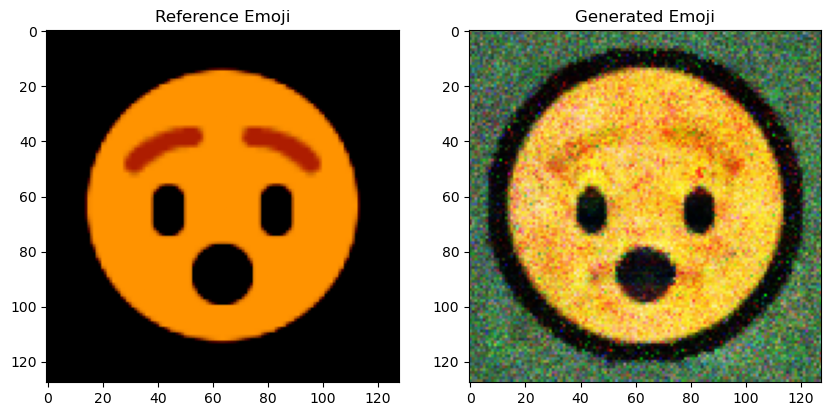

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Similarity Score: 0.08499211
------------------------------------


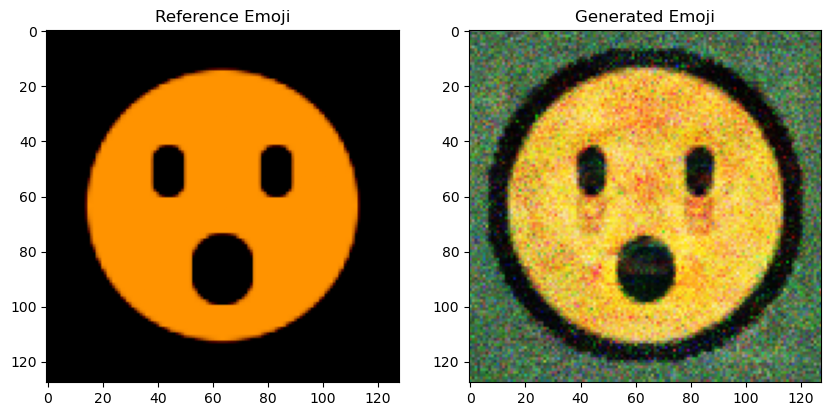

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Similarity Score: 0.0859015
------------------------------------


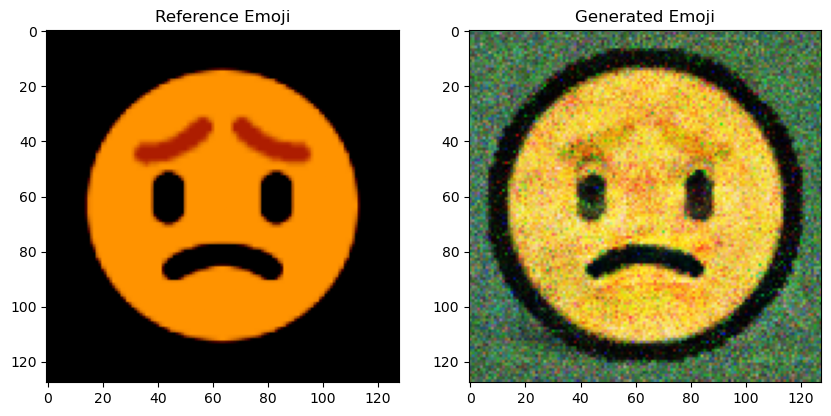

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Similarity Score: 0.08828145
------------------------------------


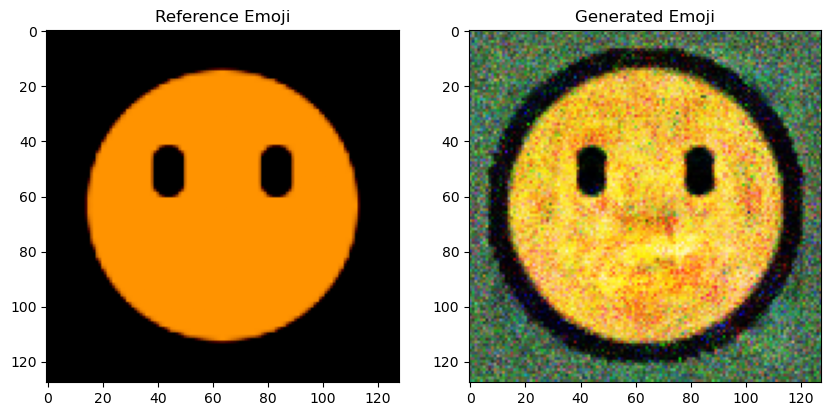

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Similarity Score: 0.089728855
------------------------------------


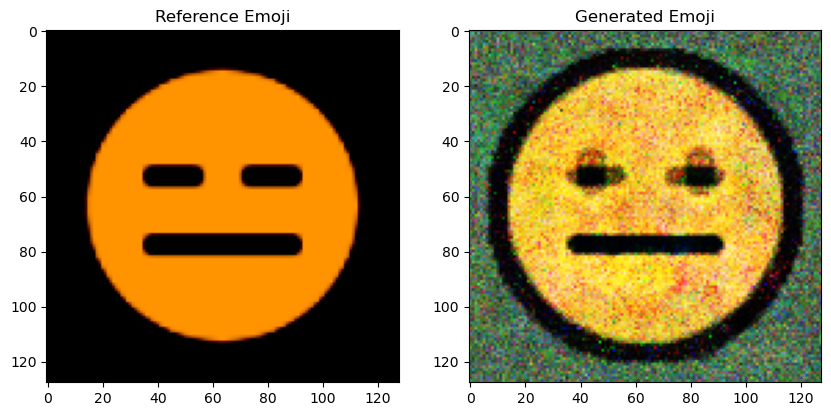

In [63]:
# Print the top 5 most similar generated emojis with their reference emojis
for i, (emoji_file_name, emoji_data) in enumerate(top_5_best_emojis_final.items()):
    # Get the index of the most similar reference emoji
    ref_idx = emoji_data['most_similar_idx']
    
    # Load the reference emoji and the generated emoji
    ref_emoji = dataset[ref_idx]
    gen_emoji = plt.imread(os.path.join(emojis_best_dir,emoji_file_name))
    
    # Print the file name of the reference and generated emojis, as well as the similarity score
    print('Similarity Score:', emoji_data['similarity_score'])
    print('------------------------------------')
    
    # Plot the reference and generated emojis side-by-side
    fig, axs = plt.subplots(1, 2, figsize=(10, 5))
    axs[0].imshow(ref_emoji)
    axs[0].set_title('Reference Emoji')
    axs[1].imshow(gen_emoji)
    axs[1].set_title('Generated Emoji')
    plt.show()

'/Users/dhanushlalitha/Documents/Projects/NN/CW2/Final/emojis_best_dir/emoji_1399_2.png'